In [1]:
from autoPyTorch import (AutoNetClassification, HyperparameterSearchSpaceUpdates)

In [2]:
# Other imports for later usage
import pandas as pd
import numpy as np
import os as os
import openml
import json

In [3]:
search_space_updates_cocktail = HyperparameterSearchSpaceUpdates()

# Fixed architecture space cocktail
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:max_units",
    value_range=[512],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:resnet_shape",
    value_range=["brick"],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:num_groups",
    value_range=[4],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:blocks_per_group",
    value_range=[2],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:use_shake_shake",
    value_range=[False, True],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="CreateDataLoader",
    hyperparameter="batch_size",
    value_range=[128],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:use_dropout",
    value_range=[True, False],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:use_shake_shake",
    value_range=[True, False],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:use_shake_drop",
    value_range=[True, False],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:use_batch_normalization",
    value_range=[True, False],
    log=False,
)
search_space_updates_cocktail.append(
    node_name="NetworkSelector",
    hyperparameter="shapedresnet:use_skip_connection",
    value_range=[True, False],
    log=False,
)

result_directory1 = '.\\logs_moon_cocktail'
#    'C:\\Users\\monum\\Desktop\\Project\\Auto-PyTorch\\regularization',
autonet_cocktail = AutoNetClassification(
    'C:\\Users\\monum\\Desktop\\Project\\Auto-PyTorch\\regularization',
    random_seed=1234,
    working_dir=result_directory1,
    hyperparameter_search_space_updates=search_space_updates_cocktail,
    result_logger_dir=result_directory1,
)

C:\Users\monum\Anaconda3\lib\site-packages\sklearn\utils\deprecation.py:144: FutureWarning: The sklearn.metrics.classification module is  deprecated in version 0.22 and will be removed in version 0.24. The corresponding classes / functions should instead be imported from sklearn.metrics. Anything that cannot be imported from sklearn.metrics is now part of the private API.
  warnings.warn(message, FutureWarning)


In [4]:
# Get the current configuration as dict
current_configuration = autonet_cocktail.get_current_autonet_config()

# Get the ConfigSpace object with all hyperparameters, conditions, default values and default ranges
hyperparameter_search_space = autonet_cocktail.get_hyperparameter_search_space()

# Print all possible configuration options 
#autonet.print_help()

print(current_configuration)

print(hyperparameter_search_space)

{'optimize_metric': 'balanced_accuracy', 'budget_type': 'time', 'max_budget': 90.0, 'min_budget': 30.0, 'validation_split': 0.25, 'memory_limit_mb': 4000, 'max_runtime': 10800.0, 'log_level': 'debug', 'networks': ['shapedresnet'], 'embeddings': ['none'], 'lr_scheduler': ['cosine_annealing', 'plateau', 'exponential'], 'over_sampling_methods': ['none'], 'target_size_strategies': ['none', 'upsample', 'median'], 'preprocessors': ['none'], 'imputation_strategies': ['median'], 'initialization_methods': ['default'], 'loss_modules': ['cross_entropy_weighted'], 'normalization_strategies': ['standardize'], 'optimizer': ['sgd', 'adamw'], 'use_tensorboard_logger': False, 'cuda': False, 'use_pynisher': False, 'random_seed': 1234, 'working_dir': '.\\logs_moon_cocktail', 'hyperparameter_search_space_updates': <autoPyTorch.utils.hyperparameter_search_space_update.HyperparameterSearchSpaceUpdates object at 0x000002B3C7FE0388>, 'result_logger_dir': '.\\logs_moon_cocktail', 'categorical_features': None, 

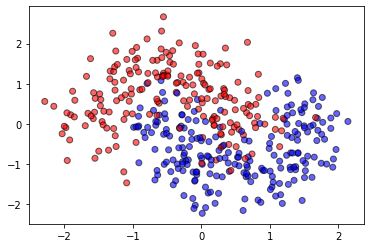

In [5]:
# Generate moon dataset
import matplotlib.pyplot as plt
from sklearn.datasets import make_moons
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from matplotlib.colors import ListedColormap

h = .02  # step size in the mesh

X, y = make_moons(n_samples=1000, noise=0.3, random_state=0)
X = StandardScaler().fit_transform(X)
X_train, X_test, y_train, y_test = \
    train_test_split(X, y, test_size=.4, random_state=42)

x_min, x_max = X[:, 0].min() - .5, X[:, 0].max() + .5
y_min, y_max = X[:, 1].min() - .5, X[:, 1].max() + .5
xx, yy = np.meshgrid(np.arange(x_min, x_max, h),
                         np.arange(y_min, y_max, h))

# just plot the dataset first
cm = plt.cm.RdBu
cm_bright = ListedColormap(['#FF0000', '#0000FF'])
# Plot the testing points
plt.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=cm_bright, alpha=0.6,
           edgecolors='k')
plt.show()

In [6]:
results_fit1 = autonet_cocktail.fit(X_train=X_train,
                          Y_train=y_train,
                          refit=True)
print('Completed fitting the cocktail!')
score = autonet_cocktail.score(X_test=X_test, Y_test=y_test)
print("Accuracy score", score)

# Save fit results as json
with open(os.path.join(result_directory1, 'results_fit.json'), "w") as file:
    json.dump(results_fit1, file)

19:52:46 [AutoNet] Start bohb
19:52:46 WORKER: Connected to nameserver <Pyro4.core.Proxy at 0x2b3c944a188; connected IPv4; for PYRO:Pyro.NameServer@192.168.0.7:59662>
19:52:46 wait_for_workers trying to get the condition
19:52:46 DISPATCHER: started the 'discover_worker' thread
19:52:46 WORKER: No dispatcher found. Waiting for one to initiate contact.
19:52:46 DISPATCHER: started the 'job_runner' thread
19:52:46 WORKER: start listening for jobs
19:52:46 DISPATCHER: Pyro daemon running on 192.168.0.7:59668
19:52:46 DISPATCHER: Starting worker discovery
19:52:46 DISPATCHER: Found 1 potential workers, 0 currently in the pool.
19:52:46 DISPATCHER: discovered new worker, hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
19:52:46 HBMASTER: number of workers changed to 1
19:52:46 Enough workers to start this run!
19:52:46 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
19:52:46 adjust_queue_size: lock accquired
19:52:46 HBMASTER: starting run at 1593539566.175411
19

19:52:48 job_callback for (0, 0, 0) started
19:52:48 DISPATCHER: Trying to submit another job.
19:52:48 job_callback for (0, 0, 0) got condition
19:52:48 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
19:52:48 job (0, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
  Fi

19:52:48 Fit: EmbeddingSelector
19:52:48 Fit: NetworkSelector
19:52:48 Fit: InitializationSelector
19:52:48 Fit: OptimizerSelector
19:52:48 Fit: LearningrateSchedulerSelector
19:52:48 Fit: LogFunctionsSelector
19:52:48 Fit: MetricSelector
19:52:48 Fit: LossModuleSelector
19:52:48 Fit: CreateDataLoader
19:52:48 Fit: TrainNode
19:52:48 Start train. Budget: 29.934175729751587


lastk:  10


19:52:48 tensors used as indices must be long, byte or bool tensors
19:52:48 WORKER: done with job (0, 0, 1), trying to register it.
19:52:48 WORKER: registered result for job (0, 0, 1) with dispatcher
19:52:48 DISPATCHER: job (0, 0, 1) finished
19:52:48 DISPATCHER: register_result: lock acquired
19:52:48 DISPATCHER: job (0, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:52:48 job_id: (0, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimi

19:52:48 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'median', 'ResamplingStrategySelector:under_sampling_method': 'random', 'TrainNode:batch_loss_computation_technique': 'cutout', 'LearningrateSchedulerSelector:exponential:gamma': 0.9866339085635835, 'NetworkSelector:se_lastk': 9, 'Networ

lastk:  9


19:52:49 Perform learning rate scheduling
19:52:49 Budget used: 0.7210838794708252/19.95114040374756
19:52:49 Epoch: 0 : {'loss': 0.760727067788442, 'train_balanced_accuracy': 0.4281237281237281, 'lr_scheduler_converged': False, 'lr': 0.0001206189712227008}
19:52:50 Perform learning rate scheduling
19:52:50 Budget used: 1.373326063156128/19.95114040374756
19:52:50 Epoch: 1 : {'loss': 0.5720738967259725, 'train_balanced_accuracy': 0.7291666666666667, 'lr_scheduler_converged': False, 'lr': 0.0001206189712227008}
19:52:50 Perform learning rate scheduling
19:52:50 Budget used: 2.0096242427825928/19.95114040374756
19:52:50 Epoch: 2 : {'loss': 0.47261665264765423, 'train_balanced_accuracy': 0.8070694192008248, 'lr_scheduler_converged': False, 'lr': 0.00011741611169477161}
19:52:51 Perform learning rate scheduling
19:52:51 Budget used: 2.6439273357391357/19.95114040374756
19:52:51 Epoch: 3 : {'loss': 0.43031879266103107, 'train_balanced_accuracy': 0.8225141120277899, 'lr_scheduler_converged':

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:03 Epoch: 22 : {'loss': 0.3064716011285782, 'train_balanced_accuracy': 0.8586009392220202, 'lr_scheduler_converged': False, 'lr': 8.971156605800288e-05}
19:53:04 Perform learning rate scheduling
19:53:04 Budget used: 15.583316326141357/19.95114040374756


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:04 Epoch: 23 : {'loss': 0.362219641606013, 'train_balanced_accuracy': 0.828001628001628, 'lr_scheduler_converged': False, 'lr': 8.85124730631675e-05}
19:53:05 Perform learning rate scheduling
19:53:05 Budget used: 16.25851058959961/19.95114040374756


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:05 Epoch: 24 : {'loss': 0.4488062759240468, 'train_balanced_accuracy': 0.7795041187505097, 'lr_scheduler_converged': False, 'lr': 8.732940725494184e-05}
19:53:05 Perform learning rate scheduling
19:53:05 Budget used: 16.959635257720947/19.95114040374756


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:05 Epoch: 25 : {'loss': 0.3753517419099808, 'train_balanced_accuracy': 0.7874942316566682, 'lr_scheduler_converged': False, 'lr': 8.616215441248423e-05}
19:53:06 Perform learning rate scheduling
19:53:06 Budget used: 17.611889839172363/19.95114040374756


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:06 Epoch: 26 : {'loss': 0.4099818269411723, 'train_balanced_accuracy': 0.7993478260869565, 'lr_scheduler_converged': False, 'lr': 8.501050317824832e-05}
19:53:07 Perform learning rate scheduling
19:53:07 Budget used: 18.277110815048218/19.95114040374756


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:07 Epoch: 27 : {'loss': 0.3804556131362915, 'train_balanced_accuracy': 0.791304347826087, 'lr_scheduler_converged': False, 'lr': 8.387424501971208e-05}
19:53:07 Perform learning rate scheduling
19:53:07 Budget used: 18.919392824172974/19.95114040374756


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:07 Epoch: 28 : {'loss': 0.3582659363746643, 'train_balanced_accuracy': 0.8328042328042329, 'lr_scheduler_converged': False, 'lr': 8.27531741916182e-05}
19:53:08 Perform learning rate scheduling
19:53:08 Budget used: 19.584614038467407/19.95114040374756


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:08 Epoch: 29 : {'loss': 0.4612290561199188, 'train_balanced_accuracy': 0.7492877492877492, 'lr_scheduler_converged': False, 'lr': 8.164708769871933e-05}
19:53:08 Perform learning rate scheduling
19:53:08 Budget used: 20.02742886543274/19.95114040374756
19:53:08 Budget exhausted!


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:08 Epoch: 30 : {'loss': 0.42361947894096375, 'train_balanced_accuracy': 0.7446893174165902, 'lr_scheduler_converged': False, 'lr': 8.055578525902113e-05}
19:53:09 Finished train with budget 29.95114040374756: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  9


19:53:09 [AutoNet] Done with current split!
19:53:09 Aggregate the results across the splits
19:53:09 Process 1 additional result(s)
19:53:09 Send additional results {} to master
19:53:09 Result: 0.0797011207970113 info: {'loss': 0.42361947894096375, 'train_balanced_accuracy': 0.7446893174165902, 'lr_scheduler_converged': 0.0, 'lr': 8.055578525902113e-05, 'val_balanced_accuracy': 0.9202988792029887}
19:53:09 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.0797011207970113 took 20.546031713485718 seconds
19:53:09 WORKER: done with job (0, 0, 2), trying to register it.
19:53:09 WORKER: registered result for job (0, 0, 2) with dispatcher
19:53:09 DISPATCHER: job (0, 0, 2) finished
19:53:09 DISPATCHER: register_result: lock acquired
19:53:09 DISPATCHER: job (0, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:53:09 job_id: (0, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializati

19:53:09 Starting optimization!
19:53:09 Fit optimization pipeline
19:53:09 Fit: CrossValidation
19:53:09 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
19:53:09 Took 0.04487967491149902 s to initialize optimization.
19:53:09 [AutoNet] CV split 0 of 1
19:53:09 Reduced initial budget 89.9551203250885 to cv budget 89.9541232585907 compensate for 0.0009970664978027344
19:53:09 Fit: Imputation
19:53:09 Fit: NormalizationStrategySelector
19:53:09 Fit: OneHotEncoding
19:53:09 Fit: PreprocessorSelector
19:53:09 Fit: ResamplingStrategySelector
19:53:09 Distribution before resample: [236 214]
19:53:09 Distribution after resample: [225 214]
19:53:09 Fit: EmbeddingSelector
19:53:09 Fit: NetworkSelector
19:53:09 Fit: InitializationSelector
19:53:09 Fit: OptimizerSelector
19:53:09 Fit: LearningrateSchedulerSelector
19:53:09 Fit: LogFunctionsSelector
19:53:09 Fit: MetricSelector
19:53:09 Fit: LossModuleSele

lastk:  9


19:53:10 Perform learning rate scheduling
19:53:10 Budget used: 0.797865629196167/79.9541232585907
19:53:10 Epoch: 0 : {'loss': 0.6886314153671265, 'train_balanced_accuracy': 0.5478632478632479, 'lr_scheduler_converged': False, 'lr': 0.0001206189712227008}
19:53:10 Perform learning rate scheduling
19:53:10 Budget used: 1.4511182308197021/79.9541232585907
19:53:10 Epoch: 1 : {'loss': 0.5536654988924662, 'train_balanced_accuracy': 0.75, 'lr_scheduler_converged': False, 'lr': 0.0001206189712227008}
19:53:11 Perform learning rate scheduling
19:53:11 Budget used: 2.1352880001068115/79.9541232585907
19:53:11 Epoch: 2 : {'loss': 0.4188326398531596, 'train_balanced_accuracy': 0.841127960285381, 'lr_scheduler_converged': False, 'lr': 0.00011741611169477161}
19:53:12 Perform learning rate scheduling
19:53:12 Budget used: 2.8174641132354736/79.9541232585907
19:53:12 Epoch: 3 : {'loss': 0.4493134220441182, 'train_balanced_accuracy': 0.8019973947025618, 'lr_scheduler_converged': False, 'lr': 0.0001

19:53:33 Perform learning rate scheduling
19:53:33 Budget used: 23.527069091796875/79.9541232585907
19:53:33 Epoch: 32 : {'loss': 0.30238256355126697, 'train_balanced_accuracy': 0.8659782608695652, 'lr_scheduler_converged': False, 'lr': 7.841674476040579e-05}
19:53:33 Perform learning rate scheduling
19:53:33 Budget used: 24.21722173690796/79.9541232585907
19:53:33 Epoch: 33 : {'loss': 0.3370482623577118, 'train_balanced_accuracy': 0.828001628001628, 'lr_scheduler_converged': False, 'lr': 7.736861937979207e-05}
19:53:34 Perform learning rate scheduling
19:53:34 Budget used: 24.91435933113098/79.9541232585907
19:53:34 Epoch: 34 : {'loss': 0.38083262244860333, 'train_balanced_accuracy': 0.790846657075382, 'lr_scheduler_converged': False, 'lr': 7.633450333885247e-05}
19:53:35 Perform learning rate scheduling
19:53:35 Budget used: 25.606506824493408/79.9541232585907
19:53:35 Epoch: 35 : {'loss': 0.35155586898326874, 'train_balanced_accuracy': 0.8614307425097698, 'lr_scheduler_converged': F

19:53:55 Perform learning rate scheduling
19:53:55 Budget used: 45.65986728668213/79.9541232585907
19:53:55 Epoch: 64 : {'loss': 0.32554543018341064, 'train_balanced_accuracy': 0.8567629179331306, 'lr_scheduler_converged': False, 'lr': 5.098025456928568e-05}
19:53:55 Perform learning rate scheduling
19:53:55 Budget used: 46.35899543762207/79.9541232585907
19:53:55 Epoch: 65 : {'loss': 0.4243653019269307, 'train_balanced_accuracy': 0.7782783326096396, 'lr_scheduler_converged': False, 'lr': 5.0298847825260815e-05}
19:53:56 Perform learning rate scheduling
19:53:56 Budget used: 47.02920484542847/79.9541232585907
19:53:56 Epoch: 66 : {'loss': 0.2451634258031845, 'train_balanced_accuracy': 0.9088714053174173, 'lr_scheduler_converged': False, 'lr': 4.9626548826081975e-05}
19:53:57 Perform learning rate scheduling
19:53:57 Budget used: 47.71836256980896/79.9541232585907


1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:57 Epoch: 67 : {'loss': 0.3897004226843516, 'train_balanced_accuracy': 0.8080906940706305, 'lr_scheduler_converged': False, 'lr': 4.896323583679877e-05}
19:53:57 Perform learning rate scheduling
19:53:57 Budget used: 48.414499282836914/79.9541232585907


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:57 Epoch: 68 : {'loss': 0.45240092277526855, 'train_balanced_accuracy': 0.7660869565217392, 'lr_scheduler_converged': False, 'lr': 4.830878874958129e-05}
19:53:58 Perform learning rate scheduling
19:53:58 Budget used: 49.106648206710815/79.9541232585907


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:58 Epoch: 69 : {'loss': 0.36979812383651733, 'train_balanced_accuracy': 0.8099042400238722, 'lr_scheduler_converged': False, 'lr': 4.766308906197186e-05}
19:53:59 Perform learning rate scheduling
19:53:59 Budget used: 49.871601819992065/79.9541232585907


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:53:59 Epoch: 70 : {'loss': 0.31073575218518573, 'train_balanced_accuracy': 0.8412349299446074, 'lr_scheduler_converged': False, 'lr': 4.702601985542748e-05}
19:54:00 Perform learning rate scheduling
19:54:00 Budget used: 50.61062502861023/79.9541232585907


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:00 Epoch: 71 : {'loss': 0.24369142949581146, 'train_balanced_accuracy': 0.9096739130434783, 'lr_scheduler_converged': False, 'lr': 4.63974657741491e-05}
19:54:00 Perform learning rate scheduling
19:54:00 Budget used: 51.40350294113159/79.9541232585907


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:00 Epoch: 72 : {'loss': 0.2998497188091278, 'train_balanced_accuracy': 0.8880042318856305, 'lr_scheduler_converged': False, 'lr': 4.577731300419381e-05}
19:54:01 Perform learning rate scheduling
19:54:01 Budget used: 52.171449422836304/79.9541232585907


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:01 Epoch: 73 : {'loss': 0.43654167652130127, 'train_balanced_accuracy': 0.7574877916440586, 'lr_scheduler_converged': False, 'lr': 4.51654492528663e-05}
19:54:02 Perform learning rate scheduling
19:54:02 Budget used: 52.90947651863098/79.9541232585907


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:02 Epoch: 74 : {'loss': 0.39325297872225445, 'train_balanced_accuracy': 0.8072916666666667, 'lr_scheduler_converged': False, 'lr': 4.456176372838566e-05}
19:54:03 Perform learning rate scheduling
19:54:03 Budget used: 53.60062599182129/79.9541232585907


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:03 Epoch: 75 : {'loss': 0.29325880110263824, 'train_balanced_accuracy': 0.8645833333333334, 'lr_scheduler_converged': False, 'lr': 4.396614711982407e-05}
19:54:03 Perform learning rate scheduling
19:54:03 Budget used: 54.301750898361206/79.9541232585907


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:03 Epoch: 76 : {'loss': 0.24389229714870453, 'train_balanced_accuracy': 0.8985294117647059, 'lr_scheduler_converged': False, 'lr': 4.3378491577313554e-05}
19:54:04 Perform learning rate scheduling
19:54:04 Budget used: 55.018834352493286/79.9541232585907


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:04 Epoch: 77 : {'loss': 0.41117862860361737, 'train_balanced_accuracy': 0.8230679442981623, 'lr_scheduler_converged': False, 'lr': 4.279869069251736e-05}
19:54:05 Perform learning rate scheduling
19:54:05 Budget used: 55.72394871711731/79.9541232585907


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:05 Epoch: 78 : {'loss': 0.27101873854796094, 'train_balanced_accuracy': 0.8956269171258721, 'lr_scheduler_converged': False, 'lr': 4.2226639479362264e-05}
19:54:05 Perform learning rate scheduling
19:54:05 Budget used: 56.44704270362854/79.9541232585907


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:05 Epoch: 79 : {'loss': 0.4433152377605438, 'train_balanced_accuracy': 0.7566304347826087, 'lr_scheduler_converged': False, 'lr': 4.166223435502851e-05}
19:54:06 Perform learning rate scheduling
19:54:06 Budget used: 57.16010665893555/79.9541232585907


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:06 Epoch: 80 : {'loss': 0.3003598501284917, 'train_balanced_accuracy': 0.8775094953879544, 'lr_scheduler_converged': False, 'lr': 4.1105373121193786e-05}
19:54:07 Perform learning rate scheduling
19:54:07 Budget used: 57.848265647888184/79.9541232585907


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:07 Epoch: 81 : {'loss': 0.3568052301804225, 'train_balanced_accuracy': 0.8359375, 'lr_scheduler_converged': False, 'lr': 4.055595494552789e-05}
19:54:08 Perform learning rate scheduling
19:54:08 Budget used: 58.56235432624817/79.9541232585907


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:08 Epoch: 82 : {'loss': 0.35946257412433624, 'train_balanced_accuracy': 0.7914676508901433, 'lr_scheduler_converged': False, 'lr': 4.001388034343478e-05}
19:54:08 Perform learning rate scheduling
19:54:08 Budget used: 59.27444839477539/79.9541232585907


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:08 Epoch: 83 : {'loss': 0.40460578600565594, 'train_balanced_accuracy': 0.7627842454575128, 'lr_scheduler_converged': False, 'lr': 3.94790511600386e-05}
19:54:09 Perform learning rate scheduling
19:54:09 Budget used: 59.96560096740723/79.9541232585907


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:09 Epoch: 84 : {'loss': 0.4079409142335256, 'train_balanced_accuracy': 0.7881567520625271, 'lr_scheduler_converged': False, 'lr': 3.8951370552410554e-05}
19:54:10 Perform learning rate scheduling
19:54:10 Budget used: 60.66473126411438/79.9541232585907


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:10 Epoch: 85 : {'loss': 0.34511596461137134, 'train_balanced_accuracy': 0.8328130513857597, 'lr_scheduler_converged': False, 'lr': 3.8430742972033285e-05}
19:54:10 Perform learning rate scheduling
19:54:10 Budget used: 61.39078903198242/79.9541232585907


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:10 Epoch: 86 : {'loss': 0.31641200681527454, 'train_balanced_accuracy': 0.875, 'lr_scheduler_converged': False, 'lr': 3.7917074147499673e-05}
19:54:11 Perform learning rate scheduling
19:54:11 Budget used: 62.089919328689575/79.9541232585907


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:11 Epoch: 87 : {'loss': 0.26014314591884613, 'train_balanced_accuracy': 0.8987455197132617, 'lr_scheduler_converged': False, 'lr': 3.741027106744281e-05}
19:54:12 Perform learning rate scheduling
19:54:12 Budget used: 62.79702639579773/79.9541232585907


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:12 Epoch: 88 : {'loss': 0.33827116588751477, 'train_balanced_accuracy': 0.838401649350297, 'lr_scheduler_converged': False, 'lr': 3.691024196369423e-05}
19:54:13 Perform learning rate scheduling
19:54:13 Budget used: 63.50513243675232/79.9541232585907


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:13 Epoch: 89 : {'loss': 0.3731456746657689, 'train_balanced_accuracy': 0.7781606077048291, 'lr_scheduler_converged': False, 'lr': 3.641689629466724e-05}
19:54:13 Perform learning rate scheduling
19:54:13 Budget used: 64.19030046463013/79.9541232585907


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:13 Epoch: 90 : {'loss': 0.4346708257993062, 'train_balanced_accuracy': 0.7651607651607651, 'lr_scheduler_converged': False, 'lr': 3.593014472896221e-05}
19:54:14 Perform learning rate scheduling
19:54:14 Budget used: 64.89541482925415/79.9541232585907


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:14 Epoch: 91 : {'loss': 0.25415632625420886, 'train_balanced_accuracy': 0.896265109330436, 'lr_scheduler_converged': False, 'lr': 3.5449899129191225e-05}
19:54:15 Perform learning rate scheduling
19:54:15 Budget used: 65.60551524162292/79.9541232585907


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:15 Epoch: 92 : {'loss': 0.41399558385213214, 'train_balanced_accuracy': 0.7890669564036399, 'lr_scheduler_converged': False, 'lr': 3.497607253601872e-05}
19:54:15 Perform learning rate scheduling
19:54:15 Budget used: 66.29168009757996/79.9541232585907


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:15 Epoch: 93 : {'loss': 0.4404790898164113, 'train_balanced_accuracy': 0.7526658526658527, 'lr_scheduler_converged': False, 'lr': 3.450857915241555e-05}
19:54:16 Perform learning rate scheduling
19:54:16 Budget used: 66.9928047657013/79.9541232585907


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:16 Epoch: 94 : {'loss': 0.3711102108160655, 'train_balanced_accuracy': 0.8171080205753477, 'lr_scheduler_converged': False, 'lr': 3.404733432812355e-05}
19:54:17 Perform learning rate scheduling
19:54:17 Budget used: 67.70689463615417/79.9541232585907


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:17 Epoch: 95 : {'loss': 0.23724902172883353, 'train_balanced_accuracy': 0.9192349430276723, 'lr_scheduler_converged': False, 'lr': 3.3592254544327605e-05}
19:54:17 Perform learning rate scheduling
19:54:17 Budget used: 68.41001462936401/79.9541232585907


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:17 Epoch: 96 : {'loss': 0.3681457191705704, 'train_balanced_accuracy': 0.8217391304347825, 'lr_scheduler_converged': False, 'lr': 3.314325739853274e-05}
19:54:18 Perform learning rate scheduling
19:54:18 Budget used: 69.12111234664917/79.9541232585907


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:18 Epoch: 97 : {'loss': 0.45810643831888836, 'train_balanced_accuracy': 0.7259088442756375, 'lr_scheduler_converged': False, 'lr': 3.2700261589643266e-05}
19:54:19 Perform learning rate scheduling
19:54:19 Budget used: 69.82323241233826/79.9541232585907


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:19 Epoch: 98 : {'loss': 0.43181438247362774, 'train_balanced_accuracy': 0.7935869565217392, 'lr_scheduler_converged': False, 'lr': 3.226318690324136e-05}
19:54:20 Perform learning rate scheduling
19:54:20 Budget used: 70.52735090255737/79.9541232585907


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:20 Epoch: 99 : {'loss': 0.28930073976516724, 'train_balanced_accuracy': 0.8696643857934181, 'lr_scheduler_converged': False, 'lr': 3.1831954197062436e-05}
19:54:20 Perform learning rate scheduling
19:54:20 Budget used: 71.25241208076477/79.9541232585907


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:20 Epoch: 100 : {'loss': 0.361711988846461, 'train_balanced_accuracy': 0.8292553625316043, 'lr_scheduler_converged': False, 'lr': 3.1406485386664676e-05}
19:54:21 Perform learning rate scheduling
19:54:21 Budget used: 71.96151399612427/79.9541232585907


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:21 Epoch: 101 : {'loss': 0.2944765239953995, 'train_balanced_accuracy': 0.8720652173913044, 'lr_scheduler_converged': False, 'lr': 3.0986703431290035e-05}
19:54:22 Perform learning rate scheduling
19:54:22 Budget used: 72.64967465400696/79.9541232585907


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:22 Epoch: 102 : {'loss': 0.30407089988390607, 'train_balanced_accuracy': 0.8590081163983821, 'lr_scheduler_converged': False, 'lr': 3.057253231991429e-05}
19:54:22 Perform learning rate scheduling
19:54:22 Budget used: 73.36276435852051/79.9541232585907


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:22 Epoch: 103 : {'loss': 0.23178795476754507, 'train_balanced_accuracy': 0.9117207659921228, 'lr_scheduler_converged': False, 'lr': 3.0163897057483514e-05}
19:54:23 Perform learning rate scheduling
19:54:23 Budget used: 74.06787991523743/79.9541232585907


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:23 Epoch: 104 : {'loss': 0.4281136890252431, 'train_balanced_accuracy': 0.7620560443141089, 'lr_scheduler_converged': False, 'lr': 2.9760723651334534e-05}
19:54:24 Perform learning rate scheduling
19:54:24 Budget used: 74.75703597068787/79.9541232585907


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:24 Epoch: 105 : {'loss': 0.42686641216278076, 'train_balanced_accuracy': 0.7805474095796676, 'lr_scheduler_converged': False, 'lr': 2.9362939097796875e-05}
19:54:24 Perform learning rate scheduling
19:54:24 Budget used: 75.46314644813538/79.9541232585907


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:25 Epoch: 106 : {'loss': 0.2964857220649719, 'train_balanced_accuracy': 0.8725681725681727, 'lr_scheduler_converged': False, 'lr': 2.897047136897379e-05}
19:54:25 Perform learning rate scheduling
19:54:25 Budget used: 76.16726469993591/79.9541232585907


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:25 Epoch: 107 : {'loss': 0.3308590054512024, 'train_balanced_accuracy': 0.8727124183006536, 'lr_scheduler_converged': False, 'lr': 2.8583249399700003e-05}
19:54:26 Perform learning rate scheduling
19:54:26 Budget used: 76.86340236663818/79.9541232585907


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:26 Epoch: 108 : {'loss': 0.3165674110253652, 'train_balanced_accuracy': 0.8630209607699209, 'lr_scheduler_converged': False, 'lr': 2.820120307467371e-05}
19:54:27 Perform learning rate scheduling
19:54:27 Budget used: 77.57250499725342/79.9541232585907


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:27 Epoch: 109 : {'loss': 0.39756855368614197, 'train_balanced_accuracy': 0.7785946825827454, 'lr_scheduler_converged': False, 'lr': 2.782426321576067e-05}
19:54:27 Perform learning rate scheduling
19:54:27 Budget used: 78.27063775062561/79.9541232585907


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:27 Epoch: 110 : {'loss': 0.3705088496208191, 'train_balanced_accuracy': 0.8228304804275289, 'lr_scheduler_converged': False, 'lr': 2.7452361569467892e-05}
19:54:28 Perform learning rate scheduling
19:54:28 Budget used: 78.9657793045044/79.9541232585907


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:28 Epoch: 111 : {'loss': 0.3145073751608531, 'train_balanced_accuracy': 0.8620703686623443, 'lr_scheduler_converged': False, 'lr': 2.7085430794584818e-05}
19:54:29 Perform learning rate scheduling
19:54:29 Budget used: 79.67787456512451/79.9541232585907


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:29 Epoch: 112 : {'loss': 0.3562888999780019, 'train_balanced_accuracy': 0.7766339869281046, 'lr_scheduler_converged': False, 'lr': 2.6723404449989665e-05}
19:54:29 Perform learning rate scheduling
19:54:29 Budget used: 80.1496114730835/79.9541232585907
19:54:29 Budget exhausted!


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


19:54:29 Epoch: 113 : {'loss': 0.4699907749891281, 'train_balanced_accuracy': 0.7386453939727367, 'lr_scheduler_converged': False, 'lr': 2.6366216982618764e-05}
19:54:30 Finished train with budget 89.9541232585907: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  9


19:54:30 [AutoNet] Done with current split!
19:54:30 Aggregate the results across the splits
19:54:30 Process 1 additional result(s)
19:54:30 Send additional results {} to master
19:54:30 Result: 0.06600249066002495 info: {'loss': 0.4699907749891281, 'train_balanced_accuracy': 0.7386453939727367, 'lr_scheduler_converged': 0.0, 'lr': 2.6366216982618764e-05, 'val_balanced_accuracy': 0.933997509339975}
19:54:30 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.70811748504639 seconds
19:54:30 WORKER: done with job (0, 0, 2), trying to register it.
19:54:30 WORKER: registered result for job (0, 0, 2) with dispatcher
19:54:30 DISPATCHER: job (0, 0, 2) finished
19:54:30 DISPATCHER: register_result: lock acquired
19:54:30 DISPATCHER: job (0, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:54:30 job_id: (0, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializati

19:54:30 Starting optimization!
19:54:30 Fit optimization pipeline
19:54:30 Fit: CrossValidation
19:54:30 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
19:54:30 Took 0.04587602615356445 s to initialize optimization.
19:54:30 [AutoNet] CV split 0 of 1
19:54:30 Reduced initial budget 89.95412397384644 to cv budget 89.95312714576721 compensate for 0.0009968280792236328
19:54:30 Fit: Imputation
19:54:30 Fit: NormalizationStrategySelector
19:54:30 Fit: OneHotEncoding
19:54:30 Fit: PreprocessorSelector
19:54:30 Fit: ResamplingStrategySelector
19:54:30 Distribution before resample: [236 214]
19:54:30 Distribution after resample: [225 214]
19:54:30 Fit: EmbeddingSelector
19:54:30 Fit: NetworkSelector
19:54:30 Fit: InitializationSelector
19:54:30 Fit: OptimizerSelector
19:54:30 Fit: LearningrateSchedulerSelector
19:54:30 Fit: LogFunctionsSelector
19:54:30 Fit: MetricSelector
19:54:30 Fit: LossModuleSe

lastk:  10


19:54:30 Perform learning rate scheduling
19:54:30 Budget used: 0.6532535552978516/79.95312714576721
19:54:30 Epoch: 0 : {'loss': 0.7196323076883951, 'train_balanced_accuracy': 0.5235246235246236, 'lr_scheduler_converged': False}
19:54:31 Perform learning rate scheduling
19:54:31 Budget used: 1.1997911930084229/79.95312714576721
19:54:31 Epoch: 1 : {'loss': 0.719663679599762, 'train_balanced_accuracy': 0.4910362623930463, 'lr_scheduler_converged': False}
19:54:32 Perform learning rate scheduling
19:54:32 Budget used: 1.7383508682250977/79.95312714576721
19:54:32 Epoch: 2 : {'loss': 0.7139943639437357, 'train_balanced_accuracy': 0.5208333333333334, 'lr_scheduler_converged': False}
19:54:32 Perform learning rate scheduling
19:54:32 Budget used: 2.2789041996002197/79.95312714576721
19:54:32 Epoch: 3 : {'loss': 0.7404960592587789, 'train_balanced_accuracy': 0.47655166789005793, 'lr_scheduler_converged': False}
19:54:33 Perform learning rate scheduling
19:54:33 Budget used: 2.81447148323059

19:54:50 Perform learning rate scheduling
19:54:50 Budget used: 20.29271936416626/79.95312714576721
19:54:50 Epoch: 36 : {'loss': 0.7255650957425436, 'train_balanced_accuracy': 0.4732608695652174, 'lr_scheduler_converged': False}
19:54:51 Perform learning rate scheduling
19:54:51 Budget used: 20.82828640937805/79.95312714576721
19:54:51 Epoch: 37 : {'loss': 0.7216883103052775, 'train_balanced_accuracy': 0.4968219475757164, 'lr_scheduler_converged': False}
19:54:51 Perform learning rate scheduling
19:54:51 Budget used: 21.385795831680298/79.95312714576721
19:54:51 Epoch: 38 : {'loss': 0.7075427174568176, 'train_balanced_accuracy': 0.4796812098792297, 'lr_scheduler_converged': False}
19:54:52 Perform learning rate scheduling
19:54:52 Budget used: 21.918370485305786/79.95312714576721
19:54:52 Epoch: 39 : {'loss': 0.7168314655621847, 'train_balanced_accuracy': 0.4734671730873576, 'lr_scheduler_converged': False}
19:54:52 Perform learning rate scheduling
19:54:52 Budget used: 22.47188997268

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:07 Epoch: 67 : {'loss': 0.7217747370402018, 'train_balanced_accuracy': 0.4663003663003663, 'lr_scheduler_converged': False}
19:55:08 Perform learning rate scheduling
19:55:08 Budget used: 37.9754204750061/79.95312714576721


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:08 Epoch: 68 : {'loss': 0.7441225250562032, 'train_balanced_accuracy': 0.5204081632653061, 'lr_scheduler_converged': False}
19:55:08 Perform learning rate scheduling
19:55:08 Budget used: 38.54191541671753/79.95312714576721


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:08 Epoch: 69 : {'loss': 0.7374071677525839, 'train_balanced_accuracy': 0.5338849701573521, 'lr_scheduler_converged': False}
19:55:09 Perform learning rate scheduling
19:55:09 Budget used: 39.13332414627075/79.95312714576721


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:09 Epoch: 70 : {'loss': 0.7382492025693258, 'train_balanced_accuracy': 0.4944607363962203, 'lr_scheduler_converged': False}
19:55:09 Perform learning rate scheduling
19:55:09 Budget used: 39.70279932022095/79.95312714576721


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:09 Epoch: 71 : {'loss': 0.7237890958786011, 'train_balanced_accuracy': 0.5022517634291915, 'lr_scheduler_converged': False}
19:55:10 Perform learning rate scheduling
19:55:10 Budget used: 40.262304067611694/79.95312714576721


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:10 Epoch: 72 : {'loss': 0.7374581694602966, 'train_balanced_accuracy': 0.5004477004477004, 'lr_scheduler_converged': False}
19:55:11 Perform learning rate scheduling
19:55:11 Budget used: 40.82878875732422/79.95312714576721


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:11 Epoch: 73 : {'loss': 0.7210963368415833, 'train_balanced_accuracy': 0.49193548387096775, 'lr_scheduler_converged': False}
19:55:11 Perform learning rate scheduling
19:55:11 Budget used: 41.40225386619568/79.95312714576721


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:11 Epoch: 74 : {'loss': 0.7151364882787069, 'train_balanced_accuracy': 0.5546076011176518, 'lr_scheduler_converged': False}
19:55:12 Perform learning rate scheduling
19:55:12 Budget used: 41.958765506744385/79.95312714576721


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:12 Epoch: 75 : {'loss': 0.7243537704149882, 'train_balanced_accuracy': 0.4814407814407814, 'lr_scheduler_converged': False}
19:55:12 Perform learning rate scheduling
19:55:12 Budget used: 42.52724623680115/79.95312714576721


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:12 Epoch: 76 : {'loss': 0.716162919998169, 'train_balanced_accuracy': 0.5388278388278389, 'lr_scheduler_converged': False}
19:55:13 Perform learning rate scheduling
19:55:13 Budget used: 43.07877039909363/79.95312714576721


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:13 Epoch: 77 : {'loss': 0.713112473487854, 'train_balanced_accuracy': 0.5143478260869565, 'lr_scheduler_converged': False}
19:55:13 Perform learning rate scheduling
19:55:13 Budget used: 43.65622663497925/79.95312714576721


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:13 Epoch: 78 : {'loss': 0.7405422727266947, 'train_balanced_accuracy': 0.5016825879287885, 'lr_scheduler_converged': False}
19:55:14 Perform learning rate scheduling
19:55:14 Budget used: 44.20278215408325/79.95312714576721


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:14 Epoch: 79 : {'loss': 0.7116895715395609, 'train_balanced_accuracy': 0.5151704468287382, 'lr_scheduler_converged': False}
19:55:15 Perform learning rate scheduling
19:55:15 Budget used: 44.796175479888916/79.95312714576721


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:15 Epoch: 80 : {'loss': 0.72483362754186, 'train_balanced_accuracy': 0.48397357474920477, 'lr_scheduler_converged': False}
19:55:15 Perform learning rate scheduling
19:55:15 Budget used: 45.355679512023926/79.95312714576721


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:15 Epoch: 81 : {'loss': 0.7206766208012899, 'train_balanced_accuracy': 0.5123004235907462, 'lr_scheduler_converged': False}
19:55:16 Perform learning rate scheduling
19:55:16 Budget used: 45.921168088912964/79.95312714576721


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:16 Epoch: 82 : {'loss': 0.7271143992741903, 'train_balanced_accuracy': 0.49989148128052086, 'lr_scheduler_converged': False}
19:55:16 Perform learning rate scheduling
19:55:16 Budget used: 46.47468829154968/79.95312714576721


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:16 Epoch: 83 : {'loss': 0.709216833114624, 'train_balanced_accuracy': 0.5074257425742574, 'lr_scheduler_converged': False}
19:55:17 Perform learning rate scheduling
19:55:17 Budget used: 47.04117012023926/79.95312714576721


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:17 Epoch: 84 : {'loss': 0.7327792445818583, 'train_balanced_accuracy': 0.495, 'lr_scheduler_converged': False}
19:55:17 Perform learning rate scheduling
19:55:17 Budget used: 47.607656955718994/79.95312714576721


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:17 Epoch: 85 : {'loss': 0.716219166914622, 'train_balanced_accuracy': 0.4857271021939483, 'lr_scheduler_converged': False}
19:55:18 Perform learning rate scheduling
19:55:18 Budget used: 48.16915512084961/79.95312714576721


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:18 Epoch: 86 : {'loss': 0.7129701177279154, 'train_balanced_accuracy': 0.507544507164568, 'lr_scheduler_converged': False}
19:55:18 Perform learning rate scheduling
19:55:18 Budget used: 48.7276611328125/79.95312714576721


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:19 Epoch: 87 : {'loss': 0.7340287963549296, 'train_balanced_accuracy': 0.5201465201465201, 'lr_scheduler_converged': False}
19:55:19 Perform learning rate scheduling
19:55:19 Budget used: 49.35996890068054/79.95312714576721


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:19 Epoch: 88 : {'loss': 0.7044535279273987, 'train_balanced_accuracy': 0.5257631257631257, 'lr_scheduler_converged': False}
19:55:20 Perform learning rate scheduling
19:55:20 Budget used: 49.929444551467896/79.95312714576721


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:20 Epoch: 89 : {'loss': 0.7303258577982584, 'train_balanced_accuracy': 0.4941773663780233, 'lr_scheduler_converged': False}
19:55:20 Perform learning rate scheduling
19:55:20 Budget used: 50.487950801849365/79.95312714576721


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:20 Epoch: 90 : {'loss': 0.7169633706410726, 'train_balanced_accuracy': 0.49739583333333337, 'lr_scheduler_converged': False}
19:55:21 Perform learning rate scheduling
19:55:21 Budget used: 51.05942392349243/79.95312714576721


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:21 Epoch: 91 : {'loss': 0.7392365535100301, 'train_balanced_accuracy': 0.498710605608187, 'lr_scheduler_converged': False}
19:55:21 Perform learning rate scheduling
19:55:21 Budget used: 51.6149377822876/79.95312714576721


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:21 Epoch: 92 : {'loss': 0.721819539864858, 'train_balanced_accuracy': 0.5364583333333333, 'lr_scheduler_converged': False}
19:55:22 Perform learning rate scheduling
19:55:22 Budget used: 52.18241858482361/79.95312714576721


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:22 Epoch: 93 : {'loss': 0.7194281021753947, 'train_balanced_accuracy': 0.5454347826086956, 'lr_scheduler_converged': False}
19:55:23 Perform learning rate scheduling
19:55:23 Budget used: 52.738930463790894/79.95312714576721


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:23 Epoch: 94 : {'loss': 0.7047791878382365, 'train_balanced_accuracy': 0.5123154718212217, 'lr_scheduler_converged': False}
19:55:23 Perform learning rate scheduling
19:55:23 Budget used: 53.313392877578735/79.95312714576721


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:23 Epoch: 95 : {'loss': 0.708348830540975, 'train_balanced_accuracy': 0.48615597600369176, 'lr_scheduler_converged': False}
19:55:24 Perform learning rate scheduling
19:55:24 Budget used: 53.872896671295166/79.95312714576721


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:24 Epoch: 96 : {'loss': 0.716182549794515, 'train_balanced_accuracy': 0.5183381710658383, 'lr_scheduler_converged': False}
19:55:24 Perform learning rate scheduling
19:55:24 Budget used: 54.4433708190918/79.95312714576721


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:24 Epoch: 97 : {'loss': 0.7303563555081686, 'train_balanced_accuracy': 0.4961725345421971, 'lr_scheduler_converged': False}
19:55:25 Perform learning rate scheduling
19:55:25 Budget used: 54.989908933639526/79.95312714576721


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:25 Epoch: 98 : {'loss': 0.7318499286969503, 'train_balanced_accuracy': 0.49109639241021746, 'lr_scheduler_converged': False}
19:55:25 Perform learning rate scheduling
19:55:25 Budget used: 55.551408529281616/79.95312714576721


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:25 Epoch: 99 : {'loss': 0.7367158929506937, 'train_balanced_accuracy': 0.4476939772110689, 'lr_scheduler_converged': False}
19:55:26 Perform learning rate scheduling
19:55:26 Budget used: 56.10892653465271/79.95312714576721


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:26 Epoch: 100 : {'loss': 0.713774045308431, 'train_balanced_accuracy': 0.5203093203093203, 'lr_scheduler_converged': False}
19:55:26 Perform learning rate scheduling
19:55:26 Budget used: 56.674402952194214/79.95312714576721


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:26 Epoch: 101 : {'loss': 0.7033324042956034, 'train_balanced_accuracy': 0.5233024984401704, 'lr_scheduler_converged': False}
19:55:27 Perform learning rate scheduling
19:55:27 Budget used: 57.231913328170776/79.95312714576721


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:27 Epoch: 102 : {'loss': 0.7140043179194132, 'train_balanced_accuracy': 0.5536819811013359, 'lr_scheduler_converged': False}
19:55:28 Perform learning rate scheduling
19:55:28 Budget used: 57.78942060470581/79.95312714576721


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:28 Epoch: 103 : {'loss': 0.6990796128908793, 'train_balanced_accuracy': 0.5152625152625152, 'lr_scheduler_converged': False}
19:55:28 Perform learning rate scheduling
19:55:28 Budget used: 58.3349609375/79.95312714576721


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:28 Epoch: 104 : {'loss': 0.7206587592760721, 'train_balanced_accuracy': 0.5272408449555501, 'lr_scheduler_converged': False}
19:55:29 Perform learning rate scheduling
19:55:29 Budget used: 58.89645957946777/79.95312714576721


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:29 Epoch: 105 : {'loss': 0.7221930623054504, 'train_balanced_accuracy': 0.5389532832052988, 'lr_scheduler_converged': False}
19:55:29 Perform learning rate scheduling
19:55:29 Budget used: 59.450976610183716/79.95312714576721


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:29 Epoch: 106 : {'loss': 0.717787504196167, 'train_balanced_accuracy': 0.49630826026765107, 'lr_scheduler_converged': False}
19:55:30 Perform learning rate scheduling
19:55:30 Budget used: 60.007487297058105/79.95312714576721


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:30 Epoch: 107 : {'loss': 0.715613583723704, 'train_balanced_accuracy': 0.5207163207163208, 'lr_scheduler_converged': False}
19:55:30 Perform learning rate scheduling
19:55:30 Budget used: 60.58095335960388/79.95312714576721


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:30 Epoch: 108 : {'loss': 0.7254526813824972, 'train_balanced_accuracy': 0.5093847616460682, 'lr_scheduler_converged': False}
19:55:31 Perform learning rate scheduling
19:55:31 Budget used: 61.140458822250366/79.95312714576721


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:31 Epoch: 109 : {'loss': 0.7204718589782715, 'train_balanced_accuracy': 0.5282679738562092, 'lr_scheduler_converged': False}
19:55:31 Perform learning rate scheduling
19:55:31 Budget used: 61.69797372817993/79.95312714576721


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:31 Epoch: 110 : {'loss': 0.7159328858057658, 'train_balanced_accuracy': 0.49666014988595636, 'lr_scheduler_converged': False}
19:55:32 Perform learning rate scheduling
19:55:32 Budget used: 62.25347971916199/79.95312714576721


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:32 Epoch: 111 : {'loss': 0.7295299371083578, 'train_balanced_accuracy': 0.48032608695652174, 'lr_scheduler_converged': False}
19:55:33 Perform learning rate scheduling
19:55:33 Budget used: 62.815975189208984/79.95312714576721


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:33 Epoch: 112 : {'loss': 0.7196211616198221, 'train_balanced_accuracy': 0.5412359917310412, 'lr_scheduler_converged': False}
19:55:33 Perform learning rate scheduling
19:55:33 Budget used: 63.36151576042175/79.95312714576721


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:33 Epoch: 113 : {'loss': 0.7187014619509379, 'train_balanced_accuracy': 0.47838827838827835, 'lr_scheduler_converged': False}
19:55:34 Perform learning rate scheduling
19:55:34 Budget used: 63.93099284172058/79.95312714576721


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:34 Epoch: 114 : {'loss': 0.7251733740170797, 'train_balanced_accuracy': 0.49979649979649976, 'lr_scheduler_converged': False}
19:55:34 Perform learning rate scheduling
19:55:34 Budget used: 64.48351573944092/79.95312714576721


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:34 Epoch: 115 : {'loss': 0.728116512298584, 'train_balanced_accuracy': 0.4902349585766671, 'lr_scheduler_converged': False}
19:55:35 Perform learning rate scheduling
19:55:35 Budget used: 65.04501271247864/79.95312714576721


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:35 Epoch: 116 : {'loss': 0.7209154367446899, 'train_balanced_accuracy': 0.4896873643074251, 'lr_scheduler_converged': False}
19:55:35 Perform learning rate scheduling
19:55:35 Budget used: 65.59753584861755/79.95312714576721


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:35 Epoch: 117 : {'loss': 0.7481126189231873, 'train_balanced_accuracy': 0.46225723210647834, 'lr_scheduler_converged': False}
19:55:36 Perform learning rate scheduling
19:55:36 Budget used: 66.16402077674866/79.95312714576721


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:36 Epoch: 118 : {'loss': 0.7207277417182922, 'train_balanced_accuracy': 0.51297221016066, 'lr_scheduler_converged': False}
19:55:36 Perform learning rate scheduling
19:55:36 Budget used: 66.71654200553894/79.95312714576721


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:37 Epoch: 119 : {'loss': 0.6985101898511251, 'train_balanced_accuracy': 0.5207522521296574, 'lr_scheduler_converged': False}
19:55:37 Perform learning rate scheduling
19:55:37 Budget used: 67.27804040908813/79.95312714576721


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:37 Epoch: 120 : {'loss': 0.7394576867421468, 'train_balanced_accuracy': 0.4945845435543853, 'lr_scheduler_converged': False}
19:55:38 Perform learning rate scheduling
19:55:38 Budget used: 67.83155941963196/79.95312714576721


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:38 Epoch: 121 : {'loss': 0.7065480550130209, 'train_balanced_accuracy': 0.5127770393077069, 'lr_scheduler_converged': False}
19:55:38 Perform learning rate scheduling
19:55:38 Budget used: 68.39205980300903/79.95312714576721


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:38 Epoch: 122 : {'loss': 0.7200783888498942, 'train_balanced_accuracy': 0.46503705312304894, 'lr_scheduler_converged': False}
19:55:39 Perform learning rate scheduling
19:55:39 Budget used: 68.96053957939148/79.95312714576721


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:39 Epoch: 123 : {'loss': 0.7279365261395773, 'train_balanced_accuracy': 0.502685838307108, 'lr_scheduler_converged': False}
19:55:39 Perform learning rate scheduling
19:55:39 Budget used: 69.57788801193237/79.95312714576721


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:39 Epoch: 124 : {'loss': 0.723875105381012, 'train_balanced_accuracy': 0.5027676027676028, 'lr_scheduler_converged': False}
19:55:40 Perform learning rate scheduling
19:55:40 Budget used: 70.14038300514221/79.95312714576721


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:40 Epoch: 125 : {'loss': 0.7427444656689962, 'train_balanced_accuracy': 0.5364152121393089, 'lr_scheduler_converged': False}
19:55:40 Perform learning rate scheduling
19:55:40 Budget used: 70.69490003585815/79.95312714576721


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:40 Epoch: 126 : {'loss': 0.7174152731895447, 'train_balanced_accuracy': 0.5032608695652174, 'lr_scheduler_converged': False}
19:55:41 Perform learning rate scheduling
19:55:41 Budget used: 71.25440311431885/79.95312714576721


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:41 Epoch: 127 : {'loss': 0.7045984268188477, 'train_balanced_accuracy': 0.5124867667417683, 'lr_scheduler_converged': False}
19:55:42 Perform learning rate scheduling
19:55:42 Budget used: 71.8149049282074/79.95312714576721


62-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:42 Epoch: 128 : {'loss': 0.720262885093689, 'train_balanced_accuracy': 0.48118279569892475, 'lr_scheduler_converged': False}
19:55:42 Perform learning rate scheduling
19:55:42 Budget used: 72.3714165687561/79.95312714576721


63-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:42 Epoch: 129 : {'loss': 0.7082774639129639, 'train_balanced_accuracy': 0.5070261437908496, 'lr_scheduler_converged': False}
19:55:43 Perform learning rate scheduling
19:55:43 Budget used: 72.91595983505249/79.95312714576721


64-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:43 Epoch: 130 : {'loss': 0.717269241809845, 'train_balanced_accuracy': 0.528001628001628, 'lr_scheduler_converged': False}
19:55:43 Perform learning rate scheduling
19:55:43 Budget used: 73.48942708969116/79.95312714576721


65-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:43 Epoch: 131 : {'loss': 0.7261401613553365, 'train_balanced_accuracy': 0.47631771695195724, 'lr_scheduler_converged': False}
19:55:44 Perform learning rate scheduling
19:55:44 Budget used: 74.04493999481201/79.95312714576721


66-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:44 Epoch: 132 : {'loss': 0.7189381321271261, 'train_balanced_accuracy': 0.5233838808561431, 'lr_scheduler_converged': False}
19:55:44 Perform learning rate scheduling
19:55:44 Budget used: 74.6333658695221/79.95312714576721


67-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:44 Epoch: 133 : {'loss': 0.7231845657030741, 'train_balanced_accuracy': 0.4924308193163321, 'lr_scheduler_converged': False}
19:55:45 Perform learning rate scheduling
19:55:45 Budget used: 75.18189787864685/79.95312714576721


68-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:45 Epoch: 134 : {'loss': 0.7054258584976196, 'train_balanced_accuracy': 0.48032608695652174, 'lr_scheduler_converged': False}
19:55:46 Perform learning rate scheduling
19:55:46 Budget used: 75.74638795852661/79.95312714576721


69-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:46 Epoch: 135 : {'loss': 0.7270802656809489, 'train_balanced_accuracy': 0.4948050891137455, 'lr_scheduler_converged': False}
19:55:46 Perform learning rate scheduling
19:55:46 Budget used: 76.29691576957703/79.95312714576721


70-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:46 Epoch: 136 : {'loss': 0.7135419448216757, 'train_balanced_accuracy': 0.5247532827664954, 'lr_scheduler_converged': False}
19:55:47 Perform learning rate scheduling
19:55:47 Budget used: 76.87038230895996/79.95312714576721


71-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:47 Epoch: 137 : {'loss': 0.7111850579579672, 'train_balanced_accuracy': 0.5730340128667988, 'lr_scheduler_converged': False}
19:55:47 Perform learning rate scheduling
19:55:47 Budget used: 77.41891431808472/79.95312714576721


72-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:47 Epoch: 138 : {'loss': 0.7269973158836365, 'train_balanced_accuracy': 0.4758467216673904, 'lr_scheduler_converged': False}
19:55:48 Perform learning rate scheduling
19:55:48 Budget used: 77.97941732406616/79.95312714576721


73-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:48 Epoch: 139 : {'loss': 0.726506769657135, 'train_balanced_accuracy': 0.484375, 'lr_scheduler_converged': False}
19:55:48 Perform learning rate scheduling
19:55:48 Budget used: 78.52894568443298/79.95312714576721


74-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:48 Epoch: 140 : {'loss': 0.7095159888267517, 'train_balanced_accuracy': 0.5432150709845545, 'lr_scheduler_converged': False}
19:55:49 Perform learning rate scheduling
19:55:49 Budget used: 79.10340809822083/79.95312714576721


75-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:49 Epoch: 141 : {'loss': 0.7309733629226685, 'train_balanced_accuracy': 0.4671739130434783, 'lr_scheduler_converged': False}
19:55:49 Perform learning rate scheduling
19:55:49 Budget used: 79.65692830085754/79.95312714576721


76-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:49 Epoch: 142 : {'loss': 0.7310639421145121, 'train_balanced_accuracy': 0.4632608695652174, 'lr_scheduler_converged': False}
19:55:50 Perform learning rate scheduling
19:55:50 Budget used: 80.05087399482727/79.95312714576721
19:55:50 Budget exhausted!


77-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


19:55:50 Epoch: 143 : {'loss': 0.7132715284824371, 'train_balanced_accuracy': 0.5262595419847328, 'lr_scheduler_converged': False}
19:55:50 Finished train with budget 89.95312714576721: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  10


19:55:50 [AutoNet] Done with current split!
19:55:50 Aggregate the results across the splits
19:55:50 Process 1 additional result(s)
19:55:50 Send additional results {} to master
19:55:50 Result: 0.6429460950008895 info: {'loss': 0.7132715284824371, 'train_balanced_accuracy': 0.5262595419847328, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.3570539049991105}
19:55:50 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.6429460950008895 took 80.5076515674591 seconds
19:55:50 WORKER: done with job (1, 0, 0), trying to register it.
19:55:50 WORKER: registered result for job (1, 0, 0) with dispatcher
19:55:50 DISPATCHER: job (1, 0, 0) finished
19:55:50 DISPATCHER: register_result: lock acquired
19:55:50 DISPATCHER: job (1, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:55:50 job_id: (1, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method

19:55:50 Starting optimization!
19:55:50 Fit optimization pipeline
19:55:50 Fit: CrossValidation
19:55:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
19:55:50 Took 0.046872615814208984 s to initialize optimization.
19:55:50 [AutoNet] CV split 0 of 1
19:55:50 Reduced initial budget 89.95312738418579 to cv budget 89.95212841033936 compensate for 0.0009989738464355469
19:55:50 Fit: Imputation
19:55:50 Fit: NormalizationStrategySelector
19:55:50 Fit: OneHotEncoding
19:55:50 Fit: PreprocessorSelector
19:55:50 Fit: ResamplingStrategySelector
19:55:50 Fit: EmbeddingSelector
19:55:50 Fit: NetworkSelector
19:55:50 Fit: InitializationSelector
19:55:50 Fit: OptimizerSelector
19:55:50 Fit: LearningrateSchedulerSelector
19:55:50 Fit: LogFunctionsSelector
19:55:50 Fit: MetricSelector
19:55:50 Fit: LossModuleSelector
19:55:50 Fit: CreateDataLoader
19:55:50 Fit: TrainNode
19:55:50 Start train. Budget: 89.9

19:56:05 Perform learning rate scheduling
19:56:05 Budget used: 14.453339338302612/79.95212841033936
19:56:05 Epoch: 28 : {'loss': 0.6628556251525879, 'train_balanced_accuracy': 0.5697813391280728, 'lr_scheduler_converged': False, 'lr': 3.346698728734633e-05}
19:56:05 Perform learning rate scheduling
19:56:05 Budget used: 14.926074981689453/79.95212841033936
19:56:05 Epoch: 29 : {'loss': 0.6537683208783468, 'train_balanced_accuracy': 0.643609022556391, 'lr_scheduler_converged': False, 'lr': 3.1537554817676264e-05}
19:56:06 Perform learning rate scheduling
19:56:06 Budget used: 15.418755292892456/79.95212841033936
19:56:06 Epoch: 30 : {'loss': 0.6627524892489115, 'train_balanced_accuracy': 0.5934343434343434, 'lr_scheduler_converged': False, 'lr': 2.971935762661237e-05}
19:56:06 Perform learning rate scheduling
19:56:06 Budget used: 15.887502193450928/79.95212841033936
19:56:06 Epoch: 31 : {'loss': 0.6374621987342834, 'train_balanced_accuracy': 0.7161942000651678, 'lr_scheduler_converge

19:56:20 Perform learning rate scheduling
19:56:20 Budget used: 29.804278135299683/79.95212841033936
19:56:20 Epoch: 60 : {'loss': 0.6494840582211813, 'train_balanced_accuracy': 0.6928969170175201, 'lr_scheduler_converged': False, 'lr': 5.004738703721847e-06}
19:56:21 Perform learning rate scheduling
19:56:21 Budget used: 30.293967962265015/79.95212841033936
19:56:21 Epoch: 61 : {'loss': 0.6513031522432963, 'train_balanced_accuracy': 0.6749448874615573, 'lr_scheduler_converged': False, 'lr': 4.716206447314458e-06}
19:56:21 Perform learning rate scheduling
19:56:21 Budget used: 30.768696308135986/79.95212841033936
19:56:21 Epoch: 62 : {'loss': 0.6369810700416565, 'train_balanced_accuracy': 0.7545061577359106, 'lr_scheduler_converged': False, 'lr': 4.444308598398839e-06}
19:56:22 Perform learning rate scheduling
19:56:22 Budget used: 31.27534317970276/79.95212841033936
19:56:22 Epoch: 63 : {'loss': 0.6366007129351298, 'train_balanced_accuracy': 0.7526143790849673, 'lr_scheduler_converged

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.3026397648313135e-06


19:56:24 Epoch: 67 : {'loss': 0.6665722529093424, 'train_balanced_accuracy': 0.6160103556342826, 'lr_scheduler_converged': False, 'lr': 3.302639764831314e-06}
19:56:24 Perform learning rate scheduling
19:56:24 Budget used: 33.75869941711426/79.95212841033936


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.1122365969818325e-06


19:56:24 Epoch: 68 : {'loss': 0.6288503607114156, 'train_balanced_accuracy': 0.7747503256621797, 'lr_scheduler_converged': False, 'lr': 3.112236596981832e-06}
19:56:25 Perform learning rate scheduling
19:56:25 Budget used: 34.28130340576172/79.95212841033936


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.9328105168284322e-06


19:56:25 Epoch: 69 : {'loss': 0.6477351586023966, 'train_balanced_accuracy': 0.6826565258726063, 'lr_scheduler_converged': False, 'lr': 2.9328105168284322e-06}
19:56:25 Perform learning rate scheduling
19:56:25 Budget used: 34.82185506820679/79.95212841033936


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.7637286753715483e-06


19:56:25 Epoch: 70 : {'loss': 0.6386468013127645, 'train_balanced_accuracy': 0.7488365130773209, 'lr_scheduler_converged': False, 'lr': 2.7637286753715483e-06}
19:56:26 Perform learning rate scheduling
19:56:26 Budget used: 35.33647871017456/79.95212841033936


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.60439470850336e-06


19:56:26 Epoch: 71 : {'loss': 0.6446955800056458, 'train_balanced_accuracy': 0.7132170595448971, 'lr_scheduler_converged': False, 'lr': 2.60439470850336e-06}
19:56:26 Perform learning rate scheduling
19:56:26 Budget used: 35.866063594818115/79.95212841033936


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.4542466335876586e-06


19:56:26 Epoch: 72 : {'loss': 0.6361241539319357, 'train_balanced_accuracy': 0.7477124183006536, 'lr_scheduler_converged': False, 'lr': 2.454246633587659e-06}
19:56:27 Perform learning rate scheduling
19:56:27 Budget used: 36.385674238204956/79.95212841033936


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.3127548673057e-06


19:56:27 Epoch: 73 : {'loss': 0.6507331331570944, 'train_balanced_accuracy': 0.6875748014361875, 'lr_scheduler_converged': False, 'lr': 2.3127548673056997e-06}
19:56:27 Perform learning rate scheduling
19:56:27 Budget used: 36.914257526397705/79.95212841033936


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.179420357776834e-06


19:56:27 Epoch: 74 : {'loss': 0.6516073743502299, 'train_balanced_accuracy': 0.6958383331515218, 'lr_scheduler_converged': False, 'lr': 2.179420357776834e-06}
19:56:28 Perform learning rate scheduling
19:56:28 Budget used: 37.42588925361633/79.95212841033936


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.0537728243657673e-06


19:56:28 Epoch: 75 : {'loss': 0.6612685124079386, 'train_balanced_accuracy': 0.6618357487922706, 'lr_scheduler_converged': False, 'lr': 2.0537728243657677e-06}
19:56:28 Perform learning rate scheduling
19:56:28 Budget used: 37.96345329284668/79.95212841033936


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9353690989681257e-06


19:56:28 Epoch: 76 : {'loss': 0.6609222690264384, 'train_balanced_accuracy': 0.6341503267973856, 'lr_scheduler_converged': False, 'lr': 1.9353690989681257e-06}
19:56:29 Perform learning rate scheduling
19:56:29 Budget used: 38.47609758377075/79.95212841033936


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8237915629239098e-06


19:56:29 Epoch: 77 : {'loss': 0.6648383736610413, 'train_balanced_accuracy': 0.6148654165419264, 'lr_scheduler_converged': False, 'lr': 1.8237915629239096e-06}
19:56:29 Perform learning rate scheduling
19:56:29 Budget used: 39.0086555480957/79.95212841033936


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.718646674045723e-06


19:56:29 Epoch: 78 : {'loss': 0.6493599812189738, 'train_balanced_accuracy': 0.7090360134914591, 'lr_scheduler_converged': False, 'lr': 1.7186466740457231e-06}
19:56:30 Perform learning rate scheduling
19:56:30 Budget used: 39.52128529548645/79.95212841033936


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6195635785664937e-06


19:56:30 Epoch: 79 : {'loss': 0.6613389054934183, 'train_balanced_accuracy': 0.6326530612244898, 'lr_scheduler_converged': False, 'lr': 1.6195635785664935e-06}
19:56:30 Perform learning rate scheduling
19:56:30 Budget used: 40.04887294769287/79.95212841033936


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5261928031109231e-06


19:56:30 Epoch: 80 : {'loss': 0.6622559626897176, 'train_balanced_accuracy': 0.609259661311333, 'lr_scheduler_converged': False, 'lr': 1.5261928031109231e-06}
19:56:31 Perform learning rate scheduling
19:56:31 Budget used: 40.56549143791199/79.95212841033936


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.438205022077153e-06


19:56:31 Epoch: 81 : {'loss': 0.6508649190266927, 'train_balanced_accuracy': 0.6960227272727273, 'lr_scheduler_converged': False, 'lr': 1.4382050220771531e-06}
19:56:31 Perform learning rate scheduling
19:56:31 Budget used: 41.09806966781616/79.95212841033936


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3552898960811122e-06


19:56:31 Epoch: 82 : {'loss': 0.6640539964040121, 'train_balanced_accuracy': 0.6274953638049525, 'lr_scheduler_converged': False, 'lr': 1.355289896081112e-06}
19:56:32 Perform learning rate scheduling
19:56:32 Budget used: 41.609700441360474/79.95212841033936


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.277154977366652e-06


19:56:32 Epoch: 83 : {'loss': 0.6645415226618449, 'train_balanced_accuracy': 0.6150074697813391, 'lr_scheduler_converged': False, 'lr': 1.2771549773666523e-06}
19:56:32 Perform learning rate scheduling
19:56:32 Budget used: 42.140279054641724/79.95212841033936


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2035246783207724e-06


19:56:33 Epoch: 84 : {'loss': 0.6508726874987284, 'train_balanced_accuracy': 0.6754776378636561, 'lr_scheduler_converged': False, 'lr': 1.2035246783207724e-06}
19:56:33 Perform learning rate scheduling
19:56:33 Budget used: 42.65490436553955/79.95212841033936


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1341392994558124e-06


19:56:33 Epoch: 85 : {'loss': 0.6637691060702006, 'train_balanced_accuracy': 0.6215559597166047, 'lr_scheduler_converged': False, 'lr': 1.1341392994558124e-06}
19:56:34 Perform learning rate scheduling
19:56:34 Budget used: 43.18448781967163/79.95212841033936


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.068754113430231e-06


19:56:34 Epoch: 86 : {'loss': 0.6748488148053488, 'train_balanced_accuracy': 0.5583756345177665, 'lr_scheduler_converged': False, 'lr': 1.0687541134302308e-06}
19:56:34 Perform learning rate scheduling
19:56:34 Budget used: 43.70808506011963/79.95212841033936


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0071385018772484e-06


19:56:34 Epoch: 87 : {'loss': 0.6394848028818766, 'train_balanced_accuracy': 0.7532633873824772, 'lr_scheduler_converged': False, 'lr': 1.0071385018772484e-06}
19:56:35 Perform learning rate scheduling
19:56:35 Budget used: 44.23966431617737/79.95212841033936


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.49075141996882e-07


19:56:35 Epoch: 88 : {'loss': 0.6594230135281881, 'train_balanced_accuracy': 0.6349869735128094, 'lr_scheduler_converged': False, 'lr': 9.49075141996882e-07}
19:56:35 Perform learning rate scheduling
19:56:35 Budget used: 44.75428652763367/79.95212841033936


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.943592400424245e-07


19:56:35 Epoch: 89 : {'loss': 0.6501083572705587, 'train_balanced_accuracy': 0.7016102709172016, 'lr_scheduler_converged': False, 'lr': 8.943592400424245e-07}
19:56:36 Perform learning rate scheduling
19:56:36 Budget used: 45.28187537193298/79.95212841033936


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.427978089978159e-07


19:56:36 Epoch: 90 : {'loss': 0.6606873671213785, 'train_balanced_accuracy': 0.6553986146950971, 'lr_scheduler_converged': False, 'lr': 8.427978089978158e-07}
19:56:36 Perform learning rate scheduling
19:56:36 Budget used: 45.79849576950073/79.95212841033936


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.942089878982242e-07


19:56:36 Epoch: 91 : {'loss': 0.6520795623461405, 'train_balanced_accuracy': 0.6627577179011672, 'lr_scheduler_converged': False, 'lr': 7.942089878982243e-07}
19:56:37 Perform learning rate scheduling
19:56:37 Budget used: 46.33605599403381/79.95212841033936


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.484214003930286e-07


19:56:37 Epoch: 92 : {'loss': 0.6772681673367819, 'train_balanced_accuracy': 0.5745192307692307, 'lr_scheduler_converged': False, 'lr': 7.484214003930286e-07}
19:56:37 Perform learning rate scheduling
19:56:37 Budget used: 46.84569334983826/79.95212841033936


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.052735502888086e-07


19:56:37 Epoch: 93 : {'loss': 0.6515575051307678, 'train_balanced_accuracy': 0.7010252904989747, 'lr_scheduler_converged': False, 'lr': 7.052735502888086e-07}
19:56:38 Perform learning rate scheduling
19:56:38 Budget used: 47.376275300979614/79.95212841033936


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.646132519403757e-07


19:56:38 Epoch: 94 : {'loss': 0.6599735418955485, 'train_balanced_accuracy': 0.6545508835744727, 'lr_scheduler_converged': False, 'lr': 6.646132519403756e-07}
19:56:38 Perform learning rate scheduling
19:56:38 Budget used: 47.894888401031494/79.95212841033936


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.262970934807938e-07


19:56:38 Epoch: 95 : {'loss': 0.637032151222229, 'train_balanced_accuracy': 0.7538453147158285, 'lr_scheduler_converged': False, 'lr': 6.262970934807938e-07}
19:56:39 Perform learning rate scheduling
19:56:39 Budget used: 48.431450843811035/79.95212841033936


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.901899309971625e-07


19:56:39 Epoch: 96 : {'loss': 0.645910362402598, 'train_balanced_accuracy': 0.7058727746417716, 'lr_scheduler_converged': False, 'lr': 5.901899309971625e-07}
19:56:39 Perform learning rate scheduling
19:56:39 Budget used: 48.95106291770935/79.95212841033936


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.56164411868083e-07


19:56:39 Epoch: 97 : {'loss': 0.6626316507657369, 'train_balanced_accuracy': 0.6445652173913043, 'lr_scheduler_converged': False, 'lr': 5.56164411868083e-07}
19:56:40 Perform learning rate scheduling
19:56:40 Budget used: 49.48363733291626/79.95212841033936


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.241005255815823e-07


19:56:40 Epoch: 98 : {'loss': 0.6763469775517782, 'train_balanced_accuracy': 0.5637254901960784, 'lr_scheduler_converged': False, 'lr': 5.241005255815823e-07}
19:56:40 Perform learning rate scheduling
19:56:40 Budget used: 49.996265172958374/79.95212841033936


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.93885180449199e-07


19:56:40 Epoch: 99 : {'loss': 0.6645147800445557, 'train_balanced_accuracy': 0.628129842590327, 'lr_scheduler_converged': False, 'lr': 4.93885180449199e-07}
19:56:41 Perform learning rate scheduling
19:56:41 Budget used: 50.52385592460632/79.95212841033936


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.6541180472326864e-07


19:56:41 Epoch: 100 : {'loss': 0.6336222688357035, 'train_balanced_accuracy': 0.7649755832881171, 'lr_scheduler_converged': False, 'lr': 4.654118047232687e-07}
19:56:41 Perform learning rate scheduling
19:56:41 Budget used: 51.04446363449097/79.95212841033936


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.385799707105208e-07


19:56:41 Epoch: 101 : {'loss': 0.6759294470151266, 'train_balanced_accuracy': 0.5618811881188119, 'lr_scheduler_converged': False, 'lr': 4.385799707105207e-07}
19:56:42 Perform learning rate scheduling
19:56:42 Budget used: 51.56706523895264/79.95212841033936


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.132950405562079e-07


19:56:42 Epoch: 102 : {'loss': 0.6470151742299398, 'train_balanced_accuracy': 0.7010662604722011, 'lr_scheduler_converged': False, 'lr': 4.132950405562079e-07}
19:56:42 Perform learning rate scheduling
19:56:42 Budget used: 52.1305570602417/79.95212841033936


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.894678324494221e-07


19:56:42 Epoch: 103 : {'loss': 0.6365504066149393, 'train_balanced_accuracy': 0.7663772691397001, 'lr_scheduler_converged': False, 'lr': 3.894678324494221e-07}
19:56:43 Perform learning rate scheduling
19:56:43 Budget used: 52.65216112136841/79.95212841033936


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.670143060722792e-07


19:56:43 Epoch: 104 : {'loss': 0.6485169132550558, 'train_balanced_accuracy': 0.6931176726009552, 'lr_scheduler_converged': False, 'lr': 3.670143060722792e-07}
19:56:44 Perform learning rate scheduling
19:56:44 Budget used: 53.22263503074646/79.95212841033936


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.4585526618352815e-07


19:56:44 Epoch: 105 : {'loss': 0.6385964552561442, 'train_balanced_accuracy': 0.7615086724119122, 'lr_scheduler_converged': False, 'lr': 3.4585526618352815e-07}
19:56:44 Perform learning rate scheduling
19:56:44 Budget used: 53.782140254974365/79.95212841033936


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.259160832911025e-07


19:56:44 Epoch: 106 : {'loss': 0.649355391661326, 'train_balanced_accuracy': 0.7096945877343814, 'lr_scheduler_converged': False, 'lr': 3.2591608329110244e-07}
19:56:45 Perform learning rate scheduling
19:56:45 Budget used: 54.332667112350464/79.95212841033936


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.0712643042840496e-07


19:56:45 Epoch: 107 : {'loss': 0.6504007975260416, 'train_balanced_accuracy': 0.6988630181699489, 'lr_scheduler_converged': False, 'lr': 3.0712643042840496e-07}
19:56:45 Perform learning rate scheduling
19:56:45 Budget used: 54.85726261138916/79.95212841033936


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.8942003510591705e-07


19:56:45 Epoch: 108 : {'loss': 0.662999669710795, 'train_balanced_accuracy': 0.6268478260869565, 'lr_scheduler_converged': False, 'lr': 2.8942003510591705e-07}
19:56:46 Perform learning rate scheduling
19:56:46 Budget used: 55.385849952697754/79.95212841033936


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.727344455632473e-07


19:56:46 Epoch: 109 : {'loss': 0.6476525863011678, 'train_balanced_accuracy': 0.706256109481916, 'lr_scheduler_converged': False, 'lr': 2.727344455632473e-07}
19:56:46 Perform learning rate scheduling
19:56:46 Budget used: 55.92141771316528/79.95212841033936


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5701081049717263e-07


19:56:46 Epoch: 110 : {'loss': 0.6664076248804728, 'train_balanced_accuracy': 0.6219747385576531, 'lr_scheduler_converged': False, 'lr': 2.5701081049717263e-07}
19:56:47 Perform learning rate scheduling
19:56:47 Budget used: 56.47892475128174/79.95212841033936


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.421936714887577e-07


19:56:47 Epoch: 111 : {'loss': 0.6591283480326334, 'train_balanced_accuracy': 0.6528441163699523, 'lr_scheduler_converged': False, 'lr': 2.421936714887577e-07}
19:56:47 Perform learning rate scheduling
19:56:47 Budget used: 57.06535792350769/79.95212841033936


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2823076739742656e-07


19:56:47 Epoch: 112 : {'loss': 0.6494494676589966, 'train_balanced_accuracy': 0.6926420493255212, 'lr_scheduler_converged': False, 'lr': 2.2823076739742656e-07}
19:56:48 Perform learning rate scheduling
19:56:48 Budget used: 57.63782501220703/79.95212841033936


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.1507285003207089e-07


19:56:48 Epoch: 113 : {'loss': 0.6438126166661581, 'train_balanced_accuracy': 0.7146531312086656, 'lr_scheduler_converged': False, 'lr': 2.1507285003207089e-07}
19:56:49 Perform learning rate scheduling
19:56:49 Budget used: 58.25318264961243/79.95212841033936


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.026735104490527e-07


19:56:49 Epoch: 114 : {'loss': 0.6498772104581197, 'train_balanced_accuracy': 0.6896767013219686, 'lr_scheduler_converged': False, 'lr': 2.0267351044905272e-07}
19:56:49 Perform learning rate scheduling
19:56:49 Budget used: 58.82863998413086/79.95212841033936


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9098901526444222e-07


19:56:49 Epoch: 115 : {'loss': 0.6386453708012899, 'train_balanced_accuracy': 0.7541900205058101, 'lr_scheduler_converged': False, 'lr': 1.909890152644422e-07}
19:56:50 Perform learning rate scheduling
19:56:50 Budget used: 59.47291851043701/79.95212841033936


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7997815240315157e-07


19:56:50 Epoch: 116 : {'loss': 0.6297670602798462, 'train_balanced_accuracy': 0.7903164471003667, 'lr_scheduler_converged': False, 'lr': 1.799781524031516e-07}
19:56:50 Perform learning rate scheduling
19:56:50 Budget used: 60.076303005218506/79.95212841033936


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6960208574091084e-07


19:56:50 Epoch: 117 : {'loss': 0.6615440050760905, 'train_balanced_accuracy': 0.6526959119923944, 'lr_scheduler_converged': False, 'lr': 1.6960208574091084e-07}
19:56:51 Perform learning rate scheduling
19:56:51 Budget used: 60.667720794677734/79.95212841033936


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5982421812639726e-07


19:56:51 Epoch: 118 : {'loss': 0.6582661072413126, 'train_balanced_accuracy': 0.6505636289555887, 'lr_scheduler_converged': False, 'lr': 1.5982421812639729e-07}
19:56:52 Perform learning rate scheduling
19:56:52 Budget used: 61.25215768814087/79.95212841033936


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5061006230038733e-07


19:56:52 Epoch: 119 : {'loss': 0.6641179720560709, 'train_balanced_accuracy': 0.6473634010083118, 'lr_scheduler_converged': False, 'lr': 1.5061006230038733e-07}
19:56:52 Perform learning rate scheduling
19:56:52 Budget used: 61.86252474784851/79.95212841033936


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.419271192566533e-07


19:56:52 Epoch: 120 : {'loss': 0.6506341497103373, 'train_balanced_accuracy': 0.6862659539653103, 'lr_scheduler_converged': False, 'lr': 1.419271192566533e-07}
19:56:53 Perform learning rate scheduling
19:56:53 Budget used: 62.46591329574585/79.95212841033936


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.337447636155747e-07


19:56:53 Epoch: 121 : {'loss': 0.648787796497345, 'train_balanced_accuracy': 0.7046991715333424, 'lr_scheduler_converged': False, 'lr': 1.337447636155747e-07}
19:56:53 Perform learning rate scheduling
19:56:53 Budget used: 63.07528257369995/79.95212841033936


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2603413560616898e-07


19:56:53 Epoch: 122 : {'loss': 0.6632875005404154, 'train_balanced_accuracy': 0.62859477124183, 'lr_scheduler_converged': False, 'lr': 1.2603413560616898e-07}
19:56:54 Perform learning rate scheduling
19:56:54 Budget used: 63.68565058708191/79.95212841033936


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1876803927555348e-07


19:56:54 Epoch: 123 : {'loss': 0.664312740166982, 'train_balanced_accuracy': 0.6256936133173757, 'lr_scheduler_converged': False, 'lr': 1.1876803927555347e-07}
19:56:55 Perform learning rate scheduling
19:56:55 Budget used: 64.27806401252747/79.95212841033936


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1192084656681672e-07


19:56:55 Epoch: 124 : {'loss': 0.6486910978953043, 'train_balanced_accuracy': 0.703405017921147, 'lr_scheduler_converged': False, 'lr': 1.1192084656681674e-07}
19:56:55 Perform learning rate scheduling
19:56:55 Budget used: 64.88045263290405/79.95212841033936


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0546840692697424e-07


19:56:55 Epoch: 125 : {'loss': 0.638730545838674, 'train_balanced_accuracy': 0.7630160846964047, 'lr_scheduler_converged': False, 'lr': 1.0546840692697423e-07}
19:56:56 Perform learning rate scheduling
19:56:56 Budget used: 65.48284268379211/79.95212841033936


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.938796212618931e-08


19:56:56 Epoch: 126 : {'loss': 0.67446502049764, 'train_balanced_accuracy': 0.5685279187817259, 'lr_scheduler_converged': False, 'lr': 9.938796212618932e-08}
19:56:56 Perform learning rate scheduling
19:56:56 Budget used: 66.0902168750763/79.95212841033936


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.365806598782036e-08


19:56:56 Epoch: 127 : {'loss': 0.6485427021980286, 'train_balanced_accuracy': 0.6756272401433692, 'lr_scheduler_converged': False, 'lr': 9.365806598782035e-08}
19:56:57 Perform learning rate scheduling
19:56:57 Budget used: 66.63675427436829/79.95212841033936


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.825850874617623e-08


19:56:57 Epoch: 128 : {'loss': 0.6362671057383219, 'train_balanced_accuracy': 0.7571895424836601, 'lr_scheduler_converged': False, 'lr': 8.825850874617624e-08}
19:56:57 Perform learning rate scheduling
19:56:57 Budget used: 67.16833448410034/79.95212841033936


63-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.317024576518428e-08


19:56:58 Epoch: 129 : {'loss': 0.6348882913589478, 'train_balanced_accuracy': 0.7562054092179149, 'lr_scheduler_converged': False, 'lr': 8.317024576518428e-08}
19:56:58 Perform learning rate scheduling
19:56:58 Budget used: 67.69392824172974/79.95212841033936


64-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.837533036655624e-08


19:56:58 Epoch: 130 : {'loss': 0.6756019592285156, 'train_balanced_accuracy': 0.5746268656716418, 'lr_scheduler_converged': False, 'lr': 7.837533036655623e-08}
19:56:59 Perform learning rate scheduling
19:56:59 Budget used: 68.22650384902954/79.95212841033936


65-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.385685053053205e-08


19:56:59 Epoch: 131 : {'loss': 0.6517912348111471, 'train_balanced_accuracy': 0.6741105429224241, 'lr_scheduler_converged': False, 'lr': 7.385685053053205e-08}
19:56:59 Perform learning rate scheduling
19:56:59 Budget used: 68.74212336540222/79.95212841033936


66-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.959886924594068e-08


19:56:59 Epoch: 132 : {'loss': 0.6479664246241251, 'train_balanced_accuracy': 0.7201548281950292, 'lr_scheduler_converged': False, 'lr': 6.959886924594069e-08}
19:57:00 Perform learning rate scheduling
19:57:00 Budget used: 69.28068232536316/79.95212841033936


67-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.558636829918793e-08


19:57:00 Epoch: 133 : {'loss': 0.6490474144617716, 'train_balanced_accuracy': 0.6975623659708461, 'lr_scheduler_converged': False, 'lr': 6.558636829918792e-08}
19:57:00 Perform learning rate scheduling
19:57:00 Budget used: 69.91299200057983/79.95212841033936


68-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.180519530391092e-08


19:57:00 Epoch: 134 : {'loss': 0.6674614946047465, 'train_balanced_accuracy': 0.6223316912972086, 'lr_scheduler_converged': False, 'lr': 6.180519530391092e-08}
19:57:01 Perform learning rate scheduling
19:57:01 Budget used: 70.49742984771729/79.95212841033936


69-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.824201378446913e-08


19:57:01 Epoch: 135 : {'loss': 0.6475703716278076, 'train_balanced_accuracy': 0.7340604939614841, 'lr_scheduler_converged': False, 'lr': 5.824201378446912e-08}
19:57:01 Perform learning rate scheduling
19:57:01 Budget used: 71.07289028167725/79.95212841033936


70-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.488425613721253e-08


19:57:01 Epoch: 136 : {'loss': 0.6614500284194946, 'train_balanced_accuracy': 0.6303721031443803, 'lr_scheduler_converged': False, 'lr': 5.488425613721253e-08}
19:57:02 Perform learning rate scheduling
19:57:02 Budget used: 71.60646080970764/79.95212841033936


71-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.172007930361791e-08


19:57:02 Epoch: 137 : {'loss': 0.6400763988494873, 'train_balanced_accuracy': 0.754016801239703, 'lr_scheduler_converged': False, 'lr': 5.172007930361791e-08}
19:57:02 Perform learning rate scheduling
19:57:02 Budget used: 72.12906503677368/79.95212841033936


72-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.873832299894923e-08


19:57:02 Epoch: 138 : {'loss': 0.6757839918136597, 'train_balanced_accuracy': 0.5792079207920792, 'lr_scheduler_converged': False, 'lr': 4.873832299894923e-08}
19:57:03 Perform learning rate scheduling
19:57:03 Budget used: 72.63770461082458/79.95212841033936


73-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.592847034911137e-08


19:57:03 Epoch: 139 : {'loss': 0.6510550777117411, 'train_balanced_accuracy': 0.6929186602870814, 'lr_scheduler_converged': False, 'lr': 4.592847034911137e-08}
19:57:03 Perform learning rate scheduling
19:57:03 Budget used: 73.1623010635376/79.95212841033936


74-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.3280610796860615e-08


19:57:04 Epoch: 140 : {'loss': 0.6502044200897217, 'train_balanced_accuracy': 0.7027567082619688, 'lr_scheduler_converged': False, 'lr': 4.3280610796860615e-08}
19:57:04 Perform learning rate scheduling
19:57:04 Budget used: 73.68589901924133/79.95212841033936


75-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.078540514653937e-08


19:57:04 Epoch: 141 : {'loss': 0.6774654984474182, 'train_balanced_accuracy': 0.5728155339805825, 'lr_scheduler_converged': False, 'lr': 4.078540514653937e-08}
19:57:05 Perform learning rate scheduling
19:57:05 Budget used: 74.19753122329712/79.95212841033936


76-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.8434052624045206e-08


19:57:05 Epoch: 142 : {'loss': 0.638545036315918, 'train_balanced_accuracy': 0.7538453147158285, 'lr_scheduler_converged': False, 'lr': 3.8434052624045206e-08}
19:57:05 Perform learning rate scheduling
19:57:05 Budget used: 74.72911071777344/79.95212841033936


77-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.621825983585244e-08


19:57:05 Epoch: 143 : {'loss': 0.6765941580136617, 'train_balanced_accuracy': 0.5689655172413793, 'lr_scheduler_converged': False, 'lr': 3.621825983585244e-08}
19:57:06 Perform learning rate scheduling
19:57:06 Budget used: 75.2487199306488/79.95212841033936


78-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.413021151760233e-08


19:57:06 Epoch: 144 : {'loss': 0.6511344710985819, 'train_balanced_accuracy': 0.6772875816993464, 'lr_scheduler_converged': False, 'lr': 3.413021151760233e-08}
19:57:06 Perform learning rate scheduling
19:57:06 Budget used: 75.76932692527771/79.95212841033936


79-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.2162542969090125e-08


19:57:06 Epoch: 145 : {'loss': 0.6518462498982748, 'train_balanced_accuracy': 0.6915021271953747, 'lr_scheduler_converged': False, 'lr': 3.2162542969090125e-08}
19:57:07 Perform learning rate scheduling
19:57:07 Budget used: 76.28095936775208/79.95212841033936


80-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.030831407842496e-08


19:57:07 Epoch: 146 : {'loss': 0.6614722808202108, 'train_balanced_accuracy': 0.642058470601069, 'lr_scheduler_converged': False, 'lr': 3.0308314078424964e-08}
19:57:07 Perform learning rate scheduling
19:57:07 Budget used: 76.79757642745972/79.95212841033936


81-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.8560984843744138e-08


19:57:07 Epoch: 147 : {'loss': 0.6743195454279581, 'train_balanced_accuracy': 0.5685279187817259, 'lr_scheduler_converged': False, 'lr': 2.8560984843744135e-08}
19:57:08 Perform learning rate scheduling
19:57:08 Budget used: 77.30521845817566/79.95212841033936


82-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.691439230614485e-08


19:57:08 Epoch: 148 : {'loss': 0.6620146234830221, 'train_balanced_accuracy': 0.6256109481915934, 'lr_scheduler_converged': False, 'lr': 2.691439230614485e-08}
19:57:08 Perform learning rate scheduling
19:57:08 Budget used: 77.82881808280945/79.95212841033936


83-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5362728812474228e-08


19:57:08 Epoch: 149 : {'loss': 0.6644337177276611, 'train_balanced_accuracy': 0.6325954094798316, 'lr_scheduler_converged': False, 'lr': 2.5362728812474224e-08}
19:57:09 Perform learning rate scheduling
19:57:09 Budget used: 78.33945155143738/79.95212841033936


84-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.3900521531308927e-08


19:57:09 Epoch: 150 : {'loss': 0.6477881669998169, 'train_balanced_accuracy': 0.7097300383329255, 'lr_scheduler_converged': False, 'lr': 2.3900521531308927e-08}
19:57:09 Perform learning rate scheduling
19:57:09 Budget used: 78.86604380607605/79.95212841033936


85-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.252261314987563e-08


19:57:09 Epoch: 151 : {'loss': 0.6495439211527506, 'train_balanced_accuracy': 0.6884180176259385, 'lr_scheduler_converged': False, 'lr': 2.252261314987563e-08}
19:57:10 Perform learning rate scheduling
19:57:10 Budget used: 79.39063954353333/79.95212841033936


86-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.1224143683829052e-08


19:57:10 Epoch: 152 : {'loss': 0.6486119230588278, 'train_balanced_accuracy': 0.7074871543919745, 'lr_scheduler_converged': False, 'lr': 2.1224143683829052e-08}
19:57:10 Perform learning rate scheduling
19:57:10 Budget used: 79.92421436309814/79.95212841033936


87-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.0000533335729213e-08


19:57:10 Epoch: 153 : {'loss': 0.66339111328125, 'train_balanced_accuracy': 0.6338235294117647, 'lr_scheduler_converged': False, 'lr': 2.0000533335729213e-08}
19:57:10 Perform learning rate scheduling
19:57:10 Budget used: 80.12367868423462/79.95212841033936
19:57:10 Budget exhausted!


88-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8847466341758557e-08


19:57:10 Epoch: 154 : {'loss': 0.6728565096855164, 'train_balanced_accuracy': 0.5846153846153846, 'lr_scheduler_converged': False, 'lr': 1.8847466341758557e-08}
19:57:11 Finished train with budget 89.95212841033936: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


19:57:11 [AutoNet] Done with current split!
19:57:11 Aggregate the results across the splits
19:57:11 Process 1 additional result(s)
19:57:11 Send additional results {} to master
19:57:11 Result: 0.22077922077922074 info: {'loss': 0.6728565096855164, 'train_balanced_accuracy': 0.5846153846153846, 'lr_scheduler_converged': 0.0, 'lr': 1.8847466341758557e-08, 'val_balanced_accuracy': 0.7792207792207793}
19:57:11 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.22077922077922074 took 80.40791869163513 seconds
19:57:11 WORKER: done with job (1, 0, 1), trying to register it.
19:57:11 WORKER: registered result for job (1, 0, 1) with dispatcher
19:57:11 DISPATCHER: job (1, 0, 1) finished
19:57:11 DISPATCHER: register_result: lock acquired
19:57:11 DISPATCHER: job (1, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:57:11 job_id: (1, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializat

19:57:11 Starting optimization!
19:57:11 Fit optimization pipeline
19:57:11 Fit: CrossValidation
19:57:11 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
19:57:11 Took 0.045879364013671875 s to initialize optimization.
19:57:11 [AutoNet] CV split 0 of 1
19:57:11 Reduced initial budget 29.954120635986328 to cv budget 29.952127933502197 compensate for 0.0019927024841308594
19:57:11 Fit: Imputation
19:57:11 Fit: NormalizationStrategySelector
19:57:11 Fit: OneHotEncoding
19:57:11 Fit: PreprocessorSelector
19:57:11 Fit: ResamplingStrategySelector
19:57:11 Distribution before resample: [236 214]
19:57:11 Distribution after resample: [225 214]
19:57:11 Fit: EmbeddingSelector
19:57:11 Fit: NetworkSelector
19:57:11 Fit: InitializationSelector
19:57:11 Fit: OptimizerSelector
19:57:11 Fit: LearningrateSchedulerSelector
19:57:11 Fit: LogFunctionsSelector
19:57:11 Fit: MetricSelector
19:57:11 Fit: LossModul

19:57:13 Only 4 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
19:57:13 HBMASTER: Trying to run another job!
19:57:13 job_callback for (2, 0, 0) finished
19:57:13 start sampling a new configuration.
19:57:13 done sampling a new configuration.
19:57:13 HBMASTER: schedule new run for iteration 2
19:57:13 HBMASTER: trying submitting job (2, 0, 1) to dispatcher
19:57:13 HBMASTER: submitting job (2, 0, 1) to dispatcher
19:57:13 DISPATCHER: trying to submit job (2, 0, 1)
19:57:13 DISPATCHER: trying to notify the job_runner thread.
19:57:13 HBMASTER: job (2, 0, 1) submitted to dispatcher
19:57:13 DISPATCHER: Trying to submit another job.
19:57:13 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
19:57:13 DISPATCHER: starting job (2, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
19:57:13 DISPATCHER: job (2, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
19:57:13 WORKER: start processing job (2, 0, 1)
19:57:13 DISP

lastk:  15


19:57:14 Perform learning rate scheduling
19:57:14 Budget used: 0.9594333171844482/19.950133323669434
19:57:14 Epoch: 0 : {'loss': 0.3829663296540578, 'train_balanced_accuracy': 0.8751628310898827, 'lr_scheduler_converged': False, 'lr': 0.00033012127349456066}
19:57:15 Perform learning rate scheduling
19:57:15 Budget used: 1.6645472049713135/19.950133323669434
19:57:15 Epoch: 1 : {'loss': 0.31232014298439026, 'train_balanced_accuracy': 0.8797826086956522, 'lr_scheduler_converged': False, 'lr': 0.00033012127349456066}
19:57:15 expected device cpu but got device cuda:0
19:57:15 WORKER: done with job (2, 0, 1), trying to register it.
19:57:15 WORKER: registered result for job (2, 0, 1) with dispatcher
19:57:15 DISPATCHER: job (2, 0, 1) finished
19:57:15 DISPATCHER: register_result: lock acquired
19:57:15 DISPATCHER: job (2, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:57:15 job_id: (2, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:

19:57:15 HBMASTER: job (2, 0, 2) submitted to dispatcher
19:57:15 DISPATCHER: Trying to submit another job.
19:57:15 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
19:57:15 DISPATCHER: starting job (2, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
19:57:15 DISPATCHER: job (2, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
19:57:15 WORKER: start processing job (2, 0, 2)
19:57:15 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
19:57:15 WORKER: args: ()
19:57:15 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSele

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2283,  0.2401,  0.1379,  ...,  0.2089,  0.1470,  0.2789],
        [-0.2074, -0.2013, -0.2066,  ..., -0.2065, -0.2213,  0.1755],
        [-0.1503, -0.0656, -0.1617,  ..., -0.0161, -0.1075,  0.3156],
        ...,
        [ 0.2342,  0.2378,  0.2301,  ...,  0.2249,  0.2428,  0.2109],
        [-0.3627, -0.2997, -0.3572,  ..., -0.2939, -0.3569, -0.0629],
        [ 0.2704,  0.2431,  0.2079,  ...,  0.2778,  0.2105,  0.2024]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2697, -0.2248,  0.0366,  0.1275,  0.2185,  0.0654,  0.2782, -0.2518,
        -0.2347,  0.2778,  0.2562,  0.1138, -0.2338, -0.3042, -0.2096,  0.3490,
        -0.2534, -0.2554,  0.2405

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2000,  0.2460,  0.2002,  ...,  0.2420,  0.2117,  0.2668],
        [ 0.2025,  0.2248,  0.2731,  ...,  0.2078,  0.2184,  0.2603],
        [-0.0566,  0.1922, -0.1740,  ...,  0.2705, -0.0428,  0.2981],
        ...,
        [ 0.2261, -0.1821,  0.2721,  ..., -0.2354, -0.0986, -0.2564],
        [-0.1634,  0.2830, -0.2504,  ...,  0.2177,  0.2181,  0.2580],
        [ 0.2708, -0.0643,  0.2157,  ..., -0.1714,  0.2830, -0.2438]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2104,  0.2284,  0.3548, -0.2049, -0.2785,  0.1984, -0.2006, -0.2277,
         0.2441,  0.2319, -0.2126,  0.2724, -0.1978, -0.2477,  0.2547, -0.1329,
        -0.1872, -0.1940,  0.2493

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2732,  0.2509,  0.2027,  ...,  0.2360,  0.2194,  0.2176],
        [ 0.2810,  0.2374,  0.2298,  ...,  0.2036,  0.2657,  0.2329],
        [ 0.2079,  0.2106,  0.2524,  ...,  0.2023,  0.2571, -0.0718],
        ...,
        [ 0.2740,  0.2691,  0.2588,  ...,  0.2245,  0.2621,  0.2198],
        [-0.2092, -0.2298, -0.2483,  ..., -0.1977, -0.2501,  0.2596],
        [ 0.2135,  0.2074,  0.2194,  ...,  0.2055,  0.2357, -0.2745]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.3366e-01,  2.0500e-01,  2.5724e-01, -2.1731e-01, -2.7751e-01,
         2.5129e-01,  3.3828e-01, -2.7906e-01, -3.3818e-01,  2.6883e-01,
        -2.5204e-01,  2.3968e-01, -2.3872e-01, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2370, -0.2017, -0.2027,  ..., -0.2004, -0.2228, -0.2225],
        [-0.1999, -0.2099, -0.2183,  ..., -0.2770, -0.2408, -0.2600],
        [-0.2574, -0.2008, -0.2597,  ..., -0.2535, -0.1972, -0.2602],
        ...,
        [-0.2667, -0.2096, -0.2409,  ..., -0.2732, -0.2005, -0.2272],
        [ 0.2240,  0.2599,  0.2485,  ...,  0.2600,  0.2445,  0.2150],
        [-0.2104, -0.2253, -0.2179,  ..., -0.2143, -0.2525, -0.2731]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2647, -0.2490, -0.2124, -0.2511, -0.2088, -0.2619, -0.2144,  0.2044,
        -0.2341,  0.2019,  0.2496, -0.2343, -0.2080, -0.2667, -0.2470,  0.2754,
         0.2515, -0.2474,  0.2643

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2441, -0.2452, -0.2036,  ..., -0.2020, -0.2095, -0.2192],
        [-0.2189, -0.2713, -0.2144,  ..., -0.2568, -0.2708, -0.2252],
        [-0.2353,  0.1979, -0.2210,  ..., -0.2076, -0.2480,  0.2201],
        ...,
        [-0.2604, -0.2157, -0.2396,  ..., -0.2106, -0.1958, -0.2101],
        [ 0.1972,  0.2279,  0.2737,  ...,  0.2024,  0.2022,  0.2795],
        [-0.2712, -0.2614, -0.2832,  ..., -0.2078, -0.2754, -0.2213]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2695, -0.2827, -0.2027, -0.2244, -0.2075, -0.2117, -0.2529,  0.2441,
        -0.2345,  0.2183,  0.2834, -0.2157, -0.2654, -0.2595, -0.2087,  0.2634,
         0.2364, -0.2469,  0.2321

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2431, -0.2567, -0.2710,  ..., -0.2734, -0.2048, -0.2421],
        [-0.2638, -0.2697, -0.2128,  ..., -0.2680, -0.2790, -0.2548],
        [-0.2323, -0.2312, -0.2774,  ..., -0.2602, -0.2324, -0.2230],
        ...,
        [-0.2395, -0.1951, -0.2522,  ..., -0.2105, -0.2102, -0.2209],
        [ 0.2146,  0.2692,  0.1966,  ...,  0.2820,  0.2603,  0.2083],
        [-0.2127, -0.2174, -0.2315,  ..., -0.2449, -0.2304, -0.2803]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2554, -0.2088, -0.2006, -0.2589, -0.2367, -0.1980, -0.2399,  0.2496,
        -0.2761,  0.2662,  0.2072, -0.1992, -0.2741, -0.2697, -0.2805,  0.2131,
         0.2307, -0.2790,  0.2018

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2490, -0.2575, -0.2043,  ..., -0.2191, -0.2032, -0.2749],
        [-0.2006, -0.2827, -0.2114,  ..., -0.2241, -0.1983, -0.1983],
        [-0.2113, -0.2586, -0.2651,  ..., -0.2787, -0.2663, -0.2467],
        ...,
        [-0.2185, -0.2320, -0.2572,  ..., -0.1968, -0.2255, -0.2118],
        [ 0.2822,  0.1972,  0.2706,  ...,  0.2811,  0.2835,  0.2468],
        [-0.2824, -0.2046, -0.2351,  ..., -0.2358, -0.2456, -0.2608]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2789, -0.2259, -0.2092, -0.2279, -0.2811, -0.2102, -0.2071,  0.2157,
        -0.2621,  0.2274,  0.2729, -0.2803, -0.2811, -0.2221, -0.2299,  0.2810,
         0.2488, -0.2164,  0.2325

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2148, -0.2239, -0.2162,  ..., -0.2138, -0.2662, -0.2262],
        [-0.2094, -0.2143, -0.2226,  ..., -0.2146, -0.2066, -0.2042],
        [-0.2279, -0.2235, -0.2814,  ..., -0.2123, -0.2802, -0.2337],
        ...,
        [-0.2570, -0.2737, -0.2559,  ..., -0.2770, -0.2111, -0.2025],
        [ 0.2548,  0.2516,  0.2281,  ...,  0.2692,  0.2131,  0.2781],
        [-0.2775, -0.2000, -0.2563,  ..., -0.2664, -0.2759, -0.2816]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2338, -0.2094, -0.2464, -0.2992, -0.2440, -0.2395, -0.2672,  0.2153,
        -0.2260,  0.2391,  0.2014, -0.2765, -0.2555, -0.2717, -0.2156,  0.2405,
         0.2553, -0.2565,  0.2048

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2267, -0.2477, -0.1999,  ...,  0.1615, -0.2182, -0.2310],
        [-0.2053,  0.1879, -0.2282,  ..., -0.2568, -0.2161, -0.2227],
        [-0.2081, -0.2801, -0.2751,  ...,  0.2636, -0.2411,  0.2345],
        ...,
        [-0.2062, -0.2184, -0.2769,  ..., -0.2658, -0.1962, -0.2590],
        [ 0.2090,  0.2163,  0.2059,  ...,  0.2256,  0.2299,  0.2597],
        [-0.2018, -0.2735, -0.2525,  ...,  0.2318, -0.2029, -0.2213]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2812, -0.2700, -0.2729, -0.2239, -0.2145, -0.2826, -0.2635,  0.1987,
        -0.2264,  0.2135,  0.2262, -0.2008, -0.2078, -0.2484, -0.2021,  0.2359,
         0.2092, -0.2537,  0.2108

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2501, -0.2026, -0.2543,  ..., -0.2567, -0.1977, -0.2457],
        [-0.1988, -0.2572, -0.2686,  ..., -0.2802, -0.2436, -0.2562],
        [-0.2031, -0.2440, -0.2349,  ..., -0.1963, -0.2599, -0.2149],
        ...,
        [-0.2563, -0.2574, -0.1980,  ..., -0.2076, -0.2585, -0.2279],
        [ 0.2110,  0.2819,  0.2752,  ...,  0.2791,  0.2240,  0.2737],
        [-0.2539, -0.2136, -0.2394,  ..., -0.2002, -0.2639, -0.2475]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2840, -0.2249, -0.2351, -0.1827, -0.2311, -0.2753, -0.1971,  0.2727,
        -0.2373,  0.2372,  0.2627, -0.2645, -0.2179, -0.2405, -0.2627,  0.2758,
         0.2293, -0.2087,  0.2552

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2099, -0.2791, -0.2313,  ..., -0.1968, -0.2641, -0.2409],
        [-0.2257, -0.2799, -0.2483,  ..., -0.2774, -0.2188, -0.2353],
        [-0.2140, -0.2494, -0.2813,  ..., -0.2115, -0.2019,  0.2440],
        ...,
        [-0.2599, -0.2127, -0.2499,  ..., -0.2687, -0.2289, -0.2289],
        [ 0.2823,  0.2407,  0.2137,  ...,  0.1985,  0.2799,  0.2792],
        [-0.2058, -0.2117, -0.2021,  ..., -0.2202, -0.2276, -0.2023]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2116, -0.2014, -0.2091, -0.1507, -0.2795, -0.2483, -0.2645,  0.2530,
        -0.2496,  0.2401,  0.2535, -0.2201, -0.2488, -0.2400, -0.2616,  0.2299,
         0.2274, -0.2704,  0.2306

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2719, -0.2166, -0.2002,  ..., -0.2291, -0.2231, -0.2293],
        [-0.2639, -0.2238, -0.1996,  ..., -0.2117, -0.2255, -0.2521],
        [-0.2615, -0.2336, -0.2826,  ..., -0.2261, -0.2045, -0.2198],
        ...,
        [-0.1919, -0.1964, -0.2140,  ..., -0.2442, -0.2161, -0.2726],
        [ 0.2450,  0.2060,  0.2602,  ...,  0.2137,  0.2337,  0.2552],
        [-0.2732, -0.2839, -0.2371,  ..., -0.2695, -0.2107, -0.2222]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2253, -0.2405, -0.2653, -0.1652, -0.2331, -0.2189, -0.2454,  0.2111,
        -0.2803,  0.2015,  0.2803, -0.2527, -0.2159, -0.2728, -0.2010,  0.1969,
         0.2602, -0.2335,  0.2395

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2781, -0.2578, -0.2351,  ..., -0.2839, -0.2061, -0.2832],
        [-0.2019, -0.2614, -0.2209,  ..., -0.2444, -0.2270, -0.2725],
        [ 0.2684,  0.2114, -0.2633,  ..., -0.2745, -0.2104, -0.2278],
        ...,
        [-0.2566, -0.2468, -0.2117,  ..., -0.2288, -0.2393, -0.1972],
        [ 0.2657,  0.2232,  0.2505,  ...,  0.2655,  0.2489,  0.2240],
        [-0.2111,  0.1885, -0.2017,  ..., -0.2633, -0.2482, -0.2010]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2126, -0.2347, -0.2335, -0.1611, -0.2766, -0.2483, -0.2824,  0.2375,
        -0.2511,  0.2542,  0.2114, -0.2453, -0.2284, -0.2110, -0.2353,  0.2667,
         0.2812, -0.2716,  0.2342

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2274, -0.2308, -0.2353,  ..., -0.2713, -0.2508, -0.2426],
        [-0.2556, -0.2838, -0.2251,  ..., -0.2757, -0.2031, -0.2428],
        [-0.2007, -0.2631, -0.2432,  ..., -0.2480, -0.2290, -0.2516],
        ...,
        [-0.2346, -0.2045, -0.2234,  ..., -0.2213, -0.2438, -0.2427],
        [ 0.2404,  0.2549,  0.2698,  ...,  0.2252,  0.1987,  0.2355],
        [-0.2455, -0.2148, -0.2090,  ..., -0.1963, -0.2810, -0.2806]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2278, -0.2625, -0.2641, -0.2505, -0.2610, -0.2540, -0.2684,  0.2184,
        -0.2463,  0.2717,  0.2790, -0.2842, -0.2416, -0.2503, -0.2098,  0.2586,
         0.2110, -0.2602,  0.2833

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2111, -0.2142, -0.2505,  ..., -0.2794, -0.2734, -0.2622],
        [-0.2014, -0.2103, -0.2504,  ..., -0.2555, -0.2095, -0.2226],
        [-0.2396, -0.2585, -0.2464,  ..., -0.2818, -0.2451, -0.2671],
        ...,
        [-0.2590, -0.1915, -0.2411,  ..., -0.2773, -0.1911, -0.2375],
        [ 0.2429,  0.2704,  0.2125,  ...,  0.2480,  0.2149,  0.2639],
        [-0.2002, -0.2065, -0.2331,  ..., -0.2681, -0.2114, -0.2550]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2003, -0.2438, -0.2058, -0.2266, -0.2643, -0.2380, -0.2661,  0.2809,
        -0.2615,  0.2072,  0.2779, -0.2329, -0.2788, -0.2220, -0.2478,  0.2398,
         0.2302, -0.2275,  0.2401

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1987, -0.2397, -0.2457,  ..., -0.2602, -0.2821, -0.2357],
        [-0.2575, -0.2758, -0.2747,  ..., -0.2559, -0.2839, -0.2103],
        [-0.2167, -0.2491, -0.2139,  ..., -0.2471, -0.2454,  0.2308],
        ...,
        [-0.1927, -0.2686, -0.2609,  ..., -0.2125, -0.2127, -0.2381],
        [ 0.2627,  0.2061,  0.2273,  ...,  0.2023,  0.2693,  0.2369],
        [-0.2264, -0.2822, -0.2397,  ..., -0.2490, -0.2215, -0.2307]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2227, -0.2194, -0.2053, -0.2422, -0.2106, -0.2679, -0.2009,  0.2820,
        -0.2738,  0.2461,  0.2283, -0.2458, -0.2383, -0.2458, -0.2014,  0.2357,
         0.2024, -0.2281,  0.2546

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2459, -0.2560, -0.2539,  ..., -0.2044, -0.2770, -0.2701],
        [-0.2060, -0.2209, -0.2491,  ..., -0.2021, -0.2509, -0.2538],
        [-0.1984, -0.2349, -0.2647,  ..., -0.2309, -0.2476, -0.2768],
        ...,
        [-0.2498, -0.2633, -0.2431,  ..., -0.2385, -0.2003, -0.2401],
        [ 0.2340,  0.2283,  0.2495,  ...,  0.2565,  0.2187,  0.2225],
        [-0.2739, -0.2466, -0.2617,  ..., -0.2019, -0.2325, -0.2081]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.1964, -0.2537, -0.2071, -0.2709, -0.2375, -0.2098, -0.2089,  0.2743,
        -0.2294,  0.2595,  0.2484, -0.2298, -0.2622, -0.2530, -0.2274,  0.2623,
         0.2555, -0.2413,  0.2807

Wrapping up training!, Final models count:  0


19:57:36 [AutoNet] Done with current split!
19:57:36 Aggregate the results across the splits
19:57:36 Process 1 additional result(s)
19:57:36 Send additional results {} to master
19:57:36 Result: 0.5 info: {'loss': 1.9196609854698181, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.5}
19:57:36 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.5 took 20.97190237045288 seconds
19:57:36 WORKER: done with job (2, 0, 2), trying to register it.
19:57:36 WORKER: registered result for job (2, 0, 2) with dispatcher
19:57:36 DISPATCHER: job (2, 0, 2) finished
19:57:36 DISPATCHER: register_result: lock acquired
19:57:36 DISPATCHER: job (2, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:57:36 job_id: (2, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initializ

19:57:36 Took 0.05186057090759277 s to initialize optimization.
19:57:36 [AutoNet] CV split 0 of 1
19:57:36 Reduced initial budget 89.94813942909241 to cv budget 89.94714164733887 compensate for 0.000997781753540039
19:57:36 Fit: Imputation
19:57:36 Fit: NormalizationStrategySelector
19:57:36 Fit: OneHotEncoding
19:57:36 Fit: PreprocessorSelector
19:57:36 Fit: ResamplingStrategySelector
19:57:36 Fit: EmbeddingSelector
19:57:36 Fit: NetworkSelector
19:57:37 Fit: InitializationSelector
19:57:37 Fit: OptimizerSelector
19:57:37 Fit: LearningrateSchedulerSelector
19:57:37 Fit: LogFunctionsSelector
19:57:37 Fit: MetricSelector
19:57:37 Fit: LossModuleSelector
19:57:37 Fit: CreateDataLoader
19:57:37 Fit: TrainNode
19:57:37 Start train. Budget: 89.94714164733887
19:57:39 Perform learning rate scheduling
19:57:39 Budget used: 2.720721483230591/79.94714164733887
19:57:39 Epoch: 0 : {'loss': 2.8995387156804404, 'train_balanced_accuracy': 0.5138949196699957, 'lr_scheduler_converged': False}
19:57:

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2827,  0.2589,  0.2983,  ...,  0.2756,  0.2989,  0.2727],
        [-0.2386, -0.2324, -0.2380,  ..., -0.2141, -0.2518,  0.2570],
        [ 0.1131,  0.1792,  0.0241,  ...,  0.1638,  0.1530,  0.3694],
        ...,
        [ 0.2651,  0.2686,  0.2610,  ...,  0.2557,  0.2736,  0.2417],
        [-0.3866, -0.3090, -0.4247,  ..., -0.3096, -0.3735, -0.1212],
        [ 0.3012,  0.2738,  0.2387,  ...,  0.3086,  0.2413,  0.2331]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2914, -0.2543,  0.1970,  0.1752,  0.2554, -0.2528,  0.3419,  0.1832,
        -0.2660,  0.3223,  0.1870,  0.1489, -0.2646, -0.3930, -0.2402,  0.3359,
        -0.2842, -0.3287,  0.2784

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2308,  0.2768,  0.2310,  ...,  0.2728,  0.2425,  0.2976],
        [ 0.2334,  0.2558,  0.3040,  ...,  0.2388,  0.2493,  0.2920],
        [-0.1327,  0.4069, -0.2420,  ...,  0.3568, -0.1255,  0.2996],
        ...,
        [ 0.4812, -0.0424,  0.4237,  ..., -0.1030,  0.4760, -0.2407],
        [ 0.3105,  0.3129, -0.2815,  ...,  0.2477,  0.2387,  0.2886],
        [ 0.1756, -0.3436,  0.1998,  ..., -0.3900,  0.1422, -0.3058]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2412,  0.2595,  0.4024, -0.2357, -0.3091,  0.2293,  0.2707, -0.2587,
         0.2919,  0.3726, -0.2390,  0.3907, -0.2289, -0.1158,  0.2849, -0.1661,
         0.1113, -0.1624,  0.2759

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3041,  0.2817,  0.2336,  ...,  0.2668,  0.2504,  0.2484],
        [ 0.3118,  0.2682,  0.2606,  ...,  0.2344,  0.2965,  0.2637],
        [ 0.2386,  0.2414,  0.2832,  ...,  0.2331,  0.2872, -0.3043],
        ...,
        [ 0.3048,  0.2999,  0.2897,  ...,  0.2553,  0.2930,  0.2506],
        [-0.2400, -0.2606, -0.2791,  ..., -0.2284, -0.2784,  0.2958],
        [ 0.2442,  0.2380,  0.2501,  ...,  0.2362,  0.2794, -0.3065]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2646,  0.2358,  0.2872, -0.2540, -0.3036,  0.3603,  0.2060, -0.2580,
        -0.2324,  0.3018, -0.2822,  0.2830, -0.1894, -0.2506, -0.3098, -0.2268,
         0.2028, -0.3039,  0.2538

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.3144, -0.2569, -0.3069,  ..., -0.2316, -0.2951, -0.2898],
        [-0.2389, -0.3073, -0.2710,  ..., -0.2845, -0.2783,  0.2544],
        [ 0.2373,  0.2990, -0.2689,  ...,  0.2519,  0.2263,  0.2980],
        ...,
        [-0.2657, -0.2603, -0.3063,  ..., -0.3104, -0.2671, -0.2876],
        [ 0.2830,  0.2298,  0.2342,  ...,  0.2475,  0.2388,  0.2454],
        [ 0.2309, -0.2453,  0.2279,  ..., -0.2530,  0.4192, -0.2942]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.8313e-01, -2.5386e-01,  2.4503e-01,  5.6427e-02,  2.3438e-01,
        -3.1219e-01,  3.5476e-01,  2.7692e-01,  1.7240e-01, -2.2340e-01,
         3.1221e-01, -3.0838e-01, -2.3769e-01, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2750, -0.2769, -0.2345,  ..., -0.2330, -0.2406, -0.2505],
        [-0.2496, -0.3021, -0.2449,  ..., -0.2875, -0.3013, -0.2559],
        [-0.2662, -0.3125, -0.2519,  ..., -0.2386, -0.2790, -0.2901],
        ...,
        [-0.2908, -0.2461, -0.2699,  ..., -0.2408, -0.2258, -0.2405],
        [ 0.2279,  0.2587,  0.3044,  ...,  0.2332,  0.2330,  0.3103],
        [-0.3021, -0.2942, -0.3140,  ..., -0.2388, -0.3064, -0.2529]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.3004, -0.3134, -0.2335,  0.3112, -0.2382, -0.2424, -0.2837,  0.2749,
        -0.2653,  0.2492,  0.3141, -0.2464, -0.2961, -0.2903, -0.2395,  0.2942,
         0.2666, -0.2775,  0.2626

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2743, -0.2877, -0.3021,  ..., -0.3046, -0.2358, -0.2730],
        [-0.2945, -0.3003, -0.2435,  ..., -0.2988, -0.3096, -0.2825],
        [-0.2634, -0.2621, -0.3084,  ..., -0.2913, -0.2633, -0.2538],
        ...,
        [-0.2696, -0.2252, -0.2824,  ..., -0.2408, -0.2404, -0.2508],
        [ 0.2454,  0.3000,  0.2274,  ...,  0.3128,  0.2911,  0.2391],
        [-0.2437, -0.2483, -0.2625,  ..., -0.2759, -0.2613, -0.3111]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2864, -0.2396, -0.2314,  0.2757, -0.2675, -0.2288, -0.2707,  0.2804,
        -0.3068,  0.2966,  0.2379, -0.2299, -0.3049, -0.3005, -0.3113,  0.2439,
         0.2612, -0.3096,  0.2322

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2800, -0.2888, -0.2356,  ..., -0.2503, -0.2346, -0.3059],
        [-0.2313, -0.3134, -0.2421,  ..., -0.2549, -0.2291, -0.2290],
        [-0.2423, -0.2897, -0.2969,  ..., -0.3098, -0.2992, -0.2777],
        ...,
        [-0.2487, -0.2618, -0.2875,  ..., -0.2272, -0.2559, -0.2419],
        [ 0.3130,  0.2280,  0.3014,  ...,  0.3119,  0.3143,  0.2776],
        [-0.3134, -0.2356, -0.2662,  ..., -0.2668, -0.2767, -0.2917]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.3098, -0.2566, -0.2401,  0.3066, -0.3119, -0.2410, -0.2379,  0.2465,
        -0.2929,  0.2579,  0.3036, -0.3111, -0.3118, -0.2529, -0.2607,  0.3118,
         0.2793, -0.2471,  0.2629

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2457, -0.2551, -0.2474,  ..., -0.2452, -0.2974, -0.2573],
        [-0.2395, -0.2450, -0.2533,  ..., -0.2454, -0.2373, -0.2349],
        [-0.2588, -0.2546, -0.3125,  ..., -0.2438, -0.3113, -0.2646],
        ...,
        [-0.2859, -0.3035, -0.2859,  ..., -0.3067, -0.2408, -0.2319],
        [ 0.2856,  0.2824,  0.2589,  ...,  0.3000,  0.2439,  0.3089],
        [-0.3083, -0.2310, -0.2873,  ..., -0.2975, -0.3069, -0.3125]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2647, -0.2402, -0.2772,  0.2337, -0.2747, -0.2703, -0.2980,  0.2461,
        -0.2567,  0.2696,  0.2321, -0.3073, -0.2863, -0.3025, -0.2464,  0.2713,
         0.2855, -0.2872,  0.2350

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2576, -0.2785, -0.2310,  ..., -0.2778, -0.2492, -0.2659],
        [-0.2350,  0.2513, -0.2589,  ..., -0.2876, -0.2467, -0.2534],
        [-0.2389, -0.3109, -0.3061,  ..., -0.2467, -0.2719, -0.2761],
        ...,
        [-0.2347, -0.2455, -0.3066,  ..., -0.2955, -0.2255, -0.2891],
        [ 0.2398,  0.2471,  0.2367,  ...,  0.2564,  0.2607,  0.2905],
        [-0.2326, -0.3044, -0.2834,  ..., -0.2643, -0.2338, -0.2545]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.3121, -0.3008, -0.3038,  0.3090, -0.2453, -0.3133, -0.2943,  0.2295,
        -0.2571,  0.2439,  0.2569, -0.2315, -0.2386, -0.2792, -0.2328,  0.2667,
         0.2394, -0.2844,  0.2410

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2810, -0.2337, -0.2854,  ..., -0.2881, -0.2286, -0.2766],
        [-0.2292, -0.2879, -0.2993,  ..., -0.3109, -0.2741, -0.2864],
        [-0.2340, -0.2750, -0.2659,  ..., -0.2285, -0.2908, -0.2457],
        ...,
        [-0.2769, -0.2845, -0.2254,  ..., -0.2361, -0.2832, -0.2466],
        [ 0.2418,  0.3127,  0.3060,  ...,  0.3099,  0.2548,  0.3045],
        [-0.2848, -0.2446, -0.2704,  ..., -0.2314, -0.2948, -0.2784]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.3149, -0.2556, -0.2660,  0.2632, -0.2619, -0.3061, -0.2279,  0.3035,
        -0.2680,  0.2676,  0.2934, -0.2953, -0.2486, -0.2712, -0.2935,  0.3066,
         0.2589, -0.2394,  0.2854

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2408, -0.3100, -0.2623,  ..., -0.2281, -0.2950, -0.2738],
        [-0.2564, -0.3105, -0.2790,  ..., -0.3081, -0.2494, -0.2661],
        [-0.2449, -0.2803, -0.3122,  ..., -0.2432, -0.2328, -0.2667],
        ...,
        [-0.2862, -0.2397, -0.2775,  ..., -0.2967, -0.2541, -0.2585],
        [ 0.3130,  0.2715,  0.2445,  ...,  0.2292,  0.3107,  0.3100],
        [-0.2367, -0.2426, -0.2330,  ..., -0.2514, -0.2585, -0.2365]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4245e-01, -2.3214e-01, -2.3993e-01,  2.9526e-01, -3.1025e-01,
        -2.7912e-01, -2.9531e-01,  2.8378e-01, -2.8038e-01,  2.7059e-01,
         2.8418e-01, -2.5084e-01, -2.7962e-01, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3063,  0.2684,  0.2771,  ...,  0.2485, -0.0117, -0.2510],
        [-0.2957, -0.2661, -0.3119,  ..., -0.2809, -0.3535,  0.2352],
        [ 0.2464,  0.2971,  0.2981,  ...,  0.2310,  0.0705, -0.3020],
        ...,
        [-0.2688, -0.2586, -0.2560,  ..., -0.2776, -0.2500, -0.2276],
        [-0.2914, -0.2500, -0.2652,  ..., -0.2311, -0.3024, -0.2382],
        [-0.3121, -0.3033, -0.3102,  ..., -0.2993, -0.1776,  0.2622]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0378, -0.3163, -0.0093,  0.1871, -0.4090, -0.2869, -0.2031, -0.0397,
         0.2371, -0.2321,  0.2956, -0.2542, -0.1851,  0.2507,  0.2933, -0.3327,
         0.1702, -0.2587, -0.2902

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2284, -0.3038, -0.3045,  ..., -0.2861,  0.1468,  0.2699],
        [ 0.2567,  0.3049,  0.2521,  ...,  0.2419,  0.2952, -0.3037],
        [-0.2374, -0.2707,  0.2550,  ..., -0.2262,  0.2426, -0.2648],
        ...,
        [ 0.2625,  0.2548,  0.2300,  ...,  0.3077,  0.3130, -0.2750],
        [ 0.3031,  0.3108,  0.2468,  ...,  0.2277,  0.2701,  0.2693],
        [ 0.3008,  0.2702,  0.2346,  ...,  0.3026,  0.2872,  0.2386]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2759,  0.2367, -0.3234,  0.2782,  0.2848,  0.2346, -0.2982, -0.2349,
         0.2691,  0.2441, -0.0182, -0.2572,  0.2720,  0.2505, -0.3138, -0.2016,
         0.1631,  0.2641,  0.2288

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2560, -0.3006,  0.2718,  ...,  0.2534, -0.1840, -0.2548],
        [-0.2956, -0.2835, -0.2455,  ..., -0.2718, -0.2403,  0.2638],
        [-0.2592, -0.3016, -0.2753,  ..., -0.2635, -0.2391, -0.2949],
        ...,
        [ 0.2309,  0.2594,  0.2334,  ...,  0.2575,  0.2510,  0.2607],
        [-0.2346,  0.2961, -0.2334,  ..., -0.2676,  0.1842,  0.3026],
        [ 0.2790,  0.2815, -0.2363,  ...,  0.2561, -0.2321,  0.2441]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2985, -0.2704, -0.2987, -0.3138, -0.2774,  0.3081, -0.1963,  0.3052,
        -0.3230,  0.2274, -0.3852,  0.2580, -0.2615,  0.2755,  0.2155, -0.2300,
        -0.2669, -0.4067, -0.2642

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2374,  0.2307,  0.2984,  ...,  0.2389,  0.2670,  0.2949],
        [ 0.2611,  0.3050,  0.2485,  ...,  0.2581, -0.1307, -0.2941],
        [ 0.2776,  0.2304,  0.2907,  ...,  0.2414,  0.3179, -0.2586],
        ...,
        [ 0.2601,  0.2483, -0.2680,  ...,  0.2846,  0.2894,  0.3004],
        [ 0.2820,  0.2943,  0.2838,  ...,  0.2309,  0.2233, -0.2424],
        [ 0.2791,  0.2378,  0.2689,  ...,  0.2737,  0.2526,  0.3133]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2879, -0.2592,  0.2420, -0.2418, -0.1556, -0.3394,  0.3036, -0.2691,
         0.2867, -0.2859,  0.2793, -0.2635, -0.2449, -0.2414,  0.2442, -0.2540,
        -0.2334, -0.1962, -0.2575

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2690, -0.2622, -0.2429,  ..., -0.3147, -0.3038,  0.3107],
        [ 0.2940,  0.3004,  0.2874,  ...,  0.2724,  0.2865,  0.2530],
        [ 0.3126,  0.2803,  0.2648,  ...,  0.3051,  0.3087,  0.2141],
        ...,
        [ 0.2431,  0.2806,  0.2800,  ...,  0.2818,  0.2363,  0.2744],
        [ 0.2408,  0.2527,  0.2834,  ...,  0.2746, -0.1909, -0.3040],
        [-0.2652, -0.2623, -0.2606,  ..., -0.3010, -0.2346, -0.2925]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2863,  0.3067,  0.2646,  0.2920, -0.3460,  0.3045,  0.2574,  0.3040,
        -0.3046,  0.3066,  0.2817,  0.3106, -0.2523,  0.3075,  0.2948, -0.2655,
         0.2675, -0.1676, -0.1878

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2374,  0.2850,  0.2732,  ...,  0.2954,  0.0225, -0.2290],
        [ 0.2510,  0.2316,  0.2811,  ...,  0.2673,  0.2528,  0.2593],
        [-0.2394, -0.2535, -0.2324,  ..., -0.2662, -0.2362, -0.2250],
        ...,
        [-0.2830, -0.3023, -0.2331,  ..., -0.3038, -0.4021,  0.2518],
        [ 0.2396,  0.2928,  0.2367,  ...,  0.2996,  0.2735, -0.2932],
        [-0.2398, -0.2565, -0.2939,  ..., -0.2998, -0.2556, -0.2775]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.1385,  0.2598, -0.2559, -0.2066,  0.1599, -0.3958, -0.3050, -0.2265,
        -0.2482,  0.0233,  0.3129,  0.2929,  0.0698, -0.2686, -0.2264, -0.2859,
        -0.3103, -0.2863, -0.2259

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2688,  0.2421,  0.2913,  ...,  0.2949,  0.0589, -0.2500],
        [-0.2842, -0.2790, -0.3127,  ..., -0.2448, -0.0659,  0.2689]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.0112, 0.0152], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
19:58:58 Finished train with budget 89.94714164733887: Preprocessing took 0s, Training took 81s, Wrap up took 0s. Total time consumption in s: 81


Wrapping up training!, Final models count:  0


19:58:58 [AutoNet] Done with current split!
19:58:58 Aggregate the results across the splits
19:58:58 Process 1 additional result(s)
19:58:58 Send additional results {} to master
19:58:58 Result: 0.5 info: {'loss': 0.7533789575099945, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.5}
19:58:58 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 81.78324007987976 seconds
19:58:58 WORKER: done with job (2, 0, 2), trying to register it.
19:58:58 WORKER: registered result for job (2, 0, 2) with dispatcher
19:58:58 DISPATCHER: job (2, 0, 2) finished
19:58:58 DISPATCHER: register_result: lock acquired
19:58:58 DISPATCHER: job (2, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
19:58:58 job_id: (2, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initializ

19:58:58 Starting optimization!
19:58:58 Fit optimization pipeline
19:58:58 Fit: CrossValidation
19:58:58 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
19:58:58 Took 0.06682229042053223 s to initialize optimization.
19:58:58 [AutoNet] CV split 0 of 1
19:58:58 Reduced initial budget 89.93317770957947 to cv budget 89.93118238449097 compensate for 0.0019953250885009766
19:58:58 Fit: Imputation
19:58:58 Fit: NormalizationStrategySelector
19:58:58 Fit: OneHotEncoding
19:58:58 Fit: PreprocessorSelector
19:58:58 Fit: ResamplingStrategySelector
19:58:58 Distribution before resample: [236 214]
19:58:58 Distribution after resample: [236 214]
19:58:58 Fit: EmbeddingSelector
19:58:58 Fit: NetworkSelector
19:58:58 Fit: InitializationSelector
19:58:58 Fit: OptimizerSelector
19:58:58 Fit: LearningrateSchedulerSelector
19:58:58 Fit: LogFunctionsSelector
19:58:58 Fit: MetricSelector
19:58:58 Fit: LossModuleSe

19:59:16 Perform learning rate scheduling
19:59:16 Budget used: 18.126514434814453/79.93118238449097
19:59:16 Epoch: 27 : {'loss': 0.30584245423475903, 'train_balanced_accuracy': 0.8992342782665363, 'lr_scheduler_converged': False, 'lr': 0.01616381394387672}
19:59:17 Perform learning rate scheduling
19:59:17 Budget used: 18.74785280227661/79.93118238449097
19:59:17 Epoch: 28 : {'loss': 0.36050615708033246, 'train_balanced_accuracy': 0.8969100206723969, 'lr_scheduler_converged': False, 'lr': 0.012760258674667397}
19:59:18 Perform learning rate scheduling
19:59:18 Budget used: 19.360214233398438/79.93118238449097
19:59:18 Epoch: 29 : {'loss': 0.30141133566697437, 'train_balanced_accuracy': 0.9022918195905718, 'lr_scheduler_converged': False, 'lr': 0.00944185064565192}
19:59:18 Perform learning rate scheduling
19:59:18 Budget used: 19.98155379295349/79.93118238449097
19:59:18 Epoch: 30 : {'loss': 0.3493296404679616, 'train_balanced_accuracy': 0.8858345782968899, 'lr_scheduler_converged': 

19:59:36 Budget used: 37.40394997596741/79.93118238449097
19:59:36 Epoch: 58 : {'loss': 0.3001570502916972, 'train_balanced_accuracy': 0.9115080336024795, 'lr_scheduler_converged': False, 'lr': 0.020085551203446576}
19:59:36 Perform learning rate scheduling
19:59:36 Budget used: 38.02828025817871/79.93118238449097
19:59:36 Epoch: 59 : {'loss': 0.2624320884545644, 'train_balanced_accuracy': 0.9228260869565217, 'lr_scheduler_converged': False, 'lr': 0.017881580577019055}
19:59:37 Perform learning rate scheduling
19:59:37 Budget used: 38.64961767196655/79.93118238449097
19:59:37 Epoch: 60 : {'loss': 0.30009089907010394, 'train_balanced_accuracy': 0.9040217391304348, 'lr_scheduler_converged': False, 'lr': 0.015580032053515491}
19:59:38 Perform learning rate scheduling
19:59:38 Budget used: 39.274946451187134/79.93118238449097
19:59:38 Epoch: 61 : {'loss': 0.25092656413714093, 'train_balanced_accuracy': 0.925725575691511, 'lr_scheduler_converged': False, 'lr': 0.013242800520499183}
19:59:38

19:59:56 Perform learning rate scheduling
19:59:56 Budget used: 57.40644550323486/79.93118238449097
19:59:56 Epoch: 90 : {'loss': 0.21133684118588766, 'train_balanced_accuracy': 0.9297076467873722, 'lr_scheduler_converged': False, 'lr': 0.002164936318115818}
19:59:56 Perform learning rate scheduling
19:59:56 Budget used: 58.05471324920654/79.93118238449097
19:59:56 Epoch: 91 : {'loss': 0.21542071799437204, 'train_balanced_accuracy': 0.9271839392295171, 'lr_scheduler_converged': False, 'lr': 0.0012529401445961828}
19:59:57 Perform learning rate scheduling
19:59:57 Budget used: 58.66109013557434/79.93118238449097
19:59:57 Epoch: 92 : {'loss': 0.2175134172042211, 'train_balanced_accuracy': 0.9254482928027512, 'lr_scheduler_converged': False, 'lr': 0.0005808775726398108}
19:59:58 Perform learning rate scheduling
19:59:58 Budget used: 59.28940987586975/79.93118238449097
19:59:58 Epoch: 93 : {'loss': 0.24037621915340424, 'train_balanced_accuracy': 0.9164399956479164, 'lr_scheduler_converged'

20:00:15 Epoch: 121 : {'loss': 0.2103201001882553, 'train_balanced_accuracy': 0.9167278362286926, 'lr_scheduler_converged': False, 'lr': 0.00032580383948551094}
20:00:15 Perform learning rate scheduling
20:00:15 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:00:15 Budget used: 76.95017075538635/79.93118238449097
20:00:15 Epoch: 122 : {'loss': 0.20471401512622833, 'train_balanced_accuracy': 0.9244097486671745, 'lr_scheduler_converged': True, 'lr': 7.354892766543838e-05}
20:00:16 Perform learning rate scheduling
20:00:16 Budget used: 77.54058980941772/79.93118238449097
20:00:16 Epoch: 123 : {'loss': 0.29283909499645233, 'train_balanced_accuracy': 0.914343494665979, 'lr_scheduler_converged': False, 'lr': 0.02850633352955075}
20:00:16 Perform learning rate scheduling
20:00:16 Budget used: 78.1040825843811/79.93118238449097
20:00:16 Epoch: 124 : {'loss': 0.31255051990350086, 'train_balanced_accuracy': 0.898804347826087, 'lr_scheduler_converged': False, 'lr': 0.0

Wrapping up training!, Final models count:  0


20:00:18 [AutoNet] Done with current split!
20:00:18 Aggregate the results across the splits
20:00:18 Process 1 additional result(s)
20:00:18 Send additional results {} to master
20:00:18 Result: 0.0595089841665184 info: {'loss': 0.20471401512622833, 'train_balanced_accuracy': 0.9244097486671745, 'lr_scheduler_converged': 1.0, 'lr': 7.354892766543838e-05, 'val_balanced_accuracy': 0.9404910158334816}
20:00:18 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0595089841665184 took 80.26131272315979 seconds
20:00:18 WORKER: done with job (3, 0, 0), trying to register it.
20:00:18 WORKER: registered result for job (3, 0, 0) with dispatcher
20:00:18 DISPATCHER: job (3, 0, 0) finished
20:00:18 DISPATCHER: register_result: lock acquired
20:00:18 DISPATCHER: job (3, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:00:18 job_id: (3, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializatio

20:00:18 Starting optimization!
20:00:18 Fit optimization pipeline
20:00:19 Fit: CrossValidation
20:00:19 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:00:19 Took 0.04487967491149902 s to initialize optimization.
20:00:19 [AutoNet] CV split 0 of 1
20:00:19 Reduced initial budget 89.9551203250885 to cv budget 89.95412302017212 compensate for 0.000997304916381836
20:00:19 Fit: Imputation
20:00:19 Fit: NormalizationStrategySelector
20:00:19 Fit: OneHotEncoding
20:00:19 Fit: PreprocessorSelector
20:00:19 Fit: ResamplingStrategySelector
20:00:19 Distribution before resample: [236 214]
20:00:19 Distribution after resample: [236 214]
20:00:19 Fit: EmbeddingSelector
20:00:19 Fit: NetworkSelector
20:00:19 Fit: InitializationSelector
20:00:19 Fit: OptimizerSelector
20:00:19 Fit: LearningrateSchedulerSelector
20:00:19 Fit: LogFunctionsSelector
20:00:19 Fit: MetricSelector
20:00:19 Fit: LossModuleSele

lastk:  18


20:00:20 Perform learning rate scheduling
20:00:20 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:00:20 Budget used: 1.7691049575805664/79.95412302017212
20:00:20 Epoch: 0 : {'loss': 0.5442533195018768, 'train_balanced_accuracy': 0.8372231871471993, 'lr_scheduler_converged': True, 'lr': 0.0008174500335104301}
20:00:21 Perform learning rate scheduling
20:00:21 Budget used: 2.3246190547943115/79.95412302017212


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:00:21 Epoch: 1 : {'loss': 0.5115785896778107, 'train_balanced_accuracy': 0.7556521739130435, 'lr_scheduler_converged': False, 'lr': 0.0008174500335104301}
20:00:21 Perform learning rate scheduling
20:00:21 Budget used: 2.9130449295043945/79.95412302017212
20:00:21 Epoch: 2 : {'loss': 0.4576917390028636, 'train_balanced_accuracy': 0.8163237498296771, 'lr_scheduler_converged': False, 'lr': 0.0008124179503138933}
20:00:22 expected device cpu but got device cuda:0
20:00:22 WORKER: done with job (3, 0, 1), trying to register it.
20:00:22 WORKER: registered result for job (3, 0, 1) with dispatcher
20:00:22 DISPATCHER: job (3, 0, 1) finished
20:00:22 DISPATCHER: register_result: lock acquired
20:00:22 DISPATCHER: job (3, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:00:22 job_id: (3, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:in

20:00:22 HBMASTER: job (4, 0, 0) submitted to dispatcher
20:00:22 DISPATCHER: Trying to submit another job.
20:00:22 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:00:22 DISPATCHER: starting job (4, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:00:22 DISPATCHER: job (4, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:00:22 WORKER: start processing job (4, 0, 0)
20:00:22 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:00:22 WORKER: args: ()
20:00:22 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'Network

20:00:25 job_callback for (4, 0, 0) started
20:00:25 DISPATCHER: Trying to submit another job.
20:00:25 job_callback for (4, 0, 0) got condition
20:00:25 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:00:25 job (4, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
  Fi

20:00:25 Reduced initial budget 29.95512056350708 to cv budget 29.954123497009277 compensate for 0.0009970664978027344
20:00:25 Fit: Imputation
20:00:25 Fit: NormalizationStrategySelector
20:00:25 Fit: OneHotEncoding
20:00:25 Fit: PreprocessorSelector
20:00:25 Fit: ResamplingStrategySelector
20:00:25 Distribution before resample: [236 214]
20:00:25 Distribution after resample: [236 214]
20:00:25 Fit: EmbeddingSelector
20:00:25 Fit: NetworkSelector
20:00:25 Fit: InitializationSelector
20:00:25 Fit: OptimizerSelector
20:00:25 Fit: LearningrateSchedulerSelector
20:00:25 Fit: LogFunctionsSelector
20:00:25 Fit: MetricSelector
20:00:25 Fit: LossModuleSelector
20:00:25 Fit: CreateDataLoader
20:00:25 Fit: TrainNode
20:00:25 Start train. Budget: 29.954123497009277
20:00:26 Perform learning rate scheduling
20:00:26 Budget used: 0.7509918212890625/19.954123497009277
20:00:26 Epoch: 0 : {'loss': 0.7478535175323486, 'train_balanced_accuracy': 0.45549283543204516, 'lr_scheduler_converged': False, 'l

20:00:27 Only 8 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:00:27 HBMASTER: Trying to run another job!
20:00:27 job_callback for (4, 0, 1) finished
20:00:27 start sampling a new configuration.
20:00:27 done sampling a new configuration.
20:00:27 HBMASTER: schedule new run for iteration 4
20:00:27 HBMASTER: trying submitting job (4, 0, 2) to dispatcher
20:00:27 HBMASTER: submitting job (4, 0, 2) to dispatcher
20:00:27 DISPATCHER: trying to submit job (4, 0, 2)
20:00:27 DISPATCHER: trying to notify the job_runner thread.
20:00:27 HBMASTER: job (4, 0, 2) submitted to dispatcher
20:00:27 DISPATCHER: Trying to submit another job.
20:00:27 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:00:27 DISPATCHER: starting job (4, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:00:27 DISPATCHER: job (4, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:00:27 WORKER: start processing job (4, 0, 2)
20:00:27 DISP

lastk:  10


20:00:28 Perform learning rate scheduling
20:00:28 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:00:28 Budget used: 0.8048474788665771/19.953125953674316
20:00:28 Epoch: 0 : {'loss': 0.6712324619293213, 'train_balanced_accuracy': 0.5255681818181819, 'lr_scheduler_converged': True, 'lr': 0.00016548095256957568}
20:00:28 Perform learning rate scheduling
20:00:28 Budget used: 1.4022490978240967/19.953125953674316


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:00:28 Epoch: 1 : {'loss': 0.6290068626403809, 'train_balanced_accuracy': 0.6867647058823529, 'lr_scheduler_converged': False, 'lr': 0.00016548095256957568}
20:00:29 Perform learning rate scheduling
20:00:29 Budget used: 2.046525239944458/19.953125953674316
20:00:29 Epoch: 2 : {'loss': 0.6044037143389384, 'train_balanced_accuracy': 0.7465775794028795, 'lr_scheduler_converged': False, 'lr': 0.0001626616392077226}
20:00:29 Perform learning rate scheduling
20:00:29 Budget used: 2.6539015769958496/19.953125953674316
20:00:29 Epoch: 3 : {'loss': 0.5843103726704916, 'train_balanced_accuracy': 0.7989573150863474, 'lr_scheduler_converged': False, 'lr': 0.000154395830668638}
20:00:30 Perform learning rate scheduling
20:00:30 Budget used: 3.254295587539673/19.953125953674316
20:00:30 Epoch: 4 : {'loss': 0.6139473716417948, 'train_balanced_accuracy': 0.7029607496944181, 'lr_scheduler_converged': False, 'lr': 0.00014124682814436603}
20:00:31 Perform learning rate scheduling
20:00:31 Budget used:

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:00:35 Epoch: 13 : {'loss': 0.5998768409093221, 'train_balanced_accuracy': 0.7111304537047112, 'lr_scheduler_converged': False, 'lr': 0.00016548095256957568}
20:00:36 Perform learning rate scheduling
20:00:36 Budget used: 9.362955570220947/19.953125953674316
20:00:36 Epoch: 14 : {'loss': 0.5440904498100281, 'train_balanced_accuracy': 0.7509782608695652, 'lr_scheduler_converged': False, 'lr': 0.00016429885374344265}
20:00:37 Perform learning rate scheduling
20:00:37 Budget used: 9.96933364868164/19.953125953674316
20:00:37 Epoch: 15 : {'loss': 0.5335425237814585, 'train_balanced_accuracy': 0.7469565217391304, 'lr_scheduler_converged': False, 'lr': 0.0001607863341466253}
20:00:37 Perform learning rate scheduling
20:00:37 Budget used: 10.57172179222107/19.953125953674316
20:00:37 Epoch: 16 : {'loss': 0.47343311707178753, 'train_balanced_accuracy': 0.8200553926360378, 'lr_scheduler_converged': False, 'lr': 0.00015504375929497775}
20:00:38 Perform learning rate scheduling
20:00:38 Budget 

Wrapping up training!, Final models count:  2


20:00:47 [AutoNet] Done with current split!
20:00:47 Aggregate the results across the splits
20:00:47 Process 1 additional result(s)
20:00:47 Send additional results {} to master
20:00:47 Result: 0.15219711795054258 info: {'loss': 0.4603098928928375, 'train_balanced_accuracy': 0.7449507389162562, 'lr_scheduler_converged': 1.0, 'lr': 3.753234684902573e-07, 'val_balanced_accuracy': 0.8478028820494574}
20:00:47 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15219711795054258 took 20.406415224075317 seconds
20:00:47 WORKER: done with job (4, 0, 2), trying to register it.
20:00:47 WORKER: registered result for job (4, 0, 2) with dispatcher
20:00:47 DISPATCHER: job (4, 0, 2) finished
20:00:47 DISPATCHER: register_result: lock acquired
20:00:47 DISPATCHER: job (4, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:00:47 job_id: (4, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializat

20:00:47 Starting optimization!
20:00:47 Fit optimization pipeline
20:00:47 Fit: CrossValidation
20:00:47 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:00:47 Took 0.04787135124206543 s to initialize optimization.
20:00:47 [AutoNet] CV split 0 of 1
20:00:47 Reduced initial budget 89.95212864875793 to cv budget 89.9511308670044 compensate for 0.000997781753540039
20:00:47 Fit: Imputation
20:00:47 Fit: NormalizationStrategySelector
20:00:47 Fit: OneHotEncoding
20:00:47 Fit: PreprocessorSelector
20:00:47 Fit: ResamplingStrategySelector
20:00:47 Distribution before resample: [236 214]
20:00:47 Distribution after resample: [236 214]
20:00:47 Fit: EmbeddingSelector
20:00:47 Fit: NetworkSelector
20:00:47 Fit: InitializationSelector
20:00:47 Fit: OptimizerSelector
20:00:47 Fit: LearningrateSchedulerSelector
20:00:47 Fit: LogFunctionsSelector
20:00:47 Fit: MetricSelector
20:00:47 Fit: LossModuleSele

lastk:  10


20:00:48 Perform learning rate scheduling
20:00:48 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:00:48 Budget used: 0.791881799697876/79.9511308670044
20:00:48 Epoch: 0 : {'loss': 0.6297542055447897, 'train_balanced_accuracy': 0.534965034965035, 'lr_scheduler_converged': True, 'lr': 0.00016548095256957568}
20:00:49 Perform learning rate scheduling
20:00:49 Budget used: 1.4062385559082031/79.9511308670044


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:00:49 Epoch: 1 : {'loss': 0.587838888168335, 'train_balanced_accuracy': 0.8022875816993464, 'lr_scheduler_converged': False, 'lr': 0.00016548095256957568}
20:00:49 Perform learning rate scheduling
20:00:49 Budget used: 2.05749773979187/79.9511308670044
20:00:49 Epoch: 2 : {'loss': 0.5589897632598877, 'train_balanced_accuracy': 0.7847208992188988, 'lr_scheduler_converged': False, 'lr': 0.0001626616392077226}
20:00:50 Perform learning rate scheduling
20:00:50 Budget used: 2.67384672164917/79.9511308670044
20:00:50 Epoch: 3 : {'loss': 0.6071812113126119, 'train_balanced_accuracy': 0.6359563375692407, 'lr_scheduler_converged': False, 'lr': 0.000154395830668638}
20:00:50 Perform learning rate scheduling
20:00:50 Budget used: 3.2622740268707275/79.9511308670044
20:00:50 Epoch: 4 : {'loss': 0.4774092733860016, 'train_balanced_accuracy': 0.8630721173434741, 'lr_scheduler_converged': False, 'lr': 0.00014124682814436603}
20:00:51 Perform learning rate scheduling
20:00:51 Budget used: 3.868650

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:00:56 Epoch: 13 : {'loss': 0.5486217439174652, 'train_balanced_accuracy': 0.7133336960069634, 'lr_scheduler_converged': False, 'lr': 0.00016548095256957568}
20:00:56 Perform learning rate scheduling
20:00:56 Budget used: 9.328047752380371/79.9511308670044
20:00:56 Epoch: 14 : {'loss': 0.4718254506587982, 'train_balanced_accuracy': 0.7725, 'lr_scheduler_converged': False, 'lr': 0.00016429885374344265}
20:00:57 Perform learning rate scheduling
20:00:57 Budget used: 9.949385643005371/79.9511308670044
20:00:57 Epoch: 15 : {'loss': 0.46336162090301514, 'train_balanced_accuracy': 0.8161956521739131, 'lr_scheduler_converged': False, 'lr': 0.0001607863341466253}
20:00:58 Perform learning rate scheduling
20:00:58 Budget used: 10.545790672302246/79.9511308670044
20:00:58 Epoch: 16 : {'loss': 0.39637941122055054, 'train_balanced_accuracy': 0.8636363636363636, 'lr_scheduler_converged': False, 'lr': 0.00015504375929497775}
20:00:58 Perform learning rate scheduling
20:00:58 Budget used: 11.166131

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:01:08 Epoch: 32 : {'loss': 0.5043153166770935, 'train_balanced_accuracy': 0.7764273061725031, 'lr_scheduler_converged': False, 'lr': 0.00016548095256957568}
20:01:08 Perform learning rate scheduling
20:01:08 Budget used: 21.140451192855835/79.9511308670044
20:01:08 Epoch: 33 : {'loss': 0.4195399880409241, 'train_balanced_accuracy': 0.7905228758169935, 'lr_scheduler_converged': False, 'lr': 0.0001649862744049771}
20:01:09 Perform learning rate scheduling
20:01:09 Budget used: 21.746830463409424/79.9511308670044
20:01:09 Epoch: 34 : {'loss': 0.42487897475560504, 'train_balanced_accuracy': 0.8255946562398175, 'lr_scheduler_converged': False, 'lr': 0.00016350815494811416}
20:01:10 Perform learning rate scheduling
20:01:10 Budget used: 22.34722328186035/79.9511308670044
20:01:10 Epoch: 35 : {'loss': 0.4960830310980479, 'train_balanced_accuracy': 0.7443694918942444, 'lr_scheduler_converged': False, 'lr': 0.00016106426858165446}
20:01:10 Perform learning rate scheduling
20:01:10 Budget use

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:01:25 Epoch: 61 : {'loss': 0.5057907700538635, 'train_balanced_accuracy': 0.7387254901960785, 'lr_scheduler_converged': False, 'lr': 0.00016548095256957568}
20:01:26 Perform learning rate scheduling
20:01:26 Budget used: 38.73638677597046/79.9511308670044
20:01:26 Epoch: 62 : {'loss': 0.5908708175023397, 'train_balanced_accuracy': 0.675276201851299, 'lr_scheduler_converged': False, 'lr': 0.0001652741098300402}
20:01:26 Perform learning rate scheduling
20:01:26 Budget used: 39.309852600097656/79.9511308670044
20:01:26 Epoch: 63 : {'loss': 0.5177801251411438, 'train_balanced_accuracy': 0.7637422297022178, 'lr_scheduler_converged': False, 'lr': 0.00016465461578287722}
20:01:27 Perform learning rate scheduling
20:01:27 Budget used: 39.903263330459595/79.9511308670044
20:01:27 Epoch: 64 : {'loss': 0.40540629625320435, 'train_balanced_accuracy': 0.7934507788924231, 'lr_scheduler_converged': False, 'lr': 0.00016362556777177142}
20:01:28 Perform learning rate scheduling
20:01:28 Budget used

20:01:45 Budget used: 57.929049491882324/79.9511308670044
20:01:45 Epoch: 93 : {'loss': 0.4950895408789317, 'train_balanced_accuracy': 0.7383868762816131, 'lr_scheduler_converged': False, 'lr': 2.9921946972954076e-05}
20:01:46 Perform learning rate scheduling
20:01:46 Budget used: 58.55238056182861/79.9511308670044
20:01:46 Epoch: 94 : {'loss': 0.3992881973584493, 'train_balanced_accuracy': 0.8075835056033076, 'lr_scheduler_converged': False, 'lr': 2.5553458024833383e-05}
20:01:46 Perform learning rate scheduling
20:01:46 Budget used: 59.186683893203735/79.9511308670044
20:01:46 Epoch: 95 : {'loss': 0.3757880926132202, 'train_balanced_accuracy': 0.8583730753508653, 'lr_scheduler_converged': False, 'lr': 2.1470892485759595e-05}
20:01:47 Perform learning rate scheduling
20:01:47 Budget used: 59.79804968833923/79.9511308670044
20:01:47 Epoch: 96 : {'loss': 0.4173574944337209, 'train_balanced_accuracy': 0.793031226199543, 'lr_scheduler_converged': False, 'lr': 1.7694662349435244e-05}
20:01

5-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:01:54 Epoch: 106 : {'loss': 0.5042457381884257, 'train_balanced_accuracy': 0.7519391448711319, 'lr_scheduler_converged': False, 'lr': 0.00016548095256957568}
20:01:54 Perform learning rate scheduling
20:01:54 Budget used: 67.19625973701477/79.9511308670044
20:01:54 Epoch: 107 : {'loss': 0.5034781793753306, 'train_balanced_accuracy': 0.7359782608695653, 'lr_scheduler_converged': False, 'lr': 0.00016539449341014303}
20:01:55 Perform learning rate scheduling
20:01:55 Budget used: 67.82457947731018/79.9511308670044
20:01:55 Epoch: 108 : {'loss': 0.41480130950609845, 'train_balanced_accuracy': 0.8205434782608696, 'lr_scheduler_converged': False, 'lr': 0.00016513529662179476}
20:01:56 Perform learning rate scheduling
20:01:56 Budget used: 68.44591569900513/79.9511308670044
20:01:56 Epoch: 109 : {'loss': 0.4050421317418416, 'train_balanced_accuracy': 0.7916259367872271, 'lr_scheduler_converged': False, 'lr': 0.00016470390389675832}
20:01:56 Perform learning rate scheduling
20:01:56 Budget 

Wrapping up training!, Final models count:  5


20:02:08 [AutoNet] Done with current split!
20:02:08 Aggregate the results across the splits
20:02:08 Process 1 additional result(s)
20:02:08 Send additional results {} to master
20:02:08 Result: 0.1392101049635296 info: {'loss': 0.3323765794436137, 'train_balanced_accuracy': 0.8693478260869565, 'lr_scheduler_converged': 1.0, 'lr': 3.658269360280697e-08, 'val_balanced_accuracy': 0.8607898950364704}
20:02:08 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1392101049635296 took 80.6542615890503 seconds
20:02:08 WORKER: done with job (4, 0, 2), trying to register it.
20:02:08 WORKER: registered result for job (4, 0, 2) with dispatcher
20:02:08 DISPATCHER: job (4, 0, 2) finished
20:02:08 DISPATCHER: register_result: lock acquired
20:02:08 DISPATCHER: job (4, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:02:08 job_id: (4, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationS

20:02:08 Starting optimization!
20:02:08 Fit optimization pipeline
20:02:08 Fit: CrossValidation
20:02:08 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:02:08 Took 0.05185985565185547 s to initialize optimization.
20:02:08 [AutoNet] CV split 0 of 1
20:02:08 Reduced initial budget 89.94814014434814 to cv budget 89.94614434242249 compensate for 0.0019958019256591797
20:02:08 Fit: Imputation
20:02:08 Fit: NormalizationStrategySelector
20:02:08 Fit: OneHotEncoding
20:02:08 Fit: PreprocessorSelector
20:02:08 Fit: ResamplingStrategySelector
20:02:08 Distribution before resample: [236 214]
20:02:08 Distribution after resample: [236 214]
20:02:08 Fit: EmbeddingSelector
20:02:08 Fit: NetworkSelector
20:02:08 Fit: InitializationSelector
20:02:08 Fit: OptimizerSelector
20:02:08 Fit: LearningrateSchedulerSelector
20:02:08 Fit: LogFunctionsSelector
20:02:08 Fit: MetricSelector
20:02:08 Fit: LossModuleSe

20:02:23 Perform learning rate scheduling
20:02:23 Budget used: 14.856260776519775/79.94614434242249
20:02:23 Epoch: 27 : {'loss': 0.37696195642153424, 'train_balanced_accuracy': 0.8666304347826087, 'lr_scheduler_converged': False, 'lr': 0.0002671431842236671}
20:02:23 Perform learning rate scheduling
20:02:23 Budget used: 15.3668954372406/79.94614434242249
20:02:23 Epoch: 28 : {'loss': 0.5265341997146606, 'train_balanced_accuracy': 0.6947949311895354, 'lr_scheduler_converged': False, 'lr': 0.00019274899305979647}
20:02:24 Perform learning rate scheduling
20:02:24 Budget used: 15.892489194869995/79.94614434242249
20:02:24 Epoch: 29 : {'loss': 0.4694126645723979, 'train_balanced_accuracy': 0.7651088818204062, 'lr_scheduler_converged': False, 'lr': 0.000128745297791545}
20:02:24 Perform learning rate scheduling
20:02:24 Budget used: 16.403122663497925/79.94614434242249
20:02:24 Epoch: 30 : {'loss': 0.3631319502989451, 'train_balanced_accuracy': 0.8673953983460247, 'lr_scheduler_converged

20:02:39 Epoch: 58 : {'loss': 0.35314534107844037, 'train_balanced_accuracy': 0.8584967320261438, 'lr_scheduler_converged': False, 'lr': 0.0004957723166506715}
20:02:39 Perform learning rate scheduling
20:02:39 Budget used: 31.590498685836792/79.94614434242249
20:02:39 Epoch: 59 : {'loss': 0.36733217040697735, 'train_balanced_accuracy': 0.8673513986013985, 'lr_scheduler_converged': False, 'lr': 0.0004469116537059843}
20:02:40 Perform learning rate scheduling
20:02:40 Budget used: 32.11310148239136/79.94614434242249
20:02:40 Epoch: 60 : {'loss': 0.4242679476737976, 'train_balanced_accuracy': 0.8290849673202614, 'lr_scheduler_converged': False, 'lr': 0.000399351413802066}
20:02:40 Perform learning rate scheduling
20:02:41 Budget used: 32.63969349861145/79.94614434242249
20:02:41 Epoch: 61 : {'loss': 0.3557456433773041, 'train_balanced_accuracy': 0.8663010641482731, 'lr_scheduler_converged': False, 'lr': 0.00035336907988018035}
20:02:41 Perform learning rate scheduling
20:02:41 Budget use

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.0013390822866492273


20:02:49 Epoch: 76 : {'loss': 0.5265759428342184, 'train_balanced_accuracy': 0.7371998371998372, 'lr_scheduler_converged': False, 'lr': 0.001339605174317995}
20:02:49 Perform learning rate scheduling
20:02:49 Budget used: 41.49001884460449/79.94614434242249
20:02:49 Epoch: 77 : {'loss': 0.44416844844818115, 'train_balanced_accuracy': 0.8169565217391304, 'lr_scheduler_converged': False, 'lr': 0.0013390822866492273}
20:02:50 Perform learning rate scheduling
20:02:50 Budget used: 42.02459144592285/79.94614434242249
20:02:50 Epoch: 78 : {'loss': 0.428784300883611, 'train_balanced_accuracy': 0.8042162103196246, 'lr_scheduler_converged': False, 'lr': 0.0013375144400372457}
20:02:50 Perform learning rate scheduling
20:02:50 Budget used: 42.561156034469604/79.94614434242249
20:02:50 Epoch: 79 : {'loss': 0.32991136113802594, 'train_balanced_accuracy': 0.8905180840664711, 'lr_scheduler_converged': False, 'lr': 0.0013349040823903608}
20:02:51 Perform learning rate scheduling
20:02:51 Budget used:

20:03:06 Perform learning rate scheduling
20:03:06 Budget used: 58.51547908782959/79.94614434242249
20:03:06 Epoch: 108 : {'loss': 0.30701995889345807, 'train_balanced_accuracy': 0.8980938416422287, 'lr_scheduler_converged': False, 'lr': 0.000871758123675436}
20:03:07 Perform learning rate scheduling
20:03:07 Budget used: 59.05004835128784/79.94614434242249
20:03:07 Epoch: 109 : {'loss': 0.3944045702616374, 'train_balanced_accuracy': 0.8281577443322538, 'lr_scheduler_converged': False, 'lr': 0.0008463708305464148}
20:03:07 Perform learning rate scheduling
20:03:07 Budget used: 59.59658622741699/79.94614434242249
20:03:07 Epoch: 110 : {'loss': 0.3093644032875697, 'train_balanced_accuracy': 0.8875023814059821, 'lr_scheduler_converged': False, 'lr': 0.000820707858108495}
20:03:08 Perform learning rate scheduling
20:03:08 Budget used: 60.118192195892334/79.94614434242249
20:03:08 Epoch: 111 : {'loss': 0.3066574037075043, 'train_balanced_accuracy': 0.8852031814110046, 'lr_scheduler_converge

20:03:24 Perform learning rate scheduling
20:03:24 Budget used: 75.65762734413147/79.94614434242249
20:03:24 Epoch: 140 : {'loss': 0.3240164816379547, 'train_balanced_accuracy': 0.8855974928464369, 'lr_scheduler_converged': False, 'lr': 0.00012178525288365527}
20:03:24 Perform learning rate scheduling
20:03:24 Budget used: 76.17324686050415/79.94614434242249
20:03:24 Epoch: 141 : {'loss': 0.30443212389945984, 'train_balanced_accuracy': 0.895405669599218, 'lr_scheduler_converged': False, 'lr': 0.00010699884046053036}
20:03:25 Perform learning rate scheduling
20:03:25 Budget used: 76.6689224243164/79.94614434242249
20:03:25 Epoch: 142 : {'loss': 0.3292455275853475, 'train_balanced_accuracy': 0.874969474969475, 'lr_scheduler_converged': False, 'lr': 9.309114407919606e-05}
20:03:25 Perform learning rate scheduling
20:03:25 Budget used: 77.15063166618347/79.94614434242249
20:03:25 Epoch: 143 : {'loss': 0.3249815305074056, 'train_balanced_accuracy': 0.8821811761510254, 'lr_scheduler_converge

Wrapping up training!, Final models count:  0


20:03:28 [AutoNet] Done with current split!
20:03:28 Aggregate the results across the splits
20:03:28 Process 1 additional result(s)
20:03:28 Send additional results {} to master
20:03:28 Result: 0.14570361145703603 info: {'loss': 0.40701831380526227, 'train_balanced_accuracy': 0.8516501426049166, 'lr_scheduler_converged': 1.0, 'lr': 2.792876848135189e-08, 'val_balanced_accuracy': 0.854296388542964}
20:03:28 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.25233435630798 seconds
20:03:28 WORKER: done with job (5, 0, 0), trying to register it.
20:03:28 WORKER: registered result for job (5, 0, 0) with dispatcher
20:03:28 DISPATCHER: job (5, 0, 0) finished
20:03:28 DISPATCHER: register_result: lock acquired
20:03:28 DISPATCHER: job (5, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:03:28 job_id: (5, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializati

20:03:28 Starting optimization!
20:03:28 Fit optimization pipeline
20:03:28 Fit: CrossValidation
20:03:28 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:03:28 Took 0.047870635986328125 s to initialize optimization.
20:03:28 [AutoNet] CV split 0 of 1
20:03:28 Reduced initial budget 89.95212936401367 to cv budget 89.95013284683228 compensate for 0.0019965171813964844
20:03:28 Fit: Imputation
20:03:28 Fit: NormalizationStrategySelector
20:03:28 Fit: OneHotEncoding
20:03:28 Fit: PreprocessorSelector
20:03:28 Fit: ResamplingStrategySelector
20:03:28 Fit: EmbeddingSelector
20:03:28 Fit: NetworkSelector
20:03:28 Fit: InitializationSelector
20:03:28 Fit: OptimizerSelector
20:03:28 Fit: LearningrateSchedulerSelector
20:03:28 Fit: LogFunctionsSelector
20:03:28 Fit: MetricSelector
20:03:28 Fit: LossModuleSelector
20:03:28 Fit: CreateDataLoader
20:03:28 Fit: TrainNode
20:03:28 Start train. Budget: 89.9

20:03:36 Perform learning rate scheduling
20:03:36 Budget used: 8.108323097229004/79.95013284683228
20:03:36 Epoch: 28 : {'loss': 0.27869537472724915, 'train_balanced_accuracy': 0.5178396871945259, 'lr_scheduler_converged': False, 'lr': 0.04145943766743105}
20:03:37 Perform learning rate scheduling
20:03:37 Budget used: 8.37659502029419/79.95013284683228
20:03:37 Epoch: 29 : {'loss': 0.28030963738759357, 'train_balanced_accuracy': 0.7314130434782609, 'lr_scheduler_converged': False, 'lr': 0.0408341926192704}
20:03:37 Perform learning rate scheduling
20:03:37 Budget used: 8.646870851516724/79.95013284683228
20:03:37 Epoch: 30 : {'loss': 0.28717996180057526, 'train_balanced_accuracy': 0.612715347140952, 'lr_scheduler_converged': False, 'lr': 0.04021837682032883}
20:03:37 Perform learning rate scheduling
20:03:37 Budget used: 8.922135591506958/79.95013284683228
20:03:37 Epoch: 31 : {'loss': 0.29525267084439594, 'train_balanced_accuracy': 0.6100149884180406, 'lr_scheduler_converged': False

20:03:45 Perform learning rate scheduling
20:03:45 Budget used: 16.961629629135132/79.95013284683228
20:03:45 Epoch: 60 : {'loss': 0.28039008875687915, 'train_balanced_accuracy': 0.5918300653594771, 'lr_scheduler_converged': False, 'lr': 0.02549420728774325}
20:03:45 Perform learning rate scheduling
20:03:45 Budget used: 17.233900785446167/79.95013284683228
20:03:45 Epoch: 61 : {'loss': 0.2885412226120631, 'train_balanced_accuracy': 0.6289905560242768, 'lr_scheduler_converged': False, 'lr': 0.025109732057005507}
20:03:46 Perform learning rate scheduling
20:03:46 Budget used: 17.52412438392639/79.95013284683228
20:03:46 Epoch: 62 : {'loss': 0.2738846341768901, 'train_balanced_accuracy': 0.6257119498569288, 'lr_scheduler_converged': False, 'lr': 0.024731055053346662}
20:03:46 Perform learning rate scheduling
20:03:46 Budget used: 17.80736804008484/79.95013284683228
20:03:46 Epoch: 63 : {'loss': 0.2932772139708201, 'train_balanced_accuracy': 0.6607128292961423, 'lr_scheduler_converged': F

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.022921628696476817


20:03:47 Epoch: 67 : {'loss': 0.2935219258069992, 'train_balanced_accuracy': 0.8790849673202614, 'lr_scheduler_converged': False, 'lr': 0.02292162869647682}
20:03:47 Perform learning rate scheduling
20:03:47 Budget used: 19.262476444244385/79.95013284683228


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.022575950229894344


20:03:47 Epoch: 68 : {'loss': 0.301790992418925, 'train_balanced_accuracy': 0.7547015758103583, 'lr_scheduler_converged': False, 'lr': 0.022575950229894344}
20:03:48 Perform learning rate scheduling
20:03:48 Budget used: 19.573644161224365/79.95013284683228


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.022235484900817986


20:03:48 Epoch: 69 : {'loss': 0.30333776275316876, 'train_balanced_accuracy': 0.6301435406698565, 'lr_scheduler_converged': False, 'lr': 0.022235484900817983}
20:03:48 Perform learning rate scheduling
20:03:48 Budget used: 19.875834465026855/79.95013284683228


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.021900154090515926


20:03:48 Epoch: 70 : {'loss': 0.323335866133372, 'train_balanced_accuracy': 0.7655031916338448, 'lr_scheduler_converged': False, 'lr': 0.021900154090515926}
20:03:48 Perform learning rate scheduling
20:03:48 Budget used: 20.178042888641357/79.95013284683228


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.021569880365896476


20:03:48 Epoch: 71 : {'loss': 0.2818242013454437, 'train_balanced_accuracy': 0.5018735744542197, 'lr_scheduler_converged': False, 'lr': 0.021569880365896476}
20:03:49 Perform learning rate scheduling
20:03:49 Budget used: 20.489195585250854/79.95013284683228


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.02124458746162757


20:03:49 Epoch: 72 : {'loss': 0.3153362025817235, 'train_balanced_accuracy': 0.6370652173913043, 'lr_scheduler_converged': False, 'lr': 0.02124458746162757}
20:03:49 Perform learning rate scheduling
20:03:49 Budget used: 20.801360607147217/79.95013284683228


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0209242002625259


20:03:49 Epoch: 73 : {'loss': 0.2903441786766052, 'train_balanced_accuracy': 0.8854090204714133, 'lr_scheduler_converged': False, 'lr': 0.020924200262525897}
20:03:49 Perform learning rate scheduling
20:03:49 Budget used: 21.1145236492157/79.95013284683228


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.020608644786211675


20:03:49 Epoch: 74 : {'loss': 0.3350151727596919, 'train_balanced_accuracy': 0.6535516454871293, 'lr_scheduler_converged': False, 'lr': 0.020608644786211675}
20:03:50 Perform learning rate scheduling
20:03:50 Budget used: 21.411725997924805/79.95013284683228


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.02029784816602493


20:03:50 Epoch: 75 : {'loss': 0.2967856129010518, 'train_balanced_accuracy': 0.5060419671774216, 'lr_scheduler_converged': False, 'lr': 0.020297848166024927}
20:03:50 Perform learning rate scheduling
20:03:50 Budget used: 21.723891019821167/79.95013284683228


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.019991738634199473


20:03:50 Epoch: 76 : {'loss': 0.3474493424097697, 'train_balanced_accuracy': 0.6794522414497888, 'lr_scheduler_converged': False, 'lr': 0.019991738634199476}
20:03:50 Perform learning rate scheduling
20:03:50 Budget used: 22.032066345214844/79.95013284683228


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.019690245505290627


20:03:50 Epoch: 77 : {'loss': 0.33879489699999493, 'train_balanced_accuracy': 0.7897127624850397, 'lr_scheduler_converged': False, 'lr': 0.019690245505290624}
20:03:50 Perform learning rate scheduling
20:03:50 Budget used: 22.338250398635864/79.95013284683228


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01939329915985281


20:03:51 Epoch: 78 : {'loss': 0.3005243440469106, 'train_balanced_accuracy': 0.6786151211157327, 'lr_scheduler_converged': False, 'lr': 0.019393299159852814}
20:03:51 Perform learning rate scheduling
20:03:51 Budget used: 22.636452198028564/79.95013284683228


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.019100831028363383


20:03:51 Epoch: 79 : {'loss': 0.29020005961259204, 'train_balanced_accuracy': 0.7567457295180068, 'lr_scheduler_converged': False, 'lr': 0.01910083102836338}
20:03:51 Perform learning rate scheduling
20:03:51 Budget used: 22.94861626625061/79.95013284683228


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.018812773575388825


20:03:51 Epoch: 80 : {'loss': 0.29421521226565045, 'train_balanced_accuracy': 0.8014315651960917, 'lr_scheduler_converged': False, 'lr': 0.018812773575388828}
20:03:51 Perform learning rate scheduling
20:03:51 Budget used: 23.25679326057434/79.95013284683228


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.018529060283989807


20:03:51 Epoch: 81 : {'loss': 0.3128247658411662, 'train_balanced_accuracy': 0.5017482517482517, 'lr_scheduler_converged': False, 'lr': 0.018529060283989804}
20:03:52 Perform learning rate scheduling
20:03:52 Budget used: 23.552001953125/79.95013284683228


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01824962564036135


20:03:52 Epoch: 82 : {'loss': 0.29681946833928424, 'train_balanced_accuracy': 0.5238820999918352, 'lr_scheduler_converged': False, 'lr': 0.01824962564036135}
20:03:52 Perform learning rate scheduling
20:03:52 Budget used: 23.852197647094727/79.95013284683228


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0179744051187047


20:03:52 Epoch: 83 : {'loss': 0.30943294366200763, 'train_balanced_accuracy': 0.7414130434782609, 'lr_scheduler_converged': False, 'lr': 0.0179744051187047}
20:03:52 Perform learning rate scheduling
20:03:52 Budget used: 24.15937638282776/79.95013284683228


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.017703335166327317


20:03:52 Epoch: 84 : {'loss': 0.2844585180282593, 'train_balanced_accuracy': 0.7413398692810458, 'lr_scheduler_converged': False, 'lr': 0.01770333516632732}
20:03:53 Perform learning rate scheduling
20:03:53 Budget used: 24.468549251556396/79.95013284683228


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01743635318896756


20:03:53 Epoch: 85 : {'loss': 0.2952936838070552, 'train_balanced_accuracy': 0.7772875816993464, 'lr_scheduler_converged': False, 'lr': 0.017436353188967555}
20:03:53 Perform learning rate scheduling
20:03:53 Budget used: 24.77273654937744/79.95013284683228


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.017173397536340694


20:03:53 Epoch: 86 : {'loss': 0.29263243079185486, 'train_balanced_accuracy': 0.5066097269067567, 'lr_scheduler_converged': False, 'lr': 0.017173397536340694}
20:03:53 Perform learning rate scheduling
20:03:53 Budget used: 25.085898399353027/79.95013284683228


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01691440748790291


20:03:53 Epoch: 87 : {'loss': 0.28992989659309387, 'train_balanced_accuracy': 0.504776378636561, 'lr_scheduler_converged': False, 'lr': 0.01691440748790291}
20:03:54 Perform learning rate scheduling
20:03:54 Budget used: 25.394075393676758/79.95013284683228


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.016659323238829973


20:03:54 Epoch: 88 : {'loss': 0.3731374442577362, 'train_balanced_accuracy': 0.6862745098039216, 'lr_scheduler_converged': False, 'lr': 0.016659323238829977}
20:03:54 Perform learning rate scheduling
20:03:54 Budget used: 25.692275762557983/79.95013284683228


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0164080858862074


20:03:54 Epoch: 89 : {'loss': 0.30090734362602234, 'train_balanced_accuracy': 0.6323721081785598, 'lr_scheduler_converged': False, 'lr': 0.0164080858862074}
20:03:54 Perform learning rate scheduling
20:03:54 Budget used: 26.003443717956543/79.95013284683228


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01616063741542881


20:03:54 Epoch: 90 : {'loss': 0.302521934111913, 'train_balanced_accuracy': 0.88, 'lr_scheduler_converged': False, 'lr': 0.016160637415428815}
20:03:54 Perform learning rate scheduling
20:03:54 Budget used: 26.309627056121826/79.95013284683228


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.015916920686799514


20:03:54 Epoch: 91 : {'loss': 0.2957397202650706, 'train_balanced_accuracy': 0.6010915607689802, 'lr_scheduler_converged': False, 'lr': 0.015916920686799514}
20:03:55 Perform learning rate scheduling
20:03:55 Budget used: 26.61082100868225/79.95013284683228


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.015676879422342013


20:03:55 Epoch: 92 : {'loss': 0.29044340054194134, 'train_balanced_accuracy': 0.6210026399586316, 'lr_scheduler_converged': False, 'lr': 0.01567687942234201}
20:03:55 Perform learning rate scheduling
20:03:55 Budget used: 26.91101622581482/79.95013284683228


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.015440458192800566


20:03:55 Epoch: 93 : {'loss': 0.3015149434407552, 'train_balanced_accuracy': 0.5095832313840634, 'lr_scheduler_converged': False, 'lr': 0.015440458192800568}
20:03:55 Perform learning rate scheduling
20:03:55 Budget used: 27.226174116134644/79.95013284683228


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.015207602404841725


20:03:55 Epoch: 94 : {'loss': 0.30740482608477276, 'train_balanced_accuracy': 0.8775889682130351, 'lr_scheduler_converged': False, 'lr': 0.015207602404841725}
20:03:56 Perform learning rate scheduling
20:03:56 Budget used: 27.53235411643982/79.95013284683228


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.014978258288447864


20:03:56 Epoch: 95 : {'loss': 0.2930181125799815, 'train_balanced_accuracy': 0.5934650455927051, 'lr_scheduler_converged': False, 'lr': 0.014978258288447864}
20:03:56 Perform learning rate scheduling
20:03:56 Budget used: 27.8355450630188/79.95013284683228


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.014752372884500861


20:03:56 Epoch: 96 : {'loss': 0.31014761328697205, 'train_balanced_accuracy': 0.7468478260869565, 'lr_scheduler_converged': False, 'lr': 0.014752372884500861}
20:03:56 Perform learning rate scheduling
20:03:56 Budget used: 28.14870834350586/79.95013284683228


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.014529894032553009


20:03:56 Epoch: 97 : {'loss': 0.29736750324567157, 'train_balanced_accuracy': 0.6272796352583587, 'lr_scheduler_converged': False, 'lr': 0.014529894032553009}
20:03:57 Perform learning rate scheduling
20:03:57 Budget used: 28.46186900138855/79.95013284683228


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01431077035878236


20:03:57 Epoch: 98 : {'loss': 0.3796550929546356, 'train_balanced_accuracy': 0.6720595021580391, 'lr_scheduler_converged': False, 'lr': 0.014310770358782358}
20:03:57 Perform learning rate scheduling
20:03:57 Budget used: 28.757077932357788/79.95013284683228


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.014094951264129709


20:03:57 Epoch: 99 : {'loss': 0.30866845448811847, 'train_balanced_accuracy': 0.8767520344011104, 'lr_scheduler_converged': False, 'lr': 0.01409495126412971}
20:03:57 Perform learning rate scheduling
20:03:57 Budget used: 29.055280685424805/79.95013284683228


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0138823869126145


20:03:57 Epoch: 100 : {'loss': 0.2866690655549367, 'train_balanced_accuracy': 0.6269957640925383, 'lr_scheduler_converged': False, 'lr': 0.013882386912614498}
20:03:58 Perform learning rate scheduling
20:03:58 Budget used: 29.371434926986694/79.95013284683228


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.013673028219826897


20:03:58 Epoch: 101 : {'loss': 0.30208492279052734, 'train_balanced_accuracy': 0.6221784598669021, 'lr_scheduler_converged': False, 'lr': 0.013673028219826897}
20:03:58 Perform learning rate scheduling
20:03:58 Budget used: 29.674640655517578/79.95013284683228


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.013466826841593458


20:03:58 Epoch: 102 : {'loss': 0.2917609711488088, 'train_balanced_accuracy': 0.6865671641791045, 'lr_scheduler_converged': False, 'lr': 0.013466826841593458}
20:03:58 Perform learning rate scheduling
20:03:58 Budget used: 29.974820852279663/79.95013284683228


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0132637351628137


20:03:58 Epoch: 103 : {'loss': 0.2931261161963145, 'train_balanced_accuracy': 0.7731345715216683, 'lr_scheduler_converged': False, 'lr': 0.0132637351628137}
20:03:58 Perform learning rate scheduling
20:03:58 Budget used: 30.304938316345215/79.95013284683228


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01306370628646504


20:03:58 Epoch: 104 : {'loss': 0.31940608223279315, 'train_balanced_accuracy': 0.7596276841847427, 'lr_scheduler_converged': False, 'lr': 0.01306370628646504}
20:03:59 Perform learning rate scheduling
20:03:59 Budget used: 30.67594623565674/79.95013284683228


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.012866694022773536


20:03:59 Epoch: 105 : {'loss': 0.30364030599594116, 'train_balanced_accuracy': 0.510255018990776, 'lr_scheduler_converged': False, 'lr': 0.012866694022773536}
20:03:59 Perform learning rate scheduling
20:03:59 Budget used: 31.01503872871399/79.95013284683228


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.012672652878547954


20:03:59 Epoch: 106 : {'loss': 0.29736554622650146, 'train_balanced_accuracy': 0.781449077238551, 'lr_scheduler_converged': False, 'lr': 0.012672652878547956}
20:04:00 Perform learning rate scheduling
20:04:00 Budget used: 31.37706971168518/79.95013284683228


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.012481538046674696


20:04:00 Epoch: 107 : {'loss': 0.3499908745288849, 'train_balanced_accuracy': 0.8768478260869565, 'lr_scheduler_converged': False, 'lr': 0.012481538046674696}
20:04:00 Perform learning rate scheduling
20:04:00 Budget used: 31.768024444580078/79.95013284683228


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01229330539577112


20:04:00 Epoch: 108 : {'loss': 0.27760640780131024, 'train_balanced_accuracy': 0.7699901821751935, 'lr_scheduler_converged': False, 'lr': 0.01229330539577112}
20:04:00 Perform learning rate scheduling
20:04:00 Budget used: 32.12806463241577/79.95013284683228


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.012107911459994935


20:04:00 Epoch: 109 : {'loss': 0.29978259404500324, 'train_balanced_accuracy': 0.6502173913043479, 'lr_scheduler_converged': False, 'lr': 0.012107911459994933}
20:04:01 Perform learning rate scheduling
20:04:01 Budget used: 32.48012137413025/79.95013284683228


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.011925313429007253


20:04:01 Epoch: 110 : {'loss': 0.2997974057992299, 'train_balanced_accuracy': 0.7783695652173913, 'lr_scheduler_converged': False, 'lr': 0.011925313429007253}
20:04:01 Perform learning rate scheduling
20:04:01 Budget used: 32.82818961143494/79.95013284683228


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.011745469138087026


20:04:01 Epoch: 111 : {'loss': 0.2974383930365245, 'train_balanced_accuracy': 0.6421227287563922, 'lr_scheduler_converged': False, 'lr': 0.011745469138087026}
20:04:01 Perform learning rate scheduling
20:04:01 Budget used: 33.15730857849121/79.95013284683228


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01156833705839455


20:04:01 Epoch: 112 : {'loss': 0.2804539402325948, 'train_balanced_accuracy': 0.5161764705882353, 'lr_scheduler_converged': False, 'lr': 0.01156833705839455}
20:04:02 Perform learning rate scheduling
20:04:02 Budget used: 33.49141502380371/79.95013284683228


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.011393876287381812


20:04:02 Epoch: 113 : {'loss': 0.3850344717502594, 'train_balanced_accuracy': 0.5849033520919991, 'lr_scheduler_converged': False, 'lr': 0.011393876287381812}
20:04:02 Perform learning rate scheduling
20:04:02 Budget used: 33.79959201812744/79.95013284683228


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.011222046539347462


20:04:02 Epoch: 114 : {'loss': 0.2892521222432454, 'train_balanced_accuracy': 0.5978260869565217, 'lr_scheduler_converged': False, 'lr': 0.011222046539347462}
20:04:02 Perform learning rate scheduling
20:04:02 Budget used: 34.102778911590576/79.95013284683228


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.011052808136134209


20:04:02 Epoch: 115 : {'loss': 0.2975546518961589, 'train_balanced_accuracy': 0.6108510464578287, 'lr_scheduler_converged': False, 'lr': 0.01105280813613421}
20:04:03 Perform learning rate scheduling
20:04:03 Budget used: 34.40297603607178/79.95013284683228


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.010886121997966531


20:04:03 Epoch: 116 : {'loss': 0.35921231905619305, 'train_balanced_accuracy': 0.5718954248366013, 'lr_scheduler_converged': False, 'lr': 0.010886121997966531}
20:04:03 Perform learning rate scheduling
20:04:03 Budget used: 34.71514177322388/79.95013284683228


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.010721949634426534


20:04:03 Epoch: 117 : {'loss': 0.3028663794199626, 'train_balanced_accuracy': 0.8748778103616813, 'lr_scheduler_converged': False, 'lr': 0.010721949634426535}
20:04:03 Perform learning rate scheduling
20:04:03 Budget used: 35.02631092071533/79.95013284683228


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01056025313556593


20:04:03 Epoch: 118 : {'loss': 0.32243218024571735, 'train_balanced_accuracy': 0.733790066063127, 'lr_scheduler_converged': False, 'lr': 0.010560253135565929}
20:04:03 Perform learning rate scheduling
20:04:03 Budget used: 35.32052183151245/79.95013284683228


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.010400995163152028


20:04:03 Epoch: 119 : {'loss': 0.3144685725371043, 'train_balanced_accuracy': 0.886849569106578, 'lr_scheduler_converged': False, 'lr': 0.01040099516315203}
20:04:04 Perform learning rate scheduling
20:04:04 Budget used: 35.63767337799072/79.95013284683228


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.01024413894204577


20:04:04 Epoch: 120 : {'loss': 0.3082683285077413, 'train_balanced_accuracy': 0.48442783898767316, 'lr_scheduler_converged': False, 'lr': 0.01024413894204577}
20:04:04 Perform learning rate scheduling
20:04:04 Budget used: 35.9428596496582/79.95013284683228


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.010089648251709769


20:04:04 Epoch: 121 : {'loss': 0.297692209482193, 'train_balanced_accuracy': 0.5172826086956521, 'lr_scheduler_converged': False, 'lr': 0.010089648251709769}
20:04:04 Perform learning rate scheduling
20:04:04 Budget used: 36.24505019187927/79.95013284683228


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.009937487417844433


20:04:04 Epoch: 122 : {'loss': 0.30752641956011456, 'train_balanced_accuracy': 0.6034782608695652, 'lr_scheduler_converged': False, 'lr': 0.009937487417844431}
20:04:05 Perform learning rate scheduling
20:04:05 Budget used: 36.54724049568176/79.95013284683228


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.009787621304150203


20:04:05 Epoch: 123 : {'loss': 0.29690876603126526, 'train_balanced_accuracy': 0.7573313782991202, 'lr_scheduler_converged': False, 'lr': 0.009787621304150205}
20:04:05 Perform learning rate scheduling
20:04:05 Budget used: 36.85741424560547/79.95013284683228


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.009640015304214053


20:04:05 Epoch: 124 : {'loss': 0.29775047302246094, 'train_balanced_accuracy': 0.6279374437075248, 'lr_scheduler_converged': False, 'lr': 0.009640015304214053}
20:04:05 Perform learning rate scheduling
20:04:05 Budget used: 37.16758322715759/79.95013284683228


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.009494635333518318


20:04:05 Epoch: 125 : {'loss': 0.37013642986615497, 'train_balanced_accuracy': 0.6835680109364319, 'lr_scheduler_converged': False, 'lr': 0.00949463533351832}
20:04:06 Perform learning rate scheduling
20:04:06 Budget used: 37.4707727432251/79.95013284683228


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.009351447821570057


20:04:06 Epoch: 126 : {'loss': 0.3123408059279124, 'train_balanced_accuracy': 0.6165829145728643, 'lr_scheduler_converged': False, 'lr': 0.009351447821570057}
20:04:06 Perform learning rate scheduling
20:04:06 Budget used: 37.7769513130188/79.95013284683228


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0092104197041491


20:04:06 Epoch: 127 : {'loss': 0.322058101495107, 'train_balanced_accuracy': 0.5257412838058, 'lr_scheduler_converged': False, 'lr': 0.0092104197041491}
20:04:06 Perform learning rate scheduling
20:04:06 Budget used: 38.08712434768677/79.95013284683228


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.009071518415673005


20:04:06 Epoch: 128 : {'loss': 0.30522143840789795, 'train_balanced_accuracy': 0.6248371689101173, 'lr_scheduler_converged': False, 'lr': 0.009071518415673004}
20:04:07 Perform learning rate scheduling
20:04:07 Budget used: 38.38931488990784/79.95013284683228


63-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.008934711881677167


20:04:07 Epoch: 129 : {'loss': 0.29616544644037884, 'train_balanced_accuracy': 0.611002365223065, 'lr_scheduler_converged': False, 'lr': 0.008934711881677168}
20:04:07 Perform learning rate scheduling
20:04:07 Budget used: 38.68552207946777/79.95013284683228


64-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00879996851140832


20:04:07 Epoch: 130 : {'loss': 0.29139195879300434, 'train_balanced_accuracy': 0.7959067033176388, 'lr_scheduler_converged': False, 'lr': 0.008799968511408322}
20:04:07 Perform learning rate scheduling
20:04:07 Budget used: 38.99868369102478/79.95013284683228


65-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.008667257190529748


20:04:07 Epoch: 131 : {'loss': 0.32608745495478314, 'train_balanced_accuracy': 0.7831699346405229, 'lr_scheduler_converged': False, 'lr': 0.008667257190529746}
20:04:07 Perform learning rate scheduling
20:04:07 Budget used: 39.32780456542969/79.95013284683228


66-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.008536547273936483


20:04:08 Epoch: 132 : {'loss': 0.3000287711620331, 'train_balanced_accuracy': 0.7391351556774071, 'lr_scheduler_converged': False, 'lr': 0.008536547273936485}
20:04:08 Perform learning rate scheduling
20:04:08 Budget used: 39.6329882144928/79.95013284683228


67-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.008407808578678901


20:04:08 Epoch: 133 : {'loss': 0.35737161835034686, 'train_balanced_accuracy': 0.5419565217391304, 'lr_scheduler_converged': False, 'lr': 0.008407808578678903}
20:04:08 Perform learning rate scheduling
20:04:08 Budget used: 39.9351806640625/79.95013284683228


68-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.008281011376992994


20:04:08 Epoch: 134 : {'loss': 0.28411369522412616, 'train_balanced_accuracy': 0.6323597274627433, 'lr_scheduler_converged': False, 'lr': 0.008281011376992992}
20:04:08 Perform learning rate scheduling
20:04:08 Budget used: 40.25133419036865/79.95013284683228


69-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.008156126389435763


20:04:08 Epoch: 135 : {'loss': 0.30743364493052167, 'train_balanced_accuracy': 0.6526549274691777, 'lr_scheduler_converged': False, 'lr': 0.008156126389435763}
20:04:09 Perform learning rate scheduling
20:04:09 Budget used: 40.55950927734375/79.95013284683228


70-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.008033124778124158


20:04:09 Epoch: 136 : {'loss': 0.2930198113123576, 'train_balanced_accuracy': 0.7652541218149611, 'lr_scheduler_converged': False, 'lr': 0.008033124778124156}
20:04:09 Perform learning rate scheduling
20:04:09 Budget used: 40.858707904815674/79.95013284683228


71-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007911978140075942


20:04:09 Epoch: 137 : {'loss': 0.30438358585039776, 'train_balanced_accuracy': 0.5041304347826088, 'lr_scheduler_converged': False, 'lr': 0.007911978140075944}
20:04:09 Perform learning rate scheduling
20:04:09 Budget used: 41.181849002838135/79.95013284683228


72-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007792658500651022


20:04:09 Epoch: 138 : {'loss': 0.30806227525075275, 'train_balanced_accuracy': 0.775986975986976, 'lr_scheduler_converged': False, 'lr': 0.007792658500651022}
20:04:10 Perform learning rate scheduling
20:04:10 Budget used: 41.494020223617554/79.95013284683228


73-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007675138307091655


20:04:10 Epoch: 139 : {'loss': 0.31046533584594727, 'train_balanced_accuracy': 0.7570652173913044, 'lr_scheduler_converged': False, 'lr': 0.007675138307091654}
20:04:10 Perform learning rate scheduling
20:04:10 Budget used: 41.79320812225342/79.95013284683228


74-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007559390422160091


20:04:10 Epoch: 140 : {'loss': 0.31202754378318787, 'train_balanced_accuracy': 0.616010227396366, 'lr_scheduler_converged': False, 'lr': 0.00755939042216009}
20:04:10 Perform learning rate scheduling
20:04:10 Budget used: 42.09938931465149/79.95013284683228


75-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007445388117872168


20:04:10 Epoch: 141 : {'loss': 0.32274459302425385, 'train_balanced_accuracy': 0.5286039947894051, 'lr_scheduler_converged': False, 'lr': 0.007445388117872168}
20:04:11 Perform learning rate scheduling
20:04:11 Budget used: 42.41354966163635/79.95013284683228


76-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0073331050693254025


20:04:11 Epoch: 142 : {'loss': 0.3470831612745921, 'train_balanced_accuracy': 0.6320652173913044, 'lr_scheduler_converged': False, 'lr': 0.0073331050693254025}
20:04:11 Perform learning rate scheduling
20:04:11 Budget used: 42.72371983528137/79.95013284683228


77-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007222515348620164


20:04:11 Epoch: 143 : {'loss': 0.310740868250529, 'train_balanced_accuracy': 0.7705283172619857, 'lr_scheduler_converged': False, 'lr': 0.007222515348620164}
20:04:11 Perform learning rate scheduling
20:04:11 Budget used: 43.02790546417236/79.95013284683228


78-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007113593418872512


20:04:11 Epoch: 144 : {'loss': 0.28500555952390033, 'train_balanced_accuracy': 0.47396217145664454, 'lr_scheduler_converged': False, 'lr': 0.007113593418872512}
20:04:12 Perform learning rate scheduling
20:04:12 Budget used: 43.351043462753296/79.95013284683228


79-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.007006314128317343


20:04:12 Epoch: 145 : {'loss': 0.3078816930452983, 'train_balanced_accuracy': 0.7470674486803519, 'lr_scheduler_converged': False, 'lr': 0.007006314128317343}
20:04:12 Perform learning rate scheduling
20:04:12 Budget used: 43.65223670005798/79.95013284683228


80-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006900652704500451


20:04:12 Epoch: 146 : {'loss': 0.2910756965478261, 'train_balanced_accuracy': 0.6242519856381243, 'lr_scheduler_converged': False, 'lr': 0.006900652704500452}
20:04:12 Perform learning rate scheduling
20:04:12 Budget used: 43.949440479278564/79.95013284683228


81-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006796584748558186


20:04:12 Epoch: 147 : {'loss': 0.3181695540746053, 'train_balanced_accuracy': 0.7461149062406445, 'lr_scheduler_converged': False, 'lr': 0.0067965847485581855}
20:04:12 Perform learning rate scheduling
20:04:12 Budget used: 44.25761651992798/79.95013284683228


82-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006694086229583375


20:04:12 Epoch: 148 : {'loss': 0.29597710569699603, 'train_balanced_accuracy': 0.7545424872157546, 'lr_scheduler_converged': False, 'lr': 0.006694086229583374}
20:04:13 Perform learning rate scheduling
20:04:13 Budget used: 44.56978368759155/79.95013284683228


83-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006593133479076212


20:04:13 Epoch: 149 : {'loss': 0.4034251272678375, 'train_balanced_accuracy': 0.6342314824915458, 'lr_scheduler_converged': False, 'lr': 0.006593133479076213}
20:04:13 Perform learning rate scheduling
20:04:13 Budget used: 44.8679838180542/79.95013284683228


84-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006493703185478841


20:04:13 Epoch: 150 : {'loss': 0.35479562481244403, 'train_balanced_accuracy': 0.6216304347826087, 'lr_scheduler_converged': False, 'lr': 0.00649370318547884}
20:04:13 Perform learning rate scheduling
20:04:13 Budget used: 45.17117357254028/79.95013284683228


85-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006395772388792343


20:04:13 Epoch: 151 : {'loss': 0.30126532912254333, 'train_balanced_accuracy': 0.7572826086956521, 'lr_scheduler_converged': False, 'lr': 0.006395772388792343}
20:04:14 Perform learning rate scheduling
20:04:14 Budget used: 45.48633122444153/79.95013284683228


86-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006299318475274929


20:04:14 Epoch: 152 : {'loss': 0.3042803208033244, 'train_balanced_accuracy': 0.7471181359858292, 'lr_scheduler_converged': False, 'lr': 0.006299318475274929}
20:04:14 Perform learning rate scheduling
20:04:14 Budget used: 45.78951835632324/79.95013284683228


87-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006204319172220064


20:04:14 Epoch: 153 : {'loss': 0.29223981499671936, 'train_balanced_accuracy': 0.46944444444444444, 'lr_scheduler_converged': False, 'lr': 0.006204319172220064}
20:04:14 Perform learning rate scheduling
20:04:14 Budget used: 46.09470248222351/79.95013284683228


88-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.006110752542813362


20:04:14 Epoch: 154 : {'loss': 0.3000330179929733, 'train_balanced_accuracy': 0.7957784789467958, 'lr_scheduler_converged': False, 'lr': 0.0061107525428133625}
20:04:15 Perform learning rate scheduling
20:04:15 Budget used: 46.40387773513794/79.95013284683228


89-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00601859698106703


20:04:15 Epoch: 155 : {'loss': 0.29904433091481525, 'train_balanced_accuracy': 0.6477173913043479, 'lr_scheduler_converged': False, 'lr': 0.006018596981067029}
20:04:15 Perform learning rate scheduling
20:04:15 Budget used: 46.71304941177368/79.95013284683228


90-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00592783120683071


20:04:15 Epoch: 156 : {'loss': 0.30714063843091327, 'train_balanced_accuracy': 0.6234656941458236, 'lr_scheduler_converged': False, 'lr': 0.00592783120683071}
20:04:15 Perform learning rate scheduling
20:04:15 Budget used: 47.01823377609253/79.95013284683228


91-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005838434260877566


20:04:15 Epoch: 157 : {'loss': 0.35361480712890625, 'train_balanced_accuracy': 0.5788898601398601, 'lr_scheduler_converged': False, 'lr': 0.005838434260877566}
20:04:15 Perform learning rate scheduling
20:04:15 Budget used: 47.32342004776001/79.95013284683228


92-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0057503855000644675


20:04:16 Epoch: 158 : {'loss': 0.28540969888369244, 'train_balanced_accuracy': 0.6107576869749612, 'lr_scheduler_converged': False, 'lr': 0.0057503855000644675}
20:04:16 Perform learning rate scheduling
20:04:16 Budget used: 47.63857364654541/79.95013284683228


93-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005663664592565172


20:04:16 Epoch: 159 : {'loss': 0.30942495663960773, 'train_balanced_accuracy': 0.8741830065359477, 'lr_scheduler_converged': False, 'lr': 0.005663664592565171}
20:04:16 Perform learning rate scheduling
20:04:16 Budget used: 47.93777513504028/79.95013284683228


94-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005578251513175385


20:04:16 Epoch: 160 : {'loss': 0.29579707980155945, 'train_balanced_accuracy': 0.7493464052287582, 'lr_scheduler_converged': False, 'lr': 0.005578251513175385}
20:04:16 Perform learning rate scheduling
20:04:16 Budget used: 48.25093460083008/79.95013284683228


95-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005494126538688637


20:04:16 Epoch: 161 : {'loss': 0.3039921124776204, 'train_balanced_accuracy': 0.6349326964828484, 'lr_scheduler_converged': False, 'lr': 0.005494126538688637}
20:04:17 Perform learning rate scheduling
20:04:17 Budget used: 48.56210255622864/79.95013284683228


96-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005411270243341881


20:04:17 Epoch: 162 : {'loss': 0.30504366755485535, 'train_balanced_accuracy': 0.5346534653465347, 'lr_scheduler_converged': False, 'lr': 0.0054112702433418815}
20:04:17 Perform learning rate scheduling
20:04:17 Budget used: 48.86828541755676/79.95013284683228


97-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005329663494329787


20:04:17 Epoch: 163 : {'loss': 0.3004298110802968, 'train_balanced_accuracy': 0.6183006535947713, 'lr_scheduler_converged': False, 'lr': 0.005329663494329786}
20:04:17 Perform learning rate scheduling
20:04:17 Budget used: 49.1714723110199/79.95013284683228


98-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00524928744738668


20:04:17 Epoch: 164 : {'loss': 0.29407663146654767, 'train_balanced_accuracy': 0.890564189097243, 'lr_scheduler_converged': False, 'lr': 0.00524928744738668}
20:04:18 Perform learning rate scheduling
20:04:18 Budget used: 49.4776554107666/79.95013284683228


99-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005170123542435102


20:04:18 Epoch: 165 : {'loss': 0.2839540441830953, 'train_balanced_accuracy': 0.7616013071895424, 'lr_scheduler_converged': False, 'lr': 0.005170123542435102}
20:04:18 Perform learning rate scheduling
20:04:18 Budget used: 49.78785157203674/79.95013284683228


100-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.005092153499300007


20:04:18 Epoch: 166 : {'loss': 0.2943691909313202, 'train_balanced_accuracy': 0.8852258852258852, 'lr_scheduler_converged': False, 'lr': 0.005092153499300007}
20:04:18 Perform learning rate scheduling
20:04:18 Budget used: 50.0979950428009/79.95013284683228


101-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0050153593134875845


20:04:18 Epoch: 167 : {'loss': 0.27885788679122925, 'train_balanced_accuracy': 0.8903274942878903, 'lr_scheduler_converged': False, 'lr': 0.0050153593134875845}
20:04:19 Perform learning rate scheduling
20:04:19 Budget used: 50.40118336677551/79.95013284683228


102-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004939723252027737


20:04:19 Epoch: 168 : {'loss': 0.3324136386315028, 'train_balanced_accuracy': 0.89399476382677, 'lr_scheduler_converged': False, 'lr': 0.004939723252027737}
20:04:19 Perform learning rate scheduling
20:04:19 Budget used: 50.7083625793457/79.95013284683228


103-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004865227849379268


20:04:19 Epoch: 169 : {'loss': 0.34633495410283405, 'train_balanced_accuracy': 0.6510763050028503, 'lr_scheduler_converged': False, 'lr': 0.004865227849379268}
20:04:19 Perform learning rate scheduling
20:04:19 Budget used: 51.0185341835022/79.95013284683228


104-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004791855903396813


20:04:19 Epoch: 170 : {'loss': 0.31365687648455304, 'train_balanced_accuracy': 0.756529927126832, 'lr_scheduler_converged': False, 'lr': 0.004791855903396813}
20:04:19 Perform learning rate scheduling
20:04:19 Budget used: 51.31773591041565/79.95013284683228


105-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0047195904713586015


20:04:19 Epoch: 171 : {'loss': 0.38521209359169006, 'train_balanced_accuracy': 0.6169746618403505, 'lr_scheduler_converged': False, 'lr': 0.004719590471358601}
20:04:20 Perform learning rate scheduling
20:04:20 Budget used: 51.621917963027954/79.95013284683228


106-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004648414866054111


20:04:20 Epoch: 172 : {'loss': 0.3503201405207316, 'train_balanced_accuracy': 0.5424075488164066, 'lr_scheduler_converged': False, 'lr': 0.004648414866054112}
20:04:20 Perform learning rate scheduling
20:04:20 Budget used: 51.92909860610962/79.95013284683228


107-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004578312651930744


20:04:20 Epoch: 173 : {'loss': 0.3094937304655711, 'train_balanced_accuracy': 0.8769607843137255, 'lr_scheduler_converged': False, 'lr': 0.004578312651930743}
20:04:20 Perform learning rate scheduling
20:04:20 Budget used: 52.23128890991211/79.95013284683228


108-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004509267641298589


20:04:20 Epoch: 174 : {'loss': 0.3143438498179118, 'train_balanced_accuracy': 0.7546634667830261, 'lr_scheduler_converged': False, 'lr': 0.004509267641298589}
20:04:21 Perform learning rate scheduling
20:04:21 Budget used: 52.537471294403076/79.95013284683228


109-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004441263890592442


20:04:21 Epoch: 175 : {'loss': 0.35146984457969666, 'train_balanced_accuracy': 0.8673020527859238, 'lr_scheduler_converged': False, 'lr': 0.004441263890592443}
20:04:21 Perform learning rate scheduling
20:04:21 Budget used: 52.84864068031311/79.95013284683228


110-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004374285696690188


20:04:21 Epoch: 176 : {'loss': 0.3139619131882985, 'train_balanced_accuracy': 0.6487259844665486, 'lr_scheduler_converged': False, 'lr': 0.004374285696690188}
20:04:21 Perform learning rate scheduling
20:04:21 Budget used: 53.157811880111694/79.95013284683228


111-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004308317593286701


20:04:21 Epoch: 177 : {'loss': 0.2994658847649892, 'train_balanced_accuracy': 0.7702173913043479, 'lr_scheduler_converged': False, 'lr': 0.004308317593286701}
20:04:22 Perform learning rate scheduling
20:04:22 Budget used: 53.46000075340271/79.95013284683228


112-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0042433443473224395


20:04:22 Epoch: 178 : {'loss': 0.30230700969696045, 'train_balanced_accuracy': 0.767016846746319, 'lr_scheduler_converged': False, 'lr': 0.00424334434732244}
20:04:22 Perform learning rate scheduling
20:04:22 Budget used: 53.76319241523743/79.95013284683228


113-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004179350955465897


20:04:22 Epoch: 179 : {'loss': 0.3156201144059499, 'train_balanced_accuracy': 0.7676354746706505, 'lr_scheduler_converged': False, 'lr': 0.004179350955465897}
20:04:22 Perform learning rate scheduling
20:04:22 Budget used: 54.072365045547485/79.95013284683228


114-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004116322640649092


20:04:22 Epoch: 180 : {'loss': 0.34030474225680035, 'train_balanced_accuracy': 0.7784171484673285, 'lr_scheduler_converged': False, 'lr': 0.0041163226406490915}
20:04:23 Perform learning rate scheduling
20:04:23 Budget used: 54.37655186653137/79.95013284683228


115-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.004054244848655323


20:04:23 Epoch: 181 : {'loss': 0.29741602142651874, 'train_balanced_accuracy': 0.5987292277614858, 'lr_scheduler_converged': False, 'lr': 0.004054244848655323}
20:04:23 Perform learning rate scheduling
20:04:23 Budget used: 54.67674732208252/79.95013284683228


116-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003993103244758368


20:04:23 Epoch: 182 : {'loss': 0.3563460608323415, 'train_balanced_accuracy': 0.5626086956521739, 'lr_scheduler_converged': False, 'lr': 0.0039931032447583685}
20:04:23 Perform learning rate scheduling
20:04:23 Budget used: 54.981932640075684/79.95013284683228


117-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0039328837104123755


20:04:23 Epoch: 183 : {'loss': 0.32773744066556293, 'train_balanced_accuracy': 0.8840405803425331, 'lr_scheduler_converged': False, 'lr': 0.0039328837104123755}
20:04:23 Perform learning rate scheduling
20:04:23 Budget used: 55.29010558128357/79.95013284683228


118-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003873572339991673


20:04:23 Epoch: 184 : {'loss': 0.3016701291004817, 'train_balanced_accuracy': 0.7379084967320262, 'lr_scheduler_converged': False, 'lr': 0.003873572339991673}
20:04:24 Perform learning rate scheduling
20:04:24 Budget used: 55.594292402267456/79.95013284683228


119-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0038151554375797417


20:04:24 Epoch: 185 : {'loss': 0.32724035779635113, 'train_balanced_accuracy': 0.7732158853389071, 'lr_scheduler_converged': False, 'lr': 0.0038151554375797417}
20:04:24 Perform learning rate scheduling
20:04:24 Budget used: 55.897481203079224/79.95013284683228


120-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0037576195138066173


20:04:24 Epoch: 186 : {'loss': 0.3049314320087433, 'train_balanced_accuracy': 0.6156015805968116, 'lr_scheduler_converged': False, 'lr': 0.0037576195138066173}
20:04:24 Perform learning rate scheduling
20:04:24 Budget used: 56.20067024230957/79.95013284683228


121-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003700951282733984


20:04:24 Epoch: 187 : {'loss': 0.3119146525859833, 'train_balanced_accuracy': 0.637571595320177, 'lr_scheduler_converged': False, 'lr': 0.003700951282733984}
20:04:25 Perform learning rate scheduling
20:04:25 Budget used: 56.50984525680542/79.95013284683228


122-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003645137658787246


20:04:25 Epoch: 188 : {'loss': 0.30108065406481427, 'train_balanced_accuracy': 0.8853669127225359, 'lr_scheduler_converged': False, 'lr': 0.0036451376587872454}
20:04:25 Perform learning rate scheduling
20:04:25 Budget used: 56.81103849411011/79.95013284683228


123-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0035901657537338637


20:04:25 Epoch: 189 : {'loss': 0.3413058320681254, 'train_balanced_accuracy': 0.8856209150326797, 'lr_scheduler_converged': False, 'lr': 0.0035901657537338637}
20:04:25 Perform learning rate scheduling
20:04:25 Budget used: 57.11622142791748/79.95013284683228


124-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0035360228737072626


20:04:25 Epoch: 190 : {'loss': 0.2944277375936508, 'train_balanced_accuracy': 0.7444519896781203, 'lr_scheduler_converged': False, 'lr': 0.003536022873707263}
20:04:26 Perform learning rate scheduling
20:04:26 Budget used: 57.43337297439575/79.95013284683228


125-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003482696516275622


20:04:26 Epoch: 191 : {'loss': 0.30667683482170105, 'train_balanced_accuracy': 0.7471167446414971, 'lr_scheduler_converged': False, 'lr': 0.0034826965162756216}
20:04:26 Perform learning rate scheduling
20:04:26 Budget used: 57.73257374763489/79.95013284683228


126-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003430174367554867


20:04:26 Epoch: 192 : {'loss': 0.2999369601408641, 'train_balanced_accuracy': 0.6468306888386903, 'lr_scheduler_converged': False, 'lr': 0.003430174367554867}
20:04:26 Perform learning rate scheduling
20:04:26 Budget used: 58.03276968002319/79.95013284683228


127-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0033784442993652045


20:04:26 Epoch: 193 : {'loss': 0.3164240817228953, 'train_balanced_accuracy': 0.744097486671744, 'lr_scheduler_converged': False, 'lr': 0.0033784442993652045}
20:04:26 Perform learning rate scheduling
20:04:26 Budget used: 58.33994817733765/79.95013284683228


128-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0033274943664305364


20:04:27 Epoch: 194 : {'loss': 0.36022602518399555, 'train_balanced_accuracy': 0.7577753633030015, 'lr_scheduler_converged': False, 'lr': 0.003327494366430536}
20:04:27 Perform learning rate scheduling
20:04:27 Budget used: 58.644134283065796/79.95013284683228


129-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00327731280362011


20:04:27 Epoch: 195 : {'loss': 0.3852250377337138, 'train_balanced_accuracy': 0.6288595176454558, 'lr_scheduler_converged': False, 'lr': 0.00327731280362011}
20:04:27 Perform learning rate scheduling
20:04:27 Budget used: 58.94333481788635/79.95013284683228


130-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0032278880232317663


20:04:27 Epoch: 196 : {'loss': 0.37121492624282837, 'train_balanced_accuracy': 0.5671828647633563, 'lr_scheduler_converged': False, 'lr': 0.0032278880232317667}
20:04:27 Perform learning rate scheduling
20:04:27 Budget used: 59.25450277328491/79.95013284683228


131-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003179208612316163


20:04:27 Epoch: 197 : {'loss': 0.300239493449529, 'train_balanced_accuracy': 0.6196265740338689, 'lr_scheduler_converged': False, 'lr': 0.0031792086123161624}
20:04:28 Perform learning rate scheduling
20:04:28 Budget used: 59.56467318534851/79.95013284683228


132-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0031312633300413406


20:04:28 Epoch: 198 : {'loss': 0.3179943958918254, 'train_balanced_accuracy': 0.6268233057177781, 'lr_scheduler_converged': False, 'lr': 0.0031312633300413406}
20:04:28 Perform learning rate scheduling
20:04:28 Budget used: 59.863871574401855/79.95013284683228


133-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.003084041105097046


20:04:28 Epoch: 199 : {'loss': 0.29741843541463214, 'train_balanced_accuracy': 0.6447712418300653, 'lr_scheduler_converged': False, 'lr': 0.003084041105097046}
20:04:28 Perform learning rate scheduling
20:04:28 Budget used: 60.17005276679993/79.95013284683228


134-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0030375310331381923


20:04:28 Epoch: 200 : {'loss': 0.31239646673202515, 'train_balanced_accuracy': 0.5299730853927086, 'lr_scheduler_converged': False, 'lr': 0.0030375310331381923}
20:04:29 Perform learning rate scheduling
20:04:29 Budget used: 60.48421382904053/79.95013284683228


135-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0029917223742668758


20:04:29 Epoch: 201 : {'loss': 0.30302949746449787, 'train_balanced_accuracy': 0.7408089740440514, 'lr_scheduler_converged': False, 'lr': 0.0029917223742668758}
20:04:29 Perform learning rate scheduling
20:04:29 Budget used: 60.78640389442444/79.95013284683228


136-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002946604550552368


20:04:29 Epoch: 202 : {'loss': 0.3058423697948456, 'train_balanced_accuracy': 0.7728507401874236, 'lr_scheduler_converged': False, 'lr': 0.002946604550552368}
20:04:29 Perform learning rate scheduling
20:04:29 Budget used: 61.08460736274719/79.95013284683228


137-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002902167143588506


20:04:29 Epoch: 203 : {'loss': 0.3054233690102895, 'train_balanced_accuracy': 0.7706778142729173, 'lr_scheduler_converged': False, 'lr': 0.002902167143588506}
20:04:30 Perform learning rate scheduling
20:04:30 Budget used: 61.39577603340149/79.95013284683228


138-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0028583998920879215


20:04:30 Epoch: 204 : {'loss': 0.3134269615014394, 'train_balanced_accuracy': 0.8747148908439231, 'lr_scheduler_converged': False, 'lr': 0.0028583998920879215}
20:04:30 Perform learning rate scheduling
20:04:30 Budget used: 61.70793914794922/79.95013284683228


139-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0028152926895125504


20:04:30 Epoch: 205 : {'loss': 0.32695069909095764, 'train_balanced_accuracy': 0.8752140934670908, 'lr_scheduler_converged': False, 'lr': 0.0028152926895125504}
20:04:30 Perform learning rate scheduling
20:04:30 Budget used: 62.010130882263184/79.95013284683228


140-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002772835581739876


20:04:30 Epoch: 206 : {'loss': 0.2979823152224223, 'train_balanced_accuracy': 0.6184854749211185, 'lr_scheduler_converged': False, 'lr': 0.002772835581739876}
20:04:30 Perform learning rate scheduling
20:04:30 Budget used: 62.31531620025635/79.95013284683228


141-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0027310187647643664


20:04:30 Epoch: 207 : {'loss': 0.3016254206498464, 'train_balanced_accuracy': 0.6157382221738658, 'lr_scheduler_converged': False, 'lr': 0.002731018764764366}
20:04:31 Perform learning rate scheduling
20:04:31 Budget used: 62.63346576690674/79.95013284683228


142-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0026898325824335784


20:04:31 Epoch: 208 : {'loss': 0.2994837462902069, 'train_balanced_accuracy': 0.48790849673202613, 'lr_scheduler_converged': False, 'lr': 0.002689832582433579}
20:04:31 Perform learning rate scheduling
20:04:31 Budget used: 62.92967104911804/79.95013284683228


143-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0026492675242184033


20:04:31 Epoch: 209 : {'loss': 0.31177815794944763, 'train_balanced_accuracy': 0.5272875816993464, 'lr_scheduler_converged': False, 'lr': 0.0026492675242184033}
20:04:31 Perform learning rate scheduling
20:04:31 Budget used: 63.2278733253479/79.95013284683228


144-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002609314223016935


20:04:31 Epoch: 210 : {'loss': 0.32011855642000836, 'train_balanced_accuracy': 0.7781697785497177, 'lr_scheduler_converged': False, 'lr': 0.002609314223016935}
20:04:32 Perform learning rate scheduling
20:04:32 Budget used: 63.546024322509766/79.95013284683228


145-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0025699634529914622


20:04:32 Epoch: 211 : {'loss': 0.3207383652528127, 'train_balanced_accuracy': 0.7439849930674496, 'lr_scheduler_converged': False, 'lr': 0.0025699634529914622}
20:04:32 Perform learning rate scheduling
20:04:32 Budget used: 63.85519552230835/79.95013284683228


146-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0025312061274380803


20:04:32 Epoch: 212 : {'loss': 0.3285306791464488, 'train_balanced_accuracy': 0.6222877261934006, 'lr_scheduler_converged': False, 'lr': 0.0025312061274380807}
20:04:32 Perform learning rate scheduling
20:04:32 Budget used: 64.15340209007263/79.95013284683228


147-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002493033296688429


20:04:32 Epoch: 213 : {'loss': 0.3713437219460805, 'train_balanced_accuracy': 0.6241742109126498, 'lr_scheduler_converged': False, 'lr': 0.002493033296688429}
20:04:33 Perform learning rate scheduling
20:04:33 Budget used: 64.46755886077881/79.95013284683228


148-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0024554361460430753


20:04:33 Epoch: 214 : {'loss': 0.3022720317045848, 'train_balanced_accuracy': 0.8826617826617826, 'lr_scheduler_converged': False, 'lr': 0.0024554361460430753}
20:04:33 Perform learning rate scheduling
20:04:33 Budget used: 64.77274346351624/79.95013284683228


149-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0024184059937360615


20:04:33 Epoch: 215 : {'loss': 0.3153228263060252, 'train_balanced_accuracy': 0.6443193866731914, 'lr_scheduler_converged': False, 'lr': 0.0024184059937360615}
20:04:33 Perform learning rate scheduling
20:04:33 Budget used: 65.07692766189575/79.95013284683228


150-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0023819342889301533


20:04:33 Epoch: 216 : {'loss': 0.31422312060991925, 'train_balanced_accuracy': 0.7549934867564047, 'lr_scheduler_converged': False, 'lr': 0.002381934288930153}
20:04:34 Perform learning rate scheduling
20:04:34 Budget used: 65.37911915779114/79.95013284683228


151-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002346012609742315


20:04:34 Epoch: 217 : {'loss': 0.31866328914960224, 'train_balanced_accuracy': 0.7637763039384262, 'lr_scheduler_converged': False, 'lr': 0.002346012609742315}
20:04:34 Perform learning rate scheduling
20:04:34 Budget used: 65.68829369544983/79.95013284683228


152-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002310632661298969


20:04:34 Epoch: 218 : {'loss': 0.3102480173110962, 'train_balanced_accuracy': 0.632535027696318, 'lr_scheduler_converged': False, 'lr': 0.002310632661298969}
20:04:34 Perform learning rate scheduling
20:04:34 Budget used: 65.99746561050415/79.95013284683228


153-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002275786273820579


20:04:34 Epoch: 219 : {'loss': 0.29881080985069275, 'train_balanced_accuracy': 0.6636309346073455, 'lr_scheduler_converged': False, 'lr': 0.002275786273820579}
20:04:34 Perform learning rate scheduling
20:04:34 Budget used: 66.29566931724548/79.95013284683228


154-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0022414654007351224


20:04:34 Epoch: 220 : {'loss': 0.311871995528539, 'train_balanced_accuracy': 0.6423211809803442, 'lr_scheduler_converged': False, 'lr': 0.002241465400735123}
20:04:35 Perform learning rate scheduling
20:04:35 Budget used: 66.60683512687683/79.95013284683228


155-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0022076621168200107


20:04:35 Epoch: 221 : {'loss': 0.31109076738357544, 'train_balanced_accuracy': 0.5642401195165014, 'lr_scheduler_converged': False, 'lr': 0.0022076621168200103}
20:04:35 Perform learning rate scheduling
20:04:35 Budget used: 66.92598390579224/79.95013284683228


156-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0021743686163720314


20:04:35 Epoch: 222 : {'loss': 0.3102850317955017, 'train_balanced_accuracy': 0.6267272331628768, 'lr_scheduler_converged': False, 'lr': 0.002174368616372032}
20:04:35 Perform learning rate scheduling
20:04:35 Budget used: 67.22817325592041/79.95013284683228


157-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0021415772114048936


20:04:35 Epoch: 223 : {'loss': 0.3188823064168294, 'train_balanced_accuracy': 0.5302177636408123, 'lr_scheduler_converged': False, 'lr': 0.0021415772114048936}
20:04:36 Perform learning rate scheduling
20:04:36 Budget used: 67.54333186149597/79.95013284683228


158-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0021092803298739487


20:04:36 Epoch: 224 : {'loss': 0.3904447058836619, 'train_balanced_accuracy': 0.7834022413230335, 'lr_scheduler_converged': False, 'lr': 0.0021092803298739487}
20:04:36 Perform learning rate scheduling
20:04:36 Budget used: 67.8594856262207/79.95013284683228


159-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0020774705139276904


20:04:36 Epoch: 225 : {'loss': 0.2991679509480794, 'train_balanced_accuracy': 0.6339965610415131, 'lr_scheduler_converged': False, 'lr': 0.0020774705139276904}
20:04:36 Perform learning rate scheduling
20:04:36 Budget used: 68.16865754127502/79.95013284683228


160-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002046140418185619


20:04:36 Epoch: 226 : {'loss': 0.30897147456804913, 'train_balanced_accuracy': 0.4903655117981657, 'lr_scheduler_converged': False, 'lr': 0.002046140418185619}
20:04:37 Perform learning rate scheduling
20:04:37 Budget used: 68.47184681892395/79.95013284683228


161-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.002015282808042081


20:04:37 Epoch: 227 : {'loss': 0.2978391448656718, 'train_balanced_accuracy': 0.63, 'lr_scheduler_converged': False, 'lr': 0.0020152828080420805}
20:04:37 Perform learning rate scheduling
20:04:37 Budget used: 68.78500938415527/79.95013284683228


162-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001984890557995683


20:04:37 Epoch: 228 : {'loss': 0.3022085229555766, 'train_balanced_accuracy': 0.7414130434782609, 'lr_scheduler_converged': False, 'lr': 0.001984890557995683}
20:04:37 Perform learning rate scheduling
20:04:37 Budget used: 69.09218955039978/79.95013284683228


163-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001954956650003908


20:04:37 Epoch: 229 : {'loss': 0.3014177680015564, 'train_balanced_accuracy': 0.7339869281045752, 'lr_scheduler_converged': False, 'lr': 0.001954956650003908}
20:04:38 Perform learning rate scheduling
20:04:38 Budget used: 69.39039158821106/79.95013284683228


164-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0019254741718625341


20:04:38 Epoch: 230 : {'loss': 0.30559123555819195, 'train_balanced_accuracy': 0.7547015758103583, 'lr_scheduler_converged': False, 'lr': 0.0019254741718625341}
20:04:38 Perform learning rate scheduling
20:04:38 Budget used: 69.70355176925659/79.95013284683228


165-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001896436315609505


20:04:38 Epoch: 231 : {'loss': 0.2965872883796692, 'train_balanced_accuracy': 0.7446184749857487, 'lr_scheduler_converged': False, 'lr': 0.0018964363156095052}
20:04:38 Perform learning rate scheduling
20:04:38 Budget used: 70.01372408866882/79.95013284683228


166-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001867836375952862


20:04:38 Epoch: 232 : {'loss': 0.308545043071111, 'train_balanced_accuracy': 0.7498303428431825, 'lr_scheduler_converged': False, 'lr': 0.001867836375952862}
20:04:38 Perform learning rate scheduling
20:04:38 Budget used: 70.31990432739258/79.95013284683228


167-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0018396677487223898


20:04:38 Epoch: 233 : {'loss': 0.3039132555325826, 'train_balanced_accuracy': 0.7755534428901263, 'lr_scheduler_converged': False, 'lr': 0.0018396677487223898}
20:04:39 Perform learning rate scheduling
20:04:39 Budget used: 70.61710953712463/79.95013284683228


168-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0018119239293446102


20:04:39 Epoch: 234 : {'loss': 0.2987016240755717, 'train_balanced_accuracy': 0.8847399504667556, 'lr_scheduler_converged': False, 'lr': 0.00181192392934461}
20:04:39 Perform learning rate scheduling
20:04:39 Budget used: 70.9292733669281/79.95013284683228


169-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001784598511340775


20:04:39 Epoch: 235 : {'loss': 0.3077397346496582, 'train_balanced_accuracy': 0.6632003914851969, 'lr_scheduler_converged': False, 'lr': 0.001784598511340775}
20:04:39 Perform learning rate scheduling
20:04:39 Budget used: 71.23744988441467/79.95013284683228


170-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001757685184847511


20:04:39 Epoch: 236 : {'loss': 0.29095979531606037, 'train_balanced_accuracy': 0.6352583586626139, 'lr_scheduler_converged': False, 'lr': 0.0017576851848475111}
20:04:40 Perform learning rate scheduling
20:04:40 Budget used: 71.53664970397949/79.95013284683228


171-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0017311777351597753


20:04:40 Epoch: 237 : {'loss': 0.3060198426246643, 'train_balanced_accuracy': 0.7181632374982967, 'lr_scheduler_converged': False, 'lr': 0.0017311777351597753}
20:04:40 Perform learning rate scheduling
20:04:40 Budget used: 71.83784484863281/79.95013284683228


172-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0017050700412957816


20:04:40 Epoch: 238 : {'loss': 0.322475790977478, 'train_balanced_accuracy': 0.8821895424836601, 'lr_scheduler_converged': False, 'lr': 0.0017050700412957816}
20:04:40 Perform learning rate scheduling
20:04:40 Budget used: 72.16697955131531/79.95013284683228


173-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0016793560745835716


20:04:40 Epoch: 239 : {'loss': 0.426141490538915, 'train_balanced_accuracy': 0.8566752682330572, 'lr_scheduler_converged': False, 'lr': 0.0016793560745835716}
20:04:41 Perform learning rate scheduling
20:04:41 Budget used: 72.48012614250183/79.95013284683228


174-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0016540298972689013


20:04:41 Epoch: 240 : {'loss': 0.3076521058877309, 'train_balanced_accuracy': 0.5786210655402644, 'lr_scheduler_converged': False, 'lr': 0.0016540298972689011}
20:04:41 Perform learning rate scheduling
20:04:41 Budget used: 72.77832770347595/79.95013284683228


175-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0016290856611441199


20:04:41 Epoch: 241 : {'loss': 0.31291215618451435, 'train_balanced_accuracy': 0.6168947539915282, 'lr_scheduler_converged': False, 'lr': 0.00162908566114412}
20:04:41 Perform learning rate scheduling
20:04:41 Budget used: 73.08251738548279/79.95013284683228


176-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0016045176061977298


20:04:41 Epoch: 242 : {'loss': 0.30611445506413776, 'train_balanced_accuracy': 0.7626103490425098, 'lr_scheduler_converged': False, 'lr': 0.0016045176061977298}
20:04:42 Perform learning rate scheduling
20:04:42 Budget used: 73.38670110702515/79.95013284683228


177-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0015803200592843087


20:04:42 Epoch: 243 : {'loss': 0.2979844311873118, 'train_balanced_accuracy': 0.65, 'lr_scheduler_converged': False, 'lr': 0.0015803200592843089}
20:04:42 Perform learning rate scheduling
20:04:42 Budget used: 73.688894033432/79.95013284683228


178-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001556487432814494


20:04:42 Epoch: 244 : {'loss': 0.38435696562131244, 'train_balanced_accuracy': 0.6268478260869565, 'lr_scheduler_converged': False, 'lr': 0.0015564874328144937}
20:04:42 Perform learning rate scheduling
20:04:42 Budget used: 74.00105690956116/79.95013284683228


179-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0015330142234647192


20:04:42 Epoch: 245 : {'loss': 0.3051418165365855, 'train_balanced_accuracy': 0.6507625805399233, 'lr_scheduler_converged': False, 'lr': 0.0015330142234647192}
20:04:43 Perform learning rate scheduling
20:04:43 Budget used: 74.35411405563354/79.95013284683228


180-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0015098950109064136


20:04:43 Epoch: 246 : {'loss': 0.32422785957654315, 'train_balanced_accuracy': 0.8772875816993464, 'lr_scheduler_converged': False, 'lr': 0.0015098950109064136}
20:04:43 Perform learning rate scheduling
20:04:43 Budget used: 74.71415066719055/79.95013284683228


181-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014871244565543625


20:04:43 Epoch: 247 : {'loss': 0.31440192461013794, 'train_balanced_accuracy': 0.7498573950835258, 'lr_scheduler_converged': False, 'lr': 0.0014871244565543627}
20:04:43 Perform learning rate scheduling
20:04:43 Budget used: 75.04725933074951/79.95013284683228


182-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014646973023339461


20:04:43 Epoch: 248 : {'loss': 0.3025149305661519, 'train_balanced_accuracy': 0.7677884221730942, 'lr_scheduler_converged': False, 'lr': 0.0014646973023339461}
20:04:44 Perform learning rate scheduling
20:04:44 Budget used: 75.39632725715637/79.95013284683228


183-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014426083694669676


20:04:44 Epoch: 249 : {'loss': 0.36162527402242023, 'train_balanced_accuracy': 0.6509405792773962, 'lr_scheduler_converged': False, 'lr': 0.0014426083694669676}
20:04:44 Perform learning rate scheduling
20:04:44 Budget used: 75.73641610145569/79.95013284683228


184-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014208525572757932


20:04:44 Epoch: 250 : {'loss': 0.3077098031838735, 'train_balanced_accuracy': 0.5018470732038571, 'lr_scheduler_converged': False, 'lr': 0.0014208525572757932}
20:04:44 Perform learning rate scheduling
20:04:44 Budget used: 76.04858207702637/79.95013284683228


185-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013994248420055263


20:04:44 Epoch: 251 : {'loss': 0.31377126773198444, 'train_balanced_accuracy': 0.7858695652173913, 'lr_scheduler_converged': False, 'lr': 0.0013994248420055263}
20:04:45 Perform learning rate scheduling
20:04:45 Budget used: 76.35975003242493/79.95013284683228


186-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013783202756639452


20:04:45 Epoch: 252 : {'loss': 0.3093448281288147, 'train_balanced_accuracy': 0.7437908496732026, 'lr_scheduler_converged': False, 'lr': 0.001378320275663945}
20:04:45 Perform learning rate scheduling
20:04:45 Budget used: 76.67789840698242/79.95013284683228


187-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001357533984878933


20:04:45 Epoch: 253 : {'loss': 0.3203482925891876, 'train_balanced_accuracy': 0.8875, 'lr_scheduler_converged': False, 'lr': 0.0013575339848789331}
20:04:45 Perform learning rate scheduling
20:04:45 Budget used: 76.98008823394775/79.95013284683228


188-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013370611697731427


20:04:45 Epoch: 254 : {'loss': 0.35052428642908734, 'train_balanced_accuracy': 0.8796686133369551, 'lr_scheduler_converged': False, 'lr': 0.0013370611697731427}
20:04:45 Perform learning rate scheduling
20:04:45 Budget used: 77.28028559684753/79.95013284683228


189-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013168971028556296


20:04:45 Epoch: 255 : {'loss': 0.3174827992916107, 'train_balanced_accuracy': 0.877466633914681, 'lr_scheduler_converged': False, 'lr': 0.0013168971028556294}
20:04:46 Perform learning rate scheduling
20:04:46 Budget used: 77.59145307540894/79.95013284683228


190-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012970371279301999


20:04:46 Epoch: 256 : {'loss': 0.3181816140810649, 'train_balanced_accuracy': 0.4727999347524672, 'lr_scheduler_converged': False, 'lr': 0.0012970371279302}
20:04:46 Perform learning rate scheduling
20:04:46 Budget used: 77.89563965797424/79.95013284683228


191-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001277476659020224


20:04:46 Epoch: 257 : {'loss': 0.29024824500083923, 'train_balanced_accuracy': 0.7756521739130435, 'lr_scheduler_converged': False, 'lr': 0.0012774766590202239}
20:04:46 Perform learning rate scheduling
20:04:46 Budget used: 78.21578454971313/79.95013284683228


192-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001258211179309662


20:04:46 Epoch: 258 : {'loss': 0.29822835822900134, 'train_balanced_accuracy': 0.6113554903877485, 'lr_scheduler_converged': False, 'lr': 0.001258211179309662}
20:04:47 Perform learning rate scheduling
20:04:47 Budget used: 78.53592848777771/79.95013284683228


193-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001239236240100061


20:04:47 Epoch: 259 : {'loss': 0.30394546190897626, 'train_balanced_accuracy': 0.6386156152064314, 'lr_scheduler_converged': False, 'lr': 0.001239236240100061}
20:04:47 Perform learning rate scheduling
20:04:47 Budget used: 78.8490891456604/79.95013284683228


194-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012205474597832826


20:04:47 Epoch: 260 : {'loss': 0.29965998729070026, 'train_balanced_accuracy': 0.7378276134229649, 'lr_scheduler_converged': False, 'lr': 0.0012205474597832826}
20:04:47 Perform learning rate scheduling
20:04:47 Budget used: 79.15527057647705/79.95013284683228


195-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00120214052282972


20:04:47 Epoch: 261 : {'loss': 0.29816799362500507, 'train_balanced_accuracy': 0.6181411585033272, 'lr_scheduler_converged': False, 'lr': 0.00120214052282972}
20:04:48 Perform learning rate scheduling
20:04:48 Budget used: 79.46544122695923/79.95013284683228


196-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011840111787917765


20:04:48 Epoch: 262 : {'loss': 0.3841146727403005, 'train_balanced_accuracy': 0.8653767543262025, 'lr_scheduler_converged': False, 'lr': 0.0011840111787917763}
20:04:48 Perform learning rate scheduling
20:04:48 Budget used: 79.78159618377686/79.95013284683228


197-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011661552413223697


20:04:48 Epoch: 263 : {'loss': 0.3074422578016917, 'train_balanced_accuracy': 0.7623901151239691, 'lr_scheduler_converged': False, 'lr': 0.0011661552413223697}
20:04:48 Perform learning rate scheduling
20:04:48 Budget used: 80.02993059158325/79.95013284683228
20:04:48 Budget exhausted!


198-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011485685872082408


20:04:48 Epoch: 264 : {'loss': 0.3385651111602783, 'train_balanced_accuracy': 0.8629312977099237, 'lr_scheduler_converged': False, 'lr': 0.0011485685872082408}
20:04:48 Finished train with budget 89.95013284683228: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:04:48 [AutoNet] Done with current split!
20:04:48 Aggregate the results across the splits
20:04:48 Process 1 additional result(s)
20:04:48 Send additional results {} to master
20:04:48 Result: 0.14570361145703603 info: {'loss': 0.3385651111602783, 'train_balanced_accuracy': 0.8629312977099237, 'lr_scheduler_converged': 0.0, 'lr': 0.0011485685872082408, 'val_balanced_accuracy': 0.854296388542964}
20:04:48 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.26928925514221 seconds
20:04:48 WORKER: done with job (5, 0, 1), trying to register it.
20:04:48 WORKER: registered result for job (5, 0, 1) with dispatcher
20:04:48 DISPATCHER: job (5, 0, 1) finished
20:04:48 DISPATCHER: register_result: lock acquired
20:04:48 DISPATCHER: job (5, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:04:48 job_id: (5, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializatio

20:04:48 Starting optimization!
20:04:48 Fit optimization pipeline
20:04:48 Fit: CrossValidation
20:04:48 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:04:48 Took 0.05186176300048828 s to initialize optimization.
20:04:48 [AutoNet] CV split 0 of 1
20:04:48 Reduced initial budget 29.94813823699951 to cv budget 29.947142124176025 compensate for 0.0009961128234863281
20:04:49 Fit: Imputation
20:04:49 Fit: NormalizationStrategySelector
20:04:49 Fit: OneHotEncoding
20:04:49 Fit: PreprocessorSelector
20:04:49 Fit: ResamplingStrategySelector
20:04:49 Distribution before resample: [236 214]
20:04:49 Distribution after resample: [225 214]
20:04:49 Fit: EmbeddingSelector
20:04:49 Fit: NetworkSelector
20:04:49 Fit: InitializationSelector
20:04:49 Fit: OptimizerSelector
20:04:49 Fit: LearningrateSchedulerSelector
20:04:49 Fit: LogFunctionsSelector
20:04:49 Fit: MetricSelector
20:04:49 Fit: LossModuleS

20:04:52 Only 10 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:04:52 HBMASTER: Trying to run another job!
20:04:52 job_callback for (6, 0, 0) finished
20:04:52 start sampling a new configuration.
20:04:52 done sampling a new configuration.
20:04:52 HBMASTER: schedule new run for iteration 6
20:04:52 HBMASTER: trying submitting job (6, 0, 1) to dispatcher
20:04:52 HBMASTER: submitting job (6, 0, 1) to dispatcher
20:04:52 DISPATCHER: trying to submit job (6, 0, 1)
20:04:52 DISPATCHER: trying to notify the job_runner thread.
20:04:52 HBMASTER: job (6, 0, 1) submitted to dispatcher
20:04:52 DISPATCHER: Trying to submit another job.
20:04:52 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:04:52 DISPATCHER: starting job (6, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:04:52 DISPATCHER: job (6, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:04:52 DISPATCHER: jobs to submit = 0, number of idle work

lastk:  16


20:04:53 Perform learning rate scheduling
20:04:53 Budget used: 0.9783816337585449/19.94514560699463
20:04:53 Epoch: 0 : {'loss': 33.44082494576772, 'train_balanced_accuracy': 0.5547112462006079, 'lr_scheduler_converged': False, 'lr': 0.00558888508135094}
20:04:53 Perform learning rate scheduling
20:04:53 Budget used: 1.67252516746521/19.94514560699463
20:04:53 Epoch: 1 : {'loss': 0.6585042675336202, 'train_balanced_accuracy': 0.7684691546077684, 'lr_scheduler_converged': False, 'lr': 0.00558888508135094}
20:04:54 expected device cpu but got device cuda:0
20:04:54 WORKER: done with job (6, 0, 1), trying to register it.
20:04:54 WORKER: registered result for job (6, 0, 1) with dispatcher
20:04:54 DISPATCHER: job (6, 0, 1) finished
20:04:54 DISPATCHER: register_result: lock acquired
20:04:54 DISPATCHER: job (6, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:04:54 job_id: (6, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': '

20:04:54 DISPATCHER: trying to notify the job_runner thread.
20:04:54 HBMASTER: job (6, 0, 2) submitted to dispatcher
20:04:54 DISPATCHER: Trying to submit another job.
20:04:54 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:04:54 DISPATCHER: starting job (6, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:04:54 DISPATCHER: job (6, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:04:54 WORKER: start processing job (6, 0, 2)
20:04:54 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:04:54 WORKER: args: ()
20:04:54 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelec

20:04:56 job_callback for (6, 0, 2) started
20:04:56 DISPATCHER: Trying to submit another job.
20:04:56 job_callback for (6, 0, 2) got condition
20:04:56 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:04:56 job (6, 0, 2) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
  Fi

20:04:57 Fit: NormalizationStrategySelector
20:04:57 Fit: OneHotEncoding
20:04:57 Fit: PreprocessorSelector
20:04:57 Fit: ResamplingStrategySelector
20:04:57 Distribution before resample: [236 214]
20:04:57 Distribution after resample: [225 214]
20:04:57 Fit: EmbeddingSelector
20:04:57 Fit: NetworkSelector
20:04:57 Fit: InitializationSelector
20:04:57 Fit: OptimizerSelector
20:04:57 Fit: LearningrateSchedulerSelector
20:04:57 Fit: LogFunctionsSelector
20:04:57 Fit: MetricSelector
20:04:57 Fit: LossModuleSelector
20:04:57 Fit: CreateDataLoader
20:04:57 Fit: TrainNode
20:04:57 Start train. Budget: 89.94714164733887
20:04:58 Perform learning rate scheduling
20:04:58 Budget used: 1.648590087890625/79.94714164733887
20:04:58 Epoch: 0 : {'loss': 0.5328908562660217, 'train_balanced_accuracy': 0.8001221001221002, 'lr_scheduler_converged': False, 'lr': 0.003604289270743912}
20:05:00 expected device cpu but got device cuda:0
20:05:00 WORKER: done with job (6, 1, 0), trying to register it.
20:05:

20:05:00 job_callback for (6, 1, 0) finished
20:05:00 start sampling a new configuration.
20:05:00 done sampling a new configuration.
20:05:00 HBMASTER: schedule new run for iteration 7
20:05:00 HBMASTER: trying submitting job (7, 0, 0) to dispatcher
20:05:00 HBMASTER: submitting job (7, 0, 0) to dispatcher
20:05:00 DISPATCHER: trying to submit job (7, 0, 0)
20:05:00 DISPATCHER: trying to notify the job_runner thread.
20:05:00 HBMASTER: job (7, 0, 0) submitted to dispatcher
20:05:00 DISPATCHER: Trying to submit another job.
20:05:00 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:05:00 DISPATCHER: starting job (7, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:05:00 DISPATCHER: job (7, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:05:00 WORKER: start processing job (7, 0, 0)
20:05:00 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:05:00 WORKER: args: ()
20:05:00 WORKER: kwargs: {'config': {'CreateData

20:05:01 job_callback for (7, 0, 0) started
20:05:01 DISPATCHER: Trying to submit another job.
20:05:01 job_callback for (7, 0, 0) got condition
20:05:01 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:05:01 job (7, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
  Fi

20:05:02 Fit: PreprocessorSelector
20:05:02 Fit: ResamplingStrategySelector
20:05:02 Distribution before resample: [236 214]
20:05:02 Distribution after resample: [225 214]
20:05:02 Fit: EmbeddingSelector
20:05:02 Fit: NetworkSelector
20:05:02 Fit: InitializationSelector
20:05:02 Fit: OptimizerSelector
20:05:02 Fit: LearningrateSchedulerSelector
20:05:02 Fit: LogFunctionsSelector
20:05:02 Fit: MetricSelector
20:05:02 Fit: LossModuleSelector
20:05:02 Fit: CreateDataLoader
20:05:02 Fit: TrainNode
20:05:02 Start train. Budget: 89.93118476867676
20:05:02 Perform learning rate scheduling
20:05:02 Budget used: 0.7489974498748779/79.93118476867676
20:05:02 Epoch: 0 : {'loss': 0.41444122791290283, 'train_balanced_accuracy': 0.7983719983719983, 'lr_scheduler_converged': False}
20:05:03 Perform learning rate scheduling
20:05:03 Budget used: 1.236692190170288/79.93118476867676
20:05:03 Epoch: 1 : {'loss': 0.46778207023938495, 'train_balanced_accuracy': 0.7019411141016231, 'lr_scheduler_converged'

20:05:18 Budget used: 16.078991174697876/79.93118476867676
20:05:18 Epoch: 33 : {'loss': 0.2786990702152252, 'train_balanced_accuracy': 0.7703381773733533, 'lr_scheduler_converged': False}
20:05:18 Perform learning rate scheduling
20:05:18 Budget used: 16.534772396087646/79.93118476867676
20:05:18 Epoch: 34 : {'loss': 0.2932107349236806, 'train_balanced_accuracy': 0.6168905168905169, 'lr_scheduler_converged': False}
20:05:18 Perform learning rate scheduling
20:05:18 Budget used: 16.98058009147644/79.93118476867676
20:05:18 Epoch: 35 : {'loss': 0.39121513565381366, 'train_balanced_accuracy': 0.6273911273911275, 'lr_scheduler_converged': False}
20:05:19 Perform learning rate scheduling
20:05:19 Budget used: 17.46428656578064/79.93118476867676
20:05:19 Epoch: 36 : {'loss': 0.3601108094056447, 'train_balanced_accuracy': 0.7599826271071419, 'lr_scheduler_converged': False}
20:05:19 Perform learning rate scheduling
20:05:19 Budget used: 17.93402910232544/79.93118476867676
20:05:19 Epoch: 37 

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:33 Epoch: 67 : {'loss': 0.35915419459342957, 'train_balanced_accuracy': 0.732088840441477, 'lr_scheduler_converged': False}
20:05:33 Perform learning rate scheduling
20:05:33 Budget used: 31.65433144569397/79.93118476867676


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:33 Epoch: 68 : {'loss': 0.343815137942632, 'train_balanced_accuracy': 0.6691493691493692, 'lr_scheduler_converged': False}
20:05:34 Perform learning rate scheduling
20:05:34 Budget used: 32.12507176399231/79.93118476867676


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:34 Epoch: 69 : {'loss': 0.3520192901293437, 'train_balanced_accuracy': 0.7102476376669926, 'lr_scheduler_converged': False}
20:05:34 Perform learning rate scheduling
20:05:34 Budget used: 32.64567852020264/79.93118476867676


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:34 Epoch: 70 : {'loss': 0.43588651220003766, 'train_balanced_accuracy': 0.7470208203262847, 'lr_scheduler_converged': False}
20:05:35 Perform learning rate scheduling
20:05:35 Budget used: 33.15731120109558/79.93118476867676


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:35 Epoch: 71 : {'loss': 0.3710569043954213, 'train_balanced_accuracy': 0.6302083333333333, 'lr_scheduler_converged': False}
20:05:35 Perform learning rate scheduling
20:05:35 Budget used: 33.636030197143555/79.93118476867676


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:35 Epoch: 72 : {'loss': 0.3241475621859233, 'train_balanced_accuracy': 0.6143074250976986, 'lr_scheduler_converged': False}
20:05:36 Perform learning rate scheduling
20:05:36 Budget used: 34.12472105026245/79.93118476867676


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:36 Epoch: 73 : {'loss': 0.31177959342797595, 'train_balanced_accuracy': 0.6890547263681592, 'lr_scheduler_converged': False}
20:05:36 Perform learning rate scheduling
20:05:36 Budget used: 34.6014461517334/79.93118476867676


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:36 Epoch: 74 : {'loss': 0.3930446108182271, 'train_balanced_accuracy': 0.6983473328242609, 'lr_scheduler_converged': False}
20:05:37 Perform learning rate scheduling
20:05:37 Budget used: 35.09911632537842/79.93118476867676


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:37 Epoch: 75 : {'loss': 0.28903532524903613, 'train_balanced_accuracy': 0.598866071670781, 'lr_scheduler_converged': False}
20:05:37 Perform learning rate scheduling
20:05:37 Budget used: 35.58282113075256/79.93118476867676


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:37 Epoch: 76 : {'loss': 0.2994357446829478, 'train_balanced_accuracy': 0.7803829833532804, 'lr_scheduler_converged': False}
20:05:38 Perform learning rate scheduling
20:05:38 Budget used: 36.0625376701355/79.93118476867676


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:38 Epoch: 77 : {'loss': 0.3919480045636495, 'train_balanced_accuracy': 0.8167391304347826, 'lr_scheduler_converged': False}
20:05:38 Perform learning rate scheduling
20:05:38 Budget used: 36.538267374038696/79.93118476867676


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:38 Epoch: 78 : {'loss': 0.34676820039749146, 'train_balanced_accuracy': 0.7946632575345447, 'lr_scheduler_converged': False}
20:05:38 Perform learning rate scheduling
20:05:38 Budget used: 37.021974325180054/79.93118476867676


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:39 Epoch: 79 : {'loss': 0.3551080822944641, 'train_balanced_accuracy': 0.6610942249240122, 'lr_scheduler_converged': False}
20:05:39 Perform learning rate scheduling
20:05:39 Budget used: 37.53958702087402/79.93118476867676


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:39 Epoch: 80 : {'loss': 0.2814018925031026, 'train_balanced_accuracy': 0.7518478260869565, 'lr_scheduler_converged': False}
20:05:40 Perform learning rate scheduling
20:05:40 Budget used: 38.10407733917236/79.93118476867676


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:40 Epoch: 81 : {'loss': 0.32510989904403687, 'train_balanced_accuracy': 0.8881127417735941, 'lr_scheduler_converged': False}
20:05:40 Perform learning rate scheduling
20:05:40 Budget used: 38.74240469932556/79.93118476867676


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:40 Epoch: 82 : {'loss': 0.34103542069594067, 'train_balanced_accuracy': 0.7058488106875204, 'lr_scheduler_converged': False}
20:05:41 Perform learning rate scheduling
20:05:41 Budget used: 39.35872173309326/79.93118476867676


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:41 Epoch: 83 : {'loss': 0.4159514904022217, 'train_balanced_accuracy': 0.6302905015776303, 'lr_scheduler_converged': False}
20:05:41 Perform learning rate scheduling
20:05:41 Budget used: 39.981056928634644/79.93118476867676


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:41 Epoch: 84 : {'loss': 0.3406769682963689, 'train_balanced_accuracy': 0.63, 'lr_scheduler_converged': False}
20:05:42 Perform learning rate scheduling
20:05:42 Budget used: 40.529590368270874/79.93118476867676


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:42 Epoch: 85 : {'loss': 0.33546356360117596, 'train_balanced_accuracy': 0.4674724976232514, 'lr_scheduler_converged': False}
20:05:42 Perform learning rate scheduling
20:05:42 Budget used: 41.019280195236206/79.93118476867676


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:43 Epoch: 86 : {'loss': 0.31741223235925037, 'train_balanced_accuracy': 0.760019550342131, 'lr_scheduler_converged': False}
20:05:43 Perform learning rate scheduling
20:05:43 Budget used: 41.69547080993652/79.93118476867676


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:43 Epoch: 87 : {'loss': 0.4412488241990407, 'train_balanced_accuracy': 0.7577126577126576, 'lr_scheduler_converged': False}
20:05:44 Perform learning rate scheduling
20:05:44 Budget used: 42.30185055732727/79.93118476867676


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:44 Epoch: 88 : {'loss': 0.3422897656758626, 'train_balanced_accuracy': 0.8540423223005968, 'lr_scheduler_converged': False}
20:05:44 Perform learning rate scheduling
20:05:44 Budget used: 42.87232518196106/79.93118476867676


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:44 Epoch: 89 : {'loss': 0.4046376744906108, 'train_balanced_accuracy': 0.794384156266956, 'lr_scheduler_converged': False}
20:05:45 Perform learning rate scheduling
20:05:45 Budget used: 43.37996459007263/79.93118476867676


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:45 Epoch: 90 : {'loss': 0.48604705929756165, 'train_balanced_accuracy': 0.6562270614142403, 'lr_scheduler_converged': False}
20:05:45 Perform learning rate scheduling
20:05:45 Budget used: 43.873645305633545/79.93118476867676


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:45 Epoch: 91 : {'loss': 0.40536631643772125, 'train_balanced_accuracy': 0.6982545671706615, 'lr_scheduler_converged': False}
20:05:46 Perform learning rate scheduling
20:05:46 Budget used: 44.420182943344116/79.93118476867676


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:46 Epoch: 92 : {'loss': 0.3005741437276204, 'train_balanced_accuracy': 0.6402453921116208, 'lr_scheduler_converged': False}
20:05:46 Perform learning rate scheduling
20:05:46 Budget used: 44.92682719230652/79.93118476867676


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:46 Epoch: 93 : {'loss': 0.39897702137629193, 'train_balanced_accuracy': 0.6950378674774016, 'lr_scheduler_converged': False}
20:05:47 Perform learning rate scheduling
20:05:47 Budget used: 45.418514013290405/79.93118476867676


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:47 Epoch: 94 : {'loss': 0.3259635070959727, 'train_balanced_accuracy': 0.8877008250108553, 'lr_scheduler_converged': False}
20:05:47 Perform learning rate scheduling
20:05:47 Budget used: 45.91917371749878/79.93118476867676


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:47 Epoch: 95 : {'loss': 0.38894293705622357, 'train_balanced_accuracy': 0.5692797301708192, 'lr_scheduler_converged': False}
20:05:48 Perform learning rate scheduling
20:05:48 Budget used: 46.40487504005432/79.93118476867676


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:48 Epoch: 96 : {'loss': 0.2805402974287669, 'train_balanced_accuracy': 0.8827726532826912, 'lr_scheduler_converged': False}
20:05:48 Perform learning rate scheduling
20:05:48 Budget used: 46.90254259109497/79.93118476867676


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:48 Epoch: 97 : {'loss': 0.49201829234759015, 'train_balanced_accuracy': 0.6782339524275008, 'lr_scheduler_converged': False}
20:05:49 Perform learning rate scheduling
20:05:49 Budget used: 47.37827157974243/79.93118476867676


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:49 Epoch: 98 : {'loss': 0.4838435153166453, 'train_balanced_accuracy': 0.7394268640499797, 'lr_scheduler_converged': False}
20:05:49 Perform learning rate scheduling
20:05:49 Budget used: 47.87294888496399/79.93118476867676


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:49 Epoch: 99 : {'loss': 0.34312814474105835, 'train_balanced_accuracy': 0.6821486706456863, 'lr_scheduler_converged': False}
20:05:50 Perform learning rate scheduling
20:05:50 Budget used: 48.36363649368286/79.93118476867676


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:50 Epoch: 100 : {'loss': 0.3240718146165212, 'train_balanced_accuracy': 0.6658520690778755, 'lr_scheduler_converged': False}
20:05:50 Perform learning rate scheduling
20:05:50 Budget used: 48.862300157547/79.93118476867676


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:50 Epoch: 101 : {'loss': 0.2755352507034938, 'train_balanced_accuracy': 0.7467493688753766, 'lr_scheduler_converged': False}
20:05:51 Perform learning rate scheduling
20:05:51 Budget used: 49.34600877761841/79.93118476867676


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:51 Epoch: 102 : {'loss': 0.34591691195964813, 'train_balanced_accuracy': 0.6302224633749322, 'lr_scheduler_converged': False}
20:05:51 Perform learning rate scheduling
20:05:51 Budget used: 49.831707239151/79.93118476867676


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:51 Epoch: 103 : {'loss': 0.3240717351436615, 'train_balanced_accuracy': 0.788970288970289, 'lr_scheduler_converged': False}
20:05:52 Perform learning rate scheduling
20:05:52 Budget used: 50.3164119720459/79.93118476867676


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:52 Epoch: 104 : {'loss': 0.31597866614659625, 'train_balanced_accuracy': 0.6272796352583587, 'lr_scheduler_converged': False}
20:05:52 Perform learning rate scheduling
20:05:52 Budget used: 50.80709981918335/79.93118476867676


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:52 Epoch: 105 : {'loss': 0.3513062397638957, 'train_balanced_accuracy': 0.6451419867261452, 'lr_scheduler_converged': False}
20:05:53 Perform learning rate scheduling
20:05:53 Budget used: 51.289807081222534/79.93118476867676


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:53 Epoch: 106 : {'loss': 0.289166455467542, 'train_balanced_accuracy': 0.7526041666666667, 'lr_scheduler_converged': False}
20:05:53 Perform learning rate scheduling
20:05:53 Budget used: 51.774510860443115/79.93118476867676


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:53 Epoch: 107 : {'loss': 0.41973058382670086, 'train_balanced_accuracy': 0.7265625, 'lr_scheduler_converged': False}
20:05:54 Perform learning rate scheduling
20:05:54 Budget used: 52.26918697357178/79.93118476867676


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:54 Epoch: 108 : {'loss': 0.3635609249273936, 'train_balanced_accuracy': 0.6221001221001221, 'lr_scheduler_converged': False}
20:05:54 Perform learning rate scheduling
20:05:54 Budget used: 52.74491596221924/79.93118476867676


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:54 Epoch: 109 : {'loss': 0.4010137716929118, 'train_balanced_accuracy': 0.5522517634291915, 'lr_scheduler_converged': False}
20:05:55 Perform learning rate scheduling
20:05:55 Budget used: 53.239593744277954/79.93118476867676


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:55 Epoch: 110 : {'loss': 0.3736384908358256, 'train_balanced_accuracy': 0.616971916971917, 'lr_scheduler_converged': False}
20:05:55 Perform learning rate scheduling
20:05:55 Budget used: 53.730279207229614/79.93118476867676


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:55 Epoch: 111 : {'loss': 0.4284214377403259, 'train_balanced_accuracy': 0.8255208333333334, 'lr_scheduler_converged': False}
20:05:56 Perform learning rate scheduling
20:05:56 Budget used: 54.22196388244629/79.93118476867676


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:56 Epoch: 112 : {'loss': 0.3173188964525859, 'train_balanced_accuracy': 0.7784861638632664, 'lr_scheduler_converged': False}
20:05:56 Perform learning rate scheduling
20:05:56 Budget used: 54.72262692451477/79.93118476867676


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:56 Epoch: 113 : {'loss': 0.3914843201637268, 'train_balanced_accuracy': 0.5985670864090317, 'lr_scheduler_converged': False}
20:05:57 Perform learning rate scheduling
20:05:57 Budget used: 55.21231722831726/79.93118476867676


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:57 Epoch: 114 : {'loss': 0.4680950939655304, 'train_balanced_accuracy': 0.593682153712549, 'lr_scheduler_converged': False}
20:05:57 Perform learning rate scheduling
20:05:57 Budget used: 55.70300340652466/79.93118476867676


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:57 Epoch: 115 : {'loss': 0.34561150272687274, 'train_balanced_accuracy': 0.7708695652173914, 'lr_scheduler_converged': False}
20:05:58 Perform learning rate scheduling
20:05:58 Budget used: 56.204660415649414/79.93118476867676


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:58 Epoch: 116 : {'loss': 0.2905857066313426, 'train_balanced_accuracy': 0.5052083333333333, 'lr_scheduler_converged': False}
20:05:58 Perform learning rate scheduling
20:05:58 Budget used: 56.69534921646118/79.93118476867676


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:58 Epoch: 117 : {'loss': 0.4116867582003276, 'train_balanced_accuracy': 0.7579347826086957, 'lr_scheduler_converged': False}
20:05:59 Perform learning rate scheduling
20:05:59 Budget used: 57.21097016334534/79.93118476867676


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:59 Epoch: 118 : {'loss': 0.3012605905532837, 'train_balanced_accuracy': 0.5234671730873576, 'lr_scheduler_converged': False}
20:05:59 Perform learning rate scheduling
20:05:59 Budget used: 57.72260284423828/79.93118476867676


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:05:59 Epoch: 119 : {'loss': 0.3766440153121948, 'train_balanced_accuracy': 0.7545022409344018, 'lr_scheduler_converged': False}
20:06:00 Perform learning rate scheduling
20:06:00 Budget used: 58.27711796760559/79.93118476867676


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:00 Epoch: 120 : {'loss': 0.38439159591992694, 'train_balanced_accuracy': 0.7708587708587709, 'lr_scheduler_converged': False}
20:06:00 Perform learning rate scheduling
20:06:00 Budget used: 58.86654090881348/79.93118476867676


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:00 Epoch: 121 : {'loss': 0.38809951146443683, 'train_balanced_accuracy': 0.8489712494890311, 'lr_scheduler_converged': False}
20:06:01 Perform learning rate scheduling
20:06:01 Budget used: 59.42903733253479/79.93118476867676


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:01 Epoch: 122 : {'loss': 0.29148168861866, 'train_balanced_accuracy': 0.6354166666666667, 'lr_scheduler_converged': False}
20:06:01 Perform learning rate scheduling
20:06:01 Budget used: 59.988540172576904/79.93118476867676


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:01 Epoch: 123 : {'loss': 0.32743245363235474, 'train_balanced_accuracy': 0.6455709943551888, 'lr_scheduler_converged': False}
20:06:02 Perform learning rate scheduling
20:06:02 Budget used: 60.49718117713928/79.93118476867676


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:02 Epoch: 124 : {'loss': 0.2859630386034648, 'train_balanced_accuracy': 0.5930191498030695, 'lr_scheduler_converged': False}
20:06:02 Perform learning rate scheduling
20:06:02 Budget used: 60.9878671169281/79.93118476867676


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:02 Epoch: 125 : {'loss': 0.3970549801985423, 'train_balanced_accuracy': 0.6199087650700554, 'lr_scheduler_converged': False}
20:06:03 Perform learning rate scheduling
20:06:03 Budget used: 61.51745057106018/79.93118476867676


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:03 Epoch: 126 : {'loss': 0.29827389121055603, 'train_balanced_accuracy': 0.7834889274858879, 'lr_scheduler_converged': False}
20:06:04 Perform learning rate scheduling
20:06:04 Budget used: 62.07496476173401/79.93118476867676


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:04 Epoch: 127 : {'loss': 0.34338661034901935, 'train_balanced_accuracy': 0.7576530612244898, 'lr_scheduler_converged': False}
20:06:04 Perform learning rate scheduling
20:06:04 Budget used: 62.56764268875122/79.93118476867676


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:04 Epoch: 128 : {'loss': 0.45344337821006775, 'train_balanced_accuracy': 0.593841642228739, 'lr_scheduler_converged': False}
20:06:05 Perform learning rate scheduling
20:06:05 Budget used: 63.07628130912781/79.93118476867676


63-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:05 Epoch: 129 : {'loss': 0.36366679271062213, 'train_balanced_accuracy': 0.7888074888074887, 'lr_scheduler_converged': False}
20:06:05 Perform learning rate scheduling
20:06:05 Budget used: 63.56098294258118/79.93118476867676


64-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:05 Epoch: 130 : {'loss': 0.3867503801981608, 'train_balanced_accuracy': 0.7570055392636038, 'lr_scheduler_converged': False}
20:06:06 Perform learning rate scheduling
20:06:06 Budget used: 64.05964946746826/79.93118476867676


65-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:06 Epoch: 131 : {'loss': 0.3659152587254842, 'train_balanced_accuracy': 0.8518478260869565, 'lr_scheduler_converged': False}
20:06:06 Perform learning rate scheduling
20:06:06 Budget used: 64.54734492301941/79.93118476867676


66-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:06 Epoch: 132 : {'loss': 0.3535797993342082, 'train_balanced_accuracy': 0.6354090354090354, 'lr_scheduler_converged': False}
20:06:06 Perform learning rate scheduling
20:06:06 Budget used: 65.04002928733826/79.93118476867676


67-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:07 Epoch: 133 : {'loss': 0.3745348850886027, 'train_balanced_accuracy': 0.7733906627241407, 'lr_scheduler_converged': False}
20:06:07 Perform learning rate scheduling
20:06:07 Budget used: 65.53969144821167/79.93118476867676


68-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:07 Epoch: 134 : {'loss': 0.3579256037871043, 'train_balanced_accuracy': 0.6816786635882113, 'lr_scheduler_converged': False}
20:06:07 Perform learning rate scheduling
20:06:07 Budget used: 66.04234743118286/79.93118476867676


69-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:08 Epoch: 135 : {'loss': 0.28666163484255475, 'train_balanced_accuracy': 0.7474025445568727, 'lr_scheduler_converged': False}
20:06:08 Perform learning rate scheduling
20:06:08 Budget used: 66.52804732322693/79.93118476867676


70-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:08 Epoch: 136 : {'loss': 0.4085762103398641, 'train_balanced_accuracy': 0.5959075119409466, 'lr_scheduler_converged': False}
20:06:08 Perform learning rate scheduling
20:06:08 Budget used: 67.01873683929443/79.93118476867676


71-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:09 Epoch: 137 : {'loss': 0.29331959287325543, 'train_balanced_accuracy': 0.6295652173913043, 'lr_scheduler_converged': False}
20:06:09 Perform learning rate scheduling
20:06:09 Budget used: 67.51042199134827/79.93118476867676


72-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:09 Epoch: 138 : {'loss': 0.3333374361197154, 'train_balanced_accuracy': 0.7367328103368713, 'lr_scheduler_converged': False}
20:06:09 Perform learning rate scheduling
20:06:09 Budget used: 67.99213361740112/79.93118476867676


73-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:09 Epoch: 139 : {'loss': 0.28993378082911175, 'train_balanced_accuracy': 0.7629137276180141, 'lr_scheduler_converged': False}
20:06:10 Perform learning rate scheduling
20:06:10 Budget used: 68.48481440544128/79.93118476867676


74-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:10 Epoch: 140 : {'loss': 0.3374946018060048, 'train_balanced_accuracy': 0.6689785281902332, 'lr_scheduler_converged': False}
20:06:10 Perform learning rate scheduling
20:06:10 Budget used: 68.96752285957336/79.93118476867676


75-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:10 Epoch: 141 : {'loss': 0.3271251718203227, 'train_balanced_accuracy': 0.5203724313906457, 'lr_scheduler_converged': False}
20:06:11 Perform learning rate scheduling
20:06:11 Budget used: 69.4492335319519/79.93118476867676


76-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:11 Epoch: 142 : {'loss': 0.39345719416936237, 'train_balanced_accuracy': 0.7133903133903134, 'lr_scheduler_converged': False}
20:06:11 Perform learning rate scheduling
20:06:11 Budget used: 69.92595791816711/79.93118476867676


77-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:11 Epoch: 143 : {'loss': 0.3018873731295268, 'train_balanced_accuracy': 0.503279536238195, 'lr_scheduler_converged': False}
20:06:12 Perform learning rate scheduling
20:06:12 Budget used: 70.41066122055054/79.93118476867676


78-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:12 Epoch: 144 : {'loss': 0.3854563931624095, 'train_balanced_accuracy': 0.5595470837406321, 'lr_scheduler_converged': False}
20:06:12 Perform learning rate scheduling
20:06:12 Budget used: 70.8983588218689/79.93118476867676


79-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:12 Epoch: 145 : {'loss': 0.3815741042296092, 'train_balanced_accuracy': 0.7395652173913043, 'lr_scheduler_converged': False}
20:06:13 Perform learning rate scheduling
20:06:13 Budget used: 71.37707805633545/79.93118476867676


80-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:13 Epoch: 146 : {'loss': 0.28864269455273944, 'train_balanced_accuracy': 0.6511135827252259, 'lr_scheduler_converged': False}
20:06:13 Perform learning rate scheduling
20:06:13 Budget used: 71.8627769947052/79.93118476867676


81-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:13 Epoch: 147 : {'loss': 0.4401811162630717, 'train_balanced_accuracy': 0.6720430107526881, 'lr_scheduler_converged': False}
20:06:14 Perform learning rate scheduling
20:06:14 Budget used: 72.33950209617615/79.93118476867676


82-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:14 Epoch: 148 : {'loss': 0.27307771643002826, 'train_balanced_accuracy': 0.7626465479808945, 'lr_scheduler_converged': False}
20:06:14 Perform learning rate scheduling
20:06:14 Budget used: 72.8311870098114/79.93118476867676


83-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:14 Epoch: 149 : {'loss': 0.32550395528475445, 'train_balanced_accuracy': 0.8592512208355941, 'lr_scheduler_converged': False}
20:06:15 Perform learning rate scheduling
20:06:15 Budget used: 73.30093097686768/79.93118476867676


84-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:15 Epoch: 150 : {'loss': 0.29380132257938385, 'train_balanced_accuracy': 0.6274281063483451, 'lr_scheduler_converged': False}
20:06:15 Perform learning rate scheduling
20:06:15 Budget used: 73.7996199131012/79.93118476867676


85-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:15 Epoch: 151 : {'loss': 0.285118043422699, 'train_balanced_accuracy': 0.7540809374574193, 'lr_scheduler_converged': False}
20:06:16 Perform learning rate scheduling
20:06:16 Budget used: 74.27831864356995/79.93118476867676


86-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:16 Epoch: 152 : {'loss': 0.35386786858240765, 'train_balanced_accuracy': 0.7550422107006162, 'lr_scheduler_converged': False}
20:06:16 Perform learning rate scheduling
20:06:16 Budget used: 74.77997589111328/79.93118476867676


87-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:16 Epoch: 153 : {'loss': 0.28188756108283997, 'train_balanced_accuracy': 0.7677485887972211, 'lr_scheduler_converged': False}
20:06:17 Perform learning rate scheduling
20:06:17 Budget used: 75.26268291473389/79.93118476867676


88-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:17 Epoch: 154 : {'loss': 0.3214237292607625, 'train_balanced_accuracy': 0.6477173913043479, 'lr_scheduler_converged': False}
20:06:17 Perform learning rate scheduling
20:06:17 Budget used: 75.75038075447083/79.93118476867676


89-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:17 Epoch: 155 : {'loss': 0.32525967558224994, 'train_balanced_accuracy': 0.7628004889311422, 'lr_scheduler_converged': False}
20:06:18 Perform learning rate scheduling
20:06:18 Budget used: 76.23508381843567/79.93118476867676


90-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:18 Epoch: 156 : {'loss': 0.330267737309138, 'train_balanced_accuracy': 0.7470208203262847, 'lr_scheduler_converged': False}
20:06:18 Perform learning rate scheduling
20:06:18 Budget used: 76.71779251098633/79.93118476867676


91-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:18 Epoch: 157 : {'loss': 0.28666049242019653, 'train_balanced_accuracy': 0.7759088442756376, 'lr_scheduler_converged': False}
20:06:19 Perform learning rate scheduling
20:06:19 Budget used: 77.2024941444397/79.93118476867676


92-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:19 Epoch: 158 : {'loss': 0.3060380717118581, 'train_balanced_accuracy': 0.6710869565217391, 'lr_scheduler_converged': False}
20:06:19 Perform learning rate scheduling
20:06:19 Budget used: 77.68221282958984/79.93118476867676


93-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:19 Epoch: 159 : {'loss': 0.4097365736961365, 'train_balanced_accuracy': 0.7736230625152691, 'lr_scheduler_converged': False}
20:06:20 Perform learning rate scheduling
20:06:20 Budget used: 78.1639244556427/79.93118476867676


94-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:20 Epoch: 160 : {'loss': 0.3569670021533966, 'train_balanced_accuracy': 0.7803844900619095, 'lr_scheduler_converged': False}
20:06:20 Perform learning rate scheduling
20:06:20 Budget used: 78.64364075660706/79.93118476867676


95-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:20 Epoch: 161 : {'loss': 0.2925572196642558, 'train_balanced_accuracy': 0.895491191400418, 'lr_scheduler_converged': False}
20:06:21 Perform learning rate scheduling
20:06:21 Budget used: 79.13632369041443/79.93118476867676


96-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:21 Epoch: 162 : {'loss': 0.2892514516909917, 'train_balanced_accuracy': 0.5937059142702116, 'lr_scheduler_converged': False}
20:06:21 Perform learning rate scheduling
20:06:21 Budget used: 79.60905694961548/79.93118476867676


97-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:21 Epoch: 163 : {'loss': 0.32118163506189984, 'train_balanced_accuracy': 0.7344411860540894, 'lr_scheduler_converged': False}
20:06:21 Perform learning rate scheduling
20:06:21 Budget used: 79.95114183425903/79.93118476867676
20:06:21 Budget exhausted!


98-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.2311028700762206e-09


20:06:21 Epoch: 164 : {'loss': 0.3684230148792267, 'train_balanced_accuracy': 0.5257352941176471, 'lr_scheduler_converged': False}
20:06:22 Finished train with budget 89.93118476867676: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:06:22 [AutoNet] Done with current split!
20:06:22 Aggregate the results across the splits
20:06:22 Process 1 additional result(s)
20:06:22 Send additional results {} to master
20:06:22 Result: 0.1392101049635296 info: {'loss': 0.3684230148792267, 'train_balanced_accuracy': 0.5257352941176471, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8607898950364704}
20:06:22 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1392101049635296 took 80.25831866264343 seconds
20:06:22 WORKER: done with job (7, 0, 1), trying to register it.
20:06:22 WORKER: registered result for job (7, 0, 1) with dispatcher
20:06:22 DISPATCHER: job (7, 0, 1) finished
20:06:22 DISPATCHER: register_result: lock acquired
20:06:22 DISPATCHER: job (7, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:06:22 job_id: (7, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_metho

20:06:22 Starting optimization!
20:06:22 Fit optimization pipeline
20:06:22 Fit: CrossValidation
20:06:22 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:06:22 Took 0.05385780334472656 s to initialize optimization.
20:06:22 [AutoNet] CV split 0 of 1
20:06:22 Reduced initial budget 29.946142196655273 to cv budget 29.94514513015747 compensate for 0.0009970664978027344
20:06:22 Fit: Imputation
20:06:22 Fit: NormalizationStrategySelector
20:06:22 Fit: OneHotEncoding
20:06:22 Fit: PreprocessorSelector
20:06:22 Fit: ResamplingStrategySelector
20:06:22 Distribution before resample: [236 214]
20:06:22 Distribution after resample: [236 214]
20:06:22 Fit: EmbeddingSelector
20:06:22 Fit: NetworkSelector
20:06:22 Fit: InitializationSelector
20:06:22 Fit: OptimizerSelector
20:06:22 Fit: LearningrateSchedulerSelector
20:06:22 Fit: LogFunctionsSelector
20:06:22 Fit: MetricSelector
20:06:22 Fit: LossModuleS

lastk:  5


20:06:23 Perform learning rate scheduling
20:06:23 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:06:23 Budget used: 0.8158166408538818/19.94514513015747
20:06:23 Epoch: 0 : {'loss': 3.1512120366096497, 'train_balanced_accuracy': 0.38335866261398177, 'lr_scheduler_converged': True, 'lr': 0.045587968728653325}
20:06:23 Perform learning rate scheduling
20:06:23 Budget used: 1.4770476818084717/19.94514513015747


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:06:23 Epoch: 1 : {'loss': 4.712712287902832, 'train_balanced_accuracy': 0.7420238741182854, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:06:24 Perform learning rate scheduling
20:06:24 Budget used: 2.1542365550994873/19.94514513015747
20:06:24 Epoch: 2 : {'loss': 2.313330133756002, 'train_balanced_accuracy': 0.45631596126645635, 'lr_scheduler_converged': False, 'lr': 0.044213323269793804}
20:06:25 Perform learning rate scheduling
20:06:25 Budget used: 2.7965195178985596/19.94514513015747
20:06:25 Epoch: 3 : {'loss': 1.7105551958084106, 'train_balanced_accuracy': 0.7297036170154859, 'lr_scheduler_converged': False, 'lr': 0.04025518942315997}
20:06:25 Perform learning rate scheduling
20:06:25 Budget used: 3.4318201541900635/19.94514513015747
20:06:25 Epoch: 4 : {'loss': 1.3537041147549946, 'train_balanced_accuracy': 0.6108510464578287, 'lr_scheduler_converged': False, 'lr': 0.03419097654648999}
20:06:26 Perform learning rate scheduling
20:06:26 Budget used: 4.076097

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:06:29 Epoch: 10 : {'loss': 0.5767885247866312, 'train_balanced_accuracy': 0.7004730446130005, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:06:30 Perform learning rate scheduling
20:06:30 Budget used: 7.910839080810547/19.94514513015747
20:06:30 Epoch: 11 : {'loss': 0.7906012137730917, 'train_balanced_accuracy': 0.5863714215806215, 'lr_scheduler_converged': False, 'lr': 0.04512635906695913}
20:06:30 Perform learning rate scheduling
20:06:30 Budget used: 8.535168647766113/19.94514513015747
20:06:30 Epoch: 12 : {'loss': 0.44492123524347943, 'train_balanced_accuracy': 0.6523292136357464, 'lr_scheduler_converged': False, 'lr': 0.043760226548133926}
20:06:31 Perform learning rate scheduling
20:06:31 Budget used: 9.158502101898193/19.94514513015747
20:06:31 Epoch: 13 : {'loss': 0.7156156102816263, 'train_balanced_accuracy': 0.6648913043478262, 'lr_scheduler_converged': False, 'lr': 0.04154490331242707}
20:06:32 Perform learning rate scheduling
20:06:32 Budget used: 9.796

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:06:39 Epoch: 26 : {'loss': 0.5634195307890574, 'train_balanced_accuracy': 0.6160869565217391, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:06:40 Perform learning rate scheduling
20:06:40 Budget used: 18.077644109725952/19.94514513015747
20:06:40 Epoch: 27 : {'loss': 0.9855016271273295, 'train_balanced_accuracy': 0.6177173913043479, 'lr_scheduler_converged': False, 'lr': 0.04543365775468185}
20:06:40 Perform learning rate scheduling
20:06:40 Budget used: 18.697986125946045/19.94514513015747
20:06:40 Epoch: 28 : {'loss': 0.8321992556254069, 'train_balanced_accuracy': 0.5726802016623518, 'lr_scheduler_converged': False, 'lr': 0.04497281414513222}
20:06:41 Perform learning rate scheduling
20:06:41 Budget used: 19.34026861190796/19.94514513015747
20:06:41 Epoch: 29 : {'loss': 1.0551818013191223, 'train_balanced_accuracy': 0.5501182611532501, 'lr_scheduler_converged': False, 'lr': 0.04421167754859783}
20:06:42 Perform learning rate scheduling
20:06:42 Budget used: 19.96

Wrapping up training!, Final models count:  3


20:06:42 [AutoNet] Done with current split!
20:06:42 Aggregate the results across the splits
20:06:42 Process 1 additional result(s)
20:06:42 Send additional results {} to master
20:06:42 Result: 0.17345668030599537 info: {'loss': 0.3665243188540141, 'train_balanced_accuracy': 0.6177237539046584, 'lr_scheduler_converged': 1.0, 'lr': 0.00015765021597836026, 'val_balanced_accuracy': 0.8265433196940046}
20:06:42 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.17345668030599537 took 20.229888677597046 seconds
20:06:42 WORKER: done with job (8, 0, 0), trying to register it.
20:06:42 WORKER: registered result for job (8, 0, 0) with dispatcher
20:06:42 DISPATCHER: job (8, 0, 0) finished
20:06:42 DISPATCHER: register_result: lock acquired
20:06:42 DISPATCHER: job (8, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:06:42 job_id: (8, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

20:06:42 Starting optimization!
20:06:42 Fit optimization pipeline
20:06:42 Fit: CrossValidation
20:06:42 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:06:42 Took 0.05285811424255371 s to initialize optimization.
20:06:42 [AutoNet] CV split 0 of 1
20:06:42 Reduced initial budget 29.947141885757446 to cv budget 29.94514775276184 compensate for 0.0019941329956054688
20:06:42 Fit: Imputation
20:06:42 Fit: NormalizationStrategySelector
20:06:42 Fit: OneHotEncoding
20:06:42 Fit: PreprocessorSelector
20:06:42 Fit: ResamplingStrategySelector
20:06:42 Distribution before resample: [236 214]
20:06:42 Distribution after resample: [225 214]
20:06:42 Fit: EmbeddingSelector
20:06:42 Fit: NetworkSelector
20:06:42 Fit: InitializationSelector
20:06:42 Fit: OptimizerSelector
20:06:42 Fit: LearningrateSchedulerSelector
20:06:42 Fit: LogFunctionsSelector
20:06:42 Fit: MetricSelector
20:06:42 Fit: LossModuleS

20:06:46 Only 14 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:06:46 HBMASTER: Trying to run another job!
20:06:46 job_callback for (8, 0, 1) finished
20:06:46 start sampling a new configuration.
20:06:46 done sampling a new configuration.
20:06:46 HBMASTER: schedule new run for iteration 8
20:06:46 HBMASTER: trying submitting job (8, 0, 2) to dispatcher
20:06:46 HBMASTER: submitting job (8, 0, 2) to dispatcher
20:06:46 DISPATCHER: trying to submit job (8, 0, 2)
20:06:46 DISPATCHER: trying to notify the job_runner thread.
20:06:46 HBMASTER: job (8, 0, 2) submitted to dispatcher
20:06:46 DISPATCHER: Trying to submit another job.
20:06:46 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:06:46 DISPATCHER: starting job (8, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:06:46 DISPATCHER: job (8, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:06:46 WORKER: start processing job (8, 0, 2)
20:06:46 DIS

lastk:  10


20:06:47 Perform learning rate scheduling
20:06:47 Budget used: 0.8397538661956787/19.951130390167236
20:06:47 Epoch: 0 : {'loss': 0.7906216184298197, 'train_balanced_accuracy': 0.3605769230769231, 'lr_scheduler_converged': False}
20:06:47 Perform learning rate scheduling
20:06:47 Budget used: 1.4620888233184814/19.951130390167236
20:06:47 Epoch: 1 : {'loss': 0.7684784730275472, 'train_balanced_accuracy': 0.4442933304319443, 'lr_scheduler_converged': False}
20:06:48 expected device cpu but got device cuda:0
20:06:48 WORKER: done with job (8, 0, 2), trying to register it.
20:06:48 WORKER: registered result for job (8, 0, 2) with dispatcher
20:06:48 DISPATCHER: job (8, 0, 2) finished
20:06:48 DISPATCHER: register_result: lock acquired
20:06:48 DISPATCHER: job (8, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:06:48 job_id: (8, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_m

20:06:48 DISPATCHER: trying to notify the job_runner thread.
20:06:48 HBMASTER: job (8, 0, 0) submitted to dispatcher
20:06:48 DISPATCHER: Trying to submit another job.
20:06:48 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:06:48 DISPATCHER: starting job (8, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:06:48 DISPATCHER: job (8, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:06:48 WORKER: start processing job (8, 0, 0)
20:06:48 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:06:48 WORKER: args: ()
20:06:48 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelecto

lastk:  5


20:06:49 Perform learning rate scheduling
20:06:49 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:06:49 Budget used: 0.8018550872802734/79.94315218925476
20:06:49 Epoch: 0 : {'loss': 1.396803617477417, 'train_balanced_accuracy': 0.51297221016066, 'lr_scheduler_converged': True, 'lr': 0.045587968728653325}
20:06:49 Perform learning rate scheduling
20:06:49 Budget used: 1.4401473999023438/79.94315218925476


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:06:49 Epoch: 1 : {'loss': 4.54634702205658, 'train_balanced_accuracy': 0.5519804666304937, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:06:50 Perform learning rate scheduling
20:06:50 Budget used: 2.0924031734466553/79.94315218925476
20:06:50 Epoch: 2 : {'loss': 2.533566157023112, 'train_balanced_accuracy': 0.6618975084321619, 'lr_scheduler_converged': False, 'lr': 0.044213323269793804}
20:06:51 Perform learning rate scheduling
20:06:51 Budget used: 2.7296981811523438/79.94315218925476
20:06:51 Epoch: 3 : {'loss': 1.6481310923894246, 'train_balanced_accuracy': 0.6600440900307543, 'lr_scheduler_converged': False, 'lr': 0.04025518942315997}
20:06:51 Perform learning rate scheduling
20:06:51 Budget used: 3.3610095977783203/79.94315218925476
20:06:51 Epoch: 4 : {'loss': 0.8902353843053182, 'train_balanced_accuracy': 0.5303731322973084, 'lr_scheduler_converged': False, 'lr': 0.03419097654648999}
20:06:52 Perform learning rate scheduling
20:06:52 Budget used: 3.98932814

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:06:55 Epoch: 10 : {'loss': 1.4144468108812969, 'train_balanced_accuracy': 0.5923252589511458, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:06:56 Perform learning rate scheduling
20:06:56 Budget used: 7.833047151565552/79.94315218925476
20:06:56 Epoch: 11 : {'loss': 1.254947821299235, 'train_balanced_accuracy': 0.6788190196558193, 'lr_scheduler_converged': False, 'lr': 0.04512635906695913}
20:06:56 Perform learning rate scheduling
20:06:56 Budget used: 8.468348026275635/79.94315218925476
20:06:56 Epoch: 12 : {'loss': 1.0485548973083496, 'train_balanced_accuracy': 0.7088958305038707, 'lr_scheduler_converged': False, 'lr': 0.043760226548133926}
20:06:57 Perform learning rate scheduling
20:06:57 Budget used: 9.107637643814087/79.94315218925476
20:06:57 Epoch: 13 : {'loss': 0.6893663009007772, 'train_balanced_accuracy': 0.6980434782608695, 'lr_scheduler_converged': False, 'lr': 0.04154490331242707}
20:06:58 Perform learning rate scheduling
20:06:58 Budget used: 9.74792

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:07:06 Epoch: 26 : {'loss': 0.8159290154774984, 'train_balanced_accuracy': 0.6272826086956522, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:07:06 Perform learning rate scheduling
20:07:06 Budget used: 18.438678741455078/79.94315218925476
20:07:06 Epoch: 27 : {'loss': 0.5847050249576569, 'train_balanced_accuracy': 0.5991304347826087, 'lr_scheduler_converged': False, 'lr': 0.04543365775468185}
20:07:07 Perform learning rate scheduling
20:07:07 Budget used: 19.105894088745117/79.94315218925476
20:07:07 Epoch: 28 : {'loss': 1.3550339539845784, 'train_balanced_accuracy': 0.716432756506336, 'lr_scheduler_converged': False, 'lr': 0.04497281414513222}
20:07:08 Perform learning rate scheduling
20:07:08 Budget used: 19.84990406036377/79.94315218925476
20:07:08 Epoch: 29 : {'loss': 0.6698950231075287, 'train_balanced_accuracy': 0.6713971127966724, 'lr_scheduler_converged': False, 'lr': 0.04421167754859783}
20:07:09 Perform learning rate scheduling
20:07:09 Budget used: 20.601

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:07:25 Epoch: 53 : {'loss': 0.3788314759731293, 'train_balanced_accuracy': 0.8009088676000983, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:07:25 Perform learning rate scheduling
20:07:25 Budget used: 37.14065432548523/79.94315218925476
20:07:25 Epoch: 54 : {'loss': 0.5250745217005411, 'train_balanced_accuracy': 0.8084068993616733, 'lr_scheduler_converged': False, 'lr': 0.045536461872909786}
20:07:26 Perform learning rate scheduling
20:07:26 Budget used: 37.771965980529785/79.94315218925476
20:07:26 Epoch: 55 : {'loss': 0.3433221677939097, 'train_balanced_accuracy': 0.6383247695946497, 'lr_scheduler_converged': False, 'lr': 0.045382174082551005}
20:07:26 Perform learning rate scheduling
20:07:26 Budget used: 38.40527057647705/79.94315218925476
20:07:26 Epoch: 56 : {'loss': 0.4464048445224762, 'train_balanced_accuracy': 0.6524753282766496, 'lr_scheduler_converged': False, 'lr': 0.04512580263619524}
20:07:27 Perform learning rate scheduling
20:07:27 Budget used: 39.0

20:07:45 Budget used: 57.135172843933105/79.94315218925476
20:07:45 Epoch: 85 : {'loss': 0.4849379062652588, 'train_balanced_accuracy': 0.8252688172043011, 'lr_scheduler_converged': False, 'lr': 0.010286293935337375}
20:07:46 Perform learning rate scheduling
20:07:46 Budget used: 57.7864305973053/79.94315218925476
20:07:46 Epoch: 86 : {'loss': 0.47141602635383606, 'train_balanced_accuracy': 0.6302648719062093, 'lr_scheduler_converged': False, 'lr': 0.009034235682985786}
20:07:46 Perform learning rate scheduling
20:07:46 Budget used: 58.44068145751953/79.94315218925476
20:07:46 Epoch: 87 : {'loss': 0.3997977872689565, 'train_balanced_accuracy': 0.744097486671744, 'lr_scheduler_converged': False, 'lr': 0.007844362380756946}
20:07:47 Perform learning rate scheduling
20:07:47 Budget used: 59.086950063705444/79.94315218925476
20:07:47 Epoch: 88 : {'loss': 0.3866899311542511, 'train_balanced_accuracy': 0.8672620504037191, 'lr_scheduler_converged': False, 'lr': 0.006722051467851604}
20:07:48 

5-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:07:55 Epoch: 100 : {'loss': 0.4551162322362264, 'train_balanced_accuracy': 0.607445421961551, 'lr_scheduler_converged': False, 'lr': 0.045587968728653325}
20:07:56 Perform learning rate scheduling
20:07:56 Budget used: 67.66600441932678/79.94315218925476
20:07:56 Epoch: 101 : {'loss': 0.5093210538228353, 'train_balanced_accuracy': 0.5887545837294581, 'lr_scheduler_converged': False, 'lr': 0.045570785082429795}
20:07:56 Perform learning rate scheduling
20:07:56 Budget used: 68.31825757026672/79.94315218925476
20:07:56 Epoch: 102 : {'loss': 0.41502270102500916, 'train_balanced_accuracy': 0.7333333333333334, 'lr_scheduler_converged': False, 'lr': 0.045519260052147396}
20:07:57 Perform learning rate scheduling
20:07:57 Budget used: 68.96452903747559/79.94315218925476
20:07:57 Epoch: 103 : {'loss': 0.4580025374889374, 'train_balanced_accuracy': 0.7365486365486364, 'lr_scheduler_converged': False, 'lr': 0.04543347132390766}
20:07:58 Perform learning rate scheduling
20:07:58 Budget used: 6

Wrapping up training!, Final models count:  5


20:08:08 [AutoNet] Done with current split!
20:08:08 Aggregate the results across the splits
20:08:08 Process 1 additional result(s)
20:08:08 Send additional results {} to master
20:08:08 Result: 0.13236078989503652 info: {'loss': 0.3312669098377228, 'train_balanced_accuracy': 0.702683538780408, 'lr_scheduler_converged': 1.0, 'lr': 2.692852101980452e-05, 'val_balanced_accuracy': 0.8676392101049635}
20:08:08 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13236078989503652 took 80.43883776664734 seconds
20:08:08 WORKER: done with job (8, 0, 0), trying to register it.
20:08:08 WORKER: registered result for job (8, 0, 0) with dispatcher
20:08:08 DISPATCHER: job (8, 0, 0) finished
20:08:08 DISPATCHER: register_result: lock acquired
20:08:08 DISPATCHER: job (8, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:08:08 job_id: (8, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializatio

20:08:08 Starting optimization!
20:08:08 Fit optimization pipeline
20:08:09 Fit: CrossValidation
20:08:09 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:08:09 Took 0.05684804916381836 s to initialize optimization.
20:08:09 [AutoNet] CV split 0 of 1
20:08:09 Reduced initial budget 89.94315195083618 to cv budget 89.94115781784058 compensate for 0.0019941329956054688
20:08:09 Fit: Imputation
20:08:09 Fit: NormalizationStrategySelector
20:08:09 Fit: OneHotEncoding
20:08:09 Fit: PreprocessorSelector
20:08:09 Fit: ResamplingStrategySelector
20:08:09 Distribution before resample: [236 214]
20:08:09 Distribution after resample: [225 214]
20:08:09 Fit: EmbeddingSelector
20:08:09 Fit: NetworkSelector
20:08:09 Fit: InitializationSelector
20:08:09 Fit: OptimizerSelector
20:08:09 Fit: LearningrateSchedulerSelector
20:08:09 Fit: LogFunctionsSelector
20:08:09 Fit: MetricSelector
20:08:09 Fit: LossModuleSe

lastk:  16


20:08:10 Perform learning rate scheduling
20:08:10 Budget used: 1.9817707538604736/79.94115781784058
20:08:10 Epoch: 0 : {'loss': 0.5180361370245615, 'train_balanced_accuracy': 0.7705738705738705, 'lr_scheduler_converged': False}
20:08:11 expected device cpu but got device cuda:0
20:08:11 WORKER: done with job (9, 0, 0), trying to register it.
20:08:11 WORKER: registered result for job (9, 0, 0) with dispatcher
20:08:11 DISPATCHER: job (9, 0, 0) finished
20:08:11 DISPATCHER: register_result: lock acquired
20:08:11 DISPATCHER: job (9, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:08:11 job_id: (9, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedre

20:08:11 DISPATCHER: job (9, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:08:11 WORKER: start processing job (9, 0, 1)
20:08:11 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:08:11 WORKER: args: ()
20:08:11 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:tar

20:08:16 job_callback for (9, 0, 1) started
20:08:16 DISPATCHER: Trying to submit another job.
20:08:16 job_callback for (9, 0, 1) got condition
20:08:16 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:08:16 job (9, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
  Fi

20:08:16 Fit: NormalizationStrategySelector
20:08:16 Fit: OneHotEncoding
20:08:16 Fit: PreprocessorSelector
20:08:16 Fit: ResamplingStrategySelector
20:08:16 Distribution before resample: [236 214]
20:08:16 Distribution after resample: [236 214]
20:08:16 Fit: EmbeddingSelector
20:08:16 Fit: NetworkSelector
20:08:16 Fit: InitializationSelector
20:08:16 Fit: OptimizerSelector
20:08:16 Fit: LearningrateSchedulerSelector
20:08:16 Fit: LogFunctionsSelector
20:08:16 Fit: MetricSelector
20:08:16 Fit: LossModuleSelector
20:08:16 Fit: CreateDataLoader
20:08:16 Fit: TrainNode
20:08:16 Start train. Budget: 29.951131343841553
20:08:17 Perform learning rate scheduling
20:08:17 Budget used: 1.3194694519042969/19.951131343841553
20:08:17 Epoch: 0 : {'loss': 0.4135432342688243, 'train_balanced_accuracy': 0.8595310464611376, 'lr_scheduler_converged': False}
20:08:18 expected device cpu but got device cuda:0
20:08:18 WORKER: done with job (10, 0, 0), trying to register it.
20:08:18 WORKER: registered re

20:08:18 job_callback for (10, 0, 0) finished
20:08:18 start sampling a new configuration.
20:08:18 done sampling a new configuration.
20:08:18 HBMASTER: schedule new run for iteration 10
20:08:18 HBMASTER: trying submitting job (10, 0, 1) to dispatcher
20:08:18 HBMASTER: submitting job (10, 0, 1) to dispatcher
20:08:18 DISPATCHER: trying to submit job (10, 0, 1)
20:08:18 DISPATCHER: trying to notify the job_runner thread.
20:08:18 HBMASTER: job (10, 0, 1) submitted to dispatcher
20:08:18 DISPATCHER: Trying to submit another job.
20:08:18 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:08:18 DISPATCHER: starting job (10, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:08:18 DISPATCHER: job (10, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:08:18 WORKER: start processing job (10, 0, 1)
20:08:18 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:08:18 WORKER: args: ()
20:08:18 WORKER: kwargs: {'config': {'C

20:08:19 job_callback for (10, 0, 1) started
20:08:19 DISPATCHER: Trying to submit another job.
20:08:19 job_callback for (10, 0, 1) got condition
20:08:19 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:08:19 job (10, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

20:08:19 Fit: OneHotEncoding
20:08:19 Fit: PreprocessorSelector
20:08:19 Fit: ResamplingStrategySelector
20:08:19 Distribution before resample: [236 214]
20:08:19 Distribution after resample: [236 214]
20:08:19 Fit: EmbeddingSelector
20:08:19 Fit: NetworkSelector
20:08:19 Fit: InitializationSelector
20:08:19 Fit: OptimizerSelector
20:08:19 Fit: LearningrateSchedulerSelector
20:08:19 Fit: LogFunctionsSelector
20:08:19 Fit: MetricSelector
20:08:19 Fit: LossModuleSelector
20:08:19 Fit: CreateDataLoader
20:08:19 Fit: TrainNode
20:08:19 Start train. Budget: 29.944149017333984


lastk:  3


20:08:20 Perform learning rate scheduling
20:08:20 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:08:20 Budget used: 1.48004150390625/19.944149017333984
20:08:20 Epoch: 0 : {'loss': 1.1940406958262126, 'train_balanced_accuracy': 0.5100955275727312, 'lr_scheduler_converged': True, 'lr': 0.015923769142110765}
20:08:21 Perform learning rate scheduling
20:08:21 Budget used: 2.7396717071533203/19.944149017333984


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:08:22 Epoch: 1 : {'loss': 0.7818590005238851, 'train_balanced_accuracy': 0.5274181264280274, 'lr_scheduler_converged': False, 'lr': 0.015923769142110765}
20:08:23 Perform learning rate scheduling
20:08:23 Budget used: 4.064128637313843/19.944149017333984
20:08:23 Epoch: 2 : {'loss': 0.5800770024458567, 'train_balanced_accuracy': 0.6730941948126175, 'lr_scheduler_converged': False, 'lr': 0.015825745131051103}
20:08:24 Perform learning rate scheduling
20:08:24 Budget used: 5.335726976394653/19.944149017333984
20:08:24 Epoch: 3 : {'loss': 0.5445300340652466, 'train_balanced_accuracy': 0.6198913043478261, 'lr_scheduler_converged': False, 'lr': 0.015534086774347448}
20:08:25 Perform learning rate scheduling
20:08:25 Budget used: 6.634253263473511/19.944149017333984
20:08:25 Epoch: 4 : {'loss': 0.5229990681012472, 'train_balanced_accuracy': 0.7276139701882276, 'lr_scheduler_converged': False, 'lr': 0.015055975668700433}
20:08:27 Perform learning rate scheduling
20:08:27 Budget used: 7.930

Wrapping up training!, Final models count:  1


20:08:39 [AutoNet] Done with current split!
20:08:39 Aggregate the results across the splits
20:08:39 Process 1 additional result(s)
20:08:39 Send additional results {} to master
20:08:39 Result: 0.37431062088596334 info: {'loss': 1.1940406958262126, 'train_balanced_accuracy': 0.5100955275727312, 'lr_scheduler_converged': 1.0, 'lr': 0.015923769142110765, 'val_balanced_accuracy': 0.6256893791140367}
20:08:39 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.37431062088596334 took 20.56399416923523 seconds
20:08:39 WORKER: done with job (10, 0, 2), trying to register it.
20:08:39 WORKER: registered result for job (10, 0, 2) with dispatcher
20:08:39 DISPATCHER: job (10, 0, 2) finished
20:08:39 DISPATCHER: register_result: lock acquired
20:08:39 DISPATCHER: job (10, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:08:39 job_id: (10, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

20:08:39 Starting optimization!
20:08:39 Fit optimization pipeline
20:08:39 Fit: CrossValidation
20:08:39 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:08:39 Took 0.06183457374572754 s to initialize optimization.
20:08:39 [AutoNet] CV split 0 of 1
20:08:39 Reduced initial budget 89.93816542625427 to cv budget 89.93716859817505 compensate for 0.0009968280792236328
20:08:39 Fit: Imputation
20:08:39 Fit: NormalizationStrategySelector
20:08:39 Fit: OneHotEncoding
20:08:39 Fit: PreprocessorSelector
20:08:39 Fit: ResamplingStrategySelector
20:08:39 Distribution before resample: [236 214]
20:08:39 Distribution after resample: [236 214]
20:08:39 Fit: EmbeddingSelector
20:08:39 Fit: NetworkSelector
20:08:40 Fit: InitializationSelector
20:08:40 Fit: OptimizerSelector
20:08:40 Fit: LearningrateSchedulerSelector
20:08:40 Fit: LogFunctionsSelector
20:08:40 Fit: MetricSelector
20:08:40 Fit: LossModuleSe

lastk:  3


20:08:41 Perform learning rate scheduling
20:08:41 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:08:41 Budget used: 1.5368900299072266/79.93716859817505
20:08:41 Epoch: 0 : {'loss': 1.1718987027804058, 'train_balanced_accuracy': 0.6166413373860182, 'lr_scheduler_converged': True, 'lr': 0.015923769142110765}
20:08:42 Perform learning rate scheduling
20:08:42 Budget used: 2.8713185787200928/79.93716859817505


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:08:42 Epoch: 1 : {'loss': 0.6263282696406046, 'train_balanced_accuracy': 0.5665052769013166, 'lr_scheduler_converged': False, 'lr': 0.015923769142110765}
20:08:44 Perform learning rate scheduling
20:08:44 Budget used: 4.3932483196258545/79.93716859817505
20:08:44 Epoch: 2 : {'loss': 0.5960448582967123, 'train_balanced_accuracy': 0.718626677190213, 'lr_scheduler_converged': False, 'lr': 0.015825745131051103}
20:08:45 Perform learning rate scheduling
20:08:45 Budget used: 5.748624563217163/79.93716859817505
20:08:45 Epoch: 3 : {'loss': 0.5235377748807272, 'train_balanced_accuracy': 0.5221739130434783, 'lr_scheduler_converged': False, 'lr': 0.015534086774347448}
20:08:46 Perform learning rate scheduling
20:08:46 Budget used: 7.07108473777771/79.93716859817505
20:08:46 Epoch: 4 : {'loss': 0.5795941352844238, 'train_balanced_accuracy': 0.6669024045261669, 'lr_scheduler_converged': False, 'lr': 0.015055975668700433}
20:08:48 Perform learning rate scheduling
20:08:48 Budget used: 8.3716073

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:09:09 Epoch: 21 : {'loss': 0.3803004026412964, 'train_balanced_accuracy': 0.8706419028999675, 'lr_scheduler_converged': False, 'lr': 0.015923769142110765}
20:09:11 Perform learning rate scheduling
20:09:11 Budget used: 31.461843729019165/79.93716859817505
20:09:11 Epoch: 22 : {'loss': 0.5366186300913492, 'train_balanced_accuracy': 0.702391304347826, 'lr_scheduler_converged': False, 'lr': 0.0158911005661691}
20:09:12 Perform learning rate scheduling
20:09:12 Budget used: 32.75638031959534/79.93716859817505
20:09:12 Epoch: 23 : {'loss': 0.5462160110473633, 'train_balanced_accuracy': 0.5754701575810358, 'lr_scheduler_converged': False, 'lr': 0.015793362924585375}
20:09:13 Perform learning rate scheduling
20:09:13 Budget used: 34.0658802986145/79.93716859817505
20:09:13 Epoch: 24 : {'loss': 0.5704368551572164, 'train_balanced_accuracy': 0.73464643993149, 'lr_scheduler_converged': False, 'lr': 0.015631358276102833}
20:09:15 Perform learning rate scheduling
20:09:15 Budget used: 35.406292

20:09:51 Budget used: 71.82388210296631/79.93716859817505
20:09:51 Epoch: 53 : {'loss': 0.40482964118321735, 'train_balanced_accuracy': 0.7058727746417717, 'lr_scheduler_converged': False, 'lr': 0.00023157446547130808}
20:09:52 Perform learning rate scheduling
20:09:52 Budget used: 73.12539887428284/79.93716859817505
20:09:52 Epoch: 54 : {'loss': 0.42066367467244464, 'train_balanced_accuracy': 0.7087494572297004, 'lr_scheduler_converged': False, 'lr': 9.078321433709163e-05}
20:09:54 Perform learning rate scheduling
20:09:54 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:09:54 Budget used: 74.43390154838562/79.93716859817505
20:09:54 Epoch: 55 : {'loss': 0.3912617266178131, 'train_balanced_accuracy': 0.7346977655607871, 'lr_scheduler_converged': True, 'lr': 1.4584126056201464e-05}
20:09:55 Perform learning rate scheduling
20:09:55 Budget used: 75.70549941062927/79.93716859817505


3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:09:55 Epoch: 56 : {'loss': 0.5287280877431234, 'train_balanced_accuracy': 0.7542336083369519, 'lr_scheduler_converged': False, 'lr': 0.015923769142110765}
20:09:56 Perform learning rate scheduling
20:09:56 Budget used: 77.03095364570618/79.93716859817505
20:09:56 Epoch: 57 : {'loss': 0.5575419664382935, 'train_balanced_accuracy': 0.6107232464274026, 'lr_scheduler_converged': False, 'lr': 0.01591289161203173}
20:09:58 Perform learning rate scheduling
20:09:58 Budget used: 78.3105309009552/79.93716859817505
20:09:58 Epoch: 58 : {'loss': 0.4661172131697337, 'train_balanced_accuracy': 0.8315425315425315, 'lr_scheduler_converged': False, 'lr': 0.01588028874356704}
20:09:59 Perform learning rate scheduling
20:09:59 Budget used: 79.60007977485657/79.93716859817505
20:09:59 Epoch: 59 : {'loss': 0.4560975134372711, 'train_balanced_accuracy': 0.8346739130434783, 'lr_scheduler_converged': False, 'lr': 0.015826049620822156}
20:09:59 Perform learning rate scheduling
20:09:59 Budget used: 80.0259

Wrapping up training!, Final models count:  3


20:10:00 [AutoNet] Done with current split!
20:10:00 Aggregate the results across the splits
20:10:00 Process 1 additional result(s)
20:10:00 Send additional results {} to master
20:10:00 Result: 0.13271659847002315 info: {'loss': 0.3912617266178131, 'train_balanced_accuracy': 0.7346977655607871, 'lr_scheduler_converged': 1.0, 'lr': 1.4584126056201464e-05, 'val_balanced_accuracy': 0.8672834015299768}
20:10:00 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13271659847002315 took 80.50665521621704 seconds
20:10:00 WORKER: done with job (10, 0, 2), trying to register it.
20:10:00 WORKER: registered result for job (10, 0, 2) with dispatcher
20:10:00 DISPATCHER: job (10, 0, 2) finished
20:10:00 DISPATCHER: register_result: lock acquired
20:10:00 DISPATCHER: job (10, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:10:00 job_id: (10, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:10:00 Starting optimization!
20:10:00 Fit optimization pipeline
20:10:00 Fit: CrossValidation
20:10:00 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:10:00 Took 0.0718080997467041 s to initialize optimization.
20:10:00 [AutoNet] CV split 0 of 1
20:10:00 Reduced initial budget 89.9281919002533 to cv budget 89.92619776725769 compensate for 0.0019941329956054688
20:10:00 Fit: Imputation
20:10:00 Fit: NormalizationStrategySelector
20:10:00 Fit: OneHotEncoding
20:10:00 Fit: PreprocessorSelector
20:10:00 Fit: ResamplingStrategySelector
20:10:00 Distribution before resample: [236 214]
20:10:00 Distribution after resample: [236 214]
20:10:00 Fit: EmbeddingSelector
20:10:00 Fit: NetworkSelector
20:10:00 Fit: InitializationSelector
20:10:00 Fit: OptimizerSelector
20:10:00 Fit: LearningrateSchedulerSelector
20:10:00 Fit: LogFunctionsSelector
20:10:00 Fit: MetricSelector
20:10:00 Fit: LossModuleSele

20:10:05 Only 17 run(s) for budget 90.000000 available, need more than 53 -> can't build model!
20:10:05 HBMASTER: Trying to run another job!
20:10:05 job_callback for (11, 0, 0) finished
20:10:05 start sampling a new configuration.
20:10:05 done sampling a new configuration.
20:10:05 HBMASTER: schedule new run for iteration 11
20:10:06 HBMASTER: trying submitting job (11, 0, 1) to dispatcher
20:10:06 HBMASTER: submitting job (11, 0, 1) to dispatcher
20:10:06 DISPATCHER: trying to submit job (11, 0, 1)
20:10:06 DISPATCHER: trying to notify the job_runner thread.
20:10:06 HBMASTER: job (11, 0, 1) submitted to dispatcher
20:10:06 DISPATCHER: Trying to submit another job.
20:10:06 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:10:06 DISPATCHER: starting job (11, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:10:06 DISPATCHER: job (11, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:10:06 WORKER: start processing job (11, 0, 1)
20:

lastk:  3


20:10:06 Perform learning rate scheduling
20:10:06 Budget used: 0.8118281364440918/79.94315218925476
20:10:06 Epoch: 0 : {'loss': 0.5109698871771494, 'train_balanced_accuracy': 0.7501424501424501, 'lr_scheduler_converged': False, 'lr': 0.016751645496577938}
20:10:07 Perform learning rate scheduling
20:10:07 Budget used: 1.4022495746612549/79.94315218925476
20:10:07 Epoch: 1 : {'loss': 0.31341198086738586, 'train_balanced_accuracy': 0.8684775227488796, 'lr_scheduler_converged': False, 'lr': 0.016751645496577938}
20:10:07 expected device cpu but got device cuda:0
20:10:07 WORKER: done with job (11, 0, 1), trying to register it.
20:10:07 WORKER: registered result for job (11, 0, 1) with dispatcher
20:10:07 DISPATCHER: job (11, 0, 1) finished
20:10:07 DISPATCHER: register_result: lock acquired
20:10:07 DISPATCHER: job (11, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:10:07 job_id: (11, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:s

20:10:07 HBMASTER: submitting job (12, 0, 0) to dispatcher
20:10:07 DISPATCHER: trying to submit job (12, 0, 0)
20:10:07 DISPATCHER: trying to notify the job_runner thread.
20:10:07 HBMASTER: job (12, 0, 0) submitted to dispatcher
20:10:07 DISPATCHER: Trying to submit another job.
20:10:07 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:10:07 DISPATCHER: starting job (12, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:10:07 DISPATCHER: job (12, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:10:07 WORKER: start processing job (12, 0, 0)
20:10:07 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:10:07 WORKER: args: ()
20:10:07 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'L

20:10:20 Epoch: 9 : {'loss': 1.1938426891962688, 'train_balanced_accuracy': 0.6451086956521739, 'lr_scheduler_converged': False, 'lr': 0.01338733471466663}
20:10:21 Perform learning rate scheduling
20:10:21 Budget used: 13.916774034500122/19.945147037506104
20:10:21 Epoch: 10 : {'loss': 0.7150518000125885, 'train_balanced_accuracy': 0.6020386003963192, 'lr_scheduler_converged': False, 'lr': 0.006864278856379718}
20:10:23 Perform learning rate scheduling
20:10:23 Budget used: 15.163439989089966/19.945147037506104
20:10:23 Epoch: 11 : {'loss': 0.6278373102347056, 'train_balanced_accuracy': 0.7884782608695653, 'lr_scheduler_converged': False, 'lr': 0.0021203118677711724}
20:10:24 Perform learning rate scheduling
20:10:24 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:10:24 Budget used: 16.40910840034485/19.945147037506104
20:10:24 Epoch: 12 : {'loss': 0.4653025070826213, 'train_balanced_accuracy': 0.7093515803193222, 'lr_scheduler_converged': True, 'lr': 4.965

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8036, 1.2276, 0.6451, 0.7365, 0.6623, 0.7728, 1.2987, 0.7074, 0.6282,
        0.6770, 0.8003, 0.6503, 0.8738, 0.9205, 1.0282, 0.5714, 0.6530, 1.3813,
        0.8137, 0.7908, 1.2237, 1.2938, 0.7628, 1.2685, 0.9520, 1.2887, 0.9787,
        0.6957, 1.3765, 1.2497, 0.9034, 0.7766, 0.9162, 0.7029, 1.0702, 0.9198,
        0.6839, 0.6841, 0.6757, 0.6634, 0.7585, 1.0610, 0.6241, 1.0682, 0.7424,
        1.0778, 1.0088, 0.8775, 0.6694, 1.0117, 1.1071, 1.1177, 0.9594, 0.6652,
        1.1035, 1.0381, 1.2337, 1.2722, 1.1429, 0.9606, 0.6785, 0.9415, 0.7700,
        0.9968, 0.7042, 0.7376, 0.6893, 0.7274, 0.8407, 0.9134, 0.9936, 1.2348,
        1.1287, 0.8623, 0.7013, 0.7681, 1.2371, 0.6351, 1.0268, 1.2683, 1.0807,
        0.9514, 1.0707, 1.2622, 1.2626, 1.3090, 1.2489, 0.9343, 1.2506, 1.1189,
        0.6778, 1.1869, 1.1293, 0.8453, 0.8610, 0.8381, 0.8909,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0177, -0.1061,  0.2396,  ...,  0.1427,  0.2207,  0.0216],
        [-0.1399, -0.1485, -0.1258,  ...,  0.1800, -0.1385,  0.2088],
        [ 0.1557,  0.1535,  0.1643,  ..., -0.1978,  0.1598, -0.1448],
        ...,
        [-0.1644, -0.1636, -0.1536,  ...,  0.1538, -0.1280,  0.1311],
        [ 0.1344,  0.0715,  0.1226,  ...,  0.1571,  0.1401, -0.1275],
        [-0.1463, -0.2138, -0.1361,  ...,  0.2510, -0.1234,  0.1618]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0208,  0.0106, -0.0071, -0.0107, -0.0262,  0.0254, -0.0293,  0.0350,
        -0.0031,  0.0490, -0.0266, -0.0154,  0.0045, -0.0414,  0.0380,  0.0322,
        -0.0207,  0.0289, -0.0009

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2482,  0.2428,  0.2220,  0.0525, -0.0123,  0.1891, -0.0185, -0.0794,
        -0.1714,  0.1503,  0.0425,  0.1437, -0.1554, -0.1672,  0.1609, -0.1508,
         0.1586, -0.1652, -0.1249, -0.1285, -0.1378,  0.2538, -0.0629,  0.2690,
         0.2912, -0.1677, -0.2742,  0.1438, -0.1465,  0.1069,  0.0817,  0.2336,
         0.0652, -0.2566, -0.1603,  0.2571,  0.0327,  0.0366, -0.0410,  0.1404,
         0.1294,  0.2353,  0.1024,  0.0305,  0.2353,  0.2468,  0.1902, -0.2026,
         0.1013,  0.2494, -0.0248,  0.2369, -0.1179, -0.1449,  0.1390,  0.2355,
        -0.1270,  0.2273,  0.1709,  0.2131, -0.1410, -0.1753, -0.2452, -0.1292,
         0.1622, -0.2239, -0.0656,  0.1202,  0.0938, -0.1653,  0.2936,  0.1427,
        -0.0173, -0.0950,  0.1495, -0.2933, -0.0849,  0.0064,  0.1041,  0.0905,
        -0.1651,  0.1377, -0.0299, -0.2102, -0.2422, -0.2357, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8995, 1.1902, 0.7659, 0.8577, 0.5726, 0.7157, 1.2537, 0.7367, 0.7023,
        0.7135, 0.7725, 0.6442, 0.9174, 0.8211, 0.7820, 0.5866, 0.7183, 0.9958,
        0.9310, 0.7058, 1.2500, 1.2247, 1.0865, 1.2497, 1.2330, 1.2645, 0.9787,
        0.6493, 1.2537, 0.8843, 1.1777, 0.9161, 1.2840, 0.6968, 1.0909, 1.2925,
        0.9139, 0.6188, 0.7373, 1.0654, 0.7188, 0.6892, 0.7012, 1.0902, 0.7050,
        1.2805, 0.9212, 0.9229, 0.7212, 0.7726, 1.1453, 1.2598, 1.2428, 0.5861,
        1.2249, 1.1432, 0.8943, 1.2122, 1.2150, 0.6425, 0.6250, 0.7491, 0.7897,
        1.2794, 0.8970, 0.6556, 0.9163, 0.7981, 0.6254, 1.2071, 0.6868, 1.2485,
        1.0333, 1.1847, 0.8436, 1.0719, 1.0754, 0.7042, 0.9904, 1.3143, 0.9599,
        0.7202, 1.1365, 0.9600, 1.2349, 1.2674, 1.2765, 1.0712, 1.2666, 1.0810,
        0.6666, 0.9860, 0.8076, 0.8935, 0.6652, 1.0364, 1.2030,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0204,  0.0941, -0.2840,  ..., -0.1214, -0.2746,  0.0259],
        [-0.1694, -0.1605, -0.0593,  ...,  0.1344, -0.0818,  0.1612],
        [ 0.1780,  0.1939,  0.1476,  ..., -0.1857,  0.1540, -0.1725],
        ...,
        [-0.2069, -0.1247, -0.1339,  ...,  0.1655, -0.1485,  0.1421],
        [ 0.1927,  0.1737,  0.1501,  ...,  0.1612,  0.1271, -0.1365],
        [ 0.1647,  0.1634,  0.1234,  ...,  0.2033,  0.1870, -0.1551]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0276, -0.0105,  0.0287,  0.0280, -0.0439, -0.0460, -0.0170,  0.0129,
         0.0095, -0.0046,  0.0356,  0.0213,  0.0419, -0.0144,  0.0092,  0.0362,
         0.0345,  0.0333, -0.0116

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2354,  0.0077,  0.1550, -0.0678, -0.2391,  0.0106, -0.1428, -0.1075,
         0.2491, -0.1721, -0.1772,  0.2573,  0.1974,  0.0932, -0.1480, -0.2591,
         0.0280, -0.1506,  0.0816, -0.0363,  0.2519,  0.2694,  0.1505, -0.1254,
        -0.0625,  0.3176,  0.0090, -0.1672, -0.2296, -0.1489,  0.1841, -0.1475,
         0.1554, -0.2242, -0.2485,  0.2661, -0.2324, -0.1163, -0.3120,  0.1571,
         0.0369, -0.1252,  0.0841,  0.0084, -0.0684, -0.0370,  0.2325,  0.0981,
         0.1140,  0.2496, -0.3502, -0.1977,  0.2533,  0.0638, -0.2579, -0.1562,
         0.1021, -0.2737,  0.1255, -0.1976,  0.2424,  0.1099, -0.0433, -0.2292,
        -0.0607, -0.0087,  0.0520, -0.1108,  0.1330,  0.0861, -0.1743,  0.0979,
         0.2327, -0.0038,  0.2383,  0.0047,  0.1611,  0.2300, -0.1282, -0.2359,
        -0.2515,  0.2302,  0.1261,  0.0024,  0.2893, -0.0972, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1068, 1.2841, 1.0200, 0.8303, 0.7994, 0.8498, 1.1180, 0.9709, 0.7827,
        1.1171, 1.1515, 1.2099, 0.8360, 0.8844, 1.0313, 1.2024, 0.9356, 1.0780,
        0.9422, 1.1189, 1.2279, 1.0567, 1.0525, 0.8814, 1.1476, 1.0426, 1.3078,
        0.8419, 1.2843, 0.8843, 0.9308, 1.0428, 0.9245, 1.0297, 0.8306, 1.1651,
        1.0313, 0.7699, 0.6784, 0.8525, 1.1101, 1.0024, 0.8781, 0.9277, 0.7975,
        1.1116, 1.2174, 0.9010, 1.2471, 0.8453, 0.8438, 1.1052, 0.9845, 0.7371,
        1.1143, 0.9502, 0.8391, 1.0599, 1.0293, 0.9594, 0.7296, 0.9193, 0.8818,
        1.0283, 0.9803, 0.9330, 1.0594, 0.9349, 0.8714, 0.9024, 1.0265, 1.1453,
        1.0903, 1.0721, 0.9103, 1.2013, 1.0669, 0.8877, 1.1195, 1.2353, 0.8837,
        0.8757, 1.1095, 0.9441, 0.9959, 1.3139, 1.2092, 0.6910, 1.1985, 0.8485,
        0.7395, 0.9753, 1.0420, 1.2341, 0.8846, 0.9027, 0.9742,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3042, -0.0990, -0.0705,  ..., -0.1063,  0.0777, -0.1056],
        [-0.2653, -0.2856,  0.0214,  ..., -0.0161, -0.2581, -0.1282],
        [ 0.1705,  0.1662,  0.0411,  ..., -0.2775,  0.2211,  0.0004],
        ...,
        [ 0.2850,  0.2910,  0.2203,  ...,  0.1301, -0.1011, -0.1407],
        [-0.2576,  0.0179,  0.1006,  ...,  0.0209,  0.0022,  0.0753],
        [ 0.1997,  0.0846,  0.0791,  ..., -0.1085,  0.1248, -0.1573]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0006, -0.0340,  0.0184,  0.0053, -0.0358,  0.0111,  0.0076,  0.0007,
        -0.0138,  0.0338, -0.0093, -0.0224,  0.0415,  0.0248, -0.0439,  0.0292,
        -0.0417, -0.0367, -0.0168

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2639, -0.1579,  0.2331,  0.0345, -0.1837, -0.0225, -0.0075,  0.1707,
         0.2701,  0.1608,  0.0904,  0.1225,  0.3735, -0.0737,  0.2371, -0.3278,
        -0.1296,  0.0991, -0.2093,  0.1229, -0.2306, -0.1082,  0.0618, -0.2440,
        -0.0552, -0.0415,  0.0917, -0.1487,  0.2490, -0.2335, -0.1274, -0.0039,
         0.0378,  0.1166, -0.1632, -0.2842,  0.3295,  0.0863,  0.2144,  0.1838,
         0.1452, -0.1173, -0.0510,  0.0741, -0.1175, -0.0176, -0.0226,  0.0818,
        -0.2099, -0.0670,  0.1885, -0.0089,  0.1158, -0.1443,  0.1777,  0.0526,
        -0.0402,  0.1339,  0.1170, -0.1628, -0.4331,  0.1943,  0.1802, -0.2064,
        -0.2228, -0.1614,  0.1620, -0.0903,  0.0806, -0.3487, -0.0976,  0.1000,
        -0.1966,  0.0724, -0.0132, -0.3074, -0.3369, -0.2199,  0.1213, -0.1314,
        -0.0273,  0.0123,  0.1770, -0.1916,  0.1857, -0.0193,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.2398, 1.2742, 0.9711, 0.8668, 1.0164, 0.8236, 1.3260, 0.9276, 1.0327,
        1.3352, 1.1872, 1.0877, 0.9890, 1.2447, 0.8500, 1.0903, 0.7589, 1.0791,
        1.0336, 1.0707, 0.9651, 0.8572, 0.7812, 0.7051, 1.1376, 1.1102, 1.1312,
        0.8723, 1.1258, 0.8066, 0.9372, 1.2339, 0.8684, 1.0337, 0.8390, 1.0395,
        0.9735, 0.7390, 0.9252, 0.8960, 1.1063, 1.1338, 0.9831, 0.9214, 1.0391,
        0.9005, 1.2690, 0.9601, 0.9266, 0.9456, 0.8214, 1.0086, 0.9415, 0.9699,
        0.9929, 0.9896, 0.9665, 1.2158, 1.1717, 0.9438, 0.7735, 0.8837, 0.8501,
        1.1014, 0.9696, 0.8492, 1.0375, 0.8440, 1.0597, 0.8439, 1.0330, 1.1376,
        1.1661, 0.8368, 1.1620, 1.2015, 1.0870, 0.9167, 1.0746, 1.2329, 1.0197,
        0.8047, 0.8949, 0.8415, 1.0317, 1.3426, 1.0289, 0.6832, 1.2202, 0.9218,
        0.7659, 1.0622, 1.0076, 1.0420, 0.9409, 0.9058, 0.9606,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1269, -0.1279, -0.0740,  ...,  0.2570, -0.1472, -0.0378],
        [ 0.2317,  0.1435,  0.1158,  ..., -0.1836,  0.1905,  0.2258],
        [ 0.1749,  0.2191,  0.1109,  ..., -0.1172,  0.0857, -0.1942],
        ...,
        [ 0.1903,  0.1578,  0.1103,  ..., -0.1673,  0.1355, -0.2600],
        [ 0.0371, -0.2507, -0.2279,  ...,  0.1314, -0.0213,  0.1228],
        [-0.0816,  0.1909,  0.2113,  ..., -0.0292, -0.0728, -0.2364]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3657e-02,  1.4217e-02, -1.9773e-02, -2.3741e-02, -3.4643e-02,
         1.5936e-02, -2.4189e-02,  3.2838e-03,  4.4184e-03,  5.5095e-02,
         1.4501e-02, -3.7512e-02,  3.1871e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0513, 1.1034, 0.8164, 1.1958, 0.7340, 1.0142, 1.2355, 1.2609, 0.7893,
        1.0479, 1.0938, 0.9080, 0.9669, 0.8114, 0.7839, 1.1551, 0.8414, 0.9949,
        1.2372, 1.1636, 1.1743, 1.0468, 0.8934, 1.1197, 1.0864, 1.1540, 0.8039,
        0.8476, 1.2285, 1.0973, 1.2044, 1.1467, 1.1038, 0.8661, 1.1490, 0.8704,
        1.1002, 1.0823, 1.0471, 1.1389, 0.8605, 0.9720, 0.9360, 0.8075, 0.9657,
        0.9460, 1.3020, 0.9777, 0.9596, 1.1703, 0.8751, 1.0526, 0.8986, 1.0454,
        1.0001, 1.0606, 0.9109, 0.8647, 1.2431, 1.2067, 0.8660, 0.8911, 1.2406,
        1.0407, 1.0650, 1.1326, 0.9061, 1.1919, 1.0095, 1.2256, 1.1764, 1.0308,
        0.7844, 0.8524, 1.1368, 0.9382, 0.9249, 0.9139, 0.7536, 1.1647, 0.8412,
        1.0257, 0.9612, 0.7871, 1.1780, 0.7352, 1.0208, 1.2363, 0.9933, 0.8918,
        0.8095, 1.0809, 1.1275, 0.8760, 1.2527, 0.9184, 1.1725,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1059,  0.2570, -0.0557,  ...,  0.2416, -0.0599,  0.0553],
        [ 0.2996, -0.3162, -0.0377,  ...,  0.1168, -0.1311,  0.0372],
        [ 0.0427, -0.0951, -0.0016,  ..., -0.0485, -0.2360,  0.2128],
        ...,
        [ 0.1047, -0.0315, -0.0294,  ..., -0.0037, -0.0874,  0.2016],
        [-0.2857,  0.2200, -0.0551,  ...,  0.0937, -0.0147,  0.0088],
        [-0.2259,  0.1593,  0.0877,  ...,  0.0069,  0.0969, -0.1039]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9890e-02, -4.9393e-02,  3.2574e-02,  3.7462e-02,  3.4560e-02,
         2.9579e-02, -1.1963e-02,  5.1030e-03,  7.0624e-03, -2.7314e-02,
         4.0203e-02,  2.3187e-02, -2.5732e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1258, 0.8618, 1.0965, 0.8914, 0.9150, 0.9648, 1.1835, 0.8397, 0.7595,
        1.2808, 0.8889, 1.1911, 1.1612, 0.9201, 0.7686, 1.2880, 0.7502, 0.8830,
        1.0617, 1.1948, 0.9630, 0.7777, 1.0118, 0.8458, 1.0557, 0.9519, 1.0118,
        0.9608, 1.0791, 1.0744, 1.0228, 1.2823, 1.1163, 0.7260, 0.8486, 1.1666,
        0.8989, 0.9828, 1.0100, 1.2069, 1.2422, 0.9768, 1.0018, 0.8588, 1.1046,
        0.7104, 1.1601, 1.2510, 1.0434, 1.2232, 0.8898, 1.0695, 1.0824, 1.1443,
        1.0031, 1.0810, 1.1983, 1.0048, 0.7813, 1.0741, 0.7103, 1.3107, 0.9069,
        1.2406, 0.9820, 1.2198, 0.9693, 1.1917, 1.1032, 1.2023, 1.1492, 1.1154,
        0.9023, 0.9371, 1.1281, 0.9582, 0.9010, 0.9491, 1.0654, 1.1250, 1.1351,
        1.0106, 1.0652, 0.9158, 0.7625, 1.0980, 1.1491, 0.7729, 0.8537, 0.9696,
        0.7855, 1.0569, 0.9598, 0.8213, 0.9646, 1.1136, 1.2862,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-7.3499e-02, -1.2846e-01, -2.1036e-01,  ...,  2.4806e-02,
         -2.7960e-01,  6.4716e-02],
        [-3.1683e-04,  1.6891e-01,  1.9601e-01,  ..., -8.6993e-02,
         -1.3977e-01, -1.8119e-01],
        [-3.6662e-01,  2.2055e-01,  1.0524e-01,  ...,  1.1488e-01,
         -1.9962e-01, -2.6542e-01],
        ...,
        [-1.1193e-01, -1.2328e-03, -2.1901e-01,  ..., -1.1024e-01,
         -2.2692e-01,  6.4759e-02],
        [-1.5546e-01, -1.5754e-01, -1.2323e-01,  ...,  1.1675e-01,
         -1.4788e-01,  1.7801e-01],
        [-2.1153e-01, -2.0081e-02,  1.8520e-01,  ..., -2.6222e-01,
          2.3812e-01,  9.3148e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.1945,  0.2202, -0.1644,  0.2207, -0.0567,  0.1457,  0.1140,  0.1325,
        -0.1035,  0.1489, -0.0528,  0.0606, -0.3171, -0.0082,  0.3203,  0.0842,
        -0.2917, -0.1252,  0.0208, -0.0410,  0.1210, -0.0867, -0.2104, -0.2418,
         0.1844,  0.0017, -0.0246,  0.1629, -0.0902, -0.0318, -0.0043, -0.0292,
        -0.2279, -0.0550,  0.0981, -0.1640,  0.0661,  0.1572,  0.1740,  0.1382,
         0.1415,  0.0740, -0.1140, -0.0808, -0.1189, -0.2191, -0.1392,  0.0365,
         0.2605,  0.0074, -0.0396,  0.0580,  0.1988, -0.3173,  0.2037, -0.2316,
         0.1360, -0.1561,  0.0310,  0.1716,  0.1906, -0.3283,  0.0327, -0.0250,
         0.2831, -0.0075,  0.1964, -0.0671,  0.0922,  0.1714, -0.0942, -0.0573,
        -0.0359, -0.3129, -0.0842,  0.0772,  0.1011, -0.0460, -0.0974, -0.0362,
         0.1988,  0.0775, -0.0751, -0.3232,  0.0044, -0.0869, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0309, 0.9653, 1.1021, 0.8762, 0.8286, 0.6813, 1.1659, 1.1289, 0.9918,
        1.1200, 0.8479, 0.8639, 0.9438, 1.1526, 0.9088, 1.2224, 0.8452, 0.7378,
        1.1102, 0.9475, 1.0572, 0.9770, 1.1411, 1.0328, 0.7685, 1.0301, 1.0037,
        1.2388, 1.0787, 1.2238, 1.0153, 1.2548, 1.0164, 0.7952, 0.9447, 0.8620,
        0.9359, 0.8531, 0.8524, 1.1063, 1.0342, 0.9118, 0.9846, 0.9377, 0.9106,
        0.7562, 0.8915, 1.2795, 1.1204, 1.2754, 1.0766, 1.1634, 0.9081, 0.9764,
        0.9256, 1.1210, 0.9871, 0.9026, 1.0605, 1.1394, 0.8892, 1.1690, 0.9123,
        1.0493, 0.9820, 0.9466, 1.0778, 0.9637, 1.1776, 1.2413, 0.8376, 0.9780,
        1.0200, 0.9594, 1.1205, 1.0390, 0.9567, 1.0432, 1.2025, 1.1220, 0.9667,
        1.0389, 1.0651, 0.8358, 1.1169, 1.1149, 1.1668, 0.9234, 0.9945, 0.8251,
        0.8955, 1.1939, 0.8720, 0.9127, 0.8034, 0.8582, 1.1301,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0671,  0.2045, -0.0015,  ...,  0.1312, -0.2329, -0.2437],
        [-0.0361,  0.1447,  0.2329,  ...,  0.1425, -0.1871, -0.0729],
        [-0.1398, -0.1302, -0.0775,  ...,  0.1435, -0.1301,  0.2316],
        ...,
        [ 0.2093,  0.1894, -0.0676,  ..., -0.0578,  0.0666, -0.2462],
        [-0.0793, -0.1213,  0.1918,  ...,  0.1998,  0.1327,  0.0673],
        [ 0.1515,  0.1461,  0.1614,  ..., -0.2202,  0.2531, -0.0537]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.0807e-02, -4.3008e-02, -5.8477e-03, -9.1566e-03,  2.0598e-02,
         2.7378e-02, -1.0345e-02, -4.0511e-02,  2.9711e-02,  9.0331e-03,
        -1.1645e-02,  1.7222e-02, -3.9961e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0959, 1.0372, 0.7452, 0.8545, 0.8609, 1.0079, 1.0642, 0.9564, 1.1930,
        0.9139, 1.0441, 0.9894, 0.7882, 0.9777, 1.0135, 1.0856, 1.1843, 0.8320,
        1.0842, 1.0899, 0.9225, 0.7858, 0.8642, 0.9370, 1.0624, 0.9066, 1.2237,
        0.7772, 1.0474, 1.2013, 1.1507, 0.9189, 0.9343, 1.1007, 1.3162, 0.9083,
        0.9431, 1.0029, 1.0870, 0.8372, 0.9806, 1.2680, 0.7617, 1.0099, 0.8310,
        0.8105, 1.0403, 0.9786, 1.0777, 1.1451, 1.1153, 0.9960, 0.8867, 0.9826,
        0.9808, 0.8676, 1.1037, 1.1397, 1.1310, 1.0024, 1.0349, 0.7782, 0.8141,
        1.1496, 1.1374, 1.2132, 0.9156, 0.8942, 1.0359, 1.0280, 0.9183, 1.0948,
        0.8883, 0.8678, 0.8740, 1.2205, 0.9026, 0.9811, 1.1457, 1.2415, 1.1990,
        1.2371, 0.7961, 0.7601, 0.9913, 0.8489, 1.1009, 1.1502, 0.9519, 0.8905,
        0.9481, 0.8154, 0.8952, 1.0561, 0.8291, 0.8281, 0.9134,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1651, -0.1181,  0.2174,  ...,  0.1072, -0.0084,  0.0293],
        [ 0.1211,  0.2458, -0.2206,  ..., -0.0653,  0.3224,  0.0494],
        [ 0.2349,  0.2010,  0.1958,  ...,  0.1762,  0.1905,  0.1879],
        ...,
        [ 0.0369,  0.2749,  0.1988,  ..., -0.0050,  0.1256,  0.0485],
        [ 0.0249, -0.0995,  0.1283,  ...,  0.0944, -0.0181, -0.2677],
        [-0.2294, -0.0332, -0.0104,  ..., -0.2318, -0.0910, -0.2817]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.0703e-02,  1.2932e-02,  2.8218e-02,  3.2514e-02, -4.1464e-02,
         3.1201e-02,  3.3480e-02, -2.6172e-02, -2.0924e-02, -1.5959e-02,
         3.2078e-02, -4.1359e-02, -3.8685e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.2125, 0.6744, 1.1979, 1.1905, 1.1994, 1.1266, 1.0594, 1.0222, 0.8526,
        1.1481, 0.7581, 1.0957, 1.2209, 1.2357, 0.8983, 1.0228, 1.0569, 0.9112,
        0.9474, 0.9769, 0.7901, 0.9347, 0.8934, 1.1804, 0.9588, 1.0823, 1.1106,
        1.1885, 1.1705, 0.6540, 0.7653, 1.2460, 1.1825, 0.9387, 1.0291, 1.0323,
        0.9682, 0.9596, 0.6999, 0.9195, 1.0529, 0.8797, 0.7408, 0.9869, 0.8700,
        0.8990, 1.1007, 0.8545, 0.9210, 1.0201, 1.1044, 1.1719, 1.0284, 1.0335,
        1.0727, 0.7983, 1.2580, 1.0692, 1.1894, 1.0497, 0.9643, 1.0455, 1.1371,
        1.0371, 0.9295, 1.2443, 0.7182, 1.1559, 1.1487, 1.0881, 1.2745, 1.0421,
        1.2145, 0.8394, 1.2410, 0.9353, 1.2076, 1.0890, 0.8668, 1.0285, 0.8193,
        0.9910, 1.2360, 0.9341, 0.9407, 0.9177, 0.9836, 0.8083, 1.0531, 0.7529,
        0.8968, 1.0485, 1.0132, 0.9414, 0.9779, 1.1037, 0.9375,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0657,  0.0794,  0.2466,  ..., -0.1082,  0.1753, -0.1465],
        [ 0.1021, -0.2233, -0.1801,  ...,  0.2639, -0.2452, -0.0583],
        [ 0.0011,  0.0642,  0.0911,  ..., -0.1217,  0.2287,  0.2289],
        ...,
        [ 0.2009, -0.0236, -0.0861,  ..., -0.0694,  0.0283, -0.1766],
        [ 0.0612,  0.2002, -0.1362,  ...,  0.1295, -0.2118, -0.1653],
        [ 0.1186, -0.0254, -0.0439,  ..., -0.0945,  0.2538,  0.2229]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.7778e-02,  2.9200e-02, -1.4552e-02, -1.7949e-02,  3.2085e-02,
         2.0537e-02,  5.1250e-06, -2.1709e-02, -2.1678e-02,  2.5726e-02,
         2.9054e-02, -1.0566e-02, -4.1881e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1869, 0.9460, 1.2024, 0.9054, 0.8642, 1.2279, 1.2427, 1.1103, 1.0007,
        1.1370, 1.0160, 0.9338, 1.2085, 0.8962, 0.9960, 1.0494, 0.9058, 1.0629,
        1.0555, 0.9383, 1.1552, 1.1927, 1.2433, 1.1156, 0.9993, 0.7879, 1.0189,
        1.1755, 0.8391, 1.0520, 1.2866, 0.7843, 0.9784, 0.9284, 0.9711, 0.9018,
        0.8952, 0.9904, 1.1328, 1.0412, 0.9878, 1.1441, 0.9497, 1.0999, 1.0742,
        1.1896, 1.1189, 1.1785, 0.9584, 1.2667, 1.1609, 1.1233, 0.8866, 0.8564,
        0.9832, 0.7864, 1.0593, 1.1523, 1.2047, 1.1195, 1.1278, 0.9380, 1.1850,
        1.0041, 0.9893, 1.0212, 1.0961, 1.0357, 1.0640, 1.1332, 1.1153, 1.0068,
        1.0864, 1.1697, 0.9928, 1.2063, 1.1048, 1.0047, 0.8026, 1.0141, 0.8830,
        1.1129, 1.0035, 0.8614, 0.8561, 1.1883, 0.9147, 0.7890, 1.1477, 1.2284,
        1.1401, 0.9802, 1.0906, 0.8718, 0.9205, 0.7249, 1.0457,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1986, -0.2050,  0.0011,  ...,  0.2412,  0.0578, -0.0975],
        [ 0.2845, -0.1332, -0.0955,  ...,  0.0161,  0.1242, -0.1336],
        [ 0.0773, -0.1969, -0.2448,  ...,  0.0609,  0.1716, -0.0989],
        ...,
        [-0.2634,  0.0126, -0.2509,  ...,  0.0313,  0.2231,  0.0870],
        [ 0.0148,  0.2700,  0.2070,  ...,  0.1252, -0.0805,  0.2556],
        [-0.0500,  0.2487,  0.1988,  ...,  0.0185, -0.1462,  0.1605]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.8873e-03,  3.1863e-02, -8.0320e-03, -4.2872e-02, -3.5676e-03,
        -4.9368e-04, -2.7349e-02, -2.4404e-02,  1.5212e-02, -1.3938e-03,
        -3.7797e-02, -3.6320e-02, -1.5888e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9234, 0.9753, 0.8292, 1.0351, 0.9786, 0.7061, 0.9254, 1.0912, 0.9366,
        0.8450, 0.9984, 1.0646, 1.0036, 0.9261, 0.9819, 0.7788, 1.0507, 0.9302,
        1.2142, 1.0220, 0.9297, 1.0911, 0.8115, 1.0118, 0.8206, 1.1924, 1.3322,
        0.9354, 1.1307, 0.6567, 0.9509, 1.0781, 1.0420, 0.7364, 0.8701, 1.2062,
        0.7705, 0.7952, 0.6285, 1.0394, 0.9146, 1.1233, 0.7241, 1.0324, 0.8222,
        1.2077, 1.2997, 1.0517, 1.0783, 0.8875, 1.1821, 0.8786, 0.9819, 1.2576,
        1.0579, 0.9922, 1.0508, 1.3011, 0.8902, 0.9415, 0.9287, 1.2870, 1.0547,
        0.9976, 1.0445, 1.2065, 0.7456, 1.0238, 1.1669, 1.1373, 0.8691, 1.0709,
        1.2281, 0.9727, 1.1383, 0.9902, 1.0426, 0.8441, 1.1665, 0.6763, 1.2415,
        0.9746, 0.9342, 0.8959, 0.8667, 0.9181, 1.1968, 0.6946, 1.2456, 0.9133,
        1.0385, 0.9808, 1.1513, 0.8718, 1.1667, 0.9637, 0.8525,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1200,  0.1771,  0.1354,  ..., -0.2206,  0.1799,  0.1871],
        [-0.0609,  0.1527,  0.1276,  ..., -0.1838,  0.1750,  0.0952],
        [ 0.1952, -0.0027, -0.0164,  ..., -0.0091,  0.0945, -0.1782],
        ...,
        [ 0.2139,  0.0537, -0.1606,  ...,  0.0284, -0.0208, -0.1298],
        [ 0.1576, -0.0124, -0.0193,  ..., -0.2401, -0.0227, -0.2098],
        [-0.1948, -0.0412,  0.1063,  ..., -0.0595,  0.1406,  0.2134]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.4949e-04,  6.4395e-03,  2.4790e-02,  1.3954e-02,  1.1330e-02,
        -1.3412e-02,  1.5901e-02,  1.3892e-02, -2.2595e-02,  3.5091e-02,
        -4.0861e-02, -1.3225e-02,  1.5979e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1040, 1.1588, 0.9845, 1.0828, 0.9261, 1.0780, 0.8788, 1.0244, 0.8674,
        0.8860, 0.8646, 1.0275, 0.8125, 0.9401, 0.8223, 1.1465, 1.0612, 0.9620,
        1.0257, 1.0012, 1.0940, 0.8309, 1.0934, 1.1247, 0.8705, 1.0189, 0.7796,
        1.0495, 0.9069, 0.9541, 0.8011, 1.1428, 0.8711, 0.9503, 0.8409, 1.1326,
        1.0024, 0.8640, 1.2660, 1.0639, 1.1575, 0.8873, 1.0734, 0.9912, 1.0950,
        0.8853, 1.1468, 0.8252, 1.1556, 0.9087, 0.9639, 0.8468, 0.8375, 0.9247,
        1.1250, 1.2472, 1.0473, 1.1687, 1.1188, 0.9315, 1.1094, 1.2111, 1.0902,
        0.8861, 1.1534, 0.8343, 1.1908, 1.0674, 1.0120, 1.1401, 1.1450, 0.9785,
        0.9704, 0.8576, 1.1678, 0.9108, 0.8811, 1.0184, 1.1507, 0.9039, 1.1676,
        1.1060, 1.1071, 0.9990, 1.0798, 0.8541, 1.0551, 0.8726, 1.1882, 1.0432,
        1.1376, 0.9358, 1.1504, 1.0186, 0.9829, 1.0828, 0.9045,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0555, -0.1735,  0.0461,  ...,  0.1756, -0.2013,  0.2356],
        [ 0.1860,  0.1601,  0.1099,  ..., -0.0301,  0.1528, -0.2119],
        [ 0.0056, -0.1312,  0.2027,  ...,  0.1145,  0.2587,  0.0920],
        ...,
        [-0.1860, -0.2203,  0.0641,  ...,  0.0070, -0.1347,  0.1878],
        [-0.2766, -0.2717,  0.0038,  ...,  0.0668, -0.2056,  0.0228],
        [-0.0293, -0.0098, -0.2412,  ..., -0.0142,  0.0068,  0.1778]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.2511e-02, -2.8725e-02, -3.4566e-02,  3.2468e-02,  2.5907e-02,
        -4.3588e-02, -2.3667e-02, -4.1052e-02,  1.4823e-02, -2.7029e-02,
        -1.2958e-02,  3.9441e-02,  3.1820e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8342, 0.8587, 0.8371, 0.9773, 0.8250, 0.9672, 0.8583, 0.9553, 0.9035,
        0.9103, 0.9080, 0.7752, 1.1272, 0.7967, 0.9780, 0.8264, 1.2391, 0.8276,
        0.8372, 1.0055, 1.0968, 0.8098, 1.0684, 0.9035, 0.8374, 1.1070, 1.1123,
        1.1207, 1.1457, 0.9181, 1.0702, 0.9800, 0.9642, 0.7970, 0.9407, 1.2172,
        0.7788, 0.7865, 0.7307, 0.9592, 1.0404, 1.0894, 1.0471, 0.9704, 0.9232,
        0.8072, 1.1009, 0.9146, 0.9999, 0.9649, 1.0706, 1.2031, 0.7491, 0.9932,
        0.8784, 0.8936, 1.2224, 1.0731, 1.2201, 0.8129, 0.7414, 0.7630, 1.0481,
        1.1646, 1.0715, 0.9451, 0.8780, 0.8886, 0.8049, 0.9675, 1.2586, 1.0134,
        1.1156, 1.0249, 1.2019, 1.1205, 1.2681, 0.9576, 0.8678, 0.7198, 0.9480,
        0.8756, 1.1709, 0.9309, 0.8993, 1.2255, 1.1493, 1.2171, 1.1933, 0.9602,
        1.1658, 1.0948, 0.8317, 1.0842, 1.1335, 0.9950, 1.0382,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1798,  0.0426,  0.2035,  ...,  0.2611,  0.0598,  0.1331],
        [ 0.2281,  0.2351,  0.0751,  ..., -0.0565,  0.0205, -0.2410],
        [-0.0089, -0.0333,  0.2410,  ..., -0.1727,  0.2114, -0.0270],
        ...,
        [-0.0047, -0.2521,  0.1677,  ...,  0.0931,  0.0935,  0.1214],
        [ 0.2068,  0.1603,  0.0300,  ...,  0.0519, -0.0677, -0.2255],
        [ 0.0120,  0.1526,  0.2710,  ..., -0.1021,  0.1479,  0.0230]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0030,  0.0177, -0.0053, -0.0356, -0.0266,  0.0213,  0.0294,  0.0139,
         0.0357, -0.0373, -0.0178, -0.0260,  0.0321,  0.0201, -0.0165, -0.0352,
         0.0426,  0.0394,  0.0049

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0105,  0.2175, -0.2598, -0.0955, -0.0439,  0.0850,  0.1256, -0.1708,
         0.0937,  0.0674,  0.1436, -0.0548, -0.0869, -0.1265, -0.3214,  0.1360,
        -0.1599, -0.1025,  0.0069, -0.2439,  0.3256,  0.0364,  0.0262, -0.1994,
         0.1275,  0.0629, -0.1631, -0.1018,  0.0317, -0.0937, -0.1336,  0.0545,
        -0.1684, -0.1593, -0.1302,  0.1207,  0.1681,  0.0477, -0.2434,  0.2423,
        -0.2191, -0.0231,  0.1391,  0.1051,  0.0627,  0.0989, -0.0631,  0.1550,
         0.1283, -0.0646, -0.1011,  0.1410, -0.1230, -0.0650,  0.0131, -0.1951,
         0.1275,  0.0420, -0.1290,  0.0392, -0.0165, -0.2705,  0.2402, -0.1334,
         0.2322, -0.0039, -0.0996, -0.0438, -0.1420, -0.1472,  0.3064, -0.1453,
         0.0177, -0.0363, -0.1221,  0.0529, -0.2861,  0.0424, -0.1043, -0.1933,
        -0.1246, -0.2530, -0.0974, -0.2219,  0.1792, -0.2881,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8809, 1.0651, 1.2012, 0.9387, 0.9335, 1.0342, 1.1126, 1.2441, 0.9198,
        1.0918, 1.1053, 1.0425, 1.1234, 0.8066, 1.0588, 0.7736, 1.2584, 0.7835,
        1.2029, 1.1240, 1.1196, 0.8840, 0.9622, 0.9354, 1.0216, 1.0815, 1.2032,
        0.9974, 1.2231, 0.8279, 0.9544, 0.8938, 1.3166, 0.8891, 1.0428, 1.0905,
        1.0894, 0.8305, 0.8652, 0.9328, 0.9601, 0.8665, 1.0542, 0.9131, 0.9155,
        0.8968, 1.0975, 0.6942, 0.9570, 1.0765, 0.8739, 1.0545, 1.0247, 1.0298,
        1.0935, 0.8850, 1.2000, 1.2605, 1.0336, 0.9445, 0.8715, 1.0361, 0.9885,
        0.9470, 1.0443, 0.8448, 1.0449, 0.8143, 0.8963, 0.8618, 1.0863, 0.9097,
        1.2358, 0.7680, 1.1220, 1.0104, 1.1287, 1.1170, 0.8307, 0.7942, 1.1120,
        1.0900, 1.0422, 0.8432, 0.8712, 1.2530, 1.2645, 0.9202, 0.8552, 1.0882,
        0.7786, 1.1571, 0.9180, 1.1560, 1.1162, 0.8426, 1.2376,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0092, -0.0187,  0.1313,  ...,  0.0167, -0.1285, -0.2004],
        [-0.0104,  0.0745,  0.1754,  ..., -0.1722,  0.1878,  0.0506],
        [-0.1700, -0.2116,  0.2029,  ..., -0.0475,  0.0292,  0.0747],
        ...,
        [ 0.2008,  0.1699,  0.2690,  ...,  0.0759,  0.2087, -0.0553],
        [-0.0688,  0.1131, -0.1239,  ..., -0.1256,  0.1739,  0.2065],
        [ 0.0270, -0.1215,  0.0542,  ..., -0.1108,  0.2388,  0.1883]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7076e-02, -3.1358e-02,  1.6716e-02,  3.2276e-02, -1.2968e-02,
        -5.6259e-04,  2.3363e-02,  2.9283e-02, -1.4908e-02, -2.6557e-02,
        -3.0352e-02,  1.4977e-02, -1.7396e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.7665, 1.0109, 0.8668, 1.1818, 0.7832, 0.8907, 1.0868, 1.1604, 0.9993,
        1.0011, 0.8385, 1.1609, 0.7158, 1.1381, 1.2196, 0.9601, 1.2431, 1.0111,
        0.9520, 1.0353, 0.9085, 1.1965, 0.9547, 0.6983, 0.9573, 1.1494, 0.9103,
        0.9296, 1.0269, 0.8321, 1.1171, 1.1806, 0.8256, 1.2077, 0.8023, 1.1686,
        0.9391, 1.2108, 0.9635, 0.8353, 0.9948, 1.1193, 0.9119, 0.8512, 0.9095,
        1.1544, 0.9919, 1.1831, 0.7857, 0.9363, 1.0262, 1.0881, 0.9469, 0.8184,
        0.8703, 0.7850, 1.0577, 0.7848, 1.0785, 0.8486, 1.0750, 0.8670, 1.0983,
        0.8511, 0.8313, 0.9680, 1.0570, 1.1607, 0.8812, 0.9617, 0.9191, 0.8952,
        0.8079, 0.8344, 0.8811, 1.0928, 0.8766, 0.7773, 0.7510, 1.0843, 0.7736,
        0.6961, 1.2216, 1.1888, 0.9239, 0.7814, 0.8222, 1.1286, 1.1636, 0.9869,
        0.9530, 0.9570, 1.0928, 1.1218, 0.8905, 0.8185, 0.7709,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1829, -0.2762,  0.1371,  ..., -0.1549,  0.2281, -0.1853],
        [-0.0440, -0.1143,  0.1305,  ..., -0.0376, -0.1294, -0.1961],
        [-0.1803, -0.2218, -0.0368,  ..., -0.1126, -0.0676, -0.1884],
        ...,
        [-0.0264, -0.2397,  0.2234,  ..., -0.2404,  0.1683, -0.2641],
        [-0.0526,  0.1622, -0.0206,  ..., -0.0180, -0.0244,  0.2446],
        [ 0.1538,  0.2225,  0.2881,  ...,  0.2142,  0.1151,  0.2122]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0268,  0.0396,  0.0269,  0.0217, -0.0397, -0.0067, -0.0246,  0.0121,
        -0.0084, -0.0016,  0.0151,  0.0199, -0.0081,  0.0004, -0.0212, -0.0112,
        -0.0122, -0.0324, -0.0099

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2405e-01, -8.8013e-02,  1.1193e-01, -1.6975e-02,  1.2419e-01,
        -1.2886e-01,  1.3323e-01,  2.0880e-01,  1.3880e-01, -2.1226e-01,
         1.5397e-01,  1.0507e-01,  1.4716e-01,  2.0436e-01,  1.3173e-01,
         1.5194e-01,  9.6825e-02, -1.7760e-01,  1.1353e-01, -1.7188e-02,
        -1.2140e-01, -2.0519e-01, -2.2192e-01,  1.9323e-01,  1.7761e-02,
        -5.6924e-02,  1.9441e-02, -2.8756e-01,  1.3107e-01, -1.6672e-01,
         4.8411e-02,  1.3422e-01,  1.4566e-02,  7.5867e-02, -9.2210e-02,
        -1.0479e-01, -2.4911e-01,  1.7709e-01,  6.8977e-02, -1.3537e-01,
         1.8535e-01,  5.4764e-02, -2.1310e-01, -1.6039e-01, -7.9387e-04,
        -1.4210e-01, -9.5999e-02, -1.1490e-02, -1.0865e-01, -8.6450e-02,
         1.1094e-01, -1.4587e-01, -8.1884e-02,  2.5218e-01, -4.9593e-02,
        -2.6757e-01,  1.3988e-01,  1.7180e-02, -5.5755e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2707e-02, -2.1306e-02,  4.4538e-02, -3.4513e-03, -4.2333e-02,
        -1.5991e-02,  1.2489e-02, -3.4803e-02,  3.2865e-02,  4.1428e-02,
         2.8865e-02,  1.1675e-02,  1.8260e-02, -1.9599e-02,  2.4390e-02,
        -1.5309e-02, -3.3040e-02,  2.2118e-02, -2.0995e-02, -1.2668e-02,
        -4.0652e-02, -2.2575e-02, -4.1222e-02, -1.0981e-02, -6.2818e-03,
        -3.8969e-02, -9.9109e-04,  1.6395e-02,  1.1038e-02, -2.9423e-02,
         1.9089e-02,  6.2835e-03, -1.3196e-02,  6.8890e-03, -1.7415e-02,
         1.8505e-02,  6.1671e-03, -1.1582e-02,  1.8850e-02,  1.1150e-03,
        -7.2826e-03, -2.8793e-02,  2.7097e-02, -2.2474e-02,  1.8968e-02,
        -1.1663e-02,  3.0007e-02, -4.2797e-03, -1.4257e-02, -3.8808e-02,
         3.7292e-02, -1.4442e-02, -4.0637e-02, -3.2061e-02,  2.2808e-02,
        -2.0535e-02, -7.5968e-03, -3.5786e-02, -3.5036e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0471, -0.0194, -0.0936,  0.1140, -0.1191,  0.2665, -0.1006,  0.1575,
         0.0986, -0.3038, -0.1682,  0.1016, -0.3291,  0.0415, -0.0797,  0.2606,
        -0.0617, -0.1295,  0.1767,  0.0473, -0.0789, -0.2294,  0.3008, -0.1126,
        -0.1745,  0.1469, -0.0593,  0.1362, -0.1499, -0.1130, -0.2241, -0.1709,
         0.0879,  0.1592,  0.2377,  0.1468,  0.0093,  0.2295, -0.0275, -0.0750,
        -0.1837,  0.2045,  0.0323, -0.2170,  0.0826, -0.0396,  0.1924,  0.1016,
         0.1967, -0.3010,  0.0738, -0.1108,  0.1066, -0.1369, -0.1127,  0.1375,
        -0.2831, -0.2318,  0.0513,  0.1515,  0.1445,  0.1601,  0.0712, -0.0407,
         0.2591, -0.2783,  0.1741,  0.0766, -0.2906, -0.1983, -0.1859,  0.2475,
         0.1354, -0.2200,  0.0615, -0.2402, -0.1492, -0.2176,  0.0880, -0.0388,
        -0.1180,  0.1983, -0.0947,  0.2217, -0.0600, -0.1189, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9961, 0.7402, 0.7826, 0.8487, 1.0113, 0.8823, 1.1611, 0.9019, 0.9591,
        1.1661, 1.0169, 1.2554, 1.1683, 0.7843, 1.0551, 0.7652, 1.1327, 0.8786,
        0.8161, 1.2222, 0.9787, 1.0547, 0.9032, 0.7249, 0.9542, 0.7145, 1.1458,
        0.8149, 0.9121, 0.8891, 1.1213, 1.0285, 0.9514, 1.2383, 1.2405, 1.1333,
        0.8412, 0.9806, 0.7943, 0.7592, 1.1754, 1.2016, 0.8638, 1.0100, 0.8170,
        0.8300, 1.1165, 0.8971, 0.9995, 1.1556, 0.8654, 1.2863, 0.7936, 0.8946,
        0.9481, 1.0140, 1.1749, 1.0096, 1.2390, 0.8037, 0.8089, 0.8095, 1.0048,
        0.9845, 1.1612, 1.1349, 0.8666, 0.7728, 0.9006, 1.1174, 0.9321, 1.0307,
        1.1197, 0.9397, 0.9175, 0.8352, 1.1100, 1.0862, 0.9365, 0.9134, 0.7451,
        0.9408, 0.8517, 1.2093, 0.9109, 1.1860, 0.9884, 1.2649, 0.8107, 0.9833,
        0.9073, 1.0263, 0.8497, 0.9957, 1.2653, 1.1524, 0.9289,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1436,  0.0325, -0.2244,  ...,  0.1711, -0.1691, -0.1097],
        [ 0.0871,  0.1007, -0.0908,  ...,  0.1822, -0.1954, -0.2397],
        [ 0.2076, -0.0732, -0.1040,  ...,  0.2444, -0.1485, -0.1838],
        ...,
        [-0.0687, -0.1374, -0.0398,  ..., -0.1274,  0.2970,  0.1462],
        [-0.0561, -0.0526,  0.1990,  ..., -0.2292,  0.1084,  0.0446],
        [ 0.0377, -0.0364,  0.2150,  ..., -0.0659,  0.0038, -0.1474]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4024e-02, -3.4228e-02, -4.4435e-02,  8.4752e-03,  1.4209e-02,
        -1.2675e-02,  4.1523e-02,  3.5503e-02,  6.7368e-04, -2.6380e-02,
        -3.8859e-02,  1.2094e-02,  3.2389e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9068, 1.1355, 0.9426, 0.8882, 0.9076, 1.0097, 1.0102, 0.8099, 1.0447,
        1.1230, 0.9188, 1.0516, 0.9252, 1.1832, 0.9004, 0.9226, 1.0447, 1.1289,
        1.0468, 1.0886, 1.1106, 0.9945, 0.9511, 0.9168, 1.0602, 1.1449, 1.1649,
        0.9648, 0.8221, 0.8940, 1.1784, 1.0724, 0.8484, 0.8933, 0.9510, 1.0544,
        1.0013, 1.1563, 1.1490, 1.2157, 1.0917, 1.0203, 0.8924, 0.7524, 1.0982,
        0.8998, 1.0753, 1.0980, 1.1384, 0.9833, 0.8310, 0.9420, 0.9215, 0.9017,
        1.1214, 0.9819, 1.1288, 1.0566, 1.0036, 0.8061, 1.2322, 0.9169, 0.7610,
        0.9771, 0.9683, 0.7807, 1.0203, 0.8187, 1.0771, 0.9598, 1.0256, 1.0283,
        1.0271, 0.8154, 0.8876, 0.9875, 1.0908, 1.0106, 0.8011, 1.1767, 1.1805,
        0.8907, 1.1891, 0.8815, 0.9818, 0.9203, 0.7804, 0.9642, 1.0950, 0.9242,
        0.9054, 1.1328, 0.9766, 0.9447, 0.9965, 1.1765, 0.7824,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-5.0196e-02, -1.3533e-01, -8.9036e-02,  ..., -9.1989e-02,
         -2.0147e-01, -2.6213e-01],
        [-1.1363e-02,  7.8290e-03,  2.6793e-01,  ..., -2.9281e-02,
          4.5445e-02, -7.8365e-02],
        [ 1.4376e-01,  7.5646e-02,  1.5943e-01,  ..., -2.4216e-01,
         -1.2460e-01, -1.7123e-01],
        ...,
        [ 2.1672e-01, -9.9253e-02,  6.9003e-03,  ..., -1.7542e-01,
         -2.1826e-01, -1.3154e-01],
        [ 2.5527e-01,  2.0754e-01, -8.7784e-05,  ..., -1.4426e-01,
         -1.4077e-01, -5.8111e-02],
        [ 1.6201e-01,  6.0658e-02,  2.9760e-01,  ...,  1.4299e-01,
          9.3915e-02,  9.9091e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1882, 0.9505, 0.9675, 1.1356, 1.2484, 0.9794, 1.1112, 0.9087, 1.2619,
        0.9889, 1.0108, 0.9300, 0.9002, 0.8939, 0.9426, 0.7581, 1.0250, 0.9936,
        1.0589, 1.1027, 0.8395, 0.9757, 0.9217, 1.0530, 0.9878, 0.8877, 0.9557,
        0.9075, 1.1553, 0.8824, 0.8013, 0.8320, 0.9666, 1.2346, 1.2158, 1.1387,
        0.7487, 0.7206, 0.8166, 0.7764, 0.9350, 1.1562, 0.8123, 1.2409, 0.7254,
        1.1060, 0.9866, 0.7481, 1.2340, 1.2211, 1.0703, 0.7742, 0.7598, 1.0121,
        0.8661, 1.1848, 1.1410, 0.8713, 0.9892, 0.8752, 1.0637, 0.8761, 1.0263,
        0.9927, 1.1783, 1.1883, 0.8236, 1.0529, 0.8936, 0.7740, 1.1084, 0.7698,
        1.1958, 1.2569, 0.8956, 0.8481, 1.0076, 0.7779, 1.1938, 0.8166, 0.7828,
        1.1251, 0.8207, 1.0348, 1.0055, 0.9615, 1.0415, 0.8684, 0.7300, 0.7689,
        0.8762, 0.8024, 1.1238, 0.8594, 1.2615, 0.9292, 0.9243,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0781,  0.0665, -0.2002,  ...,  0.1402, -0.2112, -0.0521],
        [-0.2295, -0.2243,  0.0699,  ..., -0.2046,  0.2148,  0.2104],
        [-0.0974, -0.1472,  0.0850,  ..., -0.1823,  0.2207,  0.1617],
        ...,
        [ 0.0173,  0.0829, -0.0822,  ...,  0.1159, -0.2735, -0.0349],
        [ 0.1175,  0.1356, -0.0127,  ...,  0.1825, -0.2520, -0.1804],
        [-0.1846, -0.0753,  0.0154,  ..., -0.2331,  0.2057,  0.1946]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6152e-02, -6.5960e-05, -2.8441e-02, -2.9725e-02, -7.6744e-03,
         4.0309e-02,  3.0237e-02, -5.3256e-03, -9.5757e-03, -4.3835e-02,
        -2.2898e-02, -1.6924e-02,  3.8251e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9326, 1.0868, 1.0959, 0.9954, 0.8757, 1.0592, 0.8019, 1.0557, 1.1566,
        0.9366, 1.1876, 1.1957, 0.9618, 0.8764, 1.1503, 1.0358, 0.9927, 0.9710,
        1.0324, 0.8812, 1.0437, 0.9223, 0.8494, 0.7744, 0.9033, 1.0678, 1.0404,
        0.8471, 0.9697, 1.0583, 0.9480, 1.0664, 0.9341, 1.0543, 1.0392, 0.9454,
        1.1375, 1.0011, 0.9265, 0.9411, 0.9798, 0.7598, 1.1400, 0.8849, 1.1047,
        0.7845, 0.7913, 0.7820, 0.8724, 1.0245, 0.9986, 0.9987, 1.0671, 0.7953,
        0.7991, 1.0404, 0.8445, 0.9449, 0.9957, 0.7800, 0.7977, 1.1023, 1.0639,
        1.1510, 0.8436, 0.9551, 1.0225, 1.2466, 0.8773, 0.7799, 0.9581, 0.7765,
        0.9430, 1.0451, 0.7005, 1.2283, 0.9059, 1.0460, 0.9048, 0.7583, 1.0011,
        1.0671, 0.9910, 0.9887, 0.7936, 0.8799, 1.0603, 0.9833, 1.1581, 1.1851,
        0.9860, 0.9673, 1.0850, 1.0134, 1.0482, 1.1378, 0.9533,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2245,  0.1271, -0.0714,  ...,  0.1830,  0.0564,  0.0887],
        [-0.0344,  0.0495, -0.0667,  ...,  0.0281,  0.1631,  0.0833],
        [ 0.1758, -0.2279, -0.1345,  ...,  0.1626,  0.2200, -0.1387],
        ...,
        [ 0.1098, -0.2087, -0.1587,  ...,  0.1376,  0.0957, -0.1302],
        [-0.0653, -0.1505, -0.1626,  ...,  0.1191,  0.1339,  0.1161],
        [ 0.2292,  0.1896, -0.2137,  ...,  0.1713, -0.1308, -0.2759]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2219e-02, -2.2876e-02, -2.5515e-02,  9.0228e-03, -2.0884e-02,
        -1.4256e-02, -2.9645e-02, -2.1925e-02, -5.4949e-03,  3.1350e-02,
         3.9047e-02, -4.3151e-02, -1.4563e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1815, 1.0796, 0.8004, 1.1206, 1.2446, 0.8373, 1.1030, 0.7605, 1.1494,
        0.8805, 1.0637, 1.1529, 1.0654, 0.7868, 0.8211, 0.8530, 0.9452, 1.0053,
        0.9219, 0.8170, 0.8462, 0.9922, 0.9298, 1.0713, 1.0119, 1.0066, 1.0639,
        0.8947, 0.8137, 0.9610, 0.9054, 0.8641, 1.0168, 1.1639, 1.2694, 1.1380,
        0.8317, 0.8634, 0.7808, 0.7583, 0.8114, 1.2181, 0.7201, 1.2652, 0.7660,
        0.9297, 1.1813, 0.8244, 1.1452, 1.1783, 1.1361, 0.7555, 0.9157, 0.8851,
        0.9714, 0.9519, 1.2035, 1.0890, 0.8140, 1.1258, 1.2406, 1.0009, 0.9721,
        0.9160, 1.0724, 1.1812, 0.7958, 0.9014, 0.9079, 0.7971, 1.0022, 0.8940,
        1.1931, 1.2103, 0.7947, 0.7225, 0.8839, 0.9661, 0.9395, 0.7409, 0.8581,
        0.8866, 0.7613, 1.0736, 0.7236, 0.8297, 1.0640, 1.2439, 0.7834, 1.0186,
        0.9507, 0.8665, 0.7776, 0.8549, 1.2545, 0.7264, 0.9136,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1640, -0.1577,  0.2435,  ...,  0.0147, -0.1930, -0.1782],
        [ 0.0239,  0.1828,  0.2175,  ...,  0.2532,  0.1903, -0.0149],
        [-0.1957, -0.0185, -0.1703,  ..., -0.1225,  0.2063,  0.2340],
        ...,
        [-0.0255,  0.0318, -0.2465,  ...,  0.1563,  0.0099,  0.1805],
        [ 0.2681,  0.2189,  0.0947,  ...,  0.0539, -0.1558, -0.1779],
        [-0.2579, -0.1914, -0.1419,  ..., -0.1031,  0.0991,  0.2647]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6203e-02, -3.4473e-02, -4.0086e-02,  4.3122e-02,  2.5354e-02,
        -3.8986e-02,  2.1131e-02,  3.3582e-03,  1.3511e-02, -7.7144e-03,
         1.3802e-02,  7.6208e-03, -3.8943e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9916, 1.0425, 0.9814, 1.1976, 0.9698, 0.9134, 0.7922, 0.9405, 0.8601,
        1.1510, 1.1125, 1.1679, 1.1696, 1.1947, 0.8831, 0.7864, 0.8134, 0.9159,
        0.9579, 1.0630, 0.8677, 0.9076, 0.8621, 0.7599, 0.7892, 1.1138, 1.1285,
        0.9697, 0.9135, 0.8943, 0.9911, 0.9652, 1.0664, 0.8313, 1.0648, 1.0947,
        0.9941, 0.8919, 1.1457, 1.1906, 0.9774, 1.1125, 0.9429, 0.9370, 1.1017,
        0.9417, 0.9267, 1.2026, 1.1527, 0.8611, 1.1305, 1.0797, 0.9013, 0.8971,
        1.0320, 0.7137, 1.0074, 0.7650, 0.8553, 0.9655, 1.0805, 0.7722, 0.7569,
        1.0807, 0.7870, 1.1536, 1.2345, 0.9271, 1.1185, 1.1191, 1.1230, 0.9841,
        0.8958, 0.9462, 1.0542, 0.9302, 1.0311, 0.7982, 0.9264, 1.1166, 1.0431,
        0.9658, 0.9254, 1.0716, 1.0849, 0.8482, 0.9008, 1.1851, 0.8175, 1.0756,
        0.8609, 1.1283, 1.0071, 0.8821, 0.9469, 0.8026, 0.9918,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1951, -0.2196,  0.0972,  ...,  0.1683, -0.0696,  0.0185],
        [ 0.0245,  0.0799,  0.1291,  ..., -0.0565, -0.1126,  0.1683],
        [-0.1364, -0.1934, -0.0928,  ...,  0.1205,  0.1492, -0.1669],
        ...,
        [ 0.0237, -0.0668, -0.2472,  ...,  0.0734,  0.2146, -0.0961],
        [ 0.1291, -0.1209, -0.2202,  ...,  0.1830, -0.1516, -0.1270],
        [-0.1592,  0.1707, -0.2110,  ...,  0.0922,  0.2121, -0.2146]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9724e-02, -4.1298e-03,  3.2701e-02,  3.2851e-02, -2.4142e-02,
         1.7959e-03, -2.7270e-02,  4.0551e-02, -2.0725e-02, -3.3229e-02,
         3.7973e-02,  8.0782e-03, -3.8613e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.2221, 0.8710, 0.8695, 1.0297, 1.2323, 0.8999, 1.0321, 0.8624, 1.1393,
        0.8082, 0.8741, 1.1761, 0.9914, 0.9130, 0.9157, 0.7673, 0.8194, 1.1157,
        0.9772, 0.8709, 0.7657, 1.0080, 0.9081, 1.0426, 1.0918, 0.7935, 1.0191,
        0.9176, 0.8993, 1.1315, 0.9052, 0.7853, 1.0883, 1.0868, 1.1777, 1.0199,
        0.7604, 0.7373, 0.8518, 0.7665, 0.8966, 1.0540, 0.8207, 1.0763, 0.7968,
        0.9327, 0.8114, 0.8339, 1.2071, 1.2321, 0.9346, 0.8632, 0.9230, 1.0709,
        0.7941, 1.0625, 0.9179, 0.9215, 0.7778, 1.0690, 1.2270, 0.8318, 0.9120,
        1.0417, 1.0580, 1.1839, 0.8361, 1.1514, 0.9081, 0.8815, 1.0974, 1.0822,
        1.1980, 1.2745, 0.7768, 0.8224, 0.8782, 0.8228, 1.0014, 0.7523, 0.7899,
        1.1948, 0.7796, 1.0267, 0.9834, 0.9086, 0.8861, 0.9301, 0.9315, 0.7583,
        1.0011, 0.8470, 1.0039, 0.7628, 1.2446, 0.8262, 1.2531,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2296, -0.2198, -0.0584,  ..., -0.0925,  0.1853,  0.2378],
        [ 0.2919,  0.0884,  0.2311,  ...,  0.2438, -0.1744, -0.2234],
        [ 0.2596,  0.2404,  0.0065,  ...,  0.1278, -0.1887, -0.2573],
        ...,
        [ 0.1811,  0.0528,  0.1650,  ..., -0.0589, -0.1519, -0.1467],
        [ 0.1883,  0.1239,  0.1558,  ..., -0.0167, -0.2056, -0.1955],
        [ 0.1507,  0.1827, -0.2129,  ..., -0.1101,  0.0448, -0.0786]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2720e-02,  3.7095e-02, -7.4898e-03,  3.2176e-02,  2.6172e-02,
         3.2686e-02, -1.2897e-02,  3.5094e-02,  3.3375e-02,  3.9190e-02,
         1.1147e-02,  3.3844e-02,  1.9814e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9076, 0.8019, 0.9157, 1.0520, 1.0173, 0.8397, 1.0045, 1.0010, 0.8077,
        0.9075, 0.9142, 0.7659, 0.8819, 0.8849, 0.8711, 1.0621, 1.1193, 0.8099,
        0.8267, 0.7688, 0.9268, 0.7836, 1.0254, 1.0826, 1.1476, 0.8331, 1.0464,
        0.9410, 1.0384, 0.8960, 1.0476, 0.9555, 0.9547, 1.1443, 0.8480, 0.8673,
        1.1225, 1.0235, 1.0576, 0.7692, 1.0431, 1.1049, 0.9678, 1.1172, 0.9050,
        0.8630, 0.9631, 0.9994, 1.0592, 0.9407, 0.8728, 0.7850, 1.0905, 1.0244,
        0.8099, 1.1538, 0.9477, 0.8792, 0.9685, 0.8908, 0.9548, 1.0779, 0.8474,
        0.8300, 1.0054, 1.1425, 1.0913, 0.9502, 1.0541, 0.9530, 0.8710, 0.9343,
        0.9054, 1.0320, 0.7685, 0.7896, 0.9989, 0.8219, 0.9970, 0.8966, 1.0587,
        1.1034, 0.8001, 0.7575, 0.9794, 1.0779, 1.1315, 1.0985, 1.0879, 1.0751,
        0.9210, 1.1091, 0.7485, 0.9801, 1.0984, 0.7592, 0.9791,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1162, -0.1281, -0.1109,  ..., -0.2645, -0.2822, -0.0034],
        [ 0.0706, -0.1325, -0.1254,  ..., -0.0011, -0.0175, -0.2356],
        [-0.1213,  0.1420,  0.1692,  ..., -0.1951, -0.2668,  0.1409],
        ...,
        [-0.1267, -0.0435,  0.1401,  ...,  0.1828,  0.2341,  0.0067],
        [ 0.1296,  0.1085,  0.1778,  ...,  0.1279,  0.2147,  0.1268],
        [-0.2009,  0.0873,  0.2083,  ..., -0.0868,  0.1130, -0.1000]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0171,  0.0198,  0.0329,  0.0208,  0.0294, -0.0282,  0.0393,  0.0420,
        -0.0334,  0.0063, -0.0121, -0.0056,  0.0022, -0.0056,  0.0376, -0.0046,
        -0.0377,  0.0128,  0.0151

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5460e-01, -2.1037e-02,  1.0676e-01,  1.3565e-01, -1.3894e-01,
        -1.3336e-01,  4.9265e-03, -1.2407e-01,  1.0482e-01, -1.0915e-01,
         6.5186e-02,  2.1023e-01,  1.5495e-01,  1.2800e-01, -5.4142e-02,
         5.9441e-02, -1.8071e-01,  4.3237e-02, -1.8075e-01, -2.3766e-01,
         1.8125e-01, -9.9289e-02, -1.1153e-01,  2.8974e-01,  2.6839e-01,
        -6.9395e-02,  1.0208e-01, -9.8526e-02,  1.0462e-01, -1.0089e-01,
         2.0965e-03,  9.6135e-02, -2.8084e-01, -1.9137e-01, -3.9394e-02,
         1.1742e-01, -4.3068e-02,  3.0501e-03, -1.0310e-01,  1.7405e-02,
         2.0305e-01, -1.0322e-01, -3.0417e-01,  1.5280e-01,  2.1416e-01,
         1.0504e-01,  9.3774e-02, -1.3014e-01,  8.8959e-02,  5.2874e-02,
         2.6582e-01, -7.9489e-02, -1.4431e-01,  2.8237e-01, -5.4565e-02,
        -1.0212e-01, -5.0766e-02, -1.0536e-01, -1.6287e-01, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0266, -0.0097,  0.0160, -0.0014, -0.0238, -0.0203, -0.0327, -0.0300,
         0.0115,  0.0215,  0.0402, -0.0116,  0.0027,  0.0023, -0.0166, -0.0153,
         0.0075,  0.0443, -0.0033,  0.0236, -0.0277, -0.0094, -0.0013,  0.0223,
         0.0270,  0.0215, -0.0276, -0.0438, -0.0203,  0.0068, -0.0083, -0.0264,
        -0.0291,  0.0254, -0.0329, -0.0056, -0.0095,  0.0404,  0.0248,  0.0147,
        -0.0019, -0.0346,  0.0398,  0.0305, -0.0379,  0.0105, -0.0346, -0.0341,
        -0.0029,  0.0414,  0.0134,  0.0176, -0.0406,  0.0128, -0.0014,  0.0034,
         0.0260, -0.0099, -0.0016,  0.0147,  0.0077, -0.0297, -0.0250, -0.0343,
         0.0362, -0.0105,  0.0303, -0.0164,  0.0150, -0.0163, -0.0151,  0.0055,
        -0.0363,  0.0119,  0.0212,  0.0150, -0.0187,  0.0434, -0.0293,  0.0367,
        -0.0374, -0.0044,  0.0446, -0.0227, -0.0041,  0.0427,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.6078e-02,  2.0903e-01, -7.6489e-02, -1.9384e-01,  8.3932e-02,
         2.2536e-01,  4.4890e-03,  2.1841e-01,  2.7923e-02,  2.4305e-01,
        -2.2053e-01,  1.1799e-01, -2.1243e-01,  2.3498e-01,  1.0520e-01,
        -1.4890e-01,  1.6862e-01, -9.2512e-02, -6.0974e-02, -1.6990e-01,
         1.4104e-01, -6.3515e-02,  1.9703e-01, -7.3909e-03,  2.4792e-01,
        -2.4208e-01,  2.1047e-01,  3.8355e-02, -1.1526e-01,  1.6983e-01,
         1.7112e-01,  2.0570e-01,  2.8258e-02, -2.2718e-02, -1.2208e-01,
        -1.7241e-01, -7.6373e-02, -5.6262e-02,  7.1105e-02,  1.0677e-01,
        -2.5943e-01, -1.8231e-01, -2.4572e-01,  2.0620e-01, -1.2011e-01,
         1.9795e-01, -9.4266e-02,  1.1179e-01, -2.9387e-01,  2.5886e-01,
         8.7478e-02,  4.1510e-02, -4.9503e-02, -6.0406e-02, -2.9207e-01,
        -1.7200e-01,  6.0298e-02,  6.8220e-02, -9.9629e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3402e-02, -1.4488e-02,  3.1071e-02, -7.9440e-03,  2.5113e-03,
         2.9913e-02,  3.1339e-02,  3.4233e-02,  1.0999e-02,  1.9657e-02,
         8.0796e-03,  1.0362e-02, -2.1729e-02, -1.2866e-02,  1.1627e-02,
         2.2036e-02,  1.5416e-02, -4.0403e-04,  4.1197e-02,  2.9286e-02,
        -1.9551e-02,  2.9801e-02, -3.3370e-02,  1.8468e-02,  2.5140e-02,
         3.4033e-03,  1.7176e-02, -4.4300e-02, -3.6539e-02, -3.9602e-02,
        -7.7260e-03, -8.7719e-03,  6.7426e-03,  5.9869e-03,  1.4422e-02,
         2.7821e-02, -1.4158e-02,  1.7036e-02,  1.3996e-02,  3.1015e-02,
         4.0022e-02, -2.9699e-02, -1.1745e-02, -1.1808e-02, -3.7870e-02,
        -2.7251e-02, -5.1104e-03,  1.9942e-02,  3.4681e-02, -2.4606e-02,
         3.5016e-02, -9.1822e-03,  4.3351e-02,  1.1751e-02, -1.1641e-03,
        -2.6417e-02,  1.0415e-02, -2.1428e-02,  6.7508e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0270, -0.0629, -0.1927,  0.0037,  0.0900,  0.2016,  0.1633,  0.1362,
         0.0790, -0.0534,  0.0539,  0.1867, -0.0613, -0.0270,  0.1646, -0.0702,
        -0.0472,  0.0664, -0.0646,  0.1115, -0.0651, -0.0138,  0.1560, -0.4944,
        -0.2913,  0.1393,  0.0307,  0.2039,  0.1126,  0.1003, -0.0327,  0.0602,
        -0.1458,  0.0022,  0.0759, -0.2190, -0.0233,  0.0074,  0.0882, -0.0225,
        -0.1006, -0.0946, -0.1076,  0.1870,  0.0630,  0.0241,  0.0454, -0.0046,
        -0.0972, -0.1625,  0.0174,  0.0324, -0.0816, -0.2325,  0.0121, -0.1168,
        -0.1877, -0.1972, -0.0381,  0.1083,  0.0534, -0.0885, -0.1771,  0.2694,
         0.1666, -0.0218,  0.3127, -0.1630,  0.1395, -0.1655,  0.2863, -0.0703,
        -0.0888,  0.0252, -0.0458,  0.0187, -0.1157, -0.0891,  0.1915,  0.1110,
        -0.0745,  0.0888,  0.0902,  0.1659, -0.0955,  0.1171,  

Wrapping up training!, Final models count:  0


20:10:29 [AutoNet] Done with current split!
20:10:29 Aggregate the results across the splits
20:10:29 Process 1 additional result(s)
20:10:29 Send additional results {} to master
20:10:29 Result: 0.34477850916207076 info: {'loss': 0.4653025070826213, 'train_balanced_accuracy': 0.7093515803193222, 'lr_scheduler_converged': 1.0, 'lr': 4.965517101535374e-05, 'val_balanced_accuracy': 0.6552214908379292}
20:10:29 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.34477850916207076 took 21.480542182922363 seconds
20:10:29 WORKER: done with job (12, 0, 0), trying to register it.
20:10:29 WORKER: registered result for job (12, 0, 0) with dispatcher
20:10:29 DISPATCHER: job (12, 0, 0) finished
20:10:29 DISPATCHER: register_result: lock acquired
20:10:29 DISPATCHER: job (12, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:10:29 job_id: (12, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:10:29 Starting optimization!
20:10:29 Fit optimization pipeline
20:10:29 Fit: CrossValidation
20:10:29 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:10:29 Took 0.05285930633544922 s to initialize optimization.
20:10:29 [AutoNet] CV split 0 of 1
20:10:29 Reduced initial budget 29.94714069366455 to cv budget 29.946144342422485 compensate for 0.0009963512420654297
20:10:29 Fit: Imputation
20:10:29 Fit: NormalizationStrategySelector
20:10:29 Fit: OneHotEncoding
20:10:29 Fit: PreprocessorSelector
20:10:29 Fit: ResamplingStrategySelector
20:10:29 Distribution before resample: [236 214]
20:10:29 Distribution after resample: [236 214]
20:10:29 Fit: EmbeddingSelector
20:10:29 Fit: NetworkSelector
20:10:29 Fit: InitializationSelector
20:10:29 Fit: OptimizerSelector
20:10:29 Fit: LearningrateSchedulerSelector
20:10:29 Fit: LogFunctionsSelector
20:10:29 Fit: MetricSelector
20:10:29 Fit: LossModuleS

lastk:  4


20:10:30 Perform learning rate scheduling
20:10:30 Budget used: 0.7569756507873535/19.946144342422485
20:10:30 Epoch: 0 : {'loss': 0.5250807305177053, 'train_balanced_accuracy': 0.6512158054711246, 'lr_scheduler_converged': False}
20:10:30 Perform learning rate scheduling
20:10:30 Budget used: 1.3444039821624756/19.946144342422485
20:10:30 Epoch: 1 : {'loss': 0.42347462972005206, 'train_balanced_accuracy': 0.6885812207594386, 'lr_scheduler_converged': False}
20:10:31 Perform learning rate scheduling
20:10:31 Budget used: 1.9308359622955322/19.946144342422485
20:10:31 Epoch: 2 : {'loss': 0.4627057413260142, 'train_balanced_accuracy': 0.6983473328242609, 'lr_scheduler_converged': False}
20:10:31 Perform learning rate scheduling
20:10:31 Budget used: 2.4963221549987793/19.946144342422485
20:10:31 Epoch: 3 : {'loss': 0.44857369860013324, 'train_balanced_accuracy': 0.6852627570449352, 'lr_scheduler_converged': False}
20:10:32 Perform learning rate scheduling
20:10:32 Budget used: 3.07178425

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:43 Epoch: 22 : {'loss': 0.34246382117271423, 'train_balanced_accuracy': 0.6378093790707773, 'lr_scheduler_converged': False}
20:10:43 Perform learning rate scheduling
20:10:43 Budget used: 14.365575790405273/19.946144342422485


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:43 Epoch: 23 : {'loss': 0.47678981224695843, 'train_balanced_accuracy': 0.7313187559418715, 'lr_scheduler_converged': False}
20:10:44 Perform learning rate scheduling
20:10:44 Budget used: 15.036784648895264/19.946144342422485


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:44 Epoch: 24 : {'loss': 0.49633021155993146, 'train_balanced_accuracy': 0.744649106149798, 'lr_scheduler_converged': False}
20:10:45 Perform learning rate scheduling
20:10:45 Budget used: 15.673077583312988/19.946144342422485


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:45 Epoch: 25 : {'loss': 0.38639795780181885, 'train_balanced_accuracy': 0.6658683286612416, 'lr_scheduler_converged': False}
20:10:45 Perform learning rate scheduling
20:10:45 Budget used: 16.29042649269104/19.946144342422485


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:45 Epoch: 26 : {'loss': 0.4175964891910553, 'train_balanced_accuracy': 0.7449547289189484, 'lr_scheduler_converged': False}
20:10:46 Perform learning rate scheduling
20:10:46 Budget used: 16.904781818389893/19.946144342422485


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:46 Epoch: 27 : {'loss': 0.4010792175928752, 'train_balanced_accuracy': 0.567893521662366, 'lr_scheduler_converged': False}
20:10:47 Perform learning rate scheduling
20:10:47 Budget used: 17.541079998016357/19.946144342422485


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:47 Epoch: 28 : {'loss': 0.33750685056050617, 'train_balanced_accuracy': 0.8670295067727136, 'lr_scheduler_converged': False}
20:10:47 Perform learning rate scheduling
20:10:47 Budget used: 18.169401168823242/19.946144342422485


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:47 Epoch: 29 : {'loss': 0.4596333106358846, 'train_balanced_accuracy': 0.6397826086956522, 'lr_scheduler_converged': False}
20:10:48 Perform learning rate scheduling
20:10:48 Budget used: 18.784754276275635/19.946144342422485


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:48 Epoch: 30 : {'loss': 0.3931305805842082, 'train_balanced_accuracy': 0.7391351556774071, 'lr_scheduler_converged': False}
20:10:48 Perform learning rate scheduling
20:10:48 Budget used: 19.39611792564392/19.946144342422485


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:48 Epoch: 31 : {'loss': 0.3729759951432546, 'train_balanced_accuracy': 0.7758227435646791, 'lr_scheduler_converged': False}
20:10:49 Perform learning rate scheduling
20:10:49 Budget used: 20.001498699188232/19.946144342422485
20:10:49 Budget exhausted!


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:10:49 Epoch: 32 : {'loss': 0.47750895222028095, 'train_balanced_accuracy': 0.7580627602536538, 'lr_scheduler_converged': False}
20:10:49 Finished train with budget 29.946144342422485: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  4


20:10:49 [AutoNet] Done with current split!
20:10:49 Aggregate the results across the splits
20:10:49 Process 1 additional result(s)
20:10:49 Send additional results {} to master
20:10:49 Result: 0.15219711795054258 info: {'loss': 0.47750895222028095, 'train_balanced_accuracy': 0.7580627602536538, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8478028820494574}
20:10:49 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15219711795054258 took 20.527092933654785 seconds
20:10:49 WORKER: done with job (12, 0, 1), trying to register it.
20:10:49 WORKER: registered result for job (12, 0, 1) with dispatcher
20:10:49 DISPATCHER: job (12, 0, 1) finished
20:10:49 DISPATCHER: register_result: lock acquired
20:10:49 DISPATCHER: job (12, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:10:49 job_id: (12, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializat

20:10:49 Starting optimization!
20:10:49 Fit optimization pipeline
20:10:50 Fit: CrossValidation
20:10:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:10:50 Took 0.05385541915893555 s to initialize optimization.
20:10:50 [AutoNet] CV split 0 of 1
20:10:50 Reduced initial budget 29.946144580841064 to cv budget 29.944149494171143 compensate for 0.001995086669921875
20:10:50 Fit: Imputation
20:10:50 Fit: NormalizationStrategySelector
20:10:50 Fit: OneHotEncoding
20:10:50 Fit: PreprocessorSelector
20:10:50 Fit: ResamplingStrategySelector
20:10:50 Distribution before resample: [236 214]
20:10:50 Distribution after resample: [236 214]
20:10:50 Fit: EmbeddingSelector
20:10:50 Fit: NetworkSelector
20:10:50 Fit: InitializationSelector
20:10:50 Fit: OptimizerSelector
20:10:50 Fit: LearningrateSchedulerSelector
20:10:50 Fit: LogFunctionsSelector
20:10:50 Fit: MetricSelector
20:10:50 Fit: LossModuleS

20:11:03 Perform learning rate scheduling
20:11:03 Budget used: 13.458001136779785/19.944149494171143
20:11:03 Epoch: 27 : {'loss': 0.5085331300894419, 'train_balanced_accuracy': 0.766644030965639, 'lr_scheduler_converged': False, 'lr': 0.04095469761464371}
20:11:03 Perform learning rate scheduling
20:11:03 Budget used: 13.92475414276123/19.944149494171143
20:11:03 Epoch: 28 : {'loss': 0.5340023140112559, 'train_balanced_accuracy': 0.7053258774668151, 'lr_scheduler_converged': False, 'lr': 0.038484167818395094}
20:11:04 Perform learning rate scheduling
20:11:04 Budget used: 14.378538370132446/19.944149494171143
20:11:04 Epoch: 29 : {'loss': 0.41516510645548504, 'train_balanced_accuracy': 0.8126086956521739, 'lr_scheduler_converged': False, 'lr': 0.03584070906592328}
20:11:04 Perform learning rate scheduling
20:11:04 Budget used: 14.852272272109985/19.944149494171143
20:11:04 Epoch: 30 : {'loss': 0.5140699148178101, 'train_balanced_accuracy': 0.7134829935666006, 'lr_scheduler_converged'

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0162, -0.0087,  0.0430,  ...,  0.0117,  0.0329,  0.0057],
        [ 0.0264,  0.0309,  0.0261,  ..., -0.0117,  0.0116,  0.0395],
        [-0.0045, -0.0093,  0.0152,  ..., -0.0237,  0.0188,  0.0155],
        ...,
        [-0.0052, -0.0016, -0.0093,  ..., -0.0145,  0.0033, -0.0282],
        [-0.0271,  0.0108, -0.0426,  ...,  0.0088, -0.0224,  0.0346],
        [ 0.0303,  0.0030, -0.0322,  ...,  0.0378, -0.0296, -0.0374]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.3717e-06,  4.7495e-05, -7.1765e-05,  2.0107e-05, -1.1115e-04,
         8.4370e-05,  5.0947e-05,  1.3719e-05,  6.9607e-05,  6.2617e-05,
         1.2978e-04, -3.6987e-05,  6.2300e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0293, -0.0271, -0.0318,  ...,  0.0176,  0.0363, -0.0129],
        [-0.0105, -0.0121,  0.0046,  ...,  0.0285,  0.0230,  0.0148],
        [-0.0416,  0.0132, -0.0099,  ..., -0.0153,  0.0422, -0.0309],
        ...,
        [-0.0079, -0.0038, -0.0070,  ..., -0.0023,  0.0317, -0.0063],
        [-0.0017,  0.0291, -0.0278,  ..., -0.0192, -0.0166, -0.0434],
        [ 0.0405, -0.0411,  0.0203,  ..., -0.0309, -0.0375, -0.0189]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.3704e-05, -7.9146e-05,  1.6288e-05, -2.5140e-04,  2.8653e-05,
        -1.1490e-04, -5.4955e-05, -1.1636e-04,  6.7535e-05,  6.7476e-05,
         9.8435e-06, -4.2707e-05, -1.1248e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0396,  0.0063, -0.0393,  ...,  0.0022, -0.0281,  0.0271],
        [-0.0375, -0.0151,  0.0331,  ..., -0.0323, -0.0216,  0.0212],
        [ 0.0127,  0.0300, -0.0168,  ..., -0.0260, -0.0109, -0.0079],
        ...,
        [-0.0442,  0.0417,  0.0278,  ..., -0.0081,  0.0122, -0.0214],
        [ 0.0377,  0.0414, -0.0127,  ..., -0.0239, -0.0345,  0.0175],
        [ 0.0181,  0.0376, -0.0342,  ..., -0.0112,  0.0264, -0.0086]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5503e-05,  5.3450e-05,  5.2767e-05, -2.0960e-05, -3.0683e-05,
         3.7120e-05,  1.2068e-04, -1.3195e-05,  9.7348e-05,  1.1733e-04,
         1.8225e-04, -4.5610e-06,  3.2154e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0436, -0.0074, -0.0080,  ..., -0.0066, -0.0237, -0.0248],
        [ 0.0015, -0.0390,  0.0374,  ...,  0.0048, -0.0331, -0.0367],
        [ 0.0244, -0.0290, -0.0205,  ..., -0.0220,  0.0065,  0.0378],
        ...,
        [-0.0136, -0.0379, -0.0347,  ...,  0.0322,  0.0035, -0.0145],
        [ 0.0438, -0.0006,  0.0308,  ...,  0.0281, -0.0079,  0.0151],
        [-0.0007, -0.0360, -0.0232,  ...,  0.0275, -0.0098,  0.0307]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0338,  0.0115, -0.0365,  ..., -0.0037, -0.0201, -0.0218],
        [ 0.0413, -0.0023, -0.0098,  ..., -0.0362,  0.0258, -0.0066],
        [-0.0323, -0.0294,  0.0123,  ..., -0.0377,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0027,  0.0382,  0.0372,  ...,  0.0392,  0.0166,  0.0172],
        [ 0.0401,  0.0298,  0.0217,  ..., -0.0370, -0.0005, -0.0201],
        [-0.0173,  0.0394, -0.0195,  ..., -0.0135,  0.0428, -0.0201],
        ...,
        [-0.0285,  0.0282, -0.0022,  ..., -0.0351,  0.0373,  0.0108],
        [-0.0163,  0.0194,  0.0081,  ...,  0.0197,  0.0043, -0.0253],
        [ 0.0295,  0.0146,  0.0222,  ...,  0.0256, -0.0130, -0.0331]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.0824e-05, -6.7477e-05, -1.4134e-06, -2.4327e-04,  7.3327e-05,
        -1.3264e-04, -6.5666e-05, -1.0838e-04, -9.2632e-06,  7.0966e-05,
         5.5497e-05, -5.5559e-05, -1.0901e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0434,  0.0140, -0.0360,  ...,  0.0392, -0.0242, -0.0194],
        [ 0.0326, -0.0362,  0.0003,  ..., -0.0140, -0.0083, -0.0164],
        [-0.0300,  0.0297, -0.0007,  ..., -0.0180, -0.0091,  0.0276],
        ...,
        [ 0.0050,  0.0103, -0.0356,  ..., -0.0396,  0.0037, -0.0172],
        [ 0.0121, -0.0410, -0.0367,  ..., -0.0232, -0.0330, -0.0242],
        [-0.0317,  0.0243, -0.0423,  ...,  0.0171,  0.0305, -0.0236]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0621e-05,  5.5387e-05,  5.1272e-05,  1.4711e-04, -6.4428e-06,
        -1.9833e-05, -6.6692e-05,  6.6496e-05, -2.3308e-05, -7.2228e-05,
        -4.1239e-06,  4.5053e-05, -3.2329e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0043, -0.0069,  0.0362,  ...,  0.0374,  0.0296,  0.0198],
        [ 0.0210, -0.0311,  0.0255,  ..., -0.0170, -0.0309,  0.0151],
        [ 0.0048, -0.0418,  0.0191,  ...,  0.0324, -0.0081, -0.0193],
        ...,
        [-0.0221,  0.0222, -0.0017,  ...,  0.0268,  0.0408,  0.0285],
        [-0.0432, -0.0123,  0.0334,  ..., -0.0377, -0.0380,  0.0393],
        [-0.0311, -0.0239, -0.0432,  ...,  0.0319, -0.0358,  0.0176]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0431,  0.0281, -0.0213,  ..., -0.0340,  0.0027, -0.0361],
        [ 0.0395, -0.0240, -0.0434,  ..., -0.0200, -0.0428, -0.0356],
        [-0.0250, -0.0016,  0.0335,  ..., -0.0010,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0041, -0.0171, -0.0317,  ..., -0.0343,  0.0347, -0.0022],
        [-0.0237, -0.0297,  0.0273,  ..., -0.0281, -0.0389, -0.0151],
        [ 0.0075,  0.0090, -0.0375,  ..., -0.0203,  0.0077,  0.0173],
        ...,
        [-0.0017,  0.0431, -0.0139,  ...,  0.0279,  0.0280,  0.0172],
        [-0.0256,  0.0290, -0.0438,  ...,  0.0419,  0.0201, -0.0321],
        [ 0.0270,  0.0226,  0.0083,  ..., -0.0051,  0.0095, -0.0403]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.4851e-05, -1.0471e-04, -2.7408e-05, -2.3036e-04,  3.3878e-05,
        -1.6835e-04, -9.0856e-05, -1.0146e-04, -1.0586e-05,  9.9460e-05,
         5.7317e-05, -6.8121e-05, -1.0766e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0110, -0.0156,  0.0209,  ..., -0.0127, -0.0109, -0.0124],
        [-0.0089,  0.0309,  0.0185,  ...,  0.0115, -0.0263,  0.0424],
        [ 0.0298,  0.0370,  0.0347,  ..., -0.0204, -0.0249,  0.0012],
        ...,
        [-0.0178, -0.0402, -0.0176,  ...,  0.0343,  0.0011, -0.0290],
        [ 0.0310, -0.0057,  0.0005,  ...,  0.0090, -0.0287, -0.0275],
        [-0.0042,  0.0113, -0.0074,  ...,  0.0256,  0.0205,  0.0439]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7136e-05,  5.0989e-05,  6.0873e-05,  2.2023e-04,  2.7016e-05,
        -4.1121e-05, -5.1908e-05, -1.5409e-05,  5.8630e-05, -1.9289e-05,
        -3.9241e-05, -2.4924e-06, -6.2202e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0096, -0.0188,  0.0345,  ...,  0.0201,  0.0358, -0.0355],
        [ 0.0395, -0.0428,  0.0286,  ...,  0.0160,  0.0420,  0.0416],
        [ 0.0289, -0.0188, -0.0261,  ..., -0.0389, -0.0284, -0.0067],
        ...,
        [ 0.0200,  0.0050, -0.0189,  ...,  0.0418,  0.0133,  0.0262],
        [ 0.0423, -0.0429,  0.0304,  ...,  0.0409,  0.0433,  0.0067],
        [-0.0426,  0.0350,  0.0045,  ...,  0.0040, -0.0060, -0.0209]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0304, -0.0157,  0.0341,  ..., -0.0347,  0.0365,  0.0130],
        [ 0.0439, -0.0037,  0.0203,  ...,  0.0386, -0.0396,  0.0315],
        [ 0.0134, -0.0427,  0.0224,  ..., -0.0433,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0249,  0.0153,  0.0230,  ...,  0.0248, -0.0271,  0.0131],
        [ 0.0307,  0.0259,  0.0178,  ...,  0.0254,  0.0335,  0.0360],
        [ 0.0121,  0.0165, -0.0416,  ...,  0.0271, -0.0404,  0.0063],
        ...,
        [-0.0200, -0.0360, -0.0178,  ..., -0.0395,  0.0265,  0.0348],
        [ 0.0144,  0.0114, -0.0123,  ...,  0.0290, -0.0270,  0.0378],
        [-0.0375,  0.0397, -0.0165,  ..., -0.0268, -0.0362, -0.0417]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.1647e-05, -1.1684e-04, -1.2039e-05, -2.0922e-04,  3.7530e-05,
        -1.7454e-04, -6.7342e-05, -1.0402e-04,  2.4016e-05,  1.4585e-04,
         6.0220e-06, -4.4236e-05, -1.0289e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0131, -0.0028,  0.0255,  ..., -0.0327, -0.0088,  0.0086],
        [ 0.0440, -0.0124, -0.0414,  ..., -0.0034, -0.0216, -0.0224],
        [-0.0016, -0.0169, -0.0111,  ...,  0.0050,  0.0412,  0.0360],
        ...,
        [ 0.0091, -0.0097,  0.0244,  ..., -0.0005, -0.0332, -0.0177],
        [ 0.0280,  0.0258, -0.0266,  ..., -0.0139, -0.0136,  0.0074],
        [ 0.0235, -0.0126,  0.0022,  ...,  0.0407,  0.0334,  0.0059]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7733e-05,  1.6271e-05,  3.5234e-05,  1.2102e-05, -6.4660e-05,
        -7.7012e-05, -8.0545e-05, -4.2125e-05,  7.1571e-05, -1.6604e-05,
         2.1554e-04,  2.3608e-05, -4.1932e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0131, -0.0077,  0.0395,  ..., -0.0104,  0.0213,  0.0034],
        [ 0.0342, -0.0192,  0.0118,  ..., -0.0167,  0.0238,  0.0174],
        [ 0.0321, -0.0398, -0.0351,  ...,  0.0237, -0.0009, -0.0054],
        ...,
        [ 0.0302,  0.0177, -0.0393,  ..., -0.0292,  0.0410, -0.0214],
        [-0.0313, -0.0240, -0.0343,  ..., -0.0146, -0.0104,  0.0195],
        [ 0.0382, -0.0335, -0.0126,  ...,  0.0053,  0.0370,  0.0158]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0198, -0.0391,  0.0193,  ...,  0.0171, -0.0299,  0.0242],
        [ 0.0272,  0.0320, -0.0417,  ...,  0.0337, -0.0350, -0.0392],
        [-0.0183, -0.0437,  0.0092,  ...,  0.0377,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0103,  0.0367, -0.0151,  ..., -0.0180,  0.0420, -0.0060],
        [ 0.0411, -0.0172, -0.0286,  ..., -0.0401, -0.0035, -0.0164],
        [ 0.0371, -0.0041,  0.0049,  ...,  0.0423, -0.0198,  0.0254],
        ...,
        [-0.0207, -0.0210,  0.0385,  ...,  0.0293, -0.0220,  0.0075],
        [-0.0293,  0.0416,  0.0348,  ...,  0.0390, -0.0162,  0.0335],
        [-0.0139,  0.0261,  0.0003,  ...,  0.0392, -0.0240, -0.0076]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.2649e-05, -6.7596e-05, -1.2611e-05, -2.0963e-04,  1.1552e-05,
        -1.6352e-04, -6.7308e-05, -1.1992e-04,  1.2964e-05,  1.1579e-04,
        -6.5425e-06, -4.7309e-05, -1.1792e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0029,  0.0321,  0.0035,  ..., -0.0284,  0.0439,  0.0041],
        [ 0.0141,  0.0305, -0.0390,  ...,  0.0034,  0.0074,  0.0275],
        [ 0.0284, -0.0031,  0.0131,  ..., -0.0197, -0.0125, -0.0383],
        ...,
        [-0.0441, -0.0416,  0.0346,  ..., -0.0163,  0.0310, -0.0400],
        [ 0.0351, -0.0146,  0.0229,  ..., -0.0152, -0.0123,  0.0095],
        [ 0.0222,  0.0039,  0.0015,  ...,  0.0256,  0.0202, -0.0092]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9246e-04,  3.1952e-05, -6.6703e-05,  4.0541e-05,  1.2947e-05,
         2.2154e-05,  3.9047e-05, -2.4617e-05,  1.8626e-05,  3.0430e-05,
        -1.5403e-05, -2.2436e-05,  4.9046e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0298, -0.0394,  0.0082,  ...,  0.0419, -0.0244, -0.0041],
        [ 0.0142, -0.0398, -0.0083,  ..., -0.0374,  0.0209,  0.0051],
        [ 0.0261, -0.0093, -0.0413,  ...,  0.0276,  0.0382,  0.0039],
        ...,
        [-0.0231,  0.0246, -0.0128,  ..., -0.0322,  0.0069,  0.0092],
        [ 0.0419,  0.0004, -0.0265,  ..., -0.0418,  0.0397,  0.0389],
        [ 0.0341,  0.0282,  0.0378,  ...,  0.0192,  0.0124,  0.0338]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0356, -0.0020,  0.0063,  ..., -0.0220, -0.0054,  0.0188],
        [-0.0256,  0.0017, -0.0413,  ..., -0.0130, -0.0402, -0.0350],
        [-0.0245,  0.0265,  0.0272,  ..., -0.0397,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0319,  0.0232,  0.0394,  ...,  0.0107,  0.0161,  0.0100],
        [-0.0243,  0.0162,  0.0404,  ...,  0.0282,  0.0144, -0.0120],
        [-0.0210,  0.0065, -0.0425,  ...,  0.0141,  0.0351,  0.0200],
        ...,
        [ 0.0428,  0.0387,  0.0224,  ..., -0.0082,  0.0206, -0.0361],
        [ 0.0048, -0.0344,  0.0200,  ..., -0.0266, -0.0065,  0.0149],
        [-0.0331, -0.0439,  0.0028,  ..., -0.0295,  0.0291,  0.0176]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3615e-05, -6.9750e-05, -1.3162e-05, -1.7939e-04,  3.0463e-05,
        -1.5322e-04, -8.5630e-05, -1.5106e-04,  1.2886e-05,  1.4551e-04,
        -4.1388e-06, -5.0140e-05, -1.3614e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0422, -0.0340, -0.0336,  ..., -0.0167,  0.0324, -0.0008],
        [-0.0145,  0.0339, -0.0189,  ..., -0.0289,  0.0214, -0.0332],
        [ 0.0312, -0.0008, -0.0149,  ...,  0.0438,  0.0341,  0.0056],
        ...,
        [-0.0085, -0.0161, -0.0410,  ...,  0.0368,  0.0426, -0.0056],
        [ 0.0324,  0.0403, -0.0238,  ..., -0.0429,  0.0021,  0.0087],
        [ 0.0300, -0.0005, -0.0360,  ...,  0.0319,  0.0165, -0.0318]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.9966e-06,  7.8202e-05,  2.1572e-05,  5.4896e-05,  4.5926e-06,
         6.0995e-07,  1.0050e-04,  4.9108e-07,  1.7176e-05, -7.9245e-05,
        -3.5361e-05, -5.4400e-05,  3.8013e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0407, -0.0300,  0.0046,  ..., -0.0440,  0.0337, -0.0437],
        [ 0.0382, -0.0212,  0.0158,  ..., -0.0053,  0.0125, -0.0325],
        [ 0.0286, -0.0287, -0.0231,  ..., -0.0341,  0.0299,  0.0123],
        ...,
        [-0.0195, -0.0097,  0.0146,  ...,  0.0027, -0.0070,  0.0397],
        [ 0.0256, -0.0169,  0.0102,  ...,  0.0253,  0.0086, -0.0160],
        [ 0.0272, -0.0369,  0.0383,  ..., -0.0233, -0.0082,  0.0389]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0136, -0.0357,  0.0010,  ..., -0.0116, -0.0419,  0.0159],
        [-0.0246, -0.0127,  0.0254,  ..., -0.0008,  0.0319, -0.0063],
        [ 0.0116, -0.0310, -0.0046,  ...,  0.0073,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0120,  0.0088,  0.0042,  ..., -0.0323, -0.0120, -0.0036],
        [-0.0157, -0.0439,  0.0147,  ..., -0.0358,  0.0369, -0.0025],
        [ 0.0394, -0.0229, -0.0030,  ..., -0.0082,  0.0106, -0.0120],
        ...,
        [-0.0012,  0.0286,  0.0047,  ...,  0.0125, -0.0097, -0.0067],
        [ 0.0003,  0.0146,  0.0296,  ..., -0.0150, -0.0415, -0.0048],
        [-0.0056,  0.0252,  0.0310,  ...,  0.0434, -0.0415, -0.0411]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.6059e-05, -2.5297e-05, -2.5612e-06, -1.7986e-04,  2.0724e-05,
        -1.5583e-04, -8.7614e-05, -1.5682e-04,  7.2327e-06,  1.2753e-04,
        -5.3418e-06, -3.5364e-05, -1.2177e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0334, -0.0400,  0.0276,  ..., -0.0320, -0.0037,  0.0248],
        [-0.0084,  0.0390, -0.0217,  ..., -0.0089,  0.0263, -0.0245],
        [ 0.0067, -0.0403,  0.0198,  ..., -0.0292,  0.0385,  0.0116],
        ...,
        [-0.0085, -0.0210, -0.0013,  ...,  0.0147, -0.0026,  0.0304],
        [ 0.0111,  0.0237,  0.0130,  ..., -0.0398, -0.0423,  0.0269],
        [ 0.0084, -0.0329, -0.0014,  ...,  0.0029, -0.0177,  0.0425]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.6444e-05,  7.5507e-05,  2.9523e-05, -7.0735e-06, -1.6291e-05,
         2.1503e-06,  9.8528e-05, -1.4049e-05, -2.1818e-05,  1.4013e-05,
         5.2062e-05, -9.6933e-05, -3.6503e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0276,  0.0256, -0.0117,  ..., -0.0405, -0.0339, -0.0226],
        [ 0.0387,  0.0295, -0.0105,  ..., -0.0155,  0.0304,  0.0174],
        [-0.0011, -0.0181, -0.0069,  ..., -0.0420, -0.0050, -0.0270],
        ...,
        [-0.0230,  0.0367, -0.0068,  ..., -0.0437,  0.0406, -0.0045],
        [ 0.0027,  0.0302, -0.0278,  ...,  0.0079, -0.0254,  0.0236],
        [ 0.0392,  0.0336,  0.0065,  ..., -0.0285,  0.0286, -0.0152]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0022,  0.0087,  0.0282,  ..., -0.0437, -0.0303,  0.0399],
        [ 0.0232,  0.0296,  0.0167,  ...,  0.0017,  0.0160, -0.0172],
        [ 0.0419,  0.0098, -0.0060,  ...,  0.0344,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 4.0506e-02, -4.4964e-05, -6.6380e-03,  ..., -2.0957e-02,
         -4.2555e-02,  2.7567e-03],
        [-1.7696e-02, -3.5901e-02, -3.4689e-02,  ..., -1.5966e-02,
         -4.4057e-02,  2.9769e-02],
        [ 2.3123e-02, -9.0525e-03,  2.5678e-02,  ..., -7.0994e-03,
         -5.2580e-03, -4.7841e-03],
        ...,
        [ 3.9921e-02, -3.6039e-02, -2.4531e-02,  ...,  2.2659e-02,
          1.8873e-02, -1.2379e-03],
        [ 2.2338e-02, -3.4260e-02, -1.2840e-02,  ..., -3.7818e-02,
          2.9092e-02, -3.2394e-03],
        [ 1.3279e-02, -4.2280e-02, -1.4588e-04,  ..., -9.2435e-03,
          1.8432e-02,  8.2310e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0337,  0.0142,  0.0022,  ...,  0.0245,  0.0113,  0.0419],
        [-0.0178, -0.0377,  0.0343,  ..., -0.0023, -0.0045, -0.0100],
        [ 0.0314,  0.0171,  0.0383,  ...,  0.0045,  0.0345,  0.0103],
        ...,
        [-0.0124, -0.0339,  0.0378,  ..., -0.0358, -0.0350, -0.0189],
        [-0.0312,  0.0223, -0.0340,  ...,  0.0290,  0.0039, -0.0257],
        [ 0.0311,  0.0143, -0.0230,  ..., -0.0289,  0.0152, -0.0075]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1411e-05, -5.0976e-05,  2.7703e-05, -6.0807e-06, -5.7173e-05,
        -2.8156e-05, -4.4436e-06,  2.7924e-05, -2.5892e-05, -1.1892e-05,
         5.2724e-05,  2.9004e-05,  3.3851e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0066, -0.0166, -0.0147,  ...,  0.0348, -0.0371, -0.0308],
        [ 0.0339,  0.0191, -0.0091,  ...,  0.0379, -0.0117, -0.0138],
        [ 0.0418,  0.0052, -0.0248,  ...,  0.0088, -0.0073, -0.0370],
        ...,
        [-0.0163, -0.0271, -0.0073,  ..., -0.0030, -0.0384, -0.0038],
        [-0.0062, -0.0117,  0.0093,  ...,  0.0163, -0.0217, -0.0176],
        [-0.0341, -0.0068, -0.0220,  ...,  0.0378,  0.0075,  0.0316]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0013, -0.0174,  0.0277,  ...,  0.0140,  0.0389,  0.0167],
        [-0.0142, -0.0195, -0.0491,  ...,  0.0360, -0.0459,  0.0022]],
       requires_grad=True); skipping it
  "SWA wasn'

Wrapping up training!, Final models count:  0


20:11:10 [AutoNet] Done with current split!
20:11:10 Aggregate the results across the splits
20:11:10 Process 1 additional result(s)
20:11:10 Send additional results {} to master
20:11:10 Result: 0.1262230919765166 info: {'loss': 0.3814811209837596, 'train_balanced_accuracy': 0.8431372549019608, 'lr_scheduler_converged': 1.0, 'lr': 0.0003888441597694753, 'val_balanced_accuracy': 0.8737769080234834}
20:11:10 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.1262230919765166 took 20.664723873138428 seconds
20:11:10 WORKER: done with job (12, 0, 2), trying to register it.
20:11:10 WORKER: registered result for job (12, 0, 2) with dispatcher
20:11:10 DISPATCHER: job (12, 0, 2) finished
20:11:10 DISPATCHER: register_result: lock acquired
20:11:10 DISPATCHER: job (12, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:11:10 job_id: (12, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

20:11:10 Starting optimization!
20:11:10 Fit optimization pipeline
20:11:10 Fit: CrossValidation
20:11:10 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:11:10 Took 0.04986572265625 s to initialize optimization.
20:11:10 [AutoNet] CV split 0 of 1
20:11:10 Reduced initial budget 89.95013427734375 to cv budget 89.94813895225525 compensate for 0.0019953250885009766
20:11:10 Fit: Imputation
20:11:10 Fit: NormalizationStrategySelector
20:11:10 Fit: OneHotEncoding
20:11:10 Fit: PreprocessorSelector
20:11:10 Fit: ResamplingStrategySelector
20:11:10 Distribution before resample: [236 214]
20:11:10 Distribution after resample: [236 214]
20:11:10 Fit: EmbeddingSelector
20:11:10 Fit: NetworkSelector
20:11:10 Fit: InitializationSelector
20:11:10 Fit: OptimizerSelector
20:11:10 Fit: LearningrateSchedulerSelector
20:11:10 Fit: LogFunctionsSelector
20:11:10 Fit: MetricSelector
20:11:10 Fit: LossModuleSelec

20:11:23 Perform learning rate scheduling
20:11:23 Budget used: 12.631261110305786/79.94813895225525
20:11:23 Epoch: 27 : {'loss': 0.5142385264237722, 'train_balanced_accuracy': 0.7873149531440988, 'lr_scheduler_converged': False, 'lr': 0.04095469761464371}
20:11:23 Perform learning rate scheduling
20:11:23 Budget used: 13.07403016090393/79.94813895225525
20:11:23 Epoch: 28 : {'loss': 0.536186029513677, 'train_balanced_accuracy': 0.6975759385433915, 'lr_scheduler_converged': False, 'lr': 0.038484167818395094}
20:11:24 Perform learning rate scheduling
20:11:24 Budget used: 13.521830320358276/79.94813895225525
20:11:24 Epoch: 29 : {'loss': 0.42979315916697186, 'train_balanced_accuracy': 0.8171739130434783, 'lr_scheduler_converged': False, 'lr': 0.03584070906592328}
20:11:24 Perform learning rate scheduling
20:11:24 Budget used: 13.962650775909424/79.94813895225525
20:11:24 Epoch: 30 : {'loss': 0.5184044440587362, 'train_balanced_accuracy': 0.75771600749206, 'lr_scheduler_converged': Fals

20:11:37 Perform learning rate scheduling
20:11:37 Budget used: 26.912014484405518/79.94813895225525
20:11:37 Epoch: 59 : {'loss': 0.577016810576121, 'train_balanced_accuracy': 0.7448493590615899, 'lr_scheduler_converged': False, 'lr': 0.04102976175456641}
20:11:38 Perform learning rate scheduling
20:11:38 Budget used: 27.3498432636261/79.94813895225525
20:11:38 Epoch: 60 : {'loss': 0.2940707604090373, 'train_balanced_accuracy': 0.8926270287904738, 'lr_scheduler_converged': False, 'lr': 0.03941437651254738}
20:11:38 Perform learning rate scheduling
20:11:38 Budget used: 27.787672996520996/79.94813895225525
20:11:38 Epoch: 61 : {'loss': 0.6156835953394572, 'train_balanced_accuracy': 0.6243357405641096, 'lr_scheduler_converged': False, 'lr': 0.03771718736344282}
20:11:38 Perform learning rate scheduling
20:11:38 Budget used: 28.221513271331787/79.94813895225525
20:11:38 Epoch: 62 : {'loss': 0.372861643632253, 'train_balanced_accuracy': 0.8558500938954359, 'lr_scheduler_converged': False,

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.05115640384830159


20:11:50 Epoch: 88 : {'loss': 0.5163724223772684, 'train_balanced_accuracy': 0.7787700840061985, 'lr_scheduler_converged': False, 'lr': 0.05118981544756855}
20:11:50 Perform learning rate scheduling
20:11:50 Budget used: 39.90027379989624/79.94813895225525
20:11:50 Epoch: 89 : {'loss': 0.47577616572380066, 'train_balanced_accuracy': 0.794606259670458, 'lr_scheduler_converged': False, 'lr': 0.05115640384830159}
20:11:51 Perform learning rate scheduling
20:11:51 Budget used: 40.32114887237549/79.94813895225525
20:11:51 Epoch: 90 : {'loss': 0.4881107608477275, 'train_balanced_accuracy': 0.7915217391304348, 'lr_scheduler_converged': False, 'lr': 0.05105625628152164}
20:11:51 Perform learning rate scheduling
20:11:51 Budget used: 40.7470064163208/79.94813895225525
20:11:51 Epoch: 91 : {'loss': 0.4944276611010234, 'train_balanced_accuracy': 0.8022001901398886, 'lr_scheduler_converged': False, 'lr': 0.05088963421254866}
20:11:51 Perform learning rate scheduling
20:11:51 Budget used: 41.175860

20:12:04 Budget used: 53.50188994407654/79.94813895225525
20:12:04 Epoch: 120 : {'loss': 0.47912853956222534, 'train_balanced_accuracy': 0.7681397432069275, 'lr_scheduler_converged': False, 'lr': 0.02394637142131939}
20:12:04 Perform learning rate scheduling
20:12:04 Budget used: 53.93972206115723/79.94813895225525
20:12:04 Epoch: 121 : {'loss': 0.36207665006319684, 'train_balanced_accuracy': 0.8429165647173966, 'lr_scheduler_converged': False, 'lr': 0.022643867682124143}
20:12:05 Perform learning rate scheduling
20:12:05 Budget used: 54.35660481452942/79.94813895225525
20:12:05 Epoch: 122 : {'loss': 0.5117852985858917, 'train_balanced_accuracy': 0.7007608695652174, 'lr_scheduler_converged': False, 'lr': 0.02134906851982027}
20:12:05 Perform learning rate scheduling
20:12:05 Budget used: 54.797425746917725/79.94813895225525
20:12:05 Epoch: 123 : {'loss': 0.3691437343756358, 'train_balanced_accuracy': 0.8585351928880189, 'lr_scheduler_converged': False, 'lr': 0.020065354396741054}
20:12

2-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.05117508142746891


20:12:17 Epoch: 150 : {'loss': 0.5648022294044495, 'train_balanced_accuracy': 0.703695652173913, 'lr_scheduler_converged': False, 'lr': 0.05118981544756855}
20:12:17 Perform learning rate scheduling
20:12:17 Budget used: 66.88010454177856/79.94813895225525
20:12:17 Epoch: 151 : {'loss': 0.37896451354026794, 'train_balanced_accuracy': 0.8757843270406085, 'lr_scheduler_converged': False, 'lr': 0.05117508142746891}
20:12:18 Perform learning rate scheduling
20:12:18 Budget used: 67.36580777168274/79.94813895225525
20:12:18 Epoch: 152 : {'loss': 0.502017984787623, 'train_balanced_accuracy': 0.7519370361308213, 'lr_scheduler_converged': False, 'lr': 0.05113089633080595}
20:12:18 Perform learning rate scheduling
20:12:18 Budget used: 67.86247682571411/79.94813895225525
20:12:18 Epoch: 153 : {'loss': 0.41860994696617126, 'train_balanced_accuracy': 0.7740196078431372, 'lr_scheduler_converged': False, 'lr': 0.05105731102895683}
20:12:19 Perform learning rate scheduling
20:12:19 Budget used: 68.3

Wrapping up training!, Final models count:  0


20:12:30 [AutoNet] Done with current split!
20:12:30 Aggregate the results across the splits
20:12:30 Process 1 additional result(s)
20:12:30 Send additional results {} to master
20:12:30 Result: 0.0797011207970113 info: {'loss': 0.3870396614074707, 'train_balanced_accuracy': 0.8460463096175249, 'lr_scheduler_converged': 1.0, 'lr': 7.617405430671887e-06, 'val_balanced_accuracy': 0.9202988792029887}
20:12:30 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0797011207970113 took 80.26031517982483 seconds
20:12:30 WORKER: done with job (12, 0, 2), trying to register it.
20:12:30 WORKER: registered result for job (12, 0, 2) with dispatcher
20:12:30 DISPATCHER: job (12, 0, 2) finished
20:12:30 DISPATCHER: register_result: lock acquired
20:12:30 DISPATCHER: job (12, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:12:30 job_id: (12, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializ

20:12:30 Starting optimization!
20:12:30 Fit optimization pipeline
20:12:31 Fit: CrossValidation
20:12:31 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:12:31 Took 0.05385422706604004 s to initialize optimization.
20:12:31 [AutoNet] CV split 0 of 1
20:12:31 Reduced initial budget 89.94614577293396 to cv budget 89.94514846801758 compensate for 0.000997304916381836
20:12:31 Fit: Imputation
20:12:31 Fit: NormalizationStrategySelector
20:12:31 Fit: OneHotEncoding
20:12:31 Fit: PreprocessorSelector
20:12:31 Fit: ResamplingStrategySelector
20:12:31 Distribution before resample: [236 214]
20:12:31 Distribution after resample: [236 214]
20:12:31 Fit: EmbeddingSelector
20:12:31 Fit: NetworkSelector
20:12:31 Fit: InitializationSelector
20:12:31 Fit: OptimizerSelector
20:12:31 Fit: LearningrateSchedulerSelector
20:12:31 Fit: LogFunctionsSelector
20:12:31 Fit: MetricSelector
20:12:31 Fit: LossModuleSel

lastk:  8


20:12:31 Perform learning rate scheduling
20:12:31 Budget used: 0.7849006652832031/79.94514846801758
20:12:31 Epoch: 0 : {'loss': 0.5771051347255707, 'train_balanced_accuracy': 0.6842162396873643, 'lr_scheduler_converged': False}
20:12:32 Perform learning rate scheduling
20:12:32 Budget used: 1.4441368579864502/79.94514846801758
20:12:32 Epoch: 1 : {'loss': 0.48846501111984253, 'train_balanced_accuracy': 0.8054347826086956, 'lr_scheduler_converged': False}
20:12:33 Perform learning rate scheduling
20:12:33 Budget used: 2.080434560775757/79.94514846801758
20:12:33 Epoch: 2 : {'loss': 0.4056072235107422, 'train_balanced_accuracy': 0.8144297588227278, 'lr_scheduler_converged': False}
20:12:33 Perform learning rate scheduling
20:12:33 Budget used: 2.7077577114105225/79.94514846801758
20:12:33 Epoch: 3 : {'loss': 0.4256661732991536, 'train_balanced_accuracy': 0.773320615887723, 'lr_scheduler_converged': False}
20:12:34 Perform learning rate scheduling
20:12:34 Budget used: 3.354029655456543

20:12:56 Perform learning rate scheduling
20:12:56 Budget used: 25.23150944709778/79.94514846801758
20:12:56 Epoch: 36 : {'loss': 0.43371020754178363, 'train_balanced_accuracy': 0.768033946251768, 'lr_scheduler_converged': False}
20:12:56 Perform learning rate scheduling
20:12:56 Budget used: 25.85884118080139/79.94514846801758
20:12:56 Epoch: 37 : {'loss': 0.3851705690224965, 'train_balanced_accuracy': 0.8126584003270201, 'lr_scheduler_converged': False}
20:12:57 Perform learning rate scheduling
20:12:57 Budget used: 26.49113965034485/79.94514846801758
20:12:57 Epoch: 38 : {'loss': 0.3803924123446147, 'train_balanced_accuracy': 0.8304809919607576, 'lr_scheduler_converged': False}
20:12:58 Perform learning rate scheduling
20:12:58 Budget used: 27.14638662338257/79.94514846801758
20:12:58 Epoch: 39 : {'loss': 0.4170547425746918, 'train_balanced_accuracy': 0.7954638055140568, 'lr_scheduler_converged': False}
20:12:58 Perform learning rate scheduling
20:12:58 Budget used: 27.7996413707733

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:16 Epoch: 67 : {'loss': 0.4571794867515564, 'train_balanced_accuracy': 0.7523095789617114, 'lr_scheduler_converged': False}
20:13:17 Perform learning rate scheduling
20:13:17 Budget used: 46.097694873809814/79.94514846801758


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:17 Epoch: 68 : {'loss': 0.34011884530385333, 'train_balanced_accuracy': 0.8405883630047764, 'lr_scheduler_converged': False}
20:13:17 Perform learning rate scheduling
20:13:17 Budget used: 46.74795484542847/79.94514846801758


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:17 Epoch: 69 : {'loss': 0.42770949999491376, 'train_balanced_accuracy': 0.7863642537009371, 'lr_scheduler_converged': False}
20:13:18 Perform learning rate scheduling
20:13:18 Budget used: 47.403202533721924/79.94514846801758


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:18 Epoch: 70 : {'loss': 0.3959049681822459, 'train_balanced_accuracy': 0.785156356312767, 'lr_scheduler_converged': False}
20:13:19 Perform learning rate scheduling
20:13:19 Budget used: 48.05246567726135/79.94514846801758


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:19 Epoch: 71 : {'loss': 0.40155192216237384, 'train_balanced_accuracy': 0.842008448017441, 'lr_scheduler_converged': False}
20:13:19 Perform learning rate scheduling
20:13:19 Budget used: 48.70871114730835/79.94514846801758


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:19 Epoch: 72 : {'loss': 0.4148327112197876, 'train_balanced_accuracy': 0.7874183006535947, 'lr_scheduler_converged': False}
20:13:20 Perform learning rate scheduling
20:13:20 Budget used: 49.363959550857544/79.94514846801758


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:20 Epoch: 73 : {'loss': 0.3897572060426076, 'train_balanced_accuracy': 0.7749156783810249, 'lr_scheduler_converged': False}
20:13:21 Perform learning rate scheduling
20:13:21 Budget used: 50.028194189071655/79.94514846801758


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:21 Epoch: 74 : {'loss': 0.4085479478041331, 'train_balanced_accuracy': 0.8017890258536053, 'lr_scheduler_converged': False}
20:13:21 Perform learning rate scheduling
20:13:21 Budget used: 50.69739079475403/79.94514846801758


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:21 Epoch: 75 : {'loss': 0.4547541042168935, 'train_balanced_accuracy': 0.7488741504953738, 'lr_scheduler_converged': False}
20:13:22 Perform learning rate scheduling
20:13:22 Budget used: 51.360617876052856/79.94514846801758


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:22 Epoch: 76 : {'loss': 0.3714040319124858, 'train_balanced_accuracy': 0.8397058823529412, 'lr_scheduler_converged': False}
20:13:23 Perform learning rate scheduling
20:13:23 Budget used: 52.024839878082275/79.94514846801758


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:23 Epoch: 77 : {'loss': 0.43330736955006915, 'train_balanced_accuracy': 0.7835914323816782, 'lr_scheduler_converged': False}
20:13:23 Perform learning rate scheduling
20:13:23 Budget used: 52.68308186531067/79.94514846801758


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:23 Epoch: 78 : {'loss': 0.43396346767743427, 'train_balanced_accuracy': 0.763926667392014, 'lr_scheduler_converged': False}
20:13:24 Perform learning rate scheduling
20:13:24 Budget used: 53.34530830383301/79.94514846801758


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:24 Epoch: 79 : {'loss': 0.43313494324684143, 'train_balanced_accuracy': 0.7677485887972211, 'lr_scheduler_converged': False}
20:13:25 Perform learning rate scheduling
20:13:25 Budget used: 54.00753879547119/79.94514846801758


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:25 Epoch: 80 : {'loss': 0.4304816722869873, 'train_balanced_accuracy': 0.7541250542770299, 'lr_scheduler_converged': False}
20:13:25 Perform learning rate scheduling
20:13:25 Budget used: 54.677743911743164/79.94514846801758


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:25 Epoch: 81 : {'loss': 0.3828110098838806, 'train_balanced_accuracy': 0.8125, 'lr_scheduler_converged': False}
20:13:26 Perform learning rate scheduling
20:13:26 Budget used: 55.338977336883545/79.94514846801758


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:26 Epoch: 82 : {'loss': 0.4007099171479543, 'train_balanced_accuracy': 0.8058797861895931, 'lr_scheduler_converged': False}
20:13:27 Perform learning rate scheduling
20:13:27 Budget used: 56.024142265319824/79.94514846801758


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:27 Epoch: 83 : {'loss': 0.4131084183851878, 'train_balanced_accuracy': 0.7906288197745484, 'lr_scheduler_converged': False}
20:13:27 Perform learning rate scheduling
20:13:27 Budget used: 56.70133113861084/79.94514846801758


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:27 Epoch: 84 : {'loss': 0.4103190104166667, 'train_balanced_accuracy': 0.8147524967433781, 'lr_scheduler_converged': False}
20:13:28 Perform learning rate scheduling
20:13:28 Budget used: 57.37054109573364/79.94514846801758


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:28 Epoch: 85 : {'loss': 0.32568028569221497, 'train_balanced_accuracy': 0.8592795678492902, 'lr_scheduler_converged': False}
20:13:29 Perform learning rate scheduling
20:13:29 Budget used: 58.030776023864746/79.94514846801758


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:29 Epoch: 86 : {'loss': 0.4100588758786519, 'train_balanced_accuracy': 0.7852276120415864, 'lr_scheduler_converged': False}
20:13:29 Perform learning rate scheduling
20:13:29 Budget used: 58.685025215148926/79.94514846801758


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:29 Epoch: 87 : {'loss': 0.4235369563102722, 'train_balanced_accuracy': 0.7956261070990598, 'lr_scheduler_converged': False}
20:13:30 Perform learning rate scheduling
20:13:30 Budget used: 59.36221385002136/79.94514846801758


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:30 Epoch: 88 : {'loss': 0.4199391305446625, 'train_balanced_accuracy': 0.7573273990447242, 'lr_scheduler_converged': False}
20:13:31 Perform learning rate scheduling
20:13:31 Budget used: 60.03441667556763/79.94514846801758


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:31 Epoch: 89 : {'loss': 0.4468192756175995, 'train_balanced_accuracy': 0.7633282559025134, 'lr_scheduler_converged': False}
20:13:31 Perform learning rate scheduling
20:13:31 Budget used: 60.69066023826599/79.94514846801758


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:31 Epoch: 90 : {'loss': 0.440626581509908, 'train_balanced_accuracy': 0.7568246638598397, 'lr_scheduler_converged': False}
20:13:32 Perform learning rate scheduling
20:13:32 Budget used: 61.35089635848999/79.94514846801758


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:32 Epoch: 91 : {'loss': 0.38073532780011493, 'train_balanced_accuracy': 0.8369150212719537, 'lr_scheduler_converged': False}
20:13:33 Perform learning rate scheduling
20:13:33 Budget used: 62.00514483451843/79.94514846801758


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:33 Epoch: 92 : {'loss': 0.3958081702391307, 'train_balanced_accuracy': 0.8142482517482517, 'lr_scheduler_converged': False}
20:13:33 Perform learning rate scheduling
20:13:33 Budget used: 62.67036485671997/79.94514846801758


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:33 Epoch: 93 : {'loss': 0.35153823097546893, 'train_balanced_accuracy': 0.8492276144907724, 'lr_scheduler_converged': False}
20:13:34 Perform learning rate scheduling
20:13:34 Budget used: 63.33458971977234/79.94514846801758


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:34 Epoch: 94 : {'loss': 0.3680695096651713, 'train_balanced_accuracy': 0.8457748581666169, 'lr_scheduler_converged': False}
20:13:35 Perform learning rate scheduling
20:13:35 Budget used: 63.99282765388489/79.94514846801758


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:35 Epoch: 95 : {'loss': 0.38923612236976624, 'train_balanced_accuracy': 0.8311606850659976, 'lr_scheduler_converged': False}
20:13:35 Perform learning rate scheduling
20:13:35 Budget used: 64.6590461730957/79.94514846801758


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:35 Epoch: 96 : {'loss': 0.3486437698205312, 'train_balanced_accuracy': 0.8484585323491098, 'lr_scheduler_converged': False}
20:13:36 Perform learning rate scheduling
20:13:36 Budget used: 65.32526350021362/79.94514846801758


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:36 Epoch: 97 : {'loss': 0.39642423391342163, 'train_balanced_accuracy': 0.8196739130434783, 'lr_scheduler_converged': False}
20:13:37 Perform learning rate scheduling
20:13:37 Budget used: 65.9875226020813/79.94514846801758


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:37 Epoch: 98 : {'loss': 0.40185601512591046, 'train_balanced_accuracy': 0.7962418300653595, 'lr_scheduler_converged': False}
20:13:37 Perform learning rate scheduling
20:13:37 Budget used: 66.65271282196045/79.94514846801758


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:37 Epoch: 99 : {'loss': 0.40341266989707947, 'train_balanced_accuracy': 0.7691052932061007, 'lr_scheduler_converged': False}
20:13:38 Perform learning rate scheduling
20:13:38 Budget used: 67.32092595100403/79.94514846801758


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:38 Epoch: 100 : {'loss': 0.45204272866249084, 'train_balanced_accuracy': 0.738903960933261, 'lr_scheduler_converged': False}
20:13:39 Perform learning rate scheduling
20:13:39 Budget used: 67.98315405845642/79.94514846801758


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:39 Epoch: 101 : {'loss': 0.3324888398249944, 'train_balanced_accuracy': 0.8584484822108585, 'lr_scheduler_converged': False}
20:13:39 Perform learning rate scheduling
20:13:39 Budget used: 68.65535593032837/79.94514846801758


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:39 Epoch: 102 : {'loss': 0.3856847584247589, 'train_balanced_accuracy': 0.805135458600805, 'lr_scheduler_converged': False}
20:13:40 Perform learning rate scheduling
20:13:40 Budget used: 69.31957912445068/79.94514846801758


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:40 Epoch: 103 : {'loss': 0.31726861993471783, 'train_balanced_accuracy': 0.8696622485915685, 'lr_scheduler_converged': False}
20:13:41 Perform learning rate scheduling
20:13:41 Budget used: 69.99178147315979/79.94514846801758


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:41 Epoch: 104 : {'loss': 0.39587480823198956, 'train_balanced_accuracy': 0.8057967867998264, 'lr_scheduler_converged': False}
20:13:41 Perform learning rate scheduling
20:13:41 Budget used: 70.64104533195496/79.94514846801758


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:41 Epoch: 105 : {'loss': 0.3952232301235199, 'train_balanced_accuracy': 0.8002618086615032, 'lr_scheduler_converged': False}
20:13:42 Perform learning rate scheduling
20:13:42 Budget used: 71.30825996398926/79.94514846801758


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:42 Epoch: 106 : {'loss': 0.3814431329568227, 'train_balanced_accuracy': 0.7952182101039875, 'lr_scheduler_converged': False}
20:13:43 Perform learning rate scheduling
20:13:43 Budget used: 71.98345589637756/79.94514846801758


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:43 Epoch: 107 : {'loss': 0.37177930772304535, 'train_balanced_accuracy': 0.8381024915678381, 'lr_scheduler_converged': False}
20:13:43 Perform learning rate scheduling
20:13:43 Budget used: 72.64468741416931/79.94514846801758


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:43 Epoch: 108 : {'loss': 0.3941573202610016, 'train_balanced_accuracy': 0.8248913043478261, 'lr_scheduler_converged': False}
20:13:44 Perform learning rate scheduling
20:13:44 Budget used: 73.31090354919434/79.94514846801758


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:44 Epoch: 109 : {'loss': 0.41318511962890625, 'train_balanced_accuracy': 0.7975724991854024, 'lr_scheduler_converged': False}
20:13:45 Perform learning rate scheduling
20:13:45 Budget used: 73.98709440231323/79.94514846801758


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:45 Epoch: 110 : {'loss': 0.3170754810174306, 'train_balanced_accuracy': 0.8717506451174792, 'lr_scheduler_converged': False}
20:13:45 Perform learning rate scheduling
20:13:45 Budget used: 74.64234232902527/79.94514846801758


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:45 Epoch: 111 : {'loss': 0.33828213810920715, 'train_balanced_accuracy': 0.859313938341294, 'lr_scheduler_converged': False}
20:13:46 Perform learning rate scheduling
20:13:46 Budget used: 75.3025770187378/79.94514846801758


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:46 Epoch: 112 : {'loss': 0.4269091784954071, 'train_balanced_accuracy': 0.7512467638642868, 'lr_scheduler_converged': False}
20:13:47 Perform learning rate scheduling
20:13:47 Budget used: 75.97477912902832/79.94514846801758


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:47 Epoch: 113 : {'loss': 0.423056036233902, 'train_balanced_accuracy': 0.7578314236725363, 'lr_scheduler_converged': False}
20:13:47 Perform learning rate scheduling
20:13:47 Budget used: 76.63501286506653/79.94514846801758


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:47 Epoch: 114 : {'loss': 0.42933788895606995, 'train_balanced_accuracy': 0.7753467792285349, 'lr_scheduler_converged': False}
20:13:48 Perform learning rate scheduling
20:13:48 Budget used: 77.29624247550964/79.94514846801758


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:48 Epoch: 115 : {'loss': 0.37154486775398254, 'train_balanced_accuracy': 0.8076965140123035, 'lr_scheduler_converged': False}
20:13:48 Perform learning rate scheduling
20:13:48 Budget used: 77.95149159431458/79.94514846801758


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:49 Epoch: 116 : {'loss': 0.3726901908715566, 'train_balanced_accuracy': 0.8271356783919599, 'lr_scheduler_converged': False}
20:13:49 Perform learning rate scheduling
20:13:49 Budget used: 78.60773420333862/79.94514846801758


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:49 Epoch: 117 : {'loss': 0.44033653537432355, 'train_balanced_accuracy': 0.7651636561184301, 'lr_scheduler_converged': False}
20:13:50 Perform learning rate scheduling
20:13:50 Budget used: 79.27195811271667/79.94514846801758


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:50 Epoch: 118 : {'loss': 0.38269291321436566, 'train_balanced_accuracy': 0.8035719136221648, 'lr_scheduler_converged': False}
20:13:50 Perform learning rate scheduling
20:13:50 Budget used: 79.93219304084778/79.94514846801758


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:51 Epoch: 119 : {'loss': 0.43401604890823364, 'train_balanced_accuracy': 0.7722169232865513, 'lr_scheduler_converged': False}
20:13:51 Perform learning rate scheduling
20:13:51 Budget used: 80.1765398979187/79.94514846801758
20:13:51 Budget exhausted!


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:13:51 Epoch: 120 : {'loss': 0.44014036655426025, 'train_balanced_accuracy': 0.746288441145281, 'lr_scheduler_converged': False}
20:13:51 Finished train with budget 89.94514846801758: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  8


20:13:51 [AutoNet] Done with current split!
20:13:51 Aggregate the results across the splits
20:13:51 Process 1 additional result(s)
20:13:51 Send additional results {} to master
20:13:51 Result: 0.1392101049635296 info: {'loss': 0.44014036655426025, 'train_balanced_accuracy': 0.746288441145281, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8607898950364704}
20:13:51 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1392101049635296 took 80.67719745635986 seconds
20:13:51 WORKER: done with job (13, 0, 0), trying to register it.
20:13:51 WORKER: registered result for job (13, 0, 0) with dispatcher
20:13:51 DISPATCHER: job (13, 0, 0) finished
20:13:51 DISPATCHER: register_result: lock acquired
20:13:51 DISPATCHER: job (13, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:13:51 job_id: (13, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_

20:13:51 Starting optimization!
20:13:51 Fit optimization pipeline
20:13:51 Fit: CrossValidation
20:13:51 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:13:51 Took 0.047873497009277344 s to initialize optimization.
20:13:51 [AutoNet] CV split 0 of 1
20:13:51 Reduced initial budget 89.95212650299072 to cv budget 89.95013189315796 compensate for 0.001994609832763672
20:13:51 Fit: Imputation
20:13:51 Fit: NormalizationStrategySelector
20:13:51 Fit: OneHotEncoding
20:13:51 Fit: PreprocessorSelector
20:13:51 Fit: ResamplingStrategySelector
20:13:51 Distribution before resample: [236 214]
20:13:51 Distribution after resample: [225 214]
20:13:51 Fit: EmbeddingSelector
20:13:51 Fit: NetworkSelector
20:13:51 Fit: InitializationSelector
20:13:51 Fit: OptimizerSelector
20:13:51 Fit: LearningrateSchedulerSelector
20:13:51 Fit: LogFunctionsSelector
20:13:51 Fit: MetricSelector
20:13:51 Fit: LossModuleSe

20:13:54 Only 21 run(s) for budget 90.000000 available, need more than 53 -> can't build model!
20:13:54 HBMASTER: Trying to run another job!
20:13:54 job_callback for (13, 0, 1) finished
20:13:54 start sampling a new configuration.
20:13:54 done sampling a new configuration.
20:13:54 HBMASTER: schedule new run for iteration 14
20:13:54 HBMASTER: trying submitting job (14, 0, 0) to dispatcher
20:13:54 HBMASTER: submitting job (14, 0, 0) to dispatcher
20:13:54 DISPATCHER: trying to submit job (14, 0, 0)
20:13:54 DISPATCHER: trying to notify the job_runner thread.
20:13:54 HBMASTER: job (14, 0, 0) submitted to dispatcher
20:13:54 DISPATCHER: Trying to submit another job.
20:13:54 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:13:54 DISPATCHER: starting job (14, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:13:54 DISPATCHER: job (14, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:13:54 WORKER: start processing job (14, 0, 0)
20:

lastk:  13


20:13:58 Perform learning rate scheduling
20:13:58 Budget used: 3.341062545776367/19.94714117050171
20:13:58 Epoch: 0 : {'loss': 0.5869617263476054, 'train_balanced_accuracy': 0.855840208423795, 'lr_scheduler_converged': False}
20:14:01 Perform learning rate scheduling
20:14:01 Budget used: 6.7579240798950195/19.94714117050171
20:14:01 Epoch: 1 : {'loss': 0.554740329583486, 'train_balanced_accuracy': 0.8833695652173913, 'lr_scheduler_converged': False}
20:14:04 Perform learning rate scheduling
20:14:04 Budget used: 10.003242492675781/19.94714117050171
20:14:04 Epoch: 2 : {'loss': 0.5226297775904337, 'train_balanced_accuracy': 0.880719444065949, 'lr_scheduler_converged': False}
20:14:08 Perform learning rate scheduling
20:14:08 Budget used: 13.187724828720093/19.94714117050171
20:14:08 Epoch: 3 : {'loss': 0.48850401242574054, 'train_balanced_accuracy': 0.89326883771631, 'lr_scheduler_converged': False}
20:14:11 Perform learning rate scheduling
20:14:11 Budget used: 16.47293710708618/19.

Wrapping up training!, Final models count:  0


20:14:15 [AutoNet] Done with current split!
20:14:15 Aggregate the results across the splits
20:14:15 Process 1 additional result(s)
20:14:15 Send additional results {} to master
20:14:15 Result: 0.12693470912648996 info: {'loss': 0.4267708659172058, 'train_balanced_accuracy': 0.8768328445747801, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.87306529087351}
20:14:15 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.12693470912648996 took 21.09158229827881 seconds
20:14:15 WORKER: done with job (14, 0, 0), trying to register it.
20:14:15 WORKER: registered result for job (14, 0, 0) with dispatcher
20:14:15 DISPATCHER: job (14, 0, 0) finished
20:14:15 DISPATCHER: register_result: lock acquired
20:14:15 DISPATCHER: job (14, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:14:15 job_id: (14, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_

20:14:15 Starting optimization!
20:14:15 Fit optimization pipeline
20:14:16 Fit: CrossValidation
20:14:16 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:14:16 Took 0.04886960983276367 s to initialize optimization.
20:14:16 [AutoNet] CV split 0 of 1
20:14:16 Reduced initial budget 29.951130390167236 to cv budget 29.949135780334473 compensate for 0.001994609832763672
20:14:16 Fit: Imputation
20:14:16 Fit: NormalizationStrategySelector
20:14:16 Fit: OneHotEncoding
20:14:16 Fit: PreprocessorSelector
20:14:16 Fit: ResamplingStrategySelector
20:14:16 Distribution before resample: [236 214]
20:14:16 Distribution after resample: [236 214]
20:14:16 Fit: EmbeddingSelector
20:14:16 Fit: NetworkSelector
20:14:16 Fit: InitializationSelector
20:14:16 Fit: OptimizerSelector
20:14:16 Fit: LearningrateSchedulerSelector
20:14:16 Fit: LogFunctionsSelector
20:14:16 Fit: MetricSelector
20:14:16 Fit: LossModuleS

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1417,  0.1186,  0.1393,  ...,  0.1384,  0.1566,  0.1339],
        [ 0.2049,  0.1725, -0.0789,  ...,  0.1292,  0.0754,  0.1724],
        [-0.1438, -0.1450, -0.1350,  ..., -0.1588, -0.1222, -0.1169],
        ...,
        [-0.1321, -0.1293, -0.1342,  ..., -0.1425, -0.1234, -0.1567],
        [-0.1042,  0.0621, -0.2434,  ...,  0.0625, -0.1967,  0.1400],
        [ 0.1572,  0.1311, -0.1893,  ...,  0.1656,  0.0960,  0.0912]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1275,  0.1382, -0.1348,  0.1892, -0.1298, -0.0628, -0.0429,  0.0134,
         0.1213, -0.1297, -0.1329,  0.1711,  0.1232, -0.1211, -0.0178, -0.1339,
        -0.1412,  0.1132, -0.0149

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1138,  0.1876, -0.1681,  ...,  0.1843,  0.0084,  0.1563],
        [-0.1785, -0.1520,  0.1262,  ..., -0.1676, -0.1707, -0.1078],
        [-0.1330, -0.1351,  0.1122,  ..., -0.1842,  0.0046, -0.1371],
        ...,
        [ 0.0346,  0.1460, -0.1009,  ...,  0.0813,  0.0808,  0.1089],
        [-0.0977, -0.0919,  0.1149,  ..., -0.1566, -0.1764, -0.1117],
        [-0.1102, -0.0909, -0.1632,  ..., -0.1398, -0.1017, -0.1377]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1639, -0.1326, -0.1444, -0.1335,  0.1264, -0.1315,  0.0971, -0.1261,
         0.1339,  0.1627,  0.1004,  0.1810, -0.1621,  0.1360,  0.1610, -0.1508,
         0.1292, -0.1488,  0.1237

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1703,  0.1461, -0.1652,  ...,  0.1295,  0.1208,  0.1074],
        [ 0.1659,  0.1228,  0.1189,  ...,  0.0888,  0.1458,  0.1224],
        [-0.1113, -0.1758,  0.1413,  ..., -0.1933, -0.0573, -0.1651],
        ...,
        [ 0.1612,  0.1562,  0.1482,  ...,  0.1119,  0.1485,  0.1091],
        [ 0.2054,  0.1611, -0.1374,  ...,  0.1905, -0.0585,  0.1567],
        [ 0.1016,  0.0965, -0.1496,  ...,  0.0946, -0.1287,  0.0925]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1314,  0.1273, -0.1662,  0.0406, -0.1745,  0.1357,  0.1772, -0.1298,
        -0.1280,  0.1272, -0.1308,  0.0923,  0.1281, -0.1244,  0.1312, -0.1349,
        -0.1729, -0.1345, -0.0037

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1169,  0.1956, -0.1651,  ...,  0.2206,  0.0311,  0.1098],
        [-0.0992, -0.1677, -0.1290,  ..., -0.1445, -0.1419, -0.1451],
        [-0.1127, -0.1382,  0.1282,  ..., -0.1869, -0.0460, -0.1013],
        ...,
        [-0.1601, -0.1409, -0.1647,  ..., -0.1905, -0.1599,  0.1117],
        [-0.1163, -0.1695, -0.1656,  ..., -0.1520, -0.1603, -0.1534],
        [ 0.1019,  0.1575,  0.0866,  ...,  0.1497,  0.1733,  0.1055]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1707, -0.1303, -0.1816,  0.1590, -0.1310,  0.1278, -0.0819,  0.1277,
         0.1330, -0.1305, -0.1238,  0.1315, -0.1293,  0.1426,  0.0955,  0.1185,
        -0.1294, -0.1284,  0.1317

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2200,  0.1918, -0.1502,  ...,  0.1204,  0.0417,  0.0931],
        [-0.0968, -0.1586, -0.1716,  ..., -0.1535, -0.2034, -0.1648],
        [-0.1553, -0.1316, -0.0952,  ..., -0.1306, -0.0986, -0.1599],
        ...,
        [-0.1254, -0.1268,  0.1431,  ..., -0.1560, -0.0936, -0.1135],
        [-0.1027, -0.0909, -0.1155,  ..., -0.1583, -0.1610, -0.1426],
        [ 0.1579,  0.1353,  0.0918,  ...,  0.0932,  0.1966,  0.1219]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1482, -0.1322, -0.1296, -0.1319,  0.1257,  0.1296,  0.1265,  0.0621,
         0.1284,  0.1710,  0.0653, -0.1459, -0.1300,  0.1319,  0.1294, -0.1311,
        -0.1288, -0.1353, -0.1307

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1389, -0.1439,  0.1451,  ..., -0.1410, -0.1364, -0.1416],
        [-0.1383, -0.0984, -0.1105,  ..., -0.1177, -0.1558, -0.0866],
        [-0.0959, -0.0891, -0.0943,  ..., -0.1458, -0.1452, -0.1277],
        ...,
        [ 0.0900, -0.0100,  0.1115,  ...,  0.0970,  0.2167, -0.1580],
        [ 0.1187,  0.0873, -0.1284,  ...,  0.1002,  0.0514,  0.1014],
        [ 0.1319,  0.1460, -0.1350,  ...,  0.1610,  0.1815,  0.1730]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.1286, -0.1292, -0.1269, -0.1017,  0.1291,  0.1301, -0.1244, -0.0713,
         0.1225, -0.1440, -0.0170, -0.1307,  0.1133, -0.1326,  0.1671, -0.1808,
         0.1315,  0.1232,  0.1502

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1168, -0.1099,  0.1631,  ..., -0.1758, -0.0375, -0.1160],
        [-0.0788, -0.1269,  0.1488,  ..., -0.0826,  0.0317, -0.0976],
        [-0.0728, -0.1347,  0.1513,  ..., -0.1235,  0.1842, -0.0923],
        ...,
        [ 0.1106,  0.1138, -0.1271,  ...,  0.1204,  0.0291,  0.1416],
        [ 0.0957,  0.1521, -0.1150,  ...,  0.1238,  0.0242,  0.1273],
        [ 0.0959,  0.1372, -0.0934,  ...,  0.1787,  0.1061,  0.1288]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.1448, -0.1248, -0.1021,  0.1300, -0.1340,  0.1292, -0.0924,  0.1321,
        -0.1501, -0.1297,  0.1285,  0.1221,  0.0038, -0.1127, -0.1116, -0.1296,
        -0.1299,  0.0979,  0.1298

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1099,  0.1197,  0.1540,  ...,  0.0857,  0.0818,  0.1375],
        [ 0.1718,  0.1155, -0.1706,  ...,  0.1239, -0.1592,  0.1069],
        [-0.1154, -0.1347,  0.1179,  ..., -0.0972,  0.0456, -0.0930],
        ...,
        [ 0.1904,  0.1702,  0.1535,  ...,  0.1771,  0.1467, -0.1457],
        [-0.1233, -0.0724, -0.1557,  ..., -0.1642, -0.1845,  0.1365],
        [-0.1002, -0.1361,  0.1311,  ..., -0.0807,  0.2154, -0.1231]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1241,  0.1283, -0.1298,  0.1162,  0.1485,  0.1214,  0.1300, -0.1293,
         0.1147,  0.1250, -0.0996, -0.1418,  0.1636,  0.1156,  0.1014,  0.1278,
        -0.1489, -0.1037,  0.1275

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0146, -0.0349,  0.1484,  ...,  0.0244,  0.0313, -0.1050],
        [ 0.0221,  0.0278, -0.1709,  ...,  0.0264, -0.0961,  0.0898]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0014, -0.0014], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
20:14:36 Using logs where lr scheduler converged
20:14:36 Finished train with budget 29.949135780334473: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


20:14:37 [AutoNet] Done with current split!
20:14:37 Aggregate the results across the splits
20:14:37 Process 1 additional result(s)
20:14:37 Send additional results {} to master
20:14:37 Result: 0.5 info: {'loss': 3.7989585200945535, 'train_balanced_accuracy': 0.44404038211029095, 'lr_scheduler_converged': 1.0, 'lr': 0.023479196353595636, 'val_balanced_accuracy': 0.5}
20:14:37 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.5 took 21.08659791946411 seconds
20:14:37 WORKER: done with job (14, 0, 1), trying to register it.
20:14:37 WORKER: registered result for job (14, 0, 1) with dispatcher
20:14:37 DISPATCHER: job (14, 0, 1) finished
20:14:37 DISPATCHER: register_result: lock acquired
20:14:37 DISPATCHER: job (14, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:14:37 job_id: (14, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'defaul

20:14:37 Starting optimization!
20:14:37 Fit optimization pipeline
20:14:37 Fit: CrossValidation
20:14:37 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:14:37 Took 0.05385541915893555 s to initialize optimization.
20:14:37 [AutoNet] CV split 0 of 1
20:14:37 Reduced initial budget 29.946144580841064 to cv budget 29.94514799118042 compensate for 0.0009965896606445312
20:14:37 Fit: Imputation
20:14:37 Fit: NormalizationStrategySelector
20:14:37 Fit: OneHotEncoding
20:14:37 Fit: PreprocessorSelector
20:14:37 Fit: ResamplingStrategySelector
20:14:37 Distribution before resample: [236 214]
20:14:37 Distribution after resample: [236 214]
20:14:37 Fit: EmbeddingSelector
20:14:37 Fit: NetworkSelector
20:14:37 Fit: InitializationSelector
20:14:37 Fit: OptimizerSelector
20:14:37 Fit: LearningrateSchedulerSelector
20:14:37 Fit: LogFunctionsSelector
20:14:37 Fit: MetricSelector
20:14:37 Fit: LossModuleS

20:14:39 Only 24 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:14:39 HBMASTER: Trying to run another job!
20:14:39 job_callback for (14, 0, 2) finished
20:14:39 ITERATION: Advancing config (14, 0, 0) to next budget 90.000000
20:14:39 HBMASTER: schedule new run for iteration 14
20:14:39 HBMASTER: trying submitting job (14, 0, 0) to dispatcher
20:14:39 HBMASTER: submitting job (14, 0, 0) to dispatcher
20:14:39 DISPATCHER: trying to submit job (14, 0, 0)
20:14:39 DISPATCHER: trying to notify the job_runner thread.
20:14:39 HBMASTER: job (14, 0, 0) submitted to dispatcher
20:14:39 DISPATCHER: Trying to submit another job.
20:14:39 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:14:39 DISPATCHER: starting job (14, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:14:39 DISPATCHER: job (14, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:14:39 WORKER: start processing job (14, 0, 0)
20:14:39 DISPATCHER

lastk:  13


20:14:43 Perform learning rate scheduling
20:14:43 Budget used: 3.5704493522644043/79.94614458084106
20:14:43 Epoch: 0 : {'loss': 0.5869617263476054, 'train_balanced_accuracy': 0.855840208423795, 'lr_scheduler_converged': False}
20:14:46 Perform learning rate scheduling
20:14:46 Budget used: 7.111977577209473/79.94614458084106
20:14:46 Epoch: 1 : {'loss': 0.554740329583486, 'train_balanced_accuracy': 0.8833695652173913, 'lr_scheduler_converged': False}
20:14:50 Perform learning rate scheduling
20:14:50 Budget used: 10.44107174873352/79.94614458084106
20:14:50 Epoch: 2 : {'loss': 0.5226297775904337, 'train_balanced_accuracy': 0.880719444065949, 'lr_scheduler_converged': False}
20:14:53 Perform learning rate scheduling
20:14:53 Budget used: 13.735259771347046/79.94614458084106
20:14:53 Epoch: 3 : {'loss': 0.48850401242574054, 'train_balanced_accuracy': 0.89326883771631, 'lr_scheduler_converged': False}
20:14:56 Perform learning rate scheduling
20:14:56 Budget used: 17.100258827209473/79.

Wrapping up training!, Final models count:  0


20:15:59 [AutoNet] Done with current split!
20:15:59 Aggregate the results across the splits
20:15:59 Process 1 additional result(s)
20:15:59 Send additional results {} to master
20:15:59 Result: 0.1262230919765166 info: {'loss': 0.35022157430648804, 'train_balanced_accuracy': 0.9012254901960783, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8737769080234834}
20:15:59 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1262230919765166 took 80.23139357566833 seconds
20:15:59 WORKER: done with job (14, 0, 0), trying to register it.
20:15:59 WORKER: registered result for job (14, 0, 0) with dispatcher
20:15:59 DISPATCHER: job (14, 0, 0) finished
20:15:59 DISPATCHER: register_result: lock acquired
20:15:59 DISPATCHER: job (14, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:15:59 job_id: (14, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

20:15:59 Starting optimization!
20:15:59 Fit optimization pipeline
20:15:59 Fit: CrossValidation
20:15:59 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:15:59 Took 0.0578455924987793 s to initialize optimization.
20:15:59 [AutoNet] CV split 0 of 1
20:15:59 Reduced initial budget 89.94215440750122 to cv budget 89.94015860557556 compensate for 0.0019958019256591797
20:16:00 Fit: Imputation
20:16:00 Fit: NormalizationStrategySelector
20:16:00 Fit: OneHotEncoding
20:16:00 Fit: PreprocessorSelector
20:16:00 Fit: ResamplingStrategySelector
20:16:00 Distribution before resample: [236 214]
20:16:00 Distribution after resample: [236 214]
20:16:00 Fit: EmbeddingSelector
20:16:00 Fit: NetworkSelector
20:16:00 Fit: InitializationSelector
20:16:00 Fit: OptimizerSelector
20:16:00 Fit: LearningrateSchedulerSelector
20:16:00 Fit: LogFunctionsSelector
20:16:00 Fit: MetricSelector
20:16:00 Fit: LossModuleSel

20:16:40 Perform learning rate scheduling
20:16:40 Budget used: 40.59541130065918/79.94015860557556
20:16:40 Epoch: 28 : {'loss': 0.5365615288416544, 'train_balanced_accuracy': 0.741673226743397, 'lr_scheduler_converged': False, 'lr': 0.0022550563920072787}
20:16:41 Perform learning rate scheduling
20:16:42 Budget used: 42.049521684646606/79.94015860557556
20:16:42 Epoch: 29 : {'loss': 0.47767558693885803, 'train_balanced_accuracy': 0.5385869565217392, 'lr_scheduler_converged': False, 'lr': 0.002146521282543598}
20:16:43 Perform learning rate scheduling
20:16:43 Budget used: 43.57344675064087/79.94015860557556
20:16:43 Epoch: 30 : {'loss': 0.44508636991182965, 'train_balanced_accuracy': 0.6697928825429571, 'lr_scheduler_converged': False, 'lr': 0.0020432099315757335}
20:16:45 Perform learning rate scheduling
20:16:45 Budget used: 45.11133122444153/79.94015860557556
20:16:45 Epoch: 31 : {'loss': 0.400452196598053, 'train_balanced_accuracy': 0.7295536005213424, 'lr_scheduler_converged': 

Wrapping up training!, Final models count:  0


20:17:20 [AutoNet] Done with current split!
20:17:20 Aggregate the results across the splits
20:17:20 Process 1 additional result(s)
20:17:20 Send additional results {} to master
20:17:20 Result: 0.07934531222202457 info: {'loss': 0.34839531779289246, 'train_balanced_accuracy': 0.4527093596059113, 'lr_scheduler_converged': 0.0, 'lr': 0.0005394030252002235, 'val_balanced_accuracy': 0.9206546877779754}
20:17:20 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.07934531222202457 took 80.27527618408203 seconds
20:17:20 WORKER: done with job (15, 0, 0), trying to register it.
20:17:20 WORKER: registered result for job (15, 0, 0) with dispatcher
20:17:20 DISPATCHER: job (15, 0, 0) finished
20:17:20 DISPATCHER: register_result: lock acquired
20:17:20 DISPATCHER: job (15, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:17:20 job_id: (15, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:17:20 Starting optimization!
20:17:20 Fit optimization pipeline
20:17:20 Fit: CrossValidation
20:17:20 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:17:20 Took 0.052858829498291016 s to initialize optimization.
20:17:20 [AutoNet] CV split 0 of 1
20:17:20 Reduced initial budget 89.94714117050171 to cv budget 89.94614362716675 compensate for 0.0009975433349609375
20:17:20 Fit: Imputation
20:17:20 Fit: NormalizationStrategySelector
20:17:20 Fit: OneHotEncoding
20:17:20 Fit: PreprocessorSelector
20:17:20 Fit: ResamplingStrategySelector
20:17:20 Distribution before resample: [236 214]
20:17:20 Distribution after resample: [236 214]
20:17:20 Fit: EmbeddingSelector
20:17:20 Fit: NetworkSelector
20:17:20 Fit: InitializationSelector
20:17:20 Fit: OptimizerSelector
20:17:20 Fit: LearningrateSchedulerSelector
20:17:20 Fit: LogFunctionsSelector
20:17:20 Fit: MetricSelector
20:17:20 Fit: LossModuleS

20:17:21 Only 24 run(s) for budget 90.000000 available, need more than 53 -> can't build model!
20:17:21 HBMASTER: Trying to run another job!
20:17:21 job_callback for (15, 0, 1) finished
20:17:21 start sampling a new configuration.
20:17:21 done sampling a new configuration.
20:17:21 HBMASTER: schedule new run for iteration 16
20:17:21 HBMASTER: trying submitting job (16, 0, 0) to dispatcher
20:17:21 HBMASTER: submitting job (16, 0, 0) to dispatcher
20:17:21 DISPATCHER: trying to submit job (16, 0, 0)
20:17:21 DISPATCHER: trying to notify the job_runner thread.
20:17:21 HBMASTER: job (16, 0, 0) submitted to dispatcher
20:17:21 DISPATCHER: Trying to submit another job.
20:17:21 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:17:21 DISPATCHER: starting job (16, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:17:21 DISPATCHER: job (16, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:17:21 WORKER: start processing job (16, 0, 0)
20:

20:17:41 Budget used: 19.360214233398438/19.94514536857605
20:17:41 Epoch: 8 : {'loss': 0.9572218457857767, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.026782657534535372}
20:17:42 Perform learning rate scheduling
20:17:42 Budget used: 20.604884386062622/19.94514536857605
20:17:42 Budget exhausted!
20:17:42 Epoch: 9 : {'loss': 0.7405352592468262, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.025994112024675577}
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.4527, -0.3095],
        [-0.1424, -0.3578],
        [-0.7710,  0.4481],
        ...,
        [ 0.7277,  0.4288],
        [-0.5140,  0.3754],
        [ 0.3902,  0.2639]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Par

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1513,  0.1534,  0.1489,  ...,  0.1957,  0.2134,  0.1669],
        [ 0.1693,  0.1676,  0.1835,  ...,  0.2059,  0.2009,  0.1932],
        [-0.2185, -0.1664, -0.1884,  ..., -0.1935, -0.1391, -0.2083],
        ...,
        [ 0.1715,  0.1754,  0.1723,  ...,  0.1768,  0.2090,  0.1730],
        [-0.1804, -0.1512, -0.2055,  ..., -0.1970, -0.1946, -0.2201],
        [-0.1408, -0.2180, -0.1598,  ..., -0.2083, -0.2146, -0.1970]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1790,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1377,  0.1720,  0.1714,  ...,  0.1728,  0.1566,  0.1555],
        [ 0.1803,  0.1421,  0.2144,  ...,  0.1837,  0.1476,  0.1443],
        [-0.1559, -0.2064, -0.1983,  ..., -0.1999, -0.1729, -0.1432],
        ...,
        [ 0.1661,  0.1432,  0.1462,  ...,  0.2095,  0.1823,  0.1653],
        [-0.1374, -0.1795, -0.1497,  ..., -0.1523, -0.1865, -0.1645],
        [-0.1797, -0.2131, -0.2011,  ..., -0.1530, -0.1883, -0.1500]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1790,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1816,  0.2152,  0.2143,  ...,  0.2161,  0.1947,  0.1953],
        [ 0.2170,  0.2071,  0.1996,  ...,  0.1440,  0.1783,  0.1601],
        [-0.1954, -0.1417, -0.1975,  ..., -0.1918, -0.1386, -0.1981],
        ...,
        [ 0.1520,  0.2057,  0.1769,  ...,  0.1458,  0.2143,  0.1893],
        [-0.1943, -0.1603, -0.1711,  ..., -0.1601, -0.1749, -0.2028],
        [-0.1511, -0.1651, -0.1580,  ..., -0.1548, -0.1911, -0.2105]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1790,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1749,  0.1725,  0.2133,  ...,  0.2144,  0.2070,  0.1978],
        [ 0.1990,  0.1495,  0.2032,  ...,  0.1631,  0.1497,  0.1932],
        [-0.1745, -0.2185, -0.1609,  ..., -0.1484, -0.1867, -0.1972],
        ...,
        [ 0.1581,  0.2001,  0.1774,  ...,  0.2044,  0.2176,  0.2060],
        [-0.2197, -0.1906, -0.1471,  ..., -0.2147, -0.2148, -0.1417],
        [-0.2086, -0.2016, -0.2199,  ..., -0.1488, -0.2129, -0.1622]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1790,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1751,  0.1629,  0.1490,  ...,  0.1466,  0.2119,  0.1769],
        [ 0.1565,  0.1508,  0.2049,  ...,  0.1525,  0.1422,  0.1647],
        [-0.1719, -0.1706, -0.2145,  ..., -0.1983, -0.1718, -0.1627],
        ...,
        [ 0.1774,  0.2198,  0.1658,  ...,  0.2054,  0.2055,  0.1953],
        [-0.2029, -0.1514, -0.2200,  ..., -0.1394, -0.1599, -0.2090],
        [-0.1535, -0.1576, -0.1712,  ..., -0.1839, -0.1700, -0.2171]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1790,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1699,  0.1612,  0.2117,  ...,  0.1981,  0.2129,  0.1453],
        [ 0.2164,  0.1385,  0.2062,  ...,  0.1941,  0.2186,  0.2185],
        [-0.1518, -0.1968, -0.2036,  ..., -0.2158, -0.2057, -0.1854],
        ...,
        [ 0.1979,  0.1837,  0.1611,  ...,  0.2186,  0.1916,  0.2038],
        [-0.1391, -0.2194, -0.1501,  ..., -0.1401, -0.1376, -0.1726],
        [-0.2194, -0.1459, -0.1748,  ..., -0.1752, -0.1847, -0.1988]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1790,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2026,  0.1935,  0.2009,  ...,  0.2026,  0.1534,  0.1915],
        [ 0.2078,  0.2034,  0.1956,  ...,  0.2031,  0.2108,  0.2129],
        [-0.1675, -0.1635, -0.2183,  ..., -0.1533, -0.2172, -0.1730],
        ...,
        [ 0.1601,  0.1449,  0.1622,  ...,  0.1416,  0.2041,  0.2120],
        [-0.1650, -0.1681, -0.1904,  ..., -0.1514, -0.2045, -0.1430],
        [-0.2145, -0.1414, -0.1946,  ..., -0.2045, -0.2133, -0.2185]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1790,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1913,  0.1716,  0.2164,  ...,  0.1692,  0.1992,  0.1822],
        [ 0.2116,  0.1610,  0.1902,  ...,  0.1631,  0.2017,  0.1956],
        [-0.1487, -0.2168, -0.2122,  ..., -0.1565, -0.1799, -0.1840],
        ...,
        [ 0.2076,  0.1958,  0.1418,  ...,  0.1514,  0.2178,  0.1588],
        [-0.2084, -0.2015, -0.2113,  ..., -0.1924, -0.1886, -0.1603],
        [-0.1428, -0.2107, -0.1909,  ..., -0.1741, -0.1440, -0.1641]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1790,  0.1790, -0.1790,  0.1789,  0.1790,  0.1790, -0.1790,  0.1790,
        -0.1790,  0.1790, -0.1790,  0.1790,  0.1790, -0.1790, -0.1790, -0.1790,
        -0.1790, -0.1790,  0.1790

Wrapping up training!, Final models count:  0


20:17:42 [AutoNet] Done with current split!
20:17:42 Aggregate the results across the splits
20:17:42 Process 1 additional result(s)
20:17:42 Send additional results {} to master
20:17:43 Result: 0.5 info: {'loss': 0.7405352592468262, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'lr': 0.025994112024675577, 'val_balanced_accuracy': 0.5}
20:17:43 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.5 took 21.033738374710083 seconds
20:17:43 WORKER: done with job (16, 0, 0), trying to register it.
20:17:43 WORKER: registered result for job (16, 0, 0) with dispatcher
20:17:43 DISPATCHER: job (16, 0, 0) finished
20:17:43 DISPATCHER: register_result: lock acquired
20:17:43 DISPATCHER: job (16, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:17:43 job_id: (16, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializa

20:17:43 Starting optimization!
20:17:43 Fit optimization pipeline
20:17:43 Fit: CrossValidation
20:17:43 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:17:43 Took 0.051860809326171875 s to initialize optimization.
20:17:43 [AutoNet] CV split 0 of 1
20:17:43 Reduced initial budget 29.948139190673828 to cv budget 29.947141647338867 compensate for 0.0009975433349609375
20:17:43 Fit: Imputation
20:17:43 Fit: NormalizationStrategySelector
20:17:43 Fit: OneHotEncoding
20:17:43 Fit: PreprocessorSelector
20:17:43 Fit: ResamplingStrategySelector
20:17:43 Distribution before resample: [236 214]
20:17:43 Distribution after resample: [236 214]
20:17:43 Fit: EmbeddingSelector
20:17:43 Fit: NetworkSelector
20:17:43 Fit: InitializationSelector
20:17:43 Fit: OptimizerSelector
20:17:43 Fit: LearningrateSchedulerSelector
20:17:43 Fit: LogFunctionsSelector
20:17:43 Fit: MetricSelector
20:17:43 Fit: LossModul

lastk:  16


20:17:44 Perform learning rate scheduling
20:17:44 Budget used: 1.810157060623169/19.947141647338867
20:17:44 Epoch: 0 : {'loss': 0.774573028087616, 'train_balanced_accuracy': 0.2906468531468531, 'lr_scheduler_converged': False, 'lr': 0.00025822454225257323}
20:17:45 expected device cpu but got device cuda:0
20:17:45 WORKER: done with job (16, 0, 1), trying to register it.
20:17:45 WORKER: registered result for job (16, 0, 1) with dispatcher
20:17:45 DISPATCHER: job (16, 0, 1) finished
20:17:45 DISPATCHER: register_result: lock acquired
20:17:45 DISPATCHER: job (16, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:17:45 job_id: (16, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted

20:17:45 DISPATCHER: job (16, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:17:45 WORKER: start processing job (16, 0, 2)
20:17:45 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:17:45 WORKER: args: ()
20:17:45 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'sgd', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_si

20:17:46 job_callback for (16, 0, 2) started
20:17:46 DISPATCHER: Trying to submit another job.
20:17:46 job_callback for (16, 0, 2) got condition
20:17:46 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:17:46 job (16, 0, 2) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

20:17:46 Fit: PreprocessorSelector
20:17:46 Fit: ResamplingStrategySelector
20:17:46 Distribution before resample: [236 214]
20:17:46 Distribution after resample: [236 214]
20:17:46 Fit: EmbeddingSelector
20:17:46 Fit: NetworkSelector
20:17:46 Fit: InitializationSelector
20:17:46 Fit: OptimizerSelector
20:17:46 Fit: LearningrateSchedulerSelector
20:17:46 Fit: LogFunctionsSelector
20:17:46 Fit: MetricSelector
20:17:46 Fit: LossModuleSelector
20:17:46 Fit: CreateDataLoader
20:17:46 Fit: TrainNode
20:17:46 Start train. Budget: 89.94714164733887
20:17:47 Perform learning rate scheduling
20:17:47 Budget used: 1.0771186351776123/79.94714164733887
20:17:47 Epoch: 0 : {'loss': 4.615704854329427, 'train_balanced_accuracy': 0.45435301780286586, 'lr_scheduler_converged': False, 'lr': 0.034015990602888034}
20:17:48 Perform learning rate scheduling
20:17:48 Budget used: 2.5422005653381348/79.94714164733887
20:17:48 Epoch: 1 : {'loss': 4.717015902201335, 'train_balanced_accuracy': 0.5, 'lr_scheduler

20:19:07 Perform learning rate scheduling
20:19:07 Budget used: 80.66822409629822/79.94714164733887
20:19:07 Budget exhausted!
20:19:07 Epoch: 31 : {'loss': 0.7188483476638794, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.013469267733354016}
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.4090, -0.2932],
        [-0.1237, -0.3371],
        [-0.7176,  0.4202],
        ...,
        [ 0.6771,  0.3881],
        [-0.4817,  0.3539],
        [ 0.3516,  0.2509]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1732,  0.1722, -0.1719,  0.2079,  0.1713,  0.1691, -0.1731,  0.1808,
        -0.1686,  0.1733, -0.1745,  0.1738,  0.1716, -0.1766,  0.1616, -0.1756,
        -0.1947, -0.17

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1470,  0.1489,  0.1448,  ...,  0.1878,  0.2042,  0.1613],
        [ 0.1635,  0.1620,  0.1766,  ...,  0.1973,  0.1927,  0.1856],
        [-0.2089, -0.1608, -0.1811,  ..., -0.1859, -0.1357, -0.1995],
        ...,
        [ 0.1656,  0.1691,  0.1663,  ...,  0.1705,  0.2001,  0.1669],
        [-0.0446, -0.1027, -0.1965,  ..., -0.1887, -0.0671,  0.2020],
        [-0.1372, -0.2084, -0.1548,  ..., -0.1994, -0.2052, -0.1890]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1725,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1725,  0.1724, -0.1725,
        -0.1726, -0.1725,  0.1725

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1344,  0.1660,  0.1655,  ...,  0.1668,  0.1518,  0.1508],
        [ 0.1737,  0.1384,  0.2051,  ...,  0.1768,  0.1436,  0.1405],
        [-0.1512, -0.1977, -0.1903,  ..., -0.1917, -0.1669, -0.1395],
        ...,
        [ 0.1606,  0.1394,  0.1422,  ...,  0.2005,  0.1755,  0.1599],
        [-0.1422, -0.1727, -0.1453,  ..., -0.1496, -0.1792, -0.1588],
        [-0.1731, -0.2039, -0.1928,  ..., -0.1485, -0.1810, -0.1457]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1724,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1724,  0.1724, -0.1725,
        -0.1723, -0.1725,  0.1725

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1748,  0.2058,  0.2049,  ...,  0.2067,  0.1870,  0.1875],
        [ 0.2075,  0.1983,  0.1915,  ...,  0.1402,  0.1718,  0.1550],
        [-0.1875, -0.1381, -0.1895,  ..., -0.1842, -0.1352, -0.1900],
        ...,
        [ 0.1476,  0.1970,  0.1705,  ...,  0.1419,  0.2050,  0.1819],
        [-0.1864, -0.1549, -0.1652,  ...,  0.1893, -0.1640, -0.1942],
        [-0.1467, -0.1596, -0.1531,  ..., -0.1501, -0.1837, -0.2015]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1725,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1724,  0.1724, -0.1725,
        -0.1723, -0.1725,  0.1725

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1687,  0.1665,  0.2040,  ...,  0.2051,  0.1983,  0.1898],
        [ 0.1909,  0.1453,  0.1947,  ...,  0.1578,  0.1455,  0.1855],
        [-0.1683, -0.2089, -0.1558,  ..., -0.1443, -0.1795, -0.1892],
        ...,
        [ 0.1532,  0.1919,  0.1710,  ...,  0.1958,  0.2080,  0.1973],
        [-0.2098,  0.1610,  0.2014,  ..., -0.2053, -0.2054,  0.1998],
        [-0.1997, -0.1933, -0.2102,  ..., -0.1447, -0.2037, -0.1570]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1724,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1725,  0.1724, -0.1725,
        -0.1722, -0.1725,  0.1725

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1689,  0.1576,  0.1448,  ...,  0.1426,  0.2027,  0.1705],
        [ 0.1517,  0.1465,  0.1963,  ...,  0.1481,  0.1385,  0.1593],
        [-0.1659, -0.1647, -0.2051,  ..., -0.1903, -0.1658, -0.1575],
        ...,
        [ 0.1710,  0.2101,  0.1603,  ...,  0.1968,  0.1969,  0.1874],
        [ 0.1468,  0.1920, -0.2067,  ..., -0.1359, -0.1546,  0.1442],
        [-0.1490, -0.1528, -0.1653,  ..., -0.1770, -0.1642, -0.2076]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1725,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1724,  0.1724, -0.1725,
        -0.1720, -0.1725,  0.1725

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1641,  0.1561,  0.2026,  ...,  0.1900,  0.2037,  0.1415],
        [ 0.2069,  0.1351,  0.1975,  ...,  0.1864,  0.2090,  0.2089],
        [-0.1474, -0.1889, -0.1952,  ..., -0.2064, -0.1971, -0.1784],
        ...,
        [ 0.1899,  0.1769,  0.1560,  ...,  0.2089,  0.1841,  0.1953],
        [-0.1357, -0.2092, -0.1455,  ...,  0.2055,  0.2094, -0.1666],
        [-0.2097, -0.1420, -0.1686,  ..., -0.1690, -0.1777, -0.1907]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1725,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1724,  0.1724, -0.1725,
        -0.1723, -0.1725,  0.1725

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1942,  0.1858,  0.1926,  ...,  0.1942,  0.1489,  0.1840],
        [ 0.1990,  0.1950,  0.1878,  ...,  0.1947,  0.2017,  0.2037],
        [-0.1618, -0.1582, -0.2087,  ..., -0.1488, -0.2077, -0.1669],
        ...,
        [ 0.1550,  0.1411,  0.1570,  ...,  0.1380,  0.1956,  0.2028],
        [-0.1595, -0.1619, -0.1825,  ..., -0.1462, -0.1955, -0.1390],
        [-0.2052, -0.1378, -0.1869,  ..., -0.1959, -0.2040, -0.2089]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1725,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1724,  0.1724, -0.1725,
        -0.1723, -0.1725,  0.1725

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1838,  0.1657,  0.2070,  ...,  0.1635,  0.1911,  0.1755],
        [ 0.2025,  0.1559,  0.1828,  ...,  0.1579,  0.1933,  0.1877],
        [-0.1445, -0.2073, -0.2031,  ..., -0.1517, -0.1733, -0.1771],
        ...,
        [ 0.1988,  0.1879,  0.1382,  ...,  0.1470,  0.2082,  0.1538],
        [-0.1993, -0.1931, -0.2019,  ...,  0.1525, -0.1810, -0.1426],
        [-0.1391, -0.2017, -0.1835,  ..., -0.1679, -0.1402, -0.1587]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1725,  0.1725, -0.1725,  0.1724,  0.1725,  0.1725, -0.1725,  0.1724,
        -0.1725,  0.1725, -0.1725,  0.1725,  0.1725, -0.1724,  0.1724, -0.1725,
        -0.1723, -0.1725,  0.1725

Wrapping up training!, Final models count:  0


20:19:07 [AutoNet] Done with current split!
20:19:07 Aggregate the results across the splits
20:19:07 Process 1 additional result(s)
20:19:07 Send additional results {} to master
20:19:07 Result: 0.5 info: {'loss': 0.7188483476638794, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'lr': 0.013469267733354016, 'val_balanced_accuracy': 0.5}
20:19:07 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 81.12300705909729 seconds
20:19:07 WORKER: done with job (16, 0, 0), trying to register it.
20:19:07 WORKER: registered result for job (16, 0, 0) with dispatcher
20:19:07 DISPATCHER: job (16, 0, 0) finished
20:19:07 DISPATCHER: register_result: lock acquired
20:19:07 DISPATCHER: job (16, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:19:07 job_id: (16, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializat

20:19:07 Starting optimization!
20:19:07 Fit optimization pipeline
20:19:07 Fit: CrossValidation
20:19:07 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:19:07 Took 0.0608372688293457 s to initialize optimization.
20:19:07 [AutoNet] CV split 0 of 1
20:19:07 Reduced initial budget 89.93916273117065 to cv budget 89.93816590309143 compensate for 0.0009968280792236328
20:19:07 Fit: Imputation
20:19:07 Fit: NormalizationStrategySelector
20:19:07 Fit: OneHotEncoding
20:19:07 Fit: PreprocessorSelector
20:19:07 Fit: ResamplingStrategySelector
20:19:07 Distribution before resample: [236 214]
20:19:07 Distribution after resample: [236 214]
20:19:07 Fit: EmbeddingSelector
20:19:07 Fit: NetworkSelector
20:19:07 Fit: InitializationSelector
20:19:07 Fit: OptimizerSelector
20:19:07 Fit: LearningrateSchedulerSelector
20:19:07 Fit: LogFunctionsSelector
20:19:07 Fit: MetricSelector
20:19:07 Fit: LossModuleSel

lastk:  19


20:19:08 Perform learning rate scheduling
20:19:08 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:19:08 Budget used: 0.7190756797790527/79.93816590309143
20:19:08 Epoch: 0 : {'loss': 0.7618663509686788, 'train_balanced_accuracy': 0.4640686061658706, 'lr_scheduler_converged': True, 'lr': 0.0002733810480735385}
20:19:08 Perform learning rate scheduling
20:19:08 Budget used: 1.3005218505859375/79.93816590309143


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:19:08 Epoch: 1 : {'loss': 0.7451053063074747, 'train_balanced_accuracy': 0.4272381985892566, 'lr_scheduler_converged': False, 'lr': 0.0002733810480735385}
20:19:09 Perform learning rate scheduling
20:19:09 Budget used: 1.8939335346221924/79.93816590309143
20:19:09 Epoch: 2 : {'loss': 0.7007423837979635, 'train_balanced_accuracy': 0.5480905233380481, 'lr_scheduler_converged': False, 'lr': 0.00027169816089772566}
20:19:10 Perform learning rate scheduling
20:19:10 Budget used: 2.4614152908325195/79.93816590309143
20:19:10 Epoch: 3 : {'loss': 0.644705335299174, 'train_balanced_accuracy': 0.6599760498598373, 'lr_scheduler_converged': False, 'lr': 0.00026669093763773794}
20:19:10 Perform learning rate scheduling
20:19:10 Budget used: 3.021915912628174/79.93816590309143
20:19:10 Epoch: 4 : {'loss': 0.6115407546361288, 'train_balanced_accuracy': 0.7193206869335655, 'lr_scheduler_converged': False, 'lr': 0.00025848267274825753}
20:19:11 Perform learning rate scheduling
20:19:11 Budget used: 

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:19:20 Epoch: 21 : {'loss': 0.5518108606338501, 'train_balanced_accuracy': 0.7384367841169412, 'lr_scheduler_converged': False, 'lr': 0.0002733810480735385}
20:19:20 Perform learning rate scheduling
20:19:20 Budget used: 13.228614091873169/79.93816590309143
20:19:20 Epoch: 22 : {'loss': 0.4614233473936717, 'train_balanced_accuracy': 0.8559782608695652, 'lr_scheduler_converged': False, 'lr': 0.0002727723546352039}
20:19:21 Perform learning rate scheduling
20:19:21 Budget used: 13.810059309005737/79.93816590309143
20:19:21 Epoch: 23 : {'loss': 0.4425461192925771, 'train_balanced_accuracy': 0.8566739012479653, 'lr_scheduler_converged': False, 'lr': 0.0002709516954377864}
20:19:21 Perform learning rate scheduling
20:19:21 Budget used: 14.379535675048828/79.93816590309143
20:19:21 Epoch: 24 : {'loss': 0.5073859294255575, 'train_balanced_accuracy': 0.8068823273990448, 'lr_scheduler_converged': False, 'lr': 0.00026793528555273637}
20:19:22 Perform learning rate scheduling
20:19:22 Budget us

20:19:38 Perform learning rate scheduling
20:19:38 Budget used: 30.535321474075317/79.93816590309143
20:19:38 Epoch: 53 : {'loss': 0.40258896350860596, 'train_balanced_accuracy': 0.8758699746172112, 'lr_scheduler_converged': False, 'lr': 9.920668118996195e-07}
20:19:38 Perform learning rate scheduling
20:19:38 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:19:38 Budget used: 31.092830419540405/79.93816590309143
20:19:38 Epoch: 54 : {'loss': 0.3677886227766673, 'train_balanced_accuracy': 0.8850740187423605, 'lr_scheduler_converged': True, 'lr': 4.6718599251157184e-08}
20:19:39 Perform learning rate scheduling
20:19:39 Budget used: 31.65333104133606/79.93816590309143


3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:19:39 Epoch: 55 : {'loss': 0.39120158553123474, 'train_balanced_accuracy': 0.8565777669031889, 'lr_scheduler_converged': False, 'lr': 0.0002733810480735385}
20:19:39 Perform learning rate scheduling
20:19:39 Budget used: 32.22181010246277/79.93816590309143
20:19:39 Epoch: 56 : {'loss': 0.37723520398139954, 'train_balanced_accuracy': 0.8779463339042493, 'lr_scheduler_converged': False, 'lr': 0.00027316107084344397}
20:19:40 Perform learning rate scheduling
20:19:40 Budget used: 32.79029107093811/79.93816590309143
20:19:40 Epoch: 57 : {'loss': 0.5425382753213247, 'train_balanced_accuracy': 0.7743718592964824, 'lr_scheduler_converged': False, 'lr': 0.0002725018471756382}
20:19:40 Perform learning rate scheduling
20:19:40 Budget used: 33.36275863647461/79.93816590309143
20:19:40 Epoch: 58 : {'loss': 0.35245142380396527, 'train_balanced_accuracy': 0.8911764705882352, 'lr_scheduler_converged': False, 'lr': 0.00027140549885870137}
20:19:41 Perform learning rate scheduling
20:19:41 Budget u

20:19:57 Perform learning rate scheduling
20:19:57 Budget used: 49.63124322891235/79.93816590309143
20:19:57 Epoch: 87 : {'loss': 0.32231276233990985, 'train_balanced_accuracy': 0.8936187574801436, 'lr_scheduler_converged': False, 'lr': 0.00010354881048138463}
20:19:57 Perform learning rate scheduling
20:19:57 Budget used: 50.19174408912659/79.93816590309143
20:19:57 Epoch: 88 : {'loss': 0.3244657913843791, 'train_balanced_accuracy': 0.8883859391566756, 'lr_scheduler_converged': False, 'lr': 9.608171902968271e-05}
20:19:58 Perform learning rate scheduling
20:19:58 Budget used: 50.75024914741516/79.93816590309143
20:19:58 Epoch: 89 : {'loss': 0.34000762303670246, 'train_balanced_accuracy': 0.8953144098872743, 'lr_scheduler_converged': False, 'lr': 8.874533177281594e-05}
20:19:58 Perform learning rate scheduling
20:19:58 Budget used: 51.31174898147583/79.93816590309143
20:19:58 Epoch: 90 : {'loss': 0.3481719195842743, 'train_balanced_accuracy': 0.89326883771631, 'lr_scheduler_converged':

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:20:11 Epoch: 111 : {'loss': 0.4087027311325073, 'train_balanced_accuracy': 0.8205298732321724, 'lr_scheduler_converged': False, 'lr': 0.0002733810480735385}
20:20:11 Perform learning rate scheduling
20:20:11 Budget used: 64.0018048286438/79.93816590309143
20:20:11 Epoch: 112 : {'loss': 0.4205787181854248, 'train_balanced_accuracy': 0.8591304347826088, 'lr_scheduler_converged': False, 'lr': 0.00027330157404981814}
20:20:12 Perform learning rate scheduling
20:20:12 Budget used: 64.5533287525177/79.93816590309143
20:20:12 Epoch: 113 : {'loss': 0.44272445638974506, 'train_balanced_accuracy': 0.7835869565217392, 'lr_scheduler_converged': False, 'lr': 0.00027306324439355545}
20:20:12 Perform learning rate scheduling
20:20:12 Budget used: 65.1058509349823/79.93816590309143
20:20:12 Epoch: 114 : {'loss': 0.4239925841490428, 'train_balanced_accuracy': 0.8492132867132867, 'lr_scheduler_converged': False, 'lr': 0.00027266633624198274}
20:20:13 Perform learning rate scheduling
20:20:13 Budget u

Wrapping up training!, Final models count:  4


20:20:27 [AutoNet] Done with current split!
20:20:27 Aggregate the results across the splits
20:20:27 Process 1 additional result(s)
20:20:27 Send additional results {} to master
20:20:27 Result: 0.1392101049635296 info: {'loss': 0.42998073498408, 'train_balanced_accuracy': 0.8201698282666086, 'lr_scheduler_converged': 1.0, 'lr': 2.9758271698499835e-08, 'val_balanced_accuracy': 0.8607898950364704}
20:20:27 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1392101049635296 took 80.30220246315002 seconds
20:20:27 WORKER: done with job (17, 0, 0), trying to register it.
20:20:27 WORKER: registered result for job (17, 0, 0) with dispatcher
20:20:27 DISPATCHER: job (17, 0, 0) finished
20:20:27 DISPATCHER: register_result: lock acquired
20:20:27 DISPATCHER: job (17, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:20:27 job_id: (17, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

20:20:27 Starting optimization!
20:20:27 Fit optimization pipeline
20:20:27 Fit: CrossValidation
20:20:27 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:20:27 Took 0.05984044075012207 s to initialize optimization.
20:20:27 [AutoNet] CV split 0 of 1
20:20:27 Reduced initial budget 89.94015955924988 to cv budget 89.93816542625427 compensate for 0.0019941329956054688
20:20:27 Fit: Imputation
20:20:27 Fit: NormalizationStrategySelector
20:20:27 Fit: OneHotEncoding
20:20:28 Fit: PreprocessorSelector
20:20:28 Fit: ResamplingStrategySelector
20:20:28 Distribution before resample: [236 214]
20:20:28 Distribution after resample: [236 214]
20:20:28 Fit: EmbeddingSelector
20:20:28 Fit: NetworkSelector
20:20:28 Fit: InitializationSelector
20:20:28 Fit: OptimizerSelector
20:20:28 Fit: LearningrateSchedulerSelector
20:20:28 Fit: LogFunctionsSelector
20:20:28 Fit: MetricSelector
20:20:28 Fit: LossModuleSe

20:20:32 Only 27 run(s) for budget 90.000000 available, need more than 53 -> can't build model!
20:20:32 HBMASTER: Trying to run another job!
20:20:32 job_callback for (17, 0, 1) finished
20:20:32 start sampling a new configuration.
20:20:32 done sampling a new configuration.
20:20:32 HBMASTER: schedule new run for iteration 18
20:20:32 HBMASTER: trying submitting job (18, 0, 0) to dispatcher
20:20:32 HBMASTER: submitting job (18, 0, 0) to dispatcher
20:20:32 DISPATCHER: trying to submit job (18, 0, 0)
20:20:32 DISPATCHER: trying to notify the job_runner thread.
20:20:32 HBMASTER: job (18, 0, 0) submitted to dispatcher
20:20:32 DISPATCHER: Trying to submit another job.
20:20:32 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:20:32 DISPATCHER: starting job (18, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:20:32 DISPATCHER: job (18, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:20:32 WORKER: start processing job (18, 0, 0)
20:

20:20:37 job_callback for (18, 0, 0) started
20:20:37 DISPATCHER: Trying to submit another job.
20:20:37 job_callback for (18, 0, 0) got condition
20:20:37 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:20:37 job (18, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

20:20:37 Fit: PreprocessorSelector
20:20:37 Fit: ResamplingStrategySelector
20:20:37 Distribution before resample: [236 214]
20:20:37 Distribution after resample: [236 214]
20:20:37 Fit: EmbeddingSelector
20:20:37 Fit: NetworkSelector
20:20:37 Fit: InitializationSelector
20:20:37 Fit: OptimizerSelector
20:20:37 Fit: LearningrateSchedulerSelector
20:20:37 Fit: LogFunctionsSelector
20:20:37 Fit: MetricSelector
20:20:37 Fit: LossModuleSelector
20:20:37 Fit: CreateDataLoader
20:20:37 Fit: TrainNode
20:20:37 Start train. Budget: 29.945147275924683
20:20:37 Perform learning rate scheduling
20:20:37 Budget used: 0.4258606433868408/19.945147275924683
20:20:37 Epoch: 0 : {'loss': 0.5506088634332021, 'train_balanced_accuracy': 0.6340642640034737, 'lr_scheduler_converged': False}
20:20:38 Perform learning rate scheduling
20:20:38 Budget used: 0.7110979557037354/19.945147275924683
20:20:38 Epoch: 1 : {'loss': 0.3139471213022868, 'train_balanced_accuracy': 0.8689130434782608, 'lr_scheduler_converge

20:20:47 Budget used: 10.418132781982422/19.945147275924683
20:20:47 Epoch: 33 : {'loss': 0.2754398584365845, 'train_balanced_accuracy': 0.8828245828245829, 'lr_scheduler_converged': False}
20:20:48 Perform learning rate scheduling
20:20:48 Budget used: 10.712346315383911/19.945147275924683
20:20:48 Epoch: 34 : {'loss': 0.272627795735995, 'train_balanced_accuracy': 0.8796566289685244, 'lr_scheduler_converged': False}
20:20:48 Perform learning rate scheduling
20:20:48 Budget used: 11.00556206703186/19.945147275924683
20:20:48 Epoch: 35 : {'loss': 0.28483766317367554, 'train_balanced_accuracy': 0.8773461904115171, 'lr_scheduler_converged': False}
20:20:48 Perform learning rate scheduling
20:20:48 Budget used: 11.298777341842651/19.945147275924683
20:20:48 Epoch: 36 : {'loss': 0.27460599939028424, 'train_balanced_accuracy': 0.8768632357741268, 'lr_scheduler_converged': False}
20:20:48 Perform learning rate scheduling
20:20:48 Budget used: 11.587006330490112/19.945147275924683
20:20:48 Epo

Wrapping up training!, Final models count:  0


20:20:57 [AutoNet] Done with current split!
20:20:57 Aggregate the results across the splits
20:20:57 Process 1 additional result(s)
20:20:57 Send additional results {} to master
20:20:57 Result: 0.13271659847002315 info: {'loss': 0.2657192647457123, 'train_balanced_accuracy': 0.8797826086956522, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8672834015299768}
20:20:57 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.25382351875305 seconds
20:20:57 WORKER: done with job (18, 0, 1), trying to register it.
20:20:57 WORKER: registered result for job (18, 0, 1) with dispatcher
20:20:57 DISPATCHER: job (18, 0, 1) finished
20:20:57 DISPATCHER: register_result: lock acquired
20:20:57 DISPATCHER: job (18, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:20:57 job_id: (18, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

20:20:57 Starting optimization!
20:20:57 Fit optimization pipeline
20:20:57 Fit: CrossValidation
20:20:57 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:20:57 Took 0.05385637283325195 s to initialize optimization.
20:20:57 [AutoNet] CV split 0 of 1
20:20:57 Reduced initial budget 29.946143627166748 to cv budget 29.945146560668945 compensate for 0.0009970664978027344
20:20:57 Fit: Imputation
20:20:57 Fit: NormalizationStrategySelector
20:20:57 Fit: OneHotEncoding
20:20:57 Fit: PreprocessorSelector
20:20:57 Fit: ResamplingStrategySelector
20:20:57 Distribution before resample: [236 214]
20:20:57 Distribution after resample: [225 214]
20:20:57 Fit: EmbeddingSelector
20:20:57 Fit: NetworkSelector
20:20:57 Fit: InitializationSelector
20:20:57 Fit: OptimizerSelector
20:20:57 Fit: LearningrateSchedulerSelector
20:20:57 Fit: LogFunctionsSelector
20:20:57 Fit: MetricSelector
20:20:57 Fit: LossModule

lastk:  19


20:21:00 Perform learning rate scheduling
20:21:00 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:21:00 Budget used: 2.77956485748291/19.945146560668945
20:21:00 Epoch: 0 : {'loss': 0.49294336636861164, 'train_balanced_accuracy': 0.828001628001628, 'lr_scheduler_converged': True, 'lr': 0.00015889173689823919}
20:21:01 expected device cpu but got device cuda:0
20:21:01 WORKER: done with job (18, 0, 2), trying to register it.
20:21:01 WORKER: registered result for job (18, 0, 2) with dispatcher
20:21:01 DISPATCHER: job (18, 0, 2) finished
20:21:01 DISPATCHER: register_result: lock acquired
20:21:01 DISPATCHER: job (18, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:21:01 job_id: (18, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_sch

20:21:01 DISPATCHER: Trying to submit another job.
20:21:01 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:21:01 DISPATCHER: starting job (18, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:21:01 DISPATCHER: job (18, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:21:01 WORKER: start processing job (18, 0, 1)
20:21:01 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:21:01 WORKER: args: ()
20:21:01 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:

20:21:05 Budget used: 3.7758986949920654/79.94115686416626
20:21:05 Epoch: 11 : {'loss': 0.263884241382281, 'train_balanced_accuracy': 0.89, 'lr_scheduler_converged': False}
20:21:05 Perform learning rate scheduling
20:21:05 Budget used: 4.07709264755249/79.94115686416626
20:21:05 Epoch: 12 : {'loss': 0.28309975067774457, 'train_balanced_accuracy': 0.8796566289685244, 'lr_scheduler_converged': False}
20:21:05 Perform learning rate scheduling
20:21:05 Budget used: 4.372303009033203/79.94115686416626
20:21:05 Epoch: 13 : {'loss': 0.2828117161989212, 'train_balanced_accuracy': 0.8765090611799973, 'lr_scheduler_converged': False}
20:21:06 Perform learning rate scheduling
20:21:06 Budget used: 4.663524627685547/79.94115686416626
20:21:06 Epoch: 14 : {'loss': 0.26789053281148273, 'train_balanced_accuracy': 0.8872030046539476, 'lr_scheduler_converged': False}
20:21:06 Perform learning rate scheduling
20:21:06 Budget used: 4.9597320556640625/79.94115686416626
20:21:06 Epoch: 15 : {'loss': 0.28

20:21:15 Perform learning rate scheduling
20:21:15 Budget used: 14.429402112960815/79.94115686416626
20:21:15 Epoch: 47 : {'loss': 0.2568744421005249, 'train_balanced_accuracy': 0.8872030046539476, 'lr_scheduler_converged': False}
20:21:16 Perform learning rate scheduling
20:21:16 Budget used: 14.731594562530518/79.94115686416626
20:21:16 Epoch: 48 : {'loss': 0.26019596060117084, 'train_balanced_accuracy': 0.8906521739130435, 'lr_scheduler_converged': False}
20:21:16 Perform learning rate scheduling
20:21:16 Budget used: 15.03179144859314/79.94115686416626
20:21:16 Epoch: 49 : {'loss': 0.27051566044489544, 'train_balanced_accuracy': 0.8771744788099608, 'lr_scheduler_converged': False}
20:21:16 Perform learning rate scheduling
20:21:16 Budget used: 15.323011875152588/79.94115686416626
20:21:16 Epoch: 50 : {'loss': 0.2728743602832158, 'train_balanced_accuracy': 0.8856521739130434, 'lr_scheduler_converged': False}
20:21:16 Perform learning rate scheduling
20:21:16 Budget used: 15.61921930

20:21:26 Perform learning rate scheduling
20:21:26 Budget used: 25.20458149909973/79.94115686416626
20:21:26 Epoch: 83 : {'loss': 0.27719653646151227, 'train_balanced_accuracy': 0.8825614559282902, 'lr_scheduler_converged': False}
20:21:26 Perform learning rate scheduling
20:21:26 Budget used: 25.50677514076233/79.94115686416626
20:21:26 Epoch: 84 : {'loss': 0.28096942603588104, 'train_balanced_accuracy': 0.8748371689101173, 'lr_scheduler_converged': False}
20:21:27 Perform learning rate scheduling
20:21:27 Budget used: 25.799988985061646/79.94115686416626
20:21:27 Epoch: 85 : {'loss': 0.26464078823725384, 'train_balanced_accuracy': 0.8826651103450147, 'lr_scheduler_converged': False}
20:21:27 Perform learning rate scheduling
20:21:27 Budget used: 26.09121036529541/79.94115686416626
20:21:27 Epoch: 86 : {'loss': 0.27222737669944763, 'train_balanced_accuracy': 0.8828008360704688, 'lr_scheduler_converged': False}
20:21:27 Perform learning rate scheduling
20:21:27 Budget used: 26.38841581

20:21:37 Perform learning rate scheduling
20:21:37 Budget used: 35.96878933906555/79.94115686416626
20:21:37 Epoch: 119 : {'loss': 0.28077424069245654, 'train_balanced_accuracy': 0.8772176045782805, 'lr_scheduler_converged': False}
20:21:37 Perform learning rate scheduling
20:21:37 Budget used: 36.275967836380005/79.94115686416626
20:21:37 Epoch: 120 : {'loss': 0.27051407595475513, 'train_balanced_accuracy': 0.8823770044725647, 'lr_scheduler_converged': False}
20:21:37 Perform learning rate scheduling
20:21:37 Budget used: 36.57217311859131/79.94115686416626
20:21:37 Epoch: 121 : {'loss': 0.25536222755908966, 'train_balanced_accuracy': 0.8902892842591335, 'lr_scheduler_converged': False}
20:21:38 Perform learning rate scheduling
20:21:38 Budget used: 36.86638808250427/79.94115686416626
20:21:38 Epoch: 122 : {'loss': 0.26404277483622235, 'train_balanced_accuracy': 0.8849673202614379, 'lr_scheduler_converged': False}
20:21:38 Perform learning rate scheduling
20:21:38 Budget used: 37.1645

20:21:47 Epoch: 154 : {'loss': 0.28084487716356915, 'train_balanced_accuracy': 0.8825000000000001, 'lr_scheduler_converged': False}
20:21:48 Perform learning rate scheduling
20:21:48 Budget used: 46.81776738166809/79.94115686416626
20:21:48 Epoch: 155 : {'loss': 0.25412338475386304, 'train_balanced_accuracy': 0.8936231094154516, 'lr_scheduler_converged': False}
20:21:48 Perform learning rate scheduling
20:21:48 Budget used: 47.12295389175415/79.94115686416626
20:21:48 Epoch: 156 : {'loss': 0.25984899202982586, 'train_balanced_accuracy': 0.8925307365901425, 'lr_scheduler_converged': False}
20:21:48 Perform learning rate scheduling
20:21:48 Budget used: 47.415170431137085/79.94115686416626
20:21:48 Epoch: 157 : {'loss': 0.2541915376981099, 'train_balanced_accuracy': 0.8875802415406375, 'lr_scheduler_converged': False}
20:21:49 Perform learning rate scheduling
20:21:49 Budget used: 47.72035574913025/79.94115686416626
20:21:49 Epoch: 158 : {'loss': 0.2660981019337972, 'train_balanced_accur

20:21:58 Perform learning rate scheduling
20:21:58 Budget used: 57.36156415939331/79.94115686416626
20:21:58 Epoch: 190 : {'loss': 0.2849563757578532, 'train_balanced_accuracy': 0.8773461904115171, 'lr_scheduler_converged': False}
20:21:59 Perform learning rate scheduling
20:21:59 Budget used: 57.6837055683136/79.94115686416626
20:21:59 Epoch: 191 : {'loss': 0.276398241519928, 'train_balanced_accuracy': 0.8773175167621271, 'lr_scheduler_converged': False}
20:21:59 Perform learning rate scheduling
20:21:59 Budget used: 57.990883350372314/79.94115686416626
20:21:59 Epoch: 192 : {'loss': 0.2698182811339696, 'train_balanced_accuracy': 0.8876669925057021, 'lr_scheduler_converged': False}
20:21:59 Perform learning rate scheduling
20:21:59 Budget used: 58.29008102416992/79.94115686416626
20:21:59 Epoch: 193 : {'loss': 0.2629348635673523, 'train_balanced_accuracy': 0.8929738562091503, 'lr_scheduler_converged': False}
20:21:59 Perform learning rate scheduling
20:21:59 Budget used: 58.6002531051

20:22:10 Perform learning rate scheduling
20:22:10 Budget used: 69.21685266494751/79.94115686416626
20:22:10 Epoch: 226 : {'loss': 0.27226096391677856, 'train_balanced_accuracy': 0.8881570012223279, 'lr_scheduler_converged': False}
20:22:10 Perform learning rate scheduling
20:22:10 Budget used: 69.6108021736145/79.94115686416626
20:22:10 Epoch: 227 : {'loss': 0.2798787256081899, 'train_balanced_accuracy': 0.8826164874551972, 'lr_scheduler_converged': False}
20:22:11 Perform learning rate scheduling
20:22:11 Budget used: 69.9429132938385/79.94115686416626
20:22:11 Epoch: 228 : {'loss': 0.27931330104668933, 'train_balanced_accuracy': 0.877212299159938, 'lr_scheduler_converged': False}
20:22:11 Perform learning rate scheduling
20:22:11 Budget used: 70.25108742713928/79.94115686416626
20:22:11 Epoch: 229 : {'loss': 0.24865959584712982, 'train_balanced_accuracy': 0.8952779893373952, 'lr_scheduler_converged': False}
20:22:11 Perform learning rate scheduling
20:22:11 Budget used: 70.570235013

20:22:21 Epoch: 261 : {'loss': 0.24899263679981232, 'train_balanced_accuracy': 0.8860152671755726, 'lr_scheduler_converged': False}
20:22:21 Finished train with budget 89.94115686416626: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:22:21 [AutoNet] Done with current split!
20:22:21 Aggregate the results across the splits
20:22:21 Process 1 additional result(s)
20:22:21 Send additional results {} to master
20:22:21 Result: 0.13271659847002315 info: {'loss': 0.24899263679981232, 'train_balanced_accuracy': 0.8860152671755726, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8672834015299768}
20:22:21 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13271659847002315 took 80.26829504966736 seconds
20:22:21 WORKER: done with job (18, 0, 1), trying to register it.
20:22:21 WORKER: registered result for job (18, 0, 1) with dispatcher
20:22:21 DISPATCHER: job (18, 0, 1) finished
20:22:21 DISPATCHER: register_result: lock acquired
20:22:21 DISPATCHER: job (18, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:22:21 job_id: (18, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

20:22:21 Starting optimization!
20:22:21 Fit optimization pipeline
20:22:21 Fit: CrossValidation
20:22:21 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:22:21 Took 0.051862239837646484 s to initialize optimization.
20:22:21 [AutoNet] CV split 0 of 1
20:22:21 Reduced initial budget 89.94813776016235 to cv budget 89.94614291191101 compensate for 0.0019948482513427734
20:22:21 Fit: Imputation
20:22:21 Fit: NormalizationStrategySelector
20:22:21 Fit: OneHotEncoding
20:22:21 Fit: PreprocessorSelector
20:22:21 Fit: ResamplingStrategySelector
20:22:21 Distribution before resample: [236 214]
20:22:21 Distribution after resample: [236 214]
20:22:21 Fit: EmbeddingSelector
20:22:21 Fit: NetworkSelector
20:22:21 Fit: InitializationSelector
20:22:21 Fit: OptimizerSelector
20:22:21 Fit: LearningrateSchedulerSelector
20:22:21 Fit: LogFunctionsSelector
20:22:21 Fit: MetricSelector
20:22:21 Fit: LossModuleS

20:22:42 Perform learning rate scheduling
20:22:42 Budget used: 20.616853713989258/79.94614291191101
20:22:42 Epoch: 28 : {'loss': 0.5882852474848429, 'train_balanced_accuracy': 0.6984359726295211, 'lr_scheduler_converged': False, 'lr': 0.0002146714626592233}
20:22:43 Perform learning rate scheduling
20:22:43 Budget used: 21.484530925750732/79.94614291191101
20:22:43 Epoch: 29 : {'loss': 0.6187073787053426, 'train_balanced_accuracy': 0.6494565217391304, 'lr_scheduler_converged': False, 'lr': 0.0001756495835719905}
20:22:44 Perform learning rate scheduling
20:22:44 Budget used: 22.580598831176758/79.94614291191101
20:22:44 Epoch: 30 : {'loss': 0.4875044822692871, 'train_balanced_accuracy': 0.7460468660697276, 'lr_scheduler_converged': False, 'lr': 0.0001437209018228492}
20:22:45 Perform learning rate scheduling
20:22:45 Budget used: 23.47919797897339/79.94614291191101
20:22:45 Epoch: 31 : {'loss': 0.48335755864779156, 'train_balanced_accuracy': 0.784452922741518, 'lr_scheduler_converged

20:23:05 Perform learning rate scheduling
20:23:05 Budget used: 43.46274137496948/79.94614291191101
20:23:05 Epoch: 60 : {'loss': 0.5079042216142019, 'train_balanced_accuracy': 0.7970588235294118, 'lr_scheduler_converged': False, 'lr': 3.4970690551573366e-07}
20:23:05 Perform learning rate scheduling
20:23:05 Budget used: 44.11798882484436/79.94614291191101
20:23:05 Epoch: 61 : {'loss': 0.5006358126799265, 'train_balanced_accuracy': 0.7747053860599298, 'lr_scheduler_converged': False, 'lr': 2.8613897518179935e-07}
20:23:06 Perform learning rate scheduling
20:23:06 Budget used: 44.77922081947327/79.94614291191101
20:23:06 Epoch: 62 : {'loss': 0.5930126508076986, 'train_balanced_accuracy': 0.6469955034745878, 'lr_scheduler_converged': False, 'lr': 2.341260976741184e-07}
20:23:07 Perform learning rate scheduling
20:23:07 Budget used: 45.445438861846924/79.94614291191101
20:23:07 Epoch: 63 : {'loss': 0.5604129632314047, 'train_balanced_accuracy': 0.7379903759889079, 'lr_scheduler_converged

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.586454487585747e-08


20:23:09 Epoch: 67 : {'loss': 0.48338491717974347, 'train_balanced_accuracy': 0.7506535947712418, 'lr_scheduler_converged': False, 'lr': 8.586454487585747e-08}
20:23:10 Perform learning rate scheduling
20:23:10 Budget used: 48.86329698562622/79.94614291191101


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.025652764561746e-08


20:23:10 Epoch: 68 : {'loss': 0.5197352568308512, 'train_balanced_accuracy': 0.7580627602536538, 'lr_scheduler_converged': False, 'lr': 7.025652764561746e-08}
20:23:11 Perform learning rate scheduling
20:23:11 Budget used: 49.58735990524292/79.94614291191101


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.74856558542973e-08


20:23:11 Epoch: 69 : {'loss': 0.50641796986262, 'train_balanced_accuracy': 0.7388516746411483, 'lr_scheduler_converged': False, 'lr': 5.74856558542973e-08}
20:23:11 Perform learning rate scheduling
20:23:11 Budget used: 50.28449535369873/79.94614291191101


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.7036207733856655e-08


20:23:11 Epoch: 70 : {'loss': 0.5892045895258585, 'train_balanced_accuracy': 0.700977862284395, 'lr_scheduler_converged': False, 'lr': 4.7036207733856655e-08}
20:23:12 Perform learning rate scheduling
20:23:12 Budget used: 50.99359846115112/79.94614291191101


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.848620677808844e-08


20:23:12 Epoch: 71 : {'loss': 0.4787569542725881, 'train_balanced_accuracy': 0.7489410231345716, 'lr_scheduler_converged': False, 'lr': 3.8486206778088447e-08}
20:23:13 Perform learning rate scheduling
20:23:13 Budget used: 51.70170593261719/79.94614291191101


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.149038120901958e-08


20:23:13 Epoch: 72 : {'loss': 0.3726668606201808, 'train_balanced_accuracy': 0.8303260869565217, 'lr_scheduler_converged': False, 'lr': 3.149038120901958e-08}
20:23:14 Perform learning rate scheduling
20:23:14 Budget used: 52.43175292015076/79.94614291191101


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5766220984239772e-08


20:23:14 Epoch: 73 : {'loss': 0.6017512480417887, 'train_balanced_accuracy': 0.7004730446130005, 'lr_scheduler_converged': False, 'lr': 2.5766220984239772e-08}
20:23:14 Perform learning rate scheduling
20:23:14 Budget used: 53.13786196708679/79.94614291191101


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.1082569290032034e-08


20:23:14 Epoch: 74 : {'loss': 0.3850440979003906, 'train_balanced_accuracy': 0.8308080808080809, 'lr_scheduler_converged': False, 'lr': 2.108256929003203e-08}
20:23:15 Perform learning rate scheduling
20:23:15 Budget used: 53.85295009613037/79.94614291191101


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7250287814455608e-08


20:23:15 Epoch: 75 : {'loss': 0.5741873582204183, 'train_balanced_accuracy': 0.6658683286612416, 'lr_scheduler_converged': False, 'lr': 1.725028781445561e-08}
20:23:16 Perform learning rate scheduling
20:23:16 Budget used: 54.56005787849426/79.94614291191101


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.4114618839282068e-08


20:23:16 Epoch: 76 : {'loss': 0.4757787386576335, 'train_balanced_accuracy': 0.7715492573920153, 'lr_scheduler_converged': False, 'lr': 1.4114618839282066e-08}
20:23:16 Perform learning rate scheduling
20:23:16 Budget used: 55.25420069694519/79.94614291191101


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1548935711743277e-08


20:23:16 Epoch: 77 : {'loss': 0.3678021728992462, 'train_balanced_accuracy': 0.8697094984223697, 'lr_scheduler_converged': False, 'lr': 1.1548935711743277e-08}
20:23:17 Perform learning rate scheduling
20:23:17 Budget used: 55.965301275253296/79.94614291191101


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.4496293235194e-09


20:23:17 Epoch: 78 : {'loss': 0.3924632668495178, 'train_balanced_accuracy': 0.8565777669031889, 'lr_scheduler_converged': False, 'lr': 9.4496293235194e-09}
20:23:18 Perform learning rate scheduling
20:23:18 Budget used: 56.69335150718689/79.94614291191101


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.731924099388621e-09


20:23:18 Epoch: 79 : {'loss': 0.6021091143290201, 'train_balanced_accuracy': 0.7163257534544663, 'lr_scheduler_converged': False, 'lr': 7.731924099388621e-09}
20:23:19 Perform learning rate scheduling
20:23:19 Budget used: 57.397469997406006/79.94614291191101


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.3264545340325794e-09


20:23:19 Epoch: 80 : {'loss': 0.49450888236363727, 'train_balanced_accuracy': 0.7485099202569196, 'lr_scheduler_converged': False, 'lr': 6.32645453403258e-09}
20:23:19 Perform learning rate scheduling
20:23:19 Budget used: 58.09760093688965/79.94614291191101


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.1764640284487755e-09


20:23:19 Epoch: 81 : {'loss': 0.4284604986508687, 'train_balanced_accuracy': 0.8621066433566433, 'lr_scheduler_converged': False, 'lr': 5.176464028448775e-09}
20:23:20 Perform learning rate scheduling
20:23:20 Budget used: 58.82066082954407/79.94614291191101


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.2355129075343375e-09


20:23:20 Epoch: 82 : {'loss': 0.4519640902678172, 'train_balanced_accuracy': 0.7820265084505892, 'lr_scheduler_converged': False, 'lr': 4.2355129075343375e-09}
20:23:21 Perform learning rate scheduling
20:23:21 Budget used: 59.514808177948/79.94614291191101


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.4656030624955205e-09


20:23:21 Epoch: 83 : {'loss': 0.601776917775472, 'train_balanced_accuracy': 0.7145652173913043, 'lr_scheduler_converged': False, 'lr': 3.465603062495521e-09}
20:23:21 Perform learning rate scheduling
20:23:21 Budget used: 60.20695447921753/79.94614291191101


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.8356434861557467e-09


20:23:21 Epoch: 84 : {'loss': 0.5957128405570984, 'train_balanced_accuracy': 0.7488562091503268, 'lr_scheduler_converged': False, 'lr': 2.8356434861557467e-09}
20:23:22 Perform learning rate scheduling
20:23:22 Budget used: 60.92305254936218/79.94614291191101


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.3201947353969108e-09


20:23:22 Epoch: 85 : {'loss': 0.4992871979872386, 'train_balanced_accuracy': 0.7462418300653595, 'lr_scheduler_converged': False, 'lr': 2.3201947353969103e-09}
20:23:23 Perform learning rate scheduling
20:23:23 Budget used: 61.621171951293945/79.94614291191101


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.898441618788133e-09


20:23:23 Epoch: 86 : {'loss': 0.481697012980779, 'train_balanced_accuracy': 0.7372157545424872, 'lr_scheduler_converged': False, 'lr': 1.898441618788133e-09}
20:23:24 Perform learning rate scheduling
20:23:24 Budget used: 63.069297552108765/79.94614291191101


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5533526237961931e-09


20:23:24 Epoch: 87 : {'loss': 0.5720837314923605, 'train_balanced_accuracy': 0.7084237950499348, 'lr_scheduler_converged': False, 'lr': 1.5533526237961935e-09}
20:23:25 Perform learning rate scheduling
20:23:25 Budget used: 63.76443862915039/79.94614291191101


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2709921390128352e-09


20:23:25 Epoch: 88 : {'loss': 0.503980964422226, 'train_balanced_accuracy': 0.7284313725490197, 'lr_scheduler_converged': False, 'lr': 1.270992139012835e-09}
20:23:26 Perform learning rate scheduling
20:23:26 Budget used: 64.45761752128601/79.94614291191101


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0399576971032769e-09


20:23:26 Epoch: 89 : {'loss': 0.3866145114103953, 'train_balanced_accuracy': 0.8715379602476376, 'lr_scheduler_converged': False, 'lr': 1.0399576971032769e-09}
20:23:26 Perform learning rate scheduling
20:23:26 Budget used: 65.16668796539307/79.94614291191101


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.509195128495042e-10


20:23:26 Epoch: 90 : {'loss': 0.5930404464403788, 'train_balanced_accuracy': 0.726195652173913, 'lr_scheduler_converged': False, 'lr': 8.509195128495042e-10}
20:23:27 Perform learning rate scheduling
20:23:27 Budget used: 65.87080502510071/79.94614291191101


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.962437216098913e-10


20:23:27 Epoch: 91 : {'loss': 0.5271979570388794, 'train_balanced_accuracy': 0.7086999022482894, 'lr_scheduler_converged': False, 'lr': 6.962437216098913e-10}
20:23:28 Perform learning rate scheduling
20:23:28 Budget used: 66.57990741729736/79.94614291191101


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.696841035621273e-10


20:23:28 Epoch: 92 : {'loss': 0.38872772455215454, 'train_balanced_accuracy': 0.8171080205753477, 'lr_scheduler_converged': False, 'lr': 5.696841035621272e-10}
20:23:28 Perform learning rate scheduling
20:23:28 Budget used: 67.28901052474976/79.94614291191101


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.661298447344935e-10


20:23:28 Epoch: 93 : {'loss': 0.47363431255022687, 'train_balanced_accuracy': 0.7872114835657777, 'lr_scheduler_converged': False, 'lr': 4.661298447344935e-10}
20:23:29 Perform learning rate scheduling
20:23:29 Budget used: 67.983154296875/79.94614291191101


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.813991487450864e-10


20:23:29 Epoch: 94 : {'loss': 0.39633285999298096, 'train_balanced_accuracy': 0.8413773446619073, 'lr_scheduler_converged': False, 'lr': 3.813991487450864e-10}
20:23:30 Perform learning rate scheduling
20:23:30 Budget used: 68.6743049621582/79.94614291191101


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.120703647421101e-10


20:23:30 Epoch: 95 : {'loss': 0.496669481197993, 'train_balanced_accuracy': 0.7603126356925749, 'lr_scheduler_converged': False, 'lr': 3.120703647421101e-10}
20:23:31 Perform learning rate scheduling
20:23:31 Budget used: 69.37143921852112/79.94614291191101


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5534381204233957e-10


20:23:31 Epoch: 96 : {'loss': 0.6187876462936401, 'train_balanced_accuracy': 0.6803260869565217, 'lr_scheduler_converged': False, 'lr': 2.5534381204233957e-10}
20:23:31 Perform learning rate scheduling
20:23:31 Budget used: 70.06558275222778/79.94614291191101


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.089287215791677e-10


20:23:31 Epoch: 97 : {'loss': 0.47500257690747577, 'train_balanced_accuracy': 0.7995549283543204, 'lr_scheduler_converged': False, 'lr': 2.089287215791677e-10}
20:23:32 Perform learning rate scheduling
20:23:32 Budget used: 70.75773239135742/79.94614291191101


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7095072855522104e-10


20:23:32 Epoch: 98 : {'loss': 0.49391966064771015, 'train_balanced_accuracy': 0.7864491435706724, 'lr_scheduler_converged': False, 'lr': 1.7095072855522104e-10}
20:23:33 Perform learning rate scheduling
20:23:33 Budget used: 71.45885682106018/79.94614291191101


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3987618060682572e-10


20:23:33 Epoch: 99 : {'loss': 0.578473428885142, 'train_balanced_accuracy': 0.7162588792423047, 'lr_scheduler_converged': False, 'lr': 1.3987618060682572e-10}
20:23:33 Perform learning rate scheduling
20:23:33 Budget used: 72.15200448036194/79.94614291191101


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1445020484269694e-10


20:23:33 Epoch: 100 : {'loss': 0.5779343446095785, 'train_balanced_accuracy': 0.6695177582274356, 'lr_scheduler_converged': False, 'lr': 1.1445020484269694e-10}
20:23:34 Perform learning rate scheduling
20:23:34 Budget used: 72.85611820220947/79.94614291191101


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.364603273915879e-11


20:23:34 Epoch: 101 : {'loss': 0.49236297607421875, 'train_balanced_accuracy': 0.7318891756077686, 'lr_scheduler_converged': False, 'lr': 9.364603273915879e-11}
20:23:35 Perform learning rate scheduling
20:23:35 Budget used: 73.55524897575378/79.94614291191101


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.662353649638912e-11


20:23:35 Epoch: 102 : {'loss': 0.5586006840070089, 'train_balanced_accuracy': 0.7002283663648968, 'lr_scheduler_converged': False, 'lr': 7.662353649638912e-11}
20:23:35 Perform learning rate scheduling
20:23:35 Budget used: 74.24939298629761/79.94614291191101


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.269530244347879e-11


20:23:35 Epoch: 103 : {'loss': 0.577507754166921, 'train_balanced_accuracy': 0.7475562072336266, 'lr_scheduler_converged': False, 'lr': 6.269530244347877e-11}
20:23:36 Perform learning rate scheduling
20:23:36 Budget used: 74.95251226425171/79.94614291191101


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.1298871446171245e-11


20:23:36 Epoch: 104 : {'loss': 0.3631408015886943, 'train_balanced_accuracy': 0.8671991944043764, 'lr_scheduler_converged': False, 'lr': 5.129887144617125e-11}
20:23:37 Perform learning rate scheduling
20:23:37 Budget used: 75.64864993095398/79.94614291191101


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.197402531111843e-11


20:23:37 Epoch: 105 : {'loss': 0.37564828991889954, 'train_balanced_accuracy': 0.8646771568095497, 'lr_scheduler_converged': False, 'lr': 4.197402531111843e-11}
20:23:38 Perform learning rate scheduling
20:23:38 Budget used: 76.34379124641418/79.94614291191101


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.434420195124792e-11


20:23:38 Epoch: 106 : {'loss': 0.5596973697344462, 'train_balanced_accuracy': 0.6596445659603554, 'lr_scheduler_converged': False, 'lr': 3.434420195124792e-11}
20:23:38 Perform learning rate scheduling
20:23:38 Budget used: 77.04690957069397/79.94614291191101


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.8101288807191407e-11


20:23:38 Epoch: 107 : {'loss': 0.5891294479370117, 'train_balanced_accuracy': 0.7295652173913043, 'lr_scheduler_converged': False, 'lr': 2.810128880719141e-11}
20:23:39 Perform learning rate scheduling
20:23:39 Budget used: 77.73606514930725/79.94614291191101


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2993180442688598e-11


20:23:39 Epoch: 108 : {'loss': 0.3711165239413579, 'train_balanced_accuracy': 0.8311606850659976, 'lr_scheduler_converged': False, 'lr': 2.2993180442688598e-11}
20:23:40 Perform learning rate scheduling
20:23:40 Budget used: 78.43220496177673/79.94614291191101


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8813597856577354e-11


20:23:40 Epoch: 109 : {'loss': 0.3867945671081543, 'train_balanced_accuracy': 0.8822826086956521, 'lr_scheduler_converged': False, 'lr': 1.881359785657735e-11}
20:23:40 Perform learning rate scheduling
20:23:40 Budget used: 79.14729022979736/79.94614291191101


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.539375838811207e-11


20:23:40 Epoch: 110 : {'loss': 0.3827989399433136, 'train_balanced_accuracy': 0.8516304347826087, 'lr_scheduler_converged': False, 'lr': 1.539375838811207e-11}
20:23:41 Perform learning rate scheduling
20:23:41 Budget used: 79.86237978935242/79.94614291191101


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2595559824232407e-11


20:23:41 Epoch: 111 : {'loss': 0.5955697298049927, 'train_balanced_accuracy': 0.6979109998911979, 'lr_scheduler_converged': False, 'lr': 1.2595559824232409e-11}
20:23:41 Perform learning rate scheduling
20:23:41 Budget used: 80.1127097606659/79.94614291191101
20:23:41 Budget exhausted!


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0306003464906568e-11


20:23:41 Epoch: 112 : {'loss': 0.6221397519111633, 'train_balanced_accuracy': 0.7231638418079096, 'lr_scheduler_converged': False, 'lr': 1.0306003464906568e-11}
20:23:41 Finished train with budget 89.94614291191101: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:23:41 [AutoNet] Done with current split!
20:23:41 Aggregate the results across the splits
20:23:41 Process 1 additional result(s)
20:23:41 Send additional results {} to master
20:23:41 Result: 0.08619462729051774 info: {'loss': 0.6221397519111633, 'train_balanced_accuracy': 0.7231638418079096, 'lr_scheduler_converged': 0.0, 'lr': 1.0306003464906568e-11, 'val_balanced_accuracy': 0.9138053727094823}
20:23:41 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.08619462729051774 took 80.35506224632263 seconds
20:23:41 WORKER: done with job (19, 0, 0), trying to register it.
20:23:41 WORKER: registered result for job (19, 0, 0) with dispatcher
20:23:41 DISPATCHER: job (19, 0, 0) finished
20:23:41 DISPATCHER: register_result: lock acquired
20:23:41 DISPATCHER: job (19, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:23:41 job_id: (19, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:23:42 Starting optimization!
20:23:42 Fit optimization pipeline
20:23:42 Fit: CrossValidation
20:23:42 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:23:42 Took 0.054851531982421875 s to initialize optimization.
20:23:42 [AutoNet] CV split 0 of 1
20:23:42 Reduced initial budget 89.94514846801758 to cv budget 89.94415092468262 compensate for 0.0009975433349609375
20:23:42 Fit: Imputation
20:23:42 Fit: NormalizationStrategySelector
20:23:42 Fit: OneHotEncoding
20:23:42 Fit: PreprocessorSelector
20:23:42 Fit: ResamplingStrategySelector
20:23:42 Distribution before resample: [236 214]
20:23:42 Distribution after resample: [236 214]
20:23:42 Fit: EmbeddingSelector
20:23:42 Fit: NetworkSelector
20:23:42 Fit: InitializationSelector
20:23:42 Fit: OptimizerSelector
20:23:42 Fit: LearningrateSchedulerSelector
20:23:42 Fit: LogFunctionsSelector
20:23:42 Fit: MetricSelector
20:23:42 Fit: LossModuleS

lastk:  5


20:23:43 tensors used as indices must be long, byte or bool tensors
20:23:43 WORKER: done with job (19, 0, 1), trying to register it.
20:23:43 WORKER: registered result for job (19, 0, 1) with dispatcher
20:23:43 DISPATCHER: job (19, 0, 1) finished
20:23:43 DISPATCHER: register_result: lock acquired
20:23:43 DISPATCHER: job (19, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:23:43 job_id: (19, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:opti

20:23:43 WORKER: start processing job (20, 0, 0)
20:23:43 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:23:43 WORKER: args: ()
20:23:43 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'median', 'ResamplingStrategySelector:under_sampling_method': 'none', 'TrainNode:batch_

lastk:  5


20:23:44 Perform learning rate scheduling
20:23:44 Budget used: 1.553842306137085/19.94514560699463
20:23:44 Epoch: 0 : {'loss': 0.4656008183956146, 'train_balanced_accuracy': 0.8909031697785497, 'lr_scheduler_converged': False}
20:23:46 expected device cpu but got device cuda:0
20:23:46 WORKER: done with job (20, 0, 0), trying to register it.
20:23:46 WORKER: registered result for job (20, 0, 0) with dispatcher
20:23:46 DISPATCHER: job (20, 0, 0) finished
20:23:46 DISPATCHER: register_result: lock acquired
20:23:46 DISPATCHER: job (20, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:23:46 job_id: (20, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'sh

20:23:46 DISPATCHER: starting job (20, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:23:46 DISPATCHER: job (20, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:23:46 WORKER: start processing job (20, 0, 1)
20:23:46 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:23:46 WORKER: args: ()
20:23:46 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:prepr

20:24:01 Perform learning rate scheduling
20:24:01 Budget used: 14.796421527862549/19.94813823699951
20:24:01 Epoch: 10 : {'loss': 0.5227852563063303, 'train_balanced_accuracy': 0.737007766725712, 'lr_scheduler_converged': False, 'lr': 0.00011428500608084176}
20:24:02 Perform learning rate scheduling
20:24:02 Budget used: 16.195678234100342/19.94813823699951
20:24:02 Epoch: 11 : {'loss': 0.5113627513249716, 'train_balanced_accuracy': 0.7391469916222391, 'lr_scheduler_converged': False, 'lr': 9.612573948000516e-05}
20:24:03 Perform learning rate scheduling
20:24:03 Budget used: 17.584961652755737/19.94813823699951
20:24:03 Epoch: 12 : {'loss': 0.4528178970019023, 'train_balanced_accuracy': 0.7931413825886188, 'lr_scheduler_converged': False, 'lr': 7.56808021158178e-05}
20:24:05 Perform learning rate scheduling
20:24:05 Budget used: 18.902437925338745/19.94813823699951
20:24:05 Epoch: 13 : {'loss': 0.45269983013470966, 'train_balanced_accuracy': 0.8412999046191579, 'lr_scheduler_converge

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2955e-03,  8.0974e-04,  6.2202e-04, -2.1588e-04,  7.7530e-04,
         1.4811e-03,  1.0705e-04,  5.6281e-04, -4.8633e-04,  5.2113e-05,
         1.1897e-03,  4.5522e-04,  1.4353e-04,  7.1975e-05,  1.4085e-03,
        -7.5870e-04,  1.0960e-03,  7.9159e-04, -5.3077e-04,  5.2261e-05,
         2.0531e-04, -2.0279e-04, -4.3005e-04, -9.9170e-04,  4.1101e-04,
        -1.3637e-03,  7.0448e-05, -1.7580e-03,  9.5181e-04, -6.4247e-04,
         1.0026e-03, -1.3768e-04,  5.0189e-04,  9.0827e-04, -6.3588e-04,
         3.3844e-04,  9.3226e-04, -1.1046e-03,  4.3199e-04, -7.9522e-04,
        -9.2999e-04, -1.6908e-04, -8.4069e-04, -5.5615e-04, -5.2903e-04,
         2.8652e-04, -6.0856e-04,  1.3282e-04,  1.1947e-03,  1.6353e-04,
        -6.0534e-04, -7.2500e-04,  9.9582e-04, -5.2559e-04, -7.1108e-04,
         4.0664e-05, -3.8326e-04, -4.9618e-04, -1.5801e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2302e-02,  8.8621e-03, -9.8740e-03, -1.1797e-02, -2.7052e-02,
         2.9264e-02, -2.7171e-02,  3.6841e-02,  5.4549e-03,  3.7311e-02,
        -7.2901e-03, -2.5926e-02,  6.5337e-03, -4.3230e-02,  3.0160e-02,
         3.9256e-02, -1.3358e-02,  2.7847e-02, -2.9687e-03,  2.5176e-02,
         1.4051e-02, -3.0280e-02,  1.7665e-02,  3.7130e-02, -1.8927e-02,
        -1.1153e-02, -3.4454e-02,  1.3236e-03, -2.2060e-02, -1.8028e-02,
         1.6598e-02, -6.9007e-05,  2.6324e-02, -2.5269e-02,  7.8368e-04,
        -4.1521e-03, -4.1313e-02, -2.6214e-02, -9.4781e-03, -2.7371e-02,
         2.0549e-02, -9.1370e-03, -3.5248e-03, -1.4244e-02, -5.4787e-03,
        -2.9640e-02, -3.3060e-02, -2.7706e-02, -3.7726e-03,  4.0574e-02,
         3.7969e-02, -1.3849e-02, -4.5066e-03,  2.3268e-02, -8.3698e-03,
        -3.8858e-02, -3.4270e-02,  2.1718e-02,  2.0898e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6693e-03,  4.1151e-04, -7.3012e-04,  4.7993e-04, -9.5525e-04,
         6.5233e-05,  5.9940e-04, -5.0714e-04, -1.4806e-03,  1.2229e-03,
         1.2010e-03, -5.0506e-06,  1.7203e-04, -2.8124e-04, -5.3902e-04,
         7.3348e-04,  3.8332e-05,  3.7913e-04, -8.5452e-05,  7.6508e-04,
         5.9926e-04, -3.3011e-04, -1.6290e-03,  6.1336e-04,  1.0443e-03,
         1.3846e-04, -4.0032e-04, -1.1309e-03,  3.2754e-06, -2.2325e-04,
         2.9913e-04, -4.2097e-04, -2.7225e-04,  2.0726e-04,  2.9568e-04,
        -1.2136e-03,  5.1214e-04, -9.4022e-04, -3.1910e-04, -2.9295e-04,
        -4.2612e-04, -4.3115e-04, -6.2749e-05,  6.2660e-04,  1.0019e-03,
        -2.5197e-04,  9.3535e-04, -9.5368e-04,  6.8223e-04, -8.3921e-04,
        -2.3248e-04, -3.5799e-04, -1.3065e-03,  9.3321e-04, -7.7699e-04,
        -1.4281e-03,  8.1213e-04,  5.7285e-04, -1.8886e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9903e-02,  7.5520e-03, -3.5783e-02,  2.8261e-02, -3.9101e-02,
         2.3696e-02, -4.3974e-02, -3.4101e-02,  2.5373e-02,  3.6208e-02,
        -1.7142e-02,  1.1978e-03,  2.4543e-02, -1.5703e-02,  2.0932e-02,
         3.8237e-02, -3.4478e-02,  1.8978e-03,  2.5093e-02,  2.9213e-02,
         3.6164e-02, -4.1381e-02, -3.7011e-02, -1.9483e-02, -3.7547e-02,
        -3.0566e-02, -1.6142e-02,  2.8175e-02,  2.1593e-02, -2.5117e-02,
        -1.3562e-02, -2.8694e-02, -1.5937e-02, -4.2413e-02, -2.2929e-02,
         3.6253e-02, -2.3581e-02, -1.5961e-02, -2.5340e-02,  3.2295e-02,
         4.0001e-02, -7.0533e-03, -2.7212e-02,  1.0743e-02, -3.0690e-02,
        -2.6578e-02, -3.0760e-02,  2.4747e-02, -1.3797e-02, -7.2077e-03,
        -2.5659e-02,  1.2252e-02,  3.2596e-02, -9.4048e-03,  8.3184e-04,
         1.9155e-02, -8.0255e-03, -3.5882e-02,  1.2981e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.5648e-04, -2.3926e-04, -3.3511e-04,  8.8102e-04,  1.4265e-03,
        -9.5384e-04, -1.8457e-04, -1.0530e-03,  3.1951e-04,  1.4442e-04,
         6.3871e-04, -6.4721e-04, -9.0987e-04, -9.7738e-04,  1.8307e-03,
        -7.9681e-04, -1.0149e-03,  5.3498e-04,  1.2966e-03,  1.0587e-03,
         6.1024e-04, -8.5008e-04,  7.7583e-04,  1.1273e-04, -2.1475e-04,
         3.7699e-05, -1.4450e-03, -1.5291e-03, -9.0097e-04, -5.4576e-04,
        -6.4326e-04, -7.2306e-04, -1.2418e-03, -3.3282e-04,  1.6484e-03,
        -2.2491e-04,  6.5806e-04, -1.2922e-03, -1.9558e-03, -4.5849e-04,
        -8.9454e-04,  1.9956e-04, -3.2498e-04,  6.0535e-04, -1.2833e-03,
        -4.1279e-04,  6.4326e-04, -6.5439e-04, -1.3934e-03,  1.5089e-04,
         3.9044e-04, -6.5011e-05, -9.7560e-04, -3.8735e-04, -1.6906e-03,
        -5.5051e-04,  3.1578e-04, -3.3593e-04,  1.2314e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9614e-02, -1.1676e-02,  2.8674e-02,  3.5164e-02, -3.8378e-02,
        -4.1344e-02, -1.7715e-02,  1.2324e-02,  2.6875e-03, -7.5992e-03,
         3.1556e-02,  2.5282e-02,  4.1635e-02, -1.3605e-02,  1.4828e-02,
         4.0565e-02,  3.0528e-02,  3.7697e-02, -2.8596e-02, -3.9244e-02,
        -2.5377e-02,  3.4506e-02,  2.0382e-02,  1.1442e-03, -1.1161e-02,
        -3.5808e-02,  4.3050e-02, -2.1001e-02, -3.7984e-02,  1.6431e-02,
         3.1950e-02, -3.4825e-02,  7.8716e-03, -3.8175e-02,  3.3843e-02,
        -3.9884e-02,  3.8545e-02,  4.3492e-02,  1.6284e-02,  4.0965e-02,
         2.3924e-02, -3.1464e-02, -4.5505e-03, -3.6499e-02,  3.7388e-02,
        -1.4386e-02, -3.2621e-02,  2.1032e-04, -1.2282e-02, -2.9878e-02,
         1.7725e-02,  1.6173e-02, -2.0696e-02,  2.6279e-02,  2.0154e-02,
        -2.9789e-04, -6.4567e-04,  2.0908e-02, -3.4515e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0941e-03, -2.7413e-04,  9.8698e-04, -1.1044e-03, -1.8615e-03,
         7.8222e-04,  6.0150e-04,  4.0900e-05, -4.4466e-04,  2.8039e-04,
         1.6478e-03, -2.4124e-05, -1.0423e-03,  6.3217e-05, -4.4367e-04,
        -4.2289e-04, -8.7496e-04,  3.5437e-04,  9.2568e-04,  8.1087e-04,
        -2.4490e-04,  4.6577e-04, -1.1585e-04, -5.5847e-04,  4.8417e-05,
        -7.8761e-04,  7.8050e-04, -4.4439e-04, -1.1801e-03, -1.5597e-04,
        -8.0702e-04,  2.0090e-04, -3.6110e-04, -9.4886e-04, -4.2433e-04,
         3.1537e-04, -8.6077e-04, -1.9616e-04, -1.1555e-03,  9.0798e-04,
         6.3464e-04, -5.3221e-04,  4.3634e-04, -4.8339e-04,  5.7814e-05,
         3.6242e-04, -3.9023e-04,  3.9121e-04, -7.4044e-04,  1.3408e-04,
        -7.4875e-04,  1.3326e-04,  3.3824e-04, -8.1021e-04, -1.1589e-03,
         1.0188e-03,  1.7948e-03,  3.5511e-04, -9.6289e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5384e-02, -2.7441e-02,  4.2314e-03, -3.7398e-02, -8.7447e-03,
        -4.4067e-03, -4.0144e-02,  4.9755e-03,  2.0801e-02, -1.8977e-03,
        -1.2785e-02,  1.1412e-02, -1.7395e-02, -1.7194e-03,  4.7119e-03,
         1.9878e-02,  3.1853e-02,  1.8889e-02,  9.1445e-03, -2.0191e-02,
        -3.4235e-02,  9.1467e-03, -4.8462e-03, -2.0394e-02,  7.3704e-03,
         3.8403e-02, -8.3036e-03, -4.0998e-02,  3.9335e-02,  2.8313e-02,
        -2.1373e-03,  3.7922e-02,  2.7735e-02,  1.7768e-02, -1.7437e-02,
         1.0216e-02,  2.8708e-02,  3.0864e-02, -3.5756e-02,  1.8722e-02,
        -2.3330e-04, -3.4231e-02, -5.6873e-03,  2.7983e-02, -4.3886e-02,
         1.8747e-02,  2.4414e-02,  2.1662e-02, -4.1738e-02, -1.1459e-02,
        -3.0624e-02,  1.7227e-02, -1.9919e-02,  2.0797e-02, -1.7860e-02,
        -1.7692e-02, -1.7559e-02, -2.5501e-03, -3.6785e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.1830e-04, -8.4638e-04,  5.2168e-04, -9.7052e-04, -6.9840e-04,
        -1.4412e-03, -2.5830e-04,  5.9810e-04, -1.6846e-04, -5.9645e-04,
         5.0995e-04, -2.4160e-04,  1.0820e-03, -1.0703e-03,  9.4690e-04,
        -6.6724e-04, -3.5574e-04, -7.2964e-04,  1.9795e-04, -7.6187e-04,
        -1.1488e-03,  8.8157e-04,  1.3895e-04, -1.4289e-04,  1.3342e-03,
        -1.0799e-04,  4.4505e-04, -1.5747e-04,  5.2949e-04, -4.2217e-04,
        -6.9929e-04, -2.0330e-05,  4.3880e-04, -7.0750e-04,  1.5906e-03,
         1.0290e-03, -8.9548e-04,  1.7537e-04,  3.6279e-04, -5.7647e-04,
         1.2417e-04,  9.2910e-04,  8.3819e-04, -7.7226e-05, -5.6763e-04,
         5.4072e-05,  2.0093e-04,  7.7283e-04, -8.8738e-04,  9.0132e-04,
        -2.3103e-04,  2.0944e-04, -7.1185e-04, -2.9722e-04, -1.4843e-04,
         1.0485e-03,  8.9413e-04,  8.6670e-04,  2.5599e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1621e-03, -3.4954e-02,  1.7154e-02,  1.4597e-02, -3.9278e-02,
         1.1694e-02,  5.4900e-03,  2.0507e-02, -3.0367e-02,  3.3403e-02,
        -1.0412e-02, -1.8964e-02,  3.0797e-02,  1.9242e-02, -4.1156e-02,
         4.4103e-02, -3.9617e-02, -4.0070e-02, -1.6588e-02,  1.9525e-02,
        -3.8157e-02, -2.3033e-03, -2.6115e-02, -1.5401e-02,  1.2525e-02,
         3.1285e-02,  2.5868e-02,  4.0596e-02,  1.0247e-02, -4.4174e-02,
         8.1070e-03, -7.4747e-03, -3.3887e-02, -3.9570e-02,  2.3300e-02,
        -1.7925e-02, -2.7000e-02, -5.6406e-03, -1.6339e-02,  1.8344e-02,
        -3.6287e-02, -1.1514e-02,  4.1476e-02,  1.9402e-02,  4.4245e-03,
         1.8172e-02,  2.3286e-02, -2.6632e-02, -3.3230e-02,  1.8351e-02,
         1.6275e-02, -2.1660e-02, -2.7523e-02,  1.4506e-02, -1.5270e-02,
        -2.0967e-02,  1.0804e-02, -2.7242e-02,  1.9294e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0672e-03, -1.1850e-03,  5.5396e-04,  9.6154e-04,  1.7816e-05,
         9.1763e-05, -8.8865e-04, -1.5848e-04,  5.8285e-04, -6.8001e-04,
         5.4959e-04,  1.0608e-03, -7.9212e-04, -3.7451e-04, -2.2448e-04,
        -7.1510e-05,  2.6263e-04,  3.2418e-04,  7.3500e-04,  2.0823e-04,
         4.9570e-04,  1.0386e-03, -2.4708e-04, -8.1372e-05, -6.9647e-05,
        -5.7478e-04,  3.4145e-04, -2.5795e-05,  9.7644e-04,  2.0635e-04,
         1.6830e-05,  7.4416e-04,  8.6576e-04,  3.6236e-05, -1.0639e-03,
        -3.8896e-04,  2.6574e-04, -5.8201e-04, -3.2363e-04, -9.2528e-04,
         6.6540e-04,  2.4536e-04,  9.5005e-04,  6.5956e-04, -2.9173e-04,
        -1.3082e-03,  9.8190e-04, -8.2708e-04, -7.2498e-05, -5.2919e-04,
         8.6265e-04,  3.8866e-04, -6.4822e-04, -1.5605e-03, -6.6541e-04,
        -2.4367e-04,  3.8421e-04,  6.4784e-04,  1.5478e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4780e-02, -8.8798e-03,  2.7789e-02,  1.3484e-02,  3.1325e-02,
        -2.1641e-02,  2.5821e-02, -3.5825e-02,  6.0561e-03, -3.8291e-02,
         9.6280e-03,  5.8758e-03,  3.2244e-02, -2.6537e-02, -6.7117e-03,
         3.5179e-02,  1.1306e-02, -7.1928e-03,  2.4096e-02,  3.4571e-02,
        -1.0087e-02, -2.8401e-02,  1.5298e-02, -7.1625e-04, -2.1192e-02,
        -1.2922e-02,  2.0160e-02, -4.5734e-03,  2.5390e-03,  3.2721e-02,
        -2.6641e-02,  1.8772e-02,  4.0869e-02, -2.6062e-02, -1.8498e-02,
         2.0358e-02,  6.2640e-03, -3.2923e-02, -1.6988e-02,  1.2935e-02,
         1.6231e-02,  3.7451e-02, -8.7231e-03, -2.0791e-02,  1.2829e-02,
         1.2431e-02, -2.3191e-02,  1.4096e-02,  1.7545e-02,  7.7184e-03,
        -3.4309e-03, -1.2390e-02,  8.3103e-03,  2.4735e-02,  4.0454e-02,
        -3.7755e-02,  1.8945e-02,  4.2883e-02, -1.8124e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.0514e-04,  1.3201e-04,  1.2397e-03, -5.2916e-04, -2.8789e-04,
         3.1251e-04, -2.3299e-04, -7.1011e-06,  1.1027e-03, -1.2446e-04,
        -1.4187e-03,  6.2250e-04, -1.9900e-03,  1.1026e-04,  4.2239e-04,
        -1.2066e-03, -3.1564e-04,  1.1295e-03, -8.4148e-04, -2.8302e-04,
         1.4004e-03,  6.1053e-04, -6.0065e-04,  6.7490e-04, -9.8212e-04,
         4.4821e-04,  8.5970e-04,  6.6254e-04, -3.2469e-04,  4.7504e-04,
        -9.1832e-04,  3.8508e-04,  1.1620e-03, -7.2359e-05,  2.8613e-04,
         8.4468e-04, -6.0706e-04, -9.9594e-04, -5.9737e-05, -4.2868e-04,
        -6.4963e-04,  6.0672e-04, -5.1380e-04,  1.6537e-03,  6.3519e-04,
        -4.6411e-04, -2.7909e-04, -1.1447e-03, -5.9811e-04, -1.1218e-03,
         5.2852e-05, -6.8386e-04,  2.6413e-04,  1.1814e-04, -3.0143e-04,
         1.1093e-05,  4.4554e-04, -3.9633e-04, -9.4513e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2217e-02,  1.5455e-02, -1.8571e-02, -1.7245e-02, -3.5992e-02,
         1.8023e-02, -2.5939e-02,  2.6503e-03,  2.6304e-03,  4.3367e-02,
         1.6627e-02, -4.2095e-02,  3.3208e-02,  2.0858e-02,  3.9414e-02,
        -2.0232e-02, -3.3974e-02, -2.1090e-02, -2.4062e-02,  3.2196e-02,
         5.2327e-03, -4.1229e-03,  2.6471e-02,  1.8637e-02, -4.0895e-02,
        -7.5076e-03, -2.7019e-04, -7.7097e-03, -3.9401e-03,  2.5540e-02,
         3.2108e-02,  1.7580e-02,  7.2700e-04,  2.2896e-02,  1.8756e-02,
        -1.9305e-02,  4.2491e-02,  9.0178e-03, -4.3564e-02,  1.6655e-02,
        -4.2551e-02, -8.8285e-03, -3.5400e-02, -2.1973e-02, -2.4236e-02,
         3.8306e-02, -1.2546e-02, -3.7393e-02,  3.2380e-02,  2.2011e-02,
         3.5942e-02,  3.2267e-02, -1.3761e-02,  4.3587e-02,  2.7238e-02,
         2.9269e-02,  1.8769e-02,  3.2996e-02,  3.6450e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.3248e-04, -1.0135e-03,  3.0067e-04,  1.6650e-03,  3.4739e-04,
         1.2265e-04,  6.9624e-05,  9.0830e-04, -6.6274e-04,  2.5097e-03,
         6.1589e-04, -6.2938e-04, -1.5864e-03,  5.9940e-04, -1.0940e-04,
         9.6126e-04,  7.2295e-04,  1.0095e-03,  5.5373e-04, -1.1943e-03,
        -2.0755e-04, -2.5563e-04,  1.0377e-03,  3.9354e-04, -2.3034e-04,
        -2.8511e-04,  4.1997e-04, -7.2293e-04, -1.4485e-03, -3.3534e-04,
        -4.3113e-05, -3.3555e-04, -3.7155e-04, -7.8479e-04,  8.0968e-04,
        -3.7450e-04, -5.1532e-04, -8.6477e-04,  3.6367e-04,  1.0407e-03,
         5.2060e-05, -2.3898e-05, -1.1715e-03, -8.6953e-04,  6.9936e-04,
         1.8032e-03, -1.4119e-04,  2.2945e-04, -7.2895e-05,  9.7140e-04,
        -2.3660e-04, -1.5757e-03,  1.7052e-05,  4.5824e-04,  2.0379e-04,
        -5.5041e-04,  1.0617e-03,  1.6873e-04, -2.2543e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0285, -0.0127,  0.0039,
         0.0057, -0.0219,  0.0434,  0.0245, -0.0251, -0.0194,  0.0316,  0.0231,
        -0.0038, -0.0067, -0.0081,  0.0011, -0.0013, -0.0440, -0.0256, -0.0238,
         0.0418, -0.0439,  0.0210,  0.0074,  0.0433, -0.0272,  0.0030,  0.0433,
         0.0425,  0.0180,  0.0325, -0.0221, -0.0041,  0.0266,  0.0163,  0.0015,
         0.0153, -0.0049, -0.0146, -0.0308,  0.0010,  0.0084, -0.0042, -0.0200,
         0.0339,  0.0160, -0.0087, -0.0018, -0.0368, -0.0110,  0.0335, -0.0036,
        -0.0424,  0.0310,  0.0109,  0.0168, -0.0328,  0.0269, -0.0426, -0.0151,
         0.0155, -0.0210,  0.0242,  0.0366, -0.0261, -0.0353,  0.0120,  0.0258,
        -0.0358,  0.0253, -0.0253,  0.0017, -0.0136,  0.0237, -0.0226, -0.0364,
        -0.0130, -0.0280,  0.0210,  0.0252,  0.0221, -0.0333,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7938e-04, -7.7132e-04,  1.6188e-03,  9.5333e-04,  1.5492e-03,
        -2.2213e-04,  1.6736e-03,  1.2878e-03, -1.2756e-03, -2.1880e-04,
         2.4812e-04, -2.3369e-04,  5.1666e-04, -8.7170e-05, -1.0135e-03,
         1.8856e-04, -7.5508e-04, -3.8438e-04, -1.8961e-04, -2.3065e-05,
        -4.8854e-04, -9.3462e-04, -1.0135e-03, -6.9961e-04,  5.4105e-04,
         1.0192e-03, -2.0931e-05,  3.4409e-04,  4.4745e-04, -2.9455e-04,
        -1.4263e-03,  1.0183e-03, -1.0422e-04,  1.7407e-03, -5.5649e-04,
        -7.8256e-04, -1.4871e-03, -1.1899e-03, -4.2407e-05, -5.0202e-04,
         3.1506e-04,  3.7173e-04,  2.2062e-04, -6.4961e-06, -6.8068e-04,
         1.0658e-03, -1.1572e-03, -3.5474e-04, -2.4726e-04, -1.3755e-03,
         4.3993e-04,  9.1695e-04,  4.1444e-04,  1.7262e-03,  5.0993e-04,
        -1.8717e-04,  1.1696e-04,  7.0812e-04, -7.4486e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4261e-02,  7.8463e-04,  1.1775e-02,  4.5072e-03, -3.8819e-02,
        -1.8975e-02, -2.2402e-03, -1.1801e-03, -2.4542e-02, -2.4309e-02,
         1.6879e-02, -3.0702e-02,  1.0872e-02, -2.7228e-03,  3.5260e-02,
         2.9399e-02,  3.0314e-02,  3.1214e-02, -2.6037e-03, -4.2368e-02,
         2.4964e-02,  6.2856e-06, -3.9777e-02,  6.9478e-03, -1.2023e-02,
        -2.5462e-02, -4.0247e-02,  2.3020e-02, -1.8876e-02,  1.4719e-02,
         8.8154e-03,  4.2315e-02,  1.6122e-02,  1.5007e-03, -3.7634e-02,
         2.5736e-02, -2.8438e-02, -1.9155e-02,  3.4359e-02,  4.0783e-02,
         3.0089e-02,  3.4999e-02, -2.6081e-02,  1.0277e-05,  4.2724e-02,
         9.4078e-03, -2.1817e-02,  4.2753e-02, -3.4264e-02,  1.7969e-02,
        -3.9812e-02,  2.4046e-02, -4.0650e-02, -3.5362e-02, -8.5858e-03,
        -1.4180e-02, -4.0608e-02,  6.8805e-03,  4.5984e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.5143e-04,  4.4719e-04, -8.5766e-04,  1.2999e-03,  4.1420e-04,
         4.9974e-05, -7.7278e-04, -1.0171e-03, -3.9506e-04, -5.1087e-04,
        -5.7852e-04, -8.4175e-04, -5.2839e-04, -9.0145e-04, -2.5542e-04,
         1.0981e-03, -6.3067e-04, -1.3795e-04, -5.6688e-04,  3.9386e-04,
         5.0318e-04,  5.7498e-04,  2.5962e-04,  1.6261e-03, -1.8983e-04,
         6.0756e-05, -1.3538e-04, -1.5937e-03,  3.1748e-04, -2.1979e-04,
         4.4073e-04, -2.1048e-05,  1.8420e-04, -4.4916e-04,  3.5421e-04,
         5.9446e-05,  1.6208e-03, -5.3296e-04, -1.4766e-04, -3.9304e-04,
        -5.2152e-04, -3.5337e-04,  3.1570e-04,  1.0325e-03, -4.2408e-04,
        -1.2299e-03, -2.4533e-04,  5.7527e-04, -8.1244e-04, -4.7607e-04,
        -6.3014e-04, -7.4552e-05,  8.6441e-04, -5.2824e-04, -3.9617e-04,
        -1.5754e-04,  7.6529e-04,  9.2528e-04,  1.0204e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5579e-02,  3.1318e-02,  3.9583e-02,  4.6916e-03,  3.4264e-03,
         4.2238e-02,  2.8799e-04,  9.3581e-03, -3.5866e-02,  2.5986e-02,
        -3.2697e-02,  4.1025e-02, -3.3872e-02, -2.9568e-02, -4.0246e-02,
        -2.7181e-02, -9.4446e-03, -3.8802e-02, -3.8366e-02,  3.5515e-02,
        -1.8403e-02,  4.0208e-02,  7.1270e-03, -4.8236e-03,  2.0836e-03,
         3.7178e-03, -5.6086e-03, -7.7330e-03,  1.2025e-02, -1.0679e-02,
        -2.8326e-02,  2.7440e-02,  1.4078e-02,  5.3506e-03,  6.7500e-03,
         2.0406e-02, -2.9660e-02, -1.1731e-03, -2.6561e-03, -2.5940e-03,
         1.7766e-03,  3.2290e-02, -4.1971e-03, -9.9326e-03, -1.0982e-02,
        -3.1149e-02, -2.9039e-02,  3.6483e-02,  2.6941e-03,  4.0332e-02,
        -3.5216e-03, -2.5459e-02,  6.7869e-03, -5.0772e-03, -1.1139e-02,
        -1.4737e-02, -1.7390e-02, -2.0719e-02,  2.2841e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.4726e-04,  5.4437e-04,  1.6785e-03,  7.2845e-04, -8.7086e-04,
        -5.2170e-04, -5.7670e-04,  7.8590e-04, -5.7255e-05, -5.3076e-04,
        -3.7103e-04,  1.8132e-04,  1.8681e-03, -2.3276e-04, -2.7073e-04,
         8.9892e-04, -6.9049e-04,  7.9233e-04,  6.6879e-04, -2.4584e-04,
         7.6623e-04, -4.8988e-04,  5.9795e-04,  1.6111e-03,  7.0737e-04,
        -7.7027e-04,  1.3832e-03, -8.2129e-07, -9.8625e-04, -2.4281e-04,
         9.7303e-04,  5.3410e-04, -4.5191e-04, -1.4781e-03, -3.7030e-04,
        -6.2291e-04, -6.2098e-04, -2.8521e-04, -1.2927e-03, -7.6824e-04,
        -6.3238e-04,  1.2056e-03,  3.3854e-04,  1.4108e-03, -1.0145e-03,
         3.0159e-05, -5.3003e-04, -1.0561e-03,  3.7283e-04,  1.2996e-03,
        -1.3313e-04,  9.0061e-05,  7.8429e-04, -8.3257e-04, -4.1140e-04,
        -3.6961e-04,  1.8955e-04, -1.7613e-04,  7.8970e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0428, -0.0232, -0.0398, -0.0157,  0.0281,  0.0432, -0.0161,
         0.0007,  0.0160,  0.0219,  0.0156,  0.0327,  0.0367,  0.0172, -0.0037,
        -0.0408,  0.0164,  0.0119,  0.0441, -0.0401, -0.0391,  0.0161, -0.0335,
        -0.0086,  0.0051,  0.0192, -0.0138, -0.0311,  0.0385, -0.0405, -0.0180,
        -0.0154, -0.0084,  0.0150,  0.0127,  0.0397,  0.0305, -0.0418,  0.0396,
        -0.0394, -0.0320,  0.0340, -0.0439, -0.0133, -0.0084, -0.0401,  0.0138,
        -0.0125,  0.0240, -0.0055,  0.0427,  0.0414, -0.0313,  0.0039,  0.0116,
        -0.0079, -0.0084, -0.0268,  0.0252, -0.0275,  0.0359,  0.0411, -0.0106,
         0.0426,  0.0196, -0.0380,  0.0390, -0.0378,  0.0089, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.2587e-05, -6.9599e-04,  9.4799e-04, -9.7107e-06, -1.2242e-03,
         8.4302e-04, -1.6046e-03,  7.3966e-04,  1.0687e-03, -1.3323e-04,
        -7.7487e-04, -4.5087e-04, -3.7927e-04,  9.8790e-04, -4.1857e-04,
         8.6216e-06,  7.4647e-04,  7.1332e-04,  4.5671e-04,  5.1610e-04,
        -8.5917e-04, -1.3672e-04,  7.5646e-04, -7.5314e-04, -9.9451e-04,
        -4.9067e-04,  1.1787e-03, -1.6431e-04,  5.1857e-04,  9.5901e-04,
        -3.8825e-04,  1.2031e-03, -4.8691e-04,  7.8215e-05, -5.8609e-04,
         4.5443e-05,  1.6505e-04, -1.4715e-03, -1.1143e-03, -1.7741e-04,
         5.5664e-05, -7.1963e-04,  5.9055e-04, -1.9430e-04, -3.1712e-04,
         6.7236e-04, -4.6409e-04,  9.7529e-05,  9.3827e-04,  6.5848e-04,
        -5.6946e-04, -9.3282e-04, -2.1740e-04,  5.9051e-04, -6.7259e-05,
        -6.7221e-04, -2.2961e-04,  1.3033e-03, -4.6290e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9031e-02,  1.4276e-02,  3.0926e-02,  3.5635e-02, -4.0944e-02,
         3.0019e-02,  3.3089e-02, -2.4556e-02, -2.1906e-02, -1.2752e-02,
         3.2965e-02, -4.0097e-02, -4.0807e-02,  1.8021e-02,  1.0329e-02,
         4.0765e-02,  8.6511e-03,  2.3713e-02, -7.6972e-03, -3.2960e-02,
         3.8515e-02, -3.6169e-02, -3.2709e-02,  3.5207e-02, -3.4069e-02,
        -2.1515e-02,  1.1256e-02,  3.8093e-02,  3.4352e-02,  2.8941e-02,
        -2.2036e-02, -4.1995e-02, -1.0851e-02, -1.6082e-02,  1.0438e-02,
         2.4677e-02,  1.6588e-02,  1.7212e-02,  3.3672e-02, -3.1333e-02,
         2.5229e-02, -1.2992e-02, -1.1908e-02, -2.1214e-02,  2.6674e-02,
        -4.3860e-02,  3.4432e-02,  2.0111e-02, -1.2598e-02, -8.5013e-04,
        -3.5353e-03,  9.2210e-03, -2.7254e-02, -3.0344e-02,  4.2498e-02,
        -3.1822e-02, -1.9211e-02, -6.5465e-03,  3.2469e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.6860e-04,  4.3132e-04,  7.0619e-04, -2.0365e-05, -2.1728e-04,
         1.4250e-05,  9.2680e-04,  6.6406e-04,  1.0050e-03,  7.3895e-04,
        -9.7431e-04,  1.0127e-04,  1.4466e-03,  8.0115e-04, -4.5674e-04,
        -3.0865e-04,  3.0833e-04, -1.3667e-03, -6.4452e-04,  1.0320e-03,
        -5.1783e-04,  5.1898e-04,  6.3212e-04,  9.8712e-04,  4.1048e-04,
         1.4756e-04, -2.7060e-04, -5.8211e-04,  6.0342e-05,  3.3638e-04,
        -1.6463e-04,  8.9466e-04, -4.5016e-04, -8.1920e-04, -1.4348e-03,
         2.8604e-04,  1.9935e-04,  9.7584e-04, -9.5392e-04,  2.0030e-04,
        -1.2510e-03, -2.9337e-04,  6.5600e-04, -4.2015e-04, -5.0943e-04,
        -8.4849e-04,  4.1033e-04, -7.5812e-05, -3.7218e-04, -1.5603e-04,
        -5.6490e-04, -4.3363e-04,  7.1503e-04, -3.5720e-04, -6.4354e-04,
        -8.3593e-04,  9.7017e-04, -2.4388e-04,  1.4449e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8892e-02,  3.1717e-02, -1.5728e-02, -1.9736e-02,  3.4304e-02,
         2.1576e-02, -2.5108e-03, -2.0751e-02, -2.2045e-02,  2.5773e-02,
         2.9025e-02, -1.2359e-02, -4.2623e-02,  7.3822e-03, -1.2994e-02,
         2.8290e-02, -2.0151e-02,  3.4788e-03,  3.4195e-02,  2.7617e-02,
         1.8972e-02,  2.0498e-02, -6.9653e-03, -8.7033e-03,  7.3835e-03,
         1.4890e-02, -3.2239e-02, -2.1904e-02, -1.1817e-02, -2.4084e-02,
        -4.1916e-02,  5.3964e-03,  2.0769e-02, -2.1272e-02, -3.9891e-02,
        -3.1945e-02, -2.9118e-02,  8.5108e-03, -3.3939e-02, -2.9946e-02,
         3.9625e-02, -2.2471e-03, -4.2317e-02, -7.3958e-03, -3.8366e-02,
        -2.8242e-02,  1.8840e-02,  1.0565e-02,  2.8704e-02,  3.6886e-03,
        -4.7011e-03,  3.8638e-02, -3.2230e-02, -5.8633e-05, -3.0065e-02,
         1.7283e-02,  1.7824e-02, -1.7506e-02, -2.0094e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.3474e-04,  5.5771e-04,  4.6709e-04,  1.0398e-04,  6.7301e-04,
        -9.9821e-06, -1.2804e-03,  1.3020e-04,  2.5541e-04, -7.7812e-04,
        -4.6411e-04,  2.8399e-04, -3.8695e-04,  4.1386e-04,  1.4312e-03,
         1.2390e-03, -3.2442e-04,  1.9578e-04,  2.9710e-04,  7.9892e-04,
        -5.6032e-04,  1.1238e-03, -1.2486e-03, -4.4048e-04, -9.8226e-04,
         9.1610e-05, -1.4104e-03, -1.2348e-03,  2.3272e-05, -6.7191e-04,
        -7.1355e-04,  3.8702e-04, -3.5036e-04,  1.0297e-03,  4.2340e-04,
        -7.7854e-04,  6.9757e-04, -5.0950e-04,  1.7956e-04, -4.6132e-05,
        -1.6767e-05,  2.5198e-04,  5.2097e-04, -1.6396e-04,  3.2845e-04,
        -1.7249e-04,  3.8357e-04,  4.5806e-04, -7.9983e-04, -1.6528e-03,
         6.8641e-05,  1.0472e-03,  1.1207e-03,  5.9070e-04,  9.2215e-04,
         5.2159e-04, -3.3457e-04,  1.2358e-03,  2.8076e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0353e-03,  3.0699e-02, -6.2101e-03, -3.7309e-02, -3.8105e-03,
         7.4470e-04, -2.6939e-02, -2.4893e-02,  1.4224e-02, -1.0820e-03,
        -3.8622e-02, -3.6336e-02, -1.5285e-02, -3.1569e-02,  2.4640e-02,
         2.6604e-04,  1.5118e-02, -1.6339e-02, -3.5405e-02,  1.4532e-02,
        -2.6946e-02, -3.4643e-02, -1.5218e-02, -1.9989e-02, -3.4840e-02,
         2.8048e-02, -3.9251e-02, -1.7676e-02,  1.2170e-03,  3.8358e-02,
        -3.8030e-02, -3.3531e-02, -7.0586e-04,  1.7514e-02,  1.7555e-02,
         4.3743e-02, -1.5343e-02,  1.9793e-02, -2.5058e-02,  1.6614e-02,
         1.8951e-02,  1.2295e-02, -1.9759e-02,  1.7840e-02, -1.4960e-02,
         3.3464e-02,  8.3707e-03,  2.2051e-02,  1.7924e-02,  1.7565e-02,
        -3.1764e-02,  1.7089e-02, -1.3556e-02, -1.1889e-02,  1.8996e-02,
         2.9128e-02,  4.2846e-02, -4.1053e-02, -2.8502e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1168e-03,  8.2018e-04, -1.0470e-03,  1.3581e-03,  6.5686e-05,
        -1.8921e-04,  5.5935e-04,  7.6712e-04, -7.9803e-04, -1.8340e-04,
         1.2117e-03, -3.4345e-04, -4.4334e-04,  1.4321e-04,  4.6107e-04,
         4.5573e-05, -8.8525e-04,  5.8136e-04,  7.4571e-04, -8.8491e-04,
         2.2712e-04,  3.4718e-04,  2.4507e-04,  1.9950e-04,  2.5983e-04,
         1.0603e-03,  2.3151e-04, -7.7136e-04,  9.0194e-04, -1.3125e-03,
         2.4094e-04,  1.5364e-03, -2.2624e-05, -9.7406e-04,  9.6433e-04,
        -1.1864e-03, -3.5825e-04, -6.4271e-05,  9.3709e-04, -1.1869e-03,
        -4.7556e-04,  8.1622e-04, -2.5614e-04,  1.5816e-04,  3.6714e-06,
         1.5647e-04,  3.2232e-04, -3.8903e-05, -4.1785e-04, -1.9288e-03,
         3.6365e-05, -1.3213e-04,  3.1399e-04,  1.2968e-03,  6.9295e-04,
         1.0198e-03, -9.6595e-04, -2.8535e-04, -3.0516e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4761e-03,  7.9308e-03,  2.3757e-02,  1.5250e-02,  1.1516e-02,
        -1.2579e-02,  1.4624e-02,  1.2851e-02, -2.3469e-02,  3.3503e-02,
        -4.0581e-02, -1.2644e-02,  2.7453e-03,  2.0192e-02,  2.2055e-02,
        -2.7476e-02, -2.9563e-02,  3.7183e-02, -3.7459e-02, -5.6892e-04,
         8.5963e-03,  1.4354e-02,  2.9501e-02, -3.9754e-02,  4.0350e-02,
        -2.3785e-02,  4.3195e-02,  6.5197e-03, -2.8670e-02,  1.9233e-02,
         1.3290e-02,  3.6576e-02, -3.7372e-03, -9.6612e-03, -2.4756e-02,
        -2.2582e-02, -2.9171e-02, -2.8203e-02, -1.1687e-02,  3.3010e-02,
         5.8467e-03, -7.2045e-03,  3.7178e-02,  3.2232e-02,  3.5810e-02,
        -2.2548e-02, -4.4171e-02, -2.6413e-02, -1.2725e-02, -1.8782e-02,
        -3.6103e-02,  9.8619e-04,  1.5142e-02,  4.2608e-02,  2.0162e-02,
        -3.0946e-02, -1.0058e-02,  2.4650e-02, -3.7163e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5423e-03, -6.5770e-04, -3.5155e-04, -4.7838e-04, -1.0254e-03,
        -5.5916e-04, -1.4527e-03, -3.7020e-04,  1.3782e-03,  2.6523e-04,
         8.9395e-04, -5.3007e-04, -7.5592e-04, -1.3826e-04, -1.9290e-04,
        -1.4726e-03, -4.0190e-04, -3.4013e-04, -7.5398e-04,  1.0719e-03,
        -1.1106e-03,  8.9204e-04,  7.5235e-04, -3.3837e-04, -5.3400e-04,
         2.1179e-04, -6.4818e-04, -3.7446e-04,  1.2348e-03,  3.7895e-04,
         6.4876e-04, -4.2842e-04,  5.9814e-04,  2.7346e-04, -8.1880e-04,
        -1.1548e-03, -9.4482e-04, -3.4578e-04,  1.1977e-03, -7.4018e-05,
         1.2316e-03,  6.6014e-04, -9.8733e-04, -9.5296e-04, -3.3490e-04,
        -1.9975e-03,  3.6541e-04, -4.9516e-05, -2.2123e-04, -6.2869e-04,
         1.0221e-03,  1.0883e-03,  4.5716e-04,  7.1254e-05, -5.9260e-04,
        -1.4844e-04, -6.2690e-06,  7.5775e-04, -4.9893e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1350e-02, -2.9873e-02, -3.2737e-02,  3.8012e-02,  2.5656e-02,
        -4.2338e-02, -2.3258e-02, -4.1537e-02,  1.3835e-02, -2.6711e-02,
        -1.3789e-02,  3.9405e-02,  3.2411e-02, -8.2390e-03,  3.8191e-02,
        -4.3778e-03, -3.0952e-02, -1.3550e-02, -2.9396e-02, -1.9543e-02,
         1.7725e-02, -3.0929e-02, -3.3664e-02, -3.2774e-02,  4.0950e-02,
         4.0998e-02,  1.5751e-02, -3.1347e-02, -2.8057e-02,  3.7358e-02,
         2.6963e-02,  3.6927e-02, -2.9827e-02, -1.1121e-02, -1.1032e-02,
        -4.2608e-02, -3.3024e-02,  3.1481e-02,  3.2541e-02, -1.6749e-02,
        -4.8817e-03, -5.5843e-03, -4.2330e-02, -2.8036e-02, -2.4665e-02,
        -2.9323e-02, -3.7193e-02, -2.4159e-02, -6.0289e-03, -1.1605e-02,
        -1.8015e-02,  6.3081e-03, -2.2051e-02, -3.5675e-02,  2.2649e-02,
         1.5579e-02,  3.5868e-02, -4.0892e-02, -2.0012e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.5459e-04,  1.1388e-03,  6.2122e-04,  8.2668e-04,  7.3942e-04,
         9.7270e-04,  7.7601e-04,  6.3483e-04, -1.8243e-04, -4.8579e-04,
        -1.6606e-04,  2.1214e-04, -2.5156e-04, -3.2930e-05,  1.1895e-03,
         7.0334e-04, -7.9104e-04,  4.2228e-04,  7.3058e-04,  1.1271e-03,
        -4.0528e-04, -6.9849e-04,  4.5391e-04,  9.3508e-04, -4.6867e-04,
        -1.7243e-03,  6.0296e-04, -9.8707e-04,  3.2518e-04, -3.6895e-04,
         1.4040e-03,  5.1442e-04,  2.3750e-04,  1.3481e-03, -4.4067e-05,
        -1.5131e-03,  4.5099e-04,  5.4268e-04,  1.6532e-04,  4.2054e-04,
        -1.1309e-03, -8.6951e-04, -3.7373e-04,  7.8726e-04,  2.3271e-04,
        -3.0706e-04, -9.7945e-04, -1.3089e-04,  4.8956e-04,  1.8387e-04,
        -8.9599e-04, -1.0632e-03,  5.3991e-04, -9.4823e-04,  3.1622e-04,
         4.7870e-04, -1.2896e-03,  2.7582e-04, -6.5441e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0005,  0.0162, -0.0059, -0.0313, -0.0267,  0.0192,  0.0293,  0.0150,
         0.0363, -0.0386, -0.0170, -0.0264,  0.0320,  0.0207, -0.0183, -0.0343,
         0.0429,  0.0391,  0.0057,  0.0046, -0.0341,  0.0060, -0.0218,  0.0181,
        -0.0350,  0.0364,  0.0312,  0.0137,  0.0403,  0.0352,  0.0131, -0.0272,
         0.0240,  0.0040, -0.0134, -0.0232,  0.0383,  0.0061, -0.0252,  0.0341,
         0.0266, -0.0253,  0.0059, -0.0265,  0.0319,  0.0131, -0.0050, -0.0100,
         0.0213,  0.0152, -0.0254,  0.0030,  0.0440,  0.0121, -0.0155,  0.0114,
         0.0244, -0.0025, -0.0296,  0.0376,  0.0259,  0.0123,  0.0343,  0.0134,
        -0.0177,  0.0141,  0.0099, -0.0435,  0.0299,  0.0065,  0.0114, -0.0077,
         0.0420,  0.0291, -0.0118,  0.0327, -0.0101, -0.0035, -0.0182, -0.0285,
         0.0140, -0.0346, -0.0331, -0.0430,  0.0179, -0.0301, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.5233e-04,  3.6870e-04, -5.9528e-04, -2.0199e-04,  9.0755e-05,
        -5.6077e-04, -3.7745e-04,  9.6989e-04, -6.5333e-04, -3.8018e-04,
        -1.7059e-04, -5.3970e-04, -1.2143e-03,  8.5305e-04,  1.1612e-04,
        -7.8101e-04,  1.2063e-03, -6.7486e-05,  1.0692e-03, -2.7120e-04,
        -7.1169e-04,  5.9425e-04,  5.7917e-04,  1.1618e-03, -8.0472e-04,
        -6.6414e-04, -7.7523e-04,  4.3052e-04, -2.6427e-05,  8.0188e-04,
        -4.5730e-04,  3.7443e-04, -9.1791e-04,  1.6608e-04,  9.8442e-05,
         1.1866e-04,  1.0630e-03, -3.7587e-05, -4.1873e-04, -9.9192e-04,
        -7.4965e-05,  1.4361e-04,  7.6693e-04, -7.9063e-04, -1.2111e-03,
         4.6077e-04, -5.2064e-04,  6.4859e-04, -4.5449e-04, -9.7618e-04,
        -9.4165e-05,  8.9037e-05,  9.8541e-04, -6.1084e-04, -1.1768e-03,
         2.0240e-04,  5.1763e-04,  3.3587e-04,  7.8429e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4081e-02,  1.5232e-02,  5.0679e-03, -7.7713e-03,  9.0519e-03,
        -3.5094e-02,  4.3137e-02,  3.2480e-02,  2.9409e-03, -3.0227e-03,
         2.2782e-02, -2.4294e-02,  2.2365e-02, -3.1239e-04, -2.2397e-02,
         3.5569e-02, -1.0832e-02,  3.1467e-02,  1.5064e-02, -1.4119e-02,
        -3.6817e-02,  1.6972e-02, -3.8977e-02,  2.0898e-02,  1.3190e-02,
         1.4492e-02,  1.5946e-02,  2.3042e-02, -1.8761e-02,  6.3560e-03,
         1.6393e-03, -3.7763e-02, -9.9230e-03, -4.0034e-02,  3.2107e-02,
        -3.9005e-02,  1.6143e-03, -1.2432e-02,  6.0646e-03,  1.1770e-02,
         2.4635e-02, -1.7286e-02, -1.5030e-02,  3.7362e-02, -3.2048e-02,
         2.7234e-03, -3.0369e-02, -3.6948e-02,  9.2713e-03, -4.2888e-02,
         3.4274e-03,  1.2689e-02,  1.3725e-03,  6.6704e-03, -1.9914e-02,
         1.0348e-02, -2.2726e-02,  5.9065e-03, -2.8816e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.6354e-04, -2.6134e-04, -1.1021e-03,  7.6699e-05, -4.6867e-04,
         7.4367e-04,  2.8271e-04,  1.0733e-03, -7.0936e-04,  1.9413e-04,
        -6.0869e-05, -3.9344e-04,  6.6445e-04,  1.2017e-03,  1.6006e-04,
         1.1670e-03,  2.9747e-04, -1.0693e-04, -4.0258e-04, -5.7600e-04,
        -1.3347e-03,  1.6225e-04,  3.7020e-05,  5.0570e-04, -1.4860e-03,
        -4.2005e-04, -9.5936e-04, -2.5965e-04,  5.6577e-04, -4.4957e-04,
        -1.3711e-03, -9.5051e-04, -8.7922e-04,  9.9354e-05,  5.9241e-04,
        -2.6216e-04,  2.5384e-04,  2.5862e-04, -1.0994e-03,  6.7965e-04,
         8.1870e-05,  9.3908e-04, -1.3801e-03, -6.5283e-04,  1.1140e-05,
        -2.2855e-04,  6.1454e-04, -7.0383e-04, -4.0076e-05, -2.2529e-03,
        -1.2433e-05,  8.0213e-04,  3.2154e-06,  3.7472e-04,  1.0420e-03,
        -1.2739e-03, -1.2242e-03, -1.6018e-04,  4.4390e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5859e-02, -3.1333e-02,  1.4489e-02,  2.9046e-02, -1.2202e-02,
        -5.5426e-04,  2.2953e-02,  2.9130e-02, -1.5030e-02, -2.6273e-02,
        -3.0812e-02,  1.5923e-02, -1.7653e-02,  2.0522e-02, -2.6914e-02,
         2.7980e-02,  2.0061e-02,  1.9815e-02, -3.2180e-02,  2.3473e-02,
        -3.6108e-03, -2.5516e-02,  1.2726e-02,  3.5940e-02,  1.0049e-02,
        -2.8976e-02,  3.6253e-02,  2.4194e-02,  5.8997e-03, -9.7171e-05,
         3.1729e-02,  2.8426e-02, -2.5788e-02,  3.7179e-02, -3.4133e-02,
         1.9790e-02,  2.7136e-02,  3.4226e-02,  4.0153e-02, -2.0597e-03,
        -4.0395e-02,  4.0539e-02, -4.1996e-02, -1.5265e-02,  5.1817e-03,
        -8.4381e-03,  2.5480e-02,  2.8761e-02, -3.2086e-02,  2.5769e-02,
        -2.2974e-02,  2.7538e-02,  2.1354e-02, -1.0473e-02, -3.2227e-02,
        -1.6993e-02,  1.5272e-02, -1.0590e-02, -2.1414e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6470e-03, -9.1669e-04, -7.5618e-04, -3.9865e-06,  8.5322e-04,
        -9.6423e-05, -3.2615e-04, -5.4929e-04,  8.3448e-04,  8.9611e-05,
         1.5653e-04,  1.0858e-03, -6.3604e-04, -1.4367e-03, -3.2703e-04,
         5.7113e-04,  1.6974e-03,  8.7011e-04, -3.2689e-04,  2.7114e-04,
         7.6929e-04, -2.9163e-04,  4.5120e-04,  1.8863e-04, -7.4047e-04,
         6.3932e-04, -6.3716e-04,  1.1511e-05, -3.7697e-04,  2.7684e-04,
         2.8669e-04, -3.6551e-04, -1.1051e-03,  9.4059e-04, -6.7754e-04,
        -3.9744e-04,  1.5016e-03, -5.3181e-04, -1.1148e-05, -7.5078e-04,
        -5.1856e-04, -8.6789e-07,  6.0192e-05, -1.5475e-03,  7.3435e-04,
        -1.0584e-04,  3.2195e-04, -4.9187e-04, -2.2320e-04, -7.3573e-04,
        -9.4135e-05, -1.2203e-03,  9.1592e-04,  1.1776e-03, -2.5945e-04,
         5.4433e-04,  1.2567e-03, -1.6579e-04,  1.3655e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8339e-02,  3.8712e-02,  3.1077e-02,  2.4279e-02, -3.9304e-02,
        -8.1141e-03, -2.4292e-02,  1.2748e-02, -9.4219e-03, -4.9782e-05,
         1.3554e-02,  2.0115e-02, -8.6000e-03,  1.8642e-04, -2.1341e-02,
        -1.0378e-02, -1.2759e-02, -3.0223e-02, -9.5211e-03,  3.4230e-03,
        -2.8138e-02, -3.4916e-02,  1.4930e-02, -1.7830e-03, -2.0266e-02,
         2.1245e-02, -2.8251e-02,  2.7375e-02,  9.5187e-03,  4.1934e-02,
        -8.2515e-03,  1.6190e-02, -2.3777e-02,  2.3082e-02,  4.2949e-02,
         3.1533e-02,  3.0705e-02, -3.8883e-02, -3.1692e-02, -3.7256e-03,
        -3.5389e-02, -3.2611e-02,  1.1435e-02,  2.6563e-02, -1.1677e-02,
        -5.1042e-03, -2.2794e-02, -1.6965e-02, -9.4371e-03,  3.0665e-02,
        -8.0105e-03, -2.4423e-02, -4.5254e-03,  2.3146e-02,  3.8769e-03,
         4.3255e-02,  1.8248e-02,  4.3872e-02,  2.6554e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4943e-04,  5.9688e-04,  5.1892e-04,  8.2967e-05,  7.2586e-04,
        -1.2765e-03, -7.3093e-04,  6.1729e-05,  1.3426e-04, -5.3533e-04,
         5.9904e-04,  1.9750e-04,  1.1500e-04, -1.2320e-03,  5.2171e-04,
         1.6502e-04,  1.7202e-04,  7.0299e-04,  5.8416e-04, -1.1203e-03,
         2.4477e-04, -1.5804e-04,  2.1561e-04,  3.0548e-04, -6.1195e-04,
         8.8173e-04,  5.9599e-04,  2.5399e-04,  9.5206e-05,  8.5226e-04,
         8.2736e-04, -5.9472e-04,  1.0388e-03,  8.1349e-04, -3.9358e-04,
        -8.4460e-04,  6.3053e-04,  7.3115e-04, -9.0075e-05,  4.1070e-04,
         1.2049e-03, -1.3792e-04, -3.8872e-04, -1.2224e-04, -8.7561e-04,
         1.8525e-04,  1.6555e-03, -1.0951e-03, -1.9447e-04, -1.8262e-05,
         3.6817e-04, -1.0812e-03, -1.4368e-05, -7.1785e-04,  1.1464e-03,
        -5.2876e-04, -1.5141e-03, -1.2827e-04,  1.1039e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1993e-02, -2.0946e-02,  4.3515e-02, -5.1566e-03, -4.1955e-02,
        -1.6094e-02,  1.1574e-02, -3.5027e-02,  3.4508e-02,  3.8456e-02,
         3.2126e-02,  1.1956e-02,  1.7672e-02, -1.9718e-02,  2.4778e-02,
        -1.4546e-02, -3.4136e-02,  1.9984e-02, -2.0853e-02, -1.0639e-02,
        -4.2200e-02, -2.2065e-02, -4.0927e-02, -1.1636e-02, -4.4564e-03,
        -3.9016e-02, -1.8842e-03,  1.5204e-02,  1.2286e-02, -2.9084e-02,
         1.9626e-02,  5.5626e-03, -1.2855e-02,  4.8040e-03, -1.8153e-02,
         1.8402e-02,  5.9441e-03, -1.1754e-02,  1.8706e-02,  2.5409e-03,
        -7.2080e-03, -2.9329e-02,  3.0270e-02, -2.1978e-02,  1.8099e-02,
        -1.1618e-02,  3.0400e-02, -4.1057e-03, -1.3527e-02, -3.9031e-02,
         3.8309e-02, -1.3906e-02, -4.2835e-02, -3.1381e-02,  2.4935e-02,
        -1.6511e-02, -8.9257e-03, -3.5992e-02, -4.4192e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.0823e-04, -1.0790e-03,  1.6834e-04, -8.9846e-05, -5.0263e-04,
         7.9854e-05,  1.7484e-03,  1.2805e-03,  3.1277e-04, -2.1877e-04,
         6.8602e-04,  4.3441e-04, -8.4140e-04, -8.6175e-04,  6.8073e-04,
         1.2877e-03, -2.2509e-05, -1.1049e-03, -1.1328e-04, -6.1082e-04,
         1.3246e-04, -2.5316e-05,  4.1293e-04,  8.7107e-04, -1.2921e-03,
         1.0319e-04,  6.8883e-04,  1.6131e-03, -1.8785e-04,  1.9718e-04,
         1.1308e-03, -2.4134e-04,  2.2989e-04,  2.0817e-04, -4.5199e-05,
         3.0563e-04,  6.7291e-04, -1.1316e-03,  5.8718e-04, -9.4224e-04,
         9.5002e-04,  9.5910e-06,  1.9782e-06,  6.6275e-04, -1.1733e-03,
         5.8589e-04, -1.0610e-03, -1.0129e-03,  1.0112e-03, -1.1614e-03,
         8.8889e-04, -9.9860e-04, -4.9168e-04, -8.3894e-04,  1.0737e-03,
         6.1463e-04, -1.3062e-04,  3.3101e-04, -9.9755e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0070,  0.0213, -0.0052, -0.0292,
        -0.0401, -0.0386,  0.0403, -0.0125,  0.0243, -0.0326,  0.0393, -0.0434,
         0.0200,  0.0066, -0.0006, -0.0401,  0.0101, -0.0252,  0.0175, -0.0179,
         0.0377, -0.0250,  0.0290,  0.0291, -0.0240, -0.0099,  0.0376,  0.0357,
         0.0323,  0.0359,  0.0171,  0.0436, -0.0295,  0.0381,  0.0335, -0.0057,
         0.0201, -0.0306, -0.0013,  0.0067,  0.0323,  0.0224, -0.0252, -0.0053,
        -0.0181, -0.0420, -0.0130,  0.0091,  0.0163, -0.0072,  0.0248,  0.0373,
        -0.0158, -0.0363, -0.0138, -0.0289, -0.0354, -0.0390,  0.0172,  0.0130,
        -0.0412, -0.0017,  0.0426,  0.0397, -0.0236,  0.0326, -0.0289,  0.0319,
        -0.0189, -0.0158, -0.0341, -0.0204, -0.0041, -0.0269,  0.0380,  0.0120,
         0.0020, -0.0127,  0.0156, -0.0377,  0.0272, -0.0031,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.7807e-04,  1.1034e-04, -5.6977e-04,  4.0829e-04,  9.9038e-04,
         9.4530e-04, -1.7617e-03,  6.5084e-04, -1.7776e-03,  8.3642e-04,
         1.0599e-03, -1.1628e-03, -1.1068e-03, -3.7756e-04, -3.6358e-04,
        -2.4957e-04, -7.6065e-04, -3.2082e-04,  1.2538e-03, -5.4324e-04,
         2.8314e-04, -2.9867e-04,  3.4360e-04, -3.5342e-04,  8.4496e-04,
        -3.5501e-04, -1.3990e-04,  5.7472e-04, -9.3666e-04, -5.1415e-04,
         9.4561e-04, -9.3380e-04, -1.2892e-05, -6.4838e-04,  8.2161e-04,
        -3.4899e-04, -6.5151e-04,  6.1682e-04, -2.7181e-04,  5.4769e-04,
        -8.9794e-04, -1.4072e-03, -1.2726e-04,  5.7753e-04,  4.5786e-04,
         3.4215e-04, -3.1199e-05,  3.3823e-04, -4.3725e-04,  1.3746e-03,
        -9.8906e-04, -2.3512e-04,  1.9124e-04,  1.2198e-03, -1.1038e-03,
         6.6218e-04, -5.7095e-04, -4.9355e-04,  5.1396e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3343e-02, -3.7323e-02, -4.3507e-02,  8.2676e-03,  1.4272e-02,
        -1.2709e-02,  4.1778e-02,  3.5667e-02, -5.1210e-05, -2.6251e-02,
        -3.7413e-02,  1.3535e-02,  1.2202e-03, -2.0806e-02,  1.4844e-02,
        -6.1638e-03, -3.7837e-02, -6.8477e-03, -4.2514e-02, -1.4845e-02,
        -3.8802e-02,  1.0760e-02,  6.9628e-04,  2.8276e-03, -2.6096e-02,
        -2.0265e-02,  2.2113e-02, -1.2876e-02,  1.7192e-02,  3.9048e-02,
         4.1325e-02, -1.2410e-02, -3.6200e-02, -3.6152e-02,  3.9318e-02,
         1.5367e-02,  3.8115e-02,  1.2534e-02, -1.9882e-02, -1.2982e-02,
         4.3002e-03, -3.6698e-02, -6.7453e-03,  1.6258e-02,  3.7485e-02,
         2.0357e-02,  1.7082e-02, -7.1835e-03, -3.1083e-02,  3.2829e-02,
        -2.1221e-02, -8.4059e-03, -3.8475e-02, -2.8142e-02,  7.5180e-03,
         2.2679e-02, -2.9390e-02, -2.0891e-02, -4.3762e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.1152e-03, -5.8896e-04,  4.2837e-04,  1.4295e-03,  7.6695e-04,
        -3.0357e-04,  9.0696e-04,  5.4459e-04, -5.1601e-04,  3.2317e-04,
        -2.7877e-04,  2.0052e-03, -5.5687e-05,  4.2517e-04,  1.3355e-03,
        -4.3750e-04, -9.4563e-04, -6.2461e-04,  4.8738e-05,  1.3080e-04,
        -8.0590e-05,  2.3039e-04,  7.7153e-04, -1.1985e-04,  4.9081e-04,
         5.1706e-04, -1.3124e-03,  4.6541e-04,  1.2153e-03, -2.2492e-04,
         2.4313e-04, -6.4652e-04, -1.6757e-04, -2.3495e-04,  1.1039e-03,
        -1.0829e-03, -4.1004e-04,  1.5868e-04, -9.8426e-04, -2.1290e-04,
        -3.7931e-04,  1.5170e-03,  5.8973e-04, -2.7984e-04,  9.2997e-04,
         1.1806e-03,  5.9878e-04,  2.6331e-04, -1.0621e-03,  1.7372e-03,
        -1.2543e-03, -4.6073e-04, -3.2720e-04,  1.6899e-04, -1.1586e-03,
        -1.2402e-03, -4.1923e-04,  3.6899e-04, -4.8098e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7283e-02,  5.4166e-03,  6.6616e-03,  9.6914e-03, -3.6397e-02,
        -8.0782e-03, -4.2141e-02, -2.6842e-03, -1.0860e-02,  1.4030e-02,
        -2.8657e-02, -5.0610e-03,  1.1831e-02,  2.9201e-02,  4.9709e-03,
         2.6480e-02,  4.1000e-02, -3.1382e-02, -5.9459e-03,  1.7420e-02,
        -2.3360e-02, -6.5616e-03, -2.1743e-02,  7.8040e-03,  4.1071e-02,
         4.0946e-02,  3.8920e-03,  2.3778e-02, -4.5036e-03, -3.9306e-02,
        -2.1807e-03,  4.3638e-03, -3.1209e-02,  4.7677e-03, -4.2732e-02,
         1.1170e-02, -2.1092e-02,  1.1719e-02, -9.7876e-03,  3.8460e-02,
         8.4767e-03,  3.2807e-02, -3.1157e-02, -4.2707e-03,  1.3492e-02,
        -9.5242e-03,  3.3775e-02,  7.7904e-03,  4.0458e-02, -2.6002e-02,
         4.3047e-02,  2.3657e-02,  3.4828e-02, -1.1743e-02, -3.5299e-02,
         3.7172e-02, -2.9262e-03,  1.0128e-02, -3.4836e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4814e-04,  1.1139e-03,  2.8048e-05,  1.0933e-03, -3.7278e-04,
        -4.9750e-04, -1.2224e-03,  8.2312e-04,  8.1680e-05,  5.8767e-04,
         8.1047e-05,  1.3483e-03, -2.6490e-04, -9.0029e-04,  2.1634e-04,
        -6.0905e-05, -2.7358e-04,  6.4362e-04,  1.0950e-03, -1.0858e-03,
        -2.7997e-04,  5.9365e-05,  4.6873e-05,  2.0456e-04,  1.2688e-03,
        -3.4607e-04, -8.5385e-04,  3.1791e-04,  7.0469e-04,  5.1492e-04,
        -1.3759e-03, -4.0646e-04, -6.7659e-06,  2.3193e-04,  2.8408e-04,
         2.1769e-05, -9.0624e-04,  7.9690e-04,  5.3826e-04, -1.0901e-03,
         8.8668e-04, -1.6483e-03, -1.5266e-03, -5.9342e-04,  8.5211e-04,
         5.5748e-04, -6.3519e-04,  9.0663e-04,  2.1769e-04, -1.2630e-03,
        -7.0294e-04,  7.9021e-04,  8.3118e-04,  1.4150e-03,  4.9492e-04,
        -1.6296e-03, -1.2973e-03, -1.3987e-04,  1.0438e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6265e-02,  1.8295e-03, -2.7796e-02, -2.4972e-02, -1.0808e-02,
         4.0221e-02,  3.0455e-02, -5.5150e-03, -1.0442e-02, -4.3348e-02,
        -2.1801e-02, -1.6499e-02,  3.8742e-02,  5.3840e-03,  2.0027e-02,
        -2.9219e-02,  3.9433e-03, -3.0520e-02,  1.9666e-03,  2.9367e-02,
         2.6279e-02,  1.1527e-02, -2.4144e-03,  2.1354e-02,  9.5591e-03,
         3.1560e-02,  1.2396e-02, -1.5971e-02,  4.2174e-02,  2.4961e-02,
        -2.2648e-02,  4.1527e-03,  1.1276e-02,  2.5186e-02,  1.9224e-02,
         3.8677e-02, -1.8761e-02, -4.7936e-03, -3.7513e-02,  1.1555e-02,
        -1.8501e-02,  4.3786e-02, -6.6996e-03, -3.7237e-03, -3.4774e-02,
         3.6032e-02, -2.7334e-02, -9.6221e-03,  3.1550e-02, -3.5786e-02,
         3.6177e-02, -2.7237e-03, -2.6954e-02, -6.3101e-03, -8.0754e-03,
        -6.8721e-03, -3.2858e-02,  1.8878e-02,  2.0858e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4023e-04, -1.1698e-04, -3.5255e-04, -7.8870e-04, -1.1649e-03,
         9.0788e-04, -7.4749e-04,  3.5178e-04,  4.6705e-04, -3.1714e-04,
         1.5059e-03,  8.5306e-04,  5.8027e-04, -7.8387e-04, -6.7095e-04,
         4.7370e-04,  4.4686e-04, -4.7110e-04, -2.5962e-03, -5.6276e-04,
        -1.0322e-03,  1.8631e-03,  1.0224e-03, -5.5911e-04,  1.3958e-03,
        -4.8567e-04,  4.5647e-06,  1.4919e-03,  1.4350e-03, -7.7288e-04,
         5.0301e-04,  8.8326e-04, -1.3092e-04, -5.9178e-04,  1.4544e-03,
         6.5566e-05, -1.0613e-03,  1.1463e-03, -2.1469e-04, -1.4634e-04,
         2.3957e-05, -4.4393e-04,  9.7311e-05, -3.2042e-04, -3.5986e-05,
        -2.8791e-04, -5.5810e-04, -1.4592e-03, -1.7113e-03, -6.9175e-04,
        -1.1990e-03,  5.9190e-05, -2.2292e-04,  8.9790e-04, -2.0305e-04,
        -1.2833e-03, -7.6764e-04,  2.0624e-03,  5.6856e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2066e-02, -2.2384e-02, -2.3894e-02,  1.0744e-02, -2.0860e-02,
        -1.3792e-02, -2.8194e-02, -2.1842e-02, -6.0738e-03,  3.1549e-02,
         3.8939e-02, -4.3953e-02, -1.3638e-03, -1.0138e-02,  3.0497e-02,
         1.8340e-02, -2.9141e-02, -2.0046e-02,  4.3068e-02, -8.4044e-05,
         3.0028e-02,  4.1851e-02,  3.6641e-02, -2.7390e-02,  2.9949e-02,
         4.2016e-02,  4.1927e-02, -3.6456e-02,  1.0274e-02, -2.8411e-02,
         3.2134e-02, -2.4818e-02, -2.6351e-02,  1.5691e-02,  2.3129e-02,
        -1.5052e-02,  2.8367e-02, -1.8999e-02, -2.9346e-02, -2.9202e-03,
         2.1602e-02, -2.4510e-02,  4.1767e-03, -1.6849e-02, -1.6578e-02,
         3.8554e-03,  1.8850e-02, -2.7568e-02,  1.5570e-02, -2.8115e-02,
        -1.4364e-02,  1.3310e-02,  1.2483e-02,  4.1763e-02, -1.4685e-02,
         3.7801e-02, -8.6201e-03, -2.4604e-02, -3.0403e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.1823e-04,  1.1362e-03, -7.7751e-04,  5.6135e-04,  5.7747e-04,
        -1.8081e-04, -1.9748e-03, -5.6125e-04, -2.5927e-04, -1.0245e-03,
        -5.5333e-04,  2.3068e-04, -5.0899e-04,  7.0762e-04,  5.1293e-05,
        -9.7823e-05,  3.6217e-04,  9.0745e-05,  5.6662e-04,  7.7228e-04,
         2.6958e-04, -6.9017e-04,  7.5438e-05,  3.4295e-04, -2.0465e-03,
        -5.3899e-04, -2.6117e-04, -1.6604e-04,  6.7602e-04, -9.9278e-04,
         1.2117e-03, -3.9621e-04, -5.8536e-05, -3.2708e-04,  3.4186e-04,
        -4.0069e-04,  2.3511e-04, -5.0572e-04, -3.0537e-04,  1.2079e-03,
        -1.1786e-03,  1.2676e-03, -2.9753e-04, -3.7369e-04,  2.7491e-04,
         2.8312e-04,  5.6310e-04, -7.5463e-04, -3.1522e-04, -1.1470e-03,
        -1.3136e-03,  2.4172e-04,  1.0150e-03,  6.6330e-04, -2.1281e-04,
         1.3997e-03,  1.0298e-03, -1.0644e-03, -1.2406e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7011e-02, -3.5339e-02, -4.0158e-02,  4.3135e-02,  2.5076e-02,
        -3.9325e-02,  2.1890e-02,  2.3852e-03,  1.3499e-02, -7.7226e-03,
         1.3017e-02,  7.6749e-03, -3.8814e-02,  4.5743e-03, -2.7098e-02,
        -6.9447e-03,  3.8368e-02, -6.3709e-03,  1.8005e-02, -7.3596e-03,
         1.2288e-03, -8.0601e-03,  4.1420e-03,  2.0975e-02,  2.7960e-02,
        -2.3565e-03,  3.1929e-02,  2.5784e-03, -9.6008e-03,  2.2566e-02,
        -3.8948e-02,  1.9905e-02, -3.5734e-02,  1.8812e-02, -2.1675e-02,
        -3.9461e-02, -1.6814e-02,  5.7106e-03,  2.7895e-02,  6.3454e-03,
         3.4807e-03, -4.0011e-02,  1.7097e-02, -1.1749e-03,  3.0046e-02,
        -1.3350e-02, -1.8622e-02,  1.6741e-02,  1.7292e-02, -2.0477e-02,
         7.6160e-03, -1.0776e-02,  3.7834e-02, -1.5049e-02,  3.7185e-02,
        -4.3634e-02, -5.7942e-03,  2.2450e-02, -3.5654e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.7357e-04, -1.4500e-03,  7.1000e-04, -3.8839e-04, -5.1848e-04,
        -7.3429e-05,  4.9878e-04, -7.3385e-04,  6.1704e-04,  1.2308e-04,
        -8.4985e-04, -2.3145e-04,  9.5204e-04, -6.9932e-05,  3.3199e-04,
        -3.8183e-04,  3.9784e-04, -9.3895e-05, -1.3070e-04, -5.4374e-05,
         3.2998e-04, -5.5931e-04,  4.7504e-04, -5.8408e-04, -1.1639e-05,
         1.2830e-03,  1.5233e-03, -1.6049e-04,  6.6931e-04,  1.2393e-04,
        -9.1347e-04, -4.8584e-05, -9.1224e-04,  7.8086e-05, -1.9555e-04,
         9.5726e-04, -4.6786e-04,  2.2461e-04,  2.1684e-04, -6.3761e-04,
         3.1494e-04,  7.6621e-05,  1.0302e-03,  7.8324e-04,  8.9163e-04,
        -3.4473e-04,  2.1839e-04,  1.5214e-03, -5.2004e-04, -1.8309e-04,
         6.6320e-04, -9.6169e-04, -6.5274e-04, -2.3588e-04,  2.0651e-04,
        -1.2263e-04, -5.8748e-05,  4.4489e-04,  9.9320e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9563e-02, -3.6428e-03,  3.4307e-02,  3.4566e-02, -2.4118e-02,
         2.2551e-03, -2.5820e-02,  4.0618e-02, -2.1300e-02, -3.3013e-02,
         3.7865e-02,  7.2626e-03, -3.8511e-02,  1.8132e-02, -7.5706e-03,
        -4.7391e-04, -9.9190e-03,  1.2695e-02, -1.0132e-04, -3.1017e-02,
         3.5936e-02,  1.4078e-02,  2.4522e-03,  2.8005e-02, -1.8042e-02,
         3.7001e-02,  3.8655e-02,  3.1777e-02, -1.6868e-02,  1.4410e-02,
        -4.3398e-02,  3.9118e-02,  2.2533e-02, -8.3150e-03, -3.8959e-02,
        -3.7018e-02, -1.1911e-02, -4.7069e-03, -3.8726e-02,  3.7235e-02,
         4.0181e-02, -1.4268e-02,  2.8439e-02, -5.3966e-03,  3.8359e-02,
        -2.8942e-03,  1.5546e-02, -2.7533e-02, -2.6774e-04,  3.1961e-02,
         3.3920e-02, -1.1418e-02,  7.6797e-03,  1.9238e-02, -3.7894e-02,
        -1.7895e-02, -3.7176e-02,  4.2417e-02, -1.5243e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.5656e-04,  1.2054e-03, -2.3823e-04,  1.0994e-03,  6.8548e-04,
        -1.2138e-04,  1.0644e-03, -4.8559e-04,  4.8032e-05,  3.6159e-04,
         5.5692e-04, -5.9579e-04, -5.1826e-04, -9.7660e-04,  3.7808e-04,
         9.8855e-05,  3.7234e-04,  1.5244e-04,  9.6163e-04,  6.9001e-04,
        -5.1405e-04, -1.8163e-04,  4.1772e-04, -2.1775e-04,  1.9910e-03,
         4.9146e-04,  2.4360e-04,  3.9354e-04, -4.8418e-04,  2.2844e-04,
        -1.7176e-03, -7.6852e-04,  5.4839e-04,  4.0493e-04,  2.0935e-04,
        -5.0039e-04,  4.5329e-04,  7.8103e-04,  3.7659e-04, -3.7790e-04,
         1.0155e-03,  1.7665e-03, -4.1951e-04,  1.0889e-03,  5.3897e-04,
         6.2258e-04, -6.8628e-04, -1.5016e-03, -1.5693e-03,  1.2634e-04,
        -6.2160e-04, -2.5208e-04,  1.1049e-03, -9.8355e-04, -3.2154e-04,
        -1.0680e-03, -1.2523e-03,  9.1967e-04,  2.0553e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2475e-02,  3.5952e-02, -7.5733e-03,  3.1517e-02,  2.5127e-02,
         3.3825e-02, -1.3176e-02,  3.5239e-02,  3.3566e-02,  3.8615e-02,
         1.1025e-02,  3.3809e-02,  1.9791e-02, -1.5979e-02,  2.4656e-02,
         3.8323e-02, -1.0147e-02,  3.5206e-02,  4.1898e-02, -1.9286e-02,
         3.8980e-02, -3.5465e-02, -1.0704e-02, -3.0805e-02, -7.5196e-03,
         2.2945e-02, -1.7652e-02, -3.0506e-02, -3.6499e-02,  2.7953e-03,
        -3.4227e-02,  3.5611e-02,  3.9388e-02,  2.2159e-02,  3.9451e-02,
        -3.3170e-02,  3.4279e-02, -1.5950e-03, -2.5495e-02,  2.0540e-03,
        -2.0462e-02, -3.0938e-02,  1.1709e-02, -1.9973e-02, -1.0466e-02,
        -1.4202e-02, -2.9830e-03, -4.0451e-02, -1.8639e-02,  3.2321e-02,
         2.1658e-02,  1.5661e-02,  1.7356e-02,  3.6057e-02,  3.5335e-02,
         1.1996e-02, -2.0696e-02, -3.1198e-02,  3.2125e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.6694e-04,  6.4779e-04, -5.9561e-04, -2.2600e-04,  5.1299e-04,
        -1.2547e-03, -7.4325e-04, -6.1267e-04, -2.9577e-04,  9.0693e-04,
         9.1797e-04,  1.0508e-03, -1.0804e-03, -5.2394e-05,  3.4600e-04,
         6.7643e-05,  1.4559e-03, -1.4658e-03, -1.2721e-04,  1.1672e-03,
        -1.1986e-03, -1.5688e-03, -4.0475e-04,  6.3438e-04, -5.0267e-04,
         5.6171e-06, -1.8828e-04,  3.8073e-04,  8.5374e-04,  5.3943e-04,
         7.6623e-05,  1.3988e-04,  5.3829e-05,  1.4336e-03,  4.5562e-04,
        -1.4149e-04, -8.7007e-04, -5.2348e-04,  1.1046e-03, -2.1844e-04,
         7.8747e-04,  4.6353e-04, -4.2497e-04, -3.8008e-04, -1.2844e-03,
        -4.1661e-04, -7.8032e-04, -5.5505e-04,  4.7513e-04, -1.1684e-03,
         7.2223e-04,  1.7449e-03, -9.7182e-04, -7.9234e-04,  1.0086e-03,
        -1.4896e-03, -2.6023e-04,  5.0788e-04, -9.9550e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7202e-02,  2.0657e-02,  3.4846e-02,  2.2515e-02,  2.9536e-02,
        -2.7703e-02,  3.9270e-02,  4.1772e-02, -3.3575e-02,  5.9294e-03,
        -1.1751e-02, -5.6023e-03,  1.9741e-03, -5.6304e-03,  3.8816e-02,
        -4.5177e-03, -3.7761e-02,  1.2023e-02,  1.4418e-02, -3.6039e-02,
         1.3294e-02,  3.1304e-02, -2.1074e-02, -1.4041e-02,  2.8697e-02,
         3.7731e-02,  5.5610e-03, -3.5966e-02,  1.8260e-02, -1.2132e-02,
        -3.9761e-02,  3.4932e-02,  3.1835e-02,  6.3233e-03, -4.1191e-02,
        -3.1266e-02, -3.3743e-02,  3.3505e-02,  3.5955e-02, -3.3121e-02,
         2.4532e-02, -2.8653e-02, -1.6379e-02, -1.8110e-02,  2.3600e-02,
        -1.7954e-02,  3.1350e-02, -1.7974e-02,  3.7366e-02,  3.3285e-02,
         4.2782e-02, -2.7127e-02,  1.4746e-02,  2.1274e-02,  1.3011e-02,
        -1.5574e-02,  2.5661e-03, -1.9357e-02, -3.3328e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.9696e-05,  7.8864e-04,  9.0603e-04, -6.7001e-04,  6.9193e-04,
         2.3824e-04,  1.6370e-03,  1.4959e-03,  1.7425e-04,  7.1148e-04,
        -1.6768e-04,  2.6185e-04, -9.5720e-05,  1.5536e-03, -4.0762e-04,
        -2.2045e-04, -1.5219e-04, -4.1195e-05, -9.0810e-04,  1.1658e-03,
        -2.3402e-04,  2.9286e-04, -1.8453e-05, -7.8372e-04,  1.0569e-03,
         2.1098e-04, -1.4152e-04, -6.7695e-04,  5.5518e-04, -4.2461e-04,
         1.6994e-03,  9.3137e-04,  1.1075e-03,  3.2834e-04,  5.6394e-04,
        -1.8474e-04,  6.8500e-04, -5.9945e-06, -1.5429e-04, -1.1070e-03,
        -9.6213e-04, -1.2457e-03, -2.4121e-04,  3.1412e-05,  1.4501e-04,
         9.9874e-04, -2.5353e-04,  5.7444e-04,  1.0355e-04, -1.0648e-03,
         1.2113e-04,  9.5834e-05, -4.1287e-04, -2.6337e-04,  6.6455e-04,
        -1.6714e-04, -1.3275e-03,  8.2103e-04,  4.2123e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0269, -0.0096,  0.0149,  0.0017, -0.0258, -0.0189, -0.0323, -0.0300,
         0.0115,  0.0221,  0.0420, -0.0123,  0.0021,  0.0023, -0.0166, -0.0152,
         0.0091,  0.0439, -0.0028,  0.0239, -0.0268, -0.0100, -0.0007,  0.0223,
         0.0275,  0.0225, -0.0278, -0.0434, -0.0205,  0.0081, -0.0076, -0.0261,
        -0.0288,  0.0249, -0.0331, -0.0067, -0.0092,  0.0408,  0.0242,  0.0153,
        -0.0014, -0.0351,  0.0403,  0.0311, -0.0380,  0.0111, -0.0347, -0.0368,
        -0.0026,  0.0424,  0.0131,  0.0173, -0.0403,  0.0133, -0.0016,  0.0029,
         0.0267, -0.0098, -0.0013,  0.0188,  0.0083, -0.0287, -0.0255, -0.0335,
         0.0344, -0.0102,  0.0298, -0.0172,  0.0149, -0.0174, -0.0148,  0.0056,
        -0.0369,  0.0117,  0.0216,  0.0144, -0.0220,  0.0412, -0.0303,  0.0379,
        -0.0377, -0.0041,  0.0439, -0.0228, -0.0047,  0.0424,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5152e-04,  6.1633e-04, -5.3333e-04,  8.1890e-05,  9.6181e-04,
         2.6851e-04,  7.6215e-04, -5.0967e-04, -8.6080e-04, -1.2332e-03,
         2.4096e-04,  9.1569e-04,  9.0915e-04, -5.4270e-04,  6.8024e-04,
         3.4940e-04, -8.4520e-04, -1.8564e-04,  9.0316e-04,  8.4625e-06,
        -1.7538e-03,  3.0497e-04, -2.8166e-04,  1.0849e-03,  3.3682e-04,
         2.8385e-04,  6.6981e-04, -1.1737e-03,  8.1201e-04,  1.5324e-04,
        -1.1653e-03, -2.1280e-04, -1.0207e-03, -1.3255e-03,  4.4116e-04,
         1.2614e-04,  7.1733e-04, -1.2002e-03,  6.9020e-04,  3.4149e-04,
        -1.2159e-03, -5.1893e-04,  4.1555e-04,  8.0293e-05,  1.0262e-04,
        -9.8238e-04, -4.3818e-04,  1.8103e-04,  3.9332e-05, -8.8563e-04,
         8.0318e-04, -1.1142e-03,  1.0483e-04, -1.1398e-03, -3.6295e-04,
        -3.1881e-04,  7.0345e-04, -1.9379e-04, -3.0148e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3462e-02, -1.3619e-02,  3.3029e-02, -6.2146e-03,  2.6809e-03,
         3.0395e-02,  3.1306e-02,  3.4025e-02,  1.0850e-02,  1.9307e-02,
         8.3785e-03,  1.0395e-02, -2.1974e-02, -1.2845e-02,  1.2876e-02,
         2.2075e-02,  1.5328e-02, -1.1707e-03,  4.0486e-02,  2.9245e-02,
        -1.9532e-02,  2.9606e-02, -3.5723e-02,  1.8333e-02,  2.5300e-02,
         3.2965e-03,  1.7113e-02, -4.4082e-02, -3.6413e-02, -3.9255e-02,
        -8.1487e-03, -8.9257e-03,  7.1421e-03,  5.9342e-03,  1.6051e-02,
         2.7894e-02, -1.4218e-02,  1.7268e-02,  1.4298e-02,  3.0879e-02,
         3.9931e-02, -3.0894e-02, -1.1524e-02, -1.1753e-02, -3.7857e-02,
        -2.7378e-02, -5.4140e-03,  2.1225e-02,  3.3479e-02, -2.5683e-02,
         3.5352e-02, -9.2975e-03,  4.3675e-02,  1.1479e-02, -1.1562e-03,
        -2.6391e-02,  1.0407e-02, -2.1619e-02,  6.3780e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.9882e-04, -1.6379e-05,  3.1369e-04, -3.2734e-04, -1.8184e-04,
        -2.5975e-04, -3.7820e-04, -3.7092e-04, -2.8266e-04,  2.6944e-04,
         1.3248e-04, -3.0633e-04, -2.8580e-04, -1.4027e-04, -2.1153e-04,
         3.1929e-04,  2.0903e-04, -2.8502e-04,  1.3475e-04, -3.4156e-04,
         2.7048e-04,  2.1027e-04, -2.9903e-04,  2.5745e-04,  3.8259e-04,
        -5.5982e-04, -2.5267e-04, -2.4398e-04, -1.4007e-04, -3.5792e-04,
         3.8957e-04,  3.3419e-04,  1.9579e-04, -3.4288e-04, -2.7046e-04,
         2.1965e-04,  2.8057e-04, -2.9917e-04, -2.2245e-04, -3.7179e-04,
         3.4522e-04,  4.2912e-04,  1.8943e-04, -2.9144e-04,  2.4792e-04,
        -2.5684e-04, -4.3305e-04, -3.7310e-04,  1.9922e-04,  3.3592e-04,
         1.9925e-04, -3.4672e-04,  2.4167e-04,  2.5886e-04, -5.8711e-04,
         3.4805e-04, -7.7575e-05,  1.5628e-04,  3.0399e-04, 

20:24:07 Using logs where lr scheduler converged
20:24:07 Finished train with budget 29.94813823699951: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 21


Wrapping up training!, Final models count:  0


20:24:07 [AutoNet] Done with current split!
20:24:07 Aggregate the results across the splits
20:24:07 Process 1 additional result(s)
20:24:07 Send additional results {} to master
20:24:07 Result: 0.13956591353851633 info: {'loss': 0.5100570023059845, 'train_balanced_accuracy': 0.7710448248646, 'lr_scheduler_converged': 1.0, 'lr': 9.429655608928336e-06, 'val_balanced_accuracy': 0.8604340864614837}
20:24:07 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13956591353851633 took 21.38679337501526 seconds
20:24:07 WORKER: done with job (20, 0, 1), trying to register it.
20:24:07 WORKER: registered result for job (20, 0, 1) with dispatcher
20:24:07 DISPATCHER: job (20, 0, 1) finished
20:24:07 DISPATCHER: register_result: lock acquired
20:24:07 DISPATCHER: job (20, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:24:07 job_id: (20, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

20:24:07 Starting optimization!
20:24:07 Fit optimization pipeline
20:24:07 Fit: CrossValidation
20:24:07 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:24:07 Took 0.05186176300048828 s to initialize optimization.
20:24:07 [AutoNet] CV split 0 of 1
20:24:07 Reduced initial budget 29.94813823699951 to cv budget 29.94614338874817 compensate for 0.0019948482513427734
20:24:07 Fit: Imputation
20:24:07 Fit: NormalizationStrategySelector
20:24:07 Fit: OneHotEncoding
20:24:07 Fit: PreprocessorSelector
20:24:07 Fit: ResamplingStrategySelector
20:24:07 Distribution before resample: [236 214]
20:24:07 Distribution after resample: [225 214]
20:24:07 Fit: EmbeddingSelector
20:24:07 Fit: NetworkSelector
20:24:07 Fit: InitializationSelector
20:24:07 Fit: OptimizerSelector
20:24:07 Fit: LearningrateSchedulerSelector
20:24:07 Fit: LogFunctionsSelector
20:24:07 Fit: MetricSelector
20:24:07 Fit: LossModuleSe

20:24:08 Only 33 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:24:08 HBMASTER: Trying to run another job!
20:24:08 job_callback for (20, 0, 2) finished
20:24:08 ITERATION: Advancing config (20, 0, 1) to next budget 90.000000
20:24:08 HBMASTER: schedule new run for iteration 20
20:24:08 HBMASTER: trying submitting job (20, 0, 1) to dispatcher
20:24:08 HBMASTER: submitting job (20, 0, 1) to dispatcher
20:24:08 DISPATCHER: trying to submit job (20, 0, 1)
20:24:08 DISPATCHER: trying to notify the job_runner thread.
20:24:08 HBMASTER: job (20, 0, 1) submitted to dispatcher
20:24:08 DISPATCHER: Trying to submit another job.
20:24:08 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:24:08 DISPATCHER: starting job (20, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:24:08 DISPATCHER: job (20, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:24:08 WORKER: start processing job (20, 0, 1)
20:24:08 DISPATCHER

20:24:19 Budget used: 10.64552640914917/79.94514727592468
20:24:19 Epoch: 7 : {'loss': 0.526298056046168, 'train_balanced_accuracy': 0.6996729799700232, 'lr_scheduler_converged': False, 'lr': 0.00014076781532158962}
20:24:20 Perform learning rate scheduling
20:24:20 Budget used: 11.950037479400635/79.94514727592468
20:24:20 Epoch: 8 : {'loss': 0.3351883788903554, 'train_balanced_accuracy': 0.8796566289685244, 'lr_scheduler_converged': False, 'lr': 0.0001376430485784823}
20:24:21 Perform learning rate scheduling
20:24:21 Budget used: 13.25953459739685/79.94514727592468
20:24:21 Epoch: 9 : {'loss': 0.48835304379463196, 'train_balanced_accuracy': 0.8158252638450658, 'lr_scheduler_converged': False, 'lr': 0.0001285462028845319}
20:24:23 Perform learning rate scheduling
20:24:23 Budget used: 14.554073095321655/79.94514727592468
20:24:23 Epoch: 10 : {'loss': 0.6217599312464396, 'train_balanced_accuracy': 0.7132851887178089, 'lr_scheduler_converged': False, 'lr': 0.00011428500608084176}
20:24

20:25:00 Budget used: 52.09265995025635/79.94514727592468
20:25:00 Epoch: 38 : {'loss': 0.5148879289627075, 'train_balanced_accuracy': 0.7235294117647059, 'lr_scheduler_converged': False, 'lr': 0.00014043289095345138}
20:25:02 Perform learning rate scheduling
20:25:02 Budget used: 53.57668924331665/79.94514727592468
20:25:02 Epoch: 39 : {'loss': 0.574354330698649, 'train_balanced_accuracy': 0.7291050646990207, 'lr_scheduler_converged': False, 'lr': 0.0001394313053484553}
20:25:03 Perform learning rate scheduling
20:25:03 Budget used: 54.88519024848938/79.94514727592468
20:25:03 Epoch: 40 : {'loss': 0.4352525770664215, 'train_balanced_accuracy': 0.8165888807008925, 'lr_scheduler_converged': False, 'lr': 0.00013777259066919466}
20:25:04 Perform learning rate scheduling
20:25:04 Budget used: 56.21164131164551/79.94514727592468
20:25:04 Epoch: 41 : {'loss': 0.4822161595026652, 'train_balanced_accuracy': 0.7706774079416487, 'lr_scheduler_converged': False, 'lr': 0.0001354725330231573}
20:25

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0004, 1.0005, 0.9972, 1.0022, 0.9976, 1.0050, 1.0007, 0.9959, 0.9997,
        0.9988, 0.9979, 1.0011, 1.0005, 0.9995, 0.9979, 0.9950, 1.0035, 0.9965,
        0.9996, 0.9989, 1.0000, 1.0007, 0.9975, 0.9981, 1.0033, 0.9993, 0.9986,
        0.9998, 0.9984, 0.9988, 1.0021, 0.9964, 0.9990, 0.9971, 0.9995, 0.9985,
        1.0037, 1.0008, 1.0025, 0.9992, 1.0012, 0.9998, 0.9994, 0.9989, 0.9967,
        0.9988, 0.9994, 0.9996, 0.9996, 0.9948, 0.9966, 1.0011, 1.0019, 1.0017,
        0.9997, 1.0026, 0.9991, 0.9999, 1.0009, 0.9968, 0.9990, 0.9995, 1.0029,
        0.9997, 1.0016, 0.9997, 1.0000, 0.9977, 0.9965, 1.0009, 1.0011, 0.9989,
        0.9986, 0.9992, 0.9982, 0.9979, 0.9983, 1.0008, 1.0014, 0.9976, 0.9977,
        0.9992, 0.9989, 0.9990, 1.0011, 0.9972, 1.0002, 0.9994, 0.9995, 0.9982,
        1.0004, 1.0008, 0.9990, 0.9980, 1.0012, 1.0004, 1.0003,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0171, -0.0096,  0.0455,  ...,  0.0138,  0.0353,  0.0043],
        [ 0.0260,  0.0305,  0.0253,  ..., -0.0105,  0.0108,  0.0399],
        [-0.0055, -0.0097,  0.0135,  ..., -0.0235,  0.0171,  0.0165],
        ...,
        [-0.0060, -0.0025, -0.0101,  ..., -0.0137,  0.0024, -0.0274],
        [-0.0304,  0.0093, -0.0428,  ...,  0.0089, -0.0224,  0.0372],
        [ 0.0327,  0.0058, -0.0304,  ...,  0.0348, -0.0278, -0.0398]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2286e-02,  8.8582e-03, -9.8652e-03, -1.1801e-02, -2.7035e-02,
         2.9236e-02, -2.7152e-02,  3.6808e-02,  5.4615e-03,  3.7286e-02,
        -7.2851e-03, -2.5909e-02,  6.5314e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 0.9970, 0.9984, 0.9998, 1.0044, 0.9999, 0.9980, 0.9992, 1.0017,
        1.0004, 0.9989, 0.9981, 0.9979, 1.0001, 1.0013, 0.9987, 1.0015, 0.9955,
        1.0027, 1.0001, 0.9998, 0.9976, 1.0005, 0.9992, 1.0037, 1.0015, 1.0007,
        1.0024, 0.9983, 1.0011, 1.0012, 1.0024, 1.0030, 1.0011, 0.9998, 0.9977,
        1.0002, 1.0006, 0.9996, 1.0012, 0.9986, 0.9961, 0.9997, 1.0001, 1.0010,
        1.0009, 1.0002, 1.0003, 0.9957, 1.0013, 1.0023, 0.9976, 1.0018, 0.9993,
        0.9952, 0.9990, 1.0006, 0.9997, 1.0033, 0.9996, 1.0003, 0.9997, 1.0023,
        1.0053, 1.0000, 1.0010, 0.9997, 1.0008, 1.0000, 0.9996, 1.0012, 0.9980,
        0.9991, 1.0011, 0.9987, 0.9976, 0.9968, 0.9996, 1.0022, 0.9952, 1.0002,
        0.9981, 0.9994, 0.9982, 1.0029, 1.0003, 0.9969, 0.9982, 0.9995, 1.0005,
        1.0003, 1.0007, 1.0013, 1.0012, 0.9989, 0.9944, 1.0005,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0287, -0.0262, -0.0311,  ...,  0.0172,  0.0366, -0.0120],
        [-0.0096, -0.0128,  0.0020,  ...,  0.0295,  0.0236,  0.0135],
        [-0.0424,  0.0133, -0.0088,  ..., -0.0137,  0.0428, -0.0302],
        ...,
        [-0.0083, -0.0033, -0.0057,  ..., -0.0028,  0.0333, -0.0047],
        [-0.0028,  0.0304, -0.0265,  ..., -0.0186, -0.0175, -0.0426],
        [ 0.0381, -0.0429,  0.0199,  ..., -0.0323, -0.0401, -0.0193]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9890e-02,  7.5450e-03, -3.5747e-02,  2.8244e-02, -3.9067e-02,
         2.3674e-02, -4.3938e-02, -3.4080e-02,  2.5358e-02,  3.6189e-02,
        -1.7129e-02,  1.1966e-03,  2.4526e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9955, 0.9982, 0.9971, 0.9947, 0.9985, 0.9980, 1.0034, 0.9971, 0.9946,
        0.9975, 0.9997, 1.0033, 1.0021, 1.0013, 0.9994, 0.9976, 0.9950, 0.9988,
        1.0006, 0.9981, 1.0015, 0.9982, 0.9989, 0.9987, 0.9964, 0.9998, 0.9981,
        1.0003, 1.0023, 0.9989, 0.9971, 0.9992, 1.0010, 0.9983, 0.9994, 0.9985,
        1.0004, 1.0006, 0.9997, 0.9993, 0.9984, 1.0027, 1.0004, 0.9988, 0.9994,
        0.9986, 1.0006, 1.0009, 0.9984, 0.9948, 1.0001, 0.9979, 1.0004, 1.0029,
        1.0015, 1.0000, 1.0013, 1.0013, 0.9911, 1.0027, 1.0001, 1.0001, 0.9971,
        0.9984, 0.9967, 0.9988, 1.0012, 1.0006, 0.9994, 1.0019, 1.0022, 1.0002,
        0.9978, 0.9998, 0.9987, 1.0004, 0.9985, 0.9969, 1.0021, 1.0013, 0.9969,
        0.9958, 0.9981, 1.0002, 0.9979, 0.9965, 0.9994, 0.9998, 1.0004, 1.0011,
        0.9977, 1.0012, 1.0012, 0.9983, 1.0012, 0.9976, 1.0006,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-3.7153e-02,  1.0021e-02, -4.1356e-02,  ..., -4.5901e-05,
         -3.0445e-02,  2.5049e-02],
        [-3.6918e-02, -1.4814e-02,  3.4183e-02,  ..., -3.2623e-02,
         -2.0966e-02,  2.0558e-02],
        [ 1.1536e-02,  2.8344e-02, -1.6940e-02,  ..., -2.4511e-02,
         -1.1020e-02, -6.8386e-03],
        ...,
        [-4.4996e-02,  3.9992e-02,  2.5994e-02,  ..., -6.3984e-03,
          1.0328e-02, -2.0479e-02],
        [ 3.6590e-02,  4.0388e-02, -1.3571e-02,  ..., -2.5184e-02,
         -3.5439e-02,  1.8551e-02],
        [ 1.9156e-02,  3.8847e-02, -3.3312e-02,  ..., -1.1161e-02,
          2.7319e-02, -9.6334e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9964, 1.0016, 0.9959, 1.0004, 1.0019, 1.0013, 0.9990, 1.0001, 0.9986,
        0.9984, 1.0009, 0.9982, 0.9971, 0.9963, 0.9994, 1.0022, 0.9961, 0.9989,
        1.0011, 1.0037, 0.9945, 0.9978, 1.0001, 1.0005, 1.0018, 0.9973, 0.9947,
        1.0019, 0.9997, 1.0003, 0.9988, 0.9995, 0.9992, 1.0012, 0.9996, 0.9968,
        1.0025, 0.9967, 1.0006, 0.9950, 0.9977, 1.0021, 1.0002, 0.9960, 1.0003,
        1.0007, 1.0013, 0.9992, 1.0023, 0.9966, 1.0004, 1.0002, 0.9980, 0.9985,
        0.9998, 0.9971, 1.0004, 0.9994, 0.9962, 1.0006, 1.0005, 0.9996, 1.0037,
        0.9995, 0.9972, 0.9957, 1.0012, 0.9993, 1.0020, 0.9975, 1.0015, 1.0011,
        1.0015, 0.9990, 0.9987, 1.0004, 1.0005, 1.0008, 1.0011, 1.0001, 0.9984,
        0.9995, 0.9971, 0.9975, 0.9984, 1.0015, 1.0005, 1.0014, 1.0035, 0.9992,
        1.0036, 0.9961, 1.0000, 0.9989, 1.0010, 0.9999, 0.9997,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0434, -0.0060, -0.0093,  ..., -0.0036, -0.0241, -0.0248],
        [ 0.0004, -0.0399,  0.0370,  ...,  0.0016, -0.0315, -0.0383],
        [ 0.0241, -0.0292, -0.0226,  ..., -0.0193,  0.0057,  0.0372],
        ...,
        [-0.0133, -0.0373, -0.0353,  ...,  0.0346,  0.0012, -0.0132],
        [ 0.0441,  0.0004,  0.0301,  ...,  0.0300, -0.0086,  0.0152],
        [ 0.0011, -0.0346, -0.0209,  ...,  0.0231, -0.0083,  0.0310]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5368e-02, -2.7425e-02,  4.2406e-03, -3.7371e-02, -8.7310e-03,
        -4.4092e-03, -4.0110e-02,  4.9697e-03,  2.0790e-02, -1.8908e-03,
        -1.2775e-02,  1.1404e-02, -1.7384e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 1.0000, 1.0022, 1.0018, 0.9999, 0.9993, 0.9970, 0.9991, 1.0004,
        0.9984, 0.9975, 0.9976, 1.0042, 0.9996, 0.9988, 0.9969, 0.9979, 0.9994,
        0.9978, 0.9944, 1.0008, 0.9970, 1.0018, 0.9981, 1.0015, 1.0017, 1.0006,
        0.9999, 1.0010, 0.9983, 0.9984, 0.9992, 0.9994, 1.0006, 1.0009, 0.9997,
        1.0014, 1.0032, 0.9972, 0.9999, 0.9994, 0.9986, 0.9993, 1.0005, 0.9978,
        0.9995, 1.0009, 0.9995, 1.0008, 0.9995, 0.9968, 0.9987, 0.9964, 0.9994,
        0.9984, 0.9964, 0.9991, 1.0030, 0.9984, 1.0009, 1.0006, 0.9989, 0.9985,
        0.9953, 1.0024, 1.0005, 0.9977, 0.9991, 0.9996, 0.9976, 0.9965, 1.0030,
        0.9988, 0.9993, 0.9968, 0.9990, 0.9980, 0.9990, 0.9989, 0.9994, 0.9957,
        1.0003, 1.0018, 1.0001, 0.9991, 1.0020, 0.9965, 1.0006, 1.0006, 1.0046,
        0.9970, 0.9981, 1.0005, 1.0011, 0.9980, 1.0024, 0.9998,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0341,  0.0127, -0.0353,  ..., -0.0038, -0.0189, -0.0210],
        [ 0.0379, -0.0063, -0.0136,  ..., -0.0322,  0.0208, -0.0042],
        [-0.0352, -0.0331,  0.0104,  ..., -0.0345,  0.0148, -0.0362],
        ...,
        [ 0.0329,  0.0275,  0.0190,  ..., -0.0136,  0.0211, -0.0206],
        [ 0.0295,  0.0091, -0.0104,  ...,  0.0403, -0.0112,  0.0302],
        [-0.0250, -0.0306, -0.0202,  ..., -0.0335, -0.0040, -0.0388]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1632e-03, -3.4928e-02,  1.7144e-02,  1.4590e-02, -3.9249e-02,
         1.1686e-02,  5.4873e-03,  2.0499e-02, -3.0354e-02,  3.3379e-02,
        -1.0411e-02, -1.8947e-02,  3.0769e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9978, 1.0007, 0.9980, 1.0013, 1.0002, 0.9971, 0.9992, 1.0004, 0.9997,
        0.9989, 1.0022, 1.0002, 0.9994, 1.0022, 0.9971, 1.0000, 1.0001, 0.9968,
        0.9985, 1.0007, 1.0000, 0.9987, 1.0033, 1.0006, 0.9997, 0.9998, 1.0006,
        0.9986, 1.0013, 0.9997, 0.9993, 0.9996, 0.9981, 0.9970, 1.0019, 1.0011,
        1.0004, 1.0008, 0.9966, 0.9980, 0.9973, 1.0015, 1.0007, 0.9986, 1.0002,
        0.9976, 0.9989, 1.0015, 0.9998, 0.9985, 1.0002, 1.0016, 0.9991, 1.0023,
        0.9994, 0.9970, 0.9988, 1.0022, 0.9973, 0.9973, 0.9989, 0.9968, 0.9989,
        0.9959, 0.9971, 0.9994, 0.9961, 0.9974, 0.9995, 0.9985, 0.9992, 0.9996,
        0.9968, 0.9954, 0.9949, 1.0006, 0.9999, 0.9996, 1.0026, 0.9979, 1.0015,
        0.9971, 0.9997, 0.9979, 0.9988, 0.9976, 1.0018, 0.9998, 0.9981, 1.0000,
        1.0006, 1.0004, 0.9985, 1.0004, 0.9989, 0.9980, 0.9974,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0028,  0.0376,  0.0368,  ...,  0.0399,  0.0154,  0.0166],
        [ 0.0390,  0.0318,  0.0232,  ..., -0.0384,  0.0003, -0.0199],
        [-0.0171,  0.0387, -0.0204,  ..., -0.0137,  0.0420, -0.0210],
        ...,
        [-0.0287,  0.0266, -0.0028,  ..., -0.0343,  0.0378,  0.0106],
        [-0.0166,  0.0190,  0.0069,  ...,  0.0198,  0.0042, -0.0259],
        [ 0.0289,  0.0157,  0.0206,  ...,  0.0251, -0.0103, -0.0341]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4762e-02, -8.8734e-03,  2.7772e-02,  1.3478e-02,  3.1302e-02,
        -2.1628e-02,  2.5806e-02, -3.5798e-02,  6.0537e-03, -3.8266e-02,
         9.6241e-03,  5.8723e-03,  3.2223e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9997, 0.9999, 0.9988, 0.9980, 0.9959, 1.0001, 1.0006, 0.9997, 0.9990,
        0.9974, 0.9999, 0.9988, 0.9982, 0.9994, 0.9985, 0.9994, 0.9974, 1.0013,
        1.0013, 0.9990, 1.0014, 0.9987, 1.0009, 1.0000, 0.9985, 1.0012, 0.9991,
        0.9971, 0.9985, 0.9972, 1.0006, 1.0010, 1.0005, 0.9979, 1.0022, 0.9975,
        0.9983, 1.0011, 0.9994, 1.0000, 0.9987, 0.9982, 1.0020, 0.9983, 0.9997,
        0.9976, 0.9975, 1.0018, 0.9959, 1.0021, 0.9964, 0.9988, 1.0011, 0.9978,
        0.9989, 0.9988, 0.9986, 1.0006, 0.9969, 1.0019, 0.9989, 0.9995, 1.0006,
        0.9979, 1.0033, 0.9977, 0.9977, 1.0011, 1.0002, 0.9974, 1.0000, 0.9997,
        0.9993, 1.0004, 0.9992, 0.9985, 0.9997, 0.9999, 0.9971, 1.0005, 0.9990,
        0.9987, 0.9978, 0.9984, 0.9979, 0.9998, 0.9994, 0.9999, 0.9988, 0.9979,
        0.9991, 0.9977, 0.9990, 1.0013, 0.9967, 1.0006, 0.9990,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0456,  0.0140, -0.0373,  ...,  0.0386, -0.0228, -0.0163],
        [ 0.0321, -0.0358,  0.0012,  ..., -0.0141, -0.0066, -0.0158],
        [-0.0285,  0.0306, -0.0003,  ..., -0.0173, -0.0093,  0.0242],
        ...,
        [ 0.0073,  0.0106, -0.0341,  ..., -0.0396,  0.0044, -0.0188],
        [ 0.0140, -0.0380, -0.0345,  ..., -0.0242, -0.0313, -0.0242],
        [-0.0334,  0.0228, -0.0419,  ...,  0.0194,  0.0286, -0.0236]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2206e-02,  1.5449e-02, -1.8553e-02, -1.7247e-02, -3.5966e-02,
         1.8021e-02, -2.5920e-02,  2.6504e-03,  2.6310e-03,  4.3354e-02,
         1.6625e-02, -4.2079e-02,  3.3185e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9977, 0.9981, 0.9993, 0.9994, 0.9977, 1.0013, 1.0006, 1.0016, 0.9975,
        0.9990, 0.9999, 1.0012, 1.0005, 1.0014, 0.9995, 1.0004, 0.9977, 0.9998,
        1.0011, 0.9983, 1.0014, 0.9983, 0.9993, 1.0002, 0.9995, 0.9965, 0.9990,
        1.0008, 0.9979, 0.9980, 1.0005, 0.9995, 0.9974, 0.9985, 0.9975, 0.9994,
        1.0022, 0.9979, 1.0010, 0.9980, 0.9985, 0.9989, 0.9985, 0.9971, 0.9993,
        1.0018, 1.0001, 1.0000, 0.9988, 1.0000, 1.0031, 1.0045, 1.0018, 1.0004,
        0.9994, 0.9969, 0.9987, 0.9987, 0.9978, 0.9989, 0.9983, 0.9961, 1.0010,
        0.9959, 0.9996, 0.9995, 1.0013, 0.9991, 0.9990, 0.9983, 1.0014, 1.0000,
        1.0003, 0.9990, 0.9968, 0.9973, 1.0002, 1.0006, 0.9963, 1.0022, 0.9987,
        0.9999, 0.9982, 0.9986, 0.9988, 1.0008, 0.9989, 0.9989, 0.9985, 0.9974,
        1.0009, 1.0011, 1.0038, 1.0016, 0.9982, 0.9992, 0.9964,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0066, -0.0051,  0.0376,  ...,  0.0383,  0.0284,  0.0207],
        [ 0.0217, -0.0336,  0.0245,  ..., -0.0191, -0.0306,  0.0132],
        [ 0.0018, -0.0402,  0.0205,  ...,  0.0328, -0.0090, -0.0196],
        ...,
        [-0.0239,  0.0239, -0.0006,  ...,  0.0283,  0.0404,  0.0290],
        [-0.0457, -0.0111,  0.0355,  ..., -0.0368, -0.0389,  0.0398],
        [-0.0299, -0.0228, -0.0438,  ...,  0.0312, -0.0322,  0.0183]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0285, -0.0126,  0.0039,
         0.0057, -0.0219,  0.0434,  0.0245, -0.0251, -0.0193,  0.0315,  0.0231,
        -0.0038, -0.0067, -0.0081

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.6366e-04,  8.7965e-04,  2.9706e-04,  6.4681e-04,  1.8976e-03,
         4.0493e-03,  7.8185e-04,  1.8040e-03, -1.0449e-03, -2.6512e-03,
        -1.9427e-03,  5.9569e-04,  8.0236e-04,  1.0793e-03,  8.2189e-05,
        -1.4557e-03, -2.8694e-03, -3.9884e-04,  1.6064e-03,  2.6904e-03,
        -6.7373e-04,  1.6440e-04, -1.3474e-03,  1.6964e-03, -1.3343e-03,
         2.2112e-03,  1.1193e-04,  1.9111e-03, -2.2155e-03, -2.5187e-03,
        -9.7859e-04,  3.5823e-03,  2.9859e-04, -2.0186e-03,  1.5866e-03,
        -7.6396e-04, -7.7434e-04, -9.8295e-04,  1.5148e-03, -1.7139e-03,
        -8.9709e-04,  3.0483e-04, -5.5749e-04,  4.3355e-04, -1.3401e-03,
         1.2045e-03, -2.4275e-03,  9.5486e-05, -1.4709e-03,  1.6966e-04,
        -3.3123e-06, -1.4548e-03,  1.0993e-03,  1.8993e-03, -1.0247e-03,
         4.7559e-04, -9.4624e-04,  7.0311e-04, -4.3896e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4254e-02,  7.8249e-04,  1.1772e-02,  4.5034e-03, -3.8795e-02,
        -1.8963e-02, -2.2361e-03, -1.1813e-03, -2.4538e-02, -2.4289e-02,
         1.6864e-02, -3.0680e-02,  1.0874e-02, -2.7229e-03,  3.5229e-02,
         2.9379e-02,  3.0277e-02,  3.1191e-02, -2.6030e-03, -4.2338e-02,
         2.4951e-02,  1.1860e-05, -3.9744e-02,  6.9405e-03, -1.2017e-02,
        -2.5441e-02, -4.0222e-02,  2.3007e-02, -1.8861e-02,  1.4704e-02,
         8.8104e-03,  4.2285e-02,  1.6119e-02,  1.4999e-03, -3.7613e-02,
         2.5714e-02, -2.8425e-02, -1.9138e-02,  3.4340e-02,  4.0754e-02,
         3.0063e-02,  3.4975e-02, -2.6064e-02,  1.2307e-05,  4.2691e-02,
         9.4030e-03, -2.1802e-02,  4.2724e-02, -3.4243e-02,  1.7960e-02,
        -3.9792e-02,  2.4024e-02, -4.0621e-02, -3.5339e-02, -8.5783e-03,
        -1.4169e-02, -4.0582e-02,  6.8728e-03,  4.5946e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0955e-03, -2.5520e-03, -7.8554e-04,  1.2559e-03, -1.7020e-03,
        -2.6834e-04, -1.3391e-03, -1.4399e-03, -7.9680e-04, -9.7103e-04,
        -9.7338e-04, -7.5422e-04, -1.2601e-03, -1.3459e-03, -9.1413e-04,
        -4.8820e-04,  1.3902e-03,  1.2817e-04, -1.5392e-03,  2.8145e-03,
         7.3685e-04,  6.7478e-04,  1.9064e-03, -3.1517e-04, -3.9786e-04,
         1.7603e-03, -7.6542e-04, -2.6520e-03, -5.5620e-04,  1.6974e-03,
         1.8501e-04, -2.5862e-03, -3.8997e-04, -1.1215e-03, -3.2798e-04,
        -4.0496e-04,  2.6739e-03, -1.5701e-03, -5.4862e-04, -2.5069e-04,
         1.8524e-03, -5.8563e-05, -4.6512e-04, -1.5243e-03,  6.5826e-06,
        -1.0248e-03, -1.9893e-03, -9.6383e-04, -2.2303e-03,  1.6266e-03,
        -2.2386e-03, -1.1221e-03, -1.9099e-03, -2.2310e-03, -6.2906e-04,
         5.1415e-04,  2.6535e-04,  2.0424e-03, -1.2766e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5568e-02,  3.1297e-02,  3.9548e-02,  4.6918e-03,  3.4239e-03,
         4.2213e-02,  2.9285e-04,  9.3558e-03, -3.5841e-02,  2.5960e-02,
        -3.2676e-02,  4.0995e-02, -3.3849e-02, -2.9547e-02, -4.0215e-02,
        -2.7156e-02, -9.4364e-03, -3.8774e-02, -3.8342e-02,  3.5489e-02,
        -1.8390e-02,  4.0180e-02,  7.1229e-03, -4.8214e-03,  2.0804e-03,
         3.7167e-03, -5.6044e-03, -7.7217e-03,  1.2016e-02, -1.0669e-02,
        -2.8306e-02,  2.7423e-02,  1.4061e-02,  5.3439e-03,  6.7459e-03,
         2.0387e-02, -2.9641e-02, -1.1705e-03, -2.6545e-03, -2.5926e-03,
         1.7762e-03,  3.2273e-02, -4.1923e-03, -9.9266e-03, -1.0977e-02,
        -3.1127e-02, -2.9022e-02,  3.6459e-02,  2.6829e-03,  4.0293e-02,
        -3.5189e-03, -2.5443e-02,  6.7829e-03, -5.0745e-03, -1.1131e-02,
        -1.4729e-02, -1.7380e-02, -2.0705e-02,  2.2827e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.7370e-04,  3.3698e-03, -5.1852e-04,  3.6962e-03, -9.1933e-04,
        -2.2015e-03, -5.0920e-04,  2.0722e-03,  9.8269e-04, -2.9746e-03,
        -9.9173e-04,  2.5784e-03,  2.4670e-03,  5.5061e-04,  8.5473e-04,
        -3.4236e-05,  1.8515e-03,  1.1824e-03, -1.3560e-03,  1.2013e-03,
         1.0380e-03, -1.2408e-03, -1.0600e-04,  1.7060e-03, -3.7063e-04,
        -1.0177e-03,  7.2674e-04,  4.2157e-04, -1.8481e-03, -1.2302e-04,
         2.3715e-03,  1.9354e-03, -1.6900e-03, -2.1991e-03,  8.1774e-04,
        -7.0628e-04,  2.1231e-03, -1.2956e-03, -2.4168e-03,  1.5701e-03,
        -2.8268e-03,  1.1690e-03,  1.4439e-03, -1.8641e-03, -2.6193e-03,
        -4.8430e-04, -6.2633e-04, -4.1531e-04,  2.0160e-03,  4.0106e-03,
         5.5150e-04, -9.2416e-04,  1.3452e-03,  3.4295e-04, -9.7144e-04,
        -2.0821e-04,  1.7015e-03, -1.3970e-03,  2.7401e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0105, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0428, -0.0232, -0.0398, -0.0157,  0.0281,  0.0431, -0.0161,
         0.0007,  0.0160,  0.0219,  0.0156,  0.0327,  0.0366,  0.0172, -0.0037,
        -0.0408,  0.0164,  0.0119,  0.0441, -0.0401, -0.0390,  0.0161, -0.0334,
        -0.0086,  0.0051,  0.0192, -0.0138, -0.0310,  0.0384, -0.0405, -0.0180,
        -0.0154, -0.0084,  0.0150,  0.0127,  0.0397,  0.0305, -0.0417,  0.0396,
        -0.0394, -0.0320,  0.0340, -0.0439, -0.0132, -0.0084, -0.0400,  0.0138,
        -0.0125,  0.0239, -0.0055,  0.0427,  0.0413, -0.0313,  0.0039,  0.0116,
        -0.0079, -0.0084, -0.0267,  0.0252, -0.0275,  0.0359,  0.0411, -0.0106,
         0.0425,  0.0196, -0.0380,  0.0390, -0.0378,  0.0089, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2296e-03, -2.3467e-03, -9.0263e-04, -3.4522e-04, -1.9051e-03,
        -1.3852e-03, -9.9411e-04,  1.1683e-03,  6.8210e-04, -6.7087e-04,
        -2.3998e-03, -2.4387e-03, -3.8388e-04, -1.8556e-03, -7.6697e-04,
        -3.4242e-04,  1.8947e-05,  1.0051e-03, -3.2793e-04,  2.6758e-04,
        -2.9412e-03, -1.2045e-03,  3.2404e-04, -1.3677e-03,  1.4187e-03,
        -6.3287e-04,  3.2698e-04, -1.7180e-05,  2.6328e-03, -4.0117e-04,
         7.9569e-04,  2.8548e-04,  5.2098e-04, -1.1743e-03, -9.6110e-05,
         3.4825e-04, -2.1312e-03, -4.1850e-05, -3.5982e-03, -9.4319e-04,
         2.0681e-03, -2.4970e-04,  1.0409e-03,  6.7490e-05, -1.7597e-03,
         1.1205e-03,  1.3915e-04,  2.1296e-04,  7.3406e-04, -6.8820e-05,
        -2.3792e-03, -1.6378e-03, -1.1535e-03,  8.2049e-04, -7.5560e-04,
        -1.3096e-03,  8.9565e-04, -7.5275e-04, -2.5450e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9005e-02,  1.4267e-02,  3.0897e-02,  3.5615e-02, -4.0916e-02,
         3.0001e-02,  3.3072e-02, -2.4535e-02, -2.1890e-02, -1.2752e-02,
         3.2942e-02, -4.0073e-02, -4.0780e-02,  1.8010e-02,  1.0326e-02,
         4.0744e-02,  8.6471e-03,  2.3700e-02, -7.6941e-03, -3.2941e-02,
         3.8490e-02, -3.6146e-02, -3.2686e-02,  3.5182e-02, -3.4048e-02,
        -2.1499e-02,  1.1249e-02,  3.8074e-02,  3.4328e-02,  2.8925e-02,
        -2.2020e-02, -4.1966e-02, -1.0851e-02, -1.6075e-02,  1.0431e-02,
         2.4655e-02,  1.6576e-02,  1.7202e-02,  3.3649e-02, -3.1312e-02,
         2.5213e-02, -1.2980e-02, -1.1898e-02, -2.1201e-02,  2.6654e-02,
        -4.3829e-02,  3.4406e-02,  2.0098e-02, -1.2599e-02, -8.6217e-04,
        -3.5326e-03,  9.2143e-03, -2.7235e-02, -3.0324e-02,  4.2470e-02,
        -3.1803e-02, -1.9200e-02, -6.5419e-03,  3.2448e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3122e-03,  1.9421e-03,  3.9819e-04,  2.0094e-03, -8.2089e-04,
        -2.1349e-03,  2.0370e-03, -3.4464e-04,  2.4561e-03,  1.6255e-03,
         1.1339e-03,  1.9009e-03,  2.1877e-04,  1.7921e-03,  2.2837e-04,
         1.6168e-03,  7.0140e-04,  6.0710e-06,  2.6656e-04,  2.1877e-03,
        -2.5713e-03,  7.0834e-04,  1.3588e-03, -6.4641e-04,  2.6080e-03,
        -5.7307e-04,  1.8552e-04,  5.2943e-04,  1.4979e-03, -2.1570e-03,
        -3.6557e-04, -1.0728e-03, -3.4145e-05,  2.4534e-03, -1.3625e-03,
         1.5441e-03,  6.5590e-05,  2.6159e-03, -2.0904e-03, -3.5773e-03,
        -1.6444e-03,  7.7919e-04, -3.6844e-04,  2.5276e-04, -1.9645e-03,
        -2.7404e-03,  1.5672e-03, -9.3909e-04,  1.3125e-03,  1.8804e-03,
        -8.4359e-04, -1.5538e-03, -2.5775e-04,  7.5983e-04, -2.8854e-03,
        -8.6045e-04, -6.1087e-04,  7.2251e-04,  1.7636e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8881e-02,  3.1695e-02, -1.5717e-02, -1.9725e-02,  3.4284e-02,
         2.1558e-02, -2.5072e-03, -2.0738e-02, -2.2027e-02,  2.5750e-02,
         2.9008e-02, -1.2352e-02, -4.2593e-02,  7.3703e-03, -1.2981e-02,
         2.8270e-02, -2.0140e-02,  3.4779e-03,  3.4171e-02,  2.7601e-02,
         1.8964e-02,  2.0490e-02, -6.9636e-03, -8.6966e-03,  7.3707e-03,
         1.4879e-02, -3.2216e-02, -2.1890e-02, -1.1805e-02, -2.4065e-02,
        -4.1887e-02,  5.4025e-03,  2.0754e-02, -2.1264e-02, -3.9862e-02,
        -3.1927e-02, -2.9098e-02,  8.5036e-03, -3.3914e-02, -2.9938e-02,
         3.9611e-02, -2.2511e-03, -4.2307e-02, -7.3893e-03, -3.8340e-02,
        -2.8222e-02,  1.8827e-02,  1.0566e-02,  2.8686e-02,  3.6838e-03,
        -4.7039e-03,  3.8613e-02, -3.2206e-02, -5.6078e-05, -3.0044e-02,
         1.7273e-02,  1.7810e-02, -1.7486e-02, -2.0082e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1715e-04,  6.4548e-04, -5.1246e-04, -5.6605e-04, -1.3844e-03,
        -2.5145e-03, -1.8840e-03,  1.7871e-03,  4.0202e-05, -1.0941e-03,
        -2.5298e-03,  2.5719e-04, -6.9333e-04,  9.9307e-04, -5.9595e-04,
         1.0715e-03, -7.3890e-04,  7.9765e-04,  5.4116e-04, -1.5298e-03,
        -1.8645e-03, -3.7359e-04, -8.3922e-04, -1.2892e-03, -4.1659e-04,
        -1.2029e-04, -6.9815e-04, -1.7290e-03, -3.3052e-04, -1.8050e-03,
        -3.6570e-04,  2.2875e-04, -2.5344e-03,  1.3522e-03,  1.2573e-03,
         2.1593e-03, -1.1327e-04, -1.5021e-03,  1.9431e-04, -3.4219e-04,
         1.5865e-04,  1.0676e-03, -8.2055e-04, -6.4237e-04, -1.1700e-03,
        -1.0517e-03, -3.5597e-04,  5.9744e-05,  7.8815e-04, -1.1903e-03,
         1.0657e-03,  7.4022e-04,  7.1588e-04, -1.5912e-03,  4.1861e-04,
        -1.0219e-03, -1.5413e-03, -3.7422e-04, -1.0278e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0308e-03,  3.0678e-02, -6.2078e-03, -3.7277e-02, -3.8063e-03,
         7.4428e-04, -2.6912e-02, -2.4877e-02,  1.4214e-02, -1.0831e-03,
        -3.8597e-02, -3.6313e-02, -1.5276e-02, -3.1546e-02,  2.4630e-02,
         2.6548e-04,  1.5108e-02, -1.6327e-02, -3.5381e-02,  1.4521e-02,
        -2.6928e-02, -3.4619e-02, -1.5205e-02, -1.9978e-02, -3.4817e-02,
         2.8030e-02, -3.9225e-02, -1.7661e-02,  1.2161e-03,  3.8332e-02,
        -3.8004e-02, -3.3509e-02, -7.0440e-04,  1.7500e-02,  1.7544e-02,
         4.3711e-02, -1.5332e-02,  1.9779e-02, -2.5042e-02,  1.6603e-02,
         1.8937e-02,  1.2290e-02, -1.9744e-02,  1.7828e-02, -1.4954e-02,
         3.3442e-02,  8.3645e-03,  2.2040e-02,  1.7910e-02,  1.7549e-02,
        -3.1743e-02,  1.7077e-02, -1.3546e-02, -1.1882e-02,  1.8982e-02,
         2.9109e-02,  4.2818e-02, -4.1023e-02, -2.8483e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.0848e-03,  2.7932e-03, -2.4733e-04,  4.0828e-03, -1.5412e-03,
        -2.1409e-03,  1.7570e-03,  8.5539e-04, -2.4045e-03,  2.8645e-03,
         2.0004e-03, -2.8766e-03, -9.9455e-04,  2.2392e-04,  1.8171e-03,
        -1.5308e-03,  6.3293e-04,  2.4848e-04, -1.4433e-03, -2.7658e-03,
        -3.0111e-03,  1.8191e-03,  4.2769e-04,  5.8273e-04, -4.7435e-04,
         1.1466e-03, -1.3246e-03,  2.2496e-04,  1.3458e-03, -5.6086e-04,
        -1.4939e-05,  8.1926e-04, -2.5784e-03,  4.3873e-04,  1.9684e-04,
        -1.0341e-03, -8.6934e-04,  1.1618e-03,  3.9902e-03,  2.6602e-03,
        -1.4104e-03,  1.4943e-03, -1.7588e-03,  2.3897e-03, -1.7436e-03,
        -1.1716e-03,  9.0138e-04,  2.0154e-03, -1.2511e-03, -1.9828e-04,
        -4.0819e-04, -5.7637e-04,  6.0384e-04, -1.6662e-03, -7.7903e-04,
         1.1673e-03, -1.9377e-03, -1.2724e-03, -1.9444e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4717e-03,  7.9239e-03,  2.3742e-02,  1.5238e-02,  1.1511e-02,
        -1.2571e-02,  1.4617e-02,  1.2842e-02, -2.3449e-02,  3.3483e-02,
        -4.0554e-02, -1.2635e-02,  2.7421e-03,  2.0170e-02,  2.2040e-02,
        -2.7455e-02, -2.9543e-02,  3.7158e-02, -3.7434e-02, -5.7387e-04,
         8.5836e-03,  1.4346e-02,  2.9476e-02, -3.9724e-02,  4.0323e-02,
        -2.3770e-02,  4.3161e-02,  6.5144e-03, -2.8647e-02,  1.9220e-02,
         1.3280e-02,  3.6549e-02, -3.7345e-03, -9.6591e-03, -2.4744e-02,
        -2.2569e-02, -2.9148e-02, -2.8193e-02, -1.1674e-02,  3.2987e-02,
         5.8430e-03, -7.2022e-03,  3.7155e-02,  3.2207e-02,  3.5791e-02,
        -2.2533e-02, -4.4152e-02, -2.6397e-02, -1.2715e-02, -1.8770e-02,
        -3.6079e-02,  9.8108e-04,  1.5133e-02,  4.2580e-02,  2.0148e-02,
        -3.0929e-02, -1.0054e-02,  2.4623e-02, -3.7137e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2537e-03, -4.1385e-05,  3.9486e-03, -3.0523e-03, -2.2301e-03,
         1.6308e-04,  6.1142e-04, -2.7733e-03,  2.5373e-03,  1.7785e-03,
         4.8761e-04,  8.7421e-05, -3.1930e-03, -4.8899e-04, -9.2181e-04,
        -1.3471e-03,  6.1540e-04, -8.6574e-04, -2.2655e-03,  8.7584e-04,
        -1.5757e-03,  1.0912e-03,  2.9393e-04, -9.2961e-04, -2.1219e-03,
        -2.2749e-03,  5.7686e-04, -2.5506e-03,  2.0131e-03, -9.8260e-04,
        -4.9579e-04, -4.1715e-04,  2.9879e-03, -5.5195e-04, -1.9569e-03,
         1.3874e-04, -1.3337e-03,  1.1066e-03,  1.5305e-03, -4.9427e-04,
         7.8561e-04,  1.9734e-03, -1.3283e-03, -7.3988e-04,  1.0481e-03,
        -1.4748e-03,  1.9736e-03, -1.8993e-03,  4.3816e-04,  6.9023e-04,
        -3.5918e-04,  1.4848e-03, -2.7991e-04,  1.0746e-03, -1.0397e-03,
        -1.3378e-03, -6.0584e-05,  3.4023e-03, -6.2013e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1323e-02, -2.9854e-02, -3.2717e-02,  3.7993e-02,  2.5641e-02,
        -4.2309e-02, -2.3233e-02, -4.1509e-02,  1.3825e-02, -2.6695e-02,
        -1.3780e-02,  3.9378e-02,  3.2388e-02, -8.2318e-03,  3.8172e-02,
        -4.3752e-03, -3.0931e-02, -1.3539e-02, -2.9376e-02, -1.9532e-02,
         1.7712e-02, -3.0907e-02, -3.3638e-02, -3.2754e-02,  4.0922e-02,
         4.0970e-02,  1.5740e-02, -3.1323e-02, -2.8038e-02,  3.7333e-02,
         2.6945e-02,  3.6903e-02, -2.9806e-02, -1.1116e-02, -1.1024e-02,
        -4.2582e-02, -3.3001e-02,  3.1460e-02,  3.2519e-02, -1.6738e-02,
        -4.8799e-03, -5.5769e-03, -4.2299e-02, -2.8018e-02, -2.4653e-02,
        -2.9302e-02, -3.7168e-02, -2.4139e-02, -6.0265e-03, -1.1601e-02,
        -1.8003e-02,  6.3036e-03, -2.2035e-02, -3.5652e-02,  2.2633e-02,
         1.5569e-02,  3.5845e-02, -4.0862e-02, -1.9999e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1180e-03, -1.0645e-03,  1.4538e-04,  2.7181e-03, -1.4542e-03,
         1.4508e-03,  1.0123e-04,  5.1913e-04, -9.1200e-04, -1.9174e-03,
         2.4891e-03,  2.2766e-03,  1.2561e-03,  2.6397e-04,  4.8582e-04,
         7.6281e-04, -8.0797e-04, -1.4211e-05, -8.3441e-04,  1.0072e-03,
        -1.8586e-03,  8.9738e-04,  7.0449e-04, -7.1776e-05, -2.9870e-03,
         6.2477e-04,  1.3121e-03,  9.7237e-04,  1.9451e-03, -1.2724e-03,
        -1.3808e-04,  1.7040e-04,  2.6549e-03, -4.1412e-04,  2.0267e-04,
        -1.2861e-03, -7.1095e-04, -4.6732e-04,  1.1322e-03,  2.5507e-03,
        -6.2224e-04, -3.2500e-04, -2.5292e-03,  1.7976e-03,  1.5333e-04,
        -1.1015e-03, -1.6257e-04,  1.4500e-03,  3.1770e-04,  1.7768e-03,
        -1.5222e-03, -7.9243e-04,  7.0777e-04,  4.4775e-04,  6.4644e-04,
         1.8555e-03,  7.9660e-04, -1.5085e-03,  1.4045e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0005,  0.0162, -0.0059, -0.0313, -0.0267,  0.0192,  0.0293,  0.0150,
         0.0363, -0.0386, -0.0170, -0.0264,  0.0320,  0.0207, -0.0183, -0.0343,
         0.0429,  0.0391,  0.0057,  0.0046, -0.0341,  0.0060, -0.0218,  0.0181,
        -0.0350,  0.0363,  0.0312,  0.0137,  0.0402,  0.0352,  0.0131, -0.0272,
         0.0240,  0.0040, -0.0134, -0.0232,  0.0383,  0.0061, -0.0252,  0.0341,
         0.0266, -0.0253,  0.0059, -0.0265,  0.0319,  0.0131, -0.0050, -0.0100,
         0.0213,  0.0152, -0.0254,  0.0030,  0.0440,  0.0121, -0.0155,  0.0114,
         0.0244, -0.0025, -0.0295,  0.0376,  0.0259,  0.0123,  0.0343,  0.0134,
        -0.0176,  0.0141,  0.0099, -0.0435,  0.0299,  0.0065,  0.0113, -0.0077,
         0.0419,  0.0291, -0.0118,  0.0327, -0.0101, -0.0035, -0.0182, -0.0285,
         0.0139, -0.0346, -0.0331, -0.0430,  0.0179, -0.0301, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.7792e-04,  4.9837e-04, -1.9040e-03, -1.3945e-03,  8.3288e-04,
        -7.9039e-04,  2.1268e-04,  4.1833e-04, -2.5194e-03, -1.9625e-03,
         1.4523e-03,  1.6068e-03, -2.8846e-04,  1.6229e-05, -1.3930e-03,
        -1.5372e-03,  3.4506e-05,  3.1578e-04,  2.3505e-04, -1.6194e-03,
        -2.8090e-03, -9.2394e-04,  1.7002e-03,  3.4669e-03, -2.0767e-03,
        -5.6109e-04, -5.9358e-05,  4.4529e-05,  9.5275e-04,  1.7638e-04,
         6.2392e-04, -1.2935e-03, -1.2636e-03, -4.4172e-04, -1.1309e-03,
        -1.0432e-03,  2.3390e-03, -2.9961e-04,  8.5700e-04, -2.9418e-03,
        -6.7584e-04, -8.6282e-04,  8.3244e-04, -5.1507e-04, -9.8279e-04,
        -1.4346e-03, -1.7549e-03,  2.0157e-04, -1.5128e-03, -2.7035e-03,
         1.1444e-03,  2.1469e-04,  1.0719e-03, -1.4762e-03, -7.4244e-04,
         5.5674e-05,  1.1356e-04, -6.6331e-04, -1.3428e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4052e-02,  1.5220e-02,  5.0635e-03, -7.7633e-03,  9.0512e-03,
        -3.5073e-02,  4.3109e-02,  3.2459e-02,  2.9387e-03, -3.0231e-03,
         2.2767e-02, -2.4278e-02,  2.2354e-02, -3.0946e-04, -2.2383e-02,
         3.5543e-02, -1.0823e-02,  3.1446e-02,  1.5052e-02, -1.4113e-02,
        -3.6792e-02,  1.6967e-02, -3.8949e-02,  2.0886e-02,  1.3180e-02,
         1.4482e-02,  1.5935e-02,  2.3032e-02, -1.8750e-02,  6.3506e-03,
         1.6401e-03, -3.7737e-02, -9.9195e-03, -4.0006e-02,  3.2087e-02,
        -3.8984e-02,  1.6141e-03, -1.2421e-02,  6.0623e-03,  1.1763e-02,
         2.4614e-02, -1.7270e-02, -1.5022e-02,  3.7338e-02, -3.2027e-02,
         2.7227e-03, -3.0349e-02, -3.6923e-02,  9.2740e-03, -4.2862e-02,
         3.4253e-03,  1.2679e-02,  1.3714e-03,  6.6661e-03, -1.9901e-02,
         1.0344e-02, -2.2711e-02,  5.9030e-03, -2.8797e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.9774e-04,  1.9167e-03,  1.3153e-04,  9.4177e-04, -2.4163e-03,
        -5.8386e-04,  1.1944e-03,  6.4121e-04, -1.7038e-03, -1.1514e-03,
         1.3809e-03, -7.1020e-04, -6.6413e-04,  1.2028e-03,  1.2497e-03,
        -1.5169e-04,  5.1010e-04, -1.1726e-03,  3.4734e-04,  2.0398e-03,
        -1.5891e-03, -1.4088e-03, -5.5481e-04, -2.6333e-04, -2.5284e-03,
        -2.4514e-03, -2.1433e-03, -1.3521e-04,  8.8807e-04, -1.1579e-03,
        -1.1510e-03,  1.2128e-03, -2.5156e-03,  1.6667e-03, -3.1736e-05,
         3.0440e-04,  9.6931e-04,  1.9742e-03, -3.3795e-03,  2.6753e-03,
        -2.3630e-03,  4.8350e-04, -1.0520e-03,  2.4839e-03, -1.4657e-04,
        -2.0132e-03,  1.1064e-04, -1.4409e-03, -1.7517e-03,  2.8167e-04,
        -1.6302e-03, -9.2968e-05,  6.5821e-04, -1.3717e-03,  1.8726e-03,
         2.7847e-04,  1.0130e-03, -2.8850e-04, -2.3134e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5852e-02, -3.1313e-02,  1.4475e-02,  2.9028e-02, -1.2195e-02,
        -5.6001e-04,  2.2939e-02,  2.9116e-02, -1.5021e-02, -2.6255e-02,
        -3.0794e-02,  1.5914e-02, -1.7644e-02,  2.0511e-02, -2.6895e-02,
         2.7962e-02,  2.0056e-02,  1.9799e-02, -3.2157e-02,  2.3454e-02,
        -3.6074e-03, -2.5503e-02,  1.2720e-02,  3.5915e-02,  1.0048e-02,
        -2.8960e-02,  3.6215e-02,  2.4183e-02,  5.8945e-03, -9.2619e-05,
         3.1708e-02,  2.8410e-02, -2.5770e-02,  3.7154e-02, -3.4115e-02,
         1.9775e-02,  2.7117e-02,  3.4203e-02,  4.0123e-02, -2.0674e-03,
        -4.0368e-02,  4.0511e-02, -4.1973e-02, -1.5258e-02,  5.1791e-03,
        -8.4309e-03,  2.5465e-02,  2.8736e-02, -3.2060e-02,  2.5753e-02,
        -2.2960e-02,  2.7519e-02,  2.1343e-02, -1.0467e-02, -3.2205e-02,
        -1.6988e-02,  1.5265e-02, -1.0584e-02, -2.1397e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.8579e-03, -2.2496e-03, -1.2404e-05, -2.0190e-03,  1.2968e-04,
        -5.3135e-04, -4.7726e-05,  1.3334e-03,  2.7346e-03,  7.5370e-04,
        -1.4583e-03,  2.7820e-03, -1.1007e-03, -4.3721e-04, -2.9090e-04,
        -1.1947e-04, -2.4454e-04,  7.3551e-04, -1.3488e-03,  1.3564e-04,
         1.2646e-03, -1.5199e-04, -1.1764e-04,  5.6175e-04, -2.2623e-04,
         5.8266e-04, -1.1574e-03, -8.7203e-05, -3.0985e-05, -1.3154e-04,
         1.0322e-03,  7.2934e-04, -1.4615e-03,  4.7394e-04, -1.0381e-03,
        -1.0027e-03,  2.0617e-03, -5.8914e-04, -9.3980e-04, -9.6663e-04,
         8.0415e-04,  1.2296e-03,  3.0856e-04, -5.7604e-04, -6.2853e-04,
         1.7492e-03, -1.3654e-03,  7.0367e-04, -1.4335e-04, -4.5556e-03,
         3.6618e-04, -1.4986e-03,  1.5740e-03,  2.4460e-04, -1.9903e-03,
         1.7184e-03,  1.7860e-03, -5.9876e-04, -8.6788e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8319e-02,  3.8685e-02,  3.1055e-02,  2.4266e-02, -3.9272e-02,
        -8.1118e-03, -2.4274e-02,  1.2740e-02, -9.4158e-03, -5.2183e-05,
         1.3546e-02,  2.0100e-02, -8.5899e-03,  1.8901e-04, -2.1329e-02,
        -1.0373e-02, -1.2749e-02, -3.0203e-02, -9.5165e-03,  3.4165e-03,
        -2.8119e-02, -3.4887e-02,  1.4923e-02, -1.7794e-03, -2.0253e-02,
         2.1231e-02, -2.8232e-02,  2.7362e-02,  9.5113e-03,  4.1905e-02,
        -8.2440e-03,  1.6179e-02, -2.3765e-02,  2.3068e-02,  4.2921e-02,
         3.1506e-02,  3.0685e-02, -3.8854e-02, -3.1668e-02, -3.7222e-03,
        -3.5369e-02, -3.2585e-02,  1.1425e-02,  2.6547e-02, -1.1670e-02,
        -5.0997e-03, -2.2779e-02, -1.6953e-02, -9.4218e-03,  3.0641e-02,
        -8.0049e-03, -2.4408e-02, -4.5225e-03,  2.3130e-02,  3.8739e-03,
         4.3229e-02,  1.8235e-02,  4.3843e-02,  2.6536e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2640e-03,  3.5982e-03,  1.6750e-05,  3.2330e-04,  7.7813e-04,
         3.8622e-05, -2.4409e-03, -5.9250e-04,  4.0370e-04, -1.6169e-03,
         7.1604e-04, -4.1837e-04,  8.5952e-04, -9.5931e-04,  2.9577e-04,
         1.8177e-04, -1.9980e-03, -9.7023e-04, -8.3475e-04, -5.2667e-04,
        -1.2710e-03,  3.1786e-04,  8.7428e-04, -1.4043e-03, -1.0663e-03,
        -8.2558e-04,  2.2076e-03,  1.0389e-03, -1.5431e-03,  1.3634e-03,
        -1.8116e-03, -5.4489e-04,  1.8600e-03,  1.6326e-03, -1.9117e-03,
         4.4213e-04,  1.9547e-03, -5.3861e-04, -2.8081e-03,  2.7256e-03,
        -6.5750e-04, -4.0200e-03, -3.9322e-04, -4.0403e-04, -1.1469e-03,
         2.3755e-03,  1.9624e-03, -1.6186e-03,  1.1254e-03,  4.1099e-03,
        -2.0067e-04, -7.3553e-05, -7.2292e-04, -4.7869e-05, -9.7975e-05,
        -3.1381e-04, -2.3266e-03,  1.3162e-03,  7.8670e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1980e-02, -2.0930e-02,  4.3487e-02, -5.1541e-03, -4.1928e-02,
        -1.6084e-02,  1.1567e-02, -3.4997e-02,  3.4492e-02,  3.8432e-02,
         3.2104e-02,  1.1948e-02,  1.7660e-02, -1.9707e-02,  2.4763e-02,
        -1.4538e-02, -3.4123e-02,  1.9969e-02, -2.0839e-02, -1.0630e-02,
        -4.2168e-02, -2.2054e-02, -4.0905e-02, -1.1628e-02, -4.4531e-03,
        -3.8988e-02, -1.8862e-03,  1.5191e-02,  1.2294e-02, -2.9064e-02,
         1.9611e-02,  5.5590e-03, -1.2844e-02,  4.8025e-03, -1.8143e-02,
         1.8388e-02,  5.9370e-03, -1.1743e-02,  1.8696e-02,  2.5379e-03,
        -7.2048e-03, -2.9309e-02,  3.0252e-02, -2.1960e-02,  1.8087e-02,
        -1.1609e-02,  3.0379e-02, -4.1003e-03, -1.3530e-02, -3.9005e-02,
         3.8280e-02, -1.3896e-02, -4.2804e-02, -3.1354e-02,  2.4921e-02,
        -1.6501e-02, -8.9200e-03, -3.5970e-02, -4.4168e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2111e-03,  5.3445e-04, -9.3575e-04, -5.8956e-04, -4.0399e-04,
         1.5251e-03,  6.5189e-04,  8.1749e-04, -1.3311e-03,  1.5143e-03,
        -1.2096e-04,  9.8245e-04, -1.4820e-03, -8.9522e-04, -1.3391e-03,
         5.2746e-04,  8.3577e-04, -2.6743e-03, -1.1035e-03, -2.2432e-03,
         3.3715e-04, -9.8785e-04, -7.7083e-04, -2.1711e-04, -1.0418e-03,
        -1.1697e-04,  1.3583e-03,  6.7515e-04,  2.5407e-04,  3.9801e-04,
         9.2512e-04,  3.3199e-04,  8.1942e-04, -1.6049e-03,  2.2687e-03,
         2.9714e-03, -1.1828e-05, -2.2158e-03, -5.8188e-04,  2.8618e-04,
         7.2628e-04, -7.8502e-04, -9.2278e-04, -1.7706e-03, -1.4488e-03,
         1.7779e-03, -1.7042e-03, -1.0864e-03, -3.4213e-04, -6.5490e-05,
         6.6882e-04, -1.7258e-03, -2.2231e-03, -1.7999e-03, -6.4053e-04,
         6.0856e-04, -1.9650e-03,  1.0711e-03, -3.3549e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0070,  0.0213, -0.0052, -0.0291,
        -0.0400, -0.0386,  0.0403, -0.0125,  0.0243, -0.0326,  0.0392, -0.0433,
         0.0200,  0.0066, -0.0006, -0.0401,  0.0101, -0.0252,  0.0175, -0.0178,
         0.0377, -0.0250,  0.0289,  0.0291, -0.0240, -0.0099,  0.0376,  0.0357,
         0.0323,  0.0359,  0.0171,  0.0436, -0.0294,  0.0381,  0.0335, -0.0057,
         0.0201, -0.0305, -0.0013,  0.0067,  0.0323,  0.0224, -0.0252, -0.0053,
        -0.0181, -0.0420, -0.0130,  0.0091,  0.0163, -0.0071,  0.0248,  0.0373,
        -0.0158, -0.0363, -0.0138, -0.0288, -0.0354, -0.0390,  0.0172,  0.0130,
        -0.0412, -0.0017,  0.0426,  0.0397, -0.0236,  0.0326, -0.0289,  0.0318,
        -0.0188, -0.0158, -0.0341, -0.0203, -0.0041, -0.0268,  0.0380,  0.0120,
         0.0020, -0.0127,  0.0156, -0.0376,  0.0272, -0.0031,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7344e-03, -1.3998e-03,  8.5982e-04,  1.9943e-03,  1.2688e-03,
         1.5420e-04, -2.1309e-03,  1.8685e-03, -2.8012e-03,  2.4031e-03,
         1.2325e-03, -2.7204e-03, -2.3892e-03, -1.1684e-03,  1.4430e-03,
        -1.7429e-04,  7.1338e-04,  1.0247e-03, -9.1653e-04,  1.3474e-03,
        -3.2057e-04,  4.3546e-04,  2.5454e-03,  6.4785e-04,  1.3448e-03,
         9.8822e-04, -2.5265e-04,  1.8563e-03, -9.4175e-04, -1.2095e-04,
        -5.3298e-04, -4.7863e-04, -2.5775e-03, -2.7627e-05, -1.0729e-03,
        -1.3964e-03, -8.8541e-04,  1.6379e-03, -3.5195e-04, -2.2097e-05,
        -1.9884e-03, -2.7368e-04, -5.5826e-04, -1.5565e-03,  1.3358e-03,
         5.3878e-04,  8.4543e-04,  8.7564e-04, -1.3456e-03,  2.9045e-03,
        -1.1679e-03,  1.3043e-03,  2.4551e-04,  1.1241e-03, -8.0187e-05,
         1.6219e-03, -5.5328e-04, -6.2502e-04,  7.2662e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3324e-02, -3.7298e-02, -4.3479e-02,  8.2613e-03,  1.4258e-02,
        -1.2698e-02,  4.1746e-02,  3.5639e-02, -4.8065e-05, -2.6234e-02,
        -3.7388e-02,  1.3525e-02,  1.2229e-03, -2.0793e-02,  1.4837e-02,
        -6.1597e-03, -3.7811e-02, -6.8451e-03, -4.2487e-02, -1.4836e-02,
        -3.8776e-02,  1.0747e-02,  6.9557e-04,  2.8259e-03, -2.6078e-02,
        -2.0259e-02,  2.2100e-02, -1.2865e-02,  1.7181e-02,  3.9021e-02,
         4.1296e-02, -1.2403e-02, -3.6175e-02, -3.6119e-02,  3.9290e-02,
         1.5359e-02,  3.8090e-02,  1.2525e-02, -1.9869e-02, -1.2976e-02,
         4.2960e-03, -3.6665e-02, -6.7408e-03,  1.6246e-02,  3.7458e-02,
         2.0343e-02,  1.7071e-02, -7.1774e-03, -3.1060e-02,  3.2801e-02,
        -2.1200e-02, -8.4002e-03, -3.8447e-02, -2.8123e-02,  7.5130e-03,
         2.2661e-02, -2.9373e-02, -2.0875e-02, -4.3734e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.7832e-04,  1.0914e-03, -5.6663e-04,  6.0652e-04,  5.5369e-04,
         2.8122e-04, -1.0869e-03, -1.2426e-03, -1.8214e-03, -6.9233e-05,
        -5.5779e-04,  3.1347e-03,  6.9460e-04,  2.1825e-04,  9.4390e-04,
        -2.0548e-03, -1.3089e-03, -5.7296e-04, -1.0358e-03, -2.2299e-04,
         2.0385e-03, -2.6834e-04,  1.2149e-03, -6.5740e-04, -8.1973e-05,
         9.9309e-05, -1.1335e-03, -1.3716e-04,  2.0543e-03, -5.2621e-04,
        -5.3355e-04, -1.8786e-03, -1.5662e-03,  1.0550e-03,  7.7497e-04,
        -1.7183e-03, -6.8081e-04,  1.0385e-04, -3.7342e-04,  4.8829e-04,
        -6.3095e-04,  1.1385e-03, -1.3461e-03,  9.3759e-04,  9.7166e-04,
        -9.5029e-04, -6.3626e-04, -3.1680e-04, -3.4517e-04, -2.5990e-04,
        -2.1009e-03, -5.9864e-04, -1.0182e-03, -2.3983e-03, -2.0505e-03,
        -1.3899e-03, -1.6417e-04, -1.0073e-03, -3.6290e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7267e-02,  5.4113e-03,  6.6566e-03,  9.6890e-03, -3.6374e-02,
        -8.0747e-03, -4.2113e-02, -2.6828e-03, -1.0854e-02,  1.4015e-02,
        -2.8637e-02, -5.0574e-03,  1.1822e-02,  2.9180e-02,  4.9660e-03,
         2.6464e-02,  4.0973e-02, -3.1362e-02, -5.9442e-03,  1.7406e-02,
        -2.3345e-02, -6.5556e-03, -2.1724e-02,  7.8010e-03,  4.1043e-02,
         4.0918e-02,  3.8888e-03,  2.3764e-02, -4.5013e-03, -3.9280e-02,
        -2.1814e-03,  4.3621e-03, -3.1188e-02,  4.7649e-03, -4.2701e-02,
         1.1163e-02, -2.1078e-02,  1.1711e-02, -9.7818e-03,  3.8435e-02,
         8.4709e-03,  3.2789e-02, -3.1137e-02, -4.2681e-03,  1.3478e-02,
        -9.5166e-03,  3.3751e-02,  7.7908e-03,  4.0429e-02, -2.5988e-02,
         4.3018e-02,  2.3641e-02,  3.4804e-02, -1.1734e-02, -3.5275e-02,
         3.7145e-02, -2.9251e-03,  1.0121e-02, -3.4790e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6780e-04, -6.7760e-04, -2.0071e-03,  9.5463e-04, -1.3571e-04,
         2.3753e-04, -8.9420e-04,  1.2417e-03, -4.9256e-05, -2.2909e-03,
        -8.3089e-05,  1.8394e-03, -5.3989e-05, -7.5138e-04,  1.9668e-03,
         4.2667e-04, -1.7882e-03, -1.1571e-03, -6.6085e-04,  4.0091e-04,
        -9.3801e-04,  9.3207e-04,  6.8053e-04, -2.1489e-03,  1.9111e-03,
        -1.1464e-03, -5.9177e-04, -2.1585e-05,  5.1880e-04, -2.2791e-05,
        -7.1527e-04,  1.1944e-03, -6.1630e-04,  2.0112e-03, -2.5828e-05,
         1.8334e-04, -2.6593e-03,  1.3780e-03,  3.3614e-04,  3.1597e-03,
        -1.6625e-03,  1.5766e-04, -9.4008e-04,  1.7822e-03, -1.0533e-03,
         7.6925e-04,  4.7647e-04,  1.6757e-03,  1.0562e-03,  1.7510e-03,
        -9.6734e-04, -4.2403e-04,  1.1315e-03,  2.8302e-03,  1.8494e-03,
         1.0996e-03,  5.9418e-04, -4.0355e-06, -2.1760e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6246e-02,  1.8294e-03, -2.7775e-02, -2.4951e-02, -1.0801e-02,
         4.0194e-02,  3.0436e-02, -5.5107e-03, -1.0442e-02, -4.3319e-02,
        -2.1787e-02, -1.6490e-02,  3.8718e-02,  5.3800e-03,  2.0014e-02,
        -2.9199e-02,  3.9430e-03, -3.0499e-02,  1.9657e-03,  2.9347e-02,
         2.6262e-02,  1.1523e-02, -2.4118e-03,  2.1338e-02,  9.5596e-03,
         3.1537e-02,  1.2388e-02, -1.5958e-02,  4.2146e-02,  2.4945e-02,
        -2.2638e-02,  4.1453e-03,  1.1271e-02,  2.5169e-02,  1.9212e-02,
         3.8649e-02, -1.8749e-02, -4.7905e-03, -3.7488e-02,  1.1548e-02,
        -1.8487e-02,  4.3756e-02, -6.6950e-03, -3.7237e-03, -3.4750e-02,
         3.6010e-02, -2.7315e-02, -9.6215e-03,  3.1527e-02, -3.5763e-02,
         3.6152e-02, -2.7215e-03, -2.6936e-02, -6.3065e-03, -8.0727e-03,
        -6.8690e-03, -3.2836e-02,  1.8866e-02,  2.0843e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9506e-03,  1.4160e-03,  3.1397e-03, -1.0296e-05, -7.8043e-04,
         2.4633e-03, -6.8369e-04, -1.5529e-03, -7.2323e-04, -5.1297e-04,
        -2.3993e-03, -1.0491e-03,  1.3928e-03, -6.4944e-04, -3.5753e-03,
         1.4219e-03,  3.1698e-04,  1.5108e-03, -1.5760e-03,  1.1983e-03,
        -2.6200e-03, -2.7013e-04, -5.7583e-04,  1.2611e-03,  7.7947e-04,
         5.3938e-04,  2.6312e-04,  4.3612e-04,  2.0421e-03, -1.4892e-03,
         2.6782e-04,  6.2063e-04,  1.1581e-03, -1.8978e-04,  1.9429e-03,
        -6.0176e-04, -1.0798e-03,  1.0346e-03, -6.2550e-04, -8.5360e-04,
         1.0088e-03, -8.2462e-04, -1.0727e-03,  3.3620e-04, -9.6650e-04,
        -9.2480e-04,  1.3780e-04,  5.3207e-04, -1.2579e-03, -9.7495e-04,
         3.8947e-06,  1.5394e-03, -4.8579e-04, -1.0012e-04,  8.5161e-04,
         4.8595e-06,  9.6388e-05,  2.7289e-03,  1.8296e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2058e-02, -2.2371e-02, -2.3873e-02,  1.0737e-02, -2.0843e-02,
        -1.3785e-02, -2.8175e-02, -2.1826e-02, -6.0699e-03,  3.1531e-02,
         3.8913e-02, -4.3924e-02, -1.3636e-03, -1.0133e-02,  3.0483e-02,
         1.8326e-02, -2.9120e-02, -2.0030e-02,  4.3039e-02, -8.3435e-05,
         3.0009e-02,  4.1821e-02,  3.6617e-02, -2.7370e-02,  2.9928e-02,
         4.1988e-02,  4.1899e-02, -3.6430e-02,  1.0267e-02, -2.8391e-02,
         3.2109e-02, -2.4800e-02, -2.6330e-02,  1.5681e-02,  2.3111e-02,
        -1.5042e-02,  2.8349e-02, -1.8986e-02, -2.9328e-02, -2.9181e-03,
         2.1587e-02, -2.4492e-02,  4.1781e-03, -1.6838e-02, -1.6567e-02,
         3.8531e-03,  1.8837e-02, -2.7548e-02,  1.5566e-02, -2.8099e-02,
        -1.4354e-02,  1.3300e-02,  1.2474e-02,  4.1734e-02, -1.4675e-02,
         3.7778e-02, -8.6135e-03, -2.4588e-02, -3.0383e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4574e-04, -1.8509e-03,  1.8490e-04,  8.7967e-04,  1.9893e-04,
        -1.5754e-03, -1.5960e-03, -2.7653e-04, -1.9292e-04,  1.9176e-03,
        -3.4756e-04,  7.6681e-04, -1.0794e-03,  2.3872e-04,  2.1956e-03,
        -9.6191e-05, -8.2043e-06, -1.5747e-03, -9.3809e-04,  2.4163e-03,
        -7.6052e-04, -1.2846e-03,  3.4458e-05, -1.5382e-04, -3.1931e-03,
         1.1984e-03,  1.2284e-03, -3.4841e-04,  8.0301e-04, -1.1627e-03,
         2.3202e-04,  7.1303e-04,  2.6520e-03,  1.1352e-03,  1.8899e-04,
         4.0077e-04, -8.2457e-04,  8.2432e-04, -6.5922e-04, -2.2344e-03,
        -2.4599e-03,  7.8493e-05, -2.2256e-04,  1.9587e-03,  1.9406e-03,
         2.2981e-04,  7.4823e-04,  4.3843e-04, -1.9687e-03,  1.7209e-03,
        -3.8950e-03, -7.8018e-04,  6.9712e-04,  1.4107e-03,  1.3833e-03,
         3.3759e-04,  5.3970e-04, -1.2203e-04, -2.1277e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6999e-02, -3.5316e-02, -4.0130e-02,  4.3106e-02,  2.5058e-02,
        -3.9297e-02,  2.1882e-02,  2.3828e-03,  1.3492e-02, -7.7185e-03,
         1.3008e-02,  7.6716e-03, -3.8787e-02,  4.5715e-03, -2.7079e-02,
        -6.9403e-03,  3.8346e-02, -6.3652e-03,  1.7992e-02, -7.3537e-03,
         1.2261e-03, -8.0540e-03,  4.1401e-03,  2.0961e-02,  2.7941e-02,
        -2.3544e-03,  3.1908e-02,  2.5727e-03, -9.5974e-03,  2.2551e-02,
        -3.8918e-02,  1.9893e-02, -3.5709e-02,  1.8800e-02, -2.1661e-02,
        -3.9434e-02, -1.6802e-02,  5.7077e-03,  2.7878e-02,  6.3407e-03,
         3.4781e-03, -3.9985e-02,  1.7087e-02, -1.1720e-03,  3.0024e-02,
        -1.3339e-02, -1.8609e-02,  1.6728e-02,  1.7285e-02, -2.0461e-02,
         7.6086e-03, -1.0769e-02,  3.7810e-02, -1.5042e-02,  3.7161e-02,
        -4.3604e-02, -5.7923e-03,  2.2434e-02, -3.5631e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0655e-03, -3.6292e-04, -6.5364e-04, -6.6160e-04,  2.5228e-03,
         1.0228e-03,  7.1159e-04, -2.5605e-03,  1.1183e-03,  6.9458e-04,
        -9.7104e-04,  8.4222e-04,  3.1299e-03, -8.0368e-04, -3.8181e-06,
        -6.2115e-05,  9.4952e-04, -6.5365e-04, -1.7321e-03,  1.6621e-03,
         4.3702e-04, -1.0594e-03,  9.2193e-04, -1.0929e-03,  1.1008e-03,
         1.1272e-03,  2.4489e-03, -1.0177e-03,  1.0144e-04, -1.6942e-05,
        -1.1606e-04, -6.0878e-04,  1.6116e-04, -2.8082e-05, -1.7094e-04,
         1.4274e-03, -8.9582e-04,  9.2416e-04,  7.1066e-04, -1.7374e-03,
        -2.3418e-04, -1.9304e-03,  2.1214e-03,  2.4113e-03, -1.1285e-03,
        -1.3695e-03,  1.0842e-03,  1.2296e-03,  1.0803e-03,  9.5576e-05,
        -1.0746e-03, -1.1195e-03,  1.3988e-03,  1.3073e-03,  1.8895e-03,
         1.4971e-03, -6.8790e-04, -2.2808e-04,  5.5607e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9537e-02, -3.6428e-03,  3.4289e-02,  3.4543e-02, -2.4099e-02,
         2.2514e-03, -2.5802e-02,  4.0592e-02, -2.1286e-02, -3.2988e-02,
         3.7840e-02,  7.2574e-03, -3.8486e-02,  1.8118e-02, -7.5593e-03,
        -4.7598e-04, -9.9116e-03,  1.2688e-02, -1.0117e-04, -3.0996e-02,
         3.5912e-02,  1.4067e-02,  2.4511e-03,  2.7988e-02, -1.8030e-02,
         3.6976e-02,  3.8629e-02,  3.1757e-02, -1.6858e-02,  1.4402e-02,
        -4.3373e-02,  3.9092e-02,  2.2521e-02, -8.3091e-03, -3.8935e-02,
        -3.6994e-02, -1.1903e-02, -4.7031e-03, -3.8701e-02,  3.7210e-02,
         4.0154e-02, -1.4258e-02,  2.8425e-02, -5.3932e-03,  3.8334e-02,
        -2.8919e-03,  1.5536e-02, -2.7514e-02, -2.6128e-04,  3.1937e-02,
         3.3898e-02, -1.1411e-02,  7.6745e-03,  1.9224e-02, -3.7869e-02,
        -1.7881e-02, -3.7150e-02,  4.2388e-02, -1.5233e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.7577e-04, -1.6966e-03, -1.4887e-04,  1.4302e-03,  3.7474e-04,
         1.0273e-03,  9.2121e-04,  1.2875e-03, -1.3626e-04,  1.0594e-03,
        -2.1383e-05, -2.4488e-03, -9.3297e-04, -1.9596e-04, -7.2317e-04,
        -1.0387e-04, -3.1277e-04, -1.3761e-03, -5.5554e-05,  2.7893e-03,
        -1.0856e-03, -1.6159e-03,  2.2418e-04, -1.3659e-03,  3.8868e-03,
         1.2280e-03, -1.5099e-03,  1.3609e-03,  1.1101e-03, -1.7210e-04,
        -5.9296e-04, -6.6933e-04, -3.0518e-03,  5.7528e-04, -6.0131e-04,
        -8.3966e-05, -7.3488e-04, -1.0903e-04, -1.1635e-04,  3.4749e-03,
        -9.5450e-04, -9.6557e-04, -1.0755e-03,  3.1114e-03, -1.0825e-03,
         1.3212e-03,  2.8251e-03, -2.2522e-04, -3.3262e-04,  2.9620e-03,
        -1.9103e-03,  8.9276e-04,  1.5526e-04,  2.8525e-04, -2.3992e-03,
         1.0875e-03,  1.1817e-03,  4.9411e-04, -1.5117e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2473e-02,  3.5927e-02, -7.5748e-03,  3.1493e-02,  2.5112e-02,
         3.3802e-02, -1.3167e-02,  3.5217e-02,  3.3544e-02,  3.8589e-02,
         1.1016e-02,  3.3780e-02,  1.9774e-02, -1.5956e-02,  2.4646e-02,
         3.8297e-02, -1.0143e-02,  3.5183e-02,  4.1870e-02, -1.9271e-02,
         3.8952e-02, -3.5441e-02, -1.0697e-02, -3.0784e-02, -7.5105e-03,
         2.2930e-02, -1.7639e-02, -3.0489e-02, -3.6476e-02,  2.7861e-03,
        -3.4204e-02,  3.5589e-02,  3.9361e-02,  2.2147e-02,  3.9425e-02,
        -3.3147e-02,  3.4248e-02, -1.5889e-03, -2.5478e-02,  2.0529e-03,
        -2.0447e-02, -3.0916e-02,  1.1700e-02, -1.9960e-02, -1.0462e-02,
        -1.4192e-02, -2.9801e-03, -4.0425e-02, -1.8627e-02,  3.2310e-02,
         2.1644e-02,  1.5651e-02,  1.7345e-02,  3.6035e-02,  3.5312e-02,
         1.1988e-02, -2.0682e-02, -3.1177e-02,  3.2104e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.3454e-05,  5.0266e-04, -1.0300e-03,  6.2461e-04, -2.9965e-03,
        -1.7823e-04,  5.0584e-04, -6.2337e-04, -6.2687e-04, -1.0852e-03,
         1.7234e-03, -1.9514e-03,  1.0746e-03, -1.2925e-03,  2.2644e-03,
         1.2207e-03,  7.6991e-04,  1.7501e-03,  2.8269e-04,  6.1296e-05,
        -2.8783e-04,  2.8527e-04, -6.3233e-04, -4.2494e-04, -1.3292e-04,
         1.6974e-03, -2.2756e-03, -2.3643e-04, -9.2777e-04, -1.2863e-03,
         1.3891e-03, -1.7960e-03, -1.6866e-03,  2.5252e-03,  1.7412e-03,
        -8.1825e-04, -2.6714e-03, -2.7756e-03,  1.5653e-03, -8.8077e-04,
         2.5402e-03, -1.4296e-03,  7.3896e-04,  2.4362e-03, -2.5774e-04,
        -1.1752e-03, -7.2889e-04, -1.7344e-04, -1.1595e-04,  8.7683e-04,
         1.5563e-03, -3.4518e-04, -1.2677e-03,  6.9920e-04, -1.1256e-03,
         1.5906e-03, -1.3104e-03, -1.1840e-04, -2.5999e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7190e-02,  2.0644e-02,  3.4821e-02,  2.2502e-02,  2.9517e-02,
        -2.7684e-02,  3.9244e-02,  4.1743e-02, -3.3553e-02,  5.9255e-03,
        -1.1743e-02, -5.5989e-03,  1.9702e-03, -5.6277e-03,  3.8791e-02,
        -4.5143e-03, -3.7735e-02,  1.2019e-02,  1.4406e-02, -3.6013e-02,
         1.3285e-02,  3.1283e-02, -2.1061e-02, -1.4032e-02,  2.8677e-02,
         3.7706e-02,  5.5576e-03, -3.5943e-02,  1.8249e-02, -1.2124e-02,
        -3.9734e-02,  3.4909e-02,  3.1816e-02,  6.3192e-03, -4.1164e-02,
        -3.1243e-02, -3.3720e-02,  3.3481e-02,  3.5931e-02, -3.3098e-02,
         2.4516e-02, -2.8631e-02, -1.6367e-02, -1.8097e-02,  2.3586e-02,
        -1.7944e-02,  3.1328e-02, -1.7966e-02,  3.7341e-02,  3.3264e-02,
         4.2753e-02, -2.7109e-02,  1.4736e-02,  2.1260e-02,  1.3002e-02,
        -1.5562e-02,  2.5641e-03, -1.9347e-02, -3.3305e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4623e-03, -1.0210e-03, -6.5183e-04, -8.1529e-04,  5.4730e-04,
         8.6070e-04,  1.5420e-03,  1.5023e-03, -6.0985e-04, -2.6942e-03,
        -3.0935e-04,  6.8306e-04,  8.1449e-04,  1.3929e-03, -1.6828e-03,
         5.8832e-04, -2.3455e-03,  5.7756e-04,  8.8385e-05,  1.4328e-04,
        -4.4899e-04,  1.4330e-03, -4.3233e-04, -1.1023e-03, -2.3293e-05,
         1.0759e-03,  1.5143e-03, -9.5082e-05,  1.9190e-04, -3.7173e-04,
        -1.1183e-04,  3.5023e-04, -1.1861e-03,  1.3142e-03, -7.1661e-04,
         2.7248e-04,  6.8724e-04,  2.0197e-03, -1.5273e-03, -5.4233e-04,
        -2.7206e-03,  1.0407e-03, -7.4538e-04,  2.7884e-03, -1.9029e-03,
         7.7070e-04,  8.7469e-04, -5.8700e-04,  6.2274e-04,  2.1630e-03,
         1.8730e-03, -2.6390e-04,  1.7402e-03,  8.4950e-04,  4.2031e-04,
         3.6561e-05,  2.9497e-04,  3.0884e-04,  1.3442e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0269, -0.0096,  0.0149,  0.0017, -0.0258, -0.0189, -0.0323, -0.0299,
         0.0115,  0.0221,  0.0420, -0.0123,  0.0021,  0.0023, -0.0166, -0.0152,
         0.0091,  0.0439, -0.0028,  0.0239, -0.0268, -0.0100, -0.0007,  0.0223,
         0.0275,  0.0225, -0.0278, -0.0433, -0.0205,  0.0081, -0.0076, -0.0261,
        -0.0288,  0.0249, -0.0331, -0.0067, -0.0092,  0.0408,  0.0241,  0.0153,
        -0.0014, -0.0351,  0.0402,  0.0311, -0.0379,  0.0110, -0.0347, -0.0368,
        -0.0026,  0.0424,  0.0130,  0.0173, -0.0402,  0.0132, -0.0016,  0.0029,
         0.0267, -0.0098, -0.0013,  0.0188,  0.0083, -0.0287, -0.0255, -0.0335,
         0.0343, -0.0102,  0.0297, -0.0172,  0.0149, -0.0174, -0.0148,  0.0056,
        -0.0369,  0.0117,  0.0216,  0.0144, -0.0220,  0.0412, -0.0303,  0.0378,
        -0.0377, -0.0041,  0.0439, -0.0228, -0.0047,  0.0424,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.0354e-04,  3.7116e-03, -3.9906e-04,  5.3537e-04,  2.0195e-03,
         1.1020e-03,  3.2147e-03, -1.6491e-03, -8.1006e-04, -1.4504e-05,
        -1.0308e-03,  5.6978e-04,  1.5260e-03, -1.2671e-04,  1.9209e-04,
         3.0797e-03, -1.9556e-03, -7.4655e-04,  4.4661e-04, -3.0147e-04,
        -2.5679e-03, -1.5267e-03,  9.4953e-04,  1.1230e-03, -2.9789e-03,
        -2.1513e-03,  1.3341e-03,  8.6141e-05,  1.2724e-03,  3.3317e-03,
        -1.9318e-04,  1.0463e-03,  2.4966e-04, -7.4736e-04, -6.7569e-04,
        -2.0537e-03, -5.9444e-06, -4.2219e-03, -5.5666e-04, -8.2307e-04,
        -1.0097e-03, -1.2761e-03, -3.8434e-04,  2.1697e-04, -1.9861e-03,
         2.9468e-04,  6.3024e-04,  2.1766e-03, -4.6601e-04,  1.2792e-03,
         3.0766e-04, -2.6243e-03, -5.1966e-04, -1.7736e-04, -3.7330e-04,
        -1.3462e-03, -1.1185e-03, -1.6295e-03, -4.4484e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3432e-02, -1.3610e-02,  3.3006e-02, -6.2081e-03,  2.6800e-03,
         3.0375e-02,  3.1286e-02,  3.4001e-02,  1.0842e-02,  1.9294e-02,
         8.3731e-03,  1.0387e-02, -2.1961e-02, -1.2837e-02,  1.2868e-02,
         2.2061e-02,  1.5319e-02, -1.1662e-03,  4.0456e-02,  2.9227e-02,
        -1.9518e-02,  2.9586e-02, -3.5700e-02,  1.8320e-02,  2.5282e-02,
         3.2943e-03,  1.7101e-02, -4.4053e-02, -3.6388e-02, -3.9229e-02,
        -8.1433e-03, -8.9188e-03,  7.1401e-03,  5.9304e-03,  1.6039e-02,
         2.7877e-02, -1.4209e-02,  1.7255e-02,  1.4289e-02,  3.0859e-02,
         3.9904e-02, -3.0870e-02, -1.1516e-02, -1.1745e-02, -3.7830e-02,
        -2.7360e-02, -5.4104e-03,  2.1207e-02,  3.3456e-02, -2.5664e-02,
         3.5328e-02, -9.2915e-03,  4.3645e-02,  1.1472e-02, -1.1554e-03,
        -2.6371e-02,  1.0400e-02, -2.1607e-02,  6.3741e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.2088e-04, -4.0361e-04,  9.7458e-05, -3.4608e-04, -1.7409e-04,
        -2.3796e-04, -3.4130e-04, -4.1065e-04, -1.7879e-04, -4.2850e-05,
         2.3431e-04, -4.8781e-04, -3.8558e-04, -7.3000e-05, -8.3360e-05,
         1.6926e-04,  4.6256e-04, -1.7003e-04,  2.1442e-04, -1.9304e-04,
         3.1873e-04,  6.7282e-05, -2.1831e-04,  4.3400e-04,  3.6582e-04,
        -9.4602e-04, -4.0063e-04, -1.9330e-04, -2.8507e-04, -2.9959e-04,
         2.2665e-04,  1.9266e-04, -1.6904e-04, -2.5820e-04, -1.7799e-04,
         2.9407e-04,  3.0963e-04, -1.4741e-04, -3.3816e-04, -5.2935e-05,
         3.6017e-05,  2.2818e-04,  1.4140e-04, -1.5834e-05, -9.9007e-06,
        -2.6601e-04, -7.0353e-04, -2.3390e-04, -2.9517e-06,  5.2462e-05,
         4.4133e-04, -2.8550e-04,  2.7861e-04, -1.4283e-04, -9.9358e-04,
         2.3637e-04,  2.3842e-04,  1.9581e-04,  4.1727e-04, 

20:25:29 Using logs where lr scheduler converged
20:25:29 Finished train with budget 89.94514727592468: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 81


Wrapping up training!, Final models count:  0


20:25:29 [AutoNet] Done with current split!
20:25:29 Aggregate the results across the splits
20:25:29 Process 1 additional result(s)
20:25:29 Send additional results {} to master
20:25:29 Result: 0.13378402419498314 info: {'loss': 0.6134932637214661, 'train_balanced_accuracy': 0.7083333333333334, 'lr_scheduler_converged': 1.0, 'lr': 1.5458246726054262e-07, 'val_balanced_accuracy': 0.8662159758050169}
20:25:29 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13378402419498314 took 81.19980096817017 seconds
20:25:29 WORKER: done with job (20, 0, 1), trying to register it.
20:25:29 WORKER: registered result for job (20, 0, 1) with dispatcher
20:25:29 DISPATCHER: job (20, 0, 1) finished
20:25:29 DISPATCHER: register_result: lock acquired
20:25:29 DISPATCHER: job (20, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:25:29 job_id: (20, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:25:29 Starting optimization!
20:25:29 Fit optimization pipeline
20:25:29 Fit: CrossValidation
20:25:29 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:25:29 Took 0.057845354080200195 s to initialize optimization.
20:25:29 [AutoNet] CV split 0 of 1
20:25:29 Reduced initial budget 89.9421546459198 to cv budget 89.94115614891052 compensate for 0.0009984970092773438
20:25:29 Fit: Imputation
20:25:29 Fit: NormalizationStrategySelector
20:25:29 Fit: OneHotEncoding
20:25:29 Fit: PreprocessorSelector
20:25:29 Fit: ResamplingStrategySelector
20:25:29 Fit: EmbeddingSelector
20:25:29 Fit: NetworkSelector
20:25:29 Fit: InitializationSelector
20:25:29 Fit: OptimizerSelector
20:25:29 Fit: LearningrateSchedulerSelector
20:25:29 Fit: LogFunctionsSelector
20:25:29 Fit: MetricSelector
20:25:29 Fit: LossModuleSelector
20:25:29 Fit: CreateDataLoader
20:25:29 Fit: TrainNode
20:25:29 Start train. Budget: 89.94

20:25:35 Only 32 run(s) for budget 90.000000 available, need more than 53 -> can't build model!
20:25:35 HBMASTER: Trying to run another job!
20:25:35 job_callback for (21, 0, 0) finished
20:25:35 start sampling a new configuration.
20:25:35 done sampling a new configuration.
20:25:35 HBMASTER: schedule new run for iteration 21
20:25:35 HBMASTER: trying submitting job (21, 0, 1) to dispatcher
20:25:35 HBMASTER: submitting job (21, 0, 1) to dispatcher
20:25:35 DISPATCHER: trying to submit job (21, 0, 1)
20:25:35 DISPATCHER: trying to notify the job_runner thread.
20:25:35 HBMASTER: job (21, 0, 1) submitted to dispatcher
20:25:35 DISPATCHER: Trying to submit another job.
20:25:35 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:25:35 DISPATCHER: starting job (21, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:25:35 DISPATCHER: job (21, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:25:35 WORKER: start processing job (21, 0, 1)
20:

lastk:  4


20:25:37 Perform learning rate scheduling
20:25:37 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:25:37 Budget used: 1.306504726409912/79.94913673400879
20:25:37 Epoch: 0 : {'loss': 0.5112380385398865, 'train_balanced_accuracy': 0.6258741258741258, 'lr_scheduler_converged': True, 'lr': 0.07876268768414214}
20:25:38 Perform learning rate scheduling
20:25:38 Budget used: 2.4494478702545166/79.94913673400879


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:25:38 Epoch: 1 : {'loss': 0.47147369384765625, 'train_balanced_accuracy': 0.7571895424836601, 'lr_scheduler_converged': False, 'lr': 0.07876268768414214}
20:25:39 Perform learning rate scheduling
20:25:39 Budget used: 3.6861395835876465/79.94913673400879
20:25:39 Epoch: 2 : {'loss': 0.8049331903457642, 'train_balanced_accuracy': 0.6689573524208693, 'lr_scheduler_converged': False, 'lr': 0.07683522752353279}
20:25:40 Perform learning rate scheduling
20:25:40 Budget used: 4.8520214557647705/79.94913673400879
20:25:40 Epoch: 3 : {'loss': 1.0519713362058003, 'train_balanced_accuracy': 0.5757575757575757, 'lr_scheduler_converged': False, 'lr': 0.07124152027162975}
20:25:41 Perform learning rate scheduling
20:25:41 Budget used: 6.023886442184448/79.94913673400879
20:25:41 Epoch: 4 : {'loss': 0.5798317193984985, 'train_balanced_accuracy': 0.6683552899633302, 'lr_scheduler_converged': False, 'lr': 0.06252911696789945}
20:25:43 Perform learning rate scheduling
20:25:43 Budget used: 7.1428940

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:25:50 Epoch: 11 : {'loss': 0.5291714072227478, 'train_balanced_accuracy': 0.7206900295882082, 'lr_scheduler_converged': False, 'lr': 0.07876268768414214}
20:25:51 Perform learning rate scheduling
20:25:51 Budget used: 15.159450769424438/79.94913673400879
20:25:51 Epoch: 12 : {'loss': 0.7025925715764364, 'train_balanced_accuracy': 0.682799782962561, 'lr_scheduler_converged': False, 'lr': 0.07777439457203983}
20:25:52 Perform learning rate scheduling
20:25:52 Budget used: 16.308377027511597/79.94913673400879
20:25:52 Epoch: 13 : {'loss': 0.647219697634379, 'train_balanced_accuracy': 0.6608094875421608, 'lr_scheduler_converged': False, 'lr': 0.0748591185849404}
20:25:53 Perform learning rate scheduling
20:25:53 Budget used: 17.508167505264282/79.94913673400879
20:25:53 Epoch: 14 : {'loss': 0.41123921672503155, 'train_balanced_accuracy': 0.5964130434782609, 'lr_scheduler_converged': False, 'lr': 0.0701631801322987}
20:25:54 Perform learning rate scheduling
20:25:54 Budget used: 18.63714

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:26:06 Epoch: 25 : {'loss': 0.47519025206565857, 'train_balanced_accuracy': 0.7775466927656798, 'lr_scheduler_converged': False, 'lr': 0.07876268768414214}
20:26:07 Perform learning rate scheduling
20:26:07 Budget used: 31.250409603118896/79.94913673400879
20:26:07 Epoch: 26 : {'loss': 0.4547952314217885, 'train_balanced_accuracy': 0.7221830125682022, 'lr_scheduler_converged': False, 'lr': 0.07825694537986533}
20:26:08 Perform learning rate scheduling
20:26:08 Budget used: 32.33750319480896/79.94913673400879
20:26:08 Epoch: 27 : {'loss': 0.40415998299916583, 'train_balanced_accuracy': 0.698296770677204, 'lr_scheduler_converged': False, 'lr': 0.07675270813439419}
20:26:09 Perform learning rate scheduling
20:26:09 Budget used: 33.43057703971863/79.94913673400879
20:26:09 Epoch: 28 : {'loss': 0.47811682025591534, 'train_balanced_accuracy': 0.8273276542470676, 'lr_scheduler_converged': False, 'lr': 0.07428861131851516}
20:26:10 Perform learning rate scheduling
20:26:10 Budget used: 34.54

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:26:28 Epoch: 45 : {'loss': 0.6788788636525472, 'train_balanced_accuracy': 0.7141518402824936, 'lr_scheduler_converged': False, 'lr': 0.07876268768414214}
20:26:29 Perform learning rate scheduling
20:26:29 Budget used: 53.63753080368042/79.94913673400879
20:26:29 Epoch: 46 : {'loss': 0.7092077930768331, 'train_balanced_accuracy': 0.6313513219453815, 'lr_scheduler_converged': False, 'lr': 0.07850414299260823}
20:26:30 Perform learning rate scheduling
20:26:30 Budget used: 54.78944706916809/79.94913673400879
20:26:30 Epoch: 47 : {'loss': 0.44652483860651654, 'train_balanced_accuracy': 0.701247859065329, 'lr_scheduler_converged': False, 'lr': 0.07773190369080998}
20:26:31 Perform learning rate scheduling
20:26:31 Budget used: 55.93737483024597/79.94913673400879
20:26:31 Epoch: 48 : {'loss': 0.8106629053751627, 'train_balanced_accuracy': 0.6258568164508759, 'lr_scheduler_converged': False, 'lr': 0.07645610952272745}
20:26:33 Perform learning rate scheduling
20:26:33 Budget used: 57.06136

Wrapping up training!, Final models count:  4


20:26:56 [AutoNet] Done with current split!
20:26:56 Aggregate the results across the splits
20:26:56 Process 1 additional result(s)
20:26:56 Send additional results {} to master
20:26:56 Result: 0.2597402597402597 info: {'loss': 0.46447402238845825, 'train_balanced_accuracy': 0.6422789623794649, 'lr_scheduler_converged': 1.0, 'lr': 0.00017135327740577263, 'val_balanced_accuracy': 0.7402597402597403}
20:26:56 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.2597402597402597 took 80.49967527389526 seconds
20:26:56 WORKER: done with job (21, 0, 1), trying to register it.
20:26:56 WORKER: registered result for job (21, 0, 1) with dispatcher
20:26:56 DISPATCHER: job (21, 0, 1) finished
20:26:56 DISPATCHER: register_result: lock acquired
20:26:56 DISPATCHER: job (21, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:26:56 job_id: (21, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

20:26:56 Starting optimization!
20:26:56 Fit optimization pipeline
20:26:56 Fit: CrossValidation
20:26:56 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:26:56 Took 0.05186057090759277 s to initialize optimization.
20:26:56 [AutoNet] CV split 0 of 1
20:26:56 Reduced initial budget 29.948139429092407 to cv budget 29.94714117050171 compensate for 0.0009982585906982422
20:26:56 Fit: Imputation
20:26:56 Fit: NormalizationStrategySelector
20:26:56 Fit: OneHotEncoding
20:26:56 Fit: PreprocessorSelector
20:26:56 Fit: ResamplingStrategySelector
20:26:56 Distribution before resample: [236 214]
20:26:56 Distribution after resample: [236 214]
20:26:56 Fit: EmbeddingSelector
20:26:56 Fit: NetworkSelector
20:26:56 Fit: InitializationSelector
20:26:56 Fit: OptimizerSelector
20:26:56 Fit: LearningrateSchedulerSelector
20:26:56 Fit: LogFunctionsSelector
20:26:56 Fit: MetricSelector
20:26:56 Fit: LossModuleS

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9996, 0.9996, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995,
        0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9996,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9996,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0163, -0.0086,  0.0431,  ...,  0.0116,  0.0329,  0.0057],
        [ 0.0264,  0.0309,  0.0261,  ..., -0.0117,  0.0116,  0.0395],
        [-0.0045, -0.0093,  0.0151,  ..., -0.0236,  0.0188,  0.0155],
        ...,
        [-0.0052, -0.0017, -0.0090,  ..., -0.0145,  0.0034, -0.0281],
        [-0.0271,  0.0108, -0.0426,  ...,  0.0088, -0.0224,  0.0346],
        [ 0.0303,  0.0031, -0.0322,  ...,  0.0377, -0.0296, -0.0374]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2299e-02,  8.8620e-03, -9.8711e-03, -1.1805e-02, -2.7048e-02,
         2.9265e-02, -2.7171e-02,  3.6840e-02,  5.4582e-03,  3.7308e-02,
        -7.2854e-03, -2.5923e-02,  6.5337e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9996, 0.9996,
        0.9995, 0.9996, 0.9996, 0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9996, 0.9996, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995,
        0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0292, -0.0271, -0.0318,  ...,  0.0176,  0.0363, -0.0128],
        [-0.0104, -0.0121,  0.0047,  ...,  0.0283,  0.0232,  0.0150],
        [-0.0417,  0.0134, -0.0098,  ..., -0.0153,  0.0421, -0.0309],
        ...,
        [-0.0079, -0.0038, -0.0070,  ..., -0.0023,  0.0317, -0.0063],
        [-0.0017,  0.0292, -0.0280,  ..., -0.0192, -0.0167, -0.0435],
        [ 0.0404, -0.0411,  0.0203,  ..., -0.0309, -0.0376, -0.0189]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9901e-02,  7.5503e-03, -3.5775e-02,  2.8255e-02, -3.9098e-02,
         2.3693e-02, -4.3965e-02, -3.4098e-02,  2.5368e-02,  3.6203e-02,
        -1.7137e-02,  1.1955e-03,  2.4538e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9996, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9996,
        0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9996,
        0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996,
        0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996,
        0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0396,  0.0064, -0.0393,  ...,  0.0021, -0.0281,  0.0271],
        [-0.0376, -0.0152,  0.0330,  ..., -0.0323, -0.0217,  0.0213],
        [ 0.0126,  0.0299, -0.0169,  ..., -0.0258, -0.0110, -0.0077],
        ...,
        [-0.0442,  0.0417,  0.0278,  ..., -0.0082,  0.0122, -0.0214],
        [ 0.0377,  0.0414, -0.0126,  ..., -0.0239, -0.0344,  0.0174],
        [ 0.0181,  0.0376, -0.0342,  ..., -0.0112,  0.0264, -0.0087]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9607e-02, -1.1673e-02,  2.8671e-02,  3.5158e-02, -3.8370e-02,
        -4.1332e-02, -1.7710e-02,  1.2323e-02,  2.6876e-03, -7.5981e-03,
         3.1554e-02,  2.5301e-02,  4.1627e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 0.9996, 0.9996, 0.9996, 0.9996, 0.9996, 0.9996, 0.9995, 0.9995,
        0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995,
        0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0436, -0.0074, -0.0081,  ..., -0.0066, -0.0237, -0.0248],
        [ 0.0015, -0.0390,  0.0374,  ...,  0.0049, -0.0332, -0.0366],
        [ 0.0244, -0.0288, -0.0204,  ..., -0.0220,  0.0065,  0.0378],
        ...,
        [-0.0136, -0.0378, -0.0346,  ...,  0.0322,  0.0035, -0.0145],
        [ 0.0437, -0.0006,  0.0308,  ...,  0.0281, -0.0080,  0.0152],
        [-0.0007, -0.0360, -0.0233,  ...,  0.0274, -0.0098,  0.0306]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5381e-02, -2.7436e-02,  4.2319e-03, -3.7391e-02, -8.7470e-03,
        -4.4042e-03, -4.0136e-02,  4.9710e-03,  2.0797e-02, -1.8946e-03,
        -1.2780e-02,  1.1407e-02, -1.7391e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9996,
        0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9995,
        0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995,
        0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9995, 0.9996,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996,
        0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0338,  0.0115, -0.0365,  ..., -0.0037, -0.0201, -0.0217],
        [ 0.0414, -0.0022, -0.0098,  ..., -0.0362,  0.0259, -0.0067],
        [-0.0322, -0.0294,  0.0123,  ..., -0.0378,  0.0170, -0.0361],
        ...,
        [ 0.0343,  0.0294,  0.0192,  ..., -0.0156,  0.0222, -0.0200],
        [ 0.0307,  0.0099, -0.0084,  ...,  0.0421, -0.0106,  0.0275],
        [-0.0265, -0.0325, -0.0207,  ..., -0.0344, -0.0035, -0.0366]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1637e-03, -3.4947e-02,  1.7147e-02,  1.4597e-02, -3.9270e-02,
         1.1692e-02,  5.4908e-03,  2.0503e-02, -3.0352e-02,  3.3397e-02,
        -1.0410e-02, -1.8959e-02,  3.0784e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9995, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9996,
        0.9996, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996,
        0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995,
        0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0027,  0.0381,  0.0372,  ...,  0.0391,  0.0166,  0.0172],
        [ 0.0401,  0.0296,  0.0217,  ..., -0.0370, -0.0007, -0.0200],
        [-0.0173,  0.0394, -0.0195,  ..., -0.0135,  0.0427, -0.0201],
        ...,
        [-0.0285,  0.0281, -0.0023,  ..., -0.0351,  0.0373,  0.0108],
        [-0.0163,  0.0197,  0.0082,  ...,  0.0197,  0.0043, -0.0253],
        [ 0.0295,  0.0147,  0.0222,  ...,  0.0256, -0.0128, -0.0332]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4775e-02, -8.8781e-03,  2.7784e-02,  1.3483e-02,  3.1319e-02,
        -2.1637e-02,  2.5818e-02, -3.5821e-02,  6.0566e-03, -3.8283e-02,
         9.6279e-03,  5.8735e-03,  3.2235e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995,
        0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995,
        0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995,
        0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9996,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995,
        0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9996,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-4.3494e-02,  1.3941e-02, -3.6061e-02,  ...,  3.9217e-02,
         -2.4229e-02, -1.9298e-02],
        [ 3.2033e-02, -3.6481e-02, -5.3735e-05,  ..., -1.3529e-02,
         -8.5785e-03, -1.6008e-02],
        [-3.0229e-02,  2.9498e-02, -9.1392e-04,  ..., -1.7899e-02,
         -9.2647e-03,  2.7795e-02],
        ...,
        [ 5.0028e-03,  1.0345e-02, -3.5625e-02,  ..., -3.9603e-02,
          3.6308e-03, -1.7215e-02],
        [ 1.2206e-02, -4.0901e-02, -3.6632e-02,  ..., -2.3349e-02,
         -3.2869e-02, -2.4252e-02],
        [-3.1762e-02,  2.4308e-02, -4.2242e-02,  ...,  1.7182e-02,
          3.0539e-02, -2.3618e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995,
        0.9996, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996,
        0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996,
        0.9996, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995, 0.9995,
        0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996,
        0.9995, 0.9996, 0.9995, 0.9996, 0.9996, 0.9995, 0.9995, 0.9996, 0.9996,
        0.9995, 0.9995, 0.9995, 0.9995, 0.9996, 0.9995, 0.9995, 0.9996, 0.9995,
        0.9995, 0.9995, 0.9996, 0.9996, 0.9996, 0.9995, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0043, -0.0069,  0.0361,  ...,  0.0374,  0.0296,  0.0198],
        [ 0.0211, -0.0312,  0.0255,  ..., -0.0168, -0.0309,  0.0149],
        [ 0.0048, -0.0417,  0.0191,  ...,  0.0323, -0.0081, -0.0191],
        ...,
        [-0.0221,  0.0223, -0.0017,  ...,  0.0268,  0.0408,  0.0285],
        [-0.0431, -0.0123,  0.0334,  ..., -0.0378, -0.0380,  0.0393],
        [-0.0312, -0.0238, -0.0431,  ...,  0.0319, -0.0358,  0.0177]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0285, -0.0126,  0.0039,
         0.0057, -0.0219,  0.0434,  0.0245, -0.0251, -0.0193,  0.0316,  0.0231,
        -0.0038, -0.0067, -0.0081

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.0769e-06,  1.7368e-05,  7.2081e-06, -2.3105e-05,  1.2483e-05,
        -5.5693e-06,  7.4556e-06,  2.8607e-05, -3.9910e-06,  5.3245e-06,
         1.8828e-06,  5.1220e-06, -2.0592e-05,  1.4163e-05, -5.5612e-06,
         2.8177e-06,  1.9995e-05, -4.2704e-06, -1.1909e-05, -4.3023e-06,
         1.3928e-05, -1.4254e-05, -2.9482e-06,  7.8181e-06,  2.4215e-05,
         8.7584e-06,  1.6951e-05, -1.2731e-05,  1.7611e-05, -9.1006e-07,
         7.6959e-06,  1.5976e-05,  8.3624e-06,  2.2280e-05,  3.1562e-05,
         2.1380e-05, -1.2970e-05,  5.2625e-06, -1.6677e-05,  8.3399e-08,
        -1.5992e-06,  2.9692e-07,  4.1120e-06, -7.9394e-06,  7.5324e-06,
        -1.6947e-05, -1.0525e-05,  1.3947e-05,  2.1618e-05,  1.9244e-05,
        -1.3571e-05,  2.4973e-05, -1.7065e-05, -2.2788e-05,  8.3797e-06,
        -1.4911e-05,  1.5517e-05, -9.7496e-06,  6.9927e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4261e-02,  7.8403e-04,  1.1772e-02,  4.5023e-03, -3.8813e-02,
        -1.8971e-02, -2.2388e-03, -1.1812e-03, -2.4542e-02, -2.4303e-02,
         1.6874e-02, -3.0696e-02,  1.0870e-02, -2.7226e-03,  3.5248e-02,
         2.9394e-02,  3.0307e-02,  3.1208e-02, -2.6042e-03, -4.2360e-02,
         2.4959e-02,  1.0486e-05, -3.9767e-02,  6.9463e-03, -1.2022e-02,
        -2.5458e-02, -4.0245e-02,  2.3017e-02, -1.8872e-02,  1.4713e-02,
         8.8132e-03,  4.2307e-02,  1.6129e-02,  1.5020e-03, -3.7627e-02,
         2.5727e-02, -2.8432e-02, -1.9153e-02,  3.4355e-02,  4.0774e-02,
         3.0082e-02,  3.4992e-02, -2.6076e-02,  1.3386e-05,  4.2709e-02,
         9.4049e-03, -2.1812e-02,  4.2744e-02, -3.4258e-02,  1.7968e-02,
        -3.9810e-02,  2.4040e-02, -4.0642e-02, -3.5355e-02, -8.5831e-03,
        -1.4177e-02, -4.0605e-02,  6.8775e-03,  4.5967e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.1724e-06,  3.9385e-06, -1.8576e-05,  9.0948e-06,  4.4033e-06,
        -1.6610e-06,  1.4777e-05, -1.9606e-05,  3.4139e-06,  1.9588e-05,
         1.1319e-06,  3.2304e-06,  7.7103e-06, -1.1571e-06,  6.4777e-06,
        -9.9638e-08,  3.3027e-07,  2.9634e-05, -7.4873e-06,  2.1476e-06,
        -2.3245e-06, -6.7592e-06,  3.7029e-06, -1.8817e-05, -5.3500e-08,
        -6.5844e-06,  1.1897e-05,  3.1773e-06,  1.7280e-06, -1.8228e-05,
        -9.2292e-06,  6.9408e-07,  8.0080e-06,  2.5043e-06,  8.1477e-07,
         3.0883e-06,  6.2751e-06,  9.5376e-06,  1.1255e-05, -2.1665e-05,
        -1.2452e-06, -1.3588e-05, -8.4603e-06, -3.5526e-06,  5.5435e-06,
         1.1531e-05,  9.4744e-06, -7.5371e-06,  1.7956e-06,  7.0799e-06,
         3.9212e-06,  2.7648e-06, -7.4136e-06, -3.1706e-06,  1.0976e-05,
        -2.1742e-06,  2.5368e-05, -3.5884e-07, -6.1462e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5576e-02,  3.1311e-02,  3.9575e-02,  4.6912e-03,  3.4286e-03,
         4.2231e-02,  2.8552e-04,  9.3525e-03, -3.5859e-02,  2.5984e-02,
        -3.2690e-02,  4.1017e-02, -3.3864e-02, -2.9562e-02, -4.0241e-02,
        -2.7176e-02, -9.4412e-03, -3.8793e-02, -3.8360e-02,  3.5508e-02,
        -1.8400e-02,  4.0200e-02,  7.1279e-03, -4.8203e-03,  2.0832e-03,
         3.7168e-03, -5.6082e-03, -7.7331e-03,  1.2021e-02, -1.0679e-02,
        -2.8320e-02,  2.7434e-02,  1.4072e-02,  5.3491e-03,  6.7474e-03,
         2.0404e-02, -2.9654e-02, -1.1717e-03, -2.6559e-03, -2.5923e-03,
         1.7767e-03,  3.2289e-02, -4.1946e-03, -9.9312e-03, -1.0982e-02,
        -3.1145e-02, -2.9034e-02,  3.6476e-02,  2.6946e-03,  4.0323e-02,
        -3.5214e-03, -2.5455e-02,  6.7859e-03, -5.0760e-03, -1.1137e-02,
        -1.4739e-02, -1.7387e-02, -2.0715e-02,  2.2837e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.4050e-06, -6.1550e-06, -2.5713e-05, -4.0744e-06, -1.5193e-05,
         1.0364e-06,  1.1034e-05,  2.0577e-05,  1.3251e-05,  1.2084e-05,
         1.5148e-05,  2.3535e-05,  1.3318e-05, -3.4098e-06,  4.6252e-06,
        -8.4389e-06, -2.1700e-06,  2.1792e-05,  1.6703e-06, -8.0478e-07,
         1.1840e-05, -4.1697e-06, -4.9471e-06, -1.0241e-05, -8.4237e-06,
        -1.3749e-05, -3.6914e-05,  5.0825e-06,  1.9098e-05,  8.0582e-06,
        -5.8512e-06,  8.3173e-06,  2.0940e-05, -1.0464e-05, -2.7545e-06,
         1.4609e-05, -1.0253e-05,  1.4580e-05,  9.2071e-07,  1.6125e-06,
        -2.9155e-05, -1.6268e-05, -1.6513e-06, -1.5238e-05, -5.4793e-06,
         2.0207e-05, -1.1818e-05,  1.9077e-05,  1.1938e-06,  8.3127e-06,
         4.6834e-06, -8.2853e-06,  2.5173e-06, -8.6209e-06,  1.5111e-05,
        -3.5049e-06, -2.5949e-06, -1.7246e-05,  5.6809e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0428, -0.0232, -0.0398, -0.0157,  0.0281,  0.0432, -0.0161,
         0.0007,  0.0160,  0.0219,  0.0156,  0.0327,  0.0367,  0.0172, -0.0037,
        -0.0408,  0.0164,  0.0119,  0.0441, -0.0401, -0.0391,  0.0161, -0.0335,
        -0.0086,  0.0051,  0.0192, -0.0138, -0.0310,  0.0384, -0.0405, -0.0180,
        -0.0154, -0.0084,  0.0150,  0.0127,  0.0397,  0.0305, -0.0417,  0.0396,
        -0.0394, -0.0320,  0.0340, -0.0439, -0.0133, -0.0084, -0.0400,  0.0138,
        -0.0125,  0.0240, -0.0055,  0.0427,  0.0414, -0.0313,  0.0039,  0.0116,
        -0.0079, -0.0084, -0.0268,  0.0252, -0.0275,  0.0359,  0.0411, -0.0106,
         0.0425,  0.0196, -0.0380,  0.0390, -0.0378,  0.0089, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.3174e-06, -1.2829e-06, -5.8742e-06, -3.4046e-05, -6.2623e-06,
         9.3402e-06,  1.6698e-05, -6.4475e-06, -1.5881e-05,  1.4336e-05,
         1.7880e-06,  1.5179e-05,  1.1948e-05, -1.1908e-06,  1.2519e-05,
        -7.3878e-06,  4.6521e-06,  4.6686e-06, -8.1559e-06,  8.3871e-06,
        -2.1341e-07,  9.5246e-06,  5.7772e-06,  1.0534e-06,  4.2599e-06,
        -1.1180e-05,  7.0814e-07, -1.1100e-05,  2.0609e-05,  1.5906e-05,
        -9.5923e-06,  2.0237e-05, -5.2709e-06, -1.0812e-05, -2.9371e-06,
        -1.1211e-05,  1.6245e-05, -1.7506e-05,  1.8958e-05,  3.5013e-06,
         1.4938e-06,  2.3829e-05, -7.2847e-06, -1.6542e-07, -1.3664e-05,
         6.5257e-06,  8.1792e-06,  1.4227e-07, -1.0176e-05, -2.4996e-06,
        -7.6647e-06,  1.6968e-05,  8.7598e-06, -6.1086e-06, -1.6127e-06,
         1.4405e-06,  1.3253e-05, -1.1871e-06, -2.5701e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9024e-02,  1.4272e-02,  3.0920e-02,  3.5629e-02, -4.0933e-02,
         3.0014e-02,  3.3081e-02, -2.4555e-02, -2.1901e-02, -1.2746e-02,
         3.2960e-02, -4.0089e-02, -4.0799e-02,  1.8018e-02,  1.0325e-02,
         4.0756e-02,  8.6510e-03,  2.3710e-02, -7.6972e-03, -3.2953e-02,
         3.8507e-02, -3.6163e-02, -3.2700e-02,  3.5202e-02, -3.4062e-02,
        -2.1511e-02,  1.1253e-02,  3.8085e-02,  3.4343e-02,  2.8934e-02,
        -2.2031e-02, -4.1988e-02, -1.0852e-02, -1.6080e-02,  1.0435e-02,
         2.4674e-02,  1.6586e-02,  1.7210e-02,  3.3665e-02, -3.1325e-02,
         2.5225e-02, -1.2985e-02, -1.1904e-02, -2.1211e-02,  2.6667e-02,
        -4.3853e-02,  3.4425e-02,  2.0107e-02, -1.2594e-02, -8.5191e-04,
        -3.5350e-03,  9.2187e-03, -2.7248e-02, -3.0338e-02,  4.2490e-02,
        -3.1820e-02, -1.9208e-02, -6.5459e-03,  3.2463e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3192e-05, -2.3926e-07,  1.6666e-06,  1.0837e-05, -1.1773e-05,
         1.9220e-06,  2.7973e-06,  6.8296e-06, -2.5508e-06, -5.2106e-06,
        -4.5072e-07,  7.6597e-06,  9.4697e-06,  1.2178e-05,  1.0453e-05,
        -8.4228e-06, -7.6223e-06, -1.2756e-05, -8.6641e-06,  7.8582e-08,
        -1.4517e-05, -1.3731e-05,  1.6363e-05, -7.4877e-06, -1.3291e-05,
        -2.8611e-06,  9.5190e-06,  4.5703e-06,  3.4512e-06, -8.7034e-07,
         5.0352e-06, -4.7371e-07, -3.3689e-06,  1.1443e-05,  9.9084e-06,
        -3.8515e-06,  1.7297e-05,  5.2644e-07,  1.7733e-05, -3.0113e-05,
        -7.8016e-07,  8.7876e-06, -7.9728e-06, -6.9159e-06, -5.5493e-06,
         1.4563e-05, -1.1717e-05,  5.9247e-06, -2.3408e-05, -5.1247e-06,
        -7.2264e-06,  1.1923e-05, -8.4954e-06, -4.7889e-06, -5.7148e-07,
         6.5868e-06, -9.3425e-06,  8.7030e-06,  1.0254e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8889e-02,  3.1709e-02, -1.5730e-02, -1.9734e-02,  3.4300e-02,
         2.1572e-02, -2.5086e-03, -2.0747e-02, -2.2043e-02,  2.5770e-02,
         2.9019e-02, -1.2357e-02, -4.2614e-02,  7.3782e-03, -1.2997e-02,
         2.8285e-02, -2.0143e-02,  3.4755e-03,  3.4187e-02,  2.7611e-02,
         1.8969e-02,  2.0496e-02, -6.9640e-03, -8.7017e-03,  7.3781e-03,
         1.4890e-02, -3.2234e-02, -2.1903e-02, -1.1813e-02, -2.4078e-02,
        -4.1909e-02,  5.3937e-03,  2.0765e-02, -2.1260e-02, -3.9884e-02,
        -3.1940e-02, -2.9113e-02,  8.5079e-03, -3.3931e-02, -2.9942e-02,
         3.9623e-02, -2.2500e-03, -4.2318e-02, -7.3925e-03, -3.8358e-02,
        -2.8236e-02,  1.8838e-02,  1.0562e-02,  2.8700e-02,  3.6891e-03,
        -4.7038e-03,  3.8630e-02, -3.2234e-02, -5.7183e-05, -3.0060e-02,
         1.7280e-02,  1.7822e-02, -1.7496e-02, -2.0089e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5313e-07,  6.7101e-06, -7.1177e-07,  2.1717e-08, -1.8302e-05,
        -2.4868e-06,  1.3697e-05, -2.9963e-06, -9.0358e-06, -7.9981e-06,
        -5.3005e-06,  3.8343e-07,  6.9570e-06, -1.0511e-06,  8.1064e-06,
         1.5311e-06,  1.3808e-05,  4.7669e-06, -1.1815e-06, -7.2953e-06,
         1.2351e-05,  1.3762e-06, -1.2329e-06, -4.3380e-06,  7.9173e-06,
        -1.4363e-05,  1.2290e-05, -4.4424e-06, -7.8925e-06,  1.7484e-07,
        -9.4069e-06, -6.6086e-06,  5.6091e-06,  6.7554e-06,  3.6914e-06,
        -1.0776e-05, -1.2462e-05, -2.2377e-06, -9.7245e-06,  4.3711e-06,
         1.4898e-06, -3.0342e-06, -2.0555e-05,  8.3563e-06,  2.0325e-06,
        -1.4012e-06, -3.6199e-06,  2.1633e-05,  4.4907e-06,  1.0213e-05,
         5.3783e-06, -9.2823e-06,  6.3703e-06,  3.1977e-06,  1.1471e-06,
        -1.0358e-05, -4.1725e-06,  2.8997e-06, -1.7323e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0338e-03,  3.0693e-02, -6.2145e-03, -3.7298e-02, -3.8091e-03,
         7.4656e-04, -2.6933e-02, -2.4893e-02,  1.4220e-02, -1.0828e-03,
        -3.8615e-02, -3.6329e-02, -1.5280e-02, -3.1560e-02,  2.4632e-02,
         2.6742e-04,  1.5114e-02, -1.6338e-02, -3.5398e-02,  1.4529e-02,
        -2.6941e-02, -3.4633e-02, -1.5211e-02, -1.9985e-02, -3.4833e-02,
         2.8043e-02, -3.9244e-02, -1.7674e-02,  1.2165e-03,  3.8349e-02,
        -3.8022e-02, -3.3526e-02, -7.0725e-04,  1.7510e-02,  1.7554e-02,
         4.3733e-02, -1.5339e-02,  1.9789e-02, -2.5054e-02,  1.6612e-02,
         1.8948e-02,  1.2295e-02, -1.9757e-02,  1.7837e-02, -1.4958e-02,
         3.3457e-02,  8.3694e-03,  2.2048e-02,  1.7923e-02,  1.7560e-02,
        -3.1758e-02,  1.7085e-02, -1.3553e-02, -1.1887e-02,  1.8992e-02,
         2.9121e-02,  4.2837e-02, -4.1045e-02, -2.8497e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7361e-05, -1.0467e-06, -1.1197e-05, -7.3960e-07,  6.2053e-07,
        -9.4499e-06, -3.7722e-06, -3.7206e-06,  9.6616e-07,  2.8819e-06,
         9.1359e-06,  1.3321e-06,  9.7299e-06,  5.2267e-06,  1.0191e-05,
         5.8158e-06,  4.4236e-06, -1.2557e-06,  8.6236e-08,  1.0370e-06,
        -2.0744e-05, -6.4952e-06,  2.2951e-06,  8.2069e-07,  1.1388e-06,
         1.4053e-06, -1.8033e-05, -1.6966e-05, -1.2517e-05, -2.9740e-06,
         2.1812e-05,  1.3965e-05, -6.1624e-06,  6.6787e-06, -4.6651e-06,
         1.7673e-07, -1.1746e-05,  8.3703e-06, -6.2303e-06,  1.4398e-05,
        -2.6697e-05,  2.6216e-06, -2.9239e-05, -8.0393e-06, -1.6207e-05,
        -7.8793e-06,  1.6720e-06,  4.2963e-06,  2.0520e-06,  1.4215e-06,
        -1.1524e-06,  4.8208e-06, -4.5563e-06, -7.6919e-06, -1.7664e-06,
         2.5196e-06,  4.4872e-06,  5.5463e-06, -8.4891e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4751e-03,  7.9285e-03,  2.3752e-02,  1.5246e-02,  1.1515e-02,
        -1.2577e-02,  1.4621e-02,  1.2848e-02, -2.3461e-02,  3.3498e-02,
        -4.0574e-02, -1.2643e-02,  2.7429e-03,  2.0188e-02,  2.2051e-02,
        -2.7471e-02, -2.9555e-02,  3.7178e-02, -3.7451e-02, -5.6938e-04,
         8.5942e-03,  1.4354e-02,  2.9500e-02, -3.9745e-02,  4.0342e-02,
        -2.3783e-02,  4.3185e-02,  6.5185e-03, -2.8664e-02,  1.9230e-02,
         1.3287e-02,  3.6570e-02, -3.7377e-03, -9.6613e-03, -2.4757e-02,
        -2.2576e-02, -2.9166e-02, -2.8199e-02, -1.1684e-02,  3.3004e-02,
         5.8457e-03, -7.2055e-03,  3.7169e-02,  3.2224e-02,  3.5804e-02,
        -2.2544e-02, -4.4160e-02, -2.6412e-02, -1.2720e-02, -1.8778e-02,
        -3.6095e-02,  9.8538e-04,  1.5141e-02,  4.2600e-02,  2.0157e-02,
        -3.0941e-02, -1.0057e-02,  2.4643e-02, -3.7156e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.4121e-07,  1.3484e-05, -4.0194e-06, -7.1656e-07,  6.5326e-06,
        -3.4586e-06, -4.8651e-07, -4.5882e-06,  1.5395e-06, -6.4899e-06,
        -2.4641e-05,  3.4424e-06, -3.9668e-06,  3.1447e-06, -9.4107e-06,
        -7.6106e-06, -2.3245e-06, -1.8036e-06, -9.3871e-07, -2.2301e-06,
        -1.9581e-06,  1.1020e-05, -1.9019e-06, -7.2815e-06,  6.6960e-06,
        -5.5532e-06, -5.1099e-06,  6.9596e-06,  4.6281e-06,  1.2917e-05,
        -4.2619e-06, -5.4587e-06, -1.5111e-05, -2.2340e-05,  1.1842e-05,
         4.2292e-06, -1.7304e-07,  2.9769e-06,  1.5415e-05,  6.8053e-06,
        -1.2532e-05,  2.3226e-06,  1.1302e-05,  1.0967e-06, -1.9871e-06,
        -1.3178e-05, -4.1133e-06,  2.7697e-06,  1.4002e-05,  7.8277e-07,
         1.2403e-05,  4.2893e-06,  2.2648e-07,  4.1684e-07,  2.1411e-06,
        -1.2319e-05,  3.9676e-06,  1.1729e-05,  1.0760e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1343e-02, -2.9868e-02, -3.2737e-02,  3.8008e-02,  2.5652e-02,
        -4.2328e-02, -2.3253e-02, -4.1534e-02,  1.3831e-02, -2.6707e-02,
        -1.3787e-02,  3.9398e-02,  3.2407e-02, -8.2346e-03,  3.8181e-02,
        -4.3755e-03, -3.0947e-02, -1.3548e-02, -2.9391e-02, -1.9540e-02,
         1.7721e-02, -3.0920e-02, -3.3653e-02, -3.2767e-02,  4.0942e-02,
         4.0990e-02,  1.5748e-02, -3.1342e-02, -2.8052e-02,  3.7350e-02,
         2.6959e-02,  3.6919e-02, -2.9823e-02, -1.1120e-02, -1.1027e-02,
        -4.2601e-02, -3.3016e-02,  3.1475e-02,  3.2534e-02, -1.6745e-02,
        -4.8806e-03, -5.5801e-03, -4.2323e-02, -2.8031e-02, -2.4662e-02,
        -2.9317e-02, -3.7185e-02, -2.4154e-02, -6.0251e-03, -1.1605e-02,
        -1.8012e-02,  6.3061e-03, -2.2046e-02, -3.5669e-02,  2.2644e-02,
         1.5574e-02,  3.5860e-02, -4.0884e-02, -2.0009e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0365e-05, -9.6789e-06,  6.3873e-07,  7.8372e-06, -1.1059e-05,
        -3.6680e-06,  8.8917e-07,  2.4801e-05, -1.3034e-05,  2.0616e-07,
        -1.2813e-06, -1.9619e-06,  2.9557e-06, -1.3264e-06, -1.5208e-05,
        -9.6050e-06, -1.1481e-06, -1.7547e-07,  9.1041e-06, -3.5069e-06,
         1.3402e-05,  1.2315e-05,  2.7768e-06, -3.0604e-06, -1.1221e-06,
        -5.5001e-06, -3.4101e-06,  4.5767e-06, -4.9272e-06,  2.0100e-06,
         8.3589e-06,  5.8256e-06, -1.5771e-06, -1.7140e-05,  6.9590e-06,
        -7.7732e-06, -7.6607e-06, -8.4258e-06, -6.5226e-06, -6.7918e-07,
         1.2004e-05,  4.4727e-06,  3.4295e-06, -6.5886e-06, -5.9137e-07,
        -5.0577e-06,  7.1525e-06,  5.0510e-06, -5.6871e-06,  5.4133e-06,
         1.5388e-06,  3.2904e-06, -1.9746e-07,  6.3899e-06,  5.8472e-06,
         3.0138e-06,  1.6445e-06,  4.5825e-07, -5.3837e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0005,  0.0162, -0.0059, -0.0313, -0.0267,  0.0192,  0.0293,  0.0150,
         0.0363, -0.0386, -0.0170, -0.0264,  0.0320,  0.0207, -0.0183, -0.0343,
         0.0429,  0.0391,  0.0057,  0.0046, -0.0341,  0.0060, -0.0218,  0.0181,
        -0.0350,  0.0364,  0.0312,  0.0137,  0.0403,  0.0352,  0.0131, -0.0272,
         0.0240,  0.0040, -0.0134, -0.0232,  0.0383,  0.0061, -0.0252,  0.0341,
         0.0266, -0.0253,  0.0059, -0.0265,  0.0319,  0.0131, -0.0050, -0.0100,
         0.0213,  0.0152, -0.0254,  0.0030,  0.0440,  0.0121, -0.0155,  0.0114,
         0.0244, -0.0025, -0.0295,  0.0376,  0.0259,  0.0123,  0.0343,  0.0134,
        -0.0177,  0.0141,  0.0099, -0.0435,  0.0299,  0.0065,  0.0113, -0.0077,
         0.0420,  0.0291, -0.0118,  0.0327, -0.0101, -0.0035, -0.0182, -0.0285,
         0.0140, -0.0346, -0.0331, -0.0430,  0.0179, -0.0301, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.7339e-06,  2.8307e-06,  8.0935e-06, -9.3651e-06, -5.6769e-07,
         2.4874e-06,  8.2018e-06, -1.4310e-05, -2.6641e-06,  7.6100e-07,
         9.6489e-06,  9.0095e-07,  6.4425e-06, -8.7039e-06, -4.6023e-06,
        -3.4268e-06,  7.3727e-06,  2.5367e-07,  4.1768e-06, -4.6956e-06,
         1.1223e-05,  1.1464e-06, -4.0770e-06, -1.8030e-06,  7.7121e-06,
         6.7375e-06,  1.5248e-06, -9.1129e-08,  4.8707e-06, -2.9563e-06,
         3.6657e-06,  4.0377e-06,  3.3045e-06,  5.6601e-06, -5.2014e-06,
        -3.2295e-07, -1.0812e-05, -2.1054e-05,  5.1864e-06, -5.5456e-06,
        -4.5929e-06, -4.2594e-06,  1.0405e-05, -1.4387e-06, -7.7757e-07,
         4.6141e-06,  4.4816e-06,  2.7346e-06,  3.3329e-06, -1.1995e-06,
         4.9389e-06, -1.9900e-06, -7.2000e-06,  3.5781e-06, -7.4754e-07,
         2.7521e-06,  8.0501e-06,  3.8112e-06, -5.9291e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4073e-02,  1.5228e-02,  5.0650e-03, -7.7682e-03,  9.0499e-03,
        -3.5086e-02,  4.3127e-02,  3.2472e-02,  2.9398e-03, -3.0214e-03,
         2.2777e-02, -2.4289e-02,  2.2359e-02, -3.1013e-04, -2.2398e-02,
         3.5561e-02, -1.0828e-02,  3.1463e-02,  1.5061e-02, -1.4119e-02,
        -3.6810e-02,  1.6974e-02, -3.8968e-02,  2.0895e-02,  1.3188e-02,
         1.4489e-02,  1.5942e-02,  2.3036e-02, -1.8759e-02,  6.3531e-03,
         1.6397e-03, -3.7756e-02, -9.9218e-03, -4.0026e-02,  3.2102e-02,
        -3.8997e-02,  1.6140e-03, -1.2429e-02,  6.0623e-03,  1.1769e-02,
         2.4630e-02, -1.7281e-02, -1.5027e-02,  3.7355e-02, -3.2043e-02,
         2.7239e-03, -3.0364e-02, -3.6939e-02,  9.2712e-03, -4.2878e-02,
         3.4264e-03,  1.2686e-02,  1.3722e-03,  6.6696e-03, -1.9910e-02,
         1.0348e-02, -2.2723e-02,  5.9049e-03, -2.8810e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4047e-06, -6.0302e-06,  2.5980e-06, -1.3193e-06,  3.9199e-07,
        -3.3085e-06,  7.7814e-08,  8.0777e-06, -6.8914e-06,  5.3231e-06,
        -7.7667e-06, -9.8160e-06,  1.4393e-08,  1.3621e-06,  1.0176e-06,
        -1.0014e-05,  3.4122e-06, -3.4686e-06, -5.6844e-07,  8.6253e-06,
         2.7808e-06,  4.4767e-06,  1.6200e-06,  4.8367e-06,  1.0816e-05,
         5.5503e-06,  5.2871e-06, -2.8206e-06, -4.8019e-06,  6.7457e-06,
        -1.8282e-05, -1.0729e-05,  8.6737e-06, -8.3613e-06, -1.7574e-06,
        -8.9320e-06, -1.6833e-06,  6.8114e-06, -7.6309e-06,  6.8103e-06,
        -4.4111e-06, -2.3327e-06, -1.6694e-05,  1.4834e-05,  1.2557e-05,
         2.2951e-05,  4.2056e-06, -6.7657e-06,  1.6263e-05, -6.9464e-06,
        -2.1082e-06, -1.3557e-05, -4.1619e-06,  1.2000e-06,  1.0158e-05,
         1.5727e-07,  5.9200e-06,  9.4850e-06, -1.3226e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5850e-02, -3.1328e-02,  1.4487e-02,  2.9042e-02, -1.2203e-02,
        -5.5585e-04,  2.2949e-02,  2.9122e-02, -1.5028e-02, -2.6268e-02,
        -3.0813e-02,  1.5918e-02, -1.7649e-02,  2.0517e-02, -2.6908e-02,
         2.7975e-02,  2.0060e-02,  1.9809e-02, -3.2172e-02,  2.3471e-02,
        -3.6099e-03, -2.5517e-02,  1.2725e-02,  3.5933e-02,  1.0049e-02,
        -2.8970e-02,  3.6248e-02,  2.4193e-02,  5.8939e-03, -9.5793e-05,
         3.1723e-02,  2.8422e-02, -2.5783e-02,  3.7174e-02, -3.4130e-02,
         1.9786e-02,  2.7130e-02,  3.4219e-02,  4.0143e-02, -2.0608e-03,
        -4.0388e-02,  4.0531e-02, -4.1989e-02, -1.5264e-02,  5.1797e-03,
        -8.4357e-03,  2.5476e-02,  2.8753e-02, -3.2084e-02,  2.5767e-02,
        -2.2969e-02,  2.7532e-02,  2.1355e-02, -1.0473e-02, -3.2221e-02,
        -1.6994e-02,  1.5269e-02, -1.0589e-02, -2.1408e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.1113e-05,  7.8808e-06,  5.3317e-06,  9.3097e-07, -9.1568e-08,
         5.1571e-07, -8.7408e-07, -2.5239e-06,  4.2572e-06, -1.8158e-06,
         1.4202e-05, -2.6985e-06, -3.7144e-06,  1.5560e-06, -1.0904e-05,
        -9.3372e-06, -1.0319e-05, -2.6493e-05,  4.2425e-06, -2.8981e-06,
         5.3922e-06, -5.2651e-06, -2.7913e-06, -1.0496e-06, -1.1511e-05,
         2.2224e-05,  4.1957e-06, -1.2190e-05, -5.9852e-06,  3.3997e-06,
         8.0691e-06,  1.4001e-05, -1.5049e-06, -6.8602e-06,  3.1350e-06,
        -9.7638e-06,  4.3912e-06,  3.3319e-07,  1.2113e-05, -1.3492e-05,
         4.1582e-06,  1.8467e-06, -7.4114e-06, -4.3666e-06,  8.0844e-06,
         1.7791e-06,  1.0992e-05,  2.1515e-05,  9.0557e-06,  7.8702e-06,
         2.8197e-06,  8.9015e-06,  1.0635e-05,  2.0179e-06, -1.8600e-06,
         1.4644e-06, -1.6928e-05, -1.3696e-06, -1.1132e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8333e-02,  3.8704e-02,  3.1069e-02,  2.4276e-02, -3.9297e-02,
        -8.1118e-03, -2.4288e-02,  1.2743e-02, -9.4207e-03, -4.8980e-05,
         1.3552e-02,  2.0111e-02, -8.5993e-03,  1.8857e-04, -2.1343e-02,
        -1.0377e-02, -1.2755e-02, -3.0216e-02, -9.5195e-03,  3.4198e-03,
        -2.8133e-02, -3.4905e-02,  1.4929e-02, -1.7816e-03, -2.0261e-02,
         2.1240e-02, -2.8246e-02,  2.7368e-02,  9.5154e-03,  4.1925e-02,
        -8.2492e-03,  1.6187e-02, -2.3774e-02,  2.3078e-02,  4.2941e-02,
         3.1527e-02,  3.0699e-02, -3.8875e-02, -3.1687e-02, -3.7237e-03,
        -3.5382e-02, -3.2603e-02,  1.1432e-02,  2.6559e-02, -1.1676e-02,
        -5.1022e-03, -2.2790e-02, -1.6960e-02, -9.4335e-03,  3.0660e-02,
        -8.0093e-03, -2.4420e-02, -4.5245e-03,  2.3142e-02,  3.8760e-03,
         4.3249e-02,  1.8243e-02,  4.3863e-02,  2.6550e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.9863e-06, -6.2495e-06,  3.1728e-06, -5.8570e-06,  4.7194e-06,
        -1.0045e-05,  2.4429e-07, -4.2565e-06,  3.7486e-06, -1.4125e-05,
        -1.3858e-06,  4.9787e-06,  1.6289e-06, -6.8099e-06,  4.6756e-06,
        -1.3424e-06,  5.0404e-06,  7.5368e-06,  6.7626e-06,  5.4330e-06,
        -1.1501e-05,  1.2012e-05, -4.4079e-06,  9.7828e-06,  8.4693e-07,
        -4.9726e-06,  8.6863e-07,  2.9331e-06, -2.4542e-06,  1.5742e-07,
         3.9213e-06, -5.5891e-06, -1.2697e-05,  2.3386e-06,  1.9795e-06,
        -9.4296e-06,  1.6913e-05,  2.4205e-06, -1.2938e-05,  1.2277e-06,
         2.0821e-05,  2.2817e-06,  7.9978e-06,  5.8310e-06,  1.8008e-06,
        -1.0218e-05,  8.8776e-07, -5.1027e-06,  2.7519e-06,  4.5406e-06,
         5.2640e-06, -2.6267e-06, -1.8583e-06,  4.4150e-06, -3.1898e-07,
        -7.3329e-06, -2.1815e-06, -1.2560e-05,  1.5725e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1990e-02, -2.0940e-02,  4.3508e-02, -5.1568e-03, -4.1946e-02,
        -1.6091e-02,  1.1570e-02, -3.5021e-02,  3.4502e-02,  3.8448e-02,
         3.2119e-02,  1.1953e-02,  1.7668e-02, -1.9715e-02,  2.4772e-02,
        -1.4544e-02, -3.4129e-02,  1.9977e-02, -2.0849e-02, -1.0636e-02,
        -4.2192e-02, -2.2065e-02, -4.0920e-02, -1.1633e-02, -4.4564e-03,
        -3.9008e-02, -1.8879e-03,  1.5201e-02,  1.2283e-02, -2.9079e-02,
         1.9622e-02,  5.5613e-03, -1.2851e-02,  4.8008e-03, -1.8149e-02,
         1.8400e-02,  5.9416e-03, -1.1751e-02,  1.8703e-02,  2.5399e-03,
        -7.2076e-03, -2.9322e-02,  3.0263e-02, -2.1970e-02,  1.8095e-02,
        -1.1615e-02,  3.0395e-02, -4.1042e-03, -1.3526e-02, -3.9024e-02,
         3.8304e-02, -1.3903e-02, -4.2824e-02, -3.1371e-02,  2.4930e-02,
        -1.6507e-02, -8.9212e-03, -3.5986e-02, -4.4187e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8708e-06,  2.4312e-06,  1.6492e-06,  1.1422e-06,  9.1222e-07,
        -3.5660e-06, -3.9866e-06,  2.3426e-06,  1.1632e-05, -4.7736e-06,
         6.7720e-06,  2.1050e-06, -3.6268e-06,  3.8651e-07,  3.9244e-06,
         1.0124e-05, -6.1052e-06,  2.8156e-06, -4.8469e-06, -2.9324e-06,
         8.6858e-07,  6.6815e-07, -1.0420e-06,  6.3972e-07,  6.2222e-06,
         3.5956e-06,  8.2853e-06,  1.4649e-06,  1.0537e-06,  2.1986e-06,
         6.2091e-06,  4.6386e-06,  4.0941e-06, -1.5045e-05, -8.6249e-07,
         1.0896e-05,  2.6115e-06,  7.6462e-06,  7.8808e-07,  5.3276e-07,
         7.2130e-06,  1.0067e-06,  1.3317e-05,  6.7379e-06,  2.0019e-06,
        -7.6595e-07,  7.4717e-06, -1.2525e-05, -1.0389e-05,  3.8277e-06,
        -4.1538e-06, -4.0117e-06,  5.3827e-06,  4.8546e-06, -7.8788e-06,
        -7.8491e-06,  2.9579e-06,  3.1615e-07, -1.8071e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0070,  0.0213, -0.0052, -0.0292,
        -0.0401, -0.0386,  0.0403, -0.0125,  0.0243, -0.0326,  0.0393, -0.0434,
         0.0200,  0.0066, -0.0006, -0.0401,  0.0101, -0.0252,  0.0175, -0.0179,
         0.0377, -0.0250,  0.0289,  0.0291, -0.0240, -0.0099,  0.0376,  0.0357,
         0.0323,  0.0359,  0.0171,  0.0436, -0.0295,  0.0381,  0.0335, -0.0057,
         0.0201, -0.0306, -0.0013,  0.0067,  0.0323,  0.0224, -0.0252, -0.0053,
        -0.0181, -0.0420, -0.0130,  0.0091,  0.0163, -0.0072,  0.0248,  0.0373,
        -0.0158, -0.0363, -0.0138, -0.0289, -0.0354, -0.0390,  0.0172,  0.0130,
        -0.0412, -0.0017,  0.0426,  0.0397, -0.0236,  0.0326, -0.0289,  0.0318,
        -0.0188, -0.0158, -0.0341, -0.0203, -0.0041, -0.0269,  0.0380,  0.0120,
         0.0020, -0.0127,  0.0156, -0.0377,  0.0272, -0.0031,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.7809e-06, -1.2121e-05, -5.7097e-06,  6.5080e-06,  1.2947e-05,
         3.7629e-06,  8.5450e-07,  6.0777e-07, -2.5343e-06, -7.2843e-06,
         2.6540e-06,  8.6507e-06,  4.1627e-06, -1.0372e-05,  2.7006e-05,
         3.5340e-06, -9.9218e-06, -4.4221e-06,  5.1625e-06,  2.6110e-07,
        -4.6845e-06,  5.4859e-06,  4.5993e-06, -5.8053e-07, -6.9280e-06,
        -2.1083e-05, -6.0948e-06,  1.0398e-06, -1.7212e-06, -2.1723e-06,
         1.1723e-05,  7.1870e-06,  2.1787e-06,  1.2247e-06,  5.2890e-06,
        -6.5828e-06,  5.6866e-06,  9.6682e-06, -9.4853e-07, -3.0024e-06,
        -5.5433e-06, -2.4488e-06,  1.0918e-05,  2.1748e-06,  1.4899e-05,
        -9.2663e-06,  9.7503e-06,  1.7745e-06, -4.0648e-06, -1.1949e-05,
         3.4657e-06,  9.3974e-06,  1.7988e-06,  6.2867e-06, -5.6946e-06,
         2.7077e-06, -4.6342e-06,  3.4437e-06,  7.8447e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3335e-02, -3.7319e-02, -4.3500e-02,  8.2656e-03,  1.4270e-02,
        -1.2708e-02,  4.1769e-02,  3.5661e-02, -4.8809e-05, -2.6246e-02,
        -3.7406e-02,  1.3533e-02,  1.2216e-03, -2.0804e-02,  1.4843e-02,
        -6.1619e-03, -3.7829e-02, -6.8457e-03, -4.2507e-02, -1.4846e-02,
        -3.8792e-02,  1.0757e-02,  6.9527e-04,  2.8265e-03, -2.6091e-02,
        -2.0263e-02,  2.2110e-02, -1.2872e-02,  1.7189e-02,  3.9041e-02,
         4.1315e-02, -1.2406e-02, -3.6188e-02, -3.6144e-02,  3.9311e-02,
         1.5364e-02,  3.8107e-02,  1.2533e-02, -1.9879e-02, -1.2980e-02,
         4.2999e-03, -3.6690e-02, -6.7432e-03,  1.6257e-02,  3.7475e-02,
         2.0352e-02,  1.7079e-02, -7.1820e-03, -3.1074e-02,  3.2822e-02,
        -2.1213e-02, -8.4047e-03, -3.8468e-02, -2.8136e-02,  7.5171e-03,
         2.2668e-02, -2.9385e-02, -2.0885e-02, -4.3757e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.9372e-06,  1.2524e-05, -7.5007e-07, -1.0183e-06,  7.1309e-07,
         7.7804e-06,  8.4037e-06, -3.0611e-06,  4.9264e-07, -9.6618e-07,
        -1.2204e-05,  4.2731e-06,  2.1704e-06, -1.5089e-06, -2.3314e-06,
         1.7150e-06,  6.1831e-06, -2.5546e-06, -5.1518e-06, -1.0073e-05,
         1.2731e-06,  1.0840e-05,  7.1225e-06,  8.4467e-06,  7.7115e-07,
        -3.8263e-06,  5.0438e-06, -2.2360e-06, -1.3881e-05, -2.7547e-06,
         7.7688e-06, -1.3334e-06, -1.0902e-05, -1.7417e-06, -1.2392e-06,
         9.9262e-06, -3.4254e-06, -1.9288e-08,  6.3673e-06,  2.5100e-06,
        -3.7270e-06, -2.6677e-06,  4.5733e-06, -2.8635e-06, -5.6073e-06,
         7.0670e-06,  2.6108e-06,  7.6115e-06,  1.1049e-05,  1.8234e-06,
        -3.2343e-05,  6.2827e-07, -1.7772e-06,  5.3914e-06, -2.0746e-05,
         1.5900e-05,  4.8465e-07,  7.7527e-07, -3.2940e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7278e-02,  5.4150e-03,  6.6585e-03,  9.6920e-03, -3.6390e-02,
        -8.0763e-03, -4.2133e-02, -2.6864e-03, -1.0859e-02,  1.4026e-02,
        -2.8651e-02, -5.0601e-03,  1.1828e-02,  2.9197e-02,  4.9649e-03,
         2.6476e-02,  4.0993e-02, -3.1377e-02, -5.9470e-03,  1.7415e-02,
        -2.3356e-02, -6.5593e-03, -2.1738e-02,  7.8024e-03,  4.1063e-02,
         4.0938e-02,  3.8911e-03,  2.3774e-02, -4.5037e-03, -3.9299e-02,
        -2.1804e-03,  4.3621e-03, -3.1203e-02,  4.7669e-03, -4.2721e-02,
         1.1168e-02, -2.1088e-02,  1.1716e-02, -9.7862e-03,  3.8453e-02,
         8.4759e-03,  3.2804e-02, -3.1150e-02, -4.2696e-03,  1.3490e-02,
        -9.5242e-03,  3.3768e-02,  7.7882e-03,  4.0453e-02, -2.5999e-02,
         4.3038e-02,  2.3652e-02,  3.4821e-02, -1.1740e-02, -3.5292e-02,
         3.7166e-02, -2.9254e-03,  1.0125e-02, -3.4819e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.4579e-06, -1.6833e-06, -2.5067e-07, -3.5340e-06, -5.0530e-06,
         4.1872e-06,  1.9977e-06,  7.5584e-06,  1.6690e-05, -1.9510e-06,
        -2.2890e-06,  4.7754e-06,  5.0564e-06, -1.3611e-05,  5.2377e-08,
        -1.0083e-05,  1.6235e-05, -8.7005e-06,  5.0322e-06,  1.5933e-05,
        -3.4766e-06, -9.5391e-06,  2.9466e-06,  3.5121e-06, -3.7377e-06,
        -1.1695e-05, -1.7236e-06,  1.8695e-06, -7.8372e-07, -3.1115e-06,
        -1.6612e-05, -1.6352e-07, -7.1712e-06,  5.4278e-06,  3.7765e-06,
        -1.9713e-06, -7.2953e-06, -2.4251e-06, -8.2769e-07,  5.3195e-06,
         9.3664e-06, -4.0974e-06, -7.8983e-06,  1.2495e-05,  3.4066e-06,
         1.1279e-05, -1.0560e-05,  4.0842e-07,  7.4180e-06,  1.1160e-05,
        -4.6251e-06, -4.1939e-06,  2.9728e-06,  1.3691e-06,  2.8734e-06,
         1.0929e-06,  3.7289e-06, -1.5359e-06,  5.1410e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6260e-02,  1.8295e-03, -2.7790e-02, -2.4967e-02, -1.0807e-02,
         4.0213e-02,  3.0450e-02, -5.5139e-03, -1.0440e-02, -4.3340e-02,
        -2.1797e-02, -1.6497e-02,  3.8735e-02,  5.3823e-03,  2.0023e-02,
        -2.9213e-02,  3.9428e-03, -3.0515e-02,  1.9653e-03,  2.9361e-02,
         2.6271e-02,  1.1526e-02, -2.4132e-03,  2.1349e-02,  9.5612e-03,
         3.1553e-02,  1.2394e-02, -1.5966e-02,  4.2167e-02,  2.4956e-02,
        -2.2647e-02,  4.1498e-03,  1.1274e-02,  2.5181e-02,  1.9220e-02,
         3.8671e-02, -1.8758e-02, -4.7932e-03, -3.7508e-02,  1.1553e-02,
        -1.8498e-02,  4.3777e-02, -6.6979e-03, -3.7223e-03, -3.4767e-02,
         3.6026e-02, -2.7329e-02, -9.6210e-03,  3.1543e-02, -3.5778e-02,
         3.6171e-02, -2.7236e-03, -2.6949e-02, -6.3095e-03, -8.0741e-03,
        -6.8727e-03, -3.2851e-02,  1.8875e-02,  2.0850e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.6288e-07,  1.6609e-05, -1.7178e-06,  1.3012e-05, -1.0966e-05,
         5.9236e-06, -6.9408e-06, -2.3366e-06,  9.6078e-07, -2.7736e-06,
        -2.9690e-07, -3.4900e-06,  6.2189e-07,  2.4443e-06, -9.7163e-06,
        -3.7844e-06, -3.3861e-06,  7.2199e-06, -4.1820e-06, -1.9661e-06,
        -6.0948e-06,  4.1196e-07, -4.6253e-08, -5.6343e-06, -3.9884e-06,
         1.1696e-06, -1.2494e-06, -6.5724e-06, -3.7831e-06,  2.6771e-06,
         1.2136e-05,  4.8470e-07, -5.5753e-06, -2.5726e-06,  8.1497e-07,
         9.3354e-06,  3.0867e-06,  9.7967e-06, -1.3964e-08,  4.7460e-06,
         1.2216e-05, -3.4609e-06, -1.5994e-06,  9.4890e-06, -6.3460e-06,
        -4.9293e-07, -4.1918e-06,  1.7154e-06,  4.5661e-07, -8.5150e-06,
        -4.7085e-06, -5.5908e-06, -3.5257e-06, -3.2965e-06,  1.3781e-06,
        -2.0335e-06, -1.6233e-06, -2.4993e-06, -9.7267e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2063e-02, -2.2381e-02, -2.3889e-02,  1.0744e-02, -2.0856e-02,
        -1.3789e-02, -2.8188e-02, -2.1838e-02, -6.0742e-03,  3.1543e-02,
         3.8931e-02, -4.3945e-02, -1.3639e-03, -1.0137e-02,  3.0489e-02,
         1.8335e-02, -2.9136e-02, -2.0043e-02,  4.3060e-02, -8.3565e-05,
         3.0023e-02,  4.1845e-02,  3.6635e-02, -2.7383e-02,  2.9945e-02,
         4.2008e-02,  4.1919e-02, -3.6449e-02,  1.0272e-02, -2.8406e-02,
         3.2127e-02, -2.4813e-02, -2.6345e-02,  1.5689e-02,  2.3124e-02,
        -1.5048e-02,  2.8362e-02, -1.8996e-02, -2.9342e-02, -2.9192e-03,
         2.1598e-02, -2.4504e-02,  4.1765e-03, -1.6846e-02, -1.6574e-02,
         3.8539e-03,  1.8846e-02, -2.7562e-02,  1.5568e-02, -2.8112e-02,
        -1.4362e-02,  1.3307e-02,  1.2480e-02,  4.1755e-02, -1.4682e-02,
         3.7794e-02, -8.6183e-03, -2.4599e-02, -3.0399e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.0571e-06, -2.3081e-07, -8.7432e-06, -3.3826e-07,  1.7714e-05,
        -2.2964e-06,  4.1669e-06, -1.0501e-05, -4.9378e-07, -2.4733e-06,
        -2.5585e-06,  2.7071e-06, -5.3143e-06,  7.2046e-06,  3.7287e-06,
        -2.3808e-06, -4.4409e-06, -4.3810e-06,  2.8518e-06, -2.5930e-06,
         9.4235e-06, -5.0119e-07,  7.7277e-06, -1.5063e-05,  4.9606e-06,
        -7.3190e-06,  3.7372e-06,  1.0519e-05, -8.7292e-06, -5.6294e-06,
         3.4169e-06,  3.2102e-06, -1.0806e-05,  2.9339e-06,  8.2554e-06,
        -4.4974e-06,  2.7634e-06,  1.2539e-05,  3.9953e-06, -1.5022e-05,
        -5.1965e-06,  2.7915e-06,  4.2742e-06,  1.3256e-05, -4.9923e-06,
        -7.9305e-06, -7.2863e-06,  4.0183e-06, -3.0637e-06,  8.9752e-06,
         4.7006e-06, -9.0366e-06,  3.4123e-06, -7.6569e-06, -4.0550e-06,
         1.3819e-05,  4.8134e-06, -1.9510e-06, -5.6529e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7009e-02, -3.5331e-02, -4.0150e-02,  4.3127e-02,  2.5072e-02,
        -3.9315e-02,  2.1886e-02,  2.3844e-03,  1.3497e-02, -7.7211e-03,
         1.3015e-02,  7.6732e-03, -3.8806e-02,  4.5742e-03, -2.7091e-02,
        -6.9433e-03,  3.8359e-02, -6.3668e-03,  1.8000e-02, -7.3594e-03,
         1.2267e-03, -8.0582e-03,  4.1415e-03,  2.0971e-02,  2.7954e-02,
        -2.3564e-03,  3.1923e-02,  2.5757e-03, -9.6001e-03,  2.2562e-02,
        -3.8933e-02,  1.9901e-02, -3.5727e-02,  1.8808e-02, -2.1672e-02,
        -3.9453e-02, -1.6811e-02,  5.7094e-03,  2.7889e-02,  6.3443e-03,
         3.4801e-03, -4.0003e-02,  1.7095e-02, -1.1730e-03,  3.0040e-02,
        -1.3349e-02, -1.8617e-02,  1.6737e-02,  1.7289e-02, -2.0471e-02,
         7.6131e-03, -1.0775e-02,  3.7826e-02, -1.5047e-02,  3.7179e-02,
        -4.3626e-02, -5.7923e-03,  2.2446e-02, -3.5648e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4556e-06, -9.9012e-06, -2.6479e-06, -9.3011e-07,  5.3569e-06,
        -1.7857e-06,  5.1544e-06, -1.6074e-06, -4.0082e-06,  2.5363e-06,
        -4.3178e-06,  1.1831e-05,  5.0886e-06, -6.6476e-06,  7.3526e-06,
        -3.5432e-06,  9.7337e-06,  5.1632e-06, -8.3986e-06, -8.3321e-06,
        -4.2372e-06,  4.7785e-07,  7.6550e-06,  4.9879e-06,  3.1810e-07,
         6.8100e-07, -1.8717e-06, -7.8569e-07, -4.9591e-06,  5.0031e-07,
         1.6975e-05,  3.6658e-06,  4.7537e-06,  4.4168e-06,  2.7903e-06,
        -2.9019e-06, -2.0705e-06,  3.4720e-07,  7.9494e-06,  8.3691e-07,
         3.1611e-06,  7.3469e-06,  4.0479e-06, -4.6435e-06,  2.8649e-06,
        -2.0532e-05,  1.2441e-05,  6.9742e-06,  1.3567e-05,  1.7888e-06,
         1.1170e-06, -9.0958e-06,  7.4118e-06,  5.5977e-06,  1.9182e-06,
        -2.5449e-06,  1.7115e-07, -8.6680e-07,  3.3022e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9555e-02, -3.6432e-03,  3.4300e-02,  3.4562e-02, -2.4112e-02,
         2.2555e-03, -2.5815e-02,  4.0610e-02, -2.1298e-02, -3.3007e-02,
         3.7858e-02,  7.2613e-03, -3.8504e-02,  1.8128e-02, -7.5715e-03,
        -4.7569e-04, -9.9175e-03,  1.2691e-02, -1.0159e-04, -3.1011e-02,
         3.5929e-02,  1.4077e-02,  2.4531e-03,  2.8001e-02, -1.8037e-02,
         3.6994e-02,  3.8648e-02,  3.1771e-02, -1.6865e-02,  1.4407e-02,
        -4.3390e-02,  3.9110e-02,  2.2529e-02, -8.3133e-03, -3.8952e-02,
        -3.7010e-02, -1.1909e-02, -4.7066e-03, -3.8720e-02,  3.7228e-02,
         4.0173e-02, -1.4264e-02,  2.8435e-02, -5.3955e-03,  3.8353e-02,
        -2.8944e-03,  1.5543e-02, -2.7528e-02, -2.6664e-04,  3.1952e-02,
         3.3913e-02, -1.1416e-02,  7.6784e-03,  1.9234e-02, -3.7887e-02,
        -1.7892e-02, -3.7168e-02,  4.2409e-02, -1.5242e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.0442e-06, -8.2186e-06, -8.0339e-06,  8.8821e-06,  1.0791e-05,
         5.0772e-07, -8.4041e-07, -1.0900e-05,  1.2357e-05, -3.0217e-06,
        -1.3303e-06,  3.8992e-07,  1.3466e-06, -1.5514e-06, -5.5140e-06,
        -7.7216e-07, -1.7609e-06, -3.0261e-06,  7.2224e-06,  1.7090e-06,
         5.7678e-06,  7.2076e-06, -4.0594e-06, -2.1846e-06, -3.3671e-07,
        -2.0812e-05,  1.8692e-06, -1.2992e-08,  5.8826e-06,  8.8268e-06,
        -1.1834e-05,  4.7739e-06,  6.2441e-07, -6.0511e-06,  1.1711e-05,
         5.2236e-07, -3.1686e-06, -1.1934e-05, -6.7327e-06,  2.8474e-06,
         1.1277e-05,  2.4904e-06,  5.1616e-06, -7.1461e-06,  1.2548e-07,
         4.3915e-06, -6.4584e-06, -3.9157e-06, -4.7104e-06, -4.7048e-06,
        -6.2022e-06, -2.2709e-07,  3.9495e-06,  8.7029e-06, -2.6244e-06,
        -1.9322e-06,  4.8319e-06,  7.2283e-06, -2.5344e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2473e-02,  3.5945e-02, -7.5736e-03,  3.1510e-02,  2.5124e-02,
         3.3818e-02, -1.3174e-02,  3.5233e-02,  3.3560e-02,  3.8607e-02,
         1.1023e-02,  3.3802e-02,  1.9787e-02, -1.5974e-02,  2.4653e-02,
         3.8315e-02, -1.0146e-02,  3.5198e-02,  4.1890e-02, -1.9281e-02,
         3.8973e-02, -3.5458e-02, -1.0702e-02, -3.0798e-02, -7.5222e-03,
         2.2943e-02, -1.7650e-02, -3.0500e-02, -3.6492e-02,  2.7940e-03,
        -3.4220e-02,  3.5605e-02,  3.9380e-02,  2.2155e-02,  3.9443e-02,
        -3.3163e-02,  3.4268e-02, -1.5938e-03, -2.5491e-02,  2.0540e-03,
        -2.0458e-02, -3.0932e-02,  1.1707e-02, -1.9971e-02, -1.0463e-02,
        -1.4199e-02, -2.9817e-03, -4.0443e-02, -1.8637e-02,  3.2318e-02,
         2.1653e-02,  1.5657e-02,  1.7353e-02,  3.6051e-02,  3.5328e-02,
         1.1995e-02, -2.0693e-02, -3.1192e-02,  3.2120e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.2189e-06,  1.7668e-06,  9.0990e-08,  8.3837e-07, -8.9923e-08,
         5.7924e-06,  2.0286e-06,  4.0319e-06,  1.2034e-06,  9.3994e-07,
        -1.2760e-06,  3.6261e-06, -6.2480e-06, -6.9156e-08,  2.1266e-06,
        -4.7509e-07,  1.6503e-05,  9.7266e-06,  4.7452e-06,  7.6132e-06,
         3.1257e-06,  6.7344e-06, -7.1031e-06,  5.9811e-06,  1.1283e-05,
         9.0888e-06,  1.1842e-05,  1.5992e-07,  3.8297e-06,  5.5348e-06,
        -2.7460e-06,  8.0283e-06,  1.5104e-06,  1.8656e-06, -1.2083e-06,
         3.2745e-06,  1.3418e-05,  1.4903e-05, -5.6807e-06, -7.7732e-06,
        -4.8299e-06, -3.9802e-06, -8.7152e-07,  8.5689e-06,  6.3081e-06,
        -4.0533e-07, -3.9394e-06,  3.9226e-06,  1.8660e-05, -4.6718e-06,
         1.7464e-06,  4.8180e-07, -7.7250e-07, -9.7288e-06,  4.4902e-06,
         1.4929e-05, -2.5119e-07, -1.2856e-06,  3.4444e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7198e-02,  2.0653e-02,  3.4838e-02,  2.2511e-02,  2.9531e-02,
        -2.7699e-02,  3.9264e-02,  4.1763e-02, -3.3570e-02,  5.9278e-03,
        -1.1749e-02, -5.6010e-03,  1.9735e-03, -5.6301e-03,  3.8811e-02,
        -4.5162e-03, -3.7755e-02,  1.2021e-02,  1.4415e-02, -3.6033e-02,
         1.3292e-02,  3.1301e-02, -2.1066e-02, -1.4037e-02,  2.8691e-02,
         3.7724e-02,  5.5595e-03, -3.5959e-02,  1.8256e-02, -1.2130e-02,
        -3.9753e-02,  3.4926e-02,  3.1827e-02,  6.3221e-03, -4.1183e-02,
        -3.1260e-02, -3.3736e-02,  3.3498e-02,  3.5948e-02, -3.3115e-02,
         2.4527e-02, -2.8644e-02, -1.6375e-02, -1.8106e-02,  2.3596e-02,
        -1.7953e-02,  3.1344e-02, -1.7972e-02,  3.7360e-02,  3.3277e-02,
         4.2774e-02, -2.7122e-02,  1.4743e-02,  2.1270e-02,  1.3008e-02,
        -1.5573e-02,  2.5657e-03, -1.9355e-02, -3.3321e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1249e-06,  6.4544e-06,  7.8133e-07, -7.7944e-07,  1.7420e-05,
         5.2328e-08, -3.6637e-06,  1.9426e-06,  9.4346e-06, -2.6374e-06,
        -8.5429e-06, -2.0219e-06, -2.2023e-06,  1.5088e-05, -1.4048e-06,
         5.8452e-06,  2.0285e-05, -2.2946e-06,  1.3634e-06, -1.4486e-05,
         1.6948e-05, -1.2087e-05, -8.0079e-06, -2.8986e-07,  2.7136e-06,
        -7.9978e-06,  6.8774e-07, -7.6746e-08,  2.8595e-06, -5.3650e-06,
        -1.3972e-06, -1.0199e-05,  5.7409e-06, -4.1971e-06,  5.1164e-07,
         4.1786e-06,  7.6170e-06, -6.4231e-06,  8.3134e-07,  5.8979e-06,
        -4.7204e-06, -3.0816e-06,  6.5983e-06, -1.2044e-05,  1.6069e-05,
        -1.2297e-05,  6.1477e-06,  1.1831e-06,  4.2512e-06, -8.2944e-06,
         5.2207e-06, -6.9369e-07, -3.4789e-06,  3.8079e-06, -1.0905e-06,
         9.2475e-06,  4.4336e-06, -7.1036e-06,  1.8700e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0269, -0.0096,  0.0149,  0.0017, -0.0258, -0.0189, -0.0323, -0.0300,
         0.0115,  0.0221,  0.0420, -0.0123,  0.0021,  0.0023, -0.0166, -0.0152,
         0.0091,  0.0439, -0.0028,  0.0239, -0.0268, -0.0100, -0.0007,  0.0223,
         0.0275,  0.0225, -0.0278, -0.0434, -0.0205,  0.0081, -0.0076, -0.0261,
        -0.0288,  0.0249, -0.0331, -0.0067, -0.0092,  0.0408,  0.0242,  0.0153,
        -0.0014, -0.0351,  0.0403,  0.0311, -0.0380,  0.0110, -0.0347, -0.0368,
        -0.0026,  0.0424,  0.0130,  0.0173, -0.0403,  0.0133, -0.0016,  0.0029,
         0.0267, -0.0098, -0.0013,  0.0188,  0.0083, -0.0287, -0.0255, -0.0335,
         0.0344, -0.0102,  0.0297, -0.0172,  0.0149, -0.0174, -0.0148,  0.0056,
        -0.0369,  0.0117,  0.0216,  0.0144, -0.0220,  0.0412, -0.0303,  0.0378,
        -0.0377, -0.0041,  0.0439, -0.0228, -0.0047,  0.0424,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7369e-06, -2.3271e-06,  8.5326e-07, -8.5864e-08, -1.2835e-05,
        -5.0444e-06, -9.8160e-07,  2.3790e-06,  1.2261e-06, -3.8277e-06,
        -1.2144e-05,  9.0042e-06, -1.4062e-07, -6.2403e-07,  1.6168e-06,
         2.1834e-06,  1.2287e-05,  5.1313e-06, -1.2920e-06, -4.7574e-06,
         1.7428e-06,  5.8232e-07, -3.3570e-06, -2.2160e-07,  5.2400e-06,
        -9.7166e-06,  2.8476e-06,  1.3162e-06,  7.9579e-06,  2.3887e-06,
        -3.2543e-06, -5.2416e-06,  1.3589e-06, -8.0720e-06, -5.7663e-06,
        -5.0417e-06,  3.7052e-07, -5.1861e-06, -6.6605e-06,  1.9251e-05,
         1.0581e-05,  4.9791e-06, -3.0080e-06, -6.9510e-07, -3.6370e-06,
         1.3029e-06,  4.9508e-06,  4.5994e-06,  4.5863e-06,  3.7661e-06,
         8.3921e-06,  1.1591e-06,  1.3640e-06,  1.6304e-06,  2.0814e-06,
         6.9105e-07, -4.4868e-06,  1.2840e-06,  1.7521e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3454e-02, -1.3617e-02,  3.3022e-02, -6.2133e-03,  2.6805e-03,
         3.0388e-02,  3.1302e-02,  3.4017e-02,  1.0846e-02,  1.9303e-02,
         8.3771e-03,  1.0393e-02, -2.1970e-02, -1.2843e-02,  1.2877e-02,
         2.2071e-02,  1.5324e-02, -1.1709e-03,  4.0478e-02,  2.9238e-02,
        -1.9527e-02,  2.9603e-02, -3.5712e-02,  1.8330e-02,  2.5295e-02,
         3.2959e-03,  1.7109e-02, -4.4073e-02, -3.6407e-02, -3.9247e-02,
        -8.1469e-03, -8.9231e-03,  7.1397e-03,  5.9331e-03,  1.6048e-02,
         2.7888e-02, -1.4216e-02,  1.7264e-02,  1.4296e-02,  3.0872e-02,
         3.9923e-02, -3.0884e-02, -1.1522e-02, -1.1751e-02, -3.7849e-02,
        -2.7375e-02, -5.4129e-03,  2.1220e-02,  3.3474e-02, -2.5679e-02,
         3.5345e-02, -9.2958e-03,  4.3666e-02,  1.1477e-02, -1.1559e-03,
        -2.6387e-02,  1.0405e-02, -2.1616e-02,  6.3774e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1607e-05, -6.2257e-06,  1.0117e-04, -8.3224e-05,  1.9998e-05,
         1.7837e-05,  5.1536e-05, -1.2601e-04, -6.6718e-05,  3.9449e-05,
         7.2132e-07, -1.4758e-06,  9.7202e-06,  3.5058e-05,  8.4311e-05,
        -8.9685e-05, -6.0847e-05, -1.0032e-05, -4.0667e-05,  8.1945e-05,
        -3.8063e-05,  8.4095e-05, -6.0593e-06, -6.8402e-05,  5.2311e-06,
         3.1173e-07,  3.5203e-07,  2.8962e-05, -1.2423e-05, -9.4659e-06,
         2.0089e-05, -2.4405e-05,  9.3521e-05,  8.7342e-06, -1.0162e-04,
         6.8178e-06,  5.9578e-06,  3.9663e-05, -9.1843e-06,  2.0071e-05,
         1.7690e-05,  6.1680e-05,  8.1966e-05,  3.2543e-05,  9.5193e-05,
        -6.5166e-05,  9.5437e-07,  6.2204e-05,  7.3124e-05, -8.0384e-06,
         8.8547e-06,  4.3971e-06,  8.4267e-06, -1.7039e-06, -4.7515e-07,
         6.5458e-05,  2.4476e-06,  3.5471e-05, -9.4644e-06, 

20:27:17 Finished train with budget 29.94714117050171: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 21


Wrapping up training!, Final models count:  0


20:27:17 [AutoNet] Done with current split!
20:27:17 Aggregate the results across the splits
20:27:17 Process 1 additional result(s)
20:27:17 Send additional results {} to master
20:27:17 Result: 0.11866215975805017 info: {'loss': 0.4273650497198105, 'train_balanced_accuracy': 0.7845543345543345, 'lr_scheduler_converged': 0.0, 'lr': 0.0003064958625236891, 'val_balanced_accuracy': 0.8813378402419498}
20:27:17 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.11866215975805017 took 21.42369508743286 seconds
20:27:17 WORKER: done with job (22, 0, 0), trying to register it.
20:27:17 WORKER: registered result for job (22, 0, 0) with dispatcher
20:27:17 DISPATCHER: job (22, 0, 0) finished
20:27:17 DISPATCHER: register_result: lock acquired
20:27:17 DISPATCHER: job (22, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:27:17 job_id: (22, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

20:27:17 Starting optimization!
20:27:17 Fit optimization pipeline
20:27:17 Fit: CrossValidation
20:27:17 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:27:17 Took 0.05385732650756836 s to initialize optimization.
20:27:17 [AutoNet] CV split 0 of 1
20:27:17 Reduced initial budget 29.94614267349243 to cv budget 29.945145845413208 compensate for 0.0009968280792236328
20:27:18 Fit: Imputation
20:27:18 Fit: NormalizationStrategySelector
20:27:18 Fit: OneHotEncoding
20:27:18 Fit: PreprocessorSelector
20:27:18 Fit: ResamplingStrategySelector
20:27:18 Distribution before resample: [236 214]
20:27:18 Distribution after resample: [236 214]
20:27:18 Fit: EmbeddingSelector
20:27:18 Fit: NetworkSelector
20:27:18 Fit: InitializationSelector
20:27:18 Fit: OptimizerSelector
20:27:18 Fit: LearningrateSchedulerSelector
20:27:18 Fit: LogFunctionsSelector
20:27:18 Fit: MetricSelector
20:27:18 Fit: LossModuleS

lastk:  11


20:27:19 Perform learning rate scheduling
20:27:19 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:27:19 Budget used: 1.4141860008239746/19.945145845413208
20:27:19 Epoch: 0 : {'loss': 0.7011593182881674, 'train_balanced_accuracy': 0.49847027972027974, 'lr_scheduler_converged': True, 'lr': 0.006001616440589302}
20:27:19 Perform learning rate scheduling
20:27:19 Budget used: 1.6714973449707031/19.945145845413208


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:27:19 Epoch: 1 : {'loss': 0.6589868863423666, 'train_balanced_accuracy': 0.744995103905995, 'lr_scheduler_converged': False, 'lr': 0.006001616440589302}
20:27:19 expected device cpu but got device cuda:0
20:27:19 WORKER: done with job (22, 0, 1), trying to register it.
20:27:19 WORKER: registered result for job (22, 0, 1) with dispatcher
20:27:19 DISPATCHER: job (22, 0, 1) finished
20:27:19 DISPATCHER: register_result: lock acquired
20:27:19 DISPATCHER: job (22, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:27:19 job_id: (22, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSele

20:27:19 DISPATCHER: starting job (22, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:27:19 DISPATCHER: job (22, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:27:19 WORKER: start processing job (22, 0, 2)
20:27:19 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:27:19 WORKER: args: ()
20:27:19 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'sgd', 'PreprocessorSelector:preproces

20:27:23 job_callback for (22, 0, 2) started
20:27:23 DISPATCHER: Trying to submit another job.
20:27:23 job_callback for (22, 0, 2) got condition
20:27:23 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:27:23 job (22, 0, 2) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

20:27:23 Fit: Imputation
20:27:23 Fit: NormalizationStrategySelector
20:27:23 Fit: OneHotEncoding
20:27:23 Fit: PreprocessorSelector
20:27:23 Fit: ResamplingStrategySelector
20:27:23 Distribution before resample: [236 214]
20:27:23 Distribution after resample: [236 214]
20:27:23 Fit: EmbeddingSelector
20:27:23 Fit: NetworkSelector
20:27:23 Fit: InitializationSelector
20:27:23 Fit: OptimizerSelector
20:27:23 Fit: LearningrateSchedulerSelector
20:27:23 Fit: LogFunctionsSelector
20:27:23 Fit: MetricSelector
20:27:23 Fit: LossModuleSelector
20:27:23 Fit: CreateDataLoader
20:27:23 Fit: TrainNode
20:27:23 Start train. Budget: 89.94514679908752
20:27:25 Perform learning rate scheduling
20:27:25 Budget used: 1.3434054851531982/79.94514679908752
20:27:25 Epoch: 0 : {'loss': 0.5527761379877726, 'train_balanced_accuracy': 0.7665002171081199, 'lr_scheduler_converged': False, 'lr': 0.0008094318211184887}
20:27:26 Perform learning rate scheduling
20:27:26 Budget used: 2.5461881160736084/79.945146799

20:28:01 Budget used: 37.95946455001831/79.94514679908752
20:28:01 Epoch: 29 : {'loss': 0.4382525086402893, 'train_balanced_accuracy': 0.7884210526315789, 'lr_scheduler_converged': False, 'lr': 0.00013923491193688073}
20:28:03 Perform learning rate scheduling
20:28:03 Budget used: 39.2081241607666/79.94514679908752
20:28:03 Epoch: 30 : {'loss': 0.3867889146010081, 'train_balanced_accuracy': 0.8297491039426523, 'lr_scheduler_converged': False, 'lr': 0.00013103533274917267}
20:28:04 Perform learning rate scheduling
20:28:04 Budget used: 40.415892124176025/79.94514679908752
20:28:04 Epoch: 31 : {'loss': 0.3042417864004771, 'train_balanced_accuracy': 0.9142228739002932, 'lr_scheduler_converged': False, 'lr': 0.000123318628854164}
20:28:05 Perform learning rate scheduling
20:28:05 Budget used: 41.633636236190796/79.94514679908752
20:28:05 Epoch: 32 : {'loss': 0.38908738891283673, 'train_balanced_accuracy': 0.8158468456192942, 'lr_scheduler_converged': False, 'lr': 0.00011605636360370955}
20

20:28:41 Perform learning rate scheduling
20:28:41 Budget used: 77.36007332801819/79.94514679908752
20:28:41 Epoch: 61 : {'loss': 0.3698453704516093, 'train_balanced_accuracy': 0.8483928911629426, 'lr_scheduler_converged': False, 'lr': 1.9963506677743593e-05}
20:28:42 Perform learning rate scheduling
20:28:42 Budget used: 78.53991746902466/79.94514679908752
20:28:42 Epoch: 62 : {'loss': 0.3654538194338481, 'train_balanced_accuracy': 0.8321915015088492, 'lr_scheduler_converged': False, 'lr': 1.8787850719109427e-05}
20:28:43 Perform learning rate scheduling
20:28:43 Budget used: 79.92820191383362/79.94514679908752
20:28:43 Epoch: 63 : {'loss': 0.3653180996576945, 'train_balanced_accuracy': 0.8155228758169935, 'lr_scheduler_converged': False, 'lr': 1.7681429437297492e-05}
20:28:44 Perform learning rate scheduling
20:28:44 Budget used: 80.50765252113342/79.94514679908752
20:28:44 Budget exhausted!
20:28:44 Epoch: 64 : {'loss': 0.28492963314056396, 'train_balanced_accuracy': 0.9303519061583

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6005e-05,  2.2154e-05,  7.1911e-06, -1.0142e-05, -3.0377e-05,
        -4.1263e-05, -9.2459e-06,  2.7889e-05, -5.0272e-05, -1.6712e-05,
         4.4670e-06,  2.7528e-05, -3.1235e-05,  3.0970e-05, -3.0713e-06,
        -5.9503e-05,  4.3006e-06, -4.7806e-06, -4.5258e-05, -3.7066e-05,
         1.4219e-05,  6.4045e-05,  2.0573e-05,  1.0641e-05, -3.6845e-05,
        -2.0294e-05,  1.7180e-05,  4.8450e-05, -6.6300e-05,  1.2299e-05,
         3.4329e-06, -5.6792e-05,  2.9291e-05, -9.6080e-06,  1.6177e-05,
         4.3632e-06,  4.9385e-06, -1.2403e-05, -1.1864e-05, -3.7815e-05,
         1.2841e-05,  7.6089e-05, -8.2962e-06,  2.3288e-05, -2.1030e-05,
         1.9374e-05,  1.3963e-05,  5.1771e-05,  4.7860e-05,  3.2100e-05,
         2.8554e-05, -5.6786e-05, -9.6023e-06,  1.6177e-05,  4.4422e-05,
         4.8598e-05,  8.8159e-05, -3.0146e-05, -4.9502e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2293e-02,  8.8598e-03, -9.8686e-03, -1.1802e-02, -2.7041e-02,
         2.9258e-02, -2.7164e-02,  3.6831e-02,  5.4568e-03,  3.7298e-02,
        -7.2836e-03, -2.5916e-02,  6.5321e-03, -4.3208e-02,  3.0147e-02,
         3.9228e-02, -1.3351e-02,  2.7833e-02, -2.9686e-03,  2.5164e-02,
         1.4034e-02, -3.0263e-02,  1.7655e-02,  3.7152e-02, -1.8920e-02,
        -1.1147e-02, -3.4439e-02,  1.3236e-03, -2.2051e-02, -1.7955e-02,
         1.6588e-02, -6.9383e-05,  2.6312e-02, -2.5266e-02,  7.8823e-04,
        -4.1496e-03, -4.1299e-02, -2.6205e-02, -9.4765e-03, -2.7357e-02,
         2.0535e-02, -9.1270e-03, -3.5255e-03, -1.4236e-02, -5.4714e-03,
        -2.9629e-02, -3.3041e-02, -2.7693e-02, -3.7707e-03,  4.0562e-02,
         3.7950e-02, -1.3842e-02, -4.4946e-03,  2.3260e-02, -8.3669e-03,
        -3.8844e-02, -3.4250e-02,  2.1705e-02,  2.0887e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2112e-05, -2.2683e-05, -6.1428e-06,  7.4741e-06,  1.8429e-05,
         1.1891e-06,  2.8398e-05,  2.5269e-05, -4.7037e-05, -3.5087e-06,
         2.3993e-05, -6.2506e-06,  5.1063e-06, -9.4449e-06,  2.3952e-05,
        -1.0843e-05, -1.9524e-05, -2.8678e-05,  1.2892e-05, -6.8922e-06,
        -6.8173e-06,  2.6834e-06, -1.9842e-05,  5.3837e-06, -6.3639e-06,
         4.7014e-06,  5.3899e-06, -1.5918e-05,  7.2681e-06, -1.0807e-06,
         9.6027e-06, -2.8617e-05,  1.3199e-05,  4.1835e-05,  4.5603e-05,
         2.2170e-05, -3.9622e-05, -7.7071e-07,  2.6622e-05,  2.0988e-05,
         1.1987e-05, -2.4209e-06, -7.3564e-06,  2.1555e-05, -1.1428e-05,
        -2.0537e-05,  2.2127e-06,  3.8515e-05, -2.9803e-05,  2.3738e-05,
         4.9604e-05,  7.9834e-06,  3.3588e-05, -8.0881e-06,  9.0893e-06,
        -3.0360e-06,  2.2248e-05, -4.2578e-06, -8.5064e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9896e-02,  7.5484e-03, -3.5766e-02,  2.8248e-02, -3.9088e-02,
         2.3687e-02, -4.3954e-02, -3.4089e-02,  2.5361e-02,  3.6194e-02,
        -1.7132e-02,  1.1952e-03,  2.4532e-02, -1.5691e-02,  2.0919e-02,
         3.8221e-02, -3.4460e-02,  1.8970e-03,  2.5080e-02,  2.9197e-02,
         3.6147e-02, -4.1364e-02, -3.6997e-02, -1.9471e-02, -3.7530e-02,
        -3.0552e-02, -1.6133e-02,  2.8160e-02,  2.1582e-02, -2.5110e-02,
        -1.3557e-02, -2.8681e-02, -1.5929e-02, -4.2395e-02, -2.2922e-02,
         3.6237e-02, -2.3571e-02, -1.5953e-02, -2.5330e-02,  3.2281e-02,
         3.9981e-02, -7.0427e-03, -2.7197e-02,  1.0739e-02, -3.0678e-02,
        -2.6567e-02, -3.0747e-02,  2.4735e-02, -1.3788e-02, -7.2081e-03,
        -2.5650e-02,  1.2245e-02,  3.2583e-02, -9.3989e-03,  8.3162e-04,
         1.9143e-02, -8.0238e-03, -3.5867e-02,  1.2976e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6646e-05, -6.0143e-05, -1.0412e-05,  1.1474e-06, -1.8748e-05,
        -1.1389e-05, -3.3604e-05,  1.8029e-05,  6.0063e-05,  8.5183e-05,
        -3.1337e-05,  6.3681e-07,  5.4953e-06,  6.2514e-05, -5.5773e-05,
         4.4937e-06,  2.3455e-05, -2.7770e-06, -4.2696e-06, -8.2030e-05,
         6.7479e-05, -7.8723e-05, -1.9145e-06, -4.8561e-05, -2.5031e-06,
        -3.1553e-05, -3.3112e-05,  9.3977e-05,  2.1700e-05, -1.1644e-04,
        -4.7636e-05,  6.4723e-05, -1.2719e-05,  2.1793e-05, -1.0987e-05,
        -4.4516e-05,  2.1139e-05,  3.6177e-05,  7.0188e-05,  9.1012e-05,
        -7.6906e-05,  2.1286e-05, -2.8157e-06, -4.4650e-06,  1.5916e-05,
         1.7441e-05, -8.5286e-06,  5.1769e-05, -4.0042e-05,  7.5222e-05,
        -7.4436e-05,  2.5836e-05, -8.8493e-06, -4.6485e-05, -5.4326e-05,
         3.7479e-06, -4.2953e-05, -1.2570e-05, -9.6289e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9600e-02, -1.1670e-02,  2.8664e-02,  3.5149e-02, -3.8361e-02,
        -4.1321e-02, -1.7705e-02,  1.2320e-02,  2.6869e-03, -7.5962e-03,
         3.1546e-02,  2.5295e-02,  4.1617e-02, -1.3600e-02,  1.4822e-02,
         4.0547e-02,  3.0511e-02,  3.7682e-02, -2.8582e-02, -3.9225e-02,
        -2.5365e-02,  3.4492e-02,  2.0374e-02,  1.1431e-03, -1.1158e-02,
        -3.5805e-02,  4.3024e-02, -2.0987e-02, -3.7961e-02,  1.6433e-02,
         3.1937e-02, -3.4810e-02,  7.8763e-03, -3.8163e-02,  3.3833e-02,
        -3.9868e-02,  3.8448e-02,  4.3472e-02,  1.6275e-02,  4.0999e-02,
         2.3914e-02, -3.1451e-02, -4.5515e-03, -3.6484e-02,  3.7373e-02,
        -1.4382e-02, -3.2607e-02,  2.0981e-04, -1.2277e-02, -2.9863e-02,
         1.7717e-02,  1.6148e-02, -2.0686e-02,  2.6268e-02,  2.0175e-02,
        -2.9904e-04, -6.4460e-04,  2.0899e-02, -3.4499e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.5023e-06, -1.3811e-06,  1.3636e-05,  1.1586e-05,  2.4505e-05,
         1.7834e-05, -9.3751e-06, -5.0386e-06,  7.0364e-06,  1.1304e-05,
        -1.2582e-05, -1.9005e-06,  1.0234e-05, -2.3410e-05,  5.5242e-06,
         4.7697e-06, -4.0203e-06,  2.7257e-05,  3.1499e-05, -2.0297e-06,
        -1.5364e-05, -1.8370e-05, -2.8844e-05,  1.2904e-05,  2.7521e-05,
         5.7877e-06, -1.8006e-05,  1.8721e-05,  1.1576e-05,  1.7652e-05,
        -1.0066e-05, -1.2246e-05,  2.6010e-05, -4.2421e-06, -2.0928e-05,
        -3.8008e-06,  4.2408e-06, -3.9032e-06,  1.1619e-05, -3.1982e-05,
        -7.6112e-06, -1.7956e-05, -2.3017e-05, -3.5365e-05,  1.2801e-05,
         3.2891e-05, -1.5818e-05, -2.7331e-05,  4.2247e-05, -1.4096e-05,
        -6.4253e-06, -2.1012e-05, -2.3110e-05,  7.7811e-06,  9.4720e-06,
        -1.7085e-05, -2.1619e-05,  2.2294e-05,  2.2725e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5375e-02, -2.7429e-02,  4.2309e-03, -3.7382e-02, -8.7448e-03,
        -4.4031e-03, -4.0126e-02,  4.9698e-03,  2.0792e-02, -1.8942e-03,
        -1.2777e-02,  1.1405e-02, -1.7387e-02, -1.7140e-03,  4.7062e-03,
         1.9870e-02,  3.1841e-02,  1.8881e-02,  9.1383e-03, -2.0185e-02,
        -3.4221e-02,  9.1418e-03, -4.8465e-03, -2.0381e-02,  7.3681e-03,
         3.8386e-02, -8.2988e-03, -4.0982e-02,  3.9316e-02,  2.8296e-02,
        -2.1368e-03,  3.7905e-02,  2.7724e-02,  1.7760e-02, -1.7432e-02,
         1.0211e-02,  2.8695e-02,  3.0851e-02, -3.5741e-02,  1.8714e-02,
        -2.3500e-04, -3.4208e-02, -5.6817e-03,  2.7973e-02, -4.3869e-02,
         1.8737e-02,  2.4403e-02,  2.1652e-02, -4.1717e-02, -1.1457e-02,
        -3.0612e-02,  1.7219e-02, -1.9909e-02,  2.0789e-02, -1.7852e-02,
        -1.7688e-02, -1.7553e-02, -2.5491e-03, -3.6768e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5034e-05, -3.9807e-09, -3.9793e-06,  1.3800e-05,  3.5297e-06,
         2.1321e-05, -1.4607e-05,  6.3472e-07, -1.1041e-05,  1.7835e-05,
         1.8728e-06, -1.0336e-05,  2.9951e-05,  2.5923e-05, -3.7895e-05,
         1.2421e-05,  9.7427e-06,  2.0038e-05,  7.3720e-06,  2.7793e-05,
        -1.5202e-05, -1.3961e-05,  3.3399e-06, -7.3989e-07,  1.3622e-05,
         6.8241e-05,  8.7313e-06, -5.3040e-07, -1.2440e-05,  4.5350e-06,
         2.9601e-06, -2.6705e-05, -1.1937e-05, -7.9709e-06,  3.2836e-05,
        -2.3497e-05,  1.7889e-05, -1.8120e-05,  1.7155e-05,  2.8268e-05,
         7.7411e-06, -3.7172e-05,  7.7648e-06,  3.4437e-05,  1.8401e-05,
         2.0281e-05,  2.3256e-05, -5.2993e-05,  1.3360e-05, -3.0063e-05,
        -8.3334e-06, -7.6098e-06, -1.3512e-05, -1.4588e-05,  2.5171e-07,
        -3.6155e-05, -1.1670e-05, -4.0791e-05, -1.5370e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1622e-03, -3.4938e-02,  1.7143e-02,  1.4593e-02, -3.9260e-02,
         1.1689e-02,  5.4894e-03,  2.0498e-02, -3.0344e-02,  3.3389e-02,
        -1.0408e-02, -1.8954e-02,  3.0776e-02,  1.9231e-02, -4.1137e-02,
         4.4083e-02, -3.9598e-02, -4.0054e-02, -1.6583e-02,  1.9515e-02,
        -3.8143e-02, -2.3018e-03, -2.6105e-02, -1.5394e-02,  1.2518e-02,
         3.1269e-02,  2.5852e-02,  4.0578e-02,  1.0240e-02, -4.4152e-02,
         8.1117e-03, -7.4709e-03, -3.3870e-02, -3.9549e-02,  2.3291e-02,
        -1.7916e-02, -2.6988e-02, -5.6359e-03, -1.6332e-02,  1.8328e-02,
        -3.6273e-02, -1.1503e-02,  4.1456e-02,  1.9393e-02,  4.4237e-03,
         1.8163e-02,  2.3275e-02, -2.6620e-02, -3.3218e-02,  1.8350e-02,
         1.6270e-02, -2.1649e-02, -2.7511e-02,  1.4499e-02, -1.5267e-02,
        -2.0955e-02,  1.0808e-02, -2.7235e-02,  1.9289e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.3425e-06,  9.8690e-06, -3.0558e-05,  1.3097e-05, -1.7031e-05,
        -4.2440e-05,  1.8136e-05, -3.7505e-06,  1.7274e-05,  7.7851e-06,
        -1.1430e-06, -7.5788e-06, -7.4859e-06,  8.6865e-06, -7.9737e-06,
         1.5679e-05,  7.9244e-06,  7.1870e-06, -7.0809e-06,  3.4622e-05,
         1.8011e-05, -4.8816e-06,  1.0369e-05,  1.6328e-05,  6.1341e-06,
         7.0691e-06,  4.2347e-06, -6.7445e-06,  1.1797e-05, -8.0744e-08,
        -1.1413e-05,  1.3412e-05, -2.1823e-05, -1.2965e-05, -1.9141e-05,
         7.3246e-06, -1.5460e-05,  6.9476e-07,  7.7940e-08, -2.6713e-05,
         8.7748e-06,  4.4697e-06, -1.5821e-06, -3.8590e-06,  1.6456e-05,
         8.9604e-06, -7.5859e-06,  2.9065e-06, -3.9474e-06,  3.6335e-05,
        -2.1261e-05,  2.9249e-06,  2.2340e-05,  3.9141e-06,  3.7787e-06,
        -5.1563e-06, -2.7212e-06,  1.0293e-05, -4.2373e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4769e-02, -8.8759e-03,  2.7777e-02,  1.3479e-02,  3.1311e-02,
        -2.1631e-02,  2.5811e-02, -3.5813e-02,  6.0551e-03, -3.8273e-02,
         9.6255e-03,  5.8720e-03,  3.2227e-02, -2.6520e-02, -6.7104e-03,
         3.5165e-02,  1.1302e-02, -7.1864e-03,  2.4083e-02,  3.4555e-02,
        -1.0084e-02, -2.8386e-02,  1.5294e-02, -7.1413e-04, -2.1181e-02,
        -1.2916e-02,  2.0153e-02, -4.5711e-03,  2.5376e-03,  3.2705e-02,
        -2.6629e-02,  1.8764e-02,  4.0850e-02, -2.6050e-02, -1.8484e-02,
         2.0350e-02,  6.2617e-03, -3.2910e-02, -1.6980e-02,  1.2930e-02,
         1.6225e-02,  3.7435e-02, -8.7163e-03, -2.0782e-02,  1.2826e-02,
         1.2423e-02, -2.3181e-02,  1.4090e-02,  1.7542e-02,  7.7109e-03,
        -3.4304e-03, -1.2384e-02,  8.3070e-03,  2.4725e-02,  4.0436e-02,
        -3.7744e-02,  1.8936e-02,  4.2864e-02, -1.8116e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.4272e-06,  1.3804e-05, -1.8195e-06, -2.1804e-05, -1.6333e-05,
        -2.7943e-06,  1.8763e-05, -7.2118e-06, -1.8784e-05, -3.6439e-05,
        -1.3521e-05,  2.0047e-05,  7.7499e-06, -1.9833e-05, -1.5364e-05,
         1.3065e-05,  4.9907e-05, -3.3843e-06,  9.9912e-06,  3.0301e-05,
         2.6496e-05,  4.4136e-05,  1.9527e-05, -1.1646e-05,  1.0464e-05,
        -1.5349e-05, -8.6462e-06,  3.8228e-05, -2.4423e-05,  1.8496e-06,
        -2.0630e-05,  1.5995e-05,  9.1599e-06,  6.8070e-06,  2.9409e-05,
         5.6066e-06, -3.0443e-05, -7.4465e-06, -5.8540e-07, -2.4449e-05,
         1.2504e-05,  1.4250e-05,  3.0609e-05,  1.2216e-05, -3.3650e-05,
         2.0971e-05,  7.0676e-06, -2.4030e-06, -2.1102e-05, -7.3335e-07,
         1.7203e-05,  3.6223e-05,  5.8635e-06, -1.9522e-05, -9.3479e-06,
         4.7712e-05,  9.2467e-06, -7.7694e-06,  8.3534e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2209e-02,  1.5455e-02, -1.8562e-02, -1.7252e-02, -3.5975e-02,
         1.8015e-02, -2.5925e-02,  2.6472e-03,  2.6300e-03,  4.3343e-02,
         1.6618e-02, -4.2078e-02,  3.3192e-02,  2.0848e-02,  3.9396e-02,
        -2.0222e-02, -3.3961e-02, -2.1081e-02, -2.4051e-02,  3.2184e-02,
         5.2278e-03, -4.1216e-03,  2.6461e-02,  1.8631e-02, -4.0877e-02,
        -7.5043e-03, -2.6161e-04, -7.7010e-03, -3.9370e-03,  2.5525e-02,
         3.2094e-02,  1.7571e-02,  7.3200e-04,  2.2886e-02,  1.8743e-02,
        -1.9296e-02,  4.2468e-02,  9.0109e-03, -4.3544e-02,  1.6650e-02,
        -4.2533e-02, -8.8175e-03, -3.5384e-02, -2.1961e-02, -2.4225e-02,
         3.8301e-02, -1.2538e-02, -3.7379e-02,  3.2372e-02,  2.2002e-02,
         3.5935e-02,  3.2254e-02, -1.3754e-02,  4.3572e-02,  2.7226e-02,
         2.9263e-02,  1.8760e-02,  3.2980e-02,  3.6434e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.0621e-06, -2.2585e-05, -3.7117e-07,  2.0503e-05, -2.5982e-05,
         1.3921e-06,  1.1120e-05,  2.0060e-05,  6.2770e-06,  1.4809e-05,
        -4.1654e-06,  4.2780e-06,  8.5079e-06,  6.8778e-06,  6.7031e-06,
        -4.4742e-07, -3.8326e-06,  1.2376e-05, -1.0147e-05,  9.3538e-06,
         2.1291e-05,  1.8043e-05, -1.7638e-05, -5.1086e-06,  8.6146e-07,
         1.3080e-06, -1.5516e-06,  2.0521e-06,  7.4206e-06,  8.2114e-06,
        -7.6839e-06, -6.9141e-07, -8.6816e-07, -1.1402e-06,  8.8550e-06,
         8.8191e-06,  1.7188e-05, -3.1255e-05,  5.6347e-07, -1.3604e-05,
        -2.0153e-05,  8.2969e-06, -1.1064e-05, -9.0080e-06,  1.3538e-05,
        -5.3409e-06,  5.4979e-05,  1.8927e-05,  1.4437e-05,  2.9051e-05,
        -1.1529e-05, -5.2238e-06,  4.5958e-06,  9.9341e-06,  2.3556e-05,
        -1.5903e-05, -4.0443e-06, -9.9455e-07,  1.3730e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0285, -0.0126,  0.0039,
         0.0057, -0.0219,  0.0434,  0.0245, -0.0251, -0.0193,  0.0315,  0.0231,
        -0.0038, -0.0067, -0.0081,  0.0011, -0.0013, -0.0439, -0.0255, -0.0238,
         0.0418, -0.0439,  0.0210,  0.0074,  0.0433, -0.0272,  0.0030,  0.0433,
         0.0425,  0.0180,  0.0325, -0.0221, -0.0041,  0.0266,  0.0162,  0.0015,
         0.0153, -0.0049, -0.0146, -0.0308,  0.0010,  0.0084, -0.0042, -0.0200,
         0.0339,  0.0160, -0.0087, -0.0018, -0.0368, -0.0110,  0.0335, -0.0036,
        -0.0424,  0.0310,  0.0108,  0.0168, -0.0328,  0.0269, -0.0426, -0.0151,
         0.0155, -0.0210,  0.0242,  0.0366, -0.0261, -0.0353,  0.0120,  0.0258,
        -0.0358,  0.0253, -0.0253,  0.0017, -0.0136,  0.0237, -0.0226, -0.0364,
        -0.0130, -0.0280,  0.0209,  0.0252,  0.0220, -0.0333,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0134e-06,  1.5409e-05,  3.6971e-06, -2.5225e-05,  8.8165e-06,
         2.6623e-06,  7.4655e-06,  2.6263e-05,  3.7617e-06,  1.0681e-05,
         1.6290e-06,  2.6094e-06, -2.1195e-05,  1.3628e-05, -7.6664e-06,
        -7.2260e-06,  2.2498e-05,  3.8005e-07, -9.3493e-06,  4.1881e-08,
         1.1325e-05, -1.4226e-05, -1.4741e-05,  5.3500e-06,  1.9415e-05,
         3.5192e-06,  2.0184e-05, -2.4581e-05,  9.3787e-06, -6.7404e-06,
         5.6007e-06,  1.6623e-05,  3.7878e-06,  2.7060e-05,  2.9083e-05,
         1.9374e-05, -1.5651e-05, -1.4469e-06, -1.5981e-05,  1.4557e-06,
         3.5609e-06, -1.1423e-06,  1.8091e-05, -8.6950e-07, -3.4883e-06,
        -2.4724e-05, -1.9646e-05,  1.9247e-05,  2.8793e-05,  2.5751e-05,
        -9.3616e-06,  2.5501e-05, -2.9871e-05, -4.4503e-05,  4.4172e-07,
        -5.7886e-06,  1.2420e-05, -1.2483e-05,  1.2906e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4257e-02,  7.8383e-04,  1.1769e-02,  4.5011e-03, -3.8803e-02,
        -1.8967e-02, -2.2382e-03, -1.1809e-03, -2.4536e-02, -2.4297e-02,
         1.6870e-02, -3.0689e-02,  1.0867e-02, -2.7219e-03,  3.5239e-02,
         2.9386e-02,  3.0300e-02,  3.1200e-02, -2.6035e-03, -4.2349e-02,
         2.4953e-02,  1.0483e-05, -3.9757e-02,  6.9446e-03, -1.2019e-02,
        -2.5451e-02, -4.0235e-02,  2.3011e-02, -1.8867e-02,  1.4709e-02,
         8.8110e-03,  4.2296e-02,  1.6125e-02,  1.5016e-03, -3.7617e-02,
         2.5721e-02, -2.8425e-02, -1.9148e-02,  3.4347e-02,  4.0764e-02,
         3.0075e-02,  3.4984e-02, -2.6070e-02,  1.3383e-05,  4.2699e-02,
         9.4025e-03, -2.1807e-02,  4.2734e-02, -3.4249e-02,  1.7963e-02,
        -3.9800e-02,  2.4034e-02, -4.0632e-02, -3.5347e-02, -8.5809e-03,
        -1.4173e-02, -4.0595e-02,  6.8758e-03,  4.5955e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.2975e-06,  3.7476e-06, -2.2880e-05,  7.7038e-06,  2.4017e-06,
        -2.6844e-06,  1.4818e-05, -2.4781e-05, -8.6708e-07,  2.2295e-05,
         4.9103e-06,  6.0758e-06,  9.5029e-06, -1.0147e-05,  1.2218e-05,
        -2.5529e-06,  6.9282e-06,  3.4285e-05,  5.2381e-07,  6.8748e-06,
        -2.0696e-06, -5.9714e-06,  5.8006e-06, -2.2959e-05, -7.1151e-06,
        -5.3002e-06,  1.4219e-05,  4.6616e-06, -1.0524e-06, -2.0781e-05,
        -1.1030e-05, -2.5200e-06,  1.3679e-05,  3.9077e-06,  6.1174e-06,
         7.4412e-06, -3.7022e-06,  9.8571e-06,  1.3113e-05, -2.2741e-05,
         2.3415e-06, -1.7996e-05, -1.1257e-05,  1.4819e-06,  1.6137e-06,
         7.1260e-06,  1.5488e-05, -5.7484e-06,  4.6794e-06,  7.9821e-06,
         3.0291e-06,  3.3360e-06, -1.0260e-05, -7.2746e-06,  6.1988e-06,
        -7.7379e-06,  1.7943e-05,  3.3843e-06,  7.9570e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5572e-02,  3.1303e-02,  3.9565e-02,  4.6901e-03,  3.4277e-03,
         4.2220e-02,  2.8545e-04,  9.3502e-03, -3.5850e-02,  2.5977e-02,
        -3.2681e-02,  4.1007e-02, -3.3856e-02, -2.9554e-02, -4.0231e-02,
        -2.7169e-02, -9.4388e-03, -3.8784e-02, -3.8351e-02,  3.5500e-02,
        -1.8396e-02,  4.0190e-02,  7.1262e-03, -4.8191e-03,  2.0827e-03,
         3.7159e-03, -5.6068e-03, -7.7312e-03,  1.2018e-02, -1.0676e-02,
        -2.8313e-02,  2.7427e-02,  1.4068e-02,  5.3478e-03,  6.7457e-03,
         2.0399e-02, -2.9647e-02, -1.1714e-03, -2.6553e-03, -2.5916e-03,
         1.7763e-03,  3.2281e-02, -4.1935e-03, -9.9287e-03, -1.0979e-02,
        -3.1138e-02, -2.9027e-02,  3.6467e-02,  2.6939e-03,  4.0313e-02,
        -3.5205e-03, -2.5449e-02,  6.7842e-03, -5.0747e-03, -1.1134e-02,
        -1.4735e-02, -1.7383e-02, -2.0710e-02,  2.2831e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1820e-05, -1.1523e-05, -2.3295e-05, -3.8142e-06, -1.7495e-05,
         1.2401e-05,  1.6632e-05,  1.6367e-05,  3.3092e-06,  9.4556e-06,
         4.3119e-06,  2.5110e-05,  1.1299e-05, -1.1479e-05, -2.4878e-06,
        -8.4541e-06, -2.9947e-06,  2.7708e-05, -1.6899e-06, -7.5858e-07,
         1.1182e-05,  8.0368e-06, -4.1547e-06, -8.7664e-06, -9.9152e-06,
        -2.0872e-05, -4.3449e-05,  6.2910e-06,  1.1780e-05,  1.6935e-06,
         7.2159e-06,  1.2915e-05,  1.9078e-05, -1.0533e-05, -7.5424e-06,
         9.9675e-06, -7.3631e-06,  6.5507e-06,  1.0030e-05,  1.0212e-05,
        -3.2408e-05, -2.4682e-05, -1.4081e-05, -1.8282e-05, -1.3240e-05,
         1.6781e-05, -3.3663e-06,  2.4989e-05,  3.8265e-07,  4.4833e-06,
        -4.8045e-06, -1.0433e-05,  9.0059e-06, -1.2434e-05,  1.6407e-05,
        -2.5259e-06,  4.6364e-06, -1.1654e-05,  1.1123e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0428, -0.0232, -0.0398, -0.0157,  0.0281,  0.0431, -0.0161,
         0.0007,  0.0160,  0.0219,  0.0156,  0.0327,  0.0366,  0.0172, -0.0037,
        -0.0408,  0.0164,  0.0119,  0.0441, -0.0401, -0.0391,  0.0161, -0.0335,
        -0.0086,  0.0051,  0.0192, -0.0138, -0.0310,  0.0384, -0.0405, -0.0180,
        -0.0154, -0.0084,  0.0150,  0.0127,  0.0397,  0.0305, -0.0417,  0.0396,
        -0.0394, -0.0320,  0.0340, -0.0439, -0.0133, -0.0084, -0.0400,  0.0138,
        -0.0125,  0.0239, -0.0055,  0.0427,  0.0414, -0.0313,  0.0039,  0.0116,
        -0.0079, -0.0084, -0.0267,  0.0252, -0.0275,  0.0359,  0.0411, -0.0106,
         0.0425,  0.0196, -0.0380,  0.0390, -0.0378,  0.0089, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0096, -0.0188,  0.0345,  ...,  0.0201,  0.0358, -0.0355],
        [ 0.0394, -0.0428,  0.0286,  ...,  0.0160,  0.0418,  0.0417],
        [ 0.0287, -0.0188, -0.0260,  ..., -0.0388, -0.0282, -0.0067],
        ...,
        [ 0.0199,  0.0050, -0.0189,  ...,  0.0417,  0.0133,  0.0262],
        [ 0.0420, -0.0430,  0.0304,  ...,  0.0408,  0.0433,  0.0066],
        [-0.0426,  0.0350,  0.0044,  ...,  0.0040, -0.0060, -0.0209]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9014e-02,  1.4269e-02,  3.0912e-02,  3.5620e-02, -4.0923e-02,
         3.0006e-02,  3.3072e-02, -2.4549e-02, -2.1896e-02, -1.2743e-02,
         3.2951e-02, -4.0079e-02, -4.0788e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9992, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0303, -0.0157,  0.0341,  ..., -0.0346,  0.0365,  0.0130],
        [ 0.0438, -0.0037,  0.0202,  ...,  0.0385, -0.0396,  0.0315],
        [ 0.0133, -0.0426,  0.0224,  ..., -0.0432,  0.0280,  0.0368],
        ...,
        [-0.0279, -0.0233,  0.0018,  ..., -0.0184,  0.0424,  0.0125],
        [-0.0318,  0.0245,  0.0125,  ..., -0.0028, -0.0371, -0.0018],
        [-0.0414,  0.0006,  0.0354,  ...,  0.0391,  0.0364, -0.0003]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8885e-02,  3.1701e-02, -1.5726e-02, -1.9729e-02,  3.4292e-02,
         2.1567e-02, -2.5080e-03, -2.0742e-02, -2.2037e-02,  2.5764e-02,
         2.9012e-02, -1.2353e-02, -4.2603e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2200e-06,  1.0310e-05,  2.8208e-06,  2.9453e-06, -1.8563e-05,
        -1.5790e-06,  1.4279e-05, -2.4730e-06, -1.1462e-05, -7.4369e-06,
        -7.4419e-06,  6.1716e-06,  9.4797e-06, -5.3078e-06,  5.4719e-06,
        -3.8024e-06,  1.7180e-05,  3.1781e-06, -5.2885e-06, -1.3721e-05,
         1.6259e-05,  2.2736e-06,  1.3721e-07, -6.4167e-06,  1.0871e-05,
        -1.6794e-05,  9.7301e-06, -8.6541e-06, -1.2546e-05,  3.3640e-06,
        -1.1567e-05, -6.0711e-06,  3.8849e-06,  1.1528e-05,  7.9636e-07,
        -7.2164e-06, -1.4860e-05, -5.3499e-06, -1.1852e-05,  6.9482e-06,
        -1.2046e-06, -8.2423e-06, -2.2453e-05,  9.4009e-06,  4.2062e-06,
         7.4648e-07, -3.0043e-06,  2.5723e-05,  8.7834e-06,  1.2842e-05,
         4.0895e-06, -1.6289e-05,  7.2481e-06,  1.7971e-06, -4.1082e-06,
        -1.0979e-05, -5.6476e-06,  4.3274e-06,  2.5462e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0323e-03,  3.0685e-02, -6.2130e-03, -3.7289e-02, -3.8082e-03,
         7.4637e-04, -2.6926e-02, -2.4887e-02,  1.4216e-02, -1.0826e-03,
        -3.8605e-02, -3.6320e-02, -1.5276e-02, -3.1552e-02,  2.4626e-02,
         2.6736e-04,  1.5111e-02, -1.6333e-02, -3.5389e-02,  1.4526e-02,
        -2.6934e-02, -3.4625e-02, -1.5207e-02, -1.9980e-02, -3.4824e-02,
         2.8036e-02, -3.9234e-02, -1.7669e-02,  1.2162e-03,  3.8339e-02,
        -3.8012e-02, -3.3517e-02, -7.0707e-04,  1.7506e-02,  1.7550e-02,
         4.3723e-02, -1.5335e-02,  1.9784e-02, -2.5048e-02,  1.6608e-02,
         1.8943e-02,  1.2292e-02, -1.9752e-02,  1.7832e-02, -1.4954e-02,
         3.3449e-02,  8.3673e-03,  2.2042e-02,  1.7919e-02,  1.7555e-02,
        -3.1750e-02,  1.7081e-02, -1.3549e-02, -1.1884e-02,  1.8987e-02,
         2.9113e-02,  4.2826e-02, -4.1035e-02, -2.8490e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4617e-05, -8.9743e-07, -1.7590e-05,  5.6217e-07,  3.2388e-06,
        -1.0641e-05, -6.7066e-07,  5.1073e-06,  1.8859e-06,  4.2377e-06,
         8.8610e-06, -2.1659e-06,  4.7791e-06,  3.0854e-06,  1.4915e-05,
         6.2267e-06,  1.5933e-05, -4.7605e-06, -1.1512e-07,  3.2744e-06,
        -2.3686e-05, -5.9103e-06, -4.0347e-06,  2.4715e-07, -4.8941e-06,
         3.0836e-06, -1.8082e-05, -2.1358e-05, -1.6110e-05, -2.4991e-06,
         2.9653e-05,  2.3071e-05, -5.2780e-06,  7.8268e-06,  7.8368e-07,
         3.1437e-06, -1.7874e-05,  1.4403e-05, -8.5395e-06,  2.1105e-05,
        -3.1995e-05,  1.4203e-06, -3.0990e-05, -1.5302e-05, -2.1952e-05,
        -1.0611e-05,  9.1988e-06,  6.3686e-06,  2.5786e-06,  8.1526e-07,
        -1.2338e-06,  6.3175e-06, -4.2126e-06, -1.0796e-05, -6.4822e-06,
         1.2738e-05,  2.6454e-06,  1.1732e-05, -1.0210e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4740e-03,  7.9265e-03,  2.3746e-02,  1.5242e-02,  1.1512e-02,
        -1.2574e-02,  1.4617e-02,  1.2845e-02, -2.3455e-02,  3.3490e-02,
        -4.0564e-02, -1.2640e-02,  2.7422e-03,  2.0183e-02,  2.2046e-02,
        -2.7464e-02, -2.9547e-02,  3.7169e-02, -3.7442e-02, -5.6923e-04,
         8.5921e-03,  1.4350e-02,  2.9492e-02, -3.9735e-02,  4.0332e-02,
        -2.3777e-02,  4.3174e-02,  6.5169e-03, -2.8657e-02,  1.9226e-02,
         1.3283e-02,  3.6561e-02, -3.7368e-03, -9.6589e-03, -2.4751e-02,
        -2.2571e-02, -2.9159e-02, -2.8192e-02, -1.1681e-02,  3.2996e-02,
         5.8442e-03, -7.2038e-03,  3.7160e-02,  3.2216e-02,  3.5795e-02,
        -2.2539e-02, -4.4149e-02, -2.6405e-02, -1.2717e-02, -1.8773e-02,
        -3.6086e-02,  9.8513e-04,  1.5137e-02,  4.2589e-02,  2.0152e-02,
        -3.0933e-02, -1.0054e-02,  2.4637e-02, -3.7147e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0130, -0.0078,  0.0395,  ..., -0.0103,  0.0213,  0.0034],
        [ 0.0344, -0.0190,  0.0118,  ..., -0.0167,  0.0239,  0.0174],
        [ 0.0320, -0.0399, -0.0351,  ...,  0.0238, -0.0010, -0.0053],
        ...,
        [ 0.0301,  0.0177, -0.0393,  ..., -0.0291,  0.0410, -0.0213],
        [-0.0313, -0.0240, -0.0343,  ..., -0.0146, -0.0104,  0.0196],
        [ 0.0382, -0.0334, -0.0126,  ...,  0.0052,  0.0370,  0.0158]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1332e-02, -2.9860e-02, -3.2729e-02,  3.7999e-02,  2.5646e-02,
        -4.2317e-02, -2.3247e-02, -4.1523e-02,  1.3827e-02, -2.6700e-02,
        -1.3783e-02,  3.9389e-02,  3.2399e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.4568e-06, -1.0207e-05, -1.1446e-06,  6.9724e-06, -1.3674e-05,
        -1.9635e-06,  1.2139e-07,  2.7154e-05, -1.3414e-05,  2.0418e-06,
        -8.1209e-08, -9.8080e-07,  1.4544e-06, -3.4693e-06, -1.6731e-05,
        -1.5916e-05,  7.2737e-07,  4.1576e-06,  1.1747e-05, -6.1308e-06,
         1.3338e-05,  1.4953e-05,  4.5863e-06, -4.0880e-06, -6.4617e-06,
        -9.5061e-06, -2.1127e-06,  3.2400e-06, -8.7277e-06,  3.8137e-06,
         1.5176e-05,  9.4574e-06, -9.2829e-06, -1.8945e-05,  6.2501e-06,
        -3.5962e-06, -3.5757e-06, -1.1634e-05, -2.8955e-06, -6.8009e-07,
         1.8228e-05,  5.7747e-06,  4.8776e-06, -8.0644e-06, -8.7555e-08,
        -3.4906e-06,  1.0026e-05, -3.4091e-07, -6.0650e-06,  8.4075e-06,
        -2.6417e-06,  2.7367e-06, -3.7325e-06,  1.3604e-05,  5.2407e-06,
         5.3889e-06, -4.3421e-07,  2.6603e-06, -7.3846e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0005,  0.0162, -0.0059, -0.0313, -0.0267,  0.0192,  0.0293,  0.0150,
         0.0363, -0.0386, -0.0170, -0.0264,  0.0320,  0.0207, -0.0183, -0.0343,
         0.0429,  0.0391,  0.0057,  0.0046, -0.0341,  0.0060, -0.0218,  0.0181,
        -0.0350,  0.0363,  0.0312,  0.0137,  0.0403,  0.0352,  0.0131, -0.0272,
         0.0240,  0.0040, -0.0134, -0.0232,  0.0383,  0.0061, -0.0252,  0.0341,
         0.0266, -0.0253,  0.0059, -0.0265,  0.0319,  0.0131, -0.0050, -0.0100,
         0.0213,  0.0152, -0.0254,  0.0030,  0.0440,  0.0121, -0.0155,  0.0114,
         0.0244, -0.0025, -0.0295,  0.0376,  0.0259,  0.0123,  0.0343,  0.0134,
        -0.0177,  0.0141,  0.0099, -0.0435,  0.0299,  0.0065,  0.0113, -0.0077,
         0.0420,  0.0291, -0.0118,  0.0327, -0.0101, -0.0035, -0.0182, -0.0285,
         0.0139, -0.0346, -0.0331, -0.0430,  0.0179, -0.0301, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0104,  0.0367, -0.0150,  ..., -0.0180,  0.0420, -0.0060],
        [ 0.0411, -0.0172, -0.0286,  ..., -0.0402, -0.0036, -0.0164],
        [ 0.0370, -0.0040,  0.0050,  ...,  0.0423, -0.0198,  0.0252],
        ...,
        [-0.0207, -0.0209,  0.0385,  ...,  0.0293, -0.0220,  0.0075],
        [-0.0292,  0.0416,  0.0350,  ...,  0.0389, -0.0162,  0.0334],
        [-0.0140,  0.0261,  0.0003,  ...,  0.0392, -0.0240, -0.0076]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4062e-02,  1.5224e-02,  5.0637e-03, -7.7663e-03,  9.0477e-03,
        -3.5078e-02,  4.3117e-02,  3.2463e-02,  2.9390e-03, -3.0206e-03,
         2.2772e-02, -2.4283e-02,  2.2354e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.4559e-07, -1.2548e-05,  3.7156e-06, -4.7670e-06,  3.6147e-06,
        -5.1599e-06,  2.8624e-06,  1.0555e-05, -4.1659e-06,  8.4440e-06,
        -9.7091e-06, -1.2557e-05,  5.5409e-06,  2.2549e-06,  3.8019e-06,
        -1.3370e-05,  4.7813e-06, -2.5809e-06, -2.2885e-07,  1.0601e-05,
         3.6918e-06,  2.0148e-06,  6.0344e-06,  8.0444e-06,  1.1790e-05,
         6.8316e-06,  4.0916e-06, -2.6847e-06, -4.4754e-06,  6.4428e-06,
        -2.3343e-05, -1.5923e-05,  1.0713e-05, -1.0444e-05, -4.5210e-06,
        -8.0948e-06, -3.6327e-06,  9.2414e-06, -1.1509e-05,  6.6866e-06,
        -6.0350e-06,  3.2852e-06, -1.6989e-05,  1.7324e-05,  2.0118e-05,
         2.9821e-05,  5.6552e-06, -9.3468e-06,  1.4407e-05, -9.6940e-06,
        -4.9747e-06, -1.3890e-05, -4.1851e-06,  1.5280e-06,  1.5204e-05,
         2.9928e-06,  5.6008e-06,  8.4813e-06, -1.8997e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5846e-02, -3.1320e-02,  1.4483e-02,  2.9034e-02, -1.2200e-02,
        -5.5572e-04,  2.2943e-02,  2.9115e-02, -1.5024e-02, -2.6261e-02,
        -3.0806e-02,  1.5914e-02, -1.7645e-02,  2.0512e-02, -2.6901e-02,
         2.7968e-02,  2.0055e-02,  1.9805e-02, -3.2164e-02,  2.3465e-02,
        -3.6090e-03, -2.5510e-02,  1.2721e-02,  3.5924e-02,  1.0046e-02,
        -2.8963e-02,  3.6239e-02,  2.4187e-02,  5.8924e-03, -9.5769e-05,
         3.1715e-02,  2.8415e-02, -2.5777e-02,  3.7164e-02, -3.4121e-02,
         1.9782e-02,  2.7124e-02,  3.4210e-02,  4.0133e-02, -2.0603e-03,
        -4.0378e-02,  4.0521e-02, -4.1979e-02, -1.5260e-02,  5.1784e-03,
        -8.4336e-03,  2.5470e-02,  2.8746e-02, -3.2075e-02,  2.5761e-02,
        -2.2964e-02,  2.7525e-02,  2.1350e-02, -1.0471e-02, -3.2213e-02,
        -1.6990e-02,  1.5265e-02, -1.0586e-02, -2.1403e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0297, -0.0394,  0.0083,  ...,  0.0419, -0.0245, -0.0039],
        [ 0.0143, -0.0398, -0.0083,  ..., -0.0374,  0.0211,  0.0048],
        [ 0.0260, -0.0093, -0.0412,  ...,  0.0276,  0.0381,  0.0042],
        ...,
        [-0.0231,  0.0246, -0.0127,  ..., -0.0322,  0.0069,  0.0093],
        [ 0.0419,  0.0004, -0.0265,  ..., -0.0418,  0.0396,  0.0390],
        [ 0.0341,  0.0282,  0.0378,  ...,  0.0192,  0.0123,  0.0339]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8326e-02,  3.8694e-02,  3.1062e-02,  2.4270e-02, -3.9287e-02,
        -8.1098e-03, -2.4282e-02,  1.2740e-02, -9.4183e-03, -4.8968e-05,
         1.3548e-02,  2.0106e-02, -8.5971e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.8009e-06, -3.1416e-06,  5.9044e-06, -5.8461e-06,  4.9677e-06,
        -9.5797e-06,  6.2935e-07, -3.5652e-06,  4.4640e-06, -1.6376e-05,
        -2.8860e-06,  2.5765e-06, -1.7056e-06, -4.3978e-06,  5.5206e-06,
        -8.5257e-07,  5.5644e-06,  5.5153e-06,  1.2166e-05,  9.6680e-06,
        -1.2723e-05,  1.6913e-05, -8.5771e-06,  8.8236e-06,  5.0806e-07,
        -4.4269e-06,  3.5281e-06,  5.6611e-06, -5.2849e-06, -1.1646e-06,
         4.3740e-06, -4.9020e-06, -1.7463e-05,  2.7604e-06, -7.4674e-07,
        -5.3186e-06,  2.0885e-05,  1.1547e-06, -1.2576e-05,  9.1264e-07,
         2.4891e-05,  4.3722e-06,  1.0548e-05,  9.3985e-06,  4.1775e-06,
        -1.2400e-05,  2.2823e-06, -6.4021e-06,  8.4597e-07, -1.4361e-07,
         1.0310e-05, -1.4164e-06, -1.9664e-06,  8.2110e-06,  5.4387e-06,
        -1.2087e-05, -3.5761e-06, -1.9425e-05, -2.1376e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1984e-02, -2.0935e-02,  4.3497e-02, -5.1555e-03, -4.1936e-02,
        -1.6087e-02,  1.1567e-02, -3.5012e-02,  3.4494e-02,  3.8438e-02,
         3.2111e-02,  1.1950e-02,  1.7664e-02, -1.9710e-02,  2.4766e-02,
        -1.4540e-02, -3.4120e-02,  1.9972e-02, -2.0844e-02, -1.0634e-02,
        -4.2181e-02, -2.2060e-02, -4.0910e-02, -1.1630e-02, -4.4553e-03,
        -3.8998e-02, -1.8874e-03,  1.5197e-02,  1.2280e-02, -2.9071e-02,
         1.9617e-02,  5.5600e-03, -1.2848e-02,  4.7996e-03, -1.8145e-02,
         1.8395e-02,  5.9402e-03, -1.1748e-02,  1.8698e-02,  2.5393e-03,
        -7.2058e-03, -2.9315e-02,  3.0255e-02, -2.1965e-02,  1.8090e-02,
        -1.1612e-02,  3.0387e-02, -4.1031e-03, -1.3523e-02, -3.9014e-02,
         3.8295e-02, -1.3899e-02, -4.2814e-02, -3.1364e-02,  2.4924e-02,
        -1.6503e-02, -8.9190e-03, -3.5977e-02, -4.4176e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0320,  0.0232,  0.0394,  ...,  0.0106,  0.0161,  0.0100],
        [-0.0241,  0.0161,  0.0404,  ...,  0.0283,  0.0145, -0.0120],
        [-0.0213,  0.0065, -0.0425,  ...,  0.0140,  0.0351,  0.0201],
        ...,
        [ 0.0427,  0.0386,  0.0224,  ..., -0.0083,  0.0206, -0.0361],
        [ 0.0047, -0.0343,  0.0199,  ..., -0.0266, -0.0065,  0.0149],
        [-0.0331, -0.0438,  0.0028,  ..., -0.0295,  0.0290,  0.0176]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0070,  0.0213, -0.0052, -0.0292,
        -0.0400, -0.0386,  0.0403, -0.0125,  0.0243, -0.0326,  0.0392, -0.0434,
         0.0200,  0.0066, -0.0006

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0422, -0.0340, -0.0336,  ..., -0.0168,  0.0324, -0.0008],
        [-0.0143,  0.0340, -0.0189,  ..., -0.0290,  0.0215, -0.0334],
        [ 0.0312, -0.0008, -0.0149,  ...,  0.0437,  0.0341,  0.0056],
        ...,
        [-0.0084, -0.0160, -0.0409,  ...,  0.0368,  0.0426, -0.0058],
        [ 0.0324,  0.0402, -0.0239,  ..., -0.0429,  0.0021,  0.0087],
        [ 0.0300, -0.0005, -0.0360,  ...,  0.0318,  0.0165, -0.0318]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3330e-02, -3.7310e-02, -4.3489e-02,  8.2635e-03,  1.4266e-02,
        -1.2705e-02,  4.1758e-02,  3.5652e-02, -4.8797e-05, -2.6239e-02,
        -3.7396e-02,  1.3529e-02,  1.2213e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.6567e-06,  9.6425e-06, -1.6249e-06, -1.4836e-06,  2.5700e-06,
         6.8390e-06,  8.5395e-06, -5.6694e-06,  3.1859e-06,  4.2035e-07,
        -1.2137e-05,  6.0951e-06,  4.8500e-06, -3.2448e-06, -2.7580e-06,
         2.4016e-06,  6.3977e-06, -3.0208e-06, -7.2847e-06, -1.3976e-05,
        -4.7340e-07,  1.3662e-05,  9.3142e-06,  1.0777e-05,  1.8838e-06,
        -4.0071e-06,  5.3903e-06, -2.8777e-06, -1.6314e-05, -2.0997e-06,
         9.3851e-06, -3.0366e-06, -1.0740e-05, -1.7801e-06, -1.0993e-06,
         1.1199e-05, -4.4016e-06,  1.4707e-06,  1.0676e-05,  3.8517e-06,
        -6.6048e-06, -5.1231e-06,  5.8889e-06, -1.7045e-06, -6.0590e-06,
         7.1934e-06,  3.0469e-07,  7.4153e-06,  1.6041e-05,  2.9202e-06,
        -3.7970e-05,  5.9390e-07, -4.8233e-06,  6.4730e-06, -2.5573e-05,
         1.7003e-05,  1.1744e-06,  2.6532e-06, -1.9305e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7272e-02,  5.4136e-03,  6.6568e-03,  9.6895e-03, -3.6381e-02,
        -8.0743e-03, -4.2123e-02, -2.6857e-03, -1.0856e-02,  1.4023e-02,
        -2.8644e-02, -5.0588e-03,  1.1825e-02,  2.9189e-02,  4.9637e-03,
         2.6469e-02,  4.0983e-02, -3.1369e-02, -5.9455e-03,  1.7411e-02,
        -2.3350e-02, -6.5577e-03, -2.1732e-02,  7.8005e-03,  4.1053e-02,
         4.0928e-02,  3.8902e-03,  2.3769e-02, -4.5026e-03, -3.9290e-02,
        -2.1799e-03,  4.3611e-03, -3.1195e-02,  4.7657e-03, -4.2711e-02,
         1.1166e-02, -2.1083e-02,  1.1714e-02, -9.7838e-03,  3.8443e-02,
         8.4738e-03,  3.2796e-02, -3.1143e-02, -4.2686e-03,  1.3487e-02,
        -9.5219e-03,  3.3759e-02,  7.7862e-03,  4.0443e-02, -2.5992e-02,
         4.3027e-02,  2.3646e-02,  3.4812e-02, -1.1738e-02, -3.5283e-02,
         3.7157e-02, -2.9247e-03,  1.0123e-02, -3.4810e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0133, -0.0355,  0.0012,  ..., -0.0116, -0.0417,  0.0156],
        [-0.0247, -0.0126,  0.0255,  ..., -0.0009,  0.0319, -0.0062],
        [ 0.0116, -0.0309, -0.0045,  ...,  0.0073,  0.0317, -0.0246],
        ...,
        [-0.0399, -0.0113, -0.0374,  ..., -0.0133, -0.0197, -0.0094],
        [ 0.0308,  0.0430,  0.0362,  ..., -0.0178, -0.0154,  0.0337],
        [ 0.0101,  0.0109,  0.0345,  ..., -0.0146, -0.0200, -0.0267]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6254e-02,  1.8290e-03, -2.7783e-02, -2.4960e-02, -1.0804e-02,
         4.0203e-02,  3.0442e-02, -5.5125e-03, -1.0438e-02, -4.3329e-02,
        -2.1791e-02, -1.6493e-02,  3.8725e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0120,  0.0087,  0.0042,  ..., -0.0323, -0.0119, -0.0034],
        [-0.0156, -0.0438,  0.0147,  ..., -0.0357,  0.0368, -0.0027],
        [ 0.0392, -0.0230, -0.0031,  ..., -0.0082,  0.0107, -0.0117],
        ...,
        [-0.0012,  0.0286,  0.0047,  ...,  0.0125, -0.0096, -0.0067],
        [ 0.0002,  0.0146,  0.0295,  ..., -0.0150, -0.0415, -0.0047],
        [-0.0057,  0.0251,  0.0309,  ...,  0.0433, -0.0414, -0.0409]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2060e-02, -2.2375e-02, -2.3883e-02,  1.0741e-02, -2.0850e-02,
        -1.3785e-02, -2.8181e-02, -2.1832e-02, -6.0726e-03,  3.1535e-02,
         3.8922e-02, -4.3934e-02, -1.3636e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.3545e-06, -1.2664e-06, -9.0726e-06, -1.2927e-06,  1.9991e-05,
        -1.1704e-06,  5.0891e-06, -1.1803e-05, -2.2260e-06, -2.4432e-06,
        -3.8241e-06,  3.2848e-06, -7.4923e-06,  7.2837e-06,  3.7920e-06,
        -2.8584e-06, -6.3187e-06, -5.8194e-06,  4.3637e-06, -4.6950e-06,
         1.0898e-05, -5.1176e-07,  1.0440e-05, -1.8205e-05,  4.3722e-06,
        -5.6227e-06,  2.9049e-06,  1.0123e-05, -1.0159e-05, -6.3365e-06,
         4.9413e-06,  4.8868e-06, -1.3749e-05,  3.4735e-06,  9.6233e-06,
        -5.7716e-06,  3.9821e-06,  1.6524e-05,  4.9036e-06, -1.7311e-05,
        -7.8824e-06,  2.8422e-06,  2.7340e-06,  1.1172e-05, -6.6833e-06,
        -8.4981e-06, -9.5115e-06,  7.1367e-06, -5.2682e-06,  8.4166e-06,
         6.8033e-06, -1.3107e-05,  4.1884e-06, -1.0507e-05, -6.9230e-06,
         1.1828e-05,  2.3559e-06, -4.3267e-06, -7.4331e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7004e-02, -3.5322e-02, -4.0140e-02,  4.3116e-02,  2.5066e-02,
        -3.9306e-02,  2.1881e-02,  2.3838e-03,  1.3494e-02, -7.7192e-03,
         1.3011e-02,  7.6713e-03, -3.8797e-02,  4.5730e-03, -2.7085e-02,
        -6.9415e-03,  3.8349e-02, -6.3652e-03,  1.7996e-02, -7.3575e-03,
         1.2264e-03, -8.0562e-03,  4.1405e-03,  2.0965e-02,  2.7947e-02,
        -2.3558e-03,  3.1915e-02,  2.5751e-03, -9.5978e-03,  2.2556e-02,
        -3.8924e-02,  1.9896e-02, -3.5718e-02,  1.8803e-02, -2.1667e-02,
        -3.9443e-02, -1.6807e-02,  5.7080e-03,  2.7882e-02,  6.3427e-03,
         3.4792e-03, -3.9993e-02,  1.7091e-02, -1.1727e-03,  3.0032e-02,
        -1.3346e-02, -1.8613e-02,  1.6733e-02,  1.7285e-02, -2.0466e-02,
         7.6112e-03, -1.0772e-02,  3.7816e-02, -1.5043e-02,  3.7169e-02,
        -4.3615e-02, -5.7908e-03,  2.2440e-02, -3.5639e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0277,  0.0255, -0.0117,  ..., -0.0404, -0.0339, -0.0226],
        [ 0.0386,  0.0295, -0.0104,  ..., -0.0155,  0.0304,  0.0173],
        [-0.0010, -0.0183, -0.0069,  ..., -0.0419, -0.0050, -0.0270],
        ...,
        [-0.0230,  0.0366, -0.0068,  ..., -0.0436,  0.0406, -0.0045],
        [ 0.0027,  0.0301, -0.0277,  ...,  0.0078, -0.0253,  0.0236],
        [ 0.0393,  0.0335,  0.0064,  ..., -0.0284,  0.0285, -0.0151]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9546e-02, -3.6423e-03,  3.4292e-02,  3.4553e-02, -2.4106e-02,
         2.2550e-03, -2.5808e-02,  4.0600e-02, -2.1292e-02, -3.2998e-02,
         3.7849e-02,  7.2595e-03, -3.8494e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.9693e-06, -8.8190e-06, -8.2478e-06,  1.0689e-05,  1.2785e-05,
         1.4796e-06, -3.0690e-06, -1.2372e-05,  1.3802e-05, -6.7226e-06,
        -1.2710e-06,  4.6422e-06,  3.4179e-06, -9.4487e-07, -6.0695e-06,
         1.8093e-07, -2.2966e-07, -1.9657e-06,  9.6201e-06,  1.9697e-06,
         6.9357e-06,  9.9122e-06, -7.7550e-06, -1.4893e-06, -5.0889e-07,
        -2.5683e-05,  3.3244e-06, -2.7800e-06,  6.3685e-06,  1.1837e-05,
        -1.2822e-05,  6.3178e-06,  9.8860e-07, -4.7822e-06,  1.3414e-05,
         5.9050e-08, -3.8053e-06, -1.5136e-05, -7.5125e-06,  3.6308e-06,
         1.4285e-05,  3.1030e-06,  7.2261e-06, -9.0762e-06, -1.3619e-06,
         5.0859e-06, -8.4277e-06, -3.0336e-06, -4.3738e-06, -6.2827e-06,
        -7.9097e-06, -2.1529e-06,  6.6773e-06,  8.6260e-06, -1.2760e-06,
        -1.5327e-06,  6.1630e-06,  8.7423e-06, -2.9227e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2470e-02,  3.5936e-02, -7.5717e-03,  3.1502e-02,  2.5118e-02,
         3.3809e-02, -1.3170e-02,  3.5224e-02,  3.3552e-02,  3.8597e-02,
         1.1020e-02,  3.3794e-02,  1.9782e-02, -1.5970e-02,  2.4647e-02,
         3.8306e-02, -1.0143e-02,  3.5190e-02,  4.1880e-02, -1.9276e-02,
         3.8963e-02, -3.5449e-02, -1.0699e-02, -3.0790e-02, -7.5203e-03,
         2.2937e-02, -1.7646e-02, -3.0493e-02, -3.6483e-02,  2.7933e-03,
        -3.4212e-02,  3.5596e-02,  3.9371e-02,  2.2150e-02,  3.9434e-02,
        -3.3155e-02,  3.4260e-02, -1.5934e-03, -2.5484e-02,  2.0535e-03,
        -2.0453e-02, -3.0925e-02,  1.1704e-02, -1.9966e-02, -1.0460e-02,
        -1.4196e-02, -2.9809e-03, -4.0433e-02, -1.8633e-02,  3.2309e-02,
         2.1648e-02,  1.5653e-02,  1.7349e-02,  3.6042e-02,  3.5320e-02,
         1.1992e-02, -2.0687e-02, -3.1184e-02,  3.2112e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 4.0517e-02, -2.1724e-05, -6.6119e-03,  ..., -2.0931e-02,
         -4.2520e-02,  2.8331e-03],
        [-1.7686e-02, -3.5880e-02, -3.4650e-02,  ..., -1.5934e-02,
         -4.4027e-02,  2.9755e-02],
        [ 2.3251e-02, -9.0035e-03,  2.5652e-02,  ..., -7.1650e-03,
         -5.2797e-03, -4.6345e-03],
        ...,
        [ 3.9873e-02, -3.6046e-02, -2.4503e-02,  ...,  2.2665e-02,
          1.8848e-02, -1.2175e-03],
        [ 2.2415e-02, -3.4177e-02, -1.2988e-02,  ..., -3.7958e-02,
          2.9035e-02, -3.3130e-03],
        [ 1.3308e-02, -4.2210e-02, -1.2936e-04,  ..., -9.2372e-03,
          1.8428e-02,  8.2727e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6641e-06,  7.1529e-06,  2.4339e-06, -2.2005e-06,  2.2661e-05,
        -9.3829e-08, -5.1983e-06,  5.9133e-06,  8.0499e-06, -1.3030e-06,
        -1.0711e-05, -1.7003e-06, -4.6688e-07,  1.5773e-05, -2.2663e-06,
         6.3723e-06,  2.1816e-05,  1.5178e-06,  1.1866e-06, -2.0719e-05,
         1.9170e-05, -1.4589e-05, -9.9616e-06, -1.4347e-06,  3.5108e-06,
        -9.3422e-06,  3.2005e-07,  1.0630e-06,  3.9141e-06, -6.1325e-06,
        -8.9856e-07, -1.3003e-05,  6.8458e-06, -7.1916e-06, -7.2227e-07,
         6.7269e-06,  9.3670e-06, -9.2124e-06,  3.6047e-06,  9.5521e-06,
        -8.2064e-06, -7.3584e-07,  8.9950e-06, -1.4459e-05,  2.1236e-05,
        -1.4236e-05,  5.3185e-06,  2.8548e-06,  6.7730e-06, -9.1928e-06,
         7.5927e-06, -9.6095e-07, -2.8276e-06,  4.7577e-06, -3.4261e-06,
         1.2687e-05,  6.7222e-06, -8.7984e-06,  2.9740e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0269, -0.0096,  0.0149,  0.0017, -0.0258, -0.0189, -0.0323, -0.0300,
         0.0115,  0.0221,  0.0420, -0.0123,  0.0021,  0.0023, -0.0166, -0.0152,
         0.0091,  0.0439, -0.0028,  0.0239, -0.0268, -0.0100, -0.0007,  0.0223,
         0.0275,  0.0225, -0.0278, -0.0433, -0.0205,  0.0081, -0.0076, -0.0261,
        -0.0288,  0.0249, -0.0331, -0.0067, -0.0092,  0.0408,  0.0241,  0.0153,
        -0.0014, -0.0351,  0.0403,  0.0311, -0.0379,  0.0110, -0.0347, -0.0368,
        -0.0026,  0.0424,  0.0130,  0.0173, -0.0403,  0.0133, -0.0016,  0.0029,
         0.0267, -0.0098, -0.0013,  0.0188,  0.0083, -0.0287, -0.0255, -0.0335,
         0.0344, -0.0102,  0.0297, -0.0172,  0.0149, -0.0174, -0.0148,  0.0056,
        -0.0369,  0.0117,  0.0216,  0.0144, -0.0220,  0.0412, -0.0303,  0.0378,
        -0.0377, -0.0041,  0.0439, -0.0228, -0.0047,  0.0424,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0066, -0.0166, -0.0147,  ...,  0.0348, -0.0371, -0.0308],
        [ 0.0339,  0.0191, -0.0091,  ...,  0.0379, -0.0117, -0.0138],
        [ 0.0416,  0.0050, -0.0249,  ...,  0.0089, -0.0075, -0.0369],
        ...,
        [-0.0163, -0.0270, -0.0072,  ..., -0.0029, -0.0384, -0.0038],
        [-0.0062, -0.0120,  0.0092,  ...,  0.0163, -0.0215, -0.0177],
        [-0.0341, -0.0069, -0.0220,  ...,  0.0377,  0.0075,  0.0316]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3443e-02, -1.3614e-02,  3.3014e-02, -6.2117e-03,  2.6798e-03,
         3.0380e-02,  3.1294e-02,  3.4009e-02,  1.0844e-02,  1.9298e-02,
         8.3750e-03,  1.0390e-02, -2.1964e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9993, 0.9993, 0.9994, 0.9992, 0.9993, 0.9993, 0.9994, 0.9991, 0.9992,
        0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9994, 0.9992, 0.9992, 0.9993,
        0.9992, 0.9994, 0.9993, 0.9994, 0.9993, 0.9992, 0.9993, 0.9993, 0.9993,
        0.9994, 0.9993, 0.9993, 0.9993, 0.9993, 0.9994, 0.9993, 0.9992, 0.9993,
        0.9993, 0.9994, 0.9993, 0.9993, 0.9993, 0.9994, 0.9994, 0.9993, 0.9994,
        0.9992, 0.9993, 0.9994, 0.9994, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993,
        0.9993, 0.9994, 0.9993, 0.9993, 0.9993, 0.9993, 0.9993, 0.9992, 0.9994,
        0.9993, 0.9993, 0.9992, 0.9993, 0.9994, 0.9993, 0.9994, 0.9993, 0.9993,
        0.9992, 0.9992, 0.9993, 0.9993, 0.9993, 0.9994, 0.9993, 0.9994, 0.9992,
        0.9995, 0.9993, 0.9993, 0.9994, 0.9993, 0.9993, 0.9993, 0.9994, 0.9994,
        0.9992, 0.9994, 0.9994, 0.9993, 0.9994, 0.9993, 0.9993,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-1.0854e-03, -2.7946e-02,  2.2366e-02,  ...,  2.4382e-02,
          3.3309e-02,  1.8816e-02],
        [-1.4340e-02, -8.9063e-03, -4.3809e-02,  ...,  2.5654e-02,
         -4.0269e-02,  9.5024e-05]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0096,  0.0359], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
20:28:45 Finished train with budget 89.94514679908752: Preprocessing took 0s, Training took 81s, Wrap up took 0s. Total time consumption in s: 81


Wrapping up training!, Final models count:  0


20:28:45 [AutoNet] Done with current split!
20:28:45 Aggregate the results across the splits
20:28:45 Process 1 additional result(s)
20:28:45 Send additional results {} to master
20:28:45 Result: 0.1200853940579969 info: {'loss': 0.28492963314056396, 'train_balanced_accuracy': 0.9303519061583578, 'lr_scheduler_converged': 0.0, 'lr': 1.6640165584674688e-05, 'val_balanced_accuracy': 0.8799146059420031}
20:28:45 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1200853940579969 took 81.76728630065918 seconds
20:28:45 WORKER: done with job (22, 0, 0), trying to register it.
20:28:45 WORKER: registered result for job (22, 0, 0) with dispatcher
20:28:45 DISPATCHER: job (22, 0, 0) finished
20:28:45 DISPATCHER: register_result: lock acquired
20:28:45 DISPATCHER: job (22, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:28:45 job_id: (22, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

20:28:45 Starting optimization!
20:28:45 Fit optimization pipeline
20:28:45 Fit: CrossValidation
20:28:45 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:28:45 Took 0.050862789154052734 s to initialize optimization.
20:28:45 [AutoNet] CV split 0 of 1
20:28:45 Reduced initial budget 89.94913721084595 to cv budget 89.94614553451538 compensate for 0.0029916763305664062
20:28:45 Fit: Imputation
20:28:45 Fit: NormalizationStrategySelector
20:28:45 Fit: OneHotEncoding
20:28:45 Fit: PreprocessorSelector
20:28:45 Fit: ResamplingStrategySelector
20:28:45 Fit: EmbeddingSelector
20:28:45 Fit: NetworkSelector
20:28:45 Fit: InitializationSelector
20:28:45 Fit: OptimizerSelector
20:28:45 Fit: LearningrateSchedulerSelector
20:28:45 Fit: LogFunctionsSelector
20:28:45 Fit: MetricSelector
20:28:45 Fit: LossModuleSelector
20:28:45 Fit: CreateDataLoader
20:28:45 Fit: TrainNode
20:28:45 Start train. Budget: 89.9

20:28:54 Perform learning rate scheduling
20:28:54 Budget used: 8.528187274932861/79.94614553451538
20:28:54 Epoch: 33 : {'loss': 0.6931743224461874, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:28:54 Perform learning rate scheduling
20:28:54 Budget used: 8.782509088516235/79.94614553451538
20:28:54 Epoch: 34 : {'loss': 0.6932248075803121, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:28:54 Perform learning rate scheduling
20:28:54 Budget used: 9.033835411071777/79.94614553451538
20:28:54 Epoch: 35 : {'loss': 0.6931626598040262, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:28:54 Perform learning rate scheduling
20:28:54 Budget used: 9.281173467636108/79.94614553451538
20:28:54 Epoch: 36 : {'loss': 0.6932328343391418, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:28:55 Perform learning rate scheduling
20:28:55 Budget used: 9.524524688720703/79.94614553451538
20:28:55 Epoch: 37 : {'loss': 0.69318119

20:29:03 Budget used: 18.106568574905396/79.94614553451538
20:29:03 Epoch: 71 : {'loss': 0.693184475104014, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:03 Perform learning rate scheduling
20:29:03 Budget used: 18.345926761627197/79.94614553451538
20:29:03 Epoch: 72 : {'loss': 0.6931496659914652, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:04 Perform learning rate scheduling
20:29:04 Budget used: 18.599251985549927/79.94614553451538
20:29:04 Epoch: 73 : {'loss': 0.6931536396344503, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:04 Perform learning rate scheduling
20:29:04 Budget used: 18.851576566696167/79.94614553451538
20:29:04 Epoch: 74 : {'loss': 0.6931214133898417, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:04 Perform learning rate scheduling
20:29:04 Budget used: 19.101905345916748/79.94614553451538
20:29:04 Epoch: 75 : {'loss': 0.6931097904841105, 'train_balanced_accuracy': 0

20:29:13 Budget used: 27.64605188369751/79.94614553451538
20:29:13 Epoch: 109 : {'loss': 0.6931852300961813, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:13 Perform learning rate scheduling
20:29:13 Budget used: 27.89239192008972/79.94614553451538
20:29:13 Epoch: 110 : {'loss': 0.6931718985239664, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:13 Perform learning rate scheduling
20:29:13 Budget used: 28.130754232406616/79.94614553451538
20:29:13 Epoch: 111 : {'loss': 0.6930886109670004, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:13 Perform learning rate scheduling
20:29:13 Budget used: 28.36911702156067/79.94614553451538
20:29:14 Epoch: 112 : {'loss': 0.6931310097376505, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:14 Perform learning rate scheduling
20:29:14 Budget used: 28.628423929214478/79.94614553451538
20:29:14 Epoch: 113 : {'loss': 0.6931347846984863, 'train_balanced_accuracy'

20:29:22 Budget used: 36.8354697227478/79.94614553451538
20:29:22 Epoch: 147 : {'loss': 0.6931675871213278, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:22 Perform learning rate scheduling
20:29:22 Budget used: 37.0897912979126/79.94614553451538
20:29:22 Epoch: 148 : {'loss': 0.6931472619374593, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:22 Perform learning rate scheduling
20:29:22 Budget used: 37.33114504814148/79.94614553451538
20:29:22 Epoch: 149 : {'loss': 0.6931814153989156, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:23 Perform learning rate scheduling
20:29:23 Budget used: 37.582473039627075/79.94614553451538
20:29:23 Epoch: 150 : {'loss': 0.6931683222452799, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:23 Perform learning rate scheduling
20:29:23 Budget used: 37.81784176826477/79.94614553451538
20:29:23 Epoch: 151 : {'loss': 0.6932158271471659, 'train_balanced_accuracy': 0

20:29:31 Budget used: 45.986990451812744/79.94614553451538
20:29:31 Epoch: 185 : {'loss': 0.6931886871655782, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:31 Perform learning rate scheduling
20:29:31 Budget used: 46.225353717803955/79.94614553451538
20:29:31 Epoch: 186 : {'loss': 0.6931691368420919, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:32 Perform learning rate scheduling
20:29:32 Budget used: 46.46072435379028/79.94614553451538
20:29:32 Epoch: 187 : {'loss': 0.69316699107488, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:32 Perform learning rate scheduling
20:29:32 Budget used: 46.70307636260986/79.94614553451538
20:29:32 Epoch: 188 : {'loss': 0.6931485533714294, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:32 Perform learning rate scheduling
20:29:32 Budget used: 46.94343376159668/79.94614553451538
20:29:32 Epoch: 189 : {'loss': 0.6930301785469055, 'train_balanced_accuracy': 

20:29:41 Budget used: 55.50353765487671/79.94614553451538
20:29:41 Epoch: 223 : {'loss': 0.6930863261222839, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:41 Perform learning rate scheduling
20:29:41 Budget used: 55.74489092826843/79.94614553451538
20:29:41 Epoch: 224 : {'loss': 0.6931866804758707, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:41 Perform learning rate scheduling
20:29:41 Budget used: 55.97726774215698/79.94614553451538
20:29:41 Epoch: 225 : {'loss': 0.6931905150413513, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:41 Perform learning rate scheduling
20:29:41 Budget used: 56.22460627555847/79.94614553451538
20:29:41 Epoch: 226 : {'loss': 0.6931415796279907, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:42 Perform learning rate scheduling
20:29:42 Budget used: 56.47493815422058/79.94614553451538
20:29:42 Epoch: 227 : {'loss': 0.6931844353675842, 'train_balanced_accuracy': 

20:29:50 Budget used: 64.62613368034363/79.94614553451538
20:29:50 Epoch: 261 : {'loss': 0.6931904157002767, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:50 Perform learning rate scheduling
20:29:50 Budget used: 64.85851240158081/79.94614553451538
20:29:50 Epoch: 262 : {'loss': 0.6931485931078593, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:50 Perform learning rate scheduling
20:29:50 Budget used: 65.09687519073486/79.94614553451538
20:29:50 Epoch: 263 : {'loss': 0.6931462287902832, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:50 Perform learning rate scheduling
20:29:50 Budget used: 65.3372311592102/79.94614553451538
20:29:50 Epoch: 264 : {'loss': 0.6930877765019735, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:51 Perform learning rate scheduling
20:29:51 Budget used: 65.57260203361511/79.94614553451538
20:29:51 Epoch: 265 : {'loss': 0.6932056744893392, 'train_balanced_accuracy': 0

20:29:59 Budget used: 73.69388008117676/79.94614553451538
20:29:59 Epoch: 299 : {'loss': 0.6931109627087911, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:59 Perform learning rate scheduling
20:29:59 Budget used: 73.93722724914551/79.94614553451538
20:29:59 Epoch: 300 : {'loss': 0.6931849916776022, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:29:59 Perform learning rate scheduling
20:29:59 Budget used: 74.17259788513184/79.94614553451538
20:29:59 Epoch: 301 : {'loss': 0.693126400311788, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:30:00 Perform learning rate scheduling
20:30:00 Budget used: 74.42292809486389/79.94614553451538
20:30:00 Epoch: 302 : {'loss': 0.6931578318277994, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:30:00 Perform learning rate scheduling
20:30:00 Budget used: 74.72312641143799/79.94614553451538
20:30:00 Epoch: 303 : {'loss': 0.6931716402371725, 'train_balanced_accuracy': 0

Wrapping up training!, Final models count:  0


20:30:05 [AutoNet] Done with current split!
20:30:05 Aggregate the results across the splits
20:30:05 Process 1 additional result(s)
20:30:05 Send additional results {} to master
20:30:05 Result: 0.5 info: {'loss': 0.6930952270825704, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.5}
20:30:05 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 80.1655683517456 seconds
20:30:05 WORKER: done with job (23, 0, 0), trying to register it.
20:30:05 WORKER: registered result for job (23, 0, 0) with dispatcher
20:30:05 DISPATCHER: job (23, 0, 0) finished
20:30:05 DISPATCHER: register_result: lock acquired
20:30:05 DISPATCHER: job (23, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:30:05 job_id: (23, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initi

20:30:05 Starting optimization!
20:30:05 Fit optimization pipeline
20:30:05 Fit: CrossValidation
20:30:05 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:30:05 Took 0.04886889457702637 s to initialize optimization.
20:30:05 [AutoNet] CV split 0 of 1
20:30:05 Reduced initial budget 89.95113110542297 to cv budget 89.94913792610168 compensate for 0.0019931793212890625
20:30:05 Fit: Imputation
20:30:05 Fit: NormalizationStrategySelector
20:30:05 Fit: OneHotEncoding
20:30:05 Fit: PreprocessorSelector
20:30:05 Fit: ResamplingStrategySelector
20:30:05 Fit: EmbeddingSelector
20:30:05 Fit: NetworkSelector
20:30:05 Fit: InitializationSelector
20:30:05 Fit: OptimizerSelector
20:30:05 Fit: LearningrateSchedulerSelector
20:30:05 Fit: LogFunctionsSelector
20:30:05 Fit: MetricSelector
20:30:05 Fit: LossModuleSelector
20:30:05 Fit: CreateDataLoader
20:30:05 Fit: TrainNode
20:30:05 Start train. Budget: 89.94

20:30:41 Budget used: 35.67557239532471/79.94913792610168
20:30:41 Epoch: 31 : {'loss': 0.32827073335647583, 'train_balanced_accuracy': 0.8782804196757051, 'lr_scheduler_converged': False}
20:30:42 Perform learning rate scheduling
20:30:42 Budget used: 36.786598920822144/79.94913792610168
20:30:42 Epoch: 32 : {'loss': 0.3211676975091298, 'train_balanced_accuracy': 0.8745098039215686, 'lr_scheduler_converged': False}
20:30:43 Perform learning rate scheduling
20:30:43 Budget used: 38.07016634941101/79.94913792610168
20:30:43 Epoch: 33 : {'loss': 0.32974417010943097, 'train_balanced_accuracy': 0.873990702226572, 'lr_scheduler_converged': False}
20:30:45 Perform learning rate scheduling
20:30:45 Budget used: 39.417563676834106/79.94913792610168
20:30:45 Epoch: 34 : {'loss': 0.38001752893129986, 'train_balanced_accuracy': 0.8490196078431372, 'lr_scheduler_converged': False}
20:30:46 Perform learning rate scheduling
20:30:46 Budget used: 40.54953575134277/79.94913792610168
20:30:46 Epoch: 35

20:31:22 Perform learning rate scheduling
20:31:22 Budget used: 76.32982730865479/79.94913792610168


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0006835798040185398


20:31:22 Epoch: 67 : {'loss': 0.3040143350760142, 'train_balanced_accuracy': 0.8903551645487129, 'lr_scheduler_converged': False}
20:31:23 Perform learning rate scheduling
20:31:23 Budget used: 77.49670791625977/79.94913792610168


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0006835798040185398


20:31:23 Epoch: 68 : {'loss': 0.28834425409634906, 'train_balanced_accuracy': 0.8856444384082576, 'lr_scheduler_converged': False}
20:31:24 Perform learning rate scheduling
20:31:24 Budget used: 78.64762687683105/79.94913792610168


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0006835798040185398


20:31:24 Epoch: 69 : {'loss': 0.29932836691538495, 'train_balanced_accuracy': 0.8747286148501954, 'lr_scheduler_converged': False}
20:31:25 Perform learning rate scheduling
20:31:25 Budget used: 79.8035364151001/79.94913792610168


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0006835798040185398


20:31:25 Epoch: 70 : {'loss': 0.320166935523351, 'train_balanced_accuracy': 0.8507608695652173, 'lr_scheduler_converged': False}
20:31:26 Perform learning rate scheduling
20:31:26 Budget used: 80.2333927154541/79.94913792610168
20:31:26 Budget exhausted!


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0006835798040185398


20:31:26 Epoch: 71 : {'loss': 0.24444080889225006, 'train_balanced_accuracy': 0.9067155067155067, 'lr_scheduler_converged': False}
20:31:26 Finished train with budget 89.94913792610168: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:31:26 [AutoNet] Done with current split!
20:31:26 Aggregate the results across the splits
20:31:26 Process 1 additional result(s)
20:31:26 Send additional results {} to master
20:31:26 Result: 0.14570361145703603 info: {'loss': 0.24444080889225006, 'train_balanced_accuracy': 0.9067155067155067, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.854296388542964}
20:31:26 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.55452752113342 seconds
20:31:26 WORKER: done with job (23, 0, 1), trying to register it.
20:31:26 WORKER: registered result for job (23, 0, 1) with dispatcher
20:31:26 DISPATCHER: job (23, 0, 1) finished
20:31:26 DISPATCHER: register_result: lock acquired
20:31:26 DISPATCHER: job (23, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:31:26 job_id: (23, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

20:31:26 Starting optimization!
20:31:26 Fit optimization pipeline
20:31:26 Fit: CrossValidation
20:31:26 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:31:26 Took 0.05086565017700195 s to initialize optimization.
20:31:26 [AutoNet] CV split 0 of 1
20:31:26 Reduced initial budget 29.949134349822998 to cv budget 29.9481360912323 compensate for 0.0009982585906982422
20:31:26 Fit: Imputation
20:31:26 Fit: NormalizationStrategySelector
20:31:26 Fit: OneHotEncoding
20:31:26 Fit: PreprocessorSelector
20:31:26 Fit: ResamplingStrategySelector
20:31:26 Distribution before resample: [236 214]
20:31:26 Distribution after resample: [236 214]
20:31:26 Fit: EmbeddingSelector
20:31:26 Fit: NetworkSelector
20:31:26 Fit: InitializationSelector
20:31:26 Fit: OptimizerSelector
20:31:26 Fit: LearningrateSchedulerSelector
20:31:26 Fit: LogFunctionsSelector
20:31:26 Fit: MetricSelector
20:31:26 Fit: LossModuleSe

20:31:29 Only 37 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:31:29 HBMASTER: Trying to run another job!
20:31:29 job_callback for (24, 0, 0) finished
20:31:29 start sampling a new configuration.
20:31:29 done sampling a new configuration.
20:31:29 HBMASTER: schedule new run for iteration 24
20:31:29 HBMASTER: trying submitting job (24, 0, 1) to dispatcher
20:31:29 HBMASTER: submitting job (24, 0, 1) to dispatcher
20:31:29 DISPATCHER: trying to submit job (24, 0, 1)
20:31:29 DISPATCHER: trying to notify the job_runner thread.
20:31:29 HBMASTER: job (24, 0, 1) submitted to dispatcher
20:31:29 DISPATCHER: Trying to submit another job.
20:31:29 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:31:29 DISPATCHER: starting job (24, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:31:29 DISPATCHER: job (24, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:31:29 WORKER: start processing job (24, 0, 1)
20:

lastk:  8


20:31:31 Perform learning rate scheduling
20:31:31 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:31:31 Budget used: 1.3593637943267822/19.94515109062195
20:31:31 Epoch: 0 : {'loss': 0.5971286296844482, 'train_balanced_accuracy': 0.6101823708206686, 'lr_scheduler_converged': True, 'lr': 0.0003020893643370351}
20:31:32 expected device cpu but got device cuda:0
20:31:32 WORKER: done with job (24, 0, 1), trying to register it.
20:31:32 WORKER: registered result for job (24, 0, 1) with dispatcher
20:31:32 DISPATCHER: job (24, 0, 1) finished
20:31:32 DISPATCHER: register_result: lock acquired
20:31:32 DISPATCHER: job (24, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:31:32 job_id: (24, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_sch

20:31:32 HBMASTER: job (24, 0, 2) submitted to dispatcher
20:31:32 DISPATCHER: Trying to submit another job.
20:31:32 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:31:32 DISPATCHER: starting job (24, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:31:32 DISPATCHER: job (24, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:31:32 WORKER: start processing job (24, 0, 2)
20:31:32 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:31:32 WORKER: args: ()
20:31:32 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'Net

20:31:39 Perform learning rate scheduling
20:31:39 Budget used: 6.977336406707764/19.939162492752075
20:31:39 Epoch: 11 : {'loss': 0.4487024247646332, 'train_balanced_accuracy': 0.8902173913043478, 'lr_scheduler_converged': False, 'lr': 0.001234504771552846}
20:31:39 Perform learning rate scheduling
20:31:39 Budget used: 7.5537943840026855/19.939162492752075
20:31:39 Epoch: 12 : {'loss': 0.4319858253002167, 'train_balanced_accuracy': 0.895405669599218, 'lr_scheduler_converged': False, 'lr': 0.001203240878490128}
20:31:40 Perform learning rate scheduling
20:31:40 Budget used: 8.119281768798828/19.939162492752075
20:31:40 Epoch: 13 : {'loss': 0.5414799749851227, 'train_balanced_accuracy': 0.7550864976607551, 'lr_scheduler_converged': False, 'lr': 0.0011727687450317147}
20:31:40 Perform learning rate scheduling
20:31:40 Budget used: 8.695739984512329/19.939162492752075
20:31:40 Epoch: 14 : {'loss': 0.41865599155426025, 'train_balanced_accuracy': 0.9002284843869002, 'lr_scheduler_converged

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.000931002034183902


20:31:45 Epoch: 22 : {'loss': 0.4449342389901479, 'train_balanced_accuracy': 0.8516304347826087, 'lr_scheduler_converged': False, 'lr': 0.0009310020341839019}
20:31:46 Perform learning rate scheduling
20:31:46 Budget used: 13.918768882751465/19.939162492752075


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0009074243626279743


20:31:46 Epoch: 23 : {'loss': 0.3860866626103719, 'train_balanced_accuracy': 0.8902648123452086, 'lr_scheduler_converged': False, 'lr': 0.0009074243626279745}
20:31:46 Perform learning rate scheduling
20:31:46 Budget used: 14.51517367362976/19.939162492752075


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0008844437967448465


20:31:46 Epoch: 24 : {'loss': 0.38000665108362836, 'train_balanced_accuracy': 0.9003343936057417, 'lr_scheduler_converged': False, 'lr': 0.0008844437967448464}
20:31:47 Perform learning rate scheduling
20:31:47 Budget used: 15.133519887924194/19.939162492752075


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0008620452148044676


20:31:47 Epoch: 25 : {'loss': 0.37102679411570233, 'train_balanced_accuracy': 0.8983397987141579, 'lr_scheduler_converged': False, 'lr': 0.0008620452148044676}
20:31:47 Perform learning rate scheduling
20:31:47 Budget used: 15.737903594970703/19.939162492752075


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0008402138780353324


20:31:47 Epoch: 26 : {'loss': 0.43883784612019855, 'train_balanced_accuracy': 0.8174120712114633, 'lr_scheduler_converged': False, 'lr': 0.0008402138780353323}
20:31:48 Perform learning rate scheduling
20:31:48 Budget used: 16.358243703842163/19.939162492752075


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0008189354209260367


20:31:48 Epoch: 27 : {'loss': 0.3748562733332316, 'train_balanced_accuracy': 0.898855429895081, 'lr_scheduler_converged': False, 'lr': 0.0008189354209260367}
20:31:49 Perform learning rate scheduling
20:31:49 Budget used: 17.03144335746765/19.939162492752075


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0007981958417724478


20:31:49 Epoch: 28 : {'loss': 0.3649568259716034, 'train_balanced_accuracy': 0.906158357771261, 'lr_scheduler_converged': False, 'lr': 0.0007981958417724477}
20:31:49 Perform learning rate scheduling
20:31:49 Budget used: 17.708631992340088/19.939162492752075


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0007779814934642673


20:31:49 Epoch: 29 : {'loss': 0.36436383922894794, 'train_balanced_accuracy': 0.908804347826087, 'lr_scheduler_converged': False, 'lr': 0.0007779814934642673}
20:31:50 Perform learning rate scheduling
20:31:50 Budget used: 18.3249831199646/19.939162492752075


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0007582790745049257


20:31:50 Epoch: 30 : {'loss': 0.3628144860267639, 'train_balanced_accuracy': 0.9010151593500804, 'lr_scheduler_converged': False, 'lr': 0.0007582790745049258}
20:31:51 Perform learning rate scheduling
20:31:51 Budget used: 18.92936682701111/19.939162492752075


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0007390756202588974


20:31:51 Epoch: 31 : {'loss': 0.36584585905075073, 'train_balanced_accuracy': 0.9005859108870418, 'lr_scheduler_converged': False, 'lr': 0.0007390756202588974}
20:31:51 Perform learning rate scheduling
20:31:51 Budget used: 19.5457181930542/19.939162492752075


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0007203584944206787


20:31:51 Epoch: 32 : {'loss': 0.48979854583740234, 'train_balanced_accuracy': 0.7496743378202344, 'lr_scheduler_converged': False, 'lr': 0.0007203584944206786}
20:31:52 Perform learning rate scheduling
20:31:52 Budget used: 19.952629566192627/19.939162492752075
20:31:52 Budget exhausted!


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.000702115380699814


20:31:52 Epoch: 33 : {'loss': 0.46699321269989014, 'train_balanced_accuracy': 0.8284457478005866, 'lr_scheduler_converged': False, 'lr': 0.000702115380699814}
20:31:52 Finished train with budget 29.939162492752075: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


20:31:52 [AutoNet] Done with current split!
20:31:52 Aggregate the results across the splits
20:31:52 Process 1 additional result(s)
20:31:52 Send additional results {} to master
20:31:52 Result: 0.1262230919765166 info: {'loss': 0.46699321269989014, 'train_balanced_accuracy': 0.8284457478005866, 'lr_scheduler_converged': 0.0, 'lr': 0.000702115380699814, 'val_balanced_accuracy': 0.8737769080234834}
20:31:52 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.1262230919765166 took 20.2129328250885 seconds
20:31:52 WORKER: done with job (24, 0, 2), trying to register it.
20:31:52 WORKER: registered result for job (24, 0, 2) with dispatcher
20:31:52 DISPATCHER: job (24, 0, 2) finished
20:31:52 DISPATCHER: register_result: lock acquired
20:31:52 DISPATCHER: job (24, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:31:52 job_id: (24, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

20:31:52 Starting optimization!
20:31:52 Fit optimization pipeline
20:31:52 Fit: CrossValidation
20:31:52 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:31:52 Took 0.05784487724304199 s to initialize optimization.
20:31:52 [AutoNet] CV split 0 of 1
20:31:52 Reduced initial budget 89.94215512275696 to cv budget 89.94016027450562 compensate for 0.0019948482513427734
20:31:52 Fit: Imputation
20:31:52 Fit: NormalizationStrategySelector
20:31:52 Fit: OneHotEncoding
20:31:52 Fit: PreprocessorSelector
20:31:52 Fit: ResamplingStrategySelector
20:31:52 Fit: EmbeddingSelector
20:31:52 Fit: NetworkSelector
20:31:52 Fit: InitializationSelector
20:31:52 Fit: OptimizerSelector
20:31:52 Fit: LearningrateSchedulerSelector
20:31:52 Fit: LogFunctionsSelector
20:31:52 Fit: MetricSelector
20:31:52 Fit: LossModuleSelector
20:31:52 Fit: CreateDataLoader
20:31:52 Fit: TrainNode
20:31:52 Start train. Budget: 89.94

20:32:09 Perform learning rate scheduling
20:32:09 Budget used: 17.295738220214844/79.94016027450562
20:32:09 Epoch: 28 : {'loss': 0.4313075542449951, 'train_balanced_accuracy': 0.8750407298794396, 'lr_scheduler_converged': False, 'lr': 0.0007981958417724477}
20:32:10 Perform learning rate scheduling
20:32:10 Budget used: 17.85823345184326/79.94016027450562
20:32:10 Epoch: 29 : {'loss': 0.36730583508809406, 'train_balanced_accuracy': 0.908804347826087, 'lr_scheduler_converged': False, 'lr': 0.0007779814934642673}
20:32:10 Perform learning rate scheduling
20:32:10 Budget used: 18.446659088134766/79.94016027450562
20:32:10 Epoch: 30 : {'loss': 0.4284818967183431, 'train_balanced_accuracy': 0.807854557330648, 'lr_scheduler_converged': False, 'lr': 0.0007582790745049258}
20:32:11 Perform learning rate scheduling
20:32:11 Budget used: 19.015138864517212/79.94016027450562
20:32:11 Epoch: 31 : {'loss': 0.4479476908842723, 'train_balanced_accuracy': 0.8370895217332062, 'lr_scheduler_converged'

20:32:28 Perform learning rate scheduling
20:32:28 Budget used: 35.85309934616089/79.94016027450562
20:32:28 Epoch: 60 : {'loss': 0.4089803198973338, 'train_balanced_accuracy': 0.8647058823529412, 'lr_scheduler_converged': False, 'lr': 0.00035125557571051943}
20:32:28 Perform learning rate scheduling
20:32:28 Budget used: 36.42856049537659/79.94016027450562
20:32:28 Epoch: 61 : {'loss': 0.4173501531283061, 'train_balanced_accuracy': 0.8155430966442587, 'lr_scheduler_converged': False, 'lr': 0.0003423600112625314}
20:32:29 Perform learning rate scheduling
20:32:29 Budget used: 36.998037576675415/79.94016027450562
20:32:29 Epoch: 62 : {'loss': 0.31685420870780945, 'train_balanced_accuracy': 0.9061725030658128, 'lr_scheduler_converged': False, 'lr': 0.0003336897274145402}
20:32:29 Perform learning rate scheduling
20:32:29 Budget used: 37.58047819137573/79.94016027450562
20:32:29 Epoch: 63 : {'loss': 0.485153208176295, 'train_balanced_accuracy': 0.7685751570018758, 'lr_scheduler_converged'

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0002935228145000395


20:32:32 Epoch: 67 : {'loss': 0.41214194893836975, 'train_balanced_accuracy': 0.8539215686274509, 'lr_scheduler_converged': False, 'lr': 0.0002935228145000395}
20:32:32 Perform learning rate scheduling
20:32:32 Budget used: 40.50066781044006/79.94016027450562


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00028608933502271503


20:32:32 Epoch: 68 : {'loss': 0.33288029829661053, 'train_balanced_accuracy': 0.9037775902893068, 'lr_scheduler_converged': False, 'lr': 0.00028608933502271503}
20:32:33 Perform learning rate scheduling
20:32:33 Budget used: 41.099079847335815/79.94016027450562


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00027884410877277235


20:32:33 Epoch: 69 : {'loss': 0.4222781757513682, 'train_balanced_accuracy': 0.8028434723171565, 'lr_scheduler_converged': False, 'lr': 0.0002788441087727723}
20:32:34 Perform learning rate scheduling
20:32:34 Budget used: 41.72538995742798/79.94016027450562


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0002717823682281205


20:32:34 Epoch: 70 : {'loss': 0.404851754506429, 'train_balanced_accuracy': 0.8360043460545973, 'lr_scheduler_converged': False, 'lr': 0.00027178236822812056}
20:32:34 Perform learning rate scheduling
20:32:34 Budget used: 42.32979702949524/79.94016027450562


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0002648994666043964


20:32:34 Epoch: 71 : {'loss': 0.47582552830378216, 'train_balanced_accuracy': 0.8018898664059955, 'lr_scheduler_converged': False, 'lr': 0.0002648994666043964}
20:32:35 Perform learning rate scheduling
20:32:35 Budget used: 42.945128202438354/79.94016027450562


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00025819087479727574


20:32:35 Epoch: 72 : {'loss': 0.3254284660021464, 'train_balanced_accuracy': 0.9140217391304348, 'lr_scheduler_converged': False, 'lr': 0.0002581908747972757}
20:32:35 Perform learning rate scheduling
20:32:35 Budget used: 43.53455090522766/79.94016027450562


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0002516521784022201


20:32:35 Epoch: 73 : {'loss': 0.3250894248485565, 'train_balanced_accuracy': 0.9112633553543756, 'lr_scheduler_converged': False, 'lr': 0.0002516521784022201}
20:32:36 Perform learning rate scheduling
20:32:36 Budget used: 44.14990448951721/79.94016027450562


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00024527907480969966


20:32:36 Epoch: 74 : {'loss': 0.42534847060839337, 'train_balanced_accuracy': 0.8304822417725644, 'lr_scheduler_converged': False, 'lr': 0.00024527907480969966}
20:32:37 Perform learning rate scheduling
20:32:37 Budget used: 44.77324104309082/79.94016027450562


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00023906737037397924


20:32:37 Epoch: 75 : {'loss': 0.3287624915440877, 'train_balanced_accuracy': 0.9059412677244645, 'lr_scheduler_converged': False, 'lr': 0.00023906737037397924}
20:32:37 Perform learning rate scheduling
20:32:37 Budget used: 45.37961769104004/79.94016027450562


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00023301297765360466


20:32:37 Epoch: 76 : {'loss': 0.32788708806037903, 'train_balanced_accuracy': 0.906881046464096, 'lr_scheduler_converged': False, 'lr': 0.00023301297765360464}
20:32:38 Perform learning rate scheduling
20:32:38 Budget used: 45.98000979423523/79.94016027450562


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00022711191272177425


20:32:38 Epoch: 77 : {'loss': 0.40156248211860657, 'train_balanced_accuracy': 0.8419377652050919, 'lr_scheduler_converged': False, 'lr': 0.00022711191272177427}
20:32:38 Perform learning rate scheduling
20:32:38 Budget used: 46.58240008354187/79.94016027450562


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0002213602925448255


20:32:39 Epoch: 78 : {'loss': 0.3992043634255727, 'train_balanced_accuracy': 0.8593100073403475, 'lr_scheduler_converged': False, 'lr': 0.00022136029254482548}
20:32:39 Perform learning rate scheduling
20:32:39 Budget used: 47.19077253341675/79.94016027450562


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0002157543324271111


20:32:39 Epoch: 79 : {'loss': 0.40237196286519367, 'train_balanced_accuracy': 0.8458002393645958, 'lr_scheduler_converged': False, 'lr': 0.00021575433242711111}
20:32:40 Perform learning rate scheduling
20:32:40 Budget used: 47.78618025779724/79.94016027450562


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00021029034352058415


20:32:40 Epoch: 80 : {'loss': 0.4185483157634735, 'train_balanced_accuracy': 0.8158424733962932, 'lr_scheduler_converged': False, 'lr': 0.00021029034352058418}
20:32:40 Perform learning rate scheduling
20:32:40 Budget used: 48.38856649398804/79.94016027450562


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00020496473039745313


20:32:40 Epoch: 81 : {'loss': 0.522028386592865, 'train_balanced_accuracy': 0.7491258741258742, 'lr_scheduler_converged': False, 'lr': 0.00020496473039745307}
20:32:41 Perform learning rate scheduling
20:32:41 Budget used: 49.001927614212036/79.94016027450562


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00019977398868430902


20:32:41 Epoch: 82 : {'loss': 0.39550961057345074, 'train_balanced_accuracy': 0.8487603080858939, 'lr_scheduler_converged': False, 'lr': 0.00019977398868430902}
20:32:41 Perform learning rate scheduling
20:32:41 Budget used: 49.58636236190796/79.94016027450562


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00019471470275616911


20:32:42 Epoch: 83 : {'loss': 0.34003931283950806, 'train_balanced_accuracy': 0.8925000000000001, 'lr_scheduler_converged': False, 'lr': 0.00019471470275616914}
20:32:42 Perform learning rate scheduling
20:32:42 Budget used: 50.185760736465454/79.94016027450562


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00018978354348891862


20:32:42 Epoch: 84 : {'loss': 0.39816684524218243, 'train_balanced_accuracy': 0.8274509803921568, 'lr_scheduler_converged': False, 'lr': 0.00018978354348891862}
20:32:43 Perform learning rate scheduling
20:32:43 Budget used: 50.86195182800293/79.94016027450562


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00018497726606867194


20:32:43 Epoch: 85 : {'loss': 0.4117755591869354, 'train_balanced_accuracy': 0.8406862745098039, 'lr_scheduler_converged': False, 'lr': 0.00018497726606867194}
20:32:44 Perform learning rate scheduling
20:32:44 Budget used: 51.61892867088318/79.94016027450562


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00018029270785661214


20:32:44 Epoch: 86 : {'loss': 0.32107992966969806, 'train_balanced_accuracy': 0.9065390055489065, 'lr_scheduler_converged': False, 'lr': 0.00018029270785661214}
20:32:44 Perform learning rate scheduling
20:32:44 Budget used: 52.39185976982117/79.94016027450562


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00017572678630790336


20:32:44 Epoch: 87 : {'loss': 0.32064688205718994, 'train_balanced_accuracy': 0.9033326096396006, 'lr_scheduler_converged': False, 'lr': 0.00017572678630790336}
20:32:45 Perform learning rate scheduling
20:32:45 Budget used: 53.062068462371826/79.94016027450562


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00017127649694330678


20:32:45 Epoch: 88 : {'loss': 0.3343549271424611, 'train_balanced_accuracy': 0.8960784313725491, 'lr_scheduler_converged': False, 'lr': 0.00017127649694330675}
20:32:46 Perform learning rate scheduling
20:32:46 Budget used: 53.665454149246216/79.94016027450562


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00016693891137216566


20:32:46 Epoch: 89 : {'loss': 0.32293009757995605, 'train_balanced_accuracy': 0.9009449332029977, 'lr_scheduler_converged': False, 'lr': 0.00016693891137216566}
20:32:46 Perform learning rate scheduling
20:32:46 Budget used: 54.25786805152893/79.94016027450562


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00016271117536545838


20:32:46 Epoch: 90 : {'loss': 0.3996125857035319, 'train_balanced_accuracy': 0.8282608695652174, 'lr_scheduler_converged': False, 'lr': 0.00016271117536545836}
20:32:47 Perform learning rate scheduling
20:32:47 Budget used: 54.87722897529602/79.94016027450562


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00015859050697765128


20:32:47 Epoch: 91 : {'loss': 0.41595664620399475, 'train_balanced_accuracy': 0.8565493646138808, 'lr_scheduler_converged': False, 'lr': 0.00015859050697765128}
20:32:47 Perform learning rate scheduling
20:32:47 Budget used: 55.46563792228699/79.94016027450562


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.000154574194716116


20:32:47 Epoch: 92 : {'loss': 0.3156365752220154, 'train_balanced_accuracy': 0.9139291837901097, 'lr_scheduler_converged': False, 'lr': 0.000154574194716116}
20:32:48 Perform learning rate scheduling
20:32:48 Budget used: 56.049076080322266/79.94016027450562


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001506595957569061


20:32:48 Epoch: 93 : {'loss': 0.32491785287857056, 'train_balanced_accuracy': 0.9062882309762662, 'lr_scheduler_converged': False, 'lr': 0.00015065959575690614}
20:32:49 Perform learning rate scheduling
20:32:49 Budget used: 56.65645241737366/79.94016027450562


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00014684413420571957


20:32:49 Epoch: 94 : {'loss': 0.41756277283032733, 'train_balanced_accuracy': 0.8334916800130296, 'lr_scheduler_converged': False, 'lr': 0.00014684413420571957}
20:32:49 Perform learning rate scheduling
20:32:49 Budget used: 57.233906507492065/79.94016027450562


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00014312529940290204


20:32:49 Epoch: 95 : {'loss': 0.5038602153460184, 'train_balanced_accuracy': 0.7419127225358229, 'lr_scheduler_converged': False, 'lr': 0.00014312529940290204}
20:32:50 Perform learning rate scheduling
20:32:50 Budget used: 57.835299491882324/79.94016027450562


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00013950064427137649


20:32:50 Epoch: 96 : {'loss': 0.3239651918411255, 'train_balanced_accuracy': 0.9033695652173913, 'lr_scheduler_converged': False, 'lr': 0.00013950064427137649}
20:32:50 Perform learning rate scheduling
20:32:50 Budget used: 58.420734167099/79.94016027450562


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00013596778370641118


20:32:50 Epoch: 97 : {'loss': 0.5043159226576487, 'train_balanced_accuracy': 0.777952670429874, 'lr_scheduler_converged': False, 'lr': 0.00013596778370641118}
20:32:51 Perform learning rate scheduling
20:32:51 Budget used: 59.04107427597046/79.94016027450562


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001325243930061671


20:32:51 Epoch: 98 : {'loss': 0.3259888192017873, 'train_balanced_accuracy': 0.9061863785661934, 'lr_scheduler_converged': False, 'lr': 0.0001325243930061671}
20:32:52 Perform learning rate scheduling
20:32:52 Budget used: 59.64346146583557/79.94016027450562


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001291682063419918


20:32:52 Epoch: 99 : {'loss': 0.32720673084259033, 'train_balanced_accuracy': 0.9004164058460115, 'lr_scheduler_converged': False, 'lr': 0.0001291682063419918}
20:32:52 Perform learning rate scheduling
20:32:52 Budget used: 60.25682187080383/79.94016027450562


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00012589701526745313


20:32:52 Epoch: 100 : {'loss': 0.3863575955231984, 'train_balanced_accuracy': 0.8742261322906484, 'lr_scheduler_converged': False, 'lr': 0.0001258970152674531}
20:32:53 Perform learning rate scheduling
20:32:53 Budget used: 60.86020874977112/79.94016027450562


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001227086672651315


20:32:53 Epoch: 101 : {'loss': 0.512986401716868, 'train_balanced_accuracy': 0.7322694553850333, 'lr_scheduler_converged': False, 'lr': 0.0001227086672651315}
20:32:53 Perform learning rate scheduling
20:32:53 Budget used: 61.464590072631836/79.94016027450562


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00011960106433021526


20:32:53 Epoch: 102 : {'loss': 0.38096315662066144, 'train_balanced_accuracy': 0.8600440420846587, 'lr_scheduler_converged': False, 'lr': 0.00011960106433021529}
20:32:54 Perform learning rate scheduling
20:32:54 Budget used: 62.07894706726074/79.94016027450562


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001165721615899661


20:32:54 Epoch: 103 : {'loss': 0.40179433425267536, 'train_balanced_accuracy': 0.8677908113391984, 'lr_scheduler_converged': False, 'lr': 0.00011657216158996609}
20:32:55 Perform learning rate scheduling
20:32:55 Budget used: 62.697293758392334/79.94016027450562


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00011361996595814665


20:32:55 Epoch: 104 : {'loss': 0.31401002407073975, 'train_balanced_accuracy': 0.9108673760988488, 'lr_scheduler_converged': False, 'lr': 0.00011361996595814667}
20:32:55 Perform learning rate scheduling
20:32:55 Budget used: 63.380467891693115/79.94016027450562


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.000110742534823525


20:32:55 Epoch: 105 : {'loss': 0.3220140039920807, 'train_balanced_accuracy': 0.9061313076505697, 'lr_scheduler_converged': False, 'lr': 0.000110742534823525}
20:32:56 Perform learning rate scheduling
20:32:56 Budget used: 64.06862711906433/79.94016027450562


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00010793797477159265


20:32:56 Epoch: 106 : {'loss': 0.37904585401217145, 'train_balanced_accuracy': 0.8458373205741627, 'lr_scheduler_converged': False, 'lr': 0.00010793797477159263}
20:32:57 Perform learning rate scheduling
20:32:57 Budget used: 64.76276803016663/79.94016027450562


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001052044403386551


20:32:57 Epoch: 107 : {'loss': 0.32209737102190655, 'train_balanced_accuracy': 0.9085869565217392, 'lr_scheduler_converged': False, 'lr': 0.00010520444033865508}
20:32:57 Perform learning rate scheduling
20:32:57 Budget used: 65.48084735870361/79.94016027450562


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001025401327974752


20:32:57 Epoch: 108 : {'loss': 0.3004615406195323, 'train_balanced_accuracy': 0.9229846187411367, 'lr_scheduler_converged': False, 'lr': 0.00010254013279747521}
20:32:58 Perform learning rate scheduling
20:32:58 Budget used: 66.16202878952026/79.94016027450562


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.994329897367015e-05


20:32:58 Epoch: 109 : {'loss': 0.3183366656303406, 'train_balanced_accuracy': 0.9135869565217392, 'lr_scheduler_converged': False, 'lr': 9.994329897367015e-05}
20:32:59 Perform learning rate scheduling
20:32:59 Budget used: 66.8821005821228/79.94016027450562


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.741223009208316e-05


20:32:59 Epoch: 110 : {'loss': 0.3184569776058197, 'train_balanced_accuracy': 0.9013043478260869, 'lr_scheduler_converged': False, 'lr': 9.741223009208316e-05}
20:32:59 Perform learning rate scheduling
20:32:59 Budget used: 67.58522129058838/79.94016027450562


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.494526065237096e-05


20:33:00 Epoch: 111 : {'loss': 0.40920772155125934, 'train_balanced_accuracy': 0.8339680121858339, 'lr_scheduler_converged': False, 'lr': 9.494526065237096e-05}
20:33:00 Perform learning rate scheduling
20:33:00 Budget used: 68.41799330711365/79.94016027450562


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.254076733306705e-05


20:33:00 Epoch: 112 : {'loss': 0.30138856172561646, 'train_balanced_accuracy': 0.925, 'lr_scheduler_converged': False, 'lr': 9.254076733306706e-05}
20:33:01 Perform learning rate scheduling
20:33:01 Budget used: 69.23181486129761/79.94016027450562


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.019716792339964e-05


20:33:01 Epoch: 113 : {'loss': 0.3292782704035441, 'train_balanced_accuracy': 0.8983361879128946, 'lr_scheduler_converged': False, 'lr': 9.019716792339962e-05}
20:33:02 Perform learning rate scheduling
20:33:02 Budget used: 70.02369952201843/79.94016027450562


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.791292028216121e-05


20:33:02 Epoch: 114 : {'loss': 0.500131368637085, 'train_balanced_accuracy': 0.8065217391304347, 'lr_scheduler_converged': False, 'lr': 8.791292028216121e-05}
20:33:03 Perform learning rate scheduling
20:33:03 Budget used: 70.73878359794617/79.94016027450562


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.568652132294497e-05


20:33:03 Epoch: 115 : {'loss': 0.4039788444836934, 'train_balanced_accuracy': 0.8091201045097025, 'lr_scheduler_converged': False, 'lr': 8.568652132294497e-05}
20:33:03 Perform learning rate scheduling
20:33:03 Budget used: 71.41896438598633/79.94016027450562


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.351650602508009e-05


20:33:03 Epoch: 116 : {'loss': 0.3091772397359212, 'train_balanced_accuracy': 0.9274509803921569, 'lr_scheduler_converged': False, 'lr': 8.35165060250801e-05}
20:33:04 Perform learning rate scheduling
20:33:04 Budget used: 72.15100812911987/79.94016027450562


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.140144646961513e-05


20:33:04 Epoch: 117 : {'loss': 0.31469060977300006, 'train_balanced_accuracy': 0.911208862821766, 'lr_scheduler_converged': False, 'lr': 8.140144646961513e-05}
20:33:05 Perform learning rate scheduling
20:33:05 Budget used: 72.88703894615173/79.94016027450562


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.933995089971514e-05


20:33:05 Epoch: 118 : {'loss': 0.32360078891118366, 'train_balanced_accuracy': 0.9062882309762662, 'lr_scheduler_converged': False, 'lr': 7.933995089971514e-05}
20:33:05 Perform learning rate scheduling
20:33:05 Budget used: 73.51934719085693/79.94016027450562


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.733066280485433e-05


20:33:05 Epoch: 119 : {'loss': 0.4085722366968791, 'train_balanced_accuracy': 0.8199247300098178, 'lr_scheduler_converged': False, 'lr': 7.733066280485434e-05}
20:33:06 Perform learning rate scheduling
20:33:06 Budget used: 74.13370180130005/79.94016027450562


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.537226002820166e-05


20:33:06 Epoch: 120 : {'loss': 0.32380149761835736, 'train_balanced_accuracy': 0.9093214792189375, 'lr_scheduler_converged': False, 'lr': 7.537226002820166e-05}
20:33:07 Perform learning rate scheduling
20:33:07 Budget used: 74.72911071777344/79.94016027450562


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.346345389661177e-05


20:33:07 Epoch: 121 : {'loss': 0.3107106188933055, 'train_balanced_accuracy': 0.913804347826087, 'lr_scheduler_converged': False, 'lr': 7.346345389661175e-05}
20:33:07 Perform learning rate scheduling
20:33:07 Budget used: 75.34246921539307/79.94016027450562


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.160298837264901e-05


20:33:07 Epoch: 122 : {'loss': 0.39941127101580304, 'train_balanced_accuracy': 0.8253260869565218, 'lr_scheduler_converged': False, 'lr': 7.160298837264902e-05}
20:33:08 Perform learning rate scheduling
20:33:08 Budget used: 75.95782279968262/79.94016027450562


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.978963922808663e-05


20:33:08 Epoch: 123 : {'loss': 0.310482919216156, 'train_balanced_accuracy': 0.9063212772890192, 'lr_scheduler_converged': False, 'lr': 6.978963922808662e-05}
20:33:08 Perform learning rate scheduling
20:33:08 Budget used: 76.58414840698242/79.94016027450562


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.80222132383369e-05


20:33:09 Epoch: 124 : {'loss': 0.5018560886383057, 'train_balanced_accuracy': 0.7645951035781544, 'lr_scheduler_converged': False, 'lr': 6.80222132383369e-05}
20:33:09 Perform learning rate scheduling
20:33:09 Budget used: 77.18254661560059/79.94016027450562


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.629954739728249e-05


20:33:09 Epoch: 125 : {'loss': 0.3112688561280568, 'train_balanced_accuracy': 0.9202597402597402, 'lr_scheduler_converged': False, 'lr': 6.629954739728249e-05}
20:33:10 Perform learning rate scheduling
20:33:10 Budget used: 77.79490900039673/79.94016027450562


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.462050815199229e-05


20:33:10 Epoch: 126 : {'loss': 0.4208729565143585, 'train_balanced_accuracy': 0.8101181583593644, 'lr_scheduler_converged': False, 'lr': 6.462050815199229e-05}
20:33:10 Perform learning rate scheduling
20:33:10 Budget used: 78.3843343257904/79.94016027450562


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.298399065681799e-05


20:33:10 Epoch: 127 : {'loss': 0.40844841798146564, 'train_balanced_accuracy': 0.8099543825350277, 'lr_scheduler_converged': False, 'lr': 6.298399065681799e-05}
20:33:11 Perform learning rate scheduling
20:33:11 Budget used: 78.97176265716553/79.94016027450562


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.13889180463808e-05


20:33:11 Epoch: 128 : {'loss': 0.3287793695926666, 'train_balanced_accuracy': 0.9085432045158488, 'lr_scheduler_converged': False, 'lr': 6.138891804638078e-05}
20:33:11 Perform learning rate scheduling
20:33:11 Budget used: 79.56716990470886/79.94016027450562


63-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.983424072696968e-05


20:33:11 Epoch: 129 : {'loss': 0.5912285248438517, 'train_balanced_accuracy': 0.6328602887203327, 'lr_scheduler_converged': False, 'lr': 5.9834240726969686e-05}
20:33:12 Perform learning rate scheduling
20:33:12 Budget used: 79.96111702919006/79.94016027450562
20:33:12 Budget exhausted!


64-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.831893568588518e-05


20:33:12 Epoch: 130 : {'loss': 0.31654584407806396, 'train_balanced_accuracy': 0.9131668208448966, 'lr_scheduler_converged': False, 'lr': 5.831893568588518e-05}
20:33:12 Finished train with budget 89.94016027450562: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:33:12 [AutoNet] Done with current split!
20:33:12 Aggregate the results across the splits
20:33:12 Process 1 additional result(s)
20:33:12 Send additional results {} to master
20:33:12 Result: 0.11323607898950372 info: {'loss': 0.31654584407806396, 'train_balanced_accuracy': 0.9131668208448966, 'lr_scheduler_converged': 0.0, 'lr': 5.831893568588518e-05, 'val_balanced_accuracy': 0.8867639210104963}
20:33:12 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.11323607898950372 took 80.22042107582092 seconds
20:33:12 WORKER: done with job (24, 0, 2), trying to register it.
20:33:12 WORKER: registered result for job (24, 0, 2) with dispatcher
20:33:12 DISPATCHER: job (24, 0, 2) finished
20:33:12 DISPATCHER: register_result: lock acquired
20:33:12 DISPATCHER: job (24, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:33:12 job_id: (24, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:33:12 Starting optimization!
20:33:12 Fit optimization pipeline
20:33:12 Fit: CrossValidation
20:33:12 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:33:12 Took 0.0498659610748291 s to initialize optimization.
20:33:12 [AutoNet] CV split 0 of 1
20:33:12 Reduced initial budget 89.95013403892517 to cv budget 89.94913649559021 compensate for 0.0009975433349609375
20:33:12 Fit: Imputation
20:33:12 Fit: NormalizationStrategySelector
20:33:12 Fit: OneHotEncoding
20:33:12 Fit: PreprocessorSelector
20:33:12 Fit: ResamplingStrategySelector
20:33:12 Distribution before resample: [236 214]
20:33:12 Distribution after resample: [236 214]
20:33:12 Fit: EmbeddingSelector
20:33:12 Fit: NetworkSelector
20:33:12 Fit: InitializationSelector
20:33:12 Fit: OptimizerSelector
20:33:12 Fit: LearningrateSchedulerSelector
20:33:12 Fit: LogFunctionsSelector
20:33:12 Fit: MetricSelector
20:33:12 Fit: LossModuleSel

20:33:14 Only 38 run(s) for budget 90.000000 available, need more than 53 -> can't build model!
20:33:14 HBMASTER: Trying to run another job!
20:33:14 job_callback for (25, 0, 0) finished
20:33:14 start sampling a new configuration.
20:33:14 done sampling a new configuration.
20:33:14 HBMASTER: schedule new run for iteration 25
20:33:14 HBMASTER: trying submitting job (25, 0, 1) to dispatcher
20:33:14 HBMASTER: submitting job (25, 0, 1) to dispatcher
20:33:14 DISPATCHER: trying to submit job (25, 0, 1)
20:33:14 DISPATCHER: trying to notify the job_runner thread.
20:33:14 HBMASTER: job (25, 0, 1) submitted to dispatcher
20:33:14 DISPATCHER: Trying to submit another job.
20:33:14 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:33:14 DISPATCHER: starting job (25, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:33:14 DISPATCHER: job (25, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:33:14 WORKER: start processing job (25, 0, 1)
20:

lastk:  14


20:33:15 Perform learning rate scheduling
20:33:15 Budget used: 0.7739207744598389/79.94215488433838
20:33:15 Epoch: 0 : {'loss': 0.9797499179840088, 'train_balanced_accuracy': 0.5384824142422926, 'lr_scheduler_converged': False}
20:33:15 Perform learning rate scheduling
20:33:15 Budget used: 1.376310110092163/79.94215488433838
20:33:15 Epoch: 1 : {'loss': 1.4207070072491963, 'train_balanced_accuracy': 0.5174083342400174, 'lr_scheduler_converged': False}
20:33:16 Perform learning rate scheduling
20:33:16 Budget used: 1.9587516784667969/79.94215488433838
20:33:16 Epoch: 2 : {'loss': 0.6583986679712931, 'train_balanced_accuracy': 0.6039517731268541, 'lr_scheduler_converged': False}
20:33:17 Perform learning rate scheduling
20:33:17 Budget used: 2.556154489517212/79.94215488433838
20:33:17 Epoch: 3 : {'loss': 0.48031752308209735, 'train_balanced_accuracy': 0.5055434782608696, 'lr_scheduler_converged': False}
20:33:17 Perform learning rate scheduling
20:33:17 Budget used: 3.131615400314331

20:33:37 Perform learning rate scheduling
20:33:37 Budget used: 22.43398380279541/79.94215488433838
20:33:37 Epoch: 36 : {'loss': 0.3608297010262807, 'train_balanced_accuracy': 0.7568426197458455, 'lr_scheduler_converged': False}
20:33:37 Perform learning rate scheduling
20:33:37 Budget used: 23.043354272842407/79.94215488433838
20:33:37 Epoch: 37 : {'loss': 0.32844874262809753, 'train_balanced_accuracy': 0.5435865334893721, 'lr_scheduler_converged': False}
20:33:38 Perform learning rate scheduling
20:33:38 Budget used: 23.637764930725098/79.94215488433838
20:33:38 Epoch: 38 : {'loss': 0.29820600152015686, 'train_balanced_accuracy': 0.7749125874125874, 'lr_scheduler_converged': False}
20:33:38 Perform learning rate scheduling
20:33:38 Budget used: 24.23217463493347/79.94215488433838
20:33:38 Epoch: 39 : {'loss': 0.3270081530014674, 'train_balanced_accuracy': 0.7885620915032681, 'lr_scheduler_converged': False}
20:33:39 Perform learning rate scheduling
20:33:39 Budget used: 24.833567142

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:33:55 Epoch: 67 : {'loss': 0.19905173281828561, 'train_balanced_accuracy': 0.778921568627451, 'lr_scheduler_converged': False}
20:33:56 Perform learning rate scheduling
20:33:56 Budget used: 41.80118131637573/79.94215488433838


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:33:56 Epoch: 68 : {'loss': 0.23602602382500967, 'train_balanced_accuracy': 0.76448575238821, 'lr_scheduler_converged': False}
20:33:57 Perform learning rate scheduling
20:33:57 Budget used: 42.44445848464966/79.94215488433838


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:33:57 Epoch: 69 : {'loss': 0.20468685030937195, 'train_balanced_accuracy': 0.7737388926862612, 'lr_scheduler_converged': False}
20:33:57 Perform learning rate scheduling
20:33:57 Budget used: 43.07377600669861/79.94215488433838


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:33:57 Epoch: 70 : {'loss': 0.19447460770606995, 'train_balanced_accuracy': 0.518443569197338, 'lr_scheduler_converged': False}
20:33:58 Perform learning rate scheduling
20:33:58 Budget used: 43.71505951881409/79.94215488433838


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:33:58 Epoch: 71 : {'loss': 0.34667909145355225, 'train_balanced_accuracy': 0.5623981753014011, 'lr_scheduler_converged': False}
20:33:58 Perform learning rate scheduling
20:33:58 Budget used: 44.363327980041504/79.94215488433838


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:33:58 Epoch: 72 : {'loss': 0.1900554746389389, 'train_balanced_accuracy': 0.6352173913043478, 'lr_scheduler_converged': False}
20:33:59 Perform learning rate scheduling
20:33:59 Budget used: 44.99763083457947/79.94215488433838


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:33:59 Epoch: 73 : {'loss': 0.18714175621668497, 'train_balanced_accuracy': 0.648764374847076, 'lr_scheduler_converged': False}
20:34:00 Perform learning rate scheduling
20:34:00 Budget used: 45.69277000427246/79.94215488433838


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:00 Epoch: 74 : {'loss': 0.2303284058968226, 'train_balanced_accuracy': 0.8050667970022809, 'lr_scheduler_converged': False}
20:34:01 Perform learning rate scheduling
20:34:01 Budget used: 46.4507737159729/79.94215488433838


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:01 Epoch: 75 : {'loss': 0.1901948203643163, 'train_balanced_accuracy': 0.9283400919903111, 'lr_scheduler_converged': False}
20:34:01 Perform learning rate scheduling
20:34:01 Budget used: 47.19874334335327/79.94215488433838


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:01 Epoch: 76 : {'loss': 0.3499617278575897, 'train_balanced_accuracy': 0.8926011718217741, 'lr_scheduler_converged': False}
20:34:02 Perform learning rate scheduling
20:34:02 Budget used: 47.8699471950531/79.94215488433838


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:02 Epoch: 77 : {'loss': 0.18292560676733652, 'train_balanced_accuracy': 0.5134642585137634, 'lr_scheduler_converged': False}
20:34:03 Perform learning rate scheduling
20:34:03 Budget used: 48.55212140083313/79.94215488433838


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:03 Epoch: 78 : {'loss': 0.20244469741980234, 'train_balanced_accuracy': 0.6696435853519289, 'lr_scheduler_converged': False}
20:34:03 Perform learning rate scheduling
20:34:03 Budget used: 49.18842029571533/79.94215488433838


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:03 Epoch: 79 : {'loss': 0.17785223325093588, 'train_balanced_accuracy': 0.778995756718529, 'lr_scheduler_converged': False}
20:34:04 Perform learning rate scheduling
20:34:04 Budget used: 49.85064768791199/79.94215488433838


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:04 Epoch: 80 : {'loss': 0.1820161590973536, 'train_balanced_accuracy': 0.6695288898565713, 'lr_scheduler_converged': False}
20:34:05 Perform learning rate scheduling
20:34:05 Budget used: 50.493927240371704/79.94215488433838


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:05 Epoch: 81 : {'loss': 0.2748112181822459, 'train_balanced_accuracy': 0.9154283216783217, 'lr_scheduler_converged': False}
20:34:05 Perform learning rate scheduling
20:34:05 Budget used: 51.14518666267395/79.94215488433838


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:05 Epoch: 82 : {'loss': 0.3199951499700546, 'train_balanced_accuracy': 0.5487439784448738, 'lr_scheduler_converged': False}
20:34:06 Perform learning rate scheduling
20:34:06 Budget used: 51.786471366882324/79.94215488433838


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:06 Epoch: 83 : {'loss': 0.24501262605190277, 'train_balanced_accuracy': 0.7794565217391305, 'lr_scheduler_converged': False}
20:34:07 Perform learning rate scheduling
20:34:07 Budget used: 52.421772480010986/79.94215488433838


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:07 Epoch: 84 : {'loss': 0.17401195069154105, 'train_balanced_accuracy': 0.6352941176470588, 'lr_scheduler_converged': False}
20:34:07 Perform learning rate scheduling
20:34:07 Budget used: 53.055076122283936/79.94215488433838


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:07 Epoch: 85 : {'loss': 0.23903902371724448, 'train_balanced_accuracy': 0.7887254901960784, 'lr_scheduler_converged': False}
20:34:08 Perform learning rate scheduling
20:34:08 Budget used: 53.6804039478302/79.94215488433838


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:08 Epoch: 86 : {'loss': 0.1833562652269999, 'train_balanced_accuracy': 0.6201175062561202, 'lr_scheduler_converged': False}
20:34:08 Perform learning rate scheduling
20:34:08 Budget used: 54.320693016052246/79.94215488433838


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:08 Epoch: 87 : {'loss': 0.1930191566546758, 'train_balanced_accuracy': 0.47915762049500654, 'lr_scheduler_converged': False}
20:34:09 Perform learning rate scheduling
20:34:09 Budget used: 54.950008153915405/79.94215488433838


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:09 Epoch: 88 : {'loss': 0.20066715776920319, 'train_balanced_accuracy': 0.4968954248366013, 'lr_scheduler_converged': False}
20:34:10 Perform learning rate scheduling
20:34:10 Budget used: 55.60226488113403/79.94215488433838


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:10 Epoch: 89 : {'loss': 0.4660225510597229, 'train_balanced_accuracy': 0.820218312153796, 'lr_scheduler_converged': False}
20:34:10 Perform learning rate scheduling
20:34:10 Budget used: 56.25452184677124/79.94215488433838


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:10 Epoch: 90 : {'loss': 0.19801085690657297, 'train_balanced_accuracy': 0.6746739130434782, 'lr_scheduler_converged': False}
20:34:11 Perform learning rate scheduling
20:34:11 Budget used: 56.887823820114136/79.94215488433838


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:11 Epoch: 91 : {'loss': 0.24702830612659454, 'train_balanced_accuracy': 0.4502280873248615, 'lr_scheduler_converged': False}
20:34:12 Perform learning rate scheduling
20:34:12 Budget used: 57.54606342315674/79.94215488433838


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:12 Epoch: 92 : {'loss': 0.33031849066416424, 'train_balanced_accuracy': 0.5176904444383965, 'lr_scheduler_converged': False}
20:34:12 Perform learning rate scheduling
20:34:12 Budget used: 58.20430302619934/79.94215488433838


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:12 Epoch: 93 : {'loss': 0.19735812147458395, 'train_balanced_accuracy': 0.61198107821548, 'lr_scheduler_converged': False}
20:34:13 Perform learning rate scheduling
20:34:13 Budget used: 58.84060215950012/79.94215488433838


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:13 Epoch: 94 : {'loss': 0.19823037584622702, 'train_balanced_accuracy': 0.6484025082114064, 'lr_scheduler_converged': False}
20:34:14 Perform learning rate scheduling
20:34:14 Budget used: 59.49487090110779/79.94215488433838


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:14 Epoch: 95 : {'loss': 0.18329071501890817, 'train_balanced_accuracy': 0.6119735128093791, 'lr_scheduler_converged': False}
20:34:14 Perform learning rate scheduling
20:34:14 Budget used: 60.129154205322266/79.94215488433838


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:14 Epoch: 96 : {'loss': 0.2909809450308482, 'train_balanced_accuracy': 0.643804347826087, 'lr_scheduler_converged': False}
20:34:15 Perform learning rate scheduling
20:34:15 Budget used: 60.77642369270325/79.94215488433838


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:15 Epoch: 97 : {'loss': 0.2051239162683487, 'train_balanced_accuracy': 0.9246092053842814, 'lr_scheduler_converged': False}
20:34:16 Perform learning rate scheduling
20:34:16 Budget used: 61.418704986572266/79.94215488433838


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:16 Epoch: 98 : {'loss': 0.19651538133621216, 'train_balanced_accuracy': 0.794606259670458, 'lr_scheduler_converged': False}
20:34:16 Perform learning rate scheduling
20:34:16 Budget used: 62.06098747253418/79.94215488433838


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:16 Epoch: 99 : {'loss': 0.34431228041648865, 'train_balanced_accuracy': 0.5964401382576273, 'lr_scheduler_converged': False}
20:34:17 Perform learning rate scheduling
20:34:17 Budget used: 62.69828414916992/79.94215488433838


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:17 Epoch: 100 : {'loss': 0.2793443202972412, 'train_balanced_accuracy': 0.8121537960247638, 'lr_scheduler_converged': False}
20:34:17 Perform learning rate scheduling
20:34:17 Budget used: 63.32162570953369/79.94215488433838


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:17 Epoch: 101 : {'loss': 0.1901796062787374, 'train_balanced_accuracy': 0.9250441396170039, 'lr_scheduler_converged': False}
20:34:18 Perform learning rate scheduling
20:34:18 Budget used: 63.98085117340088/79.94215488433838


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:18 Epoch: 102 : {'loss': 0.17974160611629486, 'train_balanced_accuracy': 0.7787700840061985, 'lr_scheduler_converged': False}
20:34:19 Perform learning rate scheduling
20:34:19 Budget used: 64.6171510219574/79.94215488433838


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:19 Epoch: 103 : {'loss': 0.17476829638083777, 'train_balanced_accuracy': 0.6745682632779406, 'lr_scheduler_converged': False}
20:34:19 Perform learning rate scheduling
20:34:19 Budget used: 65.2714319229126/79.94215488433838


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:19 Epoch: 104 : {'loss': 0.17344613373279572, 'train_balanced_accuracy': 0.7888169175080968, 'lr_scheduler_converged': False}
20:34:20 Perform learning rate scheduling
20:34:20 Budget used: 65.90769743919373/79.94215488433838


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:20 Epoch: 105 : {'loss': 0.1836839218934377, 'train_balanced_accuracy': 0.7761258817145957, 'lr_scheduler_converged': False}
20:34:21 Perform learning rate scheduling
20:34:21 Budget used: 66.54399538040161/79.94215488433838


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:21 Epoch: 106 : {'loss': 0.17463370660940805, 'train_balanced_accuracy': 0.5146548188653453, 'lr_scheduler_converged': False}
20:34:21 Perform learning rate scheduling
20:34:21 Budget used: 67.19525527954102/79.94215488433838


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:21 Epoch: 107 : {'loss': 0.17514102160930634, 'train_balanced_accuracy': 0.7917391304347826, 'lr_scheduler_converged': False}
20:34:22 Perform learning rate scheduling
20:34:22 Budget used: 67.83155131340027/79.94215488433838


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:22 Epoch: 108 : {'loss': 0.4168953945239385, 'train_balanced_accuracy': 0.8801952656267045, 'lr_scheduler_converged': False}
20:34:23 Perform learning rate scheduling
20:34:23 Budget used: 68.47485852241516/79.94215488433838


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:23 Epoch: 109 : {'loss': 0.28961779177188873, 'train_balanced_accuracy': 0.6410869565217392, 'lr_scheduler_converged': False}
20:34:23 Perform learning rate scheduling
20:34:23 Budget used: 69.11811113357544/79.94215488433838


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:23 Epoch: 110 : {'loss': 0.32255617280801135, 'train_balanced_accuracy': 0.8378260869565217, 'lr_scheduler_converged': False}
20:34:24 Perform learning rate scheduling
20:34:24 Budget used: 69.75741267204285/79.94215488433838


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:24 Epoch: 111 : {'loss': 0.20304514467716217, 'train_balanced_accuracy': 0.6355130018496356, 'lr_scheduler_converged': False}
20:34:25 Perform learning rate scheduling
20:34:25 Budget used: 70.40766072273254/79.94215488433838


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:25 Epoch: 112 : {'loss': 0.32500610252221424, 'train_balanced_accuracy': 0.7339869281045752, 'lr_scheduler_converged': False}
20:34:25 Perform learning rate scheduling
20:34:25 Budget used: 71.03199052810669/79.94215488433838


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:25 Epoch: 113 : {'loss': 0.22303993503252664, 'train_balanced_accuracy': 0.6510072587880271, 'lr_scheduler_converged': False}
20:34:26 Perform learning rate scheduling
20:34:26 Budget used: 71.67526960372925/79.94215488433838


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:26 Epoch: 114 : {'loss': 0.18548614780108133, 'train_balanced_accuracy': 0.7842391304347827, 'lr_scheduler_converged': False}
20:34:26 Perform learning rate scheduling
20:34:26 Budget used: 72.31455969810486/79.94215488433838


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:26 Epoch: 115 : {'loss': 0.27007490893205005, 'train_balanced_accuracy': 0.45222219198214625, 'lr_scheduler_converged': False}
20:34:27 Perform learning rate scheduling
20:34:27 Budget used: 72.93689680099487/79.94215488433838


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:27 Epoch: 116 : {'loss': 0.1682915985584259, 'train_balanced_accuracy': 0.6112745098039216, 'lr_scheduler_converged': False}
20:34:28 Perform learning rate scheduling
20:34:28 Budget used: 73.61807322502136/79.94215488433838


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:28 Epoch: 117 : {'loss': 0.17550094922383627, 'train_balanced_accuracy': 0.7788367546432062, 'lr_scheduler_converged': False}
20:34:28 Perform learning rate scheduling
20:34:28 Budget used: 74.34911894798279/79.94215488433838


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:28 Epoch: 118 : {'loss': 0.19169173141320547, 'train_balanced_accuracy': 0.7735502813799853, 'lr_scheduler_converged': False}
20:34:29 Perform learning rate scheduling
20:34:29 Budget used: 75.03628039360046/79.94215488433838


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:29 Epoch: 119 : {'loss': 0.18284693857034048, 'train_balanced_accuracy': 0.6527489909457838, 'lr_scheduler_converged': False}
20:34:30 Perform learning rate scheduling
20:34:30 Budget used: 75.69052934646606/79.94215488433838


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:30 Epoch: 120 : {'loss': 0.1934775859117508, 'train_balanced_accuracy': 0.7941256681575215, 'lr_scheduler_converged': False}
20:34:30 Perform learning rate scheduling
20:34:30 Budget used: 76.31785178184509/79.94215488433838


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:30 Epoch: 121 : {'loss': 0.30035730202992755, 'train_balanced_accuracy': 0.7441304347826088, 'lr_scheduler_converged': False}
20:34:31 Perform learning rate scheduling
20:34:31 Budget used: 76.95315194129944/79.94215488433838


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:31 Epoch: 122 : {'loss': 0.357801948984464, 'train_balanced_accuracy': 0.53, 'lr_scheduler_converged': False}
20:34:32 Perform learning rate scheduling
20:34:32 Budget used: 77.58945178985596/79.94215488433838


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:32 Epoch: 123 : {'loss': 0.17688792943954468, 'train_balanced_accuracy': 0.4996741609644835, 'lr_scheduler_converged': False}
20:34:32 Perform learning rate scheduling
20:34:32 Budget used: 78.22475266456604/79.94215488433838


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:32 Epoch: 124 : {'loss': 0.19130074977874756, 'train_balanced_accuracy': 0.7855563743551952, 'lr_scheduler_converged': False}
20:34:33 Perform learning rate scheduling
20:34:33 Budget used: 78.86902856826782/79.94215488433838


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:33 Epoch: 125 : {'loss': 0.18609068294366202, 'train_balanced_accuracy': 0.7833082706766917, 'lr_scheduler_converged': False}
20:34:34 Perform learning rate scheduling
20:34:34 Budget used: 79.49934339523315/79.94215488433838


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:34 Epoch: 126 : {'loss': 0.28686457375685376, 'train_balanced_accuracy': 0.6693059894064919, 'lr_scheduler_converged': False}
20:34:34 Perform learning rate scheduling
20:34:34 Budget used: 80.13364505767822/79.94215488433838
20:34:34 Budget exhausted!


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:34:34 Epoch: 127 : {'loss': 0.2108907699584961, 'train_balanced_accuracy': 0.6742424242424242, 'lr_scheduler_converged': False}
20:34:35 Finished train with budget 89.94215488433838: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  14


20:34:35 [AutoNet] Done with current split!
20:34:35 Aggregate the results across the splits
20:34:35 Process 1 additional result(s)
20:34:35 Send additional results {} to master
20:34:35 Result: 0.07320761430350475 info: {'loss': 0.2108907699584961, 'train_balanced_accuracy': 0.6742424242424242, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9267923856964952}
20:34:35 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.07320761430350475 took 81.13198590278625 seconds
20:34:35 WORKER: done with job (25, 0, 1), trying to register it.
20:34:35 WORKER: registered result for job (25, 0, 1) with dispatcher
20:34:35 DISPATCHER: job (25, 0, 1) finished
20:34:35 DISPATCHER: register_result: lock acquired
20:34:35 DISPATCHER: job (25, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:34:35 job_id: (25, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

20:34:35 Starting optimization!
20:34:35 Fit optimization pipeline
20:34:35 Fit: CrossValidation
20:34:35 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:34:35 Took 0.04986739158630371 s to initialize optimization.
20:34:35 [AutoNet] CV split 0 of 1
20:34:35 Reduced initial budget 29.950132608413696 to cv budget 29.948137521743774 compensate for 0.001995086669921875
20:34:35 Fit: Imputation
20:34:35 Fit: NormalizationStrategySelector
20:34:35 Fit: OneHotEncoding
20:34:35 Fit: PreprocessorSelector
20:34:35 Fit: ResamplingStrategySelector
20:34:35 Distribution before resample: [236 214]
20:34:35 Distribution after resample: [225 214]
20:34:35 Fit: EmbeddingSelector
20:34:35 Fit: NetworkSelector
20:34:35 Fit: InitializationSelector
20:34:35 Fit: OptimizerSelector
20:34:35 Fit: LearningrateSchedulerSelector
20:34:35 Fit: LogFunctionsSelector
20:34:35 Fit: MetricSelector
20:34:35 Fit: LossModuleS

Wrapping up training!, Final models count:  0


20:34:55 [AutoNet] Done with current split!
20:34:55 Aggregate the results across the splits
20:34:55 Process 1 additional result(s)
20:34:55 Send additional results {} to master
20:34:55 Result: 0.15290873510051584 info: {'loss': 0.517975926399231, 'train_balanced_accuracy': 0.7237745098039217, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8470912648994842}
20:34:55 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15290873510051584 took 20.20694851875305 seconds
20:34:55 WORKER: done with job (26, 0, 0), trying to register it.
20:34:55 WORKER: registered result for job (26, 0, 0) with dispatcher
20:34:55 DISPATCHER: job (26, 0, 0) finished
20:34:55 DISPATCHER: register_result: lock acquired
20:34:55 DISPATCHER: job (26, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:34:55 job_id: (26, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

20:34:55 Starting optimization!
20:34:55 Fit optimization pipeline
20:34:56 Fit: CrossValidation
20:34:56 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:34:56 Took 0.047872304916381836 s to initialize optimization.
20:34:56 [AutoNet] CV split 0 of 1
20:34:56 Reduced initial budget 29.952127695083618 to cv budget 29.95013189315796 compensate for 0.0019958019256591797
20:34:56 Fit: Imputation
20:34:56 Fit: NormalizationStrategySelector
20:34:56 Fit: OneHotEncoding
20:34:56 Fit: PreprocessorSelector
20:34:56 Fit: ResamplingStrategySelector
20:34:56 Distribution before resample: [236 214]
20:34:56 Distribution after resample: [236 214]
20:34:56 Fit: EmbeddingSelector
20:34:56 Fit: NetworkSelector
20:34:56 Fit: InitializationSelector
20:34:56 Fit: OptimizerSelector
20:34:56 Fit: LearningrateSchedulerSelector
20:34:56 Fit: LogFunctionsSelector
20:34:56 Fit: MetricSelector
20:34:56 Fit: LossModule

20:34:58 Only 41 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:34:58 HBMASTER: Trying to run another job!
20:34:58 job_callback for (26, 0, 1) finished
20:34:58 start sampling a new configuration.
20:34:58 done sampling a new configuration.
20:34:58 HBMASTER: schedule new run for iteration 26
20:34:58 HBMASTER: trying submitting job (26, 0, 2) to dispatcher
20:34:58 HBMASTER: submitting job (26, 0, 2) to dispatcher
20:34:58 DISPATCHER: trying to submit job (26, 0, 2)
20:34:58 DISPATCHER: trying to notify the job_runner thread.
20:34:58 HBMASTER: job (26, 0, 2) submitted to dispatcher
20:34:58 DISPATCHER: Trying to submit another job.
20:34:58 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:34:58 DISPATCHER: starting job (26, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:34:58 DISPATCHER: job (26, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:34:58 WORKER: start processing job (26, 0, 2)
20:

20:35:06 Perform learning rate scheduling
20:35:06 Budget used: 7.728327512741089/19.943153619766235
20:35:06 Epoch: 9 : {'loss': 0.2492558161417643, 'train_balanced_accuracy': 0.9202508960573477, 'lr_scheduler_converged': False}
20:35:07 Perform learning rate scheduling
20:35:07 Budget used: 8.440422296524048/19.943153619766235
20:35:07 Epoch: 10 : {'loss': 0.24512518445650736, 'train_balanced_accuracy': 0.9010309278350516, 'lr_scheduler_converged': False}
20:35:07 Perform learning rate scheduling
20:35:07 Budget used: 9.16149353981018/19.943153619766235
20:35:07 Epoch: 11 : {'loss': 0.22259368499120077, 'train_balanced_accuracy': 0.9232865513012671, 'lr_scheduler_converged': False}
20:35:08 Perform learning rate scheduling
20:35:08 Budget used: 9.859626531600952/19.943153619766235
20:35:08 Epoch: 12 : {'loss': 0.2534189224243164, 'train_balanced_accuracy': 0.911437908496732, 'lr_scheduler_converged': False}
20:35:09 Perform learning rate scheduling
20:35:09 Budget used: 10.5737166404

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.003981066560967234


20:35:15 Epoch: 22 : {'loss': 0.23774069547653198, 'train_balanced_accuracy': 0.9160848696411039, 'lr_scheduler_converged': False}
20:35:16 Perform learning rate scheduling
20:35:16 Budget used: 17.907100677490234/19.943153619766235


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.003981066560967234


20:35:16 Epoch: 23 : {'loss': 0.2092656840880712, 'train_balanced_accuracy': 0.9222291593148565, 'lr_scheduler_converged': False}
20:35:17 Perform learning rate scheduling
20:35:17 Budget used: 18.64013957977295/19.943153619766235


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.003981066560967234


20:35:17 Epoch: 24 : {'loss': 0.20681836207707724, 'train_balanced_accuracy': 0.9224785115874226, 'lr_scheduler_converged': False}
20:35:18 Perform learning rate scheduling
20:35:18 Budget used: 19.376171112060547/19.943153619766235


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.003981066560967234


20:35:18 Epoch: 25 : {'loss': 0.4595782558123271, 'train_balanced_accuracy': 0.8778604196639431, 'lr_scheduler_converged': False}
20:35:18 Perform learning rate scheduling
20:35:18 Budget used: 20.107215404510498/19.943153619766235
20:35:18 Budget exhausted!


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.003981066560967234


20:35:18 Epoch: 26 : {'loss': 0.3456773559252421, 'train_balanced_accuracy': 0.8289130434782609, 'lr_scheduler_converged': False}
20:35:18 Finished train with budget 29.943153619766235: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


20:35:18 [AutoNet] Done with current split!
20:35:18 Aggregate the results across the splits
20:35:18 Process 1 additional result(s)
20:35:18 Send additional results {} to master
20:35:18 Result: 0.07285180572851813 info: {'loss': 0.3456773559252421, 'train_balanced_accuracy': 0.8289130434782609, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9271481942714819}
20:35:18 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.07285180572851813 took 20.358542442321777 seconds
20:35:18 WORKER: done with job (26, 0, 2), trying to register it.
20:35:18 WORKER: registered result for job (26, 0, 2) with dispatcher
20:35:18 DISPATCHER: job (26, 0, 2) finished
20:35:18 DISPATCHER: register_result: lock acquired
20:35:18 DISPATCHER: job (26, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:35:18 job_id: (26, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

20:35:18 Starting optimization!
20:35:18 Fit optimization pipeline
20:35:19 Fit: CrossValidation
20:35:19 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:35:19 Took 0.06283164024353027 s to initialize optimization.
20:35:19 [AutoNet] CV split 0 of 1
20:35:19 Reduced initial budget 89.93716835975647 to cv budget 89.93517398834229 compensate for 0.0019943714141845703
20:35:19 Fit: Imputation
20:35:19 Fit: NormalizationStrategySelector
20:35:19 Fit: OneHotEncoding
20:35:19 Fit: PreprocessorSelector
20:35:19 Fit: ResamplingStrategySelector
20:35:19 Distribution before resample: [236 214]
20:35:19 Distribution after resample: [236 214]
20:35:19 Fit: EmbeddingSelector
20:35:19 Fit: NetworkSelector
20:35:19 Fit: InitializationSelector
20:35:19 Fit: OptimizerSelector
20:35:19 Fit: LearningrateSchedulerSelector
20:35:19 Fit: LogFunctionsSelector
20:35:19 Fit: MetricSelector
20:35:19 Fit: LossModuleSe

20:35:41 Perform learning rate scheduling
20:35:41 Budget used: 22.875812530517578/79.93517398834229
20:35:41 Epoch: 31 : {'loss': 0.22170489033063254, 'train_balanced_accuracy': 0.9227505168099228, 'lr_scheduler_converged': False}
20:35:42 Perform learning rate scheduling
20:35:42 Budget used: 23.63677453994751/79.93517398834229
20:35:42 Epoch: 32 : {'loss': 0.22420738140741983, 'train_balanced_accuracy': 0.9250410509031198, 'lr_scheduler_converged': False}
20:35:43 Perform learning rate scheduling
20:35:43 Budget used: 24.361854553222656/79.93517398834229
20:35:43 Epoch: 33 : {'loss': 0.4672530194123586, 'train_balanced_accuracy': 0.802035002035002, 'lr_scheduler_converged': False}
20:35:44 Perform learning rate scheduling
20:35:44 Budget used: 25.125792980194092/79.93517398834229
20:35:44 Epoch: 34 : {'loss': 0.41256774961948395, 'train_balanced_accuracy': 0.8438690022848438, 'lr_scheduler_converged': False}
20:35:44 Perform learning rate scheduling
20:35:44 Budget used: 25.84287476

20:36:07 Perform learning rate scheduling
20:36:07 Budget used: 48.92014670372009/79.93517398834229


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 8.836114734439543e-06


20:36:08 Epoch: 67 : {'loss': 0.3452397584915161, 'train_balanced_accuracy': 0.843922314274073, 'lr_scheduler_converged': False}
20:36:08 Perform learning rate scheduling
20:36:08 Budget used: 49.67113900184631/79.93517398834229


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.6032371178432062e-06


20:36:08 Epoch: 68 : {'loss': 0.2283456822236379, 'train_balanced_accuracy': 0.9128219103420084, 'lr_scheduler_converged': False}
20:36:09 Perform learning rate scheduling
20:36:09 Budget used: 50.414151191711426/79.93517398834229


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.6032371178432062e-06


20:36:09 Epoch: 69 : {'loss': 0.38676852981249493, 'train_balanced_accuracy': 0.8172755670243108, 'lr_scheduler_converged': False}
20:36:10 Perform learning rate scheduling
20:36:10 Budget used: 51.15117835998535/79.93517398834229


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.6032371178432062e-06


20:36:10 Epoch: 70 : {'loss': 0.40053799748420715, 'train_balanced_accuracy': 0.8786680484346023, 'lr_scheduler_converged': False}
20:36:10 Perform learning rate scheduling
20:36:10 Budget used: 51.891199827194214/79.93517398834229


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.6032371178432062e-06


20:36:10 Epoch: 71 : {'loss': 0.22753593822320303, 'train_balanced_accuracy': 0.9072353181632375, 'lr_scheduler_converged': False}
20:36:11 Perform learning rate scheduling
20:36:11 Budget used: 52.60529088973999/79.93517398834229


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.6032371178432062e-06


20:36:11 Epoch: 72 : {'loss': 0.18811040620009103, 'train_balanced_accuracy': 0.9322622666087712, 'lr_scheduler_converged': False}
20:36:12 Perform learning rate scheduling
20:36:12 Budget used: 53.35229229927063/79.93517398834229


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.6032371178432062e-06


20:36:12 Epoch: 73 : {'loss': 0.20938711365063986, 'train_balanced_accuracy': 0.917290368233405, 'lr_scheduler_converged': False}
20:36:13 Perform learning rate scheduling
20:36:13 Budget used: 54.074360609054565/79.93517398834229


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.6032371178432062e-06


20:36:13 Epoch: 74 : {'loss': 0.2136840522289276, 'train_balanced_accuracy': 0.9219373219373219, 'lr_scheduler_converged': False}
20:36:13 Perform learning rate scheduling
20:36:13 Budget used: 54.78944802284241/79.93517398834229


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.669483359358445e-07


20:36:13 Epoch: 75 : {'loss': 0.21554764608542124, 'train_balanced_accuracy': 0.9167120008704167, 'lr_scheduler_converged': False}
20:36:14 Perform learning rate scheduling
20:36:14 Budget used: 55.51450729370117/79.93517398834229


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.669483359358445e-07


20:36:14 Epoch: 76 : {'loss': 0.20756988724072775, 'train_balanced_accuracy': 0.9173913043478261, 'lr_scheduler_converged': False}
20:36:15 Perform learning rate scheduling
20:36:15 Budget used: 56.2575204372406/79.93517398834229


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.669483359358445e-07


20:36:15 Epoch: 77 : {'loss': 0.20795135696729025, 'train_balanced_accuracy': 0.9166371440250716, 'lr_scheduler_converged': False}
20:36:16 Perform learning rate scheduling
20:36:16 Budget used: 56.97260618209839/79.93517398834229


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.669483359358445e-07


20:36:16 Epoch: 78 : {'loss': 0.20957795282204947, 'train_balanced_accuracy': 0.9167481264255457, 'lr_scheduler_converged': False}
20:36:16 Perform learning rate scheduling
20:36:16 Budget used: 57.7066445350647/79.93517398834229


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.669483359358445e-07


20:36:16 Epoch: 79 : {'loss': 0.22480768462022147, 'train_balanced_accuracy': 0.9224369953511133, 'lr_scheduler_converged': False}
20:36:17 Perform learning rate scheduling
20:36:17 Budget used: 58.431705713272095/79.93517398834229


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.669483359358445e-07


20:36:17 Epoch: 80 : {'loss': 0.21782991290092468, 'train_balanced_accuracy': 0.9219476388549058, 'lr_scheduler_converged': False}
20:36:18 Perform learning rate scheduling
20:36:18 Budget used: 59.14280104637146/79.93517398834229


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.669483359358445e-07


20:36:18 Epoch: 81 : {'loss': 0.36524344980716705, 'train_balanced_accuracy': 0.8157137036534021, 'lr_scheduler_converged': False}
20:36:18 Perform learning rate scheduling
20:36:18 Budget used: 59.89478921890259/79.93517398834229


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.2595319725699648e-07


20:36:18 Epoch: 82 : {'loss': 0.1940552939971288, 'train_balanced_accuracy': 0.9275567024310742, 'lr_scheduler_converged': False}
20:36:19 Perform learning rate scheduling
20:36:19 Budget used: 60.61984992027283/79.93517398834229


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.2595319725699648e-07


20:36:19 Epoch: 83 : {'loss': 0.20723750193913779, 'train_balanced_accuracy': 0.9120648831069864, 'lr_scheduler_converged': False}
20:36:20 Perform learning rate scheduling
20:36:20 Budget used: 61.33892846107483/79.93517398834229


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.2595319725699648e-07


20:36:20 Epoch: 84 : {'loss': 0.20799962679545084, 'train_balanced_accuracy': 0.9149394567470275, 'lr_scheduler_converged': False}
20:36:21 Perform learning rate scheduling
20:36:21 Budget used: 62.08395195007324/79.93517398834229


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.2595319725699648e-07


20:36:21 Epoch: 85 : {'loss': 0.4072251270214717, 'train_balanced_accuracy': 0.8429716148309113, 'lr_scheduler_converged': False}
20:36:21 Perform learning rate scheduling
20:36:21 Budget used: 62.8040075302124/79.93517398834229


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.2595319725699648e-07


20:36:21 Epoch: 86 : {'loss': 0.22234113017717996, 'train_balanced_accuracy': 0.9117655063549519, 'lr_scheduler_converged': False}
20:36:22 Perform learning rate scheduling
20:36:22 Budget used: 63.52707552909851/79.93517398834229


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.2595319725699648e-07


20:36:22 Epoch: 87 : {'loss': 0.370945264895757, 'train_balanced_accuracy': 0.8261956521739131, 'lr_scheduler_converged': False}
20:36:23 Perform learning rate scheduling
20:36:23 Budget used: 64.24315929412842/79.93517398834229


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.2595319725699648e-07


20:36:23 Epoch: 88 : {'loss': 0.35857225954532623, 'train_balanced_accuracy': 0.8681700504155879, 'lr_scheduler_converged': False}
20:36:24 Perform learning rate scheduling
20:36:24 Budget used: 64.98118376731873/79.93517398834229


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 6.65688221206727e-08


20:36:24 Epoch: 89 : {'loss': 0.6075031061967214, 'train_balanced_accuracy': 0.7506735976920774, 'lr_scheduler_converged': False}
20:36:24 Perform learning rate scheduling
20:36:24 Budget used: 65.71522188186646/79.93517398834229


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 6.65688221206727e-08


20:36:24 Epoch: 90 : {'loss': 0.2279429535071055, 'train_balanced_accuracy': 0.9116369952236214, 'lr_scheduler_converged': False}
20:36:25 Perform learning rate scheduling
20:36:25 Budget used: 66.42233061790466/79.93517398834229


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 6.65688221206727e-08


20:36:25 Epoch: 91 : {'loss': 0.40759727855523425, 'train_balanced_accuracy': 0.8536982730531117, 'lr_scheduler_converged': False}
20:36:26 Perform learning rate scheduling
20:36:26 Budget used: 67.16235208511353/79.93517398834229


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 6.65688221206727e-08


20:36:26 Epoch: 92 : {'loss': 0.22403879463672638, 'train_balanced_accuracy': 0.9197534224205971, 'lr_scheduler_converged': False}
20:36:26 Perform learning rate scheduling
20:36:26 Budget used: 67.88641262054443/79.93517398834229


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 6.65688221206727e-08


20:36:26 Epoch: 93 : {'loss': 0.37858424584070843, 'train_balanced_accuracy': 0.8301327385485802, 'lr_scheduler_converged': False}
20:36:27 Perform learning rate scheduling
20:36:27 Budget used: 68.59950661659241/79.93517398834229


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 6.65688221206727e-08


20:36:27 Epoch: 94 : {'loss': 0.2192674825588862, 'train_balanced_accuracy': 0.9092651496615285, 'lr_scheduler_converged': False}
20:36:28 Perform learning rate scheduling
20:36:28 Budget used: 69.3135974407196/79.93517398834229


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 6.65688221206727e-08


20:36:28 Epoch: 95 : {'loss': 0.1991044580936432, 'train_balanced_accuracy': 0.9285188717808965, 'lr_scheduler_converged': False}
20:36:29 Perform learning rate scheduling
20:36:29 Budget used: 70.04663562774658/79.93517398834229


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.961206184435413e-08


20:36:29 Epoch: 96 : {'loss': 0.1958186129728953, 'train_balanced_accuracy': 0.9274419617342078, 'lr_scheduler_converged': False}
20:36:29 Perform learning rate scheduling
20:36:29 Budget used: 70.75374460220337/79.93517398834229


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.961206184435413e-08


20:36:29 Epoch: 97 : {'loss': 0.3696386069059372, 'train_balanced_accuracy': 0.8369872701555869, 'lr_scheduler_converged': False}
20:36:30 Perform learning rate scheduling
20:36:30 Budget used: 71.48279356956482/79.93517398834229


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.961206184435413e-08


20:36:30 Epoch: 98 : {'loss': 0.19884812831878662, 'train_balanced_accuracy': 0.9246817538896748, 'lr_scheduler_converged': False}
20:36:31 Perform learning rate scheduling
20:36:31 Budget used: 72.21383738517761/79.93517398834229


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.961206184435413e-08


20:36:31 Epoch: 99 : {'loss': 0.1997340867916743, 'train_balanced_accuracy': 0.9326674468606265, 'lr_scheduler_converged': False}
20:36:31 Perform learning rate scheduling
20:36:31 Budget used: 72.921945810318/79.93517398834229


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.961206184435413e-08


20:36:32 Epoch: 100 : {'loss': 0.2157403031984965, 'train_balanced_accuracy': 0.9246817538896748, 'lr_scheduler_converged': False}
20:36:32 Perform learning rate scheduling
20:36:32 Budget used: 73.67892026901245/79.93517398834229


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.961206184435413e-08


20:36:32 Epoch: 101 : {'loss': 0.36207379400730133, 'train_balanced_accuracy': 0.8146927146927148, 'lr_scheduler_converged': False}
20:36:33 Perform learning rate scheduling
20:36:33 Budget used: 74.42791533470154/79.93517398834229


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.961206184435413e-08


20:36:33 Epoch: 102 : {'loss': 0.21357432007789612, 'train_balanced_accuracy': 0.9116883116883117, 'lr_scheduler_converged': False}
20:36:34 Perform learning rate scheduling
20:36:34 Budget used: 75.16394805908203/79.93517398834229


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:34 Epoch: 103 : {'loss': 0.21813909709453583, 'train_balanced_accuracy': 0.9169840060929171, 'lr_scheduler_converged': False}
20:36:34 Perform learning rate scheduling
20:36:34 Budget used: 75.89100170135498/79.93517398834229


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:34 Epoch: 104 : {'loss': 0.22378390034039816, 'train_balanced_accuracy': 0.9120335110434121, 'lr_scheduler_converged': False}
20:36:35 Perform learning rate scheduling
20:36:35 Budget used: 76.72776389122009/79.93517398834229


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:35 Epoch: 105 : {'loss': 0.24349377552668253, 'train_balanced_accuracy': 0.9013131065981568, 'lr_scheduler_converged': False}
20:36:36 Perform learning rate scheduling
20:36:36 Budget used: 77.53759837150574/79.93517398834229


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:36 Epoch: 106 : {'loss': 0.20945890247821808, 'train_balanced_accuracy': 0.9246638598397392, 'lr_scheduler_converged': False}
20:36:37 Perform learning rate scheduling
20:36:37 Budget used: 78.27362847328186/79.93517398834229


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:37 Epoch: 107 : {'loss': 0.20677552620569864, 'train_balanced_accuracy': 0.9246638598397392, 'lr_scheduler_converged': False}
20:36:38 Perform learning rate scheduling
20:36:38 Budget used: 79.02063226699829/79.93517398834229


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:38 Epoch: 108 : {'loss': 0.19303545852502188, 'train_balanced_accuracy': 0.9177925161712929, 'lr_scheduler_converged': False}
20:36:38 Perform learning rate scheduling
20:36:38 Budget used: 79.77661037445068/79.93517398834229


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:38 Epoch: 109 : {'loss': 0.20682981113592783, 'train_balanced_accuracy': 0.92968898546788, 'lr_scheduler_converged': False}
20:36:39 Perform learning rate scheduling
20:36:39 Budget used: 80.05287146568298/79.93517398834229
20:36:39 Budget exhausted!


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.777974696465671e-09


20:36:39 Epoch: 110 : {'loss': 0.23791542649269104, 'train_balanced_accuracy': 0.8971997052321297, 'lr_scheduler_converged': False}
20:36:39 Finished train with budget 89.93517398834229: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:36:39 [AutoNet] Done with current split!
20:36:39 Aggregate the results across the splits
20:36:39 Process 1 additional result(s)
20:36:39 Send additional results {} to master
20:36:39 Result: 0.06635829923501158 info: {'loss': 0.23791542649269104, 'train_balanced_accuracy': 0.8971997052321297, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9336417007649884}
20:36:39 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06635829923501158 took 80.3201551437378 seconds
20:36:39 WORKER: done with job (26, 0, 2), trying to register it.
20:36:39 WORKER: registered result for job (26, 0, 2) with dispatcher
20:36:39 DISPATCHER: job (26, 0, 2) finished
20:36:39 DISPATCHER: register_result: lock acquired
20:36:39 DISPATCHER: job (26, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:36:39 job_id: (26, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

20:36:39 Starting optimization!
20:36:39 Fit optimization pipeline
20:36:39 Fit: CrossValidation
20:36:39 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:36:39 Took 0.05086207389831543 s to initialize optimization.
20:36:39 [AutoNet] CV split 0 of 1
20:36:39 Reduced initial budget 89.94913792610168 to cv budget 89.94814014434814 compensate for 0.000997781753540039
20:36:39 Fit: Imputation
20:36:39 Fit: NormalizationStrategySelector
20:36:39 Fit: OneHotEncoding
20:36:39 Fit: PreprocessorSelector
20:36:39 Fit: ResamplingStrategySelector
20:36:39 Distribution before resample: [236 214]
20:36:39 Distribution after resample: [236 214]
20:36:39 Fit: EmbeddingSelector
20:36:39 Fit: NetworkSelector
20:36:39 Fit: InitializationSelector
20:36:39 Fit: OptimizerSelector
20:36:39 Fit: LearningrateSchedulerSelector
20:36:39 Fit: LogFunctionsSelector
20:36:39 Fit: MetricSelector
20:36:39 Fit: LossModuleSel

20:36:43 Only 41 run(s) for budget 90.000000 available, need more than 53 -> can't build model!
20:36:43 HBMASTER: Trying to run another job!
20:36:43 job_callback for (27, 0, 0) finished
20:36:43 start sampling a new configuration.
20:36:43 done sampling a new configuration.
20:36:43 HBMASTER: schedule new run for iteration 27
20:36:43 HBMASTER: trying submitting job (27, 0, 1) to dispatcher
20:36:43 HBMASTER: submitting job (27, 0, 1) to dispatcher
20:36:43 DISPATCHER: trying to submit job (27, 0, 1)
20:36:43 DISPATCHER: trying to notify the job_runner thread.
20:36:43 HBMASTER: job (27, 0, 1) submitted to dispatcher
20:36:43 DISPATCHER: Trying to submit another job.
20:36:43 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:36:43 DISPATCHER: starting job (27, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:36:43 DISPATCHER: job (27, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:36:43 WORKER: start processing job (27, 0, 1)
20:

20:36:47 Perform learning rate scheduling
20:36:47 Budget used: 3.757948160171509/79.95412302017212
20:36:47 Epoch: 9 : {'loss': 0.35822048783302307, 'train_balanced_accuracy': 0.7683396635919696, 'lr_scheduler_converged': False, 'lr': 0.0002795429890563678}
20:36:47 Perform learning rate scheduling
20:36:47 Budget used: 4.080085754394531/79.95412302017212
20:36:47 Epoch: 10 : {'loss': 0.43197986483573914, 'train_balanced_accuracy': 0.729304298181225, 'lr_scheduler_converged': False, 'lr': 0.00023577846824400262}
20:36:47 Perform learning rate scheduling
20:36:47 Budget used: 4.391254663467407/79.95412302017212
20:36:47 Epoch: 11 : {'loss': 0.3464456796646118, 'train_balanced_accuracy': 0.6614468640404534, 'lr_scheduler_converged': False, 'lr': 0.00019886560659290422}
20:36:48 Perform learning rate scheduling
20:36:48 Budget used: 4.706411123275757/79.95412302017212
20:36:48 Epoch: 12 : {'loss': 0.4215717911720276, 'train_balanced_accuracy': 0.5594051337769931, 'lr_scheduler_converged'

20:36:57 Perform learning rate scheduling
20:36:57 Budget used: 14.021494388580322/79.95412302017212
20:36:57 Epoch: 41 : {'loss': 0.289888729651769, 'train_balanced_accuracy': 0.6715542521994134, 'lr_scheduler_converged': False, 'lr': 1.202889679926051e-06}
20:36:57 Perform learning rate scheduling
20:36:57 Budget used: 14.337648630142212/79.95412302017212
20:36:57 Epoch: 42 : {'loss': 0.3452163338661194, 'train_balanced_accuracy': 0.5545632493271349, 'lr_scheduler_converged': False, 'lr': 1.0145684109512542e-06}
20:36:57 Perform learning rate scheduling
20:36:57 Budget used: 14.663776397705078/79.95412302017212
20:36:57 Epoch: 43 : {'loss': 0.42435117065906525, 'train_balanced_accuracy': 0.5988048349857396, 'lr_scheduler_converged': False, 'lr': 8.557302283642781e-07}
20:36:58 Perform learning rate scheduling
20:36:58 Budget used: 15.000874280929565/79.95412302017212
20:36:58 Epoch: 44 : {'loss': 0.258839209874471, 'train_balanced_accuracy': 0.5338541666666667, 'lr_scheduler_converge

20:37:08 Perform learning rate scheduling
20:37:08 Budget used: 24.731846809387207/79.95412302017212
20:37:08 Epoch: 73 : {'loss': 0.25147708753744763, 'train_balanced_accuracy': 0.6353478509093875, 'lr_scheduler_converged': False, 'lr': 5.1761039937253855e-09}
20:37:08 Perform learning rate scheduling
20:37:08 Budget used: 25.047004222869873/79.95412302017212
20:37:08 Epoch: 74 : {'loss': 0.4053846647342046, 'train_balanced_accuracy': 0.6899769115849518, 'lr_scheduler_converged': False, 'lr': 4.36574666111962e-09}
20:37:08 Perform learning rate scheduling
20:37:08 Budget used: 25.37313199043274/79.95412302017212
20:37:08 Epoch: 75 : {'loss': 0.4827380379041036, 'train_balanced_accuracy': 0.858196387342116, 'lr_scheduler_converged': False, 'lr': 3.6822567576273293e-09}
20:37:09 Perform learning rate scheduling
20:37:09 Budget used: 25.70225191116333/79.95412302017212
20:37:09 Epoch: 76 : {'loss': 0.3630482753117879, 'train_balanced_accuracy': 0.7316646316646317, 'lr_scheduler_converged

20:37:18 Perform learning rate scheduling
20:37:18 Budget used: 35.086150884628296/79.95412302017212
20:37:18 Epoch: 105 : {'loss': 0.32670770585536957, 'train_balanced_accuracy': 0.8251086956521738, 'lr_scheduler_converged': False, 'lr': 2.2273075412457575e-11}
20:37:18 Perform learning rate scheduling
20:37:18 Budget used: 35.41526961326599/79.95412302017212
20:37:18 Epoch: 106 : {'loss': 0.2438173989454905, 'train_balanced_accuracy': 0.6172205930270447, 'lr_scheduler_converged': False, 'lr': 1.8786060854395014e-11}
20:37:19 Perform learning rate scheduling
20:37:19 Budget used: 35.728432416915894/79.95412302017212
20:37:19 Epoch: 107 : {'loss': 0.35627615451812744, 'train_balanced_accuracy': 0.6251628310898827, 'lr_scheduler_converged': False, 'lr': 1.5844964195094625e-11}
20:37:19 Perform learning rate scheduling
20:37:19 Budget used: 36.05057191848755/79.95412302017212
20:37:19 Epoch: 108 : {'loss': 0.34507445494333905, 'train_balanced_accuracy': 0.6380742913000977, 'lr_scheduler_

20:37:28 Epoch: 136 : {'loss': 0.4820745488007863, 'train_balanced_accuracy': 0.7679149770024223, 'lr_scheduler_converged': False, 'lr': 1.1363231237100625e-13}
20:37:28 Perform learning rate scheduling
20:37:28 Budget used: 45.41751480102539/79.95412302017212
20:37:28 Epoch: 137 : {'loss': 0.24817869563897452, 'train_balanced_accuracy': 0.6170652173913043, 'lr_scheduler_converged': False, 'lr': 9.584233410503265e-14}
20:37:29 Perform learning rate scheduling
20:37:29 Budget used: 45.73466634750366/79.95412302017212
20:37:29 Epoch: 138 : {'loss': 0.2751077214876811, 'train_balanced_accuracy': 0.9167458916202635, 'lr_scheduler_converged': False, 'lr': 8.083750840790322e-14}
20:37:29 Perform learning rate scheduling
20:37:29 Budget used: 46.06279277801514/79.95412302017212
20:37:29 Epoch: 139 : {'loss': 0.31723309059937793, 'train_balanced_accuracy': 0.7762825218171439, 'lr_scheduler_converged': False, 'lr': 6.818179906216088e-14}
20:37:29 Perform learning rate scheduling
20:37:29 Budget

20:37:38 Perform learning rate scheduling
20:37:38 Budget used: 55.605265617370605/79.95412302017212
20:37:38 Epoch: 168 : {'loss': 0.3379102845986684, 'train_balanced_accuracy': 0.7455197132616487, 'lr_scheduler_converged': False, 'lr': 4.889664245153176e-16}
20:37:39 Perform learning rate scheduling
20:37:39 Budget used: 55.933387994766235/79.95412302017212
20:37:39 Epoch: 169 : {'loss': 0.31950876116752625, 'train_balanced_accuracy': 0.9069729553600521, 'lr_scheduler_converged': False, 'lr': 4.1241511720303385e-16}
20:37:39 Perform learning rate scheduling
20:37:39 Budget used: 56.25851774215698/79.95412302017212
20:37:39 Epoch: 170 : {'loss': 0.3261145055294037, 'train_balanced_accuracy': 0.7972027972027972, 'lr_scheduler_converged': False, 'lr': 3.47848482779136e-16}
20:37:39 Perform learning rate scheduling
20:37:39 Budget used: 56.59461688995361/79.95412302017212
20:37:39 Epoch: 171 : {'loss': 0.34840036431948346, 'train_balanced_accuracy': 0.774297879308933, 'lr_scheduler_conve

20:37:49 Epoch: 199 : {'loss': 0.4249970614910126, 'train_balanced_accuracy': 0.6245239908606246, 'lr_scheduler_converged': False, 'lr': 2.494598723370818e-18}
20:37:49 Perform learning rate scheduling
20:37:49 Budget used: 66.15704035758972/79.95412302017212
20:37:49 Epoch: 200 : {'loss': 0.3374086171388626, 'train_balanced_accuracy': 0.5997067448680352, 'lr_scheduler_converged': False, 'lr': 2.1040508576704648e-18}
20:37:49 Perform learning rate scheduling
20:37:49 Budget used: 66.49713158607483/79.95412302017212
20:37:49 Epoch: 201 : {'loss': 0.22970512509346008, 'train_balanced_accuracy': 0.6303938426267093, 'lr_scheduler_converged': False, 'lr': 1.7746461465681376e-18}
20:37:50 Perform learning rate scheduling
20:37:50 Budget used: 66.83123803138733/79.95412302017212
20:37:50 Epoch: 202 : {'loss': 0.2652917802333832, 'train_balanced_accuracy': 0.9303519061583578, 'lr_scheduler_converged': False, 'lr': 1.4968121773520326e-18}
20:37:50 Perform learning rate scheduling
20:37:50 Budge

20:37:59 Perform learning rate scheduling
20:37:59 Budget used: 76.25502967834473/79.95412302017212
20:37:59 Epoch: 231 : {'loss': 0.47668372094631195, 'train_balanced_accuracy': 0.664179104477612, 'lr_scheduler_converged': False, 'lr': 1.0734402855277417e-20}
20:37:59 Perform learning rate scheduling
20:37:59 Budget used: 76.57317924499512/79.95412302017212
20:37:59 Epoch: 232 : {'loss': 0.3603495905796687, 'train_balanced_accuracy': 0.7964997964997964, 'lr_scheduler_converged': False, 'lr': 9.053852759015222e-21}
20:38:00 Perform learning rate scheduling
20:38:00 Budget used: 76.93920063972473/79.95412302017212
20:38:00 Epoch: 233 : {'loss': 0.3057835598786672, 'train_balanced_accuracy': 0.6407412454012809, 'lr_scheduler_converged': False, 'lr': 7.63640519990612e-21}
20:38:00 Perform learning rate scheduling
20:38:00 Budget used: 77.33713674545288/79.95412302017212
20:38:00 Epoch: 234 : {'loss': 0.36074403921763104, 'train_balanced_accuracy': 0.6831215379602477, 'lr_scheduler_converg

Wrapping up training!, Final models count:  0


20:38:03 [AutoNet] Done with current split!
20:38:03 Aggregate the results across the splits
20:38:03 Process 1 additional result(s)
20:38:03 Send additional results {} to master
20:38:03 Result: 0.06564668208503832 info: {'loss': 0.30002938210964203, 'train_balanced_accuracy': 0.49193548387096775, 'lr_scheduler_converged': 0.0, 'lr': 1.6496385637164229e-21, 'val_balanced_accuracy': 0.9343533179149617}
20:38:03 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06564668208503832 took 80.14761662483215 seconds
20:38:03 WORKER: done with job (27, 0, 1), trying to register it.
20:38:03 WORKER: registered result for job (27, 0, 1) with dispatcher
20:38:03 DISPATCHER: job (27, 0, 1) finished
20:38:03 DISPATCHER: register_result: lock acquired
20:38:03 DISPATCHER: job (27, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:38:03 job_id: (27, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Init

20:38:03 Starting optimization!
20:38:03 Fit optimization pipeline
20:38:03 Fit: CrossValidation
20:38:03 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:38:03 Took 0.05884265899658203 s to initialize optimization.
20:38:03 [AutoNet] CV split 0 of 1
20:38:03 Reduced initial budget 29.941157341003418 to cv budget 29.939163208007812 compensate for 0.0019941329956054688
20:38:03 Fit: Imputation
20:38:03 Fit: NormalizationStrategySelector
20:38:03 Fit: OneHotEncoding
20:38:03 Fit: PreprocessorSelector
20:38:03 Fit: ResamplingStrategySelector
20:38:03 Distribution before resample: [236 214]
20:38:03 Distribution after resample: [236 214]
20:38:03 Fit: EmbeddingSelector
20:38:03 Fit: NetworkSelector
20:38:03 Fit: InitializationSelector
20:38:03 Fit: OptimizerSelector
20:38:03 Fit: LearningrateSchedulerSelector
20:38:03 Fit: LogFunctionsSelector
20:38:03 Fit: MetricSelector
20:38:03 Fit: LossModule

20:38:03 Only 43 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:38:03 HBMASTER: Trying to run another job!
20:38:03 job_callback for (28, 0, 0) finished
20:38:03 start sampling a new configuration.
20:38:03 done sampling a new configuration.
20:38:03 HBMASTER: schedule new run for iteration 28
20:38:03 HBMASTER: trying submitting job (28, 0, 1) to dispatcher
20:38:03 HBMASTER: submitting job (28, 0, 1) to dispatcher
20:38:03 DISPATCHER: trying to submit job (28, 0, 1)
20:38:03 DISPATCHER: trying to notify the job_runner thread.
20:38:03 HBMASTER: job (28, 0, 1) submitted to dispatcher
20:38:03 DISPATCHER: Trying to submit another job.
20:38:03 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:38:03 DISPATCHER: starting job (28, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:38:03 DISPATCHER: job (28, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:38:03 WORKER: start processing job (28, 0, 1)
20:

lastk:  18


20:38:05 Perform learning rate scheduling
20:38:05 Budget used: 1.8126111030578613/19.946144342422485
20:38:05 Epoch: 0 : {'loss': 0.6984295050303141, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:38:06 Perform learning rate scheduling
20:38:06 Budget used: 2.608482837677002/19.946144342422485
20:38:06 Epoch: 1 : {'loss': 0.6943609317143759, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
20:38:06 expected device cpu but got device cuda:0
20:38:06 WORKER: done with job (28, 0, 1), trying to register it.
20:38:06 WORKER: registered result for job (28, 0, 1) with dispatcher
20:38:06 DISPATCHER: job (28, 0, 1) finished
20:38:06 DISPATCHER: register_result: lock acquired
20:38:06 DISPATCHER: job (28, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:38:06 job_id: (28, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initia

20:38:06 HBMASTER: job (28, 0, 2) submitted to dispatcher
20:38:06 DISPATCHER: Trying to submit another job.
20:38:06 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:38:06 DISPATCHER: starting job (28, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:38:06 DISPATCHER: job (28, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:38:06 WORKER: start processing job (28, 0, 2)
20:38:06 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:38:06 WORKER: args: ()
20:38:06 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'Networ

20:38:15 Perform learning rate scheduling
20:38:15 Budget used: 8.452391147613525/19.944149494171143
20:38:15 Epoch: 11 : {'loss': 0.5787822604179382, 'train_balanced_accuracy': 0.8709782608695653, 'lr_scheduler_converged': False}
20:38:16 Perform learning rate scheduling
20:38:16 Budget used: 9.121600866317749/19.944149494171143
20:38:16 Epoch: 12 : {'loss': 0.5665727853775024, 'train_balanced_accuracy': 0.8873411534701857, 'lr_scheduler_converged': False}
20:38:16 Perform learning rate scheduling
20:38:16 Budget used: 9.735957622528076/19.944149494171143
20:38:16 Epoch: 13 : {'loss': 0.5562097430229187, 'train_balanced_accuracy': 0.8925307365901425, 'lr_scheduler_converged': False}
20:38:17 Perform learning rate scheduling
20:38:17 Budget used: 10.338346004486084/19.944149494171143
20:38:17 Epoch: 14 : {'loss': 0.5735852917035421, 'train_balanced_accuracy': 0.8232782069415733, 'lr_scheduler_converged': False}
20:38:17 Perform learning rate scheduling
20:38:17 Budget used: 10.94173145

Wrapping up training!, Final models count:  0


20:38:27 [AutoNet] Done with current split!
20:38:27 Aggregate the results across the splits
20:38:27 Process 1 additional result(s)
20:38:27 Send additional results {} to master
20:38:27 Result: 0.13271659847002315 info: {'loss': 0.5107824504375458, 'train_balanced_accuracy': 0.8432354462074408, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8672834015299768}
20:38:27 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.267785787582397 seconds
20:38:27 WORKER: done with job (28, 0, 2), trying to register it.
20:38:27 WORKER: registered result for job (28, 0, 2) with dispatcher
20:38:27 DISPATCHER: job (28, 0, 2) finished
20:38:27 DISPATCHER: register_result: lock acquired
20:38:27 DISPATCHER: job (28, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:38:27 job_id: (28, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

20:38:27 Starting optimization!
20:38:27 Fit optimization pipeline
20:38:27 Fit: CrossValidation
20:38:27 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:38:27 Took 0.049866676330566406 s to initialize optimization.
20:38:27 [AutoNet] CV split 0 of 1
20:38:27 Reduced initial budget 89.95013332366943 to cv budget 89.94813847541809 compensate for 0.0019948482513427734
20:38:27 Fit: Imputation
20:38:27 Fit: NormalizationStrategySelector
20:38:27 Fit: OneHotEncoding
20:38:27 Fit: PreprocessorSelector
20:38:27 Fit: ResamplingStrategySelector
20:38:27 Fit: EmbeddingSelector
20:38:27 Fit: NetworkSelector
20:38:27 Fit: InitializationSelector
20:38:27 Fit: OptimizerSelector
20:38:27 Fit: LearningrateSchedulerSelector
20:38:27 Fit: LogFunctionsSelector
20:38:27 Fit: MetricSelector
20:38:27 Fit: LossModuleSelector
20:38:27 Fit: CreateDataLoader
20:38:27 Fit: TrainNode
20:38:27 Start train. Budget: 89.9

20:38:47 Epoch: 31 : {'loss': 0.46672088901201886, 'train_balanced_accuracy': 0.892560294318027, 'lr_scheduler_converged': False}
20:38:48 Perform learning rate scheduling
20:38:48 Budget used: 20.842251539230347/79.94813847541809
20:38:48 Epoch: 32 : {'loss': 0.4581945339838664, 'train_balanced_accuracy': 0.8875922709509336, 'lr_scheduler_converged': False}
20:38:48 Perform learning rate scheduling
20:38:48 Budget used: 21.460596799850464/79.94813847541809
20:38:48 Epoch: 33 : {'loss': 0.4551888902982076, 'train_balanced_accuracy': 0.9006521739130435, 'lr_scheduler_converged': False}
20:38:49 Perform learning rate scheduling
20:38:49 Budget used: 22.068967819213867/79.94813847541809
20:38:49 Epoch: 34 : {'loss': 0.5069267153739929, 'train_balanced_accuracy': 0.7908695652173914, 'lr_scheduler_converged': False}
20:38:50 Perform learning rate scheduling
20:38:50 Budget used: 22.710254192352295/79.94813847541809
20:38:50 Epoch: 35 : {'loss': 0.4484785497188568, 'train_balanced_accuracy':

20:39:11 Perform learning rate scheduling
20:39:11 Budget used: 43.754961013793945/79.94813847541809
20:39:11 Epoch: 67 : {'loss': 0.37545348207155865, 'train_balanced_accuracy': 0.9003267973856208, 'lr_scheduler_converged': False}
20:39:11 Perform learning rate scheduling
20:39:11 Budget used: 44.3762993812561/79.94813847541809
20:39:11 Epoch: 68 : {'loss': 0.3769007126490275, 'train_balanced_accuracy': 0.8951909207195928, 'lr_scheduler_converged': False}
20:39:12 Perform learning rate scheduling
20:39:12 Budget used: 44.9946448802948/79.94813847541809
20:39:12 Epoch: 69 : {'loss': 0.3773338993390401, 'train_balanced_accuracy': 0.8878332194121668, 'lr_scheduler_converged': False}
20:39:12 Perform learning rate scheduling
20:39:12 Budget used: 45.6189751625061/79.94813847541809
20:39:12 Epoch: 70 : {'loss': 0.43396462003389996, 'train_balanced_accuracy': 0.8228711123183485, 'lr_scheduler_converged': False}
20:39:13 Perform learning rate scheduling
20:39:13 Budget used: 46.2353277206420

20:39:33 Perform learning rate scheduling
20:39:33 Budget used: 65.69328212738037/79.94813847541809
20:39:33 Epoch: 103 : {'loss': 0.33322123686472577, 'train_balanced_accuracy': 0.9138970348647768, 'lr_scheduler_converged': False}
20:39:33 Perform learning rate scheduling
20:39:33 Budget used: 66.27871680259705/79.94813847541809
20:39:33 Epoch: 104 : {'loss': 0.3288927376270294, 'train_balanced_accuracy': 0.9108673760988488, 'lr_scheduler_converged': False}
20:39:34 Perform learning rate scheduling
20:39:34 Budget used: 66.87212705612183/79.94813847541809
20:39:34 Epoch: 105 : {'loss': 0.3356124858061473, 'train_balanced_accuracy': 0.9061313076505697, 'lr_scheduler_converged': False}
20:39:34 Perform learning rate scheduling
20:39:34 Budget used: 67.45556640625/79.94813847541809
20:39:34 Epoch: 106 : {'loss': 0.33386658628781635, 'train_balanced_accuracy': 0.9002597402597403, 'lr_scheduler_converged': False}
20:39:35 Perform learning rate scheduling
20:39:35 Budget used: 68.0459859371

Wrapping up training!, Final models count:  0


20:39:47 [AutoNet] Done with current split!
20:39:47 Aggregate the results across the splits
20:39:47 Process 1 additional result(s)
20:39:47 Send additional results {} to master
20:39:47 Result: 0.10674257249599717 info: {'loss': 0.3078616261482239, 'train_balanced_accuracy': 0.9374847374847375, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8932574275040028}
20:39:47 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.10674257249599717 took 80.34209871292114 seconds
20:39:47 WORKER: done with job (28, 0, 2), trying to register it.
20:39:47 WORKER: registered result for job (28, 0, 2) with dispatcher
20:39:47 DISPATCHER: job (28, 0, 2) finished
20:39:47 DISPATCHER: register_result: lock acquired
20:39:47 DISPATCHER: job (28, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:39:47 job_id: (28, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

20:39:47 Starting optimization!
20:39:47 Fit optimization pipeline
20:39:47 Fit: CrossValidation
20:39:47 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:39:47 Took 0.06382989883422852 s to initialize optimization.
20:39:47 [AutoNet] CV split 0 of 1
20:39:47 Reduced initial budget 89.93617010116577 to cv budget 89.93417525291443 compensate for 0.0019948482513427734
20:39:47 Fit: Imputation
20:39:47 Fit: NormalizationStrategySelector
20:39:47 Fit: OneHotEncoding
20:39:47 Fit: PreprocessorSelector
20:39:47 Fit: ResamplingStrategySelector
20:39:47 Distribution before resample: [236 214]
20:39:47 Distribution after resample: [236 214]
20:39:47 Fit: EmbeddingSelector
20:39:47 Fit: NetworkSelector
20:39:47 Fit: InitializationSelector
20:39:47 Fit: OptimizerSelector
20:39:47 Fit: LearningrateSchedulerSelector
20:39:47 Fit: LogFunctionsSelector
20:39:47 Fit: MetricSelector
20:39:47 Fit: LossModuleSe

20:40:32 Perform learning rate scheduling
20:40:32 Budget used: 44.7572808265686/79.93417525291443
20:40:32 Epoch: 28 : {'loss': 0.3550694187482198, 'train_balanced_accuracy': 0.867486079043868, 'lr_scheduler_converged': False, 'lr': 0.008579607676335668}
20:40:34 Perform learning rate scheduling
20:40:34 Budget used: 46.273226499557495/79.93417525291443
20:40:34 Epoch: 29 : {'loss': 0.3489522139231364, 'train_balanced_accuracy': 0.8725495557074505, 'lr_scheduler_converged': False, 'lr': 0.007968677047955331}
20:40:35 Perform learning rate scheduling
20:40:35 Budget used: 47.77919816970825/79.93417525291443
20:40:35 Epoch: 30 : {'loss': 0.33507465322812396, 'train_balanced_accuracy': 0.8698273053111762, 'lr_scheduler_converged': False, 'lr': 0.007401249135173831}
20:40:37 Perform learning rate scheduling
20:40:37 Budget used: 49.30212330818176/79.93417525291443
20:40:37 Epoch: 31 : {'loss': 0.34708306193351746, 'train_balanced_accuracy': 0.8721896383186706, 'lr_scheduler_converged': Fa

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0130, -0.0069,  0.0344,  ...,  0.0091,  0.0263,  0.0046],
        [ 0.0211,  0.0247,  0.0207,  ..., -0.0099,  0.0092,  0.0314],
        [-0.0037, -0.0075,  0.0121,  ..., -0.0188,  0.0150,  0.0125],
        ...,
        [-0.0040, -0.0012, -0.0073,  ..., -0.0116,  0.0027, -0.0226],
        [-0.0217,  0.0086, -0.0341,  ...,  0.0072, -0.0179,  0.0278],
        [ 0.0243,  0.0024, -0.0257,  ...,  0.0304, -0.0236, -0.0299]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0429e-04, -7.9321e-04,  4.1605e-04,  1.7589e-04, -1.5362e-04,
         1.9167e-04, -1.7005e-04,  0.0000e+00,  1.5597e-04, -3.0185e-05,
        -2.3262e-05,  0.0000e+00, -5.0396e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0234, -0.0217, -0.0254,  ...,  0.0141,  0.0291, -0.0103],
        [-0.0083, -0.0097,  0.0037,  ...,  0.0227,  0.0185,  0.0120],
        [-0.0332,  0.0111, -0.0076,  ..., -0.0122,  0.0339, -0.0244],
        ...,
        [-0.0064, -0.0030, -0.0056,  ..., -0.0018,  0.0254, -0.0051],
        [-0.0012,  0.0236, -0.0223,  ..., -0.0152, -0.0133, -0.0347],
        [ 0.0323, -0.0329,  0.0162,  ..., -0.0248, -0.0301, -0.0152]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5089e-04,  3.4997e-04, -1.4646e-04,  1.9795e-03,  1.2061e-03,
        -6.8629e-04, -1.2276e-04, -5.4322e-04, -1.2678e-04,  2.7651e-04,
         9.4848e-04, -5.5716e-05,  1.4267e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0317,  0.0051, -0.0315,  ...,  0.0017, -0.0225,  0.0217],
        [-0.0300, -0.0121,  0.0266,  ..., -0.0254, -0.0173,  0.0172],
        [ 0.0102,  0.0241, -0.0135,  ..., -0.0205, -0.0088, -0.0059],
        ...,
        [-0.0354,  0.0334,  0.0223,  ..., -0.0061,  0.0098, -0.0168],
        [ 0.0303,  0.0332, -0.0101,  ..., -0.0191, -0.0276,  0.0140],
        [ 0.0145,  0.0301, -0.0274,  ..., -0.0089,  0.0212, -0.0069]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2591e-06,  9.4786e-04,  6.6383e-04, -5.4099e-06,  1.2784e-04,
        -1.2873e-04, -5.1042e-04, -5.0666e-05,  3.7760e-04,  3.1393e-04,
         4.3040e-04,  0.0000e+00, -1.6783e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0349, -0.0059, -0.0064,  ..., -0.0053, -0.0190, -0.0199],
        [ 0.0011, -0.0313,  0.0299,  ...,  0.0039, -0.0265, -0.0294],
        [ 0.0196, -0.0227, -0.0160,  ..., -0.0175,  0.0052,  0.0303],
        ...,
        [-0.0109, -0.0303, -0.0277,  ...,  0.0257,  0.0028, -0.0116],
        [ 0.0350, -0.0003,  0.0248,  ...,  0.0225, -0.0064,  0.0122],
        [-0.0006, -0.0288, -0.0187,  ...,  0.0220, -0.0078,  0.0246]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0270,  0.0091, -0.0292,  ..., -0.0030, -0.0161, -0.0175],
        [ 0.0331, -0.0018, -0.0078,  ..., -0.0290,  0.0207, -0.0054],
        [-0.0257, -0.0235,  0.0100,  ..., -0.0300,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0022,  0.0306,  0.0298,  ...,  0.0314,  0.0133,  0.0138],
        [ 0.0321,  0.0238,  0.0174,  ..., -0.0296, -0.0006, -0.0161],
        [-0.0136,  0.0315, -0.0153,  ..., -0.0106,  0.0343, -0.0159],
        ...,
        [-0.0228,  0.0226, -0.0019,  ..., -0.0281,  0.0299,  0.0087],
        [-0.0129,  0.0157,  0.0068,  ...,  0.0159,  0.0035, -0.0201],
        [ 0.0236,  0.0118,  0.0177,  ...,  0.0205, -0.0103, -0.0266]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.5664e-04,  3.6605e-04, -1.9100e-04,  1.9786e-03,  1.1627e-03,
        -5.8633e-04, -3.3370e-04, -6.8778e-04, -2.1021e-04,  3.0489e-04,
         8.8556e-04,  1.9216e-05, -4.2994e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0348,  0.0112, -0.0289,  ...,  0.0314, -0.0195, -0.0153],
        [ 0.0255, -0.0293, -0.0003,  ..., -0.0115, -0.0070, -0.0130],
        [-0.0241,  0.0237, -0.0007,  ..., -0.0140, -0.0073,  0.0225],
        ...,
        [ 0.0040,  0.0083, -0.0285,  ..., -0.0318,  0.0029, -0.0138],
        [ 0.0098, -0.0328, -0.0293,  ..., -0.0187, -0.0263, -0.0194],
        [-0.0254,  0.0195, -0.0338,  ...,  0.0139,  0.0245, -0.0189]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.3592e-05, -1.1173e-03,  8.6538e-04, -1.4649e-05, -1.4371e-05,
         1.3550e-04,  6.5485e-05, -3.7442e-05, -6.2750e-05, -1.4844e-05,
         1.8572e-04,  1.6896e-04,  2.7272e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0035, -0.0055,  0.0290,  ...,  0.0299,  0.0237,  0.0159],
        [ 0.0169, -0.0250,  0.0204,  ..., -0.0135, -0.0248,  0.0119],
        [ 0.0042, -0.0332,  0.0154,  ...,  0.0259, -0.0065, -0.0147],
        ...,
        [-0.0178,  0.0178, -0.0014,  ...,  0.0215,  0.0327,  0.0228],
        [-0.0344, -0.0097,  0.0268,  ..., -0.0303, -0.0305,  0.0318],
        [-0.0251, -0.0191, -0.0346,  ...,  0.0255, -0.0287,  0.0141]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0345,  0.0226, -0.0171,  ..., -0.0274,  0.0021, -0.0289],
        [ 0.0316, -0.0192, -0.0347,  ..., -0.0160, -0.0343, -0.0285],
        [-0.0202, -0.0014,  0.0268,  ..., -0.0006,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0033, -0.0137, -0.0254,  ..., -0.0274,  0.0278, -0.0018],
        [-0.0190, -0.0238,  0.0218,  ..., -0.0224, -0.0312, -0.0121],
        [ 0.0061,  0.0071, -0.0298,  ..., -0.0162,  0.0062,  0.0138],
        ...,
        [-0.0014,  0.0345, -0.0111,  ...,  0.0224,  0.0224,  0.0137],
        [-0.0205,  0.0232, -0.0349,  ...,  0.0335,  0.0161, -0.0256],
        [ 0.0216,  0.0181,  0.0066,  ..., -0.0041,  0.0076, -0.0323]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9901e-04,  4.2553e-04, -5.0422e-05,  1.8689e-03,  1.1113e-03,
        -6.6194e-04, -2.9933e-04, -6.7298e-04, -8.3908e-05,  3.2555e-04,
         7.5714e-04, -4.5120e-05, -7.2040e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0087, -0.0125,  0.0168,  ..., -0.0102, -0.0087, -0.0100],
        [-0.0072,  0.0247,  0.0148,  ...,  0.0093, -0.0211,  0.0341],
        [ 0.0237,  0.0296,  0.0276,  ..., -0.0167, -0.0201,  0.0010],
        ...,
        [-0.0145, -0.0323, -0.0142,  ...,  0.0274,  0.0008, -0.0230],
        [ 0.0247, -0.0046,  0.0003,  ...,  0.0075, -0.0231, -0.0217],
        [-0.0034,  0.0090, -0.0059,  ...,  0.0206,  0.0164,  0.0351]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.2574e-05,  0.0000e+00, -1.0369e-03,  4.2123e-04, -2.5684e-04,
        -9.0845e-04, -6.9658e-04,  6.1352e-07, -2.2275e-04,  6.1976e-04,
         3.7707e-04, -1.2631e-04,  1.1089e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0077, -0.0150,  0.0277,  ...,  0.0161,  0.0287, -0.0285],
        [ 0.0316, -0.0343,  0.0230,  ...,  0.0127,  0.0334,  0.0334],
        [ 0.0230, -0.0151, -0.0207,  ..., -0.0307, -0.0222, -0.0052],
        ...,
        [ 0.0160,  0.0040, -0.0152,  ...,  0.0334,  0.0107,  0.0210],
        [ 0.0337, -0.0345,  0.0244,  ...,  0.0330,  0.0350,  0.0054],
        [-0.0341,  0.0280,  0.0035,  ...,  0.0032, -0.0048, -0.0168]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0243, -0.0126,  0.0274,  ..., -0.0277,  0.0293,  0.0104],
        [ 0.0352, -0.0029,  0.0163,  ...,  0.0311, -0.0317,  0.0256],
        [ 0.0107, -0.0341,  0.0179,  ..., -0.0347,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0199,  0.0122,  0.0185,  ...,  0.0199, -0.0217,  0.0105],
        [ 0.0243,  0.0206,  0.0139,  ...,  0.0204,  0.0268,  0.0287],
        [ 0.0098,  0.0134, -0.0327,  ...,  0.0220, -0.0323,  0.0052],
        ...,
        [-0.0160, -0.0288, -0.0142,  ..., -0.0317,  0.0212,  0.0279],
        [ 0.0117,  0.0093, -0.0094,  ...,  0.0233, -0.0217,  0.0304],
        [-0.0300,  0.0318, -0.0133,  ..., -0.0216, -0.0290, -0.0334]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.0199e-04,  3.3336e-04, -6.9195e-05,  1.9584e-03,  1.0998e-03,
        -7.5582e-04, -1.0536e-04, -5.6935e-04, -1.6225e-04,  4.1814e-04,
         4.9392e-04, -4.4378e-06,  8.1586e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0104, -0.0023,  0.0205,  ..., -0.0262, -0.0070,  0.0069],
        [ 0.0351, -0.0100, -0.0332,  ..., -0.0025, -0.0173, -0.0176],
        [-0.0014, -0.0136, -0.0090,  ...,  0.0038,  0.0329,  0.0287],
        ...,
        [ 0.0072, -0.0078,  0.0196,  ..., -0.0003, -0.0266, -0.0141],
        [ 0.0224,  0.0206, -0.0212,  ..., -0.0111, -0.0108,  0.0057],
        [ 0.0187, -0.0101,  0.0017,  ...,  0.0329,  0.0267,  0.0051]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6064e-06,  2.1106e-04, -1.6956e-04, -1.9365e-04, -1.4538e-06,
        -4.8310e-04,  5.8935e-04,  2.6213e-04, -1.1199e-04, -2.5260e-04,
        -1.1593e-04, -5.8054e-04, -1.4820e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0104, -0.0062,  0.0317,  ..., -0.0083,  0.0171,  0.0028],
        [ 0.0276, -0.0152,  0.0094,  ..., -0.0134,  0.0191,  0.0139],
        [ 0.0257, -0.0320, -0.0279,  ...,  0.0191, -0.0007, -0.0036],
        ...,
        [ 0.0241,  0.0141, -0.0315,  ..., -0.0233,  0.0328, -0.0171],
        [-0.0250, -0.0192, -0.0273,  ..., -0.0117, -0.0083,  0.0160],
        [ 0.0306, -0.0268, -0.0101,  ...,  0.0042,  0.0296,  0.0126]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0159, -0.0313,  0.0155,  ...,  0.0136, -0.0239,  0.0191],
        [ 0.0219,  0.0257, -0.0334,  ...,  0.0269, -0.0280, -0.0315],
        [-0.0145, -0.0349,  0.0075,  ...,  0.0302,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0083,  0.0294, -0.0121,  ..., -0.0144,  0.0336, -0.0048],
        [ 0.0329, -0.0138, -0.0229,  ..., -0.0322, -0.0029, -0.0131],
        [ 0.0296, -0.0032,  0.0041,  ...,  0.0340, -0.0158,  0.0203],
        ...,
        [-0.0166, -0.0168,  0.0309,  ...,  0.0235, -0.0177,  0.0060],
        [-0.0234,  0.0333,  0.0281,  ...,  0.0312, -0.0129,  0.0268],
        [-0.0112,  0.0209,  0.0002,  ...,  0.0314, -0.0192, -0.0061]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.8911e-04,  2.5837e-04, -2.1444e-04,  1.8159e-03,  1.2124e-03,
        -6.3883e-04, -2.5689e-04, -5.2346e-04, -1.5178e-04,  3.2881e-04,
         5.1852e-04, -1.7857e-04,  3.9817e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0023,  0.0257,  0.0030,  ..., -0.0222,  0.0353,  0.0032],
        [ 0.0114,  0.0245, -0.0313,  ...,  0.0027,  0.0059,  0.0222],
        [ 0.0228, -0.0025,  0.0106,  ..., -0.0157, -0.0099, -0.0308],
        ...,
        [-0.0353, -0.0333,  0.0278,  ..., -0.0129,  0.0248, -0.0320],
        [ 0.0280, -0.0119,  0.0181,  ..., -0.0124, -0.0100,  0.0077],
        [ 0.0179,  0.0032,  0.0014,  ...,  0.0205,  0.0164, -0.0075]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.0075e-04,  5.6484e-04, -1.7830e-04,  4.1504e-04,  3.8337e-04,
         2.6769e-04, -3.4184e-05, -8.6583e-04, -8.1870e-05,  0.0000e+00,
         6.8083e-05, -1.8641e-04, -3.9978e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0238, -0.0316,  0.0066,  ...,  0.0336, -0.0196, -0.0031],
        [ 0.0114, -0.0319, -0.0067,  ..., -0.0300,  0.0169,  0.0037],
        [ 0.0210, -0.0071, -0.0329,  ...,  0.0222,  0.0307,  0.0037],
        ...,
        [-0.0185,  0.0197, -0.0102,  ..., -0.0258,  0.0055,  0.0074],
        [ 0.0337,  0.0006, -0.0211,  ..., -0.0334,  0.0318,  0.0315],
        [ 0.0273,  0.0226,  0.0302,  ...,  0.0154,  0.0098,  0.0272]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0285, -0.0017,  0.0050,  ..., -0.0175, -0.0043,  0.0152],
        [-0.0207,  0.0012, -0.0333,  ..., -0.0105, -0.0323, -0.0279],
        [-0.0195,  0.0213,  0.0218,  ..., -0.0318,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0256,  0.0186,  0.0316,  ...,  0.0085,  0.0129,  0.0080],
        [-0.0193,  0.0129,  0.0324,  ...,  0.0227,  0.0116, -0.0097],
        [-0.0171,  0.0052, -0.0340,  ...,  0.0112,  0.0286,  0.0165],
        ...,
        [ 0.0342,  0.0310,  0.0179,  ..., -0.0067,  0.0165, -0.0289],
        [ 0.0038, -0.0274,  0.0160,  ..., -0.0213, -0.0050,  0.0122],
        [-0.0265, -0.0352,  0.0022,  ..., -0.0237,  0.0232,  0.0141]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1810e-04,  2.8043e-04, -1.2213e-04,  1.7884e-03,  1.3400e-03,
        -4.2524e-04, -1.6337e-04, -4.3399e-04, -1.8602e-04,  4.3823e-04,
         2.8618e-04, -3.3044e-05, -2.6221e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0337, -0.0273, -0.0271,  ..., -0.0138,  0.0258, -0.0007],
        [-0.0114,  0.0273, -0.0150,  ..., -0.0230,  0.0173, -0.0267],
        [ 0.0250, -0.0006, -0.0120,  ...,  0.0351,  0.0273,  0.0045],
        ...,
        [-0.0067, -0.0128, -0.0328,  ...,  0.0294,  0.0341, -0.0047],
        [ 0.0260,  0.0323, -0.0191,  ..., -0.0343,  0.0017,  0.0071],
        [ 0.0241, -0.0003, -0.0288,  ...,  0.0257,  0.0133, -0.0256]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.4570e-04, -3.3193e-05,  4.6035e-05,  6.0843e-05,  0.0000e+00,
         1.5770e-04, -6.0276e-06, -1.0241e-04,  5.7334e-06, -1.3950e-04,
        -3.5787e-04,  1.4447e-04, -1.2977e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0325, -0.0239,  0.0036,  ..., -0.0353,  0.0270, -0.0350],
        [ 0.0305, -0.0171,  0.0127,  ..., -0.0042,  0.0100, -0.0260],
        [ 0.0232, -0.0227, -0.0186,  ..., -0.0275,  0.0239,  0.0102],
        ...,
        [-0.0156, -0.0077,  0.0117,  ...,  0.0021, -0.0056,  0.0318],
        [ 0.0205, -0.0135,  0.0082,  ...,  0.0203,  0.0070, -0.0128],
        [ 0.0218, -0.0296,  0.0307,  ..., -0.0186, -0.0066,  0.0311]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0106, -0.0285,  0.0010,  ..., -0.0093, -0.0334,  0.0125],
        [-0.0197, -0.0101,  0.0203,  ..., -0.0006,  0.0255, -0.0047],
        [ 0.0093, -0.0248, -0.0036,  ...,  0.0058,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0096,  0.0070,  0.0034,  ..., -0.0259, -0.0096, -0.0027],
        [-0.0125, -0.0351,  0.0118,  ..., -0.0286,  0.0295, -0.0022],
        [ 0.0315, -0.0183, -0.0025,  ..., -0.0064,  0.0086, -0.0091],
        ...,
        [-0.0010,  0.0229,  0.0037,  ...,  0.0100, -0.0077, -0.0054],
        [ 0.0001,  0.0118,  0.0237,  ..., -0.0119, -0.0332, -0.0035],
        [-0.0046,  0.0201,  0.0248,  ...,  0.0347, -0.0332, -0.0328]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.8668e-04,  3.2577e-04, -1.6321e-04,  1.7233e-03,  1.1810e-03,
        -5.0828e-04, -2.8152e-04, -4.1958e-04, -2.0211e-04,  4.5719e-04,
         2.7264e-04, -4.6439e-05, -7.5398e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0267, -0.0320,  0.0223,  ..., -0.0253, -0.0029,  0.0198],
        [-0.0068,  0.0312, -0.0175,  ..., -0.0071,  0.0210, -0.0194],
        [ 0.0054, -0.0322,  0.0159,  ..., -0.0234,  0.0309,  0.0092],
        ...,
        [-0.0070, -0.0169, -0.0011,  ...,  0.0117, -0.0022,  0.0244],
        [ 0.0090,  0.0190,  0.0104,  ..., -0.0321, -0.0338,  0.0214],
        [ 0.0067, -0.0264, -0.0011,  ...,  0.0023, -0.0142,  0.0341]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.1885e-04, -1.4987e-06, -1.1670e-04,  2.8334e-05,  2.3427e-04,
         5.3427e-04, -2.2612e-05, -2.3574e-04,  0.0000e+00,  2.8339e-04,
         1.1528e-04,  0.0000e+00,  7.4929e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0222,  0.0205, -0.0094,  ..., -0.0324, -0.0272, -0.0181],
        [ 0.0309,  0.0237, -0.0084,  ..., -0.0124,  0.0244,  0.0139],
        [-0.0005, -0.0146, -0.0053,  ..., -0.0336, -0.0040, -0.0216],
        ...,
        [-0.0184,  0.0293, -0.0055,  ..., -0.0350,  0.0325, -0.0036],
        [ 0.0023,  0.0241, -0.0220,  ...,  0.0062, -0.0203,  0.0189],
        [ 0.0315,  0.0268,  0.0051,  ..., -0.0228,  0.0228, -0.0121]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0015,  0.0069,  0.0225,  ..., -0.0351, -0.0243,  0.0322],
        [ 0.0186,  0.0238,  0.0133,  ...,  0.0013,  0.0128, -0.0138],
        [ 0.0335,  0.0078, -0.0048,  ...,  0.0276,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 3.2478e-02, -2.1058e-05, -5.3020e-03,  ..., -1.6766e-02,
         -3.4075e-02,  2.2762e-03],
        [-1.4180e-02, -2.8754e-02, -2.7788e-02,  ..., -1.2795e-02,
         -3.5287e-02,  2.3818e-02],
        [ 1.8635e-02, -7.2047e-03,  2.0774e-02,  ..., -5.5595e-03,
         -4.2314e-03, -3.3537e-03],
        ...,
        [ 3.1956e-02, -2.8890e-02, -1.9634e-02,  ...,  1.8168e-02,
          1.5105e-02, -9.6969e-04],
        [ 1.7975e-02, -2.7385e-02, -1.0223e-02,  ..., -3.0270e-02,
          2.3295e-02, -2.3843e-03],
        [ 1.0668e-02, -3.3826e-02, -1.1445e-04,  ..., -7.4162e-03,
          1.4771e-02,  6.6197e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0269,  0.0113,  0.0020,  ...,  0.0199,  0.0091,  0.0335],
        [-0.0142, -0.0302,  0.0276,  ..., -0.0018, -0.0035, -0.0082],
        [ 0.0251,  0.0137,  0.0307,  ...,  0.0035,  0.0277,  0.0083],
        ...,
        [-0.0101, -0.0272,  0.0300,  ..., -0.0290, -0.0281, -0.0151],
        [-0.0250,  0.0178, -0.0273,  ...,  0.0232,  0.0031, -0.0207],
        [ 0.0249,  0.0115, -0.0185,  ..., -0.0233,  0.0122, -0.0061]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.3561e-04, -5.1057e-05,  3.4252e-05,  0.0000e+00, -4.1670e-04,
         2.0028e-04, -4.2826e-05,  4.3699e-05, -7.8525e-05,  1.2334e-04,
        -6.4520e-08,  2.8342e-04, -1.5117e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0053, -0.0133, -0.0118,  ...,  0.0279, -0.0297, -0.0246],
        [ 0.0271,  0.0153, -0.0073,  ...,  0.0304, -0.0093, -0.0110],
        [ 0.0335,  0.0043, -0.0199,  ...,  0.0072, -0.0060, -0.0295],
        ...,
        [-0.0131, -0.0217, -0.0058,  ..., -0.0023, -0.0308, -0.0030],
        [-0.0049, -0.0094,  0.0074,  ...,  0.0131, -0.0173, -0.0141],
        [-0.0273, -0.0055, -0.0176,  ...,  0.0302,  0.0060,  0.0254]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0017, -0.0234,  0.0362,  ...,  0.0234,  0.0334, -0.0004],
        [-0.0141, -0.0061, -0.0534,  ...,  0.0167, -0.0389,  0.0155]],
       requires_grad=True); skipping it
  "SWA wasn'

Wrapping up training!, Final models count:  0


20:41:08 [AutoNet] Done with current split!
20:41:08 Aggregate the results across the splits
20:41:08 Process 1 additional result(s)
20:41:08 Send additional results {} to master
20:41:08 Result: 0.16518413093755557 info: {'loss': 0.3328340947628021, 'train_balanced_accuracy': 0.8748089736536463, 'lr_scheduler_converged': 0.0, 'lr': 0.0015689162553294916, 'val_balanced_accuracy': 0.8348158690624444}
20:41:08 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.16518413093755557 took 80.8028633594513 seconds
20:41:08 WORKER: done with job (29, 0, 0), trying to register it.
20:41:08 WORKER: registered result for job (29, 0, 0) with dispatcher
20:41:08 DISPATCHER: job (29, 0, 0) finished
20:41:08 DISPATCHER: register_result: lock acquired
20:41:08 DISPATCHER: job (29, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:41:08 job_id: (29, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

20:41:08 Starting optimization!
20:41:08 Fit optimization pipeline
20:41:08 Fit: CrossValidation
20:41:08 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:41:08 Took 0.05186176300048828 s to initialize optimization.
20:41:08 [AutoNet] CV split 0 of 1
20:41:08 Reduced initial budget 89.94813823699951 to cv budget 89.94614362716675 compensate for 0.001994609832763672
20:41:08 Fit: Imputation
20:41:08 Fit: NormalizationStrategySelector
20:41:08 Fit: OneHotEncoding
20:41:08 Fit: PreprocessorSelector
20:41:08 Fit: ResamplingStrategySelector
20:41:08 Distribution before resample: [236 214]
20:41:08 Distribution after resample: [225 214]
20:41:08 Fit: EmbeddingSelector
20:41:08 Fit: NetworkSelector
20:41:08 Fit: InitializationSelector
20:41:08 Fit: OptimizerSelector
20:41:08 Fit: LearningrateSchedulerSelector
20:41:08 Fit: LogFunctionsSelector
20:41:08 Fit: MetricSelector
20:41:08 Fit: LossModuleSel

lastk:  3


20:41:10 Perform learning rate scheduling
20:41:10 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:41:10 Budget used: 1.6536118984222412/79.94614362716675
20:41:10 Epoch: 0 : {'loss': 0.6074061989784241, 'train_balanced_accuracy': 0.6471713471713472, 'lr_scheduler_converged': True, 'lr': 0.00021670386047828056}
20:41:10 expected device cpu but got device cuda:0
20:41:10 WORKER: done with job (29, 0, 1), trying to register it.
20:41:10 WORKER: registered result for job (29, 0, 1) with dispatcher
20:41:10 DISPATCHER: job (29, 0, 1) finished
20:41:10 DISPATCHER: register_result: lock acquired
20:41:10 DISPATCHER: job (29, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:41:10 job_id: (29, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_sc

20:41:10 HBMASTER: job (30, 0, 0) submitted to dispatcher
20:41:10 DISPATCHER: Trying to submit another job.
20:41:10 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:41:10 DISPATCHER: starting job (30, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:41:10 DISPATCHER: job (30, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:41:10 WORKER: start processing job (30, 0, 0)
20:41:10 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:41:10 WORKER: args: ()
20:41:10 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False,

20:41:12 job_callback for (30, 0, 0) started
20:41:12 DISPATCHER: Trying to submit another job.
20:41:12 job_callback for (30, 0, 0) got condition
20:41:12 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:41:12 job (30, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

20:41:12 Fit: NormalizationStrategySelector
20:41:12 Fit: OneHotEncoding
20:41:12 Fit: PreprocessorSelector
20:41:12 Fit: ResamplingStrategySelector
20:41:12 Distribution before resample: [236 214]
20:41:12 Distribution after resample: [236 214]
20:41:12 Fit: EmbeddingSelector
20:41:12 Fit: NetworkSelector
20:41:12 Fit: InitializationSelector
20:41:12 Fit: OptimizerSelector
20:41:12 Fit: LearningrateSchedulerSelector
20:41:12 Fit: LogFunctionsSelector
20:41:12 Fit: MetricSelector
20:41:12 Fit: LossModuleSelector
20:41:12 Fit: CreateDataLoader
20:41:12 Fit: TrainNode
20:41:12 Start train. Budget: 29.946144819259644
20:41:13 Perform learning rate scheduling
20:41:13 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:41:13 Budget used: 0.37998366355895996/19.946144819259644
20:41:13 Epoch: 0 : {'loss': 0.7734159429868063, 'train_balanced_accuracy': 0.4818618881118881, 'lr_scheduler_converged': True, 'lr': 0.06553054312998058}
20:41:13 Perform learning rate schedul

20:41:20 Perform learning rate scheduling
20:41:20 Budget used: 7.842023611068726/19.946144819259644
20:41:20 Epoch: 29 : {'loss': 0.30136531591415405, 'train_balanced_accuracy': 0.8541033434650456, 'lr_scheduler_converged': False, 'lr': 0.00233184301925058}
20:41:20 Perform learning rate scheduling
20:41:20 Budget used: 8.094349145889282/19.946144819259644
20:41:20 Epoch: 30 : {'loss': 0.29449371496836346, 'train_balanced_accuracy': 0.8663010641482731, 'lr_scheduler_converged': False, 'lr': 0.0007689536706610229}
20:41:21 Perform learning rate scheduling
20:41:21 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:41:21 Budget used: 8.362631559371948/19.946144819259644
20:41:21 Epoch: 31 : {'loss': 0.2980503737926483, 'train_balanced_accuracy': 0.8773507879051792, 'lr_scheduler_converged': True, 'lr': 4.883168246445562e-05}
20:41:21 Perform learning rate scheduling
20:41:21 Budget used: 8.620939493179321/19.946144819259644
20:41:21 Epoch: 32 : {'loss': 0.310683

20:41:28 Epoch: 60 : {'loss': 0.3173930545647939, 'train_balanced_accuracy': 0.8642880417073966, 'lr_scheduler_converged': False, 'lr': 0.004893797886110847}
20:41:28 Perform learning rate scheduling
20:41:28 Budget used: 16.100932121276855/19.946144819259644
20:41:28 Epoch: 61 : {'loss': 0.2978261212507884, 'train_balanced_accuracy': 0.881069352329485, 'lr_scheduler_converged': False, 'lr': 0.0034228348238129736}
20:41:29 Perform learning rate scheduling
20:41:29 Budget used: 16.357246160507202/19.946144819259644
20:41:29 Epoch: 62 : {'loss': 0.30616918206214905, 'train_balanced_accuracy': 0.8683006535947713, 'lr_scheduler_converged': False, 'lr': 0.002202366808693033}
20:41:29 Perform learning rate scheduling
20:41:29 Budget used: 16.623534679412842/19.946144819259644
20:41:29 Epoch: 63 : {'loss': 0.2978827307621638, 'train_balanced_accuracy': 0.8800912349299446, 'lr_scheduler_converged': False, 'lr': 0.0012428129206564528}
20:41:29 Perform learning rate scheduling
20:41:29 Budget us

Wrapping up training!, Final models count:  0


20:41:32 [AutoNet] Done with current split!
20:41:32 Aggregate the results across the splits
20:41:32 Process 1 additional result(s)
20:41:32 Send additional results {} to master
20:41:32 Result: 0.14570361145703603 info: {'loss': 0.29682763417561847, 'train_balanced_accuracy': 0.8717506451174792, 'lr_scheduler_converged': 1.0, 'lr': 0.00013691685341159104, 'val_balanced_accuracy': 0.854296388542964}
20:41:32 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.173038721084595 seconds
20:41:32 WORKER: done with job (30, 0, 1), trying to register it.
20:41:32 WORKER: registered result for job (30, 0, 1) with dispatcher
20:41:32 DISPATCHER: job (30, 0, 1) finished
20:41:33 DISPATCHER: register_result: lock acquired
20:41:33 DISPATCHER: job (30, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:41:33 job_id: (30, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

20:41:33 Starting optimization!
20:41:33 Fit optimization pipeline
20:41:33 Fit: CrossValidation
20:41:33 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:41:33 Took 0.05485343933105469 s to initialize optimization.
20:41:33 [AutoNet] CV split 0 of 1
20:41:33 Reduced initial budget 29.945146560668945 to cv budget 29.944148778915405 compensate for 0.000997781753540039
20:41:33 Fit: Imputation
20:41:33 Fit: NormalizationStrategySelector
20:41:33 Fit: OneHotEncoding
20:41:33 Fit: PreprocessorSelector
20:41:33 Fit: ResamplingStrategySelector
20:41:33 Distribution before resample: [236 214]
20:41:33 Distribution after resample: [236 214]
20:41:33 Fit: EmbeddingSelector
20:41:33 Fit: NetworkSelector
20:41:33 Fit: InitializationSelector
20:41:33 Fit: OptimizerSelector
20:41:33 Fit: LearningrateSchedulerSelector
20:41:33 Fit: LogFunctionsSelector
20:41:33 Fit: MetricSelector
20:41:33 Fit: LossModuleS

lastk:  17


20:41:33 Perform learning rate scheduling
20:41:33 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:41:33 Budget used: 0.81282639503479/19.944148778915405
20:41:33 Epoch: 0 : {'loss': 0.6877471208572388, 'train_balanced_accuracy': 0.5538970907511941, 'lr_scheduler_converged': True, 'lr': 0.013348696149381683}
20:41:34 Perform learning rate scheduling
20:41:34 Budget used: 1.4481265544891357/19.944148778915405


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:41:34 Epoch: 1 : {'loss': 0.5682064394156138, 'train_balanced_accuracy': 0.746195652173913, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:41:35 Perform learning rate scheduling
20:41:35 Budget used: 2.0963923931121826/19.944148778915405
20:41:35 Epoch: 2 : {'loss': 0.38774343331654865, 'train_balanced_accuracy': 0.8971249489031203, 'lr_scheduler_converged': False, 'lr': 0.013022030303147579}
20:41:35 Perform learning rate scheduling
20:41:35 Budget used: 2.715735673904419/19.944148778915405
20:41:35 Epoch: 3 : {'loss': 0.28260907530784607, 'train_balanced_accuracy': 0.9149066630331109, 'lr_scheduler_converged': False, 'lr': 0.012074009093489444}
20:41:36 Perform learning rate scheduling
20:41:36 Budget used: 3.339069366455078/19.944148778915405
20:41:36 Epoch: 4 : {'loss': 0.2522893001635869, 'train_balanced_accuracy': 0.9092862582961593, 'lr_scheduler_converged': False, 'lr': 0.01059743144166078}
20:41:37 Perform learning rate scheduling
20:41:37 Budget used: 3.96

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:41:40 Epoch: 11 : {'loss': 0.20732434590657553, 'train_balanced_accuracy': 0.916304347826087, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:41:41 Perform learning rate scheduling
20:41:41 Budget used: 8.270878791809082/19.944148778915405
20:41:41 Epoch: 12 : {'loss': 0.21782724062601724, 'train_balanced_accuracy': 0.9128219103420084, 'lr_scheduler_converged': False, 'lr': 0.013182420498097917}
20:41:41 Perform learning rate scheduling
20:41:41 Budget used: 8.901191234588623/19.944148778915405
20:41:41 Epoch: 13 : {'loss': 0.22021950284639993, 'train_balanced_accuracy': 0.9134895762365445, 'lr_scheduler_converged': False, 'lr': 0.012691878276148661}
20:41:42 Perform learning rate scheduling
20:41:42 Budget used: 9.5105619430542/19.944148778915405
20:41:42 Epoch: 14 : {'loss': 0.22363654772440592, 'train_balanced_accuracy': 0.906240644476499, 'lr_scheduler_converged': False, 'lr': 0.01190151089010247}
20:41:43 Perform learning rate scheduling
20:41:43 Budget used: 10

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:41:50 Epoch: 26 : {'loss': 0.19987809161345163, 'train_balanced_accuracy': 0.9242663903130796, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:41:50 Perform learning rate scheduling
20:41:50 Budget used: 17.58296799659729/19.944148778915405
20:41:50 Epoch: 27 : {'loss': 0.2237617572148641, 'train_balanced_accuracy': 0.9012707722385142, 'lr_scheduler_converged': False, 'lr': 0.013264229821248657}
20:41:51 Perform learning rate scheduling
20:41:51 Budget used: 18.19832181930542/19.944148778915405
20:41:51 Epoch: 28 : {'loss': 0.20545568068822226, 'train_balanced_accuracy': 0.9082575037348907, 'lr_scheduler_converged': False, 'lr': 0.013012968741708129}
20:41:51 Perform learning rate scheduling
20:41:51 Budget used: 18.816668033599854/19.944148778915405
20:41:51 Epoch: 29 : {'loss': 0.2031111866235733, 'train_balanced_accuracy': 0.9231168831168831, 'lr_scheduler_converged': False, 'lr': 0.012601272513392154}
20:41:52 Perform learning rate scheduling
20:41:52 Budget used

Wrapping up training!, Final models count:  3


20:41:53 [AutoNet] Done with current split!
20:41:53 Aggregate the results across the splits
20:41:53 Process 1 additional result(s)
20:41:53 Send additional results {} to master
20:41:53 Result: 0.08655043586550437 info: {'loss': 0.1635220597187678, 'train_balanced_accuracy': 0.9413398692810457, 'lr_scheduler_converged': 1.0, 'lr': 3.3688113174975715e-07, 'val_balanced_accuracy': 0.9134495641344956}
20:41:53 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.08655043586550437 took 20.34657597541809 seconds
20:41:53 WORKER: done with job (30, 0, 2), trying to register it.
20:41:53 WORKER: registered result for job (30, 0, 2) with dispatcher
20:41:53 DISPATCHER: job (30, 0, 2) finished
20:41:53 DISPATCHER: register_result: lock acquired
20:41:53 DISPATCHER: job (30, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:41:53 job_id: (30, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:41:53 Starting optimization!
20:41:53 Fit optimization pipeline
20:41:53 Fit: CrossValidation
20:41:53 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:41:53 Took 0.052857398986816406 s to initialize optimization.
20:41:53 [AutoNet] CV split 0 of 1
20:41:53 Reduced initial budget 89.94714260101318 to cv budget 89.94514727592468 compensate for 0.0019953250885009766
20:41:53 Fit: Imputation
20:41:53 Fit: NormalizationStrategySelector
20:41:53 Fit: OneHotEncoding
20:41:53 Fit: PreprocessorSelector
20:41:53 Fit: ResamplingStrategySelector
20:41:53 Distribution before resample: [236 214]
20:41:53 Distribution after resample: [236 214]
20:41:53 Fit: EmbeddingSelector
20:41:53 Fit: NetworkSelector
20:41:53 Fit: InitializationSelector
20:41:53 Fit: OptimizerSelector
20:41:53 Fit: LearningrateSchedulerSelector
20:41:53 Fit: LogFunctionsSelector
20:41:53 Fit: MetricSelector
20:41:53 Fit: LossModuleS

lastk:  17


20:41:54 Perform learning rate scheduling
20:41:54 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:41:54 Budget used: 0.7569766044616699/79.94514727592468
20:41:54 Epoch: 0 : {'loss': 0.6877471208572388, 'train_balanced_accuracy': 0.5538970907511941, 'lr_scheduler_converged': True, 'lr': 0.013348696149381683}
20:41:54 Perform learning rate scheduling
20:41:54 Budget used: 1.38130521774292/79.94514727592468


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:41:54 Epoch: 1 : {'loss': 0.5682064394156138, 'train_balanced_accuracy': 0.746195652173913, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:41:55 Perform learning rate scheduling
20:41:55 Budget used: 2.0285747051239014/79.94514727592468
20:41:55 Epoch: 2 : {'loss': 0.38774343331654865, 'train_balanced_accuracy': 0.8971249489031203, 'lr_scheduler_converged': False, 'lr': 0.013022030303147579}
20:41:56 Perform learning rate scheduling
20:41:56 Budget used: 2.645923614501953/79.94514727592468
20:41:56 Epoch: 3 : {'loss': 0.28260907530784607, 'train_balanced_accuracy': 0.9149066630331109, 'lr_scheduler_converged': False, 'lr': 0.012074009093489444}
20:41:56 Perform learning rate scheduling
20:41:56 Budget used: 3.2662642002105713/79.94514727592468
20:41:56 Epoch: 4 : {'loss': 0.2522893001635869, 'train_balanced_accuracy': 0.9092862582961593, 'lr_scheduler_converged': False, 'lr': 0.01059743144166078}
20:41:57 Perform learning rate scheduling
20:41:57 Budget used: 3.9005

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:42:01 Epoch: 11 : {'loss': 0.20732434590657553, 'train_balanced_accuracy': 0.916304347826087, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:42:02 Perform learning rate scheduling
20:42:02 Budget used: 8.593014240264893/79.94514727592468
20:42:02 Epoch: 12 : {'loss': 0.21782724062601724, 'train_balanced_accuracy': 0.9128219103420084, 'lr_scheduler_converged': False, 'lr': 0.013182420498097917}
20:42:02 Perform learning rate scheduling
20:42:02 Budget used: 9.210362672805786/79.94514727592468
20:42:02 Epoch: 13 : {'loss': 0.22021950284639993, 'train_balanced_accuracy': 0.9134895762365445, 'lr_scheduler_converged': False, 'lr': 0.012691878276148661}
20:42:03 Perform learning rate scheduling
20:42:03 Budget used: 9.837684631347656/79.94514727592468
20:42:03 Epoch: 14 : {'loss': 0.22363654772440592, 'train_balanced_accuracy': 0.906240644476499, 'lr_scheduler_converged': False, 'lr': 0.01190151089010247}
20:42:03 Perform learning rate scheduling
20:42:03 Budget used: 10.

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:42:10 Epoch: 26 : {'loss': 0.19987809161345163, 'train_balanced_accuracy': 0.9242663903130796, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:42:11 Perform learning rate scheduling
20:42:11 Budget used: 18.05969214439392/79.94514727592468
20:42:11 Epoch: 27 : {'loss': 0.2237617572148641, 'train_balanced_accuracy': 0.9012707722385142, 'lr_scheduler_converged': False, 'lr': 0.013264229821248657}
20:42:12 Perform learning rate scheduling
20:42:12 Budget used: 18.684021949768066/79.94514727592468
20:42:12 Epoch: 28 : {'loss': 0.20545568068822226, 'train_balanced_accuracy': 0.9082575037348907, 'lr_scheduler_converged': False, 'lr': 0.013012968741708129}
20:42:12 Perform learning rate scheduling
20:42:12 Budget used: 19.31633186340332/79.94514727592468
20:42:12 Epoch: 29 : {'loss': 0.2031111866235733, 'train_balanced_accuracy': 0.9231168831168831, 'lr_scheduler_converged': False, 'lr': 0.012601272513392154}
20:42:13 Perform learning rate scheduling
20:42:13 Budget used: 1

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:42:23 Epoch: 46 : {'loss': 0.2078136702378591, 'train_balanced_accuracy': 0.9088541666666667, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:42:24 Perform learning rate scheduling
20:42:24 Budget used: 30.666969537734985/79.94514727592468
20:42:24 Epoch: 47 : {'loss': 0.19003929197788239, 'train_balanced_accuracy': 0.9286394687423455, 'lr_scheduler_converged': False, 'lr': 0.013305831630650914}
20:42:24 Perform learning rate scheduling
20:42:24 Budget used: 31.305262088775635/79.94514727592468
20:42:24 Epoch: 48 : {'loss': 0.20273774365584055, 'train_balanced_accuracy': 0.9244565217391305, 'lr_scheduler_converged': False, 'lr': 0.013177788650168911}
20:42:25 Perform learning rate scheduling
20:42:25 Budget used: 31.925604104995728/79.94514727592468
20:42:25 Epoch: 49 : {'loss': 0.24224514762560526, 'train_balanced_accuracy': 0.919486069638112, 'lr_scheduler_converged': False, 'lr': 0.012966211863166058}
20:42:26 Perform learning rate scheduling
20:42:26 Budget used:

5-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:42:40 Epoch: 74 : {'loss': 0.15542625884215036, 'train_balanced_accuracy': 0.9246481946111051, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:42:41 Perform learning rate scheduling
20:42:41 Budget used: 47.9706871509552/79.94514727592468
20:42:41 Epoch: 75 : {'loss': 0.2468853990236918, 'train_balanced_accuracy': 0.9012527634487841, 'lr_scheduler_converged': False, 'lr': 0.013326954673496037}
20:42:42 Perform learning rate scheduling
20:42:42 Budget used: 48.589030027389526/79.94514727592468
20:42:42 Epoch: 76 : {'loss': 0.2036402647693952, 'train_balanced_accuracy': 0.9166666666666666, 'lr_scheduler_converged': False, 'lr': 0.013261871890167021}
20:42:42 Perform learning rate scheduling
20:42:42 Budget used: 49.216355323791504/79.94514727592468
20:42:42 Epoch: 77 : {'loss': 0.19177256524562836, 'train_balanced_accuracy': 0.9169909914813705, 'lr_scheduler_converged': False, 'lr': 0.013153871809574655}
20:42:43 Perform learning rate scheduling
20:42:43 Budget used: 4

20:43:01 Budget used: 67.69891476631165/79.94514727592468
20:43:01 Epoch: 106 : {'loss': 0.19818943242232004, 'train_balanced_accuracy': 0.9254482928027512, 'lr_scheduler_converged': False, 'lr': 0.001012414618501602}
20:43:01 Perform learning rate scheduling
20:43:01 Budget used: 68.36413669586182/79.94514727592468
20:43:01 Epoch: 107 : {'loss': 0.19569713870684305, 'train_balanced_accuracy': 0.9142367533456642, 'lr_scheduler_converged': False, 'lr': 0.0007458400738561779}
20:43:02 Perform learning rate scheduling
20:43:02 Budget used: 68.99544715881348/79.94514727592468
20:43:02 Epoch: 108 : {'loss': 0.14968297878901163, 'train_balanced_accuracy': 0.9348913043478262, 'lr_scheduler_converged': False, 'lr': 0.0005178893804979764}
20:43:03 Perform learning rate scheduling
20:43:03 Budget used: 69.59185028076172/79.94514727592468
20:43:03 Epoch: 109 : {'loss': 0.17558194200197855, 'train_balanced_accuracy': 0.9221244705115672, 'lr_scheduler_converged': False, 'lr': 0.000330047622647151}


6-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:43:05 Epoch: 113 : {'loss': 0.17028257250785828, 'train_balanced_accuracy': 0.9299050159214, 'lr_scheduler_converged': False, 'lr': 0.013348696149381683}
20:43:06 Perform learning rate scheduling
20:43:06 Budget used: 72.66562962532043/79.94514727592468
20:43:06 Epoch: 114 : {'loss': 0.1690248747666677, 'train_balanced_accuracy': 0.9374575857107956, 'lr_scheduler_converged': False, 'lr': 0.013337671445457026}
20:43:06 Perform learning rate scheduling
20:43:06 Budget used: 73.26003932952881/79.94514727592468
20:43:06 Epoch: 115 : {'loss': 0.23927806814511618, 'train_balanced_accuracy': 0.8911551606288448, 'lr_scheduler_converged': False, 'lr': 0.013304633754947056}
20:43:07 Perform learning rate scheduling
20:43:07 Budget used: 73.8624279499054/79.94514727592468
20:43:07 Epoch: 116 : {'loss': 0.18365390102068582, 'train_balanced_accuracy': 0.9242835800624746, 'lr_scheduler_converged': False, 'lr': 0.01324969222132231}
20:43:07 Perform learning rate scheduling
20:43:07 Budget used: 74

Wrapping up training!, Final models count:  6


20:43:13 [AutoNet] Done with current split!
20:43:13 Aggregate the results across the splits
20:43:13 Process 1 additional result(s)
20:43:13 Send additional results {} to master
20:43:13 Result: 0.0667141078099982 info: {'loss': 0.14766640961170197, 'train_balanced_accuracy': 0.9351274015533452, 'lr_scheduler_converged': 1.0, 'lr': 1.806111437735089e-05, 'val_balanced_accuracy': 0.9332858921900018}
20:43:13 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0667141078099982 took 80.49468851089478 seconds
20:43:13 WORKER: done with job (30, 0, 2), trying to register it.
20:43:13 WORKER: registered result for job (30, 0, 2) with dispatcher
20:43:13 DISPATCHER: job (30, 0, 2) finished
20:43:13 DISPATCHER: register_result: lock acquired
20:43:13 DISPATCHER: job (30, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:43:13 job_id: (30, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

20:43:13 Starting optimization!
20:43:13 Fit optimization pipeline
20:43:14 Fit: CrossValidation
20:43:14 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:43:14 Took 0.05684828758239746 s to initialize optimization.
20:43:14 [AutoNet] CV split 0 of 1
20:43:14 Reduced initial budget 89.9431517124176 to cv budget 89.94215488433838 compensate for 0.0009968280792236328
20:43:14 Fit: Imputation
20:43:14 Fit: NormalizationStrategySelector
20:43:14 Fit: OneHotEncoding
20:43:14 Fit: PreprocessorSelector
20:43:14 Fit: ResamplingStrategySelector
20:43:14 Distribution before resample: [236 214]
20:43:14 Distribution after resample: [236 214]
20:43:14 Fit: EmbeddingSelector
20:43:14 Fit: NetworkSelector
20:43:14 Fit: InitializationSelector
20:43:14 Fit: OptimizerSelector
20:43:14 Fit: LearningrateSchedulerSelector
20:43:14 Fit: LogFunctionsSelector
20:43:14 Fit: MetricSelector
20:43:14 Fit: LossModuleSel

lastk:  4


20:43:15 Perform learning rate scheduling
20:43:15 Budget used: 1.733389139175415/79.94215488433838
20:43:15 Epoch: 0 : {'loss': 0.7016766667366028, 'train_balanced_accuracy': 0.49082167832167833, 'lr_scheduler_converged': False}
20:43:16 Perform learning rate scheduling
20:43:16 Budget used: 2.369688034057617/79.94215488433838
20:43:16 Epoch: 1 : {'loss': 0.6968366106351217, 'train_balanced_accuracy': 0.512131432923512, 'lr_scheduler_converged': False}
20:43:17 expected device cpu but got device cuda:0
20:43:17 WORKER: done with job (31, 0, 0), trying to register it.
20:43:17 WORKER: registered result for job (31, 0, 0) with dispatcher
20:43:17 DISPATCHER: job (31, 0, 0) finished
20:43:17 DISPATCHER: register_result: lock acquired
20:43:17 DISPATCHER: job (31, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:43:17 job_id: (31, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_

20:43:17 DISPATCHER: trying to submit job (31, 0, 1)
20:43:17 DISPATCHER: trying to notify the job_runner thread.
20:43:17 HBMASTER: job (31, 0, 1) submitted to dispatcher
20:43:17 DISPATCHER: Trying to submit another job.
20:43:17 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:43:17 DISPATCHER: starting job (31, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:43:17 DISPATCHER: job (31, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:43:17 WORKER: start processing job (31, 0, 1)
20:43:17 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:43:17 WORKER: args: ()
20:43:17 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'Network

lastk:  15


20:43:17 Perform learning rate scheduling
20:43:17 Budget used: 0.8537154197692871/79.9311854839325
20:43:17 Epoch: 0 : {'loss': 0.6618570486704508, 'train_balanced_accuracy': 0.5042336083369517, 'lr_scheduler_converged': False}
20:43:18 Perform learning rate scheduling
20:43:18 Budget used: 1.5767815113067627/79.9311854839325
20:43:18 Epoch: 1 : {'loss': 0.41889586051305133, 'train_balanced_accuracy': 0.6950895279435703, 'lr_scheduler_converged': False}
20:43:19 Perform learning rate scheduling
20:43:19 Budget used: 2.2779059410095215/79.9311854839325
20:43:19 Epoch: 2 : {'loss': 0.3191329638163249, 'train_balanced_accuracy': 0.6495484713306496, 'lr_scheduler_converged': False}
20:43:20 Perform learning rate scheduling
20:43:20 Budget used: 2.9760384559631348/79.9311854839325
20:43:20 Epoch: 3 : {'loss': 0.36386006077130634, 'train_balanced_accuracy': 0.8721253027787605, 'lr_scheduler_converged': False}
20:43:20 Perform learning rate scheduling
20:43:20 Budget used: 3.6801555156707764

20:43:41 Perform learning rate scheduling
20:43:41 Budget used: 24.401729106903076/79.9311854839325
20:43:41 Epoch: 36 : {'loss': 0.2137299825747808, 'train_balanced_accuracy': 0.9177484455110723, 'lr_scheduler_converged': False}
20:43:42 Perform learning rate scheduling
20:43:42 Budget used: 25.030046939849854/79.9311854839325
20:43:42 Epoch: 37 : {'loss': 0.22505849599838257, 'train_balanced_accuracy': 0.9274419617342078, 'lr_scheduler_converged': False}
20:43:42 Perform learning rate scheduling
20:43:42 Budget used: 25.65936589241028/79.9311854839325
20:43:42 Epoch: 38 : {'loss': 0.22088629504044852, 'train_balanced_accuracy': 0.4678489827004678, 'lr_scheduler_converged': False}
20:43:43 Perform learning rate scheduling
20:43:43 Budget used: 26.285690307617188/79.9311854839325
20:43:43 Epoch: 39 : {'loss': 0.22550010681152344, 'train_balanced_accuracy': 0.6372778488419563, 'lr_scheduler_converged': False}
20:43:44 Perform learning rate scheduling
20:43:44 Budget used: 26.92099070549

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:01 Epoch: 67 : {'loss': 0.34124307334423065, 'train_balanced_accuracy': 0.7810129679471495, 'lr_scheduler_converged': False}
20:44:02 Perform learning rate scheduling
20:44:02 Budget used: 44.911866188049316/79.9311854839325


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:02 Epoch: 68 : {'loss': 0.3449357748031616, 'train_balanced_accuracy': 0.7365620662439104, 'lr_scheduler_converged': False}
20:44:02 Perform learning rate scheduling
20:44:02 Budget used: 45.55813717842102/79.9311854839325


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:02 Epoch: 69 : {'loss': 0.32885023951530457, 'train_balanced_accuracy': 0.5901231547182122, 'lr_scheduler_converged': False}
20:44:03 Perform learning rate scheduling
20:44:03 Budget used: 46.214383363723755/79.9311854839325


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:03 Epoch: 70 : {'loss': 0.23464625577131906, 'train_balanced_accuracy': 0.6506521739130435, 'lr_scheduler_converged': False}
20:44:04 Perform learning rate scheduling
20:44:04 Budget used: 46.87661147117615/79.9311854839325


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:04 Epoch: 71 : {'loss': 0.29284245272477466, 'train_balanced_accuracy': 0.6583333333333333, 'lr_scheduler_converged': False}
20:44:04 Perform learning rate scheduling
20:44:04 Budget used: 47.528865337371826/79.9311854839325


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:04 Epoch: 72 : {'loss': 0.21866717437903085, 'train_balanced_accuracy': 0.6040290351521083, 'lr_scheduler_converged': False}
20:44:05 Perform learning rate scheduling
20:44:05 Budget used: 48.17214584350586/79.9311854839325


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:05 Epoch: 73 : {'loss': 0.21516436835130057, 'train_balanced_accuracy': 0.7996492945110514, 'lr_scheduler_converged': False}
20:44:05 Perform learning rate scheduling
20:44:05 Budget used: 48.81243324279785/79.9311854839325


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:05 Epoch: 74 : {'loss': 0.2521868149439494, 'train_balanced_accuracy': 0.6451718049708, 'lr_scheduler_converged': False}
20:44:06 Perform learning rate scheduling
20:44:06 Budget used: 49.46172499656677/79.9311854839325


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:06 Epoch: 75 : {'loss': 0.21753344436486563, 'train_balanced_accuracy': 0.7554529403775635, 'lr_scheduler_converged': False}
20:44:07 Perform learning rate scheduling
20:44:07 Budget used: 50.23562574386597/79.9311854839325


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:07 Epoch: 76 : {'loss': 0.21976264814535776, 'train_balanced_accuracy': 0.6484737484737485, 'lr_scheduler_converged': False}
20:44:08 Perform learning rate scheduling
20:44:08 Budget used: 50.9247841835022/79.9311854839325


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:08 Epoch: 77 : {'loss': 0.24654120206832886, 'train_balanced_accuracy': 0.9115217391304348, 'lr_scheduler_converged': False}
20:44:08 Perform learning rate scheduling
20:44:08 Budget used: 51.586015939712524/79.9311854839325


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:08 Epoch: 78 : {'loss': 0.2059353788693746, 'train_balanced_accuracy': 0.8171157412457728, 'lr_scheduler_converged': False}
20:44:09 Perform learning rate scheduling
20:44:09 Budget used: 52.22231364250183/79.9311854839325


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:09 Epoch: 79 : {'loss': 0.3188418000936508, 'train_balanced_accuracy': 0.7601824698598891, 'lr_scheduler_converged': False}
20:44:10 Perform learning rate scheduling
20:44:10 Budget used: 52.93640160560608/79.9311854839325


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:10 Epoch: 80 : {'loss': 0.21191014349460602, 'train_balanced_accuracy': 0.6533837449679034, 'lr_scheduler_converged': False}
20:44:10 Perform learning rate scheduling
20:44:10 Budget used: 53.63752603530884/79.9311854839325


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:10 Epoch: 81 : {'loss': 0.30835383137067157, 'train_balanced_accuracy': 0.792178101951392, 'lr_scheduler_converged': False}
20:44:11 Perform learning rate scheduling
20:44:11 Budget used: 54.3187038898468/79.9311854839325


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:11 Epoch: 82 : {'loss': 0.20256170133749643, 'train_balanced_accuracy': 0.9378929319870452, 'lr_scheduler_converged': False}
20:44:12 Perform learning rate scheduling
20:44:12 Budget used: 54.98990797996521/79.9311854839325


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:12 Epoch: 83 : {'loss': 0.4807005723317464, 'train_balanced_accuracy': 0.6693548387096774, 'lr_scheduler_converged': False}
20:44:12 Perform learning rate scheduling
20:44:12 Budget used: 55.67009139060974/79.9311854839325


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:12 Epoch: 84 : {'loss': 0.330573966105779, 'train_balanced_accuracy': 0.6666666666666666, 'lr_scheduler_converged': False}
20:44:13 Perform learning rate scheduling
20:44:13 Budget used: 56.324339151382446/79.9311854839325


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:13 Epoch: 85 : {'loss': 0.2576359311739604, 'train_balanced_accuracy': 0.5442326490713587, 'lr_scheduler_converged': False}
20:44:14 Perform learning rate scheduling
20:44:14 Budget used: 56.99056935310364/79.9311854839325


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:14 Epoch: 86 : {'loss': 0.19415522615114847, 'train_balanced_accuracy': 0.7736105080330005, 'lr_scheduler_converged': False}
20:44:14 Perform learning rate scheduling
20:44:14 Budget used: 57.66276025772095/79.9311854839325


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:14 Epoch: 87 : {'loss': 0.21615115304787955, 'train_balanced_accuracy': 0.7762485039712763, 'lr_scheduler_converged': False}
20:44:15 Perform learning rate scheduling
20:44:15 Budget used: 58.333966970443726/79.9311854839325


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:15 Epoch: 88 : {'loss': 0.2404001901547114, 'train_balanced_accuracy': 0.6892994046162629, 'lr_scheduler_converged': False}
20:44:16 Perform learning rate scheduling
20:44:16 Budget used: 58.99918580055237/79.9311854839325


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:16 Epoch: 89 : {'loss': 0.2721560498078664, 'train_balanced_accuracy': 0.5000950699443162, 'lr_scheduler_converged': False}
20:44:16 Perform learning rate scheduling
20:44:16 Budget used: 59.661415100097656/79.9311854839325


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:16 Epoch: 90 : {'loss': 0.3838160882393519, 'train_balanced_accuracy': 0.8433846573102602, 'lr_scheduler_converged': False}
20:44:17 Perform learning rate scheduling
20:44:17 Budget used: 60.32367253303528/79.9311854839325


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:17 Epoch: 91 : {'loss': 0.23087831338246664, 'train_balanced_accuracy': 0.5146974535331205, 'lr_scheduler_converged': False}
20:44:18 Perform learning rate scheduling
20:44:18 Budget used: 60.989859104156494/79.9311854839325


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:18 Epoch: 92 : {'loss': 0.21727840105692545, 'train_balanced_accuracy': 0.5039923695326338, 'lr_scheduler_converged': False}
20:44:18 Perform learning rate scheduling
20:44:18 Budget used: 61.64810061454773/79.9311854839325


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:18 Epoch: 93 : {'loss': 0.2257586419582367, 'train_balanced_accuracy': 0.5852192362093351, 'lr_scheduler_converged': False}
20:44:19 Perform learning rate scheduling
20:44:19 Budget used: 62.31533885002136/79.9311854839325


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:19 Epoch: 94 : {'loss': 0.3597446084022522, 'train_balanced_accuracy': 0.792483660130719, 'lr_scheduler_converged': False}
20:44:20 Perform learning rate scheduling
20:44:20 Budget used: 62.96657180786133/79.9311854839325


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:20 Epoch: 95 : {'loss': 0.2787052442630132, 'train_balanced_accuracy': 0.6319905019241792, 'lr_scheduler_converged': False}
20:44:20 Perform learning rate scheduling
20:44:20 Budget used: 63.666699171066284/79.9311854839325


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:20 Epoch: 96 : {'loss': 0.22604551911354065, 'train_balanced_accuracy': 0.5060771222237362, 'lr_scheduler_converged': False}
20:44:21 Perform learning rate scheduling
20:44:21 Budget used: 64.31895661354065/79.9311854839325


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:21 Epoch: 97 : {'loss': 0.2395880271991094, 'train_balanced_accuracy': 0.6456521739130434, 'lr_scheduler_converged': False}
20:44:22 Perform learning rate scheduling
20:44:22 Budget used: 64.98417735099792/79.9311854839325


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:22 Epoch: 98 : {'loss': 0.21353412171204886, 'train_balanced_accuracy': 0.7758169934640523, 'lr_scheduler_converged': False}
20:44:22 Perform learning rate scheduling
20:44:22 Budget used: 65.62745428085327/79.9311854839325


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:22 Epoch: 99 : {'loss': 0.20368342598279318, 'train_balanced_accuracy': 0.6712664994000218, 'lr_scheduler_converged': False}
20:44:23 Perform learning rate scheduling
20:44:23 Budget used: 66.29167938232422/79.9311854839325


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:23 Epoch: 100 : {'loss': 0.3402860412995021, 'train_balanced_accuracy': 0.6535516454871293, 'lr_scheduler_converged': False}
20:44:24 Perform learning rate scheduling
20:44:24 Budget used: 66.9369535446167/79.9311854839325


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:24 Epoch: 101 : {'loss': 0.2904596229394277, 'train_balanced_accuracy': 0.7788265652587261, 'lr_scheduler_converged': False}
20:44:24 Perform learning rate scheduling
20:44:24 Budget used: 67.6031699180603/79.9311854839325


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:24 Epoch: 102 : {'loss': 0.2267806033293406, 'train_balanced_accuracy': 0.9228758169934641, 'lr_scheduler_converged': False}
20:44:25 Perform learning rate scheduling
20:44:25 Budget used: 68.24445629119873/79.9311854839325


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:25 Epoch: 103 : {'loss': 0.20514094829559326, 'train_balanced_accuracy': 0.612006512006512, 'lr_scheduler_converged': False}
20:44:26 Perform learning rate scheduling
20:44:26 Budget used: 68.88374662399292/79.9311854839325


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:26 Epoch: 104 : {'loss': 0.24139576156934103, 'train_balanced_accuracy': 0.7498090978509873, 'lr_scheduler_converged': False}
20:44:26 Perform learning rate scheduling
20:44:26 Budget used: 69.53001570701599/79.9311854839325


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:26 Epoch: 105 : {'loss': 0.3634980966647466, 'train_balanced_accuracy': 0.5596739130434782, 'lr_scheduler_converged': False}
20:44:27 Perform learning rate scheduling
20:44:27 Budget used: 70.17728590965271/79.9311854839325


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:27 Epoch: 106 : {'loss': 0.29322000841299695, 'train_balanced_accuracy': 0.7761485826001955, 'lr_scheduler_converged': False}
20:44:27 Perform learning rate scheduling
20:44:27 Budget used: 70.82555103302002/79.9311854839325


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:27 Epoch: 107 : {'loss': 0.21109220385551453, 'train_balanced_accuracy': 0.5390251845419018, 'lr_scheduler_converged': False}
20:44:28 Perform learning rate scheduling
20:44:28 Budget used: 71.46484065055847/79.9311854839325


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:28 Epoch: 108 : {'loss': 0.2735695044199626, 'train_balanced_accuracy': 0.8176930596285436, 'lr_scheduler_converged': False}
20:44:29 Perform learning rate scheduling
20:44:29 Budget used: 72.11809492111206/79.9311854839325


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:29 Epoch: 109 : {'loss': 0.2897733549276988, 'train_balanced_accuracy': 0.6895327001061426, 'lr_scheduler_converged': False}
20:44:29 Perform learning rate scheduling
20:44:29 Budget used: 72.77334189414978/79.9311854839325


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:29 Epoch: 110 : {'loss': 0.49907838304837543, 'train_balanced_accuracy': 0.8204692050186431, 'lr_scheduler_converged': False}
20:44:30 Perform learning rate scheduling
20:44:30 Budget used: 73.41562223434448/79.9311854839325


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:30 Epoch: 111 : {'loss': 0.19203813870747885, 'train_balanced_accuracy': 0.8071608892749531, 'lr_scheduler_converged': False}
20:44:31 Perform learning rate scheduling
20:44:31 Budget used: 74.06289100646973/79.9311854839325


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:31 Epoch: 112 : {'loss': 0.21385804315408072, 'train_balanced_accuracy': 0.8026086956521739, 'lr_scheduler_converged': False}
20:44:31 Perform learning rate scheduling
20:44:31 Budget used: 74.72512102127075/79.9311854839325


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:31 Epoch: 113 : {'loss': 0.4377787907918294, 'train_balanced_accuracy': 0.7863043478260869, 'lr_scheduler_converged': False}
20:44:32 Perform learning rate scheduling
20:44:32 Budget used: 75.37737488746643/79.9311854839325


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:32 Epoch: 114 : {'loss': 0.21311410268147787, 'train_balanced_accuracy': 0.6241258741258742, 'lr_scheduler_converged': False}
20:44:33 Perform learning rate scheduling
20:44:33 Budget used: 76.01966595649719/79.9311854839325


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:33 Epoch: 115 : {'loss': 0.3180658668279648, 'train_balanced_accuracy': 0.7287316793580612, 'lr_scheduler_converged': False}
20:44:33 Perform learning rate scheduling
20:44:33 Budget used: 76.68687200546265/79.9311854839325


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:33 Epoch: 116 : {'loss': 0.21339335044225058, 'train_balanced_accuracy': 0.7990217391304348, 'lr_scheduler_converged': False}
20:44:34 Perform learning rate scheduling
20:44:34 Budget used: 77.3211760520935/79.9311854839325


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:34 Epoch: 117 : {'loss': 0.35816774268945056, 'train_balanced_accuracy': 0.8126371215445372, 'lr_scheduler_converged': False}
20:44:35 Perform learning rate scheduling
20:44:35 Budget used: 77.96146368980408/79.9311854839325


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:35 Epoch: 118 : {'loss': 0.2507028530041377, 'train_balanced_accuracy': 0.6504973429622565, 'lr_scheduler_converged': False}
20:44:35 Perform learning rate scheduling
20:44:35 Budget used: 78.6177077293396/79.9311854839325


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:35 Epoch: 119 : {'loss': 0.2196993480126063, 'train_balanced_accuracy': 0.794470533945004, 'lr_scheduler_converged': False}
20:44:36 Perform learning rate scheduling
20:44:36 Budget used: 79.25699710845947/79.9311854839325


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:36 Epoch: 120 : {'loss': 0.43566638231277466, 'train_balanced_accuracy': 0.561437908496732, 'lr_scheduler_converged': False}
20:44:37 Perform learning rate scheduling
20:44:37 Budget used: 79.89329528808594/79.9311854839325


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:37 Epoch: 121 : {'loss': 0.39524415135383606, 'train_balanced_accuracy': 0.805718954248366, 'lr_scheduler_converged': False}
20:44:37 Perform learning rate scheduling
20:44:37 Budget used: 80.13564991950989/79.9311854839325
20:44:37 Budget exhausted!


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


20:44:37 Epoch: 122 : {'loss': 0.4435238838195801, 'train_balanced_accuracy': 0.9037698412698413, 'lr_scheduler_converged': False}
20:44:37 Finished train with budget 89.9311854839325: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  15


20:44:37 [AutoNet] Done with current split!
20:44:37 Aggregate the results across the splits
20:44:38 Process 1 additional result(s)
20:44:38 Send additional results {} to master
20:44:38 Result: 0.0595089841665184 info: {'loss': 0.4435238838195801, 'train_balanced_accuracy': 0.9037698412698413, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9404910158334816}
20:44:38 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0595089841665184 took 80.9903621673584 seconds
20:44:38 WORKER: done with job (31, 0, 1), trying to register it.
20:44:38 WORKER: registered result for job (31, 0, 1) with dispatcher
20:44:38 DISPATCHER: job (31, 0, 1) finished
20:44:38 DISPATCHER: register_result: lock acquired
20:44:38 DISPATCHER: job (31, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:44:38 job_id: (31, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_m

20:44:38 Starting optimization!
20:44:38 Fit optimization pipeline
20:44:38 Fit: CrossValidation
20:44:38 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:44:38 Took 0.0498652458190918 s to initialize optimization.
20:44:38 [AutoNet] CV split 0 of 1
20:44:38 Reduced initial budget 29.950134754180908 to cv budget 29.94714117050171 compensate for 0.0029935836791992188
20:44:38 Fit: Imputation
20:44:38 Fit: NormalizationStrategySelector
20:44:38 Fit: OneHotEncoding
20:44:38 Fit: PreprocessorSelector
20:44:38 Fit: ResamplingStrategySelector
20:44:38 Distribution before resample: [236 214]
20:44:38 Distribution after resample: [225 214]
20:44:38 Fit: EmbeddingSelector
20:44:38 Fit: NetworkSelector
20:44:38 Fit: InitializationSelector
20:44:38 Fit: OptimizerSelector
20:44:38 Fit: LearningrateSchedulerSelector
20:44:38 Fit: LogFunctionsSelector
20:44:38 Fit: MetricSelector
20:44:38 Fit: LossModuleSe

20:44:40 Only 49 run(s) for budget 30.000000 available, need more than 53 -> can't build model!
20:44:40 HBMASTER: Trying to run another job!
20:44:40 job_callback for (32, 0, 0) finished
20:44:40 start sampling a new configuration.
20:44:40 done sampling a new configuration.
20:44:40 HBMASTER: schedule new run for iteration 32
20:44:40 HBMASTER: trying submitting job (32, 0, 1) to dispatcher
20:44:40 HBMASTER: submitting job (32, 0, 1) to dispatcher
20:44:40 DISPATCHER: trying to submit job (32, 0, 1)
20:44:40 DISPATCHER: trying to notify the job_runner thread.
20:44:40 HBMASTER: job (32, 0, 1) submitted to dispatcher
20:44:40 DISPATCHER: Trying to submit another job.
20:44:40 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:44:40 DISPATCHER: starting job (32, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:44:40 DISPATCHER: job (32, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:44:40 WORKER: start processing job (32, 0, 1)
20:

lastk:  16


20:44:41 Perform learning rate scheduling
20:44:41 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:44:41 Budget used: 0.7280519008636475/19.950133562088013
20:44:41 Epoch: 0 : {'loss': 0.659299353758494, 'train_balanced_accuracy': 0.6372377622377623, 'lr_scheduler_converged': True, 'lr': 0.0163977227302244}
20:44:41 Perform learning rate scheduling
20:44:41 Budget used: 1.3224620819091797/19.950133562088013


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:44:41 Epoch: 1 : {'loss': 0.5477669338385264, 'train_balanced_accuracy': 0.7908279838972909, 'lr_scheduler_converged': False, 'lr': 0.0163977227302244}
20:44:42 Perform learning rate scheduling
20:44:42 Budget used: 1.9238531589508057/19.950133562088013
20:44:42 Epoch: 2 : {'loss': 0.5457437733809153, 'train_balanced_accuracy': 0.741787551370329, 'lr_scheduler_converged': False, 'lr': 0.015903270888754813}
20:44:42 Perform learning rate scheduling
20:44:42 Budget used: 2.551176071166992/19.950133562088013
20:44:42 Epoch: 3 : {'loss': 0.46199439962704975, 'train_balanced_accuracy': 0.8343493998856926, 'lr_scheduler_converged': False, 'lr': 0.014479553553759277}
20:44:43 Perform learning rate scheduling
20:44:43 Budget used: 3.238337278366089/19.950133562088013
20:44:43 Epoch: 4 : {'loss': 0.47473930319150287, 'train_balanced_accuracy': 0.7723268901394666, 'lr_scheduler_converged': False, 'lr': 0.012298292047668299}
20:44:44 Perform learning rate scheduling
20:44:44 Budget used: 3.917

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:44:47 Epoch: 10 : {'loss': 0.4552513857682546, 'train_balanced_accuracy': 0.812425393380358, 'lr_scheduler_converged': False, 'lr': 0.0163977227302244}
20:44:48 Perform learning rate scheduling
20:44:48 Budget used: 7.706385850906372/19.950133562088013
20:44:48 Epoch: 11 : {'loss': 0.3512125809987386, 'train_balanced_accuracy': 0.8733614933914702, 'lr_scheduler_converged': False, 'lr': 0.015932398564278562}
20:44:48 Perform learning rate scheduling
20:44:48 Budget used: 8.270875692367554/19.950133562088013
20:44:48 Epoch: 12 : {'loss': 0.5898057619730631, 'train_balanced_accuracy': 0.7026143790849673, 'lr_scheduler_converged': False, 'lr': 0.014589244761567319}
20:44:49 Perform learning rate scheduling
20:44:49 Budget used: 8.847334384918213/19.950133562088013
20:44:49 Epoch: 13 : {'loss': 0.5236289401849111, 'train_balanced_accuracy': 0.7502375200195446, 'lr_scheduler_converged': False, 'lr': 0.012520721985870906}
20:44:49 Perform learning rate scheduling
20:44:49 Budget used: 9.42

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:44:53 Epoch: 20 : {'loss': 0.3428804278373718, 'train_balanced_accuracy': 0.8783169583321992, 'lr_scheduler_converged': False, 'lr': 0.0163977227302244}
20:44:53 Perform learning rate scheduling
20:44:53 Budget used: 13.499888896942139/19.950133562088013
20:44:53 Epoch: 21 : {'loss': 0.41584500670433044, 'train_balanced_accuracy': 0.843779690002443, 'lr_scheduler_converged': False, 'lr': 0.015959826147314646}
20:44:54 Perform learning rate scheduling
20:44:54 Budget used: 14.075349569320679/19.950133562088013
20:44:54 Epoch: 22 : {'loss': 0.5326837003231049, 'train_balanced_accuracy': 0.7453365332169739, 'lr_scheduler_converged': False, 'lr': 0.014692912019927151}
20:44:55 Perform learning rate scheduling
20:44:55 Budget used: 14.647818565368652/19.950133562088013
20:44:55 Epoch: 23 : {'loss': 0.405838539203008, 'train_balanced_accuracy': 0.8302749803197698, 'lr_scheduler_converged': False, 'lr': 0.012732310692732398}
20:44:55 Perform learning rate scheduling
20:44:55 Budget used: 1

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:44:59 Epoch: 30 : {'loss': 0.33287355303764343, 'train_balanced_accuracy': 0.879514465340337, 'lr_scheduler_converged': False, 'lr': 0.0163977227302244}
20:44:59 Perform learning rate scheduling
20:44:59 Budget used: 19.415066957473755/19.950133562088013
20:44:59 Epoch: 31 : {'loss': 0.3326331277688344, 'train_balanced_accuracy': 0.8771352409966271, 'lr_scheduler_converged': False, 'lr': 0.015985651039668446}
20:45:00 Perform learning rate scheduling
20:45:00 Budget used: 20.07430338859558/19.950133562088013
20:45:00 Budget exhausted!
20:45:00 Epoch: 32 : {'loss': 0.418496310710907, 'train_balanced_accuracy': 0.785960591133005, 'lr_scheduler_converged': False, 'lr': 0.014790857104569661}
20:45:00 Using logs where lr scheduler converged
20:45:00 Finished train with budget 29.950133562088013: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  4


20:45:00 [AutoNet] Done with current split!
20:45:00 Aggregate the results across the splits
20:45:00 Process 1 additional result(s)
20:45:00 Send additional results {} to master
20:45:00 Result: 0.15219711795054258 info: {'loss': 0.41124050815900165, 'train_balanced_accuracy': 0.830971000325839, 'lr_scheduler_converged': 1.0, 'lr': 0.00014271739393018727, 'val_balanced_accuracy': 0.8478028820494574}
20:45:00 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15219711795054258 took 20.459275484085083 seconds
20:45:00 WORKER: done with job (32, 0, 1), trying to register it.
20:45:00 WORKER: registered result for job (32, 0, 1) with dispatcher
20:45:00 DISPATCHER: job (32, 0, 1) finished
20:45:00 DISPATCHER: register_result: lock acquired
20:45:00 DISPATCHER: job (32, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:45:00 job_id: (32, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

20:45:00 Starting optimization!
20:45:00 Fit optimization pipeline
20:45:00 Fit: CrossValidation
20:45:00 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:45:00 Took 0.05485248565673828 s to initialize optimization.
20:45:00 [AutoNet] CV split 0 of 1
20:45:00 Reduced initial budget 29.94514751434326 to cv budget 29.94315218925476 compensate for 0.0019953250885009766
20:45:00 Fit: Imputation
20:45:00 Fit: NormalizationStrategySelector
20:45:00 Fit: OneHotEncoding
20:45:00 Fit: PreprocessorSelector
20:45:00 Fit: ResamplingStrategySelector
20:45:00 Distribution before resample: [236 214]
20:45:00 Distribution after resample: [236 214]
20:45:00 Fit: EmbeddingSelector
20:45:00 Fit: NetworkSelector
20:45:01 Fit: InitializationSelector
20:45:01 Fit: OptimizerSelector
20:45:01 Fit: LearningrateSchedulerSelector
20:45:01 Fit: LogFunctionsSelector
20:45:01 Fit: MetricSelector
20:45:01 Fit: LossModuleSe

Wrapping up training!, Final models count:  0


20:45:21 [AutoNet] Done with current split!
20:45:21 Aggregate the results across the splits
20:45:21 Process 1 additional result(s)
20:45:21 Send additional results {} to master
20:45:21 Result: 0.05915317559153177 info: {'loss': 0.29974400997161865, 'train_balanced_accuracy': 0.8834310850439883, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9408468244084682}
20:45:21 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.05915317559153177 took 20.39644169807434 seconds
20:45:21 WORKER: done with job (32, 0, 2), trying to register it.
20:45:21 WORKER: registered result for job (32, 0, 2) with dispatcher
20:45:21 DISPATCHER: job (32, 0, 2) finished
20:45:21 DISPATCHER: register_result: lock acquired
20:45:21 DISPATCHER: job (32, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:45:21 job_id: (32, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

20:45:21 Starting optimization!
20:45:21 Fit optimization pipeline
20:45:21 Fit: CrossValidation
20:45:21 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:45:21 Took 0.04986739158630371 s to initialize optimization.
20:45:21 [AutoNet] CV split 0 of 1
20:45:21 Reduced initial budget 89.9501326084137 to cv budget 89.94813680648804 compensate for 0.0019958019256591797
20:45:21 Fit: Imputation
20:45:21 Fit: NormalizationStrategySelector
20:45:21 Fit: OneHotEncoding
20:45:21 Fit: PreprocessorSelector
20:45:21 Fit: ResamplingStrategySelector
20:45:21 Distribution before resample: [236 214]
20:45:21 Distribution after resample: [236 214]
20:45:21 Fit: EmbeddingSelector
20:45:21 Fit: NetworkSelector
20:45:21 Fit: InitializationSelector
20:45:21 Fit: OptimizerSelector
20:45:21 Fit: LearningrateSchedulerSelector
20:45:21 Fit: LogFunctionsSelector
20:45:21 Fit: MetricSelector
20:45:21 Fit: LossModuleSel

20:46:02 Perform learning rate scheduling
20:46:02 Budget used: 41.6226646900177/79.94813680648804
20:46:02 Epoch: 31 : {'loss': 0.22639490167299905, 'train_balanced_accuracy': 0.9096743425534815, 'lr_scheduler_converged': False}
20:46:04 Perform learning rate scheduling
20:46:04 Budget used: 42.86932826042175/79.94813680648804
20:46:04 Epoch: 32 : {'loss': 0.21052061518033346, 'train_balanced_accuracy': 0.9197712418300654, 'lr_scheduler_converged': False}
20:46:05 Perform learning rate scheduling
20:46:05 Budget used: 44.10502529144287/79.94813680648804
20:46:05 Epoch: 33 : {'loss': 0.22564089794953665, 'train_balanced_accuracy': 0.9189707201696435, 'lr_scheduler_converged': False}
20:46:06 Perform learning rate scheduling
20:46:06 Budget used: 45.3486967086792/79.94813680648804
20:46:06 Epoch: 34 : {'loss': 0.23245731989542642, 'train_balanced_accuracy': 0.9218954248366014, 'lr_scheduler_converged': False}
20:46:07 Perform learning rate scheduling
20:46:07 Budget used: 46.57342076301

Wrapping up training!, Final models count:  0


20:46:41 [AutoNet] Done with current split!
20:46:41 Aggregate the results across the splits
20:46:41 Process 1 additional result(s)
20:46:41 Send additional results {} to master
20:46:41 Result: 0.06600249066002495 info: {'loss': 0.24377715587615967, 'train_balanced_accuracy': 0.9132352941176471, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
20:46:41 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.43285465240479 seconds
20:46:41 WORKER: done with job (32, 0, 2), trying to register it.
20:46:41 WORKER: registered result for job (32, 0, 2) with dispatcher
20:46:41 DISPATCHER: job (32, 0, 2) finished
20:46:41 DISPATCHER: register_result: lock acquired
20:46:41 DISPATCHER: job (32, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:46:41 job_id: (32, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

20:46:41 Starting optimization!
20:46:41 Fit optimization pipeline
20:46:41 Fit: CrossValidation
20:46:41 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:46:41 Took 0.05585193634033203 s to initialize optimization.
20:46:41 [AutoNet] CV split 0 of 1
20:46:41 Reduced initial budget 89.94414806365967 to cv budget 89.94215440750122 compensate for 0.0019936561584472656
20:46:41 Fit: Imputation
20:46:41 Fit: NormalizationStrategySelector
20:46:41 Fit: OneHotEncoding
20:46:41 Fit: PreprocessorSelector
20:46:41 Fit: ResamplingStrategySelector
20:46:41 Fit: EmbeddingSelector
20:46:41 Fit: NetworkSelector
20:46:41 Fit: InitializationSelector
20:46:41 Fit: OptimizerSelector
20:46:41 Fit: LearningrateSchedulerSelector
20:46:41 Fit: LogFunctionsSelector
20:46:41 Fit: MetricSelector
20:46:41 Fit: LossModuleSelector
20:46:41 Fit: CreateDataLoader
20:46:41 Fit: TrainNode
20:46:41 Start train. Budget: 89.94

lastk:  7


20:46:43 Perform learning rate scheduling
20:46:43 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:46:43 Budget used: 1.888484239578247/79.94215440750122
20:46:43 Epoch: 0 : {'loss': 0.6350648403167725, 'train_balanced_accuracy': 0.6688558402084238, 'lr_scheduler_converged': True, 'lr': 0.0061349853168267835}
20:46:44 expected device cpu but got device cuda:0
20:46:44 WORKER: done with job (33, 0, 0), trying to register it.
20:46:44 WORKER: registered result for job (33, 0, 0) with dispatcher
20:46:44 DISPATCHER: job (33, 0, 0) finished
20:46:44 DISPATCHER: register_result: lock acquired
20:46:44 DISPATCHER: job (33, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:46:44 job_id: (33, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_sch

20:46:44 DISPATCHER: trying to notify the job_runner thread.
20:46:44 HBMASTER: job (33, 0, 1) submitted to dispatcher
20:46:44 DISPATCHER: Trying to submit another job.
20:46:44 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:46:44 DISPATCHER: starting job (33, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:46:44 DISPATCHER: job (33, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:46:44 WORKER: start processing job (33, 0, 1)
20:46:44 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:46:44 WORKER: args: ()
20:46:44 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelect

20:47:23 Epoch: 10 : {'loss': 0.6967438459396362, 'train_balanced_accuracy': 0.5034745785716225, 'lr_scheduler_converged': False, 'lr': 0.001431774453515915}
20:47:29 Perform learning rate scheduling
20:47:29 Budget used: 44.74730658531189/79.94714117050171
20:47:29 Epoch: 11 : {'loss': 0.7048508723576864, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0011978153440216058}
20:47:34 Perform learning rate scheduling
20:47:34 Budget used: 50.52485370635986/79.94714117050171
20:47:34 Epoch: 12 : {'loss': 0.7029005686442057, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0010020863236177647}
20:47:40 Perform learning rate scheduling
20:47:40 Budget used: 56.277466773986816/79.94714117050171
20:47:40 Epoch: 13 : {'loss': 0.6934690276781718, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0008383404044652602}
20:47:46 Perform learning rate scheduling
20:47:46 Budget used: 62.08094143867493/79.94714117050171
20:47:46 

Wrapping up training!, Final models count:  0


20:48:05 [AutoNet] Done with current split!
20:48:05 Aggregate the results across the splits
20:48:05 Process 1 additional result(s)
20:48:05 Send additional results {} to master
20:48:05 Result: 0.5 info: {'loss': 0.691551148891449, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'lr': 0.0003435553469703524, 'val_balanced_accuracy': 0.5}
20:48:05 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 81.5369005203247 seconds
20:48:05 WORKER: done with job (33, 0, 1), trying to register it.
20:48:05 WORKER: registered result for job (33, 0, 1) with dispatcher
20:48:05 DISPATCHER: job (33, 0, 1) finished
20:48:05 DISPATCHER: register_result: lock acquired
20:48:05 DISPATCHER: job (33, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:48:05 job_id: (33, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializati

20:48:05 Starting optimization!
20:48:05 Fit optimization pipeline
20:48:05 Fit: CrossValidation
20:48:05 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:48:05 Took 0.05286073684692383 s to initialize optimization.
20:48:05 [AutoNet] CV split 0 of 1
20:48:05 Reduced initial budget 29.947139263153076 to cv budget 29.945146083831787 compensate for 0.0019931793212890625
20:48:05 Fit: Imputation
20:48:05 Fit: NormalizationStrategySelector
20:48:05 Fit: OneHotEncoding
20:48:05 Fit: PreprocessorSelector
20:48:05 Fit: ResamplingStrategySelector
20:48:05 Fit: EmbeddingSelector
20:48:05 Fit: NetworkSelector
20:48:06 Fit: InitializationSelector
20:48:06 Fit: OptimizerSelector
20:48:06 Fit: LearningrateSchedulerSelector
20:48:06 Fit: LogFunctionsSelector
20:48:06 Fit: MetricSelector
20:48:06 Fit: LossModuleSelector
20:48:06 Fit: CreateDataLoader
20:48:06 Fit: TrainNode
20:48:06 Start train. Budget: 29.

20:48:06 start sampling a new configuration.
20:48:06 done sampling a new configuration.
20:48:06 HBMASTER: schedule new run for iteration 34
20:48:06 HBMASTER: trying submitting job (34, 0, 1) to dispatcher
20:48:06 HBMASTER: submitting job (34, 0, 1) to dispatcher
20:48:06 DISPATCHER: trying to submit job (34, 0, 1)
20:48:06 DISPATCHER: trying to notify the job_runner thread.
20:48:06 HBMASTER: job (34, 0, 1) submitted to dispatcher
20:48:06 DISPATCHER: Trying to submit another job.
20:48:06 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:48:06 DISPATCHER: starting job (34, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:48:06 DISPATCHER: job (34, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:48:06 WORKER: start processing job (34, 0, 1)
20:48:06 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:48:06 WORKER: args: ()
20:48:06 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:

lastk:  15


20:48:07 Perform learning rate scheduling
20:48:07 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:48:07 Budget used: 0.7529861927032471/19.949137210845947
20:48:07 Epoch: 0 : {'loss': 0.6148985425631205, 'train_balanced_accuracy': 0.5500437062937062, 'lr_scheduler_converged': True, 'lr': 0.00309940164373429}
20:48:07 Perform learning rate scheduling
20:48:07 Budget used: 1.3274500370025635/19.949137210845947


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:48:07 Epoch: 1 : {'loss': 0.5842121442159017, 'train_balanced_accuracy': 0.786202778983934, 'lr_scheduler_converged': False, 'lr': 0.00309940164373429}
20:48:08 Perform learning rate scheduling
20:48:08 Budget used: 1.9158737659454346/19.949137210845947
20:48:08 Epoch: 2 : {'loss': 0.540738175312678, 'train_balanced_accuracy': 0.6841503267973856, 'lr_scheduler_converged': False, 'lr': 0.003080322255036027}
20:48:08 Perform learning rate scheduling
20:48:08 Budget used: 2.4793686866760254/19.949137210845947
20:48:08 Epoch: 3 : {'loss': 0.4434028168519338, 'train_balanced_accuracy': 0.5998013227009227, 'lr_scheduler_converged': False, 'lr': 0.0030235538868118484}
20:48:09 Perform learning rate scheduling
20:48:09 Budget used: 3.0359034538269043/19.949137210845947
20:48:09 Epoch: 4 : {'loss': 0.4509430527687073, 'train_balanced_accuracy': 0.7183753364325911, 'lr_scheduler_converged': False, 'lr': 0.002930494364690847}
20:48:09 Perform learning rate scheduling
20:48:09 Budget used: 3.60

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:48:18 Epoch: 21 : {'loss': 0.4262894193331401, 'train_balanced_accuracy': 0.7263273794959628, 'lr_scheduler_converged': False, 'lr': 0.00309940164373429}
20:48:19 Perform learning rate scheduling
20:48:19 Budget used: 13.102949380874634/19.949137210845947
20:48:19 Epoch: 22 : {'loss': 0.4757169584433238, 'train_balanced_accuracy': 0.6080434782608696, 'lr_scheduler_converged': False, 'lr': 0.003089090424229909}
20:48:19 Perform learning rate scheduling
20:48:19 Budget used: 13.654475450515747/19.949137210845947
20:48:19 Epoch: 23 : {'loss': 0.5010510087013245, 'train_balanced_accuracy': 0.7577753633030015, 'lr_scheduler_converged': False, 'lr': 0.0030582939809084566}
20:48:20 Perform learning rate scheduling
20:48:20 Budget used: 14.2239511013031/19.949137210845947
20:48:20 Epoch: 24 : {'loss': 0.4188157121340434, 'train_balanced_accuracy': 0.5971113230685379, 'lr_scheduler_converged': False, 'lr': 0.003007422133371963}
20:48:21 Perform learning rate scheduling
20:48:21 Budget used: 

Wrapping up training!, Final models count:  2


20:48:26 [AutoNet] Done with current split!
20:48:26 Aggregate the results across the splits
20:48:26 Process 1 additional result(s)
20:48:26 Send additional results {} to master
20:48:26 Result: 0.14570361145703603 info: {'loss': 0.43955371777216595, 'train_balanced_accuracy': 0.828235869831172, 'lr_scheduler_converged': 1.0, 'lr': 1.9079388698263536e-05, 'val_balanced_accuracy': 0.854296388542964}
20:48:26 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.390455961227417 seconds
20:48:26 WORKER: done with job (34, 0, 1), trying to register it.
20:48:26 WORKER: registered result for job (34, 0, 1) with dispatcher
20:48:26 DISPATCHER: job (34, 0, 1) finished
20:48:26 DISPATCHER: register_result: lock acquired
20:48:26 DISPATCHER: job (34, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:48:26 job_id: (34, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:48:26 Starting optimization!
20:48:26 Fit optimization pipeline
20:48:26 Fit: CrossValidation
20:48:26 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:48:26 Took 0.05485343933105469 s to initialize optimization.
20:48:26 [AutoNet] CV split 0 of 1
20:48:26 Reduced initial budget 29.945146560668945 to cv budget 29.944148778915405 compensate for 0.000997781753540039
20:48:26 Fit: Imputation
20:48:26 Fit: NormalizationStrategySelector
20:48:26 Fit: OneHotEncoding
20:48:26 Fit: PreprocessorSelector
20:48:26 Fit: ResamplingStrategySelector
20:48:26 Distribution before resample: [236 214]
20:48:26 Distribution after resample: [236 214]
20:48:26 Fit: EmbeddingSelector
20:48:26 Fit: NetworkSelector
20:48:26 Fit: InitializationSelector
20:48:26 Fit: OptimizerSelector
20:48:26 Fit: LearningrateSchedulerSelector
20:48:26 Fit: LogFunctionsSelector
20:48:26 Fit: MetricSelector
20:48:26 Fit: LossModuleS

20:48:29 HBMASTER: Trying to run another job!
20:48:29 job_callback for (34, 0, 2) finished
20:48:29 ITERATION: Advancing config (34, 0, 1) to next budget 90.000000
20:48:29 HBMASTER: schedule new run for iteration 34
20:48:29 HBMASTER: trying submitting job (34, 0, 1) to dispatcher
20:48:29 HBMASTER: submitting job (34, 0, 1) to dispatcher
20:48:29 DISPATCHER: trying to submit job (34, 0, 1)
20:48:29 DISPATCHER: trying to notify the job_runner thread.
20:48:29 HBMASTER: job (34, 0, 1) submitted to dispatcher
20:48:29 DISPATCHER: Trying to submit another job.
20:48:29 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:48:29 DISPATCHER: starting job (34, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:48:29 DISPATCHER: job (34, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:48:29 WORKER: start processing job (34, 0, 1)
20:48:29 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:48:29 WORKER: args: ()
20:48:29 

lastk:  15


20:48:30 Perform learning rate scheduling
20:48:30 Learning rate scheduler converged. Taking Snapshot of models parameters.
20:48:30 Budget used: 0.8188090324401855/79.94016003608704
20:48:30 Epoch: 0 : {'loss': 0.627221683661143, 'train_balanced_accuracy': 0.6284965034965035, 'lr_scheduler_converged': True, 'lr': 0.00309940164373429}
20:48:31 Perform learning rate scheduling
20:48:31 Budget used: 1.473059892654419/79.94016003608704


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:48:31 Epoch: 1 : {'loss': 0.5966450572013855, 'train_balanced_accuracy': 0.7370820668693009, 'lr_scheduler_converged': False, 'lr': 0.00309940164373429}
20:48:32 Perform learning rate scheduling
20:48:32 Budget used: 2.143265724182129/79.94016003608704
20:48:32 Epoch: 2 : {'loss': 0.5359899004300436, 'train_balanced_accuracy': 0.7106209150326798, 'lr_scheduler_converged': False, 'lr': 0.003080322255036027}
20:48:32 Perform learning rate scheduling
20:48:32 Budget used: 2.7825570106506348/79.94016003608704
20:48:32 Epoch: 3 : {'loss': 0.5198773344357809, 'train_balanced_accuracy': 0.7750047628119642, 'lr_scheduler_converged': False, 'lr': 0.0030235538868118484}
20:48:33 Perform learning rate scheduling
20:48:33 Budget used: 3.4048922061920166/79.94016003608704
20:48:33 Epoch: 4 : {'loss': 0.5129872759183248, 'train_balanced_accuracy': 0.8307234320202268, 'lr_scheduler_converged': False, 'lr': 0.002930494364690847}
20:48:34 Perform learning rate scheduling
20:48:34 Budget used: 4.0591

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:48:43 Epoch: 21 : {'loss': 0.45307836929957074, 'train_balanced_accuracy': 0.7800342549547346, 'lr_scheduler_converged': False, 'lr': 0.00309940164373429}
20:48:44 Perform learning rate scheduling
20:48:44 Budget used: 14.118235349655151/79.94016003608704
20:48:44 Epoch: 22 : {'loss': 0.5017778674761454, 'train_balanced_accuracy': 0.7568478260869566, 'lr_scheduler_converged': False, 'lr': 0.003089090424229909}
20:48:44 Perform learning rate scheduling
20:48:44 Budget used: 14.864240169525146/79.94016003608704
20:48:44 Epoch: 23 : {'loss': 0.44673827290534973, 'train_balanced_accuracy': 0.8615102539725655, 'lr_scheduler_converged': False, 'lr': 0.0030582939809084566}
20:48:45 Perform learning rate scheduling
20:48:45 Budget used: 15.583316802978516/79.94016003608704
20:48:45 Epoch: 24 : {'loss': 0.5128971834977468, 'train_balanced_accuracy': 0.8221011036926011, 'lr_scheduler_converged': False, 'lr': 0.003007422133371963}
20:48:46 Perform learning rate scheduling
20:48:46 Budget used:

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:48:59 Epoch: 49 : {'loss': 0.41523383061091107, 'train_balanced_accuracy': 0.5196484534677749, 'lr_scheduler_converged': False, 'lr': 0.00309940164373429}
20:49:00 Perform learning rate scheduling
20:49:00 Budget used: 30.704869031906128/79.94016003608704
20:49:00 Epoch: 50 : {'loss': 0.41335814197858173, 'train_balanced_accuracy': 0.7628706419028999, 'lr_scheduler_converged': False, 'lr': 0.0030938314987326875}
20:49:01 Perform learning rate scheduling
20:49:01 Budget used: 31.354132175445557/79.94016003608704
20:49:01 Epoch: 51 : {'loss': 0.45006869236628216, 'train_balanced_accuracy': 0.7553003293144271, 'lr_scheduler_converged': False, 'lr': 0.0030771611056700406}
20:49:01 Perform learning rate scheduling
20:49:01 Budget used: 31.98245120048523/79.94016003608704
20:49:01 Epoch: 52 : {'loss': 0.4526425898075104, 'train_balanced_accuracy': 0.6060289367246667, 'lr_scheduler_converged': False, 'lr': 0.0030495103025244704}
20:49:02 Perform learning rate scheduling
20:49:02 Budget use

20:49:18 Budget used: 48.507251024246216/79.94016003608704
20:49:18 Epoch: 81 : {'loss': 0.43266775210698444, 'train_balanced_accuracy': 0.8021703743895822, 'lr_scheduler_converged': False, 'lr': 0.00013954633329844147}
20:49:19 Perform learning rate scheduling
20:49:19 Budget used: 49.081713914871216/79.94016003608704
20:49:19 Epoch: 82 : {'loss': 0.44104040662447613, 'train_balanced_accuracy': 0.6979854824239459, 'lr_scheduler_converged': False, 'lr': 9.01736415670805e-05}
20:49:19 Perform learning rate scheduling
20:49:19 Budget used: 49.65517830848694/79.94016003608704
20:49:19 Epoch: 83 : {'loss': 0.49702610572179157, 'train_balanced_accuracy': 0.680160784848072, 'lr_scheduler_converged': False, 'lr': 5.129301115921688e-05}
20:49:20 Perform learning rate scheduling
20:49:20 Budget used: 50.22964382171631/79.94016003608704
20:49:20 Epoch: 84 : {'loss': 0.447611540555954, 'train_balanced_accuracy': 0.8009803921568628, 'lr_scheduler_converged': False, 'lr': 2.3183942151342316e-05}
20

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


20:49:21 Epoch: 87 : {'loss': 0.451602836449941, 'train_balanced_accuracy': 0.8178462874511507, 'lr_scheduler_converged': False, 'lr': 0.00309940164373429}
20:49:22 Perform learning rate scheduling
20:49:22 Budget used: 52.59232187271118/79.94016003608704
20:49:22 Epoch: 88 : {'loss': 0.41748188932736713, 'train_balanced_accuracy': 0.6743589743589744, 'lr_scheduler_converged': False, 'lr': 0.0030963933455042726}
20:49:23 Perform learning rate scheduling
20:49:23 Budget used: 53.154818296432495/79.94016003608704
20:49:23 Epoch: 89 : {'loss': 0.4655355016390483, 'train_balanced_accuracy': 0.7502657037743562, 'lr_scheduler_converged': False, 'lr': 0.003087380130305012}
20:49:23 Perform learning rate scheduling
20:49:23 Budget used: 53.72329664230347/79.94016003608704
20:49:23 Epoch: 90 : {'loss': 0.4594976206620534, 'train_balanced_accuracy': 0.8407723920202488, 'lr_scheduler_converged': False, 'lr': 0.003072396991264148}
20:49:24 Perform learning rate scheduling
20:49:24 Budget used: 54.

20:49:40 Perform learning rate scheduling
20:49:40 Budget used: 70.58619093894958/79.94016003608704
20:49:40 Epoch: 119 : {'loss': 0.43763356407483417, 'train_balanced_accuracy': 0.6511123168746609, 'lr_scheduler_converged': False, 'lr': 0.0009129617056047067}
20:49:41 Perform learning rate scheduling
20:49:41 Budget used: 71.14370274543762/79.94016003608704
20:49:41 Epoch: 120 : {'loss': 0.4625761608282725, 'train_balanced_accuracy': 0.6387040471255592, 'lr_scheduler_converged': False, 'lr': 0.000826207268722998}
20:49:41 Perform learning rate scheduling
20:49:41 Budget used: 71.70719337463379/79.94016003608704
20:49:41 Epoch: 121 : {'loss': 0.39953569571177167, 'train_balanced_accuracy': 0.754121961157137, 'lr_scheduler_converged': False, 'lr': 0.0007422617409476684}
20:49:42 Perform learning rate scheduling
20:49:42 Budget used: 72.26968765258789/79.94016003608704
20:49:42 Epoch: 122 : {'loss': 0.4660937786102295, 'train_balanced_accuracy': 0.8247965598889584, 'lr_scheduler_converge

Wrapping up training!, Final models count:  4


20:49:50 [AutoNet] Done with current split!
20:49:50 Aggregate the results across the splits
20:49:50 Process 1 additional result(s)
20:49:50 Send additional results {} to master
20:49:50 Result: 0.14570361145703603 info: {'loss': 0.47037673989931744, 'train_balanced_accuracy': 0.7060457516339869, 'lr_scheduler_converged': 1.0, 'lr': 9.869971491369556e-09, 'val_balanced_accuracy': 0.854296388542964}
20:49:50 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.5285964012146 seconds
20:49:50 WORKER: done with job (34, 0, 1), trying to register it.
20:49:50 WORKER: registered result for job (34, 0, 1) with dispatcher
20:49:50 DISPATCHER: job (34, 0, 1) finished
20:49:50 DISPATCHER: register_result: lock acquired
20:49:50 DISPATCHER: job (34, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:49:50 job_id: (34, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

20:49:50 Starting optimization!
20:49:50 Fit optimization pipeline
20:49:50 Fit: CrossValidation
20:49:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:49:50 Took 0.050865888595581055 s to initialize optimization.
20:49:50 [AutoNet] CV split 0 of 1
20:49:50 Reduced initial budget 89.94913411140442 to cv budget 89.94713997840881 compensate for 0.0019941329956054688
20:49:50 Fit: Imputation
20:49:50 Fit: NormalizationStrategySelector
20:49:50 Fit: OneHotEncoding
20:49:50 Fit: PreprocessorSelector
20:49:50 Fit: ResamplingStrategySelector
20:49:50 Distribution before resample: [236 214]
20:49:50 Distribution after resample: [225 214]
20:49:50 Fit: EmbeddingSelector
20:49:50 Fit: NetworkSelector
20:49:50 Fit: InitializationSelector
20:49:50 Fit: OptimizerSelector
20:49:50 Fit: LearningrateSchedulerSelector
20:49:50 Fit: LogFunctionsSelector
20:49:50 Fit: MetricSelector
20:49:50 Fit: LossModuleS

20:50:13 Perform learning rate scheduling
20:50:13 Budget used: 23.0862455368042/79.94713997840881
20:50:13 Epoch: 31 : {'loss': 0.48860831061999005, 'train_balanced_accuracy': 0.7760416666666666, 'lr_scheduler_converged': False}
20:50:14 Perform learning rate scheduling
20:50:14 Budget used: 23.779392957687378/79.94713997840881
20:50:14 Epoch: 32 : {'loss': 0.26392602920532227, 'train_balanced_accuracy': 0.9200032640626701, 'lr_scheduler_converged': False}
20:50:14 Perform learning rate scheduling
20:50:14 Budget used: 24.453590154647827/79.94713997840881
20:50:14 Epoch: 33 : {'loss': 0.27314522862434387, 'train_balanced_accuracy': 0.9114487249050461, 'lr_scheduler_converged': False}
20:50:15 Perform learning rate scheduling
20:50:15 Budget used: 25.103848457336426/79.94713997840881
20:50:15 Epoch: 34 : {'loss': 0.5420011281967163, 'train_balanced_accuracy': 0.7683760683760683, 'lr_scheduler_converged': False}
20:50:16 Perform learning rate scheduling
20:50:16 Budget used: 25.80098438

20:50:38 Perform learning rate scheduling
20:50:38 Budget used: 47.708386182785034/79.94713997840881


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3301019276323765e-08


20:50:38 Epoch: 67 : {'loss': 0.5038719127575556, 'train_balanced_accuracy': 0.802035002035002, 'lr_scheduler_converged': False}
20:50:38 Perform learning rate scheduling
20:50:38 Budget used: 48.414496183395386/79.94713997840881


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:38 Epoch: 68 : {'loss': 0.3819180230299632, 'train_balanced_accuracy': 0.8130699088145896, 'lr_scheduler_converged': False}
20:50:39 Perform learning rate scheduling
20:50:39 Budget used: 49.18044948577881/79.94713997840881


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:39 Epoch: 69 : {'loss': 0.48991228143374127, 'train_balanced_accuracy': 0.7972870320130223, 'lr_scheduler_converged': False}
20:50:40 Perform learning rate scheduling
20:50:40 Budget used: 49.888554096221924/79.94713997840881


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:40 Epoch: 70 : {'loss': 0.3549904078245163, 'train_balanced_accuracy': 0.8410720104268492, 'lr_scheduler_converged': False}
20:50:41 Perform learning rate scheduling
20:50:41 Budget used: 50.61860275268555/79.94713997840881


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:41 Epoch: 71 : {'loss': 0.37667911251386005, 'train_balanced_accuracy': 0.8492132392837765, 'lr_scheduler_converged': False}
20:50:41 Perform learning rate scheduling
20:50:41 Budget used: 51.324713706970215/79.94713997840881


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:41 Epoch: 72 : {'loss': 0.37062568465868634, 'train_balanced_accuracy': 0.8174196174196174, 'lr_scheduler_converged': False}
20:50:42 Perform learning rate scheduling
20:50:42 Budget used: 52.030823945999146/79.94713997840881


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:42 Epoch: 73 : {'loss': 0.24582197268803915, 'train_balanced_accuracy': 0.9300260671228413, 'lr_scheduler_converged': False}
20:50:43 Perform learning rate scheduling
20:50:43 Budget used: 52.81772065162659/79.94713997840881


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:43 Epoch: 74 : {'loss': 0.26116376121838886, 'train_balanced_accuracy': 0.9141008599408621, 'lr_scheduler_converged': False}
20:50:44 Perform learning rate scheduling
20:50:44 Budget used: 53.67043876647949/79.94713997840881


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:44 Epoch: 75 : {'loss': 0.3677662859360377, 'train_balanced_accuracy': 0.8490842490842491, 'lr_scheduler_converged': False}
20:50:45 Perform learning rate scheduling
20:50:45 Budget used: 54.61590838432312/79.94713997840881


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:45 Epoch: 76 : {'loss': 0.3673475881417592, 'train_balanced_accuracy': 0.8647130647130647, 'lr_scheduler_converged': False}
20:50:45 Perform learning rate scheduling
20:50:45 Budget used: 55.42973256111145/79.94713997840881


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:45 Epoch: 77 : {'loss': 0.26193179686864215, 'train_balanced_accuracy': 0.9169565217391304, 'lr_scheduler_converged': False}
20:50:46 Perform learning rate scheduling
20:50:46 Budget used: 56.123876094818115/79.94713997840881


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:46 Epoch: 78 : {'loss': 0.6331373651822408, 'train_balanced_accuracy': 0.7423469387755102, 'lr_scheduler_converged': False}
20:50:47 Perform learning rate scheduling
20:50:47 Budget used: 56.848936319351196/79.94713997840881


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:47 Epoch: 79 : {'loss': 0.3845709760983785, 'train_balanced_accuracy': 0.833491783240527, 'lr_scheduler_converged': False}
20:50:48 Perform learning rate scheduling
20:50:48 Budget used: 57.5969352722168/79.94713997840881


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:48 Epoch: 80 : {'loss': 0.6489332914352417, 'train_balanced_accuracy': 0.6678900579071854, 'lr_scheduler_converged': False}
20:50:48 Perform learning rate scheduling
20:50:48 Budget used: 58.30703639984131/79.94713997840881


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:48 Epoch: 81 : {'loss': 0.3532724181811015, 'train_balanced_accuracy': 0.8205441511893126, 'lr_scheduler_converged': False}
20:50:49 Perform learning rate scheduling
20:50:49 Budget used: 59.03608465194702/79.94713997840881


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:49 Epoch: 82 : {'loss': 0.4906176875034968, 'train_balanced_accuracy': 0.7397721106890939, 'lr_scheduler_converged': False}
20:50:50 Perform learning rate scheduling
20:50:50 Budget used: 59.74618625640869/79.94713997840881


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:50 Epoch: 83 : {'loss': 0.24584773182868958, 'train_balanced_accuracy': 0.9254977695571756, 'lr_scheduler_converged': False}
20:50:50 Perform learning rate scheduling
20:50:50 Budget used: 60.453293800354004/79.94713997840881


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:51 Epoch: 84 : {'loss': 0.4088004728158315, 'train_balanced_accuracy': 0.845, 'lr_scheduler_converged': False}
20:50:51 Perform learning rate scheduling
20:50:51 Budget used: 61.16140127182007/79.94713997840881


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:51 Epoch: 85 : {'loss': 0.37955884138743085, 'train_balanced_accuracy': 0.855313595954653, 'lr_scheduler_converged': False}
20:50:52 Perform learning rate scheduling
20:50:52 Budget used: 61.8814742565155/79.94713997840881


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:52 Epoch: 86 : {'loss': 0.39281658331553143, 'train_balanced_accuracy': 0.8233825445071645, 'lr_scheduler_converged': False}
20:50:53 Perform learning rate scheduling
20:50:53 Budget used: 62.586589336395264/79.94713997840881


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:53 Epoch: 87 : {'loss': 0.5127156873544058, 'train_balanced_accuracy': 0.7657305657305657, 'lr_scheduler_converged': False}
20:50:53 Perform learning rate scheduling
20:50:53 Budget used: 63.28172993659973/79.94713997840881


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:53 Epoch: 88 : {'loss': 0.4729038178920746, 'train_balanced_accuracy': 0.7604395604395604, 'lr_scheduler_converged': False}
20:50:54 Perform learning rate scheduling
20:50:54 Budget used: 63.988837003707886/79.94713997840881


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:54 Epoch: 89 : {'loss': 0.265163059035937, 'train_balanced_accuracy': 0.9037840332256576, 'lr_scheduler_converged': False}
20:50:55 Perform learning rate scheduling
20:50:55 Budget used: 64.68796896934509/79.94713997840881


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:55 Epoch: 90 : {'loss': 0.2568327337503433, 'train_balanced_accuracy': 0.9140625, 'lr_scheduler_converged': False}
20:50:55 Perform learning rate scheduling
20:50:55 Budget used: 65.41701769828796/79.94713997840881


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:55 Epoch: 91 : {'loss': 0.487232784430186, 'train_balanced_accuracy': 0.7813730014386927, 'lr_scheduler_converged': False}
20:50:56 Perform learning rate scheduling
20:50:56 Budget used: 66.1231300830841/79.94713997840881


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:56 Epoch: 92 : {'loss': 0.25878867506980896, 'train_balanced_accuracy': 0.9140625, 'lr_scheduler_converged': False}
20:50:57 Perform learning rate scheduling
20:50:57 Budget used: 66.83921241760254/79.94713997840881


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:57 Epoch: 93 : {'loss': 0.25026118755340576, 'train_balanced_accuracy': 0.9276086956521739, 'lr_scheduler_converged': False}
20:50:58 Perform learning rate scheduling
20:50:58 Budget used: 67.54532504081726/79.94713997840881


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:58 Epoch: 94 : {'loss': 0.3351907879114151, 'train_balanced_accuracy': 0.8811679308376152, 'lr_scheduler_converged': False}
20:50:58 Perform learning rate scheduling
20:50:58 Budget used: 68.26041102409363/79.94713997840881


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:58 Epoch: 95 : {'loss': 0.401134913166364, 'train_balanced_accuracy': 0.810377588968213, 'lr_scheduler_converged': False}
20:50:59 Perform learning rate scheduling
20:50:59 Budget used: 68.98347663879395/79.94713997840881


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:50:59 Epoch: 96 : {'loss': 0.5030787090460459, 'train_balanced_accuracy': 0.7368770854244093, 'lr_scheduler_converged': False}
20:51:00 Perform learning rate scheduling
20:51:00 Budget used: 69.76438927650452/79.94713997840881


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:00 Epoch: 97 : {'loss': 0.5035989085833231, 'train_balanced_accuracy': 0.810513314693667, 'lr_scheduler_converged': False}
20:51:01 Perform learning rate scheduling
20:51:01 Budget used: 70.58120369911194/79.94713997840881


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:01 Epoch: 98 : {'loss': 0.34631113211313885, 'train_balanced_accuracy': 0.8834794646977389, 'lr_scheduler_converged': False}
20:51:01 Perform learning rate scheduling
20:51:01 Budget used: 71.37208771705627/79.94713997840881


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:01 Epoch: 99 : {'loss': 0.4131307403246562, 'train_balanced_accuracy': 0.8385241454150841, 'lr_scheduler_converged': False}
20:51:02 Perform learning rate scheduling
20:51:02 Budget used: 72.09415769577026/79.94713997840881


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:02 Epoch: 100 : {'loss': 0.24637415011723837, 'train_balanced_accuracy': 0.9142450142450143, 'lr_scheduler_converged': False}
20:51:03 Perform learning rate scheduling
20:51:03 Budget used: 72.79727625846863/79.94713997840881


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:03 Epoch: 101 : {'loss': 0.37097743650277454, 'train_balanced_accuracy': 0.8229932452594743, 'lr_scheduler_converged': False}
20:51:04 Perform learning rate scheduling
20:51:04 Budget used: 73.50039649009705/79.94713997840881


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:04 Epoch: 102 : {'loss': 0.6695075829823812, 'train_balanced_accuracy': 0.6621049201694362, 'lr_scheduler_converged': False}
20:51:04 Perform learning rate scheduling
20:51:04 Budget used: 74.20850253105164/79.94713997840881


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:04 Epoch: 103 : {'loss': 0.2667500525712967, 'train_balanced_accuracy': 0.9142450142450143, 'lr_scheduler_converged': False}
20:51:05 Perform learning rate scheduling
20:51:05 Budget used: 74.91461205482483/79.94713997840881


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:05 Epoch: 104 : {'loss': 0.3874257107575734, 'train_balanced_accuracy': 0.8312127885164342, 'lr_scheduler_converged': False}
20:51:06 Perform learning rate scheduling
20:51:06 Budget used: 75.62271785736084/79.94713997840881


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:06 Epoch: 105 : {'loss': 0.24680286149183908, 'train_balanced_accuracy': 0.9271695757213823, 'lr_scheduler_converged': False}
20:51:06 Perform learning rate scheduling
20:51:06 Budget used: 76.3278317451477/79.94713997840881


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:06 Epoch: 106 : {'loss': 0.39757682879765827, 'train_balanced_accuracy': 0.8594152935747441, 'lr_scheduler_converged': False}
20:51:07 Perform learning rate scheduling
20:51:07 Budget used: 77.04890298843384/79.94713997840881


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:07 Epoch: 107 : {'loss': 0.25797821084658307, 'train_balanced_accuracy': 0.9168091168091168, 'lr_scheduler_converged': False}
20:51:08 Perform learning rate scheduling
20:51:08 Budget used: 77.76997637748718/79.94713997840881


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:08 Epoch: 108 : {'loss': 0.2643943081299464, 'train_balanced_accuracy': 0.9171261713975283, 'lr_scheduler_converged': False}
20:51:09 Perform learning rate scheduling
20:51:09 Budget used: 78.47209763526917/79.94713997840881


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:09 Epoch: 109 : {'loss': 0.4855106671651204, 'train_balanced_accuracy': 0.7669934640522875, 'lr_scheduler_converged': False}
20:51:09 Perform learning rate scheduling
20:51:09 Budget used: 79.18518948554993/79.94713997840881


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:09 Epoch: 110 : {'loss': 0.6228776375452677, 'train_balanced_accuracy': 0.724991854024112, 'lr_scheduler_converged': False}
20:51:10 Perform learning rate scheduling
20:51:10 Budget used: 79.91723251342773/79.94713997840881


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:10 Epoch: 111 : {'loss': 0.394515722990036, 'train_balanced_accuracy': 0.8443478260869566, 'lr_scheduler_converged': False}
20:51:10 Perform learning rate scheduling
20:51:10 Budget used: 80.17653679847717/79.94713997840881
20:51:10 Budget exhausted!


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.7472994803064304e-09


20:51:10 Epoch: 112 : {'loss': 0.2559932768344879, 'train_balanced_accuracy': 0.9155172413793103, 'lr_scheduler_converged': False}
20:51:10 Finished train with budget 89.94713997840881: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


20:51:10 [AutoNet] Done with current split!
20:51:10 Aggregate the results across the splits
20:51:10 Process 1 additional result(s)
20:51:10 Send additional results {} to master
20:51:10 Result: 0.06600249066002495 info: {'loss': 0.2559932768344879, 'train_balanced_accuracy': 0.9155172413793103, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
20:51:10 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.42687058448792 seconds
20:51:10 WORKER: done with job (35, 0, 0), trying to register it.
20:51:10 WORKER: registered result for job (35, 0, 0) with dispatcher
20:51:10 DISPATCHER: job (35, 0, 0) finished
20:51:10 DISPATCHER: register_result: lock acquired
20:51:10 DISPATCHER: job (35, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:51:10 job_id: (35, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

20:51:10 Starting optimization!
20:51:10 Fit optimization pipeline
20:51:11 Fit: CrossValidation
20:51:11 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:51:11 Took 0.047870635986328125 s to initialize optimization.
20:51:11 [AutoNet] CV split 0 of 1
20:51:11 Reduced initial budget 89.95212936401367 to cv budget 89.95013403892517 compensate for 0.0019953250885009766
20:51:11 Fit: Imputation
20:51:11 Fit: NormalizationStrategySelector
20:51:11 Fit: OneHotEncoding
20:51:11 Fit: PreprocessorSelector
20:51:11 Fit: ResamplingStrategySelector
20:51:11 Fit: EmbeddingSelector
20:51:11 Fit: NetworkSelector
20:51:11 Fit: InitializationSelector
20:51:11 Fit: OptimizerSelector
20:51:11 Fit: LearningrateSchedulerSelector
20:51:11 Fit: LogFunctionsSelector
20:51:11 Fit: MetricSelector
20:51:11 Fit: LossModuleSelector
20:51:11 Fit: CreateDataLoader
20:51:11 Fit: TrainNode
20:51:11 Start train. Budget: 89.9

20:51:14 HBMASTER: Trying to run another job!
20:51:14 job_callback for (35, 0, 1) finished
20:51:14 start sampling a new configuration.
20:51:14 done sampling a new configuration.
20:51:14 HBMASTER: schedule new run for iteration 36
20:51:14 HBMASTER: trying submitting job (36, 0, 0) to dispatcher
20:51:14 HBMASTER: submitting job (36, 0, 0) to dispatcher
20:51:14 DISPATCHER: trying to submit job (36, 0, 0)
20:51:14 DISPATCHER: trying to notify the job_runner thread.
20:51:14 HBMASTER: job (36, 0, 0) submitted to dispatcher
20:51:14 DISPATCHER: Trying to submit another job.
20:51:14 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:51:14 DISPATCHER: starting job (36, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:51:14 DISPATCHER: job (36, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:51:14 WORKER: start processing job (36, 0, 0)
20:51:14 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:51:14 WORKER: ar

20:51:15 job_callback for (36, 0, 0) started
20:51:15 DISPATCHER: Trying to submit another job.
20:51:15 job_callback for (36, 0, 0) got condition
20:51:15 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:51:15 job (36, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

20:51:15 Fit: EmbeddingSelector
20:51:15 Fit: NetworkSelector
20:51:15 Fit: InitializationSelector
20:51:15 Fit: OptimizerSelector
20:51:15 Fit: LearningrateSchedulerSelector
20:51:15 Fit: LogFunctionsSelector
20:51:15 Fit: MetricSelector
20:51:15 Fit: LossModuleSelector
20:51:15 Fit: CreateDataLoader
20:51:15 Fit: TrainNode
20:51:15 Start train. Budget: 29.94813847541809


lastk:  11


20:51:16 Perform learning rate scheduling
20:51:16 Budget used: 0.8038489818572998/19.94813847541809
20:51:16 Epoch: 0 : {'loss': 0.5222028096516927, 'train_balanced_accuracy': 0.49240121580547114, 'lr_scheduler_converged': False, 'lr': 0.0018264407488847603}
20:51:16 Perform learning rate scheduling
20:51:16 Budget used: 1.4820351600646973/19.94813847541809
20:51:16 Epoch: 1 : {'loss': 0.5474502245585123, 'train_balanced_accuracy': 0.6796256104177971, 'lr_scheduler_converged': False, 'lr': 0.0018264407488847603}
20:51:17 Perform learning rate scheduling
20:51:17 Budget used: 2.15623140335083/19.94813847541809
20:51:17 Epoch: 2 : {'loss': 0.47053147355715436, 'train_balanced_accuracy': 0.6729409204656729, 'lr_scheduler_converged': False, 'lr': 0.0011850973750081313}
20:51:18 Perform learning rate scheduling
20:51:18 Budget used: 2.8154685497283936/19.94813847541809
20:51:18 Epoch: 3 : {'loss': 0.4493484894434611, 'train_balanced_accuracy': 0.663105897722015, 'lr_scheduler_converged': F

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:30 Epoch: 22 : {'loss': 0.3427400787671407, 'train_balanced_accuracy': 0.48847826086956525, 'lr_scheduler_converged': False, 'lr': 1.567611780155276e-05}
20:51:31 Perform learning rate scheduling
20:51:31 Budget used: 16.30837655067444/19.94813847541809


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:31 Epoch: 23 : {'loss': 0.48999032378196716, 'train_balanced_accuracy': 0.6611502984264785, 'lr_scheduler_converged': False, 'lr': 1.2627365244009944e-05}
20:51:32 Perform learning rate scheduling
20:51:32 Budget used: 17.04041886329651/19.94813847541809


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:32 Epoch: 24 : {'loss': 0.39336441953976947, 'train_balanced_accuracy': 0.7497828918801563, 'lr_scheduler_converged': False, 'lr': 1.0171545979951513e-05}
20:51:33 Perform learning rate scheduling
20:51:33 Budget used: 17.77757978439331/19.94813847541809


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:33 Epoch: 25 : {'loss': 0.4689646561940511, 'train_balanced_accuracy': 0.7185658019828874, 'lr_scheduler_converged': False, 'lr': 8.193344028861948e-06}
20:51:33 Perform learning rate scheduling
20:51:33 Budget used: 18.508492469787598/19.94813847541809


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:33 Epoch: 26 : {'loss': 0.3253461917241414, 'train_balanced_accuracy': 0.7597826086956522, 'lr_scheduler_converged': False, 'lr': 6.599870512074091e-06}
20:51:34 Perform learning rate scheduling
20:51:34 Budget used: 19.20462965965271/19.94813847541809


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:34 Epoch: 27 : {'loss': 0.3732391099135081, 'train_balanced_accuracy': 0.7522826086956522, 'lr_scheduler_converged': False, 'lr': 5.316301942492137e-06}
20:51:35 Perform learning rate scheduling
20:51:35 Budget used: 19.905754804611206/19.94813847541809


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:35 Epoch: 28 : {'loss': 0.41349126895268756, 'train_balanced_accuracy': 0.6651314893037199, 'lr_scheduler_converged': False, 'lr': 4.282366796748508e-06}
20:51:35 Perform learning rate scheduling
20:51:35 Budget used: 20.168053150177002/19.94813847541809
20:51:35 Budget exhausted!


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:51:35 Epoch: 29 : {'loss': 0.31962043046951294, 'train_balanced_accuracy': 0.921875, 'lr_scheduler_converged': False, 'lr': 3.4495153925168922e-06}
20:51:35 Finished train with budget 29.94813847541809: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  8


20:51:35 [AutoNet] Done with current split!
20:51:35 Aggregate the results across the splits
20:51:35 Process 1 additional result(s)
20:51:35 Send additional results {} to master
20:51:35 Result: 0.10674257249599717 info: {'loss': 0.31962043046951294, 'train_balanced_accuracy': 0.921875, 'lr_scheduler_converged': 0.0, 'lr': 3.4495153925168922e-06, 'val_balanced_accuracy': 0.8932574275040028}
20:51:35 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.10674257249599717 took 20.700628995895386 seconds
20:51:35 WORKER: done with job (36, 0, 1), trying to register it.
20:51:35 WORKER: registered result for job (36, 0, 1) with dispatcher
20:51:35 DISPATCHER: job (36, 0, 1) finished
20:51:35 DISPATCHER: register_result: lock acquired
20:51:35 DISPATCHER: job (36, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:51:35 job_id: (36, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initialization

20:51:36 Starting optimization!
20:51:36 Fit optimization pipeline
20:51:36 Fit: CrossValidation
20:51:36 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:51:36 Took 0.04886937141418457 s to initialize optimization.
20:51:36 [AutoNet] CV split 0 of 1
20:51:36 Reduced initial budget 29.951130628585815 to cv budget 29.949135541915894 compensate for 0.001995086669921875
20:51:36 Fit: Imputation
20:51:36 Fit: NormalizationStrategySelector
20:51:36 Fit: OneHotEncoding
20:51:36 Fit: PreprocessorSelector
20:51:36 Fit: ResamplingStrategySelector
20:51:36 Distribution before resample: [236 214]
20:51:36 Distribution after resample: [225 214]
20:51:36 Fit: EmbeddingSelector
20:51:36 Fit: NetworkSelector
20:51:36 Fit: InitializationSelector
20:51:36 Fit: OptimizerSelector
20:51:36 Fit: LearningrateSchedulerSelector
20:51:36 Fit: LogFunctionsSelector
20:51:36 Fit: MetricSelector
20:51:36 Fit: LossModuleS

Wrapping up training!, Final models count:  0


20:51:56 [AutoNet] Done with current split!
20:51:56 Aggregate the results across the splits
20:51:56 Process 1 additional result(s)
20:51:56 Send additional results {} to master
20:51:56 Result: 0.08619462729051774 info: {'loss': 0.31335994601249695, 'train_balanced_accuracy': 0.8993149009053095, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9138053727094823}
20:51:56 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.08619462729051774 took 20.255820989608765 seconds
20:51:56 WORKER: done with job (36, 0, 2), trying to register it.
20:51:56 WORKER: registered result for job (36, 0, 2) with dispatcher
20:51:56 DISPATCHER: job (36, 0, 2) finished
20:51:56 DISPATCHER: register_result: lock acquired
20:51:56 DISPATCHER: job (36, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:51:56 job_id: (36, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializat

20:51:56 Starting optimization!
20:51:56 Fit optimization pipeline
20:51:56 Fit: CrossValidation
20:51:56 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:51:56 Took 0.0528569221496582 s to initialize optimization.
20:51:56 [AutoNet] CV split 0 of 1
20:51:56 Reduced initial budget 89.94714307785034 to cv budget 89.9441511631012 compensate for 0.002991914749145508
20:51:56 Fit: Imputation
20:51:56 Fit: NormalizationStrategySelector
20:51:56 Fit: OneHotEncoding
20:51:56 Fit: PreprocessorSelector
20:51:56 Fit: ResamplingStrategySelector
20:51:56 Distribution before resample: [236 214]
20:51:56 Distribution after resample: [225 214]
20:51:56 Fit: EmbeddingSelector
20:51:56 Fit: NetworkSelector
20:51:56 Fit: InitializationSelector
20:51:56 Fit: OptimizerSelector
20:51:56 Fit: LearningrateSchedulerSelector
20:51:56 Fit: LogFunctionsSelector
20:51:56 Fit: MetricSelector
20:51:56 Fit: LossModuleSelec

20:52:42 Perform learning rate scheduling
20:52:42 Budget used: 46.32408881187439/79.9441511631012
20:52:42 Epoch: 31 : {'loss': 0.483283668756485, 'train_balanced_accuracy': 0.6905473312508489, 'lr_scheduler_converged': False}
20:52:44 Perform learning rate scheduling
20:52:44 Budget used: 48.18810319900513/79.9441511631012
20:52:44 Epoch: 32 : {'loss': 0.39610255757967633, 'train_balanced_accuracy': 0.856712284131639, 'lr_scheduler_converged': False}
20:52:46 Perform learning rate scheduling
20:52:46 Budget used: 49.86462140083313/79.9441511631012
20:52:46 Epoch: 33 : {'loss': 0.46412692467371625, 'train_balanced_accuracy': 0.7716691565937797, 'lr_scheduler_converged': False}
20:52:47 Perform learning rate scheduling
20:52:47 Budget used: 51.33668065071106/79.9441511631012
20:52:47 Epoch: 34 : {'loss': 0.5719297130902609, 'train_balanced_accuracy': 0.6927960927960928, 'lr_scheduler_converged': False}
20:52:49 Perform learning rate scheduling
20:52:49 Budget used: 52.75189709663391/79

Wrapping up training!, Final models count:  0


20:53:16 [AutoNet] Done with current split!
20:53:16 Aggregate the results across the splits
20:53:16 Process 1 additional result(s)
20:53:16 Send additional results {} to master
20:53:16 Result: 0.0797011207970113 info: {'loss': 0.5124858319759369, 'train_balanced_accuracy': 0.7552948843271423, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9202988792029887}
20:53:16 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0797011207970113 took 80.2692883014679 seconds
20:53:16 WORKER: done with job (36, 0, 2), trying to register it.
20:53:16 WORKER: registered result for job (36, 0, 2) with dispatcher
20:53:16 DISPATCHER: job (36, 0, 2) finished
20:53:16 DISPATCHER: register_result: lock acquired
20:53:16 DISPATCHER: job (36, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:53:16 job_id: (36, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_m

20:53:16 Starting optimization!
20:53:16 Fit optimization pipeline
20:53:16 Fit: CrossValidation
20:53:16 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:53:16 Took 0.05684781074523926 s to initialize optimization.
20:53:16 [AutoNet] CV split 0 of 1
20:53:16 Reduced initial budget 89.94315218925476 to cv budget 89.94115829467773 compensate for 0.001993894577026367
20:53:16 Fit: Imputation
20:53:16 Fit: NormalizationStrategySelector
20:53:16 Fit: OneHotEncoding
20:53:16 Fit: PreprocessorSelector
20:53:16 Fit: ResamplingStrategySelector
20:53:16 Distribution before resample: [236 214]
20:53:16 Distribution after resample: [236 214]
20:53:16 Fit: EmbeddingSelector
20:53:16 Fit: NetworkSelector
20:53:16 Fit: InitializationSelector
20:53:16 Fit: OptimizerSelector
20:53:16 Fit: LearningrateSchedulerSelector
20:53:16 Fit: LogFunctionsSelector
20:53:16 Fit: MetricSelector
20:53:16 Fit: LossModuleSel

lastk:  13


20:53:17 Perform learning rate scheduling
20:53:17 Budget used: 0.39095401763916016/79.94115829467773
20:53:17 Epoch: 0 : {'loss': 0.7057313323020935, 'train_balanced_accuracy': 0.4617889709075119, 'lr_scheduler_converged': False, 'lr': 0.010916239875727804}
20:53:17 Perform learning rate scheduling
20:53:17 Budget used: 0.6482689380645752/79.94115829467773
20:53:17 Epoch: 1 : {'loss': 0.6624328891436259, 'train_balanced_accuracy': 0.613997388749864, 'lr_scheduler_converged': False, 'lr': 0.010916239875727804}
20:53:17 Perform learning rate scheduling
20:53:17 Budget used: 0.9025852680206299/79.94115829467773
20:53:17 Epoch: 2 : {'loss': 0.6410765846570333, 'train_balanced_accuracy': 0.7352965190648559, 'lr_scheduler_converged': False, 'lr': 0.01074105508439348}
20:53:17 Perform learning rate scheduling
20:53:17 Budget used: 1.175854206085205/79.94115829467773
20:53:17 Epoch: 3 : {'loss': 0.6211423277854919, 'train_balanced_accuracy': 0.7626086956521738, 'lr_scheduler_converged': False

20:53:25 Perform learning rate scheduling
20:53:25 Budget used: 8.554117202758789/79.94115829467773
20:53:25 Epoch: 32 : {'loss': 0.4882488151391347, 'train_balanced_accuracy': 0.7473404255319149, 'lr_scheduler_converged': False, 'lr': 0.008426651737733422}
20:53:25 Perform learning rate scheduling
20:53:25 Budget used: 8.818410873413086/79.94115829467773
20:53:25 Epoch: 33 : {'loss': 0.4976877470811208, 'train_balanced_accuracy': 0.7801086956521739, 'lr_scheduler_converged': False, 'lr': 0.00835876243330131}
20:53:25 Perform learning rate scheduling
20:53:25 Budget used: 9.074727296829224/79.94115829467773
20:53:25 Epoch: 34 : {'loss': 0.5382308661937714, 'train_balanced_accuracy': 0.7121739130434783, 'lr_scheduler_converged': False, 'lr': 0.00829142007892715}
20:53:26 Perform learning rate scheduling
20:53:26 Budget used: 9.330042362213135/79.94115829467773
20:53:26 Epoch: 35 : {'loss': 0.5069456597169241, 'train_balanced_accuracy': 0.6907572625394408, 'lr_scheduler_converged': False

20:53:34 Perform learning rate scheduling
20:53:34 Budget used: 17.434364318847656/79.94115829467773
20:53:34 Epoch: 64 : {'loss': 0.5094712177912394, 'train_balanced_accuracy': 0.7496672551948933, 'lr_scheduler_converged': False, 'lr': 0.006504846020004801}
20:53:34 Perform learning rate scheduling
20:53:34 Budget used: 17.684694290161133/79.94115829467773
20:53:34 Epoch: 65 : {'loss': 0.4300910532474518, 'train_balanced_accuracy': 0.7961830193295816, 'lr_scheduler_converged': False, 'lr': 0.00645243973984982}
20:53:34 Perform learning rate scheduling
20:53:34 Budget used: 17.943005323410034/79.94115829467773
20:53:34 Epoch: 66 : {'loss': 0.4785718321800232, 'train_balanced_accuracy': 0.827929496246328, 'lr_scheduler_converged': False, 'lr': 0.0064004556707957985}
20:53:34 Perform learning rate scheduling
20:53:34 Budget used: 18.193336248397827/79.94115829467773


1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:34 Epoch: 67 : {'loss': 0.33953463037808734, 'train_balanced_accuracy': 0.8707516339869281, 'lr_scheduler_converged': False, 'lr': 0.006348890411299769}
20:53:35 Perform learning rate scheduling
20:53:35 Budget used: 18.462616205215454/79.94115829467773


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:35 Epoch: 68 : {'loss': 0.5347729126612345, 'train_balanced_accuracy': 0.7608251911928803, 'lr_scheduler_converged': False, 'lr': 0.006297740587223288}
20:53:35 Perform learning rate scheduling
20:53:35 Budget used: 18.771787881851196/79.94115829467773


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:35 Epoch: 69 : {'loss': 0.49798940618832904, 'train_balanced_accuracy': 0.756596035543404, 'lr_scheduler_converged': False, 'lr': 0.00624700285161165}
20:53:35 Perform learning rate scheduling
20:53:35 Budget used: 19.101903676986694/79.94115829467773


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:35 Epoch: 70 : {'loss': 0.42742758989334106, 'train_balanced_accuracy': 0.8178459866902078, 'lr_scheduler_converged': False, 'lr': 0.006196673884474888}
20:53:36 Perform learning rate scheduling
20:53:36 Budget used: 19.418060779571533/79.94115829467773


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:36 Epoch: 71 : {'loss': 0.4054100612799327, 'train_balanced_accuracy': 0.833007494297817, 'lr_scheduler_converged': False, 'lr': 0.006146750392570523}
20:53:36 Perform learning rate scheduling
20:53:36 Budget used: 19.72623348236084/79.94115829467773


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:36 Epoch: 72 : {'loss': 0.4294385612010956, 'train_balanced_accuracy': 0.7833695652173913, 'lr_scheduler_converged': False, 'lr': 0.006097229109188084}
20:53:36 Perform learning rate scheduling
20:53:36 Budget used: 20.05336022377014/79.94115829467773


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:36 Epoch: 73 : {'loss': 0.49407874544461566, 'train_balanced_accuracy': 0.7402332599298589, 'lr_scheduler_converged': False, 'lr': 0.006048106793935343}
20:53:37 Perform learning rate scheduling
20:53:37 Budget used: 20.383476972579956/79.94115829467773


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:37 Epoch: 74 : {'loss': 0.5121361613273621, 'train_balanced_accuracy': 0.7748452264581297, 'lr_scheduler_converged': False, 'lr': 0.005999380232526288}
20:53:37 Perform learning rate scheduling
20:53:37 Budget used: 20.69963026046753/79.94115829467773


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:37 Epoch: 75 : {'loss': 0.571862538655599, 'train_balanced_accuracy': 0.6612415970388917, 'lr_scheduler_converged': False, 'lr': 0.005951046236570791}
20:53:37 Perform learning rate scheduling
20:53:37 Budget used: 21.01578426361084/79.94115829467773


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:37 Epoch: 76 : {'loss': 0.5079842011133829, 'train_balanced_accuracy': 0.7579370486442294, 'lr_scheduler_converged': False, 'lr': 0.005903101643365995}
20:53:38 Perform learning rate scheduling
20:53:38 Budget used: 21.34889507293701/79.94115829467773


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:38 Epoch: 77 : {'loss': 0.40431098143259686, 'train_balanced_accuracy': 0.8273854858013274, 'lr_scheduler_converged': False, 'lr': 0.005855543315689341}
20:53:38 Perform learning rate scheduling
20:53:38 Budget used: 21.664050340652466/79.94115829467773


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:38 Epoch: 78 : {'loss': 0.33305222789446515, 'train_balanced_accuracy': 0.8767229426637305, 'lr_scheduler_converged': False, 'lr': 0.005808368141593304}
20:53:38 Perform learning rate scheduling
20:53:38 Budget used: 21.978212356567383/79.94115829467773


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:38 Epoch: 79 : {'loss': 0.4090941250324249, 'train_balanced_accuracy': 0.8174844957023175, 'lr_scheduler_converged': False, 'lr': 0.005761573034201756}
20:53:38 Perform learning rate scheduling
20:53:38 Budget used: 22.307331562042236/79.94115829467773


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:39 Epoch: 80 : {'loss': 0.5809272130330404, 'train_balanced_accuracy': 0.7479111667528509, 'lr_scheduler_converged': False, 'lr': 0.0057151549315079845}
20:53:39 Perform learning rate scheduling
20:53:39 Budget used: 22.625478744506836/79.94115829467773


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:39 Epoch: 81 : {'loss': 0.4321995774904887, 'train_balanced_accuracy': 0.7978583916083917, 'lr_scheduler_converged': False, 'lr': 0.005669110796174322}
20:53:39 Perform learning rate scheduling
20:53:39 Budget used: 22.933655738830566/79.94115829467773


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:39 Epoch: 82 : {'loss': 0.5489803353945414, 'train_balanced_accuracy': 0.7243148354788667, 'lr_scheduler_converged': False, 'lr': 0.0056234376153334155}
20:53:39 Perform learning rate scheduling
20:53:39 Budget used: 23.257789373397827/79.94115829467773


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:39 Epoch: 83 : {'loss': 0.43651047348976135, 'train_balanced_accuracy': 0.7967391304347826, 'lr_scheduler_converged': False, 'lr': 0.005578132400391064}
20:53:40 Perform learning rate scheduling
20:53:40 Budget used: 23.581920385360718/79.94115829467773


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:40 Epoch: 84 : {'loss': 0.41983474294344586, 'train_balanced_accuracy': 0.8145424836601307, 'lr_scheduler_converged': False, 'lr': 0.0055331921868306735}
20:53:40 Perform learning rate scheduling
20:53:40 Budget used: 23.886108875274658/79.94115829467773


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:40 Epoch: 85 : {'loss': 0.48966224988301593, 'train_balanced_accuracy': 0.7200980392156863, 'lr_scheduler_converged': False, 'lr': 0.005488614034019274}
20:53:40 Perform learning rate scheduling
20:53:40 Budget used: 24.19827127456665/79.94115829467773


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:40 Epoch: 86 : {'loss': 0.4006173213322957, 'train_balanced_accuracy': 0.8075835056033076, 'lr_scheduler_converged': False, 'lr': 0.005444395025015097}
20:53:41 Perform learning rate scheduling
20:53:41 Budget used: 24.52938747406006/79.94115829467773


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:41 Epoch: 87 : {'loss': 0.4899241228898366, 'train_balanced_accuracy': 0.7625379939209727, 'lr_scheduler_converged': False, 'lr': 0.005400532266376713}
20:53:41 Perform learning rate scheduling
20:53:41 Budget used: 24.867482662200928/79.94115829467773


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:41 Epoch: 88 : {'loss': 0.34275705615679425, 'train_balanced_accuracy': 0.8637254901960785, 'lr_scheduler_converged': False, 'lr': 0.005357022887973695}
20:53:41 Perform learning rate scheduling
20:53:41 Budget used: 25.180646657943726/79.94115829467773


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:41 Epoch: 89 : {'loss': 0.33020349343617755, 'train_balanced_accuracy': 0.8747148908439231, 'lr_scheduler_converged': False, 'lr': 0.005313864042798819}
20:53:42 Perform learning rate scheduling
20:53:42 Budget used: 25.499791145324707/79.94115829467773


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:42 Epoch: 90 : {'loss': 0.40311141808827716, 'train_balanced_accuracy': 0.8021739130434783, 'lr_scheduler_converged': False, 'lr': 0.005271052906781769}
20:53:42 Perform learning rate scheduling
20:53:42 Budget used: 25.824923515319824/79.94115829467773


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:42 Epoch: 91 : {'loss': 0.42025424043337506, 'train_balanced_accuracy': 0.8040892798957315, 'lr_scheduler_converged': False, 'lr': 0.005228586678604345}
20:53:42 Perform learning rate scheduling
20:53:42 Budget used: 26.146061420440674/79.94115829467773


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:42 Epoch: 92 : {'loss': 0.4993392626444499, 'train_balanced_accuracy': 0.7866532400729391, 'lr_scheduler_converged': False, 'lr': 0.005186462579517164}
20:53:43 Perform learning rate scheduling
20:53:43 Budget used: 26.459224939346313/79.94115829467773


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:43 Epoch: 93 : {'loss': 0.5980850458145142, 'train_balanced_accuracy': 0.7412527526302912, 'lr_scheduler_converged': False, 'lr': 0.00514467785315783}
20:53:43 Perform learning rate scheduling
20:53:43 Budget used: 26.78734827041626/79.94115829467773


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:43 Epoch: 94 : {'loss': 0.6009091337521871, 'train_balanced_accuracy': 0.6852927603898042, 'lr_scheduler_converged': False, 'lr': 0.0051032297653705785}
20:53:43 Perform learning rate scheduling
20:53:43 Budget used: 27.105496406555176/79.94115829467773


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:43 Epoch: 95 : {'loss': 0.614476760228475, 'train_balanced_accuracy': 0.6849218410768563, 'lr_scheduler_converged': False, 'lr': 0.005062115604027363}
20:53:44 Perform learning rate scheduling
20:53:44 Budget used: 27.407686710357666/79.94115829467773


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:44 Epoch: 96 : {'loss': 0.5145223438739777, 'train_balanced_accuracy': 0.7339130434782608, 'lr_scheduler_converged': False, 'lr': 0.005021332678850394}
20:53:44 Perform learning rate scheduling
20:53:44 Budget used: 27.747777938842773/79.94115829467773


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:44 Epoch: 97 : {'loss': 0.43865202864011127, 'train_balanced_accuracy': 0.8123100303951367, 'lr_scheduler_converged': False, 'lr': 0.0049808783212361}
20:53:44 Perform learning rate scheduling
20:53:44 Budget used: 28.07889413833618/79.94115829467773


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:44 Epoch: 98 : {'loss': 0.5060547689596812, 'train_balanced_accuracy': 0.7895301175384782, 'lr_scheduler_converged': False, 'lr': 0.004940749884080507}
20:53:45 Perform learning rate scheduling
20:53:45 Budget used: 28.391056776046753/79.94115829467773


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:45 Epoch: 99 : {'loss': 0.5106915930906931, 'train_balanced_accuracy': 0.7442506055575211, 'lr_scheduler_converged': False, 'lr': 0.004900944741606032}
20:53:45 Perform learning rate scheduling
20:53:45 Budget used: 28.729154109954834/79.94115829467773


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:45 Epoch: 100 : {'loss': 0.47422632575035095, 'train_balanced_accuracy': 0.7909742587161942, 'lr_scheduler_converged': False, 'lr': 0.004861460289189663}
20:53:45 Perform learning rate scheduling
20:53:45 Budget used: 29.05727505683899/79.94115829467773


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:45 Epoch: 101 : {'loss': 0.4074111183484395, 'train_balanced_accuracy': 0.8132011408393318, 'lr_scheduler_converged': False, 'lr': 0.004822293943192529}
20:53:46 Perform learning rate scheduling
20:53:46 Budget used: 29.349493265151978/79.94115829467773


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:46 Epoch: 102 : {'loss': 0.48899997274080914, 'train_balanced_accuracy': 0.7854987358290515, 'lr_scheduler_converged': False, 'lr': 0.004783443140790841}
20:53:46 Perform learning rate scheduling
20:53:46 Budget used: 29.6277494430542/79.94115829467773


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:46 Epoch: 103 : {'loss': 0.5669081608454386, 'train_balanced_accuracy': 0.7186379928315412, 'lr_scheduler_converged': False, 'lr': 0.004744905339808194}
20:53:46 Perform learning rate scheduling
20:53:46 Budget used: 29.923957109451294/79.94115829467773


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:46 Epoch: 104 : {'loss': 0.41029181083043414, 'train_balanced_accuracy': 0.7998666412650028, 'lr_scheduler_converged': False, 'lr': 0.004706678018549225}
20:53:46 Perform learning rate scheduling
20:53:46 Budget used: 30.199219465255737/79.94115829467773


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:46 Epoch: 105 : {'loss': 0.5924357573191324, 'train_balanced_accuracy': 0.6769940314704286, 'lr_scheduler_converged': False, 'lr': 0.004668758675634602}
20:53:47 Perform learning rate scheduling
20:53:47 Budget used: 30.47049570083618/79.94115829467773


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:47 Epoch: 106 : {'loss': 0.41327576835950214, 'train_balanced_accuracy': 0.8148735475051264, 'lr_scheduler_converged': False, 'lr': 0.0046311448298373544}
20:53:47 Perform learning rate scheduling
20:53:47 Budget used: 30.749747276306152/79.94115829467773


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:47 Epoch: 107 : {'loss': 0.5611759622891744, 'train_balanced_accuracy': 0.6876086956521739, 'lr_scheduler_converged': False, 'lr': 0.0045938340199205095}
20:53:47 Perform learning rate scheduling
20:53:47 Budget used: 31.034984350204468/79.94115829467773


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:47 Epoch: 108 : {'loss': 0.4704123338063558, 'train_balanced_accuracy': 0.7948892767535726, 'lr_scheduler_converged': False, 'lr': 0.0045568238044760455}
20:53:47 Perform learning rate scheduling
20:53:47 Budget used: 31.31224226951599/79.94115829467773


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:48 Epoch: 109 : {'loss': 0.3287797172864278, 'train_balanced_accuracy': 0.8766304347826087, 'lr_scheduler_converged': False, 'lr': 0.004520111761765143}
20:53:48 Perform learning rate scheduling
20:53:48 Budget used: 31.597479343414307/79.94115829467773


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:48 Epoch: 110 : {'loss': 0.41789859533309937, 'train_balanced_accuracy': 0.7833695652173913, 'lr_scheduler_converged': False, 'lr': 0.004483695489559716}
20:53:48 Perform learning rate scheduling
20:53:48 Budget used: 31.879724502563477/79.94115829467773


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:48 Epoch: 111 : {'loss': 0.5072433749834696, 'train_balanced_accuracy': 0.7135785007072135, 'lr_scheduler_converged': False, 'lr': 0.004447572604985221}
20:53:48 Perform learning rate scheduling
20:53:48 Budget used: 32.17393755912781/79.94115829467773


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:48 Epoch: 112 : {'loss': 0.5049748520056406, 'train_balanced_accuracy': 0.7330065359477125, 'lr_scheduler_converged': False, 'lr': 0.004411740744364744}
20:53:49 Perform learning rate scheduling
20:53:49 Budget used: 32.44222068786621/79.94115829467773


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:49 Epoch: 113 : {'loss': 0.5311686396598816, 'train_balanced_accuracy': 0.7442296713155534, 'lr_scheduler_converged': False, 'lr': 0.004376197563064329}
20:53:49 Perform learning rate scheduling
20:53:49 Budget used: 32.706515312194824/79.94115829467773


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:49 Epoch: 114 : {'loss': 0.4911194443702698, 'train_balanced_accuracy': 0.7817391304347826, 'lr_scheduler_converged': False, 'lr': 0.004340940735339555}
20:53:49 Perform learning rate scheduling
20:53:49 Budget used: 32.9847686290741/79.94115829467773


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:49 Epoch: 115 : {'loss': 0.5251163045565287, 'train_balanced_accuracy': 0.7107340173638517, 'lr_scheduler_converged': False, 'lr': 0.004305967954183359}
20:53:49 Perform learning rate scheduling
20:53:49 Budget used: 33.26801109313965/79.94115829467773


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:49 Epoch: 116 : {'loss': 0.5156290034453074, 'train_balanced_accuracy': 0.7138888888888889, 'lr_scheduler_converged': False, 'lr': 0.004271276931175079}
20:53:50 Perform learning rate scheduling
20:53:50 Budget used: 33.539286375045776/79.94115829467773


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:50 Epoch: 117 : {'loss': 0.5176457166671753, 'train_balanced_accuracy': 0.7406321277289019, 'lr_scheduler_converged': False, 'lr': 0.004236865396330707}
20:53:50 Perform learning rate scheduling
20:53:50 Budget used: 33.81355309486389/79.94115829467773


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:50 Epoch: 118 : {'loss': 0.5957316358884176, 'train_balanced_accuracy': 0.7094038006687873, 'lr_scheduler_converged': False, 'lr': 0.004202731097954358}
20:53:50 Perform learning rate scheduling
20:53:50 Budget used: 34.10178303718567/79.94115829467773


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:50 Epoch: 119 : {'loss': 0.40638991196950275, 'train_balanced_accuracy': 0.7821261045052907, 'lr_scheduler_converged': False, 'lr': 0.004168871802490931}
20:53:51 Perform learning rate scheduling
20:53:51 Budget used: 34.39599370956421/79.94115829467773


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:51 Epoch: 120 : {'loss': 0.488814781109492, 'train_balanced_accuracy': 0.7647540089451292, 'lr_scheduler_converged': False, 'lr': 0.004135285294379955}
20:53:51 Perform learning rate scheduling
20:53:51 Budget used: 34.67026090621948/79.94115829467773


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:51 Epoch: 121 : {'loss': 0.5034492313861847, 'train_balanced_accuracy': 0.7297826086956521, 'lr_scheduler_converged': False, 'lr': 0.004101969375910622}
20:53:51 Perform learning rate scheduling
20:53:51 Budget used: 34.93854379653931/79.94115829467773


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:51 Epoch: 122 : {'loss': 0.41109248995780945, 'train_balanced_accuracy': 0.7910869565217391, 'lr_scheduler_converged': False, 'lr': 0.004068921867077973}
20:53:51 Perform learning rate scheduling
20:53:51 Budget used: 35.21879577636719/79.94115829467773


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:51 Epoch: 123 : {'loss': 0.48524725437164307, 'train_balanced_accuracy': 0.7473932877158684, 'lr_scheduler_converged': False, 'lr': 0.00403614060544026}
20:53:52 Perform learning rate scheduling
20:53:52 Budget used: 35.496052503585815/79.94115829467773


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:52 Epoch: 124 : {'loss': 0.4046316146850586, 'train_balanced_accuracy': 0.8129452223041022, 'lr_scheduler_converged': False, 'lr': 0.0040036234459774386}
20:53:52 Perform learning rate scheduling
20:53:52 Budget used: 35.77330994606018/79.94115829467773


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:52 Epoch: 125 : {'loss': 0.5038760701815287, 'train_balanced_accuracy': 0.7231715652768285, 'lr_scheduler_converged': False, 'lr': 0.003971368260950816}
20:53:52 Perform learning rate scheduling
20:53:52 Budget used: 36.05655264854431/79.94115829467773


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:52 Epoch: 126 : {'loss': 0.5059375464916229, 'train_balanced_accuracy': 0.7527502376748608, 'lr_scheduler_converged': False, 'lr': 0.003939372939763823}
20:53:53 Perform learning rate scheduling
20:53:53 Budget used: 36.33780074119568/79.94115829467773


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:53 Epoch: 127 : {'loss': 0.48170867562294006, 'train_balanced_accuracy': 0.745030954708374, 'lr_scheduler_converged': False, 'lr': 0.003907635388823907}
20:53:53 Perform learning rate scheduling
20:53:53 Budget used: 36.61904859542847/79.94115829467773


62-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:53 Epoch: 128 : {'loss': 0.41716975967089337, 'train_balanced_accuracy': 0.7860399478940512, 'lr_scheduler_converged': False, 'lr': 0.0038761535314055396}
20:53:53 Perform learning rate scheduling
20:53:53 Budget used: 36.90129256248474/79.94115829467773


63-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:53 Epoch: 129 : {'loss': 0.5063942273457845, 'train_balanced_accuracy': 0.747695946497023, 'lr_scheduler_converged': False, 'lr': 0.0038449253075143294}
20:53:53 Perform learning rate scheduling
20:53:53 Budget used: 37.17157340049744/79.94115829467773


64-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:53 Epoch: 130 : {'loss': 0.46381743748982746, 'train_balanced_accuracy': 0.7516397681190975, 'lr_scheduler_converged': False, 'lr': 0.0038139486737522243}
20:53:54 Perform learning rate scheduling
20:53:54 Budget used: 37.45281910896301/79.94115829467773


65-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:54 Epoch: 131 : {'loss': 0.40725165605545044, 'train_balanced_accuracy': 0.8462418300653595, 'lr_scheduler_converged': False, 'lr': 0.0037832216031838074}
20:53:54 Perform learning rate scheduling
20:53:54 Budget used: 37.7290780544281/79.94115829467773


66-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:54 Epoch: 132 : {'loss': 0.4876959224541982, 'train_balanced_accuracy': 0.7730801596134531, 'lr_scheduler_converged': False, 'lr': 0.00375274208520366}
20:53:54 Perform learning rate scheduling
20:53:54 Budget used: 38.00833249092102/79.94115829467773


67-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:54 Epoch: 133 : {'loss': 0.48141132791837055, 'train_balanced_accuracy': 0.7948913043478261, 'lr_scheduler_converged': False, 'lr': 0.0037225081254048044}
20:53:54 Perform learning rate scheduling
20:53:54 Budget used: 38.28957986831665/79.94115829467773


68-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:54 Epoch: 134 : {'loss': 0.5069233079751333, 'train_balanced_accuracy': 0.7709492657238253, 'lr_scheduler_converged': False, 'lr': 0.003692517745448199}
20:53:55 Perform learning rate scheduling
20:53:55 Budget used: 38.57082676887512/79.94115829467773


69-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:55 Epoch: 135 : {'loss': 0.5710130929946899, 'train_balanced_accuracy': 0.6907302071142802, 'lr_scheduler_converged': False, 'lr': 0.0036627689829332867}
20:53:55 Perform learning rate scheduling
20:53:55 Budget used: 38.84708762168884/79.94115829467773


70-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:55 Epoch: 136 : {'loss': 0.5043652455012003, 'train_balanced_accuracy': 0.7739882817822592, 'lr_scheduler_converged': False, 'lr': 0.0036332598912695866}
20:53:55 Perform learning rate scheduling
20:53:55 Budget used: 39.119359254837036/79.94115829467773


71-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:55 Epoch: 137 : {'loss': 0.4346631169319153, 'train_balanced_accuracy': 0.8040217391304347, 'lr_scheduler_converged': False, 'lr': 0.0036039885395493213}
20:53:56 Perform learning rate scheduling
20:53:56 Budget used: 39.39662027359009/79.94115829467773


72-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:56 Epoch: 138 : {'loss': 0.4360998570919037, 'train_balanced_accuracy': 0.7655677655677655, 'lr_scheduler_converged': False, 'lr': 0.0035749530124210673}
20:53:56 Perform learning rate scheduling
20:53:56 Budget used: 39.68085980415344/79.94115829467773


73-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:56 Epoch: 139 : {'loss': 0.5167328119277954, 'train_balanced_accuracy': 0.7497826086956522, 'lr_scheduler_converged': False, 'lr': 0.0035461514099644283}
20:53:56 Perform learning rate scheduling
20:53:56 Budget used: 39.950138568878174/79.94115829467773


74-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:56 Epoch: 140 : {'loss': 0.49468787511189777, 'train_balanced_accuracy': 0.7754324883037754, 'lr_scheduler_converged': False, 'lr': 0.003517581847565711}
20:53:56 Perform learning rate scheduling
20:53:56 Budget used: 40.225401878356934/79.94115829467773


75-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:56 Epoch: 141 : {'loss': 0.3156381944815318, 'train_balanced_accuracy': 0.8879179331306991, 'lr_scheduler_converged': False, 'lr': 0.003489242455794609}
20:53:57 Perform learning rate scheduling
20:53:57 Budget used: 40.52061176300049/79.94115829467773


76-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:57 Epoch: 142 : {'loss': 0.5081308782100677, 'train_balanced_accuracy': 0.7572826086956521, 'lr_scheduler_converged': False, 'lr': 0.003461131380281881}
20:53:57 Perform learning rate scheduling
20:53:57 Budget used: 40.80086159706116/79.94115829467773


77-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:57 Epoch: 143 : {'loss': 0.48624367515246075, 'train_balanced_accuracy': 0.7651229118565802, 'lr_scheduler_converged': False, 'lr': 0.003433246781598004}
20:53:57 Perform learning rate scheduling
20:53:57 Budget used: 41.05418372154236/79.94115829467773


78-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:57 Epoch: 144 : {'loss': 0.4902341663837433, 'train_balanced_accuracy': 0.7267256202407271, 'lr_scheduler_converged': False, 'lr': 0.003405586835132818}
20:53:57 Perform learning rate scheduling
20:53:57 Budget used: 41.29853105545044/79.94115829467773


79-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:58 Epoch: 145 : {'loss': 0.4786835511525472, 'train_balanced_accuracy': 0.7763115021179536, 'lr_scheduler_converged': False, 'lr': 0.0033781497309761307}
20:53:58 Perform learning rate scheduling
20:53:58 Budget used: 41.55783796310425/79.94115829467773


80-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:58 Epoch: 146 : {'loss': 0.39978936314582825, 'train_balanced_accuracy': 0.8037482319660537, 'lr_scheduler_converged': False, 'lr': 0.0033509336737992876}
20:53:58 Perform learning rate scheduling
20:53:58 Budget used: 41.81714344024658/79.94115829467773


81-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:58 Epoch: 147 : {'loss': 0.5091059903303782, 'train_balanced_accuracy': 0.7310372043654574, 'lr_scheduler_converged': False, 'lr': 0.0033239368827376976}
20:53:58 Perform learning rate scheduling
20:53:58 Budget used: 42.06946921348572/79.94115829467773


82-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:58 Epoch: 148 : {'loss': 0.4986650347709656, 'train_balanced_accuracy': 0.716053748231966, 'lr_scheduler_converged': False, 'lr': 0.0032971575912743006}
20:53:59 Perform learning rate scheduling
20:53:59 Budget used: 42.32877707481384/79.94115829467773


83-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:59 Epoch: 149 : {'loss': 0.5181461870670319, 'train_balanced_accuracy': 0.7462365004908913, 'lr_scheduler_converged': False, 'lr': 0.0032705940471239796}
20:53:59 Perform learning rate scheduling
20:53:59 Budget used: 42.57711124420166/79.94115829467773


84-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:59 Epoch: 150 : {'loss': 0.4141102433204651, 'train_balanced_accuracy': 0.8069565217391304, 'lr_scheduler_converged': False, 'lr': 0.003244244512118896}
20:53:59 Perform learning rate scheduling
20:53:59 Budget used: 42.8304328918457/79.94115829467773


85-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:59 Epoch: 151 : {'loss': 0.4041464428106944, 'train_balanced_accuracy': 0.7956521739130434, 'lr_scheduler_converged': False, 'lr': 0.0032181072620947617}
20:53:59 Perform learning rate scheduling
20:53:59 Budget used: 43.07876944541931/79.94115829467773


86-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:53:59 Epoch: 152 : {'loss': 0.3289848466714223, 'train_balanced_accuracy': 0.8699005314075487, 'lr_scheduler_converged': False, 'lr': 0.003192180586778012}
20:54:00 Perform learning rate scheduling
20:54:00 Budget used: 43.32810139656067/79.94115829467773


87-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:00 Epoch: 153 : {'loss': 0.5010174016157786, 'train_balanced_accuracy': 0.7413398692810458, 'lr_scheduler_converged': False, 'lr': 0.003166462789673899}
20:54:00 Perform learning rate scheduling
20:54:00 Budget used: 43.6213173866272/79.94115829467773


88-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:00 Epoch: 154 : {'loss': 0.5045812030633291, 'train_balanced_accuracy': 0.783946251768034, 'lr_scheduler_converged': False, 'lr': 0.003140952187955482}
20:54:00 Perform learning rate scheduling
20:54:00 Budget used: 43.91752529144287/79.94115829467773


89-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:00 Epoch: 155 : {'loss': 0.4193393290042877, 'train_balanced_accuracy': 0.7727173913043479, 'lr_scheduler_converged': False, 'lr': 0.003115647112353512}
20:54:00 Perform learning rate scheduling
20:54:00 Budget used: 44.224703788757324/79.94115829467773


90-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:00 Epoch: 156 : {'loss': 0.5229505201180776, 'train_balanced_accuracy': 0.7497754674359742, 'lr_scheduler_converged': False, 'lr': 0.003090545907047205}
20:54:01 Perform learning rate scheduling
20:54:01 Budget used: 44.518916845321655/79.94115829467773


91-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:01 Epoch: 157 : {'loss': 0.3878437280654907, 'train_balanced_accuracy': 0.8358828671328671, 'lr_scheduler_converged': False, 'lr': 0.0030656469295558936}
20:54:01 Perform learning rate scheduling
20:54:01 Budget used: 44.80515217781067/79.94115829467773


92-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:01 Epoch: 158 : {'loss': 0.5997171004613241, 'train_balanced_accuracy': 0.6892994046162629, 'lr_scheduler_converged': False, 'lr': 0.0030409485506315533}
20:54:01 Perform learning rate scheduling
20:54:01 Budget used: 45.11931037902832/79.94115829467773


93-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:01 Epoch: 159 : {'loss': 0.5058945119380951, 'train_balanced_accuracy': 0.7001633986928104, 'lr_scheduler_converged': False, 'lr': 0.003016449154152194}
20:54:02 Perform learning rate scheduling
20:54:02 Budget used: 45.39258122444153/79.94115829467773


94-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:02 Epoch: 160 : {'loss': 0.49578599135080975, 'train_balanced_accuracy': 0.7452614379084967, 'lr_scheduler_converged': False, 'lr': 0.002992147137016109}
20:54:02 Perform learning rate scheduling
20:54:02 Budget used: 45.645901679992676/79.94115829467773


95-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:02 Epoch: 161 : {'loss': 0.58489457766215, 'train_balanced_accuracy': 0.6451367781155015, 'lr_scheduler_converged': False, 'lr': 0.0029680409090369754}
20:54:02 Perform learning rate scheduling
20:54:02 Budget used: 45.91717720031738/79.94115829467773


96-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:02 Epoch: 162 : {'loss': 0.4119599262873332, 'train_balanced_accuracy': 0.7916439995647917, 'lr_scheduler_converged': False, 'lr': 0.0029441288928398084}
20:54:02 Perform learning rate scheduling
20:54:02 Budget used: 46.1884503364563/79.94115829467773


97-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:02 Epoch: 163 : {'loss': 0.611358126004537, 'train_balanced_accuracy': 0.7070261437908496, 'lr_scheduler_converged': False, 'lr': 0.002920409523757737}
20:54:03 Perform learning rate scheduling
20:54:03 Budget used: 46.4437689781189/79.94115829467773


98-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:03 Epoch: 164 : {'loss': 0.3176730275154114, 'train_balanced_accuracy': 0.8801132188444057, 'lr_scheduler_converged': False, 'lr': 0.0028968812497296285}
20:54:03 Perform learning rate scheduling
20:54:03 Budget used: 46.7000937461853/79.94115829467773


99-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:03 Epoch: 165 : {'loss': 0.3985770146052043, 'train_balanced_accuracy': 0.8160130718954248, 'lr_scheduler_converged': False, 'lr': 0.002873542531198528}
20:54:03 Perform learning rate scheduling
20:54:03 Budget used: 46.958390951156616/79.94115829467773


100-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:03 Epoch: 166 : {'loss': 0.41542712847391766, 'train_balanced_accuracy': 0.7940984940984941, 'lr_scheduler_converged': False, 'lr': 0.0028503918410109175}
20:54:03 Perform learning rate scheduling
20:54:03 Budget used: 47.232659339904785/79.94115829467773


101-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:03 Epoch: 167 : {'loss': 0.38002505898475647, 'train_balanced_accuracy': 0.8042922424110543, 'lr_scheduler_converged': False, 'lr': 0.0028274276643167886}
20:54:04 Perform learning rate scheduling
20:54:04 Budget used: 47.496952533721924/79.94115829467773


102-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:04 Epoch: 168 : {'loss': 0.47978828350702923, 'train_balanced_accuracy': 0.7324370022908258, 'lr_scheduler_converged': False, 'lr': 0.0028046484984705204}
20:54:04 Perform learning rate scheduling
20:54:04 Budget used: 47.7622435092926/79.94115829467773


103-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:04 Epoch: 169 : {'loss': 0.5063812434673309, 'train_balanced_accuracy': 0.723906729281468, 'lr_scheduler_converged': False, 'lr': 0.002782052852932552}
20:54:04 Perform learning rate scheduling
20:54:04 Budget used: 48.03850173950195/79.94115829467773


104-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:04 Epoch: 170 : {'loss': 0.49976837635040283, 'train_balanced_accuracy': 0.7428559731433718, 'lr_scheduler_converged': False, 'lr': 0.0027596392491718537}
20:54:05 Perform learning rate scheduling
20:54:05 Budget used: 48.3187518119812/79.94115829467773


105-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:05 Epoch: 171 : {'loss': 0.4140729208787282, 'train_balanced_accuracy': 0.7940424026345154, 'lr_scheduler_converged': False, 'lr': 0.0027374062205691753}
20:54:05 Perform learning rate scheduling
20:54:05 Budget used: 48.58304786682129/79.94115829467773


106-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:05 Epoch: 172 : {'loss': 0.39229055245717365, 'train_balanced_accuracy': 0.8243972946438312, 'lr_scheduler_converged': False, 'lr': 0.002715352312321086}
20:54:05 Perform learning rate scheduling
20:54:05 Budget used: 48.85033106803894/79.94115829467773


107-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:05 Epoch: 173 : {'loss': 0.4107806583245595, 'train_balanced_accuracy': 0.8027777777777778, 'lr_scheduler_converged': False, 'lr': 0.002693476081344773}
20:54:05 Perform learning rate scheduling
20:54:05 Budget used: 49.12858605384827/79.94115829467773


108-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:05 Epoch: 174 : {'loss': 0.5680919686953226, 'train_balanced_accuracy': 0.7316733936947748, 'lr_scheduler_converged': False, 'lr': 0.0026717760961836195}
20:54:06 Perform learning rate scheduling
20:54:06 Budget used: 49.39786624908447/79.94115829467773


109-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:06 Epoch: 175 : {'loss': 0.31459667285283405, 'train_balanced_accuracy': 0.8824535679374389, 'lr_scheduler_converged': False, 'lr': 0.0026502509369135344}
20:54:06 Perform learning rate scheduling
20:54:06 Budget used: 49.665151596069336/79.94115829467773


110-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:06 Epoch: 176 : {'loss': 0.33293484648068744, 'train_balanced_accuracy': 0.865690148521597, 'lr_scheduler_converged': False, 'lr': 0.0026288991950500448}
20:54:06 Perform learning rate scheduling
20:54:06 Budget used: 49.9304416179657/79.94115829467773


111-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:06 Epoch: 177 : {'loss': 0.49218424161275226, 'train_balanced_accuracy': 0.7556521739130435, 'lr_scheduler_converged': False, 'lr': 0.002607719473456129}
20:54:06 Perform learning rate scheduling
20:54:06 Budget used: 50.20371150970459/79.94115829467773


112-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:06 Epoch: 178 : {'loss': 0.48180673519770306, 'train_balanced_accuracy': 0.8079225975015649, 'lr_scheduler_converged': False, 'lr': 0.002586710386250796}
20:54:07 Perform learning rate scheduling
20:54:07 Budget used: 50.47797703742981/79.94115829467773


113-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:07 Epoch: 179 : {'loss': 0.5750943422317505, 'train_balanced_accuracy': 0.7398071438272443, 'lr_scheduler_converged': False, 'lr': 0.0025658705587184054}
20:54:07 Perform learning rate scheduling
20:54:07 Budget used: 50.74925208091736/79.94115829467773


114-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:07 Epoch: 180 : {'loss': 0.4206510881582896, 'train_balanced_accuracy': 0.830015272171921, 'lr_scheduler_converged': False, 'lr': 0.0025451986272187086}
20:54:07 Perform learning rate scheduling
20:54:07 Budget used: 51.017534494400024/79.94115829467773


115-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:07 Epoch: 181 : {'loss': 0.4754258692264557, 'train_balanced_accuracy': 0.7394916911045943, 'lr_scheduler_converged': False, 'lr': 0.0025246932390976234}
20:54:08 Perform learning rate scheduling
20:54:08 Budget used: 51.34066939353943/79.94115829467773


116-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:08 Epoch: 182 : {'loss': 0.5131332774957021, 'train_balanced_accuracy': 0.771304347826087, 'lr_scheduler_converged': False, 'lr': 0.0025043530525987218}
20:54:08 Perform learning rate scheduling
20:54:08 Budget used: 51.60795497894287/79.94115829467773


117-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:08 Epoch: 183 : {'loss': 0.4844735562801361, 'train_balanced_accuracy': 0.7679448020071997, 'lr_scheduler_converged': False, 'lr': 0.0024841767367754343}
20:54:08 Perform learning rate scheduling
20:54:08 Budget used: 51.87723660469055/79.94115829467773


118-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:08 Epoch: 184 : {'loss': 0.4744309335947037, 'train_balanced_accuracy': 0.7580065359477124, 'lr_scheduler_converged': False, 'lr': 0.002464162971403961}
20:54:08 Perform learning rate scheduling
20:54:08 Budget used: 52.14751195907593/79.94115829467773


119-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:08 Epoch: 185 : {'loss': 0.39353657762209576, 'train_balanced_accuracy': 0.8070251635494992, 'lr_scheduler_converged': False, 'lr': 0.0024443104468968805}
20:54:09 Perform learning rate scheduling
20:54:09 Budget used: 52.430752754211426/79.94115829467773


120-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:09 Epoch: 186 : {'loss': 0.5210418204466502, 'train_balanced_accuracy': 0.7666712086115275, 'lr_scheduler_converged': False, 'lr': 0.0024246178642174632}
20:54:09 Perform learning rate scheduling
20:54:09 Budget used: 52.703025341033936/79.94115829467773


121-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:09 Epoch: 187 : {'loss': 0.5143587092558543, 'train_balanced_accuracy': 0.705733054643177, 'lr_scheduler_converged': False, 'lr': 0.002405083934794664}
20:54:09 Perform learning rate scheduling
20:54:09 Budget used: 52.974300146102905/79.94115829467773


122-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:09 Epoch: 188 : {'loss': 0.5774387121200562, 'train_balanced_accuracy': 0.6907837603126357, 'lr_scheduler_converged': False, 'lr': 0.002385707380438809}
20:54:09 Perform learning rate scheduling
20:54:09 Budget used: 53.23759579658508/79.94115829467773


123-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:09 Epoch: 189 : {'loss': 0.5815727313359579, 'train_balanced_accuracy': 0.7088235294117646, 'lr_scheduler_converged': False, 'lr': 0.002366486933257956}
20:54:10 Perform learning rate scheduling
20:54:10 Budget used: 53.512858867645264/79.94115829467773


124-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:10 Epoch: 190 : {'loss': 0.4074253439903259, 'train_balanced_accuracy': 0.7761238625560234, 'lr_scheduler_converged': False, 'lr': 0.002347421335574934}
20:54:10 Perform learning rate scheduling
20:54:10 Budget used: 53.78513050079346/79.94115829467773


125-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:10 Epoch: 191 : {'loss': 0.4816003243128459, 'train_balanced_accuracy': 0.7721412251115222, 'lr_scheduler_converged': False, 'lr': 0.0023285093398450443}
20:54:10 Perform learning rate scheduling
20:54:10 Budget used: 54.05141878128052/79.94115829467773


126-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:10 Epoch: 192 : {'loss': 0.4828280508518219, 'train_balanced_accuracy': 0.7844895626377814, 'lr_scheduler_converged': False, 'lr': 0.0023097497085744307}
20:54:11 Perform learning rate scheduling
20:54:11 Budget used: 54.3157114982605/79.94115829467773


127-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:11 Epoch: 193 : {'loss': 0.5108881195386251, 'train_balanced_accuracy': 0.7941192470895442, 'lr_scheduler_converged': False, 'lr': 0.002291141214239103}
20:54:11 Perform learning rate scheduling
20:54:11 Budget used: 54.583993673324585/79.94115829467773


128-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:11 Epoch: 194 : {'loss': 0.4738287130991618, 'train_balanced_accuracy': 0.7498573950835258, 'lr_scheduler_converged': False, 'lr': 0.0022726826392046174}
20:54:11 Perform learning rate scheduling
20:54:11 Budget used: 54.852277994155884/79.94115829467773


129-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:11 Epoch: 195 : {'loss': 0.4216134349505107, 'train_balanced_accuracy': 0.7865376754326203, 'lr_scheduler_converged': False, 'lr': 0.002254372775646397}
20:54:11 Perform learning rate scheduling
20:54:11 Budget used: 55.118563652038574/79.94115829467773


130-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:11 Epoch: 196 : {'loss': 0.4220765233039856, 'train_balanced_accuracy': 0.8256946901450617, 'lr_scheduler_converged': False, 'lr': 0.0022362104254707044}
20:54:12 Perform learning rate scheduling
20:54:12 Budget used: 55.38186168670654/79.94115829467773


131-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:12 Epoch: 197 : {'loss': 0.5030065576235453, 'train_balanced_accuracy': 0.7420212765957447, 'lr_scheduler_converged': False, 'lr': 0.0022181944002362414}
20:54:12 Perform learning rate scheduling
20:54:12 Budget used: 55.65413212776184/79.94115829467773


132-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:12 Epoch: 198 : {'loss': 0.43319164713223773, 'train_balanced_accuracy': 0.7908189596631807, 'lr_scheduler_converged': False, 'lr': 0.0022003235210763827}
20:54:12 Perform learning rate scheduling
20:54:12 Budget used: 55.92839860916138/79.94115829467773


133-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:12 Epoch: 199 : {'loss': 0.4936094582080841, 'train_balanced_accuracy': 0.7189542483660131, 'lr_scheduler_converged': False, 'lr': 0.002182596618622043}
20:54:12 Perform learning rate scheduling
20:54:12 Budget used: 56.200669288635254/79.94115829467773


134-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:12 Epoch: 200 : {'loss': 0.500497043132782, 'train_balanced_accuracy': 0.7571568387570345, 'lr_scheduler_converged': False, 'lr': 0.0021650125329251563}
20:54:13 Perform learning rate scheduling
20:54:13 Budget used: 56.468952894210815/79.94115829467773


135-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:13 Epoch: 201 : {'loss': 0.49237873156865436, 'train_balanced_accuracy': 0.7916154916891837, 'lr_scheduler_converged': False, 'lr': 0.0021475701133827733}
20:54:13 Perform learning rate scheduling
20:54:13 Budget used: 56.7502007484436/79.94115829467773


136-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:13 Epoch: 202 : {'loss': 0.5903730392456055, 'train_balanced_accuracy': 0.6559826157816108, 'lr_scheduler_converged': False, 'lr': 0.0021302682186617795}
20:54:13 Perform learning rate scheduling
20:54:13 Budget used: 57.017486333847046/79.94115829467773


137-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:13 Epoch: 203 : {'loss': 0.48145849506060284, 'train_balanced_accuracy': 0.7476994489535547, 'lr_scheduler_converged': False, 'lr': 0.002113105716624205}
20:54:13 Perform learning rate scheduling
20:54:13 Budget used: 57.283772230148315/79.94115829467773


138-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:13 Epoch: 204 : {'loss': 0.33248446385065716, 'train_balanced_accuracy': 0.8666503747148908, 'lr_scheduler_converged': False, 'lr': 0.002096081484253149}
20:54:14 Perform learning rate scheduling
20:54:14 Budget used: 57.549063205718994/79.94115829467773


139-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:14 Epoch: 205 : {'loss': 0.4136158525943756, 'train_balanced_accuracy': 0.833700350705489, 'lr_scheduler_converged': False, 'lr': 0.0020791944075792945}
20:54:14 Perform learning rate scheduling
20:54:14 Budget used: 57.83829164505005/79.94115829467773


140-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:14 Epoch: 206 : {'loss': 0.5863771239916483, 'train_balanced_accuracy': 0.7003862474159503, 'lr_scheduler_converged': False, 'lr': 0.0020624433816080158}
20:54:14 Perform learning rate scheduling
20:54:14 Budget used: 58.11056327819824/79.94115829467773


141-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:14 Epoch: 207 : {'loss': 0.49728402495384216, 'train_balanced_accuracy': 0.7501360026112501, 'lr_scheduler_converged': False, 'lr': 0.0020458273102470738}
20:54:15 Perform learning rate scheduling
20:54:15 Budget used: 58.37485456466675/79.94115829467773


142-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:15 Epoch: 208 : {'loss': 0.41885337233543396, 'train_balanced_accuracy': 0.8071895424836601, 'lr_scheduler_converged': False, 'lr': 0.0020293451062348964}
20:54:15 Perform learning rate scheduling
20:54:15 Budget used: 58.64114427566528/79.94115829467773


143-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:15 Epoch: 209 : {'loss': 0.5975420475006104, 'train_balanced_accuracy': 0.7001633986928104, 'lr_scheduler_converged': False, 'lr': 0.002012995691069431}
20:54:15 Perform learning rate scheduling
20:54:15 Budget used: 58.918400049209595/79.94115829467773


144-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:15 Epoch: 210 : {'loss': 0.48950759569803876, 'train_balanced_accuracy': 0.7262809379070777, 'lr_scheduler_converged': False, 'lr': 0.001996777994937575}
20:54:15 Perform learning rate scheduling
20:54:15 Budget used: 59.186683177948/79.94115829467773


145-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:15 Epoch: 211 : {'loss': 0.5187187095483144, 'train_balanced_accuracy': 0.7479406247451268, 'lr_scheduler_converged': False, 'lr': 0.001980690956645172}
20:54:16 Perform learning rate scheduling
20:54:16 Budget used: 59.449978828430176/79.94115829467773


146-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:16 Epoch: 212 : {'loss': 0.4899119834105174, 'train_balanced_accuracy': 0.7698354212724147, 'lr_scheduler_converged': False, 'lr': 0.001964733523547577}
20:54:16 Perform learning rate scheduling
20:54:16 Budget used: 59.71626567840576/79.94115829467773


147-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:16 Epoch: 213 : {'loss': 0.43949992458025616, 'train_balanced_accuracy': 0.778280727509991, 'lr_scheduler_converged': False, 'lr': 0.0019489046514807728}
20:54:16 Perform learning rate scheduling
20:54:16 Budget used: 59.99950933456421/79.94115829467773


148-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:16 Epoch: 214 : {'loss': 0.42821600039800006, 'train_balanced_accuracy': 0.7812779812779813, 'lr_scheduler_converged': False, 'lr': 0.001933203304693048}
20:54:16 Perform learning rate scheduling
20:54:16 Budget used: 60.26878762245178/79.94115829467773


149-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:16 Epoch: 215 : {'loss': 0.49954893191655475, 'train_balanced_accuracy': 0.7671070875132534, 'lr_scheduler_converged': False, 'lr': 0.001917628455777223}
20:54:17 Perform learning rate scheduling
20:54:17 Budget used: 60.53707027435303/79.94115829467773


150-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:17 Epoch: 216 : {'loss': 0.5785117944081625, 'train_balanced_accuracy': 0.6932262266608771, 'lr_scheduler_converged': False, 'lr': 0.001902179085603423}
20:54:17 Perform learning rate scheduling
20:54:17 Budget used: 60.807348012924194/79.94115829467773


151-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:17 Epoch: 217 : {'loss': 0.4961048762003581, 'train_balanced_accuracy': 0.7920248915090478, 'lr_scheduler_converged': False, 'lr': 0.0018868541832523904}
20:54:17 Perform learning rate scheduling
20:54:17 Budget used: 61.08460521697998/79.94115829467773


152-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:17 Epoch: 218 : {'loss': 0.5070662498474121, 'train_balanced_accuracy': 0.7295536005213424, 'lr_scheduler_converged': False, 'lr': 0.0018716527459493363}
20:54:18 Perform learning rate scheduling
20:54:18 Budget used: 61.35288882255554/79.94115829467773


153-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:18 Epoch: 219 : {'loss': 0.39581268032391864, 'train_balanced_accuracy': 0.8298678031434078, 'lr_scheduler_converged': False, 'lr': 0.0018565737789983264}
20:54:18 Perform learning rate scheduling
20:54:18 Budget used: 61.61618614196777/79.94115829467773


154-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:18 Epoch: 220 : {'loss': 0.6080756187438965, 'train_balanced_accuracy': 0.6957425984829948, 'lr_scheduler_converged': False, 'lr': 0.0018416162957171917}
20:54:18 Perform learning rate scheduling
20:54:18 Budget used: 61.88546562194824/79.94115829467773


155-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:18 Epoch: 221 : {'loss': 0.32423135638237, 'train_balanced_accuracy': 0.864022816786636, 'lr_scheduler_converged': False, 'lr': 0.0018267793173729662}
20:54:18 Perform learning rate scheduling
20:54:18 Budget used: 62.16870641708374/79.94115829467773


156-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:18 Epoch: 222 : {'loss': 0.5895124475161234, 'train_balanced_accuracy': 0.6992710260036993, 'lr_scheduler_converged': False, 'lr': 0.0018120618731178443}
20:54:19 Perform learning rate scheduling
20:54:19 Budget used: 62.44297170639038/79.94115829467773


157-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:19 Epoch: 223 : {'loss': 0.5198331077893575, 'train_balanced_accuracy': 0.7370116629964929, 'lr_scheduler_converged': False, 'lr': 0.001797462999925654}
20:54:19 Perform learning rate scheduling
20:54:19 Budget used: 62.70826268196106/79.94115829467773


158-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:19 Epoch: 224 : {'loss': 0.4943438271681468, 'train_balanced_accuracy': 0.7372157545424872, 'lr_scheduler_converged': False, 'lr': 0.0017829817425288423}
20:54:19 Perform learning rate scheduling
20:54:19 Budget used: 62.978540897369385/79.94115829467773


159-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:19 Epoch: 225 : {'loss': 0.320221205552419, 'train_balanced_accuracy': 0.8722263162204209, 'lr_scheduler_converged': False, 'lr': 0.001768617153355967}
20:54:19 Perform learning rate scheduling
20:54:19 Budget used: 63.25579833984375/79.94115829467773


160-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:19 Epoch: 226 : {'loss': 0.4821946322917938, 'train_balanced_accuracy': 0.7525378983752007, 'lr_scheduler_converged': False, 'lr': 0.0017543682924696935}
20:54:20 Perform learning rate scheduling
20:54:20 Budget used: 63.52507758140564/79.94115829467773


161-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:20 Epoch: 227 : {'loss': 0.4001818696657817, 'train_balanced_accuracy': 0.8568478260869565, 'lr_scheduler_converged': False, 'lr': 0.001740234227505291}
20:54:20 Perform learning rate scheduling
20:54:20 Budget used: 63.79834771156311/79.94115829467773


162-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:20 Epoch: 228 : {'loss': 0.5703851779301962, 'train_balanced_accuracy': 0.7182608695652174, 'lr_scheduler_converged': False, 'lr': 0.0017262140336096236}
20:54:20 Perform learning rate scheduling
20:54:20 Budget used: 64.06962180137634/79.94115829467773


163-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:20 Epoch: 229 : {'loss': 0.6268325646718343, 'train_balanced_accuracy': 0.6035947712418301, 'lr_scheduler_converged': False, 'lr': 0.001712306793380632}
20:54:21 Perform learning rate scheduling
20:54:21 Budget used: 64.35585594177246/79.94115829467773


164-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:21 Epoch: 230 : {'loss': 0.4114372432231903, 'train_balanced_accuracy': 0.8207685817706774, 'lr_scheduler_converged': False, 'lr': 0.0016985115968073063}
20:54:21 Perform learning rate scheduling
20:54:21 Budget used: 64.6191520690918/79.94115829467773


165-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:21 Epoch: 231 : {'loss': 0.511633942524592, 'train_balanced_accuracy': 0.742351855370667, 'lr_scheduler_converged': False, 'lr': 0.0016848275412101373}
20:54:21 Perform learning rate scheduling
20:54:21 Budget used: 64.89142298698425/79.94115829467773


166-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:21 Epoch: 232 : {'loss': 0.49060312906901044, 'train_balanced_accuracy': 0.7626564238985858, 'lr_scheduler_converged': False, 'lr': 0.0016712537311820532}
20:54:21 Perform learning rate scheduling
20:54:21 Budget used: 65.1626980304718/79.94115829467773


167-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:21 Epoch: 233 : {'loss': 0.3252359827359517, 'train_balanced_accuracy': 0.8771560505228847, 'lr_scheduler_converged': False, 'lr': 0.0016577892785298257}
20:54:22 Perform learning rate scheduling
20:54:22 Budget used: 65.43696451187134/79.94115829467773


168-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:22 Epoch: 234 : {'loss': 0.5017085274060568, 'train_balanced_accuracy': 0.7005824238630487, 'lr_scheduler_converged': False, 'lr': 0.0016444333022159557}
20:54:22 Perform learning rate scheduling
20:54:22 Budget used: 65.70624375343323/79.94115829467773


169-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:22 Epoch: 235 : {'loss': 0.4138165811697642, 'train_balanced_accuracy': 0.799893972759155, 'lr_scheduler_converged': False, 'lr': 0.0016311849283010193}
20:54:22 Perform learning rate scheduling
20:54:22 Budget used: 65.96056509017944/79.94115829467773


170-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:22 Epoch: 236 : {'loss': 0.39511001110076904, 'train_balanced_accuracy': 0.8124185844550587, 'lr_scheduler_converged': False, 'lr': 0.0016180432898864846}
20:54:22 Perform learning rate scheduling
20:54:22 Budget used: 66.23183751106262/79.94115829467773


171-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:22 Epoch: 237 : {'loss': 0.3222404420375824, 'train_balanced_accuracy': 0.8779261479765635, 'lr_scheduler_converged': False, 'lr': 0.0016050075270579874}
20:54:23 Perform learning rate scheduling
20:54:23 Budget used: 66.51308536529541/79.94115829467773


172-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:23 Epoch: 238 : {'loss': 0.5134521822134653, 'train_balanced_accuracy': 0.7176470588235294, 'lr_scheduler_converged': False, 'lr': 0.00159207678682906}
20:54:23 Perform learning rate scheduling
20:54:23 Budget used: 66.77737808227539/79.94115829467773


173-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:23 Epoch: 239 : {'loss': 0.48763154943784076, 'train_balanced_accuracy': 0.7871248132554665, 'lr_scheduler_converged': False, 'lr': 0.00157925022308532}
20:54:23 Perform learning rate scheduling
20:54:23 Budget used: 67.04665851593018/79.94115829467773


174-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:23 Epoch: 240 : {'loss': 0.41199641426404315, 'train_balanced_accuracy': 0.8465322250987872, 'lr_scheduler_converged': False, 'lr': 0.0015665269965291033}
20:54:24 Perform learning rate scheduling
20:54:24 Budget used: 67.3199291229248/79.94115829467773


175-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:24 Epoch: 241 : {'loss': 0.41517870624860126, 'train_balanced_accuracy': 0.8492994460736396, 'lr_scheduler_converged': False, 'lr': 0.0015539062746245463}
20:54:24 Perform learning rate scheduling
20:54:24 Budget used: 67.59220004081726/79.94115829467773


176-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:24 Epoch: 242 : {'loss': 0.5039072930812836, 'train_balanced_accuracy': 0.7786364253700937, 'lr_scheduler_converged': False, 'lr': 0.0015413872315431089}
20:54:24 Perform learning rate scheduling
20:54:24 Budget used: 67.85449695587158/79.94115829467773


177-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:24 Epoch: 243 : {'loss': 0.3959183692932129, 'train_balanced_accuracy': 0.8069565217391304, 'lr_scheduler_converged': False, 'lr': 0.0015289690481095372}
20:54:24 Perform learning rate scheduling
20:54:24 Budget used: 68.12477421760559/79.94115829467773


178-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:24 Epoch: 244 : {'loss': 0.5271637837092081, 'train_balanced_accuracy': 0.7393478260869566, 'lr_scheduler_converged': False, 'lr': 0.0015166509117482611}
20:54:25 Perform learning rate scheduling
20:54:25 Budget used: 68.39904117584229/79.94115829467773


179-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:25 Epoch: 245 : {'loss': 0.42587510744730633, 'train_balanced_accuracy': 0.7628659978794552, 'lr_scheduler_converged': False, 'lr': 0.0015044320164302246}
20:54:25 Perform learning rate scheduling
20:54:25 Budget used: 68.68826794624329/79.94115829467773


180-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:25 Epoch: 246 : {'loss': 0.41675909360249835, 'train_balanced_accuracy': 0.794607843137255, 'lr_scheduler_converged': False, 'lr': 0.0014923115626201424}
20:54:25 Perform learning rate scheduling
20:54:25 Budget used: 68.95355820655823/79.94115829467773


181-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:25 Epoch: 247 : {'loss': 0.5090819100538889, 'train_balanced_accuracy': 0.7295667526823306, 'lr_scheduler_converged': False, 'lr': 0.0014802887572241846}
20:54:25 Perform learning rate scheduling
20:54:25 Budget used: 69.23281073570251/79.94115829467773


182-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:25 Epoch: 248 : {'loss': 0.5098326504230499, 'train_balanced_accuracy': 0.7830999754360108, 'lr_scheduler_converged': False, 'lr': 0.0014683628135380798}
20:54:26 Perform learning rate scheduling
20:54:26 Budget used: 69.50807404518127/79.94115829467773


183-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:26 Epoch: 249 : {'loss': 0.49582525094350177, 'train_balanced_accuracy': 0.7033307093026412, 'lr_scheduler_converged': False, 'lr': 0.001456532951195639}
20:54:26 Perform learning rate scheduling
20:54:26 Budget used: 69.78134298324585/79.94115829467773


184-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:26 Epoch: 250 : {'loss': 0.4128025968869527, 'train_balanced_accuracy': 0.8203585495042782, 'lr_scheduler_converged': False, 'lr': 0.0014447983961176903}
20:54:26 Perform learning rate scheduling
20:54:26 Budget used: 70.0496256351471/79.94115829467773


185-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:26 Epoch: 251 : {'loss': 0.4843098819255829, 'train_balanced_accuracy': 0.7652173913043478, 'lr_scheduler_converged': False, 'lr': 0.0014331583804614312}
20:54:27 Perform learning rate scheduling
20:54:27 Budget used: 70.31890511512756/79.94115829467773


186-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:27 Epoch: 252 : {'loss': 0.41635169585545856, 'train_balanced_accuracy': 0.7988562091503268, 'lr_scheduler_converged': False, 'lr': 0.0014216121425701823}
20:54:27 Perform learning rate scheduling
20:54:27 Budget used: 70.6021478176117/79.94115829467773


187-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:27 Epoch: 253 : {'loss': 0.4975949426492055, 'train_balanced_accuracy': 0.7577173913043478, 'lr_scheduler_converged': False, 'lr': 0.0014101589269235493}
20:54:27 Perform learning rate scheduling
20:54:27 Budget used: 70.88439297676086/79.94115829467773


188-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:27 Epoch: 254 : {'loss': 0.4856361746788025, 'train_balanced_accuracy': 0.7857938340350401, 'lr_scheduler_converged': False, 'lr': 0.0013987979840879882}
20:54:27 Perform learning rate scheduling
20:54:27 Budget used: 71.14968299865723/79.94115829467773


189-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:27 Epoch: 255 : {'loss': 0.5179202953974406, 'train_balanced_accuracy': 0.7634078441005486, 'lr_scheduler_converged': False, 'lr': 0.0013875285706677633}
20:54:28 Perform learning rate scheduling
20:54:28 Budget used: 71.42095756530762/79.94115829467773


190-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:28 Epoch: 256 : {'loss': 0.5211105942726135, 'train_balanced_accuracy': 0.7496941521898703, 'lr_scheduler_converged': False, 'lr': 0.0013763499492563066}
20:54:28 Perform learning rate scheduling
20:54:28 Budget used: 71.69322872161865/79.94115829467773


191-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:28 Epoch: 257 : {'loss': 0.3868650396664937, 'train_balanced_accuracy': 0.7892391304347826, 'lr_scheduler_converged': False, 'lr': 0.0013652613883879641}
20:54:28 Perform learning rate scheduling
20:54:28 Budget used: 71.96750164031982/79.94115829467773


192-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:28 Epoch: 258 : {'loss': 0.40283382932345074, 'train_balanced_accuracy': 0.8229064841968068, 'lr_scheduler_converged': False, 'lr': 0.0013542621624901333}
20:54:28 Perform learning rate scheduling
20:54:28 Budget used: 72.23478102684021/79.94115829467773


193-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:28 Epoch: 259 : {'loss': 0.4790750245253245, 'train_balanced_accuracy': 0.8126992778307671, 'lr_scheduler_converged': False, 'lr': 0.0013433515518357867}
20:54:29 Perform learning rate scheduling
20:54:29 Budget used: 72.50805115699768/79.94115829467773


194-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:29 Epoch: 260 : {'loss': 0.4212023814519246, 'train_balanced_accuracy': 0.8223335057017663, 'lr_scheduler_converged': False, 'lr': 0.001332528842496376}
20:54:29 Perform learning rate scheduling
20:54:29 Budget used: 72.78231835365295/79.94115829467773


195-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:29 Epoch: 261 : {'loss': 0.5005417168140411, 'train_balanced_accuracy': 0.7376731755208902, 'lr_scheduler_converged': False, 'lr': 0.001321793326295117}
20:54:29 Perform learning rate scheduling
20:54:29 Budget used: 73.0506010055542/79.94115829467773


196-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:29 Epoch: 262 : {'loss': 0.3981740176677704, 'train_balanced_accuracy': 0.8228096470908843, 'lr_scheduler_converged': False, 'lr': 0.00131114430076065}
20:54:30 Perform learning rate scheduling
20:54:30 Budget used: 73.31987881660461/79.94115829467773


197-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:30 Epoch: 263 : {'loss': 0.41600245237350464, 'train_balanced_accuracy': 0.8143455896361211, 'lr_scheduler_converged': False, 'lr': 0.0013005810690810756}
20:54:30 Perform learning rate scheduling
20:54:30 Budget used: 73.58317565917969/79.94115829467773


198-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:30 Epoch: 264 : {'loss': 0.5016571283340454, 'train_balanced_accuracy': 0.765721733463669, 'lr_scheduler_converged': False, 'lr': 0.0012901029400583571}
20:54:30 Perform learning rate scheduling
20:54:30 Budget used: 73.86242771148682/79.94115829467773


199-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:30 Epoch: 265 : {'loss': 0.5305256048838297, 'train_balanced_accuracy': 0.725906820600999, 'lr_scheduler_converged': False, 'lr': 0.0012797092280630942}
20:54:30 Perform learning rate scheduling
20:54:30 Budget used: 74.13270497322083/79.94115829467773


200-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:30 Epoch: 266 : {'loss': 0.5193279087543488, 'train_balanced_accuracy': 0.7487154391974553, 'lr_scheduler_converged': False, 'lr': 0.001269399252989658}
20:54:31 Perform learning rate scheduling
20:54:31 Budget used: 74.40597367286682/79.94115829467773


201-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:31 Epoch: 267 : {'loss': 0.5273874004681905, 'train_balanced_accuracy': 0.7259133505364661, 'lr_scheduler_converged': False, 'lr': 0.0012591723402116902}
20:54:31 Perform learning rate scheduling
20:54:31 Budget used: 74.67325854301453/79.94115829467773


202-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:31 Epoch: 268 : {'loss': 0.4159514605998993, 'train_balanced_accuracy': 0.8407723920202488, 'lr_scheduler_converged': False, 'lr': 0.0012490278205379583}
20:54:31 Perform learning rate scheduling
20:54:31 Budget used: 74.95749831199646/79.94115829467773


203-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:31 Epoch: 269 : {'loss': 0.5124929348627726, 'train_balanced_accuracy': 0.7161964188822572, 'lr_scheduler_converged': False, 'lr': 0.0012389650301685672}
20:54:31 Perform learning rate scheduling
20:54:31 Budget used: 75.22977042198181/79.94115829467773


204-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:31 Epoch: 270 : {'loss': 0.4967244863510132, 'train_balanced_accuracy': 0.7327847375747154, 'lr_scheduler_converged': False, 'lr': 0.0012289833106515244}
20:54:32 Perform learning rate scheduling
20:54:32 Budget used: 75.4940619468689/79.94115829467773


205-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:32 Epoch: 271 : {'loss': 0.3951651652654012, 'train_balanced_accuracy': 0.8232316359578695, 'lr_scheduler_converged': False, 'lr': 0.0012190820088396558}
20:54:32 Perform learning rate scheduling
20:54:32 Budget used: 75.75536322593689/79.94115829467773


206-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:32 Epoch: 272 : {'loss': 0.32026862104733783, 'train_balanced_accuracy': 0.877212299159938, 'lr_scheduler_converged': False, 'lr': 0.0012092604768478654}
20:54:32 Perform learning rate scheduling
20:54:32 Budget used: 76.0376091003418/79.94115829467773


207-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:32 Epoch: 273 : {'loss': 0.5235696037610372, 'train_balanced_accuracy': 0.7606712284131638, 'lr_scheduler_converged': False, 'lr': 0.0011995180720107425}
20:54:32 Perform learning rate scheduling
20:54:32 Budget used: 76.31187653541565/79.94115829467773


208-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:33 Epoch: 274 : {'loss': 0.4310164252916972, 'train_balanced_accuracy': 0.7957892440274899, 'lr_scheduler_converged': False, 'lr': 0.0011898541568405089}
20:54:33 Perform learning rate scheduling
20:54:33 Budget used: 76.57616949081421/79.94115829467773


209-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:33 Epoch: 275 : {'loss': 0.4448253611723582, 'train_balanced_accuracy': 0.7969067969067969, 'lr_scheduler_converged': False, 'lr': 0.001180268098985306}
20:54:33 Perform learning rate scheduling
20:54:33 Budget used: 76.84644556045532/79.94115829467773


210-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:33 Epoch: 276 : {'loss': 0.5326463679472605, 'train_balanced_accuracy': 0.6975146000271628, 'lr_scheduler_converged': False, 'lr': 0.0011707592711878165}
20:54:33 Perform learning rate scheduling
20:54:33 Budget used: 77.1227056980133/79.94115829467773


211-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:33 Epoch: 277 : {'loss': 0.4228548804918925, 'train_balanced_accuracy': 0.8207608695652174, 'lr_scheduler_converged': False, 'lr': 0.0011613270512442206}
20:54:34 Perform learning rate scheduling
20:54:34 Budget used: 77.39098787307739/79.94115829467773


212-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:34 Epoch: 278 : {'loss': 0.41218534111976624, 'train_balanced_accuracy': 0.7971443307364479, 'lr_scheduler_converged': False, 'lr': 0.0011519708219634825}
20:54:34 Perform learning rate scheduling
20:54:34 Budget used: 77.66724896430969/79.94115829467773


213-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:34 Epoch: 279 : {'loss': 0.3251458207766215, 'train_balanced_accuracy': 0.8642149929278642, 'lr_scheduler_converged': False, 'lr': 0.0011426899711269643}
20:54:34 Perform learning rate scheduling
20:54:34 Budget used: 77.93054580688477/79.94115829467773


214-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:34 Epoch: 280 : {'loss': 0.5786057114601135, 'train_balanced_accuracy': 0.6981101335940045, 'lr_scheduler_converged': False, 'lr': 0.0011334838914483676}
20:54:34 Perform learning rate scheduling
20:54:34 Budget used: 78.22575688362122/79.94115829467773


215-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:34 Epoch: 281 : {'loss': 0.4354560871918996, 'train_balanced_accuracy': 0.8053260869565217, 'lr_scheduler_converged': False, 'lr': 0.001124351980533994}
20:54:35 Perform learning rate scheduling
20:54:35 Budget used: 78.49104642868042/79.94115829467773


216-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:35 Epoch: 282 : {'loss': 0.48269881804784137, 'train_balanced_accuracy': 0.7813391280727964, 'lr_scheduler_converged': False, 'lr': 0.0011152936408433294}
20:54:35 Perform learning rate scheduling
20:54:35 Budget used: 78.76331758499146/79.94115829467773


217-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:35 Epoch: 283 : {'loss': 0.569614847501119, 'train_balanced_accuracy': 0.7109332609875203, 'lr_scheduler_converged': False, 'lr': 0.0011063082796499433}
20:54:35 Perform learning rate scheduling
20:54:35 Budget used: 79.03159999847412/79.94115829467773


218-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:35 Epoch: 284 : {'loss': 0.5944612820943197, 'train_balanced_accuracy': 0.6907374711394811, 'lr_scheduler_converged': False, 'lr': 0.0010973953090027046}
20:54:35 Perform learning rate scheduling
20:54:35 Budget used: 79.31085395812988/79.94115829467773


219-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:36 Epoch: 285 : {'loss': 0.4035535256067912, 'train_balanced_accuracy': 0.7976336690411856, 'lr_scheduler_converged': False, 'lr': 0.0010885541456873097}
20:54:36 Perform learning rate scheduling
20:54:36 Budget used: 79.5771415233612/79.94115829467773


220-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:36 Epoch: 286 : {'loss': 0.5751261909802755, 'train_balanced_accuracy': 0.679781687846204, 'lr_scheduler_converged': False, 'lr': 0.0010797842111881205}
20:54:36 Perform learning rate scheduling
20:54:36 Budget used: 79.84143567085266/79.94115829467773


221-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:36 Epoch: 287 : {'loss': 0.6102327704429626, 'train_balanced_accuracy': 0.6508695652173913, 'lr_scheduler_converged': False, 'lr': 0.0010710849316503078}
20:54:36 Perform learning rate scheduling
20:54:36 Budget used: 79.95213747024536/79.94115829467773
20:54:36 Budget exhausted!


222-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:36 Epoch: 288 : {'loss': 0.32770052552223206, 'train_balanced_accuracy': 0.8514041514041515, 'lr_scheduler_converged': False, 'lr': 0.0010624557378423039}
20:54:37 Finished train with budget 89.94115829467773: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  13


20:54:37 [AutoNet] Done with current split!
20:54:37 Aggregate the results across the splits
20:54:37 Process 1 additional result(s)
20:54:37 Send additional results {} to master
20:54:37 Result: 0.15219711795054258 info: {'loss': 0.32770052552223206, 'train_balanced_accuracy': 0.8514041514041515, 'lr_scheduler_converged': 0.0, 'lr': 0.0010624557378423039, 'val_balanced_accuracy': 0.8478028820494574}
20:54:37 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.15219711795054258 took 80.65226531028748 seconds
20:54:37 WORKER: done with job (37, 0, 0), trying to register it.
20:54:37 WORKER: registered result for job (37, 0, 0) with dispatcher
20:54:37 DISPATCHER: job (37, 0, 0) finished
20:54:37 DISPATCHER: register_result: lock acquired
20:54:37 DISPATCHER: job (37, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:54:37 job_id: (37, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:54:37 Starting optimization!
20:54:37 Fit optimization pipeline
20:54:37 Fit: CrossValidation
20:54:37 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:54:37 Took 0.04587745666503906 s to initialize optimization.
20:54:37 [AutoNet] CV split 0 of 1
20:54:37 Reduced initial budget 89.95412254333496 to cv budget 89.9531238079071 compensate for 0.0009987354278564453
20:54:37 Fit: Imputation
20:54:37 Fit: NormalizationStrategySelector
20:54:37 Fit: OneHotEncoding
20:54:37 Fit: PreprocessorSelector
20:54:37 Fit: ResamplingStrategySelector
20:54:37 Distribution before resample: [236 214]
20:54:37 Distribution after resample: [236 214]
20:54:37 Fit: EmbeddingSelector
20:54:37 Fit: NetworkSelector
20:54:37 Fit: InitializationSelector
20:54:37 Fit: OptimizerSelector
20:54:37 Fit: LearningrateSchedulerSelector
20:54:37 Fit: LogFunctionsSelector
20:54:37 Fit: MetricSelector
20:54:37 Fit: LossModuleSel

20:54:40 HBMASTER: Trying to run another job!
20:54:40 job_callback for (37, 0, 1) finished
20:54:40 start sampling a new configuration.
20:54:40 done sampling a new configuration.
20:54:40 HBMASTER: schedule new run for iteration 38
20:54:40 HBMASTER: trying submitting job (38, 0, 0) to dispatcher
20:54:40 HBMASTER: submitting job (38, 0, 0) to dispatcher
20:54:40 DISPATCHER: trying to submit job (38, 0, 0)
20:54:40 DISPATCHER: trying to notify the job_runner thread.
20:54:40 HBMASTER: job (38, 0, 0) submitted to dispatcher
20:54:40 DISPATCHER: Trying to submit another job.
20:54:40 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
20:54:40 DISPATCHER: starting job (38, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:54:40 DISPATCHER: job (38, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:54:40 WORKER: start processing job (38, 0, 0)
20:54:40 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:54:40 WORKER: ar

lastk:  10


20:54:41 Perform learning rate scheduling
20:54:41 Budget used: 0.8636894226074219/19.95412278175354
20:54:41 Epoch: 0 : {'loss': 0.37757118542989093, 'train_balanced_accuracy': 0.8802648719062093, 'lr_scheduler_converged': False, 'lr': 0.0001302442219662235}
20:54:41 tensors used as indices must be long, byte or bool tensors
20:54:41 WORKER: done with job (38, 0, 0), trying to register it.
20:54:41 WORKER: registered result for job (38, 0, 0) with dispatcher
20:54:41 DISPATCHER: job (38, 0, 0) finished
20:54:41 DISPATCHER: register_result: lock acquired
20:54:41 DISPATCHER: job (38, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:54:41 job_id: (38, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cro

20:54:41 DISPATCHER: job (38, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:54:41 WORKER: start processing job (38, 0, 1)
20:54:41 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:54:41 WORKER: args: ()
20:54:41 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'sgd', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:tar

lastk:  9


20:54:41 Perform learning rate scheduling
20:54:41 Budget used: 0.41588735580444336/19.950133323669434
20:54:41 Epoch: 0 : {'loss': 0.7668646574020386, 'train_balanced_accuracy': 0.16521927920104212, 'lr_scheduler_converged': False, 'lr': 0.0005083325212545505}
20:54:42 Perform learning rate scheduling
20:54:42 Budget used: 0.6891565322875977/19.950133323669434
20:54:42 Epoch: 1 : {'loss': 0.7372054060300192, 'train_balanced_accuracy': 0.27293478260869564, 'lr_scheduler_converged': False, 'lr': 0.0005083325212545505}
20:54:42 Perform learning rate scheduling
20:54:42 Budget used: 0.9793798923492432/19.950133323669434
20:54:42 Epoch: 2 : {'loss': 0.7103316982587179, 'train_balanced_accuracy': 0.4792478539310533, 'lr_scheduler_converged': False, 'lr': 0.0004874335610341869}
20:54:42 Perform learning rate scheduling
20:54:42 Budget used: 1.277583360671997/19.950133323669434
20:54:42 Epoch: 3 : {'loss': 0.6918310721715292, 'train_balanced_accuracy': 0.5228368987600491, 'lr_scheduler_conver

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:48 Epoch: 22 : {'loss': 0.4870765705903371, 'train_balanced_accuracy': 0.8672614514198673, 'lr_scheduler_converged': False, 'lr': 0.0003203249433720868}
20:54:48 Perform learning rate scheduling
20:54:48 Budget used: 7.278530836105347/19.950133323669434


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:48 Epoch: 23 : {'loss': 0.47794898351033527, 'train_balanced_accuracy': 0.8755434782608695, 'lr_scheduler_converged': False, 'lr': 0.00031367111271041914}
20:54:48 Perform learning rate scheduling
20:54:48 Budget used: 7.580722093582153/19.950133323669434


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:49 Epoch: 24 : {'loss': 0.4752855896949768, 'train_balanced_accuracy': 0.8760472201066261, 'lr_scheduler_converged': False, 'lr': 0.0003071554962696238}
20:54:49 Perform learning rate scheduling
20:54:49 Budget used: 7.864962100982666/19.950133323669434


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:49 Epoch: 25 : {'loss': 0.4691932002703349, 'train_balanced_accuracy': 0.873202614379085, 'lr_scheduler_converged': False, 'lr': 0.00030077522304624085}
20:54:49 Perform learning rate scheduling
20:54:49 Budget used: 8.152193307876587/19.950133323669434


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:49 Epoch: 26 : {'loss': 0.4615512688954671, 'train_balanced_accuracy': 0.8808497872804626, 'lr_scheduler_converged': False, 'lr': 0.0002945274816736613}
20:54:49 Perform learning rate scheduling
20:54:49 Budget used: 8.447403907775879/19.950133323669434


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:49 Epoch: 27 : {'loss': 0.47000566124916077, 'train_balanced_accuracy': 0.8609481915933529, 'lr_scheduler_converged': False, 'lr': 0.00028840951918334226}
20:54:50 Perform learning rate scheduling
20:54:50 Budget used: 8.742614269256592/19.950133323669434


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:50 Epoch: 28 : {'loss': 0.46553723017374676, 'train_balanced_accuracy': 0.8634523971207388, 'lr_scheduler_converged': False, 'lr': 0.0002824186397917558}
20:54:50 Perform learning rate scheduling
20:54:50 Budget used: 9.028849124908447/19.950133323669434


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:50 Epoch: 29 : {'loss': 0.46058568358421326, 'train_balanced_accuracy': 0.8669036226930964, 'lr_scheduler_converged': False, 'lr': 0.0002765522037125334}
20:54:50 Perform learning rate scheduling
20:54:50 Budget used: 9.326054096221924/19.950133323669434


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:50 Epoch: 30 : {'loss': 0.4570612907409668, 'train_balanced_accuracy': 0.865998696643858, 'lr_scheduler_converged': False, 'lr': 0.0002708076259932868}
20:54:51 Perform learning rate scheduling
20:54:51 Budget used: 9.622262239456177/19.950133323669434


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:51 Epoch: 31 : {'loss': 0.4510117173194885, 'train_balanced_accuracy': 0.8634734441186054, 'lr_scheduler_converged': False, 'lr': 0.00026518237537658884}
20:54:51 Perform learning rate scheduling
20:54:51 Budget used: 9.922458410263062/19.950133323669434


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:51 Epoch: 32 : {'loss': 0.4462654193242391, 'train_balanced_accuracy': 0.8702139256029432, 'lr_scheduler_converged': False, 'lr': 0.0002596739731846153}
20:54:51 Perform learning rate scheduling
20:54:51 Budget used: 10.214676141738892/19.950133323669434


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:51 Epoch: 33 : {'loss': 0.44636202851931256, 'train_balanced_accuracy': 0.8693528693528694, 'lr_scheduler_converged': False, 'lr': 0.0002542799922269543}
20:54:51 Perform learning rate scheduling
20:54:51 Budget used: 10.510885000228882/19.950133323669434


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:51 Epoch: 34 : {'loss': 0.4434342682361603, 'train_balanced_accuracy': 0.8674206295135577, 'lr_scheduler_converged': False, 'lr': 0.0002489980557311036}
20:54:52 Perform learning rate scheduling
20:54:52 Budget used: 10.807092428207397/19.950133323669434


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:52 Epoch: 35 : {'loss': 0.44458184639612836, 'train_balanced_accuracy': 0.8605595545294038, 'lr_scheduler_converged': False, 'lr': 0.00024382583629518307}
20:54:52 Perform learning rate scheduling
20:54:52 Budget used: 11.100308179855347/19.950133323669434


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:52 Epoch: 36 : {'loss': 0.43808592359224957, 'train_balanced_accuracy': 0.8678054618648678, 'lr_scheduler_converged': False, 'lr': 0.00023876105486240183}
20:54:52 Perform learning rate scheduling
20:54:52 Budget used: 11.393523931503296/19.950133323669434


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:52 Epoch: 37 : {'loss': 0.4328424831231435, 'train_balanced_accuracy': 0.8726529499931871, 'lr_scheduler_converged': False, 'lr': 0.00023380147971682793}
20:54:53 Perform learning rate scheduling
20:54:53 Budget used: 11.698707342147827/19.950133323669434


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:53 Epoch: 38 : {'loss': 0.4335131148497264, 'train_balanced_accuracy': 0.8712767407003679, 'lr_scheduler_converged': False, 'lr': 0.000228944925500018}
20:54:53 Perform learning rate scheduling
20:54:53 Budget used: 11.991923332214355/19.950133323669434


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:53 Epoch: 39 : {'loss': 0.4263424376646678, 'train_balanced_accuracy': 0.8736927882656527, 'lr_scheduler_converged': False, 'lr': 0.0002241892522480736}
20:54:53 Perform learning rate scheduling
20:54:53 Budget used: 12.281149625778198/19.950133323669434


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:53 Epoch: 40 : {'loss': 0.42560187975565594, 'train_balanced_accuracy': 0.8733614933914702, 'lr_scheduler_converged': False, 'lr': 0.0002195323644486998}
20:54:53 Perform learning rate scheduling
20:54:53 Budget used: 12.567383527755737/19.950133323669434


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:53 Epoch: 41 : {'loss': 0.4211396475632985, 'train_balanced_accuracy': 0.8713703653402146, 'lr_scheduler_converged': False, 'lr': 0.00021497221011785087}
20:54:54 Perform learning rate scheduling
20:54:54 Budget used: 12.867580652236938/19.950133323669434


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:54 Epoch: 42 : {'loss': 0.4223523835341136, 'train_balanced_accuracy': 0.873900293255132, 'lr_scheduler_converged': False, 'lr': 0.00021050677989555594}
20:54:54 Perform learning rate scheduling
20:54:54 Budget used: 13.161792993545532/19.950133323669434


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:54 Epoch: 43 : {'loss': 0.4225587248802185, 'train_balanced_accuracy': 0.8623322788262245, 'lr_scheduler_converged': False, 'lr': 0.0002061341061605263}
20:54:54 Perform learning rate scheduling
20:54:54 Budget used: 13.448028087615967/19.950133323669434


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:54 Epoch: 44 : {'loss': 0.4216974377632141, 'train_balanced_accuracy': 0.8625235404896421, 'lr_scheduler_converged': False, 'lr': 0.00020185226216315406}
20:54:55 Perform learning rate scheduling
20:54:55 Budget used: 13.740246295928955/19.950133323669434


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:55 Epoch: 45 : {'loss': 0.4129440983136495, 'train_balanced_accuracy': 0.8735719725818736, 'lr_scheduler_converged': False, 'lr': 0.00019765936117652045}
20:54:55 Perform learning rate scheduling
20:54:55 Budget used: 14.038448572158813/19.950133323669434


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:55 Epoch: 46 : {'loss': 0.4217079778512319, 'train_balanced_accuracy': 0.859375, 'lr_scheduler_converged': False, 'lr': 0.00019355355566503938}
20:54:55 Perform learning rate scheduling
20:54:55 Budget used: 14.328671932220459/19.950133323669434


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:55 Epoch: 47 : {'loss': 0.41026156147321063, 'train_balanced_accuracy': 0.8755545273929728, 'lr_scheduler_converged': False, 'lr': 0.00018953303647037005}
20:54:56 Perform learning rate scheduling
20:54:56 Budget used: 14.62388300895691/19.950133323669434


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:56 Epoch: 48 : {'loss': 0.4094824492931366, 'train_balanced_accuracy': 0.8766304347826087, 'lr_scheduler_converged': False, 'lr': 0.00018559603201423995}
20:54:56 Perform learning rate scheduling
20:54:56 Budget used: 14.927072286605835/19.950133323669434


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:56 Epoch: 49 : {'loss': 0.41478341817855835, 'train_balanced_accuracy': 0.8587924280196149, 'lr_scheduler_converged': False, 'lr': 0.00018174080751782686}
20:54:56 Perform learning rate scheduling
20:54:56 Budget used: 15.229263305664062/19.950133323669434


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:56 Epoch: 50 : {'loss': 0.41001269221305847, 'train_balanced_accuracy': 0.8689130434782608, 'lr_scheduler_converged': False, 'lr': 0.00017796566423735596}
20:54:56 Perform learning rate scheduling
20:54:56 Budget used: 15.529460668563843/19.950133323669434


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:56 Epoch: 51 : {'loss': 0.40761517484982807, 'train_balanced_accuracy': 0.8709224690012263, 'lr_scheduler_converged': False, 'lr': 0.00017426893871557518}
20:54:57 Perform learning rate scheduling
20:54:57 Budget used: 15.829657554626465/19.950133323669434


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:57 Epoch: 52 : {'loss': 0.4081376989682515, 'train_balanced_accuracy': 0.8638326768980036, 'lr_scheduler_converged': False, 'lr': 0.00017064900204877915}
20:54:57 Perform learning rate scheduling
20:54:57 Budget used: 16.145811319351196/19.950133323669434


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:57 Epoch: 53 : {'loss': 0.40032655994097394, 'train_balanced_accuracy': 0.8735719725818736, 'lr_scheduler_converged': False, 'lr': 0.0001671042591690584}
20:54:57 Perform learning rate scheduling
20:54:57 Budget used: 16.461966037750244/19.950133323669434


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:57 Epoch: 54 : {'loss': 0.3962977925936381, 'train_balanced_accuracy': 0.8784313725490196, 'lr_scheduler_converged': False, 'lr': 0.00016363314814145792}
20:54:58 Perform learning rate scheduling
20:54:58 Budget used: 16.76515531539917/19.950133323669434


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:58 Epoch: 55 : {'loss': 0.40310847759246826, 'train_balanced_accuracy': 0.8672672345752932, 'lr_scheduler_converged': False, 'lr': 0.00016023413947573525}
20:54:58 Perform learning rate scheduling
20:54:58 Budget used: 17.071336269378662/19.950133323669434


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:58 Epoch: 56 : {'loss': 0.40322397152582806, 'train_balanced_accuracy': 0.8686676626375118, 'lr_scheduler_converged': False, 'lr': 0.00015690573545241472}
20:54:58 Perform learning rate scheduling
20:54:58 Budget used: 17.366546392440796/19.950133323669434


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:58 Epoch: 57 : {'loss': 0.4095909198125203, 'train_balanced_accuracy': 0.8627450980392157, 'lr_scheduler_converged': False, 'lr': 0.00015364646946284093}
20:54:59 Perform learning rate scheduling
20:54:59 Budget used: 17.672727584838867/19.950133323669434


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:59 Epoch: 58 : {'loss': 0.40167518456776935, 'train_balanced_accuracy': 0.8683494723098684, 'lr_scheduler_converged': False, 'lr': 0.00015045490536294098}
20:54:59 Perform learning rate scheduling
20:54:59 Budget used: 17.976914405822754/19.950133323669434


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:59 Epoch: 59 : {'loss': 0.40088607867558795, 'train_balanced_accuracy': 0.8735682338824042, 'lr_scheduler_converged': False, 'lr': 0.00014732963684041018}
20:54:59 Perform learning rate scheduling
20:54:59 Budget used: 18.279104948043823/19.950133323669434


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:59 Epoch: 60 : {'loss': 0.40377933780352276, 'train_balanced_accuracy': 0.8636425370093712, 'lr_scheduler_converged': False, 'lr': 0.00014426928679504272}
20:54:59 Perform learning rate scheduling
20:54:59 Budget used: 18.569329738616943/19.950133323669434


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:54:59 Epoch: 61 : {'loss': 0.3972432613372803, 'train_balanced_accuracy': 0.8681653648313965, 'lr_scheduler_converged': False, 'lr': 0.0001412725067319344}
20:55:00 Perform learning rate scheduling
20:55:00 Budget used: 18.91739845275879/19.950133323669434


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:00 Epoch: 62 : {'loss': 0.40169890721638996, 'train_balanced_accuracy': 0.8630617404779382, 'lr_scheduler_converged': False, 'lr': 0.00013833797616728927}
20:55:00 Perform learning rate scheduling
20:55:00 Budget used: 19.293392181396484/19.950133323669434


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:00 Epoch: 63 : {'loss': 0.38881784677505493, 'train_balanced_accuracy': 0.884640522875817, 'lr_scheduler_converged': False, 'lr': 0.0001354644020465698}
20:55:01 Perform learning rate scheduling
20:55:01 Budget used: 19.64744544029236/19.950133323669434


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:01 Epoch: 64 : {'loss': 0.39043256640434265, 'train_balanced_accuracy': 0.876751384815901, 'lr_scheduler_converged': False, 'lr': 0.0001326505181747324}
20:55:01 Perform learning rate scheduling
20:55:01 Budget used: 19.98254919052124/19.950133323669434
20:55:01 Budget exhausted!


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:01 Epoch: 65 : {'loss': 0.3922155797481537, 'train_balanced_accuracy': 0.8657608695652175, 'lr_scheduler_converged': False, 'lr': 0.0001298950846582988}
20:55:01 Finished train with budget 29.950133323669434: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  9


20:55:01 [AutoNet] Done with current split!
20:55:01 Aggregate the results across the splits
20:55:01 Process 1 additional result(s)
20:55:01 Send additional results {} to master
20:55:01 Result: 0.11972958548301016 info: {'loss': 0.3922155797481537, 'train_balanced_accuracy': 0.8657608695652175, 'lr_scheduler_converged': 0.0, 'lr': 0.0001298950846582988, 'val_balanced_accuracy': 0.8802704145169898}
20:55:01 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.11972958548301016 took 20.562000274658203 seconds
20:55:01 WORKER: done with job (38, 0, 1), trying to register it.
20:55:01 WORKER: registered result for job (38, 0, 1) with dispatcher
20:55:01 DISPATCHER: job (38, 0, 1) finished
20:55:01 DISPATCHER: register_result: lock acquired
20:55:01 DISPATCHER: job (38, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:55:01 job_id: (38, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

20:55:01 Starting optimization!
20:55:01 Fit optimization pipeline
20:55:02 Fit: CrossValidation
20:55:02 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:55:02 Took 0.057845354080200195 s to initialize optimization.
20:55:02 [AutoNet] CV split 0 of 1
20:55:02 Reduced initial budget 29.9421546459198 to cv budget 29.940160036087036 compensate for 0.001994609832763672
20:55:02 Fit: Imputation
20:55:02 Fit: NormalizationStrategySelector
20:55:02 Fit: OneHotEncoding
20:55:02 Fit: PreprocessorSelector
20:55:02 Fit: ResamplingStrategySelector
20:55:02 Distribution before resample: [236 214]
20:55:02 Distribution after resample: [236 214]
20:55:02 Fit: EmbeddingSelector
20:55:02 Fit: NetworkSelector
20:55:02 Fit: InitializationSelector
20:55:02 Fit: OptimizerSelector
20:55:02 Fit: LearningrateSchedulerSelector
20:55:02 Fit: LogFunctionsSelector
20:55:02 Fit: MetricSelector
20:55:02 Fit: LossModuleSe

20:55:17 Perform learning rate scheduling
20:55:17 Budget used: 15.661110401153564/19.940160036087036
20:55:17 Epoch: 28 : {'loss': 0.6987090110778809, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0029002599442946903}
20:55:18 Perform learning rate scheduling
20:55:18 Budget used: 16.485902309417725/19.940160036087036
20:55:18 Epoch: 29 : {'loss': 0.7024213075637817, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0024269424891705596}
20:55:19 Perform learning rate scheduling
20:55:19 Budget used: 17.29075050354004/19.940160036087036
20:55:19 Epoch: 30 : {'loss': 0.6965448458989462, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0019733269731294022}
20:55:20 Perform learning rate scheduling
20:55:20 Budget used: 18.102579832077026/19.940160036087036
20:55:20 Epoch: 31 : {'loss': 0.6941043535868326, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0015486760389199024}
20:55:20 Perform 

Wrapping up training!, Final models count:  0


20:55:22 [AutoNet] Done with current split!
20:55:22 Aggregate the results across the splits
20:55:22 Process 1 additional result(s)
20:55:22 Send additional results {} to master
20:55:22 Result: 0.5 info: {'loss': 0.6959884961446127, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 1.0, 'lr': 7.41189084688072e-05, 'val_balanced_accuracy': 0.5}
20:55:22 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.5 took 20.22390365600586 seconds
20:55:22 WORKER: done with job (38, 0, 2), trying to register it.
20:55:22 WORKER: registered result for job (38, 0, 2) with dispatcher
20:55:22 DISPATCHER: job (38, 0, 2) finished
20:55:22 DISPATCHER: register_result: lock acquired
20:55:22 DISPATCHER: job (38, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:55:22 job_id: (38, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializat

20:55:22 Starting optimization!
20:55:22 Fit optimization pipeline
20:55:22 Fit: CrossValidation
20:55:22 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:55:22 Took 0.04786992073059082 s to initialize optimization.
20:55:22 [AutoNet] CV split 0 of 1
20:55:22 Reduced initial budget 89.95213007926941 to cv budget 89.95113277435303 compensate for 0.000997304916381836
20:55:22 Fit: Imputation
20:55:22 Fit: NormalizationStrategySelector
20:55:22 Fit: OneHotEncoding
20:55:22 Fit: PreprocessorSelector
20:55:22 Fit: ResamplingStrategySelector
20:55:22 Distribution before resample: [236 214]
20:55:22 Distribution after resample: [236 214]
20:55:22 Fit: EmbeddingSelector
20:55:22 Fit: NetworkSelector
20:55:22 Fit: InitializationSelector
20:55:22 Fit: OptimizerSelector
20:55:22 Fit: LearningrateSchedulerSelector
20:55:22 Fit: LogFunctionsSelector
20:55:22 Fit: MetricSelector
20:55:22 Fit: LossModuleSel

lastk:  9


20:55:22 Perform learning rate scheduling
20:55:22 Budget used: 0.40790891647338867/79.95113277435303
20:55:22 Epoch: 0 : {'loss': 0.7668646574020386, 'train_balanced_accuracy': 0.16521927920104212, 'lr_scheduler_converged': False, 'lr': 0.0005083325212545505}
20:55:23 Perform learning rate scheduling
20:55:23 Budget used: 0.7041194438934326/79.95113277435303
20:55:23 Epoch: 1 : {'loss': 0.7372054060300192, 'train_balanced_accuracy': 0.27293478260869564, 'lr_scheduler_converged': False, 'lr': 0.0005083325212545505}
20:55:23 Perform learning rate scheduling
20:55:23 Budget used: 0.987358570098877/79.95113277435303
20:55:23 Epoch: 2 : {'loss': 0.7103316982587179, 'train_balanced_accuracy': 0.4792478539310533, 'lr_scheduler_converged': False, 'lr': 0.0004874335610341869}
20:55:23 Perform learning rate scheduling
20:55:23 Budget used: 1.2735931873321533/79.95113277435303
20:55:23 Epoch: 3 : {'loss': 0.6918310721715292, 'train_balanced_accuracy': 0.5228368987600491, 'lr_scheduler_converged'

20:55:31 Perform learning rate scheduling
20:55:31 Budget used: 9.649191617965698/79.95113277435303
20:55:31 Epoch: 32 : {'loss': 0.4462654193242391, 'train_balanced_accuracy': 0.8702139256029432, 'lr_scheduler_converged': False, 'lr': 0.0002596739731846153}
20:55:32 Perform learning rate scheduling
20:55:32 Budget used: 9.929439544677734/79.95113277435303
20:55:32 Epoch: 33 : {'loss': 0.44636202851931256, 'train_balanced_accuracy': 0.8693528693528694, 'lr_scheduler_converged': False, 'lr': 0.0002542799922269543}
20:55:32 Perform learning rate scheduling
20:55:32 Budget used: 10.223652839660645/79.95113277435303
20:55:32 Epoch: 34 : {'loss': 0.4434342682361603, 'train_balanced_accuracy': 0.8674206295135577, 'lr_scheduler_converged': False, 'lr': 0.0002489980557311036}
20:55:32 Perform learning rate scheduling
20:55:32 Budget used: 10.513878107070923/79.95113277435303
20:55:32 Epoch: 35 : {'loss': 0.44458184639612836, 'train_balanced_accuracy': 0.8605595545294038, 'lr_scheduler_converge

20:55:41 Perform learning rate scheduling
20:55:41 Budget used: 19.110880851745605/79.95113277435303
20:55:41 Epoch: 64 : {'loss': 0.39043256640434265, 'train_balanced_accuracy': 0.876751384815901, 'lr_scheduler_converged': False, 'lr': 0.0001326505181747324}
20:55:41 Perform learning rate scheduling
20:55:41 Budget used: 19.414072036743164/79.95113277435303
20:55:41 Epoch: 65 : {'loss': 0.3922155797481537, 'train_balanced_accuracy': 0.8657608695652175, 'lr_scheduler_converged': False, 'lr': 0.0001298950846582988}
20:55:42 Perform learning rate scheduling
20:55:42 Budget used: 19.721248149871826/79.95113277435303
20:55:42 Epoch: 66 : {'loss': 0.39634395639101666, 'train_balanced_accuracy': 0.865998696643858, 'lr_scheduler_converged': False, 'lr': 0.00012719688735901655}
20:55:42 Perform learning rate scheduling
20:55:42 Budget used: 20.037402629852295/79.95113277435303


1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:42 Epoch: 67 : {'loss': 0.40238072474797565, 'train_balanced_accuracy': 0.8681291729118409, 'lr_scheduler_converged': False, 'lr': 0.00012455473735886808}
20:55:42 Perform learning rate scheduling
20:55:42 Budget used: 20.379490613937378/79.95113277435303


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:42 Epoch: 68 : {'loss': 0.37800220648447674, 'train_balanced_accuracy': 0.8901432913590968, 'lr_scheduler_converged': False, 'lr': 0.0001219674704361929}
20:55:42 Perform learning rate scheduling
20:55:42 Budget used: 20.69065761566162/79.95113277435303


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:43 Epoch: 69 : {'loss': 0.37931859493255615, 'train_balanced_accuracy': 0.8872063017791662, 'lr_scheduler_converged': False, 'lr': 0.00011943394655269158}
20:55:43 Perform learning rate scheduling
20:55:43 Budget used: 21.005812168121338/79.95113277435303


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:43 Epoch: 70 : {'loss': 0.39535292983055115, 'train_balanced_accuracy': 0.8712271725226575, 'lr_scheduler_converged': False, 'lr': 0.000116953049351086}
20:55:43 Perform learning rate scheduling
20:55:43 Budget used: 21.32795262336731/79.95113277435303


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:43 Epoch: 71 : {'loss': 0.3948059280713399, 'train_balanced_accuracy': 0.8677749012126993, 'lr_scheduler_converged': False, 'lr': 0.00011452368566321406}
20:55:43 Perform learning rate scheduling
20:55:43 Budget used: 21.666045904159546/79.95113277435303


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:43 Epoch: 72 : {'loss': 0.38566380739212036, 'train_balanced_accuracy': 0.873202614379085, 'lr_scheduler_converged': False, 'lr': 0.0001121447850283424}
20:55:44 Perform learning rate scheduling
20:55:44 Budget used: 21.97621774673462/79.95113277435303


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:44 Epoch: 73 : {'loss': 0.38839219013849896, 'train_balanced_accuracy': 0.8735719725818736, 'lr_scheduler_converged': False, 'lr': 0.00010981529922148487}
20:55:44 Perform learning rate scheduling
20:55:44 Budget used: 22.304338932037354/79.95113277435303


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:44 Epoch: 74 : {'loss': 0.3874809642632802, 'train_balanced_accuracy': 0.8756136140503982, 'lr_scheduler_converged': False, 'lr': 0.0001075342017915187}
20:55:44 Perform learning rate scheduling
20:55:44 Budget used: 22.619495391845703/79.95113277435303


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:44 Epoch: 75 : {'loss': 0.3829864064852397, 'train_balanced_accuracy': 0.8782444935724228, 'lr_scheduler_converged': False, 'lr': 0.000105300487608895}
20:55:45 Perform learning rate scheduling
20:55:45 Budget used: 22.9286687374115/79.95113277435303


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:45 Epoch: 76 : {'loss': 0.39037789901097614, 'train_balanced_accuracy': 0.87140522875817, 'lr_scheduler_converged': False, 'lr': 0.00010311317242274431}
20:55:45 Perform learning rate scheduling
20:55:45 Budget used: 23.247815132141113/79.95113277435303


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:45 Epoch: 77 : {'loss': 0.38986416657765705, 'train_balanced_accuracy': 0.870927795770623, 'lr_scheduler_converged': False, 'lr': 0.00010097129242718206}
20:55:45 Perform learning rate scheduling
20:55:45 Budget used: 23.557987451553345/79.95113277435303


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:45 Epoch: 78 : {'loss': 0.3824479877948761, 'train_balanced_accuracy': 0.8787944728538788, 'lr_scheduler_converged': False, 'lr': 9.887390383662267e-05}
20:55:46 Perform learning rate scheduling
20:55:46 Budget used: 23.872145175933838/79.95113277435303


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:46 Epoch: 79 : {'loss': 0.3911648094654083, 'train_balanced_accuracy': 0.8641988710377768, 'lr_scheduler_converged': False, 'lr': 9.682008246991535e-05}
20:55:46 Perform learning rate scheduling
20:55:46 Budget used: 24.184313774108887/79.95113277435303


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:46 Epoch: 80 : {'loss': 0.39131637414296466, 'train_balanced_accuracy': 0.8641988710377768, 'lr_scheduler_converged': False, 'lr': 9.480892334311833e-05}
20:55:46 Perform learning rate scheduling
20:55:46 Budget used: 24.503458976745605/79.95113277435303


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:46 Epoch: 81 : {'loss': 0.3861313462257385, 'train_balanced_accuracy': 0.8732517482517483, 'lr_scheduler_converged': False, 'lr': 9.283954027073185e-05}
20:55:47 Perform learning rate scheduling
20:55:47 Budget used: 24.820609092712402/79.95113277435303


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:47 Epoch: 82 : {'loss': 0.3652748167514801, 'train_balanced_accuracy': 0.8945129268026617, 'lr_scheduler_converged': False, 'lr': 9.091106547521471e-05}
20:55:47 Perform learning rate scheduling
20:55:47 Budget used: 25.128784656524658/79.95113277435303


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:47 Epoch: 83 : {'loss': 0.3872266908486684, 'train_balanced_accuracy': 0.8688578025261442, 'lr_scheduler_converged': False, 'lr': 8.902264920461162e-05}
20:55:47 Perform learning rate scheduling
20:55:47 Budget used: 25.457903385162354/79.95113277435303


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:47 Epoch: 84 : {'loss': 0.3863487243652344, 'train_balanced_accuracy': 0.8639817629179332, 'lr_scheduler_converged': False, 'lr': 8.717345935812356e-05}
20:55:48 Perform learning rate scheduling
20:55:48 Budget used: 25.769073486328125/79.95113277435303


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:48 Epoch: 85 : {'loss': 0.37745606899261475, 'train_balanced_accuracy': 0.8770460653112191, 'lr_scheduler_converged': False, 'lr': 8.536268111945558e-05}
20:55:48 Perform learning rate scheduling
20:55:48 Budget used: 26.073257207870483/79.95113277435303


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:48 Epoch: 86 : {'loss': 0.3810175955295563, 'train_balanced_accuracy': 0.8718341974537853, 'lr_scheduler_converged': False, 'lr': 8.358951659778103e-05}
20:55:48 Perform learning rate scheduling
20:55:48 Budget used: 26.401382446289062/79.95113277435303


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:48 Epoch: 87 : {'loss': 0.38187022010485333, 'train_balanced_accuracy': 0.8737157650906118, 'lr_scheduler_converged': False, 'lr': 8.185318447616343e-05}
20:55:49 Perform learning rate scheduling
20:55:49 Budget used: 26.714542150497437/79.95113277435303


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:49 Epoch: 88 : {'loss': 0.38171182076136273, 'train_balanced_accuracy': 0.8744029526704298, 'lr_scheduler_converged': False, 'lr': 8.015291966728155e-05}
20:55:49 Perform learning rate scheduling
20:55:49 Budget used: 27.035685062408447/79.95113277435303


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:49 Epoch: 89 : {'loss': 0.38898717363675434, 'train_balanced_accuracy': 0.8609237297356109, 'lr_scheduler_converged': False, 'lr': 7.848797297630582e-05}
20:55:49 Perform learning rate scheduling
20:55:49 Budget used: 27.345855236053467/79.95113277435303


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:49 Epoch: 90 : {'loss': 0.3789942463239034, 'train_balanced_accuracy': 0.8819910362623931, 'lr_scheduler_converged': False, 'lr': 7.685761077077738e-05}
20:55:49 Perform learning rate scheduling
20:55:49 Budget used: 27.66599678993225/79.95113277435303


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:49 Epoch: 91 : {'loss': 0.3759150803089142, 'train_balanced_accuracy': 0.8724228209883278, 'lr_scheduler_converged': False, 'lr': 7.52611146573446e-05}
20:55:50 Perform learning rate scheduling
20:55:50 Budget used: 27.97417688369751/79.95113277435303


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:50 Epoch: 92 : {'loss': 0.37554408113161725, 'train_balanced_accuracy': 0.8747814685314685, 'lr_scheduler_converged': False, 'lr': 7.369778116521428e-05}
20:55:50 Perform learning rate scheduling
20:55:50 Budget used: 28.2823486328125/79.95113277435303


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:50 Epoch: 93 : {'loss': 0.37953610221544903, 'train_balanced_accuracy': 0.8726179084073822, 'lr_scheduler_converged': False, 'lr': 7.216692143617855e-05}
20:55:50 Perform learning rate scheduling
20:55:50 Budget used: 28.606483697891235/79.95113277435303


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:50 Epoch: 94 : {'loss': 0.3768252432346344, 'train_balanced_accuracy': 0.8769103395857651, 'lr_scheduler_converged': False, 'lr': 7.066786092108021e-05}
20:55:51 Perform learning rate scheduling
20:55:51 Budget used: 28.934603691101074/79.95113277435303


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:51 Epoch: 95 : {'loss': 0.37167219320933026, 'train_balanced_accuracy': 0.8844223846405586, 'lr_scheduler_converged': False, 'lr': 6.919993908258337e-05}
20:55:51 Perform learning rate scheduling
20:55:51 Budget used: 29.24677085876465/79.95113277435303


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:51 Epoch: 96 : {'loss': 0.37573907772699994, 'train_balanced_accuracy': 0.8744029526704298, 'lr_scheduler_converged': False, 'lr': 6.77625091041181e-05}
20:55:51 Perform learning rate scheduling
20:55:51 Budget used: 29.562925100326538/79.95113277435303


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:51 Epoch: 97 : {'loss': 0.37791381279627484, 'train_balanced_accuracy': 0.8734782608695653, 'lr_scheduler_converged': False, 'lr': 6.635493760487091e-05}
20:55:52 Perform learning rate scheduling
20:55:52 Budget used: 29.88107180595398/79.95113277435303


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:52 Epoch: 98 : {'loss': 0.37149931987126666, 'train_balanced_accuracy': 0.8815359477124183, 'lr_scheduler_converged': False, 'lr': 6.497660436069556e-05}
20:55:52 Perform learning rate scheduling
20:55:52 Budget used: 30.195232629776/79.95113277435303


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:52 Epoch: 99 : {'loss': 0.3833260238170624, 'train_balanced_accuracy': 0.861063534785091, 'lr_scheduler_converged': False, 'lr': 6.362690203082099e-05}
20:55:52 Perform learning rate scheduling
20:55:52 Budget used: 30.500415563583374/79.95113277435303


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:52 Epoch: 100 : {'loss': 0.3809302747249603, 'train_balanced_accuracy': 0.8668746608790017, 'lr_scheduler_converged': False, 'lr': 6.230523589023629e-05}
20:55:53 Perform learning rate scheduling
20:55:53 Budget used: 30.828539609909058/79.95113277435303


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:53 Epoch: 101 : {'loss': 0.3706284761428833, 'train_balanced_accuracy': 0.8738439778043738, 'lr_scheduler_converged': False, 'lr': 6.101102356763444e-05}
20:55:53 Perform learning rate scheduling
20:55:53 Budget used: 31.146686792373657/79.95113277435303


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:53 Epoch: 102 : {'loss': 0.3618350923061371, 'train_balanced_accuracy': 0.8873082363181373, 'lr_scheduler_converged': False, 'lr': 5.974369478879969e-05}
20:55:53 Perform learning rate scheduling
20:55:53 Budget used: 31.45885419845581/79.95113277435303


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:53 Epoch: 103 : {'loss': 0.36861730615297955, 'train_balanced_accuracy': 0.8813787660234602, 'lr_scheduler_converged': False, 'lr': 5.850269112532516e-05}
20:55:54 Perform learning rate scheduling
20:55:54 Budget used: 31.77301335334778/79.95113277435303


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:54 Epoch: 104 : {'loss': 0.38118065396944684, 'train_balanced_accuracy': 0.864090316977855, 'lr_scheduler_converged': False, 'lr': 5.72874657485502e-05}
20:55:54 Perform learning rate scheduling
20:55:54 Budget used: 32.09116291999817/79.95113277435303


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:54 Epoch: 105 : {'loss': 0.37370433410008747, 'train_balanced_accuracy': 0.8791862114104942, 'lr_scheduler_converged': False, 'lr': 5.609748318860899e-05}
20:55:54 Perform learning rate scheduling
20:55:54 Budget used: 32.40233063697815/79.95113277435303


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:54 Epoch: 106 : {'loss': 0.367968221505483, 'train_balanced_accuracy': 0.8818881519692131, 'lr_scheduler_converged': False, 'lr': 5.493221909848418e-05}
20:55:55 Perform learning rate scheduling
20:55:55 Budget used: 32.71549129486084/79.95113277435303


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:55 Epoch: 107 : {'loss': 0.3739447395006816, 'train_balanced_accuracy': 0.879066478076379, 'lr_scheduler_converged': False, 'lr': 5.379116002296171e-05}
20:55:55 Perform learning rate scheduling
20:55:55 Budget used: 33.04461216926575/79.95113277435303


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:55 Epoch: 108 : {'loss': 0.37272276480992633, 'train_balanced_accuracy': 0.8686956521739131, 'lr_scheduler_converged': False, 'lr': 5.2673803172384824e-05}
20:55:55 Perform learning rate scheduling
20:55:55 Budget used: 33.355777978897095/79.95113277435303


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:55 Epoch: 109 : {'loss': 0.36831127603848773, 'train_balanced_accuracy': 0.881801889866406, 'lr_scheduler_converged': False, 'lr': 5.1579656201107776e-05}
20:55:55 Perform learning rate scheduling
20:55:55 Budget used: 33.659966468811035/79.95113277435303


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:55 Epoch: 110 : {'loss': 0.37608563899993896, 'train_balanced_accuracy': 0.8690479424147766, 'lr_scheduler_converged': False, 'lr': 5.050823699055149e-05}
20:55:56 Perform learning rate scheduling
20:55:56 Budget used: 33.98409700393677/79.95113277435303


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:56 Epoch: 111 : {'loss': 0.37443187832832336, 'train_balanced_accuracy': 0.8745115067303517, 'lr_scheduler_converged': False, 'lr': 4.945907343676564e-05}
20:55:56 Perform learning rate scheduling
20:55:56 Budget used: 34.29426908493042/79.95113277435303


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:56 Epoch: 112 : {'loss': 0.36463656028111774, 'train_balanced_accuracy': 0.8869737021392561, 'lr_scheduler_converged': False, 'lr': 4.843170324240349e-05}
20:55:56 Perform learning rate scheduling
20:55:56 Budget used: 34.61042404174805/79.95113277435303


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:56 Epoch: 113 : {'loss': 0.36593374609947205, 'train_balanced_accuracy': 0.8764526576490761, 'lr_scheduler_converged': False, 'lr': 4.7425673713017876e-05}
20:55:57 Perform learning rate scheduling
20:55:57 Budget used: 34.91161584854126/79.95113277435303


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:57 Epoch: 114 : {'loss': 0.3637300233046214, 'train_balanced_accuracy': 0.8850674556855507, 'lr_scheduler_converged': False, 'lr': 4.644054155758854e-05}
20:55:57 Perform learning rate scheduling
20:55:57 Budget used: 35.2267861366272/79.95113277435303


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:57 Epoch: 115 : {'loss': 0.37410688400268555, 'train_balanced_accuracy': 0.8730827067669173, 'lr_scheduler_converged': False, 'lr': 4.547587269319293e-05}
20:55:57 Perform learning rate scheduling
20:55:57 Budget used: 35.535945892333984/79.95113277435303


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:57 Epoch: 116 : {'loss': 0.3754204511642456, 'train_balanced_accuracy': 0.8638326768980036, 'lr_scheduler_converged': False, 'lr': 4.4531242053734496e-05}
20:55:58 Perform learning rate scheduling
20:55:58 Budget used: 35.8371422290802/79.95113277435303


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:58 Epoch: 117 : {'loss': 0.37598706285158795, 'train_balanced_accuracy': 0.8659649599348092, 'lr_scheduler_converged': False, 'lr': 4.360623340264391e-05}
20:55:58 Perform learning rate scheduling
20:55:58 Budget used: 36.16725730895996/79.95113277435303


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:58 Epoch: 118 : {'loss': 0.36697984735171, 'train_balanced_accuracy': 0.8818008963737607, 'lr_scheduler_converged': False, 'lr': 4.2700439149471075e-05}
20:55:58 Perform learning rate scheduling
20:55:58 Budget used: 36.471444845199585/79.95113277435303


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:58 Epoch: 119 : {'loss': 0.3744308849175771, 'train_balanced_accuracy': 0.8681291729118409, 'lr_scheduler_converged': False, 'lr': 4.1813460170286825e-05}
20:55:59 Perform learning rate scheduling
20:55:59 Budget used: 36.795578956604004/79.95113277435303


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:59 Epoch: 120 : {'loss': 0.3724316954612732, 'train_balanced_accuracy': 0.8731864295843788, 'lr_scheduler_converged': False, 'lr': 4.0944905631815254e-05}
20:55:59 Perform learning rate scheduling
20:55:59 Budget used: 37.113725900650024/79.95113277435303


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:59 Epoch: 121 : {'loss': 0.36372150977452594, 'train_balanced_accuracy': 0.8845035990764634, 'lr_scheduler_converged': False, 'lr': 4.0094392819219216e-05}
20:55:59 Perform learning rate scheduling
20:55:59 Budget used: 37.43387150764465/79.95113277435303


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:55:59 Epoch: 122 : {'loss': 0.37033624450365704, 'train_balanced_accuracy': 0.873202614379085, 'lr_scheduler_converged': False, 'lr': 3.926154696746305e-05}
20:56:00 Perform learning rate scheduling
20:56:00 Budget used: 37.7430419921875/79.95113277435303


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:00 Epoch: 123 : {'loss': 0.3772290845712026, 'train_balanced_accuracy': 0.8713687302796214, 'lr_scheduler_converged': False, 'lr': 3.8446001096178355e-05}
20:56:00 Perform learning rate scheduling
20:56:00 Budget used: 38.10707068443298/79.95113277435303


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:00 Epoch: 124 : {'loss': 0.3773629665374756, 'train_balanced_accuracy': 0.8664874551971327, 'lr_scheduler_converged': False, 'lr': 3.76473958479598e-05}
20:56:00 Perform learning rate scheduling
20:56:00 Budget used: 38.472092628479004/79.95113277435303


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:00 Epoch: 125 : {'loss': 0.3799602786699931, 'train_balanced_accuracy': 0.867865988079362, 'lr_scheduler_converged': False, 'lr': 3.686537933002002e-05}
20:56:01 Perform learning rate scheduling
20:56:01 Budget used: 38.82415246963501/79.95113277435303


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:01 Epoch: 126 : {'loss': 0.3746132453282674, 'train_balanced_accuracy': 0.8719699231792394, 'lr_scheduler_converged': False, 'lr': 3.609960695913361e-05}
20:56:01 Perform learning rate scheduling
20:56:01 Budget used: 39.15526723861694/79.95113277435303


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:01 Epoch: 127 : {'loss': 0.37304871280988056, 'train_balanced_accuracy': 0.8663245356793744, 'lr_scheduler_converged': False, 'lr': 3.534974130980196e-05}
20:56:01 Perform learning rate scheduling
20:56:01 Budget used: 39.51330757141113/79.95113277435303


62-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:01 Epoch: 128 : {'loss': 0.3737695515155792, 'train_balanced_accuracy': 0.8686274509803922, 'lr_scheduler_converged': False, 'lr': 3.4615451965572024e-05}
20:56:02 Perform learning rate scheduling
20:56:02 Budget used: 39.835448265075684/79.95113277435303


63-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:02 Epoch: 129 : {'loss': 0.377205491065979, 'train_balanced_accuracy': 0.8644711499335377, 'lr_scheduler_converged': False, 'lr': 3.3896415373443556e-05}
20:56:02 Perform learning rate scheduling
20:56:02 Budget used: 40.14362096786499/79.95113277435303


64-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:02 Epoch: 130 : {'loss': 0.36970771352450055, 'train_balanced_accuracy': 0.8682815431041514, 'lr_scheduler_converged': False, 'lr': 3.31923147013006e-05}
20:56:02 Perform learning rate scheduling
20:56:02 Budget used: 40.463767528533936/79.95113277435303


65-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:02 Epoch: 131 : {'loss': 0.36553052067756653, 'train_balanced_accuracy': 0.8793384832988793, 'lr_scheduler_converged': False, 'lr': 3.2502839698304367e-05}
20:56:03 Perform learning rate scheduling
20:56:03 Budget used: 40.78191614151001/79.95113277435303


66-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:03 Epoch: 132 : {'loss': 0.3722971975803375, 'train_balanced_accuracy': 0.8794784734483228, 'lr_scheduler_converged': False, 'lr': 3.1827686558186176e-05}
20:56:03 Perform learning rate scheduling
20:56:03 Budget used: 41.08512568473816/79.95113277435303


67-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:03 Epoch: 133 : {'loss': 0.37416335940361023, 'train_balanced_accuracy': 0.8715627460028774, 'lr_scheduler_converged': False, 'lr': 3.1166557785379956e-05}
20:56:03 Perform learning rate scheduling
20:56:03 Budget used: 41.390286922454834/79.95113277435303


68-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:03 Epoch: 134 : {'loss': 0.3688542644182841, 'train_balanced_accuracy': 0.8781609195402299, 'lr_scheduler_converged': False, 'lr': 3.051916206393559e-05}
20:56:04 Perform learning rate scheduling
20:56:04 Budget used: 41.705445528030396/79.95113277435303


69-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:04 Epoch: 135 : {'loss': 0.36873944600423175, 'train_balanced_accuracy': 0.8708247198346208, 'lr_scheduler_converged': False, 'lr': 2.9885214129155077e-05}
20:56:04 Perform learning rate scheduling
20:56:04 Budget used: 42.023613929748535/79.95113277435303


70-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:04 Epoch: 136 : {'loss': 0.3731453518072764, 'train_balanced_accuracy': 0.8738439778043738, 'lr_scheduler_converged': False, 'lr': 2.9264434641895195e-05}
20:56:04 Perform learning rate scheduling
20:56:04 Budget used: 42.32378935813904/79.95113277435303


71-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:04 Epoch: 137 : {'loss': 0.38289615511894226, 'train_balanced_accuracy': 0.8608188565369872, 'lr_scheduler_converged': False, 'lr': 2.865655006548109e-05}
20:56:04 Perform learning rate scheduling
20:56:04 Budget used: 42.643935441970825/79.95113277435303


72-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:04 Epoch: 138 : {'loss': 0.368673970301946, 'train_balanced_accuracy': 0.8735719725818736, 'lr_scheduler_converged': False, 'lr': 2.80612925451767e-05}
20:56:05 Perform learning rate scheduling
20:56:05 Budget used: 42.95310878753662/79.95113277435303


73-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:05 Epoch: 139 : {'loss': 0.36985792716344196, 'train_balanced_accuracy': 0.8673684210526316, 'lr_scheduler_converged': False, 'lr': 2.7478399790158752e-05}
20:56:05 Perform learning rate scheduling
20:56:05 Budget used: 43.25430250167847/79.95113277435303


74-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:05 Epoch: 140 : {'loss': 0.3747631013393402, 'train_balanced_accuracy': 0.8665280156594078, 'lr_scheduler_converged': False, 'lr': 2.6907614957942487e-05}
20:56:05 Perform learning rate scheduling
20:56:05 Budget used: 43.56945872306824/79.95113277435303


75-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:05 Epoch: 141 : {'loss': 0.3807055155436198, 'train_balanced_accuracy': 0.8591414857641541, 'lr_scheduler_converged': False, 'lr': 2.634868654120806e-05}
20:56:06 Perform learning rate scheduling
20:56:06 Budget used: 43.891597747802734/79.95113277435303


76-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:06 Epoch: 142 : {'loss': 0.3713860710461934, 'train_balanced_accuracy': 0.8756136140503982, 'lr_scheduler_converged': False, 'lr': 2.5801368256977815e-05}
20:56:06 Perform learning rate scheduling
20:56:06 Budget used: 44.18980026245117/79.95113277435303


77-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:06 Epoch: 143 : {'loss': 0.3781664768854777, 'train_balanced_accuracy': 0.8629398797049779, 'lr_scheduler_converged': False, 'lr': 2.5265418938095585e-05}
20:56:06 Perform learning rate scheduling
20:56:06 Budget used: 44.4889976978302/79.95113277435303


78-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:06 Epoch: 144 : {'loss': 0.3612369894981384, 'train_balanced_accuracy': 0.8839869281045751, 'lr_scheduler_converged': False, 'lr': 2.4740602426960198e-05}
20:56:07 Perform learning rate scheduling
20:56:07 Budget used: 44.807148456573486/79.95113277435303


79-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:07 Epoch: 145 : {'loss': 0.37263405323028564, 'train_balanced_accuracy': 0.8707592451183593, 'lr_scheduler_converged': False, 'lr': 2.4226687471466342e-05}
20:56:07 Perform learning rate scheduling
20:56:07 Budget used: 45.10933828353882/79.95113277435303


80-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:07 Epoch: 146 : {'loss': 0.3629413644472758, 'train_balanced_accuracy': 0.8780407985164176, 'lr_scheduler_converged': False, 'lr': 2.3723447623107003e-05}
20:56:07 Perform learning rate scheduling
20:56:07 Budget used: 45.40854048728943/79.95113277435303


81-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:07 Epoch: 147 : {'loss': 0.3596549729506175, 'train_balanced_accuracy': 0.8869268981242705, 'lr_scheduler_converged': False, 'lr': 2.3230661137192488e-05}
20:56:08 Perform learning rate scheduling
20:56:08 Budget used: 45.71771216392517/79.95113277435303


82-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:08 Epoch: 148 : {'loss': 0.3718730906645457, 'train_balanced_accuracy': 0.8693385467579016, 'lr_scheduler_converged': False, 'lr': 2.274811087514214e-05}
20:56:08 Perform learning rate scheduling
20:56:08 Budget used: 46.03686022758484/79.95113277435303


83-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:08 Epoch: 149 : {'loss': 0.37659937143325806, 'train_balanced_accuracy': 0.8690479424147766, 'lr_scheduler_converged': False, 'lr': 2.2275584208805653e-05}
20:56:08 Perform learning rate scheduling
20:56:08 Budget used: 46.34304094314575/79.95113277435303


84-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:08 Epoch: 150 : {'loss': 0.3713519275188446, 'train_balanced_accuracy': 0.8737460239784683, 'lr_scheduler_converged': False, 'lr': 2.1812872926771825e-05}
20:56:08 Perform learning rate scheduling
20:56:08 Budget used: 46.64423418045044/79.95113277435303


85-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:08 Epoch: 151 : {'loss': 0.3615994950135549, 'train_balanced_accuracy': 0.8785224676313785, 'lr_scheduler_converged': False, 'lr': 2.1359773142623507e-05}
20:56:09 Perform learning rate scheduling
20:56:09 Budget used: 46.96337890625/79.95113277435303


86-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:09 Epoch: 152 : {'loss': 0.3734392523765564, 'train_balanced_accuracy': 0.8608188565369872, 'lr_scheduler_converged': False, 'lr': 2.0916085205098257e-05}
20:56:09 Perform learning rate scheduling
20:56:09 Budget used: 47.27255439758301/79.95113277435303


87-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:09 Epoch: 153 : {'loss': 0.3654788037141164, 'train_balanced_accuracy': 0.8679738562091504, 'lr_scheduler_converged': False, 'lr': 2.0481613610115175e-05}
20:56:09 Perform learning rate scheduling
20:56:09 Budget used: 47.57374668121338/79.95113277435303


88-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:09 Epoch: 154 : {'loss': 0.36908281842867535, 'train_balanced_accuracy': 0.8714130434782609, 'lr_scheduler_converged': False, 'lr': 2.005616691462911e-05}
20:56:10 Perform learning rate scheduling
20:56:10 Budget used: 47.88790726661682/79.95113277435303


89-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:10 Epoch: 155 : {'loss': 0.3553965886433919, 'train_balanced_accuracy': 0.8845346777490122, 'lr_scheduler_converged': False, 'lr': 1.9639557652274323e-05}
20:56:10 Perform learning rate scheduling
20:56:10 Budget used: 48.199076414108276/79.95113277435303


90-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:10 Epoch: 156 : {'loss': 0.35710568229357403, 'train_balanced_accuracy': 0.8892394733978892, 'lr_scheduler_converged': False, 'lr': 1.9231602250760373e-05}
20:56:10 Perform learning rate scheduling
20:56:10 Budget used: 48.50026822090149/79.95113277435303


91-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:10 Epoch: 157 : {'loss': 0.35820343097050983, 'train_balanced_accuracy': 0.8842889783483843, 'lr_scheduler_converged': False, 'lr': 1.88321209509839e-05}
20:56:11 Perform learning rate scheduling
20:56:11 Budget used: 48.81443119049072/79.95113277435303


92-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:11 Epoch: 158 : {'loss': 0.3628099759419759, 'train_balanced_accuracy': 0.8767229426637305, 'lr_scheduler_converged': False, 'lr': 1.844093772782061e-05}
20:56:11 Perform learning rate scheduling
20:56:11 Budget used: 49.136568546295166/79.95113277435303


93-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:11 Epoch: 159 : {'loss': 0.371027539173762, 'train_balanced_accuracy': 0.8659782608695652, 'lr_scheduler_converged': False, 'lr': 1.8057880212562594e-05}
20:56:11 Perform learning rate scheduling
20:56:11 Budget used: 49.44374704360962/79.95113277435303


94-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:11 Epoch: 160 : {'loss': 0.35794426997502643, 'train_balanced_accuracy': 0.8815417256011315, 'lr_scheduler_converged': False, 'lr': 1.768277961696676e-05}
20:56:12 Perform learning rate scheduling
20:56:12 Budget used: 49.744940996170044/79.95113277435303


95-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:12 Epoch: 161 : {'loss': 0.37239984671274823, 'train_balanced_accuracy': 0.8681653648313965, 'lr_scheduler_converged': False, 'lr': 1.7315470658880985e-05}
20:56:12 Perform learning rate scheduling
20:56:12 Budget used: 50.06508445739746/79.95113277435303


96-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:12 Epoch: 162 : {'loss': 0.37053027749061584, 'train_balanced_accuracy': 0.8701793171211005, 'lr_scheduler_converged': False, 'lr': 1.695579148941513e-05}
20:56:12 Perform learning rate scheduling
20:56:12 Budget used: 50.368271350860596/79.95113277435303


97-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:12 Epoch: 163 : {'loss': 0.36363651355107623, 'train_balanced_accuracy': 0.8813871099604851, 'lr_scheduler_converged': False, 'lr': 1.6603583621624885e-05}
20:56:12 Perform learning rate scheduling
20:56:12 Budget used: 50.672457695007324/79.95113277435303


98-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:12 Epoch: 164 : {'loss': 0.3622634212176005, 'train_balanced_accuracy': 0.879066478076379, 'lr_scheduler_converged': False, 'lr': 1.6258691860676997e-05}
20:56:13 Perform learning rate scheduling
20:56:13 Budget used: 50.971660137176514/79.95113277435303


99-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:13 Epoch: 165 : {'loss': 0.3574180106321971, 'train_balanced_accuracy': 0.8790849673202614, 'lr_scheduler_converged': False, 'lr': 1.5920964235465134e-05}
20:56:13 Perform learning rate scheduling
20:56:13 Budget used: 51.28681421279907/79.95113277435303


100-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:13 Epoch: 166 : {'loss': 0.3643007477124532, 'train_balanced_accuracy': 0.879066478076379, 'lr_scheduler_converged': False, 'lr': 1.55902519316462e-05}
20:56:13 Perform learning rate scheduling
20:56:13 Budget used: 51.59997820854187/79.95113277435303


101-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:13 Epoch: 167 : {'loss': 0.3696366548538208, 'train_balanced_accuracy': 0.8741304347826087, 'lr_scheduler_converged': False, 'lr': 1.5266409226067654e-05}
20:56:14 Perform learning rate scheduling
20:56:14 Budget used: 51.92710256576538/79.95113277435303


102-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:14 Epoch: 168 : {'loss': 0.36836059888203937, 'train_balanced_accuracy': 0.8684647415834308, 'lr_scheduler_converged': False, 'lr': 1.4949293422556902e-05}
20:56:14 Perform learning rate scheduling
20:56:14 Budget used: 52.285144329071045/79.95113277435303


103-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:14 Epoch: 169 : {'loss': 0.3685126304626465, 'train_balanced_accuracy': 0.876751384815901, 'lr_scheduler_converged': False, 'lr': 1.4638764789044487e-05}
20:56:14 Perform learning rate scheduling
20:56:14 Budget used: 52.62722969055176/79.95113277435303


104-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:14 Epoch: 170 : {'loss': 0.37878771622975665, 'train_balanced_accuracy': 0.8604768255177857, 'lr_scheduler_converged': False, 'lr': 1.4334686495993353e-05}
20:56:15 Perform learning rate scheduling
20:56:15 Budget used: 52.961337089538574/79.95113277435303


105-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:15 Epoch: 171 : {'loss': 0.37332351009051007, 'train_balanced_accuracy': 0.8686214775323686, 'lr_scheduler_converged': False, 'lr': 1.4036924556107074e-05}
20:56:15 Perform learning rate scheduling
20:56:15 Budget used: 53.283474922180176/79.95113277435303


106-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:15 Epoch: 172 : {'loss': 0.36616015434265137, 'train_balanced_accuracy': 0.8744029526704298, 'lr_scheduler_converged': False, 'lr': 1.3745347765290479e-05}
20:56:15 Perform learning rate scheduling
20:56:15 Budget used: 53.595640897750854/79.95113277435303


107-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:15 Epoch: 173 : {'loss': 0.36285455028216046, 'train_balanced_accuracy': 0.876233586167523, 'lr_scheduler_converged': False, 'lr': 1.3459827644836616e-05}
20:56:16 Perform learning rate scheduling
20:56:16 Budget used: 53.902819871902466/79.95113277435303


108-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:16 Epoch: 174 : {'loss': 0.3657112816969554, 'train_balanced_accuracy': 0.8764130434782609, 'lr_scheduler_converged': False, 'lr': 1.3180238384814661e-05}
20:56:16 Perform learning rate scheduling
20:56:16 Budget used: 54.20401334762573/79.95113277435303


109-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:16 Epoch: 175 : {'loss': 0.3612088958422343, 'train_balanced_accuracy': 0.8845652173913043, 'lr_scheduler_converged': False, 'lr': 1.2906456788633755e-05}
20:56:16 Perform learning rate scheduling
20:56:16 Budget used: 54.511189699172974/79.95113277435303


110-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:16 Epoch: 176 : {'loss': 0.3731507658958435, 'train_balanced_accuracy': 0.8713687302796214, 'lr_scheduler_converged': False, 'lr': 1.2638362218758356e-05}
20:56:17 Perform learning rate scheduling
20:56:17 Budget used: 54.81138896942139/79.95113277435303


111-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:17 Epoch: 177 : {'loss': 0.37220866481463116, 'train_balanced_accuracy': 0.8628549668153629, 'lr_scheduler_converged': False, 'lr': 1.2375836543551245e-05}
20:56:17 Perform learning rate scheduling
20:56:17 Budget used: 55.11657238006592/79.95113277435303


112-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:17 Epoch: 178 : {'loss': 0.3557770450909932, 'train_balanced_accuracy': 0.879066478076379, 'lr_scheduler_converged': False, 'lr': 1.2118764085220659e-05}
20:56:17 Perform learning rate scheduling
20:56:17 Budget used: 55.42474865913391/79.95113277435303


113-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:17 Epoch: 179 : {'loss': 0.3502257764339447, 'train_balanced_accuracy': 0.8892767535725974, 'lr_scheduler_converged': False, 'lr': 1.1867031568848708e-05}
20:56:18 Perform learning rate scheduling
20:56:18 Budget used: 55.74489068984985/79.95113277435303


114-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:18 Epoch: 180 : {'loss': 0.3620612323284149, 'train_balanced_accuracy': 0.8739896034618839, 'lr_scheduler_converged': False, 'lr': 1.1620528072478576e-05}
20:56:18 Perform learning rate scheduling
20:56:18 Budget used: 56.05506253242493/79.95113277435303


115-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:18 Epoch: 181 : {'loss': 0.37414559721946716, 'train_balanced_accuracy': 0.8685262213522551, 'lr_scheduler_converged': False, 'lr': 1.137914497823851e-05}
20:56:18 Perform learning rate scheduling
20:56:18 Budget used: 56.3512704372406/79.95113277435303


116-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:18 Epoch: 182 : {'loss': 0.3595484793186188, 'train_balanced_accuracy': 0.8794784734483228, 'lr_scheduler_converged': False, 'lr': 1.1142775924481072e-05}
20:56:18 Perform learning rate scheduling
20:56:18 Budget used: 56.66243767738342/79.95113277435303


117-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:18 Epoch: 183 : {'loss': 0.36827412247657776, 'train_balanced_accuracy': 0.8747826086956522, 'lr_scheduler_converged': False, 'lr': 1.0911316758916554e-05}
20:56:19 Perform learning rate scheduling
20:56:19 Budget used: 56.9606397151947/79.95113277435303


118-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:19 Epoch: 184 : {'loss': 0.3678382833798726, 'train_balanced_accuracy': 0.8715627460028774, 'lr_scheduler_converged': False, 'lr': 1.0684665492719923e-05}
20:56:19 Perform learning rate scheduling
20:56:19 Budget used: 57.31070160865784/79.95113277435303


119-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:19 Epoch: 185 : {'loss': 0.3590104579925537, 'train_balanced_accuracy': 0.8803407210482055, 'lr_scheduler_converged': False, 'lr': 1.0462722255591056e-05}
20:56:19 Perform learning rate scheduling
20:56:19 Budget used: 57.61588764190674/79.95113277435303


120-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:19 Epoch: 186 : {'loss': 0.36191923419634503, 'train_balanced_accuracy': 0.8758290346352248, 'lr_scheduler_converged': False, 'lr': 1.0245389251748461e-05}
20:56:20 Perform learning rate scheduling
20:56:20 Budget used: 57.9240620136261/79.95113277435303


121-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:20 Epoch: 187 : {'loss': 0.3557154138882955, 'train_balanced_accuracy': 0.8759889079194193, 'lr_scheduler_converged': False, 'lr': 1.0032570716837125e-05}
20:56:20 Perform learning rate scheduling
20:56:20 Budget used: 58.23323607444763/79.95113277435303


122-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:20 Epoch: 188 : {'loss': 0.36540135741233826, 'train_balanced_accuracy': 0.8715379602476376, 'lr_scheduler_converged': False, 'lr': 9.82417287573145e-06}
20:56:20 Perform learning rate scheduling
20:56:20 Budget used: 58.54141187667847/79.95113277435303


123-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:20 Epoch: 189 : {'loss': 0.35592103997866315, 'train_balanced_accuracy': 0.8857843137254902, 'lr_scheduler_converged': False, 'lr': 9.620103901214737e-06}
20:56:21 Perform learning rate scheduling
20:56:21 Budget used: 58.85856342315674/79.95113277435303


124-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:21 Epoch: 190 : {'loss': 0.3738050063451131, 'train_balanced_accuracy': 0.8663452397120739, 'lr_scheduler_converged': False, 'lr': 9.420273873516965e-06}
20:56:21 Perform learning rate scheduling
20:56:21 Budget used: 59.15776324272156/79.95113277435303


125-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:21 Epoch: 191 : {'loss': 0.3651280601819356, 'train_balanced_accuracy': 0.8770460653112191, 'lr_scheduler_converged': False, 'lr': 9.224594740693067e-06}
20:56:21 Perform learning rate scheduling
20:56:21 Budget used: 59.462944984436035/79.95113277435303


126-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:21 Epoch: 192 : {'loss': 0.36821021636327106, 'train_balanced_accuracy': 0.8740632127728902, 'lr_scheduler_converged': False, 'lr': 9.032980279824234e-06}
20:56:22 Perform learning rate scheduling
20:56:22 Budget used: 59.771122455596924/79.95113277435303


127-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:22 Epoch: 193 : {'loss': 0.36131147543589276, 'train_balanced_accuracy': 0.8812091503267974, 'lr_scheduler_converged': False, 'lr': 8.845346059025144e-06}
20:56:22 Perform learning rate scheduling
20:56:22 Budget used: 60.0743088722229/79.95113277435303


128-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:22 Epoch: 194 : {'loss': 0.36616334319114685, 'train_balanced_accuracy': 0.8759803921568627, 'lr_scheduler_converged': False, 'lr': 8.66160940024039e-06}
20:56:22 Perform learning rate scheduling
20:56:22 Budget used: 60.38151264190674/79.95113277435303


129-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:22 Epoch: 195 : {'loss': 0.363565335671107, 'train_balanced_accuracy': 0.8716304347826087, 'lr_scheduler_converged': False, 'lr': 8.481689342813697e-06}
20:56:22 Perform learning rate scheduling
20:56:22 Budget used: 60.688668966293335/79.95113277435303


130-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:23 Epoch: 196 : {'loss': 0.36645938952763873, 'train_balanced_accuracy': 0.8681653648313965, 'lr_scheduler_converged': False, 'lr': 8.305506607813885e-06}
20:56:23 Perform learning rate scheduling
20:56:23 Budget used: 61.00980854034424/79.95113277435303


131-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:23 Epoch: 197 : {'loss': 0.35165102283159894, 'train_balanced_accuracy': 0.8878685945256761, 'lr_scheduler_converged': False, 'lr': 8.132983563101872e-06}
20:56:23 Perform learning rate scheduling
20:56:23 Budget used: 61.31200051307678/79.95113277435303


132-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:23 Epoch: 198 : {'loss': 0.36574922998746234, 'train_balanced_accuracy': 0.873882928154285, 'lr_scheduler_converged': False, 'lr': 7.964044189123286e-06}
20:56:23 Perform learning rate scheduling
20:56:23 Budget used: 61.612196922302246/79.95113277435303


133-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:23 Epoch: 199 : {'loss': 0.362624595562617, 'train_balanced_accuracy': 0.8715605052288469, 'lr_scheduler_converged': False, 'lr': 7.798614045411654e-06}
20:56:24 Perform learning rate scheduling
20:56:24 Budget used: 61.91538691520691/79.95113277435303


134-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:24 Epoch: 200 : {'loss': 0.35977643728256226, 'train_balanced_accuracy': 0.8792150885883026, 'lr_scheduler_converged': False, 'lr': 7.636620237787385e-06}
20:56:24 Perform learning rate scheduling
20:56:24 Budget used: 62.216580867767334/79.95113277435303


135-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:24 Epoch: 201 : {'loss': 0.36968909700711566, 'train_balanced_accuracy': 0.8705434782608696, 'lr_scheduler_converged': False, 'lr': 7.477991386238107e-06}
20:56:24 Perform learning rate scheduling
20:56:24 Budget used: 62.51378560066223/79.95113277435303


136-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:24 Epoch: 202 : {'loss': 0.3703520695368449, 'train_balanced_accuracy': 0.8651412675902694, 'lr_scheduler_converged': False, 'lr': 7.322657593466184e-06}
20:56:25 Perform learning rate scheduling
20:56:25 Budget used: 62.814980030059814/79.95113277435303


137-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:25 Epoch: 203 : {'loss': 0.36910908420880634, 'train_balanced_accuracy': 0.8662833374113041, 'lr_scheduler_converged': False, 'lr': 7.170550414089579e-06}
20:56:25 Perform learning rate scheduling
20:56:25 Budget used: 63.13512444496155/79.95113277435303


138-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:25 Epoch: 204 : {'loss': 0.36207740505536395, 'train_balanced_accuracy': 0.8849196639752059, 'lr_scheduler_converged': False, 'lr': 7.021602824482479e-06}
20:56:25 Perform learning rate scheduling
20:56:25 Budget used: 63.442302942276/79.95113277435303


139-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:25 Epoch: 205 : {'loss': 0.34854672352472943, 'train_balanced_accuracy': 0.8919934640522875, 'lr_scheduler_converged': False, 'lr': 6.875749193242392e-06}
20:56:26 Perform learning rate scheduling
20:56:26 Budget used: 63.757458448410034/79.95113277435303


140-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:26 Epoch: 206 : {'loss': 0.36666900912920636, 'train_balanced_accuracy': 0.8713687302796214, 'lr_scheduler_converged': False, 'lr': 6.732925252270708e-06}
20:56:26 Perform learning rate scheduling
20:56:26 Budget used: 64.07161927223206/79.95113277435303


141-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:26 Epoch: 207 : {'loss': 0.35168030858039856, 'train_balanced_accuracy': 0.8834848112666831, 'lr_scheduler_converged': False, 'lr': 6.593068068453973e-06}
20:56:26 Perform learning rate scheduling
20:56:26 Budget used: 64.38378310203552/79.95113277435303


142-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:26 Epoch: 208 : {'loss': 0.3587445517381032, 'train_balanced_accuracy': 0.879514465340337, 'lr_scheduler_converged': False, 'lr': 6.456116015933407e-06}
20:56:26 Perform learning rate scheduling
20:56:26 Budget used: 64.6829833984375/79.95113277435303


143-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:27 Epoch: 209 : {'loss': 0.37310893336931866, 'train_balanced_accuracy': 0.8682608695652174, 'lr_scheduler_converged': False, 'lr': 6.3220087489504495e-06}
20:56:27 Perform learning rate scheduling
20:56:27 Budget used: 64.97719764709473/79.95113277435303


144-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:27 Epoch: 210 : {'loss': 0.3602129916350047, 'train_balanced_accuracy': 0.8916666666666666, 'lr_scheduler_converged': False, 'lr': 6.1906871752563414e-06}
20:56:27 Perform learning rate scheduling
20:56:27 Budget used: 65.28636980056763/79.95113277435303


145-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:27 Epoch: 211 : {'loss': 0.35303537050882977, 'train_balanced_accuracy': 0.8842889783483843, 'lr_scheduler_converged': False, 'lr': 6.062093430074077e-06}
20:56:27 Perform learning rate scheduling
20:56:27 Budget used: 65.58756351470947/79.95113277435303


146-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:27 Epoch: 212 : {'loss': 0.3605964382489522, 'train_balanced_accuracy': 0.873202614379085, 'lr_scheduler_converged': False, 'lr': 5.936170850601186e-06}
20:56:28 Perform learning rate scheduling
20:56:28 Budget used: 65.88177704811096/79.95113277435303


147-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:28 Epoch: 213 : {'loss': 0.36439579725265503, 'train_balanced_accuracy': 0.8758005177817141, 'lr_scheduler_converged': False, 'lr': 5.812863951042175e-06}
20:56:28 Perform learning rate scheduling
20:56:28 Budget used: 66.19494009017944/79.95113277435303


148-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:28 Epoch: 214 : {'loss': 0.3687988022963206, 'train_balanced_accuracy': 0.8714130434782609, 'lr_scheduler_converged': False, 'lr': 5.692118398159583e-06}
20:56:28 Perform learning rate scheduling
20:56:28 Budget used: 66.49413681030273/79.95113277435303


149-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:28 Epoch: 215 : {'loss': 0.3568105399608612, 'train_balanced_accuracy': 0.8811893369788106, 'lr_scheduler_converged': False, 'lr': 5.573880987332908e-06}
20:56:29 Perform learning rate scheduling
20:56:29 Budget used: 66.78835225105286/79.95113277435303


150-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:29 Epoch: 216 : {'loss': 0.3570793767770131, 'train_balanced_accuracy': 0.8787211483565778, 'lr_scheduler_converged': False, 'lr': 5.458099619114819e-06}
20:56:29 Perform learning rate scheduling
20:56:29 Budget used: 67.08256435394287/79.95113277435303


151-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:29 Epoch: 217 : {'loss': 0.3700392444928487, 'train_balanced_accuracy': 0.8686214775323686, 'lr_scheduler_converged': False, 'lr': 5.344723276274364e-06}
20:56:29 Perform learning rate scheduling
20:56:29 Budget used: 67.40669870376587/79.95113277435303


152-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:29 Epoch: 218 : {'loss': 0.3690887689590454, 'train_balanced_accuracy': 0.8744533478201819, 'lr_scheduler_converged': False, 'lr': 5.233702001317036e-06}
20:56:30 Perform learning rate scheduling
20:56:30 Budget used: 67.70390295982361/79.95113277435303


153-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:30 Epoch: 219 : {'loss': 0.3705793817838033, 'train_balanced_accuracy': 0.8664866038708977, 'lr_scheduler_converged': False, 'lr': 5.124986874471783e-06}
20:56:30 Perform learning rate scheduling
20:56:30 Budget used: 68.01008439064026/79.95113277435303


154-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:30 Epoch: 220 : {'loss': 0.359252005815506, 'train_balanced_accuracy': 0.8816781427754947, 'lr_scheduler_converged': False, 'lr': 5.018529992135294e-06}
20:56:30 Perform learning rate scheduling
20:56:30 Budget used: 68.32025480270386/79.95113277435303


155-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:30 Epoch: 221 : {'loss': 0.3650614122549693, 'train_balanced_accuracy': 0.8715627460028774, 'lr_scheduler_converged': False, 'lr': 4.914284445764026e-06}
20:56:30 Perform learning rate scheduling
20:56:30 Budget used: 68.62543630599976/79.95113277435303


156-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:30 Epoch: 222 : {'loss': 0.37277207771937054, 'train_balanced_accuracy': 0.8670916983179598, 'lr_scheduler_converged': False, 'lr': 4.812204301204697e-06}
20:56:31 Perform learning rate scheduling
20:56:31 Budget used: 68.92164373397827/79.95113277435303


157-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:31 Epoch: 223 : {'loss': 0.35441169142723083, 'train_balanced_accuracy': 0.8787211483565778, 'lr_scheduler_converged': False, 'lr': 4.71224457845413e-06}
20:56:31 Perform learning rate scheduling
20:56:31 Budget used: 69.22683095932007/79.95113277435303


158-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:31 Epoch: 224 : {'loss': 0.3576978345712026, 'train_balanced_accuracy': 0.8819648093841642, 'lr_scheduler_converged': False, 'lr': 4.61436123183952e-06}
20:56:31 Perform learning rate scheduling
20:56:31 Budget used: 69.5449788570404/79.95113277435303


159-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:31 Epoch: 225 : {'loss': 0.35847537716229755, 'train_balanced_accuracy': 0.8708247198346208, 'lr_scheduler_converged': False, 'lr': 4.518511130610407e-06}
20:56:32 Perform learning rate scheduling
20:56:32 Budget used: 69.8451738357544/79.95113277435303


160-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:32 Epoch: 226 : {'loss': 0.3618776897589366, 'train_balanced_accuracy': 0.8796686133369551, 'lr_scheduler_converged': False, 'lr': 4.424652039933792e-06}
20:56:32 Perform learning rate scheduling
20:56:32 Budget used: 70.13240694999695/79.95113277435303


161-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:32 Epoch: 227 : {'loss': 0.36696885029474896, 'train_balanced_accuracy': 0.8690127077223851, 'lr_scheduler_converged': False, 'lr': 4.332742602284026e-06}
20:56:32 Perform learning rate scheduling
20:56:32 Budget used: 70.4355959892273/79.95113277435303


162-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:32 Epoch: 228 : {'loss': 0.36876505613327026, 'train_balanced_accuracy': 0.8657939809150967, 'lr_scheduler_converged': False, 'lr': 4.242742319219265e-06}
20:56:33 Perform learning rate scheduling
20:56:33 Budget used: 70.74875855445862/79.95113277435303


163-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:33 Epoch: 229 : {'loss': 0.3567274908224742, 'train_balanced_accuracy': 0.8837449679033837, 'lr_scheduler_converged': False, 'lr': 4.154611533536478e-06}
20:56:33 Perform learning rate scheduling
20:56:33 Budget used: 71.05593657493591/79.95113277435303


164-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:33 Epoch: 230 : {'loss': 0.3551221191883087, 'train_balanced_accuracy': 0.871078431372549, 'lr_scheduler_converged': False, 'lr': 4.068311411797123e-06}
20:56:33 Perform learning rate scheduling
20:56:33 Budget used: 71.35015058517456/79.95113277435303


165-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:33 Epoch: 231 : {'loss': 0.3566542665163676, 'train_balanced_accuracy': 0.8822826086956521, 'lr_scheduler_converged': False, 'lr': 3.983803927215804e-06}
20:56:33 Perform learning rate scheduling
20:56:33 Budget used: 71.66829872131348/79.95113277435303


166-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:33 Epoch: 232 : {'loss': 0.35684412717819214, 'train_balanced_accuracy': 0.8815417256011315, 'lr_scheduler_converged': False, 'lr': 3.901051842904376e-06}
20:56:34 Perform learning rate scheduling
20:56:34 Budget used: 71.96649932861328/79.95113277435303


167-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:34 Epoch: 233 : {'loss': 0.36080904801686603, 'train_balanced_accuracy': 0.8844900619094167, 'lr_scheduler_converged': False, 'lr': 3.820018695464087e-06}
20:56:34 Perform learning rate scheduling
20:56:34 Budget used: 72.25871753692627/79.95113277435303


168-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:34 Epoch: 234 : {'loss': 0.37470923860867816, 'train_balanced_accuracy': 0.8654408749145591, 'lr_scheduler_converged': False, 'lr': 3.7406687789185696e-06}
20:56:34 Perform learning rate scheduling
20:56:34 Budget used: 72.57487416267395/79.95113277435303


169-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:34 Epoch: 235 : {'loss': 0.36776859561602276, 'train_balanced_accuracy': 0.8683320606523399, 'lr_scheduler_converged': False, 'lr': 3.6629671289805576e-06}
20:56:35 Perform learning rate scheduling
20:56:35 Budget used: 72.87905931472778/79.95113277435303


170-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:35 Epoch: 236 : {'loss': 0.36267468333244324, 'train_balanced_accuracy': 0.8769539730785931, 'lr_scheduler_converged': False, 'lr': 3.58687950764543e-06}
20:56:35 Perform learning rate scheduling
20:56:35 Budget used: 73.17626428604126/79.95113277435303


171-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:35 Epoch: 237 : {'loss': 0.3531048198541005, 'train_balanced_accuracy': 0.8782444935724228, 'lr_scheduler_converged': False, 'lr': 3.512372388104772e-06}
20:56:35 Perform learning rate scheduling
20:56:35 Budget used: 73.47247290611267/79.95113277435303


172-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:35 Epoch: 238 : {'loss': 0.3653362989425659, 'train_balanced_accuracy': 0.8737157650906118, 'lr_scheduler_converged': False, 'lr': 3.4394129399733184e-06}
20:56:36 Perform learning rate scheduling
20:56:36 Budget used: 73.79760336875916/79.95113277435303


173-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:36 Epoch: 239 : {'loss': 0.36985700329144794, 'train_balanced_accuracy': 0.8691756272401434, 'lr_scheduler_converged': False, 'lr': 3.3679690148227636e-06}
20:56:36 Perform learning rate scheduling
20:56:36 Budget used: 74.09779810905457/79.95113277435303


174-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:36 Epoch: 240 : {'loss': 0.3694534997145335, 'train_balanced_accuracy': 0.8654029338921699, 'lr_scheduler_converged': False, 'lr': 3.298009132016063e-06}
20:56:36 Perform learning rate scheduling
20:56:36 Budget used: 74.3910162448883/79.95113277435303


175-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:36 Epoch: 241 : {'loss': 0.35239450136820477, 'train_balanced_accuracy': 0.8868478260869566, 'lr_scheduler_converged': False, 'lr': 3.2295024648359857e-06}
20:56:36 Perform learning rate scheduling
20:56:37 Budget used: 74.69819450378418/79.95113277435303


176-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:37 Epoch: 242 : {'loss': 0.35892753799756366, 'train_balanced_accuracy': 0.8820652173913044, 'lr_scheduler_converged': False, 'lr': 3.1624188269018143e-06}
20:56:37 Perform learning rate scheduling
20:56:37 Budget used: 75.00337815284729/79.95113277435303


177-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:37 Epoch: 243 : {'loss': 0.3662206729253133, 'train_balanced_accuracy': 0.8730914732057806, 'lr_scheduler_converged': False, 'lr': 3.0967286588681875e-06}
20:56:37 Perform learning rate scheduling
20:56:37 Budget used: 75.31354832649231/79.95113277435303


178-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:37 Epoch: 244 : {'loss': 0.3535672227541606, 'train_balanced_accuracy': 0.8818627450980392, 'lr_scheduler_converged': False, 'lr': 3.0324030154002434e-06}
20:56:37 Perform learning rate scheduling
20:56:37 Budget used: 75.62870335578918/79.95113277435303


179-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:37 Epoch: 245 : {'loss': 0.36564146478970844, 'train_balanced_accuracy': 0.8770460653112191, 'lr_scheduler_converged': False, 'lr': 2.969413552419317e-06}
20:56:38 Perform learning rate scheduling
20:56:38 Budget used: 75.95483088493347/79.95113277435303


180-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:38 Epoch: 246 : {'loss': 0.3683167099952698, 'train_balanced_accuracy': 0.8687641183354653, 'lr_scheduler_converged': False, 'lr': 2.907732514613564e-06}
20:56:38 Perform learning rate scheduling
20:56:38 Budget used: 76.26101493835449/79.95113277435303


181-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:38 Epoch: 247 : {'loss': 0.3615994155406952, 'train_balanced_accuracy': 0.8742261322906484, 'lr_scheduler_converged': False, 'lr': 2.8473327232080292e-06}
20:56:38 Perform learning rate scheduling
20:56:38 Budget used: 76.58015966415405/79.95113277435303


182-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:38 Epoch: 248 : {'loss': 0.36157281200091046, 'train_balanced_accuracy': 0.8793023572693828, 'lr_scheduler_converged': False, 'lr': 2.7881875639887413e-06}
20:56:39 Perform learning rate scheduling
20:56:39 Budget used: 76.9013020992279/79.95113277435303


183-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:39 Epoch: 249 : {'loss': 0.36105002959569293, 'train_balanced_accuracy': 0.8707691052932061, 'lr_scheduler_converged': False, 'lr': 2.730270975575585e-06}
20:56:39 Perform learning rate scheduling
20:56:39 Budget used: 77.21446347236633/79.95113277435303


184-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:39 Epoch: 250 : {'loss': 0.3641971747080485, 'train_balanced_accuracy': 0.8601774487657513, 'lr_scheduler_converged': False, 'lr': 2.673557437938762e-06}
20:56:39 Perform learning rate scheduling
20:56:39 Budget used: 77.51964902877808/79.95113277435303


185-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:39 Epoch: 251 : {'loss': 0.3617047965526581, 'train_balanced_accuracy': 0.8783169583321992, 'lr_scheduler_converged': False, 'lr': 2.6180219611537946e-06}
20:56:40 Perform learning rate scheduling
20:56:40 Budget used: 77.82682681083679/79.95113277435303


186-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:40 Epoch: 252 : {'loss': 0.3617423176765442, 'train_balanced_accuracy': 0.8792150885883026, 'lr_scheduler_converged': False, 'lr': 2.5636400743901093e-06}
20:56:40 Perform learning rate scheduling
20:56:40 Budget used: 78.1449728012085/79.95113277435303


187-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:40 Epoch: 253 : {'loss': 0.3623195191224416, 'train_balanced_accuracy': 0.8703774408203337, 'lr_scheduler_converged': False, 'lr': 2.510387815128356e-06}
20:56:40 Perform learning rate scheduling
20:56:40 Budget used: 78.44816160202026/79.95113277435303


188-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:40 Epoch: 254 : {'loss': 0.36235599716504413, 'train_balanced_accuracy': 0.8768478260869565, 'lr_scheduler_converged': False, 'lr': 2.4582417186016953e-06}
20:56:41 Perform learning rate scheduling
20:56:41 Budget used: 78.74636435508728/79.95113277435303


189-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:41 Epoch: 255 : {'loss': 0.3688759406407674, 'train_balanced_accuracy': 0.8710137835413099, 'lr_scheduler_converged': False, 'lr': 2.407178807456425e-06}
20:56:41 Perform learning rate scheduling
20:56:41 Budget used: 79.05155062675476/79.95113277435303


190-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:41 Epoch: 256 : {'loss': 0.3637822171052297, 'train_balanced_accuracy': 0.8716407355021216, 'lr_scheduler_converged': False, 'lr': 2.3571765816273703e-06}
20:56:41 Perform learning rate scheduling
20:56:41 Budget used: 79.35573387145996/79.95113277435303


191-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:41 Epoch: 257 : {'loss': 0.370855450630188, 'train_balanced_accuracy': 0.8669450585441743, 'lr_scheduler_converged': False, 'lr': 2.3082130084235863e-06}
20:56:41 Perform learning rate scheduling
20:56:41 Budget used: 79.66391062736511/79.95113277435303


192-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:41 Epoch: 258 : {'loss': 0.3580850164095561, 'train_balanced_accuracy': 0.8804632867132867, 'lr_scheduler_converged': False, 'lr': 2.2602665128199993e-06}
20:56:42 Perform learning rate scheduling
20:56:42 Budget used: 79.96311140060425/79.95113277435303
20:56:42 Budget exhausted!


193-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:56:42 Epoch: 259 : {'loss': 0.3644772370656331, 'train_balanced_accuracy': 0.8758005177817141, 'lr_scheduler_converged': False, 'lr': 2.213315967950714e-06}
20:56:42 Finished train with budget 89.95113277435303: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  9


20:56:42 [AutoNet] Done with current split!
20:56:42 Aggregate the results across the splits
20:56:42 Process 1 additional result(s)
20:56:42 Send additional results {} to master
20:56:42 Result: 0.11972958548301016 info: {'loss': 0.3644772370656331, 'train_balanced_accuracy': 0.8758005177817141, 'lr_scheduler_converged': 0.0, 'lr': 2.213315967950714e-06, 'val_balanced_accuracy': 0.8802704145169898}
20:56:42 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.11972958548301016 took 80.52460646629333 seconds
20:56:42 WORKER: done with job (38, 0, 1), trying to register it.
20:56:42 WORKER: registered result for job (38, 0, 1) with dispatcher
20:56:42 DISPATCHER: job (38, 0, 1) finished
20:56:42 DISPATCHER: register_result: lock acquired
20:56:42 DISPATCHER: job (38, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:56:42 job_id: (38, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

20:56:42 Starting optimization!
20:56:42 Fit optimization pipeline
20:56:42 Fit: CrossValidation
20:56:42 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:56:42 Took 0.0498652458190918 s to initialize optimization.
20:56:42 [AutoNet] CV split 0 of 1
20:56:42 Reduced initial budget 89.95013475418091 to cv budget 89.94913721084595 compensate for 0.0009975433349609375
20:56:42 Fit: Imputation
20:56:42 Fit: NormalizationStrategySelector
20:56:42 Fit: OneHotEncoding
20:56:42 Fit: PreprocessorSelector
20:56:42 Fit: ResamplingStrategySelector
20:56:42 Distribution before resample: [236 214]
20:56:42 Distribution after resample: [236 214]
20:56:42 Fit: EmbeddingSelector
20:56:42 Fit: NetworkSelector
20:56:42 Fit: InitializationSelector
20:56:42 Fit: OptimizerSelector
20:56:42 Fit: LearningrateSchedulerSelector
20:56:42 Fit: LogFunctionsSelector
20:56:42 Fit: MetricSelector
20:56:42 Fit: LossModuleSel

lastk:  14


20:56:46 Perform learning rate scheduling
20:56:46 Budget used: 3.9824280738830566/79.94913721084595
20:56:46 Epoch: 0 : {'loss': 2.327594439188639, 'train_balanced_accuracy': 0.4877622377622378, 'lr_scheduler_converged': False, 'lr': 0.024939406951538488}
20:56:51 expected device cpu but got device cuda:0
20:56:51 WORKER: done with job (39, 0, 0), trying to register it.
20:56:51 WORKER: registered result for job (39, 0, 0) with dispatcher
20:56:51 DISPATCHER: job (39, 0, 0) finished
20:56:51 DISPATCHER: register_result: lock acquired
20:56:51 DISPATCHER: job (39, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:56:51 job_id: (39, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 

20:56:51 DISPATCHER: job (39, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
20:56:51 WORKER: start processing job (39, 0, 1)
20:56:51 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
20:56:51 WORKER: args: ()
20:56:51 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:targ

20:56:52 job_callback for (39, 0, 1) started
20:56:52 DISPATCHER: Trying to submit another job.
20:56:52 job_callback for (39, 0, 1) got condition
20:56:52 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
20:56:52 job (39, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

20:56:52 Fit: EmbeddingSelector
20:56:52 Fit: NetworkSelector
20:56:52 Fit: InitializationSelector
20:56:52 Fit: OptimizerSelector
20:56:52 Fit: LearningrateSchedulerSelector
20:56:52 Fit: LogFunctionsSelector
20:56:52 Fit: MetricSelector
20:56:52 Fit: LossModuleSelector
20:56:52 Fit: CreateDataLoader
20:56:52 Fit: TrainNode
20:56:52 Start train. Budget: 29.951130867004395


lastk:  15


20:56:52 Perform learning rate scheduling
20:56:52 Budget used: 0.7888896465301514/19.951130867004395
20:56:52 Epoch: 0 : {'loss': 9.50164008140564, 'train_balanced_accuracy': 0.47952787952787956, 'lr_scheduler_converged': False, 'lr': 0.08181874910931033}
20:56:53 Perform learning rate scheduling
20:56:53 Budget used: 1.4102275371551514/19.951130867004395
20:56:53 Epoch: 1 : {'loss': 5.146363973617554, 'train_balanced_accuracy': 0.5227142973656309, 'lr_scheduler_converged': False, 'lr': 0.08181874910931033}
20:56:54 Perform learning rate scheduling
20:56:54 Budget used: 2.013613700866699/19.951130867004395
20:56:54 Epoch: 2 : {'loss': 2.3425052165985107, 'train_balanced_accuracy': 0.6685301780286583, 'lr_scheduler_converged': False, 'lr': 0.06848712342143565}
20:56:54 Perform learning rate scheduling
20:56:54 Budget used: 2.6279709339141846/19.951130867004395
20:56:54 Epoch: 3 : {'loss': 2.1366129318873086, 'train_balanced_accuracy': 0.679781687846204, 'lr_scheduler_converged': False,

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:06 Epoch: 22 : {'loss': 0.5845922629038492, 'train_balanced_accuracy': 0.6090217391304348, 'lr_scheduler_converged': False, 'lr': 0.011565644136990221}
20:57:07 Perform learning rate scheduling
20:57:07 Budget used: 15.215300798416138/19.951130867004395


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:07 Epoch: 23 : {'loss': 0.617339015007019, 'train_balanced_accuracy': 0.670971242539338, 'lr_scheduler_converged': False, 'lr': 0.010581515449644571}
20:57:08 Perform learning rate scheduling
20:57:08 Budget used: 15.86855411529541/19.951130867004395


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:08 Epoch: 24 : {'loss': 0.5365478992462158, 'train_balanced_accuracy': 0.6898295408204878, 'lr_scheduler_converged': False, 'lr': 0.009681126955390208}
20:57:08 Perform learning rate scheduling
20:57:08 Budget used: 16.52380084991455/19.951130867004395


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:08 Epoch: 25 : {'loss': 0.7016423940658569, 'train_balanced_accuracy': 0.6113853999945745, 'lr_scheduler_converged': False, 'lr': 0.008857353143072814}
20:57:09 Perform learning rate scheduling
20:57:09 Budget used: 17.204978466033936/19.951130867004395


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:09 Epoch: 26 : {'loss': 0.6549675861994425, 'train_balanced_accuracy': 0.6926762398545021, 'lr_scheduler_converged': False, 'lr': 0.008103674816228017}
20:57:10 Perform learning rate scheduling
20:57:10 Budget used: 17.906103372573853/19.951130867004395


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:10 Epoch: 27 : {'loss': 0.5601526101430258, 'train_balanced_accuracy': 0.7401086956521739, 'lr_scheduler_converged': False, 'lr': 0.007414127501343585}
20:57:10 Perform learning rate scheduling
20:57:10 Budget used: 18.600247383117676/19.951130867004395


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:10 Epoch: 28 : {'loss': 0.6522974073886871, 'train_balanced_accuracy': 0.6612285892668097, 'lr_scheduler_converged': False, 'lr': 0.006783254246098388}
20:57:11 Perform learning rate scheduling
20:57:11 Budget used: 19.253499031066895/19.951130867004395


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:11 Epoch: 29 : {'loss': 0.44657061497370404, 'train_balanced_accuracy': 0.8166136530462442, 'lr_scheduler_converged': False, 'lr': 0.0062060624340319805}
20:57:12 Perform learning rate scheduling
20:57:12 Budget used: 19.905755043029785/19.951130867004395


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:12 Epoch: 30 : {'loss': 0.5249415338039398, 'train_balanced_accuracy': 0.6967986977753662, 'lr_scheduler_converged': False, 'lr': 0.005677984273883917}
20:57:12 Perform learning rate scheduling
20:57:12 Budget used: 20.148106336593628/19.951130867004395
20:57:12 Budget exhausted!


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


20:57:12 Epoch: 31 : {'loss': 0.6544313430786133, 'train_balanced_accuracy': 0.7382352941176471, 'lr_scheduler_converged': False, 'lr': 0.005194840650922613}
20:57:12 Finished train with budget 29.951130867004395: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  10


20:57:13 [AutoNet] Done with current split!
20:57:13 Aggregate the results across the splits
20:57:13 Process 1 additional result(s)
20:57:13 Send additional results {} to master
20:57:13 Result: 0.18244084682440853 info: {'loss': 0.6544313430786133, 'train_balanced_accuracy': 0.7382352941176471, 'lr_scheduler_converged': 0.0, 'lr': 0.005194840650922613, 'val_balanced_accuracy': 0.8175591531755915}
20:57:13 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.18244084682440853 took 20.968910694122314 seconds
20:57:13 WORKER: done with job (40, 0, 0), trying to register it.
20:57:13 WORKER: registered result for job (40, 0, 0) with dispatcher
20:57:13 DISPATCHER: job (40, 0, 0) finished
20:57:13 DISPATCHER: register_result: lock acquired
20:57:13 DISPATCHER: job (40, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:57:13 job_id: (40, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

20:57:13 Starting optimization!
20:57:13 Fit optimization pipeline
20:57:13 Fit: CrossValidation
20:57:13 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:57:13 Took 0.05086374282836914 s to initialize optimization.
20:57:13 [AutoNet] CV split 0 of 1
20:57:13 Reduced initial budget 29.94913625717163 to cv budget 29.948139429092407 compensate for 0.0009968280792236328
20:57:13 Fit: Imputation
20:57:13 Fit: NormalizationStrategySelector
20:57:13 Fit: OneHotEncoding
20:57:13 Fit: PreprocessorSelector
20:57:13 Fit: ResamplingStrategySelector
20:57:13 Distribution before resample: [236 214]
20:57:13 Distribution after resample: [236 214]
20:57:13 Fit: EmbeddingSelector
20:57:13 Fit: NetworkSelector
20:57:13 Fit: InitializationSelector
20:57:13 Fit: OptimizerSelector
20:57:13 Fit: LearningrateSchedulerSelector
20:57:13 Fit: LogFunctionsSelector
20:57:13 Fit: MetricSelector
20:57:13 Fit: LossModuleS

20:57:32 Perform learning rate scheduling
20:57:32 Budget used: 19.201638221740723/19.948139429092407
20:57:32 Epoch: 31 : {'loss': 0.5158411065737406, 'train_balanced_accuracy': 0.8897669982286416, 'lr_scheduler_converged': False}
20:57:32 Perform learning rate scheduling
20:57:32 Budget used: 19.808017015457153/19.948139429092407
20:57:32 Epoch: 32 : {'loss': 0.5094476143519083, 'train_balanced_accuracy': 0.8874837168910117, 'lr_scheduler_converged': False}
20:57:33 Perform learning rate scheduling
20:57:33 Budget used: 20.01845407485962/19.948139429092407
20:57:33 Budget exhausted!
20:57:33 Epoch: 33 : {'loss': 0.5024046897888184, 'train_balanced_accuracy': 0.8875710402767483, 'lr_scheduler_converged': False}
20:57:33 Finished train with budget 29.948139429092407: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


20:57:33 [AutoNet] Done with current split!
20:57:33 Aggregate the results across the splits
20:57:33 Process 1 additional result(s)
20:57:33 Send additional results {} to master
20:57:33 Result: 0.1262230919765166 info: {'loss': 0.5024046897888184, 'train_balanced_accuracy': 0.8875710402767483, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8737769080234834}
20:57:33 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.1262230919765166 took 20.218917846679688 seconds
20:57:33 WORKER: done with job (40, 0, 1), trying to register it.
20:57:33 WORKER: registered result for job (40, 0, 1) with dispatcher
20:57:33 DISPATCHER: job (40, 0, 1) finished
20:57:33 DISPATCHER: register_result: lock acquired
20:57:33 DISPATCHER: job (40, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:57:33 job_id: (40, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

20:57:33 Starting optimization!
20:57:33 Fit optimization pipeline
20:57:33 Fit: CrossValidation
20:57:33 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:57:33 Took 0.05186176300048828 s to initialize optimization.
20:57:33 [AutoNet] CV split 0 of 1
20:57:33 Reduced initial budget 29.94813823699951 to cv budget 29.945147037506104 compensate for 0.002991199493408203
20:57:33 Fit: Imputation
20:57:33 Fit: NormalizationStrategySelector
20:57:33 Fit: OneHotEncoding
20:57:33 Fit: PreprocessorSelector
20:57:33 Fit: ResamplingStrategySelector
20:57:33 Distribution before resample: [236 214]
20:57:33 Distribution after resample: [236 214]
20:57:33 Fit: EmbeddingSelector
20:57:33 Fit: NetworkSelector
20:57:33 Fit: InitializationSelector
20:57:33 Fit: OptimizerSelector
20:57:33 Fit: LearningrateSchedulerSelector
20:57:33 Fit: LogFunctionsSelector
20:57:33 Fit: MetricSelector
20:57:33 Fit: LossModuleSe

20:57:50 Perform learning rate scheduling
20:57:50 Budget used: 17.009501695632935/19.945147037506104
20:57:50 Epoch: 27 : {'loss': 0.4036784569422404, 'train_balanced_accuracy': 0.8147840305218694, 'lr_scheduler_converged': False, 'lr': 0.0006628255117202898}
20:57:51 Perform learning rate scheduling
20:57:51 Budget used: 17.61488437652588/19.945147037506104
20:57:51 Epoch: 28 : {'loss': 0.36630529165267944, 'train_balanced_accuracy': 0.6821440208536982, 'lr_scheduler_converged': False, 'lr': 0.000532768695634846}
20:57:51 Perform learning rate scheduling
20:57:51 Budget used: 18.210290908813477/19.945147037506104
20:57:51 Epoch: 29 : {'loss': 0.4579876959323883, 'train_balanced_accuracy': 0.7057608695652173, 'lr_scheduler_converged': False, 'lr': 0.0004119274656959845}
20:57:52 Perform learning rate scheduling
20:57:52 Budget used: 18.81567072868347/19.945147037506104
20:57:52 Epoch: 30 : {'loss': 0.4144886334737142, 'train_balanced_accuracy': 0.6519881337941921, 'lr_scheduler_conver

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.0125e-07,  2.9855e-06, -2.2090e-06,  1.1786e-05,  1.8369e-05,
         6.2734e-06, -6.0348e-06, -2.0033e-05, -8.7829e-06,  1.4626e-05,
         9.1635e-06,  8.1362e-06,  1.0581e-06, -4.1556e-06, -3.4865e-06,
         4.2942e-06, -2.6346e-06,  4.8956e-06,  2.5469e-06,  1.0551e-05,
         3.2817e-06, -1.0048e-05, -3.2528e-07, -4.3581e-06,  3.9824e-06,
        -1.1257e-07, -8.2153e-07, -2.8358e-06, -1.6056e-06, -4.3678e-06,
        -2.1255e-05, -1.4695e-05,  5.7054e-07, -2.8606e-06,  4.8870e-06,
        -3.8249e-06,  3.7138e-07, -9.2267e-07,  2.1432e-06,  9.2721e-06,
         6.9103e-06, -1.2462e-06, -1.7238e-07,  1.7829e-05, -3.6767e-06,
        -2.5721e-06,  3.3456e-06, -1.5198e-05, -1.6988e-05,  8.7493e-06,
         6.6138e-07,  3.2892e-06,  6.1318e-06, -9.4582e-06,  1.0315e-05,
         5.8028e-06, -7.4251e-06, -5.7454e-06, -5.9760e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2309e-02,  8.8660e-03, -9.8756e-03, -1.1810e-02, -2.7060e-02,
         2.9279e-02, -2.7183e-02,  3.6857e-02,  5.4607e-03,  3.7325e-02,
        -7.2887e-03, -2.5935e-02,  6.5367e-03, -4.3239e-02,  3.0168e-02,
         3.9256e-02, -1.3361e-02,  2.7853e-02, -2.9707e-03,  2.5182e-02,
         1.4044e-02, -3.0285e-02,  1.7667e-02,  3.7179e-02, -1.8933e-02,
        -1.1154e-02, -3.4463e-02,  1.3245e-03, -2.2066e-02, -1.7967e-02,
         1.6600e-02, -6.9432e-05,  2.6331e-02, -2.5284e-02,  7.8879e-04,
        -4.1526e-03, -4.1328e-02, -2.6223e-02, -9.4832e-03, -2.7377e-02,
         2.0550e-02, -9.1335e-03, -3.5279e-03, -1.4246e-02, -5.4753e-03,
        -2.9650e-02, -3.3064e-02, -2.7713e-02, -3.7734e-03,  4.0590e-02,
         3.7976e-02, -1.3852e-02, -4.4977e-03,  2.3276e-02, -8.3728e-03,
        -3.8872e-02, -3.4275e-02,  2.1721e-02,  2.0902e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0963e-06,  8.9391e-07,  6.0442e-06, -3.9795e-06,  1.0114e-06,
        -1.7596e-07,  9.8395e-07,  4.5239e-06,  1.0912e-06, -3.6761e-06,
         4.2983e-06,  9.3063e-07, -4.8971e-07,  1.1897e-06,  2.5797e-06,
        -1.9551e-06,  9.6751e-07, -4.4232e-06,  5.4948e-06,  1.2221e-06,
         2.5031e-06,  3.5724e-06, -7.3756e-10,  1.7821e-06, -5.5388e-06,
        -3.6161e-06, -4.0877e-06,  1.1061e-06, -1.2765e-06, -4.0531e-06,
        -2.6698e-06,  1.2421e-06,  2.9347e-06, -5.1978e-07,  5.0842e-06,
         1.7757e-07, -2.1183e-07,  2.2749e-06,  3.5174e-07, -3.5859e-07,
        -2.4107e-06,  8.5382e-07, -5.6318e-07, -6.5448e-08,  3.6655e-08,
        -6.1336e-06, -3.8506e-06,  5.7829e-07,  5.0609e-06, -2.7997e-07,
        -4.5152e-06, -6.1504e-06, -3.4951e-06, -3.2460e-06,  2.3597e-06,
        -2.0501e-06,  2.0484e-06, -5.5128e-06,  1.8585e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9910e-02,  7.5537e-03, -3.5791e-02,  2.8268e-02, -3.9115e-02,
         2.3703e-02, -4.3985e-02, -3.4113e-02,  2.5379e-02,  3.6220e-02,
        -1.7145e-02,  1.1960e-03,  2.4549e-02, -1.5702e-02,  2.0934e-02,
         3.8247e-02, -3.4485e-02,  1.8984e-03,  2.5097e-02,  2.9218e-02,
         3.6172e-02, -4.1393e-02, -3.7023e-02, -1.9485e-02, -3.7556e-02,
        -3.0574e-02, -1.6145e-02,  2.8180e-02,  2.1597e-02, -2.5128e-02,
        -1.3567e-02, -2.8701e-02, -1.5940e-02, -4.2425e-02, -2.2938e-02,
         3.6263e-02, -2.3588e-02, -1.5964e-02, -2.5348e-02,  3.2304e-02,
         4.0009e-02, -7.0476e-03, -2.7216e-02,  1.0747e-02, -3.0700e-02,
        -2.6586e-02, -3.0769e-02,  2.4753e-02, -1.3798e-02, -7.2132e-03,
        -2.5668e-02,  1.2254e-02,  3.2606e-02, -9.4055e-03,  8.3220e-04,
         1.9157e-02, -8.0294e-03, -3.5892e-02,  1.2985e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.1485e-06,  4.4997e-07, -3.6175e-06, -4.2399e-06,  2.0069e-06,
         3.8019e-06, -4.5105e-07,  8.0356e-07, -3.7728e-06,  1.7031e-06,
         1.9882e-06,  8.4664e-06, -1.6873e-06,  3.6872e-06,  2.1149e-06,
        -1.1414e-07,  3.7428e-07,  3.6600e-06,  6.4089e-07, -3.5368e-06,
         4.1246e-06,  1.6015e-06, -7.2021e-06, -1.0875e-06,  8.1143e-07,
        -8.6367e-07,  3.5964e-06,  2.4835e-06,  4.0487e-06, -2.7731e-06,
         1.1923e-05,  6.8567e-06, -2.5626e-06, -1.2184e-06, -6.1124e-06,
        -1.1971e-06, -1.6626e-06, -2.0538e-06, -2.2808e-06, -4.3745e-06,
         2.3019e-06,  3.0186e-07, -1.6857e-06, -1.3426e-05,  3.5477e-07,
         1.2580e-06,  1.2622e-07,  1.9284e-06,  2.3822e-07,  3.2760e-06,
         2.8152e-06,  9.5656e-07, -8.6046e-07,  1.9547e-06, -1.5513e-06,
         3.9072e-06,  2.0591e-07, -1.5715e-06,  2.5974e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9621e-02, -1.1679e-02,  2.8684e-02,  3.5174e-02, -3.8388e-02,
        -4.1350e-02, -1.7718e-02,  1.2329e-02,  2.6888e-03, -7.6015e-03,
         3.1568e-02,  2.5313e-02,  4.1646e-02, -1.3610e-02,  1.4832e-02,
         4.0576e-02,  3.0533e-02,  3.7708e-02, -2.8602e-02, -3.9253e-02,
        -2.5383e-02,  3.4516e-02,  2.0389e-02,  1.1439e-03, -1.1166e-02,
        -3.5830e-02,  4.3054e-02, -2.1002e-02, -3.7988e-02,  1.6444e-02,
         3.1959e-02, -3.4835e-02,  7.8819e-03, -3.8190e-02,  3.3856e-02,
        -3.9896e-02,  3.8475e-02,  4.3502e-02,  1.6287e-02,  4.1028e-02,
         2.3931e-02, -3.1473e-02, -4.5547e-03, -3.6510e-02,  3.7399e-02,
        -1.4392e-02, -3.2630e-02,  2.0996e-04, -1.2286e-02, -2.9884e-02,
         1.7730e-02,  1.6160e-02, -2.0701e-02,  2.6286e-02,  2.0189e-02,
        -2.9925e-04, -6.4506e-04,  2.0914e-02, -3.4524e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0562e-06, -6.7562e-08, -2.1076e-06,  8.0604e-07, -1.3821e-06,
        -3.4316e-07, -1.0170e-06,  3.6341e-06, -2.0817e-07, -6.0265e-07,
         1.7238e-06, -2.2701e-06,  2.9358e-07, -1.8410e-06,  2.2480e-07,
        -4.0405e-07,  9.1639e-07,  1.1309e-06, -1.2524e-06, -1.9099e-06,
        -1.6593e-06, -1.7812e-06, -2.0629e-07,  3.1114e-07, -2.1645e-06,
         2.6652e-08, -1.5959e-06,  1.0844e-06,  1.6602e-06,  5.6113e-07,
        -2.2525e-06,  9.0252e-07,  8.7498e-07,  9.4692e-07, -1.1363e-06,
        -2.2484e-06, -6.3127e-07,  7.6849e-07, -8.9963e-07,  4.5736e-08,
         3.1969e-06,  6.3903e-07, -9.7008e-09, -2.0008e-06, -4.1877e-07,
         1.2646e-07,  9.7909e-07,  1.2750e-06, -2.1799e-06,  3.1860e-07,
         1.8147e-06,  1.3976e-07, -2.8834e-06, -2.0251e-06, -9.0549e-08,
        -9.8385e-07,  3.5145e-07,  2.2664e-06,  2.2470e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5393e-02, -2.7448e-02,  4.2338e-03, -3.7408e-02, -8.7509e-03,
        -4.4062e-03, -4.0154e-02,  4.9733e-03,  2.0806e-02, -1.8955e-03,
        -1.2786e-02,  1.1413e-02, -1.7399e-02, -1.7152e-03,  4.7095e-03,
         1.9884e-02,  3.1864e-02,  1.8894e-02,  9.1448e-03, -2.0199e-02,
        -3.4245e-02,  9.1482e-03, -4.8500e-03, -2.0396e-02,  7.3733e-03,
         3.8413e-02, -8.3046e-03, -4.1011e-02,  3.9344e-02,  2.8316e-02,
        -2.1384e-03,  3.7932e-02,  2.7743e-02,  1.7772e-02, -1.7445e-02,
         1.0218e-02,  2.8715e-02,  3.0873e-02, -3.5766e-02,  1.8727e-02,
        -2.3516e-04, -3.4232e-02, -5.6857e-03,  2.7992e-02, -4.3899e-02,
         1.8750e-02,  2.4420e-02,  2.1667e-02, -4.1746e-02, -1.1465e-02,
        -3.0634e-02,  1.7231e-02, -1.9923e-02,  2.0804e-02, -1.7865e-02,
        -1.7701e-02, -1.7566e-02, -2.5509e-03, -3.6794e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.7896e-07,  1.6064e-07, -1.8861e-06,  2.2533e-06, -6.4147e-07,
        -8.0165e-07,  1.6582e-08, -7.8000e-07,  7.1575e-06,  1.0815e-06,
         1.1338e-06, -2.0102e-07,  2.3294e-07, -1.5315e-06,  1.1034e-06,
        -4.1336e-06,  1.3195e-06, -1.6285e-06, -7.0340e-07, -1.8684e-07,
         7.7163e-07, -3.8051e-06,  7.5936e-07,  3.7213e-07,  5.2886e-07,
        -4.8309e-07,  4.2479e-07,  5.7118e-07, -8.9865e-08, -1.6297e-06,
         4.8377e-06,  2.9156e-06,  4.9704e-06, -2.1312e-06,  2.6788e-06,
        -4.5421e-07, -1.2290e-06, -2.5858e-06, -1.1015e-06, -1.3025e-06,
        -1.2593e-07, -1.4363e-06,  9.6604e-07, -7.5069e-06,  2.3698e-06,
        -2.2900e-06,  1.2611e-06,  3.1720e-06, -1.6001e-06,  1.0112e-06,
         5.6249e-07, -2.2071e-06,  1.7943e-06, -6.5350e-07, -1.0193e-06,
         1.8145e-06, -1.7446e-07,  3.4716e-07, -5.7367e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1665e-03, -3.4963e-02,  1.7155e-02,  1.4604e-02, -3.9288e-02,
         1.1697e-02,  5.4933e-03,  2.0512e-02, -3.0366e-02,  3.3412e-02,
        -1.0415e-02, -1.8968e-02,  3.0798e-02,  1.9245e-02, -4.1166e-02,
         4.4114e-02, -3.9625e-02, -4.0082e-02, -1.6594e-02,  1.9528e-02,
        -3.8169e-02, -2.3034e-03, -2.6123e-02, -1.5405e-02,  1.2527e-02,
         3.1291e-02,  2.5870e-02,  4.0607e-02,  1.0247e-02, -4.4183e-02,
         8.1174e-03, -7.4762e-03, -3.3894e-02, -3.9577e-02,  2.3307e-02,
        -1.7928e-02, -2.7007e-02, -5.6399e-03, -1.6343e-02,  1.8341e-02,
        -3.6299e-02, -1.1511e-02,  4.1485e-02,  1.9407e-02,  4.4268e-03,
         1.8176e-02,  2.3291e-02, -2.6639e-02, -3.3242e-02,  1.8363e-02,
         1.6282e-02, -2.1664e-02, -2.7530e-02,  1.4509e-02, -1.5278e-02,
        -2.0970e-02,  1.0816e-02, -2.7254e-02,  1.9303e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.9770e-08,  1.0142e-06,  6.8191e-07, -4.0619e-07,  6.5357e-07,
        -1.4252e-07, -2.2059e-06, -1.6442e-07, -4.3628e-07, -8.9714e-07,
        -1.1450e-06, -1.1584e-06, -2.2986e-06, -2.5102e-06, -1.9135e-06,
         4.3895e-07,  4.1068e-07,  1.3124e-06,  2.7611e-07, -7.9313e-07,
         9.1545e-07,  2.2094e-06, -5.2968e-08, -1.9111e-07, -1.8709e-07,
        -1.7098e-06,  6.1559e-07, -7.0923e-07,  1.4342e-06, -3.1573e-08,
        -2.1760e-07,  1.9627e-06,  3.4229e-07, -6.8124e-07, -3.8368e-07,
         9.8315e-08,  7.8856e-08,  1.3155e-07, -6.5057e-09,  5.3889e-07,
        -4.8911e-07,  1.0611e-06, -8.2207e-08, -1.6871e-07, -4.5696e-07,
         8.4853e-07,  6.7025e-07,  1.3607e-06, -1.6172e-06, -7.0502e-07,
        -6.4438e-07,  1.3755e-06,  1.6285e-06,  2.2525e-06, -4.1119e-07,
         6.6315e-08,  5.4866e-07, -1.1734e-06, -2.0232e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4786e-02, -8.8821e-03,  2.7797e-02,  1.3489e-02,  3.1333e-02,
        -2.1647e-02,  2.5829e-02, -3.5838e-02,  6.0593e-03, -3.8300e-02,
         9.6323e-03,  5.8761e-03,  3.2250e-02, -2.6539e-02, -6.7151e-03,
         3.5190e-02,  1.1310e-02, -7.1914e-03,  2.4100e-02,  3.4579e-02,
        -1.0091e-02, -2.8406e-02,  1.5305e-02, -7.1463e-04, -2.1196e-02,
        -1.2925e-02,  2.0167e-02, -4.5744e-03,  2.5394e-03,  3.2728e-02,
        -2.6648e-02,  1.8777e-02,  4.0879e-02, -2.6069e-02, -1.8497e-02,
         2.0365e-02,  6.2661e-03, -3.2933e-02, -1.6992e-02,  1.2939e-02,
         1.6237e-02,  3.7462e-02, -8.7224e-03, -2.0796e-02,  1.2835e-02,
         1.2431e-02, -2.3197e-02,  1.4099e-02,  1.7554e-02,  7.7164e-03,
        -3.4329e-03, -1.2393e-02,  8.3129e-03,  2.4742e-02,  4.0465e-02,
        -3.7770e-02,  1.8949e-02,  4.2895e-02, -1.8129e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.6491e-07, -1.4192e-07, -8.2265e-07,  2.8854e-06, -2.4149e-06,
        -1.5004e-06,  8.1707e-07,  8.2821e-07,  5.0850e-08,  8.2892e-07,
        -8.8944e-07, -1.8237e-07, -4.5631e-08,  1.1603e-06,  2.2759e-06,
         3.1361e-06, -4.5535e-07,  2.1429e-06,  1.8977e-06, -3.9320e-07,
         1.7764e-06, -9.8710e-07, -2.3011e-07, -4.6793e-07, -6.3186e-07,
         2.1275e-06, -3.9865e-07,  5.9419e-07, -1.6937e-07, -1.8073e-06,
         3.2811e-06, -9.8523e-07, -2.3771e-06,  5.5085e-07, -3.5088e-07,
        -2.5584e-06,  3.1723e-06,  5.9624e-07, -1.1970e-06, -5.0535e-07,
        -2.5355e-06, -4.3798e-08, -2.3248e-06, -2.5470e-06, -2.2654e-06,
         3.4105e-06,  8.0376e-08, -1.6798e-06,  1.0610e-06,  1.7303e-06,
         6.8377e-07,  2.0098e-07, -1.3981e-08, -2.3415e-06,  1.6226e-07,
         5.6067e-07,  1.0988e-06, -8.6934e-07,  1.3814e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2217e-02,  1.5466e-02, -1.8575e-02, -1.7264e-02, -3.6000e-02,
         1.8027e-02, -2.5943e-02,  2.6491e-03,  2.6319e-03,  4.3373e-02,
         1.6630e-02, -4.2108e-02,  3.3215e-02,  2.0863e-02,  3.9424e-02,
        -2.0236e-02, -3.3985e-02, -2.1096e-02, -2.4068e-02,  3.2206e-02,
         5.2315e-03, -4.1245e-03,  2.6479e-02,  1.8644e-02, -4.0905e-02,
        -7.5096e-03, -2.6179e-04, -7.7065e-03, -3.9397e-03,  2.5543e-02,
         3.2116e-02,  1.7583e-02,  7.3251e-04,  2.2902e-02,  1.8757e-02,
        -1.9309e-02,  4.2498e-02,  9.0173e-03, -4.3575e-02,  1.6662e-02,
        -4.2563e-02, -8.8237e-03, -3.5409e-02, -2.1976e-02, -2.4242e-02,
         3.8328e-02, -1.2547e-02, -3.7406e-02,  3.2395e-02,  2.2017e-02,
         3.5960e-02,  3.2276e-02, -1.3764e-02,  4.3602e-02,  2.7245e-02,
         2.9284e-02,  1.8773e-02,  3.3003e-02,  3.6460e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.3654e-07, -3.3015e-07, -1.2637e-06, -2.1681e-08, -5.9306e-08,
         2.6872e-07,  5.2515e-08,  4.2693e-07,  4.9691e-07, -9.3527e-07,
        -3.2015e-07,  5.5259e-08,  4.9700e-07,  2.5777e-07,  3.5488e-07,
        -6.3371e-07, -2.2229e-07, -1.4812e-07,  7.1572e-07,  5.6820e-07,
         1.1516e-07,  4.6912e-07,  1.9459e-07, -5.2054e-08, -9.8554e-08,
         9.3511e-07, -1.9390e-07,  2.3038e-07,  6.6818e-07, -2.5069e-06,
        -1.2164e-07, -1.6781e-06,  6.9215e-07, -3.7728e-07, -2.0767e-07,
        -2.5935e-07,  9.6768e-07,  1.3844e-06,  4.9430e-07, -4.9142e-07,
         1.0053e-06,  5.2400e-07,  1.4091e-07, -4.4303e-07,  7.4983e-07,
        -7.0872e-07, -6.4035e-07, -8.9287e-07,  8.1452e-07, -6.0855e-07,
        -7.4396e-07, -1.2421e-07, -1.7527e-07, -5.0486e-07, -1.4501e-06,
        -6.3000e-07,  1.3104e-06,  1.5196e-06, -5.2446e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0286, -0.0127,  0.0039,
         0.0057, -0.0219,  0.0435,  0.0245, -0.0251, -0.0194,  0.0316,  0.0231,
        -0.0038, -0.0067, -0.0081,  0.0011, -0.0013, -0.0440, -0.0256, -0.0238,
         0.0418, -0.0439,  0.0210,  0.0074,  0.0433, -0.0273,  0.0031,  0.0433,
         0.0425,  0.0180,  0.0325, -0.0221, -0.0041,  0.0266,  0.0163,  0.0015,
         0.0153, -0.0049, -0.0146, -0.0308,  0.0010,  0.0084, -0.0042, -0.0200,
         0.0339,  0.0160, -0.0087, -0.0018, -0.0368, -0.0110,  0.0336, -0.0036,
        -0.0424,  0.0310,  0.0109,  0.0168, -0.0328,  0.0269, -0.0426, -0.0151,
         0.0155, -0.0210,  0.0242,  0.0366, -0.0261, -0.0353,  0.0120,  0.0258,
        -0.0358,  0.0253, -0.0253,  0.0017, -0.0136,  0.0237, -0.0226, -0.0364,
        -0.0130, -0.0280,  0.0210,  0.0252,  0.0221, -0.0333,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0095e-06,  5.3020e-07, -3.1100e-06, -4.6322e-07, -2.3536e-06,
         1.0997e-07, -8.0396e-07, -1.5777e-07,  1.1824e-06, -7.1138e-07,
         3.2040e-07, -1.3253e-07, -1.2085e-07,  1.2599e-08, -1.6622e-06,
         1.1879e-06, -4.8142e-07,  6.2325e-07,  4.8760e-07, -4.8893e-08,
        -5.6103e-07,  3.1164e-07,  5.7785e-08,  8.0103e-07, -1.5827e-09,
         6.6501e-07, -2.7776e-07, -1.2173e-06,  1.3271e-06,  3.0108e-06,
        -8.6409e-07,  2.8414e-06,  3.3394e-08, -1.3863e-06, -1.3665e-06,
        -4.5391e-07,  5.6625e-07, -8.5419e-07,  5.6038e-07,  1.4336e-06,
        -2.0988e-06,  4.6567e-07, -5.9169e-07,  6.0475e-07, -1.3206e-06,
        -1.6567e-06,  6.3067e-07, -1.8820e-07,  9.8695e-07,  8.8079e-07,
        -3.7442e-07, -8.2832e-08,  2.4352e-07,  1.2392e-06, -3.7410e-07,
         4.8432e-07,  5.2921e-07, -5.3479e-07,  3.9487e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4267e-02,  7.8439e-04,  1.1778e-02,  4.5043e-03, -3.8830e-02,
        -1.8980e-02, -2.2398e-03, -1.1817e-03, -2.4553e-02, -2.4314e-02,
         1.6882e-02, -3.0710e-02,  1.0875e-02, -2.7238e-03,  3.5264e-02,
         2.9407e-02,  3.0321e-02,  3.1222e-02, -2.6053e-03, -4.2379e-02,
         2.4971e-02,  1.0490e-05, -3.9785e-02,  6.9495e-03, -1.2028e-02,
        -2.5469e-02, -4.0263e-02,  2.3027e-02, -1.8881e-02,  1.4719e-02,
         8.8172e-03,  4.2326e-02,  1.6137e-02,  1.5027e-03, -3.7644e-02,
         2.5739e-02, -2.8445e-02, -1.9162e-02,  3.4371e-02,  4.0793e-02,
         3.0096e-02,  3.5008e-02, -2.6088e-02,  1.3392e-05,  4.2729e-02,
         9.4091e-03, -2.1822e-02,  4.2764e-02, -3.4273e-02,  1.7976e-02,
        -3.9828e-02,  2.4051e-02, -4.0660e-02, -3.5372e-02, -8.5870e-03,
        -1.4183e-02, -4.0623e-02,  6.8806e-03,  4.5988e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0146e-07, -7.8066e-07,  6.0151e-07, -3.4794e-07, -2.1043e-07,
        -6.9098e-08, -1.8099e-07,  2.1803e-07, -7.1350e-08, -1.9720e-07,
         2.9604e-07,  3.5716e-07, -4.8904e-07,  3.9601e-07,  2.9596e-07,
        -4.0651e-07,  7.6126e-07,  1.1169e-07,  1.2064e-06, -6.9672e-07,
         5.0565e-08, -2.1021e-07,  4.0700e-07, -1.7183e-06,  4.4306e-07,
        -3.9359e-07, -3.1334e-07, -1.6840e-07,  3.9200e-07,  3.4804e-07,
         2.0384e-07,  8.6667e-07, -1.0570e-07,  4.1573e-07, -5.5405e-07,
         4.3573e-07, -8.4371e-07, -9.1830e-08,  1.2360e-07, -2.0349e-08,
        -3.5687e-07, -2.2538e-07,  3.5802e-07, -5.1177e-07, -6.0439e-07,
        -4.6707e-07, -3.7294e-07, -6.9371e-07,  1.0165e-07,  4.7741e-07,
        -1.6418e-07, -5.0311e-07, -1.0387e-06, -1.3526e-07,  1.9258e-07,
         7.6736e-07,  2.8466e-07, -2.5445e-07,  3.8496e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5583e-02,  3.1325e-02,  3.9593e-02,  4.6934e-03,  3.4301e-03,
         4.2250e-02,  2.8565e-04,  9.3567e-03, -3.5875e-02,  2.5996e-02,
        -3.2704e-02,  4.1036e-02, -3.3880e-02, -2.9575e-02, -4.0259e-02,
        -2.7188e-02, -9.4455e-03, -3.8811e-02, -3.8378e-02,  3.5525e-02,
        -1.8409e-02,  4.0218e-02,  7.1312e-03, -4.8225e-03,  2.0841e-03,
         3.7185e-03, -5.6108e-03, -7.7366e-03,  1.2027e-02, -1.0683e-02,
        -2.8332e-02,  2.7447e-02,  1.4078e-02,  5.3516e-03,  6.7504e-03,
         2.0413e-02, -2.9667e-02, -1.1723e-03, -2.6572e-03, -2.5935e-03,
         1.7775e-03,  3.2303e-02, -4.1965e-03, -9.9357e-03, -1.0987e-02,
        -3.1160e-02, -2.9047e-02,  3.6492e-02,  2.6958e-03,  4.0341e-02,
        -3.5230e-03, -2.5466e-02,  6.7890e-03, -5.0783e-03, -1.1142e-02,
        -1.4745e-02, -1.7395e-02, -2.0725e-02,  2.2847e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2102e-06, -5.3182e-07,  8.2326e-08,  4.6114e-07, -7.2746e-07,
         1.4893e-07,  2.4835e-07, -4.7975e-07, -1.7979e-07, -1.7681e-07,
         4.6690e-07,  5.2505e-07,  2.2962e-08, -1.2719e-07,  1.2025e-06,
         3.9289e-08,  4.1818e-07, -1.8057e-07,  2.1831e-07,  1.6767e-06,
         5.0102e-07, -4.6953e-07, -1.3948e-06, -1.3622e-07,  1.3442e-06,
         7.2347e-07, -8.2000e-07,  1.3219e-07,  6.4013e-07, -1.7347e-07,
         4.8634e-07,  1.0423e-06, -1.2091e-07, -1.0403e-06, -4.4672e-07,
        -4.1530e-08,  1.8115e-07, -7.9746e-07,  5.4566e-07,  7.7699e-08,
         1.1326e-06,  4.2103e-07, -2.4180e-07,  5.5003e-07, -4.2496e-07,
         6.3106e-09, -4.1253e-07, -6.7479e-07,  5.2456e-07, -7.1209e-07,
         1.9325e-07, -3.2320e-07, -2.3154e-07,  2.6695e-07, -2.9676e-08,
         3.1466e-06, -6.3068e-07,  2.4189e-07, -8.9411e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0429, -0.0232, -0.0398, -0.0157,  0.0281,  0.0432, -0.0161,
         0.0007,  0.0160,  0.0219,  0.0156,  0.0327,  0.0367,  0.0172, -0.0037,
        -0.0408,  0.0164,  0.0119,  0.0441, -0.0401, -0.0391,  0.0161, -0.0335,
        -0.0086,  0.0051,  0.0192, -0.0138, -0.0311,  0.0385, -0.0405, -0.0180,
        -0.0154, -0.0084,  0.0150,  0.0127,  0.0397,  0.0305, -0.0418,  0.0396,
        -0.0394, -0.0320,  0.0340, -0.0439, -0.0133, -0.0084, -0.0401,  0.0138,
        -0.0125,  0.0240, -0.0055,  0.0427,  0.0414, -0.0313,  0.0039,  0.0116,
        -0.0079, -0.0084, -0.0268,  0.0252, -0.0275,  0.0359,  0.0411, -0.0106,
         0.0426,  0.0196, -0.0380,  0.0390, -0.0378,  0.0089, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9443e-07, -6.8044e-08, -1.3063e-07, -8.5585e-08,  1.6977e-07,
        -1.4776e-07,  5.2230e-07, -6.5834e-08,  3.3436e-07, -2.2399e-07,
        -8.3496e-08, -8.9864e-08,  1.0939e-07, -2.4193e-07,  2.1548e-07,
         5.2447e-07,  6.8437e-08, -2.9806e-07, -7.5278e-07, -8.9181e-07,
        -5.6152e-08,  1.0035e-06, -6.4643e-07, -9.7333e-08,  2.7841e-07,
         5.2065e-07,  7.9241e-07, -4.1724e-07, -1.5273e-07,  7.4718e-08,
         2.0570e-07, -2.1477e-07,  1.3838e-07,  1.9814e-07,  4.0356e-07,
         3.9724e-07,  3.0786e-07, -9.1204e-08, -3.7622e-07, -4.3540e-07,
         4.5553e-07,  4.5453e-07,  4.8710e-07,  2.3995e-07,  3.8891e-07,
         4.0690e-07,  1.8017e-07,  1.0652e-07,  4.0117e-08, -2.4240e-07,
         3.9364e-07,  6.6503e-07, -4.1678e-07,  4.6680e-07, -8.4123e-08,
        -4.1351e-07, -7.3888e-07,  4.8525e-07, -3.6260e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9042e-02,  1.4279e-02,  3.0934e-02,  3.5645e-02, -4.0952e-02,
         3.0027e-02,  3.3096e-02, -2.4566e-02, -2.1911e-02, -1.2752e-02,
         3.2975e-02, -4.0107e-02, -4.0817e-02,  1.8026e-02,  1.0329e-02,
         4.0775e-02,  8.6549e-03,  2.3721e-02, -7.7007e-03, -3.2968e-02,
         3.8524e-02, -3.6179e-02, -3.2715e-02,  3.5218e-02, -3.4078e-02,
        -2.1521e-02,  1.1258e-02,  3.8102e-02,  3.4359e-02,  2.8947e-02,
        -2.2041e-02, -4.2007e-02, -1.0857e-02, -1.6087e-02,  1.0440e-02,
         2.4685e-02,  1.6593e-02,  1.7218e-02,  3.3680e-02, -3.1340e-02,
         2.5236e-02, -1.2991e-02, -1.1909e-02, -2.1220e-02,  2.6679e-02,
        -4.3873e-02,  3.4441e-02,  2.0116e-02, -1.2600e-02, -8.5230e-04,
        -3.5367e-03,  9.2229e-03, -2.7261e-02, -3.0351e-02,  4.2509e-02,
        -3.1834e-02, -1.9217e-02, -6.5489e-03,  3.2478e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.1970e-07, -3.2360e-08, -4.4680e-07,  1.1366e-06,  5.2221e-07,
        -2.6589e-07,  3.8610e-08,  2.9142e-07,  4.7202e-07, -3.4789e-08,
         9.6157e-07,  4.9435e-07, -2.6642e-07, -1.4935e-07,  4.3834e-07,
         1.5680e-06,  3.7558e-07, -1.1703e-06,  8.1816e-07, -7.8775e-07,
         1.8439e-07, -1.0924e-06, -7.2116e-08, -1.4838e-07,  2.3473e-07,
         2.8500e-08, -3.4810e-07, -6.2623e-07,  4.2663e-07, -1.6005e-07,
         1.1996e-06,  1.1194e-07,  2.3938e-07,  6.8281e-07, -5.8828e-07,
         9.2055e-08, -1.7564e-07,  2.6921e-07,  3.6201e-07, -4.4948e-07,
         1.0202e-06,  4.7757e-07, -3.9155e-07, -2.4941e-07, -1.0353e-06,
        -1.2262e-06,  1.2480e-07, -9.4875e-07,  6.0767e-07, -1.0382e-06,
        -5.6293e-08, -6.6128e-08, -1.0151e-07, -2.7334e-08,  1.0042e-07,
        -2.3935e-06,  7.3051e-07,  3.3148e-07,  3.4775e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8898e-02,  3.1723e-02, -1.5738e-02, -1.9743e-02,  3.4316e-02,
         2.1582e-02, -2.5097e-03, -2.0756e-02, -2.2053e-02,  2.5782e-02,
         2.9033e-02, -1.2362e-02, -4.2633e-02,  7.3816e-03, -1.3003e-02,
         2.8298e-02, -2.0153e-02,  3.4771e-03,  3.4203e-02,  2.7624e-02,
         1.8977e-02,  2.0505e-02, -6.9672e-03, -8.7057e-03,  7.3815e-03,
         1.4897e-02, -3.2248e-02, -2.1913e-02, -1.1818e-02, -2.4089e-02,
        -4.1928e-02,  5.3962e-03,  2.0775e-02, -2.1270e-02, -3.9902e-02,
        -3.1955e-02, -2.9126e-02,  8.5117e-03, -3.3946e-02, -2.9956e-02,
         3.9641e-02, -2.2510e-03, -4.2337e-02, -7.3959e-03, -3.8376e-02,
        -2.8249e-02,  1.8847e-02,  1.0567e-02,  2.8713e-02,  3.6908e-03,
        -4.7059e-03,  3.8647e-02, -3.2249e-02, -5.7209e-05, -3.0073e-02,
         1.7288e-02,  1.7830e-02, -1.7504e-02, -2.0099e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.4808e-07, -1.4101e-08,  6.8462e-08, -3.9498e-09, -7.7457e-09,
         6.5897e-07,  3.2784e-07,  3.3357e-07, -2.7871e-07, -6.0493e-09,
        -1.5477e-08,  1.9346e-07, -9.9162e-08, -5.8964e-07,  3.0296e-07,
        -1.8571e-07,  8.0471e-07,  5.2894e-07,  1.8069e-07,  1.3659e-07,
        -3.4059e-07,  3.2187e-07,  2.8098e-07, -6.1260e-08,  1.0324e-07,
         4.4315e-08,  3.4489e-07, -3.7175e-07, -1.0746e-06, -2.1993e-08,
        -2.6115e-07, -2.9957e-08, -3.0497e-08, -6.5899e-08, -6.3248e-08,
        -4.4982e-08, -2.4920e-07,  3.1314e-07,  4.8856e-08, -3.8936e-07,
         2.0956e-07,  2.5122e-07, -1.6485e-07, -1.8006e-07, -4.8508e-08,
        -2.5196e-07, -1.1432e-07,  2.9462e-07,  1.6698e-07,  3.1432e-07,
        -9.4797e-08, -7.0014e-08,  8.2160e-07,  2.6992e-07, -1.3786e-07,
        -1.9269e-07, -3.9139e-07,  9.9975e-08,  7.2582e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0365e-03,  3.0707e-02, -6.2174e-03, -3.7315e-02, -3.8109e-03,
         7.4690e-04, -2.6945e-02, -2.4904e-02,  1.4226e-02, -1.0833e-03,
        -3.8633e-02, -3.6345e-02, -1.5287e-02, -3.1574e-02,  2.4644e-02,
         2.6755e-04,  1.5121e-02, -1.6345e-02, -3.5414e-02,  1.4536e-02,
        -2.6953e-02, -3.4649e-02, -1.5218e-02, -1.9994e-02, -3.4849e-02,
         2.8055e-02, -3.9262e-02, -1.7682e-02,  1.2171e-03,  3.8366e-02,
        -3.8039e-02, -3.3541e-02, -7.0757e-04,  1.7518e-02,  1.7562e-02,
         4.3753e-02, -1.5346e-02,  1.9798e-02, -2.5065e-02,  1.6619e-02,
         1.8956e-02,  1.2301e-02, -1.9766e-02,  1.7845e-02, -1.4965e-02,
         3.3472e-02,  8.3732e-03,  2.2058e-02,  1.7931e-02,  1.7568e-02,
        -3.1773e-02,  1.7093e-02, -1.3559e-02, -1.1893e-02,  1.9001e-02,
         2.9134e-02,  4.2856e-02, -4.1064e-02, -2.8510e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0281e-07,  6.2063e-08, -7.3622e-07, -1.6083e-07, -9.8001e-07,
         3.3953e-07, -1.2417e-07,  6.3416e-07,  1.8757e-07,  4.8930e-07,
        -2.2714e-07, -8.6631e-08, -1.8201e-07,  2.1996e-07, -1.4879e-06,
         2.0367e-06,  1.5225e-07,  1.1080e-09, -2.0637e-07, -7.9898e-08,
        -6.9521e-07,  5.8721e-07, -1.1171e-06,  5.0800e-07,  6.6233e-07,
        -3.0593e-07,  3.3003e-07,  2.1694e-07, -3.7873e-07, -6.5983e-07,
        -5.1176e-07,  4.2169e-07, -1.8351e-07,  4.3818e-07,  5.2655e-07,
         1.8268e-07,  3.9622e-07, -3.7850e-07, -1.3079e-07,  1.0566e-06,
        -5.0995e-07,  2.6359e-07,  7.2477e-08,  1.0039e-06,  3.8690e-07,
         6.7642e-07, -2.0613e-07, -2.0248e-07, -3.8941e-07,  1.2603e-07,
        -7.1432e-07,  1.6116e-07,  1.8917e-07, -6.2457e-07, -1.5563e-07,
        -3.2372e-07, -7.5526e-08,  3.0536e-08,  3.2841e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4772e-03,  7.9321e-03,  2.3763e-02,  1.5253e-02,  1.1520e-02,
        -1.2583e-02,  1.4627e-02,  1.2854e-02, -2.3472e-02,  3.3513e-02,
        -4.0592e-02, -1.2649e-02,  2.7442e-03,  2.0197e-02,  2.2061e-02,
        -2.7484e-02, -2.9568e-02,  3.7195e-02, -3.7468e-02, -5.6963e-04,
         8.5981e-03,  1.4360e-02,  2.9513e-02, -3.9763e-02,  4.0360e-02,
        -2.3793e-02,  4.3204e-02,  6.5215e-03, -2.8677e-02,  1.9239e-02,
         1.3293e-02,  3.6586e-02, -3.7394e-03, -9.6657e-03, -2.4769e-02,
        -2.2586e-02, -2.9179e-02, -2.8212e-02, -1.1690e-02,  3.3019e-02,
         5.8483e-03, -7.2088e-03,  3.7186e-02,  3.2238e-02,  3.5821e-02,
        -2.2555e-02, -4.4180e-02, -2.6424e-02, -1.2726e-02, -1.8786e-02,
        -3.6111e-02,  9.8582e-04,  1.5147e-02,  4.2619e-02,  2.0167e-02,
        -3.0955e-02, -1.0061e-02,  2.4654e-02, -3.7173e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.1005e-08,  9.4943e-08, -3.5643e-07,  6.5516e-09,  3.7942e-07,
        -4.2067e-08,  1.5870e-07, -3.5814e-07,  2.7248e-07,  5.9928e-08,
         3.0491e-08, -5.0284e-07,  3.7836e-08, -2.0271e-07, -4.5028e-08,
        -9.1669e-09,  4.6190e-08, -3.2769e-07, -1.1612e-07, -1.9716e-07,
        -3.1648e-07, -3.2754e-07,  2.6397e-07,  2.4442e-07,  2.1471e-07,
         5.3269e-07,  3.4109e-07, -2.4545e-07, -3.8652e-08,  2.0889e-07,
        -4.0621e-09,  7.4229e-08,  5.6185e-07,  5.9462e-07,  2.1630e-07,
         2.0071e-07,  1.6225e-07,  3.7265e-08,  7.8480e-08, -5.2967e-08,
        -1.3244e-07, -4.8305e-07, -7.6096e-08, -2.0559e-08, -8.6089e-08,
         4.7225e-07, -3.6710e-07,  4.2913e-08,  7.8100e-08, -4.1596e-07,
         1.7385e-07,  1.6044e-07, -1.1794e-07, -1.0107e-08,  1.1122e-07,
         2.4144e-07, -2.1440e-07,  1.2294e-07,  1.5142e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1362e-02, -2.9881e-02, -3.2752e-02,  3.8025e-02,  2.5664e-02,
        -4.2347e-02, -2.3263e-02, -4.1552e-02,  1.3837e-02, -2.6719e-02,
        -1.3793e-02,  3.9416e-02,  3.2421e-02, -8.2383e-03,  3.8198e-02,
        -4.3775e-03, -3.0961e-02, -1.3555e-02, -2.9404e-02, -1.9549e-02,
         1.7729e-02, -3.0934e-02, -3.3669e-02, -3.2782e-02,  4.0961e-02,
         4.1008e-02,  1.5755e-02, -3.1357e-02, -2.8065e-02,  3.7367e-02,
         2.6971e-02,  3.6936e-02, -2.9836e-02, -1.1125e-02, -1.1032e-02,
        -4.2620e-02, -3.3031e-02,  3.1489e-02,  3.2549e-02, -1.6752e-02,
        -4.8829e-03, -5.5826e-03, -4.2343e-02, -2.8043e-02, -2.4673e-02,
        -2.9331e-02, -3.7202e-02, -2.4165e-02, -6.0278e-03, -1.1610e-02,
        -1.8020e-02,  6.3089e-03, -2.2056e-02, -3.5685e-02,  2.2655e-02,
         1.5581e-02,  3.5876e-02, -4.0903e-02, -2.0018e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.9348e-06,  1.2095e-05, -9.4193e-06,  5.2431e-07,  6.9177e-06,
         1.5989e-06, -6.9001e-06,  3.1843e-07, -2.4088e-06,  9.6924e-06,
        -3.4587e-06,  4.0229e-06,  5.6271e-06, -7.6331e-07, -2.3015e-06,
        -1.0637e-05, -1.5160e-06, -3.8150e-06,  1.6971e-06,  8.5267e-06,
         3.5390e-06, -1.8540e-06,  2.0155e-07,  7.9435e-06,  7.7508e-07,
         4.0222e-06, -1.2588e-05,  6.1069e-06,  1.2517e-05, -8.6052e-06,
        -3.6124e-06,  4.5450e-06, -4.6628e-06,  1.5368e-06,  2.8227e-06,
         7.9645e-06, -1.5860e-06, -2.4247e-06,  1.3060e-05,  5.6766e-06,
         8.3547e-06,  1.3846e-05, -2.6496e-06,  2.2017e-06,  3.2541e-06,
         4.0457e-06, -5.7370e-06, -6.0875e-06, -9.0283e-06, -5.8129e-06,
         1.0225e-05, -7.2409e-06, -1.1692e-06,  2.3693e-07, -5.4294e-06,
        -8.0175e-06,  2.5021e-06,  1.7134e-07, -4.1624e-06, 

20:57:53 Using logs where lr scheduler converged
20:57:53 Finished train with budget 29.945147037506104: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


20:57:54 [AutoNet] Done with current split!
20:57:54 Aggregate the results across the splits
20:57:54 Process 1 additional result(s)
20:57:54 Send additional results {} to master
20:57:54 Result: 0.17923856964952856 info: {'loss': 0.4801476101080577, 'train_balanced_accuracy': 0.7124904798172125, 'lr_scheduler_converged': 1.0, 'lr': 2.81463258302018e-05, 'val_balanced_accuracy': 0.8207614303504714}
20:57:54 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.17923856964952856 took 20.69564390182495 seconds
20:57:54 WORKER: done with job (40, 0, 2), trying to register it.
20:57:54 WORKER: registered result for job (40, 0, 2) with dispatcher
20:57:54 DISPATCHER: job (40, 0, 2) finished
20:57:54 DISPATCHER: register_result: lock acquired
20:57:54 DISPATCHER: job (40, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:57:54 job_id: (40, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

20:57:54 Starting optimization!
20:57:54 Fit optimization pipeline
20:57:54 Fit: CrossValidation
20:57:54 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:57:54 Took 0.05585002899169922 s to initialize optimization.
20:57:54 [AutoNet] CV split 0 of 1
20:57:54 Reduced initial budget 89.9441499710083 to cv budget 89.94315195083618 compensate for 0.0009980201721191406
20:57:54 Fit: Imputation
20:57:54 Fit: NormalizationStrategySelector
20:57:54 Fit: OneHotEncoding
20:57:54 Fit: PreprocessorSelector
20:57:54 Fit: ResamplingStrategySelector
20:57:54 Distribution before resample: [236 214]
20:57:54 Distribution after resample: [236 214]
20:57:54 Fit: EmbeddingSelector
20:57:54 Fit: NetworkSelector
20:57:54 Fit: InitializationSelector
20:57:54 Fit: OptimizerSelector
20:57:54 Fit: LearningrateSchedulerSelector
20:57:54 Fit: LogFunctionsSelector
20:57:54 Fit: MetricSelector
20:57:54 Fit: LossModuleSel

20:58:13 Perform learning rate scheduling
20:58:13 Budget used: 19.790064573287964/79.94315195083618
20:58:13 Epoch: 31 : {'loss': 0.5177239576975504, 'train_balanced_accuracy': 0.8897669982286416, 'lr_scheduler_converged': False}
20:58:14 Perform learning rate scheduling
20:58:14 Budget used: 20.38247847557068/79.94315195083618
20:58:14 Epoch: 32 : {'loss': 0.5112928549448649, 'train_balanced_accuracy': 0.8874837168910117, 'lr_scheduler_converged': False}
20:58:15 Perform learning rate scheduling
20:58:15 Budget used: 20.95594620704651/79.94315195083618
20:58:15 Epoch: 33 : {'loss': 0.5372945666313171, 'train_balanced_accuracy': 0.8194565217391304, 'lr_scheduler_converged': False}
20:58:15 Perform learning rate scheduling
20:58:15 Budget used: 21.554343700408936/79.94315195083618
20:58:15 Epoch: 34 : {'loss': 0.503971685965856, 'train_balanced_accuracy': 0.8902173913043478, 'lr_scheduler_converged': False}
20:58:16 Perform learning rate scheduling
20:58:16 Budget used: 22.134792566299

20:58:35 Perform learning rate scheduling
20:58:35 Budget used: 40.9414849281311/79.94315195083618
20:58:35 Epoch: 67 : {'loss': 0.4895876447359721, 'train_balanced_accuracy': 0.8068627450980392, 'lr_scheduler_converged': False}
20:58:35 Perform learning rate scheduling
20:58:35 Budget used: 41.606706380844116/79.94315195083618
20:58:35 Epoch: 68 : {'loss': 0.4945186773935954, 'train_balanced_accuracy': 0.8220341289497319, 'lr_scheduler_converged': False}
20:58:36 Perform learning rate scheduling
20:58:36 Budget used: 42.289878368377686/79.94315195083618
20:58:36 Epoch: 69 : {'loss': 0.42846113443374634, 'train_balanced_accuracy': 0.8845112781954887, 'lr_scheduler_converged': False}
20:58:37 Perform learning rate scheduling
20:58:37 Budget used: 42.876309871673584/79.94315195083618
20:58:37 Epoch: 70 : {'loss': 0.4780157506465912, 'train_balanced_accuracy': 0.8124405812848023, 'lr_scheduler_converged': False}
20:58:37 Perform learning rate scheduling
20:58:37 Budget used: 43.4527690410

20:58:58 Perform learning rate scheduling
20:58:58 Budget used: 64.188303232193/79.94315195083618
20:58:58 Epoch: 103 : {'loss': 0.41450945536295575, 'train_balanced_accuracy': 0.9059954382535027, 'lr_scheduler_converged': False}
20:58:58 Perform learning rate scheduling
20:58:58 Budget used: 64.79468250274658/79.94315195083618
20:58:58 Epoch: 104 : {'loss': 0.4121941526730855, 'train_balanced_accuracy': 0.8951909207195928, 'lr_scheduler_converged': False}
20:58:59 Perform learning rate scheduling
20:58:59 Budget used: 65.38011479377747/79.94315195083618
20:58:59 Epoch: 105 : {'loss': 0.41767367720603943, 'train_balanced_accuracy': 0.8904503526858383, 'lr_scheduler_converged': False}
20:59:00 Perform learning rate scheduling
20:59:00 Budget used: 65.97951221466064/79.94315195083618
20:59:00 Epoch: 106 : {'loss': 0.4155302147070567, 'train_balanced_accuracy': 0.8921531100478468, 'lr_scheduler_converged': False}
20:59:00 Perform learning rate scheduling
20:59:00 Budget used: 66.662686824

Wrapping up training!, Final models count:  0


20:59:14 [AutoNet] Done with current split!
20:59:14 Aggregate the results across the splits
20:59:14 Process 1 additional result(s)
20:59:14 Send additional results {} to master
20:59:14 Result: 0.10674257249599717 info: {'loss': 0.4125875234603882, 'train_balanced_accuracy': 0.90172679617638, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8932574275040028}
20:59:14 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.10674257249599717 took 80.29222846031189 seconds
20:59:14 WORKER: done with job (40, 0, 1), trying to register it.
20:59:14 WORKER: registered result for job (40, 0, 1) with dispatcher
20:59:14 DISPATCHER: job (40, 0, 1) finished
20:59:14 DISPATCHER: register_result: lock acquired
20:59:14 DISPATCHER: job (40, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
20:59:14 job_id: (40, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_

20:59:14 Starting optimization!
20:59:14 Fit optimization pipeline
20:59:14 Fit: CrossValidation
20:59:14 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
20:59:14 Took 0.056845664978027344 s to initialize optimization.
20:59:14 [AutoNet] CV split 0 of 1
20:59:14 Reduced initial budget 89.94315433502197 to cv budget 89.94115900993347 compensate for 0.0019953250885009766
20:59:14 Fit: Imputation
20:59:14 Fit: NormalizationStrategySelector
20:59:14 Fit: OneHotEncoding
20:59:14 Fit: PreprocessorSelector
20:59:14 Fit: ResamplingStrategySelector
20:59:14 Fit: EmbeddingSelector
20:59:14 Fit: NetworkSelector
20:59:14 Fit: InitializationSelector
20:59:14 Fit: OptimizerSelector
20:59:14 Fit: LearningrateSchedulerSelector
20:59:14 Fit: LogFunctionsSelector
20:59:14 Fit: MetricSelector
20:59:14 Fit: LossModuleSelector
20:59:14 Fit: CreateDataLoader
20:59:14 Fit: TrainNode
20:59:14 Start train. Budget: 89.9

20:59:30 Budget used: 15.830654382705688/79.94115900993347
20:59:30 Epoch: 31 : {'loss': 0.37969300150871277, 'train_balanced_accuracy': 0.8691756272401434, 'lr_scheduler_converged': False}
20:59:30 Perform learning rate scheduling
20:59:30 Budget used: 16.333309173583984/79.94115900993347
20:59:30 Epoch: 32 : {'loss': 0.3748009105523427, 'train_balanced_accuracy': 0.8716310123995095, 'lr_scheduler_converged': False}
20:59:31 Perform learning rate scheduling
20:59:31 Budget used: 16.80903697013855/79.94115900993347
20:59:31 Epoch: 33 : {'loss': 0.37572181224823, 'train_balanced_accuracy': 0.8748066748066747, 'lr_scheduler_converged': False}
20:59:31 Perform learning rate scheduling
20:59:31 Budget used: 17.304741144180298/79.94115900993347
20:59:31 Epoch: 34 : {'loss': 0.3720947702725728, 'train_balanced_accuracy': 0.8716310123995095, 'lr_scheduler_converged': False}
20:59:32 Perform learning rate scheduling
20:59:32 Budget used: 17.78742003440857/79.94115900993347
20:59:32 Epoch: 35 :

20:59:47 Perform learning rate scheduling
20:59:47 Budget used: 33.36176109313965/79.94115900993347


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.001347554685041058


20:59:47 Epoch: 67 : {'loss': 0.3433944682280223, 'train_balanced_accuracy': 0.8636053958304946, 'lr_scheduler_converged': False}
20:59:48 Perform learning rate scheduling
20:59:48 Budget used: 33.90331196784973/79.94115900993347


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.001347554685041058


20:59:48 Epoch: 68 : {'loss': 0.3075764675935109, 'train_balanced_accuracy': 0.8903603994789404, 'lr_scheduler_converged': False}
20:59:48 Perform learning rate scheduling
20:59:48 Budget used: 34.44286847114563/79.94115900993347


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.001347554685041058


20:59:49 Epoch: 69 : {'loss': 0.3130962649981181, 'train_balanced_accuracy': 0.8850740187423605, 'lr_scheduler_converged': False}
20:59:49 Perform learning rate scheduling
20:59:49 Budget used: 34.975444078445435/79.94115900993347


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.001347554685041058


20:59:49 Epoch: 70 : {'loss': 0.3359847068786621, 'train_balanced_accuracy': 0.8715265492746918, 'lr_scheduler_converged': False}
20:59:50 Perform learning rate scheduling
20:59:50 Budget used: 35.51400423049927/79.94115900993347


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.001347554685041058


20:59:50 Epoch: 71 : {'loss': 0.3353272080421448, 'train_balanced_accuracy': 0.8709224690012263, 'lr_scheduler_converged': False}
20:59:50 Perform learning rate scheduling
20:59:50 Budget used: 36.03560948371887/79.94115900993347


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.001347554685041058


20:59:50 Epoch: 72 : {'loss': 0.3240800400575002, 'train_balanced_accuracy': 0.8763071895424837, 'lr_scheduler_converged': False}
20:59:51 Perform learning rate scheduling
20:59:51 Budget used: 36.57416820526123/79.94115900993347


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.000400609693332162


20:59:51 Epoch: 73 : {'loss': 0.3263250490029653, 'train_balanced_accuracy': 0.8738439778043738, 'lr_scheduler_converged': False}
20:59:51 Perform learning rate scheduling
20:59:51 Budget used: 37.10574769973755/79.94115900993347


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.000400609693332162


20:59:51 Epoch: 74 : {'loss': 0.3274938364823659, 'train_balanced_accuracy': 0.8788044071124687, 'lr_scheduler_converged': False}
20:59:52 Perform learning rate scheduling
20:59:52 Budget used: 37.645307302474976/79.94115900993347


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.000400609693332162


20:59:52 Epoch: 75 : {'loss': 0.3235591650009155, 'train_balanced_accuracy': 0.881478752149349, 'lr_scheduler_converged': False}
20:59:52 Perform learning rate scheduling
20:59:52 Budget used: 38.18884897232056/79.94115900993347


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.000400609693332162


20:59:52 Epoch: 76 : {'loss': 0.3343638877073924, 'train_balanced_accuracy': 0.8717320261437909, 'lr_scheduler_converged': False}
20:59:53 Perform learning rate scheduling
20:59:53 Budget used: 38.72042727470398/79.94115900993347


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.000400609693332162


20:59:53 Epoch: 77 : {'loss': 0.33394572138786316, 'train_balanced_accuracy': 0.8739896034618839, 'lr_scheduler_converged': False}
20:59:53 Perform learning rate scheduling
20:59:53 Budget used: 39.237045764923096/79.94115900993347


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:53 Epoch: 78 : {'loss': 0.32304759820302326, 'train_balanced_accuracy': 0.8818137308236318, 'lr_scheduler_converged': False}
20:59:54 Perform learning rate scheduling
20:59:54 Budget used: 39.76363658905029/79.94115900993347


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:54 Epoch: 79 : {'loss': 0.33665775259335834, 'train_balanced_accuracy': 0.8643074250976986, 'lr_scheduler_converged': False}
20:59:54 Perform learning rate scheduling
20:59:54 Budget used: 40.298208236694336/79.94115900993347


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:54 Epoch: 80 : {'loss': 0.33748730023701984, 'train_balanced_accuracy': 0.8669669995657838, 'lr_scheduler_converged': False}
20:59:55 Perform learning rate scheduling
20:59:55 Budget used: 40.83277773857117/79.94115900993347


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:55 Epoch: 81 : {'loss': 0.3308450977007548, 'train_balanced_accuracy': 0.8765297202797202, 'lr_scheduler_converged': False}
20:59:55 Perform learning rate scheduling
20:59:55 Budget used: 41.359368085861206/79.94115900993347


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:55 Epoch: 82 : {'loss': 0.3057752052942912, 'train_balanced_accuracy': 0.8973219155667067, 'lr_scheduler_converged': False}
20:59:56 Perform learning rate scheduling
20:59:56 Budget used: 41.88895273208618/79.94115900993347


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:56 Epoch: 83 : {'loss': 0.33244601885477704, 'train_balanced_accuracy': 0.8717506451174792, 'lr_scheduler_converged': False}
20:59:56 Perform learning rate scheduling
20:59:56 Budget used: 42.423521995544434/79.94115900993347


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:57 Epoch: 84 : {'loss': 0.3342302242914836, 'train_balanced_accuracy': 0.8667498914459401, 'lr_scheduler_converged': False}
20:59:57 Perform learning rate scheduling
20:59:57 Budget used: 42.952110290527344/79.94115900993347


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:57 Epoch: 85 : {'loss': 0.3219251533349355, 'train_balanced_accuracy': 0.8798555878281169, 'lr_scheduler_converged': False}
20:59:58 Perform learning rate scheduling
20:59:58 Budget used: 43.485682010650635/79.94115900993347


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.00011909581716663247


20:59:58 Epoch: 86 : {'loss': 0.3273070752620697, 'train_balanced_accuracy': 0.8746437199706832, 'lr_scheduler_converged': False}
20:59:58 Perform learning rate scheduling
20:59:58 Budget used: 44.01925492286682/79.94115900993347


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.540556781991684e-05


20:59:58 Epoch: 87 : {'loss': 0.3264224628607432, 'train_balanced_accuracy': 0.8768633328791389, 'lr_scheduler_converged': False}
20:59:59 Perform learning rate scheduling
20:59:59 Budget used: 44.56978178024292/79.94115900993347


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.540556781991684e-05


20:59:59 Epoch: 88 : {'loss': 0.32833170890808105, 'train_balanced_accuracy': 0.8771710811984368, 'lr_scheduler_converged': False}
20:59:59 Perform learning rate scheduling
20:59:59 Budget used: 45.099364280700684/79.94115900993347


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.540556781991684e-05


20:59:59 Epoch: 89 : {'loss': 0.3397760291894277, 'train_balanced_accuracy': 0.8639429877053639, 'lr_scheduler_converged': False}
21:00:00 Perform learning rate scheduling
21:00:00 Budget used: 45.68978571891785/79.94115900993347


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.540556781991684e-05


21:00:00 Epoch: 90 : {'loss': 0.32411760091781616, 'train_balanced_accuracy': 0.8848838788537281, 'lr_scheduler_converged': False}
21:00:00 Perform learning rate scheduling
21:00:00 Budget used: 46.35002088546753/79.94115900993347


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.540556781991684e-05


21:00:00 Epoch: 91 : {'loss': 0.3223038613796234, 'train_balanced_accuracy': 0.8756136140503982, 'lr_scheduler_converged': False}
21:00:01 Perform learning rate scheduling
21:00:01 Budget used: 46.94343185424805/79.94115900993347


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.0525594118027045e-05


21:00:01 Epoch: 92 : {'loss': 0.3222365379333496, 'train_balanced_accuracy': 0.8780594405594406, 'lr_scheduler_converged': False}
21:00:02 Perform learning rate scheduling
21:00:02 Budget used: 47.53285479545593/79.94115900993347


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.0525594118027045e-05


21:00:02 Epoch: 93 : {'loss': 0.3293091356754303, 'train_balanced_accuracy': 0.8730827067669173, 'lr_scheduler_converged': False}
21:00:02 Perform learning rate scheduling
21:00:02 Budget used: 48.06243872642517/79.94115900993347


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.0525594118027045e-05


21:00:02 Epoch: 94 : {'loss': 0.3264867166678111, 'train_balanced_accuracy': 0.8770460653112191, 'lr_scheduler_converged': False}
21:00:03 Perform learning rate scheduling
21:00:03 Budget used: 48.61595845222473/79.94115900993347


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.0525594118027045e-05


21:00:03 Epoch: 95 : {'loss': 0.3194858233133952, 'train_balanced_accuracy': 0.887613177702629, 'lr_scheduler_converged': False}
21:00:03 Perform learning rate scheduling
21:00:03 Budget used: 49.136566162109375/79.94115900993347


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.0525594118027045e-05


21:00:03 Epoch: 96 : {'loss': 0.325548122326533, 'train_balanced_accuracy': 0.8771710811984368, 'lr_scheduler_converged': False}
21:00:04 Perform learning rate scheduling
21:00:04 Budget used: 49.67412710189819/79.94115900993347


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.1291160786051118e-06


21:00:04 Epoch: 97 : {'loss': 0.32586197058359784, 'train_balanced_accuracy': 0.8764130434782609, 'lr_scheduler_converged': False}
21:00:04 Perform learning rate scheduling
21:00:04 Budget used: 50.18775391578674/79.94115900993347


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.1291160786051118e-06


21:00:04 Epoch: 98 : {'loss': 0.31837745507558185, 'train_balanced_accuracy': 0.884640522875817, 'lr_scheduler_converged': False}
21:00:05 Perform learning rate scheduling
21:00:05 Budget used: 50.7392783164978/79.94115900993347


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.1291160786051118e-06


21:00:05 Epoch: 99 : {'loss': 0.33585191766421, 'train_balanced_accuracy': 0.8640404534703532, 'lr_scheduler_converged': False}
21:00:05 Perform learning rate scheduling
21:00:05 Budget used: 51.25888919830322/79.94115900993347


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.1291160786051118e-06


21:00:05 Epoch: 100 : {'loss': 0.33421145876248676, 'train_balanced_accuracy': 0.8669289202387411, 'lr_scheduler_converged': False}
21:00:06 Perform learning rate scheduling
21:00:06 Budget used: 51.80343174934387/79.94115900993347


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 3.1291160786051118e-06


21:00:06 Epoch: 101 : {'loss': 0.32302434245745343, 'train_balanced_accuracy': 0.8741159830268741, 'lr_scheduler_converged': False}
21:00:06 Perform learning rate scheduling
21:00:06 Budget used: 52.32104754447937/79.94115900993347


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 9.302436825504688e-07


21:00:06 Epoch: 102 : {'loss': 0.3064039746920268, 'train_balanced_accuracy': 0.8903274942878903, 'lr_scheduler_converged': False}
21:00:07 Perform learning rate scheduling
21:00:07 Budget used: 52.88454008102417/79.94115900993347


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 9.302436825504688e-07


21:00:07 Epoch: 103 : {'loss': 0.3211335341135661, 'train_balanced_accuracy': 0.8816781427754947, 'lr_scheduler_converged': False}
21:00:07 Perform learning rate scheduling
21:00:07 Budget used: 53.404149770736694/79.94115900993347


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 9.302436825504688e-07


21:00:07 Epoch: 104 : {'loss': 0.3346903920173645, 'train_balanced_accuracy': 0.8694094659140252, 'lr_scheduler_converged': False}
21:00:08 Perform learning rate scheduling
21:00:08 Budget used: 53.933733224868774/79.94115900993347


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 9.302436825504688e-07


21:00:08 Epoch: 105 : {'loss': 0.32612396279970807, 'train_balanced_accuracy': 0.8823770044725647, 'lr_scheduler_converged': False}
21:00:09 Perform learning rate scheduling
21:00:09 Budget used: 54.46431827545166/79.94115900993347


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 9.302436825504688e-07


21:00:09 Epoch: 106 : {'loss': 0.3185837964216868, 'train_balanced_accuracy': 0.8875378694833373, 'lr_scheduler_converged': False}
21:00:09 Perform learning rate scheduling
21:00:09 Budget used: 55.002875566482544/79.94115900993347


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.765488039391661e-07


21:00:09 Epoch: 107 : {'loss': 0.3282308081785838, 'train_balanced_accuracy': 0.8793384832988793, 'lr_scheduler_converged': False}
21:00:10 Perform learning rate scheduling
21:00:10 Budget used: 55.51051568984985/79.94115900993347


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.765488039391661e-07


21:00:10 Epoch: 108 : {'loss': 0.3268609046936035, 'train_balanced_accuracy': 0.8741304347826087, 'lr_scheduler_converged': False}
21:00:10 Perform learning rate scheduling
21:00:10 Budget used: 56.03511452674866/79.94115900993347


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.765488039391661e-07


21:00:10 Epoch: 109 : {'loss': 0.3193616171677907, 'train_balanced_accuracy': 0.8819648093841642, 'lr_scheduler_converged': False}
21:00:11 Perform learning rate scheduling
21:00:11 Budget used: 56.55472373962402/79.94115900993347


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.765488039391661e-07


21:00:11 Epoch: 110 : {'loss': 0.3302851915359497, 'train_balanced_accuracy': 0.8719407850061116, 'lr_scheduler_converged': False}
21:00:11 Perform learning rate scheduling
21:00:11 Budget used: 57.078322887420654/79.94115900993347


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.765488039391661e-07


21:00:11 Epoch: 111 : {'loss': 0.3276130457719167, 'train_balanced_accuracy': 0.8772796352583587, 'lr_scheduler_converged': False}
21:00:12 Perform learning rate scheduling
21:00:12 Budget used: 57.58895778656006/79.94115900993347


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 8.221420085380058e-08


21:00:12 Epoch: 112 : {'loss': 0.3171648283799489, 'train_balanced_accuracy': 0.8873279738383977, 'lr_scheduler_converged': False}
21:00:12 Perform learning rate scheduling
21:00:12 Budget used: 58.11953687667847/79.94115900993347


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 8.221420085380058e-08


21:00:12 Epoch: 113 : {'loss': 0.3204432725906372, 'train_balanced_accuracy': 0.8739896034618839, 'lr_scheduler_converged': False}
21:00:13 Perform learning rate scheduling
21:00:13 Budget used: 58.63216686248779/79.94115900993347


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 8.221420085380058e-08


21:00:13 Epoch: 114 : {'loss': 0.3170180718104045, 'train_balanced_accuracy': 0.8878769782024485, 'lr_scheduler_converged': False}
21:00:13 Perform learning rate scheduling
21:00:13 Budget used: 59.15177607536316/79.94115900993347


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 8.221420085380058e-08


21:00:13 Epoch: 115 : {'loss': 0.3288256724675496, 'train_balanced_accuracy': 0.8764046479835954, 'lr_scheduler_converged': False}
21:00:14 Perform learning rate scheduling
21:00:14 Budget used: 59.64844870567322/79.94115900993347


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 8.221420085380058e-08


21:00:14 Epoch: 116 : {'loss': 0.33198322852452594, 'train_balanced_accuracy': 0.8667255194893386, 'lr_scheduler_converged': False}
21:00:14 Perform learning rate scheduling
21:00:14 Budget used: 60.176037073135376/79.94115900993347


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.4441164545827918e-08


21:00:14 Epoch: 117 : {'loss': 0.33439431587855023, 'train_balanced_accuracy': 0.8688578025261442, 'lr_scheduler_converged': False}
21:00:15 Perform learning rate scheduling
21:00:15 Budget used: 60.67869162559509/79.94115900993347


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.4441164545827918e-08


21:00:15 Epoch: 118 : {'loss': 0.3186448812484741, 'train_balanced_accuracy': 0.8846937389650957, 'lr_scheduler_converged': False}
21:00:15 Perform learning rate scheduling
21:00:15 Budget used: 61.19231820106506/79.94115900993347


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.4441164545827918e-08


21:00:15 Epoch: 119 : {'loss': 0.33173758784929913, 'train_balanced_accuracy': 0.8712767407003679, 'lr_scheduler_converged': False}
21:00:16 Perform learning rate scheduling
21:00:16 Budget used: 61.69796586036682/79.94115900993347


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.4441164545827918e-08


21:00:16 Epoch: 120 : {'loss': 0.3280116816361745, 'train_balanced_accuracy': 0.8763772226464492, 'lr_scheduler_converged': False}
21:00:16 Perform learning rate scheduling
21:00:16 Budget used: 62.2265510559082/79.94115900993347


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.4441164545827918e-08


21:00:16 Epoch: 121 : {'loss': 0.31706206997235614, 'train_balanced_accuracy': 0.8873964416677984, 'lr_scheduler_converged': False}
21:00:17 Perform learning rate scheduling
21:00:17 Budget used: 62.72920870780945/79.94115900993347


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:17 Epoch: 122 : {'loss': 0.32564234733581543, 'train_balanced_accuracy': 0.8763071895424837, 'lr_scheduler_converged': False}
21:00:17 Perform learning rate scheduling
21:00:17 Budget used: 63.235851764678955/79.94115900993347


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:17 Epoch: 123 : {'loss': 0.33460602164268494, 'train_balanced_accuracy': 0.8716407355021216, 'lr_scheduler_converged': False}
21:00:18 Perform learning rate scheduling
21:00:18 Budget used: 63.74548864364624/79.94115900993347


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:18 Epoch: 124 : {'loss': 0.33531516790390015, 'train_balanced_accuracy': 0.8693385467579016, 'lr_scheduler_converged': False}
21:00:18 Perform learning rate scheduling
21:00:18 Budget used: 64.26111102104187/79.94115900993347


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:18 Epoch: 125 : {'loss': 0.3376076916853587, 'train_balanced_accuracy': 0.870927795770623, 'lr_scheduler_converged': False}
21:00:19 Perform learning rate scheduling
21:00:19 Budget used: 64.81263422966003/79.94115900993347


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:19 Epoch: 126 : {'loss': 0.33305903275807697, 'train_balanced_accuracy': 0.8747794456961373, 'lr_scheduler_converged': False}
21:00:19 Perform learning rate scheduling
21:00:19 Budget used: 65.33424162864685/79.94115900993347


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:19 Epoch: 127 : {'loss': 0.33158785104751587, 'train_balanced_accuracy': 0.8664874551971327, 'lr_scheduler_converged': False}
21:00:20 Perform learning rate scheduling
21:00:20 Budget used: 65.87878441810608/79.94115900993347


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:20 Epoch: 128 : {'loss': 0.3314288854598999, 'train_balanced_accuracy': 0.8717320261437909, 'lr_scheduler_converged': False}
21:00:20 Perform learning rate scheduling
21:00:20 Budget used: 66.41135883331299/79.94115900993347


63-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:21 Epoch: 129 : {'loss': 0.33609818418820697, 'train_balanced_accuracy': 0.867116078452649, 'lr_scheduler_converged': False}
21:00:21 Perform learning rate scheduling
21:00:21 Budget used: 66.94393372535706/79.94115900993347


64-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:21 Epoch: 130 : {'loss': 0.327006737391154, 'train_balanced_accuracy': 0.8712584617894137, 'lr_scheduler_converged': False}
21:00:22 Perform learning rate scheduling
21:00:22 Budget used: 67.48149728775024/79.94115900993347


65-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:22 Epoch: 131 : {'loss': 0.32083092133204144, 'train_balanced_accuracy': 0.8823577412686323, 'lr_scheduler_converged': False}
21:00:22 Perform learning rate scheduling
21:00:22 Budget used: 68.03002882003784/79.94115900993347


66-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:22 Epoch: 132 : {'loss': 0.33057329058647156, 'train_balanced_accuracy': 0.8796686133369551, 'lr_scheduler_converged': False}
21:00:23 Perform learning rate scheduling
21:00:23 Budget used: 68.56060862541199/79.94115900993347


67-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:23 Epoch: 133 : {'loss': 0.3324875334898631, 'train_balanced_accuracy': 0.8743722685197752, 'lr_scheduler_converged': False}
21:00:23 Perform learning rate scheduling
21:00:23 Budget used: 69.09717559814453/79.94115900993347


68-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:23 Epoch: 134 : {'loss': 0.3275955518086751, 'train_balanced_accuracy': 0.8786535303776684, 'lr_scheduler_converged': False}
21:00:24 Perform learning rate scheduling
21:00:24 Budget used: 69.6407196521759/79.94115900993347


69-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:24 Epoch: 135 : {'loss': 0.3267918626467387, 'train_balanced_accuracy': 0.8763192253291263, 'lr_scheduler_converged': False}
21:00:24 Perform learning rate scheduling
21:00:24 Budget used: 70.17130064964294/79.94115900993347


70-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:24 Epoch: 136 : {'loss': 0.33142900466918945, 'train_balanced_accuracy': 0.8768632357741268, 'lr_scheduler_converged': False}
21:00:25 Perform learning rate scheduling
21:00:25 Budget used: 70.69789171218872/79.94115900993347


71-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:25 Epoch: 137 : {'loss': 0.34316155314445496, 'train_balanced_accuracy': 0.8637957752222494, 'lr_scheduler_converged': False}
21:00:25 Perform learning rate scheduling
21:00:25 Budget used: 71.23545408248901/79.94115900993347


72-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:25 Epoch: 138 : {'loss': 0.3273112177848816, 'train_balanced_accuracy': 0.8765912305516266, 'lr_scheduler_converged': False}
21:00:26 Perform learning rate scheduling
21:00:26 Budget used: 71.77301716804504/79.94115900993347


73-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:26 Epoch: 139 : {'loss': 0.33145679036776227, 'train_balanced_accuracy': 0.8678332194121667, 'lr_scheduler_converged': False}
21:00:26 Perform learning rate scheduling
21:00:26 Budget used: 72.3055911064148/79.94115900993347


74-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:26 Epoch: 140 : {'loss': 0.3361239731311798, 'train_balanced_accuracy': 0.8695049343446701, 'lr_scheduler_converged': False}
21:00:27 Perform learning rate scheduling
21:00:27 Budget used: 72.83916473388672/79.94115900993347


75-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:27 Epoch: 141 : {'loss': 0.3415977855523427, 'train_balanced_accuracy': 0.8623322788262245, 'lr_scheduler_converged': False}
21:00:27 Perform learning rate scheduling
21:00:27 Budget used: 73.37074303627014/79.94115900993347


76-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:27 Epoch: 142 : {'loss': 0.3288918932278951, 'train_balanced_accuracy': 0.8788044071124687, 'lr_scheduler_converged': False}
21:00:28 Perform learning rate scheduling
21:00:28 Budget used: 73.90830755233765/79.94115900993347


77-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:28 Epoch: 143 : {'loss': 0.34039291739463806, 'train_balanced_accuracy': 0.8632392564570122, 'lr_scheduler_converged': False}
21:00:28 Perform learning rate scheduling
21:00:28 Budget used: 74.44387245178223/79.94115900993347


78-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:29 Epoch: 144 : {'loss': 0.31745943427085876, 'train_balanced_accuracy': 0.8870915032679738, 'lr_scheduler_converged': False}
21:00:29 Perform learning rate scheduling
21:00:29 Budget used: 74.96946668624878/79.94115900993347


79-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:29 Epoch: 145 : {'loss': 0.3347921868165334, 'train_balanced_accuracy': 0.8711410494163849, 'lr_scheduler_converged': False}
21:00:30 Perform learning rate scheduling
21:00:30 Budget used: 75.49805212020874/79.94115900993347


80-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:30 Epoch: 146 : {'loss': 0.3216649492581685, 'train_balanced_accuracy': 0.8784226028144431, 'lr_scheduler_converged': False}
21:00:30 Perform learning rate scheduling
21:00:30 Budget used: 76.03361964225769/79.94115900993347


81-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:30 Epoch: 147 : {'loss': 0.31417704621950787, 'train_balanced_accuracy': 0.8897364206411683, 'lr_scheduler_converged': False}
21:00:31 Perform learning rate scheduling
21:00:31 Budget used: 76.5681893825531/79.94115900993347


82-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:31 Epoch: 148 : {'loss': 0.3320858875910441, 'train_balanced_accuracy': 0.8721896383186706, 'lr_scheduler_converged': False}
21:00:31 Perform learning rate scheduling
21:00:31 Budget used: 77.09777307510376/79.94115900993347


83-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:31 Epoch: 149 : {'loss': 0.3400084177652995, 'train_balanced_accuracy': 0.8665353796007063, 'lr_scheduler_converged': False}
21:00:32 Perform learning rate scheduling
21:00:32 Budget used: 77.65029764175415/79.94115900993347


84-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:32 Epoch: 150 : {'loss': 0.33136454224586487, 'train_balanced_accuracy': 0.8792105048527852, 'lr_scheduler_converged': False}
21:00:32 Perform learning rate scheduling
21:00:32 Budget used: 78.18785738945007/79.94115900993347


85-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:32 Epoch: 151 : {'loss': 0.3218758205572764, 'train_balanced_accuracy': 0.8787944728538788, 'lr_scheduler_converged': False}
21:00:33 Perform learning rate scheduling
21:00:33 Budget used: 78.72143077850342/79.94115900993347


86-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:33 Epoch: 152 : {'loss': 0.3357662657896678, 'train_balanced_accuracy': 0.8637957752222494, 'lr_scheduler_converged': False}
21:00:33 Perform learning rate scheduling
21:00:33 Budget used: 79.25400567054749/79.94115900993347


87-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:33 Epoch: 153 : {'loss': 0.32515382766723633, 'train_balanced_accuracy': 0.871078431372549, 'lr_scheduler_converged': False}
21:00:34 Perform learning rate scheduling
21:00:34 Budget used: 79.7935631275177/79.94115900993347


88-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:34 Epoch: 154 : {'loss': 0.3310380776723226, 'train_balanced_accuracy': 0.8716304347826087, 'lr_scheduler_converged': False}
21:00:34 Perform learning rate scheduling
21:00:34 Budget used: 80.00898742675781/79.94115900993347
21:00:34 Budget exhausted!


89-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 7.266026041152239e-09


21:00:34 Epoch: 155 : {'loss': 0.3273814618587494, 'train_balanced_accuracy': 0.8856884525962283, 'lr_scheduler_converged': False}
21:00:34 Finished train with budget 89.94115900993347: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:00:34 [AutoNet] Done with current split!
21:00:34 Aggregate the results across the splits
21:00:34 Process 1 additional result(s)
21:00:34 Send additional results {} to master
21:00:34 Result: 0.13271659847002315 info: {'loss': 0.3273814618587494, 'train_balanced_accuracy': 0.8856884525962283, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8672834015299768}
21:00:34 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13271659847002315 took 80.33112263679504 seconds
21:00:34 WORKER: done with job (41, 0, 0), trying to register it.
21:00:34 WORKER: registered result for job (41, 0, 0) with dispatcher
21:00:34 DISPATCHER: job (41, 0, 0) finished
21:00:34 DISPATCHER: register_result: lock acquired
21:00:34 DISPATCHER: job (41, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:00:34 job_id: (41, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

21:00:34 Starting optimization!
21:00:34 Fit optimization pipeline
21:00:34 Fit: CrossValidation
21:00:34 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:00:34 Took 0.04986763000488281 s to initialize optimization.
21:00:34 [AutoNet] CV split 0 of 1
21:00:34 Reduced initial budget 89.95013236999512 to cv budget 89.94813680648804 compensate for 0.001995563507080078
21:00:34 Fit: Imputation
21:00:34 Fit: NormalizationStrategySelector
21:00:35 Fit: OneHotEncoding
21:00:35 Fit: PreprocessorSelector
21:00:35 Fit: ResamplingStrategySelector
21:00:35 Fit: EmbeddingSelector
21:00:35 Fit: NetworkSelector
21:00:35 Fit: InitializationSelector
21:00:35 Fit: OptimizerSelector
21:00:35 Fit: LearningrateSchedulerSelector
21:00:35 Fit: LogFunctionsSelector
21:00:35 Fit: MetricSelector
21:00:35 Fit: LossModuleSelector
21:00:35 Fit: CreateDataLoader
21:00:35 Fit: TrainNode
21:00:35 Start train. Budget: 89.948

21:00:35 HBMASTER: Trying to run another job!
21:00:35 job_callback for (41, 0, 1) finished
21:00:35 start sampling a new configuration.
21:00:35 done sampling a new configuration.
21:00:35 HBMASTER: schedule new run for iteration 42
21:00:35 HBMASTER: trying submitting job (42, 0, 0) to dispatcher
21:00:35 HBMASTER: submitting job (42, 0, 0) to dispatcher
21:00:35 DISPATCHER: trying to submit job (42, 0, 0)
21:00:35 DISPATCHER: trying to notify the job_runner thread.
21:00:35 HBMASTER: job (42, 0, 0) submitted to dispatcher
21:00:35 DISPATCHER: Trying to submit another job.
21:00:35 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:00:35 DISPATCHER: starting job (42, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:00:35 DISPATCHER: job (42, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:00:35 WORKER: start processing job (42, 0, 0)
21:00:35 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:00:35 WORKER: ar

lastk:  7


21:00:36 Perform learning rate scheduling
21:00:36 Learning rate scheduler converged. Taking Snapshot of models parameters.
21:00:36 Budget used: 1.7551722526550293/19.945146560668945
21:00:36 Epoch: 0 : {'loss': 0.6425042947133383, 'train_balanced_accuracy': 0.576530612244898, 'lr_scheduler_converged': True, 'lr': 0.003523665752497356}
21:00:37 Perform learning rate scheduling
21:00:37 Budget used: 2.272787570953369/19.945146560668945


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:00:37 Epoch: 1 : {'loss': 0.6553945342699686, 'train_balanced_accuracy': 0.7025350886737025, 'lr_scheduler_converged': False, 'lr': 0.003523665752497356}
21:00:37 expected device cpu but got device cuda:0
21:00:37 WORKER: done with job (42, 0, 0), trying to register it.
21:00:37 WORKER: registered result for job (42, 0, 0) with dispatcher
21:00:37 DISPATCHER: job (42, 0, 0) finished
21:00:37 DISPATCHER: register_result: lock acquired
21:00:37 DISPATCHER: job (42, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:00:37 job_id: (42, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelec

21:00:37 WORKER: start processing job (42, 0, 1)
21:00:37 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:00:37 WORKER: args: ()
21:00:37 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'none', 'ResamplingStrategySelector:under_sampling_method': 'none', 'TrainNode:batch_los

21:00:49 job_callback for (42, 0, 1) started
21:00:49 DISPATCHER: Trying to submit another job.
21:00:49 job_callback for (42, 0, 1) got condition
21:00:49 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:00:49 job (42, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:00:49 Fit: NetworkSelector
21:00:49 Fit: InitializationSelector
21:00:49 Fit: OptimizerSelector
21:00:49 Fit: LearningrateSchedulerSelector
21:00:49 Fit: LogFunctionsSelector
21:00:49 Fit: MetricSelector
21:00:49 Fit: LossModuleSelector
21:00:49 Fit: CreateDataLoader
21:00:49 Fit: TrainNode
21:00:49 Start train. Budget: 29.950133562088013
21:00:50 Perform learning rate scheduling
21:00:50 Budget used: 1.5638163089752197/19.950133562088013
21:00:50 Epoch: 0 : {'loss': 1.2502349416414897, 'train_balanced_accuracy': 0.6655449413808077, 'lr_scheduler_converged': False, 'lr': 0.018528347027581223}
21:00:51 Perform learning rate scheduling
21:00:51 Budget used: 2.8942577838897705/19.950133562088013
21:00:51 Epoch: 1 : {'loss': 1.0261691212654114, 'train_balanced_accuracy': 0.5263029050157764, 'lr_scheduler_converged': False, 'lr': 0.018528347027581223}
21:00:52 expected device cpu but got device cuda:0
21:00:52 WORKER: done with job (42, 0, 2), trying to register it.
21:00:52 WORKER: regi

21:00:52 HBMASTER: Trying to run another job!
21:00:52 job_callback for (42, 0, 2) finished
21:00:52 start sampling a new configuration.
21:00:52 done sampling a new configuration.
21:00:52 HBMASTER: schedule new run for iteration 42
21:00:52 HBMASTER: trying submitting job (42, 1, 0) to dispatcher
21:00:52 HBMASTER: submitting job (42, 1, 0) to dispatcher
21:00:52 DISPATCHER: trying to submit job (42, 1, 0)
21:00:52 DISPATCHER: trying to notify the job_runner thread.
21:00:52 HBMASTER: job (42, 1, 0) submitted to dispatcher
21:00:52 DISPATCHER: Trying to submit another job.
21:00:52 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:00:52 DISPATCHER: starting job (42, 1, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:00:52 DISPATCHER: job (42, 1, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:00:52 WORKER: start processing job (42, 1, 0)
21:00:52 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:00:52 WORKER: ar

21:00:53 job_callback for (42, 1, 0) started
21:00:53 DISPATCHER: Trying to submit another job.
21:00:53 job_callback for (42, 1, 0) got condition
21:00:53 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:00:53 job (42, 1, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:00:53 Fit: OptimizerSelector
21:00:53 Fit: LearningrateSchedulerSelector
21:00:53 Fit: LogFunctionsSelector
21:00:53 Fit: MetricSelector
21:00:53 Fit: LossModuleSelector
21:00:53 Fit: CreateDataLoader
21:00:53 Fit: TrainNode
21:00:53 Start train. Budget: 89.94614291191101


lastk:  9


21:00:53 Perform learning rate scheduling
21:00:53 Budget used: 0.43284177780151367/79.94614291191101
21:00:53 Epoch: 0 : {'loss': 0.7643197576204935, 'train_balanced_accuracy': 0.4684107685627442, 'lr_scheduler_converged': False, 'lr': 0.0006878386546175599}
21:00:53 Perform learning rate scheduling
21:00:53 Budget used: 0.7519881725311279/79.94614291191101
21:00:53 Epoch: 1 : {'loss': 0.7094408671061198, 'train_balanced_accuracy': 0.40081389039609333, 'lr_scheduler_converged': False, 'lr': 0.0006878386546175599}
21:00:54 Perform learning rate scheduling
21:00:54 Budget used: 1.075124740600586/79.94614291191101
21:00:54 Epoch: 2 : {'loss': 0.6795346538225809, 'train_balanced_accuracy': 0.565988466978566, 'lr_scheduler_converged': False, 'lr': 0.0006576675073342905}
21:00:54 Perform learning rate scheduling
21:00:54 Budget used: 1.394270658493042/79.94614291191101
21:00:54 Epoch: 3 : {'loss': 0.6504985888799032, 'train_balanced_accuracy': 0.6718286476335629, 'lr_scheduler_converged': F

21:01:03 Perform learning rate scheduling
21:01:03 Budget used: 10.564740657806396/79.94614291191101
21:01:03 Epoch: 32 : {'loss': 0.4828077455361684, 'train_balanced_accuracy': 0.6987861633508423, 'lr_scheduler_converged': False, 'lr': 0.00033558573840744706}
21:01:04 Perform learning rate scheduling
21:01:04 Budget used: 10.87291669845581/79.94614291191101
21:01:04 Epoch: 33 : {'loss': 0.39190783103307086, 'train_balanced_accuracy': 0.6550036701737216, 'lr_scheduler_converged': False, 'lr': 0.00032814319304948154}
21:01:04 Perform learning rate scheduling
21:01:04 Budget used: 11.17710256576538/79.94614291191101
21:01:04 Epoch: 34 : {'loss': 0.41862134138743085, 'train_balanced_accuracy': 0.8342962256438207, 'lr_scheduler_converged': False, 'lr': 0.00032086570679583983}
21:01:04 Perform learning rate scheduling
21:01:04 Budget used: 11.482287168502808/79.94614291191101
21:01:04 Epoch: 35 : {'loss': 0.39939651886622113, 'train_balanced_accuracy': 0.5026506810211239, 'lr_scheduler_conv

21:01:13 Perform learning rate scheduling
21:01:13 Budget used: 20.68566918373108/79.94614291191101
21:01:13 Epoch: 64 : {'loss': 0.36455245812733966, 'train_balanced_accuracy': 0.49625152790981936, 'lr_scheduler_converged': False, 'lr': 0.00016372704131477936}
21:01:14 Perform learning rate scheduling
21:01:14 Budget used: 20.992846488952637/79.94614291191101
21:01:14 Epoch: 65 : {'loss': 0.37388349572817486, 'train_balanced_accuracy': 0.7607080419580419, 'lr_scheduler_converged': False, 'lr': 0.00016009593965624804}
21:01:14 Perform learning rate scheduling
21:01:14 Budget used: 21.299027919769287/79.94614291191101
21:01:14 Epoch: 66 : {'loss': 0.3677406807740529, 'train_balanced_accuracy': 0.746028723751496, 'lr_scheduler_converged': False, 'lr': 0.00015654536775717924}
21:01:14 Perform learning rate scheduling
21:01:14 Budget used: 21.615182399749756/79.94614291191101


1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:14 Epoch: 67 : {'loss': 0.4309772551059723, 'train_balanced_accuracy': 0.723839817306908, 'lr_scheduler_converged': False, 'lr': 0.0001530735396466008}
21:01:15 Perform learning rate scheduling
21:01:15 Budget used: 21.947294235229492/79.94614291191101


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:15 Epoch: 68 : {'loss': 0.40096097191174823, 'train_balanced_accuracy': 0.8721253027787605, 'lr_scheduler_converged': False, 'lr': 0.00014967870896240488}
21:01:15 Perform learning rate scheduling
21:01:15 Budget used: 22.270429611206055/79.94614291191101


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:15 Epoch: 69 : {'loss': 0.368119756380717, 'train_balanced_accuracy': 0.7616426066389365, 'lr_scheduler_converged': False, 'lr': 0.00014635916807291131}
21:01:15 Perform learning rate scheduling
21:01:15 Budget used: 22.609522819519043/79.94614291191101


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:15 Epoch: 70 : {'loss': 0.3667019208272298, 'train_balanced_accuracy': 0.7307608695652175, 'lr_scheduler_converged': False, 'lr': 0.000143113247217913}
21:01:16 Perform learning rate scheduling
21:01:16 Budget used: 22.943631887435913/79.94614291191101


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:16 Epoch: 71 : {'loss': 0.408627986907959, 'train_balanced_accuracy': 0.552124183006536, 'lr_scheduler_converged': False, 'lr': 0.0001399393136687708}
21:01:16 Perform learning rate scheduling
21:01:16 Budget used: 23.273746728897095/79.94614291191101


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:16 Epoch: 72 : {'loss': 0.3466277023156484, 'train_balanced_accuracy': 0.7198841856292308, 'lr_scheduler_converged': False, 'lr': 0.00013683577090713576}
21:01:16 Perform learning rate scheduling
21:01:16 Budget used: 23.604859828948975/79.94614291191101


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:16 Epoch: 73 : {'loss': 0.38042869170506793, 'train_balanced_accuracy': 0.6336351031726613, 'lr_scheduler_converged': False, 'lr': 0.00013380105782188526}
21:01:17 Perform learning rate scheduling
21:01:17 Budget used: 23.935989141464233/79.94614291191101


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:17 Epoch: 74 : {'loss': 0.44665398200352985, 'train_balanced_accuracy': 0.7666847752274888, 'lr_scheduler_converged': False, 'lr': 0.00013083364792386963}
21:01:17 Perform learning rate scheduling
21:01:17 Budget used: 24.27407169342041/79.94614291191101


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:17 Epoch: 75 : {'loss': 0.46138157447179157, 'train_balanced_accuracy': 0.7085155507266061, 'lr_scheduler_converged': False, 'lr': 0.0001279320485780737}
21:01:17 Perform learning rate scheduling
21:01:17 Budget used: 24.59820556640625/79.94614291191101


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:17 Epoch: 76 : {'loss': 0.38466091950734455, 'train_balanced_accuracy': 0.5231176231176231, 'lr_scheduler_converged': False, 'lr': 0.0001250948002528075}
21:01:18 Perform learning rate scheduling
21:01:18 Budget used: 24.93031668663025/79.94614291191101


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:18 Epoch: 77 : {'loss': 0.35644981265068054, 'train_balanced_accuracy': 0.47239130434782606, 'lr_scheduler_converged': False, 'lr': 0.00012232047578554793}
21:01:18 Perform learning rate scheduling
21:01:18 Budget used: 25.264423847198486/79.94614291191101


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:18 Epoch: 78 : {'loss': 0.33342673381169635, 'train_balanced_accuracy': 0.622231918839315, 'lr_scheduler_converged': False, 'lr': 0.0001196076796650628}
21:01:18 Perform learning rate scheduling
21:01:18 Budget used: 25.58356785774231/79.94614291191101


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:18 Epoch: 79 : {'loss': 0.374357004960378, 'train_balanced_accuracy': 0.6737536656891496, 'lr_scheduler_converged': False, 'lr': 0.00011695504732945552}
21:01:19 Perform learning rate scheduling
21:01:19 Budget used: 25.924657821655273/79.94614291191101


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:19 Epoch: 80 : {'loss': 0.3860562841097514, 'train_balanced_accuracy': 0.772957240779023, 'lr_scheduler_converged': False, 'lr': 0.00011436124447977769}
21:01:19 Perform learning rate scheduling
21:01:19 Budget used: 26.246793270111084/79.94614291191101


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:19 Epoch: 81 : {'loss': 0.4516413410504659, 'train_balanced_accuracy': 0.7869526168249734, 'lr_scheduler_converged': False, 'lr': 0.0001118249664088642}
21:01:19 Perform learning rate scheduling
21:01:19 Budget used: 26.5669367313385/79.94614291191101


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:19 Epoch: 82 : {'loss': 0.436088224252065, 'train_balanced_accuracy': 0.6735568679748524, 'lr_scheduler_converged': False, 'lr': 0.00010934493734505321}
21:01:20 Perform learning rate scheduling
21:01:20 Budget used: 26.90104365348816/79.94614291191101


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:20 Epoch: 83 : {'loss': 0.4165496031443278, 'train_balanced_accuracy': 0.7025089605734767, 'lr_scheduler_converged': False, 'lr': 0.00010691990981046119}
21:01:20 Perform learning rate scheduling
21:01:20 Budget used: 27.233154773712158/79.94614291191101


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:20 Epoch: 84 : {'loss': 0.40749087929725647, 'train_balanced_accuracy': 0.7452304920985835, 'lr_scheduler_converged': False, 'lr': 0.00010454866399348972}
21:01:20 Perform learning rate scheduling
21:01:20 Budget used: 27.55429768562317/79.94614291191101


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:20 Epoch: 85 : {'loss': 0.3959498107433319, 'train_balanced_accuracy': 0.7625448028673836, 'lr_scheduler_converged': False, 'lr': 0.00010223000713524891}
21:01:21 Perform learning rate scheduling
21:01:21 Budget used: 27.875438690185547/79.94614291191101


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:21 Epoch: 86 : {'loss': 0.4522953728834788, 'train_balanced_accuracy': 0.6425857577073382, 'lr_scheduler_converged': False, 'lr': 9.996277292958834e-05}
21:01:21 Perform learning rate scheduling
21:01:21 Budget used: 28.215528964996338/79.94614291191101


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:21 Epoch: 87 : {'loss': 0.43600107232729596, 'train_balanced_accuracy': 0.5035904689370037, 'lr_scheduler_converged': False, 'lr': 9.774582093643426e-05}
21:01:21 Perform learning rate scheduling
21:01:21 Budget used: 28.537667751312256/79.94614291191101


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:21 Epoch: 88 : {'loss': 0.40780918796857196, 'train_balanced_accuracy': 0.7879862980181062, 'lr_scheduler_converged': False, 'lr': 9.557803600813755e-05}
21:01:22 Perform learning rate scheduling
21:01:22 Budget used: 28.86578869819641/79.94614291191101


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:22 Epoch: 89 : {'loss': 0.399044930934906, 'train_balanced_accuracy': 0.5298655439358957, 'lr_scheduler_converged': False, 'lr': 9.345832772854389e-05}
21:01:22 Perform learning rate scheduling
21:01:22 Budget used: 29.203882932662964/79.94614291191101


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:22 Epoch: 90 : {'loss': 0.3893217146396637, 'train_balanced_accuracy': 0.6553345142389971, 'lr_scheduler_converged': False, 'lr': 9.13856298645042e-05}
21:01:22 Perform learning rate scheduling
21:01:22 Budget used: 29.531010150909424/79.94614291191101


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:22 Epoch: 91 : {'loss': 0.3435310224692027, 'train_balanced_accuracy': 0.6412429378531073, 'lr_scheduler_converged': False, 'lr': 8.935889982954952e-05}
21:01:23 Perform learning rate scheduling
21:01:23 Budget used: 29.85713791847229/79.94614291191101


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:23 Epoch: 92 : {'loss': 0.3849102556705475, 'train_balanced_accuracy': 0.6204796293772994, 'lr_scheduler_converged': False, 'lr': 8.737711815946007e-05}
21:01:23 Perform learning rate scheduling
21:01:23 Budget used: 30.195231437683105/79.94614291191101


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:23 Epoch: 93 : {'loss': 0.4259010950724284, 'train_balanced_accuracy': 0.7047927320204548, 'lr_scheduler_converged': False, 'lr': 8.543928799946521e-05}
21:01:23 Perform learning rate scheduling
21:01:23 Budget used: 30.533328771591187/79.94614291191101


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:23 Epoch: 94 : {'loss': 0.41922744115193683, 'train_balanced_accuracy': 0.6733660130718955, 'lr_scheduler_converged': False, 'lr': 8.354443460281626e-05}
21:01:24 Perform learning rate scheduling
21:01:24 Budget used: 30.857462406158447/79.94614291191101


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:24 Epoch: 95 : {'loss': 0.3489414652188619, 'train_balanced_accuracy': 0.5376238434455088, 'lr_scheduler_converged': False, 'lr': 8.169160484047961e-05}
21:01:24 Perform learning rate scheduling
21:01:24 Budget used: 31.186580896377563/79.94614291191101


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:24 Epoch: 96 : {'loss': 0.34754600127538043, 'train_balanced_accuracy': 0.7690693554980244, 'lr_scheduler_converged': False, 'lr': 7.987986672170393e-05}
21:01:24 Perform learning rate scheduling
21:01:24 Budget used: 31.519688606262207/79.94614291191101


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:24 Epoch: 97 : {'loss': 0.35997116565704346, 'train_balanced_accuracy': 0.6599999999999999, 'lr_scheduler_converged': False, 'lr': 7.810830892522002e-05}
21:01:25 Perform learning rate scheduling
21:01:25 Budget used: 31.854795217514038/79.94614291191101


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:25 Epoch: 98 : {'loss': 0.4615923762321472, 'train_balanced_accuracy': 0.6702614379084968, 'lr_scheduler_converged': False, 'lr': 7.63760403408378e-05}
21:01:25 Perform learning rate scheduling
21:01:25 Budget used: 32.18191957473755/79.94614291191101


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:25 Epoch: 99 : {'loss': 0.323933204015096, 'train_balanced_accuracy': 0.6850659976000872, 'lr_scheduler_converged': False, 'lr': 7.468218962120939e-05}
21:01:25 Perform learning rate scheduling
21:01:25 Budget used: 32.519017934799194/79.94614291191101


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:25 Epoch: 100 : {'loss': 0.43389589587847394, 'train_balanced_accuracy': 0.7183121537960249, 'lr_scheduler_converged': False, 'lr': 7.302590474353327e-05}
21:01:26 Perform learning rate scheduling
21:01:26 Budget used: 32.84713959693909/79.94614291191101


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:26 Epoch: 101 : {'loss': 0.4139521320660909, 'train_balanced_accuracy': 0.7701480374847209, 'lr_scheduler_converged': False, 'lr': 7.14063525809788e-05}
21:01:26 Perform learning rate scheduling
21:01:26 Budget used: 33.186232566833496/79.94614291191101


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:26 Epoch: 102 : {'loss': 0.4016732970873515, 'train_balanced_accuracy': 0.751797385620915, 'lr_scheduler_converged': False, 'lr': 6.98227184836157e-05}
21:01:26 Perform learning rate scheduling
21:01:26 Budget used: 33.52831745147705/79.94614291191101


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:26 Epoch: 103 : {'loss': 0.36151620745658875, 'train_balanced_accuracy': 0.6220187220187221, 'lr_scheduler_converged': False, 'lr': 6.827420586863731e-05}
21:01:27 Perform learning rate scheduling
21:01:27 Budget used: 33.869405031204224/79.94614291191101


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:27 Epoch: 104 : {'loss': 0.4387665390968323, 'train_balanced_accuracy': 0.7205737973164612, 'lr_scheduler_converged': False, 'lr': 6.676003581967217e-05}
21:01:27 Perform learning rate scheduling
21:01:27 Budget used: 34.18954920768738/79.94614291191101


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:27 Epoch: 105 : {'loss': 0.40521083275477093, 'train_balanced_accuracy': 0.6531521739130435, 'lr_scheduler_converged': False, 'lr': 6.527944669498165e-05}
21:01:27 Perform learning rate scheduling
21:01:27 Budget used: 34.51866960525513/79.94614291191101


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:27 Epoch: 106 : {'loss': 0.3336484928925832, 'train_balanced_accuracy': 0.7285760834147932, 'lr_scheduler_converged': False, 'lr': 6.383169374434698e-05}
21:01:28 Perform learning rate scheduling
21:01:28 Budget used: 34.85177755355835/79.94614291191101


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:28 Epoch: 107 : {'loss': 0.39810289939244586, 'train_balanced_accuracy': 0.684379070777247, 'lr_scheduler_converged': False, 'lr': 6.241604873445307e-05}
21:01:28 Perform learning rate scheduling
21:01:28 Budget used: 35.18388748168945/79.94614291191101


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:28 Epoch: 108 : {'loss': 0.3883250951766968, 'train_balanced_accuracy': 0.6759530791788857, 'lr_scheduler_converged': False, 'lr': 6.1031799582580165e-05}
21:01:28 Perform learning rate scheduling
21:01:28 Budget used: 35.52397894859314/79.94614291191101


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:28 Epoch: 109 : {'loss': 0.3698478937149048, 'train_balanced_accuracy': 0.7504422611109599, 'lr_scheduler_converged': False, 'lr': 5.967824999841961e-05}
21:01:29 Perform learning rate scheduling
21:01:29 Budget used: 35.857089042663574/79.94614291191101


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:29 Epoch: 110 : {'loss': 0.44985517859458923, 'train_balanced_accuracy': 0.5527719565631548, 'lr_scheduler_converged': False, 'lr': 5.835471913383331e-05}
21:01:29 Perform learning rate scheduling
21:01:29 Budget used: 36.18421411514282/79.94614291191101


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:29 Epoch: 111 : {'loss': 0.42626188198725384, 'train_balanced_accuracy': 0.7573088303156981, 'lr_scheduler_converged': False, 'lr': 5.706054124038069e-05}
21:01:29 Perform learning rate scheduling
21:01:29 Budget used: 36.52330756187439/79.94614291191101


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:29 Epoch: 112 : {'loss': 0.4103332956631978, 'train_balanced_accuracy': 0.6218478260869565, 'lr_scheduler_converged': False, 'lr': 5.579506533444103e-05}
21:01:30 Perform learning rate scheduling
21:01:30 Budget used: 36.86638903617859/79.94614291191101


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:30 Epoch: 113 : {'loss': 0.4573027491569519, 'train_balanced_accuracy': 0.6577173913043479, 'lr_scheduler_converged': False, 'lr': 5.455765486976257e-05}
21:01:30 Perform learning rate scheduling
21:01:30 Budget used: 37.190521478652954/79.94614291191101


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:30 Epoch: 114 : {'loss': 0.44884095589319867, 'train_balanced_accuracy': 0.5570367132867133, 'lr_scheduler_converged': False, 'lr': 5.3347687417273755e-05}
21:01:30 Perform learning rate scheduling
21:01:30 Budget used: 37.5306134223938/79.94614291191101


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:30 Epoch: 115 : {'loss': 0.444614718357722, 'train_balanced_accuracy': 0.8048800458527798, 'lr_scheduler_converged': False, 'lr': 5.216455435199564e-05}
21:01:31 Perform learning rate scheduling
21:01:31 Budget used: 37.86870789527893/79.94614291191101


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:31 Epoch: 116 : {'loss': 0.41288756330808, 'train_balanced_accuracy': 0.7330434782608696, 'lr_scheduler_converged': False, 'lr': 5.1007660546897726e-05}
21:01:31 Perform learning rate scheduling
21:01:31 Budget used: 38.19782733917236/79.94614291191101


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:31 Epoch: 117 : {'loss': 0.43286622563997906, 'train_balanced_accuracy': 0.7924528301886793, 'lr_scheduler_converged': False, 'lr': 4.9876424073543556e-05}
21:01:31 Perform learning rate scheduling
21:01:31 Budget used: 38.528939962387085/79.94614291191101


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:31 Epoch: 118 : {'loss': 0.4339891771475474, 'train_balanced_accuracy': 0.6728028341735931, 'lr_scheduler_converged': False, 'lr': 4.877027590937523e-05}
21:01:32 Perform learning rate scheduling
21:01:32 Budget used: 38.869030237197876/79.94614291191101


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:32 Epoch: 119 : {'loss': 0.4486249089241028, 'train_balanced_accuracy': 0.741944678194305, 'lr_scheduler_converged': False, 'lr': 4.7688659651489704e-05}
21:01:32 Perform learning rate scheduling
21:01:32 Budget used: 39.20214033126831/79.94614291191101


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:32 Epoch: 120 : {'loss': 0.43038355310757953, 'train_balanced_accuracy': 0.7612745098039215, 'lr_scheduler_converged': False, 'lr': 4.6631031236762906e-05}
21:01:32 Perform learning rate scheduling
21:01:32 Budget used: 39.54023504257202/79.94614291191101


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:32 Epoch: 121 : {'loss': 0.3902553121248881, 'train_balanced_accuracy': 0.6308823529411764, 'lr_scheduler_converged': False, 'lr': 4.5596858668180906e-05}
21:01:33 Perform learning rate scheduling
21:01:33 Budget used: 39.88132381439209/79.94614291191101


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:33 Epoch: 122 : {'loss': 0.390636682510376, 'train_balanced_accuracy': 0.6049261083743842, 'lr_scheduler_converged': False, 'lr': 4.458562174724045e-05}
21:01:33 Perform learning rate scheduling
21:01:33 Budget used: 40.20944619178772/79.94614291191101


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:33 Epoch: 123 : {'loss': 0.45381321509679157, 'train_balanced_accuracy': 0.7777671937511907, 'lr_scheduler_converged': False, 'lr': 4.3596811812284145e-05}
21:01:33 Perform learning rate scheduling
21:01:33 Budget used: 40.530587673187256/79.94614291191101


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:33 Epoch: 124 : {'loss': 0.3530277609825134, 'train_balanced_accuracy': 0.7712719537471364, 'lr_scheduler_converged': False, 'lr': 4.2629931482638975e-05}
21:01:34 Perform learning rate scheduling
21:01:34 Budget used: 40.87965273857117/79.94614291191101


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:34 Epoch: 125 : {'loss': 0.35788102944691974, 'train_balanced_accuracy': 0.762131963135144, 'lr_scheduler_converged': False, 'lr': 4.168449440842909e-05}
21:01:34 Perform learning rate scheduling
21:01:34 Budget used: 41.21974325180054/79.94614291191101


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:34 Epoch: 126 : {'loss': 0.3922702968120575, 'train_balanced_accuracy': 0.6308823529411764, 'lr_scheduler_converged': False, 'lr': 4.076002502593727e-05}
21:01:34 Perform learning rate scheduling
21:01:34 Budget used: 41.546868085861206/79.94614291191101


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:34 Epoch: 127 : {'loss': 0.35142142573992413, 'train_balanced_accuracy': 0.7594929822652595, 'lr_scheduler_converged': False, 'lr': 3.985605831839195e-05}
21:01:35 Perform learning rate scheduling
21:01:35 Budget used: 41.87898063659668/79.94614291191101


62-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:35 Epoch: 128 : {'loss': 0.356148362159729, 'train_balanced_accuracy': 0.5107442062887608, 'lr_scheduler_converged': False, 'lr': 3.897213958205936e-05}
21:01:35 Perform learning rate scheduling
21:01:35 Budget used: 42.21208834648132/79.94614291191101


63-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:35 Epoch: 129 : {'loss': 0.37085776527722675, 'train_balanced_accuracy': 0.576436328008056, 'lr_scheduler_converged': False, 'lr': 3.8107824197523333e-05}
21:01:35 Perform learning rate scheduling
21:01:35 Budget used: 42.53622341156006/79.94614291191101


64-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:35 Epoch: 130 : {'loss': 0.3671047588189443, 'train_balanced_accuracy': 0.6729581144707836, 'lr_scheduler_converged': False, 'lr': 3.7262677406037544e-05}
21:01:36 Perform learning rate scheduling
21:01:36 Budget used: 42.87232565879822/79.94614291191101


65-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:36 Epoch: 131 : {'loss': 0.3979928096135457, 'train_balanced_accuracy': 0.6229508196721312, 'lr_scheduler_converged': False, 'lr': 3.6436274090837796e-05}
21:01:36 Perform learning rate scheduling
21:01:36 Budget used: 43.20343852043152/79.94614291191101


66-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:36 Epoch: 132 : {'loss': 0.3407254119714101, 'train_balanced_accuracy': 0.8771352409966271, 'lr_scheduler_converged': False, 'lr': 3.562819856330428e-05}
21:01:36 Perform learning rate scheduling
21:01:36 Budget used: 43.528573989868164/79.94614291191101


67-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:36 Epoch: 133 : {'loss': 0.36355118950208026, 'train_balanced_accuracy': 0.7614242193450114, 'lr_scheduler_converged': False, 'lr': 3.483804435386631e-05}
21:01:37 Perform learning rate scheduling
21:01:37 Budget used: 43.85868549346924/79.94614291191101


68-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:37 Epoch: 134 : {'loss': 0.3408474624156952, 'train_balanced_accuracy': 0.7719429551207033, 'lr_scheduler_converged': False, 'lr': 3.406541400754433e-05}
21:01:37 Perform learning rate scheduling
21:01:37 Budget used: 44.20774984359741/79.94614291191101


69-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:37 Epoch: 135 : {'loss': 0.3466275632381439, 'train_balanced_accuracy': 0.7487154391974553, 'lr_scheduler_converged': False, 'lr': 3.3309918884026305e-05}
21:01:37 Perform learning rate scheduling
21:01:37 Budget used: 44.534876585006714/79.94614291191101


70-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:37 Epoch: 136 : {'loss': 0.38686054944992065, 'train_balanced_accuracy': 0.7710448248646, 'lr_scheduler_converged': False, 'lr': 3.257117896217803e-05}
21:01:38 Perform learning rate scheduling
21:01:38 Budget used: 44.87895488739014/79.94614291191101


71-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:38 Epoch: 137 : {'loss': 0.44727931420008343, 'train_balanced_accuracy': 0.7545652173913043, 'lr_scheduler_converged': False, 'lr': 3.184882264888887e-05}
21:01:38 Perform learning rate scheduling
21:01:38 Budget used: 45.22004318237305/79.94614291191101


72-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:38 Epoch: 138 : {'loss': 0.4096750319004059, 'train_balanced_accuracy': 0.8657748200461768, 'lr_scheduler_converged': False, 'lr': 3.1142486592157044e-05}
21:01:38 Perform learning rate scheduling
21:01:38 Budget used: 45.5611310005188/79.94614291191101


73-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:38 Epoch: 139 : {'loss': 0.4127960701783498, 'train_balanced_accuracy': 0.7385205121931326, 'lr_scheduler_converged': False, 'lr': 3.0451815498320067e-05}
21:01:39 Perform learning rate scheduling
21:01:39 Budget used: 45.89822864532471/79.94614291191101


74-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:39 Epoch: 140 : {'loss': 0.3845806419849396, 'train_balanced_accuracy': 0.7014034609619839, 'lr_scheduler_converged': False, 'lr': 2.9776461953338745e-05}
21:01:39 Perform learning rate scheduling
21:01:39 Budget used: 46.24829363822937/79.94614291191101


75-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:39 Epoch: 141 : {'loss': 0.39629125595092773, 'train_balanced_accuracy': 0.6999837080482241, 'lr_scheduler_converged': False, 'lr': 2.9116086248044653e-05}
21:01:39 Perform learning rate scheduling
21:01:39 Budget used: 46.576414346694946/79.94614291191101


76-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:39 Epoch: 142 : {'loss': 0.37293962637583417, 'train_balanced_accuracy': 0.5805046805046805, 'lr_scheduler_converged': False, 'lr': 2.847035620726322e-05}
21:01:40 Perform learning rate scheduling
21:01:40 Budget used: 46.90254306793213/79.94614291191101


77-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:40 Epoch: 143 : {'loss': 0.3452996512254079, 'train_balanced_accuracy': 0.6370636968626918, 'lr_scheduler_converged': False, 'lr': 2.7838947022726528e-05}
21:01:40 Perform learning rate scheduling
21:01:40 Budget used: 47.24063992500305/79.94614291191101


78-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:40 Epoch: 144 : {'loss': 0.3871477246284485, 'train_balanced_accuracy': 0.6865136493277197, 'lr_scheduler_converged': False, 'lr': 2.722154108969167e-05}
21:01:40 Perform learning rate scheduling
21:01:40 Budget used: 47.582722187042236/79.94614291191101


79-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:40 Epoch: 145 : {'loss': 0.33127768834431964, 'train_balanced_accuracy': 0.7199162223914699, 'lr_scheduler_converged': False, 'lr': 2.661782784718263e-05}
21:01:41 Perform learning rate scheduling
21:01:41 Budget used: 47.91184329986572/79.94614291191101


80-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:41 Epoch: 146 : {'loss': 0.42860931158065796, 'train_balanced_accuracy': 0.7192920257445183, 'lr_scheduler_converged': False, 'lr': 2.6027503621775146e-05}
21:01:41 Perform learning rate scheduling
21:01:41 Budget used: 48.25292992591858/79.94614291191101


81-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:41 Epoch: 147 : {'loss': 0.4015342891216278, 'train_balanced_accuracy': 0.8579044717658579, 'lr_scheduler_converged': False, 'lr': 2.5450271474846182e-05}
21:01:41 Perform learning rate scheduling
21:01:41 Budget used: 48.58105397224426/79.94614291191101


82-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:41 Epoch: 148 : {'loss': 0.384757399559021, 'train_balanced_accuracy': 0.732811353070712, 'lr_scheduler_converged': False, 'lr': 2.4885841053210976e-05}
21:01:42 Perform learning rate scheduling
21:01:42 Budget used: 48.90518760681152/79.94614291191101


83-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:42 Epoch: 149 : {'loss': 0.3603946467240651, 'train_balanced_accuracy': 0.6025637536401491, 'lr_scheduler_converged': False, 'lr': 2.4333928443072673e-05}
21:01:42 Perform learning rate scheduling
21:01:42 Budget used: 49.245277643203735/79.94614291191101


84-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:42 Epoch: 150 : {'loss': 0.33978482087453205, 'train_balanced_accuracy': 0.5206451963877706, 'lr_scheduler_converged': False, 'lr': 2.3794256027211052e-05}
21:01:42 Perform learning rate scheduling
21:01:42 Budget used: 49.5773868560791/79.94614291191101


85-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:42 Epoch: 151 : {'loss': 0.35676059126853943, 'train_balanced_accuracy': 0.7604178029889822, 'lr_scheduler_converged': False, 'lr': 2.32665523453384e-05}
21:01:43 Perform learning rate scheduling
21:01:43 Budget used: 49.90052390098572/79.94614291191101


86-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:43 Epoch: 152 : {'loss': 0.4384466807047526, 'train_balanced_accuracy': 0.8067175364491075, 'lr_scheduler_converged': False, 'lr': 2.2750551957552506e-05}
21:01:43 Perform learning rate scheduling
21:01:43 Budget used: 50.22864556312561/79.94614291191101


87-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:43 Epoch: 153 : {'loss': 0.3689818282922109, 'train_balanced_accuracy': 0.46225723210647834, 'lr_scheduler_converged': False, 'lr': 2.2245995310817845e-05}
21:01:43 Perform learning rate scheduling
21:01:43 Budget used: 50.55976104736328/79.94614291191101


88-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:43 Epoch: 154 : {'loss': 0.3529023826122284, 'train_balanced_accuracy': 0.6246200607902737, 'lr_scheduler_converged': False, 'lr': 2.1752628608408017e-05}
21:01:44 Perform learning rate scheduling
21:01:44 Budget used: 50.90084910392761/79.94614291191101


89-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:44 Epoch: 155 : {'loss': 0.40759120384852093, 'train_balanced_accuracy': 0.8382608695652174, 'lr_scheduler_converged': False, 'lr': 2.1270203682243568e-05}
21:01:44 Perform learning rate scheduling
21:01:44 Budget used: 51.21700406074524/79.94614291191101


90-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:44 Epoch: 156 : {'loss': 0.3467922608057658, 'train_balanced_accuracy': 0.5300261808661503, 'lr_scheduler_converged': False, 'lr': 2.0798477868061145e-05}
21:01:44 Perform learning rate scheduling
21:01:44 Budget used: 51.5481173992157/79.94614291191101


91-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:44 Epoch: 157 : {'loss': 0.3925110598405202, 'train_balanced_accuracy': 0.7675953079178885, 'lr_scheduler_converged': False, 'lr': 2.033721388335109e-05}
21:01:45 Perform learning rate scheduling
21:01:45 Budget used: 51.87923240661621/79.94614291191101


92-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:45 Epoch: 158 : {'loss': 0.4995001554489136, 'train_balanced_accuracy': 0.5214628558961492, 'lr_scheduler_converged': False, 'lr': 1.9886179708002096e-05}
21:01:45 Perform learning rate scheduling
21:01:45 Budget used: 52.20336318016052/79.94614291191101


93-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:45 Epoch: 159 : {'loss': 0.39032278458277386, 'train_balanced_accuracy': 0.6792770299609205, 'lr_scheduler_converged': False, 'lr': 1.9445148467592937e-05}
21:01:45 Perform learning rate scheduling
21:01:45 Budget used: 52.532485008239746/79.94614291191101


94-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:45 Epoch: 160 : {'loss': 0.35261070728302, 'train_balanced_accuracy': 0.7403260869565218, 'lr_scheduler_converged': False, 'lr': 1.9013898319272507e-05}
21:01:46 Perform learning rate scheduling
21:01:46 Budget used: 52.85960936546326/79.94614291191101


95-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:46 Epoch: 161 : {'loss': 0.4914608399073283, 'train_balanced_accuracy': 0.6248811625696048, 'lr_scheduler_converged': False, 'lr': 1.8592212340170753e-05}
21:01:46 Perform learning rate scheduling
21:01:46 Budget used: 53.181748151779175/79.94614291191101


96-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:46 Epoch: 162 : {'loss': 0.383967787027359, 'train_balanced_accuracy': 0.7862495927012056, 'lr_scheduler_converged': False, 'lr': 1.817987841828447e-05}
21:01:46 Perform learning rate scheduling
21:01:46 Budget used: 53.50687599182129/79.94614291191101


97-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:46 Epoch: 163 : {'loss': 0.3776410122712453, 'train_balanced_accuracy': 0.7519370361308213, 'lr_scheduler_converged': False, 'lr': 1.7776689145782965e-05}
21:01:47 Perform learning rate scheduling
21:01:47 Budget used: 53.84896230697632/79.94614291191101


98-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:47 Epoch: 164 : {'loss': 0.4374492863814036, 'train_balanced_accuracy': 0.85386119257087, 'lr_scheduler_converged': False, 'lr': 1.7382441714679957e-05}
21:01:47 Perform learning rate scheduling
21:01:47 Budget used: 54.170103311538696/79.94614291191101


99-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:47 Epoch: 165 : {'loss': 0.39336082339286804, 'train_balanced_accuracy': 0.6996739130434783, 'lr_scheduler_converged': False, 'lr': 1.6996937814819272e-05}
21:01:47 Perform learning rate scheduling
21:01:47 Budget used: 54.493239641189575/79.94614291191101


100-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:47 Epoch: 166 : {'loss': 0.3723610540231069, 'train_balanced_accuracy': 0.5933564915327834, 'lr_scheduler_converged': False, 'lr': 1.6619983534122985e-05}
21:01:48 Perform learning rate scheduling
21:01:48 Budget used: 54.834327936172485/79.94614291191101


101-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:48 Epoch: 167 : {'loss': 0.4107932349046071, 'train_balanced_accuracy': 0.6742815033161386, 'lr_scheduler_converged': False, 'lr': 1.6251389261051802e-05}
21:01:48 Perform learning rate scheduling
21:01:48 Budget used: 55.16643714904785/79.94614291191101


102-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:48 Epoch: 168 : {'loss': 0.3892740507920583, 'train_balanced_accuracy': 0.7672694688823721, 'lr_scheduler_converged': False, 'lr': 1.589096958922868e-05}
21:01:48 Perform learning rate scheduling
21:01:48 Budget used: 55.49057102203369/79.94614291191101


103-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:48 Epoch: 169 : {'loss': 0.4032704730828603, 'train_balanced_accuracy': 0.6636526555881395, 'lr_scheduler_converged': False, 'lr': 1.5538543224177706e-05}
21:01:49 Perform learning rate scheduling
21:01:49 Budget used: 55.80971646308899/79.94614291191101


104-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:49 Epoch: 170 : {'loss': 0.41998472809791565, 'train_balanced_accuracy': 0.6376748251748252, 'lr_scheduler_converged': False, 'lr': 1.5193932892131237e-05}
21:01:49 Perform learning rate scheduling
21:01:49 Budget used: 56.144821882247925/79.94614291191101


105-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:49 Epoch: 171 : {'loss': 0.45227601130803424, 'train_balanced_accuracy': 0.8565053631376403, 'lr_scheduler_converged': False, 'lr': 1.4856965250859564e-05}
21:01:49 Perform learning rate scheduling
21:01:49 Budget used: 56.468952894210815/79.94614291191101


106-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:49 Epoch: 172 : {'loss': 0.4536471863587697, 'train_balanced_accuracy': 0.7809102057501022, 'lr_scheduler_converged': False, 'lr': 1.4527470802478124e-05}
21:01:49 Perform learning rate scheduling
21:01:49 Budget used: 56.795082330703735/79.94614291191101


107-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:50 Epoch: 173 : {'loss': 0.3815481861432393, 'train_balanced_accuracy': 0.7643478260869565, 'lr_scheduler_converged': False, 'lr': 1.420528380818849e-05}
21:01:50 Perform learning rate scheduling
21:01:50 Budget used: 57.120211124420166/79.94614291191101


108-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:50 Epoch: 174 : {'loss': 0.32691000898679096, 'train_balanced_accuracy': 0.5961246200607903, 'lr_scheduler_converged': False, 'lr': 1.3890242204910187e-05}
21:01:50 Perform learning rate scheduling
21:01:50 Budget used: 57.441354274749756/79.94614291191101


109-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:50 Epoch: 175 : {'loss': 0.39711780349413556, 'train_balanced_accuracy': 0.6269064513498084, 'lr_scheduler_converged': False, 'lr': 1.3582187523761447e-05}
21:01:50 Perform learning rate scheduling
21:01:50 Budget used: 57.763490200042725/79.94614291191101


110-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:50 Epoch: 176 : {'loss': 0.44065408905347186, 'train_balanced_accuracy': 0.7237299174989145, 'lr_scheduler_converged': False, 'lr': 1.3280964810347878e-05}
21:01:51 Perform learning rate scheduling
21:01:51 Budget used: 58.09859538078308/79.94614291191101


111-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:51 Epoch: 177 : {'loss': 0.41208066542943317, 'train_balanced_accuracy': 0.6905845483035835, 'lr_scheduler_converged': False, 'lr': 1.2986422546818945e-05}
21:01:51 Perform learning rate scheduling
21:01:51 Budget used: 58.4346969127655/79.94614291191101


112-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:51 Epoch: 178 : {'loss': 0.429413765668869, 'train_balanced_accuracy': 0.8686235978056169, 'lr_scheduler_converged': False, 'lr': 1.2698412575653076e-05}
21:01:51 Perform learning rate scheduling
21:01:51 Budget used: 58.754838705062866/79.94614291191101


113-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:52 Epoch: 179 : {'loss': 0.3891555567582448, 'train_balanced_accuracy': 0.7728506296135476, 'lr_scheduler_converged': False, 'lr': 1.241679002513303e-05}
21:01:52 Perform learning rate scheduling
21:01:52 Budget used: 59.145792961120605/79.94614291191101


114-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:52 Epoch: 180 : {'loss': 0.41956305503845215, 'train_balanced_accuracy': 0.7774678169991562, 'lr_scheduler_converged': False, 'lr': 1.214141323647408e-05}
21:01:52 Perform learning rate scheduling
21:01:52 Budget used: 59.477906703948975/79.94614291191101


115-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:52 Epoch: 181 : {'loss': 0.3937223752339681, 'train_balanced_accuracy': 0.7651525460631957, 'lr_scheduler_converged': False, 'lr': 1.187214369256829e-05}
21:01:53 Perform learning rate scheduling
21:01:53 Budget used: 59.79904580116272/79.94614291191101


116-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:53 Epoch: 182 : {'loss': 0.3498447736104329, 'train_balanced_accuracy': 0.8743722685197752, 'lr_scheduler_converged': False, 'lr': 1.1608845948309136e-05}
21:01:53 Perform learning rate scheduling
21:01:53 Budget used: 60.13415026664734/79.94614291191101


117-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:53 Epoch: 183 : {'loss': 0.39020968476931256, 'train_balanced_accuracy': 0.7351307189542484, 'lr_scheduler_converged': False, 'lr': 1.1351387562461331e-05}
21:01:53 Perform learning rate scheduling
21:01:53 Budget used: 60.461276054382324/79.94614291191101


118-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:53 Epoch: 184 : {'loss': 0.44190553824106854, 'train_balanced_accuracy': 0.5865879215088589, 'lr_scheduler_converged': False, 'lr': 1.1099639031041653e-05}
21:01:53 Perform learning rate scheduling
21:01:53 Budget used: 60.78939652442932/79.94614291191101


119-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:54 Epoch: 185 : {'loss': 0.3844966193040212, 'train_balanced_accuracy': 0.6284313725490196, 'lr_scheduler_converged': False, 'lr': 1.0853473722177207e-05}
21:01:54 Perform learning rate scheduling
21:01:54 Budget used: 61.13248085975647/79.94614291191101


120-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:54 Epoch: 186 : {'loss': 0.3992692728837331, 'train_balanced_accuracy': 0.8742889802139183, 'lr_scheduler_converged': False, 'lr': 1.0612767812408433e-05}
21:01:54 Perform learning rate scheduling
21:01:54 Budget used: 61.46658492088318/79.94614291191101


121-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:54 Epoch: 187 : {'loss': 0.3685097595055898, 'train_balanced_accuracy': 0.6206887172233707, 'lr_scheduler_converged': False, 'lr': 1.0377400224404722e-05}
21:01:54 Perform learning rate scheduling
21:01:54 Budget used: 61.79271626472473/79.94614291191101


122-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:55 Epoch: 188 : {'loss': 0.32252073287963867, 'train_balanced_accuracy': 0.7357882717559743, 'lr_scheduler_converged': False, 'lr': 1.0147252566061386e-05}
21:01:55 Perform learning rate scheduling
21:01:55 Budget used: 62.125823736190796/79.94614291191101


123-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:55 Epoch: 189 : {'loss': 0.37829505403836566, 'train_balanced_accuracy': 0.872297425602908, 'lr_scheduler_converged': False, 'lr': 9.922209070947326e-06}
21:01:55 Perform learning rate scheduling
21:01:55 Budget used: 62.46092629432678/79.94614291191101


124-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:55 Epoch: 190 : {'loss': 0.34245796998341876, 'train_balanced_accuracy': 0.7227499115477778, 'lr_scheduler_converged': False, 'lr': 9.702156540073436e-06}
21:01:56 Perform learning rate scheduling
21:01:56 Budget used: 62.805006980895996/79.94614291191101


125-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:56 Epoch: 191 : {'loss': 0.4106644093990326, 'train_balanced_accuracy': 0.6314224937275008, 'lr_scheduler_converged': False, 'lr': 9.486984284952431e-06}
21:01:56 Perform learning rate scheduling
21:01:56 Budget used: 63.13811421394348/79.94614291191101


126-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:56 Epoch: 192 : {'loss': 0.3767742911974589, 'train_balanced_accuracy': 0.7798180089637377, 'lr_scheduler_converged': False, 'lr': 9.276584071921515e-06}
21:01:56 Perform learning rate scheduling
21:01:56 Budget used: 63.484190464019775/79.94614291191101


127-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:56 Epoch: 193 : {'loss': 0.3831179241339366, 'train_balanced_accuracy': 0.5094493320299772, 'lr_scheduler_converged': False, 'lr': 9.070850067699826e-06}
21:01:57 Perform learning rate scheduling
21:01:57 Budget used: 63.82926535606384/79.94614291191101


128-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:57 Epoch: 194 : {'loss': 0.3485914965470632, 'train_balanced_accuracy': 0.46505376344086025, 'lr_scheduler_converged': False, 'lr': 8.86967878615331e-06}
21:01:57 Perform learning rate scheduling
21:01:57 Budget used: 64.18132710456848/79.94614291191101


129-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:57 Epoch: 195 : {'loss': 0.43050118287404376, 'train_balanced_accuracy': 0.8224349907518225, 'lr_scheduler_converged': False, 'lr': 8.672969036240215e-06}
21:01:57 Perform learning rate scheduling
21:01:57 Budget used: 64.52340984344482/79.94614291191101


130-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:57 Epoch: 196 : {'loss': 0.42800335089365643, 'train_balanced_accuracy': 0.5538449006190942, 'lr_scheduler_converged': False, 'lr': 8.480621871111055e-06}
21:01:58 Perform learning rate scheduling
21:01:58 Budget used: 64.85153365135193/79.94614291191101


131-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:58 Epoch: 197 : {'loss': 0.36929890513420105, 'train_balanced_accuracy': 0.7520969624582643, 'lr_scheduler_converged': False, 'lr': 8.292540538337419e-06}
21:01:58 Perform learning rate scheduling
21:01:58 Budget used: 65.17367053031921/79.94614291191101


132-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:58 Epoch: 198 : {'loss': 0.4265998999277751, 'train_balanced_accuracy': 0.7199375254651637, 'lr_scheduler_converged': False, 'lr': 8.108630431244576e-06}
21:01:58 Perform learning rate scheduling
21:01:58 Budget used: 65.51475691795349/79.94614291191101


133-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:58 Epoch: 199 : {'loss': 0.4023321270942688, 'train_balanced_accuracy': 0.6423947339788925, 'lr_scheduler_converged': False, 'lr': 7.928799041323454e-06}
21:01:59 Perform learning rate scheduling
21:01:59 Budget used: 65.87579131126404/79.94614291191101


134-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:59 Epoch: 200 : {'loss': 0.40998085339864093, 'train_balanced_accuracy': 0.522890192245031, 'lr_scheduler_converged': False, 'lr': 7.752955911697974e-06}
21:01:59 Perform learning rate scheduling
21:01:59 Budget used: 66.20590806007385/79.94614291191101


135-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:59 Epoch: 201 : {'loss': 0.4609840412934621, 'train_balanced_accuracy': 0.7710226807500205, 'lr_scheduler_converged': False, 'lr': 7.5810125916244e-06}
21:01:59 Perform learning rate scheduling
21:01:59 Budget used: 66.54500317573547/79.94614291191101


136-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:01:59 Epoch: 202 : {'loss': 0.4040401478608449, 'train_balanced_accuracy': 0.7913000977517106, 'lr_scheduler_converged': False, 'lr': 7.412882591999779e-06}
21:02:00 Perform learning rate scheduling
21:02:00 Budget used: 66.89008116722107/79.94614291191101


137-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:00 Epoch: 203 : {'loss': 0.3386162420113881, 'train_balanced_accuracy': 0.7321915566706665, 'lr_scheduler_converged': False, 'lr': 7.248481341857121e-06}
21:02:00 Perform learning rate scheduling
21:02:00 Budget used: 67.29200482368469/79.94614291191101


138-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:00 Epoch: 204 : {'loss': 0.4308668375015259, 'train_balanced_accuracy': 0.6124469589816124, 'lr_scheduler_converged': False, 'lr': 7.087726145825403e-06}
21:02:00 Perform learning rate scheduling
21:02:00 Budget used: 67.68395495414734/79.94614291191101


139-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:00 Epoch: 205 : {'loss': 0.43444698055585224, 'train_balanced_accuracy': 0.6388888888888888, 'lr_scheduler_converged': False, 'lr': 6.93053614253302e-06}
21:02:01 Perform learning rate scheduling
21:02:01 Budget used: 68.06992316246033/79.94614291191101


140-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:01 Epoch: 206 : {'loss': 0.3936792512734731, 'train_balanced_accuracy': 0.8169059963625506, 'lr_scheduler_converged': False, 'lr': 6.7768322639337605e-06}
21:02:01 Perform learning rate scheduling
21:02:01 Budget used: 68.4379391670227/79.94614291191101


141-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:01 Epoch: 207 : {'loss': 0.336331973473231, 'train_balanced_accuracy': 0.6399565394540269, 'lr_scheduler_converged': False, 'lr': 6.626537195534835e-06}
21:02:02 Perform learning rate scheduling
21:02:02 Budget used: 68.80395889282227/79.94614291191101


142-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:02 Epoch: 208 : {'loss': 0.43204538027445477, 'train_balanced_accuracy': 0.812968393613555, 'lr_scheduler_converged': False, 'lr': 6.479575337506964e-06}
21:02:02 Perform learning rate scheduling
21:02:02 Budget used: 69.15402340888977/79.94614291191101


143-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:02 Epoch: 209 : {'loss': 0.43480146924654645, 'train_balanced_accuracy': 0.726082701247859, 'lr_scheduler_converged': False, 'lr': 6.3358727666569506e-06}
21:02:02 Perform learning rate scheduling
21:02:02 Budget used: 69.49012494087219/79.94614291191101


144-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:02 Epoch: 210 : {'loss': 0.3878864546616872, 'train_balanced_accuracy': 0.5758277694508789, 'lr_scheduler_converged': False, 'lr': 6.195357199243624e-06}
21:02:03 Perform learning rate scheduling
21:02:03 Budget used: 69.86611938476562/79.94614291191101


145-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:03 Epoch: 211 : {'loss': 0.4279710253079732, 'train_balanced_accuracy': 0.8645298099665606, 'lr_scheduler_converged': False, 'lr': 6.057957954618438e-06}
21:02:03 Perform learning rate scheduling
21:02:03 Budget used: 70.25607562065125/79.94614291191101


146-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:03 Epoch: 212 : {'loss': 0.3812030851840973, 'train_balanced_accuracy': 0.639344262295082, 'lr_scheduler_converged': False, 'lr': 5.92360591967244e-06}
21:02:03 Perform learning rate scheduling
21:02:03 Budget used: 70.62409210205078/79.94614291191101


147-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:03 Epoch: 213 : {'loss': 0.45535387595494586, 'train_balanced_accuracy': 0.671406860616587, 'lr_scheduler_converged': False, 'lr': 5.792233514071736e-06}
21:02:04 Perform learning rate scheduling
21:02:04 Budget used: 71.0190372467041/79.94614291191101


148-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:04 Epoch: 214 : {'loss': 0.38660820325215656, 'train_balanced_accuracy': 0.6259112174953759, 'lr_scheduler_converged': False, 'lr': 5.663774656263941e-06}
21:02:04 Perform learning rate scheduling
21:02:04 Budget used: 71.40400552749634/79.94614291191101


149-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:04 Epoch: 215 : {'loss': 0.43964965144793194, 'train_balanced_accuracy': 0.872726531278036, 'lr_scheduler_converged': False, 'lr': 5.538164730238536e-06}
21:02:04 Perform learning rate scheduling
21:02:04 Budget used: 71.77201986312866/79.94614291191101


150-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:05 Epoch: 216 : {'loss': 0.3984693686167399, 'train_balanced_accuracy': 0.7608932313637973, 'lr_scheduler_converged': False, 'lr': 5.415340553024425e-06}
21:02:05 Perform learning rate scheduling
21:02:05 Budget used: 72.15898728370667/79.94614291191101


151-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:05 Epoch: 217 : {'loss': 0.4304765462875366, 'train_balanced_accuracy': 0.6093137254901961, 'lr_scheduler_converged': False, 'lr': 5.295240342908284e-06}
21:02:05 Perform learning rate scheduling
21:02:05 Budget used: 72.5110445022583/79.94614291191101


152-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:05 Epoch: 218 : {'loss': 0.3775835831960042, 'train_balanced_accuracy': 0.8731864295843788, 'lr_scheduler_converged': False, 'lr': 5.177803688357803e-06}
21:02:06 Perform learning rate scheduling
21:02:06 Budget used: 72.83816885948181/79.94614291191101


153-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:06 Epoch: 219 : {'loss': 0.3423786560694377, 'train_balanced_accuracy': 0.7500614099729797, 'lr_scheduler_converged': False, 'lr': 5.0629715176341e-06}
21:02:06 Perform learning rate scheduling
21:02:06 Budget used: 73.19222068786621/79.94614291191101


154-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:06 Epoch: 220 : {'loss': 0.3548668424288432, 'train_balanced_accuracy': 0.5702411772721079, 'lr_scheduler_converged': False, 'lr': 4.950686069078093e-06}
21:02:06 Perform learning rate scheduling
21:02:06 Budget used: 73.53331089019775/79.94614291191101


155-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:06 Epoch: 221 : {'loss': 0.3841515779495239, 'train_balanced_accuracy': 0.6745230384018724, 'lr_scheduler_converged': False, 'lr': 4.840890862055839e-06}
21:02:07 Perform learning rate scheduling
21:02:07 Budget used: 73.86242890357971/79.94614291191101


156-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:07 Epoch: 222 : {'loss': 0.41618696848551434, 'train_balanced_accuracy': 0.6490196078431373, 'lr_scheduler_converged': False, 'lr': 4.733530668548248e-06}
21:02:07 Perform learning rate scheduling
21:02:07 Budget used: 74.2015209197998/79.94614291191101


157-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:07 Epoch: 223 : {'loss': 0.36302053928375244, 'train_balanced_accuracy': 0.8694318521132496, 'lr_scheduler_converged': False, 'lr': 4.62855148537087e-06}
21:02:07 Perform learning rate scheduling
21:02:07 Budget used: 74.54061555862427/79.94614291191101


158-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:07 Epoch: 224 : {'loss': 0.46173938115437824, 'train_balanced_accuracy': 0.7658496732026143, 'lr_scheduler_converged': False, 'lr': 4.525900507009786e-06}
21:02:08 Perform learning rate scheduling
21:02:08 Budget used: 74.87073087692261/79.94614291191101


159-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:08 Epoch: 225 : {'loss': 0.44669826825459796, 'train_balanced_accuracy': 0.5956942362719717, 'lr_scheduler_converged': False, 'lr': 4.4255260990599404e-06}
21:02:08 Perform learning rate scheduling
21:02:08 Budget used: 75.2148118019104/79.94614291191101


160-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:08 Epoch: 226 : {'loss': 0.35933856169382733, 'train_balanced_accuracy': 0.7516923578827176, 'lr_scheduler_converged': False, 'lr': 4.327377772252549e-06}
21:02:08 Perform learning rate scheduling
21:02:08 Budget used: 75.54991579055786/79.94614291191101


161-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:08 Epoch: 227 : {'loss': 0.40851444999376935, 'train_balanced_accuracy': 0.6681372549019609, 'lr_scheduler_converged': False, 'lr': 4.2314061570585275e-06}
21:02:09 Perform learning rate scheduling
21:02:09 Budget used: 75.8810305595398/79.94614291191101


162-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:09 Epoch: 228 : {'loss': 0.4753937025864919, 'train_balanced_accuracy': 0.8202584217812645, 'lr_scheduler_converged': False, 'lr': 4.1375629788551485e-06}
21:02:09 Perform learning rate scheduling
21:02:09 Budget used: 76.2141375541687/79.94614291191101


163-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:09 Epoch: 229 : {'loss': 0.4382447799046834, 'train_balanced_accuracy': 0.7397439034336515, 'lr_scheduler_converged': False, 'lr': 4.04580103364346e-06}
21:02:09 Perform learning rate scheduling
21:02:09 Budget used: 76.55722165107727/79.94614291191101


164-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:09 Epoch: 230 : {'loss': 0.35821884870529175, 'train_balanced_accuracy': 0.47931578804125957, 'lr_scheduler_converged': False, 'lr': 3.956074164304226e-06}
21:02:10 Perform learning rate scheduling
21:02:10 Budget used: 76.88933300971985/79.94614291191101


165-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:10 Epoch: 231 : {'loss': 0.37745152910550434, 'train_balanced_accuracy': 0.6159774896011745, 'lr_scheduler_converged': False, 'lr': 3.868337237380468e-06}
21:02:10 Perform learning rate scheduling
21:02:10 Budget used: 77.22543358802795/79.94614291191101


166-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:10 Epoch: 232 : {'loss': 0.43641560276349384, 'train_balanced_accuracy': 0.7266992266992267, 'lr_scheduler_converged': False, 'lr': 3.782546120374907e-06}
21:02:10 Perform learning rate scheduling
21:02:10 Budget used: 77.56352925300598/79.94614291191101


167-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:10 Epoch: 233 : {'loss': 0.4148990015188853, 'train_balanced_accuracy': 0.606513148930372, 'lr_scheduler_converged': False, 'lr': 3.698657659550906e-06}
21:02:11 Perform learning rate scheduling
21:02:11 Budget used: 77.90561270713806/79.94614291191101


168-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:11 Epoch: 234 : {'loss': 0.40794383486111957, 'train_balanced_accuracy': 0.567285760834148, 'lr_scheduler_converged': False, 'lr': 3.616629658225736e-06}
21:02:11 Perform learning rate scheduling
21:02:11 Budget used: 78.23273968696594/79.94614291191101


169-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:11 Epoch: 235 : {'loss': 0.46524354815483093, 'train_balanced_accuracy': 0.6293940135388632, 'lr_scheduler_converged': False, 'lr': 3.5364208555452496e-06}
21:02:11 Perform learning rate scheduling
21:02:11 Budget used: 78.57980990409851/79.94614291191101


170-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:11 Epoch: 236 : {'loss': 0.3943927784760793, 'train_balanced_accuracy': 0.7312494910285295, 'lr_scheduler_converged': False, 'lr': 3.4579909057292815e-06}
21:02:12 Perform learning rate scheduling
21:02:12 Budget used: 78.92189478874207/79.94614291191101


171-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:12 Epoch: 237 : {'loss': 0.3774058322111766, 'train_balanced_accuracy': 0.7390098686893403, 'lr_scheduler_converged': False, 'lr': 3.381300357777345e-06}
21:02:12 Perform learning rate scheduling
21:02:12 Budget used: 79.25700211524963/79.94614291191101


172-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:12 Epoch: 238 : {'loss': 0.4344215989112854, 'train_balanced_accuracy': 0.7902839734522902, 'lr_scheduler_converged': False, 'lr': 3.3063106356244074e-06}
21:02:12 Perform learning rate scheduling
21:02:12 Budget used: 79.60606527328491/79.94614291191101


173-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:12 Epoch: 239 : {'loss': 0.40312878290812176, 'train_balanced_accuracy': 0.7621065540264341, 'lr_scheduler_converged': False, 'lr': 3.2329840187367684e-06}
21:02:13 Perform learning rate scheduling
21:02:13 Budget used: 79.9471538066864/79.94614291191101
21:02:13 Budget exhausted!


174-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:02:13 Epoch: 240 : {'loss': 0.37713031967480976, 'train_balanced_accuracy': 0.6574912323627763, 'lr_scheduler_converged': False, 'lr': 3.1612836231382765e-06}
21:02:13 Finished train with budget 89.94614291191101: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  9


21:02:13 [AutoNet] Done with current split!
21:02:13 Aggregate the results across the splits
21:02:13 Process 1 additional result(s)
21:02:13 Send additional results {} to master
21:02:13 Result: 0.13271659847002315 info: {'loss': 0.37713031967480976, 'train_balanced_accuracy': 0.6574912323627763, 'lr_scheduler_converged': 0.0, 'lr': 3.1612836231382765e-06, 'val_balanced_accuracy': 0.8672834015299768}
21:02:13 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13271659847002315 took 80.53956842422485 seconds
21:02:13 WORKER: done with job (43, 0, 0), trying to register it.
21:02:13 WORKER: registered result for job (43, 0, 0) with dispatcher
21:02:13 DISPATCHER: job (43, 0, 0) finished
21:02:13 DISPATCHER: register_result: lock acquired
21:02:13 DISPATCHER: job (43, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:02:13 job_id: (43, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

21:02:13 Starting optimization!
21:02:13 Fit optimization pipeline
21:02:13 Fit: CrossValidation
21:02:13 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:02:13 Took 0.05684947967529297 s to initialize optimization.
21:02:13 [AutoNet] CV split 0 of 1
21:02:13 Reduced initial budget 89.9431505203247 to cv budget 89.94215488433838 compensate for 0.000995635986328125
21:02:13 Fit: Imputation
21:02:13 Fit: NormalizationStrategySelector
21:02:13 Fit: OneHotEncoding
21:02:13 Fit: PreprocessorSelector
21:02:13 Fit: ResamplingStrategySelector
21:02:13 Fit: EmbeddingSelector
21:02:13 Fit: NetworkSelector
21:02:13 Fit: InitializationSelector
21:02:13 Fit: OptimizerSelector
21:02:13 Fit: LearningrateSchedulerSelector
21:02:13 Fit: LogFunctionsSelector
21:02:13 Fit: MetricSelector
21:02:13 Fit: LossModuleSelector
21:02:13 Fit: CreateDataLoader
21:02:13 Fit: TrainNode
21:02:13 Start train. Budget: 89.9421

lastk:  2


21:02:15 Perform learning rate scheduling
21:02:15 Budget used: 1.4790420532226562/79.94215488433838
21:02:15 Epoch: 0 : {'loss': 0.5915276010831197, 'train_balanced_accuracy': 0.7174880590534085, 'lr_scheduler_converged': False, 'lr': 0.0002933230361618505}
21:02:16 Perform learning rate scheduling
21:02:16 Budget used: 2.7406723499298096/79.94215488433838
21:02:16 Epoch: 1 : {'loss': 0.5811220208803812, 'train_balanced_accuracy': 0.7338972908279839, 'lr_scheduler_converged': False, 'lr': 0.0002933230361618505}
21:02:17 Perform learning rate scheduling
21:02:17 Budget used: 4.0112693309783936/79.94215488433838
21:02:17 Epoch: 2 : {'loss': 0.5799641410509745, 'train_balanced_accuracy': 0.722875816993464, 'lr_scheduler_converged': False, 'lr': 0.000213855018629131}
21:02:19 Perform learning rate scheduling
21:02:19 Budget used: 5.331737518310547/79.94215488433838
21:02:19 Epoch: 3 : {'loss': 0.5543114145596822, 'train_balanced_accuracy': 0.7736233300749429, 'lr_scheduler_converged': Fal

21:02:55 Perform learning rate scheduling
21:02:55 Budget used: 42.07146596908569/79.94215488433838
21:02:55 Epoch: 32 : {'loss': 0.5034720301628113, 'train_balanced_accuracy': 0.8120915032679739, 'lr_scheduler_converged': False, 'lr': 1.86947029352897e-06}
21:02:57 Perform learning rate scheduling
21:02:57 Budget used: 43.27424669265747/79.94215488433838
21:02:57 Epoch: 33 : {'loss': 0.5040135780970255, 'train_balanced_accuracy': 0.8259929858902211, 'lr_scheduler_converged': False, 'lr': 1.5962657885509075e-06}
21:02:58 Perform learning rate scheduling
21:02:58 Budget used: 44.481019735336304/79.94215488433838
21:02:58 Epoch: 34 : {'loss': 0.5019838809967041, 'train_balanced_accuracy': 0.8151960784313725, 'lr_scheduler_converged': False, 'lr': 1.36298740692376e-06}
21:02:59 Perform learning rate scheduling
21:02:59 Budget used: 45.70773911476135/79.94215488433838
21:02:59 Epoch: 35 : {'loss': 0.5069057246049246, 'train_balanced_accuracy': 0.8125340006528126, 'lr_scheduler_converged': 

21:03:34 Finished train with budget 89.94215488433838: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:03:34 [AutoNet] Done with current split!
21:03:34 Aggregate the results across the splits
21:03:34 Process 1 additional result(s)
21:03:34 Send additional results {} to master
21:03:34 Result: 0.09953744885251736 info: {'loss': 0.4997018575668335, 'train_balanced_accuracy': 0.8165032679738562, 'lr_scheduler_converged': 0.0, 'lr': 1.3954180226406988e-08, 'val_balanced_accuracy': 0.9004625511474826}
21:03:34 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.09953744885251736 took 80.52161645889282 seconds
21:03:34 WORKER: done with job (43, 0, 1), trying to register it.
21:03:34 WORKER: registered result for job (43, 0, 1) with dispatcher
21:03:34 DISPATCHER: job (43, 0, 1) finished
21:03:34 DISPATCHER: register_result: lock acquired
21:03:34 DISPATCHER: job (43, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:03:34 job_id: (43, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:03:34 Starting optimization!
21:03:34 Fit optimization pipeline
21:03:34 Fit: CrossValidation
21:03:34 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:03:34 Took 0.0498652458190918 s to initialize optimization.
21:03:34 [AutoNet] CV split 0 of 1
21:03:34 Reduced initial budget 29.950134754180908 to cv budget 29.948140859603882 compensate for 0.001993894577026367
21:03:34 Fit: Imputation
21:03:34 Fit: NormalizationStrategySelector
21:03:34 Fit: OneHotEncoding
21:03:34 Fit: PreprocessorSelector
21:03:34 Fit: ResamplingStrategySelector
21:03:34 Fit: EmbeddingSelector
21:03:34 Fit: NetworkSelector
21:03:34 Fit: InitializationSelector
21:03:34 Fit: OptimizerSelector
21:03:34 Fit: LearningrateSchedulerSelector
21:03:34 Fit: LogFunctionsSelector
21:03:34 Fit: MetricSelector
21:03:34 Fit: LossModuleSelector
21:03:34 Fit: CreateDataLoader
21:03:34 Fit: TrainNode
21:03:34 Start train. Budget: 29.94

lastk:  14


21:03:34 tensors used as indices must be long, byte or bool tensors
21:03:34 WORKER: done with job (44, 0, 0), trying to register it.
21:03:34 WORKER: registered result for job (44, 0, 0) with dispatcher
21:03:34 DISPATCHER: job (44, 0, 0) finished
21:03:34 DISPATCHER: register_result: lock acquired
21:03:34 DISPATCHER: job (44, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:03:34 job_id: (44, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optim

21:03:34 Budget 30.0 config: {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'upsample', 'ResamplingStrategySelector:under_sampling_method': 'random', 'TrainNode:batch_loss_computation_technique': 'mixup', 'LearningrateSchedulerSelector:plateau:factor': 0.3465448288635458, 'LearningrateSchedulerSelector:plateau:patience': 8,

21:03:37 job (44, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\pipeline\base\pipeline.py", line 60, in fit_pipeline
    return self.root.fit_traverse(**kwargs)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\pip

21:03:37 Distribution before resample: [236 214]
21:03:37 Distribution after resample: [236 214]
21:03:37 Fit: EmbeddingSelector
21:03:37 Fit: NetworkSelector
21:03:37 Fit: InitializationSelector
21:03:37 Fit: OptimizerSelector
21:03:37 Fit: LearningrateSchedulerSelector
21:03:37 Fit: LogFunctionsSelector
21:03:37 Fit: MetricSelector
21:03:37 Fit: LossModuleSelector
21:03:37 Fit: CreateDataLoader
21:03:37 Fit: TrainNode
21:03:37 Start train. Budget: 29.945147037506104
21:03:38 Perform learning rate scheduling
21:03:38 Learning rate scheduler converged. Taking Snapshot of models parameters.
21:03:38 Budget used: 1.4391508102416992/19.945147037506104
21:03:38 Epoch: 0 : {'loss': 0.5713891585667928, 'train_balanced_accuracy': 0.7419127225358229, 'lr_scheduler_converged': True, 'lr': 0.00015665557475566083}
21:03:39 Perform learning rate scheduling
21:03:39 Budget used: 2.677837371826172/19.945147037506104
21:03:39 Epoch: 1 : {'loss': 0.5815245707829794, 'train_balanced_accuracy': 0.716413

21:03:40 HBMASTER: Trying to run another job!
21:03:40 job_callback for (44, 0, 2) finished
21:03:40 start sampling a new configuration.
21:03:40 done sampling a new configuration.
21:03:40 HBMASTER: schedule new run for iteration 44
21:03:40 HBMASTER: trying submitting job (44, 1, 0) to dispatcher
21:03:40 HBMASTER: submitting job (44, 1, 0) to dispatcher
21:03:40 DISPATCHER: trying to submit job (44, 1, 0)
21:03:40 DISPATCHER: trying to notify the job_runner thread.
21:03:40 HBMASTER: job (44, 1, 0) submitted to dispatcher
21:03:40 DISPATCHER: Trying to submit another job.
21:03:40 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:03:40 DISPATCHER: starting job (44, 1, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:03:40 DISPATCHER: job (44, 1, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:03:40 WORKER: start processing job (44, 1, 0)
21:03:40 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:03:40 WORKER: ar

21:03:43 Perform learning rate scheduling
21:03:43 Budget used: 2.9610795974731445/79.95312571525574
21:03:43 Epoch: 9 : {'loss': 0.2826988796393077, 'train_balanced_accuracy': 0.8796686133369551, 'lr_scheduler_converged': False}
21:03:43 Perform learning rate scheduling
21:03:43 Budget used: 3.253298282623291/79.95312571525574
21:03:43 Epoch: 10 : {'loss': 0.27558479209740955, 'train_balanced_accuracy': 0.8856444384082576, 'lr_scheduler_converged': False}
21:03:43 Perform learning rate scheduling
21:03:43 Budget used: 3.5465140342712402/79.95312571525574
21:03:43 Epoch: 11 : {'loss': 0.26444579164187115, 'train_balanced_accuracy': 0.8875, 'lr_scheduler_converged': False}
21:03:44 Perform learning rate scheduling
21:03:44 Budget used: 3.8516974449157715/79.95312571525574
21:03:44 Epoch: 12 : {'loss': 0.28252821167310077, 'train_balanced_accuracy': 0.8796566289685244, 'lr_scheduler_converged': False}
21:03:44 Perform learning rate scheduling
21:03:44 Budget used: 4.1459105014801025/79.9

21:03:53 Perform learning rate scheduling
21:03:53 Budget used: 13.506870746612549/79.95312571525574
21:03:53 Epoch: 45 : {'loss': 0.2529388318459193, 'train_balanced_accuracy': 0.8982972473071483, 'lr_scheduler_converged': False}
21:03:54 Perform learning rate scheduling
21:03:54 Budget used: 13.802081108093262/79.95312571525574
21:03:54 Epoch: 46 : {'loss': 0.27630525330702466, 'train_balanced_accuracy': 0.8880208333333333, 'lr_scheduler_converged': False}
21:03:54 Perform learning rate scheduling
21:03:54 Budget used: 14.10128116607666/79.95312571525574
21:03:54 Epoch: 47 : {'loss': 0.24621006349722543, 'train_balanced_accuracy': 0.908703698663691, 'lr_scheduler_converged': False}
21:03:54 Perform learning rate scheduling
21:03:54 Budget used: 14.396491289138794/79.95312571525574
21:03:54 Epoch: 48 : {'loss': 0.24991191923618317, 'train_balanced_accuracy': 0.9065217391304348, 'lr_scheduler_converged': False}
21:03:55 Perform learning rate scheduling
21:03:55 Budget used: 14.68970751

21:04:06 Perform learning rate scheduling
21:04:06 Budget used: 25.910694122314453/79.95312571525574
21:04:06 Epoch: 81 : {'loss': 0.2637491325537364, 'train_balanced_accuracy': 0.896416083916084, 'lr_scheduler_converged': False}
21:04:06 Perform learning rate scheduling
21:04:06 Budget used: 26.23781943321228/79.95312571525574
21:04:06 Epoch: 82 : {'loss': 0.23719050486882529, 'train_balanced_accuracy': 0.9166030326169958, 'lr_scheduler_converged': False}
21:04:06 Perform learning rate scheduling
21:04:06 Budget used: 26.536019563674927/79.95312571525574
21:04:06 Epoch: 83 : {'loss': 0.26546820998191833, 'train_balanced_accuracy': 0.8982072524786093, 'lr_scheduler_converged': False}
21:04:07 Perform learning rate scheduling
21:04:07 Budget used: 26.83522081375122/79.95312571525574
21:04:07 Epoch: 84 : {'loss': 0.2695040702819824, 'train_balanced_accuracy': 0.8957881024750325, 'lr_scheduler_converged': False}
21:04:07 Perform learning rate scheduling
21:04:07 Budget used: 27.1304292678

21:04:16 Epoch: 116 : {'loss': 0.2615811030069987, 'train_balanced_accuracy': 0.8960749694418035, 'lr_scheduler_converged': False}
21:04:17 Perform learning rate scheduling
21:04:17 Budget used: 36.76067090034485/79.95312571525574
21:04:17 Epoch: 117 : {'loss': 0.271044800678889, 'train_balanced_accuracy': 0.8904794241477658, 'lr_scheduler_converged': False}
21:04:17 Perform learning rate scheduling
21:04:17 Budget used: 37.055880308151245/79.95312571525574
21:04:17 Epoch: 118 : {'loss': 0.24314283827940622, 'train_balanced_accuracy': 0.9063153605867174, 'lr_scheduler_converged': False}
21:04:17 Perform learning rate scheduling
21:04:17 Budget used: 37.35607933998108/79.95312571525574
21:04:17 Epoch: 119 : {'loss': 0.26995982726414997, 'train_balanced_accuracy': 0.8904755416269247, 'lr_scheduler_converged': False}
21:04:18 Perform learning rate scheduling
21:04:18 Budget used: 37.66525053977966/79.95312571525574
21:04:18 Epoch: 120 : {'loss': 0.2588289628426234, 'train_balanced_accurac

21:04:27 Perform learning rate scheduling
21:04:27 Budget used: 47.327433347702026/79.95312571525574
21:04:27 Epoch: 152 : {'loss': 0.2713322589794795, 'train_balanced_accuracy': 0.8878965826604681, 'lr_scheduler_converged': False}
21:04:27 Perform learning rate scheduling
21:04:28 Budget used: 47.63159155845642/79.95312571525574
21:04:28 Epoch: 153 : {'loss': 0.25485160450140637, 'train_balanced_accuracy': 0.8985294117647059, 'lr_scheduler_converged': False}
21:04:28 Perform learning rate scheduling
21:04:28 Budget used: 47.933783531188965/79.95312571525574
21:04:28 Epoch: 154 : {'loss': 0.2701600293318431, 'train_balanced_accuracy': 0.8931521739130435, 'lr_scheduler_converged': False}
21:04:28 Perform learning rate scheduling
21:04:28 Budget used: 48.23996448516846/79.95312571525574
21:04:28 Epoch: 155 : {'loss': 0.2434623291095098, 'train_balanced_accuracy': 0.9096743425534815, 'lr_scheduler_converged': False}
21:04:28 Perform learning rate scheduling
21:04:28 Budget used: 48.546145

21:04:38 Epoch: 187 : {'loss': 0.2431643009185791, 'train_balanced_accuracy': 0.9005790718538456, 'lr_scheduler_converged': False}
21:04:38 Perform learning rate scheduling
21:04:38 Budget used: 58.27811360359192/79.95312571525574
21:04:38 Epoch: 188 : {'loss': 0.2612120707829793, 'train_balanced_accuracy': 0.8958944281524927, 'lr_scheduler_converged': False}
21:04:38 Perform learning rate scheduling
21:04:38 Budget used: 58.585296392440796/79.95312571525574
21:04:38 Epoch: 189 : {'loss': 0.24163846174875894, 'train_balanced_accuracy': 0.9055555555555556, 'lr_scheduler_converged': False}
21:04:39 Perform learning rate scheduling
21:04:39 Budget used: 58.895463705062866/79.95312571525574
21:04:39 Epoch: 190 : {'loss': 0.2722710072994232, 'train_balanced_accuracy': 0.8933722667391009, 'lr_scheduler_converged': False}
21:04:39 Perform learning rate scheduling
21:04:39 Budget used: 59.19466209411621/79.95312571525574
21:04:39 Epoch: 191 : {'loss': 0.2659291426340739, 'train_balanced_accura

21:04:50 Perform learning rate scheduling
21:04:50 Budget used: 69.66565680503845/79.95312571525574
21:04:50 Epoch: 223 : {'loss': 0.2442657301823298, 'train_balanced_accuracy': 0.9060435527281625, 'lr_scheduler_converged': False}
21:04:50 Perform learning rate scheduling
21:04:50 Budget used: 69.9668481349945/79.95312571525574
21:04:50 Epoch: 224 : {'loss': 0.24725219110647836, 'train_balanced_accuracy': 0.9115347018572825, 'lr_scheduler_converged': False}
21:04:50 Perform learning rate scheduling
21:04:50 Budget used: 70.27901315689087/79.95312571525574
21:04:50 Epoch: 225 : {'loss': 0.2509316603342692, 'train_balanced_accuracy': 0.8982972473071483, 'lr_scheduler_converged': False}
21:04:50 Perform learning rate scheduling
21:04:50 Budget used: 70.58918452262878/79.95312571525574
21:04:50 Epoch: 226 : {'loss': 0.2616083472967148, 'train_balanced_accuracy': 0.901480374847209, 'lr_scheduler_converged': False}
21:04:51 Perform learning rate scheduling
21:04:51 Budget used: 70.8973610401

Wrapping up training!, Final models count:  0


21:05:00 [AutoNet] Done with current split!
21:05:00 Aggregate the results across the splits
21:05:00 Process 1 additional result(s)
21:05:00 Send additional results {} to master
21:05:00 Result: 0.11323607898950372 info: {'loss': 0.2534383287032445, 'train_balanced_accuracy': 0.9018605157219018, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8867639210104963}
21:05:00 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.11323607898950372 took 80.24435949325562 seconds
21:05:00 WORKER: done with job (44, 1, 0), trying to register it.
21:05:00 WORKER: registered result for job (44, 1, 0) with dispatcher
21:05:00 DISPATCHER: job (44, 1, 0) finished
21:05:00 DISPATCHER: register_result: lock acquired
21:05:00 DISPATCHER: job (44, 1, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:05:00 job_id: (44, 1, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

21:05:00 Fit: CrossValidation
21:05:00 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:05:00 Took 0.054854393005371094 s to initialize optimization.
21:05:00 [AutoNet] CV split 0 of 1
21:05:00 Reduced initial budget 89.94514560699463 to cv budget 89.9431517124176 compensate for 0.001993894577026367
21:05:00 Fit: Imputation
21:05:00 Fit: NormalizationStrategySelector
21:05:00 Fit: OneHotEncoding
21:05:00 Fit: PreprocessorSelector
21:05:00 Fit: ResamplingStrategySelector
21:05:00 Distribution before resample: [236 214]
21:05:00 Distribution after resample: [225 214]
21:05:00 Fit: EmbeddingSelector
21:05:00 Fit: NetworkSelector
21:05:00 Fit: InitializationSelector
21:05:00 Fit: OptimizerSelector
21:05:00 Fit: LearningrateSchedulerSelector
21:05:00 Fit: LogFunctionsSelector
21:05:00 Fit: MetricSelector
21:05:00 Fit: LossModuleSelector
21:05:00 Fit: CreateDataLoader
21:05:00 Fit: TrainNode
21:05:

21:05:21 Perform learning rate scheduling
21:05:21 Budget used: 20.741519689559937/79.9431517124176
21:05:21 Epoch: 28 : {'loss': 0.12893730650345483, 'train_balanced_accuracy': 0.9453517076743618, 'lr_scheduler_converged': False, 'lr': 1.909711593165532e-05}
21:05:22 Perform learning rate scheduling
21:05:22 Budget used: 21.47256374359131/79.9431517124176
21:05:22 Epoch: 29 : {'loss': 0.16953649123509726, 'train_balanced_accuracy': 0.9323928377645144, 'lr_scheduler_converged': False, 'lr': 1.7851816138750483e-05}
21:05:22 Perform learning rate scheduling
21:05:22 Budget used: 22.184658527374268/79.9431517124176
21:05:22 Epoch: 30 : {'loss': 0.15261034667491913, 'train_balanced_accuracy': 0.9399620184481823, 'lr_scheduler_converged': False, 'lr': 1.668772083660534e-05}
21:05:23 Perform learning rate scheduling
21:05:23 Budget used: 22.897751331329346/79.9431517124176
21:05:23 Epoch: 31 : {'loss': 0.2028883844614029, 'train_balanced_accuracy': 0.9167458400065148, 'lr_scheduler_converged

21:05:44 Perform learning rate scheduling
21:05:44 Budget used: 43.83375000953674/79.9431517124176
21:05:44 Epoch: 60 : {'loss': 0.1268754005432129, 'train_balanced_accuracy': 0.9453398453398454, 'lr_scheduler_converged': False, 'lr': 2.2071693026647316e-06}
21:05:45 Perform learning rate scheduling
21:05:45 Budget used: 44.53088688850403/79.9431517124176
21:05:45 Epoch: 61 : {'loss': 0.16281969845294952, 'train_balanced_accuracy': 0.9296527400976669, 'lr_scheduler_converged': False, 'lr': 2.0632424665209423e-06}
21:05:45 Perform learning rate scheduling
21:05:45 Budget used: 45.239989042282104/79.9431517124176
21:05:45 Epoch: 62 : {'loss': 0.11189459760983785, 'train_balanced_accuracy': 0.953125, 'lr_scheduler_converged': False, 'lr': 1.9287009249883784e-06}
21:05:46 Perform learning rate scheduling
21:05:46 Budget used: 45.93612623214722/79.9431517124176
21:05:46 Epoch: 63 : {'loss': 0.14935986697673798, 'train_balanced_accuracy': 0.9242391304347826, 'lr_scheduler_converged': False, 

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.376695815368289e-06


21:05:49 Epoch: 67 : {'loss': 0.122459776699543, 'train_balanced_accuracy': 0.9532132001736866, 'lr_scheduler_converged': False, 'lr': 1.3766958153682891e-06}
21:05:50 Perform learning rate scheduling
21:05:50 Budget used: 49.45770788192749/79.9431517124176


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2869231491758353e-06


21:05:50 Epoch: 68 : {'loss': 0.2517239699761073, 'train_balanced_accuracy': 0.8904689535388624, 'lr_scheduler_converged': False, 'lr': 1.286923149175835e-06}
21:05:50 Perform learning rate scheduling
21:05:50 Budget used: 50.19773006439209/79.9431517124176


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.203004449782246e-06


21:05:50 Epoch: 69 : {'loss': 0.1675180047750473, 'train_balanced_accuracy': 0.9091723688497881, 'lr_scheduler_converged': False, 'lr': 1.203004449782246e-06}
21:05:51 Perform learning rate scheduling
21:05:51 Budget used: 50.939743757247925/79.9431517124176


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1245579871049063e-06


21:05:51 Epoch: 70 : {'loss': 0.14467730621496835, 'train_balanced_accuracy': 0.9401324359531047, 'lr_scheduler_converged': False, 'lr': 1.1245579871049063e-06}
21:05:52 Perform learning rate scheduling
21:05:52 Budget used: 51.68076133728027/79.9431517124176


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0512269232174058e-06


21:05:52 Epoch: 71 : {'loss': 0.15080441037813822, 'train_balanced_accuracy': 0.9296527400976669, 'lr_scheduler_converged': False, 'lr': 1.0512269232174058e-06}
21:05:53 Perform learning rate scheduling
21:05:53 Budget used: 52.41679286956787/79.9431517124176


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.826776891621903e-07


21:05:53 Epoch: 72 : {'loss': 0.20415212213993073, 'train_balanced_accuracy': 0.9168475900998697, 'lr_scheduler_converged': False, 'lr': 9.826776891621903e-07}
21:05:53 Perform learning rate scheduling
21:05:53 Budget used: 53.13686561584473/79.9431517124176


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.185984676092943e-07


21:05:53 Epoch: 73 : {'loss': 0.16255896290143332, 'train_balanced_accuracy': 0.9348958333333334, 'lr_scheduler_converged': False, 'lr': 9.185984676092943e-07}
21:05:54 Perform learning rate scheduling
21:05:54 Budget used: 53.87688708305359/79.9431517124176


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.586977744590591e-07


21:05:54 Epoch: 74 : {'loss': 0.12842524300018945, 'train_balanced_accuracy': 0.9402671082276934, 'lr_scheduler_converged': False, 'lr': 8.58697774459059e-07}
21:05:55 Perform learning rate scheduling
21:05:55 Budget used: 54.596962213516235/79.9431517124176


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.027031329368184e-07


21:05:55 Epoch: 75 : {'loss': 0.1488670359055201, 'train_balanced_accuracy': 0.9430434782608696, 'lr_scheduler_converged': False, 'lr': 8.027031329368184e-07}
21:05:56 Perform learning rate scheduling
21:05:56 Budget used: 55.323018074035645/79.9431517124176


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.503598341482647e-07


21:05:56 Epoch: 76 : {'loss': 0.15847782045602798, 'train_balanced_accuracy': 0.9401041666666666, 'lr_scheduler_converged': False, 'lr': 7.503598341482647e-07}
21:05:56 Perform learning rate scheduling
21:05:56 Budget used: 56.061044692993164/79.9431517124176


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.01429778457497e-07


21:05:56 Epoch: 77 : {'loss': 0.24004855751991272, 'train_balanced_accuracy': 0.9088381303746305, 'lr_scheduler_converged': False, 'lr': 7.01429778457497e-07}
21:05:57 Perform learning rate scheduling
21:05:57 Budget used: 56.794084787368774/79.9431517124176


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.556903924174032e-07


21:05:57 Epoch: 78 : {'loss': 0.12560183306535086, 'train_balanced_accuracy': 0.9453336950623983, 'lr_scheduler_converged': False, 'lr': 6.556903924174032e-07}
21:05:58 Perform learning rate scheduling
21:05:58 Budget used: 57.55205535888672/79.9431517124176


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.129336163257002e-07


21:05:58 Epoch: 79 : {'loss': 0.13400025914112726, 'train_balanced_accuracy': 0.9453245802023709, 'lr_scheduler_converged': False, 'lr': 6.129336163257001e-07}
21:05:58 Perform learning rate scheduling
21:05:58 Budget used: 58.308035373687744/79.9431517124176


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.729649578012165e-07


21:05:59 Epoch: 80 : {'loss': 0.15242057542006174, 'train_balanced_accuracy': 0.9379872334646204, 'lr_scheduler_converged': False, 'lr': 5.729649578012166e-07}
21:05:59 Perform learning rate scheduling
21:05:59 Budget used: 59.06800150871277/79.9431517124176


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.356026070753215e-07


21:05:59 Epoch: 81 : {'loss': 0.11682406316200893, 'train_balanced_accuracy': 0.9507168458781362, 'lr_scheduler_converged': False, 'lr': 5.356026070753215e-07}
21:06:00 Perform learning rate scheduling
21:06:00 Budget used: 59.92471170425415/79.9431517124176


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.00676609974126e-07


21:06:00 Epoch: 82 : {'loss': 0.11680690695842107, 'train_balanced_accuracy': 0.948288498602025, 'lr_scheduler_converged': False, 'lr': 5.00676609974126e-07}
21:06:01 Perform learning rate scheduling
21:06:01 Budget used: 60.753493309020996/79.9431517124176


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.6802809482951314e-07


21:06:01 Epoch: 83 : {'loss': 0.1463362748424212, 'train_balanced_accuracy': 0.934934758429862, 'lr_scheduler_converged': False, 'lr': 4.680280948295132e-07}
21:06:02 Perform learning rate scheduling
21:06:02 Budget used: 61.53340697288513/79.9431517124176


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.375085498023642e-07


21:06:02 Epoch: 84 : {'loss': 0.22223674257596335, 'train_balanced_accuracy': 0.9144234686948255, 'lr_scheduler_converged': False, 'lr': 4.3750854980236417e-07}
21:06:02 Perform learning rate scheduling
21:06:02 Budget used: 62.263453006744385/79.9431517124176


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.0897914733066046e-07


21:06:02 Epoch: 85 : {'loss': 0.14139084269603094, 'train_balanced_accuracy': 0.9517050866831778, 'lr_scheduler_converged': False, 'lr': 4.089791473306605e-07}
21:06:03 Perform learning rate scheduling
21:06:03 Budget used: 62.98452544212341/79.9431517124176


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.8231011262950697e-07


21:06:03 Epoch: 86 : {'loss': 0.1396986668308576, 'train_balanced_accuracy': 0.9480466519859718, 'lr_scheduler_converged': False, 'lr': 3.823101126295069e-07}
21:06:04 Perform learning rate scheduling
21:06:04 Budget used: 63.7105827331543/79.9431517124176


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.573801333705036e-07


21:06:04 Epoch: 87 : {'loss': 0.16517013311386108, 'train_balanced_accuracy': 0.9326007326007326, 'lr_scheduler_converged': False, 'lr': 3.573801333705036e-07}
21:06:05 Perform learning rate scheduling
21:06:05 Budget used: 64.4366409778595/79.9431517124176


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.340758078552102e-07


21:06:05 Epoch: 88 : {'loss': 0.16204546640316644, 'train_balanced_accuracy': 0.929761258817146, 'lr_scheduler_converged': False, 'lr': 3.3407580785521017e-07}
21:06:05 Perform learning rate scheduling
21:06:05 Budget used: 65.16868329048157/79.9431517124176


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.1229112917255064e-07


21:06:05 Epoch: 89 : {'loss': 0.13961988190809885, 'train_balanced_accuracy': 0.9321099921279079, 'lr_scheduler_converged': False, 'lr': 3.122911291725507e-07}
21:06:06 Perform learning rate scheduling
21:06:06 Budget used: 65.89673614501953/79.9431517124176


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.919270029936881e-07


21:06:06 Epoch: 90 : {'loss': 0.13334312538305917, 'train_balanced_accuracy': 0.9428152492668622, 'lr_scheduler_converged': False, 'lr': 2.919270029936881e-07}
21:06:07 Perform learning rate scheduling
21:06:07 Budget used: 66.61381649971008/79.9431517124176


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.72890796810912e-07


21:06:07 Epoch: 91 : {'loss': 0.18003524839878082, 'train_balanced_accuracy': 0.9141636141636141, 'lr_scheduler_converged': False, 'lr': 2.7289079681091195e-07}
21:06:08 Perform learning rate scheduling
21:06:08 Budget used: 67.3628134727478/79.9431517124176


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.550959185701111e-07


21:06:08 Epoch: 92 : {'loss': 0.16391382863124213, 'train_balanced_accuracy': 0.9350552403702598, 'lr_scheduler_converged': False, 'lr': 2.5509591857011116e-07}
21:06:08 Perform learning rate scheduling
21:06:08 Budget used: 68.09086608886719/79.9431517124176


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.384614227801129e-07


21:06:08 Epoch: 93 : {'loss': 0.14248394966125488, 'train_balanced_accuracy': 0.9333969205613843, 'lr_scheduler_converged': False, 'lr': 2.384614227801129e-07}
21:06:09 Perform learning rate scheduling
21:06:09 Budget used: 68.818918466568/79.9431517124176


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2291164230715498e-07


21:06:09 Epoch: 94 : {'loss': 0.18240304291248322, 'train_balanced_accuracy': 0.9273097273097273, 'lr_scheduler_converged': False, 'lr': 2.2291164230715498e-07}
21:06:10 Perform learning rate scheduling
21:06:10 Budget used: 69.55893993377686/79.9431517124176


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.0837584417959362e-07


21:06:10 Epoch: 95 : {'loss': 0.15230131894350052, 'train_balanced_accuracy': 0.9351194845444907, 'lr_scheduler_converged': False, 'lr': 2.0837584417959365e-07}
21:06:10 Perform learning rate scheduling
21:06:10 Budget used: 70.28100800514221/79.9431517124176


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.947879078371699e-07


21:06:10 Epoch: 96 : {'loss': 0.14191233615080515, 'train_balanced_accuracy': 0.9437908496732026, 'lr_scheduler_converged': False, 'lr': 1.947879078371699e-07}
21:06:11 Perform learning rate scheduling
21:06:11 Budget used: 71.01803588867188/79.9431517124176


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.820860243612513e-07


21:06:11 Epoch: 97 : {'loss': 0.16722906132539114, 'train_balanced_accuracy': 0.9349206349206349, 'lr_scheduler_converged': False, 'lr': 1.8208602436125133e-07}
21:06:12 Perform learning rate scheduling
21:06:12 Budget used: 71.758056640625/79.9431517124176


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7021241531790524e-07


21:06:12 Epoch: 98 : {'loss': 0.13613413025935492, 'train_balanced_accuracy': 0.9401324359531047, 'lr_scheduler_converged': False, 'lr': 1.7021241531790522e-07}
21:06:13 Perform learning rate scheduling
21:06:13 Budget used: 72.48112392425537/79.9431517124176


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.591130699348746e-07


21:06:13 Epoch: 99 : {'loss': 0.13731735199689865, 'train_balanced_accuracy': 0.9458037680450208, 'lr_scheduler_converged': False, 'lr': 1.591130699348746e-07}
21:06:13 Perform learning rate scheduling
21:06:13 Budget used: 73.22812533378601/79.9431517124176


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.4873749941692478e-07


21:06:13 Epoch: 100 : {'loss': 0.1236900861064593, 'train_balanced_accuracy': 0.9496438221567183, 'lr_scheduler_converged': False, 'lr': 1.487374994169248e-07}
21:06:14 Perform learning rate scheduling
21:06:14 Budget used: 73.96216201782227/79.9431517124176


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3903850728198912e-07


21:06:14 Epoch: 101 : {'loss': 0.12824452420075735, 'train_balanced_accuracy': 0.948047002502448, 'lr_scheduler_converged': False, 'lr': 1.3903850728198912e-07}
21:06:15 Perform learning rate scheduling
21:06:15 Budget used: 74.69220757484436/79.9431517124176


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2997197467341576e-07


21:06:15 Epoch: 102 : {'loss': 0.15407632539669672, 'train_balanced_accuracy': 0.9349158979924037, 'lr_scheduler_converged': False, 'lr': 1.2997197467341576e-07}
21:06:16 Perform learning rate scheduling
21:06:16 Budget used: 75.42425179481506/79.9431517124176


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2149665967174326e-07


21:06:16 Epoch: 103 : {'loss': 0.11743698765834172, 'train_balanced_accuracy': 0.9635135501722594, 'lr_scheduler_converged': False, 'lr': 1.2149665967174326e-07}
21:06:16 Perform learning rate scheduling
21:06:16 Budget used: 76.16028189659119/79.9431517124176


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.135740096931118e-07


21:06:16 Epoch: 104 : {'loss': 0.1417305419842402, 'train_balanced_accuracy': 0.9375, 'lr_scheduler_converged': False, 'lr': 1.1357400969311182e-07}
21:06:17 Perform learning rate scheduling
21:06:17 Budget used: 76.89232587814331/79.9431517124176


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0616798612094695e-07


21:06:17 Epoch: 105 : {'loss': 0.15304471800724664, 'train_balanced_accuracy': 0.9403260869565218, 'lr_scheduler_converged': False, 'lr': 1.0616798612094696e-07}
21:06:18 Perform learning rate scheduling
21:06:18 Budget used: 77.62636065483093/79.9431517124176


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.924490037319873e-08


21:06:18 Epoch: 106 : {'loss': 0.16639355818430582, 'train_balanced_accuracy': 0.9221244705115672, 'lr_scheduler_converged': False, 'lr': 9.924490037319871e-08}
21:06:19 Perform learning rate scheduling
21:06:19 Budget used: 78.35241985321045/79.9431517124176


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.277326065943734e-08


21:06:19 Epoch: 107 : {'loss': 0.1636336495478948, 'train_balanced_accuracy': 0.9297112462006079, 'lr_scheduler_converged': False, 'lr': 9.277326065943735e-08}
21:06:19 Perform learning rate scheduling
21:06:19 Budget used: 79.09343528747559/79.9431517124176


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.672362873073335e-08


21:06:19 Epoch: 108 : {'loss': 0.16203418870766959, 'train_balanced_accuracy': 0.9271469271469271, 'lr_scheduler_converged': False, 'lr': 8.672362873073334e-08}
21:06:20 Perform learning rate scheduling
21:06:20 Budget used: 79.82847738265991/79.9431517124176


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.106848597070419e-08


21:06:20 Epoch: 109 : {'loss': 0.14017169177532196, 'train_balanced_accuracy': 0.9351194845444907, 'lr_scheduler_converged': False, 'lr': 8.106848597070419e-08}
21:06:20 Perform learning rate scheduling
21:06:20 Budget used: 80.10074138641357/79.9431517124176
21:06:20 Budget exhausted!


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.578210821860159e-08


21:06:20 Epoch: 110 : {'loss': 0.14962325990200043, 'train_balanced_accuracy': 0.9456654456654456, 'lr_scheduler_converged': False, 'lr': 7.578210821860159e-08}
21:06:20 Finished train with budget 89.9431517124176: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:06:20 [AutoNet] Done with current split!
21:06:20 Aggregate the results across the splits
21:06:20 Process 1 additional result(s)
21:06:20 Send additional results {} to master
21:06:20 Result: 0.07391923145347801 info: {'loss': 0.14962325990200043, 'train_balanced_accuracy': 0.9456654456654456, 'lr_scheduler_converged': 0.0, 'lr': 7.578210821860159e-08, 'val_balanced_accuracy': 0.926080768546522}
21:06:20 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.07391923145347801 took 80.3610463142395 seconds
21:06:20 WORKER: done with job (45, 0, 0), trying to register it.
21:06:20 WORKER: registered result for job (45, 0, 0) with dispatcher
21:06:20 DISPATCHER: job (45, 0, 0) finished
21:06:20 DISPATCHER: register_result: lock acquired
21:06:20 DISPATCHER: job (45, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:06:20 job_id: (45, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:06:21 Starting optimization!
21:06:21 Fit optimization pipeline
21:06:21 Fit: CrossValidation
21:06:21 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:06:21 Took 0.058843374252319336 s to initialize optimization.
21:06:21 [AutoNet] CV split 0 of 1
21:06:21 Reduced initial budget 89.94115662574768 to cv budget 89.94015979766846 compensate for 0.0009968280792236328
21:06:21 Fit: Imputation
21:06:21 Fit: NormalizationStrategySelector
21:06:21 Fit: OneHotEncoding
21:06:21 Fit: PreprocessorSelector
21:06:21 Fit: ResamplingStrategySelector
21:06:21 Distribution before resample: [236 214]
21:06:21 Distribution after resample: [225 214]
21:06:21 Fit: EmbeddingSelector
21:06:21 Fit: NetworkSelector
21:06:21 Fit: InitializationSelector
21:06:21 Fit: OptimizerSelector
21:06:21 Fit: LearningrateSchedulerSelector
21:06:21 Fit: LogFunctionsSelector
21:06:21 Fit: MetricSelector
21:06:21 Fit: LossModuleS

21:06:31 Perform learning rate scheduling
21:06:31 Budget used: 10.783156394958496/79.94015979766846
21:06:31 Epoch: 28 : {'loss': 0.6930572589238485, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00036713039478992733}
21:06:32 Perform learning rate scheduling
21:06:32 Budget used: 11.141198635101318/79.94015979766846
21:06:32 Epoch: 29 : {'loss': 0.6938557028770447, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00033817355323717665}
21:06:32 Perform learning rate scheduling
21:06:32 Budget used: 11.499239921569824/79.94015979766846
21:06:32 Epoch: 30 : {'loss': 0.6931114991505941, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0003079400983844993}
21:06:32 Perform learning rate scheduling
21:06:32 Budget used: 11.869252681732178/79.94015979766846
21:06:32 Epoch: 31 : {'loss': 0.692904512087504, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00027689073228467275}
21:06:33 Perform l

21:06:44 Perform learning rate scheduling
21:06:44 Budget used: 22.96157956123352/79.94015979766846
21:06:44 Epoch: 61 : {'loss': 0.6959284345308939, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00029795882620325666}
21:06:44 Perform learning rate scheduling
21:06:44 Budget used: 23.365501403808594/79.94015979766846
21:06:44 Epoch: 62 : {'loss': 0.6929648518562317, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00027590972952731623}
21:06:44 Perform learning rate scheduling
21:06:44 Budget used: 23.775404453277588/79.94015979766846
21:06:44 Epoch: 63 : {'loss': 0.6936648090680441, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0002536963277704855}
21:06:45 Perform learning rate scheduling
21:06:45 Budget used: 24.16436266899109/79.94015979766846
21:06:45 Epoch: 64 : {'loss': 0.6936182975769043, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00023148827059442031}
21:06:45 Perform le

21:06:56 Perform learning rate scheduling
21:06:56 Budget used: 35.321518659591675/79.94015979766846
21:06:56 Epoch: 94 : {'loss': 0.6949629187583923, 'train_balanced_accuracy': 0.47912078949514725, 'lr_scheduler_converged': False, 'lr': 0.00043085011868203434}
21:06:56 Perform learning rate scheduling
21:06:56 Budget used: 35.672579288482666/79.94015979766846
21:06:56 Epoch: 95 : {'loss': 0.694956103960673, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00041918213712310794}
21:06:57 Perform learning rate scheduling
21:06:57 Budget used: 36.03760385513306/79.94015979766846
21:06:57 Epoch: 96 : {'loss': 0.6957440773646036, 'train_balanced_accuracy': 0.4670129940590836, 'lr_scheduler_converged': False, 'lr': 0.00040688359586728973}
21:06:57 Perform learning rate scheduling
21:06:57 Budget used: 36.39464783668518/79.94015979766846
21:06:57 Epoch: 97 : {'loss': 0.6951637069384257, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0003940015

21:07:08 Perform learning rate scheduling
21:07:08 Budget used: 47.44708609580994/79.94015979766846
21:07:08 Epoch: 127 : {'loss': 0.6932185093561808, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 1.1035603622760613e-05}
21:07:08 Perform learning rate scheduling
21:07:08 Budget used: 47.81210994720459/79.94015979766846
21:07:08 Epoch: 128 : {'loss': 0.6931843360265096, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 6.91872582560916e-06}
21:07:09 Perform learning rate scheduling
21:07:09 Budget used: 48.17513871192932/79.94015979766846
21:07:09 Epoch: 129 : {'loss': 0.6933170358339945, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 3.7488293935337343e-06}
21:07:09 Perform learning rate scheduling
21:07:09 Budget used: 48.52819466590881/79.94015979766846
21:07:09 Epoch: 130 : {'loss': 0.6931237578392029, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 1.5380440514788914e-06}
21:07:09 Perform l

21:07:20 Perform learning rate scheduling
21:07:20 Budget used: 59.34625577926636/79.94015979766846
21:07:20 Epoch: 160 : {'loss': 0.6949831446011862, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00034038010715742474}
21:07:20 Perform learning rate scheduling
21:07:20 Budget used: 59.71427392959595/79.94015979766846
21:07:20 Epoch: 161 : {'loss': 0.693411628405253, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0003298175526480999}
21:07:21 Perform learning rate scheduling
21:07:21 Budget used: 60.070318937301636/79.94015979766846
21:07:21 Epoch: 162 : {'loss': 0.6935480038324991, 'train_balanced_accuracy': 0.48089448545375596, 'lr_scheduler_converged': False, 'lr': 0.0003191104209961519}
21:07:21 Perform learning rate scheduling
21:07:21 Budget used: 60.421382188797/79.94015979766846
21:07:21 Epoch: 163 : {'loss': 0.693045179049174, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00030827923696044465}
21:07

21:07:32 Epoch: 193 : {'loss': 0.6931120355923971, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 2.765782294779862e-05}
21:07:32 Perform learning rate scheduling
21:07:32 Budget used: 71.61942768096924/79.94015979766846
21:07:32 Epoch: 194 : {'loss': 0.6929293870925903, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 2.2825733548900227e-05}
21:07:33 Perform learning rate scheduling
21:07:33 Budget used: 71.98046255111694/79.94015979766846
21:07:33 Epoch: 195 : {'loss': 0.6928089658419291, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 1.843754702845732e-05}
21:07:33 Perform learning rate scheduling
21:07:33 Budget used: 72.3305275440216/79.94015979766846
21:07:33 Epoch: 196 : {'loss': 0.6929590900739034, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 1.4501675207031368e-05}
21:07:33 Perform learning rate scheduling
21:07:33 Budget used: 72.69654822349548/79.94015979766846
21:07:33 Epoch: 197

Wrapping up training!, Final models count:  0


21:07:41 [AutoNet] Done with current split!
21:07:41 Aggregate the results across the splits
21:07:41 Process 1 additional result(s)
21:07:41 Send additional results {} to master
21:07:41 Result: 0.5 info: {'loss': 0.6928292115529379, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 1.0, 'lr': 1.366088717136548e-07, 'val_balanced_accuracy': 0.5}
21:07:41 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 80.1735475063324 seconds
21:07:41 WORKER: done with job (45, 0, 1), trying to register it.
21:07:41 WORKER: registered result for job (45, 0, 1) with dispatcher
21:07:41 DISPATCHER: job (45, 0, 1) finished
21:07:41 DISPATCHER: register_result: lock acquired
21:07:41 DISPATCHER: job (45, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:07:41 job_id: (45, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializat

21:07:41 Starting optimization!
21:07:41 Fit optimization pipeline
21:07:41 Fit: CrossValidation
21:07:41 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:07:41 Took 0.05385565757751465 s to initialize optimization.
21:07:41 [AutoNet] CV split 0 of 1
21:07:41 Reduced initial budget 29.946144342422485 to cv budget 29.94414973258972 compensate for 0.001994609832763672
21:07:41 Fit: Imputation
21:07:41 Fit: NormalizationStrategySelector
21:07:41 Fit: OneHotEncoding
21:07:41 Fit: PreprocessorSelector
21:07:41 Fit: ResamplingStrategySelector
21:07:41 Fit: EmbeddingSelector
21:07:41 Fit: NetworkSelector
21:07:41 Fit: InitializationSelector
21:07:41 Fit: OptimizerSelector
21:07:41 Fit: LearningrateSchedulerSelector
21:07:41 Fit: LogFunctionsSelector
21:07:41 Fit: MetricSelector
21:07:41 Fit: LossModuleSelector
21:07:41 Fit: CreateDataLoader
21:07:41 Fit: TrainNode
21:07:41 Start train. Budget: 29.94

21:07:43 HBMASTER: Trying to run another job!
21:07:43 job_callback for (46, 0, 0) finished
21:07:43 start sampling a new configuration.
21:07:43 done sampling a new configuration.
21:07:43 HBMASTER: schedule new run for iteration 46
21:07:43 HBMASTER: trying submitting job (46, 0, 1) to dispatcher
21:07:43 HBMASTER: submitting job (46, 0, 1) to dispatcher
21:07:43 DISPATCHER: trying to submit job (46, 0, 1)
21:07:43 DISPATCHER: trying to notify the job_runner thread.
21:07:43 HBMASTER: job (46, 0, 1) submitted to dispatcher
21:07:43 DISPATCHER: Trying to submit another job.
21:07:43 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:07:43 DISPATCHER: starting job (46, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:07:43 DISPATCHER: job (46, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:07:43 WORKER: start processing job (46, 0, 1)
21:07:43 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:07:43 WORKER: ar

21:07:48 Epoch: 8 : {'loss': 0.29895977179209393, 'train_balanced_accuracy': 0.872424679530795, 'lr_scheduler_converged': False, 'lr': 0.0055665225344070654}
21:07:48 Perform learning rate scheduling
21:07:48 Budget used: 4.7602667808532715/19.9511296749115
21:07:48 Epoch: 9 : {'loss': 0.2895930806795756, 'train_balanced_accuracy': 0.8770514111531449, 'lr_scheduler_converged': False, 'lr': 0.004758819929350913}
21:07:49 Perform learning rate scheduling
21:07:49 Budget used: 5.226020336151123/19.9511296749115
21:07:49 Epoch: 10 : {'loss': 0.2929862638314565, 'train_balanced_accuracy': 0.8768633328791389, 'lr_scheduler_converged': False, 'lr': 0.00406831499917743}
21:07:49 Perform learning rate scheduling
21:07:49 Budget used: 5.6818015575408936/19.9511296749115
21:07:49 Epoch: 11 : {'loss': 0.2757313400506973, 'train_balanced_accuracy': 0.8895652173913043, 'lr_scheduler_converged': False, 'lr': 0.003478002357359544}
21:07:49 Perform learning rate scheduling
21:07:49 Budget used: 6.14855

21:08:03 Budget used: 19.466928482055664/19.9511296749115
21:08:03 Epoch: 40 : {'loss': 0.3083406190077464, 'train_balanced_accuracy': 0.8745883569659527, 'lr_scheduler_converged': False, 'lr': 3.6887020487609575e-05}
21:08:03 Perform learning rate scheduling
21:08:03 Budget used: 19.93567419052124/19.9511296749115
21:08:03 Epoch: 41 : {'loss': 0.28858591119448346, 'train_balanced_accuracy': 0.882676780034255, 'lr_scheduler_converged': False, 'lr': 3.1534712586861e-05}
21:08:03 Perform learning rate scheduling
21:08:03 Budget used: 20.104223251342773/19.9511296749115
21:08:03 Budget exhausted!
21:08:03 Epoch: 42 : {'loss': 0.3192638158798218, 'train_balanced_accuracy': 0.8559426735853719, 'lr_scheduler_converged': False, 'lr': 2.695902474069336e-05}
21:08:04 Finished train with budget 29.9511296749115: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:08:04 [AutoNet] Done with current split!
21:08:04 Aggregate the results across the splits
21:08:04 Process 1 additional result(s)
21:08:04 Send additional results {} to master
21:08:04 Result: 0.13271659847002315 info: {'loss': 0.3192638158798218, 'train_balanced_accuracy': 0.8559426735853719, 'lr_scheduler_converged': 0.0, 'lr': 2.695902474069336e-05, 'val_balanced_accuracy': 0.8672834015299768}
21:08:04 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.31266713142395 seconds
21:08:04 WORKER: done with job (46, 0, 1), trying to register it.
21:08:04 WORKER: registered result for job (46, 0, 1) with dispatcher
21:08:04 DISPATCHER: job (46, 0, 1) finished
21:08:04 DISPATCHER: register_result: lock acquired
21:08:04 DISPATCHER: job (46, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:08:04 job_id: (46, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

21:08:04 Starting optimization!
21:08:04 Fit optimization pipeline
21:08:04 Fit: CrossValidation
21:08:04 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:08:04 Took 0.05086398124694824 s to initialize optimization.
21:08:04 [AutoNet] CV split 0 of 1
21:08:04 Reduced initial budget 29.94913601875305 to cv budget 29.94714117050171 compensate for 0.0019948482513427734
21:08:04 Fit: Imputation
21:08:04 Fit: NormalizationStrategySelector
21:08:04 Fit: OneHotEncoding
21:08:04 Fit: PreprocessorSelector
21:08:04 Fit: ResamplingStrategySelector
21:08:04 Distribution before resample: [236 214]
21:08:04 Distribution after resample: [236 214]
21:08:04 Fit: EmbeddingSelector
21:08:04 Fit: NetworkSelector
21:08:04 Fit: InitializationSelector
21:08:04 Fit: OptimizerSelector
21:08:04 Fit: LearningrateSchedulerSelector
21:08:04 Fit: LogFunctionsSelector
21:08:04 Fit: MetricSelector
21:08:04 Fit: LossModuleSe

21:08:24 HBMASTER: Trying to run another job!
21:08:24 job_callback for (46, 0, 2) finished
21:08:24 ITERATION: Advancing config (46, 0, 1) to next budget 90.000000
21:08:24 HBMASTER: schedule new run for iteration 46
21:08:24 HBMASTER: trying submitting job (46, 0, 1) to dispatcher
21:08:24 HBMASTER: submitting job (46, 0, 1) to dispatcher
21:08:24 DISPATCHER: trying to submit job (46, 0, 1)
21:08:24 DISPATCHER: trying to notify the job_runner thread.
21:08:24 HBMASTER: job (46, 0, 1) submitted to dispatcher
21:08:24 DISPATCHER: Trying to submit another job.
21:08:24 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:08:24 DISPATCHER: starting job (46, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:08:24 DISPATCHER: job (46, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:08:24 WORKER: start processing job (46, 0, 1)
21:08:24 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:08:24 WORKER: args: ()
21:08:24 

21:08:28 Epoch: 8 : {'loss': 0.29895977179209393, 'train_balanced_accuracy': 0.872424679530795, 'lr_scheduler_converged': False, 'lr': 0.0055665225344070654}
21:08:29 Perform learning rate scheduling
21:08:29 Budget used: 4.9487624168396/79.94813847541809
21:08:29 Epoch: 9 : {'loss': 0.2895930806795756, 'train_balanced_accuracy': 0.8770514111531449, 'lr_scheduler_converged': False, 'lr': 0.004758819929350913}
21:08:29 Perform learning rate scheduling
21:08:29 Budget used: 5.433465957641602/79.94813847541809
21:08:29 Epoch: 10 : {'loss': 0.2929862638314565, 'train_balanced_accuracy': 0.8768633328791389, 'lr_scheduler_converged': False, 'lr': 0.00406831499917743}
21:08:30 Perform learning rate scheduling
21:08:30 Budget used: 5.903210163116455/79.94813847541809
21:08:30 Epoch: 11 : {'loss': 0.2757313400506973, 'train_balanced_accuracy': 0.8895652173913043, 'lr_scheduler_converged': False, 'lr': 0.003478002357359544}
21:08:30 Perform learning rate scheduling
21:08:30 Budget used: 6.373950

21:08:44 Perform learning rate scheduling
21:08:44 Budget used: 20.34657573699951/79.94813847541809
21:08:44 Epoch: 40 : {'loss': 0.3083406190077464, 'train_balanced_accuracy': 0.8745883569659527, 'lr_scheduler_converged': False, 'lr': 3.6887020487609575e-05}
21:08:45 Perform learning rate scheduling
21:08:45 Budget used: 20.86917734146118/79.94813847541809
21:08:45 Epoch: 41 : {'loss': 0.28858591119448346, 'train_balanced_accuracy': 0.882676780034255, 'lr_scheduler_converged': False, 'lr': 3.1534712586861e-05}
21:08:45 Perform learning rate scheduling
21:08:45 Budget used: 21.42967915534973/79.94813847541809
21:08:45 Epoch: 42 : {'loss': 0.28691956400871277, 'train_balanced_accuracy': 0.8798138420923713, 'lr_scheduler_converged': False, 'lr': 2.695902474069336e-05}
21:08:46 Perform learning rate scheduling
21:08:46 Budget used: 22.102878093719482/79.94813847541809
21:08:46 Epoch: 43 : {'loss': 0.294873982667923, 'train_balanced_accuracy': 0.8776501646572137, 'lr_scheduler_converged': 

21:09:01 Perform learning rate scheduling
21:09:01 Budget used: 36.73075079917908/79.94813847541809
21:09:01 Epoch: 72 : {'loss': 0.2796146223942439, 'train_balanced_accuracy': 0.8847399504667556, 'lr_scheduler_converged': False, 'lr': 2.444348822883661e-07}
21:09:01 Perform learning rate scheduling
21:09:01 Budget used: 37.37602686882019/79.94813847541809
21:09:01 Epoch: 73 : {'loss': 0.26605196793874103, 'train_balanced_accuracy': 0.8928018470732039, 'lr_scheduler_converged': False, 'lr': 2.0896737273090462e-07}
21:09:02 Perform learning rate scheduling
21:09:02 Budget used: 38.00234866142273/79.94813847541809
21:09:02 Epoch: 74 : {'loss': 0.3114982048670451, 'train_balanced_accuracy': 0.866915659377971, 'lr_scheduler_converged': False, 'lr': 1.7864619999097066e-07}
21:09:03 Perform learning rate scheduling
21:09:03 Budget used: 38.59376835823059/79.94813847541809
21:09:03 Epoch: 75 : {'loss': 0.30214600761731464, 'train_balanced_accuracy': 0.8769607843137255, 'lr_scheduler_converged

21:09:18 Perform learning rate scheduling
21:09:18 Budget used: 54.1750910282135/79.94813847541809
21:09:18 Epoch: 104 : {'loss': 0.29728781680266064, 'train_balanced_accuracy': 0.8773175167621271, 'lr_scheduler_converged': False, 'lr': 1.6197678991014472e-09}
21:09:19 Perform learning rate scheduling
21:09:19 Budget used: 54.65181565284729/79.94813847541809
21:09:19 Epoch: 105 : {'loss': 0.313594788312912, 'train_balanced_accuracy': 0.8696078431372549, 'lr_scheduler_converged': False, 'lr': 1.3847395230185455e-09}
21:09:19 Perform learning rate scheduling
21:09:19 Budget used: 55.13751459121704/79.94813847541809
21:09:19 Epoch: 106 : {'loss': 0.3019515573978424, 'train_balanced_accuracy': 0.8768632357741268, 'lr_scheduler_converged': False, 'lr': 1.183813772129543e-09}
21:09:20 Perform learning rate scheduling
21:09:20 Budget used: 55.62122321128845/79.94813847541809
21:09:20 Epoch: 107 : {'loss': 0.2955821951230367, 'train_balanced_accuracy': 0.8822826086956521, 'lr_scheduler_converg

21:09:34 Perform learning rate scheduling
21:09:34 Budget used: 69.73347234725952/79.94813847541809
21:09:34 Epoch: 136 : {'loss': 0.2923544943332672, 'train_balanced_accuracy': 0.8744533478201819, 'lr_scheduler_converged': False, 'lr': 1.0733525519751029e-11}
21:09:34 Perform learning rate scheduling
21:09:34 Budget used: 70.23114323616028/79.94813847541809
21:09:34 Epoch: 137 : {'loss': 0.27421867847442627, 'train_balanced_accuracy': 0.884640522875817, 'lr_scheduler_converged': False, 'lr': 9.176090609508082e-12}
21:09:35 Perform learning rate scheduling
21:09:35 Budget used: 70.71285367012024/79.94813847541809
21:09:35 Epoch: 138 : {'loss': 0.28997450073560077, 'train_balanced_accuracy': 0.8767590269444747, 'lr_scheduler_converged': False, 'lr': 7.84463955658956e-12}
21:09:35 Perform learning rate scheduling
21:09:35 Budget used: 71.21850156784058/79.94813847541809
21:09:35 Epoch: 139 : {'loss': 0.31649649143218994, 'train_balanced_accuracy': 0.8640404534703532, 'lr_scheduler_conver

Wrapping up training!, Final models count:  0


21:09:44 [AutoNet] Done with current split!
21:09:44 Aggregate the results across the splits
21:09:44 Process 1 additional result(s)
21:09:44 Send additional results {} to master
21:09:44 Result: 0.13271659847002315 info: {'loss': 0.2824107160170873, 'train_balanced_accuracy': 0.8902648123452086, 'lr_scheduler_converged': 0.0, 'lr': 3.9899154873845766e-13, 'val_balanced_accuracy': 0.8672834015299768}
21:09:44 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13271659847002315 took 80.3231475353241 seconds
21:09:44 WORKER: done with job (46, 0, 1), trying to register it.
21:09:44 WORKER: registered result for job (46, 0, 1) with dispatcher
21:09:44 DISPATCHER: job (46, 0, 1) finished
21:09:44 DISPATCHER: register_result: lock acquired
21:09:44 DISPATCHER: job (46, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:09:44 job_id: (46, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

21:09:44 Starting optimization!
21:09:44 Fit optimization pipeline
21:09:44 Fit: CrossValidation
21:09:44 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:09:44 Took 0.06083822250366211 s to initialize optimization.
21:09:44 [AutoNet] CV split 0 of 1
21:09:44 Reduced initial budget 89.93916177749634 to cv budget 89.93517279624939 compensate for 0.003988981246948242
21:09:44 Fit: Imputation
21:09:44 Fit: NormalizationStrategySelector
21:09:44 Fit: OneHotEncoding
21:09:44 Fit: PreprocessorSelector
21:09:44 Fit: ResamplingStrategySelector
21:09:44 Fit: EmbeddingSelector
21:09:44 Fit: NetworkSelector
21:09:44 Fit: InitializationSelector
21:09:44 Fit: OptimizerSelector
21:09:44 Fit: LearningrateSchedulerSelector
21:09:44 Fit: LogFunctionsSelector
21:09:44 Fit: MetricSelector
21:09:44 Fit: LossModuleSelector
21:09:44 Fit: CreateDataLoader
21:09:44 Fit: TrainNode
21:09:44 Start train. Budget: 89.935

21:10:06 Budget used: 21.68998146057129/79.93517279624939
21:10:06 Epoch: 31 : {'loss': 0.32185017069180805, 'train_balanced_accuracy': 0.8716310123995095, 'lr_scheduler_converged': False}
21:10:07 Perform learning rate scheduling
21:10:07 Budget used: 22.34722375869751/79.93517279624939
21:10:07 Epoch: 32 : {'loss': 0.3048875033855438, 'train_balanced_accuracy': 0.7831632653061225, 'lr_scheduler_converged': False}
21:10:07 Perform learning rate scheduling
21:10:07 Budget used: 23.006460905075073/79.93517279624939
21:10:07 Epoch: 33 : {'loss': 0.3754752775033315, 'train_balanced_accuracy': 0.8023913043478261, 'lr_scheduler_converged': False}
21:10:08 Perform learning rate scheduling
21:10:08 Budget used: 23.645750761032104/79.93517279624939
21:10:08 Epoch: 34 : {'loss': 0.4477129876613617, 'train_balanced_accuracy': 0.845, 'lr_scheduler_converged': False}
21:10:09 Perform learning rate scheduling
21:10:09 Budget used: 24.295014142990112/79.93517279624939
21:10:09 Epoch: 35 : {'loss': 0

21:10:30 Perform learning rate scheduling
21:10:30 Budget used: 45.236000061035156/79.93517279624939
21:10:30 Epoch: 67 : {'loss': 0.41082486013571423, 'train_balanced_accuracy': 0.7186274509803922, 'lr_scheduler_converged': False}
21:10:30 Perform learning rate scheduling
21:10:30 Budget used: 45.883267402648926/79.93517279624939
21:10:30 Epoch: 68 : {'loss': 0.3821631868680318, 'train_balanced_accuracy': 0.8189042810875541, 'lr_scheduler_converged': False}
21:10:31 Perform learning rate scheduling
21:10:31 Budget used: 46.525548219680786/79.93517279624939
21:10:31 Epoch: 69 : {'loss': 0.3863317867120107, 'train_balanced_accuracy': 0.7050307587149692, 'lr_scheduler_converged': False}
21:10:31 Perform learning rate scheduling
21:10:31 Budget used: 47.14589023590088/79.93517279624939
21:10:31 Epoch: 70 : {'loss': 0.396218220392863, 'train_balanced_accuracy': 0.6223685997555344, 'lr_scheduler_converged': False}
21:10:32 Perform learning rate scheduling
21:10:32 Budget used: 47.7871749401

21:10:53 Perform learning rate scheduling
21:10:53 Budget used: 69.0383312702179/79.93517279624939
21:10:53 Epoch: 103 : {'loss': 0.3660736282666524, 'train_balanced_accuracy': 0.5804007820136853, 'lr_scheduler_converged': False}
21:10:54 Perform learning rate scheduling
21:10:54 Budget used: 69.67662453651428/79.93517279624939
21:10:54 Epoch: 104 : {'loss': 0.3736322820186615, 'train_balanced_accuracy': 0.7620907383719349, 'lr_scheduler_converged': False}
21:10:55 Perform learning rate scheduling
21:10:55 Budget used: 70.33186960220337/79.93517279624939
21:10:55 Epoch: 105 : {'loss': 0.3615389863650004, 'train_balanced_accuracy': 0.7734400434074877, 'lr_scheduler_converged': False}
21:10:55 Perform learning rate scheduling
21:10:55 Budget used: 70.97116136550903/79.93517279624939
21:10:55 Epoch: 106 : {'loss': 0.3105996400117874, 'train_balanced_accuracy': 0.7499521531100478, 'lr_scheduler_converged': False}
21:10:56 Perform learning rate scheduling
21:10:56 Budget used: 71.6104512214

Wrapping up training!, Final models count:  0


21:11:05 [AutoNet] Done with current split!
21:11:05 Aggregate the results across the splits
21:11:05 Process 1 additional result(s)
21:11:05 Send additional results {} to master
21:11:05 Result: 0.14570361145703603 info: {'loss': 0.4246562421321869, 'train_balanced_accuracy': 0.6838778625954198, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.854296388542964}
21:11:05 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.35605883598328 seconds
21:11:05 WORKER: done with job (47, 0, 0), trying to register it.
21:11:05 WORKER: registered result for job (47, 0, 0) with dispatcher
21:11:05 DISPATCHER: job (47, 0, 0) finished
21:11:05 DISPATCHER: register_result: lock acquired
21:11:05 DISPATCHER: job (47, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:11:05 job_id: (47, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

21:11:05 Fit: CrossValidation
21:11:05 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:11:05 Took 0.04887104034423828 s to initialize optimization.
21:11:05 [AutoNet] CV split 0 of 1
21:11:05 Reduced initial budget 89.95112895965576 to cv budget 89.94913482666016 compensate for 0.0019941329956054688
21:11:05 Fit: Imputation
21:11:05 Fit: NormalizationStrategySelector
21:11:05 Fit: OneHotEncoding
21:11:05 Fit: PreprocessorSelector
21:11:05 Fit: ResamplingStrategySelector
21:11:05 Distribution before resample: [236 214]
21:11:05 Distribution after resample: [236 214]
21:11:05 Fit: EmbeddingSelector
21:11:05 Fit: NetworkSelector
21:11:05 Fit: InitializationSelector
21:11:05 Fit: OptimizerSelector
21:11:05 Fit: LearningrateSchedulerSelector
21:11:05 Fit: LogFunctionsSelector
21:11:05 Fit: MetricSelector
21:11:05 Fit: LossModuleSelector
21:11:05 Fit: CreateDataLoader
21:11:05 Fit: TrainNode
21:11

21:11:24 Perform learning rate scheduling
21:11:24 Budget used: 19.43102240562439/79.94913482666016
21:11:24 Epoch: 28 : {'loss': 101.59192784627278, 'train_balanced_accuracy': 0.49880561361600484, 'lr_scheduler_converged': False, 'lr': 9.371351607170774e-05}
21:11:25 Perform learning rate scheduling
21:11:25 Budget used: 20.08726930618286/79.94913482666016
21:11:25 Epoch: 29 : {'loss': 86.30679575602214, 'train_balanced_accuracy': 0.48978260869565216, 'lr_scheduler_converged': False, 'lr': 7.591473324141276e-05}
21:11:25 Perform learning rate scheduling
21:11:25 Budget used: 20.763458013534546/79.94913482666016
21:11:25 Epoch: 30 : {'loss': 95.51599629720052, 'train_balanced_accuracy': 0.45031081191128963, 'lr_scheduler_converged': False, 'lr': 6.14964304477178e-05}
21:11:26 Perform learning rate scheduling
21:11:26 Budget used: 21.41471838951111/79.94913482666016
21:11:26 Epoch: 31 : {'loss': 68.66762288411458, 'train_balanced_accuracy': 0.48362658846529816, 'lr_scheduler_converged':

21:11:45 Perform learning rate scheduling
21:11:45 Budget used: 40.665223598480225/79.94913482666016
21:11:45 Epoch: 60 : {'loss': 85.44271596272786, 'train_balanced_accuracy': 0.46093303971943556, 'lr_scheduler_converged': False, 'lr': 1.1080644903848914e-07}
21:11:46 Perform learning rate scheduling
21:11:46 Budget used: 41.33044648170471/79.94913482666016
21:11:46 Epoch: 61 : {'loss': 68.20349756876628, 'train_balanced_accuracy': 0.49734296225643826, 'lr_scheduler_converged': False, 'lr': 8.976124653938417e-08}
21:11:47 Perform learning rate scheduling
21:11:47 Budget used: 42.021597385406494/79.94913482666016
21:11:47 Epoch: 62 : {'loss': 54.93840535481771, 'train_balanced_accuracy': 0.545151457420461, 'lr_scheduler_converged': False, 'lr': 7.271310876053292e-08}
21:11:47 Perform learning rate scheduling
21:11:47 Budget used: 42.679835081100464/79.94913482666016
21:11:47 Epoch: 63 : {'loss': 57.07325236002604, 'train_balanced_accuracy': 0.523972323972324, 'lr_scheduler_converged': 

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.536482679304616e-08


21:11:50 Epoch: 67 : {'loss': 71.27851486206055, 'train_balanced_accuracy': 0.5137906647807637, 'lr_scheduler_converged': False, 'lr': 2.536482679304616e-08}
21:11:51 Perform learning rate scheduling
21:11:51 Budget used: 46.06976842880249/79.94913482666016


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.0547346214556016e-08


21:11:51 Epoch: 68 : {'loss': 65.13521575927734, 'train_balanced_accuracy': 0.47906484196806776, 'lr_scheduler_converged': False, 'lr': 2.0547346214556016e-08}
21:11:52 Perform learning rate scheduling
21:11:52 Budget used: 46.779868841171265/79.94913482666016


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6644838141633794e-08


21:11:52 Epoch: 69 : {'loss': 84.97548166910808, 'train_balanced_accuracy': 0.47998041562398, 'lr_scheduler_converged': False, 'lr': 1.664483814163379e-08}
21:11:52 Perform learning rate scheduling
21:11:52 Budget used: 47.490965843200684/79.94913482666016


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3483524045792379e-08


21:11:52 Epoch: 70 : {'loss': 77.17655690511067, 'train_balanced_accuracy': 0.4896307398828178, 'lr_scheduler_converged': False, 'lr': 1.348352404579238e-08}
21:11:53 Perform learning rate scheduling
21:11:53 Budget used: 48.213035345077515/79.94913482666016


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0922630736715352e-08


21:11:53 Epoch: 71 : {'loss': 65.91514714558919, 'train_balanced_accuracy': 0.4921739130434783, 'lr_scheduler_converged': False, 'lr': 1.092263073671535e-08}
21:11:54 Perform learning rate scheduling
21:11:54 Budget used: 48.92812371253967/79.94913482666016


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.848121737719486e-09


21:11:54 Epoch: 72 : {'loss': 62.30509567260742, 'train_balanced_accuracy': 0.4924965337248185, 'lr_scheduler_converged': False, 'lr': 8.848121737719487e-09}
21:11:54 Perform learning rate scheduling
21:11:54 Budget used: 49.64021849632263/79.94913482666016


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.16761924600659e-09


21:11:54 Epoch: 73 : {'loss': 52.344696044921875, 'train_balanced_accuracy': 0.5448520806684266, 'lr_scheduler_converged': False, 'lr': 7.16761924600659e-09}
21:11:55 Perform learning rate scheduling
21:11:55 Budget used: 50.35231304168701/79.94913482666016


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.806290552797639e-09


21:11:55 Epoch: 74 : {'loss': 87.9168472290039, 'train_balanced_accuracy': 0.5273113246060475, 'lr_scheduler_converged': False, 'lr': 5.806290552797639e-09}
21:11:56 Perform learning rate scheduling
21:11:56 Budget used: 51.08236122131348/79.94913482666016


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.703515745802231e-09


21:11:56 Epoch: 75 : {'loss': 73.14306513468425, 'train_balanced_accuracy': 0.5052221462747779, 'lr_scheduler_converged': False, 'lr': 4.703515745802231e-09}
21:11:57 Perform learning rate scheduling
21:11:57 Budget used: 51.78647780418396/79.94913482666016


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.8101883069475375e-09


21:11:57 Epoch: 76 : {'loss': 71.5023701985677, 'train_balanced_accuracy': 0.533969496778403, 'lr_scheduler_converged': False, 'lr': 3.8101883069475375e-09}
21:11:57 Perform learning rate scheduling
21:11:57 Budget used: 52.49458456039429/79.94913482666016


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.0865284010915186e-09


21:11:57 Epoch: 77 : {'loss': 81.83371988932292, 'train_balanced_accuracy': 0.47742075553625707, 'lr_scheduler_converged': False, 'lr': 3.0865284010915186e-09}
21:11:58 Perform learning rate scheduling
21:11:58 Budget used: 53.20169162750244/79.94913482666016


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.500311481554221e-09


21:11:58 Epoch: 78 : {'loss': 74.72070058186848, 'train_balanced_accuracy': 0.4729464383113341, 'lr_scheduler_converged': False, 'lr': 2.500311481554221e-09}
21:11:59 Perform learning rate scheduling
21:11:59 Budget used: 53.91081213951111/79.94913482666016


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.025433332342274e-09


21:11:59 Epoch: 79 : {'loss': 85.72795867919922, 'train_balanced_accuracy': 0.4911003456440683, 'lr_scheduler_converged': False, 'lr': 2.0254333323422734e-09}
21:11:59 Perform learning rate scheduling
21:11:59 Budget used: 54.63286328315735/79.94913482666016


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6407476484542009e-09


21:11:59 Epoch: 80 : {'loss': 62.337042490641274, 'train_balanced_accuracy': 0.49722396102659017, 'lr_scheduler_converged': False, 'lr': 1.6407476484542009e-09}
21:12:00 Perform learning rate scheduling
21:12:00 Budget used: 55.47062397003174/79.94913482666016


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3291243917640164e-09


21:12:00 Epoch: 81 : {'loss': 99.22676213582356, 'train_balanced_accuracy': 0.48392697284540054, 'lr_scheduler_converged': False, 'lr': 1.3291243917640166e-09}
21:12:01 Perform learning rate scheduling
21:12:01 Budget used: 56.27347660064697/79.94913482666016


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0766869911082357e-09


21:12:01 Epoch: 82 : {'loss': 70.6761843363444, 'train_balanced_accuracy': 0.5257815892314373, 'lr_scheduler_converged': False, 'lr': 1.0766869911082357e-09}
21:12:02 Perform learning rate scheduling
21:12:02 Budget used: 57.03643465042114/79.94913482666016


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.721944191266709e-10


21:12:02 Epoch: 83 : {'loss': 78.46312840779622, 'train_balanced_accuracy': 0.44434782608695655, 'lr_scheduler_converged': False, 'lr': 8.721944191266708e-10}
21:12:02 Perform learning rate scheduling
21:12:02 Budget used: 57.75451326370239/79.94913482666016


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.06540629763435e-10


21:12:03 Epoch: 84 : {'loss': 66.16843032836914, 'train_balanced_accuracy': 0.4921739130434783, 'lr_scheduler_converged': False, 'lr': 7.065406297634351e-10}
21:12:03 Perform learning rate scheduling
21:12:03 Budget used: 58.46760582923889/79.94913482666016


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.723490664000814e-10


21:12:03 Epoch: 85 : {'loss': 76.18098704020183, 'train_balanced_accuracy': 0.4843869002284844, 'lr_scheduler_converged': False, 'lr': 5.723490664000813e-10}
21:12:04 Perform learning rate scheduling
21:12:04 Budget used: 59.17970108985901/79.94913482666016


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.6364418408425677e-10


21:12:04 Epoch: 86 : {'loss': 142.15255991617838, 'train_balanced_accuracy': 0.4536231095637036, 'lr_scheduler_converged': False, 'lr': 4.6364418408425677e-10}
21:12:05 Perform learning rate scheduling
21:12:05 Budget used: 59.89578676223755/79.94913482666016


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.7558535875184164e-10


21:12:05 Epoch: 87 : {'loss': 119.7507095336914, 'train_balanced_accuracy': 0.5197044334975369, 'lr_scheduler_converged': False, 'lr': 3.755853587518416e-10}
21:12:05 Perform learning rate scheduling
21:12:05 Budget used: 60.62184429168701/79.94913482666016


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.042513344308754e-10


21:12:05 Epoch: 88 : {'loss': 76.8275655110677, 'train_balanced_accuracy': 0.5111328602887204, 'lr_scheduler_converged': False, 'lr': 3.042513344308754e-10}
21:12:06 Perform learning rate scheduling
21:12:06 Budget used: 61.33194422721863/79.94913482666016


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.4646560986987484e-10


21:12:06 Epoch: 89 : {'loss': 86.67523447672527, 'train_balanced_accuracy': 0.45312033442818755, 'lr_scheduler_converged': False, 'lr': 2.4646560986987484e-10}
21:12:07 Perform learning rate scheduling
21:12:07 Budget used: 62.072962522506714/79.94913482666016


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9965498906408389e-10


21:12:07 Epoch: 90 : {'loss': 74.49609247843425, 'train_balanced_accuracy': 0.5171739130434783, 'lr_scheduler_converged': False, 'lr': 1.9965498906408386e-10}
21:12:07 Perform learning rate scheduling
21:12:07 Budget used: 62.764113664627075/79.94913482666016


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6173499694024347e-10


21:12:08 Epoch: 91 : {'loss': 85.40845108032227, 'train_balanced_accuracy': 0.5239304631264431, 'lr_scheduler_converged': False, 'lr': 1.617349969402435e-10}
21:12:08 Perform learning rate scheduling
21:12:08 Budget used: 63.463245153427124/79.94913482666016


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3101705776490506e-10


21:12:08 Epoch: 92 : {'loss': 63.22720591227213, 'train_balanced_accuracy': 0.4897058823529412, 'lr_scheduler_converged': False, 'lr': 1.3101705776490506e-10}
21:12:09 Perform learning rate scheduling
21:12:09 Budget used: 64.16336941719055/79.94913482666016


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0613330293451967e-10


21:12:09 Epoch: 93 : {'loss': 70.97681299845378, 'train_balanced_accuracy': 0.5248366013071896, 'lr_scheduler_converged': False, 'lr': 1.0613330293451966e-10}
21:12:10 Perform learning rate scheduling
21:12:10 Budget used: 64.89940333366394/79.94913482666016


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.597565984120146e-11


21:12:10 Epoch: 94 : {'loss': 80.992919921875, 'train_balanced_accuracy': 0.4744859101294745, 'lr_scheduler_converged': False, 'lr': 8.597565984120146e-11}
21:12:10 Perform learning rate scheduling
21:12:10 Budget used: 65.60152339935303/79.94913482666016


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.964650944379313e-11


21:12:10 Epoch: 95 : {'loss': 160.23665364583334, 'train_balanced_accuracy': 0.4918300653594771, 'lr_scheduler_converged': False, 'lr': 6.964650944379313e-11}
21:12:11 Perform learning rate scheduling
21:12:11 Budget used: 66.30763530731201/79.94913482666016


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.641871532784483e-11


21:12:11 Epoch: 96 : {'loss': 75.52158610026042, 'train_balanced_accuracy': 0.5098106008993051, 'lr_scheduler_converged': False, 'lr': 5.6418715327844834e-11}
21:12:12 Perform learning rate scheduling
21:12:12 Budget used: 67.02770900726318/79.94913482666016


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.5703244350145495e-11


21:12:12 Epoch: 97 : {'loss': 77.17256291707356, 'train_balanced_accuracy': 0.5646439426834564, 'lr_scheduler_converged': False, 'lr': 4.570324435014549e-11}
21:12:12 Perform learning rate scheduling
21:12:12 Budget used: 67.72683787345886/79.94913482666016


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.7022937016401874e-11


21:12:13 Epoch: 98 : {'loss': 74.11333465576172, 'train_balanced_accuracy': 0.4818122502242884, 'lr_scheduler_converged': False, 'lr': 3.7022937016401874e-11}
21:12:13 Perform learning rate scheduling
21:12:13 Budget used: 68.45389556884766/79.94913482666016


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.9991259588031764e-11


21:12:13 Epoch: 99 : {'loss': 64.93869908650716, 'train_balanced_accuracy': 0.5357753357753358, 'lr_scheduler_converged': False, 'lr': 2.999125958803177e-11}
21:12:14 Perform learning rate scheduling
21:12:14 Budget used: 69.19590830802917/79.94913482666016


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.4295091750236417e-11


21:12:14 Epoch: 100 : {'loss': 75.00838470458984, 'train_balanced_accuracy': 0.518695652173913, 'lr_scheduler_converged': False, 'lr': 2.4295091750236414e-11}
21:12:15 Perform learning rate scheduling
21:12:15 Budget used: 69.9259569644928/79.94913482666016


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.968078337689924e-11


21:12:15 Epoch: 101 : {'loss': 61.052808125813804, 'train_balanced_accuracy': 0.5434438747681902, 'lr_scheduler_converged': False, 'lr': 1.968078337689924e-11}
21:12:15 Perform learning rate scheduling
21:12:15 Budget used: 70.62807750701904/79.94913482666016


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5942859500609388e-11


21:12:15 Epoch: 102 : {'loss': 57.183816274007164, 'train_balanced_accuracy': 0.5196078431372549, 'lr_scheduler_converged': False, 'lr': 1.5942859500609388e-11}
21:12:16 Perform learning rate scheduling
21:12:16 Budget used: 71.35812449455261/79.94913482666016


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2914870520576653e-11


21:12:16 Epoch: 103 : {'loss': 80.40652465820312, 'train_balanced_accuracy': 0.4759776536312849, 'lr_scheduler_converged': False, 'lr': 1.2914870520576653e-11}
21:12:17 Perform learning rate scheduling
21:12:17 Budget used: 72.0552625656128/79.94913482666016


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.046198020856199e-11


21:12:17 Epoch: 104 : {'loss': 84.47667948404948, 'train_balanced_accuracy': 0.45304347826086955, 'lr_scheduler_converged': False, 'lr': 1.046198020856199e-11}
21:12:17 Perform learning rate scheduling
21:12:17 Budget used: 72.74641275405884/79.94913482666016


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.47496145702401e-12


21:12:18 Epoch: 105 : {'loss': 67.76299285888672, 'train_balanced_accuracy': 0.4557132370932224, 'lr_scheduler_converged': False, 'lr': 8.474961457024011e-12}
21:12:18 Perform learning rate scheduling
21:12:18 Budget used: 73.47745823860168/79.94913482666016


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.865332400386461e-12


21:12:18 Epoch: 106 : {'loss': 76.43689346313477, 'train_balanced_accuracy': 0.5109719151723573, 'lr_scheduler_converged': False, 'lr': 6.865332400386461e-12}
21:12:19 Perform learning rate scheduling
21:12:19 Budget used: 74.18257021903992/79.94913482666016


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.561416321101106e-12


21:12:19 Epoch: 107 : {'loss': 49.712694803873696, 'train_balanced_accuracy': 0.545151457420461, 'lr_scheduler_converged': False, 'lr': 5.561416321101105e-12}
21:12:20 Perform learning rate scheduling
21:12:20 Budget used: 74.9036431312561/79.94913482666016


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.5051498882805285e-12


21:12:20 Epoch: 108 : {'loss': 60.82600657145182, 'train_balanced_accuracy': 0.47912522141981195, 'lr_scheduler_converged': False, 'lr': 4.505149888280528e-12}
21:12:20 Perform learning rate scheduling
21:12:20 Budget used: 75.61872863769531/79.94913482666016


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.649497599894764e-12


21:12:20 Epoch: 109 : {'loss': 63.115769704182945, 'train_balanced_accuracy': 0.4870820668693009, 'lr_scheduler_converged': False, 'lr': 3.649497599894765e-12}
21:12:21 Perform learning rate scheduling
21:12:21 Budget used: 76.31386852264404/79.94913482666016


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.9563572937461165e-12


21:12:21 Epoch: 110 : {'loss': 70.18982696533203, 'train_balanced_accuracy': 0.5024467824810375, 'lr_scheduler_converged': False, 'lr': 2.956357293746117e-12}
21:12:22 Perform learning rate scheduling
21:12:22 Budget used: 77.01200103759766/79.94913482666016


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.394863459709602e-12


21:12:22 Epoch: 111 : {'loss': 116.71861267089844, 'train_balanced_accuracy': 0.49029840577735384, 'lr_scheduler_converged': False, 'lr': 2.394863459709602e-12}
21:12:22 Perform learning rate scheduling
21:12:23 Budget used: 77.76798009872437/79.94913482666016


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.94001279980091e-12


21:12:23 Epoch: 112 : {'loss': 76.04641977945964, 'train_balanced_accuracy': 0.509688013136289, 'lr_scheduler_converged': False, 'lr': 1.94001279980091e-12}
21:12:23 Perform learning rate scheduling
21:12:23 Budget used: 78.46910643577576/79.94913482666016


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5715508323166534e-12


21:12:23 Epoch: 113 : {'loss': 76.9961649576823, 'train_balanced_accuracy': 0.5281850765721734, 'lr_scheduler_converged': False, 'lr': 1.5715508323166534e-12}
21:12:24 Perform learning rate scheduling
21:12:24 Budget used: 79.17322182655334/79.94913482666016


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2730699605737766e-12


21:12:24 Epoch: 114 : {'loss': 58.617933909098305, 'train_balanced_accuracy': 0.5033456642367533, 'lr_scheduler_converged': False, 'lr': 1.2730699605737766e-12}
21:12:25 Perform learning rate scheduling
21:12:25 Budget used: 79.87933707237244/79.94913482666016


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0312788432851396e-12


21:12:25 Epoch: 115 : {'loss': 81.98717625935872, 'train_balanced_accuracy': 0.5180650940579277, 'lr_scheduler_converged': False, 'lr': 1.0312788432851398e-12}
21:12:25 Perform learning rate scheduling
21:12:25 Budget used: 80.15260148048401/79.94913482666016
21:12:25 Budget exhausted!


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.354105316633162e-13


21:12:25 Epoch: 116 : {'loss': 47.48196792602539, 'train_balanced_accuracy': 0.5818627450980393, 'lr_scheduler_converged': False, 'lr': 8.354105316633161e-13}
21:12:25 Finished train with budget 89.94913482666016: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:12:25 [AutoNet] Done with current split!
21:12:25 Aggregate the results across the splits
21:12:25 Process 1 additional result(s)
21:12:25 Send additional results {} to master
21:12:25 Result: 0.4931506849315068 info: {'loss': 47.48196792602539, 'train_balanced_accuracy': 0.5818627450980393, 'lr_scheduler_converged': 0.0, 'lr': 8.354105316633161e-13, 'val_balanced_accuracy': 0.5068493150684932}
21:12:25 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.4931506849315068 took 80.43185520172119 seconds
21:12:25 WORKER: done with job (47, 0, 1), trying to register it.
21:12:25 WORKER: registered result for job (47, 0, 1) with dispatcher
21:12:25 DISPATCHER: job (47, 0, 1) finished
21:12:25 DISPATCHER: register_result: lock acquired
21:12:25 DISPATCHER: job (47, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:12:25 job_id: (47, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

21:12:25 Starting optimization!
21:12:25 Fit optimization pipeline
21:12:25 Fit: CrossValidation
21:12:25 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:12:25 Took 0.055849552154541016 s to initialize optimization.
21:12:25 [AutoNet] CV split 0 of 1
21:12:25 Reduced initial budget 29.94415044784546 to cv budget 29.943153381347656 compensate for 0.0009970664978027344
21:12:25 Fit: Imputation
21:12:25 Fit: NormalizationStrategySelector
21:12:25 Fit: OneHotEncoding
21:12:25 Fit: PreprocessorSelector
21:12:25 Fit: ResamplingStrategySelector
21:12:25 Fit: EmbeddingSelector
21:12:25 Fit: NetworkSelector
21:12:25 Fit: InitializationSelector
21:12:25 Fit: OptimizerSelector
21:12:25 Fit: LearningrateSchedulerSelector
21:12:25 Fit: LogFunctionsSelector
21:12:25 Fit: MetricSelector
21:12:25 Fit: LossModuleSelector
21:12:25 Fit: CreateDataLoader
21:12:25 Fit: TrainNode
21:12:25 Start train. Budget: 29.

21:12:27 HBMASTER: Trying to run another job!
21:12:27 job_callback for (48, 0, 0) finished
21:12:27 start sampling a new configuration.
21:12:27 done sampling a new configuration.
21:12:27 HBMASTER: schedule new run for iteration 48
21:12:27 HBMASTER: trying submitting job (48, 0, 1) to dispatcher
21:12:27 HBMASTER: submitting job (48, 0, 1) to dispatcher
21:12:27 DISPATCHER: trying to submit job (48, 0, 1)
21:12:27 DISPATCHER: trying to notify the job_runner thread.
21:12:27 HBMASTER: job (48, 0, 1) submitted to dispatcher
21:12:27 DISPATCHER: Trying to submit another job.
21:12:27 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:12:27 DISPATCHER: starting job (48, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:12:27 DISPATCHER: job (48, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:12:27 WORKER: start processing job (48, 0, 1)
21:12:27 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:12:27 WORKER: ar

21:12:33 Budget used: 5.3875892162323/19.946144104003906
21:12:33 Epoch: 8 : {'loss': 0.4472026626269023, 'train_balanced_accuracy': 0.7571646299975505, 'lr_scheduler_converged': False, 'lr': 0.005405206253063447}
21:12:33 Perform learning rate scheduling
21:12:33 Budget used: 5.959060430526733/19.946144104003906
21:12:33 Epoch: 9 : {'loss': 0.48002641399701435, 'train_balanced_accuracy': 0.5701086956521739, 'lr_scheduler_converged': False, 'lr': 0.004635398698568025}
21:12:34 Perform learning rate scheduling
21:12:34 Budget used: 6.531529664993286/19.946144104003906
21:12:34 Epoch: 10 : {'loss': 0.4676176408926646, 'train_balanced_accuracy': 0.5646054453161051, 'lr_scheduler_converged': False, 'lr': 0.003852256662694438}
21:12:34 Perform learning rate scheduling
21:12:34 Budget used: 7.111976146697998/19.946144104003906
21:12:34 Epoch: 11 : {'loss': 0.4501323898633321, 'train_balanced_accuracy': 0.8829347826086957, 'lr_scheduler_converged': False, 'lr': 0.0030824491081990163}
21:12:35

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 1.0000, 1.0000, 1.0001, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        0.9999, 1.0000, 1.0001, 0.9999, 1.0001, 0.9999, 1.0000, 1.0000, 0.9999,
        1.0001, 1.0001, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0001, 0.9999, 1.0000, 1.0000, 1.0001, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0001, 1.0000, 0.9999, 1.0001, 1.0000, 0.9999, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 0.9999, 1.0000, 1.0000,
        1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 0.9999,
        0.9999, 1.0001, 1.0000, 0.9999, 0.9999, 0.9999, 1.0001, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0163, -0.0086,  0.0431,  ...,  0.0115,  0.0328,  0.0057],
        [ 0.0265,  0.0310,  0.0261,  ..., -0.0117,  0.0116,  0.0395],
        [-0.0045, -0.0093,  0.0151,  ..., -0.0235,  0.0188,  0.0155],
        ...,
        [-0.0049, -0.0013, -0.0090,  ..., -0.0150,  0.0034, -0.0285],
        [-0.0271,  0.0108, -0.0427,  ...,  0.0088, -0.0225,  0.0346],
        [ 0.0305,  0.0032, -0.0320,  ...,  0.0376, -0.0294, -0.0376]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2309e-02,  8.8660e-03, -9.8756e-03, -1.1810e-02, -2.7060e-02,
         2.9279e-02, -2.7183e-02,  3.6857e-02,  5.4607e-03,  3.7325e-02,
        -7.2887e-03, -2.5935e-02,  6.5367e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0001, 1.0000, 1.0000, 1.0001, 1.0000, 1.0001,
        1.0000, 1.0001, 1.0001, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0001, 1.0000, 1.0001, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 0.9999, 1.0000, 1.0001, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0001, 1.0001, 0.9999, 0.9999, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0001, 0.9999, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0292, -0.0272, -0.0319,  ...,  0.0177,  0.0363, -0.0129],
        [-0.0102, -0.0122,  0.0046,  ...,  0.0285,  0.0231,  0.0149],
        [-0.0416,  0.0133, -0.0099,  ..., -0.0153,  0.0423, -0.0309],
        ...,
        [-0.0079, -0.0039, -0.0071,  ..., -0.0022,  0.0317, -0.0064],
        [-0.0016,  0.0292, -0.0281,  ..., -0.0191, -0.0166, -0.0436],
        [ 0.0405, -0.0410,  0.0203,  ..., -0.0310, -0.0375, -0.0188]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9910e-02,  7.5537e-03, -3.5791e-02,  2.8268e-02, -3.9115e-02,
         2.3703e-02, -4.3985e-02, -3.4113e-02,  2.5379e-02,  3.6220e-02,
        -1.7145e-02,  1.1960e-03,  2.4549e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        0.9999, 1.0000, 0.9999, 1.0002, 1.0000, 1.0001, 1.0000, 1.0001, 1.0001,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 0.9998, 1.0001, 0.9999,
        1.0000, 1.0001, 1.0000, 1.0000, 0.9999, 1.0000, 1.0001, 1.0001, 1.0001,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0001, 0.9999, 1.0000,
        1.0000, 1.0000, 0.9999, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0001, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 0.9999, 1.0000, 0.9999, 1.0001, 1.0001, 1.0001, 0.9999,
        1.0000, 1.0001, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0397,  0.0063, -0.0393,  ...,  0.0022, -0.0281,  0.0272],
        [-0.0376, -0.0152,  0.0330,  ..., -0.0323, -0.0217,  0.0213],
        [ 0.0130,  0.0303, -0.0165,  ..., -0.0262, -0.0107, -0.0082],
        ...,
        [-0.0443,  0.0416,  0.0277,  ..., -0.0081,  0.0120, -0.0212],
        [ 0.0379,  0.0415, -0.0123,  ..., -0.0237, -0.0342,  0.0172],
        [ 0.0180,  0.0375, -0.0343,  ..., -0.0112,  0.0263, -0.0085]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9621e-02, -1.1679e-02,  2.8684e-02,  3.5174e-02, -3.8388e-02,
        -4.1350e-02, -1.7718e-02,  1.2329e-02,  2.6888e-03, -7.6015e-03,
         3.1568e-02,  2.5313e-02,  4.1646e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0001, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        0.9999, 1.0000, 1.0000, 0.9999, 0.9999, 0.9999, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0001, 1.0000, 1.0001,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 0.9999, 1.0000, 1.0000,
        1.0001, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0437, -0.0075, -0.0082,  ..., -0.0067, -0.0237, -0.0249],
        [ 0.0013, -0.0392,  0.0372,  ...,  0.0048, -0.0331, -0.0368],
        [ 0.0244, -0.0289, -0.0204,  ..., -0.0220,  0.0063,  0.0379],
        ...,
        [-0.0137, -0.0379, -0.0347,  ...,  0.0321,  0.0035, -0.0145],
        [ 0.0436, -0.0007,  0.0307,  ...,  0.0280, -0.0079,  0.0151],
        [-0.0007, -0.0359, -0.0232,  ...,  0.0275, -0.0098,  0.0307]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5393e-02, -2.7448e-02,  4.2338e-03, -3.7408e-02, -8.7509e-03,
        -4.4062e-03, -4.0154e-02,  4.9733e-03,  2.0806e-02, -1.8955e-03,
        -1.2786e-02,  1.1413e-02, -1.7399e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0001, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0000,
        1.0001, 1.0001, 1.0000, 0.9999, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        0.9999, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 0.9999, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0001,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0336,  0.0113, -0.0365,  ..., -0.0034, -0.0201, -0.0217],
        [ 0.0414, -0.0022, -0.0097,  ..., -0.0363,  0.0259, -0.0068],
        [-0.0322, -0.0294,  0.0123,  ..., -0.0378,  0.0170, -0.0361],
        ...,
        [ 0.0339,  0.0290,  0.0189,  ..., -0.0152,  0.0219, -0.0197],
        [ 0.0308,  0.0099, -0.0083,  ...,  0.0422, -0.0105,  0.0275],
        [-0.0265, -0.0325, -0.0207,  ..., -0.0345, -0.0035, -0.0365]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1665e-03, -3.4963e-02,  1.7155e-02,  1.4604e-02, -3.9288e-02,
         1.1697e-02,  5.4933e-03,  2.0512e-02, -3.0366e-02,  3.3412e-02,
        -1.0415e-02, -1.8968e-02,  3.0798e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 0.9999,
        0.9999, 1.0000, 1.0001, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0027,  0.0383,  0.0373,  ...,  0.0391,  0.0167,  0.0172],
        [ 0.0401,  0.0298,  0.0218,  ..., -0.0371, -0.0007, -0.0200],
        [-0.0171,  0.0395, -0.0194,  ..., -0.0135,  0.0427, -0.0200],
        ...,
        [-0.0285,  0.0282, -0.0023,  ..., -0.0351,  0.0373,  0.0108],
        [-0.0163,  0.0197,  0.0082,  ...,  0.0196,  0.0043, -0.0252],
        [ 0.0295,  0.0147,  0.0222,  ...,  0.0256, -0.0128, -0.0332]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4786e-02, -8.8821e-03,  2.7797e-02,  1.3489e-02,  3.1333e-02,
        -2.1647e-02,  2.5829e-02, -3.5838e-02,  6.0593e-03, -3.8300e-02,
         9.6323e-03,  5.8761e-03,  3.2250e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0001, 1.0000, 1.0000, 1.0001, 1.0000, 1.0001, 1.0001, 1.0001,
        0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0000, 1.0000, 1.0001,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-4.3504e-02,  1.3970e-02, -3.6054e-02,  ...,  3.9249e-02,
         -2.4221e-02, -1.9292e-02],
        [ 3.2036e-02, -3.6519e-02, -4.2822e-05,  ..., -1.3481e-02,
         -8.6071e-03, -1.5987e-02],
        [-3.0205e-02,  2.9553e-02, -8.6947e-04,  ..., -1.7886e-02,
         -9.1930e-03,  2.7756e-02],
        ...,
        [ 4.9079e-03,  1.0282e-02, -3.5679e-02,  ..., -3.9579e-02,
          3.5692e-03, -1.7157e-02],
        [ 1.2254e-02, -4.0869e-02, -3.6504e-02,  ..., -2.3315e-02,
         -3.2780e-02, -2.4304e-02],
        [-3.1748e-02,  2.4336e-02, -4.2308e-02,  ...,  1.7125e-02,
          3.0542e-02, -2.3598e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0043, -0.0070,  0.0363,  ...,  0.0373,  0.0296,  0.0198],
        [ 0.0211, -0.0314,  0.0257,  ..., -0.0170, -0.0310,  0.0149],
        [ 0.0049, -0.0417,  0.0191,  ...,  0.0323, -0.0079, -0.0193],
        ...,
        [-0.0221,  0.0222, -0.0016,  ...,  0.0267,  0.0407,  0.0285],
        [-0.0431, -0.0124,  0.0335,  ..., -0.0379, -0.0379,  0.0392],
        [-0.0312, -0.0238, -0.0432,  ...,  0.0319, -0.0358,  0.0177]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0286, -0.0127,  0.0039,
         0.0057, -0.0219,  0.0435,  0.0245, -0.0251, -0.0194,  0.0316,  0.0231,
        -0.0038, -0.0067, -0.0081

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.5984e-06, -5.8838e-07, -1.3986e-05,  7.9661e-07, -1.3546e-05,
        -3.5007e-06, -2.3981e-07, -3.2305e-06,  5.0856e-06, -2.8671e-07,
         7.7196e-07,  7.9965e-07,  3.0045e-06,  3.2474e-06, -5.4691e-06,
         4.6483e-06, -1.8070e-06, -9.7506e-07,  5.1346e-06,  1.2997e-06,
        -2.8283e-06,  6.5993e-07, -1.1392e-06,  3.0699e-06, -2.6551e-06,
        -2.7851e-06, -1.4594e-06, -9.4658e-06, -1.0867e-06,  1.4270e-05,
        -3.4575e-06,  9.8281e-06,  4.2588e-06, -5.8272e-06, -1.5748e-05,
        -6.0239e-06, -3.7511e-06,  5.3008e-07,  2.2064e-06,  7.7395e-06,
        -5.0128e-06, -4.6879e-06, -5.6249e-06,  5.9395e-07, -7.9434e-06,
        -1.3978e-05, -4.0863e-06,  2.7977e-06, -1.9598e-06,  2.3778e-06,
         4.0990e-08,  1.1946e-07, -1.9075e-06,  1.9570e-06,  4.7475e-06,
        -1.9629e-06, -1.0645e-06,  4.4919e-06, -6.9063e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4267e-02,  7.8439e-04,  1.1778e-02,  4.5043e-03, -3.8830e-02,
        -1.8980e-02, -2.2398e-03, -1.1817e-03, -2.4553e-02, -2.4314e-02,
         1.6882e-02, -3.0710e-02,  1.0875e-02, -2.7238e-03,  3.5264e-02,
         2.9407e-02,  3.0321e-02,  3.1222e-02, -2.6053e-03, -4.2379e-02,
         2.4971e-02,  1.0490e-05, -3.9785e-02,  6.9495e-03, -1.2028e-02,
        -2.5469e-02, -4.0263e-02,  2.3027e-02, -1.8881e-02,  1.4719e-02,
         8.8172e-03,  4.2326e-02,  1.6137e-02,  1.5027e-03, -3.7644e-02,
         2.5739e-02, -2.8445e-02, -1.9162e-02,  3.4371e-02,  4.0793e-02,
         3.0096e-02,  3.5008e-02, -2.6088e-02,  1.3392e-05,  4.2729e-02,
         9.4091e-03, -2.1822e-02,  4.2764e-02, -3.4273e-02,  1.7976e-02,
        -3.9828e-02,  2.4051e-02, -4.0660e-02, -3.5372e-02, -8.5870e-03,
        -1.4183e-02, -4.0623e-02,  6.8806e-03,  4.5988e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3998e-06, -1.2767e-06,  3.2329e-06, -3.6726e-06,  1.8418e-06,
         2.2480e-06,  1.4177e-07,  2.0347e-06,  3.5253e-07, -3.1959e-06,
        -1.9295e-06,  8.8115e-07, -1.5488e-06,  3.7557e-07,  2.9660e-06,
        -3.1250e-06,  1.2649e-06, -1.2737e-06, -1.9562e-07, -7.3874e-06,
        -1.8631e-07,  1.7769e-08, -1.0543e-06, -5.9178e-06, -8.6078e-07,
        -2.8253e-06, -5.0645e-06,  5.3132e-07,  5.7396e-06,  1.3343e-06,
        -2.2077e-06,  1.8587e-06, -5.7428e-07, -8.2217e-08,  3.2289e-06,
         1.7317e-06, -1.2513e-06, -9.2295e-07,  3.6059e-06,  5.3159e-06,
        -1.0551e-07, -4.3522e-07,  1.4441e-06, -2.6741e-07,  2.4475e-06,
         3.2453e-07, -2.9061e-07, -7.2805e-07,  1.6047e-06,  2.2517e-06,
         4.0878e-06,  1.6446e-07, -3.1250e-06, -9.0980e-07,  7.2572e-07,
         1.3076e-06, -9.3725e-07, -2.5391e-06,  4.6553e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5583e-02,  3.1325e-02,  3.9593e-02,  4.6934e-03,  3.4301e-03,
         4.2250e-02,  2.8565e-04,  9.3567e-03, -3.5875e-02,  2.5996e-02,
        -3.2704e-02,  4.1036e-02, -3.3880e-02, -2.9575e-02, -4.0259e-02,
        -2.7188e-02, -9.4455e-03, -3.8811e-02, -3.8378e-02,  3.5525e-02,
        -1.8409e-02,  4.0218e-02,  7.1312e-03, -4.8225e-03,  2.0841e-03,
         3.7185e-03, -5.6108e-03, -7.7366e-03,  1.2027e-02, -1.0683e-02,
        -2.8332e-02,  2.7447e-02,  1.4078e-02,  5.3516e-03,  6.7504e-03,
         2.0413e-02, -2.9667e-02, -1.1723e-03, -2.6572e-03, -2.5935e-03,
         1.7775e-03,  3.2303e-02, -4.1965e-03, -9.9357e-03, -1.0987e-02,
        -3.1160e-02, -2.9047e-02,  3.6492e-02,  2.6958e-03,  4.0341e-02,
        -3.5230e-03, -2.5466e-02,  6.7890e-03, -5.0783e-03, -1.1142e-02,
        -1.4745e-02, -1.7395e-02, -2.0725e-02,  2.2847e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.3137e-07, -2.0303e-06,  9.2903e-07,  5.1209e-06,  2.2787e-06,
         1.5485e-06,  2.7505e-06, -1.6531e-06, -4.8729e-06,  3.5860e-06,
         6.2319e-07, -1.8257e-07, -7.4380e-07,  3.4915e-06,  8.3684e-06,
         2.6920e-06,  1.8014e-06, -1.1544e-06, -5.0268e-07,  1.0253e-05,
         3.6242e-06, -3.7685e-06, -3.7384e-06,  1.1030e-06,  4.9314e-06,
         2.5982e-06, -4.8291e-06,  5.3976e-07, -5.1675e-07,  4.2316e-07,
         1.2086e-05,  3.9527e-06, -4.3971e-07, -3.3012e-06, -5.3923e-06,
        -3.3423e-06,  3.1553e-06, -3.0443e-06,  1.8361e-09,  4.9938e-06,
         2.6041e-06, -2.0417e-06,  3.1111e-06, -1.6270e-06,  4.6827e-07,
        -8.1560e-08, -3.4018e-06, -8.3805e-07,  2.1942e-06,  1.7381e-06,
        -6.9948e-07,  1.7783e-07,  1.5793e-06,  1.1836e-07, -1.2359e-06,
         7.0274e-06, -1.7716e-06, -5.3415e-07,  5.0651e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0429, -0.0232, -0.0398, -0.0157,  0.0281,  0.0432, -0.0161,
         0.0007,  0.0160,  0.0219,  0.0156,  0.0327,  0.0367,  0.0172, -0.0037,
        -0.0408,  0.0164,  0.0119,  0.0441, -0.0401, -0.0391,  0.0161, -0.0335,
        -0.0086,  0.0051,  0.0192, -0.0138, -0.0311,  0.0385, -0.0405, -0.0180,
        -0.0154, -0.0084,  0.0150,  0.0127,  0.0397,  0.0305, -0.0418,  0.0396,
        -0.0394, -0.0320,  0.0340, -0.0439, -0.0133, -0.0084, -0.0401,  0.0138,
        -0.0125,  0.0240, -0.0055,  0.0427,  0.0414, -0.0313,  0.0039,  0.0116,
        -0.0079, -0.0084, -0.0268,  0.0252, -0.0275,  0.0359,  0.0411, -0.0106,
         0.0426,  0.0196, -0.0380,  0.0390, -0.0378,  0.0089, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.8180e-06,  1.3566e-07, -1.0733e-06, -9.0871e-07,  1.5401e-06,
        -4.2384e-07,  1.1110e-06, -2.1468e-06,  1.0715e-06, -1.0284e-06,
        -5.7679e-08, -1.7706e-06, -3.0798e-06, -1.2082e-06,  1.5581e-06,
         4.8380e-07,  3.7232e-07, -9.4705e-07, -7.9583e-06, -2.5903e-06,
         4.6839e-07,  5.6190e-06,  1.7771e-06, -1.7985e-06,  3.4830e-06,
         3.2129e-07,  4.4347e-06, -1.3756e-06, -3.2487e-06, -2.0999e-07,
        -1.3704e-06,  1.1722e-06,  5.7643e-07, -7.2127e-07,  3.1005e-06,
        -4.8487e-07,  2.1954e-06, -2.5364e-06,  7.4223e-07,  1.1592e-06,
         2.2862e-06,  7.9822e-07,  3.0619e-06, -2.5456e-06,  5.5053e-07,
        -8.2181e-07,  1.5939e-06, -1.2264e-06, -5.2017e-07, -1.2249e-06,
        -2.8648e-07,  1.2321e-06,  4.3288e-07, -2.6486e-08,  1.3667e-06,
        -2.0804e-06, -2.1861e-06,  9.9145e-07,  7.5760e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9042e-02,  1.4279e-02,  3.0934e-02,  3.5645e-02, -4.0952e-02,
         3.0027e-02,  3.3096e-02, -2.4566e-02, -2.1911e-02, -1.2752e-02,
         3.2975e-02, -4.0107e-02, -4.0817e-02,  1.8026e-02,  1.0329e-02,
         4.0775e-02,  8.6549e-03,  2.3721e-02, -7.7007e-03, -3.2968e-02,
         3.8524e-02, -3.6179e-02, -3.2715e-02,  3.5218e-02, -3.4078e-02,
        -2.1521e-02,  1.1258e-02,  3.8102e-02,  3.4359e-02,  2.8947e-02,
        -2.2041e-02, -4.2007e-02, -1.0857e-02, -1.6087e-02,  1.0440e-02,
         2.4685e-02,  1.6593e-02,  1.7218e-02,  3.3680e-02, -3.1340e-02,
         2.5236e-02, -1.2991e-02, -1.1909e-02, -2.1220e-02,  2.6679e-02,
        -4.3873e-02,  3.4441e-02,  2.0116e-02, -1.2600e-02, -8.5230e-04,
        -3.5367e-03,  9.2229e-03, -2.7261e-02, -3.0351e-02,  4.2509e-02,
        -3.1834e-02, -1.9217e-02, -6.5489e-03,  3.2478e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.8739e-07, -1.9235e-06, -6.4529e-06,  3.2595e-06,  2.4839e-06,
         5.3503e-07, -1.2089e-06,  2.9166e-06,  2.8495e-06,  1.9152e-06,
         1.1499e-06,  6.0742e-06,  2.1961e-06,  3.1198e-06,  5.2161e-06,
         5.9436e-06,  2.1112e-06, -3.3188e-06,  3.9697e-06, -4.5199e-06,
         4.1763e-07, -6.3522e-06, -5.0723e-07, -2.7341e-06,  2.3509e-06,
         1.3877e-06, -4.3897e-07,  1.3106e-06, -1.6887e-06, -6.5586e-07,
         5.3646e-06,  6.5759e-07,  3.7435e-06,  3.5316e-07, -4.8333e-06,
         2.5727e-06, -3.0653e-07, -1.5875e-06, -7.7575e-08, -4.8385e-06,
         3.6937e-06, -9.9413e-07, -3.4669e-06,  4.2316e-07, -2.9405e-06,
        -6.0468e-06,  2.4231e-06, -1.9288e-06,  4.4631e-06, -2.7293e-06,
         6.9963e-07,  1.9332e-06, -4.0531e-06,  1.0479e-07, -2.9555e-06,
        -4.5275e-06,  1.8009e-06,  2.5587e-07,  6.0891e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8898e-02,  3.1723e-02, -1.5738e-02, -1.9743e-02,  3.4316e-02,
         2.1582e-02, -2.5097e-03, -2.0756e-02, -2.2053e-02,  2.5782e-02,
         2.9033e-02, -1.2362e-02, -4.2633e-02,  7.3816e-03, -1.3003e-02,
         2.8298e-02, -2.0153e-02,  3.4771e-03,  3.4203e-02,  2.7624e-02,
         1.8977e-02,  2.0505e-02, -6.9672e-03, -8.7057e-03,  7.3815e-03,
         1.4897e-02, -3.2248e-02, -2.1913e-02, -1.1818e-02, -2.4089e-02,
        -4.1928e-02,  5.3962e-03,  2.0775e-02, -2.1270e-02, -3.9902e-02,
        -3.1955e-02, -2.9126e-02,  8.5117e-03, -3.3946e-02, -2.9956e-02,
         3.9641e-02, -2.2510e-03, -4.2337e-02, -7.3959e-03, -3.8376e-02,
        -2.8249e-02,  1.8847e-02,  1.0567e-02,  2.8713e-02,  3.6908e-03,
        -4.7059e-03,  3.8647e-02, -3.2249e-02, -5.7209e-05, -3.0073e-02,
         1.7288e-02,  1.7830e-02, -1.7504e-02, -2.0099e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.2009e-07, -1.1606e-06,  2.1075e-07,  1.8943e-06, -3.7376e-08,
         2.7905e-06,  2.5528e-06, -8.9900e-08, -8.3988e-07, -1.4409e-06,
         1.3504e-06, -4.3600e-07, -1.0148e-06,  2.6670e-07,  3.7822e-07,
         3.1567e-07,  2.0354e-06,  3.4489e-06,  2.8514e-07,  1.8384e-08,
         1.0011e-07, -9.3595e-08,  1.8254e-06, -8.3546e-07,  9.5757e-08,
        -1.6608e-06,  1.6312e-07, -2.2062e-06,  9.1245e-07,  3.3399e-07,
        -1.4665e-06,  7.2829e-07,  5.9671e-07, -5.1875e-07, -3.3130e-07,
        -4.7515e-07, -4.3851e-07,  6.1520e-07,  3.6552e-07, -7.2126e-07,
         3.0039e-07,  8.7828e-07, -8.4882e-07, -1.1049e-07, -1.6100e-08,
        -1.6713e-06, -1.2479e-06, -7.7770e-07,  2.1872e-07,  1.2476e-06,
        -2.0740e-06, -2.4465e-07,  4.0847e-06,  7.1960e-07, -2.3913e-06,
         7.7563e-08, -1.6396e-06, -2.2633e-07, -1.1211e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0365e-03,  3.0707e-02, -6.2174e-03, -3.7315e-02, -3.8109e-03,
         7.4690e-04, -2.6945e-02, -2.4904e-02,  1.4226e-02, -1.0833e-03,
        -3.8633e-02, -3.6345e-02, -1.5287e-02, -3.1574e-02,  2.4644e-02,
         2.6755e-04,  1.5121e-02, -1.6345e-02, -3.5414e-02,  1.4536e-02,
        -2.6953e-02, -3.4649e-02, -1.5218e-02, -1.9994e-02, -3.4849e-02,
         2.8055e-02, -3.9262e-02, -1.7682e-02,  1.2171e-03,  3.8366e-02,
        -3.8039e-02, -3.3541e-02, -7.0757e-04,  1.7518e-02,  1.7562e-02,
         4.3753e-02, -1.5346e-02,  1.9798e-02, -2.5065e-02,  1.6619e-02,
         1.8956e-02,  1.2301e-02, -1.9766e-02,  1.7845e-02, -1.4965e-02,
         3.3472e-02,  8.3732e-03,  2.2058e-02,  1.7931e-02,  1.7568e-02,
        -3.1773e-02,  1.7093e-02, -1.3559e-02, -1.1893e-02,  1.9001e-02,
         2.9134e-02,  4.2856e-02, -4.1064e-02, -2.8510e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.3786e-07, -2.9516e-06, -2.2644e-06, -3.2620e-06, -2.9301e-06,
        -1.1000e-06, -5.5907e-07,  8.2589e-07, -2.4754e-06,  3.6324e-07,
        -1.0293e-06,  2.1683e-06, -2.9701e-06, -3.0637e-06, -7.2305e-06,
         9.7719e-06,  1.5850e-06, -4.8060e-07, -2.0530e-06, -5.0057e-07,
         9.4317e-07, -6.6500e-07, -1.2407e-06,  5.1923e-07, -1.5686e-06,
        -9.1281e-08,  4.5399e-07,  8.0790e-07, -1.7070e-06,  5.7669e-07,
        -2.5735e-06, -3.0155e-07, -2.3425e-07,  4.3463e-07,  2.2756e-06,
         8.3402e-07,  1.6775e-06,  6.4195e-07, -8.4141e-07,  3.2317e-06,
        -2.9604e-06,  2.3725e-06,  1.6875e-06,  4.4174e-06,  1.4956e-06,
        -3.8573e-07,  5.3075e-07, -7.8669e-07,  8.1623e-07, -2.9412e-07,
        -2.2895e-06,  1.4238e-06,  4.2270e-07, -2.5740e-06, -2.3860e-07,
        -2.8539e-06, -1.6759e-07, -1.2413e-06,  1.8746e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4772e-03,  7.9321e-03,  2.3763e-02,  1.5253e-02,  1.1520e-02,
        -1.2583e-02,  1.4627e-02,  1.2854e-02, -2.3472e-02,  3.3513e-02,
        -4.0592e-02, -1.2649e-02,  2.7442e-03,  2.0197e-02,  2.2061e-02,
        -2.7484e-02, -2.9568e-02,  3.7195e-02, -3.7468e-02, -5.6963e-04,
         8.5981e-03,  1.4360e-02,  2.9513e-02, -3.9763e-02,  4.0360e-02,
        -2.3793e-02,  4.3204e-02,  6.5215e-03, -2.8677e-02,  1.9239e-02,
         1.3293e-02,  3.6586e-02, -3.7394e-03, -9.6657e-03, -2.4769e-02,
        -2.2586e-02, -2.9179e-02, -2.8212e-02, -1.1690e-02,  3.3019e-02,
         5.8483e-03, -7.2088e-03,  3.7186e-02,  3.2238e-02,  3.5821e-02,
        -2.2555e-02, -4.4180e-02, -2.6424e-02, -1.2726e-02, -1.8786e-02,
        -3.6111e-02,  9.8582e-04,  1.5147e-02,  4.2619e-02,  2.0167e-02,
        -3.0955e-02, -1.0061e-02,  2.4654e-02, -3.7173e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.2101e-07,  1.9949e-06,  7.1954e-07, -9.3311e-08,  2.1144e-07,
        -2.3512e-07, -6.6631e-07,  6.8455e-07,  5.8844e-07,  1.2429e-06,
         8.3403e-07,  2.0934e-07,  6.6673e-07,  1.0225e-07,  5.8194e-07,
        -2.8240e-07,  4.2639e-09,  4.5945e-08, -8.0250e-07, -4.4985e-06,
        -6.4550e-07,  1.5871e-07, -5.4978e-07,  2.9541e-07,  1.4502e-06,
         1.7157e-06,  1.4131e-06, -1.0143e-06,  5.6584e-07,  1.9054e-07,
         1.1132e-06, -5.7941e-07,  9.7397e-07,  4.0840e-06,  5.1566e-07,
         4.5044e-07, -7.5240e-08, -4.0073e-07,  1.0141e-07,  3.1751e-07,
        -3.8052e-06, -7.1293e-07,  7.0995e-07, -1.3543e-07, -1.8074e-07,
         3.2019e-06, -1.4193e-06,  6.0912e-07, -2.7770e-07, -9.2690e-08,
         8.3036e-07,  2.6107e-07, -4.3936e-07, -1.0933e-06,  6.0566e-07,
         4.6595e-07, -4.6880e-06,  1.8312e-06,  1.8472e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1362e-02, -2.9881e-02, -3.2752e-02,  3.8025e-02,  2.5664e-02,
        -4.2347e-02, -2.3263e-02, -4.1552e-02,  1.3837e-02, -2.6719e-02,
        -1.3793e-02,  3.9416e-02,  3.2421e-02, -8.2383e-03,  3.8198e-02,
        -4.3775e-03, -3.0961e-02, -1.3555e-02, -2.9404e-02, -1.9549e-02,
         1.7729e-02, -3.0934e-02, -3.3669e-02, -3.2782e-02,  4.0961e-02,
         4.1008e-02,  1.5755e-02, -3.1357e-02, -2.8065e-02,  3.7367e-02,
         2.6971e-02,  3.6936e-02, -2.9836e-02, -1.1125e-02, -1.1032e-02,
        -4.2620e-02, -3.3031e-02,  3.1489e-02,  3.2549e-02, -1.6752e-02,
        -4.8829e-03, -5.5826e-03, -4.2343e-02, -2.8043e-02, -2.4673e-02,
        -2.9331e-02, -3.7202e-02, -2.4165e-02, -6.0278e-03, -1.1610e-02,
        -1.8020e-02,  6.3089e-03, -2.2056e-02, -3.5685e-02,  2.2655e-02,
         1.5581e-02,  3.5876e-02, -4.0903e-02, -2.0018e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.0193e-06,  9.6281e-06, -1.9264e-05, -1.0051e-06,  1.0684e-05,
         5.2430e-07, -7.5387e-06, -1.1880e-06, -6.5763e-06,  1.0713e-05,
        -5.8230e-06,  3.2725e-06,  5.9412e-06, -1.4266e-06, -4.0858e-06,
        -1.9480e-05, -3.2678e-06, -9.6510e-06,  2.0409e-06,  1.5934e-05,
         4.8715e-06, -5.8228e-06, -1.4306e-06,  9.9161e-06,  1.3167e-06,
         3.8167e-06, -1.3489e-05,  1.2191e-05,  1.1661e-05, -1.3527e-05,
        -8.7199e-06,  3.8413e-06, -8.2586e-06,  2.9515e-06,  2.3442e-06,
         1.0904e-05, -5.4486e-06, -5.0140e-06,  1.4014e-05,  1.1184e-05,
         1.1893e-05,  1.1880e-05, -6.8436e-06,  4.5838e-06,  4.5879e-06,
         4.7967e-06, -6.8687e-06, -1.0811e-05, -1.6915e-05, -8.9620e-06,
         1.4274e-05, -7.4226e-06, -2.0436e-06, -1.7766e-07, -5.7050e-06,
        -1.1206e-05,  1.1918e-06, -8.5699e-07, -5.8593e-06, 

21:12:48 Using logs where lr scheduler converged
21:12:48 Finished train with budget 29.946144104003906: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:12:48 [AutoNet] Done with current split!
21:12:48 Aggregate the results across the splits
21:12:48 Process 1 additional result(s)
21:12:48 Send additional results {} to master
21:12:48 Result: 0.15869062444404913 info: {'loss': 0.45658854643503827, 'train_balanced_accuracy': 0.8176086956521739, 'lr_scheduler_converged': 1.0, 'lr': 7.225923087680627e-05, 'val_balanced_accuracy': 0.8413093755559509}
21:12:48 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15869062444404913 took 20.778419733047485 seconds
21:12:48 WORKER: done with job (48, 0, 1), trying to register it.
21:12:48 WORKER: registered result for job (48, 0, 1) with dispatcher
21:12:48 DISPATCHER: job (48, 0, 1) finished
21:12:48 DISPATCHER: register_result: lock acquired
21:12:48 DISPATCHER: job (48, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:12:48 job_id: (48, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

21:12:48 Starting optimization!
21:12:48 Fit optimization pipeline
21:12:48 Fit: CrossValidation
21:12:48 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:12:48 Took 0.05884242057800293 s to initialize optimization.
21:12:48 [AutoNet] CV split 0 of 1
21:12:48 Reduced initial budget 29.941157579421997 to cv budget 29.940160512924194 compensate for 0.0009970664978027344
21:12:48 Fit: Imputation
21:12:48 Fit: NormalizationStrategySelector
21:12:48 Fit: OneHotEncoding
21:12:48 Fit: PreprocessorSelector
21:12:48 Fit: ResamplingStrategySelector
21:12:48 Fit: EmbeddingSelector
21:12:48 Fit: NetworkSelector
21:12:48 Fit: InitializationSelector
21:12:48 Fit: OptimizerSelector
21:12:48 Fit: LearningrateSchedulerSelector
21:12:48 Fit: LogFunctionsSelector
21:12:48 Fit: MetricSelector
21:12:48 Fit: LossModuleSelector
21:12:48 Fit: CreateDataLoader
21:12:48 Fit: TrainNode
21:12:48 Start train. Budget: 29.

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0157, -0.0083,  0.0416,  ...,  0.0110,  0.0317,  0.0055],
        [ 0.0255,  0.0299,  0.0251,  ..., -0.0116,  0.0111,  0.0381],
        [-0.0044, -0.0090,  0.0146,  ..., -0.0227,  0.0182,  0.0151],
        ...,
        [-0.0048, -0.0015, -0.0088,  ..., -0.0142,  0.0032, -0.0274],
        [-0.0262,  0.0104, -0.0412,  ...,  0.0086, -0.0217,  0.0335],
        [ 0.0293,  0.0030, -0.0311,  ...,  0.0366, -0.0286, -0.0361]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5117e-04, -4.0390e-04,  2.2679e-04,  1.4637e-04,  6.9386e-05,
         2.4339e-05, -5.4094e-05,  0.0000e+00, -1.6868e-05, -1.1747e-05,
        -1.0020e-04,  0.0000e+00, -1.1350e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0283, -0.0262, -0.0307,  ...,  0.0170,  0.0351, -0.0124],
        [-0.0100, -0.0117,  0.0045,  ...,  0.0275,  0.0224,  0.0145],
        [-0.0402,  0.0132, -0.0094,  ..., -0.0148,  0.0408, -0.0297],
        ...,
        [-0.0077, -0.0037, -0.0068,  ..., -0.0022,  0.0307, -0.0061],
        [-0.0015,  0.0285, -0.0270,  ..., -0.0184, -0.0161, -0.0420],
        [ 0.0390, -0.0398,  0.0196,  ..., -0.0299, -0.0363, -0.0183]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.8028e-05, -1.5924e-04,  6.2043e-04,  1.9357e-04,  4.3641e-04,
        -1.0264e-04, -6.8404e-05, -6.8417e-04, -2.4906e-04,  4.3053e-04,
         4.1643e-04, -1.9848e-04,  2.3631e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0383,  0.0061, -0.0380,  ...,  0.0021, -0.0272,  0.0262],
        [-0.0363, -0.0147,  0.0320,  ..., -0.0310, -0.0209,  0.0206],
        [ 0.0123,  0.0290, -0.0163,  ..., -0.0250, -0.0106, -0.0074],
        ...,
        [-0.0427,  0.0404,  0.0270,  ..., -0.0076,  0.0118, -0.0205],
        [ 0.0365,  0.0401, -0.0122,  ..., -0.0231, -0.0334,  0.0169],
        [ 0.0175,  0.0364, -0.0331,  ..., -0.0108,  0.0255, -0.0083]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.8805e-07,  4.3706e-04,  3.0213e-04,  7.1484e-05,  4.0919e-05,
         8.9517e-05, -2.5126e-04,  2.6675e-05,  1.3853e-04, -4.2313e-05,
         9.5790e-05,  0.0000e+00,  8.5793e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0422, -0.0071, -0.0078,  ..., -0.0063, -0.0229, -0.0240],
        [ 0.0014, -0.0378,  0.0361,  ...,  0.0047, -0.0321, -0.0355],
        [ 0.0236, -0.0277, -0.0195,  ..., -0.0212,  0.0063,  0.0366],
        ...,
        [-0.0132, -0.0366, -0.0335,  ...,  0.0311,  0.0034, -0.0140],
        [ 0.0422, -0.0004,  0.0299,  ...,  0.0272, -0.0077,  0.0147],
        [-0.0007, -0.0348, -0.0225,  ...,  0.0265, -0.0095,  0.0297]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0326,  0.0111, -0.0353,  ..., -0.0036, -0.0195, -0.0211],
        [ 0.0400, -0.0022, -0.0094,  ..., -0.0351,  0.0250, -0.0065],
        [-0.0311, -0.0284,  0.0120,  ..., -0.0364,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0026,  0.0369,  0.0360,  ...,  0.0379,  0.0160,  0.0166],
        [ 0.0388,  0.0287,  0.0210,  ..., -0.0358, -0.0007, -0.0194],
        [-0.0165,  0.0381, -0.0186,  ..., -0.0129,  0.0414, -0.0193],
        ...,
        [-0.0276,  0.0272, -0.0023,  ..., -0.0339,  0.0361,  0.0105],
        [-0.0156,  0.0190,  0.0081,  ...,  0.0192,  0.0041, -0.0243],
        [ 0.0285,  0.0142,  0.0214,  ...,  0.0248, -0.0124, -0.0321]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.6370e-05, -1.6215e-04,  5.5940e-04,  2.1043e-04,  4.2118e-04,
        -8.1395e-05, -1.9567e-04, -7.6308e-04, -2.8412e-04,  5.1344e-04,
         3.6948e-04, -1.3330e-04,  1.9171e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0421,  0.0135, -0.0349,  ...,  0.0379, -0.0235, -0.0186],
        [ 0.0309, -0.0353, -0.0002,  ..., -0.0135, -0.0084, -0.0156],
        [-0.0292,  0.0286, -0.0008,  ..., -0.0171, -0.0089,  0.0270],
        ...,
        [ 0.0048,  0.0100, -0.0345,  ..., -0.0384,  0.0035, -0.0167],
        [ 0.0118, -0.0396, -0.0354,  ..., -0.0226, -0.0318, -0.0235],
        [-0.0307,  0.0235, -0.0408,  ...,  0.0167,  0.0296, -0.0228]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.6463e-05, -7.1338e-04,  4.7457e-04,  1.2881e-04, -1.5899e-05,
         5.7272e-05,  1.0962e-04, -3.6122e-05, -8.1765e-05,  0.0000e+00,
         8.8560e-05,  9.2531e-05,  4.3527e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0042, -0.0067,  0.0350,  ...,  0.0361,  0.0286,  0.0192],
        [ 0.0204, -0.0302,  0.0247,  ..., -0.0163, -0.0299,  0.0144],
        [ 0.0049, -0.0401,  0.0185,  ...,  0.0313, -0.0078, -0.0181],
        ...,
        [-0.0214,  0.0215, -0.0017,  ...,  0.0259,  0.0394,  0.0275],
        [-0.0416, -0.0118,  0.0324,  ..., -0.0366, -0.0368,  0.0383],
        [-0.0302, -0.0231, -0.0418,  ...,  0.0308, -0.0346,  0.0171]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0416,  0.0272, -0.0206,  ..., -0.0330,  0.0026, -0.0349],
        [ 0.0382, -0.0232, -0.0419,  ..., -0.0193, -0.0414, -0.0345],
        [-0.0243, -0.0017,  0.0323,  ..., -0.0008,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0040, -0.0165, -0.0307,  ..., -0.0331,  0.0336, -0.0022],
        [-0.0230, -0.0288,  0.0264,  ..., -0.0271, -0.0377, -0.0146],
        [ 0.0073,  0.0086, -0.0361,  ..., -0.0196,  0.0074,  0.0166],
        ...,
        [-0.0017,  0.0417, -0.0135,  ...,  0.0270,  0.0271,  0.0166],
        [-0.0248,  0.0280, -0.0421,  ...,  0.0404,  0.0194, -0.0309],
        [ 0.0261,  0.0218,  0.0080,  ..., -0.0050,  0.0091, -0.0390]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0886e-04, -1.6903e-04,  6.6412e-04,  2.0028e-04,  4.2369e-04,
        -1.0461e-04, -1.1104e-04, -8.1345e-04, -2.0066e-04,  5.1933e-04,
         3.1948e-04, -1.7105e-04,  1.4267e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0105, -0.0151,  0.0203,  ..., -0.0123, -0.0105, -0.0121],
        [-0.0087,  0.0299,  0.0179,  ...,  0.0112, -0.0255,  0.0411],
        [ 0.0287,  0.0357,  0.0333,  ..., -0.0199, -0.0242,  0.0013],
        ...,
        [-0.0174, -0.0389, -0.0172,  ...,  0.0332,  0.0010, -0.0278],
        [ 0.0298, -0.0056,  0.0003,  ...,  0.0089, -0.0279, -0.0263],
        [-0.0041,  0.0109, -0.0072,  ...,  0.0248,  0.0198,  0.0424]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9165e-05,  0.0000e+00, -3.9108e-04,  3.0799e-04, -1.9141e-04,
        -3.9878e-04, -2.9019e-04,  8.3528e-06, -2.6986e-04,  2.9056e-04,
         2.8565e-05, -2.6033e-05,  1.0032e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0093, -0.0182,  0.0334,  ...,  0.0195,  0.0347, -0.0344],
        [ 0.0382, -0.0414,  0.0277,  ...,  0.0154,  0.0403,  0.0403],
        [ 0.0278, -0.0182, -0.0250,  ..., -0.0373, -0.0270, -0.0064],
        ...,
        [ 0.0193,  0.0049, -0.0183,  ...,  0.0404,  0.0129,  0.0253],
        [ 0.0406, -0.0416,  0.0294,  ...,  0.0397,  0.0421,  0.0064],
        [-0.0412,  0.0338,  0.0043,  ...,  0.0038, -0.0058, -0.0203]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0294, -0.0152,  0.0330,  ..., -0.0335,  0.0353,  0.0126],
        [ 0.0425, -0.0035,  0.0196,  ...,  0.0374, -0.0383,  0.0307],
        [ 0.0129, -0.0412,  0.0216,  ..., -0.0419,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0241,  0.0148,  0.0224,  ...,  0.0240, -0.0262,  0.0127],
        [ 0.0294,  0.0249,  0.0168,  ...,  0.0246,  0.0324,  0.0346],
        [ 0.0118,  0.0160, -0.0398,  ...,  0.0264, -0.0390,  0.0062],
        ...,
        [-0.0193, -0.0348, -0.0172,  ..., -0.0382,  0.0256,  0.0337],
        [ 0.0141,  0.0111, -0.0114,  ...,  0.0281, -0.0262,  0.0367],
        [-0.0362,  0.0384, -0.0160,  ..., -0.0260, -0.0350, -0.0404]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2227e-04, -1.2856e-04,  6.2784e-04,  2.1323e-04,  4.4003e-04,
        -1.1353e-04,  2.2226e-05, -7.8996e-04, -2.8756e-04,  6.1037e-04,
         1.8421e-04, -1.4368e-04,  2.2763e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0126, -0.0027,  0.0247,  ..., -0.0316, -0.0085,  0.0083],
        [ 0.0424, -0.0120, -0.0402,  ..., -0.0032, -0.0209, -0.0214],
        [-0.0017, -0.0165, -0.0109,  ...,  0.0047,  0.0398,  0.0348],
        ...,
        [ 0.0087, -0.0094,  0.0236,  ..., -0.0004, -0.0321, -0.0171],
        [ 0.0271,  0.0249, -0.0257,  ..., -0.0134, -0.0131,  0.0070],
        [ 0.0225, -0.0122,  0.0021,  ...,  0.0395,  0.0323,  0.0060]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.9262e-05,  1.4097e-04, -2.0380e-04, -3.5634e-05, -1.4736e-06,
        -1.3985e-04,  3.4903e-04,  1.0389e-04, -6.3894e-05, -1.9971e-04,
        -1.8100e-04, -3.6374e-04,  1.0409e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0126, -0.0075,  0.0382,  ..., -0.0100,  0.0206,  0.0033],
        [ 0.0333, -0.0184,  0.0114,  ..., -0.0162,  0.0231,  0.0168],
        [ 0.0310, -0.0386, -0.0338,  ...,  0.0230, -0.0009, -0.0047],
        ...,
        [ 0.0292,  0.0171, -0.0380,  ..., -0.0282,  0.0396, -0.0207],
        [-0.0302, -0.0231, -0.0331,  ..., -0.0142, -0.0100,  0.0192],
        [ 0.0369, -0.0324, -0.0122,  ...,  0.0051,  0.0358,  0.0152]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0192, -0.0378,  0.0187,  ...,  0.0165, -0.0289,  0.0233],
        [ 0.0264,  0.0310, -0.0404,  ...,  0.0325, -0.0338, -0.0380],
        [-0.0175, -0.0422,  0.0091,  ...,  0.0365,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0100,  0.0355, -0.0146,  ..., -0.0174,  0.0406, -0.0058],
        [ 0.0398, -0.0166, -0.0277,  ..., -0.0389, -0.0035, -0.0158],
        [ 0.0358, -0.0039,  0.0049,  ...,  0.0410, -0.0191,  0.0245],
        ...,
        [-0.0200, -0.0203,  0.0372,  ...,  0.0284, -0.0213,  0.0072],
        [-0.0283,  0.0403,  0.0339,  ...,  0.0376, -0.0156,  0.0324],
        [-0.0135,  0.0253,  0.0003,  ...,  0.0379, -0.0232, -0.0073]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.1797e-04, -1.8137e-04,  5.4013e-04,  1.7970e-04,  4.9239e-04,
        -4.7922e-05, -1.0222e-04, -7.7790e-04, -2.6307e-04,  5.2816e-04,
         1.8709e-04, -2.0569e-04,  1.7165e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0027,  0.0311,  0.0036,  ..., -0.0272,  0.0426,  0.0038],
        [ 0.0137,  0.0296, -0.0378,  ...,  0.0032,  0.0071,  0.0267],
        [ 0.0276, -0.0029,  0.0128,  ..., -0.0190, -0.0120, -0.0372],
        ...,
        [-0.0427, -0.0402,  0.0335,  ..., -0.0157,  0.0300, -0.0387],
        [ 0.0338, -0.0143,  0.0219,  ..., -0.0148, -0.0121,  0.0094],
        [ 0.0217,  0.0040,  0.0017,  ...,  0.0247,  0.0197, -0.0091]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.0795e-04,  2.6116e-04,  7.6347e-05,  8.0795e-05,  1.6996e-04,
         5.0840e-05, -3.9710e-05, -4.7455e-04, -7.3936e-05,  0.0000e+00,
         2.1075e-04, -1.4233e-04, -2.7466e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0288, -0.0381,  0.0080,  ...,  0.0406, -0.0237, -0.0038],
        [ 0.0138, -0.0386, -0.0080,  ..., -0.0362,  0.0204,  0.0045],
        [ 0.0253, -0.0087, -0.0398,  ...,  0.0267,  0.0369,  0.0043],
        ...,
        [-0.0224,  0.0238, -0.0123,  ..., -0.0312,  0.0067,  0.0090],
        [ 0.0407,  0.0006, -0.0256,  ..., -0.0404,  0.0384,  0.0379],
        [ 0.0330,  0.0273,  0.0365,  ...,  0.0186,  0.0119,  0.0328]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0344, -0.0020,  0.0061,  ..., -0.0213, -0.0052,  0.0183],
        [-0.0250,  0.0014, -0.0401,  ..., -0.0126, -0.0390, -0.0337],
        [-0.0235,  0.0257,  0.0264,  ..., -0.0383,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0310,  0.0224,  0.0381,  ...,  0.0103,  0.0156,  0.0097],
        [-0.0233,  0.0156,  0.0391,  ...,  0.0274,  0.0140, -0.0117],
        [-0.0206,  0.0063, -0.0411,  ...,  0.0135,  0.0343,  0.0197],
        ...,
        [ 0.0413,  0.0374,  0.0217,  ..., -0.0080,  0.0199, -0.0349],
        [ 0.0046, -0.0331,  0.0193,  ..., -0.0257, -0.0061,  0.0146],
        [-0.0320, -0.0424,  0.0027,  ..., -0.0286,  0.0280,  0.0170]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6166e-04, -1.6335e-04,  5.9841e-04,  1.6938e-04,  5.6374e-04,
         2.8557e-05, -2.2651e-05, -7.3495e-04, -2.3792e-04,  5.6824e-04,
         7.5871e-05, -1.0696e-04,  1.2010e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0407, -0.0329, -0.0327,  ..., -0.0165,  0.0313, -0.0008],
        [-0.0137,  0.0329, -0.0182,  ..., -0.0279,  0.0209, -0.0323],
        [ 0.0302, -0.0008, -0.0144,  ...,  0.0423,  0.0330,  0.0055],
        ...,
        [-0.0081, -0.0155, -0.0396,  ...,  0.0356,  0.0412, -0.0057],
        [ 0.0314,  0.0389, -0.0231,  ..., -0.0415,  0.0020,  0.0085],
        [ 0.0291, -0.0004, -0.0348,  ...,  0.0309,  0.0160, -0.0308]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.2463e-04,  1.7441e-04,  2.5157e-05,  6.6439e-05,  0.0000e+00,
        -1.3963e-04, -2.5505e-06, -7.7838e-05,  3.9445e-05,  1.3682e-04,
        -1.9816e-04,  8.0267e-05, -6.7183e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0393, -0.0289,  0.0044,  ..., -0.0426,  0.0326, -0.0423],
        [ 0.0369, -0.0207,  0.0153,  ..., -0.0051,  0.0121, -0.0314],
        [ 0.0279, -0.0275, -0.0224,  ..., -0.0332,  0.0288,  0.0121],
        ...,
        [-0.0188, -0.0093,  0.0141,  ...,  0.0025, -0.0068,  0.0384],
        [ 0.0247, -0.0164,  0.0099,  ...,  0.0245,  0.0084, -0.0155],
        [ 0.0263, -0.0357,  0.0371,  ..., -0.0225, -0.0080,  0.0376]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0128, -0.0344,  0.0012,  ..., -0.0112, -0.0403,  0.0151],
        [-0.0239, -0.0122,  0.0246,  ..., -0.0008,  0.0308, -0.0058],
        [ 0.0112, -0.0299, -0.0044,  ...,  0.0071,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0116,  0.0085,  0.0041,  ..., -0.0313, -0.0115, -0.0033],
        [-0.0151, -0.0424,  0.0142,  ..., -0.0346,  0.0356, -0.0027],
        [ 0.0380, -0.0222, -0.0030,  ..., -0.0078,  0.0103, -0.0112],
        ...,
        [-0.0012,  0.0277,  0.0045,  ...,  0.0121, -0.0093, -0.0065],
        [ 0.0002,  0.0142,  0.0286,  ..., -0.0144, -0.0402, -0.0044],
        [-0.0055,  0.0243,  0.0299,  ...,  0.0419, -0.0401, -0.0395]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6027e-04, -1.0604e-04,  5.3893e-04,  1.6222e-04,  4.8508e-04,
        -5.7662e-05, -9.8787e-05, -7.0654e-04, -2.6680e-04,  5.6341e-04,
         7.5559e-05, -1.1209e-04,  7.8546e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0322, -0.0387,  0.0268,  ..., -0.0307, -0.0035,  0.0239],
        [-0.0081,  0.0376, -0.0211,  ..., -0.0086,  0.0254, -0.0236],
        [ 0.0066, -0.0389,  0.0192,  ..., -0.0283,  0.0373,  0.0111],
        ...,
        [-0.0084, -0.0203, -0.0013,  ...,  0.0141, -0.0026,  0.0294],
        [ 0.0108,  0.0229,  0.0125,  ..., -0.0387, -0.0409,  0.0258],
        [ 0.0081, -0.0319, -0.0014,  ...,  0.0028, -0.0171,  0.0412]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.4665e-04, -7.0399e-06,  2.8574e-05,  7.4390e-05,  5.0855e-05,
         1.8437e-04,  1.1127e-04, -1.3479e-04,  0.0000e+00,  1.2585e-04,
         8.6414e-05,  0.0000e+00,  2.3642e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0268,  0.0247, -0.0114,  ..., -0.0391, -0.0328, -0.0219],
        [ 0.0373,  0.0286, -0.0101,  ..., -0.0150,  0.0294,  0.0168],
        [-0.0008, -0.0177, -0.0065,  ..., -0.0406, -0.0048, -0.0261],
        ...,
        [-0.0222,  0.0354, -0.0066,  ..., -0.0422,  0.0393, -0.0043],
        [ 0.0027,  0.0291, -0.0266,  ...,  0.0075, -0.0245,  0.0229],
        [ 0.0380,  0.0323,  0.0062,  ..., -0.0275,  0.0276, -0.0146]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0019,  0.0084,  0.0272,  ..., -0.0423, -0.0293,  0.0389],
        [ 0.0225,  0.0287,  0.0161,  ...,  0.0016,  0.0155, -0.0167],
        [ 0.0405,  0.0094, -0.0058,  ...,  0.0333,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 3.9221e-02, -1.8958e-05, -6.3953e-03,  ..., -2.0248e-02,
         -4.1150e-02,  2.7515e-03],
        [-1.7124e-02, -3.4731e-02, -3.3568e-02,  ..., -1.5452e-02,
         -4.2614e-02,  2.8756e-02],
        [ 2.2504e-02, -8.6869e-03,  2.5001e-02,  ..., -6.7920e-03,
         -5.1099e-03, -4.2348e-03],
        ...,
        [ 3.8591e-02, -3.4888e-02, -2.3716e-02,  ...,  2.1936e-02,
          1.8241e-02, -1.1778e-03],
        [ 2.1706e-02, -3.3068e-02, -1.2396e-02,  ..., -3.6607e-02,
          2.8131e-02, -2.9982e-03],
        [ 1.2883e-02, -4.0849e-02, -1.2015e-04,  ..., -8.9366e-03,
          1.7838e-02,  8.0131e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0324,  0.0137,  0.0023,  ...,  0.0239,  0.0110,  0.0403],
        [-0.0171, -0.0364,  0.0333,  ..., -0.0022, -0.0043, -0.0098],
        [ 0.0303,  0.0165,  0.0370,  ...,  0.0043,  0.0334,  0.0100],
        ...,
        [-0.0122, -0.0328,  0.0363,  ..., -0.0349, -0.0339, -0.0182],
        [-0.0302,  0.0215, -0.0330,  ...,  0.0280,  0.0037, -0.0249],
        [ 0.0301,  0.0138, -0.0223,  ..., -0.0281,  0.0147, -0.0073]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.6223e-05, -3.0532e-05, -8.3148e-05,  0.0000e+00, -1.2930e-04,
         5.6801e-05,  6.8872e-05,  1.0705e-04, -7.4548e-06,  1.3553e-05,
        -3.2354e-06,  1.8121e-04, -1.9416e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0064, -0.0161, -0.0143,  ...,  0.0337, -0.0359, -0.0298],
        [ 0.0328,  0.0185, -0.0088,  ...,  0.0367, -0.0113, -0.0133],
        [ 0.0404,  0.0051, -0.0240,  ...,  0.0087, -0.0072, -0.0356],
        ...,
        [-0.0158, -0.0262, -0.0070,  ..., -0.0028, -0.0372, -0.0036],
        [-0.0059, -0.0114,  0.0090,  ...,  0.0158, -0.0208, -0.0171],
        [-0.0330, -0.0066, -0.0213,  ...,  0.0365,  0.0072,  0.0306]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0027, -0.0264,  0.0341,  ...,  0.0265,  0.0369,  0.0073],
        [-0.0176, -0.0092, -0.0548,  ...,  0.0219, -0.0436,  0.0110]],
       requires_grad=True); skipping it
  "SWA wasn'

Wrapping up training!, Final models count:  0


21:13:09 [AutoNet] Done with current split!
21:13:09 Aggregate the results across the splits
21:13:09 Process 1 additional result(s)
21:13:09 Send additional results {} to master
21:13:09 Result: 0.15219711795054258 info: {'loss': 0.5512137413024902, 'train_balanced_accuracy': 0.8728289188015632, 'lr_scheduler_converged': 1.0, 'lr': 0.008438741508333873, 'val_balanced_accuracy': 0.8478028820494574}
21:13:09 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15219711795054258 took 20.87915277481079 seconds
21:13:09 WORKER: done with job (48, 0, 2), trying to register it.
21:13:09 WORKER: registered result for job (48, 0, 2) with dispatcher
21:13:09 DISPATCHER: job (48, 0, 2) finished
21:13:09 DISPATCHER: register_result: lock acquired
21:13:09 DISPATCHER: job (48, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:13:09 job_id: (48, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:13:09 Starting optimization!
21:13:09 Fit optimization pipeline
21:13:09 Fit: CrossValidation
21:13:09 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:13:09 Took 0.0578463077545166 s to initialize optimization.
21:13:09 [AutoNet] CV split 0 of 1
21:13:09 Reduced initial budget 89.94215369224548 to cv budget 89.94016003608704 compensate for 0.0019936561584472656
21:13:09 Fit: Imputation
21:13:09 Fit: NormalizationStrategySelector
21:13:09 Fit: OneHotEncoding
21:13:09 Fit: PreprocessorSelector
21:13:09 Fit: ResamplingStrategySelector
21:13:09 Fit: EmbeddingSelector
21:13:09 Fit: NetworkSelector
21:13:09 Fit: InitializationSelector
21:13:09 Fit: OptimizerSelector
21:13:09 Fit: LearningrateSchedulerSelector
21:13:09 Fit: LogFunctionsSelector
21:13:09 Fit: MetricSelector
21:13:09 Fit: LossModuleSelector
21:13:09 Fit: CreateDataLoader
21:13:09 Fit: TrainNode
21:13:09 Start train. Budget: 89.940

21:13:52 Budget used: 43.102705001831055/79.94016003608704
21:13:52 Epoch: 27 : {'loss': 0.3585127393404643, 'train_balanced_accuracy': 0.864613880742913, 'lr_scheduler_converged': False, 'lr': 0.007639609812044234}
21:13:54 Perform learning rate scheduling
21:13:54 Budget used: 44.62264013290405/79.94016003608704
21:13:54 Epoch: 28 : {'loss': 0.3556800087292989, 'train_balanced_accuracy': 0.8672959391552356, 'lr_scheduler_converged': False, 'lr': 0.007363868938564896}
21:13:55 Perform learning rate scheduling
21:13:55 Budget used: 46.146564245224/79.94016003608704
21:13:55 Epoch: 29 : {'loss': 0.3490915795167287, 'train_balanced_accuracy': 0.8749419002050581, 'lr_scheduler_converged': False, 'lr': 0.007053972030187193}
21:13:57 Perform learning rate scheduling
21:13:57 Budget used: 47.637577533721924/79.94016003608704
21:13:57 Epoch: 30 : {'loss': 0.3346962630748749, 'train_balanced_accuracy': 0.8696643857934181, 'lr_scheduler_converged': False, 'lr': 0.006713285235974262}
21:13:58 Pe

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0148, -0.0079,  0.0393,  ...,  0.0104,  0.0300,  0.0052],
        [ 0.0241,  0.0282,  0.0237,  ..., -0.0111,  0.0105,  0.0359],
        [-0.0042, -0.0085,  0.0138,  ..., -0.0214,  0.0172,  0.0143],
        ...,
        [-0.0046, -0.0014, -0.0083,  ..., -0.0133,  0.0030, -0.0258],
        [-0.0247,  0.0099, -0.0389,  ...,  0.0082, -0.0205,  0.0317],
        [ 0.0277,  0.0028, -0.0294,  ...,  0.0346, -0.0270, -0.0341]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8613e-04, -5.2676e-04,  3.1722e-04,  3.0044e-04, -6.7340e-05,
         8.8481e-05, -8.9874e-05,  0.0000e+00,  9.1562e-05, -3.1303e-05,
        -7.1182e-05,  0.0000e+00, -3.4800e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0267, -0.0247, -0.0290,  ...,  0.0161,  0.0332, -0.0117],
        [-0.0094, -0.0111,  0.0043,  ...,  0.0259,  0.0211,  0.0137],
        [-0.0379,  0.0126, -0.0088,  ..., -0.0140,  0.0386, -0.0280],
        ...,
        [-0.0073, -0.0035, -0.0064,  ..., -0.0021,  0.0289, -0.0058],
        [-0.0014,  0.0269, -0.0255,  ..., -0.0174, -0.0152, -0.0396],
        [ 0.0369, -0.0376,  0.0185,  ..., -0.0282, -0.0343, -0.0173]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6869e-04,  1.9450e-04, -6.0842e-05,  1.2917e-03,  8.4536e-04,
        -4.1903e-04, -7.7467e-05, -5.3133e-04, -1.6952e-04,  1.6298e-04,
         7.5628e-04, -8.9944e-05,  2.4209e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0362,  0.0058, -0.0359,  ...,  0.0020, -0.0257,  0.0248],
        [-0.0343, -0.0138,  0.0303,  ..., -0.0291, -0.0198,  0.0196],
        [ 0.0116,  0.0274, -0.0154,  ..., -0.0235, -0.0100, -0.0069],
        ...,
        [-0.0403,  0.0381,  0.0255,  ..., -0.0071,  0.0112, -0.0193],
        [ 0.0345,  0.0379, -0.0115,  ..., -0.0218, -0.0315,  0.0159],
        [ 0.0165,  0.0343, -0.0313,  ..., -0.0102,  0.0241, -0.0078]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0531e-06,  7.2532e-04,  4.4423e-04,  9.5519e-05,  1.0878e-04,
        -2.4994e-05, -3.9082e-04, -1.2723e-05,  2.8125e-04,  1.8373e-04,
         2.4838e-04,  0.0000e+00, -1.6371e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0398, -0.0067, -0.0073,  ..., -0.0060, -0.0216, -0.0227],
        [ 0.0013, -0.0357,  0.0341,  ...,  0.0045, -0.0303, -0.0335],
        [ 0.0223, -0.0260, -0.0183,  ..., -0.0200,  0.0059,  0.0346],
        ...,
        [-0.0125, -0.0346, -0.0316,  ...,  0.0294,  0.0032, -0.0132],
        [ 0.0399, -0.0004,  0.0283,  ...,  0.0257, -0.0073,  0.0139],
        [-0.0007, -0.0329, -0.0213,  ...,  0.0251, -0.0089,  0.0280]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0308,  0.0104, -0.0333,  ..., -0.0034, -0.0184, -0.0199],
        [ 0.0377, -0.0020, -0.0089,  ..., -0.0331,  0.0236, -0.0061],
        [-0.0293, -0.0268,  0.0114,  ..., -0.0343,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0025,  0.0348,  0.0340,  ...,  0.0358,  0.0151,  0.0157],
        [ 0.0366,  0.0271,  0.0198,  ..., -0.0338, -0.0007, -0.0183],
        [-0.0155,  0.0360, -0.0175,  ..., -0.0121,  0.0391, -0.0182],
        ...,
        [-0.0260,  0.0257, -0.0022,  ..., -0.0320,  0.0341,  0.0099],
        [-0.0147,  0.0179,  0.0077,  ...,  0.0181,  0.0039, -0.0230],
        [ 0.0269,  0.0134,  0.0202,  ...,  0.0234, -0.0117, -0.0304]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5164e-04,  2.0695e-04, -1.0539e-04,  1.3030e-03,  8.2153e-04,
        -3.3805e-04, -2.7227e-04, -6.5915e-04, -2.3533e-04,  2.1899e-04,
         7.0194e-04, -3.2156e-05,  1.4647e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0397,  0.0128, -0.0330,  ...,  0.0358, -0.0222, -0.0175],
        [ 0.0292, -0.0334, -0.0002,  ..., -0.0130, -0.0080, -0.0148],
        [-0.0275,  0.0270, -0.0008,  ..., -0.0161, -0.0084,  0.0255],
        ...,
        [ 0.0046,  0.0095, -0.0325,  ..., -0.0362,  0.0033, -0.0157],
        [ 0.0111, -0.0374, -0.0335,  ..., -0.0213, -0.0300, -0.0222],
        [-0.0290,  0.0222, -0.0385,  ...,  0.0158,  0.0279, -0.0216]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.3082e-04, -9.7565e-04,  7.8969e-04,  1.3180e-04, -1.9680e-05,
         1.1306e-04,  1.2188e-04, -2.7264e-05, -4.3504e-05, -3.8027e-05,
         1.2355e-04,  1.2971e-04,  1.4825e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0040, -0.0063,  0.0330,  ...,  0.0341,  0.0270,  0.0181],
        [ 0.0193, -0.0286,  0.0233,  ..., -0.0154, -0.0282,  0.0136],
        [ 0.0047, -0.0379,  0.0175,  ...,  0.0295, -0.0074, -0.0170],
        ...,
        [-0.0202,  0.0203, -0.0016,  ...,  0.0245,  0.0372,  0.0260],
        [-0.0392, -0.0111,  0.0306,  ..., -0.0346, -0.0347,  0.0362],
        [-0.0286, -0.0218, -0.0395,  ...,  0.0291, -0.0327,  0.0162]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0393,  0.0257, -0.0194,  ..., -0.0312,  0.0024, -0.0330],
        [ 0.0360, -0.0219, -0.0396,  ..., -0.0182, -0.0391, -0.0326],
        [-0.0230, -0.0016,  0.0305,  ..., -0.0008,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0038, -0.0156, -0.0289,  ..., -0.0313,  0.0317, -0.0021],
        [-0.0217, -0.0272,  0.0249,  ..., -0.0256, -0.0356, -0.0138],
        [ 0.0069,  0.0081, -0.0340,  ..., -0.0185,  0.0070,  0.0157],
        ...,
        [-0.0016,  0.0394, -0.0127,  ...,  0.0255,  0.0256,  0.0156],
        [-0.0234,  0.0265, -0.0398,  ...,  0.0382,  0.0184, -0.0292],
        [ 0.0246,  0.0206,  0.0075,  ..., -0.0047,  0.0086, -0.0368]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9447e-04,  2.5057e-04,  3.1380e-05,  1.2384e-03,  7.8282e-04,
        -3.8975e-04, -2.2965e-04, -6.6993e-04, -1.1982e-04,  2.4882e-04,
         6.0118e-04, -7.8487e-05,  1.1564e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0099, -0.0142,  0.0191,  ..., -0.0116, -0.0099, -0.0114],
        [-0.0082,  0.0282,  0.0169,  ...,  0.0106, -0.0240,  0.0389],
        [ 0.0271,  0.0337,  0.0315,  ..., -0.0189, -0.0229,  0.0012],
        ...,
        [-0.0165, -0.0368, -0.0162,  ...,  0.0313,  0.0009, -0.0262],
        [ 0.0281, -0.0053,  0.0003,  ...,  0.0085, -0.0263, -0.0248],
        [-0.0038,  0.0103, -0.0068,  ...,  0.0235,  0.0187,  0.0401]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.0469e-05,  0.0000e+00, -7.7312e-04,  4.1937e-04, -2.6337e-04,
        -7.1813e-04, -5.7799e-04,  6.5430e-06, -1.6432e-04,  5.1161e-04,
         2.5181e-04, -1.1462e-04,  9.4315e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0088, -0.0171,  0.0315,  ...,  0.0184,  0.0327, -0.0325],
        [ 0.0361, -0.0391,  0.0262,  ...,  0.0145,  0.0381,  0.0381],
        [ 0.0262, -0.0172, -0.0236,  ..., -0.0351, -0.0254, -0.0060],
        ...,
        [ 0.0182,  0.0046, -0.0173,  ...,  0.0381,  0.0121,  0.0239],
        [ 0.0384, -0.0393,  0.0278,  ...,  0.0375,  0.0398,  0.0061],
        [-0.0389,  0.0320,  0.0040,  ...,  0.0036, -0.0055, -0.0191]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0277, -0.0144,  0.0312,  ..., -0.0316,  0.0334,  0.0119],
        [ 0.0402, -0.0033,  0.0185,  ...,  0.0354, -0.0362,  0.0291],
        [ 0.0122, -0.0389,  0.0204,  ..., -0.0396,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0227,  0.0140,  0.0211,  ...,  0.0227, -0.0247,  0.0120],
        [ 0.0277,  0.0235,  0.0159,  ...,  0.0232,  0.0306,  0.0327],
        [ 0.0112,  0.0152, -0.0375,  ...,  0.0250, -0.0368,  0.0059],
        ...,
        [-0.0183, -0.0329, -0.0162,  ..., -0.0361,  0.0242,  0.0318],
        [ 0.0133,  0.0106, -0.0108,  ...,  0.0265, -0.0247,  0.0346],
        [-0.0342,  0.0363, -0.0151,  ..., -0.0246, -0.0330, -0.0381]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0114e-04,  2.0402e-04,  4.0797e-05,  1.3095e-03,  7.7317e-04,
        -4.4781e-04, -6.4110e-05, -5.8138e-04, -2.0379e-04,  3.3642e-04,
         3.6768e-04, -3.4074e-05,  2.3678e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0119, -0.0026,  0.0233,  ..., -0.0299, -0.0080,  0.0079],
        [ 0.0401, -0.0114, -0.0379,  ..., -0.0029, -0.0197, -0.0202],
        [-0.0016, -0.0155, -0.0103,  ...,  0.0044,  0.0375,  0.0328],
        ...,
        [ 0.0082, -0.0089,  0.0223,  ..., -0.0004, -0.0303, -0.0161],
        [ 0.0256,  0.0235, -0.0242,  ..., -0.0126, -0.0124,  0.0066],
        [ 0.0213, -0.0115,  0.0020,  ...,  0.0374,  0.0305,  0.0057]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.1014e-05,  1.8615e-04, -9.1567e-05, -1.3849e-04, -1.3916e-06,
        -3.8664e-04,  5.8519e-04,  2.0307e-04, -8.3398e-05, -1.5424e-04,
        -1.9805e-04, -4.9873e-04, -8.9014e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0119, -0.0071,  0.0361,  ..., -0.0094,  0.0195,  0.0031],
        [ 0.0314, -0.0174,  0.0108,  ..., -0.0153,  0.0218,  0.0159],
        [ 0.0293, -0.0365, -0.0318,  ...,  0.0217, -0.0008, -0.0043],
        ...,
        [ 0.0275,  0.0161, -0.0359,  ..., -0.0266,  0.0374, -0.0195],
        [-0.0285, -0.0219, -0.0312,  ..., -0.0134, -0.0094,  0.0182],
        [ 0.0349, -0.0306, -0.0115,  ...,  0.0048,  0.0338,  0.0144]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0181, -0.0357,  0.0176,  ...,  0.0155, -0.0273,  0.0219],
        [ 0.0249,  0.0293, -0.0381,  ...,  0.0307, -0.0319, -0.0359],
        [-0.0165, -0.0398,  0.0086,  ...,  0.0345,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0095,  0.0336, -0.0137,  ..., -0.0164,  0.0383, -0.0055],
        [ 0.0375, -0.0157, -0.0261,  ..., -0.0367, -0.0033, -0.0150],
        [ 0.0338, -0.0037,  0.0047,  ...,  0.0388, -0.0180,  0.0231],
        ...,
        [-0.0189, -0.0191,  0.0352,  ...,  0.0268, -0.0201,  0.0068],
        [-0.0267,  0.0380,  0.0320,  ...,  0.0356, -0.0147,  0.0306],
        [-0.0127,  0.0239,  0.0003,  ...,  0.0358, -0.0219, -0.0069]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0706e-04,  1.2527e-04, -1.1098e-04,  1.2054e-03,  8.8016e-04,
        -3.5942e-04, -2.1817e-04, -5.3438e-04, -1.9071e-04,  2.3599e-04,
         3.8679e-04, -1.7836e-04,  1.6946e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0026,  0.0294,  0.0034,  ..., -0.0255,  0.0402,  0.0036],
        [ 0.0129,  0.0280, -0.0357,  ...,  0.0031,  0.0067,  0.0253],
        [ 0.0260, -0.0028,  0.0121,  ..., -0.0179, -0.0113, -0.0351],
        ...,
        [-0.0403, -0.0380,  0.0317,  ..., -0.0148,  0.0283, -0.0365],
        [ 0.0319, -0.0135,  0.0207,  ..., -0.0140, -0.0114,  0.0088],
        [ 0.0204,  0.0037,  0.0016,  ...,  0.0234,  0.0186, -0.0086]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.4204e-04,  4.8758e-04, -1.1389e-04,  2.5113e-04,  3.1738e-04,
         1.5387e-04, -4.5444e-05, -7.5762e-04, -6.6689e-05,  0.0000e+00,
         7.5789e-05, -1.6122e-04, -3.3931e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0272, -0.0360,  0.0075,  ...,  0.0383, -0.0224, -0.0035],
        [ 0.0130, -0.0364, -0.0076,  ..., -0.0342,  0.0193,  0.0043],
        [ 0.0239, -0.0082, -0.0375,  ...,  0.0253,  0.0349,  0.0041],
        ...,
        [-0.0211,  0.0224, -0.0116,  ..., -0.0294,  0.0063,  0.0085],
        [ 0.0384,  0.0006, -0.0241,  ..., -0.0382,  0.0363,  0.0359],
        [ 0.0312,  0.0257,  0.0345,  ...,  0.0175,  0.0112,  0.0310]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0325, -0.0019,  0.0057,  ..., -0.0200, -0.0050,  0.0173],
        [-0.0236,  0.0013, -0.0379,  ..., -0.0119, -0.0368, -0.0318],
        [-0.0222,  0.0243,  0.0249,  ..., -0.0362,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0292,  0.0212,  0.0360,  ...,  0.0097,  0.0147,  0.0092],
        [-0.0220,  0.0147,  0.0369,  ...,  0.0258,  0.0132, -0.0110],
        [-0.0195,  0.0060, -0.0388,  ...,  0.0128,  0.0325,  0.0187],
        ...,
        [ 0.0390,  0.0353,  0.0205,  ..., -0.0076,  0.0188, -0.0329],
        [ 0.0043, -0.0312,  0.0183,  ..., -0.0243, -0.0058,  0.0138],
        [-0.0303, -0.0401,  0.0026,  ..., -0.0270,  0.0265,  0.0160]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.4620e-04,  1.4033e-04, -4.2474e-05,  1.1898e-03,  9.9368e-04,
        -1.9634e-04, -1.3098e-04, -4.7519e-04, -1.9413e-04,  3.2354e-04,
         1.7005e-04, -4.7924e-05,  1.0555e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0385, -0.0311, -0.0309,  ..., -0.0157,  0.0295, -0.0008],
        [-0.0130,  0.0311, -0.0171,  ..., -0.0263,  0.0197, -0.0305],
        [ 0.0285, -0.0007, -0.0136,  ...,  0.0400,  0.0311,  0.0052],
        ...,
        [-0.0076, -0.0146, -0.0374,  ...,  0.0336,  0.0389, -0.0054],
        [ 0.0296,  0.0368, -0.0218,  ..., -0.0391,  0.0019,  0.0080],
        [ 0.0275, -0.0004, -0.0328,  ...,  0.0293,  0.0151, -0.0291]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.3786e-04, -5.7717e-05,  4.4018e-05,  2.6519e-05,  0.0000e+00,
         4.1758e-05, -2.4085e-06, -1.0119e-04,  6.7046e-05, -1.5653e-06,
        -2.6983e-04,  1.2949e-04, -1.1793e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0371, -0.0273,  0.0042,  ..., -0.0403,  0.0308, -0.0399],
        [ 0.0348, -0.0195,  0.0145,  ..., -0.0048,  0.0114, -0.0297],
        [ 0.0264, -0.0259, -0.0212,  ..., -0.0314,  0.0272,  0.0115],
        ...,
        [-0.0178, -0.0088,  0.0133,  ...,  0.0024, -0.0064,  0.0362],
        [ 0.0233, -0.0154,  0.0094,  ...,  0.0231,  0.0079, -0.0146],
        [ 0.0249, -0.0337,  0.0350,  ..., -0.0213, -0.0075,  0.0355]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0121, -0.0325,  0.0011,  ..., -0.0106, -0.0381,  0.0142],
        [-0.0225, -0.0115,  0.0232,  ..., -0.0007,  0.0291, -0.0054],
        [ 0.0106, -0.0283, -0.0041,  ...,  0.0067,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0109,  0.0080,  0.0038,  ..., -0.0295, -0.0109, -0.0031],
        [-0.0143, -0.0400,  0.0135,  ..., -0.0326,  0.0337, -0.0025],
        [ 0.0359, -0.0209, -0.0028,  ..., -0.0074,  0.0098, -0.0105],
        ...,
        [-0.0011,  0.0261,  0.0042,  ...,  0.0114, -0.0088, -0.0061],
        [ 0.0002,  0.0135,  0.0270,  ..., -0.0136, -0.0379, -0.0041],
        [-0.0052,  0.0229,  0.0283,  ...,  0.0396, -0.0378, -0.0373]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.2416e-04,  1.7124e-04, -7.7656e-05,  1.1580e-03,  8.7257e-04,
        -3.0570e-04, -2.4229e-04, -4.6256e-04, -2.1996e-04,  3.6750e-04,
         1.7520e-04, -6.0324e-05,  5.1845e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0304, -0.0366,  0.0254,  ..., -0.0290, -0.0033,  0.0226],
        [-0.0077,  0.0355, -0.0200,  ..., -0.0082,  0.0240, -0.0222],
        [ 0.0062, -0.0367,  0.0181,  ..., -0.0267,  0.0352,  0.0105],
        ...,
        [-0.0079, -0.0192, -0.0012,  ...,  0.0133, -0.0024,  0.0278],
        [ 0.0102,  0.0217,  0.0118,  ..., -0.0365, -0.0386,  0.0244],
        [ 0.0076, -0.0301, -0.0013,  ...,  0.0027, -0.0162,  0.0389]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9258e-04, -4.7094e-05, -1.0978e-05, -1.2064e-05,  2.1462e-04,
         4.0049e-04, -1.3583e-05, -1.8137e-04,  0.0000e+00,  2.6729e-04,
         1.0502e-04,  0.0000e+00,  5.8391e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0253,  0.0233, -0.0107,  ..., -0.0369, -0.0310, -0.0207],
        [ 0.0352,  0.0270, -0.0096,  ..., -0.0142,  0.0278,  0.0158],
        [-0.0007, -0.0167, -0.0061,  ..., -0.0383, -0.0045, -0.0247],
        ...,
        [-0.0210,  0.0335, -0.0062,  ..., -0.0399,  0.0371, -0.0041],
        [ 0.0026,  0.0275, -0.0251,  ...,  0.0071, -0.0231,  0.0216],
        [ 0.0359,  0.0305,  0.0058,  ..., -0.0260,  0.0261, -0.0138]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0018,  0.0079,  0.0256,  ..., -0.0400, -0.0277,  0.0367],
        [ 0.0212,  0.0271,  0.0152,  ...,  0.0015,  0.0146, -0.0157],
        [ 0.0382,  0.0089, -0.0055,  ...,  0.0314,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 3.7038e-02, -2.2489e-05, -6.0453e-03,  ..., -1.9121e-02,
         -3.8860e-02,  2.5932e-03],
        [-1.6171e-02, -3.2793e-02, -3.1691e-02,  ..., -1.4591e-02,
         -4.0242e-02,  2.7165e-02],
        [ 2.1252e-02, -8.2154e-03,  2.3636e-02,  ..., -6.3878e-03,
         -4.8255e-03, -3.9299e-03],
        ...,
        [ 3.6443e-02, -3.2946e-02, -2.2394e-02,  ...,  2.0717e-02,
          1.7226e-02, -1.1100e-03],
        [ 2.0499e-02, -3.1228e-02, -1.1693e-02,  ..., -3.4558e-02,
          2.6566e-02, -2.7911e-03],
        [ 1.2166e-02, -3.8576e-02, -1.1940e-04,  ..., -8.4457e-03,
          1.6845e-02,  7.5612e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0307,  0.0129,  0.0022,  ...,  0.0227,  0.0104,  0.0382],
        [-0.0162, -0.0344,  0.0314,  ..., -0.0021, -0.0040, -0.0093],
        [ 0.0286,  0.0156,  0.0350,  ...,  0.0040,  0.0315,  0.0095],
        ...,
        [-0.0115, -0.0310,  0.0343,  ..., -0.0331, -0.0320, -0.0172],
        [-0.0285,  0.0203, -0.0311,  ...,  0.0264,  0.0035, -0.0235],
        [ 0.0284,  0.0131, -0.0210,  ..., -0.0265,  0.0139, -0.0069]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.7399e-04, -6.9483e-05, -1.0655e-05, -1.1611e-06, -3.4675e-04,
         1.5148e-04,  8.6591e-05,  4.0266e-05, -4.9122e-05,  3.1793e-05,
        -3.0560e-06,  2.3544e-04, -1.3888e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0060, -0.0152, -0.0135,  ...,  0.0318, -0.0339, -0.0281],
        [ 0.0310,  0.0174, -0.0083,  ...,  0.0346, -0.0106, -0.0126],
        [ 0.0382,  0.0049, -0.0227,  ...,  0.0082, -0.0068, -0.0337],
        ...,
        [-0.0149, -0.0247, -0.0066,  ..., -0.0027, -0.0351, -0.0034],
        [-0.0056, -0.0108,  0.0085,  ...,  0.0149, -0.0197, -0.0161],
        [-0.0312, -0.0063, -0.0201,  ...,  0.0345,  0.0068,  0.0289]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0011, -0.0264,  0.0353,  ...,  0.0255,  0.0357,  0.0042],
        [-0.0152, -0.0073, -0.0549,  ...,  0.0202, -0.0421,  0.0131]],
       requires_grad=True); skipping it
  "SWA wasn'

Wrapping up training!, Final models count:  0


21:14:30 [AutoNet] Done with current split!
21:14:30 Aggregate the results across the splits
21:14:30 Process 1 additional result(s)
21:14:30 Send additional results {} to master
21:14:30 Result: 0.15869062444404913 info: {'loss': 0.341035932302475, 'train_balanced_accuracy': 0.8752162095379292, 'lr_scheduler_converged': 1.0, 'lr': 3.859421861308877e-07, 'val_balanced_accuracy': 0.8413093755559509}
21:14:30 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.15869062444404913 took 80.69515180587769 seconds
21:14:30 WORKER: done with job (48, 0, 2), trying to register it.
21:14:30 WORKER: registered result for job (48, 0, 2) with dispatcher
21:14:30 DISPATCHER: job (48, 0, 2) finished
21:14:30 DISPATCHER: register_result: lock acquired
21:14:30 DISPATCHER: job (48, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:14:30 job_id: (48, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:14:30 Starting optimization!
21:14:30 Fit optimization pipeline
21:14:30 Fit: CrossValidation
21:14:30 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:14:30 Took 0.05186104774475098 s to initialize optimization.
21:14:30 [AutoNet] CV split 0 of 1
21:14:30 Reduced initial budget 89.94813895225525 to cv budget 89.94614386558533 compensate for 0.001995086669921875
21:14:30 Fit: Imputation
21:14:30 Fit: NormalizationStrategySelector
21:14:30 Fit: OneHotEncoding
21:14:30 Fit: PreprocessorSelector
21:14:30 Fit: ResamplingStrategySelector
21:14:30 Distribution before resample: [236 214]
21:14:30 Distribution after resample: [236 214]
21:14:30 Fit: EmbeddingSelector
21:14:30 Fit: NetworkSelector
21:14:30 Fit: InitializationSelector
21:14:30 Fit: OptimizerSelector
21:14:30 Fit: LearningrateSchedulerSelector
21:14:30 Fit: LogFunctionsSelector
21:14:30 Fit: MetricSelector
21:14:30 Fit: LossModuleSel

21:15:11 Perform learning rate scheduling
21:15:11 Budget used: 40.8267936706543/79.94614386558533
21:15:11 Epoch: 31 : {'loss': 0.27983972430229187, 'train_balanced_accuracy': 0.9229322796021256, 'lr_scheduler_converged': False}
21:15:12 Perform learning rate scheduling
21:15:12 Budget used: 42.03755474090576/79.94614386558533
21:15:12 Epoch: 32 : {'loss': 0.3227907518545787, 'train_balanced_accuracy': 0.7916847590099869, 'lr_scheduler_converged': False}
21:15:13 Perform learning rate scheduling
21:15:13 Budget used: 43.2503125667572/79.94614386558533
21:15:13 Epoch: 33 : {'loss': 0.36566799879074097, 'train_balanced_accuracy': 0.5807608695652173, 'lr_scheduler_converged': False}
21:15:14 Perform learning rate scheduling
21:15:14 Budget used: 44.454092025756836/79.94614386558533
21:15:14 Epoch: 34 : {'loss': 0.3668353160222371, 'train_balanced_accuracy': 0.6220652173913044, 'lr_scheduler_converged': False}
21:15:16 Perform learning rate scheduling
21:15:16 Budget used: 45.656873703002

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2379, -0.1081, -0.4640,  0.6922, -0.3537,  0.1546, -0.6191,  0.0680,
         0.4993, -0.5814,  0.2510,  0.0146,  0.3829, -0.3300, -0.4233, -0.3159,
        -0.1028,  0.5960, -0.0431, -0.5188, -0.4018, -0.1671, -0.2078, -0.0618,
        -0.2845, -0.3376,  0.1978,  0.2119, -0.2969,  0.2677, -0.2801,  0.0331,
        -0.1450,  0.0178,  0.5766, -0.2848,  0.6386, -0.0321, -0.4809,  0.2480,
         0.0802,  0.6944,  0.5415, -0.6570,  0.6080,  0.6485,  0.3686, -0.0361,
         0.6859,  0.0459,  0.0421, -0.0336,  0.3813, -0.0615,  0.0686, -0.2764,
         0.0908,  0.3633,  0.3756,  0.6636,  0.0635, -0.6555, -0.4311, -0.3401,
        -0.0553, -0.5893,  0.5660,  0.5927, -0.5107, -0.1836, -0.4320, -0.3863,
         0.6488, -0.3372,  0.3191,  0.3781,  0.0939, -0.4436, -0.0514, -0.1393,
         0.7046,  0.4869,  0.0803,  0.3770, -0.5539,  0.4066,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.0796e-03, -3.7092e-04,  7.4112e-03,  6.1415e-03, -6.1939e-03,
        -3.9908e-03,  2.6292e-03, -3.9460e-03,  4.9945e-03,  6.3750e-03,
        -3.8953e-03, -1.1198e-03, -2.8491e-03,  4.6738e-03, -1.6197e-03,
        -5.1339e-03, -2.4527e-03, -8.4712e-03,  3.4860e-03, -1.6981e-03,
         6.5875e-03,  2.6352e-03, -1.9037e-03,  3.2307e-03, -4.8719e-03,
         2.5649e-03, -6.4623e-03, -5.5496e-03, -1.2841e-03,  1.0580e-03,
         4.6455e-03, -4.8476e-03, -2.3247e-03,  1.5034e-03, -4.2901e-03,
         6.3692e-03,  6.8997e-03, -1.0833e-02, -5.6475e-03, -5.9309e-04,
         3.5443e-03, -2.7872e-03,  2.9258e-03,  4.4086e-04, -2.2399e-04,
        -5.6923e-03,  5.2698e-03, -6.9044e-03, -5.1211e-03, -1.8686e-03,
        -1.3717e-03,  4.4442e-03, -2.3964e-03, -3.2926e-06,  3.0217e-03,
        -3.9817e-03,  4.5812e-03,  5.7537e-03, -2.1457e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2362e-02,  8.9687e-03, -9.8248e-03, -1.1954e-02, -2.7041e-02,
         2.9675e-02, -2.7046e-02,  3.6887e-02,  5.4384e-03,  3.7370e-02,
        -7.2233e-03, -2.6074e-02,  6.6272e-03, -4.3315e-02,  3.0418e-02,
         3.9337e-02, -1.3415e-02,  2.7765e-02, -2.9400e-03,  2.4959e-02,
         1.4144e-02, -3.0548e-02,  1.7635e-02,  3.7273e-02, -1.8902e-02,
        -1.1152e-02, -3.4318e-02,  1.3391e-03, -2.2100e-02, -1.8583e-02,
         1.6517e-02, -3.3547e-05,  2.6286e-02, -2.5745e-02,  9.6907e-04,
        -4.1229e-03, -4.1335e-02, -2.6225e-02, -9.3499e-03, -2.7338e-02,
         2.0737e-02, -9.2752e-03, -3.4221e-03, -1.4287e-02, -5.4386e-03,
        -2.9719e-02, -3.3114e-02, -2.7794e-02, -3.8394e-03,  4.0704e-02,
         3.8030e-02, -1.3908e-02, -4.2221e-03,  2.3317e-02, -8.3633e-03,
        -3.8897e-02, -3.4416e-02,  2.1936e-02,  2.1026e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.0506e-03,  4.6917e-03,  5.5746e-04,  8.1632e-03,  3.7708e-03,
        -5.4855e-04,  6.3388e-03, -1.0773e-03,  7.3570e-05, -4.6147e-03,
         5.1833e-03,  1.0964e-03, -6.6877e-03,  4.3555e-04, -7.9614e-03,
        -1.6187e-03, -6.7735e-03, -7.8276e-03,  4.6149e-03,  3.8060e-03,
         1.9943e-03, -2.2837e-03,  3.8115e-03, -1.7602e-03, -5.3897e-03,
        -1.9273e-03, -6.3350e-04,  1.0791e-02, -4.4549e-03,  6.0444e-04,
         2.1819e-03, -4.1958e-03, -5.4134e-03, -7.1322e-04, -4.1118e-03,
         4.4046e-04,  1.1274e-03,  3.2454e-03, -2.0120e-03, -8.6541e-03,
        -6.3317e-03, -7.1195e-03,  6.4544e-04,  3.4651e-04,  2.4528e-03,
         8.8666e-04,  4.9560e-03, -3.3745e-03, -2.3205e-03, -3.1383e-03,
         1.5940e-03,  4.6863e-03, -2.7543e-03,  1.4288e-03, -2.6013e-03,
        -8.4553e-03,  7.7145e-03, -3.5081e-03, -7.9480e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9917e-02,  7.5794e-03, -3.5670e-02,  2.8144e-02, -3.9085e-02,
         2.3664e-02, -4.3983e-02, -3.4110e-02,  2.5396e-02,  3.6242e-02,
        -1.7223e-02,  1.2583e-03,  2.4583e-02, -1.5883e-02,  2.0972e-02,
         3.8330e-02, -3.4481e-02,  1.8906e-03,  2.5135e-02,  2.9184e-02,
         3.6066e-02, -4.1381e-02, -3.6963e-02, -1.9538e-02, -3.7633e-02,
        -3.0510e-02, -1.6014e-02,  2.8203e-02,  2.1560e-02, -2.5160e-02,
        -1.3603e-02, -2.8666e-02, -1.5978e-02, -4.2459e-02, -2.2947e-02,
         3.6485e-02, -2.3458e-02, -1.5988e-02, -2.5264e-02,  3.2279e-02,
         4.0003e-02, -7.0037e-03, -2.7185e-02,  1.0805e-02, -3.0818e-02,
        -2.6518e-02, -3.0698e-02,  2.4755e-02, -1.3775e-02, -7.1888e-03,
        -2.5874e-02,  1.2058e-02,  3.2696e-02, -9.4328e-03,  8.5815e-04,
         1.8953e-02, -7.5475e-03, -3.5847e-02,  1.3028e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.2432e-03, -2.8347e-04,  1.6265e-03,  5.6847e-03, -4.6479e-03,
        -5.3603e-03,  1.7134e-03,  1.7465e-03, -4.4273e-03, -2.0798e-03,
         2.0563e-03, -3.3330e-05, -2.3516e-03,  6.6730e-04, -4.0743e-04,
        -5.9690e-03,  1.1418e-03,  4.2335e-03, -8.2468e-03, -4.6626e-04,
         5.1894e-03, -8.9181e-05,  3.2034e-03, -4.7720e-03,  1.2929e-03,
         3.2614e-03,  2.5635e-03, -6.3623e-03, -2.5342e-03,  3.9217e-03,
         5.1487e-03,  9.2535e-04, -1.0865e-03, -1.9125e-03, -4.1348e-04,
         1.8950e-03, -1.7696e-03,  7.2755e-04,  6.3775e-03, -5.8021e-03,
         6.1328e-03, -5.0930e-04,  6.1049e-03,  6.0868e-04,  3.7571e-03,
         4.8895e-03,  4.5872e-03, -4.1345e-03,  2.5808e-03,  2.2481e-03,
         2.5119e-03, -1.0377e-03,  3.0277e-03, -2.8947e-03, -3.3488e-03,
        -2.2856e-03,  2.4643e-03,  2.4623e-04, -6.1346e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0297, -0.0116,  0.0288,  0.0352, -0.0383, -0.0412, -0.0177,  0.0122,
         0.0025, -0.0078,  0.0315,  0.0251,  0.0416, -0.0136,  0.0148,  0.0404,
         0.0306,  0.0377, -0.0285, -0.0391, -0.0255,  0.0345,  0.0200,  0.0012,
        -0.0111, -0.0358,  0.0432, -0.0212, -0.0380,  0.0167,  0.0319, -0.0349,
         0.0081, -0.0381,  0.0343, -0.0402,  0.0385,  0.0435,  0.0162,  0.0414,
         0.0240, -0.0315, -0.0044, -0.0365,  0.0372, -0.0144, -0.0325,  0.0002,
        -0.0123, -0.0299,  0.0177,  0.0160, -0.0207,  0.0263,  0.0198, -0.0004,
        -0.0007,  0.0210, -0.0345, -0.0342,  0.0067, -0.0163,  0.0091,  0.0049,
         0.0121,  0.0274, -0.0098,  0.0013,  0.0260,  0.0284, -0.0364, -0.0163,
        -0.0324,  0.0433,  0.0085, -0.0146,  0.0282,  0.0307, -0.0107,  0.0319,
         0.0173, -0.0422, -0.0015,  0.0141, -0.0064,  0.0153,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2832e-03,  5.7518e-03,  2.2363e-03, -2.3773e-03,  5.0360e-04,
        -4.4836e-03,  1.2477e-03, -2.7358e-03, -7.0276e-03, -4.4303e-04,
        -4.8249e-03, -8.5364e-04, -6.7252e-03,  6.9377e-03,  1.1572e-03,
        -1.8245e-03, -2.3809e-03,  3.2483e-03,  6.1967e-03,  9.8286e-05,
         2.5417e-03, -1.3426e-03,  3.4587e-03, -4.5362e-04,  9.7459e-03,
         3.1745e-04, -7.2375e-04,  8.1083e-04, -6.8971e-03, -4.5168e-03,
         3.8121e-03, -6.9253e-03, -3.3619e-03,  2.9256e-03,  3.4918e-03,
         2.9223e-03, -4.0895e-03,  4.8865e-03, -1.4737e-04,  6.5681e-03,
         5.6883e-03,  3.9427e-03, -7.7149e-04,  6.7094e-03,  2.6909e-03,
        -5.6905e-03, -1.9145e-03,  8.5964e-05, -1.9621e-03, -3.8872e-03,
        -8.3492e-04, -7.2627e-03, -1.4961e-04, -4.9502e-03, -2.0585e-03,
         4.8480e-03, -5.3524e-03,  4.7533e-03, -3.5314e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5400e-02, -2.7423e-02,  4.3549e-03, -3.7532e-02, -8.7206e-03,
        -4.4457e-03, -4.0151e-02,  4.9761e-03,  2.0823e-02, -1.8731e-03,
        -1.2864e-02,  1.1475e-02, -1.7366e-02, -1.8965e-03,  4.7479e-03,
         1.9966e-02,  3.1868e-02,  1.8887e-02,  9.1826e-03, -2.0233e-02,
        -3.4351e-02,  9.1605e-03, -4.7899e-03, -2.0449e-02,  7.2965e-03,
         3.8477e-02, -8.1743e-03, -4.0988e-02,  3.9306e-02,  2.8284e-02,
        -2.1747e-03,  3.7967e-02,  2.7705e-02,  1.7738e-02, -1.7454e-02,
         1.0441e-02,  2.8845e-02,  3.0850e-02, -3.5683e-02,  1.8702e-02,
        -2.4209e-04, -3.4188e-02, -5.6553e-03,  2.8050e-02, -4.4017e-02,
         1.8819e-02,  2.4491e-02,  2.1669e-02, -4.1723e-02, -1.1441e-02,
        -3.0840e-02,  1.7035e-02, -1.9833e-02,  2.0776e-02, -1.7839e-02,
        -1.7904e-02, -1.7084e-02, -2.5062e-03, -3.6751e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1506e-04, -2.4559e-03,  5.4804e-03,  8.5057e-03, -5.6571e-03,
        -6.2458e-03, -5.6859e-03, -2.5230e-04,  2.1554e-03, -8.2619e-03,
         2.4180e-03, -3.4851e-03, -4.1495e-03, -6.1996e-03, -2.7132e-03,
        -1.6718e-03, -3.3721e-03, -6.8273e-03,  5.4737e-03, -6.1293e-04,
        -4.9277e-03, -1.7398e-03,  7.9354e-03,  2.7039e-03,  2.5958e-03,
         2.0641e-03, -7.9909e-03,  1.0882e-03,  5.8216e-04,  2.1893e-03,
         1.2511e-03, -5.7967e-03, -2.0191e-03,  1.3371e-03, -3.8823e-03,
        -3.8930e-03, -1.8024e-04,  3.5014e-04,  9.5560e-03, -2.6135e-03,
         2.4696e-04, -2.2783e-03,  5.5212e-04,  4.3978e-03, -1.3486e-03,
         4.2019e-03, -2.9714e-03, -7.3107e-03,  3.4392e-03,  1.0547e-02,
         6.8960e-04,  5.5394e-04, -7.6784e-04, -1.0902e-03, -2.9328e-03,
        -5.5370e-03, -1.4856e-03, -1.3710e-03,  2.3158e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1854e-03, -3.4836e-02,  1.7144e-02,  1.4725e-02, -3.9286e-02,
         1.1652e-02,  5.4854e-03,  2.0802e-02, -3.0227e-02,  3.3453e-02,
        -1.0407e-02, -1.9009e-02,  3.0860e-02,  1.9266e-02, -4.1295e-02,
         4.4050e-02, -3.9597e-02, -4.0090e-02, -1.6532e-02,  1.9616e-02,
        -3.8127e-02, -2.3532e-03, -2.6081e-02, -1.5367e-02,  1.2571e-02,
         3.1274e-02,  2.5959e-02,  4.0678e-02,  1.0235e-02, -4.4153e-02,
         8.0704e-03, -7.5088e-03, -3.4018e-02, -3.9508e-02,  2.3304e-02,
        -1.7802e-02, -2.7066e-02, -5.5518e-03, -1.6379e-02,  1.8313e-02,
        -3.6240e-02, -1.1613e-02,  4.1434e-02,  1.9428e-02,  4.4144e-03,
         1.8166e-02,  2.3312e-02, -2.6709e-02, -3.3291e-02,  1.8351e-02,
         1.6277e-02, -2.1692e-02, -2.7580e-02,  1.4495e-02, -1.5303e-02,
        -2.0974e-02,  1.0786e-02, -2.7275e-02,  1.9344e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.2236e-03, -6.3950e-03,  6.3524e-03, -6.0200e-03,  3.5765e-03,
         7.1560e-03, -2.3071e-03, -4.8813e-03, -6.5082e-04, -7.2868e-03,
         5.4561e-04, -5.6907e-04,  7.1596e-03,  1.8121e-03,  4.4973e-03,
         5.0940e-03,  2.4590e-03, -3.8509e-03, -7.2568e-03, -2.2372e-03,
        -1.4579e-03,  1.9912e-03, -1.2511e-03,  2.3667e-03,  4.7665e-03,
        -1.6883e-03,  1.0541e-03,  3.2436e-03,  2.1097e-03, -1.9656e-05,
         5.5831e-03, -2.2066e-03,  6.2118e-03,  1.3194e-03,  3.2308e-04,
         2.6106e-03, -3.6310e-03,  3.5441e-03,  4.9231e-04, -2.7347e-03,
        -6.1446e-03,  1.1058e-02, -1.5691e-03, -6.9080e-04,  6.1074e-03,
        -2.2452e-03,  1.0820e-04, -6.0435e-03, -2.1987e-03,  9.1958e-04,
        -9.5459e-03, -7.0483e-03,  4.7821e-03, -3.3274e-03,  6.4876e-03,
         1.7121e-03,  8.3346e-03, -1.2513e-03, -2.2600e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4788e-02, -8.8933e-03,  2.7877e-02,  1.3359e-02,  3.1343e-02,
        -2.1670e-02,  2.5835e-02, -3.5837e-02,  6.0404e-03, -3.8350e-02,
         9.6273e-03,  5.8803e-03,  3.2217e-02, -2.6704e-02, -6.6997e-03,
         3.5252e-02,  1.1285e-02, -7.1412e-03,  2.4123e-02,  3.4615e-02,
        -1.0024e-02, -2.8390e-02,  1.5305e-02, -7.1970e-04, -2.1221e-02,
        -1.2943e-02,  2.0180e-02, -4.6016e-03,  2.5762e-03,  3.2705e-02,
        -2.6717e-02,  1.8887e-02,  4.0864e-02, -2.6027e-02, -1.8376e-02,
         2.0418e-02,  6.2509e-03, -3.2952e-02, -1.6977e-02,  1.2915e-02,
         1.6223e-02,  3.7491e-02, -8.7158e-03, -2.0783e-02,  1.2796e-02,
         1.2368e-02, -2.3192e-02,  1.4119e-02,  1.7593e-02,  7.7262e-03,
        -3.4649e-03, -1.2295e-02,  8.3733e-03,  2.4722e-02,  4.0462e-02,
        -3.7691e-02,  1.8922e-02,  4.2896e-02, -1.8088e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.5354e-04,  1.0173e-03, -3.4074e-03,  2.6471e-03, -1.3598e-03,
        -1.1685e-03,  3.1427e-03,  6.0410e-03,  2.5546e-03, -9.7852e-03,
         7.2252e-03,  4.8269e-03,  1.9504e-03,  1.2435e-03,  4.5642e-03,
        -9.8725e-04, -1.7711e-03,  1.9598e-03,  2.5897e-03,  1.7585e-03,
        -4.1034e-03,  1.8279e-03,  4.3668e-03, -3.0498e-03, -4.5371e-03,
         4.7129e-03,  8.1082e-04,  4.6559e-03,  4.0956e-04, -3.7749e-03,
         2.8307e-03,  1.3867e-03,  4.9616e-03, -2.2244e-03, -4.4173e-03,
        -3.7037e-03,  5.6721e-03, -3.7788e-03,  1.6442e-03, -1.8215e-03,
        -6.5969e-04,  2.3388e-03,  2.0150e-03,  5.2700e-03,  1.4330e-03,
        -8.2201e-04,  1.8689e-03, -1.9147e-04,  1.7538e-03,  6.5298e-03,
        -5.7109e-03,  9.7998e-04,  4.6480e-03,  1.6932e-03, -2.2623e-03,
        -2.9387e-03, -3.3540e-03,  6.0080e-03,  5.7663e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2132e-02,  1.5427e-02, -1.8584e-02, -1.7299e-02, -3.6038e-02,
         1.8003e-02, -2.5982e-02,  2.6238e-03,  2.6238e-03,  4.3285e-02,
         1.6629e-02, -4.2067e-02,  3.3270e-02,  2.0936e-02,  3.9477e-02,
        -2.0246e-02, -3.4071e-02, -2.1096e-02, -2.4060e-02,  3.2175e-02,
         5.1353e-03, -4.0946e-03,  2.6536e-02,  1.8689e-02, -4.0905e-02,
        -7.5322e-03, -2.4372e-04, -7.7201e-03, -3.9093e-03,  2.5495e-02,
         3.2105e-02,  1.7584e-02,  7.2817e-04,  2.2852e-02,  1.8571e-02,
        -1.9326e-02,  4.2529e-02,  9.0727e-03, -4.3586e-02,  1.6663e-02,
        -4.2625e-02, -8.7112e-03, -3.5457e-02, -2.1989e-02, -2.4171e-02,
         3.8339e-02, -1.2460e-02, -3.7418e-02,  3.2348e-02,  2.1987e-02,
         3.5965e-02,  3.2346e-02, -1.3778e-02,  4.3783e-02,  2.7250e-02,
         2.9322e-02,  1.8759e-02,  3.2989e-02,  3.6443e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.6254e-03, -1.7550e-03, -3.1274e-05,  9.4436e-04,  4.6996e-03,
        -2.6114e-03,  1.8564e-03, -1.6384e-03,  1.9773e-03,  5.4961e-03,
         6.4151e-03, -6.9522e-04, -4.3436e-03, -6.7023e-03, -3.9537e-03,
        -1.5652e-03, -3.1540e-03, -4.2692e-03, -2.9581e-03, -4.1581e-03,
         3.6095e-03,  4.4224e-03, -3.1627e-03, -2.3841e-03, -1.7343e-03,
        -5.6522e-04, -4.6391e-03,  2.2371e-03,  4.2928e-03,  1.5788e-03,
        -7.8484e-03,  9.9556e-03,  5.7019e-03,  2.2714e-03, -2.6688e-03,
        -7.0648e-04,  2.4360e-04,  3.5979e-03, -8.9993e-04, -5.2212e-03,
         1.8466e-03,  5.5654e-03, -7.0288e-03, -5.2620e-03,  2.6846e-03,
        -2.9490e-03,  1.1762e-03,  6.0502e-04,  2.5753e-03, -5.3609e-03,
        -2.4621e-03, -1.9707e-03,  6.4310e-03, -7.1156e-04,  3.5320e-03,
        -8.6082e-03,  3.6030e-04, -3.4543e-03,  5.3328e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9585e-02, -4.2524e-02,  3.7570e-02,  4.0110e-02,  3.2717e-02,
         2.8532e-02, -1.2648e-02,  3.8751e-03,  5.6762e-03, -2.1971e-02,
         4.3457e-02,  2.4532e-02, -2.5164e-02, -1.9519e-02,  3.1585e-02,
         2.3183e-02, -3.8178e-03, -6.6357e-03, -8.0449e-03,  1.1293e-03,
        -1.2393e-03, -4.3953e-02, -2.5566e-02, -2.3824e-02,  4.1780e-02,
        -4.3939e-02,  2.0998e-02,  7.3945e-03,  4.3322e-02, -2.7274e-02,
         2.9809e-03,  4.3406e-02,  4.2507e-02,  1.8026e-02,  3.2604e-02,
        -2.2016e-02, -4.1096e-03,  2.6602e-02,  1.6276e-02,  1.4832e-03,
         1.5298e-02, -4.8962e-03, -1.4618e-02, -3.0805e-02,  9.9757e-04,
         8.3757e-03, -4.1510e-03, -2.0007e-02,  3.3916e-02,  1.6023e-02,
        -8.7317e-03, -1.7233e-03, -3.6750e-02, -1.1057e-02,  3.3556e-02,
        -3.4848e-03, -4.2412e-02,  3.1031e-02,  1.0897e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.2760e-03,  4.2034e-03,  3.1069e-03,  6.6217e-03,  6.0249e-04,
         5.5631e-03, -1.9016e-03, -2.0360e-03, -2.8750e-03,  4.0047e-03,
         6.8369e-03,  6.2794e-04,  3.3630e-03,  6.2729e-03,  4.2700e-03,
         1.2942e-03,  1.7827e-04, -4.0409e-03, -7.8638e-03,  3.3947e-03,
        -7.8867e-03,  4.1628e-03, -3.4356e-03,  3.4136e-04,  3.5345e-03,
         1.5939e-03,  4.2900e-03, -1.4443e-03,  5.2573e-03,  2.4177e-03,
        -5.9971e-03,  3.7533e-03,  7.0053e-03, -2.7454e-03, -1.1390e-03,
         5.1675e-03,  5.8603e-03, -3.2960e-03, -1.6074e-04, -5.2639e-03,
         7.5013e-04,  3.7247e-03,  2.8667e-03, -1.7928e-03,  1.3119e-03,
        -1.3528e-04,  2.1807e-03, -6.4804e-03,  7.6695e-04,  7.5640e-03,
         9.3624e-04,  3.1055e-03,  6.1212e-03, -2.8249e-03,  3.5131e-03,
        -3.2263e-03,  4.1028e-03,  1.8790e-03,  3.4942e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4325e-02,  7.9129e-04,  1.1786e-02,  4.5428e-03, -3.8839e-02,
        -1.8983e-02, -2.2120e-03, -1.1967e-03, -2.4554e-02, -2.4328e-02,
         1.6888e-02, -3.0738e-02,  1.0866e-02, -2.6888e-03,  3.5253e-02,
         2.9391e-02,  3.0319e-02,  3.1215e-02, -2.5613e-03, -4.2400e-02,
         2.4962e-02, -4.2752e-05, -3.9796e-02,  6.9364e-03, -1.2032e-02,
        -2.5510e-02, -4.0261e-02,  2.3034e-02, -1.8880e-02,  1.4760e-02,
         8.8271e-03,  4.2293e-02,  1.6148e-02,  1.5267e-03, -3.7520e-02,
         2.5738e-02, -2.8468e-02, -1.9151e-02,  3.4371e-02,  4.0774e-02,
         3.0049e-02,  3.4991e-02, -2.6109e-02,  1.3665e-05,  4.2783e-02,
         9.4019e-03, -2.1868e-02,  4.2742e-02, -3.4323e-02,  1.7964e-02,
        -3.9808e-02,  2.4060e-02, -4.0673e-02, -3.5366e-02, -8.6194e-03,
        -1.4152e-02, -4.0620e-02,  6.8794e-03,  4.5521e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.3839e-03,  6.6736e-03,  2.9807e-03, -4.6391e-03, -6.9567e-04,
         1.2212e-03,  5.2787e-03,  3.5715e-03,  2.7271e-03, -1.0049e-02,
         2.1340e-03, -4.7290e-03, -6.3941e-03,  4.4646e-03, -1.3911e-03,
        -5.8661e-03, -2.7275e-03, -1.1794e-03, -3.8252e-03,  4.4346e-03,
         2.3497e-03, -2.3334e-03,  3.7780e-03, -1.1058e-03, -7.0413e-04,
        -1.2403e-02,  5.0388e-03,  5.0860e-03, -3.7335e-04, -2.0694e-03,
         3.8672e-03,  4.4818e-03,  1.1843e-03, -6.2997e-03, -2.7613e-03,
         1.5264e-03,  2.0642e-03,  3.7517e-04, -4.6289e-03,  1.5531e-03,
        -3.7030e-03, -5.4943e-03,  8.2998e-03, -5.5351e-03,  4.2632e-03,
        -3.0354e-03,  9.8465e-04, -4.0794e-03,  3.6537e-04, -8.0276e-04,
        -2.8155e-03, -3.0932e-04,  2.6445e-03,  1.0717e-03,  4.9032e-03,
        -6.9473e-03, -5.4443e-03, -4.9060e-03,  5.7227e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5583e-02,  3.1324e-02,  3.9570e-02,  4.6149e-03,  3.4429e-03,
         4.2275e-02,  3.0626e-04,  9.3371e-03, -3.5860e-02,  2.6005e-02,
        -3.2735e-02,  4.1041e-02, -3.3941e-02, -2.9582e-02, -4.0255e-02,
        -2.7180e-02, -9.4403e-03, -3.8675e-02, -3.8364e-02,  3.5531e-02,
        -1.8414e-02,  4.0211e-02,  7.2498e-03, -4.8157e-03,  2.0908e-03,
         3.7336e-03, -5.5442e-03, -7.7168e-03,  1.2005e-02, -1.0697e-02,
        -2.8306e-02,  2.7435e-02,  1.4050e-02,  5.3488e-03,  6.8371e-03,
         2.0491e-02, -2.9659e-02, -1.2436e-03, -2.6857e-03, -2.5950e-03,
         1.7760e-03,  3.2333e-02, -4.1707e-03, -9.8958e-03, -1.1018e-02,
        -3.1172e-02, -2.9044e-02,  3.6481e-02,  2.7705e-03,  4.0374e-02,
        -3.5757e-03, -2.5443e-02,  6.8073e-03, -5.0570e-03, -1.1139e-02,
        -1.4766e-02, -1.7381e-02, -2.0699e-02,  2.2840e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.0293e-03, -3.5468e-04,  3.3162e-03,  2.2605e-03, -1.8782e-03,
        -4.2179e-03,  5.1317e-03, -2.0012e-03,  4.1481e-03,  1.2026e-03,
         1.1640e-02, -1.2409e-03,  2.5834e-03,  5.6869e-03,  3.5214e-04,
         5.2107e-03, -2.6701e-03,  2.8711e-03,  1.7895e-03, -1.1510e-03,
         5.0812e-03,  1.5387e-03,  1.0176e-03,  8.5891e-03, -1.7382e-03,
         2.3249e-03,  1.6884e-03,  5.5391e-03, -4.1216e-03, -4.0165e-03,
         6.4904e-04,  2.6506e-03, -3.6780e-03,  7.3204e-04,  5.1557e-05,
         2.1162e-03,  3.4349e-03, -2.3897e-03, -1.9606e-04, -3.1226e-03,
         1.4602e-03,  4.0542e-03, -3.5339e-04,  9.4836e-04,  1.8725e-03,
         9.5515e-04,  4.7693e-03,  4.1384e-03, -2.0580e-03,  1.1598e-03,
        -6.7377e-03,  5.2098e-03, -5.3292e-03, -3.4407e-03, -2.9919e-03,
         9.0281e-04, -4.4470e-03, -8.7138e-04,  2.3495e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0080, -0.0092,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0182, -0.0371,  0.0204, -0.0424,  0.0337,
         0.0073,  0.0429, -0.0231, -0.0398, -0.0157,  0.0280,  0.0432, -0.0161,
         0.0007,  0.0161,  0.0219,  0.0156,  0.0327,  0.0366,  0.0172, -0.0037,
        -0.0408,  0.0164,  0.0119,  0.0441, -0.0401, -0.0391,  0.0161, -0.0335,
        -0.0086,  0.0050,  0.0192, -0.0138, -0.0311,  0.0384, -0.0405, -0.0180,
        -0.0154, -0.0084,  0.0149,  0.0127,  0.0397,  0.0305, -0.0418,  0.0396,
        -0.0394, -0.0320,  0.0340, -0.0439, -0.0134, -0.0084, -0.0401,  0.0138,
        -0.0126,  0.0240, -0.0055,  0.0427,  0.0413, -0.0313,  0.0038,  0.0116,
        -0.0079, -0.0084, -0.0268,  0.0252, -0.0275,  0.0360,  0.0412, -0.0107,
         0.0426,  0.0196, -0.0380,  0.0390, -0.0378,  0.0089, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.0641e-03,  4.2364e-03, -1.9669e-03,  7.4079e-04, -2.9156e-03,
        -3.6838e-06, -5.1155e-03,  6.3388e-03,  2.2099e-03,  1.2426e-02,
         4.7053e-03, -1.9351e-03, -2.0354e-03, -8.5064e-03, -2.5988e-03,
         6.0445e-03, -2.6618e-03, -6.8398e-03,  3.2196e-03, -5.9547e-03,
         4.9091e-03,  4.8290e-04,  3.6491e-03, -3.4249e-03,  4.4954e-03,
         5.6146e-03,  1.7952e-03, -1.3636e-04,  2.9388e-03, -4.4717e-03,
        -1.2228e-04, -4.9767e-03,  1.7721e-03,  2.6185e-03, -1.5771e-03,
        -6.6377e-04,  5.7799e-03, -4.4555e-03,  1.9733e-03,  4.2980e-03,
         5.0269e-03, -9.9820e-03, -5.3074e-03,  8.0635e-03,  7.1949e-03,
         3.7021e-03,  6.1874e-04, -1.4267e-03,  2.6440e-03, -5.6025e-03,
        -2.9393e-03, -1.7609e-03, -5.5468e-03,  1.0449e-02, -6.8209e-03,
         9.2500e-03,  2.0637e-03, -5.4039e-03,  5.9474e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9042e-02,  1.4277e-02,  3.0911e-02,  3.5567e-02, -4.0939e-02,
         3.0052e-02,  3.3116e-02, -2.4586e-02, -2.1896e-02, -1.2742e-02,
         3.2944e-02, -4.0102e-02, -4.0878e-02,  1.8020e-02,  1.0333e-02,
         4.0783e-02,  8.6601e-03,  2.3857e-02, -7.6869e-03, -3.2962e-02,
         3.8520e-02, -3.6187e-02, -3.2596e-02,  3.5225e-02, -3.4071e-02,
        -2.1506e-02,  1.1325e-02,  3.8122e-02,  3.4338e-02,  2.8934e-02,
        -2.2014e-02, -4.2019e-02, -1.0885e-02, -1.6090e-02,  1.0526e-02,
         2.4763e-02,  1.6602e-02,  1.7146e-02,  3.3652e-02, -3.1341e-02,
         2.5235e-02, -1.2962e-02, -1.1883e-02, -2.1180e-02,  2.6647e-02,
        -4.3885e-02,  3.4444e-02,  2.0104e-02, -1.2525e-02, -8.1913e-04,
        -3.5894e-03,  9.2467e-03, -2.7242e-02, -3.0330e-02,  4.2512e-02,
        -3.1855e-02, -1.9203e-02, -6.5235e-03,  3.2470e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9925e-03, -5.6204e-03,  1.6393e-03, -3.4949e-03, -1.0047e-03,
         1.7117e-04, -1.7051e-03, -4.6789e-03, -1.1086e-03, -4.3513e-03,
         2.7780e-04, -3.1676e-03, -6.9079e-03,  7.1939e-04, -5.4527e-05,
        -6.1673e-03, -2.0156e-04, -4.1609e-03, -7.3696e-04, -2.7177e-03,
         8.9209e-04,  2.6719e-03,  3.2709e-03,  3.0895e-04,  2.3742e-03,
         3.0801e-03, -1.7349e-03,  1.9471e-03, -3.6478e-03, -3.4487e-03,
         3.8326e-03,  4.0865e-04, -1.8305e-03,  4.3157e-03,  6.3060e-03,
         2.8235e-03, -3.4286e-04,  3.9245e-03,  1.3095e-03, -1.8075e-03,
         4.0358e-03, -8.8224e-04,  1.7881e-03,  5.3461e-04, -4.4241e-03,
        -1.6406e-04,  2.3174e-03,  5.9431e-03, -4.6538e-03, -9.3345e-04,
        -3.4300e-03,  1.8739e-03,  3.1887e-03, -4.4761e-03, -2.0191e-03,
         2.1145e-03,  7.6471e-03,  2.9616e-03, -4.3383e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8884e-02,  3.1724e-02, -1.5700e-02, -1.9687e-02,  3.4379e-02,
         2.1562e-02, -2.5430e-03, -2.0743e-02, -2.2050e-02,  2.5808e-02,
         2.9044e-02, -1.2339e-02, -4.2634e-02,  7.3731e-03, -1.2991e-02,
         2.8307e-02, -2.0123e-02,  3.4871e-03,  3.4202e-02,  2.7614e-02,
         1.8995e-02,  2.0560e-02, -6.9481e-03, -8.7159e-03,  7.3968e-03,
         1.4886e-02, -3.2256e-02, -2.1927e-02, -1.1822e-02, -2.4005e-02,
        -4.1899e-02,  5.3503e-03,  2.0782e-02, -2.1347e-02, -3.9904e-02,
        -3.2005e-02, -2.9140e-02,  8.5183e-03, -3.3959e-02, -2.9947e-02,
         3.9693e-02, -2.2486e-03, -4.2329e-02, -7.3992e-03, -3.8385e-02,
        -2.8238e-02,  1.8867e-02,  1.0645e-02,  2.8711e-02,  3.7068e-03,
        -4.7343e-03,  3.8654e-02, -3.2259e-02, -3.6093e-05, -3.0035e-02,
         1.7280e-02,  1.7871e-02, -1.7538e-02, -2.0095e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.7611e-03,  3.3057e-03,  8.5767e-03,  8.0191e-04, -1.3863e-03,
        -4.5954e-03, -2.0453e-05, -8.0127e-03,  6.3765e-03, -1.8338e-03,
         3.9065e-03, -2.4864e-03, -3.7581e-03,  2.9961e-03, -8.2305e-04,
         1.0913e-03,  2.1387e-03, -1.8234e-03, -2.5648e-03,  2.2196e-03,
         2.2883e-03, -8.9156e-04,  5.6286e-04,  5.7849e-03, -3.3279e-03,
         2.1678e-03,  3.1001e-03,  2.3861e-03,  5.0747e-03,  1.7384e-03,
         3.1710e-03, -4.7363e-03,  3.6554e-03, -2.6199e-03, -1.3380e-03,
        -2.7035e-03, -4.6171e-03,  4.8437e-03, -7.8172e-04,  6.5513e-03,
        -1.0624e-03,  6.2645e-04, -2.6426e-03,  4.6443e-04,  7.0751e-03,
         6.8765e-03, -6.6962e-03,  2.5735e-03,  5.5407e-03, -3.2049e-04,
        -2.7649e-03,  1.3648e-02, -8.3041e-03, -7.3118e-03,  1.5912e-03,
        -4.8776e-03,  7.0558e-03,  6.0849e-03, -6.4898e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0423e-03,  3.0769e-02, -6.1917e-03, -3.7426e-02, -3.8227e-03,
         7.6199e-04, -2.6914e-02, -2.4921e-02,  1.4226e-02, -1.1102e-03,
        -3.8661e-02, -3.6314e-02, -1.5293e-02, -3.1551e-02,  2.4664e-02,
         2.3615e-04,  1.5109e-02, -1.6377e-02, -3.5420e-02,  1.4534e-02,
        -2.6951e-02, -3.4631e-02, -1.5247e-02, -2.0011e-02, -3.4832e-02,
         2.8061e-02, -3.9281e-02, -1.7680e-02,  1.2061e-03,  3.8358e-02,
        -3.8062e-02, -3.3524e-02, -6.9588e-04,  1.7533e-02,  1.7581e-02,
         4.3743e-02, -1.5334e-02,  1.9849e-02, -2.5076e-02,  1.6620e-02,
         1.8949e-02,  1.2302e-02, -1.9775e-02,  1.7876e-02, -1.4955e-02,
         3.3458e-02,  8.3770e-03,  2.2044e-02,  1.7906e-02,  1.7559e-02,
        -3.1799e-02,  1.7075e-02, -1.3555e-02, -1.1849e-02,  1.9001e-02,
         2.9087e-02,  4.2883e-02, -4.1026e-02, -2.8526e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.7297e-03, -3.7479e-03,  7.6241e-03, -5.4474e-03,  9.6879e-04,
         3.5812e-03, -5.2343e-04, -5.8954e-03, -2.7946e-03, -4.9903e-03,
        -6.0615e-04,  2.9021e-03,  1.0570e-03, -3.6168e-03,  3.9416e-03,
        -4.5990e-03, -3.0095e-03,  3.0330e-03,  7.7836e-04, -2.1102e-03,
         5.6550e-04,  4.6894e-03, -5.1623e-03,  4.2328e-04,  5.8519e-03,
         4.7415e-04, -3.3848e-03, -1.4956e-03,  2.5539e-04, -5.4601e-03,
         4.3754e-03, -1.0879e-03, -1.2980e-03, -2.7856e-03,  9.1794e-03,
         1.3452e-03,  1.8214e-03,  3.7851e-03, -7.4943e-04,  3.9316e-03,
         7.1394e-03,  6.3168e-03,  5.7548e-03,  5.8465e-04,  1.0764e-02,
         1.2244e-03,  3.9038e-03, -5.3673e-04, -3.6469e-03,  2.1386e-03,
        -9.4033e-05,  3.5400e-03,  8.5444e-04, -3.2741e-03,  4.7860e-03,
        -3.4330e-03,  5.3858e-03,  2.9900e-03, -5.1654e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.5020e-03,  7.9361e-03,  2.3744e-02,  1.5279e-02,  1.1528e-02,
        -1.2596e-02,  1.4647e-02,  1.2891e-02, -2.3510e-02,  3.3502e-02,
        -4.0577e-02, -1.2623e-02,  2.7437e-03,  2.0211e-02,  2.2068e-02,
        -2.7450e-02, -2.9552e-02,  3.7224e-02, -3.7481e-02, -5.7036e-04,
         8.5940e-03,  1.4354e-02,  2.9505e-02, -3.9785e-02,  4.0278e-02,
        -2.3653e-02,  4.3186e-02,  6.5233e-03, -2.8650e-02,  1.9257e-02,
         1.3339e-02,  3.6553e-02, -3.7370e-03, -9.6590e-03, -2.4793e-02,
        -2.2567e-02, -2.9131e-02, -2.8171e-02, -1.1719e-02,  3.3063e-02,
         5.8358e-03, -7.1794e-03,  3.7222e-02,  3.2250e-02,  3.5798e-02,
        -2.2548e-02, -4.4244e-02, -2.6446e-02, -1.2759e-02, -1.8798e-02,
        -3.6121e-02,  9.6465e-04,  1.5118e-02,  4.2564e-02,  2.0194e-02,
        -3.0926e-02, -1.0067e-02,  2.4616e-02, -3.7160e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9984e-03, -2.4510e-03,  1.9372e-04, -1.6814e-03,  3.0893e-04,
         2.2765e-03,  5.8559e-03,  1.3122e-03,  5.4261e-03, -5.9126e-03,
        -3.3326e-03, -6.7053e-03, -2.5389e-03,  2.8240e-03, -7.9438e-03,
        -2.7895e-03, -3.9301e-03, -2.9684e-03,  1.1968e-04, -2.6562e-03,
         4.9001e-03, -3.7520e-03,  3.8092e-03, -8.7112e-04,  7.4445e-03,
        -3.7378e-03, -2.7047e-03,  5.5707e-04, -1.7144e-03, -5.3549e-03,
         2.1568e-03,  4.7010e-03,  2.9262e-03, -6.8351e-03,  6.0666e-03,
         4.6062e-05, -5.3176e-03, -3.5962e-04,  2.7921e-03, -5.3888e-03,
         2.5240e-03,  5.4550e-03, -3.1997e-03, -9.7290e-04,  3.1817e-03,
         3.9709e-03, -7.6824e-03,  5.8719e-03,  3.1261e-03,  1.2293e-03,
         6.4953e-04,  2.4228e-03,  7.8891e-04, -3.3994e-03, -3.2980e-03,
         2.1340e-03, -3.6952e-04, -1.0377e-02,  3.2819e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1356e-02, -2.9819e-02, -3.2726e-02,  3.7915e-02,  2.5652e-02,
        -4.2332e-02, -2.3231e-02, -4.1569e-02,  1.3837e-02, -2.6746e-02,
        -1.3822e-02,  3.9447e-02,  3.2416e-02, -8.2153e-03,  3.8219e-02,
        -4.4089e-03, -3.0973e-02, -1.3586e-02, -2.9410e-02, -1.9551e-02,
         1.7732e-02, -3.0916e-02, -3.3698e-02, -3.2799e-02,  4.0977e-02,
         4.1014e-02,  1.5736e-02, -3.1355e-02, -2.8076e-02,  3.7358e-02,
         2.6948e-02,  3.6953e-02, -2.9825e-02, -1.1110e-02, -1.1014e-02,
        -4.2631e-02, -3.3019e-02,  3.1540e-02,  3.2539e-02, -1.6752e-02,
        -4.8899e-03, -5.5814e-03, -4.2351e-02, -2.8013e-02, -2.4663e-02,
        -2.9345e-02, -3.7198e-02, -2.4178e-02, -6.0530e-03, -1.1619e-02,
        -1.8046e-02,  6.2915e-03, -2.2052e-02, -3.5642e-02,  2.2655e-02,
         1.5534e-02,  3.5903e-02, -4.0865e-02, -2.0034e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.1225e-03, -3.6240e-03,  7.0551e-03, -3.3662e-03, -5.1834e-03,
        -7.2325e-04,  4.4258e-03,  1.0974e-03, -1.2091e-03, -9.5591e-04,
        -7.2700e-03, -7.5003e-04,  1.8846e-03,  1.3558e-03, -1.4337e-03,
        -5.0156e-03, -1.8992e-04, -3.7024e-04,  8.9164e-04,  2.0874e-03,
         4.9620e-03, -6.6734e-03,  1.6041e-03, -2.9729e-03,  8.4505e-03,
        -1.7270e-03, -1.5590e-03, -9.8967e-04,  2.0989e-03, -3.3211e-03,
        -1.8297e-03, -2.5167e-03,  1.7831e-03,  5.2241e-05,  1.6909e-03,
         2.5982e-03,  6.1090e-03, -1.5196e-03, -1.1223e-03, -5.3033e-03,
         1.1108e-03,  6.2932e-03, -3.5249e-03, -8.7898e-03,  3.4217e-03,
        -2.0105e-03, -4.7233e-03, -3.6916e-03, -6.6715e-04, -2.7333e-03,
        -2.3731e-03, -2.0895e-03, -4.9770e-03, -2.8547e-03,  3.5462e-03,
         1.4113e-03,  1.7662e-03, -2.8944e-03, -3.8428e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.7441e-04,  1.6203e-02, -5.8926e-03, -3.1304e-02, -2.6769e-02,
         1.9231e-02,  2.9254e-02,  1.5001e-02,  3.6318e-02, -3.8566e-02,
        -1.7010e-02, -2.6383e-02,  3.1912e-02,  2.0720e-02, -1.8315e-02,
        -3.4348e-02,  4.2904e-02,  3.9086e-02,  5.7534e-03,  4.5854e-03,
        -3.4150e-02,  6.0330e-03, -2.1826e-02,  1.8114e-02, -3.5026e-02,
         3.6361e-02,  3.1208e-02,  1.3687e-02,  4.0275e-02,  3.5269e-02,
         1.3076e-02, -2.7176e-02,  2.3982e-02,  3.9890e-03, -1.3411e-02,
        -2.3184e-02,  3.8344e-02,  6.0280e-03, -2.5217e-02,  3.4120e-02,
         2.6616e-02, -2.5345e-02,  5.8690e-03, -2.6502e-02,  3.2015e-02,
         1.3076e-02, -4.9881e-03, -9.9679e-03,  2.1281e-02,  1.5255e-02,
        -2.5472e-02,  2.9725e-03,  4.4002e-02,  1.2156e-02, -1.5463e-02,
         1.1389e-02,  2.4393e-02, -2.5372e-03, -2.9541e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.5105e-03,  4.6261e-03, -4.9368e-03,  8.6405e-03, -2.8453e-03,
         1.3675e-03, -4.3011e-03, -3.1054e-03, -6.4699e-03,  4.7587e-03,
         3.6035e-03,  1.6888e-03,  6.1076e-03, -3.9707e-03, -4.0356e-03,
        -6.4875e-03,  3.3356e-03,  2.7855e-03, -7.2287e-03, -3.7039e-03,
        -2.7143e-03, -5.1952e-03, -4.3809e-03, -3.9676e-03,  2.5582e-05,
        -3.8325e-03, -6.3052e-03,  2.4761e-03, -2.6683e-04, -5.6537e-03,
         5.8858e-03, -3.1024e-03, -1.7616e-03, -3.6589e-04, -4.6052e-03,
        -8.9664e-03, -1.5869e-03,  2.5165e-03, -2.9186e-03,  1.3492e-03,
        -5.9534e-03,  3.0165e-04,  3.0475e-03,  2.0452e-03, -3.0734e-04,
        -5.6718e-03,  2.3827e-03,  1.4578e-03,  4.2392e-04,  6.0900e-03,
        -1.2311e-03,  3.9594e-03, -6.3903e-03,  5.6388e-03, -7.5310e-03,
         2.5746e-04,  8.1633e-03, -2.0918e-03, -5.5063e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4091e-02,  1.5238e-02,  5.0691e-03, -7.7646e-03,  9.0706e-03,
        -3.5100e-02,  4.3146e-02,  3.2481e-02,  2.9373e-03, -3.0662e-03,
         2.2774e-02, -2.4289e-02,  2.2367e-02, -3.0993e-04, -2.2377e-02,
         3.5570e-02, -1.0823e-02,  3.1522e-02,  1.5060e-02, -1.4129e-02,
        -3.6809e-02,  1.6990e-02, -3.9086e-02,  2.0888e-02,  1.3186e-02,
         1.4501e-02,  1.5967e-02,  2.3056e-02, -1.8765e-02,  6.3430e-03,
         1.6434e-03, -3.7741e-02, -9.9228e-03, -4.0048e-02,  3.2187e-02,
        -3.8999e-02,  1.6157e-03, -1.2488e-02,  6.0718e-03,  1.1763e-02,
         2.4611e-02, -1.7308e-02, -1.4976e-02,  3.7386e-02, -3.2091e-02,
         2.7166e-03, -3.0371e-02, -3.6942e-02,  9.3325e-03, -4.2952e-02,
         3.4095e-03,  1.2690e-02,  1.4146e-03,  6.6829e-03, -1.9913e-02,
         1.0331e-02, -2.2698e-02,  5.9125e-03, -2.8827e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.5475e-03,  2.0529e-03, -2.0419e-03, -1.0552e-04, -4.8679e-03,
        -6.7298e-05,  6.1010e-03,  1.6838e-03,  2.5690e-03,  2.0511e-04,
        -5.7549e-04,  4.8206e-03, -7.0894e-03, -1.6746e-03, -2.9261e-03,
         8.9918e-04,  4.0172e-04, -1.5349e-03,  2.8689e-04, -6.7132e-04,
        -4.7292e-03, -9.5953e-04,  3.7635e-03, -5.6246e-03, -1.4620e-03,
        -1.0349e-03,  2.1353e-03, -3.2564e-03, -4.8628e-03,  5.3570e-03,
         7.7298e-05, -7.0835e-03,  5.5225e-04,  1.9253e-03, -4.3210e-03,
        -2.1602e-03, -1.6270e-03,  3.0367e-03,  5.9684e-03, -5.7135e-04,
        -1.9676e-03, -1.3800e-03, -1.0568e-03, -7.3732e-03, -3.6728e-03,
         2.3092e-03,  3.5059e-03, -2.8207e-03,  8.0427e-03,  5.8305e-03,
        -2.2351e-03, -1.0038e-02, -1.5348e-03,  1.1085e-03, -4.3515e-03,
         4.8077e-04, -1.1920e-03,  6.1066e-03,  3.1327e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0159, -0.0314,  0.0144,  0.0291, -0.0122, -0.0005,  0.0229,  0.0292,
        -0.0150, -0.0263, -0.0308,  0.0159, -0.0177,  0.0205, -0.0270,  0.0280,
         0.0201,  0.0198, -0.0322,  0.0235, -0.0036, -0.0256,  0.0127,  0.0360,
         0.0100, -0.0290,  0.0362,  0.0242,  0.0059, -0.0002,  0.0317,  0.0285,
        -0.0258,  0.0372, -0.0342,  0.0198,  0.0271,  0.0342,  0.0402, -0.0020,
        -0.0404,  0.0406, -0.0420, -0.0153,  0.0052, -0.0084,  0.0255,  0.0287,
        -0.0321,  0.0258, -0.0230,  0.0275,  0.0214, -0.0105, -0.0322, -0.0170,
         0.0153, -0.0106, -0.0214, -0.0018,  0.0428, -0.0173,  0.0398, -0.0088,
         0.0381,  0.0371,  0.0180,  0.0276,  0.0384,  0.0313, -0.0324,  0.0269,
         0.0077,  0.0039, -0.0225,  0.0357, -0.0268, -0.0427, -0.0087,  0.0165,
         0.0277, -0.0244,  0.0332, -0.0103, -0.0237,  0.0397,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1866e-03, -7.4206e-03,  2.6410e-03, -8.6164e-04, -2.2259e-03,
         6.6558e-03,  3.2140e-03, -2.5755e-03,  1.2422e-03, -2.6378e-03,
        -3.1196e-03,  6.5732e-03, -1.6870e-03,  1.7910e-03, -2.9037e-03,
        -3.6263e-03, -3.0912e-03,  3.4643e-03,  4.9152e-03, -2.3176e-03,
         1.0222e-03, -3.1961e-03,  4.8594e-03,  3.8553e-03, -8.8866e-04,
        -4.5411e-03,  2.8472e-03, -6.8692e-04,  3.6267e-03, -1.1051e-03,
        -8.7480e-03, -1.8403e-03, -4.3707e-03,  1.7084e-03,  5.6005e-03,
        -1.0698e-03, -2.0033e-03, -8.0139e-04,  4.8170e-04,  1.9455e-03,
        -1.9891e-04, -1.0159e-02,  8.6458e-03,  6.3567e-03,  1.8170e-03,
        -9.0709e-03,  6.3997e-03, -1.0157e-02,  4.7744e-04, -6.6501e-03,
         1.5317e-03,  7.0053e-04,  1.7784e-03,  7.5083e-03, -2.8876e-03,
        -9.8461e-03,  4.0592e-03,  7.9504e-04,  6.3847e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8348e-02,  3.8724e-02,  3.1085e-02,  2.4294e-02, -3.9298e-02,
        -8.1128e-03, -2.4301e-02,  1.2744e-02, -9.4288e-03, -9.2483e-05,
         1.3544e-02,  2.0131e-02, -8.6059e-03,  1.8900e-04, -2.1322e-02,
        -1.0389e-02, -1.2750e-02, -3.0185e-02, -9.5310e-03,  3.4173e-03,
        -2.8128e-02, -3.4913e-02,  1.4835e-02, -1.7985e-03, -2.0278e-02,
         2.1256e-02, -2.8241e-02,  2.7390e-02,  9.5224e-03,  4.1931e-02,
        -8.2499e-03,  1.6226e-02, -2.3781e-02,  2.3085e-02,  4.3031e-02,
         3.1557e-02,  3.0714e-02, -3.8945e-02, -3.1694e-02, -3.7364e-03,
        -3.5428e-02, -3.2637e-02,  1.1496e-02,  2.6585e-02, -1.1714e-02,
        -5.1130e-03, -2.2794e-02, -1.6954e-02, -9.3808e-03,  3.0620e-02,
        -8.0314e-03, -2.4432e-02, -4.4849e-03,  2.3163e-02,  3.8839e-03,
         4.3247e-02,  1.8287e-02,  4.3888e-02,  2.6558e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.6951e-03, -4.7122e-03, -1.8306e-03,  7.0466e-03, -4.2461e-03,
         3.0298e-03,  4.8899e-03, -5.0459e-04,  7.2665e-03,  3.7544e-03,
         4.9098e-03, -3.6543e-03, -1.7841e-03,  5.6323e-06, -5.0704e-04,
         2.7135e-03,  5.6137e-04, -2.9793e-03,  2.3799e-04,  2.6851e-03,
        -8.4679e-03,  1.0918e-03, -4.1492e-05,  3.5028e-03,  9.7343e-03,
        -8.7895e-04, -5.7714e-03, -2.9702e-03, -3.9812e-03,  1.1951e-03,
        -1.9673e-03, -8.4458e-03, -2.4566e-04,  3.0319e-03, -2.6224e-03,
        -9.8909e-04, -3.8495e-04,  9.8089e-04, -2.2184e-03, -7.0782e-04,
        -1.8628e-03,  2.5365e-03,  2.6256e-03, -4.7695e-03,  1.5966e-03,
        -4.8412e-03,  1.1306e-03, -3.1837e-03, -6.2956e-03, -9.1207e-05,
        -3.4380e-03, -5.8115e-03, -2.3529e-03, -9.8582e-04,  4.4227e-03,
        -1.5673e-03,  9.8008e-03, -1.0381e-03, -4.6828e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1994e-02, -2.0943e-02,  4.3543e-02, -5.1817e-03, -4.1969e-02,
        -1.6092e-02,  1.1601e-02, -3.5028e-02,  3.4500e-02,  3.8441e-02,
         3.2123e-02,  1.1945e-02,  1.7685e-02, -1.9726e-02,  2.4738e-02,
        -1.4523e-02, -3.4140e-02,  1.9996e-02, -2.0859e-02, -1.0609e-02,
        -4.2234e-02, -2.2083e-02, -4.0932e-02, -1.1638e-02, -4.4660e-03,
        -3.9035e-02, -1.8973e-03,  1.5149e-02,  1.2281e-02, -2.9091e-02,
         1.9628e-02,  5.5405e-03, -1.2864e-02,  4.8060e-03, -1.8155e-02,
         1.8397e-02,  5.9541e-03, -1.1765e-02,  1.8710e-02,  2.5269e-03,
        -7.1973e-03, -2.9359e-02,  3.0299e-02, -2.2010e-02,  1.8167e-02,
        -1.1630e-02,  3.0397e-02, -4.0984e-03, -1.3513e-02, -3.9037e-02,
         3.8321e-02, -1.3912e-02, -4.2828e-02, -3.1381e-02,  2.4929e-02,
        -1.6517e-02, -8.8918e-03, -3.5994e-02, -4.4216e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.5092e-03, -3.9632e-03,  2.2119e-03,  3.5917e-03, -2.9293e-03,
         8.7429e-03,  1.3382e-03, -5.7048e-03,  1.6437e-03, -5.0263e-03,
        -2.1668e-03, -7.7874e-03,  5.1874e-03, -6.2622e-03,  5.0759e-03,
        -3.1106e-04,  2.0630e-03, -2.8403e-03,  3.3619e-03,  8.9514e-03,
         3.3680e-03, -3.5745e-03, -9.7119e-03,  5.9633e-03, -3.1933e-03,
        -3.1623e-03,  3.5850e-03,  3.8857e-03, -3.1159e-03, -2.1760e-03,
        -9.0734e-04,  6.7949e-03,  1.0326e-02,  2.1497e-03,  3.8275e-03,
         2.9388e-03, -1.0491e-03, -2.9988e-03, -8.2221e-04,  6.1729e-03,
         1.6694e-03,  1.0025e-03, -7.9598e-03,  3.8523e-03,  3.7455e-03,
        -6.3484e-03, -1.1486e-03, -2.3747e-03,  3.4454e-03, -3.7483e-03,
         1.3971e-03,  4.6478e-04, -1.2188e-03, -8.1129e-04, -3.2888e-03,
        -3.1386e-03, -1.0171e-02, -5.2499e-03,  4.7010e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0071,  0.0213, -0.0052, -0.0292,
        -0.0401, -0.0386,  0.0403, -0.0125,  0.0243, -0.0326,  0.0393, -0.0434,
         0.0200,  0.0066, -0.0006, -0.0401,  0.0101, -0.0252,  0.0174, -0.0179,
         0.0377, -0.0250,  0.0290,  0.0291, -0.0240, -0.0099,  0.0376,  0.0357,
         0.0323,  0.0359,  0.0171,  0.0436, -0.0295,  0.0381,  0.0335, -0.0057,
         0.0201, -0.0306, -0.0013,  0.0067,  0.0323,  0.0224, -0.0252, -0.0053,
        -0.0181, -0.0421, -0.0130,  0.0092,  0.0163, -0.0072,  0.0248,  0.0373,
        -0.0158, -0.0363, -0.0138, -0.0289, -0.0354, -0.0391,  0.0172,  0.0130,
        -0.0412, -0.0017,  0.0427,  0.0398, -0.0236,  0.0326, -0.0289,  0.0319,
        -0.0189, -0.0158, -0.0341, -0.0204, -0.0041, -0.0269,  0.0380,  0.0120,
         0.0020, -0.0127,  0.0156, -0.0377,  0.0272, -0.0031,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.6598e-03,  4.0287e-03,  3.8365e-03, -6.3435e-04, -5.6763e-03,
        -5.0754e-03,  7.3154e-03, -2.7231e-03, -2.2279e-03, -3.7373e-03,
        -1.1424e-03, -9.1775e-04, -3.1079e-03,  2.3254e-03,  4.5466e-03,
         3.0610e-03,  5.9333e-04, -7.3812e-03,  4.8440e-03, -4.8805e-04,
        -1.0082e-02,  2.8276e-04,  2.3287e-03,  7.2471e-03,  5.9630e-03,
         4.2830e-03, -3.3970e-03, -8.0446e-03,  2.9190e-04, -2.8915e-03,
         4.2595e-05, -4.9498e-03, -3.8779e-03,  5.8474e-03, -8.9593e-03,
         1.3100e-03, -1.2285e-03,  3.3668e-03, -7.1389e-03, -5.6310e-03,
         3.3448e-03, -3.2613e-04,  1.0780e-03, -6.0410e-03, -4.1631e-03,
         3.0087e-03,  5.2591e-03,  7.0914e-04, -1.7284e-03, -2.4692e-03,
        -2.2354e-03,  3.7486e-03,  7.5641e-03,  5.5868e-03,  6.6130e-03,
        -1.7651e-03,  1.9161e-03,  1.2423e-03,  5.9671e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3309e-02, -3.7357e-02, -4.3501e-02,  8.2862e-03,  1.4278e-02,
        -1.2702e-02,  4.1770e-02,  3.5673e-02, -3.6440e-05, -2.6292e-02,
        -3.7425e-02,  1.3537e-02,  1.2070e-03, -2.0820e-02,  1.4851e-02,
        -6.1572e-03, -3.7838e-02, -6.8176e-03, -4.2518e-02, -1.4819e-02,
        -3.8822e-02,  1.0748e-02,  6.7907e-04,  2.8207e-03, -2.6089e-02,
        -2.0253e-02,  2.2102e-02, -1.2866e-02,  1.7203e-02,  3.9061e-02,
         4.1335e-02, -1.2399e-02, -3.6206e-02, -3.6160e-02,  3.9343e-02,
         1.5392e-02,  3.8163e-02,  1.2522e-02, -1.9893e-02, -1.2993e-02,
         4.3032e-03, -3.6703e-02, -6.7879e-03,  1.6269e-02,  3.7490e-02,
         2.0362e-02,  1.7074e-02, -7.1822e-03, -3.1083e-02,  3.2845e-02,
        -2.1233e-02, -8.4255e-03, -3.8489e-02, -2.8138e-02,  7.5346e-03,
         2.2700e-02, -2.9396e-02, -2.0869e-02, -4.3783e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.3538e-03, -8.2654e-04, -4.7975e-03,  1.2507e-03, -9.5431e-03,
        -4.6578e-04,  2.8102e-03, -1.6428e-03, -2.1570e-03,  8.1364e-03,
        -9.5617e-03,  8.0377e-03, -8.0526e-03, -3.7863e-03, -5.0657e-03,
         1.0339e-03,  3.6031e-03, -1.0022e-02,  3.6145e-03, -2.7403e-03,
        -5.3994e-03, -4.9667e-05,  1.2520e-04, -4.4853e-03, -3.9867e-03,
        -2.9016e-03, -8.0925e-03, -4.3629e-03,  2.4228e-04,  3.8854e-03,
        -1.9768e-03, -1.9200e-03,  7.7815e-03, -1.0452e-03, -2.3324e-04,
        -3.4985e-03, -4.8226e-03, -6.5396e-03, -5.2717e-03, -1.9194e-03,
         1.5972e-03, -6.0523e-04,  2.3287e-03, -1.8852e-03,  7.2944e-04,
         6.3604e-03,  5.9054e-05,  5.8251e-04,  5.4155e-03, -2.8944e-03,
         1.0962e-04,  2.4559e-03, -2.9071e-03, -9.1783e-03,  2.9398e-03,
        -3.9888e-03,  6.0264e-03,  3.8292e-03, -8.7669e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7291e-02,  5.4026e-03,  6.6462e-03,  9.6637e-03, -3.6403e-02,
        -8.0778e-03, -4.2162e-02, -2.6910e-03, -1.0859e-02,  1.4036e-02,
        -2.8667e-02, -5.0665e-03,  1.1843e-02,  2.9198e-02,  4.9671e-03,
         2.6454e-02,  4.1015e-02, -3.1379e-02, -5.9648e-03,  1.7430e-02,
        -2.3370e-02, -6.5338e-03, -2.1786e-02,  7.8096e-03,  4.1084e-02,
         4.0956e-02,  3.8913e-03,  2.3777e-02, -4.5222e-03, -3.9310e-02,
        -2.1952e-03,  4.3735e-03, -3.1226e-02,  4.7724e-03, -4.2708e-02,
         1.1187e-02, -2.1093e-02,  1.1721e-02, -9.7879e-03,  3.8482e-02,
         8.4732e-03,  3.2831e-02, -3.1156e-02, -4.2685e-03,  1.3546e-02,
        -9.5216e-03,  3.3784e-02,  7.7560e-03,  4.0482e-02, -2.6009e-02,
         4.3048e-02,  2.3665e-02,  3.4844e-02, -1.1743e-02, -3.5307e-02,
         3.7168e-02, -2.9143e-03,  1.0128e-02, -3.4720e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2733e-03, -4.0890e-03, -3.4696e-03, -1.6547e-03, -3.7822e-03,
        -6.4872e-04,  1.0925e-02, -7.3012e-03,  6.4138e-03, -2.1406e-03,
         1.4700e-03, -7.4254e-03, -4.5125e-03,  1.2728e-03,  1.9561e-03,
        -5.3187e-03,  2.2271e-03, -8.1649e-03,  2.1838e-03,  1.9964e-03,
         6.7608e-04, -1.7328e-03, -2.2580e-03, -8.6599e-03,  1.2230e-04,
         1.7816e-03,  1.8908e-03, -2.8350e-03,  1.2647e-03,  8.6389e-03,
        -4.7672e-03, -1.7379e-03,  3.5533e-03, -1.4053e-03, -7.6082e-03,
         3.5875e-03, -1.6202e-03, -2.0068e-03,  1.5337e-03, -2.1778e-03,
         8.8040e-04,  8.0753e-04,  3.9152e-03, -1.6096e-03,  1.1005e-04,
        -8.2096e-04, -4.3799e-03, -2.0755e-04,  3.0803e-03,  3.1408e-03,
        -4.1724e-03, -1.2164e-03, -3.1481e-03,  4.4776e-04,  3.9896e-03,
         6.7856e-03,  2.0735e-03, -1.4735e-03, -1.4767e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6280e-02,  1.8325e-03, -2.7795e-02, -2.4976e-02, -1.0837e-02,
         4.0230e-02,  3.0473e-02, -5.5101e-03, -1.0445e-02, -4.3358e-02,
        -2.1809e-02, -1.6504e-02,  3.8753e-02,  5.3789e-03,  2.0004e-02,
        -2.9231e-02,  3.9594e-03, -3.0542e-02,  1.9584e-03,  2.9400e-02,
         2.6296e-02,  1.1557e-02, -2.4473e-03,  2.1370e-02,  9.5921e-03,
         3.1555e-02,  1.2402e-02, -1.5955e-02,  4.2181e-02,  2.4966e-02,
        -2.2667e-02,  4.1364e-03,  1.1283e-02,  2.5186e-02,  1.9219e-02,
         3.8722e-02, -1.8783e-02, -4.7905e-03, -3.7508e-02,  1.1543e-02,
        -1.8498e-02,  4.3790e-02, -6.7085e-03, -3.7042e-03, -3.4785e-02,
         3.6038e-02, -2.7338e-02, -9.6425e-03,  3.1538e-02, -3.5795e-02,
         3.6183e-02, -2.7290e-03, -2.6963e-02, -6.3075e-03, -8.0978e-03,
        -6.8738e-03, -3.2865e-02,  1.8883e-02,  2.0871e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4291e-03,  1.7229e-04, -4.0402e-03, -9.1141e-04, -6.9708e-03,
        -8.6836e-04, -1.7446e-03,  3.2861e-03, -6.4126e-03,  2.9768e-03,
        -5.5666e-04,  3.9330e-03, -1.2107e-02,  1.1583e-05, -1.0067e-03,
         1.6998e-03,  8.3947e-03,  4.3528e-04,  1.0985e-03, -4.8659e-03,
         3.1273e-03,  2.9734e-03, -1.7752e-03,  5.1741e-03, -9.1768e-03,
        -5.0852e-03, -1.4127e-03, -5.3109e-03, -2.2448e-03,  1.5911e-03,
        -1.8877e-03,  7.9445e-04, -2.2962e-03, -1.1090e-02, -1.6244e-03,
         3.5324e-03, -5.1724e-03,  6.3610e-03,  3.4301e-03,  4.6251e-03,
         8.4520e-03,  4.8602e-03, -1.6414e-03, -4.5825e-03,  4.4224e-03,
         5.6771e-04,  6.3490e-03,  1.0426e-02, -7.2313e-03,  4.9137e-03,
         6.9570e-03,  4.2899e-03,  2.8665e-03,  4.5302e-03, -1.8615e-05,
        -3.5914e-03,  6.3335e-03, -6.7812e-03, -5.4353e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2062e-02, -2.2382e-02, -2.3899e-02,  1.0654e-02, -2.0866e-02,
        -1.3801e-02, -2.8202e-02, -2.1850e-02, -6.0794e-03,  3.1563e-02,
         3.8953e-02, -4.3962e-02, -1.3560e-03, -1.0140e-02,  3.0519e-02,
         1.8331e-02, -2.9137e-02, -2.0063e-02,  4.3083e-02, -7.4403e-05,
         3.0039e-02,  4.1874e-02,  3.6529e-02, -2.7387e-02,  2.9948e-02,
         4.2027e-02,  4.1931e-02, -3.6478e-02,  1.0259e-02, -2.8411e-02,
         3.2131e-02, -2.4824e-02, -2.6380e-02,  1.5697e-02,  2.3189e-02,
        -1.5080e-02,  2.8373e-02, -1.9013e-02, -2.9357e-02, -2.9296e-03,
         2.1606e-02, -2.4484e-02,  4.1875e-03, -1.6856e-02, -1.6579e-02,
         3.8604e-03,  1.8857e-02, -2.7597e-02,  1.5624e-02, -2.8117e-02,
        -1.4374e-02,  1.3307e-02,  1.2495e-02,  4.1773e-02, -1.4687e-02,
         3.7819e-02, -8.6126e-03, -2.4617e-02, -3.0421e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0318e-02, -4.6016e-03,  6.1383e-03,  4.1609e-03,  2.7668e-04,
        -1.4689e-03,  5.9300e-03,  1.5424e-03,  6.6639e-03,  2.9378e-03,
        -6.1892e-03,  2.5941e-03, -7.9258e-04,  3.7701e-05, -4.3694e-03,
         1.9351e-03,  2.7110e-03, -3.2557e-03, -1.3709e-04,  1.4281e-03,
         1.6994e-03,  1.9504e-03,  5.3659e-04, -1.7920e-03,  1.8190e-03,
        -3.4229e-03,  1.0353e-03, -2.0789e-03,  5.7050e-03,  4.8140e-03,
        -3.5095e-03,  9.1945e-04,  1.7137e-03,  4.6001e-03,  1.3664e-03,
         2.4810e-03, -2.8547e-04,  3.2397e-03, -4.0872e-03,  9.1196e-04,
         7.1127e-03,  2.5324e-03,  4.9558e-03,  3.3989e-03,  4.7142e-03,
        -3.1813e-03,  1.1699e-03, -6.7632e-04,  1.2096e-03, -1.6045e-03,
        -4.7483e-03, -4.1138e-03, -1.2599e-03, -2.7719e-03,  1.1968e-03,
         3.9647e-03,  2.6420e-03,  1.0264e-03, -2.8788e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7003e-02, -3.5331e-02, -4.0165e-02,  4.3127e-02,  2.5143e-02,
        -3.9331e-02,  2.1904e-02,  2.3850e-03,  1.3502e-02, -7.7349e-03,
         1.3019e-02,  7.7079e-03, -3.8821e-02,  4.5830e-03, -2.7092e-02,
        -6.9374e-03,  3.8391e-02, -6.3648e-03,  1.8000e-02, -7.3566e-03,
         1.2307e-03, -8.0681e-03,  4.1461e-03,  2.0987e-02,  2.7968e-02,
        -2.3604e-03,  3.1935e-02,  2.5853e-03, -9.5964e-03,  2.2568e-02,
        -3.8941e-02,  1.9903e-02, -3.5748e-02,  1.8829e-02, -2.1671e-02,
        -3.9475e-02, -1.6848e-02,  5.6971e-03,  2.7919e-02,  6.3469e-03,
         3.4713e-03, -4.0010e-02,  1.7113e-02, -1.2092e-03,  3.0061e-02,
        -1.3355e-02, -1.8635e-02,  1.6737e-02,  1.7356e-02, -2.0486e-02,
         7.6134e-03, -1.0776e-02,  3.7872e-02, -1.5013e-02,  3.7195e-02,
        -4.3649e-02, -5.7971e-03,  2.2474e-02, -3.5659e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.3689e-03, -4.2670e-03, -5.0479e-03,  1.8883e-03,  9.5725e-03,
         4.4533e-03,  9.7219e-04, -6.7106e-03,  3.3975e-03, -1.5259e-03,
        -1.5845e-03,  9.6867e-03, -7.5254e-03, -4.7286e-03, -4.8421e-03,
        -3.0814e-03, -2.7019e-03,  3.2832e-03,  6.2748e-03, -1.6139e-03,
         3.8628e-03,  2.4487e-03,  3.5691e-03, -5.4215e-03, -8.3927e-03,
        -6.5467e-03, -4.7362e-03,  9.3471e-03, -3.5410e-03,  5.6207e-04,
         1.6062e-03,  5.2775e-04, -3.9941e-04, -3.0441e-03, -1.0397e-02,
        -8.2517e-04, -3.3397e-04, -5.8147e-03, -1.2916e-02, -7.9397e-03,
         9.7223e-03,  4.5310e-03,  2.9344e-03, -3.2925e-03, -2.4539e-05,
        -4.1417e-03, -1.2706e-03, -3.0087e-03, -5.0896e-03,  1.3116e-03,
        -8.1335e-03,  4.6848e-03,  2.7153e-03, -5.1778e-03, -4.3363e-03,
         4.0293e-03, -8.4392e-04,  8.9805e-03,  1.9497e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9567e-02, -3.6357e-03,  3.4317e-02,  3.4483e-02, -2.4124e-02,
         2.2507e-03, -2.5827e-02,  4.0626e-02, -2.1310e-02, -3.3016e-02,
         3.7879e-02,  7.2672e-03, -3.8513e-02,  1.8138e-02, -7.5587e-03,
        -4.8852e-04, -9.9103e-03,  1.2686e-02, -9.7350e-05, -3.1016e-02,
         3.5948e-02,  1.4094e-02,  2.3311e-03,  2.8023e-02, -1.8056e-02,
         3.7010e-02,  3.8657e-02,  3.1773e-02, -1.6891e-02,  1.4422e-02,
        -4.3421e-02,  3.9128e-02,  2.2516e-02, -8.3155e-03, -3.8915e-02,
        -3.7052e-02, -1.1916e-02, -4.7175e-03, -3.8739e-02,  3.7236e-02,
         4.0190e-02, -1.4239e-02,  2.8457e-02, -5.4005e-03,  3.8373e-02,
        -2.8909e-03,  1.5552e-02, -2.7563e-02, -2.1768e-04,  3.1975e-02,
         3.3923e-02, -1.1427e-02,  7.6908e-03,  1.9242e-02, -3.7903e-02,
        -1.7892e-02, -3.7176e-02,  4.2422e-02, -1.5257e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9373e-03,  1.4772e-03,  2.0727e-03, -3.5691e-03, -4.5135e-03,
        -3.7749e-03,  9.2190e-03,  4.9516e-03,  6.0200e-03, -4.0780e-03,
        -3.1009e-03,  7.0090e-03, -4.9200e-03,  4.0492e-03,  7.1028e-03,
         1.9914e-03,  3.0753e-03,  1.6414e-03,  3.9167e-03,  2.7168e-03,
         4.0264e-03,  5.3237e-03,  3.7235e-03,  1.2723e-03,  5.5640e-04,
        -4.3001e-03,  6.4454e-03, -1.3707e-03, -5.6090e-03, -3.1466e-03,
        -2.5704e-04, -5.7556e-03, -6.9198e-03,  2.7414e-03, -1.3323e-03,
        -4.1807e-03, -5.1194e-03,  1.5950e-03, -8.2445e-03, -5.7145e-04,
        -1.9508e-03, -1.6593e-03,  2.1827e-04, -6.0027e-03,  4.8427e-03,
        -8.3642e-03,  3.9570e-04, -5.0850e-03, -4.5926e-03,  6.1940e-03,
         2.0680e-03,  3.1507e-03, -2.1968e-03,  4.9410e-03,  3.1719e-03,
         1.1346e-03,  2.8767e-03, -7.0070e-04, -1.6631e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2465e-02,  3.5947e-02, -7.5864e-03,  3.1532e-02,  2.5143e-02,
         3.3824e-02, -1.3206e-02,  3.5250e-02,  3.3597e-02,  3.8641e-02,
         1.1025e-02,  3.3814e-02,  1.9812e-02, -1.5976e-02,  2.4681e-02,
         3.8334e-02, -1.0154e-02,  3.5212e-02,  4.1906e-02, -1.9283e-02,
         3.8953e-02, -3.5497e-02, -1.0709e-02, -3.0826e-02, -7.5429e-03,
         2.2966e-02, -1.7662e-02, -3.0514e-02, -3.6534e-02,  2.7910e-03,
        -3.4235e-02,  3.5629e-02,  3.9398e-02,  2.2179e-02,  3.9448e-02,
        -3.3161e-02,  3.4295e-02, -1.5970e-03, -2.5513e-02,  2.0553e-03,
        -2.0458e-02, -3.0948e-02,  1.1717e-02, -1.9977e-02, -1.0471e-02,
        -1.4215e-02, -2.9827e-03, -4.0466e-02, -1.8641e-02,  3.2343e-02,
         2.1672e-02,  1.5660e-02,  1.7362e-02,  3.6073e-02,  3.5340e-02,
         1.1964e-02, -2.0696e-02, -3.1200e-02,  3.2132e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.2345e-04, -1.0966e-03, -9.8454e-03, -1.0524e-03, -2.8690e-03,
         3.1094e-03,  2.1433e-03,  5.9320e-03,  1.3246e-03,  5.8759e-03,
         4.0941e-03, -4.5402e-03,  2.0980e-03, -2.6185e-03,  2.6081e-03,
        -2.1158e-03,  4.4690e-03, -3.6280e-03,  4.6065e-03,  3.5573e-04,
        -7.2324e-04, -1.0359e-03,  4.0182e-03, -3.6137e-04, -1.3040e-02,
        -8.0267e-03, -2.1322e-03, -1.1247e-02, -3.3785e-04, -3.5079e-03,
         2.0539e-03,  3.6921e-03, -2.1843e-03, -7.5796e-03,  7.8273e-03,
         3.9688e-03, -5.3329e-03,  6.2439e-04,  4.6883e-04, -2.8712e-03,
         1.4400e-02,  1.9121e-03,  2.6094e-04, -4.2056e-03,  9.4080e-03,
         7.4546e-03, -4.0003e-06,  3.3366e-03, -2.9799e-03, -6.7649e-03,
         2.2741e-03, -4.6781e-03, -4.4075e-03, -4.1247e-03,  1.4990e-03,
        -3.3750e-03, -5.4732e-03,  1.9551e-03,  2.6573e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7209e-02,  2.0664e-02,  3.4875e-02,  2.2451e-02,  2.9546e-02,
        -2.7713e-02,  3.9271e-02,  4.1777e-02, -3.3581e-02,  5.9292e-03,
        -1.1755e-02, -5.5997e-03,  1.9843e-03, -5.6361e-03,  3.8822e-02,
        -4.5102e-03, -3.7775e-02,  1.2071e-02,  1.4422e-02, -3.6025e-02,
         1.3300e-02,  3.1324e-02, -2.1008e-02, -1.4035e-02,  2.8698e-02,
         3.7741e-02,  5.5537e-03, -3.5973e-02,  1.8260e-02, -1.2134e-02,
        -3.9732e-02,  3.4943e-02,  3.1853e-02,  6.3235e-03, -4.1132e-02,
        -3.1276e-02, -3.3752e-02,  3.3512e-02,  3.5960e-02, -3.3124e-02,
         2.4541e-02, -2.8635e-02, -1.6385e-02, -1.8113e-02,  2.3602e-02,
        -1.7964e-02,  3.1358e-02, -1.8000e-02,  3.7362e-02,  3.3325e-02,
         4.2789e-02, -2.7135e-02,  1.4749e-02,  2.1279e-02,  1.3015e-02,
        -1.5592e-02,  2.5644e-03, -1.9354e-02, -3.3330e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5266e-03, -1.1348e-02, -5.1916e-03, -2.5628e-03, -3.4658e-03,
        -4.4568e-03,  3.9630e-03,  6.9060e-03,  5.2048e-03, -1.4033e-03,
        -1.0074e-02, -5.2203e-03, -3.6939e-03, -5.7745e-03,  6.0620e-03,
         8.5720e-03,  1.4329e-03, -1.8614e-03, -8.3820e-03, -5.4572e-03,
        -1.8201e-03,  2.7632e-03,  4.9327e-03, -4.4345e-04, -8.8281e-04,
         5.9279e-03,  1.5002e-03, -1.3901e-04, -1.1307e-03, -2.2962e-03,
        -2.4460e-03,  3.3354e-03, -1.8536e-04, -3.6749e-03, -2.4881e-03,
         2.8978e-04,  7.3711e-03,  2.1009e-03,  7.8059e-04,  1.9767e-03,
         2.2994e-03,  1.7326e-03,  3.4047e-03, -5.3182e-03, -3.0845e-03,
        -2.4048e-03, -4.5253e-03,  4.4012e-03,  3.1812e-03, -4.6589e-03,
        -1.8620e-03,  8.5348e-03,  2.3425e-03,  2.7176e-03,  6.5010e-03,
         3.1671e-03,  8.2052e-03, -1.9612e-03, -5.9471e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0269, -0.0096,  0.0149,  0.0017, -0.0258, -0.0189, -0.0323, -0.0300,
         0.0115,  0.0221,  0.0420, -0.0123,  0.0021,  0.0023, -0.0166, -0.0152,
         0.0091,  0.0439, -0.0028,  0.0240, -0.0268, -0.0100, -0.0007,  0.0223,
         0.0275,  0.0225, -0.0278, -0.0434, -0.0205,  0.0081, -0.0076, -0.0261,
        -0.0288,  0.0249, -0.0331, -0.0067, -0.0092,  0.0408,  0.0241,  0.0153,
        -0.0014, -0.0351,  0.0403,  0.0312, -0.0380,  0.0110, -0.0347, -0.0368,
        -0.0026,  0.0424,  0.0131,  0.0173, -0.0403,  0.0133, -0.0016,  0.0029,
         0.0267, -0.0099, -0.0013,  0.0188,  0.0083, -0.0287, -0.0255, -0.0335,
         0.0344, -0.0102,  0.0298, -0.0172,  0.0149, -0.0174, -0.0148,  0.0056,
        -0.0369,  0.0117,  0.0216,  0.0144, -0.0220,  0.0412, -0.0303,  0.0379,
        -0.0377, -0.0041,  0.0439, -0.0228, -0.0047,  0.0424,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.7665e-03,  5.4347e-05, -4.0510e-03, -9.4662e-03,  3.2328e-03,
         7.6605e-03,  8.2158e-03, -5.6463e-03,  6.9264e-03,  3.5413e-03,
        -5.4759e-03, -3.3361e-03,  4.4111e-03, -1.8571e-03, -2.9294e-03,
         1.8061e-03,  2.2759e-03,  2.6586e-03,  7.9743e-03,  7.4728e-03,
        -1.3220e-03, -2.4327e-03, -4.7489e-03,  2.8065e-03, -1.7105e-03,
         1.7784e-03,  2.0306e-03, -5.2775e-03,  6.8056e-03,  9.3365e-03,
        -8.4792e-04,  2.9428e-04,  3.5495e-03, -3.5576e-04,  2.9252e-03,
        -6.1727e-03, -1.5546e-03, -5.7739e-03,  1.8132e-03,  3.3092e-03,
        -4.6218e-03,  3.9563e-03,  4.2331e-03,  3.3088e-03, -1.1967e-03,
         3.8677e-03, -5.2498e-03, -2.7287e-05, -2.5150e-03,  8.2875e-03,
        -4.3339e-03,  1.8554e-03, -8.3776e-03, -3.2004e-03,  3.4874e-04,
        -6.2689e-03,  9.6026e-03,  5.1969e-03,  1.2333e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3476e-02, -1.3622e-02,  3.3058e-02, -6.2865e-03,  2.6831e-03,
         3.0400e-02,  3.1306e-02,  3.4028e-02,  1.0855e-02,  1.9311e-02,
         8.3797e-03,  1.0402e-02, -2.1970e-02, -1.2852e-02,  1.2875e-02,
         2.2089e-02,  1.5328e-02, -1.1262e-03,  4.0497e-02,  2.9275e-02,
        -1.9535e-02,  2.9625e-02, -3.5661e-02,  1.8347e-02,  2.5300e-02,
         3.2970e-03,  1.7108e-02, -4.4090e-02, -3.6428e-02, -3.9263e-02,
        -8.1116e-03, -8.9258e-03,  7.1543e-03,  5.9343e-03,  1.6125e-02,
         2.7899e-02, -1.4222e-02,  1.7270e-02,  1.4298e-02,  3.0892e-02,
         3.9944e-02, -3.0876e-02, -1.1529e-02, -1.1755e-02, -3.7871e-02,
        -2.7389e-02, -5.4152e-03,  2.1210e-02,  3.3474e-02, -2.5658e-02,
         3.5357e-02, -9.3012e-03,  4.3685e-02,  1.1482e-02, -1.1562e-03,
        -2.6412e-02,  1.0408e-02, -2.1616e-02,  6.3860e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0075, -0.0035,  0.0086, -0.0049, -0.0102, -0.0066, -0.0059, -0.0074,
        -0.0069,  0.0065,  0.0043, -0.0069, -0.0094, -0.0103, -0.0072,  0.0075,
         0.0066, -0.0051,  0.0055, -0.0072,  0.0063,  0.0082, -0.0091,  0.0087,
         0.0042,  0.0098, -0.0100, -0.0087, -0.0102, -0.0027,  0.0074,  0.0082,
         0.0079, -0.0086, -0.0091,  0.0043,  0.0072, -0.0073, -0.0054, -0.0084,
         0.0087,  0.0074,  0.0080, -0.0046,  0.0061, -0.0044, -0.0086, -0.0083,
         0.0101,  0.0043,  0.0070, -0.0053,  0.0051, -0.0105, -0.0048,  0.0093,
        -0.0104,  0.0091,  0.0075, -0.0059, -0.0039,  0.0050,  0.0053, -0.0046,
        -0.0075,  0.0055, -0.0059,  0.0092, -0.0069,  0.0058, -0.0037,  0.0092,
         0.0071, -0.0047,  0.0050,  0.0080,  0.0074,  0.0122, -0.0075, -0.0075,
         0.0088, -0.0076, -0.0116, -0.0063,  0.0055, -0.0056, -

Wrapping up training!, Final models count:  0


21:15:51 [AutoNet] Done with current split!
21:15:51 Aggregate the results across the splits
21:15:51 Process 1 additional result(s)
21:15:51 Send additional results {} to master
21:15:51 Result: 0.06600249066002495 info: {'loss': 0.53563392162323, 'train_balanced_accuracy': 0.5682878899533284, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
21:15:51 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 81.4271936416626 seconds
21:15:51 WORKER: done with job (49, 0, 0), trying to register it.
21:15:51 WORKER: registered result for job (49, 0, 0) with dispatcher
21:15:51 DISPATCHER: job (49, 0, 0) finished
21:15:51 DISPATCHER: register_result: lock acquired
21:15:51 DISPATCHER: job (49, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:15:51 job_id: (49, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_me

21:15:51 Starting optimization!
21:15:51 Fit optimization pipeline
21:15:51 Fit: CrossValidation
21:15:51 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:15:51 Took 0.051862239837646484 s to initialize optimization.
21:15:51 [AutoNet] CV split 0 of 1
21:15:51 Reduced initial budget 89.94813776016235 to cv budget 89.94714069366455 compensate for 0.0009970664978027344
21:15:51 Fit: Imputation
21:15:51 Fit: NormalizationStrategySelector
21:15:51 Fit: OneHotEncoding
21:15:51 Fit: PreprocessorSelector
21:15:51 Fit: ResamplingStrategySelector
21:15:51 Distribution before resample: [236 214]
21:15:51 Distribution after resample: [236 214]
21:15:51 Fit: EmbeddingSelector
21:15:51 Fit: NetworkSelector
21:15:51 Fit: InitializationSelector
21:15:51 Fit: OptimizerSelector
21:15:51 Fit: LearningrateSchedulerSelector
21:15:51 Fit: LogFunctionsSelector
21:15:51 Fit: MetricSelector
21:15:51 Fit: LossModuleS

21:15:52 HBMASTER: Trying to run another job!
21:15:52 job_callback for (49, 0, 1) finished
21:15:52 start sampling a new configuration.
21:15:52 done sampling a new configuration.
21:15:52 HBMASTER: schedule new run for iteration 50
21:15:52 HBMASTER: trying submitting job (50, 0, 0) to dispatcher
21:15:52 HBMASTER: submitting job (50, 0, 0) to dispatcher
21:15:52 DISPATCHER: trying to submit job (50, 0, 0)
21:15:52 DISPATCHER: trying to notify the job_runner thread.
21:15:52 HBMASTER: job (50, 0, 0) submitted to dispatcher
21:15:52 DISPATCHER: Trying to submit another job.
21:15:52 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:15:52 DISPATCHER: starting job (50, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:15:52 DISPATCHER: job (50, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:15:52 WORKER: start processing job (50, 0, 0)
21:15:52 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:15:52 WORKER: ar

21:15:58 Epoch: 9 : {'loss': 0.4664941231409709, 'train_balanced_accuracy': 0.8299500651324359, 'lr_scheduler_converged': False}
21:15:59 Perform learning rate scheduling
21:15:59 Budget used: 7.069092035293579/19.950133800506592
21:15:59 Epoch: 10 : {'loss': 0.4571642279624939, 'train_balanced_accuracy': 0.8453991236425986, 'lr_scheduler_converged': False}
21:15:59 Perform learning rate scheduling
21:15:59 Budget used: 7.684444427490234/19.950133800506592
21:15:59 Epoch: 11 : {'loss': 0.437679260969162, 'train_balanced_accuracy': 0.8403750102349955, 'lr_scheduler_converged': False}
21:16:00 Perform learning rate scheduling
21:16:00 Budget used: 8.3915536403656/19.950133800506592
21:16:00 Epoch: 12 : {'loss': 0.4343145688374837, 'train_balanced_accuracy': 0.8279411764705882, 'lr_scheduler_converged': False}
21:16:01 Perform learning rate scheduling
21:16:01 Budget used: 9.138554334640503/19.950133800506592
21:16:01 Epoch: 13 : {'loss': 0.43018362919489544, 'train_balanced_accuracy': 0.

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:06 Epoch: 22 : {'loss': 0.35229379932085675, 'train_balanced_accuracy': 0.8696622485915685, 'lr_scheduler_converged': False}
21:16:07 Perform learning rate scheduling
21:16:07 Budget used: 15.456656694412231/19.950133800506592


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:07 Epoch: 23 : {'loss': 0.3538544873396556, 'train_balanced_accuracy': 0.8742889802139183, 'lr_scheduler_converged': False}
21:16:08 Perform learning rate scheduling
21:16:08 Budget used: 16.116891145706177/19.950133800506592


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:08 Epoch: 24 : {'loss': 0.35737337668736774, 'train_balanced_accuracy': 0.8764526576490761, 'lr_scheduler_converged': False}
21:16:08 Perform learning rate scheduling
21:16:08 Budget used: 16.767149209976196/19.950133800506592


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:08 Epoch: 25 : {'loss': 0.3324635922908783, 'train_balanced_accuracy': 0.8834718626515874, 'lr_scheduler_converged': False}
21:16:09 Perform learning rate scheduling
21:16:09 Budget used: 17.421401500701904/19.950133800506592


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:09 Epoch: 26 : {'loss': 0.34410756826400757, 'train_balanced_accuracy': 0.8818627450980392, 'lr_scheduler_converged': False}
21:16:10 Perform learning rate scheduling
21:16:10 Budget used: 18.064680337905884/19.950133800506592


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:10 Epoch: 27 : {'loss': 0.33846281965573627, 'train_balanced_accuracy': 0.879472693032015, 'lr_scheduler_converged': False}
21:16:10 Perform learning rate scheduling
21:16:10 Budget used: 18.72690725326538/19.950133800506592


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:10 Epoch: 28 : {'loss': 0.33253995577494305, 'train_balanced_accuracy': 0.8715627460028774, 'lr_scheduler_converged': False}
21:16:11 Perform learning rate scheduling
21:16:11 Budget used: 19.367196559906006/19.950133800506592


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:11 Epoch: 29 : {'loss': 0.32249967257181805, 'train_balanced_accuracy': 0.8932311552307188, 'lr_scheduler_converged': False}
21:16:12 Perform learning rate scheduling
21:16:12 Budget used: 20.020447969436646/19.950133800506592
21:16:12 Budget exhausted!


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:16:12 Epoch: 30 : {'loss': 0.35047755638758343, 'train_balanced_accuracy': 0.8501345730364571, 'lr_scheduler_converged': False}
21:16:12 Finished train with budget 29.950133800506592: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:16:12 [AutoNet] Done with current split!
21:16:12 Aggregate the results across the splits
21:16:12 Process 1 additional result(s)
21:16:12 Send additional results {} to master
21:16:12 Result: 0.13378402419498314 info: {'loss': 0.35047755638758343, 'train_balanced_accuracy': 0.8501345730364571, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8662159758050169}
21:16:12 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13378402419498314 took 20.251829385757446 seconds
21:16:12 WORKER: done with job (50, 0, 0), trying to register it.
21:16:12 WORKER: registered result for job (50, 0, 0) with dispatcher
21:16:12 DISPATCHER: job (50, 0, 0) finished
21:16:12 DISPATCHER: register_result: lock acquired
21:16:12 DISPATCHER: job (50, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:16:12 job_id: (50, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializat

21:16:12 Starting optimization!
21:16:12 Fit optimization pipeline
21:16:12 Fit: CrossValidation
21:16:12 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:16:12 Took 0.04887032508850098 s to initialize optimization.
21:16:12 [AutoNet] CV split 0 of 1
21:16:12 Reduced initial budget 29.9511296749115 to cv budget 29.949135065078735 compensate for 0.001994609832763672
21:16:12 Fit: Imputation
21:16:12 Fit: NormalizationStrategySelector
21:16:12 Fit: OneHotEncoding
21:16:12 Fit: PreprocessorSelector
21:16:12 Fit: ResamplingStrategySelector
21:16:12 Distribution before resample: [236 214]
21:16:12 Distribution after resample: [236 214]
21:16:12 Fit: EmbeddingSelector
21:16:12 Fit: NetworkSelector
21:16:12 Fit: InitializationSelector
21:16:12 Fit: OptimizerSelector
21:16:12 Fit: LearningrateSchedulerSelector
21:16:12 Fit: LogFunctionsSelector
21:16:12 Fit: MetricSelector
21:16:12 Fit: LossModuleSel

21:16:16 HBMASTER: Trying to run another job!
21:16:16 job_callback for (50, 0, 1) finished
21:16:16 start sampling a new configuration.
21:16:16 done sampling a new configuration.
21:16:16 HBMASTER: schedule new run for iteration 50
21:16:16 HBMASTER: trying submitting job (50, 0, 2) to dispatcher
21:16:16 HBMASTER: submitting job (50, 0, 2) to dispatcher
21:16:16 DISPATCHER: trying to submit job (50, 0, 2)
21:16:16 DISPATCHER: trying to notify the job_runner thread.
21:16:16 HBMASTER: job (50, 0, 2) submitted to dispatcher
21:16:16 DISPATCHER: Trying to submit another job.
21:16:16 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:16:16 DISPATCHER: starting job (50, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:16:16 DISPATCHER: job (50, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:16:16 WORKER: start processing job (50, 0, 2)
21:16:16 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:16:16 WORKER: ar

21:16:22 Budget used: 5.82940673828125/19.951131105422974
21:16:22 Epoch: 8 : {'loss': 0.6809794306755066, 'train_balanced_accuracy': 0.5399031661407899, 'lr_scheduler_converged': False, 'lr': 2.1941092122938017e-05}
21:16:22 Perform learning rate scheduling
21:16:22 Budget used: 6.458723783493042/19.951131105422974
21:16:22 Epoch: 9 : {'loss': 0.6720461845397949, 'train_balanced_accuracy': 0.5591304347826087, 'lr_scheduler_converged': False, 'lr': 1.7978049302445284e-05}
21:16:23 Perform learning rate scheduling
21:16:23 Budget used: 7.092029333114624/19.951131105422974
21:16:23 Epoch: 10 : {'loss': 0.6719075838724772, 'train_balanced_accuracy': 0.5454816905996362, 'lr_scheduler_converged': False, 'lr': 1.4730818999809843e-05}
21:16:23 Perform learning rate scheduling
21:16:23 Budget used: 7.719351530075073/19.951131105422974
21:16:23 Epoch: 11 : {'loss': 0.6663387417793274, 'train_balanced_accuracy': 0.5456247456247456, 'lr_scheduler_converged': False, 'lr': 1.2070109763001029e-05}
2

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3490834287661751e-06


21:16:30 Epoch: 22 : {'loss': 0.6659561594327291, 'train_balanced_accuracy': 0.6005291005291005, 'lr_scheduler_converged': False, 'lr': 1.3490834287661751e-06}
21:16:31 Perform learning rate scheduling
21:16:31 Budget used: 15.33797287940979/19.951131105422974


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.105409350618164e-06


21:16:31 Epoch: 23 : {'loss': 0.6493264635403951, 'train_balanced_accuracy': 0.6102150537634408, 'lr_scheduler_converged': False, 'lr': 1.105409350618164e-06}
21:16:32 Perform learning rate scheduling
21:16:32 Budget used: 16.01715636253357/19.951131105422974


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.057481593644702e-07


21:16:32 Epoch: 24 : {'loss': 0.6522284150123596, 'train_balanced_accuracy': 0.5644697195906512, 'lr_scheduler_converged': False, 'lr': 9.057481593644701e-07}
21:16:32 Perform learning rate scheduling
21:16:32 Budget used: 16.678387880325317/19.951131105422974


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.421501615970183e-07


21:16:32 Epoch: 25 : {'loss': 0.6456564863522848, 'train_balanced_accuracy': 0.5609669971479017, 'lr_scheduler_converged': False, 'lr': 7.421501615970183e-07}
21:16:33 Perform learning rate scheduling
21:16:33 Budget used: 17.38549566268921/19.951131105422974


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.081015530243495e-07


21:16:33 Epoch: 26 : {'loss': 0.6535941561063131, 'train_balanced_accuracy': 0.5380032031271207, 'lr_scheduler_converged': False, 'lr': 6.081015530243495e-07}
21:16:34 Perform learning rate scheduling
21:16:34 Budget used: 18.107564449310303/19.951131105422974


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.982650653809566e-07


21:16:34 Epoch: 27 : {'loss': 0.6442207098007202, 'train_balanced_accuracy': 0.609313938341294, 'lr_scheduler_converged': False, 'lr': 4.982650653809565e-07}
21:16:35 Perform learning rate scheduling
21:16:35 Budget used: 18.82564401626587/19.951131105422974


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.0826745819731165e-07


21:16:35 Epoch: 28 : {'loss': 0.6477132240931193, 'train_balanced_accuracy': 0.6080434782608696, 'lr_scheduler_converged': False, 'lr': 4.082674581973117e-07}
21:16:35 Perform learning rate scheduling
21:16:35 Budget used: 19.489867210388184/19.951131105422974


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.34525394220552e-07


21:16:35 Epoch: 29 : {'loss': 0.6464295387268066, 'train_balanced_accuracy': 0.5676071622354856, 'lr_scheduler_converged': False, 'lr': 3.34525394220552e-07}
21:16:36 Perform learning rate scheduling
21:16:36 Budget used: 19.954623699188232/19.951131105422974
21:16:36 Budget exhausted!


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.7410276555603427e-07


21:16:36 Epoch: 30 : {'loss': 0.6471713483333588, 'train_balanced_accuracy': 0.5704974481952899, 'lr_scheduler_converged': False, 'lr': 2.7410276555603427e-07}
21:16:36 Finished train with budget 29.951131105422974: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:16:36 [AutoNet] Done with current split!
21:16:36 Aggregate the results across the splits
21:16:36 Process 1 additional result(s)
21:16:36 Send additional results {} to master
21:16:36 Result: 0.4215442092154421 info: {'loss': 0.6471713483333588, 'train_balanced_accuracy': 0.5704974481952899, 'lr_scheduler_converged': 0.0, 'lr': 2.7410276555603427e-07, 'val_balanced_accuracy': 0.5784557907845579}
21:16:36 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.4215442092154421 took 20.197973012924194 seconds
21:16:36 WORKER: done with job (50, 0, 2), trying to register it.
21:16:36 WORKER: registered result for job (50, 0, 2) with dispatcher
21:16:36 DISPATCHER: job (50, 0, 2) finished
21:16:36 DISPATCHER: register_result: lock acquired
21:16:36 DISPATCHER: job (50, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:16:36 job_id: (50, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

21:16:36 Starting optimization!
21:16:36 Fit optimization pipeline
21:16:36 Fit: CrossValidation
21:16:36 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:16:36 Took 0.05186176300048828 s to initialize optimization.
21:16:36 [AutoNet] CV split 0 of 1
21:16:36 Reduced initial budget 89.94813823699951 to cv budget 89.94713997840881 compensate for 0.0009982585906982422
21:16:36 Fit: Imputation
21:16:36 Fit: NormalizationStrategySelector
21:16:36 Fit: OneHotEncoding
21:16:36 Fit: PreprocessorSelector
21:16:36 Fit: ResamplingStrategySelector
21:16:36 Distribution before resample: [236 214]
21:16:36 Distribution after resample: [236 214]
21:16:36 Fit: EmbeddingSelector
21:16:36 Fit: NetworkSelector
21:16:36 Fit: InitializationSelector
21:16:36 Fit: OptimizerSelector
21:16:36 Fit: LearningrateSchedulerSelector
21:16:36 Fit: LogFunctionsSelector
21:16:36 Fit: MetricSelector
21:16:36 Fit: LossModuleSe

21:16:58 Perform learning rate scheduling
21:16:58 Budget used: 21.497496366500854/79.94713997840881
21:16:58 Epoch: 31 : {'loss': 0.33238152662913006, 'train_balanced_accuracy': 0.8876519044123644, 'lr_scheduler_converged': False}
21:16:58 Perform learning rate scheduling
21:16:58 Budget used: 22.141773462295532/79.94713997840881
21:16:58 Epoch: 32 : {'loss': 0.32671918471654254, 'train_balanced_accuracy': 0.8718637992831542, 'lr_scheduler_converged': False}
21:16:59 Perform learning rate scheduling
21:16:59 Budget used: 22.805997133255005/79.94713997840881
21:16:59 Epoch: 33 : {'loss': 0.31714948018391925, 'train_balanced_accuracy': 0.887504072987944, 'lr_scheduler_converged': False}
21:16:59 Perform learning rate scheduling
21:16:59 Budget used: 23.46722984313965/79.94713997840881
21:16:59 Epoch: 34 : {'loss': 0.3287406365076701, 'train_balanced_accuracy': 0.8826601199034262, 'lr_scheduler_converged': False}
21:17:00 Perform learning rate scheduling
21:17:00 Budget used: 24.21223735

21:17:21 Perform learning rate scheduling
21:17:21 Budget used: 45.45840620994568/79.94713997840881


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:17:22 Epoch: 67 : {'loss': 0.2837441911300023, 'train_balanced_accuracy': 0.9002932551319648, 'lr_scheduler_converged': False}
21:17:22 Perform learning rate scheduling
21:17:22 Budget used: 46.15254831314087/79.94713997840881


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:17:22 Epoch: 68 : {'loss': 0.27781611680984497, 'train_balanced_accuracy': 0.8976091050519939, 'lr_scheduler_converged': False}
21:17:23 Perform learning rate scheduling
21:17:23 Budget used: 46.83472299575806/79.94713997840881


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:17:23 Epoch: 69 : {'loss': 0.2897903025150299, 'train_balanced_accuracy': 0.8933467522576434, 'lr_scheduler_converged': False}
21:17:24 Perform learning rate scheduling
21:17:24 Budget used: 47.506927251815796/79.94713997840881


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:17:24 Epoch: 70 : {'loss': 0.28682514031728107, 'train_balanced_accuracy': 0.8823770044725647, 'lr_scheduler_converged': False}
21:17:24 Perform learning rate scheduling
21:17:24 Budget used: 48.19807577133179/79.94713997840881


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:17:24 Epoch: 71 : {'loss': 0.2899746894836426, 'train_balanced_accuracy': 0.8858695652173914, 'lr_scheduler_converged': False}
21:17:25 Perform learning rate scheduling
21:17:25 Budget used: 48.893216133117676/79.94713997840881


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:17:25 Epoch: 72 : {'loss': 0.2788146336873372, 'train_balanced_accuracy': 0.8853769992383853, 'lr_scheduler_converged': False}
21:17:26 Perform learning rate scheduling
21:17:26 Budget used: 49.56242799758911/79.94713997840881


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0012266704181020133


21:17:26 Epoch: 73 : {'loss': 0.303299143910408, 'train_balanced_accuracy': 0.8778409090909092, 'lr_scheduler_converged': False}
21:17:26 Perform learning rate scheduling
21:17:26 Budget used: 50.30444145202637/79.94713997840881


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:26 Epoch: 74 : {'loss': 0.2791273544232051, 'train_balanced_accuracy': 0.8875865815564308, 'lr_scheduler_converged': False}
21:17:27 Perform learning rate scheduling
21:17:27 Budget used: 50.97963523864746/79.94713997840881


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:27 Epoch: 75 : {'loss': 0.29710086186726886, 'train_balanced_accuracy': 0.8851224105461393, 'lr_scheduler_converged': False}
21:17:28 Perform learning rate scheduling
21:17:28 Budget used: 51.65582823753357/79.94713997840881


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:28 Epoch: 76 : {'loss': 0.27274319529533386, 'train_balanced_accuracy': 0.8903841448495229, 'lr_scheduler_converged': False}
21:17:28 Perform learning rate scheduling
21:17:28 Budget used: 52.32902717590332/79.94713997840881


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:28 Epoch: 77 : {'loss': 0.27444712817668915, 'train_balanced_accuracy': 0.9035869565217391, 'lr_scheduler_converged': False}
21:17:29 Perform learning rate scheduling
21:17:29 Budget used: 53.01020646095276/79.94713997840881


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:29 Epoch: 78 : {'loss': 0.2630552152792613, 'train_balanced_accuracy': 0.8877450980392156, 'lr_scheduler_converged': False}
21:17:30 Perform learning rate scheduling
21:17:30 Budget used: 53.687392711639404/79.94713997840881


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:30 Epoch: 79 : {'loss': 0.2792282849550247, 'train_balanced_accuracy': 0.8820956533587683, 'lr_scheduler_converged': False}
21:17:30 Perform learning rate scheduling
21:17:30 Budget used: 54.34563398361206/79.94713997840881


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:30 Epoch: 80 : {'loss': 0.26875659823417664, 'train_balanced_accuracy': 0.903178836785238, 'lr_scheduler_converged': False}
21:17:31 Perform learning rate scheduling
21:17:31 Budget used: 55.02382183074951/79.94713997840881


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:31 Epoch: 81 : {'loss': 0.2857394516468048, 'train_balanced_accuracy': 0.8928717070385777, 'lr_scheduler_converged': False}
21:17:32 Perform learning rate scheduling
21:17:32 Budget used: 55.713974475860596/79.94713997840881


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:32 Epoch: 82 : {'loss': 0.29116447766621906, 'train_balanced_accuracy': 0.8846749857271021, 'lr_scheduler_converged': False}
21:17:32 Perform learning rate scheduling
21:17:32 Budget used: 56.384180784225464/79.94713997840881


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:32 Epoch: 83 : {'loss': 0.29368304709593457, 'train_balanced_accuracy': 0.8821811761510254, 'lr_scheduler_converged': False}
21:17:33 Perform learning rate scheduling
21:17:33 Budget used: 57.05239200592041/79.94713997840881


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:33 Epoch: 84 : {'loss': 0.26702192922433216, 'train_balanced_accuracy': 0.9009449332029977, 'lr_scheduler_converged': False}
21:17:34 Perform learning rate scheduling
21:17:34 Budget used: 57.748531341552734/79.94713997840881


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:34 Epoch: 85 : {'loss': 0.2915489276250203, 'train_balanced_accuracy': 0.8849196639752059, 'lr_scheduler_converged': False}
21:17:34 Perform learning rate scheduling
21:17:34 Budget used: 58.42871117591858/79.94713997840881


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.0002603059208079915


21:17:34 Epoch: 86 : {'loss': 0.28146354854106903, 'train_balanced_accuracy': 0.8902726902726903, 'lr_scheduler_converged': False}
21:17:35 Perform learning rate scheduling
21:17:35 Budget used: 59.10190963745117/79.94713997840881


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:35 Epoch: 87 : {'loss': 0.2963135739167531, 'train_balanced_accuracy': 0.8877450980392156, 'lr_scheduler_converged': False}
21:17:36 Perform learning rate scheduling
21:17:36 Budget used: 59.768129110336304/79.94713997840881


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:36 Epoch: 88 : {'loss': 0.28262583911418915, 'train_balanced_accuracy': 0.8818137308236318, 'lr_scheduler_converged': False}
21:17:36 Perform learning rate scheduling
21:17:36 Budget used: 60.44033145904541/79.94713997840881


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:36 Epoch: 89 : {'loss': 0.2837527294953664, 'train_balanced_accuracy': 0.8823577412686323, 'lr_scheduler_converged': False}
21:17:37 Perform learning rate scheduling
21:17:37 Budget used: 61.114527463912964/79.94713997840881


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:37 Epoch: 90 : {'loss': 0.2695768177509308, 'train_balanced_accuracy': 0.888124251985638, 'lr_scheduler_converged': False}
21:17:38 Perform learning rate scheduling
21:17:38 Budget used: 61.77575969696045/79.94713997840881


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:38 Epoch: 91 : {'loss': 0.2788764089345932, 'train_balanced_accuracy': 0.8822768962795635, 'lr_scheduler_converged': False}
21:17:38 Perform learning rate scheduling
21:17:38 Budget used: 62.465911626815796/79.94713997840881


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:39 Epoch: 92 : {'loss': 0.26283134520053864, 'train_balanced_accuracy': 0.8982972473071483, 'lr_scheduler_converged': False}
21:17:39 Perform learning rate scheduling
21:17:39 Budget used: 63.1600546836853/79.94713997840881


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:39 Epoch: 93 : {'loss': 0.2964365283648173, 'train_balanced_accuracy': 0.8666304347826087, 'lr_scheduler_converged': False}
21:17:40 Perform learning rate scheduling
21:17:40 Budget used: 63.82727074623108/79.94713997840881


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:40 Epoch: 94 : {'loss': 0.2675847162803014, 'train_balanced_accuracy': 0.9036025282803896, 'lr_scheduler_converged': False}
21:17:41 Perform learning rate scheduling
21:17:41 Budget used: 64.49049806594849/79.94713997840881


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:41 Epoch: 95 : {'loss': 0.2837780515352885, 'train_balanced_accuracy': 0.8930272432844351, 'lr_scheduler_converged': False}
21:17:41 Perform learning rate scheduling
21:17:41 Budget used: 65.16768431663513/79.94713997840881


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:41 Epoch: 96 : {'loss': 0.2948249628146489, 'train_balanced_accuracy': 0.8954902974716272, 'lr_scheduler_converged': False}
21:17:42 Perform learning rate scheduling
21:17:42 Budget used: 65.83589935302734/79.94713997840881


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:42 Epoch: 97 : {'loss': 0.29034168521563214, 'train_balanced_accuracy': 0.8738439778043738, 'lr_scheduler_converged': False}
21:17:43 Perform learning rate scheduling
21:17:43 Budget used: 66.53502893447876/79.94713997840881


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:43 Epoch: 98 : {'loss': 0.2696399341026942, 'train_balanced_accuracy': 0.898202614379085, 'lr_scheduler_converged': False}
21:17:43 Perform learning rate scheduling
21:17:43 Budget used: 67.20324158668518/79.94713997840881


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:43 Epoch: 99 : {'loss': 0.2849272241195043, 'train_balanced_accuracy': 0.8925307365901425, 'lr_scheduler_converged': False}
21:17:44 Perform learning rate scheduling
21:17:44 Budget used: 67.8694577217102/79.94713997840881


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.5238286835463e-05


21:17:44 Epoch: 100 : {'loss': 0.2765105615059535, 'train_balanced_accuracy': 0.8877173913043479, 'lr_scheduler_converged': False}
21:17:45 Perform learning rate scheduling
21:17:45 Budget used: 68.56260347366333/79.94713997840881


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:45 Epoch: 101 : {'loss': 0.286913866798083, 'train_balanced_accuracy': 0.8928804170739655, 'lr_scheduler_converged': False}
21:17:45 Perform learning rate scheduling
21:17:45 Budget used: 69.25076246261597/79.94713997840881


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:45 Epoch: 102 : {'loss': 0.3055791954199473, 'train_balanced_accuracy': 0.8901960784313725, 'lr_scheduler_converged': False}
21:17:46 Perform learning rate scheduling
21:17:46 Budget used: 69.91997361183167/79.94713997840881


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:46 Epoch: 103 : {'loss': 0.29439706603686017, 'train_balanced_accuracy': 0.8825614559282902, 'lr_scheduler_converged': False}
21:17:47 Perform learning rate scheduling
21:17:47 Budget used: 70.59815979003906/79.94713997840881


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:47 Epoch: 104 : {'loss': 0.2959604263305664, 'train_balanced_accuracy': 0.8748336275974467, 'lr_scheduler_converged': False}
21:17:47 Perform learning rate scheduling
21:17:47 Budget used: 71.27734184265137/79.94713997840881


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:47 Epoch: 105 : {'loss': 0.285027543703715, 'train_balanced_accuracy': 0.8770772238514174, 'lr_scheduler_converged': False}
21:17:48 Perform learning rate scheduling
21:17:48 Budget used: 71.94555449485779/79.94713997840881


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:48 Epoch: 106 : {'loss': 0.2788844754298528, 'train_balanced_accuracy': 0.8903274942878903, 'lr_scheduler_converged': False}
21:17:49 Perform learning rate scheduling
21:17:49 Budget used: 72.62075066566467/79.94713997840881


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:49 Epoch: 107 : {'loss': 0.2711932261784871, 'train_balanced_accuracy': 0.8880208333333334, 'lr_scheduler_converged': False}
21:17:49 Perform learning rate scheduling
21:17:49 Budget used: 73.28297853469849/79.94713997840881


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:49 Epoch: 108 : {'loss': 0.27178599933783215, 'train_balanced_accuracy': 0.8901394666014191, 'lr_scheduler_converged': False}
21:17:50 Perform learning rate scheduling
21:17:50 Budget used: 73.96415710449219/79.94713997840881


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.1721855281069771e-05


21:17:50 Epoch: 109 : {'loss': 0.2768378059069316, 'train_balanced_accuracy': 0.8926117071845716, 'lr_scheduler_converged': False}
21:17:51 Perform learning rate scheduling
21:17:51 Budget used: 74.64134645462036/79.94713997840881


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:51 Epoch: 110 : {'loss': 0.2763889680306117, 'train_balanced_accuracy': 0.896089050975696, 'lr_scheduler_converged': False}
21:17:51 Perform learning rate scheduling
21:17:51 Budget used: 75.31653809547424/79.94713997840881


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:51 Epoch: 111 : {'loss': 0.26842984060446423, 'train_balanced_accuracy': 0.8928804170739655, 'lr_scheduler_converged': False}
21:17:52 Perform learning rate scheduling
21:17:52 Budget used: 76.0874752998352/79.94713997840881


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:52 Epoch: 112 : {'loss': 0.28229570388793945, 'train_balanced_accuracy': 0.8927278665324008, 'lr_scheduler_converged': False}
21:17:53 Perform learning rate scheduling
21:17:53 Budget used: 76.80755043029785/79.94713997840881


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:53 Epoch: 113 : {'loss': 0.27830172578493756, 'train_balanced_accuracy': 0.8854542985196252, 'lr_scheduler_converged': False}
21:17:54 Perform learning rate scheduling
21:17:54 Budget used: 77.47975325584412/79.94713997840881


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:54 Epoch: 114 : {'loss': 0.2855432579914729, 'train_balanced_accuracy': 0.8875, 'lr_scheduler_converged': False}
21:17:54 Perform learning rate scheduling
21:17:54 Budget used: 78.15394902229309/79.94713997840881


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:54 Epoch: 115 : {'loss': 0.29103007912635803, 'train_balanced_accuracy': 0.8883304195804196, 'lr_scheduler_converged': False}
21:17:55 Perform learning rate scheduling
21:17:55 Budget used: 78.84410381317139/79.94713997840881


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:55 Epoch: 116 : {'loss': 0.2853675385316213, 'train_balanced_accuracy': 0.8905046120455778, 'lr_scheduler_converged': False}
21:17:56 Perform learning rate scheduling
21:17:56 Budget used: 79.4973554611206/79.94713997840881


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:56 Epoch: 117 : {'loss': 0.289034644762675, 'train_balanced_accuracy': 0.885, 'lr_scheduler_converged': False}
21:17:56 Perform learning rate scheduling
21:17:56 Budget used: 79.95513129234314/79.94713997840881
21:17:56 Budget exhausted!


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.487439403028901e-06


21:17:56 Epoch: 118 : {'loss': 0.27424150705337524, 'train_balanced_accuracy': 0.9023683086125862, 'lr_scheduler_converged': False}
21:17:56 Finished train with budget 89.94713997840881: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:17:56 [AutoNet] Done with current split!
21:17:56 Aggregate the results across the splits
21:17:56 Process 1 additional result(s)
21:17:56 Send additional results {} to master
21:17:56 Result: 0.10674257249599717 info: {'loss': 0.27424150705337524, 'train_balanced_accuracy': 0.9023683086125862, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8932574275040028}
21:17:56 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.10674257249599717 took 80.20945167541504 seconds
21:17:56 WORKER: done with job (50, 0, 0), trying to register it.
21:17:56 WORKER: registered result for job (50, 0, 0) with dispatcher
21:17:56 DISPATCHER: job (50, 0, 0) finished
21:17:56 DISPATCHER: register_result: lock acquired
21:17:56 DISPATCHER: job (50, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:17:56 job_id: (50, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

21:17:56 Starting optimization!
21:17:56 Fit optimization pipeline
21:17:56 Fit: CrossValidation
21:17:56 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:17:56 Took 0.05086350440979004 s to initialize optimization.
21:17:56 [AutoNet] CV split 0 of 1
21:17:56 Reduced initial budget 89.94913649559021 to cv budget 89.94713830947876 compensate for 0.0019981861114501953
21:17:56 Fit: Imputation
21:17:56 Fit: NormalizationStrategySelector
21:17:56 Fit: OneHotEncoding
21:17:56 Fit: PreprocessorSelector
21:17:56 Fit: ResamplingStrategySelector
21:17:56 Fit: EmbeddingSelector
21:17:56 Fit: NetworkSelector
21:17:56 Fit: InitializationSelector
21:17:56 Fit: OptimizerSelector
21:17:56 Fit: LearningrateSchedulerSelector
21:17:56 Fit: LogFunctionsSelector
21:17:56 Fit: MetricSelector
21:17:56 Fit: LossModuleSelector
21:17:56 Fit: CreateDataLoader
21:17:56 Fit: TrainNode
21:17:56 Start train. Budget: 89.94

21:17:58 HBMASTER: Trying to run another job!
21:17:58 job_callback for (51, 0, 0) finished
21:17:58 start sampling a new configuration.
21:17:58 done sampling a new configuration.
21:17:58 HBMASTER: schedule new run for iteration 51
21:17:58 HBMASTER: trying submitting job (51, 0, 1) to dispatcher
21:17:58 HBMASTER: submitting job (51, 0, 1) to dispatcher
21:17:58 DISPATCHER: trying to submit job (51, 0, 1)
21:17:58 DISPATCHER: trying to notify the job_runner thread.
21:17:58 HBMASTER: job (51, 0, 1) submitted to dispatcher
21:17:58 DISPATCHER: Trying to submit another job.
21:17:58 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:17:58 DISPATCHER: starting job (51, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:17:58 DISPATCHER: job (51, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:17:58 WORKER: start processing job (51, 0, 1)
21:17:58 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:17:58 WORKER: ar

lastk:  15


21:18:00 Perform learning rate scheduling
21:18:00 Budget used: 2.024583578109741/79.9431517124176
21:18:00 Epoch: 0 : {'loss': 0.4263451397418976, 'train_balanced_accuracy': 0.812147199305254, 'lr_scheduler_converged': False, 'lr': 0.0005136335672185409}
21:18:02 Perform learning rate scheduling
21:18:02 Budget used: 3.8686511516571045/79.9431517124176
21:18:02 Epoch: 1 : {'loss': 0.3920934597651164, 'train_balanced_accuracy': 0.895, 'lr_scheduler_converged': False, 'lr': 0.0005136335672185409}
21:18:04 Perform learning rate scheduling
21:18:04 Budget used: 5.5710976123809814/79.9431517124176
21:18:04 Epoch: 2 : {'loss': 0.3832569122314453, 'train_balanced_accuracy': 0.8710042240087206, 'lr_scheduler_converged': False, 'lr': 0.0004626725569362241}
21:18:05 Perform learning rate scheduling
21:18:05 Budget used: 7.243623733520508/79.9431517124176
21:18:05 Epoch: 3 : {'loss': 0.3053645094235738, 'train_balanced_accuracy': 0.904442022073852, 'lr_scheduler_converged': False, 'lr': 0.000439

21:18:54 Perform learning rate scheduling
21:18:54 Budget used: 56.304394245147705/79.9431517124176
21:18:54 Epoch: 32 : {'loss': 0.2687604029973348, 'train_balanced_accuracy': 0.921910342008448, 'lr_scheduler_converged': False, 'lr': 9.651145737329195e-05}
21:18:56 Perform learning rate scheduling
21:18:56 Budget used: 58.14746427536011/79.9431517124176
21:18:56 Epoch: 33 : {'loss': 0.2837835152943929, 'train_balanced_accuracy': 0.9196988196988197, 'lr_scheduler_converged': False, 'lr': 9.159864406539288e-05}
21:18:58 Perform learning rate scheduling
21:18:58 Budget used: 59.84791612625122/79.9431517124176
21:18:58 Epoch: 34 : {'loss': 0.27704954147338867, 'train_balanced_accuracy': 0.9187627742199209, 'lr_scheduler_converged': False, 'lr': 8.693591230485786e-05}
21:19:00 Perform learning rate scheduling
21:19:00 Budget used: 61.544376611709595/79.9431517124176
21:19:00 Epoch: 35 : {'loss': 0.28368887305259705, 'train_balanced_accuracy': 0.9151840282493549, 'lr_scheduler_converged': F

Wrapping up training!, Final models count:  0


21:19:18 [AutoNet] Done with current split!
21:19:18 Aggregate the results across the splits
21:19:19 Process 1 additional result(s)
21:19:19 Send additional results {} to master
21:19:19 Result: 0.08548301014054438 info: {'loss': 0.28581438461939496, 'train_balanced_accuracy': 0.9140625, 'lr_scheduler_converged': 0.0, 'lr': 4.644310735980349e-05, 'val_balanced_accuracy': 0.9145169898594556}
21:19:19 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.08548301014054438 took 80.5924277305603 seconds
21:19:19 WORKER: done with job (51, 0, 1), trying to register it.
21:19:19 WORKER: registered result for job (51, 0, 1) with dispatcher
21:19:19 DISPATCHER: job (51, 0, 1) finished
21:19:19 DISPATCHER: register_result: lock acquired
21:19:19 DISPATCHER: job (51, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:19:19 job_id: (51, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSe

21:19:19 Starting optimization!
21:19:19 Fit optimization pipeline
21:19:19 Fit: CrossValidation
21:19:19 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:19:19 Took 0.052858591079711914 s to initialize optimization.
21:19:19 [AutoNet] CV split 0 of 1
21:19:19 Reduced initial budget 29.947141408920288 to cv budget 29.946143865585327 compensate for 0.0009975433349609375
21:19:19 Fit: Imputation
21:19:19 Fit: NormalizationStrategySelector
21:19:19 Fit: OneHotEncoding
21:19:19 Fit: PreprocessorSelector
21:19:19 Fit: ResamplingStrategySelector
21:19:19 Distribution before resample: [236 214]
21:19:19 Distribution after resample: [236 214]
21:19:19 Fit: EmbeddingSelector
21:19:19 Fit: NetworkSelector
21:19:19 Fit: InitializationSelector
21:19:19 Fit: OptimizerSelector
21:19:19 Fit: LearningrateSchedulerSelector
21:19:19 Fit: LogFunctionsSelector
21:19:19 Fit: MetricSelector
21:19:19 Fit: LossModul

lastk:  10


21:19:19 Perform learning rate scheduling
21:19:19 Budget used: 0.721071720123291/19.946143865585327
21:19:19 Epoch: 0 : {'loss': 0.7219005425771078, 'train_balanced_accuracy': 0.5025510204081632, 'lr_scheduler_converged': False, 'lr': 0.008251237903687815}
21:19:20 Perform learning rate scheduling
21:19:20 Budget used: 1.2965328693389893/19.946143865585327
21:19:20 Epoch: 1 : {'loss': 0.677812377611796, 'train_balanced_accuracy': 0.5781877373846989, 'lr_scheduler_converged': False, 'lr': 0.008251237903687815}
21:19:21 Perform learning rate scheduling
21:19:21 Budget used: 1.8500525951385498/19.946143865585327
21:19:21 Epoch: 2 : {'loss': 0.6221375266710917, 'train_balanced_accuracy': 0.6514525078881515, 'lr_scheduler_converged': False, 'lr': 0.005714651924940376}
21:19:21 Perform learning rate scheduling
21:19:21 Budget used: 2.405565023422241/19.946143865585327
21:19:21 Epoch: 3 : {'loss': 0.6006386081377665, 'train_balanced_accuracy': 0.7159595024902703, 'lr_scheduler_converged': Fa

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:32 Epoch: 22 : {'loss': 0.41771163543065387, 'train_balanced_accuracy': 0.8351086956521738, 'lr_scheduler_converged': False, 'lr': 0.00014510972600699197}
21:19:33 Perform learning rate scheduling
21:19:33 Budget used: 14.458328008651733/19.946143865585327


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:33 Epoch: 23 : {'loss': 0.5091543594996134, 'train_balanced_accuracy': 0.7709169831795984, 'lr_scheduler_converged': False, 'lr': 0.00012076243435434265}
21:19:34 Perform learning rate scheduling
21:19:34 Budget used: 15.138506412506104/19.946143865585327


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:34 Epoch: 24 : {'loss': 0.4115671416123708, 'train_balanced_accuracy': 0.8359205384281372, 'lr_scheduler_converged': False, 'lr': 0.000100500262473683}
21:19:34 Perform learning rate scheduling
21:19:34 Budget used: 15.834644317626953/19.946143865585327


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:35 Epoch: 25 : {'loss': 0.46692900856335956, 'train_balanced_accuracy': 0.8228711123183485, 'lr_scheduler_converged': False, 'lr': 8.363778695983172e-05}
21:19:35 Perform learning rate scheduling
21:19:35 Budget used: 16.491886377334595/19.946143865585327


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:35 Epoch: 26 : {'loss': 0.4090663293997447, 'train_balanced_accuracy': 0.8566304347826087, 'lr_scheduler_converged': False, 'lr': 6.960458843945788e-05}
21:19:36 Perform learning rate scheduling
21:19:36 Budget used: 17.180046796798706/19.946143865585327


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:36 Epoch: 27 : {'loss': 0.399015337228775, 'train_balanced_accuracy': 0.865, 'lr_scheduler_converged': False, 'lr': 5.792595557499744e-05}
21:19:36 Perform learning rate scheduling
21:19:36 Budget used: 17.80437660217285/19.946143865585327


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:36 Epoch: 28 : {'loss': 0.522156298160553, 'train_balanced_accuracy': 0.7547894808557024, 'lr_scheduler_converged': False, 'lr': 4.820682665475598e-05}
21:19:37 Perform learning rate scheduling
21:19:37 Budget used: 18.387816190719604/19.946143865585327


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:37 Epoch: 29 : {'loss': 0.4092917541662852, 'train_balanced_accuracy': 0.8593100073403475, 'lr_scheduler_converged': False, 'lr': 4.011842554954337e-05}
21:19:38 Perform learning rate scheduling
21:19:38 Budget used: 18.953301906585693/19.946143865585327


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:38 Epoch: 30 : {'loss': 0.3972357114156087, 'train_balanced_accuracy': 0.8605584213542946, 'lr_scheduler_converged': False, 'lr': 3.338713996050735e-05}
21:19:38 Perform learning rate scheduling
21:19:38 Budget used: 19.53973364830017/19.946143865585327


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:38 Epoch: 31 : {'loss': 0.41099244356155396, 'train_balanced_accuracy': 0.8441410075073441, 'lr_scheduler_converged': False, 'lr': 2.7785265734467335e-05}
21:19:39 Perform learning rate scheduling
21:19:39 Budget used: 20.108214616775513/19.946143865585327
21:19:39 Budget exhausted!


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:19:39 Epoch: 32 : {'loss': 0.3755379219849904, 'train_balanced_accuracy': 0.8677979479084451, 'lr_scheduler_converged': False, 'lr': 2.3123304147889446e-05}
21:19:39 Finished train with budget 29.946143865585327: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  10


21:19:39 [AutoNet] Done with current split!
21:19:39 Aggregate the results across the splits
21:19:39 Process 1 additional result(s)
21:19:39 Send additional results {} to master
21:19:39 Result: 0.13271659847002315 info: {'loss': 0.3755379219849904, 'train_balanced_accuracy': 0.8677979479084451, 'lr_scheduler_converged': 0.0, 'lr': 2.3123304147889446e-05, 'val_balanced_accuracy': 0.8672834015299768}
21:19:39 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.60588264465332 seconds
21:19:39 WORKER: done with job (52, 0, 0), trying to register it.
21:19:39 WORKER: registered result for job (52, 0, 0) with dispatcher
21:19:39 DISPATCHER: job (52, 0, 0) finished
21:19:39 DISPATCHER: register_result: lock acquired
21:19:39 DISPATCHER: job (52, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:19:39 job_id: (52, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:19:39 Starting optimization!
21:19:39 Fit optimization pipeline
21:19:39 Fit: CrossValidation
21:19:39 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:19:39 Took 0.047872304916381836 s to initialize optimization.
21:19:39 [AutoNet] CV split 0 of 1
21:19:39 Reduced initial budget 29.952127695083618 to cv budget 29.951130628585815 compensate for 0.0009970664978027344
21:19:39 Fit: Imputation
21:19:39 Fit: NormalizationStrategySelector
21:19:39 Fit: OneHotEncoding
21:19:39 Fit: PreprocessorSelector
21:19:39 Fit: ResamplingStrategySelector
21:19:39 Distribution before resample: [236 214]
21:19:39 Distribution after resample: [236 214]
21:19:39 Fit: EmbeddingSelector
21:19:39 Fit: NetworkSelector
21:19:39 Fit: InitializationSelector
21:19:39 Fit: OptimizerSelector
21:19:39 Fit: LearningrateSchedulerSelector
21:19:39 Fit: LogFunctionsSelector
21:19:39 Fit: MetricSelector
21:19:39 Fit: LossModul

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3786164092515453e-05


21:19:52 Epoch: 22 : {'loss': 0.43068282802899677, 'train_balanced_accuracy': 0.8018448182311448, 'lr_scheduler_converged': False, 'lr': 1.3786164092515453e-05}
21:19:52 Perform learning rate scheduling
21:19:52 Budget used: 13.088986158370972/19.951130628585815


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1717268027035279e-05


21:19:52 Epoch: 23 : {'loss': 0.31996400157610577, 'train_balanced_accuracy': 0.8681653648313965, 'lr_scheduler_converged': False, 'lr': 1.1717268027035279e-05}
21:19:53 Perform learning rate scheduling
21:19:53 Budget used: 13.68239974975586/19.951130628585815


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.95885215757157e-06


21:19:53 Epoch: 24 : {'loss': 0.35839300354321796, 'train_balanced_accuracy': 0.86113901028801, 'lr_scheduler_converged': False, 'lr': 9.95885215757157e-06}
21:19:54 Perform learning rate scheduling
21:19:54 Budget used: 14.261850833892822/19.951130628585815


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.464322576519765e-06


21:19:54 Epoch: 25 : {'loss': 0.4650088648001353, 'train_balanced_accuracy': 0.7701466946084968, 'lr_scheduler_converged': False, 'lr': 8.464322576519765e-06}
21:19:54 Perform learning rate scheduling
21:19:54 Budget used: 14.851272821426392/19.951130628585815


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.194077745687963e-06


21:19:54 Epoch: 26 : {'loss': 0.3685506482919057, 'train_balanced_accuracy': 0.8530434782608696, 'lr_scheduler_converged': False, 'lr': 7.194077745687963e-06}
21:19:55 Perform learning rate scheduling
21:19:55 Budget used: 15.443688154220581/19.951130628585815


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.114459148162872e-06


21:19:55 Epoch: 27 : {'loss': 0.3199283281962077, 'train_balanced_accuracy': 0.8558976865428478, 'lr_scheduler_converged': False, 'lr': 6.114459148162872e-06}
21:19:55 Perform learning rate scheduling
21:19:55 Budget used: 16.036102533340454/19.951130628585815


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.1968594163389024e-06


21:19:55 Epoch: 28 : {'loss': 0.4199778139591217, 'train_balanced_accuracy': 0.7845174627352844, 'lr_scheduler_converged': False, 'lr': 5.1968594163389024e-06}
21:19:56 Perform learning rate scheduling
21:19:56 Budget used: 16.651458740234375/19.951130628585815


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.416964303589279e-06


21:19:56 Epoch: 29 : {'loss': 0.380519837141037, 'train_balanced_accuracy': 0.805643911589593, 'lr_scheduler_converged': False, 'lr': 4.416964303589279e-06}
21:19:57 Perform learning rate scheduling
21:19:57 Budget used: 17.233898401260376/19.951130628585815


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.754108413601475e-06


21:19:57 Epoch: 30 : {'loss': 0.3771656354268392, 'train_balanced_accuracy': 0.8371859296482412, 'lr_scheduler_converged': False, 'lr': 3.7541084136014752e-06}
21:19:57 Perform learning rate scheduling
21:19:57 Budget used: 17.83429265022278/19.951130628585815


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.190727615711309e-06


21:19:57 Epoch: 31 : {'loss': 0.3575077950954437, 'train_balanced_accuracy': 0.855973234686106, 'lr_scheduler_converged': False, 'lr': 3.190727615711309e-06}
21:19:58 Perform learning rate scheduling
21:19:58 Budget used: 18.3908052444458/19.951130628585815


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.7118936365228616e-06


21:19:58 Epoch: 32 : {'loss': 0.4729738235473633, 'train_balanced_accuracy': 0.7449173992325069, 'lr_scheduler_converged': False, 'lr': 2.711893636522862e-06}
21:19:58 Perform learning rate scheduling
21:19:58 Budget used: 18.953300952911377/19.951130628585815


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.304918495580727e-06


21:19:58 Epoch: 33 : {'loss': 0.43089982867240906, 'train_balanced_accuracy': 0.787252263273795, 'lr_scheduler_converged': False, 'lr': 2.304918495580727e-06}
21:19:59 Perform learning rate scheduling
21:19:59 Budget used: 19.645448207855225/19.951130628585815


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.959018303565143e-06


21:19:59 Epoch: 34 : {'loss': 0.4261825581391652, 'train_balanced_accuracy': 0.7810537476551668, 'lr_scheduler_converged': False, 'lr': 1.9590183035651427e-06}
21:19:59 Perform learning rate scheduling
21:19:59 Budget used: 20.13015365600586/19.951130628585815
21:19:59 Budget exhausted!


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.665027514448542e-06


21:19:59 Epoch: 35 : {'loss': 0.37554387748241425, 'train_balanced_accuracy': 0.857843137254902, 'lr_scheduler_converged': False, 'lr': 1.665027514448542e-06}
21:20:00 Finished train with budget 29.951130628585815: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:20:00 [AutoNet] Done with current split!
21:20:00 Aggregate the results across the splits
21:20:00 Process 1 additional result(s)
21:20:00 Send additional results {} to master
21:20:00 Result: 0.1525529265255292 info: {'loss': 0.37554387748241425, 'train_balanced_accuracy': 0.857843137254902, 'lr_scheduler_converged': 0.0, 'lr': 1.665027514448542e-06, 'val_balanced_accuracy': 0.8474470734744708}
21:20:00 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.1525529265255292 took 20.491187572479248 seconds
21:20:00 WORKER: done with job (52, 0, 1), trying to register it.
21:20:00 WORKER: registered result for job (52, 0, 1) with dispatcher
21:20:00 DISPATCHER: job (52, 0, 1) finished
21:20:00 DISPATCHER: register_result: lock acquired
21:20:00 DISPATCHER: job (52, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:20:00 job_id: (52, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:20:00 Starting optimization!
21:20:00 Fit optimization pipeline
21:20:00 Fit: CrossValidation
21:20:00 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:20:00 Took 0.07779097557067871 s to initialize optimization.
21:20:00 [AutoNet] CV split 0 of 1
21:20:00 Reduced initial budget 29.92220902442932 to cv budget 29.920212984085083 compensate for 0.0019960403442382812
21:20:00 Fit: Imputation
21:20:00 Fit: NormalizationStrategySelector
21:20:00 Fit: OneHotEncoding
21:20:00 Fit: PreprocessorSelector
21:20:00 Fit: ResamplingStrategySelector
21:20:00 Distribution before resample: [236 214]
21:20:00 Distribution after resample: [225 214]
21:20:00 Fit: EmbeddingSelector
21:20:00 Fit: NetworkSelector
21:20:00 Fit: InitializationSelector
21:20:00 Fit: OptimizerSelector
21:20:00 Fit: LearningrateSchedulerSelector
21:20:00 Fit: LogFunctionsSelector
21:20:00 Fit: MetricSelector
21:20:00 Fit: LossModuleS

lastk:  11


21:20:02 Perform learning rate scheduling
21:20:02 Budget used: 1.6565685272216797/19.920212984085083
21:20:02 Epoch: 0 : {'loss': 0.4885915319124858, 'train_balanced_accuracy': 0.8333740333740334, 'lr_scheduler_converged': False, 'lr': 0.0006872043288216798}
21:20:03 Perform learning rate scheduling
21:20:03 Budget used: 2.8773043155670166/19.920212984085083
21:20:03 Epoch: 1 : {'loss': 0.2903380294640859, 'train_balanced_accuracy': 0.8958486257238398, 'lr_scheduler_converged': False, 'lr': 0.0006872043288216798}
21:20:04 Perform learning rate scheduling
21:20:04 Budget used: 4.101032018661499/19.920212984085083
21:20:04 Epoch: 2 : {'loss': 0.2486551602681478, 'train_balanced_accuracy': 0.9144051237516283, 'lr_scheduler_converged': False, 'lr': 0.0004492845576176106}
21:20:05 Perform learning rate scheduling
21:20:05 Budget used: 5.3048095703125/19.920212984085083
21:20:05 Epoch: 3 : {'loss': 0.589174802104632, 'train_balanced_accuracy': 0.7421798631476051, 'lr_scheduler_converged': F

Wrapping up training!, Final models count:  0


21:20:20 [AutoNet] Done with current split!
21:20:20 Aggregate the results across the splits
21:20:20 Process 1 additional result(s)
21:20:20 Send additional results {} to master
21:20:20 Result: 0.07285180572851813 info: {'loss': 0.28886762261390686, 'train_balanced_accuracy': 0.9084008097165992, 'lr_scheduler_converged': 0.0, 'lr': 2.2938801741082005e-05, 'val_balanced_accuracy': 0.9271481942714819}
21:20:20 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.07285180572851813 took 20.51911425590515 seconds
21:20:20 WORKER: done with job (52, 0, 2), trying to register it.
21:20:20 WORKER: registered result for job (52, 0, 2) with dispatcher
21:20:20 DISPATCHER: job (52, 0, 2) finished
21:20:20 DISPATCHER: register_result: lock acquired
21:20:20 DISPATCHER: job (52, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:20:20 job_id: (52, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

21:20:20 Starting optimization!
21:20:20 Fit optimization pipeline
21:20:20 Fit: CrossValidation
21:20:20 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:20:20 Took 0.048871755599975586 s to initialize optimization.
21:20:20 [AutoNet] CV split 0 of 1
21:20:20 Reduced initial budget 89.95112824440002 to cv budget 89.9491355419159 compensate for 0.0019927024841308594
21:20:21 Fit: Imputation
21:20:21 Fit: NormalizationStrategySelector
21:20:21 Fit: OneHotEncoding
21:20:21 Fit: PreprocessorSelector
21:20:21 Fit: ResamplingStrategySelector
21:20:21 Distribution before resample: [236 214]
21:20:21 Distribution after resample: [225 214]
21:20:21 Fit: EmbeddingSelector
21:20:21 Fit: NetworkSelector
21:20:21 Fit: InitializationSelector
21:20:21 Fit: OptimizerSelector
21:20:21 Fit: LearningrateSchedulerSelector
21:20:21 Fit: LogFunctionsSelector
21:20:21 Fit: MetricSelector
21:20:21 Fit: LossModuleSe

lastk:  11


21:20:22 Perform learning rate scheduling
21:20:22 Budget used: 1.4092304706573486/79.9491355419159
21:20:22 Epoch: 0 : {'loss': 0.73344819744428, 'train_balanced_accuracy': 0.7657305657305657, 'lr_scheduler_converged': False, 'lr': 0.0006872043288216798}
21:20:23 Perform learning rate scheduling
21:20:23 Budget used: 2.602039098739624/79.9491355419159
21:20:23 Epoch: 1 : {'loss': 0.2707359840472539, 'train_balanced_accuracy': 0.8903841448495229, 'lr_scheduler_converged': False, 'lr': 0.0006872043288216798}
21:20:24 Perform learning rate scheduling
21:20:24 Budget used: 3.8377349376678467/79.9491355419159
21:20:24 Epoch: 2 : {'loss': 0.25080404182275134, 'train_balanced_accuracy': 0.9140794615718628, 'lr_scheduler_converged': False, 'lr': 0.0004492845576176106}
21:20:26 Perform learning rate scheduling
21:20:26 Budget used: 5.0594682693481445/79.9491355419159
21:20:26 Epoch: 3 : {'loss': 0.2362036406993866, 'train_balanced_accuracy': 0.9115347018572825, 'lr_scheduler_converged': False,

21:21:02 Perform learning rate scheduling
21:21:02 Budget used: 41.7393536567688/79.9491355419159
21:21:02 Epoch: 32 : {'loss': 0.3878406633933385, 'train_balanced_accuracy': 0.8568752036493972, 'lr_scheduler_converged': False, 'lr': 7.656945732849211e-07}
21:21:03 Perform learning rate scheduling
21:21:03 Budget used: 42.97405171394348/79.9491355419159
21:21:03 Epoch: 33 : {'loss': 0.22235508263111115, 'train_balanced_accuracy': 0.9250441396170039, 'lr_scheduler_converged': False, 'lr': 6.191179158884299e-07}
21:21:05 Perform learning rate scheduling
21:21:05 Budget used: 44.1818208694458/79.9491355419159
21:21:05 Epoch: 34 : {'loss': 0.3719615489244461, 'train_balanced_accuracy': 0.8336996336996336, 'lr_scheduler_converged': False, 'lr': 5.006003792473026e-07}
21:21:06 Perform learning rate scheduling
21:21:06 Budget used: 45.43047904968262/79.9491355419159
21:21:06 Epoch: 35 : {'loss': 0.42800499498844147, 'train_balanced_accuracy': 0.8334554334554334, 'lr_scheduler_converged': Fals

21:21:41 Perform learning rate scheduling
21:21:41 Budget used: 80.27228379249573/79.9491355419159
21:21:41 Budget exhausted!
21:21:41 Epoch: 64 : {'loss': 0.227449469268322, 'train_balanced_accuracy': 0.9269704433497536, 'lr_scheduler_converged': False, 'lr': 8.531497183134177e-10}
21:21:41 Finished train with budget 89.9491355419159: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:21:41 [AutoNet] Done with current split!
21:21:41 Aggregate the results across the splits
21:21:41 Process 1 additional result(s)
21:21:41 Send additional results {} to master
21:21:41 Result: 0.09233232520903756 info: {'loss': 0.227449469268322, 'train_balanced_accuracy': 0.9269704433497536, 'lr_scheduler_converged': 0.0, 'lr': 8.531497183134177e-10, 'val_balanced_accuracy': 0.9076676747909624}
21:21:41 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.09233232520903756 took 80.49269247055054 seconds
21:21:41 WORKER: done with job (52, 0, 2), trying to register it.
21:21:41 WORKER: registered result for job (52, 0, 2) with dispatcher
21:21:41 DISPATCHER: job (52, 0, 2) finished
21:21:41 DISPATCHER: register_result: lock acquired
21:21:41 DISPATCHER: job (52, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:21:41 job_id: (52, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:21:41 Starting optimization!
21:21:41 Fit optimization pipeline
21:21:41 Fit: CrossValidation
21:21:41 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:21:41 Took 0.05186104774475098 s to initialize optimization.
21:21:41 [AutoNet] CV split 0 of 1
21:21:41 Reduced initial budget 89.94813895225525 to cv budget 89.94714140892029 compensate for 0.0009975433349609375
21:21:41 Fit: Imputation
21:21:41 Fit: NormalizationStrategySelector
21:21:41 Fit: OneHotEncoding
21:21:41 Fit: PreprocessorSelector
21:21:41 Fit: ResamplingStrategySelector
21:21:41 Distribution before resample: [236 214]
21:21:41 Distribution after resample: [225 214]
21:21:41 Fit: EmbeddingSelector
21:21:41 Fit: NetworkSelector
21:21:41 Fit: InitializationSelector
21:21:41 Fit: OptimizerSelector
21:21:41 Fit: LearningrateSchedulerSelector
21:21:41 Fit: LogFunctionsSelector
21:21:41 Fit: MetricSelector
21:21:41 Fit: LossModuleSe

21:22:02 Epoch: 27 : {'loss': 0.33761921525001526, 'train_balanced_accuracy': 0.8026086956521739, 'lr_scheduler_converged': False, 'lr': 6.857638525636257e-05}
21:22:03 Perform learning rate scheduling
21:22:03 Budget used: 22.011122226715088/79.94714140892029
21:22:03 Epoch: 28 : {'loss': 0.40085838735103607, 'train_balanced_accuracy': 0.6881022829067021, 'lr_scheduler_converged': False, 'lr': 6.529858890994548e-05}
21:22:04 Perform learning rate scheduling
21:22:04 Budget used: 22.765106439590454/79.94714140892029
21:22:04 Epoch: 29 : {'loss': 0.22178375720977783, 'train_balanced_accuracy': 0.9224369953511133, 'lr_scheduler_converged': False, 'lr': 6.217746382650646e-05}
21:22:05 Perform learning rate scheduling
21:22:05 Budget used: 23.503132104873657/79.94714140892029
21:22:05 Epoch: 30 : {'loss': 0.227683886885643, 'train_balanced_accuracy': 0.6275908844275637, 'lr_scheduler_converged': False, 'lr': 5.9205521473492236e-05}
21:22:05 Perform learning rate scheduling
21:22:05 Budget 

21:22:27 Perform learning rate scheduling
21:22:27 Budget used: 45.74862718582153/79.94714140892029
21:22:27 Epoch: 59 : {'loss': 0.3195897042751312, 'train_balanced_accuracy': 0.9091723688497881, 'lr_scheduler_converged': False, 'lr': 1.430570345423922e-05}
21:22:28 Perform learning rate scheduling
21:22:28 Budget used: 46.48067045211792/79.94714140892029
21:22:28 Epoch: 60 : {'loss': 0.2097586989402771, 'train_balanced_accuracy': 0.6380143963058535, 'lr_scheduler_converged': False, 'lr': 1.3621923136277928e-05}
21:22:28 Perform learning rate scheduling
21:22:28 Budget used: 47.210716247558594/79.94714140892029
21:22:28 Epoch: 61 : {'loss': 0.3388011356194814, 'train_balanced_accuracy': 0.74755832881172, 'lr_scheduler_converged': False, 'lr': 1.2970825973306311e-05}
21:22:29 Perform learning rate scheduling
21:22:29 Budget used: 47.95173454284668/79.94714140892029
21:22:29 Epoch: 62 : {'loss': 0.21276148657004038, 'train_balanced_accuracy': 0.9271839392295171, 'lr_scheduler_converged'

21:22:51 Perform learning rate scheduling
21:22:51 Budget used: 70.22715282440186/79.94714140892029
21:22:51 Epoch: 91 : {'loss': 0.3133823424577713, 'train_balanced_accuracy': 0.5336056896224111, 'lr_scheduler_converged': False, 'lr': 2.9843094026546717e-06}
21:22:52 Perform learning rate scheduling
21:22:52 Budget used: 70.97415280342102/79.94714140892029
21:22:52 Epoch: 92 : {'loss': 0.4337039093176524, 'train_balanced_accuracy': 0.6744618474985749, 'lr_scheduler_converged': False, 'lr': 2.8416661527949526e-06}
21:22:53 Perform learning rate scheduling
21:22:53 Budget used: 71.71317601203918/79.94714140892029
21:22:53 Epoch: 93 : {'loss': 0.3188059876362483, 'train_balanced_accuracy': 0.9172887429083308, 'lr_scheduler_converged': False, 'lr': 2.705840928141482e-06}
21:22:53 Perform learning rate scheduling
21:22:53 Budget used: 72.44721341133118/79.94714140892029
21:22:53 Epoch: 94 : {'loss': 0.3695377657810847, 'train_balanced_accuracy': 0.7654146765089014, 'lr_scheduler_converged'

Wrapping up training!, Final models count:  0


21:23:01 [AutoNet] Done with current split!
21:23:01 Aggregate the results across the splits
21:23:01 Process 1 additional result(s)
21:23:01 Send additional results {} to master
21:23:01 Result: 0.06635829923501158 info: {'loss': 0.20161010324954987, 'train_balanced_accuracy': 0.7682913590968302, 'lr_scheduler_converged': 0.0, 'lr': 1.5787869949495854e-06, 'val_balanced_accuracy': 0.9336417007649884}
21:23:01 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06635829923501158 took 80.35207080841064 seconds
21:23:01 WORKER: done with job (53, 0, 0), trying to register it.
21:23:01 WORKER: registered result for job (53, 0, 0) with dispatcher
21:23:01 DISPATCHER: job (53, 0, 0) finished
21:23:01 DISPATCHER: register_result: lock acquired
21:23:01 DISPATCHER: job (53, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:23:01 job_id: (53, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

21:23:01 Starting optimization!
21:23:01 Fit optimization pipeline
21:23:01 Fit: CrossValidation
21:23:01 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:23:01 Took 0.05485129356384277 s to initialize optimization.
21:23:01 [AutoNet] CV split 0 of 1
21:23:01 Reduced initial budget 89.94514870643616 to cv budget 89.94215655326843 compensate for 0.0029921531677246094
21:23:02 Fit: Imputation
21:23:02 Fit: NormalizationStrategySelector
21:23:02 Fit: OneHotEncoding
21:23:02 Fit: PreprocessorSelector
21:23:02 Fit: ResamplingStrategySelector
21:23:02 Distribution before resample: [236 214]
21:23:02 Distribution after resample: [236 214]
21:23:02 Fit: EmbeddingSelector
21:23:02 Fit: NetworkSelector
21:23:02 Fit: InitializationSelector
21:23:02 Fit: OptimizerSelector
21:23:02 Fit: LearningrateSchedulerSelector
21:23:02 Fit: LogFunctionsSelector
21:23:02 Fit: MetricSelector
21:23:02 Fit: LossModuleSe

21:23:06 HBMASTER: Trying to run another job!
21:23:06 job_callback for (53, 0, 1) finished
21:23:06 start sampling a new configuration.
21:23:06 done sampling a new configuration.
21:23:06 HBMASTER: schedule new run for iteration 54
21:23:06 HBMASTER: trying submitting job (54, 0, 0) to dispatcher
21:23:06 HBMASTER: submitting job (54, 0, 0) to dispatcher
21:23:06 DISPATCHER: trying to submit job (54, 0, 0)
21:23:06 DISPATCHER: trying to notify the job_runner thread.
21:23:06 HBMASTER: job (54, 0, 0) submitted to dispatcher
21:23:06 DISPATCHER: Trying to submit another job.
21:23:06 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:23:06 DISPATCHER: starting job (54, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:23:06 DISPATCHER: job (54, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:23:06 WORKER: start processing job (54, 0, 0)
21:23:06 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:23:06 WORKER: ar

21:23:09 Epoch: 9 : {'loss': 0.5003886818885803, 'train_balanced_accuracy': 0.6808695652173913, 'lr_scheduler_converged': False, 'lr': 0.0011705387221925673}
21:23:09 Perform learning rate scheduling
21:23:09 Budget used: 3.585409641265869/19.951130867004395
21:23:09 Epoch: 10 : {'loss': 0.5306774377822876, 'train_balanced_accuracy': 0.6628980156898938, 'lr_scheduler_converged': False, 'lr': 0.001022090953947576}
21:23:10 Perform learning rate scheduling
21:23:10 Budget used: 3.906550168991089/19.951130867004395
21:23:10 Epoch: 11 : {'loss': 0.4800036549568176, 'train_balanced_accuracy': 0.6901086956521738, 'lr_scheduler_converged': False, 'lr': 0.0008924693376949265}
21:23:10 Perform learning rate scheduling
21:23:10 Budget used: 4.219712495803833/19.951130867004395
21:23:10 Epoch: 12 : {'loss': 0.37649739782015484, 'train_balanced_accuracy': 0.5387748452264581, 'lr_scheduler_converged': False, 'lr': 0.0007792863400750477}
21:23:10 Perform learning rate scheduling
21:23:10 Budget used

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0002007865692253862


21:23:13 Epoch: 22 : {'loss': 0.46216654777526855, 'train_balanced_accuracy': 0.8292391304347826, 'lr_scheduler_converged': False, 'lr': 0.0002007865692253862}
21:23:13 Perform learning rate scheduling
21:23:13 Budget used: 7.726332902908325/19.951130867004395


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00017532280836897812


21:23:13 Epoch: 23 : {'loss': 0.49621495604515076, 'train_balanced_accuracy': 0.6860354353210135, 'lr_scheduler_converged': False, 'lr': 0.00017532280836897812}
21:23:14 Perform learning rate scheduling
21:23:14 Budget used: 8.065425872802734/19.951130867004395


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0001530883626976136


21:23:14 Epoch: 24 : {'loss': 0.48498432834943134, 'train_balanced_accuracy': 0.7307723676698474, 'lr_scheduler_converged': False, 'lr': 0.0001530883626976136}
21:23:14 Perform learning rate scheduling
21:23:14 Budget used: 8.402525186538696/19.951130867004395


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00013367369032849067


21:23:14 Epoch: 25 : {'loss': 0.47759867707888287, 'train_balanced_accuracy': 0.6379703225456419, 'lr_scheduler_converged': False, 'lr': 0.00013367369032849067}
21:23:14 Perform learning rate scheduling
21:23:14 Budget used: 8.747601985931396/19.951130867004395


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00011672118749700209


21:23:14 Epoch: 26 : {'loss': 0.45453299085299176, 'train_balanced_accuracy': 0.7448979591836735, 'lr_scheduler_converged': False, 'lr': 0.00011672118749700209}
21:23:15 Perform learning rate scheduling
21:23:15 Budget used: 9.104646444320679/19.951130867004395


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00010191860176247853


21:23:15 Epoch: 27 : {'loss': 0.4481244881947835, 'train_balanced_accuracy': 0.6330699005314075, 'lr_scheduler_converged': False, 'lr': 0.00010191860176247853}
21:23:15 Perform learning rate scheduling
21:23:15 Budget used: 9.453711986541748/19.951130867004395


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.899328055144646e-05


21:23:15 Epoch: 28 : {'loss': 0.42865176995595294, 'train_balanced_accuracy': 0.5970185728250245, 'lr_scheduler_converged': False, 'lr': 8.899328055144646e-05}
21:23:15 Perform learning rate scheduling
21:23:15 Budget used: 9.791807889938354/19.951130867004395


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.770714910086358e-05


21:23:16 Epoch: 29 : {'loss': 0.5277117888132731, 'train_balanced_accuracy': 0.7628260869565218, 'lr_scheduler_converged': False, 'lr': 7.770714910086359e-05}
21:23:16 Perform learning rate scheduling
21:23:16 Budget used: 10.130900859832764/19.951130867004395


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.785232529879695e-05


21:23:16 Epoch: 30 : {'loss': 0.4057040611902873, 'train_balanced_accuracy': 0.8438341997115096, 'lr_scheduler_converged': False, 'lr': 6.785232529879695e-05}
21:23:16 Perform learning rate scheduling
21:23:16 Budget used: 10.489941120147705/19.951130867004395


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.924729065118405e-05


21:23:16 Epoch: 31 : {'loss': 0.4604369302590688, 'train_balanced_accuracy': 0.7593132579370487, 'lr_scheduler_converged': False, 'lr': 5.924729065118405e-05}
21:23:17 Perform learning rate scheduling
21:23:17 Budget used: 10.839006900787354/19.951130867004395


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.1733546846744835e-05


21:23:17 Epoch: 32 : {'loss': 0.4394076466560364, 'train_balanced_accuracy': 0.7706252713851498, 'lr_scheduler_converged': False, 'lr': 5.173354684674483e-05}
21:23:17 Perform learning rate scheduling
21:23:17 Budget used: 11.18308711051941/19.951130867004395


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.5172696336467085e-05


21:23:17 Epoch: 33 : {'loss': 0.4891238609949748, 'train_balanced_accuracy': 0.7781521739130435, 'lr_scheduler_converged': False, 'lr': 4.517269633646708e-05}
21:23:17 Perform learning rate scheduling
21:23:17 Budget used: 11.538137197494507/19.951130867004395


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.944389315412003e-05


21:23:17 Epoch: 34 : {'loss': 0.4912862281004588, 'train_balanced_accuracy': 0.6241304347826087, 'lr_scheduler_converged': False, 'lr': 3.9443893154120034e-05}
21:23:18 Perform learning rate scheduling
21:23:18 Budget used: 11.877229928970337/19.951130867004395


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.444161702381383e-05


21:23:18 Epoch: 35 : {'loss': 0.4343775808811188, 'train_balanced_accuracy': 0.52997497551953, 'lr_scheduler_converged': False, 'lr': 3.444161702381382e-05}
21:23:18 Perform learning rate scheduling
21:23:18 Budget used: 12.225298881530762/19.951130867004395


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.0073729755328613e-05


21:23:18 Epoch: 36 : {'loss': 0.44040122628211975, 'train_balanced_accuracy': 0.840257412838058, 'lr_scheduler_converged': False, 'lr': 3.007372975532862e-05}
21:23:18 Perform learning rate scheduling
21:23:18 Budget used: 12.574365854263306/19.951130867004395


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.6259778127466894e-05


21:23:18 Epoch: 37 : {'loss': 0.4325594902038574, 'train_balanced_accuracy': 0.7876194104999592, 'lr_scheduler_converged': False, 'lr': 2.6259778127466894e-05}
21:23:19 Perform learning rate scheduling
21:23:19 Budget used: 12.930412769317627/19.951130867004395


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2929511999807945e-05


21:23:19 Epoch: 38 : {'loss': 0.3886186083157857, 'train_balanced_accuracy': 0.6210664335664335, 'lr_scheduler_converged': False, 'lr': 2.2929511999807945e-05}
21:23:19 Perform learning rate scheduling
21:23:19 Budget used: 13.294439554214478/19.951130867004395


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.0021590357589718e-05


21:23:19 Epoch: 39 : {'loss': 0.4266129434108734, 'train_balanced_accuracy': 0.6385620915032679, 'lr_scheduler_converged': False, 'lr': 2.0021590357589718e-05}
21:23:19 Perform learning rate scheduling
21:23:19 Budget used: 13.641510725021362/19.951130867004395


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.74824514560313e-05


21:23:19 Epoch: 40 : {'loss': 0.48262425263722736, 'train_balanced_accuracy': 0.6800479002803255, 'lr_scheduler_converged': False, 'lr': 1.74824514560313e-05}
21:23:20 Perform learning rate scheduling
21:23:20 Budget used: 13.981601238250732/19.951130867004395


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5265326252998247e-05


21:23:20 Epoch: 41 : {'loss': 0.4478122393290202, 'train_balanced_accuracy': 0.7079357311801647, 'lr_scheduler_converged': False, 'lr': 1.526532625299825e-05}
21:23:20 Perform learning rate scheduling
21:23:20 Budget used: 14.332662343978882/19.951130867004395


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3329376958177342e-05


21:23:20 Epoch: 42 : {'loss': 0.4628475209077199, 'train_balanced_accuracy': 0.7070734561685219, 'lr_scheduler_converged': False, 'lr': 1.3329376958177342e-05}
21:23:20 Perform learning rate scheduling
21:23:20 Budget used: 14.678736686706543/19.951130867004395


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1638944831479943e-05


21:23:20 Epoch: 43 : {'loss': 0.516895055770874, 'train_balanced_accuracy': 0.7764705882352941, 'lr_scheduler_converged': False, 'lr': 1.1638944831479943e-05}
21:23:21 Perform learning rate scheduling
21:23:21 Budget used: 15.02181887626648/19.951130867004395


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0162893375682368e-05


21:23:21 Epoch: 44 : {'loss': 0.4040983517964681, 'train_balanced_accuracy': 0.7395652173913043, 'lr_scheduler_converged': False, 'lr': 1.0162893375682368e-05}
21:23:21 Perform learning rate scheduling
21:23:21 Budget used: 15.365898370742798/19.951130867004395


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.87403482540225e-06


21:23:21 Epoch: 45 : {'loss': 0.42607365051905316, 'train_balanced_accuracy': 0.8363968582960619, 'lr_scheduler_converged': False, 'lr': 8.874034825402251e-06}
21:23:21 Perform learning rate scheduling
21:23:21 Budget used: 15.713967084884644/19.951130867004395


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.748629368766207e-06


21:23:21 Epoch: 46 : {'loss': 0.473524938027064, 'train_balanced_accuracy': 0.6665485761002862, 'lr_scheduler_converged': False, 'lr': 7.748629368766209e-06}
21:23:22 Perform learning rate scheduling
21:23:22 Budget used: 16.05206298828125/19.951130867004395


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.765947877805924e-06


21:23:22 Epoch: 47 : {'loss': 0.4332556625207265, 'train_balanced_accuracy': 0.6400786713286714, 'lr_scheduler_converged': False, 'lr': 6.765947877805922e-06}
21:23:22 Perform learning rate scheduling
21:23:22 Budget used: 16.395144939422607/19.951130867004395


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.907890093403135e-06


21:23:22 Epoch: 48 : {'loss': 0.5195377866427103, 'train_balanced_accuracy': 0.5570508115161895, 'lr_scheduler_converged': False, 'lr': 5.907890093403136e-06}
21:23:22 Perform learning rate scheduling
21:23:22 Budget used: 16.746206521987915/19.951130867004395


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.158651232035413e-06


21:23:22 Epoch: 49 : {'loss': 0.47942808270454407, 'train_balanced_accuracy': 0.5772448562474451, 'lr_scheduler_converged': False, 'lr': 5.158651232035412e-06}
21:23:23 Perform learning rate scheduling
21:23:23 Budget used: 17.11621642112732/19.951130867004395


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.504430873467942e-06


21:23:23 Epoch: 50 : {'loss': 0.5050378342469534, 'train_balanced_accuracy': 0.798301717333914, 'lr_scheduler_converged': False, 'lr': 4.504430873467942e-06}
21:23:23 Perform learning rate scheduling
21:23:23 Budget used: 17.483234405517578/19.951130867004395


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.933178767320061e-06


21:23:23 Epoch: 51 : {'loss': 0.3773426413536072, 'train_balanced_accuracy': 0.708135399983713, 'lr_scheduler_converged': False, 'lr': 3.933178767320061e-06}
21:23:24 Perform learning rate scheduling
21:23:24 Budget used: 17.902114868164062/19.951130867004395


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.4343728764533472e-06


21:23:24 Epoch: 52 : {'loss': 0.3355356454849243, 'train_balanced_accuracy': 0.7358557284299858, 'lr_scheduler_converged': False, 'lr': 3.434372876453347e-06}
21:23:24 Perform learning rate scheduling
21:23:24 Budget used: 18.295063495635986/19.951130867004395


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.998825568906217e-06


21:23:24 Epoch: 53 : {'loss': 0.4773477117220561, 'train_balanced_accuracy': 0.830601389491967, 'lr_scheduler_converged': False, 'lr': 2.9988255689062172e-06}
21:23:24 Perform learning rate scheduling
21:23:24 Budget used: 18.65908980369568/19.951130867004395


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.6185143885752613e-06


21:23:24 Epoch: 54 : {'loss': 0.366677463054657, 'train_balanced_accuracy': 0.6535497177594443, 'lr_scheduler_converged': False, 'lr': 2.618514388575261e-06}
21:23:25 Perform learning rate scheduling
21:23:25 Budget used: 19.015137195587158/19.951130867004395


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2864342875656276e-06


21:23:25 Epoch: 55 : {'loss': 0.39873109261194867, 'train_balanced_accuracy': 0.6793811066053399, 'lr_scheduler_converged': False, 'lr': 2.2864342875656276e-06}
21:23:25 Perform learning rate scheduling
21:23:25 Budget used: 19.375174045562744/19.951130867004395


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9964685984407304e-06


21:23:25 Epoch: 56 : {'loss': 0.5042169094085693, 'train_balanced_accuracy': 0.6511072514112028, 'lr_scheduler_converged': False, 'lr': 1.996468598440731e-06}
21:23:25 Perform learning rate scheduling
21:23:25 Budget used: 19.73421335220337/19.951130867004395


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7432763697764868e-06


21:23:25 Epoch: 57 : {'loss': 0.4213499029477437, 'train_balanced_accuracy': 0.49566379404385297, 'lr_scheduler_converged': False, 'lr': 1.7432763697764868e-06}
21:23:26 Perform learning rate scheduling
21:23:26 Budget used: 19.98953080177307/19.951130867004395
21:23:26 Budget exhausted!


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.522193989825133e-06


21:23:26 Epoch: 58 : {'loss': 0.4595605581998825, 'train_balanced_accuracy': 0.7186107550509675, 'lr_scheduler_converged': False, 'lr': 1.5221939898251328e-06}
21:23:26 Finished train with budget 29.951130867004395: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:23:26 [AutoNet] Done with current split!
21:23:26 Aggregate the results across the splits
21:23:26 Process 1 additional result(s)
21:23:26 Send additional results {} to master
21:23:26 Result: 0.14570361145703603 info: {'loss': 0.4595605581998825, 'train_balanced_accuracy': 0.7186107550509675, 'lr_scheduler_converged': 0.0, 'lr': 1.5221939898251328e-06, 'val_balanced_accuracy': 0.854296388542964}
21:23:26 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.225898265838623 seconds
21:23:26 WORKER: done with job (54, 0, 0), trying to register it.
21:23:26 WORKER: registered result for job (54, 0, 0) with dispatcher
21:23:26 DISPATCHER: job (54, 0, 0) finished
21:23:26 DISPATCHER: register_result: lock acquired
21:23:26 DISPATCHER: job (54, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:23:26 job_id: (54, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:23:26 Starting optimization!
21:23:26 Fit optimization pipeline
21:23:26 Fit: CrossValidation
21:23:26 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:23:26 Took 0.04886937141418457 s to initialize optimization.
21:23:26 [AutoNet] CV split 0 of 1
21:23:26 Reduced initial budget 29.951130628585815 to cv budget 29.949135065078735 compensate for 0.001995563507080078
21:23:26 Fit: Imputation
21:23:26 Fit: NormalizationStrategySelector
21:23:26 Fit: OneHotEncoding
21:23:26 Fit: PreprocessorSelector
21:23:26 Fit: ResamplingStrategySelector
21:23:26 Distribution before resample: [236 214]
21:23:26 Distribution after resample: [225 214]
21:23:26 Fit: EmbeddingSelector
21:23:26 Fit: NetworkSelector
21:23:26 Fit: InitializationSelector
21:23:26 Fit: OptimizerSelector
21:23:26 Fit: LearningrateSchedulerSelector
21:23:26 Fit: LogFunctionsSelector
21:23:26 Fit: MetricSelector
21:23:26 Fit: LossModuleS

Wrapping up training!, Final models count:  0


21:23:46 [AutoNet] Done with current split!
21:23:46 Aggregate the results across the splits
21:23:46 Process 1 additional result(s)
21:23:46 Send additional results {} to master
21:23:46 Result: 0.17817114392456856 info: {'loss': 0.40718500316143036, 'train_balanced_accuracy': 0.8786935286935287, 'lr_scheduler_converged': 0.0, 'lr': 0.006138015049492485, 'val_balanced_accuracy': 0.8218288560754314}
21:23:46 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.17817114392456856 took 20.181020498275757 seconds
21:23:46 WORKER: done with job (54, 0, 1), trying to register it.
21:23:46 WORKER: registered result for job (54, 0, 1) with dispatcher
21:23:46 DISPATCHER: job (54, 0, 1) finished
21:23:46 DISPATCHER: register_result: lock acquired
21:23:46 DISPATCHER: job (54, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:23:46 job_id: (54, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:23:46 Starting optimization!
21:23:46 Fit optimization pipeline
21:23:46 Fit: CrossValidation
21:23:46 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:23:46 Took 0.0468747615814209 s to initialize optimization.
21:23:46 [AutoNet] CV split 0 of 1
21:23:46 Reduced initial budget 29.95312523841858 to cv budget 29.951131105422974 compensate for 0.0019941329956054688
21:23:46 Fit: Imputation
21:23:46 Fit: NormalizationStrategySelector
21:23:46 Fit: OneHotEncoding
21:23:46 Fit: PreprocessorSelector
21:23:46 Fit: ResamplingStrategySelector
21:23:46 Fit: EmbeddingSelector
21:23:46 Fit: NetworkSelector
21:23:46 Fit: InitializationSelector
21:23:46 Fit: OptimizerSelector
21:23:46 Fit: LearningrateSchedulerSelector
21:23:46 Fit: LogFunctionsSelector
21:23:46 Fit: MetricSelector
21:23:46 Fit: LossModuleSelector
21:23:46 Fit: CreateDataLoader
21:23:46 Fit: TrainNode
21:23:46 Start train. Budget: 29.95

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8847, 0.8849, 0.8845, 0.8845, 0.8848, 0.8841, 0.8847, 0.8844, 0.8842,
        0.8853, 0.8847, 0.8845, 0.8852, 0.8854, 0.8847, 0.8847, 0.8840, 0.8848,
        0.8842, 0.8839, 0.8839, 0.8847, 0.8846, 0.8845, 0.8840, 0.8844, 0.8846,
        0.8845, 0.8847, 0.8846, 0.8847, 0.8845, 0.8843, 0.8843, 0.8846, 0.8840,
        0.8845, 0.8845, 0.8842, 0.8834, 0.8846, 0.8840, 0.8843, 0.8845, 0.8838,
        0.8845, 0.8845, 0.8852, 0.8836, 0.8850, 0.8848, 0.8838, 0.8848, 0.8849,
        0.8838, 0.8849, 0.8842, 0.8837, 0.8842, 0.8847, 0.8847, 0.8847, 0.8840,
        0.8846, 0.8843, 0.8842, 0.8842, 0.8837, 0.8850, 0.8841, 0.8845, 0.8844,
        0.8848, 0.8848, 0.8848, 0.8849, 0.8844, 0.8846, 0.8843, 0.8846, 0.8853,
        0.8852, 0.8839, 0.8844, 0.8846, 0.8849, 0.8847, 0.8834, 0.8849, 0.8846,
        0.8840, 0.8844, 0.8843, 0.8843, 0.8843, 0.8845, 0.8841,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0142, -0.0076,  0.0381,  ...,  0.0100,  0.0291,  0.0045],
        [ 0.0234,  0.0276,  0.0229,  ..., -0.0099,  0.0100,  0.0349],
        [-0.0038, -0.0082,  0.0136,  ..., -0.0209,  0.0168,  0.0138],
        ...,
        [-0.0054, -0.0021, -0.0088,  ..., -0.0134,  0.0023, -0.0258],
        [-0.0239,  0.0093, -0.0372,  ...,  0.0067, -0.0193,  0.0297],
        [ 0.0268,  0.0028, -0.0287,  ...,  0.0340, -0.0264, -0.0326]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9731e-02,  7.8416e-03, -8.7345e-03, -1.0446e-02, -2.3934e-02,
         2.5896e-02, -2.4042e-02,  3.2598e-02,  4.8297e-03,  3.3012e-02,
        -6.4466e-03, -2.2938e-02,  5.7814e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8843, 0.8850, 0.8848, 0.8847, 0.8836, 0.8844, 0.8844, 0.8848, 0.8846,
        0.8849, 0.8846, 0.8845, 0.8846, 0.8849, 0.8847, 0.8841, 0.8841, 0.8843,
        0.8848, 0.8849, 0.8846, 0.8840, 0.8842, 0.8847, 0.8847, 0.8843, 0.8840,
        0.8845, 0.8840, 0.8847, 0.8844, 0.8842, 0.8840, 0.8846, 0.8845, 0.8846,
        0.8843, 0.8845, 0.8849, 0.8844, 0.8843, 0.8849, 0.8845, 0.8844, 0.8841,
        0.8838, 0.8842, 0.8843, 0.8842, 0.8844, 0.8846, 0.8844, 0.8848, 0.8843,
        0.8842, 0.8844, 0.8847, 0.8841, 0.8838, 0.8844, 0.8846, 0.8842, 0.8845,
        0.8845, 0.8844, 0.8849, 0.8840, 0.8855, 0.8848, 0.8845, 0.8847, 0.8845,
        0.8843, 0.8847, 0.8840, 0.8840, 0.8839, 0.8849, 0.8844, 0.8845, 0.8844,
        0.8844, 0.8843, 0.8841, 0.8855, 0.8845, 0.8842, 0.8844, 0.8844, 0.8846,
        0.8846, 0.8846, 0.8842, 0.8845, 0.8842, 0.8844, 0.8840,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0259, -0.0242, -0.0281,  ...,  0.0159,  0.0322, -0.0116],
        [-0.0090, -0.0107,  0.0045,  ...,  0.0257,  0.0208,  0.0130],
        [-0.0366,  0.0119, -0.0086,  ..., -0.0131,  0.0375, -0.0275],
        ...,
        [-0.0075, -0.0028, -0.0052,  ..., -0.0030,  0.0277, -0.0046],
        [-0.0028,  0.0260, -0.0243,  ..., -0.0185, -0.0161, -0.0381],
        [ 0.0359, -0.0362,  0.0180,  ..., -0.0270, -0.0333, -0.0167]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.7609e-02,  6.6809e-03, -3.1656e-02,  2.5002e-02, -3.4596e-02,
         2.0965e-02, -3.8903e-02, -3.0172e-02,  2.2447e-02,  3.2035e-02,
        -1.5164e-02,  1.0578e-03,  2.1713e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8847, 0.8847, 0.8839, 0.8844, 0.8835, 0.8849, 0.8850, 0.8855, 0.8853,
        0.8849, 0.8847, 0.8840, 0.8848, 0.8847, 0.8856, 0.8840, 0.8838, 0.8842,
        0.8845, 0.8842, 0.8839, 0.8849, 0.8847, 0.8839, 0.8842, 0.8833, 0.8849,
        0.8852, 0.8845, 0.8851, 0.8849, 0.8843, 0.8846, 0.8851, 0.8846, 0.8837,
        0.8838, 0.8845, 0.8846, 0.8841, 0.8848, 0.8847, 0.8840, 0.8840, 0.8839,
        0.8846, 0.8843, 0.8845, 0.8850, 0.8848, 0.8846, 0.8848, 0.8842, 0.8842,
        0.8842, 0.8848, 0.8843, 0.8829, 0.8833, 0.8846, 0.8845, 0.8850, 0.8845,
        0.8846, 0.8846, 0.8843, 0.8848, 0.8841, 0.8841, 0.8848, 0.8846, 0.8832,
        0.8840, 0.8844, 0.8840, 0.8833, 0.8843, 0.8844, 0.8847, 0.8842, 0.8841,
        0.8837, 0.8836, 0.8849, 0.8844, 0.8851, 0.8855, 0.8840, 0.8841, 0.8841,
        0.8845, 0.8843, 0.8847, 0.8836, 0.8838, 0.8839, 0.8845,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0344,  0.0059, -0.0338,  ...,  0.0021, -0.0239,  0.0239],
        [-0.0324, -0.0118,  0.0287,  ..., -0.0291, -0.0199,  0.0186],
        [ 0.0113,  0.0278, -0.0161,  ..., -0.0239, -0.0109, -0.0082],
        ...,
        [-0.0396,  0.0367,  0.0233,  ..., -0.0067,  0.0094, -0.0167],
        [ 0.0325,  0.0358, -0.0118,  ..., -0.0214, -0.0311,  0.0162],
        [ 0.0169,  0.0350, -0.0310,  ..., -0.0129,  0.0224, -0.0086]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.6198e-02, -1.0329e-02,  2.5369e-02,  3.1110e-02, -3.3952e-02,
        -3.6573e-02, -1.5671e-02,  1.0904e-02,  2.3781e-03, -6.7232e-03,
         2.7921e-02,  2.2388e-02,  3.6834e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8845, 0.8844, 0.8844, 0.8844, 0.8846, 0.8841, 0.8847, 0.8846, 0.8847,
        0.8848, 0.8843, 0.8841, 0.8846, 0.8845, 0.8844, 0.8845, 0.8843, 0.8848,
        0.8848, 0.8846, 0.8843, 0.8844, 0.8847, 0.8844, 0.8847, 0.8844, 0.8849,
        0.8849, 0.8848, 0.8839, 0.8848, 0.8842, 0.8847, 0.8847, 0.8848, 0.8846,
        0.8847, 0.8847, 0.8842, 0.8836, 0.8845, 0.8840, 0.8842, 0.8842, 0.8849,
        0.8842, 0.8840, 0.8844, 0.8846, 0.8844, 0.8843, 0.8841, 0.8839, 0.8847,
        0.8847, 0.8845, 0.8842, 0.8847, 0.8842, 0.8842, 0.8846, 0.8846, 0.8843,
        0.8845, 0.8845, 0.8842, 0.8845, 0.8845, 0.8842, 0.8845, 0.8845, 0.8839,
        0.8843, 0.8840, 0.8851, 0.8841, 0.8841, 0.8852, 0.8842, 0.8843, 0.8841,
        0.8843, 0.8847, 0.8844, 0.8848, 0.8843, 0.8846, 0.8844, 0.8844, 0.8843,
        0.8839, 0.8846, 0.8843, 0.8850, 0.8844, 0.8844, 0.8844,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0389, -0.0062, -0.0067,  ..., -0.0054, -0.0208, -0.0216],
        [ 0.0008, -0.0341,  0.0326,  ...,  0.0044, -0.0295, -0.0328],
        [ 0.0213, -0.0255, -0.0181,  ..., -0.0196,  0.0062,  0.0334],
        ...,
        [-0.0116, -0.0327, -0.0304,  ...,  0.0289,  0.0029, -0.0126],
        [ 0.0393, -0.0001,  0.0275,  ...,  0.0251, -0.0067,  0.0137],
        [-0.0006, -0.0316, -0.0205,  ...,  0.0242, -0.0087,  0.0270]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.2459e-02, -2.4277e-02,  3.7446e-03, -3.3086e-02, -7.7398e-03,
        -3.8971e-03, -3.5515e-02,  4.3986e-03,  1.8402e-02, -1.6765e-03,
        -1.1309e-02,  1.0094e-02, -1.5389e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8847, 0.8846, 0.8845, 0.8848, 0.8843, 0.8844, 0.8847, 0.8841, 0.8844,
        0.8843, 0.8841, 0.8847, 0.8849, 0.8842, 0.8842, 0.8845, 0.8845, 0.8847,
        0.8846, 0.8847, 0.8844, 0.8842, 0.8847, 0.8845, 0.8843, 0.8848, 0.8846,
        0.8845, 0.8845, 0.8843, 0.8842, 0.8843, 0.8846, 0.8842, 0.8846, 0.8842,
        0.8845, 0.8845, 0.8843, 0.8844, 0.8845, 0.8845, 0.8848, 0.8845, 0.8844,
        0.8846, 0.8843, 0.8841, 0.8849, 0.8845, 0.8843, 0.8844, 0.8847, 0.8848,
        0.8845, 0.8845, 0.8837, 0.8849, 0.8844, 0.8850, 0.8841, 0.8845, 0.8842,
        0.8844, 0.8850, 0.8844, 0.8849, 0.8846, 0.8844, 0.8842, 0.8848, 0.8843,
        0.8846, 0.8843, 0.8845, 0.8839, 0.8844, 0.8843, 0.8847, 0.8846, 0.8841,
        0.8848, 0.8848, 0.8845, 0.8842, 0.8845, 0.8844, 0.8839, 0.8845, 0.8844,
        0.8843, 0.8838, 0.8843, 0.8842, 0.8843, 0.8844, 0.8844,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0305,  0.0098, -0.0325,  ..., -0.0043, -0.0170, -0.0182],
        [ 0.0364, -0.0019, -0.0086,  ..., -0.0319,  0.0229, -0.0055],
        [-0.0290, -0.0258,  0.0103,  ..., -0.0330,  0.0150, -0.0315],
        ...,
        [ 0.0307,  0.0263,  0.0177,  ..., -0.0141,  0.0198, -0.0179],
        [ 0.0269,  0.0086, -0.0074,  ...,  0.0372, -0.0097,  0.0242],
        [-0.0228, -0.0282, -0.0191,  ..., -0.0316, -0.0031, -0.0329]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.4540e-03, -3.0923e-02,  1.5173e-02,  1.2916e-02, -3.4748e-02,
         1.0346e-02,  4.8586e-03,  1.8142e-02, -2.6857e-02,  2.9552e-02,
        -9.2116e-03, -1.6776e-02,  2.7240e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8846, 0.8843, 0.8844, 0.8846, 0.8844, 0.8843, 0.8849, 0.8847, 0.8845,
        0.8844, 0.8844, 0.8845, 0.8844, 0.8846, 0.8848, 0.8846, 0.8845, 0.8846,
        0.8843, 0.8846, 0.8847, 0.8845, 0.8847, 0.8845, 0.8844, 0.8847, 0.8846,
        0.8842, 0.8847, 0.8844, 0.8846, 0.8845, 0.8844, 0.8841, 0.8846, 0.8847,
        0.8845, 0.8845, 0.8843, 0.8844, 0.8844, 0.8844, 0.8845, 0.8846, 0.8845,
        0.8847, 0.8843, 0.8842, 0.8843, 0.8845, 0.8844, 0.8846, 0.8844, 0.8845,
        0.8845, 0.8844, 0.8843, 0.8846, 0.8848, 0.8844, 0.8845, 0.8838, 0.8847,
        0.8846, 0.8843, 0.8841, 0.8845, 0.8843, 0.8847, 0.8843, 0.8842, 0.8843,
        0.8843, 0.8843, 0.8845, 0.8844, 0.8843, 0.8844, 0.8847, 0.8845, 0.8842,
        0.8846, 0.8845, 0.8843, 0.8845, 0.8844, 0.8844, 0.8845, 0.8843, 0.8841,
        0.8846, 0.8843, 0.8843, 0.8842, 0.8847, 0.8844, 0.8844,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0020,  0.0334,  0.0328,  ...,  0.0348,  0.0140,  0.0154],
        [ 0.0362,  0.0266,  0.0193,  ..., -0.0332, -0.0004, -0.0173],
        [-0.0154,  0.0346, -0.0174,  ..., -0.0122,  0.0372, -0.0178],
        ...,
        [-0.0255,  0.0246, -0.0025,  ..., -0.0313,  0.0327,  0.0097],
        [-0.0148,  0.0170,  0.0065,  ...,  0.0170,  0.0040, -0.0221],
        [ 0.0263,  0.0131,  0.0197,  ...,  0.0227, -0.0110, -0.0295]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.1922e-02, -7.8558e-03,  2.4585e-02,  1.1930e-02,  2.7712e-02,
        -1.9145e-02,  2.2845e-02, -3.1697e-02,  5.3592e-03, -3.3875e-02,
         8.5193e-03,  5.1972e-03,  2.8524e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8846, 0.8844, 0.8845, 0.8844, 0.8844, 0.8846, 0.8848, 0.8846, 0.8844,
        0.8845, 0.8844, 0.8843, 0.8844, 0.8844, 0.8847, 0.8845, 0.8852, 0.8841,
        0.8850, 0.8843, 0.8841, 0.8841, 0.8845, 0.8846, 0.8840, 0.8841, 0.8844,
        0.8843, 0.8844, 0.8844, 0.8847, 0.8844, 0.8850, 0.8844, 0.8841, 0.8842,
        0.8842, 0.8845, 0.8848, 0.8846, 0.8843, 0.8843, 0.8845, 0.8846, 0.8844,
        0.8845, 0.8847, 0.8845, 0.8847, 0.8844, 0.8843, 0.8844, 0.8847, 0.8845,
        0.8846, 0.8847, 0.8841, 0.8845, 0.8846, 0.8845, 0.8844, 0.8844, 0.8844,
        0.8844, 0.8841, 0.8844, 0.8845, 0.8840, 0.8845, 0.8840, 0.8842, 0.8840,
        0.8846, 0.8844, 0.8845, 0.8843, 0.8844, 0.8842, 0.8843, 0.8842, 0.8844,
        0.8843, 0.8844, 0.8843, 0.8841, 0.8847, 0.8844, 0.8846, 0.8842, 0.8850,
        0.8846, 0.8846, 0.8843, 0.8845, 0.8843, 0.8836, 0.8847,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0389,  0.0122, -0.0316,  ...,  0.0349, -0.0217, -0.0168],
        [ 0.0280, -0.0331, -0.0003,  ..., -0.0121, -0.0077, -0.0140],
        [-0.0270,  0.0273, -0.0011,  ..., -0.0155, -0.0083,  0.0241],
        ...,
        [ 0.0048,  0.0094, -0.0317,  ..., -0.0346,  0.0036, -0.0151],
        [ 0.0106, -0.0363, -0.0324,  ..., -0.0210, -0.0298, -0.0213],
        [-0.0279,  0.0217, -0.0370,  ...,  0.0149,  0.0270, -0.0211]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0805e-02,  1.3679e-02, -1.6429e-02, -1.5270e-02, -3.1841e-02,
         1.5944e-02, -2.2946e-02,  2.3430e-03,  2.3278e-03,  3.8362e-02,
         1.4708e-02, -3.7242e-02,  2.9377e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8843, 0.8841, 0.8842, 0.8846, 0.8846, 0.8844, 0.8843, 0.8843, 0.8844,
        0.8843, 0.8847, 0.8844, 0.8847, 0.8846, 0.8846, 0.8845, 0.8841, 0.8846,
        0.8843, 0.8843, 0.8845, 0.8846, 0.8845, 0.8845, 0.8841, 0.8843, 0.8842,
        0.8845, 0.8843, 0.8844, 0.8846, 0.8845, 0.8844, 0.8843, 0.8844, 0.8851,
        0.8847, 0.8841, 0.8843, 0.8844, 0.8843, 0.8843, 0.8845, 0.8844, 0.8846,
        0.8845, 0.8847, 0.8842, 0.8842, 0.8850, 0.8842, 0.8844, 0.8845, 0.8845,
        0.8845, 0.8843, 0.8843, 0.8840, 0.8847, 0.8844, 0.8842, 0.8844, 0.8843,
        0.8846, 0.8847, 0.8844, 0.8844, 0.8846, 0.8845, 0.8841, 0.8846, 0.8847,
        0.8842, 0.8844, 0.8843, 0.8844, 0.8846, 0.8843, 0.8845, 0.8846, 0.8847,
        0.8841, 0.8844, 0.8844, 0.8842, 0.8843, 0.8848, 0.8845, 0.8842, 0.8845,
        0.8846, 0.8848, 0.8848, 0.8842, 0.8847, 0.8844, 0.8842,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0045, -0.0062,  0.0316,  ...,  0.0337,  0.0257,  0.0171],
        [ 0.0189, -0.0273,  0.0230,  ..., -0.0144, -0.0276,  0.0134],
        [ 0.0043, -0.0367,  0.0168,  ...,  0.0287, -0.0080, -0.0172],
        ...,
        [-0.0203,  0.0196, -0.0016,  ...,  0.0241,  0.0360,  0.0250],
        [-0.0388, -0.0105,  0.0296,  ..., -0.0331, -0.0334,  0.0347],
        [-0.0276, -0.0210, -0.0382,  ...,  0.0281, -0.0316,  0.0159]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0262, -0.0376,  0.0332,  0.0356,  0.0289,  0.0253, -0.0112,  0.0034,
         0.0050, -0.0194,  0.0384,  0.0217, -0.0222, -0.0171,  0.0279,  0.0204,
        -0.0034, -0.0059, -0.0071

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.2535e-05, -1.9465e-04, -1.8059e-04, -2.2989e-04,  2.1354e-06,
        -1.0715e-05, -1.9673e-04,  3.9509e-06, -3.3263e-04,  3.3221e-04,
         1.9475e-04,  1.1158e-05,  2.3700e-04,  1.0971e-04,  2.6354e-04,
         1.9431e-04, -1.1314e-04,  3.1112e-04, -2.0031e-04,  1.0036e-04,
         5.0886e-05, -1.6535e-04,  2.3667e-04,  4.4852e-05,  8.4692e-05,
        -5.4340e-05, -1.2566e-04, -5.8819e-05, -3.1852e-05, -1.9391e-04,
        -8.5739e-05, -1.0869e-04,  2.4360e-04,  1.5125e-04,  7.8836e-05,
         7.7007e-05, -5.4363e-05,  1.7568e-04, -5.3558e-05,  1.9475e-04,
        -1.0049e-04,  8.5092e-05, -8.2061e-06, -6.2545e-05, -7.2668e-05,
         1.1736e-04, -3.2725e-05,  1.0400e-04,  3.5309e-05,  1.3033e-04,
         5.5931e-05,  1.8112e-05, -1.4646e-04,  1.4448e-04, -4.3152e-05,
         1.4895e-05,  6.4285e-05, -1.6065e-04, -3.2168e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2619e-02,  6.9375e-04,  1.0417e-02,  3.9839e-03, -3.4344e-02,
        -1.6787e-02, -1.9810e-03, -1.0452e-03, -2.1716e-02, -2.1504e-02,
         1.4931e-02, -2.7162e-02,  9.6184e-03, -2.4091e-03,  3.1189e-02,
         2.6009e-02,  2.6817e-02,  2.7614e-02, -2.3043e-03, -3.7482e-02,
         2.2086e-02,  9.2783e-06, -3.5188e-02,  6.1465e-03, -1.0638e-02,
        -2.2526e-02, -3.5611e-02,  2.0367e-02, -1.6699e-02,  1.3019e-02,
         7.7984e-03,  3.7436e-02,  1.4272e-02,  1.3290e-03, -3.3294e-02,
         2.2765e-02, -2.5158e-02, -1.6948e-02,  3.0399e-02,  3.6079e-02,
         2.6618e-02,  3.0963e-02, -2.3074e-02,  1.1845e-05,  3.7792e-02,
         8.3220e-03, -1.9301e-02,  3.7823e-02, -3.0313e-02,  1.5899e-02,
        -3.5226e-02,  2.1272e-02, -3.5962e-02, -3.1285e-02, -7.5948e-03,
        -1.2544e-02, -3.5929e-02,  6.0856e-03,  4.0674e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6961e-05, -1.3172e-04, -1.6410e-04,  6.3304e-05,  1.5252e-04,
         6.0105e-07,  1.7203e-04,  1.6603e-04, -5.6048e-05,  2.4773e-05,
        -2.8448e-05, -2.9616e-05, -5.8828e-05, -9.6751e-05, -1.2016e-04,
         3.9174e-04,  1.0074e-04,  1.4598e-04, -1.0881e-04,  8.2004e-05,
        -3.7128e-05,  9.1078e-07, -1.2719e-04, -5.3020e-05, -1.7877e-04,
         8.9047e-05,  2.5323e-05,  8.5298e-05, -2.8952e-05,  2.7337e-05,
        -1.2103e-04, -9.0543e-05, -1.1631e-04,  9.3581e-05,  1.4447e-04,
         4.6416e-05,  2.3487e-04, -1.1009e-04, -2.2123e-04, -1.6257e-04,
        -9.0842e-05, -2.0801e-04, -2.2331e-04, -1.9783e-04, -1.1750e-04,
         1.3970e-04,  1.6995e-04,  4.5373e-05,  1.8830e-04, -3.2107e-05,
        -1.1893e-04, -7.6989e-05, -8.6441e-05, -1.2178e-04, -9.8834e-05,
         1.1115e-04, -8.0601e-05, -1.1438e-04, -1.8427e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3783e-02,  2.7706e-02,  3.5018e-02,  4.1511e-03,  3.0338e-03,
         3.7368e-02,  2.5265e-04,  8.2756e-03, -3.1730e-02,  2.2992e-02,
        -2.8926e-02,  3.6294e-02, -2.9965e-02, -2.6158e-02, -3.5607e-02,
        -2.4047e-02, -8.3541e-03, -3.4327e-02, -3.3943e-02,  3.1420e-02,
        -1.6282e-02,  3.5571e-02,  6.3072e-03, -4.2653e-03,  1.8433e-03,
         3.2889e-03, -4.9625e-03, -6.8427e-03,  1.0637e-02, -9.4490e-03,
        -2.5059e-02,  2.4275e-02,  1.2452e-02,  4.7332e-03,  5.9705e-03,
         1.8054e-02, -2.6240e-02, -1.0368e-03, -2.3501e-03, -2.2938e-03,
         1.5721e-03,  2.8571e-02, -3.7116e-03, -8.7877e-03, -9.7175e-03,
        -2.7559e-02, -2.5691e-02,  3.2276e-02,  2.3843e-03,  3.5680e-02,
        -3.1159e-03, -2.2524e-02,  6.0045e-03, -4.4915e-03, -9.8543e-03,
        -1.3042e-02, -1.5385e-02, -1.8330e-02,  2.0208e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9391e-04, -9.6128e-05,  2.6962e-04,  7.8598e-05, -3.4702e-04,
         6.6405e-05, -2.0618e-04, -1.5088e-04,  2.1035e-04,  5.3605e-05,
         5.2751e-05,  9.7499e-05,  2.1193e-04, -2.3710e-05, -2.9000e-04,
        -8.2154e-05, -1.5776e-04, -5.2823e-05, -1.0170e-04,  1.6332e-04,
         2.4147e-04, -1.4761e-04, -1.4409e-04,  3.1789e-05,  8.5004e-05,
         7.4807e-05,  2.9423e-05,  1.8144e-04,  2.8849e-04,  2.0814e-04,
         2.6133e-04,  6.9263e-05, -1.5590e-04,  6.5519e-05,  1.8084e-04,
         1.0966e-04,  2.0340e-04,  2.2466e-04, -1.0457e-05, -9.6575e-05,
         1.6955e-04, -1.4284e-04,  9.7130e-05, -2.4133e-04, -2.0279e-04,
        -1.0842e-04, -3.4040e-04,  9.1110e-05,  9.1907e-05, -7.1537e-05,
        -2.9731e-04,  1.7173e-04,  2.7385e-05, -5.2547e-07,  3.7128e-05,
         1.2357e-04, -1.2965e-04, -2.6674e-04, -8.4454e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0285, -0.0385, -0.0070, -0.0082,  0.0193,  0.0225, -0.0093, -0.0354,
         0.0310,  0.0092, -0.0100,  0.0160, -0.0328,  0.0180, -0.0375,  0.0298,
         0.0065,  0.0379, -0.0205, -0.0352, -0.0139,  0.0248,  0.0382, -0.0143,
         0.0006,  0.0142,  0.0194,  0.0138,  0.0289,  0.0324,  0.0152, -0.0032,
        -0.0361,  0.0145,  0.0105,  0.0390, -0.0355, -0.0346,  0.0142, -0.0296,
        -0.0076,  0.0045,  0.0170, -0.0122, -0.0275,  0.0340, -0.0358, -0.0159,
        -0.0136, -0.0074,  0.0132,  0.0113,  0.0351,  0.0270, -0.0369,  0.0350,
        -0.0349, -0.0283,  0.0301, -0.0389, -0.0117, -0.0074, -0.0354,  0.0122,
        -0.0111,  0.0212, -0.0049,  0.0378,  0.0366, -0.0277,  0.0034,  0.0103,
        -0.0070, -0.0074, -0.0237,  0.0223, -0.0244,  0.0318,  0.0364, -0.0094,
         0.0377,  0.0174, -0.0336,  0.0345, -0.0334,  0.0079, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0818e-06,  5.1567e-05, -2.6398e-05, -1.3847e-04, -2.6085e-04,
         2.4775e-05,  1.5359e-04, -6.7918e-05,  1.4240e-05, -1.6810e-04,
        -4.7810e-05,  7.4696e-05,  2.0041e-05,  1.3558e-04, -1.0576e-06,
         2.8938e-05, -3.8448e-05,  4.4570e-05,  5.2562e-05,  4.5316e-05,
         5.7019e-05, -5.5402e-05,  1.3746e-04,  8.5499e-05,  5.7719e-05,
         6.2902e-05,  2.1569e-05, -1.3572e-04,  1.8269e-04,  2.4158e-04,
         6.9143e-05,  9.4557e-05, -1.8725e-04,  1.0148e-04, -5.2934e-05,
        -9.3659e-05,  1.9129e-04, -2.0895e-04,  1.8955e-05,  3.8498e-05,
        -6.4184e-05,  2.0256e-04, -3.0608e-04, -1.5036e-04, -1.6837e-04,
         1.2004e-04,  1.1558e-04,  5.1785e-05, -9.7630e-05, -3.9807e-05,
        -7.1283e-05,  1.1039e-04,  2.0558e-05,  5.4307e-05, -2.6348e-05,
        -5.4629e-05,  2.2612e-04,  6.8254e-05,  9.6471e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.4531e-02,  1.2629e-02,  2.7359e-02,  3.1526e-02, -3.6220e-02,
         2.6558e-02,  2.9272e-02, -2.1728e-02, -1.9379e-02, -1.1278e-02,
         2.9165e-02, -3.5473e-02, -3.6101e-02,  1.5944e-02,  9.1359e-03,
         3.6064e-02,  7.6549e-03,  2.0980e-02, -6.8109e-03, -2.9159e-02,
         3.4073e-02, -3.1999e-02, -2.8935e-02,  3.1149e-02, -3.0140e-02,
        -1.9034e-02,  9.9572e-03,  3.3699e-02,  3.0389e-02,  2.5602e-02,
        -1.9494e-02, -3.7154e-02, -9.6023e-03, -1.4228e-02,  9.2333e-03,
         2.1833e-02,  1.4676e-02,  1.5228e-02,  2.9789e-02, -2.7718e-02,
         2.2321e-02, -1.1490e-02, -1.0533e-02, -1.8768e-02,  2.3596e-02,
        -3.8804e-02,  3.0461e-02,  1.7791e-02, -1.1144e-02, -7.5382e-04,
        -3.1280e-03,  8.1573e-03, -2.4111e-02, -2.6844e-02,  3.7598e-02,
        -2.8156e-02, -1.6996e-02, -5.7922e-03,  2.8725e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9476e-04, -6.8802e-05, -6.0322e-05, -2.2850e-05, -4.1570e-05,
         1.2032e-04,  2.5044e-04,  5.6213e-05,  8.4201e-05,  4.8860e-05,
        -1.8274e-04,  2.2167e-04,  1.1107e-04,  1.2988e-05,  7.5749e-05,
        -1.5073e-04, -1.0573e-04, -1.7992e-04, -1.3294e-04,  5.7093e-05,
         3.8429e-05, -1.8156e-04,  8.1850e-05, -3.0266e-04, -2.5108e-05,
        -6.0296e-05,  2.8803e-04,  5.9648e-05,  1.2136e-04, -7.8405e-05,
        -7.6827e-06, -9.1709e-05, -1.1049e-04,  1.7830e-05, -1.3928e-04,
        -1.6050e-04,  3.5250e-05,  8.0535e-05,  1.1110e-04, -2.5835e-04,
         1.4692e-04,  3.6580e-05,  4.2558e-05, -8.5959e-05, -1.2174e-04,
         5.3966e-05,  8.5468e-05, -1.5114e-04,  3.1632e-05, -1.1654e-04,
        -8.1365e-05,  9.5364e-05, -1.1451e-04,  1.0539e-04,  4.5285e-05,
         1.9988e-04, -9.8273e-05,  7.7111e-05,  1.8453e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6715e-02,  2.8058e-02, -1.3919e-02, -1.7462e-02,  3.0351e-02,
         1.9089e-02, -2.2198e-03, -1.8358e-02, -1.9504e-02,  2.2803e-02,
         2.5678e-02, -1.0934e-02, -3.7707e-02,  6.5287e-03, -1.1501e-02,
         2.5028e-02, -1.7824e-02,  3.0753e-03,  3.0251e-02,  2.4432e-02,
         1.6785e-02,  1.8136e-02, -6.1622e-03, -7.6998e-03,  6.5286e-03,
         1.3176e-02, -2.8522e-02, -1.9381e-02, -1.0453e-02, -2.1305e-02,
        -3.7083e-02,  4.7727e-03,  1.8374e-02, -1.8812e-02, -3.5292e-02,
        -2.8263e-02, -2.5760e-02,  7.5282e-03, -3.0024e-02, -2.6494e-02,
         3.5061e-02, -1.9909e-03, -3.7445e-02, -6.5413e-03, -3.3942e-02,
        -2.4985e-02,  1.6669e-02,  9.3461e-03,  2.5395e-02,  3.2643e-03,
        -4.1622e-03,  3.4182e-02, -2.8523e-02, -5.0599e-05, -2.6598e-02,
         1.5290e-02,  1.5770e-02, -1.5482e-02, -1.7776e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6403e-04, -3.9332e-05,  4.1568e-05, -4.4876e-05, -1.4747e-05,
         1.0421e-04,  1.8759e-04, -4.9622e-05, -2.8169e-05,  7.7413e-05,
         6.5051e-05, -1.1103e-05,  3.8406e-05, -6.5986e-05,  7.7466e-05,
         1.4281e-04,  8.0241e-05, -3.0933e-05, -1.1028e-04, -1.3205e-04,
        -2.4074e-06, -1.4175e-04, -6.9793e-05, -6.2643e-05, -1.6319e-05,
        -1.4203e-04,  2.0466e-04, -2.1609e-05, -1.4633e-05, -7.5176e-05,
         1.1067e-04, -1.8061e-05,  9.2551e-05,  7.5309e-05,  2.1948e-04,
         1.9290e-04,  2.7788e-05,  3.0001e-05, -5.9577e-06,  3.7363e-05,
         5.7533e-05,  3.6207e-05,  1.8472e-05,  3.2066e-05,  1.2954e-04,
        -9.1429e-05, -7.7967e-05,  2.8835e-04,  1.1392e-05,  9.9686e-05,
         9.4376e-05, -2.1192e-05,  1.9111e-05,  1.5828e-04, -2.2751e-05,
        -1.0150e-04, -1.7315e-04,  8.3670e-06,  8.4145e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.3390e-03,  2.7159e-02, -5.4990e-03, -3.3003e-02, -3.3705e-03,
         6.6060e-04, -2.3832e-02, -2.2027e-02,  1.2582e-02, -9.5816e-04,
        -3.4169e-02, -3.2146e-02, -1.3521e-02, -2.7926e-02,  2.1796e-02,
         2.3663e-04,  1.3374e-02, -1.4456e-02, -3.1322e-02,  1.2856e-02,
        -2.3839e-02, -3.0645e-02, -1.3460e-02, -1.7684e-02, -3.0822e-02,
         2.4814e-02, -3.4725e-02, -1.5639e-02,  1.0764e-03,  3.3933e-02,
        -3.3644e-02, -2.9666e-02, -6.2581e-04,  1.5494e-02,  1.5533e-02,
         3.8698e-02, -1.3573e-02,  1.7510e-02, -2.2169e-02,  1.4699e-02,
         1.6766e-02,  1.0880e-02, -1.7482e-02,  1.5783e-02, -1.3236e-02,
         2.9605e-02,  7.4057e-03,  1.9509e-02,  1.5859e-02,  1.5538e-02,
        -2.8102e-02,  1.5118e-02, -1.1992e-02, -1.0518e-02,  1.6805e-02,
         2.5768e-02,  3.7905e-02, -3.6319e-02, -2.5215e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.0057e-04,  2.0753e-04,  2.2653e-04, -1.1325e-04,  1.5969e-04,
        -1.7084e-04, -1.0012e-05, -6.3884e-06,  5.0057e-06, -2.4156e-04,
         3.6190e-04, -9.9564e-05, -1.5368e-04,  1.9225e-04,  2.1297e-04,
         1.1206e-05,  1.6378e-04,  2.5332e-05,  6.4125e-05,  1.0126e-04,
         2.1659e-05,  5.8610e-05, -6.9748e-05, -1.8591e-05, -1.4721e-04,
        -2.7736e-04, -2.4199e-04,  9.7993e-05, -2.0839e-04, -1.4300e-04,
         2.3311e-04,  3.6101e-05, -1.9789e-05, -6.6531e-06, -1.3483e-04,
        -3.1421e-05,  8.3425e-05,  9.4973e-05, -8.1741e-06, -6.0214e-05,
        -1.9830e-04, -1.7972e-04,  2.7561e-05,  6.9332e-05,  1.5338e-05,
        -1.0027e-04,  1.6742e-04, -6.7554e-05,  4.1721e-05, -1.5453e-04,
         8.4721e-05,  4.6005e-05,  1.5824e-05, -1.7787e-05, -1.4979e-04,
        -1.1596e-06, -3.3767e-05,  1.9481e-04, -1.0104e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9598e-03,  7.0156e-03,  2.1017e-02,  1.3491e-02,  1.0189e-02,
        -1.1129e-02,  1.2937e-02,  1.1369e-02, -2.0760e-02,  2.9641e-02,
        -3.5902e-02, -1.1188e-02,  2.4271e-03,  1.7863e-02,  1.9512e-02,
        -2.4308e-02, -2.6152e-02,  3.2897e-02, -3.3139e-02, -5.0382e-04,
         7.6047e-03,  1.2701e-02,  2.6103e-02, -3.5168e-02,  3.5697e-02,
        -2.1044e-02,  3.8212e-02,  5.7679e-03, -2.5363e-02,  1.7016e-02,
         1.1757e-02,  3.2359e-02, -3.3074e-03, -8.5489e-03, -2.1907e-02,
        -1.9977e-02, -2.5808e-02, -2.4952e-02, -1.0339e-02,  2.9204e-02,
         5.1726e-03, -6.3759e-03,  3.2889e-02,  2.8513e-02,  3.1682e-02,
        -1.9949e-02, -3.9075e-02, -2.3371e-02, -1.1256e-02, -1.6616e-02,
        -3.1939e-02,  8.7192e-04,  1.3397e-02,  3.7695e-02,  1.7836e-02,
        -2.7378e-02, -8.8989e-03,  2.1805e-02, -3.2878e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0966e-04,  1.6568e-04,  1.9560e-05,  3.2195e-05, -6.8175e-06,
        -6.3872e-05,  4.3451e-05, -3.1339e-05, -4.9041e-05,  2.4508e-05,
        -9.0293e-06, -7.5641e-05, -1.1618e-04, -9.6665e-05, -1.9088e-04,
        -1.1415e-04, -2.6390e-05, -6.4684e-05,  7.0870e-06, -1.1209e-04,
         5.3567e-05,  6.7969e-05,  2.0833e-05, -1.4380e-04,  9.6194e-05,
        -5.0837e-05,  5.0324e-07,  8.6172e-05,  1.4848e-04,  1.4936e-04,
         1.0872e-04, -1.0260e-04, -7.7524e-05, -2.2626e-04,  1.3248e-04,
         1.3583e-04,  4.8092e-06,  1.1897e-04,  1.5875e-04, -1.3457e-05,
        -2.7525e-05,  2.2995e-05, -1.8122e-04, -1.4069e-04, -1.1834e-04,
        -4.2027e-05, -9.7652e-05,  1.0466e-04, -3.3045e-05, -1.1281e-04,
         6.2864e-05,  1.2880e-04,  1.1916e-05,  1.2253e-04,  2.6551e-05,
        -4.1790e-05, -2.2163e-04,  2.1480e-05,  8.6563e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.6582e-02, -2.6429e-02, -2.8967e-02,  3.3632e-02,  2.2698e-02,
        -3.7454e-02, -2.0575e-02, -3.6751e-02,  1.2238e-02, -2.3632e-02,
        -1.2199e-02,  3.4862e-02,  2.8675e-02, -7.2864e-03,  3.3784e-02,
        -3.8717e-03, -2.7384e-02, -1.1988e-02, -2.6007e-02, -1.7290e-02,
         1.5681e-02, -2.7359e-02, -2.9779e-02, -2.8994e-02,  3.6228e-02,
         3.6270e-02,  1.3935e-02, -2.7734e-02, -2.4822e-02,  3.3049e-02,
         2.3855e-02,  3.2668e-02, -2.6389e-02, -9.8395e-03, -9.7573e-03,
        -3.7696e-02, -2.9215e-02,  2.7851e-02,  2.8788e-02, -1.4817e-02,
        -4.3187e-03, -4.9376e-03, -3.7450e-02, -2.4803e-02, -2.1822e-02,
        -2.5942e-02, -3.2904e-02, -2.1372e-02, -5.3314e-03, -1.0268e-02,
        -1.5938e-02,  5.5800e-03, -1.9508e-02, -3.1562e-02,  2.0037e-02,
         1.3781e-02,  3.1731e-02, -3.6177e-02, -1.7705e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.6349e-06, -9.5434e-05, -8.6677e-05,  9.6328e-05, -1.2959e-04,
         1.6362e-05,  6.0102e-05,  1.4941e-04, -1.5591e-04,  3.1526e-06,
         5.8440e-05, -1.6406e-04, -5.3962e-05,  8.2184e-05,  9.3437e-05,
        -1.2227e-04,  6.7860e-06,  2.5158e-04, -1.0840e-05, -2.0042e-04,
         1.2209e-04,  9.0993e-05,  1.5859e-04,  1.1466e-05, -2.1662e-04,
        -5.4796e-05, -5.1054e-05, -1.0432e-04, -1.3049e-04, -5.4019e-05,
         5.2906e-05,  6.1024e-05,  2.7874e-05, -1.5797e-04, -7.3180e-05,
        -1.4638e-04, -1.2242e-04, -2.3578e-06, -1.9134e-04, -7.1944e-06,
        -3.8364e-05, -9.5272e-05,  5.2477e-05,  3.8889e-05,  5.4949e-05,
         4.5893e-05, -1.7732e-05, -3.4685e-05, -3.7870e-05, -1.1528e-04,
        -4.4606e-05,  2.9313e-05,  1.4591e-04, -1.3823e-05,  1.3933e-04,
        -7.4331e-05,  6.3779e-05, -5.1632e-05, -1.5954e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0005,  0.0143, -0.0053, -0.0277, -0.0237,  0.0170,  0.0259,  0.0133,
         0.0321, -0.0341, -0.0151, -0.0233,  0.0283,  0.0183, -0.0162, -0.0304,
         0.0379,  0.0346,  0.0051,  0.0041, -0.0301,  0.0053, -0.0193,  0.0160,
        -0.0310,  0.0322,  0.0276,  0.0121,  0.0356,  0.0312,  0.0116, -0.0240,
         0.0212,  0.0035, -0.0119, -0.0205,  0.0339,  0.0054, -0.0223,  0.0302,
         0.0235, -0.0224,  0.0052, -0.0234,  0.0283,  0.0116, -0.0044, -0.0088,
         0.0188,  0.0135, -0.0225,  0.0026,  0.0389,  0.0107, -0.0137,  0.0101,
         0.0216, -0.0022, -0.0261,  0.0333,  0.0229,  0.0109,  0.0304,  0.0119,
        -0.0156,  0.0125,  0.0087, -0.0385,  0.0265,  0.0058,  0.0100, -0.0068,
         0.0371,  0.0258, -0.0105,  0.0289, -0.0089, -0.0031, -0.0161, -0.0252,
         0.0123, -0.0306, -0.0293, -0.0381,  0.0158, -0.0267, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6035e-05,  1.9205e-04, -5.6058e-05,  8.3874e-05,  7.5399e-05,
         1.3283e-05,  2.5180e-04, -5.2634e-05,  1.3432e-04,  2.9455e-04,
         1.3457e-04,  4.0654e-05,  8.5696e-06, -2.3088e-05,  1.5064e-04,
         6.3773e-06, -4.3927e-05,  4.6163e-05,  1.0491e-05,  8.9775e-05,
        -8.1703e-05,  1.8341e-05, -6.1278e-05, -8.4867e-05,  1.2472e-04,
         1.3587e-04,  9.6692e-05,  4.2071e-05, -1.9335e-05, -7.5411e-05,
        -6.5439e-05,  4.4397e-05,  2.4197e-06, -4.3455e-05, -1.7268e-04,
        -2.8765e-06, -1.2043e-04, -9.2432e-05, -1.8970e-05, -1.7395e-05,
         6.1140e-05, -1.4596e-04,  2.2543e-05,  2.0456e-06,  9.2414e-05,
        -5.7085e-05,  5.1109e-05,  2.0957e-05, -3.0517e-05,  2.3483e-05,
         8.6668e-05, -2.2882e-05, -1.6151e-04,  8.1724e-05, -3.0272e-05,
        -2.9457e-06,  6.2379e-05, -1.1565e-05,  6.0940e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.8998e-02,  1.3474e-02,  4.4818e-03, -6.8738e-03,  8.0079e-03,
        -3.1046e-02,  3.8162e-02,  2.8733e-02,  2.6013e-03, -2.6735e-03,
         2.0155e-02, -2.1492e-02,  1.9785e-02, -2.7442e-04, -1.9819e-02,
         3.1467e-02, -9.5814e-03,  2.7840e-02,  1.3326e-02, -1.2493e-02,
        -3.2572e-02,  1.5020e-02, -3.4481e-02,  1.8489e-02,  1.1669e-02,
         1.2821e-02,  1.4106e-02,  2.0383e-02, -1.6599e-02,  5.6216e-03,
         1.4509e-03, -3.3409e-02, -8.7794e-03, -3.5417e-02,  2.8406e-02,
        -3.4507e-02,  1.4282e-03, -1.0998e-02,  5.3642e-03,  1.0414e-02,
         2.1794e-02, -1.5291e-02, -1.3297e-02,  3.3054e-02, -2.8354e-02,
         2.4103e-03, -2.6868e-02, -3.2686e-02,  8.2037e-03, -3.7941e-02,
         3.0319e-03,  1.1225e-02,  1.2142e-03,  5.9017e-03, -1.7618e-02,
         9.1563e-03, -2.0106e-02,  5.2250e-03, -2.5493e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.4801e-05, -1.2063e-04,  1.1398e-04, -3.6717e-05, -4.0938e-05,
        -1.3310e-06,  7.1882e-05,  2.4496e-05, -2.1992e-05,  1.0692e-04,
         8.6892e-05, -1.7715e-04, -2.7908e-05, -7.1978e-05,  2.6492e-06,
        -4.7394e-05, -8.7313e-05, -3.7775e-05, -1.0537e-05,  7.8928e-05,
         4.4004e-05, -6.0606e-05, -1.1569e-04, -1.0050e-04, -1.0246e-04,
         4.1288e-05, -5.2545e-05,  6.9489e-05, -7.6371e-05,  1.8766e-04,
        -1.6227e-04,  3.1630e-05, -3.9886e-05,  4.1140e-05,  3.7430e-05,
        -1.7495e-04,  5.6829e-05,  9.3391e-06,  1.8948e-07, -1.6217e-04,
        -1.0196e-04, -2.2813e-04, -1.0793e-04,  1.6502e-04,  1.3958e-04,
         2.0439e-04,  1.6332e-04,  1.4165e-04,  6.0827e-05, -2.1580e-04,
        -2.4748e-05,  3.9175e-06, -5.3853e-05,  8.2468e-05,  7.9643e-05,
         1.4165e-04, -7.8496e-05,  8.1211e-05,  1.9556e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4025e-02, -2.7721e-02,  1.2819e-02,  2.5698e-02, -1.0798e-02,
        -4.9185e-04,  2.0306e-02,  2.5769e-02, -1.3297e-02, -2.3243e-02,
        -2.7265e-02,  1.4085e-02, -1.5617e-02,  1.8155e-02, -2.3810e-02,
         2.4754e-02,  1.7750e-02,  1.7529e-02, -2.8468e-02,  2.0768e-02,
        -3.1943e-03, -2.2579e-02,  1.1259e-02,  3.1795e-02,  8.8918e-03,
        -2.5635e-02,  3.2074e-02,  2.1407e-02,  5.2152e-03, -8.4763e-05,
         2.8070e-02,  2.5149e-02, -2.2815e-02,  3.2893e-02, -3.0200e-02,
         1.7508e-02,  2.4007e-02,  3.0279e-02,  3.5521e-02, -1.8235e-03,
        -3.5738e-02,  3.5864e-02, -3.7155e-02, -1.3507e-02,  4.5833e-03,
        -7.4644e-03,  2.2543e-02,  2.5442e-02, -2.8389e-02,  2.2801e-02,
        -2.0325e-02,  2.4362e-02,  1.8896e-02, -9.2675e-03, -2.8511e-02,
        -1.5037e-02,  1.3511e-02, -9.3694e-03, -1.8943e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.6533e-04,  3.6476e-05,  1.1768e-04,  5.2846e-05,  5.0634e-05,
        -7.6016e-08,  1.9048e-06, -1.9623e-05,  3.6870e-05, -2.7512e-05,
        -5.9343e-06,  5.7295e-05, -9.7790e-05, -4.2818e-05,  1.1506e-04,
         8.2750e-05, -1.6534e-05, -1.2403e-04, -1.8653e-05, -4.9149e-06,
        -2.7716e-05,  2.1876e-05,  9.6839e-07, -1.3732e-04, -4.8544e-05,
         2.0030e-04, -3.1852e-05, -1.0744e-04, -1.0173e-04,  2.1562e-05,
         1.2753e-05,  2.8554e-04, -8.9622e-05, -2.7945e-05, -2.9170e-06,
        -2.1263e-04,  5.4893e-05,  3.4488e-05,  1.2403e-04, -4.7997e-05,
         3.5800e-05, -9.6004e-05,  1.0114e-05,  4.2800e-05, -5.1826e-05,
         1.5915e-06, -6.4191e-05,  1.0865e-04,  1.3370e-04,  4.6533e-05,
         1.5919e-05, -1.1365e-05,  5.3480e-05, -3.2614e-05, -9.8841e-05,
        -1.1421e-04,  7.4721e-06,  2.4317e-05, -6.5639e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.5071e-02,  3.4247e-02,  2.7492e-02,  2.1481e-02, -3.4772e-02,
        -7.1778e-03, -2.1492e-02,  1.1276e-02, -8.3359e-03, -4.3341e-05,
         1.1991e-02,  1.7795e-02, -7.6091e-03,  1.6686e-04, -1.8885e-02,
        -9.1820e-03, -1.1286e-02, -2.6737e-02, -8.4234e-03,  3.0261e-03,
        -2.4893e-02, -3.0886e-02,  1.3210e-02, -1.5764e-03, -1.7928e-02,
         1.8795e-02, -2.4994e-02,  2.4216e-02,  8.4198e-03,  3.7097e-02,
        -7.2993e-03,  1.4323e-02, -2.1036e-02,  2.0421e-02,  3.7997e-02,
         2.7897e-02,  2.7164e-02, -3.4399e-02, -2.8038e-02, -3.2949e-03,
        -3.1308e-02, -2.8849e-02,  1.0116e-02,  2.3501e-02, -1.0331e-02,
        -4.5147e-03, -2.0166e-02, -1.5007e-02, -8.3473e-03,  2.7130e-02,
        -7.0871e-03, -2.1608e-02, -4.0036e-03,  2.0477e-02,  3.4297e-03,
         3.8269e-02,  1.6143e-02,  3.8812e-02,  2.3493e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.3477e-05,  1.8785e-05,  1.8420e-05, -1.7200e-04, -3.3565e-05,
         3.6367e-05, -1.0227e-04,  2.0223e-05,  1.2566e-04,  7.7354e-05,
        -3.4840e-05,  1.2478e-04,  1.2986e-04, -4.0401e-05,  5.6874e-05,
         1.5678e-04, -1.2242e-04,  9.1661e-05, -9.6003e-05,  3.9270e-05,
        -9.4011e-05,  8.9798e-05, -2.8720e-05,  5.7944e-05, -1.3835e-04,
        -1.0566e-04, -1.5106e-06, -1.0422e-04,  3.6353e-05, -3.7647e-05,
        -2.0289e-04, -1.4151e-04, -7.3463e-05,  6.7191e-05, -3.8613e-06,
        -2.6024e-05, -3.5488e-05,  7.1045e-05, -1.4480e-04,  9.6637e-05,
         1.0446e-04,  1.1848e-05,  2.2280e-04,  8.6576e-05, -3.7403e-05,
         8.6720e-05,  5.6525e-05,  6.5348e-06, -4.5052e-05, -3.4824e-05,
         4.0816e-05, -5.8442e-05,  2.3507e-05, -1.6953e-04,  7.9446e-05,
        -1.3064e-04, -1.4648e-04, -7.6986e-05, -1.7330e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9458e-02, -1.8529e-02,  3.8498e-02, -4.5630e-03, -3.7116e-02,
        -1.4238e-02,  1.0238e-02, -3.0988e-02,  3.0530e-02,  3.4021e-02,
         2.8420e-02,  1.0577e-02,  1.5634e-02, -1.7445e-02,  2.1920e-02,
        -1.2869e-02, -3.0199e-02,  1.7677e-02, -1.8448e-02, -9.4117e-03,
        -3.7334e-02, -1.9525e-02, -3.6208e-02, -1.0293e-02, -3.9433e-03,
        -3.4516e-02, -1.6705e-03,  1.3451e-02,  1.0869e-02, -2.5730e-02,
         1.7363e-02,  4.9210e-03, -1.1371e-02,  4.2480e-03, -1.6060e-02,
         1.6281e-02,  5.2575e-03, -1.0398e-02,  1.6549e-02,  2.2475e-03,
        -6.3777e-03, -2.5946e-02,  2.6778e-02, -1.9440e-02,  1.6011e-02,
        -1.0278e-02,  2.6895e-02, -3.6316e-03, -1.1969e-02, -3.4531e-02,
         3.3894e-02, -1.2302e-02, -3.7893e-02, -2.7759e-02,  2.2059e-02,
        -1.4606e-02, -7.8940e-03, -3.1843e-02, -3.9099e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.5479e-05, -6.3251e-05, -9.1352e-06,  1.1843e-04,  9.4534e-05,
         4.8183e-05, -1.1067e-05, -2.1951e-05,  9.6829e-05, -2.0047e-05,
        -2.3323e-05,  5.2526e-05,  1.2233e-04, -5.6780e-05, -3.4075e-05,
         6.5817e-05,  1.4578e-04,  1.1475e-04, -4.4968e-05, -6.0892e-05,
        -2.8537e-05,  1.2131e-05,  3.3643e-05,  1.1786e-05, -2.2644e-05,
         1.0354e-04,  9.8864e-05, -5.2687e-05, -6.0831e-05, -3.5948e-05,
         1.3874e-04, -1.3202e-06, -8.4244e-05, -1.4888e-04,  2.7181e-05,
         5.9289e-05,  2.6941e-05,  8.1527e-05,  2.0289e-05,  6.6675e-05,
        -4.2771e-05,  5.1288e-05,  1.4364e-04,  3.7751e-05,  8.5314e-05,
         4.5412e-05,  4.5100e-05, -3.9316e-06,  4.8472e-05, -4.5703e-05,
        -5.1201e-05, -8.0484e-05,  3.5606e-05, -1.1406e-04,  3.0902e-05,
        -3.2406e-05,  4.4236e-05, -2.2382e-05, -8.5038e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0129, -0.0004, -0.0222,  0.0049,  0.0062,  0.0189, -0.0046, -0.0258,
        -0.0354, -0.0342,  0.0357, -0.0111,  0.0215, -0.0288,  0.0347, -0.0384,
         0.0177,  0.0059, -0.0006, -0.0355,  0.0089, -0.0223,  0.0155, -0.0158,
         0.0334, -0.0221,  0.0256,  0.0257, -0.0212, -0.0087,  0.0333,  0.0316,
         0.0286,  0.0318,  0.0151,  0.0386, -0.0261,  0.0337,  0.0296, -0.0050,
         0.0178, -0.0270, -0.0011,  0.0060,  0.0286,  0.0198, -0.0223, -0.0047,
        -0.0160, -0.0372, -0.0115,  0.0081,  0.0144, -0.0063,  0.0219,  0.0330,
        -0.0140, -0.0321, -0.0122, -0.0255, -0.0313, -0.0345,  0.0152,  0.0115,
        -0.0364, -0.0015,  0.0377,  0.0351, -0.0209,  0.0288, -0.0256,  0.0282,
        -0.0167, -0.0139, -0.0302, -0.0180, -0.0036, -0.0238,  0.0336,  0.0106,
         0.0018, -0.0112,  0.0138, -0.0333,  0.0241, -0.0028,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.0330e-05, -7.1145e-05, -4.9444e-05,  6.8875e-05,  7.1426e-06,
         8.9924e-05,  1.1805e-04,  4.5828e-05, -2.0306e-05, -5.9817e-05,
         5.6411e-05,  8.3870e-05,  9.0546e-05, -3.4685e-06,  2.0914e-04,
         2.9144e-05,  8.0272e-05, -6.3307e-05,  4.4764e-05,  9.0456e-05,
        -1.3640e-04,  6.2787e-05, -4.7469e-05,  2.4219e-05,  1.6135e-05,
        -9.1465e-05, -4.4235e-05, -7.6686e-06, -3.3703e-05, -7.3260e-05,
         9.6067e-05,  1.2308e-04, -8.7527e-05,  3.5232e-05, -4.1576e-05,
        -4.5837e-05,  4.8076e-07,  5.2815e-05,  8.8264e-06,  1.1510e-04,
        -3.0731e-05, -3.0887e-05,  2.8885e-05, -1.8727e-04, -4.0900e-05,
         6.8719e-07,  1.3804e-04, -7.0635e-05,  5.4222e-05, -2.1971e-05,
        -8.7145e-05,  2.2100e-04, -2.0349e-05, -5.8181e-05, -6.2283e-05,
         7.0019e-05, -2.0499e-05,  2.1030e-04,  2.9711e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0648e-02, -3.3022e-02, -3.8491e-02,  7.3139e-03,  1.2627e-02,
        -1.1245e-02,  3.6959e-02,  3.1555e-02, -4.3189e-05, -2.3224e-02,
        -3.3099e-02,  1.1974e-02,  1.0810e-03, -1.8408e-02,  1.3134e-02,
        -5.4524e-03, -3.3473e-02, -6.0575e-03, -3.7613e-02, -1.3137e-02,
        -3.4325e-02,  9.5184e-03,  6.1522e-04,  2.5011e-03, -2.3087e-02,
        -1.7930e-02,  1.9564e-02, -1.1390e-02,  1.5210e-02,  3.4545e-02,
         3.6558e-02, -1.0978e-02, -3.2021e-02, -3.1982e-02,  3.4785e-02,
         1.3595e-02,  3.3720e-02,  1.1089e-02, -1.7590e-02, -1.1485e-02,
         3.8048e-03, -3.2466e-02, -5.9668e-03,  1.4386e-02,  3.3160e-02,
         1.8008e-02,  1.5113e-02, -6.3550e-03, -2.7496e-02,  2.9043e-02,
        -1.8771e-02, -7.4370e-03, -3.4038e-02, -2.4896e-02,  6.6516e-03,
         2.0058e-02, -2.6002e-02, -1.8480e-02, -3.8719e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.8890e-05, -1.2196e-04, -4.7698e-05, -7.2556e-05, -3.7219e-05,
         3.4600e-05,  2.9782e-05,  1.8718e-04, -2.4272e-05,  3.7658e-05,
        -1.0324e-04,  7.9709e-06,  5.9143e-05,  5.3624e-05,  4.3640e-05,
         1.0641e-04, -1.8904e-05, -4.0628e-05, -7.9404e-05, -4.6471e-05,
        -2.0234e-06,  3.6462e-05,  2.3583e-04, -3.0804e-05, -1.2863e-05,
         4.3266e-05,  1.2666e-04,  4.0632e-05, -4.2775e-05, -7.9413e-05,
         9.1942e-06, -3.0255e-05,  1.1460e-04,  1.4923e-04, -3.3206e-05,
         1.3002e-04, -9.4759e-06,  8.7054e-05,  1.2288e-04,  4.0871e-05,
         7.6158e-05, -1.2122e-04,  8.6939e-05,  1.6888e-05, -5.9742e-05,
         1.2464e-04, -3.9856e-05, -2.5197e-05, -4.2839e-06,  1.4052e-04,
        -1.0678e-04,  6.5191e-05, -6.2076e-05,  1.3803e-04, -2.1373e-04,
         5.9281e-05,  3.5724e-05,  1.1820e-05,  3.4733e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.4137e-02,  4.7915e-03,  5.8918e-03,  8.5760e-03, -3.2200e-02,
        -7.1464e-03, -3.7282e-02, -2.3771e-03, -9.6088e-03,  1.2411e-02,
        -2.5352e-02, -4.4775e-03,  1.0466e-02,  2.5835e-02,  4.3932e-03,
         2.3427e-02,  3.6273e-02, -2.7764e-02, -5.2623e-03,  1.5410e-02,
        -2.0667e-02, -5.8040e-03, -1.9235e-02,  6.9040e-03,  3.6335e-02,
         3.6224e-02,  3.4431e-03,  2.1037e-02, -3.9852e-03, -3.4774e-02,
        -1.9294e-03,  3.8599e-03, -2.7610e-02,  4.2180e-03, -3.7802e-02,
         9.8824e-03, -1.8660e-02,  1.0367e-02, -8.6594e-03,  3.4025e-02,
         7.5000e-03,  2.9027e-02, -2.7564e-02, -3.7780e-03,  1.1937e-02,
        -8.4276e-03,  2.9880e-02,  6.8914e-03,  3.5795e-02, -2.3005e-02,
         3.8082e-02,  2.0929e-02,  3.0812e-02, -1.0389e-02, -3.1228e-02,
         3.2887e-02, -2.5886e-03,  8.9593e-03, -3.0810e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0334e-04, -1.2085e-04,  4.9652e-05, -5.0065e-05,  1.3985e-05,
         1.3343e-05, -4.3012e-05,  1.0478e-04,  1.0982e-04, -1.8376e-05,
         6.9819e-05,  5.0702e-05,  3.5967e-05,  6.2739e-06, -7.1425e-05,
        -1.5847e-04,  7.4739e-05, -1.1211e-04, -1.9296e-05,  1.8661e-04,
         4.4907e-05,  2.5915e-05,  3.9441e-05, -3.6724e-05, -1.8053e-04,
        -1.4972e-04, -8.1278e-05,  4.0201e-06, -7.9129e-05, -2.0151e-06,
        -3.4548e-05, -1.2046e-05, -1.8816e-05, -9.9640e-05,  7.2487e-05,
         5.7417e-05, -1.1480e-04, -6.9698e-05,  1.9306e-05,  7.2488e-06,
         2.0440e-05,  3.0778e-06, -5.5864e-05,  9.4885e-05,  1.1289e-04,
        -4.5867e-05, -8.9406e-05,  5.0330e-05,  1.1595e-04,  3.8877e-05,
         3.2799e-05, -2.5558e-05, -4.7014e-05, -7.1918e-06, -8.9763e-05,
         9.0197e-05,  1.0899e-04, -2.5834e-05,  2.0602e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.3237e-02,  1.6188e-03, -2.4590e-02, -2.2092e-02, -9.5622e-03,
         3.5582e-02,  2.6944e-02, -4.8790e-03, -9.2382e-03, -3.8349e-02,
        -1.9287e-02, -1.4598e-02,  3.4275e-02,  4.7626e-03,  1.7717e-02,
        -2.5849e-02,  3.4888e-03, -2.7001e-02,  1.7390e-03,  2.5981e-02,
         2.3246e-02,  1.0199e-02, -2.1354e-03,  1.8891e-02,  8.4603e-03,
         2.7920e-02,  1.0967e-02, -1.4127e-02,  3.7312e-02,  2.2083e-02,
        -2.0039e-02,  3.6720e-03,  9.9758e-03,  2.2281e-02,  1.7007e-02,
         3.4218e-02, -1.6598e-02, -4.2413e-03, -3.3189e-02,  1.0222e-02,
        -1.6368e-02,  3.8737e-02, -5.9267e-03, -3.2937e-03, -3.0764e-02,
         3.1878e-02, -2.4182e-02, -8.5132e-03,  2.7911e-02, -3.1658e-02,
         3.2006e-02, -2.4100e-03, -2.3846e-02, -5.5830e-03, -7.1444e-03,
        -6.0813e-03, -2.9069e-02,  1.6702e-02,  1.8450e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4368e-05,  1.8861e-04,  3.8060e-06,  1.1666e-04, -1.1633e-04,
         2.1922e-05, -8.3837e-05,  7.6123e-05, -1.7283e-05, -3.8789e-05,
         4.8648e-07, -2.4038e-05, -1.4897e-05, -4.6184e-05, -1.4843e-04,
        -5.4178e-05, -8.2383e-05,  6.4932e-05, -4.6770e-05, -1.6894e-05,
        -6.7865e-05,  7.3431e-05,  3.8049e-05, -2.5993e-05,  6.9323e-05,
        -2.7560e-05,  3.3058e-05, -1.1052e-04, -8.3810e-05,  4.2345e-05,
         4.6253e-05,  6.1547e-05, -3.5715e-06, -2.4614e-05,  5.4785e-05,
         9.8806e-06,  3.1177e-05,  3.8450e-05, -2.1231e-05,  3.2511e-05,
         8.7363e-05, -3.8157e-05, -7.3946e-06,  8.6891e-05, -1.2345e-05,
        -3.7775e-05, -7.2474e-06,  5.4666e-05,  1.6253e-05, -1.8511e-05,
        -4.3057e-05, -1.9008e-05, -9.5707e-06,  2.0520e-05,  4.6991e-05,
         1.7266e-05, -8.3684e-05,  1.6334e-05, -1.1757e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0674e-02, -1.9804e-02, -2.1139e-02,  9.5067e-03, -1.8454e-02,
        -1.2201e-02, -2.4943e-02, -1.9323e-02, -5.3748e-03,  2.7911e-02,
         3.4449e-02, -3.8885e-02, -1.2069e-03, -8.9697e-03,  2.6978e-02,
         1.6224e-02, -2.5781e-02, -1.7735e-02,  3.8102e-02, -7.3943e-05,
         2.6566e-02,  3.7027e-02,  3.2417e-02, -2.4230e-02,  2.6497e-02,
         3.7171e-02,  3.7093e-02, -3.2252e-02,  9.0889e-03, -2.5135e-02,
         2.8428e-02, -2.1956e-02, -2.3312e-02,  1.3882e-02,  2.0461e-02,
        -1.3315e-02,  2.5096e-02, -1.6809e-02, -2.5963e-02, -2.5830e-03,
         1.9111e-02, -2.1682e-02,  3.6956e-03, -1.4906e-02, -1.4666e-02,
         3.4101e-03,  1.6676e-02, -2.4389e-02,  1.3776e-02, -2.4875e-02,
        -1.2708e-02,  1.1775e-02,  1.1043e-02,  3.6947e-02, -1.2991e-02,
         3.3443e-02, -7.6260e-03, -2.1767e-02, -2.6899e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2500e-04, -8.7512e-05, -2.3548e-05, -9.5073e-05,  1.6281e-04,
         4.5235e-06,  5.0522e-05, -3.2103e-05,  2.0483e-05, -3.2102e-05,
         1.1493e-04, -1.2587e-05, -8.8987e-05,  3.2245e-05, -3.6731e-05,
        -8.8606e-05,  4.3108e-05, -1.7371e-04,  5.2033e-05,  2.3515e-05,
        -2.7092e-05, -4.8575e-05, -3.2113e-05,  4.6091e-05,  1.2354e-04,
         4.4408e-05,  5.9371e-05, -1.1223e-04,  5.8133e-05, -8.9061e-05,
        -4.7696e-07,  5.6726e-06, -3.3111e-06,  4.6665e-05,  7.4182e-05,
         1.1758e-04,  4.8189e-05,  5.7529e-05,  1.1666e-04, -1.6679e-06,
         9.0193e-05,  5.1475e-05,  6.0917e-05,  1.1879e-04, -1.1191e-04,
        -1.1338e-04,  6.6818e-05, -6.5669e-05,  5.1373e-05, -9.1240e-06,
        -5.4185e-05, -3.7296e-05, -1.7349e-06, -1.2784e-04, -2.2917e-05,
         1.3645e-04,  2.0517e-05,  2.8960e-06, -7.2767e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5050e-02, -3.1263e-02, -3.5527e-02,  3.8161e-02,  2.2185e-02,
        -3.4789e-02,  1.9366e-02,  2.1099e-03,  1.1943e-02, -6.8321e-03,
         1.1516e-02,  6.7897e-03, -3.4338e-02,  4.0475e-03, -2.3972e-02,
        -6.1438e-03,  3.3942e-02, -5.6337e-03,  1.5928e-02, -6.5120e-03,
         1.0855e-03, -7.1303e-03,  3.6647e-03,  1.8556e-02,  2.4736e-02,
        -2.0851e-03,  2.8247e-02,  2.2791e-03, -8.4948e-03,  1.9964e-02,
        -3.4450e-02,  1.7609e-02, -3.1614e-02,  1.6642e-02, -1.9177e-02,
        -3.4910e-02, -1.4875e-02,  5.0520e-03,  2.4677e-02,  5.6138e-03,
         3.0794e-03, -3.5397e-02,  1.5127e-02, -1.0379e-03,  2.6581e-02,
        -1.1812e-02, -1.6474e-02,  1.4810e-02,  1.5299e-02, -1.8114e-02,
         6.7365e-03, -9.5339e-03,  3.3470e-02, -1.3315e-02,  3.2898e-02,
        -3.8603e-02, -5.1253e-03,  1.9861e-02, -3.1543e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.7592e-05, -3.4653e-05,  8.6082e-05,  6.4621e-05,  1.0643e-05,
        -7.6576e-06,  3.8531e-05,  2.2970e-05,  4.2130e-05,  5.7406e-05,
         2.1994e-05,  5.1115e-05, -3.3241e-05,  5.8558e-05,  1.2248e-05,
        -9.9550e-05,  1.4632e-04, -3.9651e-05,  2.4595e-05, -2.0297e-05,
        -1.3658e-05,  2.2454e-05,  4.5423e-05,  3.1997e-05, -9.3475e-05,
         1.0718e-04,  1.4313e-06, -2.8426e-05, -1.1692e-05,  2.1213e-05,
         2.0979e-04, -9.8195e-05, -2.5167e-06,  2.9395e-05, -5.4232e-05,
        -3.0860e-05,  8.9624e-05,  9.7654e-05,  1.1548e-04, -8.2440e-06,
        -7.8616e-05,  1.4020e-04, -7.0126e-05,  7.2400e-05,  3.6906e-06,
        -2.2854e-05,  1.3196e-04,  1.1536e-04,  1.2384e-04, -4.9684e-05,
         5.8613e-06, -1.1923e-05, -7.0091e-05,  1.1909e-04, -2.3161e-05,
        -1.8469e-05,  3.8749e-05,  5.5993e-06,  3.2400e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.5001e-02, -3.2237e-03,  3.0351e-02,  3.0582e-02, -2.1336e-02,
         1.9958e-03, -2.2842e-02,  3.5934e-02, -1.8845e-02, -2.9206e-02,
         3.3499e-02,  6.4252e-03, -3.4070e-02,  1.6040e-02, -6.6997e-03,
        -4.2091e-04, -8.7755e-03,  1.1230e-02, -8.9890e-05, -2.7440e-02,
         3.1792e-02,  1.2456e-02,  2.1707e-03,  2.4777e-02, -1.5960e-02,
         3.2734e-02,  3.4198e-02,  2.8113e-02, -1.4924e-02,  1.2749e-02,
        -3.8394e-02,  3.4607e-02,  1.9935e-02, -7.3561e-03, -3.4467e-02,
        -3.2748e-02, -1.0537e-02, -4.1646e-03, -3.4261e-02,  3.2941e-02,
         3.5548e-02, -1.2622e-02,  2.5161e-02, -4.7743e-03,  3.3937e-02,
        -2.5611e-03,  1.3753e-02, -2.4358e-02, -2.3594e-04,  2.8273e-02,
         3.0008e-02, -1.0102e-02,  6.7943e-03,  1.7019e-02, -3.3525e-02,
        -1.5832e-02, -3.2889e-02,  3.7526e-02, -1.3487e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.8807e-05, -5.7712e-06, -1.0445e-04,  4.5118e-06,  7.7930e-05,
        -1.4674e-05,  6.3494e-05,  1.2960e-04,  5.9945e-05,  1.0976e-05,
         1.4761e-05,  8.2850e-05,  4.4984e-06,  2.9597e-05, -7.8986e-05,
         4.3349e-05, -6.0970e-06,  8.9259e-07,  3.5836e-05,  9.0070e-05,
         4.3498e-05,  1.1417e-04, -5.7351e-05, -5.3094e-05, -1.2260e-04,
        -5.7351e-05,  4.9643e-05, -4.6644e-06,  6.4464e-05,  1.0894e-05,
         3.8296e-05,  2.6338e-05, -1.4274e-05, -5.2081e-05,  5.9351e-05,
        -6.3558e-05, -1.5113e-04, -5.9132e-05, -9.2252e-05,  9.0022e-05,
         2.6224e-05, -3.6930e-05,  5.1861e-05, -8.3827e-05, -6.8064e-06,
        -1.6810e-06, -9.7838e-05, -1.4381e-05, -8.2039e-05,  5.3838e-05,
         3.7473e-05, -4.2826e-05,  3.6000e-05,  1.3856e-04,  6.3666e-05,
         1.5882e-05,  7.6963e-05,  1.1375e-04, -1.3521e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.1037e-02,  3.1806e-02, -6.7016e-03,  2.7882e-02,  2.2231e-02,
         2.9924e-02, -1.1657e-02,  3.1176e-02,  2.9696e-02,  3.4162e-02,
         9.7535e-03,  2.9910e-02,  1.7509e-02, -1.4135e-02,  2.1814e-02,
         3.3903e-02, -8.9773e-03,  3.1146e-02,  3.7067e-02, -1.7061e-02,
         3.4486e-02, -3.1375e-02, -9.4695e-03, -2.7252e-02, -6.6561e-03,
         2.0301e-02, -1.5618e-02, -2.6988e-02, -3.2290e-02,  2.4723e-03,
        -3.0280e-02,  3.1505e-02,  3.4846e-02,  1.9604e-02,  3.4902e-02,
        -2.9345e-02,  3.0323e-02, -1.4103e-03, -2.2556e-02,  1.8175e-03,
        -1.8102e-02, -2.7371e-02,  1.0359e-02, -1.7671e-02, -9.2578e-03,
        -1.2564e-02, -2.6384e-03, -3.5787e-02, -1.6491e-02,  2.8596e-02,
         1.9160e-02,  1.3854e-02,  1.5355e-02,  3.1900e-02,  3.1261e-02,
         1.0614e-02, -1.8310e-02, -2.7600e-02,  2.8422e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0225e-05,  5.4426e-05,  1.5014e-05, -4.5370e-05,  1.7164e-05,
        -2.1661e-05,  1.9268e-05, -7.7620e-06, -7.7597e-06,  1.5486e-05,
        -7.4404e-05, -1.9722e-05,  2.1856e-05,  5.7769e-05, -5.6890e-05,
         1.2526e-04,  1.4254e-04,  6.0608e-05,  1.7659e-05,  1.0341e-04,
         4.2214e-05, -2.5165e-05, -4.5941e-05,  9.3763e-05,  7.4022e-05,
         4.8835e-05,  9.3635e-05,  1.5124e-05,  3.2448e-05,  9.8901e-05,
         9.7430e-10,  3.6542e-05, -6.4912e-06,  5.9188e-05,  4.7238e-05,
         7.8720e-05,  3.8562e-05,  1.6697e-05, -5.1573e-05, -1.5096e-05,
        -2.3589e-05, -6.0105e-06, -1.3310e-05,  8.4392e-05,  1.0134e-05,
        -2.2477e-05, -6.5772e-07,  6.3052e-05,  4.5810e-06, -8.2728e-05,
         2.6403e-06, -1.2351e-05, -1.6648e-05, -1.1721e-05,  6.2213e-05,
         3.6104e-05,  2.4348e-05, -1.4730e-05, -5.6332e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5218e-02,  1.8275e-02,  3.0827e-02,  1.9919e-02,  2.6131e-02,
        -2.4510e-02,  3.4743e-02,  3.6954e-02, -2.9705e-02,  5.2453e-03,
        -1.0396e-02, -4.9561e-03,  1.7463e-03, -4.9818e-03,  3.4343e-02,
        -3.9962e-03, -3.3407e-02,  1.0637e-02,  1.2756e-02, -3.1884e-02,
         1.1761e-02,  2.7697e-02, -1.8640e-02, -1.2421e-02,  2.5388e-02,
         3.3380e-02,  4.9193e-03, -3.1819e-02,  1.6154e-02, -1.0733e-02,
        -3.5176e-02,  3.0904e-02,  2.8163e-02,  5.5942e-03, -3.6441e-02,
        -2.7661e-02, -2.9852e-02,  2.9641e-02,  3.1809e-02, -2.9302e-02,
         2.1703e-02, -2.5346e-02, -1.4490e-02, -1.6021e-02,  2.0879e-02,
        -1.5886e-02,  2.7735e-02, -1.5903e-02,  3.3058e-02,  2.9446e-02,
         3.7849e-02, -2.3999e-02,  1.3045e-02,  1.8821e-02,  1.1511e-02,
        -1.3780e-02,  2.2703e-03, -1.7126e-02, -2.9484e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3530e-05, -5.9593e-05,  5.5090e-05,  8.4286e-05,  1.4536e-04,
        -3.4639e-05, -7.4140e-05,  1.3070e-04,  1.3662e-04, -1.9235e-05,
        -1.0482e-04, -1.0819e-04,  6.9548e-05,  1.6800e-04, -3.6720e-05,
         6.4235e-05, -1.6036e-05,  9.6586e-05,  5.7868e-05, -1.1173e-04,
         1.0089e-04, -7.2708e-05, -3.8589e-05,  3.5161e-05, -2.3405e-05,
        -3.5765e-06, -1.7283e-05, -1.4109e-04,  1.7330e-04, -1.2557e-04,
         6.0731e-05,  2.6073e-05,  4.1591e-05, -1.2108e-04,  1.2254e-04,
         1.6468e-05,  5.2915e-06, -5.5941e-05, -6.2207e-05,  9.7035e-05,
        -2.1665e-06, -9.1861e-05, -1.5509e-05, -6.3825e-05,  1.8809e-04,
        -2.7955e-05,  2.1891e-05,  1.7108e-04,  1.0683e-05, -7.7703e-05,
         1.3409e-05,  1.1243e-04, -3.7095e-05, -6.1415e-05,  1.0723e-04,
        -1.5646e-05,  9.2431e-05,  5.9245e-05, -6.7485e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0238, -0.0085,  0.0132,  0.0015, -0.0228, -0.0168, -0.0286, -0.0265,
         0.0102,  0.0196,  0.0372, -0.0109,  0.0019,  0.0020, -0.0147, -0.0134,
         0.0081,  0.0389, -0.0025,  0.0212, -0.0237, -0.0088, -0.0006,  0.0197,
         0.0243,  0.0199, -0.0246, -0.0384, -0.0181,  0.0072, -0.0068, -0.0231,
        -0.0255,  0.0221, -0.0293, -0.0060, -0.0081,  0.0361,  0.0214,  0.0135,
        -0.0013, -0.0311,  0.0356,  0.0275, -0.0336,  0.0098, -0.0307, -0.0325,
        -0.0023,  0.0375,  0.0115,  0.0153, -0.0356,  0.0117, -0.0014,  0.0026,
         0.0236, -0.0087, -0.0012,  0.0166,  0.0074, -0.0254, -0.0226, -0.0296,
         0.0304, -0.0090,  0.0263, -0.0153,  0.0132, -0.0154, -0.0131,  0.0050,
        -0.0327,  0.0103,  0.0191,  0.0127, -0.0195,  0.0365, -0.0268,  0.0335,
        -0.0334, -0.0036,  0.0389, -0.0202, -0.0042,  0.0375,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-9.1363e-06,  3.6626e-05,  2.2653e-05,  3.9580e-05, -6.2851e-05,
        -7.6704e-05, -4.3626e-05,  6.9993e-06, -3.0679e-05, -4.1784e-05,
        -1.4761e-04, -1.6476e-07,  2.3807e-05, -2.4251e-05, -8.9564e-05,
         8.0764e-05,  4.6700e-05,  4.4849e-05, -6.5788e-05, -3.8497e-05,
         1.1584e-04,  6.8640e-05,  1.8500e-05, -2.2600e-07,  1.8985e-05,
        -5.3431e-05,  8.8386e-05,  5.5626e-06,  6.6325e-06, -2.2174e-05,
         6.9914e-05, -4.0480e-05,  6.5795e-07, -1.0001e-04, -8.0172e-05,
        -9.7526e-06, -3.2500e-05,  9.8842e-05, -7.7738e-05,  2.3191e-05,
         6.8430e-05, -2.3646e-05,  3.0882e-05,  4.8672e-05, -2.4039e-05,
         4.5375e-05,  4.6066e-06, -9.3945e-06, -1.5228e-05, -1.5937e-05,
         9.7668e-05,  1.3148e-05, -4.6555e-06,  3.9815e-05,  2.4263e-05,
        -2.4868e-05, -4.5419e-05, -2.3121e-05,  1.3956e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.8450e-02, -1.2049e-02,  2.9220e-02, -5.4979e-03,  2.3718e-03,
         2.6889e-02,  2.7698e-02,  3.0100e-02,  9.5974e-03,  1.7080e-02,
         7.4126e-03,  9.1963e-03, -1.9440e-02, -1.1364e-02,  1.1394e-02,
         1.9530e-02,  1.3560e-02, -1.0361e-03,  3.5817e-02,  2.5872e-02,
        -1.7279e-02,  2.6195e-02, -3.1600e-02,  1.6220e-02,  2.2383e-02,
         2.9164e-03,  1.5139e-02, -3.8998e-02, -3.2215e-02, -3.4728e-02,
        -7.2089e-03, -7.8957e-03,  6.3176e-03,  5.2500e-03,  1.4200e-02,
         2.4677e-02, -1.2579e-02,  1.5276e-02,  1.2650e-02,  2.7318e-02,
         3.5326e-02, -2.7328e-02, -1.0195e-02, -1.0398e-02, -3.3491e-02,
        -2.4223e-02, -4.7897e-03,  1.8776e-02,  2.9619e-02, -2.2723e-02,
         3.1276e-02, -8.2254e-03,  3.8638e-02,  1.0156e-02, -1.0228e-03,
        -2.3349e-02,  9.2073e-03, -1.9127e-02,  5.6431e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6085e-04,  4.0030e-05,  9.6481e-04, -1.2491e-04,  4.6911e-05,
         1.8914e-04,  2.8996e-05, -8.6540e-04, -3.6258e-04, -2.5317e-04,
        -1.6371e-04,  4.4468e-05, -2.6305e-05,  2.4435e-04,  3.9621e-04,
        -9.7639e-04, -5.5085e-04, -3.9555e-05, -3.3326e-04,  3.0072e-04,
        -3.9741e-04,  3.0451e-04,  2.9387e-04, -6.7884e-04, -3.8557e-05,
        -1.1266e-04, -1.4127e-04,  5.1612e-05,  1.4137e-05, -1.4795e-04,
        -2.4131e-04, -1.7169e-04,  4.4777e-05, -3.5603e-05, -9.5536e-04,
        -8.7678e-05, -8.6802e-05,  1.4854e-04, -1.1107e-04,  2.0941e-05,
         9.2180e-05,  2.0784e-06,  2.6542e-04,  2.0344e-04,  3.0433e-04,
        -3.4908e-04, -1.8525e-05,  9.8430e-05,  4.5967e-04, -3.4722e-04,
         9.3365e-06, -6.2286e-05, -5.0250e-07, -1.6193e-04, -1.4733e-04,
         4.9705e-04, -1.1231e-04, -3.6916e-05, -1.3953e-04, 

21:24:07 Using logs where lr scheduler converged
21:24:07 Finished train with budget 29.951131105422974: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 21


Wrapping up training!, Final models count:  0


21:24:08 [AutoNet] Done with current split!
21:24:08 Aggregate the results across the splits
21:24:08 Process 1 additional result(s)
21:24:08 Send additional results {} to master
21:24:08 Result: 0.1392101049635296 info: {'loss': 0.4200086196263631, 'train_balanced_accuracy': 0.8881350412505428, 'lr_scheduler_converged': 1.0, 'lr': 0.05983358691624342, 'val_balanced_accuracy': 0.8607898950364704}
21:24:08 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.1392101049635296 took 21.406739473342896 seconds
21:24:08 WORKER: done with job (54, 0, 2), trying to register it.
21:24:08 WORKER: registered result for job (54, 0, 2) with dispatcher
21:24:08 DISPATCHER: job (54, 0, 2) finished
21:24:08 DISPATCHER: register_result: lock acquired
21:24:08 DISPATCHER: job (54, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:24:08 job_id: (54, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

21:24:08 Starting optimization!
21:24:08 Fit optimization pipeline
21:24:08 Fit: CrossValidation
21:24:08 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:24:08 Took 0.055850982666015625 s to initialize optimization.
21:24:08 [AutoNet] CV split 0 of 1
21:24:08 Reduced initial budget 89.94414901733398 to cv budget 89.9421546459198 compensate for 0.0019943714141845703
21:24:08 Fit: Imputation
21:24:08 Fit: NormalizationStrategySelector
21:24:08 Fit: OneHotEncoding
21:24:08 Fit: PreprocessorSelector
21:24:08 Fit: ResamplingStrategySelector
21:24:08 Fit: EmbeddingSelector
21:24:08 Fit: NetworkSelector
21:24:08 Fit: InitializationSelector
21:24:08 Fit: OptimizerSelector
21:24:08 Fit: LearningrateSchedulerSelector
21:24:08 Fit: LogFunctionsSelector
21:24:08 Fit: MetricSelector
21:24:08 Fit: LossModuleSelector
21:24:08 Fit: CreateDataLoader
21:24:08 Fit: TrainNode
21:24:08 Start train. Budget: 89.94

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6959, 0.6959, 0.6956, 0.6960, 0.6959, 0.6952, 0.6959, 0.6955, 0.6955,
        0.6964, 0.6959, 0.6957, 0.6963, 0.6964, 0.6958, 0.6960, 0.6953, 0.6961,
        0.6953, 0.6952, 0.6951, 0.6958, 0.6958, 0.6959, 0.6955, 0.6957, 0.6957,
        0.6957, 0.6959, 0.6957, 0.6958, 0.6957, 0.6956, 0.6955, 0.6957, 0.6955,
        0.6958, 0.6957, 0.6956, 0.6947, 0.6957, 0.6951, 0.6955, 0.6958, 0.6952,
        0.6958, 0.6958, 0.6962, 0.6950, 0.6962, 0.6960, 0.6948, 0.6958, 0.6960,
        0.6952, 0.6960, 0.6954, 0.6949, 0.6953, 0.6957, 0.6960, 0.6959, 0.6955,
        0.6957, 0.6956, 0.6953, 0.6954, 0.6948, 0.6960, 0.6954, 0.6956, 0.6957,
        0.6958, 0.6961, 0.6960, 0.6960, 0.6955, 0.6960, 0.6954, 0.6958, 0.6964,
        0.6964, 0.6951, 0.6956, 0.6958, 0.6962, 0.6957, 0.6949, 0.6960, 0.6958,
        0.6953, 0.6957, 0.6956, 0.6956, 0.6955, 0.6956, 0.6952,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0111, -0.0062,  0.0301,  ...,  0.0077,  0.0230,  0.0037],
        [ 0.0185,  0.0218,  0.0181,  ..., -0.0079,  0.0080,  0.0273],
        [-0.0030, -0.0065,  0.0108,  ..., -0.0165,  0.0133,  0.0109],
        ...,
        [-0.0039, -0.0010, -0.0068,  ..., -0.0108,  0.0018, -0.0208],
        [-0.0188,  0.0073, -0.0289,  ...,  0.0053, -0.0147,  0.0228],
        [ 0.0213,  0.0022, -0.0221,  ...,  0.0264, -0.0203, -0.0263]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5519e-02,  6.1677e-03, -6.8700e-03, -8.2160e-03, -1.8825e-02,
         2.0368e-02, -1.8910e-02,  2.5640e-02,  3.7987e-03,  2.5965e-02,
        -5.0704e-03, -1.8041e-02,  4.5473e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6954, 0.6961, 0.6959, 0.6958, 0.6950, 0.6956, 0.6955, 0.6958, 0.6957,
        0.6962, 0.6957, 0.6958, 0.6959, 0.6960, 0.6959, 0.6955, 0.6954, 0.6957,
        0.6962, 0.6961, 0.6960, 0.6953, 0.6956, 0.6957, 0.6958, 0.6957, 0.6954,
        0.6958, 0.6953, 0.6958, 0.6956, 0.6953, 0.6955, 0.6957, 0.6957, 0.6956,
        0.6955, 0.6956, 0.6961, 0.6956, 0.6955, 0.6959, 0.6956, 0.6956, 0.6954,
        0.6951, 0.6954, 0.6957, 0.6955, 0.6957, 0.6958, 0.6956, 0.6959, 0.6956,
        0.6956, 0.6955, 0.6959, 0.6953, 0.6952, 0.6955, 0.6958, 0.6955, 0.6956,
        0.6956, 0.6957, 0.6958, 0.6953, 0.6966, 0.6958, 0.6957, 0.6958, 0.6955,
        0.6956, 0.6958, 0.6954, 0.6953, 0.6952, 0.6958, 0.6957, 0.6956, 0.6955,
        0.6955, 0.6956, 0.6953, 0.6964, 0.6956, 0.6954, 0.6956, 0.6954, 0.6958,
        0.6957, 0.6958, 0.6954, 0.6957, 0.6955, 0.6959, 0.6954,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0201, -0.0191, -0.0223,  ...,  0.0127,  0.0254, -0.0092],
        [-0.0067, -0.0084,  0.0034,  ...,  0.0203,  0.0163,  0.0103],
        [-0.0290,  0.0092, -0.0067,  ..., -0.0104,  0.0293, -0.0217],
        ...,
        [-0.0060, -0.0021, -0.0038,  ..., -0.0025,  0.0218, -0.0033],
        [-0.0022,  0.0205, -0.0190,  ..., -0.0145, -0.0127, -0.0299],
        [ 0.0283, -0.0284,  0.0142,  ..., -0.0209, -0.0265, -0.0131]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3850e-02,  5.2548e-03, -2.4898e-02,  1.9665e-02, -2.7211e-02,
         1.6489e-02, -3.0599e-02, -2.3731e-02,  1.7655e-02,  2.5196e-02,
        -1.1927e-02,  8.3202e-04,  1.7078e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6959, 0.6959, 0.6951, 0.6956, 0.6949, 0.6960, 0.6962, 0.6965, 0.6963,
        0.6961, 0.6960, 0.6953, 0.6957, 0.6956, 0.6965, 0.6953, 0.6951, 0.6954,
        0.6955, 0.6952, 0.6952, 0.6960, 0.6958, 0.6953, 0.6954, 0.6951, 0.6960,
        0.6962, 0.6956, 0.6964, 0.6959, 0.6953, 0.6959, 0.6960, 0.6957, 0.6952,
        0.6949, 0.6957, 0.6957, 0.6953, 0.6959, 0.6959, 0.6954, 0.6953, 0.6955,
        0.6958, 0.6956, 0.6957, 0.6961, 0.6957, 0.6956, 0.6960, 0.6957, 0.6956,
        0.6954, 0.6958, 0.6955, 0.6945, 0.6948, 0.6958, 0.6958, 0.6960, 0.6957,
        0.6957, 0.6958, 0.6954, 0.6958, 0.6954, 0.6954, 0.6960, 0.6957, 0.6947,
        0.6952, 0.6959, 0.6954, 0.6948, 0.6957, 0.6957, 0.6956, 0.6954, 0.6953,
        0.6950, 0.6949, 0.6960, 0.6955, 0.6962, 0.6964, 0.6950, 0.6955, 0.6954,
        0.6956, 0.6956, 0.6959, 0.6950, 0.6951, 0.6952, 0.6956,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0271,  0.0045, -0.0265,  ...,  0.0018, -0.0187,  0.0189],
        [-0.0254, -0.0094,  0.0228,  ..., -0.0227, -0.0155,  0.0146],
        [ 0.0085,  0.0216, -0.0126,  ..., -0.0187, -0.0085, -0.0070],
        ...,
        [-0.0310,  0.0290,  0.0185,  ..., -0.0049,  0.0076, -0.0131],
        [ 0.0256,  0.0281, -0.0092,  ..., -0.0169, -0.0244,  0.0127],
        [ 0.0133,  0.0275, -0.0244,  ..., -0.0100,  0.0177, -0.0068]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0606e-02, -8.1242e-03,  1.9954e-02,  2.4469e-02, -2.6705e-02,
        -2.8766e-02, -1.2326e-02,  8.5764e-03,  1.8705e-03, -5.2880e-03,
         2.1961e-02,  1.7609e-02,  2.8971e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6957, 0.6954, 0.6954, 0.6954, 0.6958, 0.6953, 0.6959, 0.6960, 0.6958,
        0.6960, 0.6955, 0.6954, 0.6959, 0.6956, 0.6956, 0.6957, 0.6954, 0.6961,
        0.6960, 0.6958, 0.6956, 0.6956, 0.6957, 0.6957, 0.6960, 0.6955, 0.6962,
        0.6960, 0.6960, 0.6953, 0.6959, 0.6955, 0.6960, 0.6960, 0.6959, 0.6957,
        0.6958, 0.6958, 0.6953, 0.6950, 0.6956, 0.6952, 0.6956, 0.6953, 0.6960,
        0.6956, 0.6953, 0.6956, 0.6958, 0.6955, 0.6956, 0.6954, 0.6953, 0.6956,
        0.6958, 0.6956, 0.6954, 0.6958, 0.6953, 0.6955, 0.6958, 0.6956, 0.6956,
        0.6955, 0.6957, 0.6955, 0.6956, 0.6955, 0.6955, 0.6956, 0.6958, 0.6952,
        0.6955, 0.6953, 0.6963, 0.6954, 0.6955, 0.6965, 0.6955, 0.6956, 0.6955,
        0.6956, 0.6958, 0.6956, 0.6958, 0.6955, 0.6959, 0.6957, 0.6955, 0.6954,
        0.6953, 0.6959, 0.6954, 0.6960, 0.6956, 0.6957, 0.6957,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0308, -0.0048, -0.0052,  ..., -0.0041, -0.0162, -0.0169],
        [ 0.0005, -0.0267,  0.0256,  ...,  0.0038, -0.0230, -0.0258],
        [ 0.0169, -0.0203, -0.0143,  ..., -0.0158,  0.0046,  0.0262],
        ...,
        [-0.0088, -0.0256, -0.0238,  ...,  0.0226,  0.0024, -0.0099],
        [ 0.0309, -0.0001,  0.0216,  ...,  0.0197, -0.0053,  0.0106],
        [-0.0004, -0.0247, -0.0160,  ...,  0.0190, -0.0065,  0.0214]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.7665e-02, -1.9095e-02,  2.9453e-03, -2.6023e-02, -6.0876e-03,
        -3.0652e-03, -2.7933e-02,  3.4597e-03,  1.4474e-02, -1.3186e-03,
        -8.8947e-03,  7.9392e-03, -1.2104e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6961, 0.6956, 0.6958, 0.6960, 0.6956, 0.6956, 0.6960, 0.6956, 0.6957,
        0.6955, 0.6953, 0.6959, 0.6961, 0.6954, 0.6955, 0.6958, 0.6957, 0.6959,
        0.6958, 0.6957, 0.6956, 0.6954, 0.6958, 0.6957, 0.6957, 0.6960, 0.6958,
        0.6958, 0.6957, 0.6956, 0.6954, 0.6955, 0.6958, 0.6955, 0.6959, 0.6952,
        0.6957, 0.6956, 0.6954, 0.6955, 0.6956, 0.6957, 0.6959, 0.6957, 0.6958,
        0.6957, 0.6954, 0.6953, 0.6961, 0.6957, 0.6956, 0.6955, 0.6956, 0.6959,
        0.6956, 0.6957, 0.6952, 0.6959, 0.6955, 0.6960, 0.6954, 0.6956, 0.6954,
        0.6956, 0.6961, 0.6957, 0.6960, 0.6955, 0.6956, 0.6954, 0.6959, 0.6955,
        0.6958, 0.6957, 0.6956, 0.6952, 0.6956, 0.6954, 0.6960, 0.6957, 0.6954,
        0.6959, 0.6959, 0.6956, 0.6955, 0.6956, 0.6958, 0.6953, 0.6956, 0.6957,
        0.6955, 0.6951, 0.6956, 0.6955, 0.6954, 0.6956, 0.6953,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0241,  0.0075, -0.0255,  ..., -0.0035, -0.0133, -0.0144],
        [ 0.0284, -0.0016, -0.0069,  ..., -0.0251,  0.0178, -0.0043],
        [-0.0226, -0.0203,  0.0081,  ..., -0.0259,  0.0120, -0.0247],
        ...,
        [ 0.0241,  0.0206,  0.0139,  ..., -0.0113,  0.0155, -0.0139],
        [ 0.0213,  0.0067, -0.0060,  ...,  0.0293, -0.0076,  0.0192],
        [-0.0180, -0.0221, -0.0151,  ..., -0.0252, -0.0025, -0.0261]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.2897e-03, -2.4322e-02,  1.1934e-02,  1.0159e-02, -2.7331e-02,
         8.1373e-03,  3.8214e-03,  1.4269e-02, -2.1124e-02,  2.3243e-02,
        -7.2452e-03, -1.3195e-02,  2.1425e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6958, 0.6956, 0.6956, 0.6959, 0.6956, 0.6956, 0.6960, 0.6960, 0.6956,
        0.6956, 0.6957, 0.6957, 0.6956, 0.6956, 0.6959, 0.6958, 0.6956, 0.6957,
        0.6956, 0.6957, 0.6959, 0.6957, 0.6959, 0.6956, 0.6956, 0.6958, 0.6958,
        0.6955, 0.6958, 0.6958, 0.6957, 0.6957, 0.6955, 0.6954, 0.6958, 0.6957,
        0.6955, 0.6957, 0.6955, 0.6957, 0.6957, 0.6956, 0.6957, 0.6958, 0.6957,
        0.6957, 0.6956, 0.6954, 0.6955, 0.6957, 0.6956, 0.6959, 0.6956, 0.6958,
        0.6958, 0.6955, 0.6956, 0.6957, 0.6959, 0.6957, 0.6957, 0.6951, 0.6959,
        0.6958, 0.6955, 0.6954, 0.6957, 0.6956, 0.6958, 0.6956, 0.6954, 0.6955,
        0.6955, 0.6954, 0.6957, 0.6956, 0.6954, 0.6955, 0.6960, 0.6958, 0.6954,
        0.6957, 0.6957, 0.6956, 0.6956, 0.6956, 0.6955, 0.6956, 0.6955, 0.6952,
        0.6958, 0.6956, 0.6955, 0.6953, 0.6959, 0.6955, 0.6956,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0016,  0.0263,  0.0258,  ...,  0.0274,  0.0109,  0.0121],
        [ 0.0284,  0.0211,  0.0153,  ..., -0.0261, -0.0003, -0.0136],
        [-0.0122,  0.0269, -0.0139,  ..., -0.0098,  0.0293, -0.0141],
        ...,
        [-0.0201,  0.0195, -0.0017,  ..., -0.0246,  0.0257,  0.0076],
        [-0.0117,  0.0133,  0.0050,  ...,  0.0133,  0.0031, -0.0173],
        [ 0.0207,  0.0103,  0.0155,  ...,  0.0178, -0.0085, -0.0231]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.7243e-02, -6.1789e-03,  1.9337e-02,  9.3835e-03,  2.1797e-02,
        -1.5059e-02,  1.7968e-02, -2.4931e-02,  4.2152e-03, -2.6644e-02,
         6.7007e-03,  4.0878e-03,  2.2435e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6955, 0.6956, 0.6957, 0.6956, 0.6955, 0.6958, 0.6959, 0.6960, 0.6957,
        0.6957, 0.6957, 0.6956, 0.6954, 0.6955, 0.6957, 0.6959, 0.6965, 0.6955,
        0.6963, 0.6955, 0.6954, 0.6953, 0.6957, 0.6958, 0.6954, 0.6955, 0.6956,
        0.6955, 0.6955, 0.6955, 0.6956, 0.6957, 0.6962, 0.6957, 0.6955, 0.6952,
        0.6953, 0.6956, 0.6959, 0.6957, 0.6955, 0.6954, 0.6957, 0.6958, 0.6954,
        0.6957, 0.6958, 0.6956, 0.6960, 0.6956, 0.6954, 0.6956, 0.6957, 0.6957,
        0.6958, 0.6959, 0.6952, 0.6957, 0.6959, 0.6957, 0.6956, 0.6957, 0.6957,
        0.6956, 0.6956, 0.6957, 0.6955, 0.6954, 0.6957, 0.6952, 0.6954, 0.6951,
        0.6958, 0.6957, 0.6955, 0.6955, 0.6956, 0.6954, 0.6954, 0.6954, 0.6957,
        0.6956, 0.6958, 0.6957, 0.6953, 0.6960, 0.6957, 0.6959, 0.6954, 0.6962,
        0.6957, 0.6958, 0.6955, 0.6957, 0.6956, 0.6951, 0.6959,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0306,  0.0097, -0.0248,  ...,  0.0275, -0.0170, -0.0132],
        [ 0.0219, -0.0263, -0.0006,  ..., -0.0092, -0.0063, -0.0108],
        [-0.0213,  0.0214, -0.0009,  ..., -0.0120, -0.0066,  0.0190],
        ...,
        [ 0.0038,  0.0075, -0.0248,  ..., -0.0272,  0.0030, -0.0121],
        [ 0.0081, -0.0286, -0.0256,  ..., -0.0165, -0.0236, -0.0167],
        [-0.0219,  0.0171, -0.0290,  ...,  0.0117,  0.0212, -0.0166]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.4989e-03,  1.0759e-02, -1.2922e-02, -1.2010e-02, -2.5044e-02,
         1.2541e-02, -1.8048e-02,  1.8428e-03,  1.8309e-03,  3.0173e-02,
         1.1569e-02, -2.9292e-02,  2.3106e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6956, 0.6954, 0.6955, 0.6960, 0.6957, 0.6956, 0.6955, 0.6955, 0.6957,
        0.6957, 0.6958, 0.6956, 0.6958, 0.6957, 0.6959, 0.6956, 0.6955, 0.6957,
        0.6956, 0.6957, 0.6958, 0.6958, 0.6956, 0.6956, 0.6955, 0.6955, 0.6954,
        0.6957, 0.6956, 0.6956, 0.6958, 0.6956, 0.6957, 0.6955, 0.6957, 0.6962,
        0.6959, 0.6954, 0.6955, 0.6957, 0.6955, 0.6955, 0.6957, 0.6956, 0.6956,
        0.6957, 0.6958, 0.6955, 0.6955, 0.6960, 0.6955, 0.6955, 0.6957, 0.6958,
        0.6956, 0.6955, 0.6956, 0.6952, 0.6959, 0.6955, 0.6954, 0.6954, 0.6956,
        0.6957, 0.6960, 0.6956, 0.6956, 0.6958, 0.6956, 0.6955, 0.6958, 0.6958,
        0.6953, 0.6956, 0.6956, 0.6955, 0.6957, 0.6954, 0.6956, 0.6958, 0.6958,
        0.6954, 0.6957, 0.6954, 0.6955, 0.6956, 0.6959, 0.6957, 0.6955, 0.6958,
        0.6957, 0.6958, 0.6960, 0.6955, 0.6959, 0.6955, 0.6954,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0036, -0.0049,  0.0246,  ...,  0.0265,  0.0202,  0.0135],
        [ 0.0150, -0.0215,  0.0180,  ..., -0.0115, -0.0217,  0.0105],
        [ 0.0030, -0.0289,  0.0131,  ...,  0.0224, -0.0064, -0.0138],
        ...,
        [-0.0159,  0.0155, -0.0012,  ...,  0.0191,  0.0283,  0.0198],
        [-0.0306, -0.0083,  0.0232,  ..., -0.0261, -0.0263,  0.0273],
        [-0.0218, -0.0166, -0.0301,  ...,  0.0220, -0.0247,  0.0124]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0579e-02, -2.9574e-02,  2.6080e-02,  2.7993e-02,  2.2753e-02,
         1.9865e-02, -8.8025e-03,  2.6956e-03,  3.9618e-03, -1.5250e-02,
         3.0235e-02,  1.7063e-02, -1.7483e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6958, 0.6953, 0.6955, 0.6956, 0.6955, 0.6955, 0.6954, 0.6959, 0.6953,
        0.6958, 0.6958, 0.6955, 0.6959, 0.6958, 0.6956, 0.6959, 0.6957, 0.6959,
        0.6953, 0.6957, 0.6957, 0.6956, 0.6958, 0.6957, 0.6959, 0.6956, 0.6955,
        0.6954, 0.6959, 0.6956, 0.6953, 0.6956, 0.6957, 0.6957, 0.6958, 0.6955,
        0.6957, 0.6959, 0.6956, 0.6958, 0.6955, 0.6955, 0.6956, 0.6956, 0.6955,
        0.6955, 0.6956, 0.6957, 0.6956, 0.6957, 0.6957, 0.6956, 0.6953, 0.6957,
        0.6958, 0.6958, 0.6958, 0.6957, 0.6957, 0.6959, 0.6957, 0.6959, 0.6954,
        0.6954, 0.6954, 0.6959, 0.6959, 0.6955, 0.6956, 0.6958, 0.6956, 0.6953,
        0.6957, 0.6957, 0.6956, 0.6956, 0.6955, 0.6958, 0.6959, 0.6956, 0.6962,
        0.6958, 0.6961, 0.6955, 0.6954, 0.6956, 0.6952, 0.6956, 0.6959, 0.6958,
        0.6955, 0.6956, 0.6956, 0.6957, 0.6960, 0.6958, 0.6953,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0298,  0.0194, -0.0149,  ..., -0.0235,  0.0018, -0.0252],
        [ 0.0281, -0.0160, -0.0298,  ..., -0.0138, -0.0293, -0.0250],
        [-0.0179, -0.0015,  0.0230,  ..., -0.0010,  0.0250, -0.0216],
        ...,
        [-0.0266,  0.0158,  0.0106,  ..., -0.0101, -0.0242,  0.0111],
        [ 0.0217,  0.0291,  0.0092,  ..., -0.0178, -0.0096, -0.0101],
        [ 0.0160,  0.0016, -0.0249,  ..., -0.0267,  0.0299, -0.0049]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-9.9252e-03,  5.4566e-04,  8.1931e-03,  3.1334e-03, -2.7012e-02,
        -1.3204e-02, -1.5581e-03, -8.2208e-04, -1.7081e-02, -1.6914e-02,
         1.1744e-02, -2.1364e-02,  7.5652e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6955, 0.6957, 0.6955, 0.6957, 0.6958, 0.6956, 0.6957, 0.6958, 0.6957,
        0.6959, 0.6956, 0.6957, 0.6956, 0.6956, 0.6955, 0.6960, 0.6956, 0.6960,
        0.6955, 0.6957, 0.6957, 0.6956, 0.6957, 0.6956, 0.6956, 0.6957, 0.6959,
        0.6958, 0.6958, 0.6956, 0.6957, 0.6957, 0.6957, 0.6956, 0.6959, 0.6956,
        0.6957, 0.6955, 0.6955, 0.6955, 0.6956, 0.6954, 0.6957, 0.6954, 0.6954,
        0.6959, 0.6957, 0.6957, 0.6957, 0.6957, 0.6956, 0.6956, 0.6956, 0.6956,
        0.6957, 0.6958, 0.6956, 0.6955, 0.6955, 0.6956, 0.6955, 0.6955, 0.6955,
        0.6960, 0.6955, 0.6958, 0.6954, 0.6955, 0.6956, 0.6957, 0.6954, 0.6956,
        0.6958, 0.6958, 0.6956, 0.6956, 0.6956, 0.6955, 0.6956, 0.6958, 0.6958,
        0.6955, 0.6957, 0.6955, 0.6958, 0.6956, 0.6957, 0.6957, 0.6956, 0.6957,
        0.6958, 0.6958, 0.6956, 0.6958, 0.6955, 0.6956, 0.6956,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0024, -0.0121, -0.0220,  ..., -0.0243,  0.0239, -0.0016],
        [-0.0171, -0.0205,  0.0194,  ..., -0.0192, -0.0271, -0.0104],
        [ 0.0056,  0.0059, -0.0262,  ..., -0.0145,  0.0054,  0.0118],
        ...,
        [-0.0012,  0.0301, -0.0096,  ...,  0.0196,  0.0195,  0.0117],
        [-0.0176,  0.0200, -0.0305,  ...,  0.0291,  0.0139, -0.0225],
        [ 0.0186,  0.0158,  0.0058,  ..., -0.0035,  0.0068, -0.0280]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0841e-02,  2.1791e-02,  2.7543e-02,  3.2649e-03,  2.3862e-03,
         2.9391e-02,  1.9871e-04,  6.5090e-03, -2.4957e-02,  1.8084e-02,
        -2.2751e-02,  2.8547e-02, -2.3569e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6956, 0.6959, 0.6959, 0.6957, 0.6953, 0.6956, 0.6954, 0.6957, 0.6959,
        0.6957, 0.6958, 0.6959, 0.6960, 0.6955, 0.6955, 0.6955, 0.6954, 0.6954,
        0.6955, 0.6957, 0.6957, 0.6957, 0.6955, 0.6957, 0.6956, 0.6958, 0.6956,
        0.6957, 0.6956, 0.6957, 0.6958, 0.6958, 0.6957, 0.6957, 0.6956, 0.6956,
        0.6956, 0.6956, 0.6955, 0.6956, 0.6957, 0.6958, 0.6955, 0.6956, 0.6955,
        0.6955, 0.6958, 0.6958, 0.6959, 0.6956, 0.6958, 0.6954, 0.6956, 0.6955,
        0.6959, 0.6957, 0.6959, 0.6955, 0.6954, 0.6956, 0.6956, 0.6959, 0.6957,
        0.6955, 0.6957, 0.6956, 0.6955, 0.6959, 0.6956, 0.6959, 0.6956, 0.6955,
        0.6954, 0.6957, 0.6956, 0.6956, 0.6961, 0.6959, 0.6961, 0.6957, 0.6958,
        0.6955, 0.6958, 0.6957, 0.6958, 0.6953, 0.6955, 0.6959, 0.6956, 0.6960,
        0.6956, 0.6956, 0.6953, 0.6958, 0.6954, 0.6957, 0.6955,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0077, -0.0110,  0.0143,  ..., -0.0090, -0.0076, -0.0092],
        [-0.0066,  0.0212,  0.0127,  ...,  0.0079, -0.0184,  0.0299],
        [ 0.0209,  0.0258,  0.0244,  ..., -0.0141, -0.0172,  0.0011],
        ...,
        [-0.0125, -0.0280, -0.0122,  ...,  0.0239,  0.0010, -0.0201],
        [ 0.0211, -0.0043,  0.0003,  ...,  0.0059, -0.0198, -0.0191],
        [-0.0028,  0.0078, -0.0053,  ...,  0.0177,  0.0143,  0.0302]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0224, -0.0303, -0.0055, -0.0065,  0.0152,  0.0177, -0.0073, -0.0278,
         0.0244,  0.0072, -0.0079,  0.0126, -0.0258,  0.0142, -0.0295,  0.0234,
         0.0051,  0.0298, -0.0161

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7909e-05,  7.5843e-05, -3.4972e-05, -1.6579e-04, -2.8936e-04,
         5.2874e-05,  7.3555e-05, -9.2654e-05, -1.1725e-04, -1.4193e-04,
         1.0324e-05,  4.6382e-05, -6.1330e-05,  2.7658e-04,  1.6324e-05,
         1.7116e-05,  3.5436e-05,  7.9155e-05,  2.8537e-06,  9.6527e-05,
         9.5793e-05, -1.7989e-06,  1.2040e-04,  1.3465e-04,  1.0085e-04,
         4.5711e-05,  1.8345e-07, -1.0223e-04,  1.3637e-04,  2.1456e-04,
         1.6957e-05,  2.4596e-05, -5.2528e-05,  1.4743e-04, -1.1050e-05,
        -4.3163e-06,  1.4026e-04, -1.0378e-04, -1.2212e-04,  2.7019e-05,
        -9.6335e-05,  1.3893e-04, -2.2007e-04, -9.6426e-05, -1.9199e-04,
         8.0430e-05,  1.4872e-04,  1.0794e-04, -7.1425e-05, -6.8428e-05,
        -6.3893e-05,  1.4720e-04, -2.7431e-05,  8.1525e-05, -1.1060e-04,
        -1.5300e-05,  1.5310e-04, -6.6911e-06, -4.4649e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.7160e-02,  9.9331e-03,  2.1519e-02,  2.4797e-02, -2.8488e-02,
         2.0889e-02,  2.3023e-02, -1.7090e-02, -1.5243e-02, -8.8709e-03,
         2.2939e-02, -2.7901e-02, -2.8395e-02,  1.2540e-02,  7.1857e-03,
         2.8365e-02,  6.0208e-03,  1.6502e-02, -5.3570e-03, -2.2935e-02,
         2.6800e-02, -2.5168e-02, -2.2758e-02,  2.4500e-02, -2.3706e-02,
        -1.4971e-02,  7.8317e-03,  2.6506e-02,  2.3902e-02,  2.0137e-02,
        -1.5333e-02, -2.9223e-02, -7.5525e-03, -1.1191e-02,  7.2623e-03,
         1.7172e-02,  1.1543e-02,  1.1977e-02,  2.3430e-02, -2.1801e-02,
         1.7556e-02, -9.0373e-03, -8.2846e-03, -1.4762e-02,  1.8559e-02,
        -3.0521e-02,  2.3959e-02,  1.3994e-02, -8.7654e-03, -5.9290e-04,
        -2.4603e-03,  6.4160e-03, -1.8964e-02, -2.1114e-02,  2.9572e-02,
        -2.2146e-02, -1.3368e-02, -4.5558e-03,  2.2594e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2664e-05, -4.3168e-05, -4.3920e-05, -1.6704e-05,  9.6130e-06,
         1.2996e-04,  1.2583e-04,  1.6502e-04,  2.2283e-05, -5.3569e-05,
        -2.6463e-04,  7.6052e-05,  1.1628e-04,  7.2521e-05, -3.7605e-05,
         2.5083e-05, -3.2978e-05, -1.3675e-04, -1.5968e-04,  2.2703e-05,
        -4.1805e-05, -1.8806e-04,  6.7705e-06, -3.2181e-04, -7.9894e-05,
        -1.2738e-04,  2.2228e-04, -2.7551e-05, -1.2856e-05,  8.1803e-06,
         4.7823e-05, -1.2879e-04, -1.0067e-04, -3.0280e-05, -7.1673e-05,
        -1.1154e-04,  4.0478e-05,  6.6850e-05,  7.5225e-05, -1.3365e-04,
         1.5305e-04,  7.7730e-05, -4.3335e-05, -9.9822e-05, -2.3346e-04,
        -2.2513e-05,  1.4671e-04, -1.2718e-04, -3.5001e-07, -9.5100e-05,
        -9.7771e-05,  1.4414e-04, -6.1452e-05,  4.2977e-05,  3.6035e-05,
         2.7678e-04, -2.3034e-04, -1.1221e-05,  6.4576e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3147e-02,  2.2068e-02, -1.0948e-02, -1.3735e-02,  2.3872e-02,
         1.5014e-02, -1.7459e-03, -1.4439e-02, -1.5341e-02,  1.7935e-02,
         2.0197e-02, -8.5998e-03, -2.9658e-02,  5.1350e-03, -9.0457e-03,
         1.9686e-02, -1.4019e-02,  2.4188e-03,  2.3793e-02,  1.9217e-02,
         1.3202e-02,  1.4264e-02, -4.8468e-03, -6.0561e-03,  5.1350e-03,
         1.0363e-02, -2.2434e-02, -1.5244e-02, -8.2214e-03, -1.6757e-02,
        -2.9167e-02,  3.7539e-03,  1.4452e-02, -1.4796e-02, -2.7758e-02,
        -2.2229e-02, -2.0262e-02,  5.9212e-03, -2.3615e-02, -2.0839e-02,
         2.7577e-02, -1.5659e-03, -2.9452e-02, -5.1450e-03, -2.6696e-02,
        -1.9651e-02,  1.3111e-02,  7.3510e-03,  1.9974e-02,  2.5675e-03,
        -3.2737e-03,  2.6885e-02, -2.2434e-02, -3.9798e-05, -2.0921e-02,
         1.2026e-02,  1.2403e-02, -1.2177e-02, -1.3982e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.8571e-05, -5.8157e-05,  8.1973e-05,  8.5278e-06,  5.6706e-05,
         1.0157e-04,  1.8679e-04, -8.4873e-05, -2.6254e-05,  5.0168e-05,
         6.0599e-06, -2.6322e-05,  8.3470e-05, -1.0125e-04,  3.0610e-05,
         8.7964e-05,  2.4469e-05, -2.6786e-05, -3.3720e-05, -2.3017e-04,
        -1.1700e-04, -1.4702e-05, -2.2305e-05,  1.3783e-05,  9.4938e-05,
        -1.0869e-04,  2.3545e-04,  1.0681e-04, -2.7927e-05, -8.2859e-05,
         8.9344e-05, -3.0709e-05,  1.3421e-04,  6.1022e-05,  1.2036e-04,
         1.4499e-04,  2.3624e-05,  9.0849e-05,  1.8296e-06,  5.9632e-05,
         1.1986e-04, -4.9736e-06,  8.6138e-05,  8.1907e-05,  1.2532e-04,
        -1.1251e-04, -1.0857e-04,  3.6068e-04,  2.2976e-05,  8.9163e-05,
         2.6039e-05, -1.2365e-04,  4.6448e-05,  1.9872e-04, -2.4574e-05,
        -8.5829e-05, -1.1615e-04, -2.9627e-05, -4.2882e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.1993e-03,  2.1361e-02, -4.3251e-03, -2.5958e-02, -2.6510e-03,
         5.1958e-04, -1.8745e-02, -1.7325e-02,  9.8965e-03, -7.5363e-04,
        -2.6875e-02, -2.5284e-02, -1.0634e-02, -2.1965e-02,  1.7143e-02,
         1.8612e-04,  1.0519e-02, -1.1370e-02, -2.4636e-02,  1.0112e-02,
        -1.8750e-02, -2.4104e-02, -1.0587e-02, -1.3909e-02, -2.4243e-02,
         1.9517e-02, -2.7313e-02, -1.2300e-02,  8.4666e-04,  2.6690e-02,
        -2.6462e-02, -2.3333e-02, -4.9222e-04,  1.2187e-02,  1.2217e-02,
         3.0437e-02, -1.0676e-02,  1.3772e-02, -1.7437e-02,  1.1561e-02,
         1.3187e-02,  8.5573e-03, -1.3750e-02,  1.2414e-02, -1.0410e-02,
         2.3285e-02,  5.8248e-03,  1.5344e-02,  1.2474e-02,  1.2221e-02,
        -2.2103e-02,  1.1891e-02, -9.4324e-03, -8.2731e-03,  1.3218e-02,
         2.0267e-02,  2.9813e-02, -2.8566e-02, -1.9833e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.2789e-04,  1.9053e-04,  1.2351e-04, -1.2925e-04,  1.4636e-04,
        -1.7243e-04, -8.8447e-06,  8.0170e-06, -7.7544e-05, -4.0181e-05,
         2.9742e-04, -1.0122e-04, -1.3385e-04,  1.1665e-04,  3.0248e-04,
         1.2852e-04,  5.2603e-05,  2.8140e-05,  3.9493e-06,  1.3233e-04,
        -4.0383e-05, -8.2070e-05, -7.0467e-06, -6.7728e-05, -8.0330e-05,
        -2.6590e-04, -1.0919e-04,  2.2566e-04, -4.6055e-05, -2.2138e-04,
         2.3404e-04, -6.2293e-06,  1.0234e-04,  5.5146e-05, -1.3505e-04,
        -1.7752e-04, -3.2703e-05,  1.0194e-05, -2.3774e-05, -1.0883e-04,
        -1.4430e-04, -1.4189e-04,  1.4131e-04,  6.9917e-05,  1.2127e-05,
        -9.0339e-05,  2.1653e-04, -4.8379e-05, -1.7794e-05, -1.6366e-05,
         4.1378e-05,  1.2713e-04, -3.6865e-05,  9.1471e-06, -6.5770e-05,
        -2.4017e-05, -7.5988e-05,  2.2251e-04, -1.3254e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.1145e-03,  5.5180e-03,  1.6531e-02,  1.0611e-02,  8.0138e-03,
        -8.7533e-03,  1.0176e-02,  8.9417e-03, -1.6328e-02,  2.3314e-02,
        -2.8238e-02, -8.7994e-03,  1.9090e-03,  1.4050e-02,  1.5347e-02,
        -1.9119e-02, -2.0569e-02,  2.5875e-02, -2.6065e-02, -3.9627e-04,
         5.9813e-03,  9.9897e-03,  2.0531e-02, -2.7661e-02,  2.8077e-02,
        -1.6552e-02,  3.0055e-02,  4.5367e-03, -1.9949e-02,  1.3384e-02,
         9.2472e-03,  2.5451e-02, -2.6014e-03, -6.7240e-03, -1.7230e-02,
        -1.5712e-02, -2.0299e-02, -1.9626e-02, -8.1319e-03,  2.2970e-02,
         4.0684e-03, -5.0149e-03,  2.5869e-02,  2.2427e-02,  2.4919e-02,
        -1.5690e-02, -3.0734e-02, -1.8382e-02, -8.8530e-03, -1.3069e-02,
        -2.5121e-02,  6.8579e-04,  1.0537e-02,  2.9648e-02,  1.4029e-02,
        -2.1534e-02, -6.9993e-03,  1.7151e-02, -2.5860e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.6139e-05,  2.0684e-04,  1.6610e-05,  1.2426e-04, -8.4753e-05,
        -1.2909e-04,  3.5486e-05, -5.8268e-05, -7.3551e-05,  5.0894e-05,
        -8.1937e-05, -1.2045e-04, -3.9082e-05, -8.6874e-07, -1.7973e-04,
        -1.3193e-04,  3.6390e-06, -9.6226e-05,  4.5689e-05, -1.3209e-04,
         5.4393e-05, -9.9356e-06,  3.3332e-05, -1.1237e-04,  2.3347e-05,
        -1.3373e-04, -4.7600e-05,  8.2335e-05,  1.1517e-04,  1.6175e-04,
         8.3363e-05, -1.1618e-04, -1.1094e-04, -2.8623e-04,  1.2357e-04,
         6.7749e-05, -2.5311e-05,  1.6685e-04,  6.1100e-05, -3.9161e-05,
        -9.3352e-05,  3.1735e-05, -1.0853e-04, -5.8462e-05, -1.5812e-04,
        -4.9330e-05, -1.1303e-04,  1.9652e-05,  8.4153e-05, -2.5085e-05,
         4.9854e-05,  9.6747e-05, -3.1089e-05,  1.5361e-04, -1.9299e-06,
         2.4905e-05, -1.2153e-04, -1.2523e-05,  1.2554e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.8773e-02, -2.0787e-02, -2.2784e-02,  2.6453e-02,  1.7853e-02,
        -2.9459e-02, -1.6183e-02, -2.8906e-02,  9.6257e-03, -1.8587e-02,
        -9.5952e-03,  2.7420e-02,  2.2554e-02, -5.7310e-03,  2.6573e-02,
        -3.0452e-03, -2.1538e-02, -9.4293e-03, -2.0455e-02, -1.3599e-02,
         1.2333e-02, -2.1519e-02, -2.3422e-02, -2.2805e-02,  2.8495e-02,
         2.8528e-02,  1.0960e-02, -2.1813e-02, -1.9523e-02,  2.5994e-02,
         1.8763e-02,  2.5695e-02, -2.0756e-02, -7.7391e-03, -7.6745e-03,
        -2.9649e-02, -2.2978e-02,  2.1905e-02,  2.2643e-02, -1.1654e-02,
        -3.3968e-03, -3.8836e-03, -2.9456e-02, -1.9509e-02, -1.7164e-02,
        -2.0404e-02, -2.5880e-02, -1.6810e-02, -4.1933e-03, -8.0765e-03,
        -1.2536e-02,  4.3888e-03, -1.5344e-02, -2.4824e-02,  1.5760e-02,
         1.0839e-02,  2.4958e-02, -2.8454e-02, -1.3926e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4917e-04, -5.0227e-05, -9.4900e-05,  3.3988e-05, -8.3068e-05,
        -3.9351e-05,  1.2233e-04,  2.0550e-04, -1.0808e-04,  6.6994e-05,
         5.4003e-05, -1.1053e-04, -3.3768e-05,  1.4520e-04,  4.7505e-05,
        -1.2070e-04, -1.3679e-05,  1.2910e-04,  6.3869e-05, -1.3447e-04,
         1.9112e-04,  6.5232e-05,  8.6983e-05, -2.2231e-05, -2.1587e-04,
        -4.7886e-05, -1.0067e-04,  1.3766e-05, -6.0796e-05, -2.0874e-05,
        -8.8221e-07,  2.8215e-05, -4.1570e-05, -1.0512e-04, -4.0852e-05,
        -1.0965e-04, -1.3256e-04, -6.4958e-05, -1.6444e-04,  9.4232e-05,
         1.4337e-05, -2.1914e-05,  1.8873e-04, -1.0176e-04,  6.5060e-05,
        -3.3761e-06, -3.5666e-05, -2.2000e-06, -7.3202e-05, -1.2280e-04,
         3.0418e-05, -5.6779e-05,  1.2018e-04,  7.0315e-06,  1.7439e-04,
        -3.2980e-05,  5.3299e-06, -2.9109e-05, -5.9034e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.7640e-04,  1.1250e-02, -4.1305e-03, -2.1784e-02, -1.8611e-02,
         1.3380e-02,  2.0364e-02,  1.0441e-02,  2.5246e-02, -2.6849e-02,
        -1.1844e-02, -1.8354e-02,  2.2277e-02,  1.4400e-02, -1.2744e-02,
        -2.3886e-02,  2.9840e-02,  2.7190e-02,  3.9847e-03,  3.1857e-03,
        -2.3712e-02,  4.1748e-03, -1.5186e-02,  1.2593e-02, -2.4360e-02,
         2.5299e-02,  2.1703e-02,  9.5038e-03,  2.8021e-02,  2.4520e-02,
         9.0932e-03, -1.8901e-02,  1.6694e-02,  2.7648e-03, -9.3324e-03,
        -1.6136e-02,  2.6681e-02,  4.2203e-03, -1.7539e-02,  2.3763e-02,
         1.8498e-02, -1.7634e-02,  4.0799e-03, -1.8434e-02,  2.2229e-02,
         9.1191e-03, -3.4821e-03, -6.9336e-03,  1.4814e-02,  1.0600e-02,
        -1.7702e-02,  2.0646e-03,  3.0626e-02,  8.4295e-03, -1.0770e-02,
         7.9315e-03,  1.6963e-02, -1.7487e-03, -2.0562e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.0443e-05,  1.4872e-04, -6.5928e-05,  6.7179e-05,  2.2592e-05,
        -1.8117e-05,  1.4606e-04, -1.4414e-04,  1.5485e-04,  2.6526e-04,
         7.7825e-05,  1.5807e-05,  7.4192e-05, -4.2335e-05,  1.0445e-04,
         8.6663e-06, -3.4360e-05,  9.8954e-05,  2.2395e-05,  1.3295e-04,
         2.7174e-05,  1.7949e-05,  2.8368e-05, -1.1035e-04,  2.0004e-04,
         1.1516e-04,  7.7794e-05,  6.6889e-05, -1.0393e-04, -7.9906e-05,
        -2.7119e-05,  2.4542e-05, -3.1543e-05, -4.3229e-05, -1.1214e-04,
        -6.4281e-05, -8.1721e-05, -6.6912e-05, -3.1390e-05, -2.7283e-05,
         2.8741e-05, -1.9122e-04, -1.1204e-05, -4.3582e-05,  2.9033e-06,
        -5.8392e-06,  6.4051e-05, -1.3177e-05, -4.7148e-05,  7.2862e-05,
         1.3067e-04,  6.0318e-06, -1.6122e-04,  4.4527e-05, -8.5582e-05,
        -2.5316e-05,  4.8762e-05, -1.7501e-05,  5.0827e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0673e-02,  1.0598e-02,  3.5251e-03, -5.4065e-03,  6.2985e-03,
        -2.4419e-02,  3.0015e-02,  2.2599e-02,  2.0460e-03, -2.1028e-03,
         1.5852e-02, -1.6904e-02,  1.5561e-02, -2.1584e-04, -1.5588e-02,
         2.4750e-02, -7.5361e-03,  2.1897e-02,  1.0482e-02, -9.8261e-03,
        -2.5619e-02,  1.1813e-02, -2.7120e-02,  1.4542e-02,  9.1784e-03,
         1.0084e-02,  1.1095e-02,  1.6032e-02, -1.3056e-02,  4.4216e-03,
         1.1412e-03, -2.6277e-02, -6.9053e-03, -2.7857e-02,  2.2342e-02,
        -2.7141e-02,  1.1233e-03, -8.6505e-03,  4.2192e-03,  8.1909e-03,
         1.7141e-02, -1.2027e-02, -1.0458e-02,  2.5998e-02, -2.2301e-02,
         1.8958e-03, -2.1132e-02, -2.5709e-02,  6.4525e-03, -2.9842e-02,
         2.3847e-03,  8.8288e-03,  9.5504e-04,  4.6419e-03, -1.3857e-02,
         7.2017e-03, -1.5814e-02,  4.1096e-03, -2.0051e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1347e-04, -4.4568e-06,  3.9609e-05, -6.5083e-05, -3.9588e-05,
        -7.4027e-05,  3.5814e-05, -2.6297e-05,  5.6862e-06,  5.4141e-05,
         1.1636e-04, -1.0005e-04, -1.1716e-05, -1.1783e-04, -9.2563e-05,
         7.8916e-05, -7.4357e-05, -1.6300e-04, -4.1448e-05,  6.5828e-05,
        -5.7766e-06, -7.6740e-05, -7.4337e-05, -7.1833e-05, -2.0572e-04,
         3.9180e-05, -7.0957e-05,  2.6479e-05, -2.9288e-05,  2.0631e-04,
        -1.2441e-04, -7.4241e-05, -6.4167e-05, -5.9181e-05,  7.1783e-05,
        -1.4687e-04,  9.7871e-05, -1.9983e-05,  5.7680e-05, -1.3191e-04,
         1.5125e-05, -3.1634e-04, -9.9165e-05,  1.2861e-04,  1.4664e-04,
         1.3616e-04,  1.4166e-04,  1.0559e-04,  1.4849e-04, -6.9742e-05,
         2.7244e-05,  4.7373e-06, -3.6851e-05,  5.5400e-05,  2.3248e-05,
         8.0456e-05, -5.0402e-05,  1.1862e-04,  3.6358e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1031e-02, -2.1803e-02,  1.0082e-02,  2.0212e-02, -8.4929e-03,
        -3.8686e-04,  1.5972e-02,  2.0268e-02, -1.0459e-02, -1.8282e-02,
        -2.1445e-02,  1.1079e-02, -1.2283e-02,  1.4279e-02, -1.8727e-02,
         1.9470e-02,  1.3961e-02,  1.3787e-02, -2.2391e-02,  1.6335e-02,
        -2.5124e-03, -1.7759e-02,  8.8560e-03,  2.5008e-02,  6.9937e-03,
        -2.0163e-02,  2.5227e-02,  1.6838e-02,  4.1020e-03, -6.6669e-05,
         2.2078e-02,  1.9781e-02, -1.7945e-02,  2.5872e-02, -2.3753e-02,
         1.3771e-02,  1.8882e-02,  2.3815e-02,  2.7939e-02, -1.4342e-03,
        -2.8109e-02,  2.8208e-02, -2.9223e-02, -1.0623e-02,  3.6049e-03,
        -5.8710e-03,  1.7731e-02,  2.0011e-02, -2.2329e-02,  1.7933e-02,
        -1.5986e-02,  1.9162e-02,  1.4862e-02, -7.2892e-03, -2.2425e-02,
        -1.1827e-02,  1.0627e-02, -7.3693e-03, -1.4899e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8853e-04,  5.1005e-05,  1.3568e-04,  3.0239e-05,  6.3470e-05,
        -4.6467e-05, -2.0736e-05, -1.0181e-04,  1.6144e-05, -1.7913e-05,
         8.7758e-06,  1.0413e-04, -3.0475e-05, -4.4851e-05,  1.0148e-04,
         7.0834e-05, -8.4817e-05, -7.8119e-05, -6.5354e-06, -7.0721e-05,
        -1.9326e-05,  9.0101e-06, -1.4419e-05, -1.1702e-04, -3.9274e-05,
         1.5687e-04, -4.2169e-05, -3.1262e-05, -1.5639e-04,  8.1498e-05,
         6.0464e-05,  2.2240e-04, -3.7176e-05, -3.9523e-05,  3.7837e-05,
        -1.9947e-04, -4.0119e-05, -4.6036e-05,  6.7362e-05, -3.9170e-05,
         6.6721e-05, -9.3899e-05, -1.8986e-05, -8.0014e-07, -2.8379e-05,
        -6.0291e-06, -4.3404e-05,  1.5713e-04,  1.4262e-04,  5.3459e-05,
        -9.9181e-06, -3.0197e-05, -2.9145e-05,  9.4689e-06, -1.3864e-04,
        -1.1021e-04, -4.2782e-05,  5.2883e-05, -3.7086e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.9719e-02,  2.6936e-02,  2.1623e-02,  1.6896e-02, -2.7350e-02,
        -5.6456e-03, -1.6904e-02,  8.8689e-03, -6.5565e-03, -3.4089e-05,
         9.4317e-03,  1.3997e-02, -5.9848e-03,  1.3124e-04, -1.4854e-02,
        -7.2220e-03, -8.8768e-03, -2.1029e-02, -6.6253e-03,  2.3801e-03,
        -1.9580e-02, -2.4293e-02,  1.0390e-02, -1.2399e-03, -1.4101e-02,
         1.4783e-02, -1.9658e-02,  1.9047e-02,  6.6224e-03,  2.9178e-02,
        -5.7412e-03,  1.1265e-02, -1.6546e-02,  1.6062e-02,  2.9886e-02,
         2.1942e-02,  2.1366e-02, -2.7056e-02, -2.2053e-02, -2.5916e-03,
        -2.4625e-02, -2.2691e-02,  7.9566e-03,  1.8484e-02, -8.1259e-03,
        -3.5510e-03, -1.5861e-02, -1.1804e-02, -6.5655e-03,  2.1338e-02,
        -5.5742e-03, -1.6995e-02, -3.1489e-03,  1.6106e-02,  2.6976e-03,
         3.0100e-02,  1.2697e-02,  3.0527e-02,  1.8478e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.9216e-05,  6.0028e-05,  4.6335e-07, -8.1255e-05,  5.6627e-05,
         7.4027e-05, -6.7399e-05,  6.3341e-06,  1.8960e-04,  1.0244e-04,
         1.8792e-05,  8.4096e-05,  2.0460e-04, -5.0427e-05,  3.3094e-05,
         2.1310e-04, -9.2395e-05,  4.3942e-05, -1.5521e-04, -7.3494e-08,
        -7.8920e-05,  3.4946e-05, -3.6257e-05,  6.5935e-05, -1.8539e-04,
        -7.2553e-06,  8.7483e-05, -2.3335e-05,  5.6717e-05, -3.7300e-05,
        -7.3753e-05, -1.5064e-04,  2.3290e-05, -6.0467e-06, -1.1763e-06,
        -4.9779e-06, -4.8129e-05,  1.7115e-05, -1.7919e-04,  1.1927e-04,
         1.1828e-04,  5.5077e-05,  1.8949e-04,  1.0384e-04, -2.6315e-05,
         1.4686e-04,  9.8532e-05,  1.3993e-05, -7.2523e-05, -7.6339e-05,
         8.8790e-05, -9.5445e-05, -8.2590e-06, -7.3308e-05,  4.8147e-05,
        -8.6539e-05, -1.0614e-04, -4.7745e-05, -1.2937e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5304e-02, -1.4574e-02,  3.0280e-02, -3.5890e-03, -2.9193e-02,
        -1.1199e-02,  8.0525e-03, -2.4373e-02,  2.4013e-02,  2.6758e-02,
         2.2354e-02,  8.3189e-03,  1.2297e-02, -1.3721e-02,  1.7240e-02,
        -1.0122e-02, -2.3752e-02,  1.3903e-02, -1.4510e-02, -7.4027e-03,
        -2.9364e-02, -1.5357e-02, -2.8479e-02, -8.0962e-03, -3.1015e-03,
        -2.7148e-02, -1.3139e-03,  1.0579e-02,  8.5489e-03, -2.0238e-02,
         1.3656e-02,  3.8705e-03, -8.9437e-03,  3.3412e-03, -1.2631e-02,
         1.2806e-02,  4.1352e-03, -8.1785e-03,  1.3017e-02,  1.7677e-03,
        -5.0163e-03, -2.0408e-02,  2.1062e-02, -1.5291e-02,  1.2593e-02,
        -8.0840e-03,  2.1154e-02, -2.8564e-03, -9.4140e-03, -2.7159e-02,
         2.6659e-02, -9.6759e-03, -2.9804e-02, -2.1834e-02,  1.7350e-02,
        -1.1488e-02, -6.2089e-03, -2.5045e-02, -3.0753e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4138e-04,  2.6920e-05, -1.5755e-05,  1.2646e-04,  8.6915e-05,
        -1.9177e-06, -1.8350e-05, -5.9258e-06,  8.8411e-05, -4.0051e-05,
        -9.2577e-06,  6.8389e-05,  2.7983e-05, -3.3219e-05, -2.6189e-05,
         3.5650e-05,  8.3414e-05,  1.3181e-04, -1.7021e-05, -4.1863e-05,
        -2.0874e-05, -6.3909e-07,  8.7426e-05,  8.6653e-05, -2.4194e-05,
         1.0132e-04,  1.0393e-04,  1.5638e-07, -8.4968e-05, -3.5807e-05,
         1.0115e-04, -4.4189e-06, -5.1871e-05, -1.0041e-04,  3.5542e-05,
         9.4534e-05,  2.2564e-05,  6.8164e-05, -2.4242e-05,  4.4609e-05,
        -5.2744e-05,  1.7854e-05,  1.8965e-04,  8.9302e-05,  9.9893e-05,
         3.2822e-05,  1.9906e-05, -4.5328e-05,  2.4761e-05, -5.3471e-05,
        -8.3608e-05, -9.0633e-05,  4.1960e-05, -9.2781e-05,  5.5829e-05,
        -3.1620e-05,  9.8579e-06, -1.4228e-05, -4.4061e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0110e-02, -2.7661e-04, -1.7468e-02,  3.8558e-03,  4.9021e-03,
         1.4829e-02, -3.6141e-03, -2.0294e-02, -2.7875e-02, -2.6878e-02,
         2.8045e-02, -8.7063e-03,  1.6906e-02, -2.2664e-02,  2.7322e-02,
        -3.0178e-02,  1.3944e-02,  4.6052e-03, -4.3637e-04, -2.7910e-02,
         7.0116e-03, -1.7543e-02,  1.2165e-02, -1.2428e-02,  2.6258e-02,
        -1.7391e-02,  2.0146e-02,  2.0251e-02, -1.6687e-02, -6.8697e-03,
         2.6164e-02,  2.4844e-02,  2.2507e-02,  2.4986e-02,  1.1897e-02,
         3.0341e-02, -2.0502e-02,  2.6501e-02,  2.3305e-02, -3.9575e-03,
         1.3996e-02, -2.1264e-02, -8.8728e-04,  4.6809e-03,  2.2462e-02,
         1.5562e-02, -1.7514e-02, -3.6897e-03, -1.2615e-02, -2.9254e-02,
        -9.0687e-03,  6.3649e-03,  1.1351e-02, -4.9780e-03,  1.7258e-02,
         2.5972e-02, -1.1003e-02, -2.5258e-02, -9.5886e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1037e-05, -1.3120e-04, -9.3056e-05,  3.6325e-05, -3.8035e-05,
         5.7095e-05,  7.3631e-05,  2.3819e-05, -4.0731e-05, -3.0248e-05,
        -5.7492e-05,  1.2522e-04, -6.6058e-05,  1.9344e-05,  1.4901e-04,
         9.6273e-05,  1.3968e-04, -9.7527e-05,  8.6604e-05,  4.1749e-06,
        -1.0441e-04,  3.8835e-05, -7.4213e-05,  3.1997e-05,  1.3708e-05,
        -9.9801e-05, -7.0652e-05,  6.8458e-05,  2.2280e-05, -1.1325e-04,
         8.3956e-05,  5.0843e-05, -3.7272e-05,  6.9761e-05, -3.2951e-05,
        -8.6699e-05, -5.3995e-05,  7.0597e-05,  6.5452e-06,  1.7061e-04,
        -3.0384e-05,  6.9036e-05,  6.6893e-06, -1.5063e-04, -7.5475e-05,
        -5.6626e-05,  7.5758e-05, -6.9541e-05,  8.9839e-05, -1.4921e-05,
        -1.1068e-04,  2.0783e-04,  2.3367e-05, -4.8863e-05, -2.2083e-05,
         5.9879e-05,  1.6197e-05,  2.1332e-04,  3.0607e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6241e-02, -2.5973e-02, -3.0274e-02,  5.7526e-03,  9.9314e-03,
        -8.8443e-03,  2.9070e-02,  2.4819e-02, -3.3970e-05, -1.8266e-02,
        -2.6033e-02,  9.4183e-03,  8.5021e-04, -1.4479e-02,  1.0330e-02,
        -4.2885e-03, -2.6328e-02, -4.7644e-03, -2.9584e-02, -1.0332e-02,
        -2.6998e-02,  7.4865e-03,  4.8389e-04,  1.9672e-03, -1.8159e-02,
        -1.4102e-02,  1.5388e-02, -8.9587e-03,  1.1963e-02,  2.7171e-02,
         2.8754e-02, -8.6344e-03, -2.5186e-02, -2.5155e-02,  2.7359e-02,
         1.0693e-02,  2.6522e-02,  8.7223e-03, -1.3835e-02, -9.0337e-03,
         2.9926e-03, -2.5535e-02, -4.6931e-03,  1.1315e-02,  2.6082e-02,
         1.4164e-02,  1.1887e-02, -4.9985e-03, -2.1627e-02,  2.2843e-02,
        -1.4764e-02, -5.8494e-03, -2.6772e-02, -1.9582e-02,  5.2317e-03,
         1.5777e-02, -2.0451e-02, -1.4535e-02, -3.0454e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.2534e-05, -1.1081e-04, -3.5418e-06,  4.3178e-05, -2.4480e-05,
         4.0304e-05,  5.3407e-05,  1.6613e-04, -4.7481e-06,  5.4219e-05,
        -1.0093e-04,  2.2287e-05,  6.0410e-05,  6.8771e-05,  6.5000e-05,
         7.4716e-05,  1.2188e-05, -8.3975e-05, -8.0735e-05, -5.3452e-05,
        -2.4635e-05,  4.1119e-05,  2.0232e-04, -1.8311e-06, -5.6620e-05,
         4.9068e-06,  1.4914e-04,  7.1258e-07, -1.8703e-05, -5.6055e-05,
        -6.6940e-06, -6.9553e-05,  4.4163e-05,  1.3095e-04, -3.1232e-05,
         8.7233e-05, -3.5613e-05,  1.2791e-04,  1.2507e-04,  6.8627e-05,
         5.8441e-05, -7.9119e-05,  1.3006e-04, -1.1242e-05, -9.4607e-05,
         1.7205e-04, -2.9136e-06, -1.3496e-05, -1.8859e-05,  5.2563e-05,
        -1.1835e-04,  2.8424e-05, -4.6867e-05,  1.5313e-04, -1.9401e-04,
         7.3763e-05,  7.5344e-05, -6.4688e-06, -1.3100e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.8985e-02,  3.7687e-03,  4.6341e-03,  6.7453e-03, -2.5327e-02,
        -5.6209e-03, -2.9324e-02, -1.8697e-03, -7.5577e-03,  9.7620e-03,
        -1.9940e-02, -3.5217e-03,  8.2318e-03,  2.0320e-02,  3.4554e-03,
         1.8426e-02,  2.8530e-02, -2.1837e-02, -4.1389e-03,  1.2121e-02,
        -1.6255e-02, -4.5651e-03, -1.5129e-02,  5.4303e-03,  2.8579e-02,
         2.8492e-02,  2.7081e-03,  1.6546e-02, -3.1345e-03, -2.7351e-02,
        -1.5175e-03,  3.0359e-03, -2.1716e-02,  3.3176e-03, -2.9733e-02,
         7.7729e-03, -1.4677e-02,  8.1543e-03, -6.8109e-03,  2.6762e-02,
         5.8990e-03,  2.2831e-02, -2.1680e-02, -2.9715e-03,  9.3888e-03,
        -6.6286e-03,  2.3501e-02,  5.4203e-03,  2.8154e-02, -1.8094e-02,
         2.9953e-02,  1.6461e-02,  2.4234e-02, -8.1710e-03, -2.4562e-02,
         2.5867e-02, -2.0360e-03,  7.0468e-03, -2.4233e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.4878e-05, -1.1406e-04,  7.0208e-05,  4.7447e-05, -2.4865e-05,
         5.3323e-05, -1.9160e-05,  4.2286e-05,  8.0608e-05, -7.0427e-05,
         6.9419e-05,  6.4227e-05,  3.7742e-05, -3.0757e-05, -6.9753e-05,
        -1.5252e-04,  1.4978e-04, -6.0563e-05, -6.1180e-05,  1.6115e-04,
         7.1683e-05, -4.0558e-05,  6.1720e-06, -7.2087e-05, -3.8418e-05,
        -1.4606e-04, -9.7981e-05,  2.5772e-05, -1.1558e-04, -2.0101e-05,
        -8.6813e-05, -3.5845e-05, -7.5467e-05, -9.0568e-05,  4.9186e-05,
        -5.3486e-05, -1.1057e-04, -8.1388e-05,  6.6206e-05, -5.4727e-05,
        -5.3067e-05, -1.8005e-05, -5.1240e-05,  3.4015e-05,  2.1706e-04,
        -7.9535e-05, -1.0338e-04,  1.1383e-04,  1.4626e-04, -2.3076e-05,
         6.0901e-05,  8.9336e-05,  1.3193e-05, -1.5390e-05, -1.3256e-04,
         9.1383e-05,  8.3540e-05, -2.9854e-05, -7.4980e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.8276e-02,  1.2732e-03, -1.9341e-02, -1.7376e-02, -7.5210e-03,
         2.7987e-02,  2.1192e-02, -3.8375e-03, -7.2662e-03, -3.0163e-02,
        -1.5170e-02, -1.1482e-02,  2.6959e-02,  3.7459e-03,  1.3935e-02,
        -2.0331e-02,  2.7441e-03, -2.1237e-02,  1.3678e-03,  2.0435e-02,
         1.8284e-02,  8.0221e-03, -1.6795e-03,  1.4858e-02,  6.6543e-03,
         2.1960e-02,  8.6258e-03, -1.1112e-02,  2.9347e-02,  1.7369e-02,
        -1.5761e-02,  2.8882e-03,  7.8463e-03,  1.7525e-02,  1.3377e-02,
         2.6914e-02, -1.3055e-02, -3.3360e-03, -2.6104e-02,  8.0402e-03,
        -1.2874e-02,  3.0468e-02, -4.6615e-03, -2.5906e-03, -2.4197e-02,
         2.5073e-02, -1.9020e-02, -6.6959e-03,  2.1953e-02, -2.4900e-02,
         2.5174e-02, -1.8956e-03, -1.8756e-02, -4.3912e-03, -5.6193e-03,
        -4.7832e-03, -2.2863e-02,  1.3136e-02,  1.4511e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.2371e-05,  2.0508e-04, -8.1944e-06,  1.1202e-04, -4.7951e-05,
         4.0912e-05, -7.3852e-05,  3.2474e-05, -5.5274e-05,  1.4776e-05,
         2.1663e-05, -4.6617e-06,  1.7352e-05, -5.1926e-05, -1.4378e-04,
        -3.3862e-05, -4.0473e-05,  4.5255e-05,  2.4084e-05, -4.4944e-05,
        -7.6137e-05,  5.1300e-05,  2.6033e-05, -5.7663e-05,  6.2815e-05,
        -1.6712e-06, -2.3897e-05, -7.9967e-05, -5.3127e-05,  4.4222e-05,
         4.3518e-05,  7.1254e-05, -4.9598e-05,  1.3615e-05, -3.9965e-05,
        -5.8957e-05,  2.7793e-05, -4.8959e-07,  6.2741e-05,  2.5499e-05,
         5.6669e-05, -7.0043e-05, -1.0120e-05,  7.8739e-05, -2.9466e-05,
        -3.0111e-05, -5.6674e-05, -1.7880e-06, -1.0852e-05, -1.2086e-05,
        -6.6629e-05,  1.3685e-05,  5.1019e-05,  1.8503e-05,  6.0700e-05,
         5.5161e-05, -6.1302e-05,  2.5276e-05, -1.2209e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.3958e-03, -1.5576e-02, -1.6626e-02,  7.4774e-03, -1.4515e-02,
        -9.5966e-03, -1.9618e-02, -1.5198e-02, -4.2274e-03,  2.1953e-02,
         2.7095e-02, -3.0584e-02, -9.4927e-04, -7.0550e-03,  2.1219e-02,
         1.2761e-02, -2.0277e-02, -1.3949e-02,  2.9968e-02, -5.8159e-05,
         2.0895e-02,  2.9123e-02,  2.5497e-02, -1.9058e-02,  2.0841e-02,
         2.9236e-02,  2.9175e-02, -2.5368e-02,  7.1487e-03, -1.9769e-02,
         2.2360e-02, -1.7269e-02, -1.8336e-02,  1.0919e-02,  1.6093e-02,
        -1.0473e-02,  1.9739e-02, -1.3221e-02, -2.0421e-02, -2.0316e-03,
         1.5032e-02, -1.7054e-02,  2.9067e-03, -1.1724e-02, -1.1535e-02,
         2.6822e-03,  1.3116e-02, -1.9182e-02,  1.0835e-02, -1.9565e-02,
        -9.9953e-03,  9.2614e-03,  8.6860e-03,  2.9060e-02, -1.0218e-02,
         2.6304e-02, -5.9981e-03, -1.7120e-02, -2.1157e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.1302e-05, -3.3026e-05, -3.5771e-05, -1.3753e-04,  1.1214e-04,
        -5.9179e-06,  7.1221e-05, -8.2690e-05,  8.2751e-05, -9.1518e-05,
         2.4630e-05,  2.9481e-05, -8.5145e-05,  3.6204e-05, -1.0377e-05,
        -7.3774e-05,  6.1666e-05, -1.5206e-04, -3.9618e-06,  8.2635e-05,
         1.1338e-05, -4.8356e-05, -2.8556e-05,  1.1282e-04,  1.0538e-04,
         5.0118e-05,  2.4919e-05, -1.5574e-04,  5.2454e-05, -9.2677e-06,
        -7.1945e-06,  4.5671e-05, -7.7391e-05,  6.5484e-05,  1.8396e-05,
         1.7502e-04,  2.4980e-05,  3.2839e-05,  6.5333e-05,  6.4192e-05,
         8.5272e-05,  9.3315e-05,  1.6152e-05,  7.2268e-05, -6.6351e-05,
        -9.9695e-05,  1.6781e-05, -3.0087e-05, -6.7615e-05,  6.7792e-06,
         3.1205e-06,  7.8264e-05,  2.2948e-05, -3.5784e-05,  3.0817e-06,
         6.1586e-05,  2.5610e-05,  1.0021e-04, -5.8929e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1837e-02, -2.4589e-02, -2.7943e-02,  3.0015e-02,  1.7449e-02,
        -2.7362e-02,  1.5232e-02,  1.6595e-03,  9.3937e-03, -5.3737e-03,
         9.0578e-03,  5.3403e-03, -2.7008e-02,  3.1835e-03, -1.8855e-02,
        -4.8323e-03,  2.6697e-02, -4.4311e-03,  1.2528e-02, -5.1219e-03,
         8.5377e-04, -5.6083e-03,  2.8824e-03,  1.4595e-02,  1.9455e-02,
        -1.6400e-03,  2.2217e-02,  1.7926e-03, -6.6814e-03,  1.5703e-02,
        -2.7096e-02,  1.3850e-02, -2.4865e-02,  1.3090e-02, -1.5083e-02,
        -2.7458e-02, -1.1700e-02,  3.9736e-03,  1.9410e-02,  4.4154e-03,
         2.4220e-03, -2.7841e-02,  1.1898e-02, -8.1638e-04,  2.0907e-02,
        -9.2906e-03, -1.2957e-02,  1.1648e-02,  1.2033e-02, -1.4247e-02,
         5.2985e-03, -7.4988e-03,  2.6326e-02, -1.0472e-02,  2.5875e-02,
        -3.0363e-02, -4.0312e-03,  1.5622e-02, -2.4810e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.5806e-05, -5.0968e-05,  3.1356e-05,  2.2354e-05,  2.1573e-05,
         2.1831e-05,  2.4498e-05,  6.5786e-05,  2.3139e-05,  3.3048e-05,
         4.1015e-05,  2.9613e-05, -4.2676e-05,  1.1847e-04, -2.0070e-06,
        -1.0545e-04,  1.3756e-04, -7.0866e-05,  3.8137e-05, -2.1473e-05,
        -3.7228e-05, -1.7685e-05,  4.4092e-05,  5.8845e-05, -6.5693e-05,
         1.0781e-04,  3.5545e-05, -9.7818e-05, -1.3618e-05, -2.3066e-06,
         2.0112e-04, -4.9925e-05, -1.3946e-06,  2.9139e-06, -5.6053e-05,
        -2.0096e-05,  9.8572e-05,  6.6831e-05,  8.2554e-05,  2.6724e-05,
        -9.1773e-05,  1.0424e-04, -7.0018e-05,  3.6185e-05,  1.2325e-05,
        -1.8692e-05,  1.7534e-04,  1.0631e-04,  8.2115e-05, -8.1905e-05,
        -5.8014e-07, -2.4765e-05, -4.9529e-05,  1.2219e-04,  1.3553e-05,
        -5.2054e-05,  5.3854e-05,  1.5122e-05,  3.3913e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7529e-02, -2.5355e-03,  2.3872e-02,  2.4054e-02, -1.6781e-02,
         1.5698e-03, -1.7966e-02,  2.8264e-02, -1.4822e-02, -2.2972e-02,
         2.6348e-02,  5.0536e-03, -2.6798e-02,  1.2616e-02, -5.2696e-03,
        -3.3106e-04, -6.9023e-03,  8.8324e-03, -7.0702e-05, -2.1583e-02,
         2.5006e-02,  9.7973e-03,  1.7073e-03,  1.9488e-02, -1.2553e-02,
         2.5747e-02,  2.6898e-02,  2.2112e-02, -1.1738e-02,  1.0027e-02,
        -3.0198e-02,  2.7220e-02,  1.5679e-02, -5.7858e-03, -2.7109e-02,
        -2.5758e-02, -8.2880e-03, -3.2756e-03, -2.6948e-02,  2.5909e-02,
         2.7959e-02, -9.9274e-03,  1.9790e-02, -3.7551e-03,  2.6692e-02,
        -2.0144e-03,  1.0818e-02, -1.9158e-02, -1.8558e-04,  2.2238e-02,
         2.3603e-02, -7.9453e-03,  5.3439e-03,  1.3386e-02, -2.6368e-02,
        -1.2452e-02, -2.5868e-02,  2.9516e-02, -1.0608e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1837e-04, -2.9293e-05, -1.4488e-04, -7.7183e-05,  4.1882e-05,
         8.2434e-06, -1.4615e-05,  1.4300e-04,  5.0552e-05, -2.5407e-05,
         1.8805e-05,  3.2523e-05,  3.9601e-05, -1.1042e-05, -5.8967e-05,
         5.2548e-05,  1.1273e-05, -7.3481e-06,  1.0296e-04,  6.0336e-05,
         2.8410e-05,  1.0783e-04, -3.2250e-05, -5.7016e-05, -1.9156e-04,
         2.3597e-05,  2.4359e-05,  7.1704e-06,  9.3393e-05, -7.9997e-06,
         5.4540e-05, -1.0244e-05, -3.3953e-05, -1.0104e-05,  2.5004e-05,
        -7.2422e-05, -1.6092e-04, -1.2647e-04, -9.8887e-05,  1.1478e-04,
         5.7153e-05, -6.7436e-05,  1.1447e-04, -1.0905e-04, -6.8335e-06,
         6.3765e-05, -7.0955e-05,  1.1500e-05, -5.2564e-05,  6.5327e-05,
         1.0720e-05, -1.1626e-04,  9.5084e-05,  1.3210e-04,  9.5517e-05,
         3.2849e-05,  5.8135e-05,  6.4073e-05, -2.9862e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.6809e-03,  2.5017e-02, -5.2710e-03,  2.1930e-02,  1.7486e-02,
         2.3536e-02, -9.1684e-03,  2.4521e-02,  2.3357e-02,  2.6869e-02,
         7.6715e-03,  2.3525e-02,  1.3771e-02, -1.1117e-02,  1.7158e-02,
         2.6666e-02, -7.0610e-03,  2.4497e-02,  2.9154e-02, -1.3419e-02,
         2.7124e-02, -2.4678e-02, -7.4481e-03, -2.1435e-02, -5.2352e-03,
         1.5968e-02, -1.2284e-02, -2.1227e-02, -2.5397e-02,  1.9445e-03,
        -2.3816e-02,  2.4780e-02,  2.7408e-02,  1.5420e-02,  2.7451e-02,
        -2.3081e-02,  2.3850e-02, -1.1092e-03, -1.7741e-02,  1.4295e-03,
        -1.4238e-02, -2.1528e-02,  8.1478e-03, -1.3899e-02, -7.2816e-03,
        -9.8824e-03, -2.0752e-03, -2.8147e-02, -1.2971e-02,  2.2492e-02,
         1.5070e-02,  1.0897e-02,  1.2077e-02,  2.5090e-02,  2.4588e-02,
         8.3484e-03, -1.4401e-02, -2.1709e-02,  2.2355e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.8833e-05,  5.2172e-05,  4.3608e-06, -7.1606e-06,  4.0097e-05,
        -5.7071e-05,  1.3470e-05, -3.5091e-05,  2.1668e-05,  5.5023e-06,
        -8.7616e-05, -4.4520e-05,  2.3694e-05,  4.9914e-05, -7.1196e-05,
         1.4383e-04,  1.0058e-04,  9.4410e-05,  3.4468e-05,  5.5206e-05,
         8.8015e-05,  1.2776e-06, -5.1604e-05,  7.3614e-05,  5.7729e-05,
         3.1572e-05,  7.3064e-05,  4.1993e-05,  4.9807e-05,  1.2075e-04,
         1.7629e-05,  1.6220e-05,  9.0642e-06,  1.0042e-06,  3.2587e-05,
         3.7849e-05,  1.1048e-05,  1.6024e-06, -6.6391e-05,  4.1897e-06,
        -2.6203e-05, -1.7319e-05,  3.8609e-06,  6.4539e-05,  6.6554e-05,
        -1.2441e-05, -3.4551e-05,  8.2973e-05,  1.7370e-05, -4.7502e-05,
        -1.7797e-05,  1.6700e-05, -1.2569e-05, -3.4563e-05,  4.2906e-05,
        -6.3230e-05,  2.6103e-05, -5.0032e-05, -3.1973e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1969e-02,  1.4374e-02,  2.4246e-02,  1.5667e-02,  2.0553e-02,
        -1.9278e-02,  2.7327e-02,  2.9066e-02, -2.3364e-02,  4.1256e-03,
        -8.1766e-03, -3.8981e-03,  1.3735e-03, -3.9184e-03,  2.7012e-02,
        -3.1431e-03, -2.6276e-02,  8.3660e-03,  1.0033e-02, -2.5078e-02,
         9.2506e-03,  2.1785e-02, -1.4661e-02, -9.7696e-03,  1.9968e-02,
         2.6255e-02,  3.8692e-03, -2.5027e-02,  1.2706e-02, -8.4422e-03,
        -2.7667e-02,  2.4307e-02,  2.2151e-02,  4.4000e-03, -2.8662e-02,
        -2.1756e-02, -2.3479e-02,  2.3314e-02,  2.5019e-02, -2.3047e-02,
         1.7070e-02, -1.9935e-02, -1.1397e-02, -1.2601e-02,  1.6422e-02,
        -1.2495e-02,  2.1814e-02, -1.2508e-02,  2.6001e-02,  2.3160e-02,
         2.9769e-02, -1.8876e-02,  1.0261e-02,  1.4803e-02,  9.0535e-03,
        -1.0838e-02,  1.7856e-03, -1.3470e-02, -2.3190e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.7627e-06,  2.0150e-06,  1.7586e-05,  7.1790e-05,  9.1126e-05,
        -1.3238e-05, -9.7064e-05,  1.7690e-04,  3.4156e-05, -4.3612e-05,
        -1.9368e-04, -1.3964e-04,  5.4193e-05,  1.5192e-04, -2.3772e-06,
         1.0200e-04, -1.3811e-05,  8.5194e-05,  2.2663e-05, -1.1806e-04,
         2.0970e-05, -6.6808e-05, -8.7995e-05,  7.9883e-05, -7.3623e-05,
        -2.3551e-05, -4.4079e-05, -1.4065e-04,  1.5398e-04, -8.2053e-05,
         9.5215e-05,  5.0497e-05,  2.0893e-06, -1.4548e-04,  7.9586e-05,
         1.0697e-04,  6.7222e-05, -3.2291e-05, -9.8397e-05,  3.7894e-05,
         8.8888e-06, -1.9952e-05, -7.4703e-05, -7.8999e-05,  1.8441e-04,
         9.2420e-06,  5.6538e-05,  2.0421e-04,  2.9680e-05, -1.0676e-04,
         1.5691e-05,  1.6064e-04, -5.2029e-05, -2.7932e-05,  7.8303e-05,
        -2.2981e-05,  3.7013e-05,  5.4042e-05, -8.6734e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0187, -0.0067,  0.0104,  0.0012, -0.0179, -0.0132, -0.0225, -0.0209,
         0.0080,  0.0154,  0.0292, -0.0085,  0.0015,  0.0016, -0.0115, -0.0106,
         0.0064,  0.0306, -0.0020,  0.0167, -0.0186, -0.0069, -0.0005,  0.0155,
         0.0191,  0.0156, -0.0193, -0.0302, -0.0143,  0.0057, -0.0053, -0.0182,
        -0.0201,  0.0173, -0.0230, -0.0047, -0.0064,  0.0284,  0.0168,  0.0106,
        -0.0010, -0.0244,  0.0280,  0.0217, -0.0264,  0.0077, -0.0242, -0.0256,
        -0.0018,  0.0295,  0.0091,  0.0120, -0.0280,  0.0092, -0.0011,  0.0020,
         0.0186, -0.0068, -0.0009,  0.0131,  0.0058, -0.0200, -0.0178, -0.0233,
         0.0239, -0.0071,  0.0207, -0.0120,  0.0104, -0.0121, -0.0103,  0.0039,
        -0.0257,  0.0081,  0.0150,  0.0100, -0.0153,  0.0287, -0.0211,  0.0263,
        -0.0262, -0.0029,  0.0306, -0.0159, -0.0033,  0.0295,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-9.0593e-06, -1.4368e-05,  6.5211e-05,  4.6567e-05, -3.5153e-05,
        -1.9577e-05, -4.3674e-05,  7.5319e-06, -4.3173e-05, -5.2564e-05,
        -9.6609e-05,  1.8750e-05,  5.2778e-05,  3.3618e-06, -8.1134e-05,
         6.3984e-05,  5.7736e-05,  2.2959e-05, -4.3420e-05, -2.3814e-05,
         1.0220e-04,  5.3144e-05,  4.6670e-05, -4.9329e-05, -1.4883e-05,
        -2.6445e-05,  8.1647e-05,  4.1920e-05, -5.2257e-06, -5.6502e-05,
        -1.0840e-06,  3.3512e-06,  6.6717e-07, -1.0721e-04, -4.2614e-05,
        -1.6279e-05, -6.5135e-05,  9.9760e-05, -7.6695e-05,  4.2146e-06,
         6.1198e-05, -3.6605e-05,  8.7760e-06,  3.9512e-05, -3.4382e-05,
         2.7036e-05,  4.7984e-05, -6.2663e-05, -3.0807e-05, -6.1281e-05,
         5.1989e-05, -7.5102e-06,  5.8712e-06,  3.4867e-05,  3.1430e-06,
        -4.5466e-06, -4.0584e-05, -4.6437e-05,  3.9246e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.0242e-02, -9.4772e-03,  2.2982e-02, -4.3243e-03,  1.8655e-03,
         2.1149e-02,  2.1785e-02,  2.3675e-02,  7.5487e-03,  1.3434e-02,
         5.8302e-03,  7.2332e-03, -1.5290e-02, -8.9384e-03,  8.9617e-03,
         1.5361e-02,  1.0665e-02, -8.1493e-04,  2.8171e-02,  2.0349e-02,
        -1.3591e-02,  2.0603e-02, -2.4855e-02,  1.2757e-02,  1.7605e-02,
         2.2938e-03,  1.1907e-02, -3.0674e-02, -2.5338e-02, -2.7315e-02,
        -5.6700e-03, -6.2102e-03,  4.9690e-03,  4.1293e-03,  1.1169e-02,
         1.9409e-02, -9.8937e-03,  1.2015e-02,  9.9494e-03,  2.1486e-02,
         2.7785e-02, -2.1494e-02, -8.0187e-03, -8.1781e-03, -2.6342e-02,
        -1.9052e-02, -3.7673e-03,  1.4768e-02,  2.3297e-02, -1.7872e-02,
         2.4599e-02, -6.4696e-03,  3.0390e-02,  7.9877e-03, -8.0450e-04,
        -1.8365e-02,  7.2419e-03, -1.5044e-02,  4.4385e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-9.1666e-05,  4.7983e-07,  1.2226e-03, -7.8309e-05,  1.1994e-04,
         4.6050e-04,  1.8400e-04, -9.2912e-04, -2.9447e-04, -2.3580e-04,
        -2.3538e-04,  1.2884e-05, -1.2619e-05,  4.2925e-04,  8.4661e-04,
        -9.2795e-04, -5.0636e-04,  4.1233e-06, -2.7235e-04,  3.3090e-04,
        -3.6237e-04,  7.6929e-04,  3.0733e-04, -5.8788e-04, -2.1864e-06,
        -1.3406e-04, -1.8734e-04,  1.8992e-04, -2.2456e-04, -7.9948e-05,
        -1.7559e-04, -1.6881e-04,  3.5362e-04, -3.0566e-05, -8.9605e-04,
         1.4081e-04, -6.4021e-05,  3.8615e-04, -1.6410e-04,  2.0208e-05,
         1.8745e-04,  5.1995e-04,  5.9155e-04,  4.7784e-04,  7.0778e-04,
        -3.5825e-04, -4.1361e-05,  4.5159e-04,  9.8601e-04, -1.8453e-04,
         7.7154e-05, -1.2968e-04,  1.7862e-05, -2.1591e-04, -2.2107e-04,
         9.1999e-04, -2.8206e-04,  1.4808e-04, -1.1951e-04, 

21:25:29 Using logs where lr scheduler converged
21:25:29 Finished train with budget 89.9421546459198: Preprocessing took 0s, Training took 81s, Wrap up took 0s. Total time consumption in s: 81


Wrapping up training!, Final models count:  0


21:25:29 [AutoNet] Done with current split!
21:25:29 Aggregate the results across the splits
21:25:29 Process 1 additional result(s)
21:25:29 Send additional results {} to master
21:25:29 Result: 0.08041273794698456 info: {'loss': 0.25614917774995166, 'train_balanced_accuracy': 0.9201756299770918, 'lr_scheduler_converged': 1.0, 'lr': 0.0006537537154111457, 'val_balanced_accuracy': 0.9195872620530154}
21:25:29 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.08041273794698456 took 81.57280349731445 seconds
21:25:29 WORKER: done with job (54, 0, 2), trying to register it.
21:25:29 WORKER: registered result for job (54, 0, 2) with dispatcher
21:25:29 DISPATCHER: job (54, 0, 2) finished
21:25:29 DISPATCHER: register_result: lock acquired
21:25:29 DISPATCHER: job (54, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:25:29 job_id: (54, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:25:29 Starting optimization!
21:25:29 Fit optimization pipeline
21:25:29 Fit: CrossValidation
21:25:29 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:25:29 Took 0.05086350440979004 s to initialize optimization.
21:25:29 [AutoNet] CV split 0 of 1
21:25:29 Reduced initial budget 89.94913649559021 to cv budget 89.94714117050171 compensate for 0.0019953250885009766
21:25:29 Fit: Imputation
21:25:29 Fit: NormalizationStrategySelector
21:25:29 Fit: OneHotEncoding
21:25:29 Fit: PreprocessorSelector
21:25:29 Fit: ResamplingStrategySelector
21:25:29 Distribution before resample: [236 214]
21:25:29 Distribution after resample: [236 214]
21:25:29 Fit: EmbeddingSelector
21:25:29 Fit: NetworkSelector
21:25:29 Fit: InitializationSelector
21:25:29 Fit: OptimizerSelector
21:25:29 Fit: LearningrateSchedulerSelector
21:25:29 Fit: LogFunctionsSelector
21:25:29 Fit: MetricSelector
21:25:29 Fit: LossModuleSe

lastk:  4


21:25:31 Perform learning rate scheduling
21:25:31 Budget used: 1.5648152828216553/79.94714117050171
21:25:31 Epoch: 0 : {'loss': 0.8972136974334717, 'train_balanced_accuracy': 0.7248688811188811, 'lr_scheduler_converged': False, 'lr': 0.02237622182942995}
21:25:32 Perform learning rate scheduling
21:25:32 Budget used: 2.8822903633117676/79.94714117050171
21:25:32 Epoch: 1 : {'loss': 0.5341448187828064, 'train_balanced_accuracy': 0.7669084760554161, 'lr_scheduler_converged': False, 'lr': 0.02237622182942995}
21:25:34 Perform learning rate scheduling
21:25:34 Budget used: 4.200762510299683/79.94714117050171
21:25:34 Epoch: 2 : {'loss': 0.3189799984296163, 'train_balanced_accuracy': 0.8754760091393754, 'lr_scheduler_converged': False, 'lr': 0.02140942688037857}
21:25:35 Perform learning rate scheduling
21:25:35 Budget used: 5.509264707565308/79.94714117050171
21:25:35 Epoch: 3 : {'loss': 0.31568678220113117, 'train_balanced_accuracy': 0.8884005116620853, 'lr_scheduler_converged': False, 

21:26:13 Perform learning rate scheduling
21:26:13 Budget used: 44.097047567367554/79.94714117050171
21:26:13 Epoch: 32 : {'loss': 0.17782988647619882, 'train_balanced_accuracy': 0.9228152301118581, 'lr_scheduler_converged': False, 'lr': 0.011037717726469814}
21:26:15 Perform learning rate scheduling
21:26:15 Budget used: 45.41352415084839/79.94714117050171
21:26:15 Epoch: 33 : {'loss': 0.21204114456971487, 'train_balanced_accuracy': 0.924812642554578, 'lr_scheduler_converged': False, 'lr': 0.010796635132160644}
21:26:16 Perform learning rate scheduling
21:26:16 Budget used: 46.718034744262695/79.94714117050171
21:26:16 Epoch: 34 : {'loss': 0.23824730515480042, 'train_balanced_accuracy': 0.9143857934180515, 'lr_scheduler_converged': False, 'lr': 0.010560818193190663}
21:26:17 Perform learning rate scheduling
21:26:17 Budget used: 48.01855731010437/79.94714117050171
21:26:17 Epoch: 35 : {'loss': 0.1868471254905065, 'train_balanced_accuracy': 0.9274509803921569, 'lr_scheduler_converged':

Wrapping up training!, Final models count:  0


21:26:49 [AutoNet] Done with current split!
21:26:49 Aggregate the results across the splits
21:26:49 Process 1 additional result(s)
21:26:49 Send additional results {} to master
21:26:50 Result: 0.0595089841665184 info: {'loss': 0.18343590199947357, 'train_balanced_accuracy': 0.9387254901960784, 'lr_scheduler_converged': 0.0, 'lr': 0.006080315306836612, 'val_balanced_accuracy': 0.9404910158334816}
21:26:50 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0595089841665184 took 80.27427768707275 seconds
21:26:50 WORKER: done with job (55, 0, 0), trying to register it.
21:26:50 WORKER: registered result for job (55, 0, 0) with dispatcher
21:26:50 DISPATCHER: job (55, 0, 0) finished
21:26:50 DISPATCHER: register_result: lock acquired
21:26:50 DISPATCHER: job (55, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:26:50 job_id: (55, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializ

21:26:50 Starting optimization!
21:26:50 Fit optimization pipeline
21:26:50 Fit: CrossValidation
21:26:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:26:50 Took 0.05385470390319824 s to initialize optimization.
21:26:50 [AutoNet] CV split 0 of 1
21:26:50 Reduced initial budget 89.9461452960968 to cv budget 89.94514536857605 compensate for 0.0009999275207519531
21:26:50 Fit: Imputation
21:26:50 Fit: NormalizationStrategySelector
21:26:50 Fit: OneHotEncoding
21:26:50 Fit: PreprocessorSelector
21:26:50 Fit: ResamplingStrategySelector
21:26:50 Distribution before resample: [236 214]
21:26:50 Distribution after resample: [225 214]
21:26:50 Fit: EmbeddingSelector
21:26:50 Fit: NetworkSelector
21:26:50 Fit: InitializationSelector
21:26:50 Fit: OptimizerSelector
21:26:50 Fit: LearningrateSchedulerSelector
21:26:50 Fit: LogFunctionsSelector
21:26:50 Fit: MetricSelector
21:26:50 Fit: LossModuleSel

lastk:  14


21:26:50 Perform learning rate scheduling
21:26:50 Budget used: 0.804847002029419/79.94514536857605
21:26:50 Epoch: 0 : {'loss': 0.6029177308082581, 'train_balanced_accuracy': 0.6294668294668295, 'lr_scheduler_converged': False, 'lr': 0.02138382755401351}
21:26:51 Perform learning rate scheduling
21:26:51 Budget used: 1.4451336860656738/79.94514536857605
21:26:51 Epoch: 1 : {'loss': 0.516843726237615, 'train_balanced_accuracy': 0.7384761646068179, 'lr_scheduler_converged': False, 'lr': 0.02138382755401351}
21:26:52 Perform learning rate scheduling
21:26:52 Budget used: 2.0634779930114746/79.94514536857605
21:26:52 Epoch: 2 : {'loss': 0.2919699152310689, 'train_balanced_accuracy': 0.8984375, 'lr_scheduler_converged': False, 'lr': 0.02073142086267598}
21:26:52 Perform learning rate scheduling
21:26:52 Budget used: 2.6858153343200684/79.94514536857605
21:26:52 Epoch: 3 : {'loss': 0.3947734385728836, 'train_balanced_accuracy': 0.8185302993230569, 'lr_scheduler_converged': False, 'lr': 0.02

21:27:11 Perform learning rate scheduling
21:27:11 Budget used: 20.933006048202515/79.94514536857605
21:27:11 Epoch: 32 : {'loss': 0.4912608762582143, 'train_balanced_accuracy': 0.7611250136002612, 'lr_scheduler_converged': False, 'lr': 0.013025171171170953}
21:27:11 Perform learning rate scheduling
21:27:11 Budget used: 21.55334734916687/79.94514536857605
21:27:11 Epoch: 33 : {'loss': 0.507532149553299, 'train_balanced_accuracy': 0.7549104720564297, 'lr_scheduler_converged': False, 'lr': 0.012824937333323832}
21:27:12 Perform learning rate scheduling
21:27:12 Budget used: 22.172688722610474/79.94514536857605
21:27:12 Epoch: 34 : {'loss': 0.4566935996214549, 'train_balanced_accuracy': 0.7706145706145706, 'lr_scheduler_converged': False, 'lr': 0.012627781657697549}
21:27:12 Perform learning rate scheduling
21:27:12 Budget used: 22.796024084091187/79.94514536857605
21:27:12 Epoch: 35 : {'loss': 0.4861091375350952, 'train_balanced_accuracy': 0.757956857956858, 'lr_scheduler_converged': Fa

21:27:31 Perform learning rate scheduling
21:27:31 Budget used: 41.06016755104065/79.94514536857605
21:27:31 Epoch: 64 : {'loss': 0.4659485916296641, 'train_balanced_accuracy': 0.7578337504080078, 'lr_scheduler_converged': False, 'lr': 0.00793380341333984}
21:27:31 Perform learning rate scheduling
21:27:31 Budget used: 41.688488483428955/79.94514536857605
21:27:31 Epoch: 65 : {'loss': 0.4674251874287923, 'train_balanced_accuracy': 0.7731345715216683, 'lr_scheduler_converged': False, 'lr': 0.007811838343913822}
21:27:32 Perform learning rate scheduling
21:27:32 Budget used: 42.32079577445984/79.94514536857605
21:27:32 Epoch: 66 : {'loss': 0.5904726584752401, 'train_balanced_accuracy': 0.7455928290099145, 'lr_scheduler_converged': False, 'lr': 0.007691748223662258}
21:27:33 Perform learning rate scheduling
21:27:33 Budget used: 42.93315863609314/79.94514536857605


1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:33 Epoch: 67 : {'loss': 0.5829249024391174, 'train_balanced_accuracy': 0.6923890923890924, 'lr_scheduler_converged': False, 'lr': 0.007573504229296448}
21:27:33 Perform learning rate scheduling
21:27:33 Budget used: 43.5804283618927/79.94514536857605


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:33 Epoch: 68 : {'loss': 0.3822060227394104, 'train_balanced_accuracy': 0.8050911854103344, 'lr_scheduler_converged': False, 'lr': 0.0074570779806234265}
21:27:34 Perform learning rate scheduling
21:27:34 Budget used: 44.23068833351135/79.94514536857605


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:34 Epoch: 69 : {'loss': 0.3420380155245463, 'train_balanced_accuracy': 0.8309549647314162, 'lr_scheduler_converged': False, 'lr': 0.00734244153373432}
21:27:35 Perform learning rate scheduling
21:27:35 Budget used: 44.855019092559814/79.94514536857605


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:35 Epoch: 70 : {'loss': 0.44481038053830463, 'train_balanced_accuracy': 0.7889377647442164, 'lr_scheduler_converged': False, 'lr': 0.007229567374297415}
21:27:35 Perform learning rate scheduling
21:27:35 Budget used: 45.49730134010315/79.94514536857605


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:35 Epoch: 71 : {'loss': 0.4651583731174469, 'train_balanced_accuracy': 0.7761258817145957, 'lr_scheduler_converged': False, 'lr': 0.0071184284109543534}
21:27:36 Perform learning rate scheduling
21:27:36 Budget used: 46.121631383895874/79.94514536857605


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:36 Epoch: 72 : {'loss': 0.34296196202437085, 'train_balanced_accuracy': 0.8695156695156695, 'lr_scheduler_converged': False, 'lr': 0.007008997968817814}
21:27:36 Perform learning rate scheduling
21:27:36 Budget used: 46.76490807533264/79.94514536857605


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:36 Epoch: 73 : {'loss': 0.34568654994169873, 'train_balanced_accuracy': 0.8625773867709352, 'lr_scheduler_converged': False, 'lr': 0.0069012497830691815}
21:27:37 Perform learning rate scheduling
21:27:37 Budget used: 47.40419816970825/79.94514536857605


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:37 Epoch: 74 : {'loss': 0.36144089698791504, 'train_balanced_accuracy': 0.8385915416542332, 'lr_scheduler_converged': False, 'lr': 0.006795157992654629}
21:27:38 Perform learning rate scheduling
21:27:38 Budget used: 48.04348802566528/79.94514536857605


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:38 Epoch: 75 : {'loss': 0.47683406869570416, 'train_balanced_accuracy': 0.8021978021978022, 'lr_scheduler_converged': False, 'lr': 0.006690697134078101}
21:27:38 Perform learning rate scheduling
21:27:38 Budget used: 48.68976092338562/79.94514536857605


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:38 Epoch: 76 : {'loss': 0.45065269867579144, 'train_balanced_accuracy': 0.7503459503459503, 'lr_scheduler_converged': False, 'lr': 0.006587842135289726}
21:27:39 Perform learning rate scheduling
21:27:39 Budget used: 49.31807994842529/79.94514536857605


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:39 Epoch: 77 : {'loss': 0.4915569523970286, 'train_balanced_accuracy': 0.7558695652173912, 'lr_scheduler_converged': False, 'lr': 0.006486568309668175}
21:27:40 Perform learning rate scheduling
21:27:40 Budget used: 49.976319551467896/79.94514536857605


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:40 Epoch: 78 : {'loss': 0.3498934010664622, 'train_balanced_accuracy': 0.8390143291359097, 'lr_scheduler_converged': False, 'lr': 0.006386851350095536}
21:27:40 Perform learning rate scheduling
21:27:40 Budget used: 50.61361479759216/79.94514536857605


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:40 Epoch: 79 : {'loss': 0.3239099482695262, 'train_balanced_accuracy': 0.869808501969306, 'lr_scheduler_converged': False, 'lr': 0.006288667323123267}
21:27:41 Perform learning rate scheduling
21:27:41 Budget used: 51.2539005279541/79.94514536857605


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:41 Epoch: 80 : {'loss': 0.36624546845753986, 'train_balanced_accuracy': 0.8153087023896909, 'lr_scheduler_converged': False, 'lr': 0.006191992663227834}
21:27:42 Perform learning rate scheduling
21:27:42 Budget used: 51.91513252258301/79.94514536857605


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:42 Epoch: 81 : {'loss': 0.3419767568508784, 'train_balanced_accuracy': 0.8747148908439231, 'lr_scheduler_converged': False, 'lr': 0.00609680416715467}
21:27:42 Perform learning rate scheduling
21:27:42 Budget used: 52.56040573120117/79.94514536857605


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:42 Epoch: 82 : {'loss': 0.5944443146387736, 'train_balanced_accuracy': 0.6954150841020076, 'lr_scheduler_converged': False, 'lr': 0.006003078988349059}
21:27:43 Perform learning rate scheduling
21:27:43 Budget used: 53.21565532684326/79.94514536857605


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:43 Epoch: 83 : {'loss': 0.34517811238765717, 'train_balanced_accuracy': 0.8345120226308345, 'lr_scheduler_converged': False, 'lr': 0.005910794631472659}
21:27:44 Perform learning rate scheduling
21:27:44 Budget used: 53.86092734336853/79.94514536857605


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:44 Epoch: 84 : {'loss': 0.4911482135454814, 'train_balanced_accuracy': 0.7844565217391304, 'lr_scheduler_converged': False, 'lr': 0.005819928947004307}
21:27:44 Perform learning rate scheduling
21:27:44 Budget used: 54.499221086502075/79.94514536857605


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:44 Epoch: 85 : {'loss': 0.3663800110419591, 'train_balanced_accuracy': 0.833700350705489, 'lr_scheduler_converged': False, 'lr': 0.005730460125923819}
21:27:45 Perform learning rate scheduling
21:27:45 Budget used: 55.175413370132446/79.94514536857605


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:45 Epoch: 86 : {'loss': 0.3507785002390544, 'train_balanced_accuracy': 0.8202887537993921, 'lr_scheduler_converged': False, 'lr': 0.005642366694477539}
21:27:45 Perform learning rate scheduling
21:27:45 Budget used: 55.81669855117798/79.94514536857605


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:45 Epoch: 87 : {'loss': 0.4670230696598689, 'train_balanced_accuracy': 0.8098087098087098, 'lr_scheduler_converged': False, 'lr': 0.005555627509024329}
21:27:46 Perform learning rate scheduling
21:27:46 Budget used: 56.48491024971008/79.94514536857605


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:46 Epoch: 88 : {'loss': 0.44475974639256793, 'train_balanced_accuracy': 0.7712657712657713, 'lr_scheduler_converged': False, 'lr': 0.005470221750960809}
21:27:47 Perform learning rate scheduling
21:27:47 Budget used: 57.1381618976593/79.94514536857605


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:47 Epoch: 89 : {'loss': 0.577924887339274, 'train_balanced_accuracy': 0.7295257743152637, 'lr_scheduler_converged': False, 'lr': 0.005386128921724601}
21:27:47 Perform learning rate scheduling
21:27:47 Budget used: 57.77944779396057/79.94514536857605


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:47 Epoch: 90 : {'loss': 0.3611671378215154, 'train_balanced_accuracy': 0.8177083333333333, 'lr_scheduler_converged': False, 'lr': 0.005303328837874392}
21:27:48 Perform learning rate scheduling
21:27:48 Budget used: 58.443671464920044/79.94514536857605


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:48 Epoch: 91 : {'loss': 0.46129777034123737, 'train_balanced_accuracy': 0.7972800564619018, 'lr_scheduler_converged': False, 'lr': 0.005221801626245631}
21:27:49 Perform learning rate scheduling
21:27:49 Budget used: 59.16374468803406/79.94514536857605


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:49 Epoch: 92 : {'loss': 0.46017709374427795, 'train_balanced_accuracy': 0.7916666666666666, 'lr_scheduler_converged': False, 'lr': 0.005141527719180692}
21:27:49 Perform learning rate scheduling
21:27:49 Budget used: 59.80602478981018/79.94514536857605


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:49 Epoch: 93 : {'loss': 0.3425067216157913, 'train_balanced_accuracy': 0.8747826086956522, 'lr_scheduler_converged': False, 'lr': 0.00506248784983237}
21:27:50 Perform learning rate scheduling
21:27:50 Budget used: 60.48720407485962/79.94514536857605


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:50 Epoch: 94 : {'loss': 0.31944287319978076, 'train_balanced_accuracy': 0.8739499225185547, 'lr_scheduler_converged': False, 'lr': 0.004984663047539564}
21:27:51 Perform learning rate scheduling
21:27:51 Budget used: 61.13347673416138/79.94514536857605


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:51 Epoch: 95 : {'loss': 0.23330760995546976, 'train_balanced_accuracy': 0.9195553625234127, 'lr_scheduler_converged': False, 'lr': 0.004908034633274062}
21:27:51 Perform learning rate scheduling
21:27:51 Budget used: 61.764787435531616/79.94514536857605


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:51 Epoch: 96 : {'loss': 0.47439173857371014, 'train_balanced_accuracy': 0.7733635352521498, 'lr_scheduler_converged': False, 'lr': 0.004832584215157316}
21:27:52 Perform learning rate scheduling
21:27:52 Budget used: 62.401084184646606/79.94514536857605


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:52 Epoch: 97 : {'loss': 0.4633757770061493, 'train_balanced_accuracy': 0.7844539754064985, 'lr_scheduler_converged': False, 'lr': 0.004758293684046133}
21:27:53 Perform learning rate scheduling
21:27:53 Budget used: 63.039376974105835/79.94514536857605


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:53 Epoch: 98 : {'loss': 0.4575784206390381, 'train_balanced_accuracy': 0.7482423518553707, 'lr_scheduler_converged': False, 'lr': 0.004685145209186236}
21:27:53 Perform learning rate scheduling
21:27:53 Budget used: 63.701606035232544/79.94514536857605


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:53 Epoch: 99 : {'loss': 0.5984407265981039, 'train_balanced_accuracy': 0.6665762344004341, 'lr_scheduler_converged': False, 'lr': 0.004613121233932629}
21:27:54 Perform learning rate scheduling
21:27:54 Budget used: 64.33890104293823/79.94514536857605


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:54 Epoch: 100 : {'loss': 0.4751904358466466, 'train_balanced_accuracy': 0.7686202686202686, 'lr_scheduler_converged': False, 'lr': 0.004542204471535769}
21:27:55 Perform learning rate scheduling
21:27:55 Budget used: 64.97918939590454/79.94514536857605


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:55 Epoch: 101 : {'loss': 0.46417267123858136, 'train_balanced_accuracy': 0.7318313756341046, 'lr_scheduler_converged': False, 'lr': 0.004472377900992498}
21:27:55 Perform learning rate scheduling
21:27:55 Budget used: 65.63244009017944/79.94514536857605


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:55 Epoch: 102 : {'loss': 0.4904378006855647, 'train_balanced_accuracy': 0.7842130987292277, 'lr_scheduler_converged': False, 'lr': 0.004403624762960773}
21:27:56 Perform learning rate scheduling
21:27:56 Budget used: 66.2657458782196/79.94514536857605


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:56 Epoch: 103 : {'loss': 0.3472236444552739, 'train_balanced_accuracy': 0.836100936100936, 'lr_scheduler_converged': False, 'lr': 0.004335928555737189}
21:27:57 Perform learning rate scheduling
21:27:57 Budget used: 66.8990523815155/79.94514536857605


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:57 Epoch: 104 : {'loss': 0.4695173402627309, 'train_balanced_accuracy': 0.7663322730609249, 'lr_scheduler_converged': False, 'lr': 0.004269273031296344}
21:27:57 Perform learning rate scheduling
21:27:57 Budget used: 67.52837085723877/79.94514536857605


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:57 Epoch: 105 : {'loss': 0.4562555402517319, 'train_balanced_accuracy': 0.742623306821575, 'lr_scheduler_converged': False, 'lr': 0.004203642191391088}
21:27:58 Perform learning rate scheduling
21:27:58 Budget used: 68.16367053985596/79.94514536857605


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:58 Epoch: 106 : {'loss': 0.36152516305446625, 'train_balanced_accuracy': 0.8701104807405196, 'lr_scheduler_converged': False, 'lr': 0.004139020283712724}
21:27:58 Perform learning rate scheduling
21:27:58 Budget used: 68.82290840148926/79.94514536857605


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:58 Epoch: 107 : {'loss': 0.34318962693214417, 'train_balanced_accuracy': 0.8467643467643468, 'lr_scheduler_converged': False, 'lr': 0.00407539179811023}
21:27:59 Perform learning rate scheduling
21:27:59 Budget used: 69.46518921852112/79.94514536857605


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:27:59 Epoch: 108 : {'loss': 0.4323298881451289, 'train_balanced_accuracy': 0.8050930327312237, 'lr_scheduler_converged': False, 'lr': 0.004012741462867617}
21:28:00 Perform learning rate scheduling
21:28:00 Budget used: 70.17030239105225/79.94514536857605


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:00 Epoch: 109 : {'loss': 0.47919638951619464, 'train_balanced_accuracy': 0.732843137254902, 'lr_scheduler_converged': False, 'lr': 0.0039510542410385}
21:28:01 Perform learning rate scheduling
21:28:01 Budget used: 70.90234351158142/79.94514536857605


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:01 Epoch: 110 : {'loss': 0.5941544771194458, 'train_balanced_accuracy': 0.6515151515151515, 'lr_scheduler_converged': False, 'lr': 0.0038903153268370254}
21:28:01 Perform learning rate scheduling
21:28:01 Budget used: 71.58053183555603/79.94514536857605


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:01 Epoch: 111 : {'loss': 0.45087769627571106, 'train_balanced_accuracy': 0.7558695652173912, 'lr_scheduler_converged': False, 'lr': 0.003830510142084277}
21:28:02 Perform learning rate scheduling
21:28:02 Budget used: 72.22381114959717/79.94514536857605


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:02 Epoch: 112 : {'loss': 0.5911613901456197, 'train_balanced_accuracy': 0.678109019693178, 'lr_scheduler_converged': False, 'lr': 0.003771624332709314}
21:28:03 Perform learning rate scheduling
21:28:03 Budget used: 72.852130651474/79.94514536857605


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:03 Epoch: 113 : {'loss': 0.46264124910036725, 'train_balanced_accuracy': 0.7628408628408628, 'lr_scheduler_converged': False, 'lr': 0.003713643765303989}
21:28:03 Perform learning rate scheduling
21:28:03 Budget used: 73.48144483566284/79.94514536857605


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:03 Epoch: 114 : {'loss': 0.3502386262019475, 'train_balanced_accuracy': 0.8646316646316646, 'lr_scheduler_converged': False, 'lr': 0.0036565545237307443}
21:28:04 Perform learning rate scheduling
21:28:04 Budget used: 74.10876941680908/79.94514536857605


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:04 Epoch: 115 : {'loss': 0.3726213127374649, 'train_balanced_accuracy': 0.865734075784327, 'lr_scheduler_converged': False, 'lr': 0.0036003429057825387}
21:28:04 Perform learning rate scheduling
21:28:04 Budget used: 74.72910976409912/79.94514536857605


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:04 Epoch: 116 : {'loss': 0.46196532249450684, 'train_balanced_accuracy': 0.7600955275727312, 'lr_scheduler_converged': False, 'lr': 0.0035449954198941303}
21:28:05 Perform learning rate scheduling
21:28:05 Budget used: 75.35842680931091/79.94514536857605


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:05 Epoch: 117 : {'loss': 0.4632669488588969, 'train_balanced_accuracy': 0.7967947847344832, 'lr_scheduler_converged': False, 'lr': 0.003490498781903918}
21:28:06 Perform learning rate scheduling
21:28:06 Budget used: 75.97377896308899/79.94514536857605


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:06 Epoch: 118 : {'loss': 0.5865512688954672, 'train_balanced_accuracy': 0.685790273556231, 'lr_scheduler_converged': False, 'lr': 0.0034368399118655532}
21:28:06 Perform learning rate scheduling
21:28:06 Budget used: 76.6250376701355/79.94514536857605


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:06 Epoch: 119 : {'loss': 0.4381131927172343, 'train_balanced_accuracy': 0.7906812181912202, 'lr_scheduler_converged': False, 'lr': 0.003384005930908578}
21:28:07 Perform learning rate scheduling
21:28:07 Budget used: 77.28327798843384/79.94514536857605


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:07 Epoch: 120 : {'loss': 0.3487354516983032, 'train_balanced_accuracy': 0.8596867450256522, 'lr_scheduler_converged': False, 'lr': 0.003331984158147313}
21:28:08 Perform learning rate scheduling
21:28:08 Budget used: 77.93353843688965/79.94514536857605


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:08 Epoch: 121 : {'loss': 0.35651089747746784, 'train_balanced_accuracy': 0.8490627458427149, 'lr_scheduler_converged': False, 'lr': 0.003280762107637273}
21:28:08 Perform learning rate scheduling
21:28:08 Budget used: 78.57282757759094/79.94514536857605


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:08 Epoch: 122 : {'loss': 0.47610706090927124, 'train_balanced_accuracy': 0.724178180732376, 'lr_scheduler_converged': False, 'lr': 0.0032303274853783663}
21:28:09 Perform learning rate scheduling
21:28:09 Budget used: 79.21610736846924/79.94514536857605


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:09 Epoch: 123 : {'loss': 0.47212061782677966, 'train_balanced_accuracy': 0.7969614758545849, 'lr_scheduler_converged': False, 'lr': 0.003180668186364164}
21:28:10 Perform learning rate scheduling
21:28:10 Budget used: 79.87334942817688/79.94514536857605


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:10 Epoch: 124 : {'loss': 0.35603420436382294, 'train_balanced_accuracy': 0.828001628001628, 'lr_scheduler_converged': False, 'lr': 0.003131772291676534}
21:28:10 Perform learning rate scheduling
21:28:10 Budget used: 80.11769676208496/79.94514536857605
21:28:10 Budget exhausted!


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:28:10 Epoch: 125 : {'loss': 0.22544454038143158, 'train_balanced_accuracy': 0.9217029606068021, 'lr_scheduler_converged': False, 'lr': 0.0030836280656249327}
21:28:10 Finished train with budget 89.94514536857605: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  14


21:28:10 [AutoNet] Done with current split!
21:28:10 Aggregate the results across the splits
21:28:10 Process 1 additional result(s)
21:28:10 Send additional results {} to master
21:28:10 Result: 0.06635829923501158 info: {'loss': 0.22544454038143158, 'train_balanced_accuracy': 0.9217029606068021, 'lr_scheduler_converged': 0.0, 'lr': 0.0030836280656249327, 'val_balanced_accuracy': 0.9336417007649884}
21:28:10 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06635829923501158 took 80.88564229011536 seconds
21:28:10 WORKER: done with job (55, 0, 1), trying to register it.
21:28:10 WORKER: registered result for job (55, 0, 1) with dispatcher
21:28:10 DISPATCHER: job (55, 0, 1) finished
21:28:10 DISPATCHER: register_result: lock acquired
21:28:10 DISPATCHER: job (55, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:28:10 job_id: (55, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:28:11 Starting optimization!
21:28:11 Fit optimization pipeline
21:28:11 Fit: CrossValidation
21:28:11 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:28:11 Took 0.04886770248413086 s to initialize optimization.
21:28:11 [AutoNet] CV split 0 of 1
21:28:11 Reduced initial budget 29.95113229751587 to cv budget 29.949135780334473 compensate for 0.0019965171813964844
21:28:11 Fit: Imputation
21:28:11 Fit: NormalizationStrategySelector
21:28:11 Fit: OneHotEncoding
21:28:11 Fit: PreprocessorSelector
21:28:11 Fit: ResamplingStrategySelector
21:28:11 Distribution before resample: [236 214]
21:28:11 Distribution after resample: [236 214]
21:28:11 Fit: EmbeddingSelector
21:28:11 Fit: NetworkSelector
21:28:11 Fit: InitializationSelector
21:28:11 Fit: OptimizerSelector
21:28:11 Fit: LearningrateSchedulerSelector
21:28:11 Fit: LogFunctionsSelector
21:28:11 Fit: MetricSelector
21:28:11 Fit: LossModuleS

21:28:14 HBMASTER: Trying to run another job!
21:28:14 job_callback for (56, 0, 0) finished
21:28:14 start sampling a new configuration.
21:28:14 done sampling a new configuration.
21:28:14 HBMASTER: schedule new run for iteration 56
21:28:14 HBMASTER: trying submitting job (56, 0, 1) to dispatcher
21:28:14 HBMASTER: submitting job (56, 0, 1) to dispatcher
21:28:14 DISPATCHER: trying to submit job (56, 0, 1)
21:28:14 DISPATCHER: trying to notify the job_runner thread.
21:28:14 HBMASTER: job (56, 0, 1) submitted to dispatcher
21:28:14 DISPATCHER: Trying to submit another job.
21:28:14 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:28:14 DISPATCHER: starting job (56, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:28:14 DISPATCHER: job (56, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:28:14 WORKER: start processing job (56, 0, 1)
21:28:14 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:28:14 WORKER: ar

lastk:  12


21:28:15 Perform learning rate scheduling
21:28:15 Budget used: 0.7848999500274658/19.93716812133789
21:28:15 Epoch: 0 : {'loss': 0.40323177973429364, 'train_balanced_accuracy': 0.8751628310898827, 'lr_scheduler_converged': False, 'lr': 0.041809609839211954}
21:28:15 tensors used as indices must be long, byte or bool tensors
21:28:15 WORKER: done with job (56, 0, 1), trying to register it.
21:28:15 WORKER: registered result for job (56, 0, 1) with dispatcher
21:28:15 DISPATCHER: job (56, 0, 1) finished
21:28:15 DISPATCHER: register_result: lock acquired
21:28:15 DISPATCHER: job (56, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:28:15 job_id: (56, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cros

21:28:15 DISPATCHER: job (56, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:28:15 WORKER: start processing job (56, 0, 2)
21:28:15 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:28:15 WORKER: args: ()
21:28:15 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'sgd', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector

21:28:18 Perform learning rate scheduling
21:28:18 Budget used: 3.2243740558624268/19.951130628585815
21:28:18 Epoch: 10 : {'loss': 0.36470214525858563, 'train_balanced_accuracy': 0.8503792512845608, 'lr_scheduler_converged': False, 'lr': 0.03751848211665322}
21:28:19 Perform learning rate scheduling
21:28:19 Budget used: 3.498640537261963/19.951130628585815
21:28:19 Epoch: 11 : {'loss': 0.3514007528622945, 'train_balanced_accuracy': 0.8640404534703532, 'lr_scheduler_converged': False, 'lr': 0.034338446451758424}
21:28:19 Perform learning rate scheduling
21:28:19 Budget used: 3.78387713432312/19.951130628585815
21:28:19 Epoch: 12 : {'loss': 0.40966766079266864, 'train_balanced_accuracy': 0.8232513920956133, 'lr_scheduler_converged': False, 'lr': 0.03019265720331374}
21:28:19 Perform learning rate scheduling
21:28:19 Budget used: 4.052159786224365/19.951130628585815
21:28:19 Epoch: 13 : {'loss': 0.4133148491382599, 'train_balanced_accuracy': 0.8067391304347826, 'lr_scheduler_converged':

21:28:27 Budget used: 11.833345890045166/19.951130628585815
21:28:27 Epoch: 41 : {'loss': 0.3870243926843007, 'train_balanced_accuracy': 0.8514988595633757, 'lr_scheduler_converged': True, 'lr': 0.00010422891188839392}
21:28:27 Perform learning rate scheduling
21:28:27 Budget used: 12.135537385940552/19.951130628585815


1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.040120126978520826


21:28:27 Epoch: 42 : {'loss': 0.4841400881608327, 'train_balanced_accuracy': 0.8048690971372645, 'lr_scheduler_converged': False, 'lr': 0.04019869084473275}
21:28:28 Perform learning rate scheduling
21:28:28 Budget used: 12.460667371749878/19.951130628585815
21:28:28 Epoch: 43 : {'loss': 0.6841102242469788, 'train_balanced_accuracy': 0.6198560369414641, 'lr_scheduler_converged': False, 'lr': 0.040120126978520826}
21:28:28 Perform learning rate scheduling
21:28:28 Budget used: 12.737926006317139/19.951130628585815
21:28:28 Epoch: 44 : {'loss': 0.4034783939520518, 'train_balanced_accuracy': 0.8020833333333333, 'lr_scheduler_converged': False, 'lr': 0.03988504955720718}
21:28:28 Perform learning rate scheduling
21:28:28 Budget used: 13.014187812805176/19.951130628585815
21:28:28 Epoch: 45 : {'loss': 0.3279517690340678, 'train_balanced_accuracy': 0.8763071895424837, 'lr_scheduler_converged': False, 'lr': 0.039495296311393445}
21:28:28 Perform learning rate scheduling
21:28:28 Budget used: 

Wrapping up training!, Final models count:  0


21:28:35 [AutoNet] Done with current split!
21:28:35 Aggregate the results across the splits
21:28:35 Process 1 additional result(s)
21:28:35 Send additional results {} to master
21:28:35 Result: 0.15219711795054258 info: {'loss': 0.3870243926843007, 'train_balanced_accuracy': 0.8514988595633757, 'lr_scheduler_converged': 1.0, 'lr': 0.00010422891188839392, 'val_balanced_accuracy': 0.8478028820494574}
21:28:35 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15219711795054258 took 20.242852926254272 seconds
21:28:35 WORKER: done with job (56, 0, 2), trying to register it.
21:28:35 WORKER: registered result for job (56, 0, 2) with dispatcher
21:28:35 DISPATCHER: job (56, 0, 2) finished
21:28:35 DISPATCHER: register_result: lock acquired
21:28:35 DISPATCHER: job (56, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:28:35 job_id: (56, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

21:28:35 Starting optimization!
21:28:35 Fit optimization pipeline
21:28:35 Fit: CrossValidation
21:28:35 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:28:35 Took 0.05086374282836914 s to initialize optimization.
21:28:35 [AutoNet] CV split 0 of 1
21:28:35 Reduced initial budget 89.94913625717163 to cv budget 89.94813895225525 compensate for 0.000997304916381836
21:28:35 Fit: Imputation
21:28:35 Fit: NormalizationStrategySelector
21:28:35 Fit: OneHotEncoding
21:28:35 Fit: PreprocessorSelector
21:28:35 Fit: ResamplingStrategySelector
21:28:35 Fit: EmbeddingSelector
21:28:35 Fit: NetworkSelector
21:28:36 Fit: InitializationSelector
21:28:36 Fit: OptimizerSelector
21:28:36 Fit: LearningrateSchedulerSelector
21:28:36 Fit: LogFunctionsSelector
21:28:36 Fit: MetricSelector
21:28:36 Fit: LossModuleSelector
21:28:36 Fit: CreateDataLoader
21:28:36 Fit: TrainNode
21:28:36 Start train. Budget: 89.948

21:28:44 Perform learning rate scheduling
21:28:44 Budget used: 8.10831356048584/79.94813895225525
21:28:44 Epoch: 27 : {'loss': 0.33613460262616474, 'train_balanced_accuracy': 0.8695652173913043, 'lr_scheduler_converged': False, 'lr': 0.032404860663861106}
21:28:44 Perform learning rate scheduling
21:28:44 Budget used: 8.449400663375854/79.94813895225525
21:28:44 Epoch: 28 : {'loss': 0.40600581963857013, 'train_balanced_accuracy': 0.8133669437253032, 'lr_scheduler_converged': False, 'lr': 0.029856932644299335}
21:28:44 Perform learning rate scheduling
21:28:44 Budget used: 8.765552997589111/79.94813895225525
21:28:44 Epoch: 29 : {'loss': 0.31950703263282776, 'train_balanced_accuracy': 0.8769676209118342, 'lr_scheduler_converged': False, 'lr': 0.027084042084475082}
21:28:44 Perform learning rate scheduling
21:28:44 Budget used: 9.07672643661499/79.94813895225525
21:28:44 Epoch: 30 : {'loss': 0.31533657511075336, 'train_balanced_accuracy': 0.874641775157619, 'lr_scheduler_converged': Fa

21:28:53 Epoch: 58 : {'loss': 0.5162678956985474, 'train_balanced_accuracy': 0.7290849673202614, 'lr_scheduler_converged': False, 'lr': 0.023215472227141782}
21:28:53 Perform learning rate scheduling
21:28:53 Budget used: 17.59493660926819/79.94813895225525
21:28:53 Epoch: 59 : {'loss': 0.5303549567858378, 'train_balanced_accuracy': 0.7613636363636364, 'lr_scheduler_converged': False, 'lr': 0.02144937343544245}
21:28:53 Perform learning rate scheduling
21:28:53 Budget used: 17.87319278717041/79.94813895225525
21:28:53 Epoch: 60 : {'loss': 0.3195767601331075, 'train_balanced_accuracy': 0.8602941176470589, 'lr_scheduler_converged': False, 'lr': 0.019672720725894273}
21:28:54 Perform learning rate scheduling
21:28:54 Budget used: 18.148457527160645/79.94813895225525
21:28:54 Epoch: 61 : {'loss': 0.31862454613049823, 'train_balanced_accuracy': 0.8607762022698201, 'lr_scheduler_converged': False, 'lr': 0.01789940317825033}
21:28:54 Perform learning rate scheduling
21:28:54 Budget used: 18.4

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.04017207377571421


21:28:58 Epoch: 78 : {'loss': 0.4943383236726125, 'train_balanced_accuracy': 0.7948892767535726, 'lr_scheduler_converged': False, 'lr': 0.04019869084473275}
21:28:59 Perform learning rate scheduling
21:28:59 Budget used: 23.27574133872986/79.94813895225525
21:28:59 Epoch: 79 : {'loss': 0.38499430815378827, 'train_balanced_accuracy': 0.8277940697295536, 'lr_scheduler_converged': False, 'lr': 0.04017207377571421}
21:28:59 Perform learning rate scheduling
21:28:59 Budget used: 23.555991888046265/79.94813895225525
21:28:59 Epoch: 80 : {'loss': 0.391675998767217, 'train_balanced_accuracy': 0.8383744967903384, 'lr_scheduler_converged': False, 'lr': 0.04009229306531886}
21:28:59 Perform learning rate scheduling
21:28:59 Budget used: 23.828262090682983/79.94813895225525
21:28:59 Epoch: 81 : {'loss': 0.5085707207520803, 'train_balanced_accuracy': 0.7691805241814768, 'lr_scheduler_converged': False, 'lr': 0.03995956001681359}
21:29:00 Perform learning rate scheduling
21:29:00 Budget used: 24.129

21:29:08 Budget used: 32.440226554870605/79.94813895225525
21:29:08 Epoch: 110 : {'loss': 0.4124792466561, 'train_balanced_accuracy': 0.818972321258471, 'lr_scheduler_converged': False, 'lr': 0.018568539354219236}
21:29:08 Perform learning rate scheduling
21:29:08 Budget used: 32.72845697402954/79.94813895225525
21:29:08 Epoch: 111 : {'loss': 0.39270620544751483, 'train_balanced_accuracy': 0.8181275278916366, 'lr_scheduler_converged': False, 'lr': 0.017539518337862423}
21:29:08 Perform learning rate scheduling
21:29:08 Budget used: 33.01469087600708/79.94813895225525
21:29:08 Epoch: 112 : {'loss': 0.41963785886764526, 'train_balanced_accuracy': 0.7998913043478262, 'lr_scheduler_converged': False, 'lr': 0.016517277153659547}
21:29:09 Perform learning rate scheduling
21:29:09 Budget used: 33.2989296913147/79.94813895225525
21:29:09 Epoch: 113 : {'loss': 0.31340251863002777, 'train_balanced_accuracy': 0.8691304347826088, 'lr_scheduler_converged': False, 'lr': 0.015504523259349328}
21:29:0

2-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.04018967567783875


21:29:17 Epoch: 140 : {'loss': 0.3314739763736725, 'train_balanced_accuracy': 0.8622291865376754, 'lr_scheduler_converged': False, 'lr': 0.04019869084473275}
21:29:17 Perform learning rate scheduling
21:29:17 Budget used: 41.84606671333313/79.94813895225525
21:29:17 Epoch: 141 : {'loss': 0.31378820538520813, 'train_balanced_accuracy': 0.8898664059954382, 'lr_scheduler_converged': False, 'lr': 0.04018967567783875}
21:29:18 Perform learning rate scheduling
21:29:18 Budget used: 42.13429808616638/79.94813895225525
21:29:18 Epoch: 142 : {'loss': 0.5126392443974813, 'train_balanced_accuracy': 0.742979242979243, 'lr_scheduler_converged': False, 'lr': 0.040162638264309096}
21:29:18 Perform learning rate scheduling
21:29:18 Budget used: 42.413551330566406/79.94813895225525
21:29:18 Epoch: 143 : {'loss': 0.3353988130887349, 'train_balanced_accuracy': 0.8688578025261442, 'lr_scheduler_converged': False, 'lr': 0.04011760285834612}
21:29:18 Perform learning rate scheduling
21:29:18 Budget used: 42

21:29:26 Budget used: 50.79612851142883/79.94813895225525
21:29:26 Epoch: 172 : {'loss': 0.431615690390269, 'train_balanced_accuracy': 0.8335876822455375, 'lr_scheduler_converged': False, 'lr': 0.03165195028488511}
21:29:26 Perform learning rate scheduling
21:29:26 Budget used: 51.068400859832764/79.94813895225525
21:29:26 Epoch: 173 : {'loss': 0.43279645840326947, 'train_balanced_accuracy': 0.7727173913043479, 'lr_scheduler_converged': False, 'lr': 0.031154204530732234}
21:29:27 Perform learning rate scheduling
21:29:27 Budget used: 51.35762691497803/79.94813895225525
21:29:27 Epoch: 174 : {'loss': 0.41992928584416706, 'train_balanced_accuracy': 0.7764871906209292, 'lr_scheduler_converged': False, 'lr': 0.030646541896426568}
21:29:27 Perform learning rate scheduling
21:29:27 Budget used: 51.63687801361084/79.94813895225525
21:29:27 Epoch: 175 : {'loss': 0.41454634070396423, 'train_balanced_accuracy': 0.8118424272082212, 'lr_scheduler_converged': False, 'lr': 0.0301294177861893}
21:29:

21:29:35 Perform learning rate scheduling
21:29:35 Budget used: 59.68634843826294/79.94813895225525
21:29:35 Epoch: 204 : {'loss': 0.3359473645687103, 'train_balanced_accuracy': 0.8611957349581112, 'lr_scheduler_converged': False, 'lr': 0.013280301055075688}
21:29:35 Perform learning rate scheduling
21:29:35 Budget used: 59.964603424072266/79.94813895225525
21:29:35 Epoch: 205 : {'loss': 0.4348129828770955, 'train_balanced_accuracy': 0.8212418300653594, 'lr_scheduler_converged': False, 'lr': 0.012717132412110317}
21:29:36 Perform learning rate scheduling
21:29:36 Budget used: 60.235878229141235/79.94813895225525
21:29:36 Epoch: 206 : {'loss': 0.4941851993401845, 'train_balanced_accuracy': 0.7320638453812536, 'lr_scheduler_converged': False, 'lr': 0.012160586062651118}
21:29:36 Perform learning rate scheduling
21:29:36 Budget used: 60.50216746330261/79.94813895225525
21:29:36 Epoch: 207 : {'loss': 0.4978337486584981, 'train_balanced_accuracy': 0.6959527366562543, 'lr_scheduler_converged

21:29:44 Perform learning rate scheduling
21:29:44 Budget used: 68.59551811218262/79.94813895225525
21:29:44 Epoch: 236 : {'loss': 0.3330494860808055, 'train_balanced_accuracy': 0.8695675778387035, 'lr_scheduler_converged': False, 'lr': 0.0007079056664853753}
21:29:44 Perform learning rate scheduling
21:29:44 Budget used: 68.86978459358215/79.94813895225525
21:29:44 Epoch: 237 : {'loss': 0.5307923356691996, 'train_balanced_accuracy': 0.7186200146806949, 'lr_scheduler_converged': False, 'lr': 0.0005582607055257113}
21:29:45 Perform learning rate scheduling
21:29:45 Budget used: 69.13806629180908/79.94813895225525
21:29:45 Epoch: 238 : {'loss': 0.341541866461436, 'train_balanced_accuracy': 0.8636709824828637, 'lr_scheduler_converged': False, 'lr': 0.00042614528458937643}
21:29:45 Perform learning rate scheduling
21:29:45 Budget used: 69.41931438446045/79.94813895225525
21:29:45 Epoch: 239 : {'loss': 0.32937516768773395, 'train_balanced_accuracy': 0.868837716310124, 'lr_scheduler_converge

3-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.04019563771418007


21:29:47 Epoch: 245 : {'loss': 0.4072217345237732, 'train_balanced_accuracy': 0.8426086956521739, 'lr_scheduler_converged': False, 'lr': 0.04019869084473275}
21:29:47 Perform learning rate scheduling
21:29:47 Budget used: 71.53365731239319/79.94813895225525
21:29:47 Epoch: 246 : {'loss': 0.3384401202201843, 'train_balanced_accuracy': 0.861953364640734, 'lr_scheduler_converged': False, 'lr': 0.04019563771418007}
21:29:47 Perform learning rate scheduling
21:29:47 Budget used: 71.8767421245575/79.94813895225525
21:29:47 Epoch: 247 : {'loss': 0.45980430642763775, 'train_balanced_accuracy': 0.8042620363062352, 'lr_scheduler_converged': False, 'lr': 0.04018647925007521}
21:29:48 Perform learning rate scheduling
21:29:48 Budget used: 72.18890690803528/79.94813895225525
21:29:48 Epoch: 248 : {'loss': 0.36967363953590393, 'train_balanced_accuracy': 0.8592795678492902, 'lr_scheduler_converged': False, 'lr': 0.04017121823479601}
21:29:48 Perform learning rate scheduling
21:29:48 Budget used: 72.5

Wrapping up training!, Final models count:  0


21:29:56 [AutoNet] Done with current split!
21:29:56 Aggregate the results across the splits
21:29:56 Process 1 additional result(s)
21:29:56 Send additional results {} to master
21:29:56 Result: 0.14570361145703603 info: {'loss': 0.5045702159404755, 'train_balanced_accuracy': 0.7525501899077591, 'lr_scheduler_converged': 1.0, 'lr': 7.09701638230189e-06, 'val_balanced_accuracy': 0.854296388542964}
21:29:56 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.28524780273438 seconds
21:29:56 WORKER: done with job (56, 0, 2), trying to register it.
21:29:56 WORKER: registered result for job (56, 0, 2) with dispatcher
21:29:56 DISPATCHER: job (56, 0, 2) finished
21:29:56 DISPATCHER: register_result: lock acquired
21:29:56 DISPATCHER: job (56, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:29:56 job_id: (56, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializ

21:29:56 Starting optimization!
21:29:56 Fit optimization pipeline
21:29:56 Fit: CrossValidation
21:29:56 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:29:56 Took 0.059839725494384766 s to initialize optimization.
21:29:56 [AutoNet] CV split 0 of 1
21:29:56 Reduced initial budget 89.94016027450562 to cv budget 89.93816494941711 compensate for 0.0019953250885009766
21:29:56 Fit: Imputation
21:29:56 Fit: NormalizationStrategySelector
21:29:56 Fit: OneHotEncoding
21:29:56 Fit: PreprocessorSelector
21:29:56 Fit: ResamplingStrategySelector
21:29:56 Fit: EmbeddingSelector
21:29:56 Fit: NetworkSelector
21:29:56 Fit: InitializationSelector
21:29:56 Fit: OptimizerSelector
21:29:56 Fit: LearningrateSchedulerSelector
21:29:56 Fit: LogFunctionsSelector
21:29:56 Fit: MetricSelector
21:29:56 Fit: LossModuleSelector
21:29:56 Fit: CreateDataLoader
21:29:56 Fit: TrainNode
21:29:56 Start train. Budget: 89.9

21:30:12 Epoch: 31 : {'loss': 0.3741946220397949, 'train_balanced_accuracy': 0.8555797792614798, 'lr_scheduler_converged': False}
21:30:13 Perform learning rate scheduling
21:30:13 Budget used: 16.762162685394287/79.93816494941711
21:30:13 Epoch: 32 : {'loss': 0.33307047684987384, 'train_balanced_accuracy': 0.8671568627450981, 'lr_scheduler_converged': False}
21:30:13 Perform learning rate scheduling
21:30:13 Budget used: 17.252848386764526/79.93816494941711
21:30:13 Epoch: 33 : {'loss': 0.3354900081952413, 'train_balanced_accuracy': 0.8692602560965663, 'lr_scheduler_converged': False}
21:30:14 Perform learning rate scheduling
21:30:14 Budget used: 17.74154233932495/79.93816494941711
21:30:14 Epoch: 34 : {'loss': 0.35507288575172424, 'train_balanced_accuracy': 0.869281045751634, 'lr_scheduler_converged': False}
21:30:14 Perform learning rate scheduling
21:30:14 Budget used: 18.231231212615967/79.93816494941711
21:30:14 Epoch: 35 : {'loss': 0.40836214522520703, 'train_balanced_accuracy'

21:30:30 Perform learning rate scheduling
21:30:30 Budget used: 33.97013258934021/79.93816494941711


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:30 Epoch: 67 : {'loss': 0.31602942943573, 'train_balanced_accuracy': 0.8827794069729553, 'lr_scheduler_converged': False}
21:30:30 Perform learning rate scheduling
21:30:30 Budget used: 34.51966309547424/79.93816494941711


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:30 Epoch: 68 : {'loss': 0.3135419388612111, 'train_balanced_accuracy': 0.8827515958169225, 'lr_scheduler_converged': False}
21:30:31 Perform learning rate scheduling
21:30:31 Budget used: 35.05124092102051/79.93816494941711


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:31 Epoch: 69 : {'loss': 0.3248504002888997, 'train_balanced_accuracy': 0.8721775944420321, 'lr_scheduler_converged': False}
21:30:31 Perform learning rate scheduling
21:30:31 Budget used: 35.58980131149292/79.93816494941711


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:31 Epoch: 70 : {'loss': 0.37809035181999207, 'train_balanced_accuracy': 0.8509782608695653, 'lr_scheduler_converged': False}
21:30:32 Perform learning rate scheduling
21:30:32 Budget used: 36.1173882484436/79.93816494941711


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:32 Epoch: 71 : {'loss': 0.33142437040805817, 'train_balanced_accuracy': 0.8745519713261649, 'lr_scheduler_converged': False}
21:30:32 Perform learning rate scheduling
21:30:32 Budget used: 36.66292929649353/79.93816494941711


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:32 Epoch: 72 : {'loss': 0.3168027997016907, 'train_balanced_accuracy': 0.8767520344011104, 'lr_scheduler_converged': False}
21:30:33 Perform learning rate scheduling
21:30:33 Budget used: 37.20747232437134/79.93816494941711


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:33 Epoch: 73 : {'loss': 0.28213364879290265, 'train_balanced_accuracy': 0.8875865815564308, 'lr_scheduler_converged': False}
21:30:34 Perform learning rate scheduling
21:30:34 Budget used: 37.762988328933716/79.93816494941711


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:34 Epoch: 74 : {'loss': 0.36672906080881756, 'train_balanced_accuracy': 0.8591878310471275, 'lr_scheduler_converged': False}
21:30:34 Perform learning rate scheduling
21:30:34 Budget used: 38.29157280921936/79.93816494941711


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:34 Epoch: 75 : {'loss': 0.3445250491301219, 'train_balanced_accuracy': 0.8738562091503268, 'lr_scheduler_converged': False}
21:30:35 Perform learning rate scheduling
21:30:35 Budget used: 38.848084449768066/79.93816494941711


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:35 Epoch: 76 : {'loss': 0.3198372373978297, 'train_balanced_accuracy': 0.8715605052288469, 'lr_scheduler_converged': False}
21:30:35 Perform learning rate scheduling
21:30:35 Budget used: 39.3746771812439/79.93816494941711


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:35 Epoch: 77 : {'loss': 0.3589932421843211, 'train_balanced_accuracy': 0.8605174813723082, 'lr_scheduler_converged': False}
21:30:36 Perform learning rate scheduling
21:30:36 Budget used: 39.93118739128113/79.93816494941711


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:36 Epoch: 78 : {'loss': 0.37177151441574097, 'train_balanced_accuracy': 0.8209289691701752, 'lr_scheduler_converged': False}
21:30:36 Perform learning rate scheduling
21:30:36 Budget used: 40.46875/79.93816494941711


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:36 Epoch: 79 : {'loss': 0.3292246262232463, 'train_balanced_accuracy': 0.8744800587227795, 'lr_scheduler_converged': False}
21:30:37 Perform learning rate scheduling
21:30:37 Budget used: 41.02625823020935/79.93816494941711


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:37 Epoch: 80 : {'loss': 0.3202520509560903, 'train_balanced_accuracy': 0.8828125, 'lr_scheduler_converged': False}
21:30:37 Perform learning rate scheduling
21:30:37 Budget used: 41.56581473350525/79.93816494941711


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:37 Epoch: 81 : {'loss': 0.3157324939966202, 'train_balanced_accuracy': 0.8827173913043478, 'lr_scheduler_converged': False}
21:30:38 Perform learning rate scheduling
21:30:38 Budget used: 42.109360694885254/79.93816494941711


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:38 Epoch: 82 : {'loss': 0.30982960263888043, 'train_balanced_accuracy': 0.8796686133369551, 'lr_scheduler_converged': False}
21:30:38 Perform learning rate scheduling
21:30:38 Budget used: 42.64492988586426/79.93816494941711


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:38 Epoch: 83 : {'loss': 0.3875630597273509, 'train_balanced_accuracy': 0.8148913043478261, 'lr_scheduler_converged': False}
21:30:39 Perform learning rate scheduling
21:30:39 Budget used: 43.22437930107117/79.93816494941711


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:39 Epoch: 84 : {'loss': 0.30653300881385803, 'train_balanced_accuracy': 0.8919593875378695, 'lr_scheduler_converged': False}
21:30:40 Perform learning rate scheduling
21:30:40 Budget used: 43.81380343437195/79.93816494941711


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:40 Epoch: 85 : {'loss': 0.37433962027231854, 'train_balanced_accuracy': 0.8435969970623436, 'lr_scheduler_converged': False}
21:30:40 Perform learning rate scheduling
21:30:40 Budget used: 44.3563506603241/79.93816494941711


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:40 Epoch: 86 : {'loss': 0.33076876401901245, 'train_balanced_accuracy': 0.872286148501954, 'lr_scheduler_converged': False}
21:30:41 Perform learning rate scheduling
21:30:41 Budget used: 44.89191937446594/79.93816494941711


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:41 Epoch: 87 : {'loss': 0.30803023278713226, 'train_balanced_accuracy': 0.8872030046539476, 'lr_scheduler_converged': False}
21:30:41 Perform learning rate scheduling
21:30:41 Budget used: 45.432472467422485/79.93816494941711


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:41 Epoch: 88 : {'loss': 0.31512804826100665, 'train_balanced_accuracy': 0.8926816688835202, 'lr_scheduler_converged': False}
21:30:42 Perform learning rate scheduling
21:30:42 Budget used: 45.969038248062134/79.93816494941711


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:42 Epoch: 89 : {'loss': 0.3400973677635193, 'train_balanced_accuracy': 0.8850674556855507, 'lr_scheduler_converged': False}
21:30:42 Perform learning rate scheduling
21:30:42 Budget used: 46.552475929260254/79.93816494941711


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:42 Epoch: 90 : {'loss': 0.3375944097836812, 'train_balanced_accuracy': 0.8666304347826087, 'lr_scheduler_converged': False}
21:30:43 Perform learning rate scheduling
21:30:43 Budget used: 47.1219539642334/79.93816494941711


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:43 Epoch: 91 : {'loss': 0.34540895620981854, 'train_balanced_accuracy': 0.8636709824828637, 'lr_scheduler_converged': False}
21:30:43 Perform learning rate scheduling
21:30:43 Budget used: 47.7203528881073/79.93816494941711


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:44 Epoch: 92 : {'loss': 0.3395252227783203, 'train_balanced_accuracy': 0.8688578025261442, 'lr_scheduler_converged': False}
21:30:44 Perform learning rate scheduling
21:30:44 Budget used: 48.342689990997314/79.93816494941711


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:44 Epoch: 93 : {'loss': 0.32646263142426807, 'train_balanced_accuracy': 0.8690634950874997, 'lr_scheduler_converged': False}
21:30:45 Perform learning rate scheduling
21:30:45 Budget used: 48.957045793533325/79.93816494941711


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:45 Epoch: 94 : {'loss': 0.361809437473615, 'train_balanced_accuracy': 0.8685262213522551, 'lr_scheduler_converged': False}
21:30:45 Perform learning rate scheduling
21:30:45 Budget used: 49.54646968841553/79.93816494941711


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:45 Epoch: 95 : {'loss': 0.3247216244538625, 'train_balanced_accuracy': 0.8699815036448699, 'lr_scheduler_converged': False}
21:30:46 Perform learning rate scheduling
21:30:46 Budget used: 50.19573211669922/79.93816494941711


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:46 Epoch: 96 : {'loss': 0.35160813728968304, 'train_balanced_accuracy': 0.8667255194893386, 'lr_scheduler_converged': False}
21:30:47 Perform learning rate scheduling
21:30:47 Budget used: 50.89486074447632/79.93816494941711


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:47 Epoch: 97 : {'loss': 0.3587031066417694, 'train_balanced_accuracy': 0.8411311333043856, 'lr_scheduler_converged': False}
21:30:47 Perform learning rate scheduling
21:30:47 Budget used: 51.52417850494385/79.93816494941711


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:47 Epoch: 98 : {'loss': 0.35479038457075757, 'train_balanced_accuracy': 0.8695652173913043, 'lr_scheduler_converged': False}
21:30:48 Perform learning rate scheduling
21:30:48 Budget used: 52.09664750099182/79.93816494941711


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:48 Epoch: 99 : {'loss': 0.3185282349586487, 'train_balanced_accuracy': 0.8772796352583587, 'lr_scheduler_converged': False}
21:30:48 Perform learning rate scheduling
21:30:48 Budget used: 52.65914344787598/79.93816494941711


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:48 Epoch: 100 : {'loss': 0.2918456643819809, 'train_balanced_accuracy': 0.879455183100889, 'lr_scheduler_converged': False}
21:30:49 Perform learning rate scheduling
21:30:49 Budget used: 53.197701930999756/79.93816494941711


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:49 Epoch: 101 : {'loss': 0.44797151287396747, 'train_balanced_accuracy': 0.7691124840105599, 'lr_scheduler_converged': False}
21:30:50 Perform learning rate scheduling
21:30:50 Budget used: 53.75221848487854/79.93816494941711


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:50 Epoch: 102 : {'loss': 0.33829158544540405, 'train_balanced_accuracy': 0.8719127407246219, 'lr_scheduler_converged': False}
21:30:50 Perform learning rate scheduling
21:30:50 Budget used: 54.29476714134216/79.93816494941711


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:50 Epoch: 103 : {'loss': 0.31094537178675336, 'train_balanced_accuracy': 0.8716407355021216, 'lr_scheduler_converged': False}
21:30:51 Perform learning rate scheduling
21:30:51 Budget used: 54.86224818229675/79.93816494941711


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:51 Epoch: 104 : {'loss': 0.3344555199146271, 'train_balanced_accuracy': 0.8695675778387035, 'lr_scheduler_converged': False}
21:30:51 Perform learning rate scheduling
21:30:51 Budget used: 55.406792879104614/79.93816494941711


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:51 Epoch: 105 : {'loss': 0.37546563148498535, 'train_balanced_accuracy': 0.8640522875816994, 'lr_scheduler_converged': False}
21:30:52 Perform learning rate scheduling
21:30:52 Budget used: 55.956321716308594/79.93816494941711


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:52 Epoch: 106 : {'loss': 0.35239094495773315, 'train_balanced_accuracy': 0.8664182352301164, 'lr_scheduler_converged': False}
21:30:52 Perform learning rate scheduling
21:30:52 Budget used: 56.4918897151947/79.93816494941711


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:52 Epoch: 107 : {'loss': 0.3365508019924164, 'train_balanced_accuracy': 0.8741304347826087, 'lr_scheduler_converged': False}
21:30:53 Perform learning rate scheduling
21:30:53 Budget used: 57.04341459274292/79.93816494941711


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:53 Epoch: 108 : {'loss': 0.34961381554603577, 'train_balanced_accuracy': 0.8695049343446701, 'lr_scheduler_converged': False}
21:30:53 Perform learning rate scheduling
21:30:53 Budget used: 57.58297300338745/79.93816494941711


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:53 Epoch: 109 : {'loss': 0.3432717025279999, 'train_balanced_accuracy': 0.873990702226572, 'lr_scheduler_converged': False}
21:30:54 Perform learning rate scheduling
21:30:54 Budget used: 58.13349986076355/79.93816494941711


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:54 Epoch: 110 : {'loss': 0.31617340942223865, 'train_balanced_accuracy': 0.8797826086956522, 'lr_scheduler_converged': False}
21:30:54 Perform learning rate scheduling
21:30:54 Budget used: 58.66108775138855/79.93816494941711


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:54 Epoch: 111 : {'loss': 0.34974528352419537, 'train_balanced_accuracy': 0.8194037145650048, 'lr_scheduler_converged': False}
21:30:55 Perform learning rate scheduling
21:30:55 Budget used: 59.215604066848755/79.93816494941711


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:55 Epoch: 112 : {'loss': 0.35417885581652325, 'train_balanced_accuracy': 0.8722864623104614, 'lr_scheduler_converged': False}
21:30:56 Perform learning rate scheduling
21:30:56 Budget used: 59.7481791973114/79.93816494941711


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:56 Epoch: 113 : {'loss': 0.31920720636844635, 'train_balanced_accuracy': 0.8796998613489928, 'lr_scheduler_converged': False}
21:30:56 Perform learning rate scheduling
21:30:56 Budget used: 60.279757499694824/79.93816494941711


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:56 Epoch: 114 : {'loss': 0.3655296564102173, 'train_balanced_accuracy': 0.8619889862463717, 'lr_scheduler_converged': False}
21:30:57 Perform learning rate scheduling
21:30:57 Budget used: 60.814329385757446/79.93816494941711


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:57 Epoch: 115 : {'loss': 0.3261735637982686, 'train_balanced_accuracy': 0.8774072462191274, 'lr_scheduler_converged': False}
21:30:57 Perform learning rate scheduling
21:30:57 Budget used: 61.3488974571228/79.93816494941711


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:57 Epoch: 116 : {'loss': 0.36329524715741474, 'train_balanced_accuracy': 0.8668478260869565, 'lr_scheduler_converged': False}
21:30:58 Perform learning rate scheduling
21:30:58 Budget used: 61.88745713233948/79.93816494941711


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:58 Epoch: 117 : {'loss': 0.36467236280441284, 'train_balanced_accuracy': 0.8569597469182939, 'lr_scheduler_converged': False}
21:30:58 Perform learning rate scheduling
21:30:58 Budget used: 62.43698811531067/79.93816494941711


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:58 Epoch: 118 : {'loss': 0.34586405754089355, 'train_balanced_accuracy': 0.8668478260869565, 'lr_scheduler_converged': False}
21:30:59 Perform learning rate scheduling
21:30:59 Budget used: 63.00845956802368/79.93816494941711


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:59 Epoch: 119 : {'loss': 0.32469887534777325, 'train_balanced_accuracy': 0.8761547894808557, 'lr_scheduler_converged': False}
21:30:59 Perform learning rate scheduling
21:30:59 Budget used: 63.554996728897095/79.93816494941711


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:30:59 Epoch: 120 : {'loss': 0.3510634700457255, 'train_balanced_accuracy': 0.8662833374113041, 'lr_scheduler_converged': False}
21:31:00 Perform learning rate scheduling
21:31:00 Budget used: 64.16835641860962/79.93816494941711


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:00 Epoch: 121 : {'loss': 0.3409765660762787, 'train_balanced_accuracy': 0.8712584617894137, 'lr_scheduler_converged': False}
21:31:01 Perform learning rate scheduling
21:31:01 Budget used: 64.8126335144043/79.93816494941711


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:01 Epoch: 122 : {'loss': 0.33678093552589417, 'train_balanced_accuracy': 0.8798824937438798, 'lr_scheduler_converged': False}
21:31:01 Perform learning rate scheduling
21:31:01 Budget used: 65.41003513336182/79.93816494941711


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:01 Epoch: 123 : {'loss': 0.31642834345499676, 'train_balanced_accuracy': 0.8799392097264438, 'lr_scheduler_converged': False}
21:31:02 Perform learning rate scheduling
21:31:02 Budget used: 65.99646830558777/79.93816494941711


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:02 Epoch: 124 : {'loss': 0.3241785168647766, 'train_balanced_accuracy': 0.8744771018455229, 'lr_scheduler_converged': False}
21:31:02 Perform learning rate scheduling
21:31:02 Budget used: 66.54400157928467/79.93816494941711


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:02 Epoch: 125 : {'loss': 0.35487815737724304, 'train_balanced_accuracy': 0.8589116976213751, 'lr_scheduler_converged': False}
21:31:03 Perform learning rate scheduling
21:31:03 Budget used: 67.08854484558105/79.93816494941711


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:03 Epoch: 126 : {'loss': 0.33293762306372326, 'train_balanced_accuracy': 0.8751328518871782, 'lr_scheduler_converged': False}
21:31:03 Perform learning rate scheduling
21:31:03 Budget used: 67.6251106262207/79.93816494941711


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:03 Epoch: 127 : {'loss': 0.32839201887448627, 'train_balanced_accuracy': 0.8772875816993464, 'lr_scheduler_converged': False}
21:31:04 Perform learning rate scheduling
21:31:04 Budget used: 68.16865658760071/79.93816494941711


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:04 Epoch: 128 : {'loss': 0.32115118702252704, 'train_balanced_accuracy': 0.8776143790849673, 'lr_scheduler_converged': False}
21:31:04 Perform learning rate scheduling
21:31:04 Budget used: 68.70322632789612/79.93816494941711


63-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:05 Epoch: 129 : {'loss': 0.30474897225697833, 'train_balanced_accuracy': 0.877505900225158, 'lr_scheduler_converged': False}
21:31:05 Perform learning rate scheduling
21:31:05 Budget used: 69.26771759986877/79.93816494941711


64-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:05 Epoch: 130 : {'loss': 0.3601933817068736, 'train_balanced_accuracy': 0.8145746676453797, 'lr_scheduler_converged': False}
21:31:06 Perform learning rate scheduling
21:31:06 Budget used: 69.80128955841064/79.93816494941711


65-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:06 Epoch: 131 : {'loss': 0.37514980634053546, 'train_balanced_accuracy': 0.8151086956521738, 'lr_scheduler_converged': False}
21:31:06 Perform learning rate scheduling
21:31:06 Budget used: 70.35879921913147/79.93816494941711


66-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:06 Epoch: 132 : {'loss': 0.3264121214548747, 'train_balanced_accuracy': 0.8760926573426573, 'lr_scheduler_converged': False}
21:31:07 Perform learning rate scheduling
21:31:07 Budget used: 70.8983542919159/79.93816494941711


67-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:07 Epoch: 133 : {'loss': 0.32737264037132263, 'train_balanced_accuracy': 0.8765912305516266, 'lr_scheduler_converged': False}
21:31:07 Perform learning rate scheduling
21:31:07 Budget used: 71.45187449455261/79.93816494941711


68-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:07 Epoch: 134 : {'loss': 0.36197249591350555, 'train_balanced_accuracy': 0.8555797792614798, 'lr_scheduler_converged': False}
21:31:08 Perform learning rate scheduling
21:31:08 Budget used: 71.99841237068176/79.93816494941711


69-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:08 Epoch: 135 : {'loss': 0.3060626784960429, 'train_balanced_accuracy': 0.8802390330028521, 'lr_scheduler_converged': False}
21:31:08 Perform learning rate scheduling
21:31:08 Budget used: 72.56290364265442/79.93816494941711


70-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:08 Epoch: 136 : {'loss': 0.32392752170562744, 'train_balanced_accuracy': 0.8796686133369551, 'lr_scheduler_converged': False}
21:31:09 Perform learning rate scheduling
21:31:09 Budget used: 73.11642146110535/79.93816494941711


71-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:09 Epoch: 137 : {'loss': 0.2938763548930486, 'train_balanced_accuracy': 0.8815359477124183, 'lr_scheduler_converged': False}
21:31:09 Perform learning rate scheduling
21:31:09 Budget used: 73.66296005249023/79.93816494941711


72-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:09 Epoch: 138 : {'loss': 0.33552783727645874, 'train_balanced_accuracy': 0.8795680157085197, 'lr_scheduler_converged': False}
21:31:10 Perform learning rate scheduling
21:31:10 Budget used: 74.21149230003357/79.93816494941711


73-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:10 Epoch: 139 : {'loss': 0.36484461029370624, 'train_balanced_accuracy': 0.8613082130331947, 'lr_scheduler_converged': False}
21:31:11 Perform learning rate scheduling
21:31:11 Budget used: 74.74805665016174/79.93816494941711


74-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:11 Epoch: 140 : {'loss': 0.3326793412367503, 'train_balanced_accuracy': 0.8723856209150327, 'lr_scheduler_converged': False}
21:31:11 Perform learning rate scheduling
21:31:11 Budget used: 75.29858541488647/79.93816494941711


75-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:11 Epoch: 141 : {'loss': 0.3838358124097188, 'train_balanced_accuracy': 0.8197881298383811, 'lr_scheduler_converged': False}
21:31:12 Perform learning rate scheduling
21:31:12 Budget used: 75.83814215660095/79.93816494941711


76-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:12 Epoch: 142 : {'loss': 0.31391515334447223, 'train_balanced_accuracy': 0.8849196639752059, 'lr_scheduler_converged': False}
21:31:12 Perform learning rate scheduling
21:31:12 Budget used: 76.38567757606506/79.93816494941711


77-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:12 Epoch: 143 : {'loss': 0.34912993510564166, 'train_balanced_accuracy': 0.8659056732740944, 'lr_scheduler_converged': False}
21:31:13 Perform learning rate scheduling
21:31:13 Budget used: 76.91725587844849/79.93816494941711


78-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:13 Epoch: 144 : {'loss': 0.33672912418842316, 'train_balanced_accuracy': 0.8460722445870961, 'lr_scheduler_converged': False}
21:31:13 Perform learning rate scheduling
21:31:13 Budget used: 77.45581388473511/79.93816494941711


79-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:13 Epoch: 145 : {'loss': 0.3211121012767156, 'train_balanced_accuracy': 0.8717320261437909, 'lr_scheduler_converged': False}
21:31:14 Perform learning rate scheduling
21:31:14 Budget used: 78.01830983161926/79.93816494941711


80-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:14 Epoch: 146 : {'loss': 0.33066899081071216, 'train_balanced_accuracy': 0.8724053724053724, 'lr_scheduler_converged': False}
21:31:14 Perform learning rate scheduling
21:31:14 Budget used: 78.58579158782959/79.93816494941711


81-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:14 Epoch: 147 : {'loss': 0.33220156530539197, 'train_balanced_accuracy': 0.8741830065359477, 'lr_scheduler_converged': False}
21:31:15 Perform learning rate scheduling
21:31:15 Budget used: 79.12135863304138/79.93816494941711


82-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:15 Epoch: 148 : {'loss': 0.3297775685787201, 'train_balanced_accuracy': 0.869281045751634, 'lr_scheduler_converged': False}
21:31:15 Perform learning rate scheduling
21:31:15 Budget used: 79.66091537475586/79.93816494941711


83-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:15 Epoch: 149 : {'loss': 0.34754063685735065, 'train_balanced_accuracy': 0.8720652173913044, 'lr_scheduler_converged': False}
21:31:16 Perform learning rate scheduling
21:31:16 Budget used: 80.04488921165466/79.93816494941711
21:31:16 Budget exhausted!


84-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.9226689800229545e-09


21:31:16 Epoch: 150 : {'loss': 0.30893926322460175, 'train_balanced_accuracy': 0.8714809160305343, 'lr_scheduler_converged': False}
21:31:16 Finished train with budget 89.93816494941711: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:31:16 [AutoNet] Done with current split!
21:31:16 Aggregate the results across the splits
21:31:16 Process 1 additional result(s)
21:31:16 Send additional results {} to master
21:31:16 Result: 0.1262230919765166 info: {'loss': 0.30893926322460175, 'train_balanced_accuracy': 0.8714809160305343, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8737769080234834}
21:31:16 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1262230919765166 took 80.35705542564392 seconds
21:31:16 WORKER: done with job (57, 0, 0), trying to register it.
21:31:16 WORKER: registered result for job (57, 0, 0) with dispatcher
21:31:16 DISPATCHER: job (57, 0, 0) finished
21:31:16 DISPATCHER: register_result: lock acquired
21:31:16 DISPATCHER: job (57, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:31:16 job_id: (57, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

21:31:16 Starting optimization!
21:31:16 Fit optimization pipeline
21:31:16 Fit: CrossValidation
21:31:16 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:31:16 Took 0.05186152458190918 s to initialize optimization.
21:31:16 [AutoNet] CV split 0 of 1
21:31:16 Reduced initial budget 89.94813847541809 to cv budget 89.94614505767822 compensate for 0.001993417739868164
21:31:16 Fit: Imputation
21:31:16 Fit: NormalizationStrategySelector
21:31:16 Fit: OneHotEncoding
21:31:16 Fit: PreprocessorSelector
21:31:16 Fit: ResamplingStrategySelector
21:31:16 Distribution before resample: [236 214]
21:31:16 Distribution after resample: [236 214]
21:31:16 Fit: EmbeddingSelector
21:31:16 Fit: NetworkSelector
21:31:16 Fit: InitializationSelector
21:31:16 Fit: OptimizerSelector
21:31:16 Fit: LearningrateSchedulerSelector
21:31:16 Fit: LogFunctionsSelector
21:31:16 Fit: MetricSelector
21:31:16 Fit: LossModuleSel

lastk:  8


21:31:17 Perform learning rate scheduling
21:31:17 Budget used: 0.7868952751159668/79.94614505767822
21:31:17 Epoch: 0 : {'loss': 0.4706205526987712, 'train_balanced_accuracy': 0.6889383412939645, 'lr_scheduler_converged': False}
21:31:18 Perform learning rate scheduling
21:31:18 Budget used: 1.4271833896636963/79.94614505767822
21:31:18 Epoch: 1 : {'loss': 0.2817517817020416, 'train_balanced_accuracy': 0.9, 'lr_scheduler_converged': False}
21:31:18 Perform learning rate scheduling
21:31:18 Budget used: 2.039545774459839/79.94614505767822
21:31:18 Epoch: 2 : {'loss': 0.22404909630616507, 'train_balanced_accuracy': 0.9187627742199209, 'lr_scheduler_converged': False}
21:31:19 Perform learning rate scheduling
21:31:19 Budget used: 2.6758434772491455/79.94614505767822
21:31:19 Epoch: 3 : {'loss': 0.21276164054870605, 'train_balanced_accuracy': 0.9184085025207793, 'lr_scheduler_converged': False}
21:31:19 Perform learning rate scheduling
21:31:19 Budget used: 3.2901999950408936/79.94614505

21:31:39 Perform learning rate scheduling
21:31:39 Budget used: 23.276736974716187/79.94614505767822
21:31:39 Epoch: 36 : {'loss': 0.1861172765493393, 'train_balanced_accuracy': 0.92990425416168, 'lr_scheduler_converged': False}
21:31:40 Perform learning rate scheduling
21:31:40 Budget used: 23.9060537815094/79.94614505767822
21:31:40 Epoch: 37 : {'loss': 0.1895928035179774, 'train_balanced_accuracy': 0.9271017849843304, 'lr_scheduler_converged': False}
21:31:41 Perform learning rate scheduling
21:31:41 Budget used: 24.537367582321167/79.94614505767822
21:31:41 Epoch: 38 : {'loss': 0.19071418543656668, 'train_balanced_accuracy': 0.9243084888949449, 'lr_scheduler_converged': False}
21:31:41 Perform learning rate scheduling
21:31:41 Budget used: 25.162694454193115/79.94614505767822
21:31:41 Epoch: 39 : {'loss': 0.1744097669919332, 'train_balanced_accuracy': 0.9298791253565123, 'lr_scheduler_converged': False}
21:31:42 Perform learning rate scheduling
21:31:42 Budget used: 25.774058580398

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:31:59 Epoch: 67 : {'loss': 0.16811850170294443, 'train_balanced_accuracy': 0.9372121542444474, 'lr_scheduler_converged': False}
21:31:59 Perform learning rate scheduling
21:31:59 Budget used: 43.31214499473572/79.94614505767822


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:00 Epoch: 68 : {'loss': 0.16025464981794357, 'train_balanced_accuracy': 0.939915327833261, 'lr_scheduler_converged': False}
21:32:00 Perform learning rate scheduling
21:32:00 Budget used: 44.08607745170593/79.94614505767822


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:00 Epoch: 69 : {'loss': 0.19499024748802185, 'train_balanced_accuracy': 0.9293087056906153, 'lr_scheduler_converged': False}
21:32:01 Perform learning rate scheduling
21:32:01 Budget used: 44.77523159980774/79.94614505767822


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:01 Epoch: 70 : {'loss': 0.18103491266568503, 'train_balanced_accuracy': 0.9249789075470157, 'lr_scheduler_converged': False}
21:32:02 Perform learning rate scheduling
21:32:02 Budget used: 45.452420234680176/79.94614505767822


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:02 Epoch: 71 : {'loss': 0.19181380917628607, 'train_balanced_accuracy': 0.9232865513012671, 'lr_scheduler_converged': False}
21:32:02 Perform learning rate scheduling
21:32:02 Budget used: 46.09270977973938/79.94614505767822


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:02 Epoch: 72 : {'loss': 0.15615340073903403, 'train_balanced_accuracy': 0.9326797385620915, 'lr_scheduler_converged': False}
21:32:03 Perform learning rate scheduling
21:32:03 Budget used: 46.72202396392822/79.94614505767822


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:03 Epoch: 73 : {'loss': 0.17536400258541107, 'train_balanced_accuracy': 0.926884996191927, 'lr_scheduler_converged': False}
21:32:04 Perform learning rate scheduling
21:32:04 Budget used: 47.38325762748718/79.94614505767822


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:04 Epoch: 74 : {'loss': 0.16535099347432455, 'train_balanced_accuracy': 0.9274571833751499, 'lr_scheduler_converged': False}
21:32:04 Perform learning rate scheduling
21:32:04 Budget used: 48.011576414108276/79.94614505767822


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:04 Epoch: 75 : {'loss': 0.20092027882734934, 'train_balanced_accuracy': 0.9165643167117006, 'lr_scheduler_converged': False}
21:32:05 Perform learning rate scheduling
21:32:05 Budget used: 48.66482758522034/79.94614505767822


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:05 Epoch: 76 : {'loss': 0.17836360385020575, 'train_balanced_accuracy': 0.9299019607843138, 'lr_scheduler_converged': False}
21:32:05 Perform learning rate scheduling
21:32:05 Budget used: 49.313098192214966/79.94614505767822


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:06 Epoch: 77 : {'loss': 0.1684791644414266, 'train_balanced_accuracy': 0.9326674468606265, 'lr_scheduler_converged': False}
21:32:06 Perform learning rate scheduling
21:32:06 Budget used: 49.95338034629822/79.94614505767822


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:06 Epoch: 78 : {'loss': 0.20827241241931915, 'train_balanced_accuracy': 0.9068110107714068, 'lr_scheduler_converged': False}
21:32:07 Perform learning rate scheduling
21:32:07 Budget used: 50.5996789932251/79.94614505767822


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:07 Epoch: 79 : {'loss': 0.18303647637367249, 'train_balanced_accuracy': 0.9298198002605298, 'lr_scheduler_converged': False}
21:32:07 Perform learning rate scheduling
21:32:07 Budget used: 51.24991321563721/79.94614505767822


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:07 Epoch: 80 : {'loss': 0.18340020875136057, 'train_balanced_accuracy': 0.929602692140686, 'lr_scheduler_converged': False}
21:32:08 Perform learning rate scheduling
21:32:08 Budget used: 51.91513442993164/79.94614505767822


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:08 Epoch: 81 : {'loss': 0.17635048925876617, 'train_balanced_accuracy': 0.9254807692307692, 'lr_scheduler_converged': False}
21:32:09 Perform learning rate scheduling
21:32:09 Budget used: 52.6142635345459/79.94614505767822


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:09 Epoch: 82 : {'loss': 0.17081201573212942, 'train_balanced_accuracy': 0.929502563543144, 'lr_scheduler_converged': False}
21:32:10 Perform learning rate scheduling
21:32:10 Budget used: 53.329350233078/79.94614505767822


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:10 Epoch: 83 : {'loss': 0.17100871602694193, 'train_balanced_accuracy': 0.9294988455792477, 'lr_scheduler_converged': False}
21:32:10 Perform learning rate scheduling
21:32:10 Budget used: 54.04344153404236/79.94614505767822


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:10 Epoch: 84 : {'loss': 0.17893589039643606, 'train_balanced_accuracy': 0.9270516717325228, 'lr_scheduler_converged': False}
21:32:11 Perform learning rate scheduling
21:32:11 Budget used: 54.77249073982239/79.94614505767822


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:11 Epoch: 85 : {'loss': 0.17466444770495096, 'train_balanced_accuracy': 0.9216862564130406, 'lr_scheduler_converged': False}
21:32:12 Perform learning rate scheduling
21:32:12 Budget used: 55.49456000328064/79.94614505767822


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:12 Epoch: 86 : {'loss': 0.17076000571250916, 'train_balanced_accuracy': 0.9270338499959283, 'lr_scheduler_converged': False}
21:32:12 Perform learning rate scheduling
21:32:12 Budget used: 56.144819021224976/79.94614505767822


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:12 Epoch: 87 : {'loss': 0.1642470434308052, 'train_balanced_accuracy': 0.9361902166507698, 'lr_scheduler_converged': False}
21:32:13 Perform learning rate scheduling
21:32:13 Budget used: 56.77613067626953/79.94614505767822


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:13 Epoch: 88 : {'loss': 0.16753619660933813, 'train_balanced_accuracy': 0.9324793747286149, 'lr_scheduler_converged': False}
21:32:14 Perform learning rate scheduling
21:32:14 Budget used: 57.4273886680603/79.94614505767822


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:14 Epoch: 89 : {'loss': 0.1652755265434583, 'train_balanced_accuracy': 0.94007724948319, 'lr_scheduler_converged': False}
21:32:14 Perform learning rate scheduling
21:32:14 Budget used: 58.077651262283325/79.94614505767822


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:14 Epoch: 90 : {'loss': 0.15052343159914017, 'train_balanced_accuracy': 0.9428222192041287, 'lr_scheduler_converged': False}
21:32:15 Perform learning rate scheduling
21:32:15 Budget used: 58.716939210891724/79.94614505767822


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:15 Epoch: 91 : {'loss': 0.18601943055788675, 'train_balanced_accuracy': 0.9302661721391949, 'lr_scheduler_converged': False}
21:32:16 Perform learning rate scheduling
21:32:16 Budget used: 59.362215757369995/79.94614505767822


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:16 Epoch: 92 : {'loss': 0.162068709731102, 'train_balanced_accuracy': 0.9302884615384616, 'lr_scheduler_converged': False}
21:32:16 Perform learning rate scheduling
21:32:16 Budget used: 59.99153256416321/79.94614505767822


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:16 Epoch: 93 : {'loss': 0.18004153172175089, 'train_balanced_accuracy': 0.9231168831168831, 'lr_scheduler_converged': False}
21:32:17 Perform learning rate scheduling
21:32:17 Budget used: 60.638800859451294/79.94614505767822


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:17 Epoch: 94 : {'loss': 0.19435187180836996, 'train_balanced_accuracy': 0.9323814435788159, 'lr_scheduler_converged': False}
21:32:17 Perform learning rate scheduling
21:32:17 Budget used: 61.2830867767334/79.94614505767822


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:17 Epoch: 95 : {'loss': 0.18314910431702933, 'train_balanced_accuracy': 0.9246481946111051, 'lr_scheduler_converged': False}
21:32:18 Perform learning rate scheduling
21:32:18 Budget used: 61.91538405418396/79.94614505767822


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:18 Epoch: 96 : {'loss': 0.16265647113323212, 'train_balanced_accuracy': 0.9372557533651759, 'lr_scheduler_converged': False}
21:32:19 Perform learning rate scheduling
21:32:19 Budget used: 62.56066012382507/79.94614505767822


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:19 Epoch: 97 : {'loss': 0.1662102440992991, 'train_balanced_accuracy': 0.9328260869565217, 'lr_scheduler_converged': False}
21:32:19 Perform learning rate scheduling
21:32:19 Budget used: 63.201942443847656/79.94614505767822


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:19 Epoch: 98 : {'loss': 0.1632929891347885, 'train_balanced_accuracy': 0.940359477124183, 'lr_scheduler_converged': False}
21:32:20 Perform learning rate scheduling
21:32:20 Budget used: 63.85020852088928/79.94614505767822


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:20 Epoch: 99 : {'loss': 0.17541118959585825, 'train_balanced_accuracy': 0.9276567979773265, 'lr_scheduler_converged': False}
21:32:21 Perform learning rate scheduling
21:32:21 Budget used: 64.50745058059692/79.94614505767822


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:21 Epoch: 100 : {'loss': 0.17743625740210214, 'train_balanced_accuracy': 0.9322843190450353, 'lr_scheduler_converged': False}
21:32:21 Perform learning rate scheduling
21:32:21 Budget used: 65.14873552322388/79.94614505767822


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:21 Epoch: 101 : {'loss': 0.16039999574422836, 'train_balanced_accuracy': 0.9323795016864325, 'lr_scheduler_converged': False}
21:32:22 Perform learning rate scheduling
21:32:22 Budget used: 65.78802800178528/79.94614505767822


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:22 Epoch: 102 : {'loss': 0.16218622028827667, 'train_balanced_accuracy': 0.9384180176259385, 'lr_scheduler_converged': False}
21:32:23 Perform learning rate scheduling
21:32:23 Budget used: 66.43529534339905/79.94614505767822


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:23 Epoch: 103 : {'loss': 0.1794986774524053, 'train_balanced_accuracy': 0.9323680701085921, 'lr_scheduler_converged': False}
21:32:23 Perform learning rate scheduling
21:32:23 Budget used: 67.07259106636047/79.94614505767822


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:23 Epoch: 104 : {'loss': 0.2268366813659668, 'train_balanced_accuracy': 0.9034411636995223, 'lr_scheduler_converged': False}
21:32:24 Perform learning rate scheduling
21:32:24 Budget used: 67.72684073448181/79.94614505767822


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:24 Epoch: 105 : {'loss': 0.161007821559906, 'train_balanced_accuracy': 0.9326933566052144, 'lr_scheduler_converged': False}
21:32:25 Perform learning rate scheduling
21:32:25 Budget used: 68.35316610336304/79.94614505767822


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:25 Epoch: 106 : {'loss': 0.19026019672552744, 'train_balanced_accuracy': 0.925038892982887, 'lr_scheduler_converged': False}
21:32:25 Perform learning rate scheduling
21:32:25 Budget used: 69.00442242622375/79.94614505767822


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:25 Epoch: 107 : {'loss': 0.18576204280058542, 'train_balanced_accuracy': 0.9244097486671745, 'lr_scheduler_converged': False}
21:32:26 Perform learning rate scheduling
21:32:26 Budget used: 69.65468263626099/79.94614505767822


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:26 Epoch: 108 : {'loss': 0.17188463608423868, 'train_balanced_accuracy': 0.9217391304347826, 'lr_scheduler_converged': False}
21:32:26 Perform learning rate scheduling
21:32:26 Budget used: 70.28101015090942/79.94614505767822


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:26 Epoch: 109 : {'loss': 0.17921930054823557, 'train_balanced_accuracy': 0.9271749755620723, 'lr_scheduler_converged': False}
21:32:27 Perform learning rate scheduling
21:32:27 Budget used: 70.93924856185913/79.94614505767822


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:27 Epoch: 110 : {'loss': 0.16289679209391275, 'train_balanced_accuracy': 0.9323916881705827, 'lr_scheduler_converged': False}
21:32:28 Perform learning rate scheduling
21:32:28 Budget used: 71.57255434989929/79.94614505767822


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:28 Epoch: 111 : {'loss': 0.17776456475257874, 'train_balanced_accuracy': 0.9350303951367782, 'lr_scheduler_converged': False}
21:32:28 Perform learning rate scheduling
21:32:28 Budget used: 72.21682906150818/79.94614505767822


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:28 Epoch: 112 : {'loss': 0.1636524200439453, 'train_balanced_accuracy': 0.9298950810737158, 'lr_scheduler_converged': False}
21:32:29 Perform learning rate scheduling
21:32:29 Budget used: 72.85711908340454/79.94614505767822


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:29 Epoch: 113 : {'loss': 0.16943046947320303, 'train_balanced_accuracy': 0.9375935552350108, 'lr_scheduler_converged': False}
21:32:30 Perform learning rate scheduling
21:32:30 Budget used: 73.48543572425842/79.94614505767822


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:30 Epoch: 114 : {'loss': 0.16371541718641916, 'train_balanced_accuracy': 0.9449360731833112, 'lr_scheduler_converged': False}
21:32:30 Perform learning rate scheduling
21:32:30 Budget used: 74.13769388198853/79.94614505767822


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:30 Epoch: 115 : {'loss': 0.18034879366556802, 'train_balanced_accuracy': 0.9316883116883117, 'lr_scheduler_converged': False}
21:32:31 Perform learning rate scheduling
21:32:31 Budget used: 74.77000021934509/79.94614505767822


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:31 Epoch: 116 : {'loss': 0.16734722256660461, 'train_balanced_accuracy': 0.92968898546788, 'lr_scheduler_converged': False}
21:32:32 Perform learning rate scheduling
21:32:32 Budget used: 75.41128516197205/79.94614505767822


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:32 Epoch: 117 : {'loss': 0.1797419140736262, 'train_balanced_accuracy': 0.9294988455792477, 'lr_scheduler_converged': False}
21:32:32 Perform learning rate scheduling
21:32:32 Budget used: 76.0515718460083/79.94614505767822


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:32 Epoch: 118 : {'loss': 0.16558919101953506, 'train_balanced_accuracy': 0.9374168137987233, 'lr_scheduler_converged': False}
21:32:33 Perform learning rate scheduling
21:32:33 Budget used: 76.68188571929932/79.94614505767822


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:33 Epoch: 119 : {'loss': 0.17129245400428772, 'train_balanced_accuracy': 0.9274560566834719, 'lr_scheduler_converged': False}
21:32:33 Perform learning rate scheduling
21:32:34 Budget used: 77.32616257667542/79.94614505767822


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:34 Epoch: 120 : {'loss': 0.19909306863943735, 'train_balanced_accuracy': 0.9177484455110723, 'lr_scheduler_converged': False}
21:32:34 Perform learning rate scheduling
21:32:34 Budget used: 77.96246147155762/79.94614505767822


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:34 Epoch: 121 : {'loss': 0.16553314526875815, 'train_balanced_accuracy': 0.9374168137987233, 'lr_scheduler_converged': False}
21:32:35 Perform learning rate scheduling
21:32:35 Budget used: 78.61471796035767/79.94614505767822


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:35 Epoch: 122 : {'loss': 0.15560989578564963, 'train_balanced_accuracy': 0.9431372549019608, 'lr_scheduler_converged': False}
21:32:35 Perform learning rate scheduling
21:32:35 Budget used: 79.25699925422668/79.94614505767822


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:35 Epoch: 123 : {'loss': 0.17517154415448508, 'train_balanced_accuracy': 0.9326515069089327, 'lr_scheduler_converged': False}
21:32:36 Perform learning rate scheduling
21:32:36 Budget used: 79.88631439208984/79.94614505767822


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:36 Epoch: 124 : {'loss': 0.1746330906947454, 'train_balanced_accuracy': 0.9325513196480939, 'lr_scheduler_converged': False}
21:32:36 Perform learning rate scheduling
21:32:36 Budget used: 80.11969256401062/79.94614505767822
21:32:36 Budget exhausted!


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:36 Epoch: 125 : {'loss': 0.1743273288011551, 'train_balanced_accuracy': 0.9296875, 'lr_scheduler_converged': False}
21:32:37 Finished train with budget 89.94614505767822: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  8


21:32:37 [AutoNet] Done with current split!
21:32:37 Aggregate the results across the splits
21:32:37 Process 1 additional result(s)
21:32:37 Send additional results {} to master
21:32:37 Result: 0.053371286247998584 info: {'loss': 0.1743273288011551, 'train_balanced_accuracy': 0.9296875, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9466287137520014}
21:32:37 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.053371286247998584 took 80.66024446487427 seconds
21:32:37 WORKER: done with job (57, 0, 1), trying to register it.
21:32:37 WORKER: registered result for job (57, 0, 1) with dispatcher
21:32:37 DISPATCHER: job (57, 0, 1) finished
21:32:37 DISPATCHER: register_result: lock acquired
21:32:37 DISPATCHER: job (57, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:32:37 job_id: (57, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_metho

21:32:37 Starting optimization!
21:32:37 Fit optimization pipeline
21:32:37 Fit: CrossValidation
21:32:37 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:32:37 Took 0.04986739158630371 s to initialize optimization.
21:32:37 [AutoNet] CV split 0 of 1
21:32:37 Reduced initial budget 29.950132608413696 to cv budget 29.94813823699951 compensate for 0.0019943714141845703
21:32:37 Fit: Imputation
21:32:37 Fit: NormalizationStrategySelector
21:32:37 Fit: OneHotEncoding
21:32:37 Fit: PreprocessorSelector
21:32:37 Fit: ResamplingStrategySelector
21:32:37 Fit: EmbeddingSelector
21:32:37 Fit: NetworkSelector
21:32:37 Fit: InitializationSelector
21:32:37 Fit: OptimizerSelector
21:32:37 Fit: LearningrateSchedulerSelector
21:32:37 Fit: LogFunctionsSelector
21:32:37 Fit: MetricSelector
21:32:37 Fit: LossModuleSelector
21:32:37 Fit: CreateDataLoader
21:32:37 Fit: TrainNode
21:32:37 Start train. Budget: 29.9

lastk:  7


21:32:37 Perform learning rate scheduling
21:32:37 Budget used: 0.36302947998046875/19.94813823699951
21:32:37 Epoch: 0 : {'loss': 0.7574945688247681, 'train_balanced_accuracy': 0.37662831089882765, 'lr_scheduler_converged': False}
21:32:37 Perform learning rate scheduling
21:32:38 Budget used: 0.6073765754699707/19.94813823699951
21:32:38 Epoch: 1 : {'loss': 0.6841374039649963, 'train_balanced_accuracy': 0.5388768312533911, 'lr_scheduler_converged': False}
21:32:38 Perform learning rate scheduling
21:32:38 Budget used: 0.845738410949707/19.94813823699951
21:32:38 Epoch: 2 : {'loss': 0.6143439809481303, 'train_balanced_accuracy': 0.7482047655314982, 'lr_scheduler_converged': False}
21:32:38 Perform learning rate scheduling
21:32:38 Budget used: 1.0831050872802734/19.94813823699951
21:32:38 Epoch: 3 : {'loss': 0.5869570374488831, 'train_balanced_accuracy': 0.7473124132487821, 'lr_scheduler_converged': False}
21:32:38 Perform learning rate scheduling
21:32:38 Budget used: 1.3104944229125

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:43 Epoch: 22 : {'loss': 0.4484906891981761, 'train_balanced_accuracy': 0.5460869565217391, 'lr_scheduler_converged': False}
21:32:43 Perform learning rate scheduling
21:32:43 Budget used: 5.90520453453064/19.94813823699951


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:43 Epoch: 23 : {'loss': 0.40372133255004883, 'train_balanced_accuracy': 0.7472327726532827, 'lr_scheduler_converged': False}
21:32:43 Perform learning rate scheduling
21:32:43 Budget used: 6.180467128753662/19.94813823699951


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:43 Epoch: 24 : {'loss': 0.4765079120794932, 'train_balanced_accuracy': 0.7789296569691706, 'lr_scheduler_converged': False}
21:32:43 Perform learning rate scheduling
21:32:43 Budget used: 6.434789180755615/19.94813823699951


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:43 Epoch: 25 : {'loss': 0.4554335872332255, 'train_balanced_accuracy': 0.7579655031916339, 'lr_scheduler_converged': False}
21:32:44 Perform learning rate scheduling
21:32:44 Budget used: 6.697087287902832/19.94813823699951


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:44 Epoch: 26 : {'loss': 0.4552676280339559, 'train_balanced_accuracy': 0.8697826086956522, 'lr_scheduler_converged': False}
21:32:44 Perform learning rate scheduling
21:32:44 Budget used: 7.000275373458862/19.94813823699951


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:44 Epoch: 27 : {'loss': 0.4103834529717763, 'train_balanced_accuracy': 0.6454347826086957, 'lr_scheduler_converged': False}
21:32:44 Perform learning rate scheduling
21:32:44 Budget used: 7.275540113449097/19.94813823699951


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:44 Epoch: 28 : {'loss': 0.49713608622550964, 'train_balanced_accuracy': 0.8126992778307671, 'lr_scheduler_converged': False}
21:32:44 Perform learning rate scheduling
21:32:44 Budget used: 7.527866363525391/19.94813823699951


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:44 Epoch: 29 : {'loss': 0.4073230226834615, 'train_balanced_accuracy': 0.554318571079031, 'lr_scheduler_converged': False}
21:32:45 Perform learning rate scheduling
21:32:45 Budget used: 7.8150951862335205/19.94813823699951


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:45 Epoch: 30 : {'loss': 0.5383997758229574, 'train_balanced_accuracy': 0.656963890935888, 'lr_scheduler_converged': False}
21:32:45 Perform learning rate scheduling
21:32:45 Budget used: 8.079389810562134/19.94813823699951


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:45 Epoch: 31 : {'loss': 0.33100133140881854, 'train_balanced_accuracy': 0.6473452290283974, 'lr_scheduler_converged': False}
21:32:45 Perform learning rate scheduling
21:32:45 Budget used: 8.346673250198364/19.94813823699951


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:45 Epoch: 32 : {'loss': 0.44622785846392315, 'train_balanced_accuracy': 0.6680320060963993, 'lr_scheduler_converged': False}
21:32:46 Perform learning rate scheduling
21:32:46 Budget used: 8.624931335449219/19.94813823699951


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:46 Epoch: 33 : {'loss': 0.42056716481844586, 'train_balanced_accuracy': 0.7904738602071608, 'lr_scheduler_converged': False}
21:32:46 Perform learning rate scheduling
21:32:46 Budget used: 8.932109117507935/19.94813823699951


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:46 Epoch: 34 : {'loss': 0.3771828313668569, 'train_balanced_accuracy': 0.7237498296770677, 'lr_scheduler_converged': False}
21:32:46 Perform learning rate scheduling
21:32:46 Budget used: 9.227318525314331/19.94813823699951


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:46 Epoch: 35 : {'loss': 0.49721916516621906, 'train_balanced_accuracy': 0.732525895114591, 'lr_scheduler_converged': False}
21:32:46 Perform learning rate scheduling
21:32:46 Budget used: 9.554443359375/19.94813823699951


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:46 Epoch: 36 : {'loss': 0.46745498975118, 'train_balanced_accuracy': 0.750327260826879, 'lr_scheduler_converged': False}
21:32:47 Perform learning rate scheduling
21:32:47 Budget used: 9.854641437530518/19.94813823699951


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:47 Epoch: 37 : {'loss': 0.49337077140808105, 'train_balanced_accuracy': 0.7525378983752007, 'lr_scheduler_converged': False}
21:32:47 Perform learning rate scheduling
21:32:47 Budget used: 10.124916553497314/19.94813823699951


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:47 Epoch: 38 : {'loss': 0.47853073477745056, 'train_balanced_accuracy': 0.6871939941246872, 'lr_scheduler_converged': False}
21:32:47 Perform learning rate scheduling
21:32:47 Budget used: 10.42910385131836/19.94813823699951


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:47 Epoch: 39 : {'loss': 0.4553832213083903, 'train_balanced_accuracy': 0.7857551098168358, 'lr_scheduler_converged': False}
21:32:48 Perform learning rate scheduling
21:32:48 Budget used: 10.714342832565308/19.94813823699951


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:48 Epoch: 40 : {'loss': 0.4062191943327586, 'train_balanced_accuracy': 0.7970588235294118, 'lr_scheduler_converged': False}
21:32:48 Perform learning rate scheduling
21:32:48 Budget used: 10.979632377624512/19.94813823699951


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:48 Epoch: 41 : {'loss': 0.3809516131877899, 'train_balanced_accuracy': 0.6505376344086021, 'lr_scheduler_converged': False}
21:32:48 Perform learning rate scheduling
21:32:48 Budget used: 11.245919942855835/19.94813823699951


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:48 Epoch: 42 : {'loss': 0.38452566663424176, 'train_balanced_accuracy': 0.6654432754261479, 'lr_scheduler_converged': False}
21:32:48 Perform learning rate scheduling
21:32:48 Budget used: 11.510213375091553/19.94813823699951


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:48 Epoch: 43 : {'loss': 0.5042259097099304, 'train_balanced_accuracy': 0.5822083389922585, 'lr_scheduler_converged': False}
21:32:49 Perform learning rate scheduling
21:32:49 Budget used: 11.754559993743896/19.94813823699951


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:49 Epoch: 44 : {'loss': 0.3984142442544301, 'train_balanced_accuracy': 0.84375, 'lr_scheduler_converged': False}
21:32:49 Perform learning rate scheduling
21:32:49 Budget used: 11.998903751373291/19.94813823699951


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:49 Epoch: 45 : {'loss': 0.41735812028249103, 'train_balanced_accuracy': 0.6632352941176471, 'lr_scheduler_converged': False}
21:32:49 Perform learning rate scheduling
21:32:49 Budget used: 12.256215810775757/19.94813823699951


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:49 Epoch: 46 : {'loss': 0.4343953529993693, 'train_balanced_accuracy': 0.7315209424794376, 'lr_scheduler_converged': False}
21:32:49 Perform learning rate scheduling
21:32:49 Budget used: 12.506546020507812/19.94813823699951


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:49 Epoch: 47 : {'loss': 0.4272098243236542, 'train_balanced_accuracy': 0.7572826086956521, 'lr_scheduler_converged': False}
21:32:50 Perform learning rate scheduling
21:32:50 Budget used: 12.763859987258911/19.94813823699951


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:50 Epoch: 48 : {'loss': 0.37791232268015545, 'train_balanced_accuracy': 0.538169806704184, 'lr_scheduler_converged': False}
21:32:50 Perform learning rate scheduling
21:32:50 Budget used: 13.01618504524231/19.94813823699951


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:50 Epoch: 49 : {'loss': 0.4315763016541799, 'train_balanced_accuracy': 0.6590217391304347, 'lr_scheduler_converged': False}
21:32:50 Perform learning rate scheduling
21:32:50 Budget used: 13.273496150970459/19.94813823699951


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:50 Epoch: 50 : {'loss': 0.36316824952761334, 'train_balanced_accuracy': 0.6576797385620915, 'lr_scheduler_converged': False}
21:32:50 Perform learning rate scheduling
21:32:50 Budget used: 13.531805515289307/19.94813823699951


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:50 Epoch: 51 : {'loss': 0.3602146506309509, 'train_balanced_accuracy': 0.7696659775867697, 'lr_scheduler_converged': False}
21:32:51 Perform learning rate scheduling
21:32:51 Budget used: 13.803078889846802/19.94813823699951


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:51 Epoch: 52 : {'loss': 0.451502005259196, 'train_balanced_accuracy': 0.5364365839679031, 'lr_scheduler_converged': False}
21:32:51 Perform learning rate scheduling
21:32:51 Budget used: 14.058396577835083/19.94813823699951


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:51 Epoch: 53 : {'loss': 0.4441719750563304, 'train_balanced_accuracy': 0.7747072791287972, 'lr_scheduler_converged': False}
21:32:51 Perform learning rate scheduling
21:32:51 Budget used: 14.31870150566101/19.94813823699951


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:51 Epoch: 54 : {'loss': 0.4391312102476756, 'train_balanced_accuracy': 0.8481868803476844, 'lr_scheduler_converged': False}
21:32:51 Perform learning rate scheduling
21:32:51 Budget used: 14.59296703338623/19.94813823699951


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:52 Epoch: 55 : {'loss': 0.518264651298523, 'train_balanced_accuracy': 0.6477856618546611, 'lr_scheduler_converged': False}
21:32:52 Perform learning rate scheduling
21:32:52 Budget used: 14.841302871704102/19.94813823699951


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:52 Epoch: 56 : {'loss': 0.36439986030260724, 'train_balanced_accuracy': 0.6214419704754914, 'lr_scheduler_converged': False}
21:32:52 Perform learning rate scheduling
21:32:52 Budget used: 15.101606130599976/19.94813823699951


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:52 Epoch: 57 : {'loss': 0.47012073795000714, 'train_balanced_accuracy': 0.7444519896781203, 'lr_scheduler_converged': False}
21:32:52 Perform learning rate scheduling
21:32:52 Budget used: 15.348944664001465/19.94813823699951


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:52 Epoch: 58 : {'loss': 0.4226502974828084, 'train_balanced_accuracy': 0.7660130718954248, 'lr_scheduler_converged': False}
21:32:53 Perform learning rate scheduling
21:32:53 Budget used: 15.610244989395142/19.94813823699951


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:53 Epoch: 59 : {'loss': 0.432992289463679, 'train_balanced_accuracy': 0.6123251748251748, 'lr_scheduler_converged': False}
21:32:53 Perform learning rate scheduling
21:32:53 Budget used: 15.860576629638672/19.94813823699951


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:53 Epoch: 60 : {'loss': 0.48914937178293866, 'train_balanced_accuracy': 0.6263071895424837, 'lr_scheduler_converged': False}
21:32:53 Perform learning rate scheduling
21:32:53 Budget used: 16.10891032218933/19.94813823699951


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:53 Epoch: 61 : {'loss': 0.4666813512643178, 'train_balanced_accuracy': 0.8324850992025692, 'lr_scheduler_converged': False}
21:32:53 Perform learning rate scheduling
21:32:53 Budget used: 16.35325789451599/19.94813823699951


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:53 Epoch: 62 : {'loss': 0.46545035640398663, 'train_balanced_accuracy': 0.7638481590094492, 'lr_scheduler_converged': False}
21:32:54 Perform learning rate scheduling
21:32:54 Budget used: 16.608574867248535/19.94813823699951


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:54 Epoch: 63 : {'loss': 0.490789661804835, 'train_balanced_accuracy': 0.640794615718628, 'lr_scheduler_converged': False}
21:32:54 Perform learning rate scheduling
21:32:54 Budget used: 16.86688256263733/19.94813823699951


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:54 Epoch: 64 : {'loss': 0.43633662660916644, 'train_balanced_accuracy': 0.7235909276110282, 'lr_scheduler_converged': False}
21:32:54 Perform learning rate scheduling
21:32:54 Budget used: 17.109236478805542/19.94813823699951


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:54 Epoch: 65 : {'loss': 0.4591652750968933, 'train_balanced_accuracy': 0.7576486013986015, 'lr_scheduler_converged': False}
21:32:54 Perform learning rate scheduling
21:32:54 Budget used: 17.35856795310974/19.94813823699951


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:54 Epoch: 66 : {'loss': 0.43465595444043476, 'train_balanced_accuracy': 0.7943912523120444, 'lr_scheduler_converged': False}
21:32:55 Perform learning rate scheduling
21:32:55 Budget used: 17.61987018585205/19.94813823699951


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:55 Epoch: 67 : {'loss': 0.37583070000012714, 'train_balanced_accuracy': 0.7387651904412365, 'lr_scheduler_converged': False}
21:32:55 Perform learning rate scheduling
21:32:55 Budget used: 17.8791766166687/19.94813823699951


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:55 Epoch: 68 : {'loss': 0.4880443016688029, 'train_balanced_accuracy': 0.74022262743924, 'lr_scheduler_converged': False}
21:32:55 Perform learning rate scheduling
21:32:55 Budget used: 18.136486768722534/19.94813823699951


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:55 Epoch: 69 : {'loss': 0.43784510095914203, 'train_balanced_accuracy': 0.508849196639752, 'lr_scheduler_converged': False}
21:32:55 Perform learning rate scheduling
21:32:55 Budget used: 18.38681721687317/19.94813823699951


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:55 Epoch: 70 : {'loss': 0.4173390765984853, 'train_balanced_accuracy': 0.5782608695652174, 'lr_scheduler_converged': False}
21:32:56 Perform learning rate scheduling
21:32:56 Budget used: 18.644129753112793/19.94813823699951


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:56 Epoch: 71 : {'loss': 0.4677330255508423, 'train_balanced_accuracy': 0.738562091503268, 'lr_scheduler_converged': False}
21:32:56 Perform learning rate scheduling
21:32:56 Budget used: 18.89944839477539/19.94813823699951


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:56 Epoch: 72 : {'loss': 0.4316503008206685, 'train_balanced_accuracy': 0.5451431367751407, 'lr_scheduler_converged': False}
21:32:56 Perform learning rate scheduling
21:32:56 Budget used: 19.149776220321655/19.94813823699951


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:56 Epoch: 73 : {'loss': 0.45653655131657916, 'train_balanced_accuracy': 0.8458934834026588, 'lr_scheduler_converged': False}
21:32:56 Perform learning rate scheduling
21:32:56 Budget used: 19.39811372756958/19.94813823699951


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:56 Epoch: 74 : {'loss': 0.37421006957689923, 'train_balanced_accuracy': 0.773040880076056, 'lr_scheduler_converged': False}
21:32:57 Perform learning rate scheduling
21:32:57 Budget used: 19.640464305877686/19.94813823699951


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:57 Epoch: 75 : {'loss': 0.42990899085998535, 'train_balanced_accuracy': 0.7345918783104712, 'lr_scheduler_converged': False}
21:32:57 Perform learning rate scheduling
21:32:57 Budget used: 19.897775411605835/19.94813823699951


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:57 Epoch: 76 : {'loss': 0.39495211839675903, 'train_balanced_accuracy': 0.7056980056980058, 'lr_scheduler_converged': False}
21:32:57 Perform learning rate scheduling
21:32:57 Budget used: 20.003493070602417/19.94813823699951
21:32:57 Budget exhausted!


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:32:57 Epoch: 77 : {'loss': 0.5305514335632324, 'train_balanced_accuracy': 0.8295245600210139, 'lr_scheduler_converged': False}
21:32:57 Finished train with budget 29.94813823699951: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  7


21:32:57 [AutoNet] Done with current split!
21:32:57 Aggregate the results across the splits
21:32:57 Process 1 additional result(s)
21:32:57 Send additional results {} to master
21:32:57 Result: 0.14570361145703603 info: {'loss': 0.5305514335632324, 'train_balanced_accuracy': 0.8295245600210139, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.854296388542964}
21:32:57 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.38846516609192 seconds
21:32:57 WORKER: done with job (58, 0, 0), trying to register it.
21:32:57 WORKER: registered result for job (58, 0, 0) with dispatcher
21:32:57 DISPATCHER: job (58, 0, 0) finished
21:32:57 DISPATCHER: register_result: lock acquired
21:32:57 DISPATCHER: job (58, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:32:57 job_id: (58, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

21:32:57 Starting optimization!
21:32:57 Fit optimization pipeline
21:32:57 Fit: CrossValidation
21:32:57 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:32:57 Took 0.0528566837310791 s to initialize optimization.
21:32:57 [AutoNet] CV split 0 of 1
21:32:57 Reduced initial budget 29.94714331626892 to cv budget 29.945148468017578 compensate for 0.0019948482513427734
21:32:57 Fit: Imputation
21:32:57 Fit: NormalizationStrategySelector
21:32:57 Fit: OneHotEncoding
21:32:57 Fit: PreprocessorSelector
21:32:57 Fit: ResamplingStrategySelector
21:32:57 Fit: EmbeddingSelector
21:32:57 Fit: NetworkSelector
21:32:57 Fit: InitializationSelector
21:32:57 Fit: OptimizerSelector
21:32:57 Fit: LearningrateSchedulerSelector
21:32:57 Fit: LogFunctionsSelector
21:32:57 Fit: MetricSelector
21:32:57 Fit: LossModuleSelector
21:32:57 Fit: CreateDataLoader
21:32:57 Fit: TrainNode
21:32:57 Start train. Budget: 29.94

21:33:02 HBMASTER: Trying to run another job!
21:33:02 job_callback for (58, 0, 1) finished
21:33:02 start sampling a new configuration.
21:33:02 done sampling a new configuration.
21:33:02 HBMASTER: schedule new run for iteration 58
21:33:02 HBMASTER: trying submitting job (58, 0, 2) to dispatcher
21:33:02 HBMASTER: submitting job (58, 0, 2) to dispatcher
21:33:02 DISPATCHER: trying to submit job (58, 0, 2)
21:33:02 DISPATCHER: trying to notify the job_runner thread.
21:33:02 HBMASTER: job (58, 0, 2) submitted to dispatcher
21:33:02 DISPATCHER: Trying to submit another job.
21:33:02 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:33:02 DISPATCHER: starting job (58, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:33:02 DISPATCHER: job (58, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:33:02 WORKER: start processing job (58, 0, 2)
21:33:02 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:33:02 WORKER: ar

21:33:06 job_callback for (58, 0, 2) started
21:33:06 DISPATCHER: Trying to submit another job.
21:33:06 job_callback for (58, 0, 2) got condition
21:33:06 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:33:06 job (58, 0, 2) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:33:06 Fit: OptimizerSelector
21:33:06 Fit: LearningrateSchedulerSelector
21:33:06 Fit: LogFunctionsSelector
21:33:06 Fit: MetricSelector
21:33:06 Fit: LossModuleSelector
21:33:06 Fit: CreateDataLoader
21:33:06 Fit: TrainNode
21:33:06 Start train. Budget: 89.94813871383667


lastk:  7


21:33:06 Perform learning rate scheduling
21:33:06 Budget used: 0.36003708839416504/79.94813871383667
21:33:06 Epoch: 0 : {'loss': 0.7652694980303446, 'train_balanced_accuracy': 0.41288536691272254, 'lr_scheduler_converged': False}
21:33:07 Perform learning rate scheduling
21:33:07 Budget used: 0.6253268718719482/79.94813871383667
21:33:07 Epoch: 1 : {'loss': 0.6774138808250427, 'train_balanced_accuracy': 0.5986977753662507, 'lr_scheduler_converged': False}
21:33:07 Perform learning rate scheduling
21:33:07 Budget used: 0.856708288192749/79.94813871383667
21:33:07 Epoch: 2 : {'loss': 0.5981414119402567, 'train_balanced_accuracy': 0.6531117397454032, 'lr_scheduler_converged': False}
21:33:07 Perform learning rate scheduling
21:33:07 Budget used: 1.0920782089233398/79.94813871383667
21:33:07 Epoch: 3 : {'loss': 0.5736539761225382, 'train_balanced_accuracy': 0.8207685817706774, 'lr_scheduler_converged': False}
21:33:07 Perform learning rate scheduling
21:33:07 Budget used: 1.3344299793243

21:33:15 Perform learning rate scheduling
21:33:15 Budget used: 9.068742275238037/79.94813871383667
21:33:15 Epoch: 36 : {'loss': 0.41010625163714093, 'train_balanced_accuracy': 0.7607996072870078, 'lr_scheduler_converged': False}
21:33:15 Perform learning rate scheduling
21:33:15 Budget used: 9.321067094802856/79.94813871383667
21:33:15 Epoch: 37 : {'loss': 0.4038587113221486, 'train_balanced_accuracy': 0.548145224940805, 'lr_scheduler_converged': False}
21:33:16 Perform learning rate scheduling
21:33:16 Budget used: 9.55843210220337/79.94813871383667
21:33:16 Epoch: 38 : {'loss': 0.3870436151822408, 'train_balanced_accuracy': 0.7185289957567185, 'lr_scheduler_converged': False}
21:33:16 Perform learning rate scheduling
21:33:16 Budget used: 9.798789262771606/79.94813871383667
21:33:16 Epoch: 39 : {'loss': 0.4852065642674764, 'train_balanced_accuracy': 0.7350651824837384, 'lr_scheduler_converged': False}
21:33:16 Perform learning rate scheduling
21:33:16 Budget used: 10.05011725425720

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:23 Epoch: 67 : {'loss': 0.4723837474981944, 'train_balanced_accuracy': 0.6206671560231629, 'lr_scheduler_converged': False}
21:33:23 Perform learning rate scheduling
21:33:23 Budget used: 16.93971085548401/79.94813871383667


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:23 Epoch: 68 : {'loss': 0.438951979080836, 'train_balanced_accuracy': 0.7134964483030781, 'lr_scheduler_converged': False}
21:33:23 Perform learning rate scheduling
21:33:23 Budget used: 17.24786376953125/79.94813871383667


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:23 Epoch: 69 : {'loss': 0.42638466755549115, 'train_balanced_accuracy': 0.6400782970393932, 'lr_scheduler_converged': False}
21:33:24 Perform learning rate scheduling
21:33:24 Budget used: 17.602914571762085/79.94813871383667


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:24 Epoch: 70 : {'loss': 0.4419105847676595, 'train_balanced_accuracy': 0.7810869565217391, 'lr_scheduler_converged': False}
21:33:24 Perform learning rate scheduling
21:33:24 Budget used: 17.904109001159668/79.94813871383667


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:24 Epoch: 71 : {'loss': 0.4437272349993388, 'train_balanced_accuracy': 0.5583333333333333, 'lr_scheduler_converged': False}
21:33:24 Perform learning rate scheduling
21:33:24 Budget used: 18.184360027313232/79.94813871383667


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:24 Epoch: 72 : {'loss': 0.47473963101704914, 'train_balanced_accuracy': 0.8777016556561454, 'lr_scheduler_converged': False}
21:33:24 Perform learning rate scheduling
21:33:24 Budget used: 18.43468928337097/79.94813871383667


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:24 Epoch: 73 : {'loss': 0.397507647673289, 'train_balanced_accuracy': 0.6296386917869667, 'lr_scheduler_converged': False}
21:33:25 Perform learning rate scheduling
21:33:25 Budget used: 18.711947441101074/79.94813871383667


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:25 Epoch: 74 : {'loss': 0.4410057266553243, 'train_balanced_accuracy': 0.7085155507266061, 'lr_scheduler_converged': False}
21:33:25 Perform learning rate scheduling
21:33:25 Budget used: 18.990203857421875/79.94813871383667


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:25 Epoch: 75 : {'loss': 0.42778753240903217, 'train_balanced_accuracy': 0.5207659921227761, 'lr_scheduler_converged': False}
21:33:25 Perform learning rate scheduling
21:33:25 Budget used: 19.24552083015442/79.94813871383667


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:25 Epoch: 76 : {'loss': 0.42290770014127094, 'train_balanced_accuracy': 0.6562474562474563, 'lr_scheduler_converged': False}
21:33:26 Perform learning rate scheduling
21:33:26 Budget used: 19.512805461883545/79.94813871383667


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:26 Epoch: 77 : {'loss': 0.42003421982129413, 'train_balanced_accuracy': 0.7314130434782609, 'lr_scheduler_converged': False}
21:33:26 Perform learning rate scheduling
21:33:26 Budget used: 19.787071704864502/79.94813871383667


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:26 Epoch: 78 : {'loss': 0.3671479324499766, 'train_balanced_accuracy': 0.6366586669575651, 'lr_scheduler_converged': False}
21:33:26 Perform learning rate scheduling
21:33:26 Budget used: 20.071312189102173/79.94813871383667


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:26 Epoch: 79 : {'loss': 0.49974984923998517, 'train_balanced_accuracy': 0.7108993157380255, 'lr_scheduler_converged': False}
21:33:26 Perform learning rate scheduling
21:33:26 Budget used: 20.331615686416626/79.94813871383667


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:26 Epoch: 80 : {'loss': 0.5046526193618774, 'train_balanced_accuracy': 0.7471167446414971, 'lr_scheduler_converged': False}
21:33:27 Perform learning rate scheduling
21:33:27 Budget used: 20.59790277481079/79.94813871383667


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:27 Epoch: 81 : {'loss': 0.40460271636645, 'train_balanced_accuracy': 0.7439512288054868, 'lr_scheduler_converged': False}
21:33:27 Perform learning rate scheduling
21:33:27 Budget used: 20.89810085296631/79.94813871383667


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:27 Epoch: 82 : {'loss': 0.4483627875645955, 'train_balanced_accuracy': 0.6015975832131291, 'lr_scheduler_converged': False}
21:33:27 Perform learning rate scheduling
21:33:27 Budget used: 21.1783504486084/79.94813871383667


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:27 Epoch: 83 : {'loss': 0.41861658294995624, 'train_balanced_accuracy': 0.7134245682632779, 'lr_scheduler_converged': False}
21:33:27 Perform learning rate scheduling
21:33:27 Budget used: 21.43466544151306/79.94813871383667


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:27 Epoch: 84 : {'loss': 0.4116221268971761, 'train_balanced_accuracy': 0.8447965282895276, 'lr_scheduler_converged': False}
21:33:28 Perform learning rate scheduling
21:33:28 Budget used: 21.70394468307495/79.94813871383667


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:28 Epoch: 85 : {'loss': 0.4281973938147227, 'train_balanced_accuracy': 0.7763115021179536, 'lr_scheduler_converged': False}
21:33:28 Perform learning rate scheduling
21:33:28 Budget used: 21.96823787689209/79.94813871383667


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:28 Epoch: 86 : {'loss': 0.4409693479537964, 'train_balanced_accuracy': 0.5206252713851498, 'lr_scheduler_converged': False}
21:33:28 Perform learning rate scheduling
21:33:28 Budget used: 22.238515377044678/79.94813871383667


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:28 Epoch: 87 : {'loss': 0.49031026164690655, 'train_balanced_accuracy': 0.7836742465455337, 'lr_scheduler_converged': False}
21:33:29 Perform learning rate scheduling
21:33:29 Budget used: 22.501810789108276/79.94813871383667


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:29 Epoch: 88 : {'loss': 0.35845381021499634, 'train_balanced_accuracy': 0.6863224859310006, 'lr_scheduler_converged': False}
21:33:29 Perform learning rate scheduling
21:33:29 Budget used: 22.767101049423218/79.94813871383667


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:29 Epoch: 89 : {'loss': 0.448432594537735, 'train_balanced_accuracy': 0.6142604916474264, 'lr_scheduler_converged': False}
21:33:29 Perform learning rate scheduling
21:33:29 Budget used: 23.028401613235474/79.94813871383667


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:29 Epoch: 90 : {'loss': 0.43568552533785504, 'train_balanced_accuracy': 0.7600218013353318, 'lr_scheduler_converged': False}
21:33:29 Perform learning rate scheduling
21:33:29 Budget used: 23.307655572891235/79.94813871383667


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:29 Epoch: 91 : {'loss': 0.42016543944676715, 'train_balanced_accuracy': 0.7392123147465814, 'lr_scheduler_converged': False}
21:33:30 Perform learning rate scheduling
21:33:30 Budget used: 23.56397008895874/79.94813871383667


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:30 Epoch: 92 : {'loss': 0.4165724019209544, 'train_balanced_accuracy': 0.6424717263932416, 'lr_scheduler_converged': False}
21:33:30 Perform learning rate scheduling
21:33:30 Budget used: 23.825270414352417/79.94813871383667


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:30 Epoch: 93 : {'loss': 0.4916983147462209, 'train_balanced_accuracy': 0.7245675116962246, 'lr_scheduler_converged': False}
21:33:30 Perform learning rate scheduling
21:33:30 Budget used: 24.086571216583252/79.94813871383667


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:30 Epoch: 94 : {'loss': 0.40854256351788837, 'train_balanced_accuracy': 0.7852941176470589, 'lr_scheduler_converged': False}
21:33:30 Perform learning rate scheduling
21:33:30 Budget used: 24.352860689163208/79.94813871383667


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:30 Epoch: 95 : {'loss': 0.42702558636665344, 'train_balanced_accuracy': 0.5654630311962663, 'lr_scheduler_converged': False}
21:33:31 Perform learning rate scheduling
21:33:31 Budget used: 24.628122568130493/79.94813871383667


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:31 Epoch: 96 : {'loss': 0.4258653521537781, 'train_balanced_accuracy': 0.7418858155061998, 'lr_scheduler_converged': False}
21:33:31 Perform learning rate scheduling
21:33:31 Budget used: 24.880449533462524/79.94813871383667


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:31 Epoch: 97 : {'loss': 0.48099138339360553, 'train_balanced_accuracy': 0.8639130434782609, 'lr_scheduler_converged': False}
21:33:31 Perform learning rate scheduling
21:33:31 Budget used: 25.1517231464386/79.94813871383667


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:31 Epoch: 98 : {'loss': 0.39245738585789997, 'train_balanced_accuracy': 0.5866013071895425, 'lr_scheduler_converged': False}
21:33:31 Perform learning rate scheduling
21:33:31 Budget used: 25.418012857437134/79.94813871383667


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:31 Epoch: 99 : {'loss': 0.3339214126269023, 'train_balanced_accuracy': 0.7598996400130904, 'lr_scheduler_converged': False}
21:33:32 Perform learning rate scheduling
21:33:32 Budget used: 25.674325942993164/79.94813871383667


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:32 Epoch: 100 : {'loss': 0.44265633821487427, 'train_balanced_accuracy': 0.5361681329423265, 'lr_scheduler_converged': False}
21:33:32 Perform learning rate scheduling
21:33:32 Budget used: 25.945600986480713/79.94813871383667


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:32 Epoch: 101 : {'loss': 0.5371501644452413, 'train_balanced_accuracy': 0.7506179546380551, 'lr_scheduler_converged': False}
21:33:32 Perform learning rate scheduling
21:33:32 Budget used: 26.21088981628418/79.94813871383667


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:32 Epoch: 102 : {'loss': 0.40568990508715314, 'train_balanced_accuracy': 0.7493464052287582, 'lr_scheduler_converged': False}
21:33:33 Perform learning rate scheduling
21:33:33 Budget used: 26.488150119781494/79.94813871383667


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:33 Epoch: 103 : {'loss': 0.4136652449766795, 'train_balanced_accuracy': 0.6142450142450142, 'lr_scheduler_converged': False}
21:33:33 Perform learning rate scheduling
21:33:33 Budget used: 26.75642991065979/79.94813871383667


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:33 Epoch: 104 : {'loss': 0.37316391865412396, 'train_balanced_accuracy': 0.6439402203556235, 'lr_scheduler_converged': False}
21:33:33 Perform learning rate scheduling
21:33:33 Budget used: 27.00775980949402/79.94813871383667


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:33 Epoch: 105 : {'loss': 0.4065873126188914, 'train_balanced_accuracy': 0.6583695652173913, 'lr_scheduler_converged': False}
21:33:33 Perform learning rate scheduling
21:33:33 Budget used: 27.280030488967896/79.94813871383667


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:33 Epoch: 106 : {'loss': 0.4368269741535187, 'train_balanced_accuracy': 0.7319159335288368, 'lr_scheduler_converged': False}
21:33:34 Perform learning rate scheduling
21:33:34 Budget used: 27.54232931137085/79.94813871383667


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:34 Epoch: 107 : {'loss': 0.40800459186236065, 'train_balanced_accuracy': 0.7287234042553192, 'lr_scheduler_converged': False}
21:33:34 Perform learning rate scheduling
21:33:34 Budget used: 27.798643827438354/79.94813871383667


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:34 Epoch: 108 : {'loss': 0.4759366313616435, 'train_balanced_accuracy': 0.7210003258390356, 'lr_scheduler_converged': False}
21:33:34 Perform learning rate scheduling
21:33:34 Budget used: 28.045982599258423/79.94813871383667


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:34 Epoch: 109 : {'loss': 0.42503740390141803, 'train_balanced_accuracy': 0.7458155294886102, 'lr_scheduler_converged': False}
21:33:34 Perform learning rate scheduling
21:33:34 Budget used: 28.313265085220337/79.94813871383667


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:34 Epoch: 110 : {'loss': 0.3543260097503662, 'train_balanced_accuracy': 0.7617913616199004, 'lr_scheduler_converged': False}
21:33:35 Perform learning rate scheduling
21:33:35 Budget used: 28.584542512893677/79.94813871383667


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:35 Epoch: 111 : {'loss': 0.37978161374727887, 'train_balanced_accuracy': 0.5981432720757893, 'lr_scheduler_converged': False}
21:33:35 Perform learning rate scheduling
21:33:35 Budget used: 28.844844818115234/79.94813871383667


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:35 Epoch: 112 : {'loss': 0.48733411232630414, 'train_balanced_accuracy': 0.7277173913043478, 'lr_scheduler_converged': False}
21:33:35 Perform learning rate scheduling
21:33:35 Budget used: 29.10215663909912/79.94813871383667


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:35 Epoch: 113 : {'loss': 0.4866909682750702, 'train_balanced_accuracy': 0.6613043478260869, 'lr_scheduler_converged': False}
21:33:35 Perform learning rate scheduling
21:33:35 Budget used: 29.356476545333862/79.94813871383667


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:35 Epoch: 114 : {'loss': 0.3916715681552887, 'train_balanced_accuracy': 0.5699300699300699, 'lr_scheduler_converged': False}
21:33:36 Perform learning rate scheduling
21:33:36 Budget used: 29.619773387908936/79.94813871383667


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:36 Epoch: 115 : {'loss': 0.4550417860349019, 'train_balanced_accuracy': 0.5783591255219848, 'lr_scheduler_converged': False}
21:33:36 Perform learning rate scheduling
21:33:36 Budget used: 29.886059761047363/79.94813871383667


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:36 Epoch: 116 : {'loss': 0.48934266964594525, 'train_balanced_accuracy': 0.6270652173913043, 'lr_scheduler_converged': False}
21:33:36 Perform learning rate scheduling
21:33:36 Budget used: 30.138383388519287/79.94813871383667


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:36 Epoch: 117 : {'loss': 0.471719632546107, 'train_balanced_accuracy': 0.6365182097411145, 'lr_scheduler_converged': False}
21:33:36 Perform learning rate scheduling
21:33:36 Budget used: 30.407663106918335/79.94813871383667


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:36 Epoch: 118 : {'loss': 0.5232020219167074, 'train_balanced_accuracy': 0.6784303038561112, 'lr_scheduler_converged': False}
21:33:37 Perform learning rate scheduling
21:33:37 Budget used: 30.681929349899292/79.94813871383667


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:37 Epoch: 119 : {'loss': 0.4125615060329437, 'train_balanced_accuracy': 0.6506691278264882, 'lr_scheduler_converged': False}
21:33:37 Perform learning rate scheduling
21:33:37 Budget used: 30.95120930671692/79.94813871383667


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:37 Epoch: 120 : {'loss': 0.5346938570340475, 'train_balanced_accuracy': 0.6949346405228758, 'lr_scheduler_converged': False}
21:33:37 Perform learning rate scheduling
21:33:37 Budget used: 31.20752501487732/79.94813871383667


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:37 Epoch: 121 : {'loss': 0.3394909103711446, 'train_balanced_accuracy': 0.6088235294117648, 'lr_scheduler_converged': False}
21:33:37 Perform learning rate scheduling
21:33:37 Budget used: 31.46882724761963/79.94813871383667


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:38 Epoch: 122 : {'loss': 0.4766816596190135, 'train_balanced_accuracy': 0.7321018062397373, 'lr_scheduler_converged': False}
21:33:38 Perform learning rate scheduling
21:33:38 Budget used: 31.73511242866516/79.94813871383667


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:38 Epoch: 123 : {'loss': 0.3644733230272929, 'train_balanced_accuracy': 0.7307378276134229, 'lr_scheduler_converged': False}
21:33:38 Perform learning rate scheduling
21:33:38 Budget used: 32.00339484214783/79.94813871383667


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:38 Epoch: 124 : {'loss': 0.42359378933906555, 'train_balanced_accuracy': 0.666412130467983, 'lr_scheduler_converged': False}
21:33:38 Perform learning rate scheduling
21:33:38 Budget used: 32.27766537666321/79.94813871383667


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:38 Epoch: 125 : {'loss': 0.3994935949643453, 'train_balanced_accuracy': 0.5662670255280973, 'lr_scheduler_converged': False}
21:33:39 Perform learning rate scheduling
21:33:39 Budget used: 32.53996229171753/79.94813871383667


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:39 Epoch: 126 : {'loss': 0.4736499587694804, 'train_balanced_accuracy': 0.807843137254902, 'lr_scheduler_converged': False}
21:33:39 Perform learning rate scheduling
21:33:39 Budget used: 32.80525040626526/79.94813871383667


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:39 Epoch: 127 : {'loss': 0.4746665159861247, 'train_balanced_accuracy': 0.5984114895005984, 'lr_scheduler_converged': False}
21:33:39 Perform learning rate scheduling
21:33:39 Budget used: 33.072535037994385/79.94813871383667


62-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:39 Epoch: 128 : {'loss': 0.4768461187680562, 'train_balanced_accuracy': 0.780926993798281, 'lr_scheduler_converged': False}
21:33:39 Perform learning rate scheduling
21:33:39 Budget used: 33.32685708999634/79.94813871383667


63-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:39 Epoch: 129 : {'loss': 0.517263392607371, 'train_balanced_accuracy': 0.6624391040470294, 'lr_scheduler_converged': False}
21:33:40 Perform learning rate scheduling
21:33:40 Budget used: 33.591147899627686/79.94813871383667


64-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:40 Epoch: 130 : {'loss': 0.4945417642593384, 'train_balanced_accuracy': 0.7255123424870042, 'lr_scheduler_converged': False}
21:33:40 Perform learning rate scheduling
21:33:40 Budget used: 33.86443114280701/79.94813871383667


65-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:40 Epoch: 131 : {'loss': 0.4184575378894806, 'train_balanced_accuracy': 0.8434059212136041, 'lr_scheduler_converged': False}
21:33:40 Perform learning rate scheduling
21:33:40 Budget used: 34.1297345161438/79.94813871383667


66-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:40 Epoch: 132 : {'loss': 0.3797162175178528, 'train_balanced_accuracy': 0.7523392449135023, 'lr_scheduler_converged': False}
21:33:40 Perform learning rate scheduling
21:33:40 Budget used: 34.39001131057739/79.94813871383667


67-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:40 Epoch: 133 : {'loss': 0.36810510357220966, 'train_balanced_accuracy': 0.7386029811772385, 'lr_scheduler_converged': False}
21:33:41 Perform learning rate scheduling
21:33:41 Budget used: 34.64632534980774/79.94813871383667


68-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:41 Epoch: 134 : {'loss': 0.41010233759880066, 'train_balanced_accuracy': 0.6578804125955964, 'lr_scheduler_converged': False}
21:33:41 Perform learning rate scheduling
21:33:41 Budget used: 34.92159152030945/79.94813871383667


69-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:41 Epoch: 135 : {'loss': 0.40874337156613666, 'train_balanced_accuracy': 0.6912976103091102, 'lr_scheduler_converged': False}
21:33:41 Perform learning rate scheduling
21:33:41 Budget used: 35.186880588531494/79.94813871383667


70-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:41 Epoch: 136 : {'loss': 0.4252243936061859, 'train_balanced_accuracy': 0.718123179925428, 'lr_scheduler_converged': False}
21:33:41 Perform learning rate scheduling
21:33:41 Budget used: 35.445188760757446/79.94813871383667


71-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:41 Epoch: 137 : {'loss': 0.48627599080403644, 'train_balanced_accuracy': 0.6610869565217392, 'lr_scheduler_converged': False}
21:33:42 Perform learning rate scheduling
21:33:42 Budget used: 35.71347212791443/79.94813871383667


72-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:42 Epoch: 138 : {'loss': 0.4608577986558278, 'train_balanced_accuracy': 0.6327991307890806, 'lr_scheduler_converged': False}
21:33:42 Perform learning rate scheduling
21:33:42 Budget used: 35.983750343322754/79.94813871383667


73-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:42 Epoch: 139 : {'loss': 0.4366045792897542, 'train_balanced_accuracy': 0.7228611043144931, 'lr_scheduler_converged': False}
21:33:42 Perform learning rate scheduling
21:33:42 Budget used: 36.25203061103821/79.94813871383667


74-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:42 Epoch: 140 : {'loss': 0.42708797256151837, 'train_balanced_accuracy': 0.6675705136939638, 'lr_scheduler_converged': False}
21:33:43 Perform learning rate scheduling
21:33:43 Budget used: 36.51532602310181/79.94813871383667


75-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:43 Epoch: 141 : {'loss': 0.44966064890225727, 'train_balanced_accuracy': 0.762218963831867, 'lr_scheduler_converged': False}
21:33:43 Perform learning rate scheduling
21:33:43 Budget used: 36.773635387420654/79.94813871383667


76-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:43 Epoch: 142 : {'loss': 0.348580926656723, 'train_balanced_accuracy': 0.6405372405372405, 'lr_scheduler_converged': False}
21:33:43 Perform learning rate scheduling
21:33:43 Budget used: 37.04590916633606/79.94813871383667


77-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:43 Epoch: 143 : {'loss': 0.4815915326277415, 'train_balanced_accuracy': 0.6505772103762053, 'lr_scheduler_converged': False}
21:33:43 Perform learning rate scheduling
21:33:43 Budget used: 37.32516002655029/79.94813871383667


78-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:43 Epoch: 144 : {'loss': 0.47249917189280194, 'train_balanced_accuracy': 0.8383267689800353, 'lr_scheduler_converged': False}
21:33:44 Perform learning rate scheduling
21:33:44 Budget used: 37.584468603134155/79.94813871383667


79-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:44 Epoch: 145 : {'loss': 0.46214768290519714, 'train_balanced_accuracy': 0.8282015014688282, 'lr_scheduler_converged': False}
21:33:44 Perform learning rate scheduling
21:33:44 Budget used: 37.84576940536499/79.94813871383667


80-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:44 Epoch: 146 : {'loss': 0.5058252215385437, 'train_balanced_accuracy': 0.672793716592124, 'lr_scheduler_converged': False}
21:33:44 Perform learning rate scheduling
21:33:44 Budget used: 38.11405158042908/79.94813871383667


81-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:44 Epoch: 147 : {'loss': 0.49249182144800824, 'train_balanced_accuracy': 0.8086987270155587, 'lr_scheduler_converged': False}
21:33:44 Perform learning rate scheduling
21:33:44 Budget used: 38.403276205062866/79.94813871383667


82-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:44 Epoch: 148 : {'loss': 0.38187918066978455, 'train_balanced_accuracy': 0.6733953184895196, 'lr_scheduler_converged': False}
21:33:45 Perform learning rate scheduling
21:33:45 Budget used: 38.66457724571228/79.94813871383667


83-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:45 Epoch: 149 : {'loss': 0.4445979595184326, 'train_balanced_accuracy': 0.5272432844351305, 'lr_scheduler_converged': False}
21:33:45 Perform learning rate scheduling
21:33:45 Budget used: 38.934855699539185/79.94813871383667


84-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:45 Epoch: 150 : {'loss': 0.4638128678003947, 'train_balanced_accuracy': 0.6547709716026548, 'lr_scheduler_converged': False}
21:33:45 Perform learning rate scheduling
21:33:45 Budget used: 39.21211361885071/79.94813871383667


85-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:45 Epoch: 151 : {'loss': 0.43082672357559204, 'train_balanced_accuracy': 0.8590051270862877, 'lr_scheduler_converged': False}
21:33:45 Perform learning rate scheduling
21:33:45 Budget used: 39.48338723182678/79.94813871383667


86-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:46 Epoch: 152 : {'loss': 0.37087153395016986, 'train_balanced_accuracy': 0.550374710451015, 'lr_scheduler_converged': False}
21:33:46 Perform learning rate scheduling
21:33:46 Budget used: 39.73870396614075/79.94813871383667


87-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:46 Epoch: 153 : {'loss': 0.4900101323922475, 'train_balanced_accuracy': 0.6583050387070488, 'lr_scheduler_converged': False}
21:33:46 Perform learning rate scheduling
21:33:46 Budget used: 39.99701404571533/79.94813871383667


88-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:46 Epoch: 154 : {'loss': 0.512047121922175, 'train_balanced_accuracy': 0.7140686061658706, 'lr_scheduler_converged': False}
21:33:46 Perform learning rate scheduling
21:33:46 Budget used: 40.26231932640076/79.94813871383667


89-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:46 Epoch: 155 : {'loss': 0.5392917295296987, 'train_balanced_accuracy': 0.7735869565217391, 'lr_scheduler_converged': False}
21:33:47 Perform learning rate scheduling
21:33:47 Budget used: 40.53457498550415/79.94813871383667


90-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:47 Epoch: 156 : {'loss': 0.5172246297200521, 'train_balanced_accuracy': 0.6834024217301189, 'lr_scheduler_converged': False}
21:33:47 Perform learning rate scheduling
21:33:47 Budget used: 40.80086326599121/79.94813871383667


91-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:47 Epoch: 157 : {'loss': 0.4250090817610423, 'train_balanced_accuracy': 0.6557510589768654, 'lr_scheduler_converged': False}
21:33:47 Perform learning rate scheduling
21:33:47 Budget used: 41.05917453765869/79.94813871383667


92-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:47 Epoch: 158 : {'loss': 0.4496092200279236, 'train_balanced_accuracy': 0.5766335769608377, 'lr_scheduler_converged': False}
21:33:47 Perform learning rate scheduling
21:33:47 Budget used: 41.324462890625/79.94813871383667


93-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:47 Epoch: 159 : {'loss': 0.42710145314534503, 'train_balanced_accuracy': 0.6924663482414242, 'lr_scheduler_converged': False}
21:33:48 Perform learning rate scheduling
21:33:48 Budget used: 41.59773278236389/79.94813871383667


94-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:48 Epoch: 160 : {'loss': 0.4606040120124817, 'train_balanced_accuracy': 0.7522826086956522, 'lr_scheduler_converged': False}
21:33:48 Perform learning rate scheduling
21:33:48 Budget used: 41.870004415512085/79.94813871383667


95-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:48 Epoch: 161 : {'loss': 0.41568036874135333, 'train_balanced_accuracy': 0.611747928833356, 'lr_scheduler_converged': False}
21:33:48 Perform learning rate scheduling
21:33:48 Budget used: 42.148261070251465/79.94813871383667


96-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:48 Epoch: 162 : {'loss': 0.4535508155822754, 'train_balanced_accuracy': 0.7082111436950147, 'lr_scheduler_converged': False}
21:33:48 Perform learning rate scheduling
21:33:48 Budget used: 42.43050479888916/79.94813871383667


97-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:48 Epoch: 163 : {'loss': 0.3862758278846741, 'train_balanced_accuracy': 0.7494494739417665, 'lr_scheduler_converged': False}
21:33:49 Perform learning rate scheduling
21:33:49 Budget used: 42.69778871536255/79.94813871383667


98-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:49 Epoch: 164 : {'loss': 0.4918401638666789, 'train_balanced_accuracy': 0.6772564353209514, 'lr_scheduler_converged': False}
21:33:49 Perform learning rate scheduling
21:33:49 Budget used: 42.96208429336548/79.94813871383667


99-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:49 Epoch: 165 : {'loss': 0.42312751213709515, 'train_balanced_accuracy': 0.6347826086956522, 'lr_scheduler_converged': False}
21:33:49 Perform learning rate scheduling
21:33:49 Budget used: 43.22139072418213/79.94813871383667


100-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:49 Epoch: 166 : {'loss': 0.4240571955839793, 'train_balanced_accuracy': 0.7029960920538427, 'lr_scheduler_converged': False}
21:33:50 Perform learning rate scheduling
21:33:50 Budget used: 43.49066925048828/79.94813871383667


101-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:50 Epoch: 167 : {'loss': 0.41961915294329327, 'train_balanced_accuracy': 0.6799312208302628, 'lr_scheduler_converged': False}
21:33:50 Perform learning rate scheduling
21:33:50 Budget used: 43.76393914222717/79.94813871383667


102-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:50 Epoch: 168 : {'loss': 0.45399290323257446, 'train_balanced_accuracy': 0.7058488106875204, 'lr_scheduler_converged': False}
21:33:50 Perform learning rate scheduling
21:33:50 Budget used: 44.02922749519348/79.94813871383667


103-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:50 Epoch: 169 : {'loss': 0.4347759783267975, 'train_balanced_accuracy': 0.7396546106223525, 'lr_scheduler_converged': False}
21:33:50 Perform learning rate scheduling
21:33:50 Budget used: 44.29651618003845/79.94813871383667


104-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:50 Epoch: 170 : {'loss': 0.4699793756008148, 'train_balanced_accuracy': 0.6560314685314685, 'lr_scheduler_converged': False}
21:33:51 Perform learning rate scheduling
21:33:51 Budget used: 44.56380009651184/79.94813871383667


105-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:51 Epoch: 171 : {'loss': 0.42720510562260944, 'train_balanced_accuracy': 0.8754605747973471, 'lr_scheduler_converged': False}
21:33:51 Perform learning rate scheduling
21:33:51 Budget used: 44.836068868637085/79.94813871383667


106-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:51 Epoch: 172 : {'loss': 0.4644216199715932, 'train_balanced_accuracy': 0.818244992505791, 'lr_scheduler_converged': False}
21:33:51 Perform learning rate scheduling
21:33:51 Budget used: 45.095377922058105/79.94813871383667


107-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:51 Epoch: 173 : {'loss': 0.4398636221885681, 'train_balanced_accuracy': 0.7620652173913043, 'lr_scheduler_converged': False}
21:33:51 Perform learning rate scheduling
21:33:51 Budget used: 45.36365795135498/79.94813871383667


108-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:51 Epoch: 174 : {'loss': 0.3333727518717448, 'train_balanced_accuracy': 0.7498914459400781, 'lr_scheduler_converged': False}
21:33:52 Perform learning rate scheduling
21:33:52 Budget used: 45.630945920944214/79.94813871383667


109-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:52 Epoch: 175 : {'loss': 0.4325900177160899, 'train_balanced_accuracy': 0.7333007095669195, 'lr_scheduler_converged': False}
21:33:52 Perform learning rate scheduling
21:33:52 Budget used: 45.9002251625061/79.94813871383667


110-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:52 Epoch: 176 : {'loss': 0.4118186831474304, 'train_balanced_accuracy': 0.5493378202344767, 'lr_scheduler_converged': False}
21:33:52 Perform learning rate scheduling
21:33:52 Budget used: 46.15653944015503/79.94813871383667


111-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:52 Epoch: 177 : {'loss': 0.4454443355401357, 'train_balanced_accuracy': 0.7425534814007357, 'lr_scheduler_converged': False}
21:33:52 Perform learning rate scheduling
21:33:52 Budget used: 46.42382216453552/79.94813871383667


112-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:52 Epoch: 178 : {'loss': 0.38751808802286786, 'train_balanced_accuracy': 0.8291165151887333, 'lr_scheduler_converged': False}
21:33:53 Perform learning rate scheduling
21:33:53 Budget used: 46.70507192611694/79.94813871383667


113-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:53 Epoch: 179 : {'loss': 0.5093456904093424, 'train_balanced_accuracy': 0.6663048198002606, 'lr_scheduler_converged': False}
21:33:53 Perform learning rate scheduling
21:33:53 Budget used: 46.97036647796631/79.94813871383667


114-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:53 Epoch: 180 : {'loss': 0.37168870369593304, 'train_balanced_accuracy': 0.6446670114035327, 'lr_scheduler_converged': False}
21:33:53 Perform learning rate scheduling
21:33:53 Budget used: 47.23166370391846/79.94813871383667


115-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:53 Epoch: 181 : {'loss': 0.4321581721305847, 'train_balanced_accuracy': 0.5680809950194594, 'lr_scheduler_converged': False}
21:33:54 Perform learning rate scheduling
21:33:54 Budget used: 47.49196720123291/79.94813871383667


116-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:54 Epoch: 182 : {'loss': 0.43085111180941266, 'train_balanced_accuracy': 0.585995819647656, 'lr_scheduler_converged': False}
21:33:54 Perform learning rate scheduling
21:33:54 Budget used: 47.75825572013855/79.94813871383667


117-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:54 Epoch: 183 : {'loss': 0.4629199206829071, 'train_balanced_accuracy': 0.721078431372549, 'lr_scheduler_converged': False}
21:33:54 Perform learning rate scheduling
21:33:54 Budget used: 48.02155089378357/79.94813871383667


118-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:54 Epoch: 184 : {'loss': 0.4811335901419322, 'train_balanced_accuracy': 0.7424543450453147, 'lr_scheduler_converged': False}
21:33:54 Perform learning rate scheduling
21:33:54 Budget used: 48.335710525512695/79.94813871383667


119-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:54 Epoch: 185 : {'loss': 0.4312755564848582, 'train_balanced_accuracy': 0.6718954248366014, 'lr_scheduler_converged': False}
21:33:55 Perform learning rate scheduling
21:33:55 Budget used: 48.602994203567505/79.94813871383667


120-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:55 Epoch: 186 : {'loss': 0.33525092403093976, 'train_balanced_accuracy': 0.6366790953378875, 'lr_scheduler_converged': False}
21:33:55 Perform learning rate scheduling
21:33:55 Budget used: 48.88623762130737/79.94813871383667


121-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:55 Epoch: 187 : {'loss': 0.4085317055384318, 'train_balanced_accuracy': 0.5643292351213143, 'lr_scheduler_converged': False}
21:33:55 Perform learning rate scheduling
21:33:55 Budget used: 49.1495316028595/79.94813871383667


122-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:55 Epoch: 188 : {'loss': 0.4443013270696004, 'train_balanced_accuracy': 0.6564717396623441, 'lr_scheduler_converged': False}
21:33:55 Perform learning rate scheduling
21:33:55 Budget used: 49.40385127067566/79.94813871383667


123-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:55 Epoch: 189 : {'loss': 0.4414597551027934, 'train_balanced_accuracy': 0.7238965900767707, 'lr_scheduler_converged': False}
21:33:56 Perform learning rate scheduling
21:33:56 Budget used: 49.67313361167908/79.94813871383667


124-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:56 Epoch: 190 : {'loss': 0.45898476243019104, 'train_balanced_accuracy': 0.7144626187300982, 'lr_scheduler_converged': False}
21:33:56 Perform learning rate scheduling
21:33:56 Budget used: 49.959365367889404/79.94813871383667


125-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:56 Epoch: 191 : {'loss': 0.47896034518877667, 'train_balanced_accuracy': 0.6708846951019963, 'lr_scheduler_converged': False}
21:33:56 Perform learning rate scheduling
21:33:56 Budget used: 50.228646993637085/79.94813871383667


126-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:56 Epoch: 192 : {'loss': 0.419475793838501, 'train_balanced_accuracy': 0.8068450359907646, 'lr_scheduler_converged': False}
21:33:57 Perform learning rate scheduling
21:33:57 Budget used: 50.50191354751587/79.94813871383667


127-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:57 Epoch: 193 : {'loss': 0.5109592874844869, 'train_balanced_accuracy': 0.7416911045943304, 'lr_scheduler_converged': False}
21:33:57 Perform learning rate scheduling
21:33:57 Budget used: 50.764214754104614/79.94813871383667


128-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:57 Epoch: 194 : {'loss': 0.3574368357658386, 'train_balanced_accuracy': 0.6186054089279895, 'lr_scheduler_converged': False}
21:33:57 Perform learning rate scheduling
21:33:57 Budget used: 51.03349423408508/79.94813871383667


129-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:57 Epoch: 195 : {'loss': 0.427587350209554, 'train_balanced_accuracy': 0.7056087476879556, 'lr_scheduler_converged': False}
21:33:57 Perform learning rate scheduling
21:33:57 Budget used: 51.30177593231201/79.94813871383667


130-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:57 Epoch: 196 : {'loss': 0.4470399518807729, 'train_balanced_accuracy': 0.5649234278266536, 'lr_scheduler_converged': False}
21:33:58 Perform learning rate scheduling
21:33:58 Budget used: 51.57803559303284/79.94813871383667


131-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:58 Epoch: 197 : {'loss': 0.4084252913792928, 'train_balanced_accuracy': 0.7682754689323814, 'lr_scheduler_converged': False}
21:33:58 Perform learning rate scheduling
21:33:58 Budget used: 51.83634638786316/79.94813871383667


132-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:58 Epoch: 198 : {'loss': 0.46105147401491803, 'train_balanced_accuracy': 0.804142333288062, 'lr_scheduler_converged': False}
21:33:58 Perform learning rate scheduling
21:33:58 Budget used: 52.112605810165405/79.94813871383667


133-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:58 Epoch: 199 : {'loss': 0.4376211166381836, 'train_balanced_accuracy': 0.5962082471983462, 'lr_scheduler_converged': False}
21:33:58 Perform learning rate scheduling
21:33:58 Budget used: 52.401833057403564/79.94813871383667


134-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:58 Epoch: 200 : {'loss': 0.4836292465527852, 'train_balanced_accuracy': 0.666992505702183, 'lr_scheduler_converged': False}
21:33:59 Perform learning rate scheduling
21:33:59 Budget used: 52.71000790596008/79.94813871383667


135-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:59 Epoch: 201 : {'loss': 0.4384411573410034, 'train_balanced_accuracy': 0.8423810693523295, 'lr_scheduler_converged': False}
21:33:59 Perform learning rate scheduling
21:33:59 Budget used: 53.023170948028564/79.94813871383667


136-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:59 Epoch: 202 : {'loss': 0.4284554918607076, 'train_balanced_accuracy': 0.723525578364288, 'lr_scheduler_converged': False}
21:33:59 Perform learning rate scheduling
21:33:59 Budget used: 53.32835412025452/79.94813871383667


137-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:33:59 Epoch: 203 : {'loss': 0.4644622604052226, 'train_balanced_accuracy': 0.7002563543143886, 'lr_scheduler_converged': False}
21:34:00 Perform learning rate scheduling
21:34:00 Budget used: 53.67043900489807/79.94813871383667


138-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:00 Epoch: 204 : {'loss': 0.45929405093193054, 'train_balanced_accuracy': 0.7124904798172125, 'lr_scheduler_converged': False}
21:34:00 Perform learning rate scheduling
21:34:00 Budget used: 53.992579221725464/79.94813871383667


139-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:00 Epoch: 205 : {'loss': 0.5373162825902303, 'train_balanced_accuracy': 0.7197712418300654, 'lr_scheduler_converged': False}
21:34:00 Perform learning rate scheduling
21:34:00 Budget used: 54.30972933769226/79.94813871383667


140-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:00 Epoch: 206 : {'loss': 0.34725935260454815, 'train_balanced_accuracy': 0.6348977985287332, 'lr_scheduler_converged': False}
21:34:01 Perform learning rate scheduling
21:34:01 Budget used: 54.621893644332886/79.94813871383667


141-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:01 Epoch: 207 : {'loss': 0.3927431007226308, 'train_balanced_accuracy': 0.5487844628548146, 'lr_scheduler_converged': False}
21:34:01 Perform learning rate scheduling
21:34:01 Budget used: 54.92408871650696/79.94813871383667


142-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:01 Epoch: 208 : {'loss': 0.48343604803085327, 'train_balanced_accuracy': 0.7060117302052786, 'lr_scheduler_converged': False}
21:34:01 Perform learning rate scheduling
21:34:01 Budget used: 55.222289085388184/79.94813871383667


143-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:01 Epoch: 209 : {'loss': 0.44895920157432556, 'train_balanced_accuracy': 0.8438952777098117, 'lr_scheduler_converged': False}
21:34:02 Perform learning rate scheduling
21:34:02 Budget used: 55.53445506095886/79.94813871383667


144-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:02 Epoch: 210 : {'loss': 0.5650422970453898, 'train_balanced_accuracy': 0.7701730480991961, 'lr_scheduler_converged': False}
21:34:02 Perform learning rate scheduling
21:34:02 Budget used: 55.8097186088562/79.94813871383667


145-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:02 Epoch: 211 : {'loss': 0.4431326587994893, 'train_balanced_accuracy': 0.7456977408041758, 'lr_scheduler_converged': False}
21:34:02 Perform learning rate scheduling
21:34:02 Budget used: 56.08498001098633/79.94813871383667


146-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:02 Epoch: 212 : {'loss': 0.38409234086672467, 'train_balanced_accuracy': 0.7357882717559743, 'lr_scheduler_converged': False}
21:34:02 Perform learning rate scheduling
21:34:02 Budget used: 56.3472785949707/79.94813871383667


147-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:02 Epoch: 213 : {'loss': 0.4664168655872345, 'train_balanced_accuracy': 0.8384715588363005, 'lr_scheduler_converged': False}
21:34:03 Perform learning rate scheduling
21:34:03 Budget used: 56.61655783653259/79.94813871383667


148-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:03 Epoch: 214 : {'loss': 0.4767894943555196, 'train_balanced_accuracy': 0.7133064954847133, 'lr_scheduler_converged': False}
21:34:03 Perform learning rate scheduling
21:34:03 Budget used: 56.91376519203186/79.94813871383667


149-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:03 Epoch: 215 : {'loss': 0.4594578742980957, 'train_balanced_accuracy': 0.5863714215806215, 'lr_scheduler_converged': False}
21:34:03 Perform learning rate scheduling
21:34:03 Budget used: 57.17805767059326/79.94813871383667


150-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:03 Epoch: 216 : {'loss': 0.458126167456309, 'train_balanced_accuracy': 0.7501428843589255, 'lr_scheduler_converged': False}
21:34:03 Perform learning rate scheduling
21:34:03 Budget used: 57.441352128982544/79.94813871383667


151-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:03 Epoch: 217 : {'loss': 0.3827837308247884, 'train_balanced_accuracy': 0.7532679738562091, 'lr_scheduler_converged': False}
21:34:04 Perform learning rate scheduling
21:34:04 Budget used: 57.71462273597717/79.94813871383667


152-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:04 Epoch: 218 : {'loss': 0.4356887439886729, 'train_balanced_accuracy': 0.6314224937275008, 'lr_scheduler_converged': False}
21:34:04 Perform learning rate scheduling
21:34:04 Budget used: 57.99686884880066/79.94813871383667


153-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:04 Epoch: 219 : {'loss': 0.4637531042098999, 'train_balanced_accuracy': 0.7158355850323426, 'lr_scheduler_converged': False}
21:34:04 Perform learning rate scheduling
21:34:04 Budget used: 58.275121212005615/79.94813871383667


154-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:04 Epoch: 220 : {'loss': 0.37629910310109455, 'train_balanced_accuracy': 0.5713039923695327, 'lr_scheduler_converged': False}
21:34:05 Perform learning rate scheduling
21:34:05 Budget used: 58.54440355300903/79.94813871383667


155-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:05 Epoch: 221 : {'loss': 0.4417033890883128, 'train_balanced_accuracy': 0.7002830471110144, 'lr_scheduler_converged': False}
21:34:05 Perform learning rate scheduling
21:34:05 Budget used: 58.81966757774353/79.94813871383667


156-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:05 Epoch: 222 : {'loss': 0.4369947711626689, 'train_balanced_accuracy': 0.6629084967320262, 'lr_scheduler_converged': False}
21:34:05 Perform learning rate scheduling
21:34:05 Budget used: 59.09393382072449/79.94813871383667


157-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:05 Epoch: 223 : {'loss': 0.5316774646441141, 'train_balanced_accuracy': 0.7341947392708814, 'lr_scheduler_converged': False}
21:34:05 Perform learning rate scheduling
21:34:05 Budget used: 59.352243185043335/79.94813871383667


158-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:05 Epoch: 224 : {'loss': 0.5265945792198181, 'train_balanced_accuracy': 0.7619281045751634, 'lr_scheduler_converged': False}
21:34:06 Perform learning rate scheduling
21:34:06 Budget used: 59.6285035610199/79.94813871383667


159-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:06 Epoch: 225 : {'loss': 0.4144795338312785, 'train_balanced_accuracy': 0.7411772721079166, 'lr_scheduler_converged': False}
21:34:06 Perform learning rate scheduling
21:34:06 Budget used: 59.91872763633728/79.94813871383667


160-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:06 Epoch: 226 : {'loss': 0.4459144175052643, 'train_balanced_accuracy': 0.7735502813799853, 'lr_scheduler_converged': False}
21:34:06 Perform learning rate scheduling
21:34:06 Budget used: 60.18501329421997/79.94813871383667


161-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:06 Epoch: 227 : {'loss': 0.45234336455663043, 'train_balanced_accuracy': 0.6436274509803921, 'lr_scheduler_converged': False}
21:34:06 Perform learning rate scheduling
21:34:06 Budget used: 60.45030474662781/79.94813871383667


162-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:06 Epoch: 228 : {'loss': 0.36528685688972473, 'train_balanced_accuracy': 0.5909362360541817, 'lr_scheduler_converged': False}
21:34:07 Perform learning rate scheduling
21:34:07 Budget used: 60.72656607627869/79.94813871383667


163-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:07 Epoch: 229 : {'loss': 0.3882111112276713, 'train_balanced_accuracy': 0.7730609248837779, 'lr_scheduler_converged': False}
21:34:07 Perform learning rate scheduling
21:34:07 Budget used: 61.003822565078735/79.94813871383667


164-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:07 Epoch: 230 : {'loss': 0.4968527356783549, 'train_balanced_accuracy': 0.7211849876166889, 'lr_scheduler_converged': False}
21:34:07 Perform learning rate scheduling
21:34:07 Budget used: 61.27111053466797/79.94813871383667


165-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:07 Epoch: 231 : {'loss': 0.3489684760570526, 'train_balanced_accuracy': 0.4805072995677351, 'lr_scheduler_converged': False}
21:34:08 Perform learning rate scheduling
21:34:08 Budget used: 61.53640007972717/79.94813871383667


166-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:08 Epoch: 232 : {'loss': 0.4871668914953868, 'train_balanced_accuracy': 0.6198616198616198, 'lr_scheduler_converged': False}
21:34:08 Perform learning rate scheduling
21:34:08 Budget used: 61.80667757987976/79.94813871383667


167-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:08 Epoch: 233 : {'loss': 0.45604337255160016, 'train_balanced_accuracy': 0.8625425807330699, 'lr_scheduler_converged': False}
21:34:08 Perform learning rate scheduling
21:34:08 Budget used: 62.08692812919617/79.94813871383667


168-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:08 Epoch: 234 : {'loss': 0.3766082227230072, 'train_balanced_accuracy': 0.5180026067122842, 'lr_scheduler_converged': False}
21:34:08 Perform learning rate scheduling
21:34:08 Budget used: 62.37216329574585/79.94813871383667


169-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:08 Epoch: 235 : {'loss': 0.4762694537639618, 'train_balanced_accuracy': 0.6890547263681592, 'lr_scheduler_converged': False}
21:34:09 Perform learning rate scheduling
21:34:09 Budget used: 62.64842391014099/79.94813871383667


170-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:09 Epoch: 236 : {'loss': 0.4569479723771413, 'train_balanced_accuracy': 0.5910719617796357, 'lr_scheduler_converged': False}
21:34:09 Perform learning rate scheduling
21:34:09 Budget used: 62.9236900806427/79.94813871383667


171-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:09 Epoch: 237 : {'loss': 0.42629656195640564, 'train_balanced_accuracy': 0.6957425984829948, 'lr_scheduler_converged': False}
21:34:09 Perform learning rate scheduling
21:34:09 Budget used: 63.20892667770386/79.94813871383667


172-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:09 Epoch: 238 : {'loss': 0.43576314051946, 'train_balanced_accuracy': 0.6652159721466652, 'lr_scheduler_converged': False}
21:34:10 Perform learning rate scheduling
21:34:10 Budget used: 63.48718023300171/79.94813871383667


173-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:10 Epoch: 239 : {'loss': 0.4901504913965861, 'train_balanced_accuracy': 0.7185175091974383, 'lr_scheduler_converged': False}
21:34:10 Perform learning rate scheduling
21:34:10 Budget used: 63.7484827041626/79.94813871383667


174-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:10 Epoch: 240 : {'loss': 0.4177429179350535, 'train_balanced_accuracy': 0.7052034907430063, 'lr_scheduler_converged': False}
21:34:10 Perform learning rate scheduling
21:34:10 Budget used: 64.0327217578888/79.94813871383667


175-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:10 Epoch: 241 : {'loss': 0.4541812340418498, 'train_balanced_accuracy': 0.6979424989780624, 'lr_scheduler_converged': False}
21:34:10 Perform learning rate scheduling
21:34:10 Budget used: 64.30798649787903/79.94813871383667


176-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:10 Epoch: 242 : {'loss': 0.4729963739713033, 'train_balanced_accuracy': 0.552297165200391, 'lr_scheduler_converged': False}
21:34:11 Perform learning rate scheduling
21:34:11 Budget used: 64.58823704719543/79.94813871383667


177-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:11 Epoch: 243 : {'loss': 0.4652216633160909, 'train_balanced_accuracy': 0.6330383560900132, 'lr_scheduler_converged': False}
21:34:11 Perform learning rate scheduling
21:34:11 Budget used: 64.8644962310791/79.94813871383667


178-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:11 Epoch: 244 : {'loss': 0.4267958104610443, 'train_balanced_accuracy': 0.8020075963103636, 'lr_scheduler_converged': False}
21:34:11 Perform learning rate scheduling
21:34:11 Budget used: 65.13976216316223/79.94813871383667


179-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:11 Epoch: 245 : {'loss': 0.4096507628758748, 'train_balanced_accuracy': 0.8752173913043478, 'lr_scheduler_converged': False}
21:34:11 Perform learning rate scheduling
21:34:11 Budget used: 65.4180178642273/79.94813871383667


180-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:11 Epoch: 246 : {'loss': 0.33343226710955304, 'train_balanced_accuracy': 0.7291185971389017, 'lr_scheduler_converged': False}
21:34:12 Perform learning rate scheduling
21:34:12 Budget used: 65.69328188896179/79.94813871383667


181-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:12 Epoch: 247 : {'loss': 0.4395931859811147, 'train_balanced_accuracy': 0.6471300655907247, 'lr_scheduler_converged': False}
21:34:12 Perform learning rate scheduling
21:34:12 Budget used: 65.96355819702148/79.94813871383667


182-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:12 Epoch: 248 : {'loss': 0.42065446575482685, 'train_balanced_accuracy': 0.5779744292733244, 'lr_scheduler_converged': False}
21:34:12 Perform learning rate scheduling
21:34:12 Budget used: 66.235830783844/79.94813871383667


183-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:12 Epoch: 249 : {'loss': 0.4063878854115804, 'train_balanced_accuracy': 0.6137346056602235, 'lr_scheduler_converged': False}
21:34:13 Perform learning rate scheduling
21:34:13 Budget used: 66.51408648490906/79.94813871383667


184-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:13 Epoch: 250 : {'loss': 0.44274215896924335, 'train_balanced_accuracy': 0.6576033598778226, 'lr_scheduler_converged': False}
21:34:13 Perform learning rate scheduling
21:34:13 Budget used: 66.78635549545288/79.94813871383667


185-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:13 Epoch: 251 : {'loss': 0.46562666694323224, 'train_balanced_accuracy': 0.7132851887178089, 'lr_scheduler_converged': False}
21:34:13 Perform learning rate scheduling
21:34:13 Budget used: 67.05264568328857/79.94813871383667


186-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:13 Epoch: 252 : {'loss': 0.5088951587677002, 'train_balanced_accuracy': 0.5812943962115233, 'lr_scheduler_converged': False}
21:34:13 Perform learning rate scheduling
21:34:13 Budget used: 67.3279070854187/79.94813871383667


187-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:13 Epoch: 253 : {'loss': 0.428208867708842, 'train_balanced_accuracy': 0.7552173913043478, 'lr_scheduler_converged': False}
21:34:14 Perform learning rate scheduling
21:34:14 Budget used: 67.60715985298157/79.94813871383667


188-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:14 Epoch: 254 : {'loss': 0.3716753423213959, 'train_balanced_accuracy': 0.6311542334594344, 'lr_scheduler_converged': False}
21:34:14 Perform learning rate scheduling
21:34:14 Budget used: 67.87843656539917/79.94813871383667


189-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:14 Epoch: 255 : {'loss': 0.49850955605506897, 'train_balanced_accuracy': 0.6602759899640014, 'lr_scheduler_converged': False}
21:34:14 Perform learning rate scheduling
21:34:14 Budget used: 68.13973498344421/79.94813871383667


190-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:14 Epoch: 256 : {'loss': 0.34195709228515625, 'train_balanced_accuracy': 0.7434440559440559, 'lr_scheduler_converged': False}
21:34:14 Perform learning rate scheduling
21:34:14 Budget used: 68.42297768592834/79.94813871383667


191-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:14 Epoch: 257 : {'loss': 0.4550635317961375, 'train_balanced_accuracy': 0.632715628832266, 'lr_scheduler_converged': False}
21:34:15 Perform learning rate scheduling
21:34:15 Budget used: 68.69525051116943/79.94813871383667


192-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:15 Epoch: 258 : {'loss': 0.4506889184315999, 'train_balanced_accuracy': 0.6637666603327995, 'lr_scheduler_converged': False}
21:34:15 Perform learning rate scheduling
21:34:15 Budget used: 68.97649884223938/79.94813871383667


193-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:15 Epoch: 259 : {'loss': 0.44279739260673523, 'train_balanced_accuracy': 0.6518793706293706, 'lr_scheduler_converged': False}
21:34:15 Perform learning rate scheduling
21:34:15 Budget used: 69.24677658081055/79.94813871383667


194-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:15 Epoch: 260 : {'loss': 0.42101818323135376, 'train_balanced_accuracy': 0.6533611725210842, 'lr_scheduler_converged': False}
21:34:16 Perform learning rate scheduling
21:34:16 Budget used: 69.52602934837341/79.94813871383667


195-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:16 Epoch: 261 : {'loss': 0.43880271911621094, 'train_balanced_accuracy': 0.8021937593677613, 'lr_scheduler_converged': False}
21:34:16 Perform learning rate scheduling
21:34:16 Budget used: 69.81026911735535/79.94813871383667


196-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:16 Epoch: 262 : {'loss': 0.4337949256102244, 'train_balanced_accuracy': 0.7857434140771552, 'lr_scheduler_converged': False}
21:34:16 Perform learning rate scheduling
21:34:16 Budget used: 70.07157039642334/79.94813871383667


197-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:16 Epoch: 263 : {'loss': 0.45394981900850934, 'train_balanced_accuracy': 0.6848136367343609, 'lr_scheduler_converged': False}
21:34:16 Perform learning rate scheduling
21:34:16 Budget used: 70.34084963798523/79.94813871383667


198-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:16 Epoch: 264 : {'loss': 0.4109753568967183, 'train_balanced_accuracy': 0.6354407014305492, 'lr_scheduler_converged': False}
21:34:17 Perform learning rate scheduling
21:34:17 Budget used: 70.61910581588745/79.94813871383667


199-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:17 Epoch: 265 : {'loss': 0.4663935899734497, 'train_balanced_accuracy': 0.7781577871644638, 'lr_scheduler_converged': False}
21:34:17 Perform learning rate scheduling
21:34:17 Budget used: 70.90534043312073/79.94813871383667


200-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:17 Epoch: 266 : {'loss': 0.43029967943827313, 'train_balanced_accuracy': 0.8750954510745064, 'lr_scheduler_converged': False}
21:34:17 Perform learning rate scheduling
21:34:17 Budget used: 71.18160057067871/79.94813871383667


201-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:17 Epoch: 267 : {'loss': 0.3582637806733449, 'train_balanced_accuracy': 0.7467744126035583, 'lr_scheduler_converged': False}
21:34:17 Perform learning rate scheduling
21:34:17 Budget used: 71.45586585998535/79.94813871383667


202-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:17 Epoch: 268 : {'loss': 0.4280287027359009, 'train_balanced_accuracy': 0.8014028219557947, 'lr_scheduler_converged': False}
21:34:18 Perform learning rate scheduling
21:34:18 Budget used: 71.72614479064941/79.94813871383667


203-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:18 Epoch: 269 : {'loss': 0.48532430330912274, 'train_balanced_accuracy': 0.6239253254728567, 'lr_scheduler_converged': False}
21:34:18 Perform learning rate scheduling
21:34:18 Budget used: 72.00439786911011/79.94813871383667


204-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:18 Epoch: 270 : {'loss': 0.4785062074661255, 'train_balanced_accuracy': 0.8213673352747461, 'lr_scheduler_converged': False}
21:34:18 Perform learning rate scheduling
21:34:18 Budget used: 72.2736804485321/79.94813871383667


205-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:18 Epoch: 271 : {'loss': 0.3627900878588359, 'train_balanced_accuracy': 0.7303612229354803, 'lr_scheduler_converged': False}
21:34:19 Perform learning rate scheduling
21:34:19 Budget used: 72.53497886657715/79.94813871383667


206-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:19 Epoch: 272 : {'loss': 0.3858524163564046, 'train_balanced_accuracy': 0.5514871655575173, 'lr_scheduler_converged': False}
21:34:19 Perform learning rate scheduling
21:34:19 Budget used: 72.80924701690674/79.94813871383667


207-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:19 Epoch: 273 : {'loss': 0.3821510175863902, 'train_balanced_accuracy': 0.6623688811188811, 'lr_scheduler_converged': False}
21:34:19 Perform learning rate scheduling
21:34:19 Budget used: 73.09149217605591/79.94813871383667


208-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:19 Epoch: 274 : {'loss': 0.43606577316919964, 'train_balanced_accuracy': 0.5797247307148297, 'lr_scheduler_converged': False}
21:34:19 Perform learning rate scheduling
21:34:19 Budget used: 73.36675357818604/79.94813871383667


209-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:19 Epoch: 275 : {'loss': 0.47321563959121704, 'train_balanced_accuracy': 0.5284938204536194, 'lr_scheduler_converged': False}
21:34:20 Perform learning rate scheduling
21:34:20 Budget used: 73.64900064468384/79.94813871383667


210-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:20 Epoch: 276 : {'loss': 0.4245995382467906, 'train_balanced_accuracy': 0.8540902047141342, 'lr_scheduler_converged': False}
21:34:20 Perform learning rate scheduling
21:34:20 Budget used: 73.92626023292542/79.94813871383667


211-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:20 Epoch: 277 : {'loss': 0.43532246351242065, 'train_balanced_accuracy': 0.7546692765679798, 'lr_scheduler_converged': False}
21:34:20 Perform learning rate scheduling
21:34:20 Budget used: 74.20651054382324/79.94813871383667


212-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:20 Epoch: 278 : {'loss': 0.37501251697540283, 'train_balanced_accuracy': 0.7624608257255757, 'lr_scheduler_converged': False}
21:34:21 Perform learning rate scheduling
21:34:21 Budget used: 74.48775720596313/79.94813871383667


213-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:21 Epoch: 279 : {'loss': 0.5098216732343038, 'train_balanced_accuracy': 0.6216304347826087, 'lr_scheduler_converged': False}
21:34:21 Perform learning rate scheduling
21:34:21 Budget used: 74.7560396194458/79.94813871383667


214-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:21 Epoch: 280 : {'loss': 0.48876651128133136, 'train_balanced_accuracy': 0.5414913542712886, 'lr_scheduler_converged': False}
21:34:21 Perform learning rate scheduling
21:34:21 Budget used: 75.03529191017151/79.94813871383667


215-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:21 Epoch: 281 : {'loss': 0.4278993407885234, 'train_balanced_accuracy': 0.7915762049500652, 'lr_scheduler_converged': False}
21:34:21 Perform learning rate scheduling
21:34:21 Budget used: 75.31454348564148/79.94813871383667


216-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:21 Epoch: 282 : {'loss': 0.35702114303906757, 'train_balanced_accuracy': 0.8639429877053639, 'lr_scheduler_converged': False}
21:34:22 Perform learning rate scheduling
21:34:22 Budget used: 75.59180474281311/79.94813871383667


217-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:22 Epoch: 283 : {'loss': 0.39453572034835815, 'train_balanced_accuracy': 0.7064935064935065, 'lr_scheduler_converged': False}
21:34:22 Perform learning rate scheduling
21:34:22 Budget used: 75.88601636886597/79.94813871383667


218-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:22 Epoch: 284 : {'loss': 0.4248174528280894, 'train_balanced_accuracy': 0.642565859228448, 'lr_scheduler_converged': False}
21:34:22 Perform learning rate scheduling
21:34:22 Budget used: 76.16028332710266/79.94813871383667


219-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:22 Epoch: 285 : {'loss': 0.3505735695362091, 'train_balanced_accuracy': 0.5461062235255784, 'lr_scheduler_converged': False}
21:34:22 Perform learning rate scheduling
21:34:22 Budget used: 76.43754053115845/79.94813871383667


220-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:22 Epoch: 286 : {'loss': 0.4441983501116435, 'train_balanced_accuracy': 0.6253976021531686, 'lr_scheduler_converged': False}
21:34:23 Perform learning rate scheduling
21:34:23 Budget used: 76.70183277130127/79.94813871383667


221-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:23 Epoch: 287 : {'loss': 0.41643956303596497, 'train_balanced_accuracy': 0.6865217391304348, 'lr_scheduler_converged': False}
21:34:23 Perform learning rate scheduling
21:34:23 Budget used: 76.97610092163086/79.94813871383667


222-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:23 Epoch: 288 : {'loss': 0.39617760976155597, 'train_balanced_accuracy': 0.6544989663801545, 'lr_scheduler_converged': False}
21:34:23 Perform learning rate scheduling
21:34:23 Budget used: 77.24837064743042/79.94813871383667


223-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:23 Epoch: 289 : {'loss': 0.3806237777074178, 'train_balanced_accuracy': 0.6132629746491133, 'lr_scheduler_converged': False}
21:34:24 Perform learning rate scheduling
21:34:24 Budget used: 77.51166677474976/79.94813871383667


224-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:24 Epoch: 290 : {'loss': 0.494460125764211, 'train_balanced_accuracy': 0.7238514173998045, 'lr_scheduler_converged': False}
21:34:24 Perform learning rate scheduling
21:34:24 Budget used: 77.783940076828/79.94813871383667


225-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:24 Epoch: 291 : {'loss': 0.33317601680755615, 'train_balanced_accuracy': 0.6710938137876603, 'lr_scheduler_converged': False}
21:34:24 Perform learning rate scheduling
21:34:24 Budget used: 78.06618285179138/79.94813871383667


226-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:24 Epoch: 292 : {'loss': 0.39904865622520447, 'train_balanced_accuracy': 0.7355906799291456, 'lr_scheduler_converged': False}
21:34:24 Perform learning rate scheduling
21:34:24 Budget used: 78.3564248085022/79.94813871383667


227-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:24 Epoch: 293 : {'loss': 0.42530877391497296, 'train_balanced_accuracy': 0.7526595744680851, 'lr_scheduler_converged': False}
21:34:25 Perform learning rate scheduling
21:34:25 Budget used: 78.61471724510193/79.94813871383667


228-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:25 Epoch: 294 : {'loss': 0.3506556451320648, 'train_balanced_accuracy': 0.7493464052287582, 'lr_scheduler_converged': False}
21:34:25 Perform learning rate scheduling
21:34:25 Budget used: 78.88599038124084/79.94813871383667


229-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:25 Epoch: 295 : {'loss': 0.3601844211419423, 'train_balanced_accuracy': 0.5930270446399479, 'lr_scheduler_converged': False}
21:34:25 Perform learning rate scheduling
21:34:25 Budget used: 79.16225385665894/79.94813871383667


230-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:25 Epoch: 296 : {'loss': 0.387508620818456, 'train_balanced_accuracy': 0.7110281135406764, 'lr_scheduler_converged': False}
21:34:25 Perform learning rate scheduling
21:34:25 Budget used: 79.42853951454163/79.94813871383667


231-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:25 Epoch: 297 : {'loss': 0.46851473053296405, 'train_balanced_accuracy': 0.671692567291729, 'lr_scheduler_converged': False}
21:34:26 Perform learning rate scheduling
21:34:26 Budget used: 79.68984246253967/79.94813871383667


232-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:26 Epoch: 298 : {'loss': 0.48656673232714337, 'train_balanced_accuracy': 0.6565530354475078, 'lr_scheduler_converged': False}
21:34:26 Perform learning rate scheduling
21:34:26 Budget used: 79.94815039634705/79.94813871383667
21:34:26 Budget exhausted!


233-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:34:26 Epoch: 299 : {'loss': 0.3935014307498932, 'train_balanced_accuracy': 0.7808732486151841, 'lr_scheduler_converged': False}
21:34:26 Finished train with budget 89.94813871383667: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  7


21:34:26 [AutoNet] Done with current split!
21:34:26 Aggregate the results across the splits
21:34:26 Process 1 additional result(s)
21:34:26 Send additional results {} to master
21:34:26 Result: 0.14570361145703603 info: {'loss': 0.3935014307498932, 'train_balanced_accuracy': 0.7808732486151841, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.854296388542964}
21:34:26 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.35506296157837 seconds
21:34:26 WORKER: done with job (58, 0, 0), trying to register it.
21:34:26 WORKER: registered result for job (58, 0, 0) with dispatcher
21:34:26 DISPATCHER: job (58, 0, 0) finished
21:34:26 DISPATCHER: register_result: lock acquired
21:34:26 DISPATCHER: job (58, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:34:26 job_id: (58, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

21:34:26 Starting optimization!
21:34:26 Fit optimization pipeline
21:34:26 Fit: CrossValidation
21:34:26 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:34:26 Took 0.053855180740356445 s to initialize optimization.
21:34:26 [AutoNet] CV split 0 of 1
21:34:26 Reduced initial budget 89.94614481925964 to cv budget 89.9441499710083 compensate for 0.0019948482513427734
21:34:26 Fit: Imputation
21:34:27 Fit: NormalizationStrategySelector
21:34:27 Fit: OneHotEncoding
21:34:27 Fit: PreprocessorSelector
21:34:27 Fit: ResamplingStrategySelector
21:34:27 Fit: EmbeddingSelector
21:34:27 Fit: NetworkSelector
21:34:27 Fit: InitializationSelector
21:34:27 Fit: OptimizerSelector
21:34:27 Fit: LearningrateSchedulerSelector
21:34:27 Fit: LogFunctionsSelector
21:34:27 Fit: MetricSelector
21:34:27 Fit: LossModuleSelector
21:34:27 Fit: CreateDataLoader
21:34:27 Fit: TrainNode
21:34:27 Start train. Budget: 89.94

lastk:  8


21:34:30 Perform learning rate scheduling
21:34:30 Budget used: 3.7709121704101562/79.9441499710083
21:34:30 Epoch: 0 : {'loss': 0.5718849301338196, 'train_balanced_accuracy': 0.8855840208423795, 'lr_scheduler_converged': False}
21:34:34 Perform learning rate scheduling
21:34:34 Budget used: 7.316430330276489/79.9441499710083
21:34:34 Epoch: 1 : {'loss': 0.5481659173965454, 'train_balanced_accuracy': 0.8840217391304348, 'lr_scheduler_converged': False}
21:34:37 Perform learning rate scheduling
21:34:37 Budget used: 10.881893396377563/79.9441499710083
21:34:37 Epoch: 2 : {'loss': 0.517754058043162, 'train_balanced_accuracy': 0.8738167772821238, 'lr_scheduler_converged': False}
21:34:41 Perform learning rate scheduling
21:34:41 Budget used: 14.457329988479614/79.9441499710083
21:34:41 Epoch: 3 : {'loss': 0.4997989634672801, 'train_balanced_accuracy': 0.9065390055489065, 'lr_scheduler_converged': False}
21:34:45 Perform learning rate scheduling
21:34:45 Budget used: 18.501511096954346/79.

Wrapping up training!, Final models count:  0


21:35:47 [AutoNet] Done with current split!
21:35:47 Aggregate the results across the splits
21:35:47 Process 1 additional result(s)
21:35:47 Send additional results {} to master
21:35:47 Result: 0.13778687066358297 info: {'loss': 0.3423777421315511, 'train_balanced_accuracy': 0.9142285605421441, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.862213129336417}
21:35:47 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13778687066358297 took 81.11004042625427 seconds
21:35:47 WORKER: done with job (59, 0, 0), trying to register it.
21:35:47 WORKER: registered result for job (59, 0, 0) with dispatcher
21:35:47 DISPATCHER: job (59, 0, 0) finished
21:35:47 DISPATCHER: register_result: lock acquired
21:35:47 DISPATCHER: job (59, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:35:47 job_id: (59, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

21:35:48 Starting optimization!
21:35:48 Fit optimization pipeline
21:35:48 Fit: CrossValidation
21:35:48 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:35:48 Took 0.05286073684692383 s to initialize optimization.
21:35:48 [AutoNet] CV split 0 of 1
21:35:48 Reduced initial budget 89.94713926315308 to cv budget 89.94614386558533 compensate for 0.0009953975677490234
21:35:48 Fit: Imputation
21:35:48 Fit: NormalizationStrategySelector
21:35:48 Fit: OneHotEncoding
21:35:48 Fit: PreprocessorSelector
21:35:48 Fit: ResamplingStrategySelector
21:35:48 Distribution before resample: [236 214]
21:35:48 Distribution after resample: [236 214]
21:35:48 Fit: EmbeddingSelector
21:35:48 Fit: NetworkSelector
21:35:48 Fit: InitializationSelector
21:35:48 Fit: OptimizerSelector
21:35:48 Fit: LearningrateSchedulerSelector
21:35:48 Fit: LogFunctionsSelector
21:35:48 Fit: MetricSelector
21:35:48 Fit: LossModuleSe

21:35:50 HBMASTER: Trying to run another job!
21:35:50 job_callback for (59, 0, 1) finished
21:35:50 start sampling a new configuration.
21:35:50 done sampling a new configuration.
21:35:50 HBMASTER: schedule new run for iteration 60
21:35:50 HBMASTER: trying submitting job (60, 0, 0) to dispatcher
21:35:50 HBMASTER: submitting job (60, 0, 0) to dispatcher
21:35:50 DISPATCHER: trying to submit job (60, 0, 0)
21:35:50 DISPATCHER: trying to notify the job_runner thread.
21:35:50 HBMASTER: job (60, 0, 0) submitted to dispatcher
21:35:50 DISPATCHER: Trying to submit another job.
21:35:50 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:35:50 DISPATCHER: starting job (60, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:35:50 DISPATCHER: job (60, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:35:50 WORKER: start processing job (60, 0, 0)
21:35:50 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:35:50 WORKER: ar

21:35:50 job_callback for (60, 0, 0) started
21:35:50 DISPATCHER: Trying to submit another job.
21:35:50 job_callback for (60, 0, 0) got condition
21:35:50 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:35:50 job (60, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:35:50 Fit: Imputation
21:35:50 Fit: NormalizationStrategySelector
21:35:50 Fit: OneHotEncoding
21:35:51 Fit: PreprocessorSelector
21:35:51 Fit: ResamplingStrategySelector
21:35:51 Distribution before resample: [236 214]
21:35:51 Distribution after resample: [236 214]
21:35:51 Fit: EmbeddingSelector
21:35:51 Fit: NetworkSelector
21:35:51 Fit: InitializationSelector
21:35:51 Fit: OptimizerSelector
21:35:51 Fit: LearningrateSchedulerSelector
21:35:51 Fit: LogFunctionsSelector
21:35:51 Fit: MetricSelector
21:35:51 Fit: LossModuleSelector
21:35:51 Fit: CreateDataLoader
21:35:51 Fit: TrainNode
21:35:51 Start train. Budget: 29.94813871383667
21:35:52 Perform learning rate scheduling
21:35:52 Budget used: 1.467076063156128/19.94813871383667
21:35:52 Epoch: 0 : {'loss': 0.5648812651634216, 'train_balanced_accuracy': 0.7669344333478072, 'lr_scheduler_converged': False}
21:35:53 expected device cpu but got device cuda:0
21:35:53 WORKER: done with job (60, 0, 1), trying to register it.
21:35:53

21:35:53 HBMASTER: Trying to run another job!
21:35:53 job_callback for (60, 0, 1) finished
21:35:53 start sampling a new configuration.
21:35:53 done sampling a new configuration.
21:35:53 HBMASTER: schedule new run for iteration 60
21:35:53 HBMASTER: trying submitting job (60, 0, 2) to dispatcher
21:35:53 HBMASTER: submitting job (60, 0, 2) to dispatcher
21:35:53 DISPATCHER: trying to submit job (60, 0, 2)
21:35:53 DISPATCHER: trying to notify the job_runner thread.
21:35:53 HBMASTER: job (60, 0, 2) submitted to dispatcher
21:35:53 DISPATCHER: Trying to submit another job.
21:35:53 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:35:53 DISPATCHER: starting job (60, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:35:53 DISPATCHER: job (60, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:35:53 WORKER: start processing job (60, 0, 2)
21:35:53 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:35:53 WORKER: ar

lastk:  17


21:35:57 Perform learning rate scheduling
21:35:57 Budget used: 3.6871368885040283/19.939162969589233
21:35:57 Epoch: 0 : {'loss': 4.63417265812556, 'train_balanced_accuracy': 0.709020842379505, 'lr_scheduler_converged': False, 'lr': 0.08667319589305894}
21:36:01 Perform learning rate scheduling
21:36:01 Budget used: 7.465032339096069/19.939162969589233
21:36:01 Epoch: 1 : {'loss': 5.892475684483846, 'train_balanced_accuracy': 0.6029347826086956, 'lr_scheduler_converged': False, 'lr': 0.08667319589305894}
21:36:04 Perform learning rate scheduling
21:36:04 Budget used: 11.041465759277344/19.939162969589233
21:36:04 Epoch: 2 : {'loss': 3.987811247507731, 'train_balanced_accuracy': 0.8262158633445762, 'lr_scheduler_converged': False, 'lr': 0.07813919637483359}
21:36:08 Perform learning rate scheduling
21:36:08 Budget used: 14.55008053779602/19.939162969589233
21:36:08 Epoch: 3 : {'loss': 3.604645570119222, 'train_balanced_accuracy': 0.8248558372320749, 'lr_scheduler_converged': False, 'lr

Wrapping up training!, Final models count:  0


21:36:14 [AutoNet] Done with current split!
21:36:14 Aggregate the results across the splits
21:36:14 Process 1 additional result(s)
21:36:14 Send additional results {} to master
21:36:14 Result: 0.28767123287671237 info: {'loss': 0.9204773306846619, 'train_balanced_accuracy': 0.8637372802960221, 'lr_scheduler_converged': 0.0, 'lr': 0.0668875263619009, 'val_balanced_accuracy': 0.7123287671232876}
21:36:14 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.28767123287671237 took 20.89111876487732 seconds
21:36:14 WORKER: done with job (60, 0, 2), trying to register it.
21:36:14 WORKER: registered result for job (60, 0, 2) with dispatcher
21:36:14 DISPATCHER: job (60, 0, 2) finished
21:36:14 DISPATCHER: register_result: lock acquired
21:36:14 DISPATCHER: job (60, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:36:14 job_id: (60, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

21:36:14 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:36:14 Took 0.05086374282836914 s to initialize optimization.
21:36:14 [AutoNet] CV split 0 of 1
21:36:14 Reduced initial budget 89.94913625717163 to cv budget 89.94714117050171 compensate for 0.001995086669921875
21:36:14 Fit: Imputation
21:36:14 Fit: NormalizationStrategySelector
21:36:14 Fit: OneHotEncoding
21:36:14 Fit: PreprocessorSelector
21:36:14 Fit: ResamplingStrategySelector
21:36:14 Distribution before resample: [236 214]
21:36:14 Distribution after resample: [236 214]
21:36:14 Fit: EmbeddingSelector
21:36:14 Fit: NetworkSelector
21:36:14 Fit: InitializationSelector
21:36:14 Fit: OptimizerSelector
21:36:14 Fit: LearningrateSchedulerSelector
21:36:14 Fit: LogFunctionsSelector
21:36:14 Fit: MetricSelector
21:36:14 Fit: LossModuleSelector
21:36:14 Fit: CreateDataLoader
21:36:14 Fit: TrainNode
21:36:14 Start train. Budget: 89.947

lastk:  17


21:36:18 Perform learning rate scheduling
21:36:18 Budget used: 3.7579474449157715/79.94714117050171
21:36:18 Epoch: 0 : {'loss': 4.63417265812556, 'train_balanced_accuracy': 0.709020842379505, 'lr_scheduler_converged': False, 'lr': 0.08667319589305894}
21:36:21 Perform learning rate scheduling
21:36:21 Budget used: 7.2605814933776855/79.94714117050171
21:36:21 Epoch: 1 : {'loss': 5.892475684483846, 'train_balanced_accuracy': 0.6029347826086956, 'lr_scheduler_converged': False, 'lr': 0.08667319589305894}
21:36:25 Perform learning rate scheduling
21:36:25 Budget used: 10.742267370223999/79.94714117050171
21:36:25 Epoch: 2 : {'loss': 3.987811247507731, 'train_balanced_accuracy': 0.8262158633445762, 'lr_scheduler_converged': False, 'lr': 0.07813919637483359}
21:36:28 Perform learning rate scheduling
21:36:28 Budget used: 14.274818897247314/79.94714117050171
21:36:28 Epoch: 3 : {'loss': 3.604645570119222, 'train_balanced_accuracy': 0.8248558372320749, 'lr_scheduler_converged': False, 'lr':

Wrapping up training!, Final models count:  0


21:37:34 [AutoNet] Done with current split!
21:37:34 Aggregate the results across the splits
21:37:34 Process 1 additional result(s)
21:37:34 Send additional results {} to master
21:37:34 Result: 0.171677637431062 info: {'loss': 0.3022848963737488, 'train_balanced_accuracy': 0.8900293255131965, 'lr_scheduler_converged': 0.0, 'lr': 0.027714703627540468, 'val_balanced_accuracy': 0.828322362568938}
21:37:34 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.171677637431062 took 80.35206890106201 seconds
21:37:34 WORKER: done with job (60, 0, 2), trying to register it.
21:37:34 WORKER: registered result for job (60, 0, 2) with dispatcher
21:37:34 DISPATCHER: job (60, 0, 2) finished
21:37:34 DISPATCHER: register_result: lock acquired
21:37:34 DISPATCHER: job (60, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:37:34 job_id: (60, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializatio

21:37:34 Starting optimization!
21:37:34 Fit optimization pipeline
21:37:35 Fit: CrossValidation
21:37:35 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:37:35 Took 0.05385613441467285 s to initialize optimization.
21:37:35 [AutoNet] CV split 0 of 1
21:37:35 Reduced initial budget 89.94614386558533 to cv budget 89.94514656066895 compensate for 0.000997304916381836
21:37:35 Fit: Imputation
21:37:35 Fit: NormalizationStrategySelector
21:37:35 Fit: OneHotEncoding
21:37:35 Fit: PreprocessorSelector
21:37:35 Fit: ResamplingStrategySelector
21:37:35 Distribution before resample: [236 214]
21:37:35 Distribution after resample: [225 214]
21:37:35 Fit: EmbeddingSelector
21:37:35 Fit: NetworkSelector
21:37:35 Fit: InitializationSelector
21:37:35 Fit: OptimizerSelector
21:37:35 Fit: LearningrateSchedulerSelector
21:37:35 Fit: LogFunctionsSelector
21:37:35 Fit: MetricSelector
21:37:35 Fit: LossModuleSel

21:37:58 Perform learning rate scheduling
21:37:58 Budget used: 23.268758535385132/79.94514656066895
21:37:58 Epoch: 31 : {'loss': 0.4118602971235911, 'train_balanced_accuracy': 0.7902291819590572, 'lr_scheduler_converged': False}
21:37:59 Perform learning rate scheduling
21:37:59 Budget used: 23.98883318901062/79.94514656066895
21:37:59 Epoch: 32 : {'loss': 0.3860715727011363, 'train_balanced_accuracy': 0.843695652173913, 'lr_scheduler_converged': False}
21:37:59 Perform learning rate scheduling
21:37:59 Budget used: 24.72286891937256/79.94514656066895
21:37:59 Epoch: 33 : {'loss': 0.39672161142031354, 'train_balanced_accuracy': 0.788888888888889, 'lr_scheduler_converged': False}
21:38:00 Perform learning rate scheduling
21:38:00 Budget used: 25.52971315383911/79.94514656066895
21:38:00 Epoch: 34 : {'loss': 0.3767443795998891, 'train_balanced_accuracy': 0.7837753467792286, 'lr_scheduler_converged': False}
21:38:01 Perform learning rate scheduling
21:38:01 Budget used: 26.3515129089355

21:38:24 Perform learning rate scheduling
21:38:24 Budget used: 49.15651297569275/79.94514656066895


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:24 Epoch: 67 : {'loss': 0.44796233375867206, 'train_balanced_accuracy': 0.7333007095669195, 'lr_scheduler_converged': False}
21:38:24 Perform learning rate scheduling
21:38:24 Budget used: 49.920469522476196/79.94514656066895


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:24 Epoch: 68 : {'loss': 0.3997127215067546, 'train_balanced_accuracy': 0.8088043478260869, 'lr_scheduler_converged': False}
21:38:25 Perform learning rate scheduling
21:38:25 Budget used: 50.65849590301514/79.94514656066895


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:25 Epoch: 69 : {'loss': 0.38667941093444824, 'train_balanced_accuracy': 0.7889618316469088, 'lr_scheduler_converged': False}
21:38:26 Perform learning rate scheduling
21:38:26 Budget used: 51.38156175613403/79.94514656066895


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:26 Epoch: 70 : {'loss': 0.4279639422893524, 'train_balanced_accuracy': 0.7911371782339525, 'lr_scheduler_converged': False}
21:38:27 Perform learning rate scheduling
21:38:27 Budget used: 52.1205837726593/79.94514656066895


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:27 Epoch: 71 : {'loss': 0.347954918940862, 'train_balanced_accuracy': 0.8491304347826087, 'lr_scheduler_converged': False}
21:38:27 Perform learning rate scheduling
21:38:27 Budget used: 52.87157583236694/79.94514656066895


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:27 Epoch: 72 : {'loss': 0.40044376254081726, 'train_balanced_accuracy': 0.8228847353715107, 'lr_scheduler_converged': False}
21:38:28 Perform learning rate scheduling
21:38:28 Budget used: 53.607605934143066/79.94514656066895


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:28 Epoch: 73 : {'loss': 0.395734171072642, 'train_balanced_accuracy': 0.7838578404774823, 'lr_scheduler_converged': False}
21:38:29 Perform learning rate scheduling
21:38:29 Budget used: 54.35161566734314/79.94514656066895


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:29 Epoch: 74 : {'loss': 0.4201577305793762, 'train_balanced_accuracy': 0.734375, 'lr_scheduler_converged': False}
21:38:30 Perform learning rate scheduling
21:38:30 Budget used: 55.126542806625366/79.94514656066895


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:30 Epoch: 75 : {'loss': 0.425028661886851, 'train_balanced_accuracy': 0.7864583333333333, 'lr_scheduler_converged': False}
21:38:30 Perform learning rate scheduling
21:38:30 Budget used: 55.885512828826904/79.94514656066895


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:30 Epoch: 76 : {'loss': 0.4358481168746948, 'train_balanced_accuracy': 0.7383986928104576, 'lr_scheduler_converged': False}
21:38:31 Perform learning rate scheduling
21:38:31 Budget used: 56.63550806045532/79.94514656066895


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:31 Epoch: 77 : {'loss': 0.42821885148684186, 'train_balanced_accuracy': 0.7701349113711012, 'lr_scheduler_converged': False}
21:38:32 Perform learning rate scheduling
21:38:32 Budget used: 57.38949108123779/79.94514656066895


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:32 Epoch: 78 : {'loss': 0.4061425228913625, 'train_balanced_accuracy': 0.8095632346154891, 'lr_scheduler_converged': False}
21:38:33 Perform learning rate scheduling
21:38:33 Budget used: 58.14048218727112/79.94514656066895


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:33 Epoch: 79 : {'loss': 0.46954325834910077, 'train_balanced_accuracy': 0.7096739130434783, 'lr_scheduler_converged': False}
21:38:33 Perform learning rate scheduling
21:38:33 Budget used: 58.88947892189026/79.94514656066895


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:33 Epoch: 80 : {'loss': 0.4204901158809662, 'train_balanced_accuracy': 0.7835865436787846, 'lr_scheduler_converged': False}
21:38:34 Perform learning rate scheduling
21:38:34 Budget used: 59.65143918991089/79.94514656066895


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:34 Epoch: 81 : {'loss': 0.4480756918589274, 'train_balanced_accuracy': 0.7734375, 'lr_scheduler_converged': False}
21:38:35 Perform learning rate scheduling
21:38:35 Budget used: 60.393455028533936/79.94514656066895


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:35 Epoch: 82 : {'loss': 0.3482127885023753, 'train_balanced_accuracy': 0.846341728180634, 'lr_scheduler_converged': False}
21:38:36 Perform learning rate scheduling
21:38:36 Budget used: 61.135475873947144/79.94514656066895


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:36 Epoch: 83 : {'loss': 0.45098330577214557, 'train_balanced_accuracy': 0.7267707539984767, 'lr_scheduler_converged': False}
21:38:36 Perform learning rate scheduling
21:38:36 Budget used: 61.891449213027954/79.94514656066895


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:36 Epoch: 84 : {'loss': 0.40648153424263, 'train_balanced_accuracy': 0.8201801997394702, 'lr_scheduler_converged': False}
21:38:37 Perform learning rate scheduling
21:38:37 Budget used: 62.62548470497131/79.94514656066895


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:37 Epoch: 85 : {'loss': 0.44393162926038104, 'train_balanced_accuracy': 0.7444827492602948, 'lr_scheduler_converged': False}
21:38:38 Perform learning rate scheduling
21:38:38 Budget used: 63.36750102043152/79.94514656066895


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:38 Epoch: 86 : {'loss': 0.4014371931552887, 'train_balanced_accuracy': 0.8307291666666666, 'lr_scheduler_converged': False}
21:38:39 Perform learning rate scheduling
21:38:39 Budget used: 64.11250734329224/79.94514656066895


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:39 Epoch: 87 : {'loss': 0.39386438330014545, 'train_balanced_accuracy': 0.8018898664059955, 'lr_scheduler_converged': False}
21:38:39 Perform learning rate scheduling
21:38:39 Budget used: 64.84754061698914/79.94514656066895


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:39 Epoch: 88 : {'loss': 0.36528345942497253, 'train_balanced_accuracy': 0.8176762607492608, 'lr_scheduler_converged': False}
21:38:40 Perform learning rate scheduling
21:38:40 Budget used: 65.59454298019409/79.94514656066895


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:40 Epoch: 89 : {'loss': 0.4244442681471507, 'train_balanced_accuracy': 0.7863809007053717, 'lr_scheduler_converged': False}
21:38:41 Perform learning rate scheduling
21:38:41 Budget used: 66.34057211875916/79.94514656066895


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:41 Epoch: 90 : {'loss': 0.40838588277498883, 'train_balanced_accuracy': 0.7862433862433862, 'lr_scheduler_converged': False}
21:38:42 Perform learning rate scheduling
21:38:42 Budget used: 67.09054207801819/79.94514656066895


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:42 Epoch: 91 : {'loss': 0.3974660833676656, 'train_balanced_accuracy': 0.8014396305853593, 'lr_scheduler_converged': False}
21:38:42 Perform learning rate scheduling
21:38:42 Budget used: 67.9033670425415/79.94514656066895


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:42 Epoch: 92 : {'loss': 0.4376409451166789, 'train_balanced_accuracy': 0.770718457150618, 'lr_scheduler_converged': False}
21:38:43 Perform learning rate scheduling
21:38:43 Budget used: 68.7600769996643/79.94514656066895


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:43 Epoch: 93 : {'loss': 0.44324267903963727, 'train_balanced_accuracy': 0.7967439967439968, 'lr_scheduler_converged': False}
21:38:44 Perform learning rate scheduling
21:38:44 Budget used: 69.63374066352844/79.94514656066895


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:44 Epoch: 94 : {'loss': 0.44888928532600403, 'train_balanced_accuracy': 0.7331328416296982, 'lr_scheduler_converged': False}
21:38:45 Perform learning rate scheduling
21:38:45 Budget used: 70.48346614837646/79.94514656066895


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:45 Epoch: 95 : {'loss': 0.44701223572095233, 'train_balanced_accuracy': 0.7762886597938145, 'lr_scheduler_converged': False}
21:38:46 Perform learning rate scheduling
21:38:46 Budget used: 71.33518862724304/79.94514656066895


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:46 Epoch: 96 : {'loss': 0.39052216211954754, 'train_balanced_accuracy': 0.8017391304347826, 'lr_scheduler_converged': False}
21:38:47 Perform learning rate scheduling
21:38:47 Budget used: 72.30758666992188/79.94514656066895


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:47 Epoch: 97 : {'loss': 0.4239676098028819, 'train_balanced_accuracy': 0.7709169831795984, 'lr_scheduler_converged': False}
21:38:48 Perform learning rate scheduling
21:38:48 Budget used: 73.18922853469849/79.94514656066895


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:48 Epoch: 98 : {'loss': 0.4513804415861766, 'train_balanced_accuracy': 0.7466304347826087, 'lr_scheduler_converged': False}
21:38:49 Perform learning rate scheduling
21:38:49 Budget used: 73.97313117980957/79.94514656066895


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:49 Epoch: 99 : {'loss': 0.304878110686938, 'train_balanced_accuracy': 0.8755294884327143, 'lr_scheduler_converged': False}
21:38:49 Perform learning rate scheduling
21:38:49 Budget used: 74.7291088104248/79.94514656066895


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:49 Epoch: 100 : {'loss': 0.40793463587760925, 'train_balanced_accuracy': 0.7978957670663078, 'lr_scheduler_converged': False}
21:38:50 Perform learning rate scheduling
21:38:50 Budget used: 75.49705576896667/79.94514656066895


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:50 Epoch: 101 : {'loss': 0.3748907148838043, 'train_balanced_accuracy': 0.8044565217391304, 'lr_scheduler_converged': False}
21:38:51 Perform learning rate scheduling
21:38:51 Budget used: 76.2729799747467/79.94514656066895


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:51 Epoch: 102 : {'loss': 0.41552027066548664, 'train_balanced_accuracy': 0.7778848502945248, 'lr_scheduler_converged': False}
21:38:52 Perform learning rate scheduling
21:38:52 Budget used: 77.02696251869202/79.94514656066895


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:52 Epoch: 103 : {'loss': 0.397191325823466, 'train_balanced_accuracy': 0.8304088007605596, 'lr_scheduler_converged': False}
21:38:52 Perform learning rate scheduling
21:38:52 Budget used: 77.75900530815125/79.94514656066895


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:52 Epoch: 104 : {'loss': 0.38848364849885303, 'train_balanced_accuracy': 0.8089768654284784, 'lr_scheduler_converged': False}
21:38:53 Perform learning rate scheduling
21:38:53 Budget used: 78.49902582168579/79.94514656066895


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:53 Epoch: 105 : {'loss': 0.4486723442872365, 'train_balanced_accuracy': 0.7279244053437601, 'lr_scheduler_converged': False}
21:38:54 Perform learning rate scheduling
21:38:54 Budget used: 79.22907185554504/79.94514656066895


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:54 Epoch: 106 : {'loss': 0.3913534879684448, 'train_balanced_accuracy': 0.8176638176638176, 'lr_scheduler_converged': False}
21:38:54 Perform learning rate scheduling
21:38:54 Budget used: 79.95912027359009/79.94514656066895
21:38:54 Budget exhausted!


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 2.559530717960314e-09


21:38:55 Epoch: 107 : {'loss': 0.44496698180834454, 'train_balanced_accuracy': 0.7583333333333333, 'lr_scheduler_converged': False}
21:38:55 Finished train with budget 89.94514656066895: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:38:55 [AutoNet] Done with current split!
21:38:55 Aggregate the results across the splits
21:38:55 Process 1 additional result(s)
21:38:55 Send additional results {} to master
21:38:55 Result: 0.10638676392101054 info: {'loss': 0.44496698180834454, 'train_balanced_accuracy': 0.7583333333333333, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8936132360789895}
21:38:55 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.10638676392101054 took 80.22540783882141 seconds
21:38:55 WORKER: done with job (61, 0, 0), trying to register it.
21:38:55 WORKER: registered result for job (61, 0, 0) with dispatcher
21:38:55 DISPATCHER: job (61, 0, 0) finished
21:38:55 DISPATCHER: register_result: lock acquired
21:38:55 DISPATCHER: job (61, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:38:55 job_id: (61, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

21:38:55 Starting optimization!
21:38:55 Fit optimization pipeline
21:38:55 Fit: CrossValidation
21:38:55 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:38:55 Took 0.05186152458190918 s to initialize optimization.
21:38:55 [AutoNet] CV split 0 of 1
21:38:55 Reduced initial budget 89.94813847541809 to cv budget 89.94714140892029 compensate for 0.0009970664978027344
21:38:55 Fit: Imputation
21:38:55 Fit: NormalizationStrategySelector
21:38:55 Fit: OneHotEncoding
21:38:55 Fit: PreprocessorSelector
21:38:55 Fit: ResamplingStrategySelector
21:38:55 Distribution before resample: [236 214]
21:38:55 Distribution after resample: [236 214]
21:38:55 Fit: EmbeddingSelector
21:38:55 Fit: NetworkSelector
21:38:55 Fit: InitializationSelector
21:38:55 Fit: OptimizerSelector
21:38:55 Fit: LearningrateSchedulerSelector
21:38:55 Fit: LogFunctionsSelector
21:38:55 Fit: MetricSelector
21:38:55 Fit: LossModuleSe

lastk:  12


21:38:55 Perform learning rate scheduling
21:38:55 Learning rate scheduler converged. Taking Snapshot of models parameters.
21:38:56 Budget used: 0.6891579627990723/79.94714140892029
21:38:56 Epoch: 0 : {'loss': 0.6720482110977173, 'train_balanced_accuracy': 0.5025510204081632, 'lr_scheduler_converged': True, 'lr': 0.00025262113036541125}
21:38:56 Perform learning rate scheduling
21:38:56 Budget used: 1.2057764530181885/79.94714140892029


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:38:56 Epoch: 1 : {'loss': 0.6660234729448954, 'train_balanced_accuracy': 0.51, 'lr_scheduler_converged': False, 'lr': 0.00025262113036541125}
21:38:57 Perform learning rate scheduling
21:38:57 Budget used: 1.7423391342163086/79.94714140892029
21:38:57 Epoch: 2 : {'loss': 0.6542162895202637, 'train_balanced_accuracy': 0.5195121951219512, 'lr_scheduler_converged': False, 'lr': 0.0002498609414635001}
21:38:57 Perform learning rate scheduling
21:38:57 Budget used: 2.2240517139434814/79.94714140892029
21:38:57 Epoch: 3 : {'loss': 0.6616788307825724, 'train_balanced_accuracy': 0.5390243902439025, 'lr_scheduler_converged': False, 'lr': 0.00024170100825763598}
21:38:58 Perform learning rate scheduling
21:38:58 Budget used: 2.710767984390259/79.94714140892029
21:38:58 Epoch: 4 : {'loss': 0.6540718475977579, 'train_balanced_accuracy': 0.556930693069307, 'lr_scheduler_converged': False, 'lr': 0.00022849795898461901}
21:38:58 Perform learning rate scheduling
21:38:58 Budget used: 3.195451736450

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:39:04 Epoch: 16 : {'loss': 0.6780019203821818, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00025262113036541125}
21:39:05 Perform learning rate scheduling
21:39:05 Budget used: 10.072060108184814/79.94714140892029
21:39:05 Epoch: 17 : {'loss': 0.6663994391759237, 'train_balanced_accuracy': 0.5585899249265586, 'lr_scheduler_converged': False, 'lr': 0.00025168711327818637}
21:39:05 Perform learning rate scheduling
21:39:05 Budget used: 10.554766416549683/79.94714140892029
21:39:05 Epoch: 18 : {'loss': 0.6608211795488993, 'train_balanced_accuracy': 0.5812182741116751, 'lr_scheduler_converged': False, 'lr': 0.00024889887539654}
21:39:06 Perform learning rate scheduling
21:39:06 Budget used: 11.051440238952637/79.94714140892029
21:39:06 Epoch: 19 : {'loss': 0.6784338553746542, 'train_balanced_accuracy': 0.5072115384615384, 'lr_scheduler_converged': False, 'lr': 0.00024429765257150235}
21:39:06 Perform learning rate scheduling
21:39:06 Budget used: 11.53714060

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:39:17 Epoch: 42 : {'loss': 0.6427827477455139, 'train_balanced_accuracy': 0.7960247637666993, 'lr_scheduler_converged': False, 'lr': 0.00025262113036541125}
21:39:18 Perform learning rate scheduling
21:39:18 Budget used: 22.879799604415894/79.94714140892029
21:39:18 Epoch: 43 : {'loss': 0.6453278660774231, 'train_balanced_accuracy': 0.7855350714519472, 'lr_scheduler_converged': False, 'lr': 0.0002523055763182222}
21:39:18 Perform learning rate scheduling
21:39:18 Budget used: 23.361510038375854/79.94714140892029
21:39:18 Epoch: 44 : {'loss': 0.6489953796068827, 'train_balanced_accuracy': 0.7659870629656923, 'lr_scheduler_converged': False, 'lr': 0.00025136049083584496}
21:39:19 Perform learning rate scheduling
21:39:19 Budget used: 23.844221353530884/79.94714140892029
21:39:19 Epoch: 45 : {'loss': 0.6577892303466797, 'train_balanced_accuracy': 0.7517136329017517, 'lr_scheduler_converged': False, 'lr': 0.00024979059601810516}
21:39:19 Perform learning rate scheduling
21:39:19 Budget 

21:39:33 Perform learning rate scheduling
21:39:33 Budget used: 37.975423097610474/79.94714140892029
21:39:33 Epoch: 74 : {'loss': 0.6444610555966696, 'train_balanced_accuracy': 0.764617650267263, 'lr_scheduler_converged': False, 'lr': 4.575151323294719e-05}
21:39:33 Perform learning rate scheduling
21:39:33 Budget used: 38.46012496948242/79.94714140892029
21:39:33 Epoch: 75 : {'loss': 0.6637411117553711, 'train_balanced_accuracy': 0.7267256202407271, 'lr_scheduler_converged': False, 'lr': 3.908031711920569e-05}
21:39:34 Perform learning rate scheduling
21:39:34 Budget used: 38.962780237197876/79.94714140892029
21:39:34 Epoch: 76 : {'loss': 0.6424016356468201, 'train_balanced_accuracy': 0.7879084967320261, 'lr_scheduler_converged': False, 'lr': 3.2844965113578674e-05}
21:39:34 Perform learning rate scheduling
21:39:34 Budget used: 39.43950629234314/79.94714140892029
21:39:34 Epoch: 77 : {'loss': 0.6176740527153015, 'train_balanced_accuracy': 0.8355469068938302, 'lr_scheduler_converged'

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:39:39 Epoch: 87 : {'loss': 0.6383477052052816, 'train_balanced_accuracy': 0.8060498705545714, 'lr_scheduler_converged': False, 'lr': 0.00025262113036541125}
21:39:40 Perform learning rate scheduling
21:39:40 Budget used: 44.83407521247864/79.94714140892029
21:39:40 Epoch: 88 : {'loss': 0.624060849348704, 'train_balanced_accuracy': 0.8149696048632218, 'lr_scheduler_converged': False, 'lr': 0.0002525145793787591}
21:39:40 Perform learning rate scheduling
21:39:40 Budget used: 45.32476186752319/79.94714140892029
21:39:40 Epoch: 89 : {'loss': 0.6402719418207804, 'train_balanced_accuracy': 0.7740452616690241, 'lr_scheduler_converged': False, 'lr': 0.00025219510618385623}
21:39:41 Perform learning rate scheduling
21:39:41 Budget used: 45.81245827674866/79.94714140892029
21:39:41 Epoch: 90 : {'loss': 0.6366769870122274, 'train_balanced_accuracy': 0.7784462854814613, 'lr_scheduler_converged': False, 'lr': 0.00025166324977257676}
21:39:41 Perform learning rate scheduling
21:39:41 Budget used

21:39:55 Perform learning rate scheduling
21:39:55 Budget used: 59.95163941383362/79.94714140892029
21:39:55 Epoch: 119 : {'loss': 0.6413715481758118, 'train_balanced_accuracy': 0.7540809374574193, 'lr_scheduler_converged': False, 'lr': 0.0001583325294583758}
21:39:55 Perform learning rate scheduling
21:39:55 Budget used: 60.46227192878723/79.94714140892029
21:39:55 Epoch: 120 : {'loss': 0.615889330705007, 'train_balanced_accuracy': 0.8320606523399149, 'lr_scheduler_converged': False, 'lr': 0.00015328790623979696}
21:39:56 Perform learning rate scheduling
21:39:56 Budget used: 60.93600416183472/79.94714140892029
21:39:56 Epoch: 121 : {'loss': 0.6281331976254781, 'train_balanced_accuracy': 0.807035175879397, 'lr_scheduler_converged': False, 'lr': 0.00014819776881893853}
21:39:56 Perform learning rate scheduling
21:39:56 Budget used: 61.42669224739075/79.94714140892029
21:39:56 Epoch: 122 : {'loss': 0.631564994653066, 'train_balanced_accuracy': 0.780718954248366, 'lr_scheduler_converged'

21:40:11 Perform learning rate scheduling
21:40:11 Budget used: 76.2380735874176/79.94714140892029
21:40:11 Epoch: 151 : {'loss': 0.6377948919932047, 'train_balanced_accuracy': 0.76993798280927, 'lr_scheduler_converged': False, 'lr': 1.6236269619870197e-05}
21:40:12 Perform learning rate scheduling
21:40:12 Budget used: 76.79258990287781/79.94714140892029
21:40:12 Epoch: 152 : {'loss': 0.6429726878801981, 'train_balanced_accuracy': 0.7430062800750347, 'lr_scheduler_converged': False, 'lr': 1.3785018030690498e-05}
21:40:12 Perform learning rate scheduling
21:40:12 Budget used: 77.35209584236145/79.94714140892029
21:40:12 Epoch: 153 : {'loss': 0.6227913300196329, 'train_balanced_accuracy': 0.7933006535947713, 'lr_scheduler_converged': False, 'lr': 1.1523611337783362e-05}
21:40:13 Perform learning rate scheduling
21:40:13 Budget used: 77.88766288757324/79.94714140892029
21:40:13 Epoch: 154 : {'loss': 0.6256300409634908, 'train_balanced_accuracy': 0.7802173913043479, 'lr_scheduler_converge

Wrapping up training!, Final models count:  4


21:40:15 [AutoNet] Done with current split!
21:40:15 Aggregate the results across the splits
21:40:15 Process 1 additional result(s)
21:40:15 Send additional results {} to master
21:40:15 Result: 0.15655577299412915 info: {'loss': 0.6356427470842997, 'train_balanced_accuracy': 0.7943348082195499, 'lr_scheduler_converged': 1.0, 'lr': 5.979261382841856e-08, 'val_balanced_accuracy': 0.8434442270058709}
21:40:15 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.15655577299412915 took 80.57547163963318 seconds
21:40:15 WORKER: done with job (61, 0, 1), trying to register it.
21:40:15 WORKER: registered result for job (61, 0, 1) with dispatcher
21:40:15 DISPATCHER: job (61, 0, 1) finished
21:40:15 DISPATCHER: register_result: lock acquired
21:40:15 DISPATCHER: job (61, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:40:15 job_id: (61, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

21:40:15 Starting optimization!
21:40:15 Fit optimization pipeline
21:40:15 Fit: CrossValidation
21:40:15 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:40:15 Took 0.051860809326171875 s to initialize optimization.
21:40:15 [AutoNet] CV split 0 of 1
21:40:15 Reduced initial budget 29.948139190673828 to cv budget 29.946144819259644 compensate for 0.0019943714141845703
21:40:16 Fit: Imputation
21:40:16 Fit: NormalizationStrategySelector
21:40:16 Fit: OneHotEncoding
21:40:16 Fit: PreprocessorSelector
21:40:16 Fit: ResamplingStrategySelector
21:40:16 Fit: EmbeddingSelector
21:40:16 Fit: NetworkSelector
21:40:16 Fit: InitializationSelector
21:40:16 Fit: OptimizerSelector
21:40:16 Fit: LearningrateSchedulerSelector
21:40:16 Fit: LogFunctionsSelector
21:40:16 Fit: MetricSelector
21:40:16 Fit: LossModuleSelector
21:40:16 Fit: CreateDataLoader
21:40:16 Fit: TrainNode
21:40:16 Start train. Budget: 29

21:40:29 Perform learning rate scheduling
21:40:29 Budget used: 13.07901644706726/19.946144819259644
21:40:29 Epoch: 28 : {'loss': 0.42520130674044293, 'train_balanced_accuracy': 0.8688934827548689, 'lr_scheduler_converged': False, 'lr': 6.951153628357506e-06}
21:40:29 Perform learning rate scheduling
21:40:29 Budget used: 13.506872415542603/19.946144819259644
21:40:29 Epoch: 29 : {'loss': 0.4236824611822764, 'train_balanced_accuracy': 0.8641251221896383, 'lr_scheduler_converged': False, 'lr': 6.076287559307717e-06}
21:40:29 Perform learning rate scheduling
21:40:29 Budget used: 13.936722755432129/19.946144819259644
21:40:29 Epoch: 30 : {'loss': 0.4313518206278483, 'train_balanced_accuracy': 0.8641373867131155, 'lr_scheduler_converged': False, 'lr': 5.311531362618135e-06}
21:40:30 Perform learning rate scheduling
21:40:30 Budget used: 14.394495964050293/19.946144819259644
21:40:30 Epoch: 31 : {'loss': 0.42785855134328205, 'train_balanced_accuracy': 0.8699005314075487, 'lr_scheduler_con

Wrapping up training!, Final models count:  0


21:40:36 [AutoNet] Done with current split!
21:40:36 Aggregate the results across the splits
21:40:36 Process 1 additional result(s)
21:40:36 Send additional results {} to master
21:40:36 Result: 0.13271659847002315 info: {'loss': 0.4391518831253052, 'train_balanced_accuracy': 0.8622283440465259, 'lr_scheduler_converged': 0.0, 'lr': 8.079040630279732e-07, 'val_balanced_accuracy': 0.8672834015299768}
21:40:36 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.275765657424927 seconds
21:40:36 WORKER: done with job (62, 0, 0), trying to register it.
21:40:36 WORKER: registered result for job (62, 0, 0) with dispatcher
21:40:36 DISPATCHER: job (62, 0, 0) finished
21:40:36 DISPATCHER: register_result: lock acquired
21:40:36 DISPATCHER: job (62, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:40:36 job_id: (62, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:40:36 Starting optimization!
21:40:36 Fit optimization pipeline
21:40:36 Fit: CrossValidation
21:40:36 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:40:36 Took 0.0528569221496582 s to initialize optimization.
21:40:36 [AutoNet] CV split 0 of 1
21:40:36 Reduced initial budget 29.947143077850342 to cv budget 29.94614553451538 compensate for 0.0009975433349609375
21:40:36 Fit: Imputation
21:40:36 Fit: NormalizationStrategySelector
21:40:36 Fit: OneHotEncoding
21:40:36 Fit: PreprocessorSelector
21:40:36 Fit: ResamplingStrategySelector
21:40:36 Distribution before resample: [236 214]
21:40:36 Distribution after resample: [236 214]
21:40:36 Fit: EmbeddingSelector
21:40:36 Fit: NetworkSelector
21:40:36 Fit: InitializationSelector
21:40:36 Fit: OptimizerSelector
21:40:36 Fit: LearningrateSchedulerSelector
21:40:36 Fit: LogFunctionsSelector
21:40:36 Fit: MetricSelector
21:40:36 Fit: LossModuleSe

lastk:  5


21:40:37 Perform learning rate scheduling
21:40:37 Learning rate scheduler converged. Taking Snapshot of models parameters.
21:40:37 Budget used: 1.628462791442871/19.94614553451538
21:40:37 Epoch: 0 : {'loss': 0.6703967849413554, 'train_balanced_accuracy': 0.4853583916083916, 'lr_scheduler_converged': True, 'lr': 0.0006629944724440763}
21:40:38 Perform learning rate scheduling
21:40:38 Budget used: 1.9496045112609863/19.94614553451538


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:40:38 Epoch: 1 : {'loss': 0.8731996566057205, 'train_balanced_accuracy': 0.8298607333260799, 'lr_scheduler_converged': False, 'lr': 0.0006629944724440763}
21:40:38 Perform learning rate scheduling
21:40:38 Budget used: 2.2777256965637207/19.94614553451538
21:40:38 Epoch: 2 : {'loss': 0.6293325424194336, 'train_balanced_accuracy': 0.8282679738562091, 'lr_scheduler_converged': False, 'lr': 0.0006533617652311772}
21:40:38 expected device cpu but got device cuda:0
21:40:38 WORKER: done with job (62, 0, 1), trying to register it.
21:40:38 WORKER: registered result for job (62, 0, 1) with dispatcher
21:40:38 DISPATCHER: job (62, 0, 1) finished
21:40:38 DISPATCHER: register_result: lock acquired
21:40:38 DISPATCHER: job (62, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:40:38 job_id: (62, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelect

21:40:38 DISPATCHER: Trying to submit another job.
21:40:38 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:40:38 DISPATCHER: starting job (62, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:40:38 DISPATCHER: job (62, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:40:38 WORKER: start processing job (62, 0, 2)
21:40:38 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:40:38 WORKER: args: ()
21:40:38 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:no

21:40:41 job_callback for (62, 0, 2) started
21:40:41 DISPATCHER: Trying to submit another job.
21:40:41 job_callback for (62, 0, 2) got condition
21:40:41 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:40:41 job (62, 0, 2) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:40:41 Fit: LearningrateSchedulerSelector
21:40:41 Fit: LogFunctionsSelector
21:40:41 Fit: MetricSelector
21:40:41 Fit: LossModuleSelector
21:40:41 Fit: CreateDataLoader
21:40:41 Fit: TrainNode
21:40:41 Start train. Budget: 89.95212817192078
21:40:42 Perform learning rate scheduling
21:40:42 Budget used: 0.6113646030426025/79.95212817192078
21:40:42 Epoch: 0 : {'loss': 0.4865994652112325, 'train_balanced_accuracy': 0.8727203647416413, 'lr_scheduler_converged': False, 'lr': 0.00030045317855380635}
21:40:42 Perform learning rate scheduling
21:40:42 Budget used: 1.0751240253448486/79.95212817192078
21:40:42 Epoch: 1 : {'loss': 0.47622382640838623, 'train_balanced_accuracy': 0.8697094984223697, 'lr_scheduler_converged': False, 'lr': 0.00030045317855380635}
21:40:43 Perform learning rate scheduling
21:40:43 Budget used: 1.6146810054779053/79.95212817192078
21:40:43 Epoch: 2 : {'loss': 0.47028084595998126, 'train_balanced_accuracy': 0.8699346405228758, 'lr_scheduler_converged': False, 'lr'

21:40:57 Perform learning rate scheduling
21:40:57 Budget used: 15.577331781387329/79.95212817192078
21:40:57 Epoch: 31 : {'loss': 0.42785855134328205, 'train_balanced_accuracy': 0.8699005314075487, 'lr_scheduler_converged': False, 'lr': 4.643026706802262e-06}
21:40:57 Perform learning rate scheduling
21:40:57 Budget used: 16.037101984024048/79.95212817192078
21:40:57 Epoch: 32 : {'loss': 0.4216059148311615, 'train_balanced_accuracy': 0.8696078431372549, 'lr_scheduler_converged': False, 'lr': 4.0586594577600185e-06}
21:40:58 Perform learning rate scheduling
21:40:58 Budget used: 16.500861644744873/79.95212817192078
21:40:58 Epoch: 33 : {'loss': 0.4217529594898224, 'train_balanced_accuracy': 0.8692602560965663, 'lr_scheduler_converged': False, 'lr': 3.5478401556319965e-06}
21:40:58 Perform learning rate scheduling
21:40:58 Budget used: 16.979581594467163/79.95212817192078
21:40:58 Epoch: 34 : {'loss': 0.423411101102829, 'train_balanced_accuracy': 0.869281045751634, 'lr_scheduler_converg

21:41:12 Perform learning rate scheduling
21:41:12 Budget used: 30.655999898910522/79.95212817192078
21:41:12 Epoch: 63 : {'loss': 0.42899663249651593, 'train_balanced_accuracy': 0.8566993464052287, 'lr_scheduler_converged': False, 'lr': 6.272013611871512e-08}
21:41:12 Perform learning rate scheduling
21:41:12 Budget used: 31.11078405380249/79.95212817192078
21:41:12 Epoch: 64 : {'loss': 0.43279152115186054, 'train_balanced_accuracy': 0.8697916666666666, 'lr_scheduler_converged': False, 'lr': 5.48262350671549e-08}
21:41:13 Perform learning rate scheduling
21:41:13 Budget used: 31.568559408187866/79.95212817192078
21:41:13 Epoch: 65 : {'loss': 0.4308840831120809, 'train_balanced_accuracy': 0.8696643857934181, 'lr_scheduler_converged': False, 'lr': 4.792585344440902e-08}
21:41:13 Perform learning rate scheduling
21:41:13 Budget used: 32.02633571624756/79.95212817192078
21:41:13 Epoch: 66 : {'loss': 0.4268195430437724, 'train_balanced_accuracy': 0.8566752682330572, 'lr_scheduler_converged

21:41:26 Perform learning rate scheduling
21:41:26 Budget used: 45.27589249610901/79.95212817192078
21:41:26 Epoch: 95 : {'loss': 0.42246320843696594, 'train_balanced_accuracy': 0.8699815036448699, 'lr_scheduler_converged': False, 'lr': 8.472523901245111e-10}
21:41:27 Perform learning rate scheduling
21:41:27 Budget used: 45.74065160751343/79.95212817192078
21:41:27 Epoch: 96 : {'loss': 0.42539340257644653, 'train_balanced_accuracy': 0.8644030965639006, 'lr_scheduler_converged': False, 'lr': 7.406179510556661e-10}
21:41:27 Perform learning rate scheduling
21:41:27 Budget used: 46.20840048789978/79.95212817192078
21:41:27 Epoch: 97 : {'loss': 0.4324872096379598, 'train_balanced_accuracy': 0.8701693443334781, 'lr_scheduler_converged': False, 'lr': 6.47404428502449e-10}
21:41:28 Perform learning rate scheduling
21:41:28 Budget used: 46.68412923812866/79.95212817192078
21:41:28 Epoch: 98 : {'loss': 0.42692402998606366, 'train_balanced_accuracy': 0.8670652173913043, 'lr_scheduler_converged'

21:41:41 Perform learning rate scheduling
21:41:41 Budget used: 60.20097255706787/79.95212817192078
21:41:41 Epoch: 127 : {'loss': 0.4153548677762349, 'train_balanced_accuracy': 0.8772875816993464, 'lr_scheduler_converged': False, 'lr': 1.1445074213694201e-11}
21:41:42 Perform learning rate scheduling
21:41:42 Budget used: 60.664729595184326/79.95212817192078
21:41:42 Epoch: 128 : {'loss': 0.4208641052246094, 'train_balanced_accuracy': 0.8723856209150327, 'lr_scheduler_converged': False, 'lr': 1.000460726063051e-11}
21:41:42 Perform learning rate scheduling
21:41:42 Budget used: 61.12849044799805/79.95212817192078
21:41:42 Epoch: 129 : {'loss': 0.4159639875094096, 'train_balanced_accuracy': 0.8749423541220194, 'lr_scheduler_converged': False, 'lr': 8.745436208679098e-12}
21:41:43 Perform learning rate scheduling
21:41:43 Budget used: 61.59424304962158/79.95212817192078
21:41:43 Epoch: 130 : {'loss': 0.43080663681030273, 'train_balanced_accuracy': 0.8617975695294021, 'lr_scheduler_conve

21:41:57 Perform learning rate scheduling
21:41:57 Budget used: 75.53096437454224/79.95212817192078
21:41:57 Epoch: 159 : {'loss': 0.4180184801419576, 'train_balanced_accuracy': 0.8745883569659527, 'lr_scheduler_converged': False, 'lr': 1.546053162950863e-13}
21:41:57 Perform learning rate scheduling
21:41:57 Budget used: 76.1373438835144/79.95212817192078
21:41:57 Epoch: 160 : {'loss': 0.420258233944575, 'train_balanced_accuracy': 0.8902793235429843, 'lr_scheduler_converged': False, 'lr': 1.3514682745238727e-13}
21:41:58 Perform learning rate scheduling
21:41:58 Budget used: 76.61805653572083/79.95212817192078
21:41:58 Epoch: 161 : {'loss': 0.4280274212360382, 'train_balanced_accuracy': 0.8645245332175423, 'lr_scheduler_converged': False, 'lr': 1.1813736686508645e-13}
21:41:58 Perform learning rate scheduling
21:41:58 Budget used: 77.08780241012573/79.95212817192078
21:41:58 Epoch: 162 : {'loss': 0.41364986697832745, 'train_balanced_accuracy': 0.8846749857271021, 'lr_scheduler_converg

Wrapping up training!, Final models count:  0


21:42:01 [AutoNet] Done with current split!
21:42:01 Aggregate the results across the splits
21:42:01 Process 1 additional result(s)
21:42:01 Send additional results {} to master
21:42:01 Result: 0.13271659847002315 info: {'loss': 0.4235818684101105, 'train_balanced_accuracy': 0.8501345730364571, 'lr_scheduler_converged': 0.0, 'lr': 4.6074147444412614e-14, 'val_balanced_accuracy': 0.8672834015299768}
21:42:01 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13271659847002315 took 80.23438477516174 seconds
21:42:01 WORKER: done with job (62, 0, 0), trying to register it.
21:42:01 WORKER: registered result for job (62, 0, 0) with dispatcher
21:42:01 DISPATCHER: job (62, 0, 0) finished
21:42:01 DISPATCHER: register_result: lock acquired
21:42:01 DISPATCHER: job (62, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:42:01 job_id: (62, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:42:01 Starting optimization!
21:42:01 Fit optimization pipeline
21:42:01 Fit: CrossValidation
21:42:01 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:42:01 Took 0.06781840324401855 s to initialize optimization.
21:42:01 [AutoNet] CV split 0 of 1
21:42:01 Reduced initial budget 89.93218159675598 to cv budget 89.93018651008606 compensate for 0.001995086669921875
21:42:01 Fit: Imputation
21:42:01 Fit: NormalizationStrategySelector
21:42:01 Fit: OneHotEncoding
21:42:01 Fit: PreprocessorSelector
21:42:01 Fit: ResamplingStrategySelector
21:42:01 Distribution before resample: [236 214]
21:42:01 Distribution after resample: [236 214]
21:42:01 Fit: EmbeddingSelector
21:42:01 Fit: NetworkSelector
21:42:02 Fit: InitializationSelector
21:42:02 Fit: OptimizerSelector
21:42:02 Fit: LearningrateSchedulerSelector
21:42:02 Fit: LogFunctionsSelector
21:42:02 Fit: MetricSelector
21:42:02 Fit: LossModuleSel

lastk:  7


21:42:03 Perform learning rate scheduling
21:42:03 Budget used: 1.8590760231018066/79.93018651008606
21:42:03 Epoch: 0 : {'loss': 0.9224360585212708, 'train_balanced_accuracy': 0.4377985236647851, 'lr_scheduler_converged': False}
21:42:04 expected device cpu but got device cuda:0
21:42:04 WORKER: done with job (63, 0, 0), trying to register it.
21:42:04 WORKER: registered result for job (63, 0, 0) with dispatcher
21:42:04 DISPATCHER: job (63, 0, 0) finished
21:42:04 DISPATCHER: register_result: lock acquired
21:42:04 DISPATCHER: job (63, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:42:04 job_id: (63, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'sha

21:42:04 DISPATCHER: job (63, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:42:04 WORKER: start processing job (63, 0, 1)
21:42:04 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:42:04 WORKER: args: ()
21:42:04 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:targ

21:42:06 job_callback for (63, 0, 1) started
21:42:06 DISPATCHER: Trying to submit another job.
21:42:06 job_callback for (63, 0, 1) got condition
21:42:06 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:42:06 job (63, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:42:06 Took 0.0608372688293457 s to initialize optimization.
21:42:06 [AutoNet] CV split 0 of 1
21:42:06 Reduced initial budget 29.939162731170654 to cv budget 29.938165187835693 compensate for 0.0009975433349609375
21:42:06 Fit: Imputation
21:42:07 Fit: NormalizationStrategySelector
21:42:07 Fit: OneHotEncoding
21:42:07 Fit: PreprocessorSelector
21:42:07 Fit: ResamplingStrategySelector
21:42:07 Distribution before resample: [236 214]
21:42:07 Distribution after resample: [236 214]
21:42:07 Fit: EmbeddingSelector
21:42:07 Fit: NetworkSelector
21:42:07 Fit: InitializationSelector
21:42:07 Fit: OptimizerSelector
21:42:07 Fit: LearningrateSchedulerSelector
21:42:07 Fit: LogFunctionsSelector
21:42:07 Fit: MetricSelector
21:42:07 Fit: LossModuleSelector
21:42:07 Fit: CreateDataLoader
21:42:07 Fit: TrainNode
21:42:07 Start train. Budget: 29.938165187835693


lastk:  3


21:42:08 Perform learning rate scheduling
21:42:08 Learning rate scheduler converged. Taking Snapshot of models parameters.
21:42:08 Budget used: 1.4381530284881592/19.938165187835693
21:42:08 Epoch: 0 : {'loss': 0.4639471272627513, 'train_balanced_accuracy': 0.8070994355188884, 'lr_scheduler_converged': True, 'lr': 0.0018522969758388798}
21:42:09 Perform learning rate scheduling
21:42:09 Budget used: 2.5412020683288574/19.938165187835693


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:42:09 Epoch: 1 : {'loss': 0.35202903548876446, 'train_balanced_accuracy': 0.865, 'lr_scheduler_converged': False, 'lr': 0.0018522969758388798}
21:42:10 expected device cpu but got device cuda:0
21:42:10 WORKER: done with job (64, 0, 0), trying to register it.
21:42:10 WORKER: registered result for job (64, 0, 0) with dispatcher
21:42:10 DISPATCHER: job (64, 0, 0) finished
21:42:10 DISPATCHER: register_result: lock acquired
21:42:10 DISPATCHER: job (64, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:42:10 job_id: (64, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_s

21:42:10 DISPATCHER: job (64, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:42:10 WORKER: start processing job (64, 0, 1)
21:42:10 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:42:10 WORKER: args: ()
21:42:10 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelecto

21:42:10 job_callback for (64, 0, 1) started
21:42:10 DISPATCHER: Trying to submit another job.
21:42:10 job_callback for (64, 0, 1) got condition
21:42:10 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:42:10 job (64, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:42:11 Fit: ResamplingStrategySelector
21:42:11 Fit: EmbeddingSelector
21:42:11 Fit: NetworkSelector
21:42:11 Fit: InitializationSelector
21:42:11 Fit: OptimizerSelector
21:42:11 Fit: LearningrateSchedulerSelector
21:42:11 Fit: LogFunctionsSelector
21:42:11 Fit: MetricSelector
21:42:11 Fit: LossModuleSelector
21:42:11 Fit: CreateDataLoader
21:42:11 Fit: TrainNode
21:42:11 Start train. Budget: 29.949135541915894
21:42:12 Perform learning rate scheduling
21:42:12 Learning rate scheduler converged. Taking Snapshot of models parameters.
21:42:12 Budget used: 0.9903509616851807/19.949135541915894
21:42:12 Epoch: 0 : {'loss': 2028419416064.177, 'train_balanced_accuracy': 0.6308076422058184, 'lr_scheduler_converged': True, 'lr': 0.047224966434916756}
21:42:12 Perform learning rate scheduling
21:42:12 Budget used: 1.706434965133667/19.949135541915894
21:42:12 Epoch: 1 : {'loss': 1089436722.559159, 'train_balanced_accuracy': 0.4754379284082254, 'lr_scheduler_converged': False, 'lr': 0.0472249

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.04662439963965622


21:42:28 Epoch: 24 : {'loss': 0.6912882129351298, 'train_balanced_accuracy': 0.5049751243781094, 'lr_scheduler_converged': False, 'lr': 0.047224966434916756}
21:42:29 Perform learning rate scheduling
21:42:29 Budget used: 18.484556913375854/19.949135541915894
21:42:29 Epoch: 25 : {'loss': 0.6895481745402018, 'train_balanced_accuracy': 0.4746739130434783, 'lr_scheduler_converged': False, 'lr': 0.04662439963965622}
21:42:30 Perform learning rate scheduling
21:42:30 Budget used: 19.173712491989136/19.949135541915894
21:42:30 Epoch: 26 : {'loss': 0.6926611264546713, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.04485324923646203}
21:42:30 Perform learning rate scheduling
21:42:30 Budget used: 19.859877347946167/19.949135541915894
21:42:30 Epoch: 27 : {'loss': 0.6921790639559428, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.042001611138735136}
21:42:31 Perform learning rate scheduling
21:42:31 Budget used: 20.116191625595093/19.94913554

Wrapping up training!, Final models count:  0


21:42:31 [AutoNet] Done with current split!
21:42:31 Aggregate the results across the splits
21:42:31 Process 1 additional result(s)
21:42:31 Send additional results {} to master
21:42:31 Result: 0.49350649350649356 info: {'loss': 0.689811090628306, 'train_balanced_accuracy': 0.5072115384615384, 'lr_scheduler_converged': 1.0, 'lr': 0.0009284358839918945, 'val_balanced_accuracy': 0.5064935064935064}
21:42:31 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.49350649350649356 took 20.385472059249878 seconds
21:42:31 WORKER: done with job (64, 0, 2), trying to register it.
21:42:31 WORKER: registered result for job (64, 0, 2) with dispatcher
21:42:31 DISPATCHER: job (64, 0, 2) finished
21:42:31 DISPATCHER: register_result: lock acquired
21:42:31 DISPATCHER: job (64, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:42:31 job_id: (64, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

21:42:31 Starting optimization!
21:42:31 Fit optimization pipeline
21:42:31 Fit: CrossValidation
21:42:31 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:42:31 Took 0.05186128616333008 s to initialize optimization.
21:42:31 [AutoNet] CV split 0 of 1
21:42:31 Reduced initial budget 89.94813871383667 to cv budget 89.94714045524597 compensate for 0.0009982585906982422
21:42:31 Fit: Imputation
21:42:31 Fit: NormalizationStrategySelector
21:42:31 Fit: OneHotEncoding
21:42:31 Fit: PreprocessorSelector
21:42:31 Fit: ResamplingStrategySelector
21:42:31 Fit: EmbeddingSelector
21:42:31 Fit: NetworkSelector
21:42:31 Fit: InitializationSelector
21:42:31 Fit: OptimizerSelector
21:42:31 Fit: LearningrateSchedulerSelector
21:42:31 Fit: LogFunctionsSelector
21:42:31 Fit: MetricSelector
21:42:31 Fit: LossModuleSelector
21:42:31 Fit: CreateDataLoader
21:42:31 Fit: TrainNode
21:42:31 Start train. Budget: 89.94

21:42:52 Budget used: 20.526097297668457/79.94714045524597
21:42:52 Epoch: 27 : {'loss': 0.6930006146430969, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.042001611138735136}
21:42:52 Perform learning rate scheduling
21:42:52 Budget used: 21.20927143096924/79.94714045524597
21:42:52 Epoch: 28 : {'loss': 0.6933156053225199, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.038214544139133846}
21:42:53 Perform learning rate scheduling
21:42:53 Budget used: 21.895434856414795/79.94714045524597
21:42:53 Epoch: 29 : {'loss': 0.6936692198117574, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.03368469097416679}
21:42:54 Perform learning rate scheduling
21:42:54 Budget used: 22.58159899711609/79.94714045524597
21:42:54 Epoch: 30 : {'loss': 0.6914096275965372, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.028642478860931894}
21:42:54 Perform learning rate scheduling
21:42:54 Budget used: 23.27

21:43:15 Perform learning rate scheduling
21:43:15 Budget used: 43.75596046447754/79.94714045524597
21:43:15 Epoch: 60 : {'loss': 0.6743866801261902, 'train_balanced_accuracy': 0.541871921182266, 'lr_scheduler_converged': False, 'lr': 0.04661044388697115}
21:43:15 Perform learning rate scheduling
21:43:15 Budget used: 44.44312047958374/79.94714045524597
21:43:15 Epoch: 61 : {'loss': 1.3341177900632222, 'train_balanced_accuracy': 0.5153011394465545, 'lr_scheduler_converged': False, 'lr': 0.04584981039698946}
21:43:16 Perform learning rate scheduling
21:43:16 Budget used: 45.11332964897156/79.94714045524597
21:43:16 Epoch: 62 : {'loss': 134672704.45386323, 'train_balanced_accuracy': 0.5309506263817244, 'lr_scheduler_converged': False, 'lr': 0.0447988625410985}
21:43:17 Perform learning rate scheduling
21:43:17 Budget used: 45.791513204574585/79.94714045524597
21:43:17 Epoch: 63 : {'loss': 2154.1631605029106, 'train_balanced_accuracy': 0.5354575163398693, 'lr_scheduler_converged': False, 

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.04714696344427578


21:43:32 Epoch: 86 : {'loss': 0.6931378444035848, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.047224966434916756}
21:43:33 Perform learning rate scheduling
21:43:33 Budget used: 61.88546538352966/79.94714045524597
21:43:33 Epoch: 87 : {'loss': 0.6932666699091593, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.04714696344427578}
21:43:34 Perform learning rate scheduling
21:43:34 Budget used: 62.52675199508667/79.94714045524597
21:43:34 Epoch: 88 : {'loss': 0.693268875281016, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.046913469832511545}
21:43:34 Perform learning rate scheduling
21:43:34 Budget used: 63.16907048225403/79.94714045524597
21:43:34 Epoch: 89 : {'loss': 0.6931790709495544, 'train_balanced_accuracy': 0.5025380710659898, 'lr_scheduler_converged': False, 'lr': 0.04652602827515253}
21:43:35 Perform learning rate scheduling
21:43:35 Budget used: 63.81530237197876/79.94714045524597
21:43:35 Epoch: 

Wrapping up training!, Final models count:  0


21:43:51 [AutoNet] Done with current split!
21:43:51 Aggregate the results across the splits
21:43:51 Process 1 additional result(s)
21:43:51 Send additional results {} to master
21:43:51 Result: 0.5 info: {'loss': 0.6931591629981995, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 1.0, 'lr': 3.5576366447237415e-05, 'val_balanced_accuracy': 0.5}
21:43:51 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 80.3909649848938 seconds
21:43:51 WORKER: done with job (64, 0, 2), trying to register it.
21:43:51 WORKER: registered result for job (64, 0, 2) with dispatcher
21:43:51 DISPATCHER: job (64, 0, 2) finished
21:43:51 DISPATCHER: register_result: lock acquired
21:43:51 DISPATCHER: job (64, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:43:51 job_id: (64, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializa

21:43:51 Starting optimization!
21:43:51 Fit optimization pipeline
21:43:51 Fit: CrossValidation
21:43:51 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:43:51 Took 0.049866437911987305 s to initialize optimization.
21:43:51 [AutoNet] CV split 0 of 1
21:43:51 Reduced initial budget 89.95013356208801 to cv budget 89.94813942909241 compensate for 0.0019941329956054688
21:43:52 Fit: Imputation
21:43:52 Fit: NormalizationStrategySelector
21:43:52 Fit: OneHotEncoding
21:43:52 Fit: PreprocessorSelector
21:43:52 Fit: ResamplingStrategySelector
21:43:52 Distribution before resample: [236 214]
21:43:52 Distribution after resample: [236 214]
21:43:52 Fit: EmbeddingSelector
21:43:52 Fit: NetworkSelector
21:43:52 Fit: InitializationSelector
21:43:52 Fit: OptimizerSelector
21:43:52 Fit: LearningrateSchedulerSelector
21:43:52 Fit: LogFunctionsSelector
21:43:52 Fit: MetricSelector
21:43:52 Fit: LossModuleS

lastk:  3


21:43:52 Perform learning rate scheduling
21:43:52 Budget used: 0.7749290466308594/79.94813942909241
21:43:52 Epoch: 0 : {'loss': 0.5091783205668131, 'train_balanced_accuracy': 0.8519865392965698, 'lr_scheduler_converged': False, 'lr': 0.04294890486826014}
21:43:53 Perform learning rate scheduling
21:43:53 Budget used: 1.3473961353302002/79.94813942909241
21:43:53 Epoch: 1 : {'loss': 0.5299892425537109, 'train_balanced_accuracy': 0.7564737242955064, 'lr_scheduler_converged': False, 'lr': 0.04294890486826014}
21:43:53 Perform learning rate scheduling
21:43:53 Budget used: 1.9188671112060547/79.94813942909241
21:43:53 Epoch: 2 : {'loss': 0.3221152722835541, 'train_balanced_accuracy': 0.8635386332090467, 'lr_scheduler_converged': False, 'lr': 0.042665696911240066}
21:43:54 Perform learning rate scheduling
21:43:54 Budget used: 2.483358144760132/79.94813942909241
21:43:54 Epoch: 3 : {'loss': 0.4151941140492757, 'train_balanced_accuracy': 0.8244565217391304, 'lr_scheduler_converged': False,

21:44:10 Perform learning rate scheduling
21:44:10 Budget used: 18.883490324020386/79.94813942909241
21:44:10 Epoch: 32 : {'loss': 0.2875204185644786, 'train_balanced_accuracy': 0.8695180199739471, 'lr_scheduler_converged': False, 'lr': 0.03863492605548127}
21:44:11 Perform learning rate scheduling
21:44:11 Budget used: 19.44498872756958/79.94813942909241
21:44:11 Epoch: 33 : {'loss': 0.2880643407503764, 'train_balanced_accuracy': 0.8797826086956522, 'lr_scheduler_converged': False, 'lr': 0.03850733472533596}
21:44:11 Perform learning rate scheduling
21:44:11 Budget used: 20.013466358184814/79.94813942909241
21:44:11 Epoch: 34 : {'loss': 0.5542137523492178, 'train_balanced_accuracy': 0.7236956521739131, 'lr_scheduler_converged': False, 'lr': 0.03838016476386378}
21:44:12 Perform learning rate scheduling
21:44:12 Budget used: 20.57197332382202/79.94813942909241
21:44:12 Epoch: 35 : {'loss': 0.40616418917973834, 'train_balanced_accuracy': 0.7745892721140246, 'lr_scheduler_converged': Fal

21:44:28 Perform learning rate scheduling
21:44:28 Budget used: 36.65495467185974/79.94813942909241
21:44:28 Epoch: 64 : {'loss': 0.5265779693921407, 'train_balanced_accuracy': 0.7755534428901263, 'lr_scheduler_converged': False, 'lr': 0.034754262440242115}
21:44:29 Perform learning rate scheduling
21:44:29 Budget used: 37.205479860305786/79.94813942909241
21:44:29 Epoch: 65 : {'loss': 0.4036226769288381, 'train_balanced_accuracy': 0.7966723758257891, 'lr_scheduler_converged': False, 'lr': 0.034639486950142774}
21:44:29 Perform learning rate scheduling
21:44:29 Budget used: 37.7570059299469/79.94813942909241
21:44:29 Epoch: 66 : {'loss': 0.27439585824807483, 'train_balanced_accuracy': 0.8928027418126427, 'lr_scheduler_converged': False, 'lr': 0.03452509050457503}
21:44:30 Perform learning rate scheduling
21:44:30 Budget used: 38.31651043891907/79.94813942909241


1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:30 Epoch: 67 : {'loss': 0.2770542899767558, 'train_balanced_accuracy': 0.8870915032679738, 'lr_scheduler_converged': False, 'lr': 0.03441107185174935}
21:44:30 Perform learning rate scheduling
21:44:30 Budget used: 38.886982679367065/79.94813942909241


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:30 Epoch: 68 : {'loss': 0.282066876689593, 'train_balanced_accuracy': 0.8804125955964401, 'lr_scheduler_converged': False, 'lr': 0.03429742974401022}
21:44:31 Perform learning rate scheduling
21:44:31 Budget used: 39.45346689224243/79.94813942909241


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:31 Epoch: 69 : {'loss': 0.2761656840642293, 'train_balanced_accuracy': 0.8845112781954887, 'lr_scheduler_converged': False, 'lr': 0.03418416293782249}
21:44:31 Perform learning rate scheduling
21:44:31 Budget used: 40.02693319320679/79.94813942909241


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:32 Epoch: 70 : {'loss': 0.272613063454628, 'train_balanced_accuracy': 0.8829417357055549, 'lr_scheduler_converged': False, 'lr': 0.034071270193757774}
21:44:32 Perform learning rate scheduling
21:44:32 Budget used: 40.60837912559509/79.94813942909241


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:32 Epoch: 71 : {'loss': 0.24938913683096567, 'train_balanced_accuracy': 0.9059954382535027, 'lr_scheduler_converged': False, 'lr': 0.03395875027648088}
21:44:33 Perform learning rate scheduling
21:44:33 Budget used: 41.178853034973145/79.94813942909241


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:33 Epoch: 72 : {'loss': 0.4049122482538223, 'train_balanced_accuracy': 0.8486956521739131, 'lr_scheduler_converged': False, 'lr': 0.033846601954736294}
21:44:33 Perform learning rate scheduling
21:44:33 Budget used: 41.75730657577515/79.94813942909241


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:33 Epoch: 73 : {'loss': 0.2683660537004471, 'train_balanced_accuracy': 0.8908735013457303, 'lr_scheduler_converged': False, 'lr': 0.0337348240013347}
21:44:34 Perform learning rate scheduling
21:44:34 Budget used: 42.34174299240112/79.94813942909241


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:34 Epoch: 74 : {'loss': 0.3951673408349355, 'train_balanced_accuracy': 0.8328445747800587, 'lr_scheduler_converged': False, 'lr': 0.03362341519313957}
21:44:34 Perform learning rate scheduling
21:44:34 Budget used: 42.9142107963562/79.94813942909241


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:34 Epoch: 75 : {'loss': 0.27428874373435974, 'train_balanced_accuracy': 0.8773507879051792, 'lr_scheduler_converged': False, 'lr': 0.03351237431105377}
21:44:35 Perform learning rate scheduling
21:44:35 Budget used: 43.49465847015381/79.94813942909241


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:35 Epoch: 76 : {'loss': 0.27461279431978863, 'train_balanced_accuracy': 0.8859517645455783, 'lr_scheduler_converged': False, 'lr': 0.03340170014000619}
21:44:36 Perform learning rate scheduling
21:44:36 Budget used: 44.065131187438965/79.94813942909241


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:36 Epoch: 77 : {'loss': 0.25067968169848126, 'train_balanced_accuracy': 0.8933467522576434, 'lr_scheduler_converged': False, 'lr': 0.033291391468938517}
21:44:36 Perform learning rate scheduling
21:44:36 Budget used: 44.642587423324585/79.94813942909241


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:36 Epoch: 78 : {'loss': 0.41762905319531757, 'train_balanced_accuracy': 0.8540902047141342, 'lr_scheduler_converged': False, 'lr': 0.03318144709079191}
21:44:37 Perform learning rate scheduling
21:44:37 Budget used: 45.2270245552063/79.94813942909241


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:37 Epoch: 79 : {'loss': 0.26062612732251483, 'train_balanced_accuracy': 0.8875802415406375, 'lr_scheduler_converged': False, 'lr': 0.03307186580249384}
21:44:37 Perform learning rate scheduling
21:44:37 Budget used: 45.809465646743774/79.94813942909241


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:37 Epoch: 80 : {'loss': 0.2603548914194107, 'train_balanced_accuracy': 0.8881011349100509, 'lr_scheduler_converged': False, 'lr': 0.03296264640494491}
21:44:38 Perform learning rate scheduling
21:44:38 Budget used: 46.39490079879761/79.94813942909241


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:38 Epoch: 81 : {'loss': 0.2847246130307515, 'train_balanced_accuracy': 0.8774038461538461, 'lr_scheduler_converged': False, 'lr': 0.03285378770300572}
21:44:38 Perform learning rate scheduling
21:44:38 Budget used: 46.97135877609253/79.94813942909241


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:38 Epoch: 82 : {'loss': 0.3915710101524989, 'train_balanced_accuracy': 0.8564488473995047, 'lr_scheduler_converged': False, 'lr': 0.03274528850548381}
21:44:39 Perform learning rate scheduling
21:44:39 Budget used: 47.546818256378174/79.94813942909241


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:39 Epoch: 83 : {'loss': 0.2799343764781952, 'train_balanced_accuracy': 0.8827173913043478, 'lr_scheduler_converged': False, 'lr': 0.03263714762512062}
21:44:40 Perform learning rate scheduling
21:44:40 Budget used: 48.1272656917572/79.94813942909241


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:40 Epoch: 84 : {'loss': 0.38690665860970813, 'train_balanced_accuracy': 0.8410130718954248, 'lr_scheduler_converged': False, 'lr': 0.03252936387857849}
21:44:40 Perform learning rate scheduling
21:44:40 Budget used: 48.7186861038208/79.94813942909241


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:40 Epoch: 85 : {'loss': 0.2680184344450633, 'train_balanced_accuracy': 0.8954248366013071, 'lr_scheduler_converged': False, 'lr': 0.032421936086427725}
21:44:41 Perform learning rate scheduling
21:44:41 Budget used: 49.29314851760864/79.94813942909241


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:41 Epoch: 86 : {'loss': 0.2602227528889974, 'train_balanced_accuracy': 0.8908715047328909, 'lr_scheduler_converged': False, 'lr': 0.03231486307313367}
21:44:41 Perform learning rate scheduling
21:44:41 Budget used: 49.88356924057007/79.94813942909241


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:41 Epoch: 87 : {'loss': 0.38702044387658435, 'train_balanced_accuracy': 0.8488927485887972, 'lr_scheduler_converged': False, 'lr': 0.032208143667043866}
21:44:42 Perform learning rate scheduling
21:44:42 Budget used: 50.4789764881134/79.94813942909241


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:42 Epoch: 88 : {'loss': 0.534399131933848, 'train_balanced_accuracy': 0.761437908496732, 'lr_scheduler_converged': False, 'lr': 0.03210177670037521}
21:44:43 Perform learning rate scheduling
21:44:43 Budget used: 51.146191358566284/79.94813942909241


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:43 Epoch: 89 : {'loss': 0.28292885919411975, 'train_balanced_accuracy': 0.8933691756272402, 'lr_scheduler_converged': False, 'lr': 0.0319957610092012}
21:44:43 Perform learning rate scheduling
21:44:43 Budget used: 51.775508880615234/79.94813942909241


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:43 Epoch: 90 : {'loss': 0.2732829252878825, 'train_balanced_accuracy': 0.8935869565217391, 'lr_scheduler_converged': False, 'lr': 0.031890095433439195}
21:44:44 Perform learning rate scheduling
21:44:44 Budget used: 52.44970417022705/79.94813942909241


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:44 Epoch: 91 : {'loss': 0.26355114579200745, 'train_balanced_accuracy': 0.8958944281524927, 'lr_scheduler_converged': False, 'lr': 0.03178477881683767}
21:44:45 Perform learning rate scheduling
21:44:45 Budget used: 53.11293029785156/79.94813942909241


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:45 Epoch: 92 : {'loss': 0.2559155474106471, 'train_balanced_accuracy': 0.9013145361021146, 'lr_scheduler_converged': False, 'lr': 0.03167981000696365}
21:44:45 Perform learning rate scheduling
21:44:45 Budget used: 53.75521230697632/79.94813942909241


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:45 Epoch: 93 : {'loss': 0.2660491466522217, 'train_balanced_accuracy': 0.8911181795938341, 'lr_scheduler_converged': False, 'lr': 0.03157518785519003}
21:44:46 Perform learning rate scheduling
21:44:46 Budget used: 54.42442345619202/79.94813942909241


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:46 Epoch: 94 : {'loss': 0.5442005693912506, 'train_balanced_accuracy': 0.7216401096663863, 'lr_scheduler_converged': False, 'lr': 0.03147091121668304}
21:44:47 Perform learning rate scheduling
21:44:47 Budget used: 55.13452339172363/79.94813942909241


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:47 Epoch: 95 : {'loss': 0.2633674144744873, 'train_balanced_accuracy': 0.9012158054711246, 'lr_scheduler_converged': False, 'lr': 0.031366978950389715}
21:44:47 Perform learning rate scheduling
21:44:47 Budget used: 55.84861373901367/79.94813942909241


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:47 Epoch: 96 : {'loss': 0.38713160653909046, 'train_balanced_accuracy': 0.8522826086956521, 'lr_scheduler_converged': False, 'lr': 0.03126338991902538}
21:44:48 Perform learning rate scheduling
21:44:48 Budget used: 56.514830112457275/79.94813942909241


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:48 Epoch: 97 : {'loss': 0.26498229304949444, 'train_balanced_accuracy': 0.8932370820668694, 'lr_scheduler_converged': False, 'lr': 0.031160142989061244}
21:44:49 Perform learning rate scheduling
21:44:49 Budget used: 57.10226106643677/79.94813942909241


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:49 Epoch: 98 : {'loss': 0.27141624689102173, 'train_balanced_accuracy': 0.8832080132468308, 'lr_scheduler_converged': False, 'lr': 0.031057237030711976}
21:44:49 Perform learning rate scheduling
21:44:49 Budget used: 57.69168305397034/79.94813942909241


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:49 Epoch: 99 : {'loss': 0.39255853990713757, 'train_balanced_accuracy': 0.8127806657050323, 'lr_scheduler_converged': False, 'lr': 0.030954670917923352}
21:44:50 Perform learning rate scheduling
21:44:50 Budget used: 58.27512192726135/79.94813942909241


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:50 Epoch: 100 : {'loss': 0.48572324713071185, 'train_balanced_accuracy': 0.7970022808732486, 'lr_scheduler_converged': False, 'lr': 0.030852443528359925}
21:44:50 Perform learning rate scheduling
21:44:50 Budget used: 58.865543603897095/79.94813942909241


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:50 Epoch: 101 : {'loss': 0.3738764176766078, 'train_balanced_accuracy': 0.8054733125084883, 'lr_scheduler_converged': False, 'lr': 0.03075055374339273}
21:44:51 Perform learning rate scheduling
21:44:51 Budget used: 59.45596408843994/79.94813942909241


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:51 Epoch: 102 : {'loss': 0.36174891392389935, 'train_balanced_accuracy': 0.8434059212136041, 'lr_scheduler_converged': False, 'lr': 0.03064900044808708}
21:44:52 Perform learning rate scheduling
21:44:52 Budget used: 60.0413978099823/79.94813942909241


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:52 Epoch: 103 : {'loss': 0.26089372237523395, 'train_balanced_accuracy': 0.9064841968067774, 'lr_scheduler_converged': False, 'lr': 0.030547782531190337}
21:44:52 Perform learning rate scheduling
21:44:52 Budget used: 60.62683320045471/79.94813942909241


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:52 Epoch: 104 : {'loss': 0.4064604143301646, 'train_balanced_accuracy': 0.8422692757804208, 'lr_scheduler_converged': False, 'lr': 0.03044689888511976}
21:44:53 Perform learning rate scheduling
21:44:53 Budget used: 61.213263511657715/79.94813942909241


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:53 Epoch: 105 : {'loss': 0.5212951401869456, 'train_balanced_accuracy': 0.711096039066739, 'lr_scheduler_converged': False, 'lr': 0.030346348405950383}
21:44:53 Perform learning rate scheduling
21:44:53 Budget used: 61.79670214653015/79.94813942909241


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:53 Epoch: 106 : {'loss': 0.2736012587944667, 'train_balanced_accuracy': 0.895475051264525, 'lr_scheduler_converged': False, 'lr': 0.030246129993402943}
21:44:54 Perform learning rate scheduling
21:44:54 Budget used: 62.377150535583496/79.94813942909241


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:54 Epoch: 107 : {'loss': 0.2578049649794896, 'train_balanced_accuracy': 0.9013043478260869, 'lr_scheduler_converged': False, 'lr': 0.030146242550831828}
21:44:54 Perform learning rate scheduling
21:44:54 Budget used: 62.958595514297485/79.94813942909241


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:54 Epoch: 108 : {'loss': 0.23457893232504526, 'train_balanced_accuracy': 0.9044671102868986, 'lr_scheduler_converged': False, 'lr': 0.030046684985213092}
21:44:55 Perform learning rate scheduling
21:44:55 Budget used: 63.54702019691467/79.94813942909241


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:55 Epoch: 109 : {'loss': 0.39742159843444824, 'train_balanced_accuracy': 0.8652173913043478, 'lr_scheduler_converged': False, 'lr': 0.02994745620713248}
21:44:56 Perform learning rate scheduling
21:44:56 Budget used: 64.13145756721497/79.94813942909241


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:56 Epoch: 110 : {'loss': 0.39671016732851666, 'train_balanced_accuracy': 0.7942391304347827, 'lr_scheduler_converged': False, 'lr': 0.02984855513077351}
21:44:56 Perform learning rate scheduling
21:44:56 Budget used: 64.7168927192688/79.94813942909241


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:56 Epoch: 111 : {'loss': 0.40036629637082416, 'train_balanced_accuracy': 0.8100587531280601, 'lr_scheduler_converged': False, 'lr': 0.029749980673905597}
21:44:57 Perform learning rate scheduling
21:44:57 Budget used: 65.29334902763367/79.94813942909241


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:57 Epoch: 112 : {'loss': 0.5059571067492167, 'train_balanced_accuracy': 0.7321895424836602, 'lr_scheduler_converged': False, 'lr': 0.029651731757872217}
21:44:57 Perform learning rate scheduling
21:44:57 Budget used: 65.88277506828308/79.94813942909241


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:57 Epoch: 113 : {'loss': 0.2843889494736989, 'train_balanced_accuracy': 0.885898376967621, 'lr_scheduler_converged': False, 'lr': 0.029553807307579092}
21:44:58 Perform learning rate scheduling
21:44:58 Budget used: 66.46122741699219/79.94813942909241


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:58 Epoch: 114 : {'loss': 0.3831203430891037, 'train_balanced_accuracy': 0.865, 'lr_scheduler_converged': False, 'lr': 0.02945620625148241}
21:44:59 Perform learning rate scheduling
21:44:59 Budget used: 67.07159280776978/79.94813942909241


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:59 Epoch: 115 : {'loss': 0.4005429993073146, 'train_balanced_accuracy': 0.8029284489562638, 'lr_scheduler_converged': False, 'lr': 0.029358927521577143}
21:44:59 Perform learning rate scheduling
21:44:59 Budget used: 67.64904975891113/79.94813942909241


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:44:59 Epoch: 116 : {'loss': 0.2500149706999461, 'train_balanced_accuracy': 0.9065359477124183, 'lr_scheduler_converged': False, 'lr': 0.029261970053385322}
21:45:00 Perform learning rate scheduling
21:45:00 Budget used: 68.27038598060608/79.94813942909241


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:00 Epoch: 117 : {'loss': 0.25630831718444824, 'train_balanced_accuracy': 0.8910068426197458, 'lr_scheduler_converged': False, 'lr': 0.029165332785944405}
21:45:00 Perform learning rate scheduling
21:45:00 Budget used: 68.97151708602905/79.94813942909241


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:00 Epoch: 118 : {'loss': 0.5543198784192404, 'train_balanced_accuracy': 0.7434548568632249, 'lr_scheduler_converged': False, 'lr': 0.029069014661795668}
21:45:01 Perform learning rate scheduling
21:45:01 Budget used: 69.62675881385803/79.94813942909241


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:01 Epoch: 119 : {'loss': 0.3896147708098094, 'train_balanced_accuracy': 0.8569597469182939, 'lr_scheduler_converged': False, 'lr': 0.028973014626972625}
21:45:02 Perform learning rate scheduling
21:45:02 Budget used: 70.24709939956665/79.94813942909241


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:02 Epoch: 120 : {'loss': 0.39361466964085895, 'train_balanced_accuracy': 0.8444420202901712, 'lr_scheduler_converged': False, 'lr': 0.028877331630989503}
21:45:02 Perform learning rate scheduling
21:45:02 Budget used: 70.83153533935547/79.94813942909241


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:02 Epoch: 121 : {'loss': 0.2604525089263916, 'train_balanced_accuracy': 0.9013043478260869, 'lr_scheduler_converged': False, 'lr': 0.028781964626829748}
21:45:03 Perform learning rate scheduling
21:45:03 Budget used: 71.4219560623169/79.94813942909241


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:03 Epoch: 122 : {'loss': 0.3870336413383484, 'train_balanced_accuracy': 0.8046739130434784, 'lr_scheduler_converged': False, 'lr': 0.028686912570934545}
21:45:03 Perform learning rate scheduling
21:45:03 Budget used: 71.99641966819763/79.94813942909241


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:03 Epoch: 123 : {'loss': 0.359440157810847, 'train_balanced_accuracy': 0.8259204952753341, 'lr_scheduler_converged': False, 'lr': 0.028592174423191456}
21:45:04 Perform learning rate scheduling
21:45:04 Budget used: 72.57188105583191/79.94813942909241


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:04 Epoch: 124 : {'loss': 0.2566652198632558, 'train_balanced_accuracy': 0.896831245394252, 'lr_scheduler_converged': False, 'lr': 0.02849774914692296}
21:45:05 Perform learning rate scheduling
21:45:05 Budget used: 73.1563172340393/79.94813942909241


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:05 Epoch: 125 : {'loss': 0.24476378162701926, 'train_balanced_accuracy': 0.8992617908407382, 'lr_scheduler_converged': False, 'lr': 0.02840363570887518}
21:45:05 Perform learning rate scheduling
21:45:05 Budget used: 73.74374532699585/79.94813942909241


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:05 Epoch: 126 : {'loss': 0.2545805523792903, 'train_balanced_accuracy': 0.8983973923672417, 'lr_scheduler_converged': False, 'lr': 0.028309833079206526}
21:45:06 Perform learning rate scheduling
21:45:06 Budget used: 74.32020401954651/79.94813942909241


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:06 Epoch: 127 : {'loss': 0.25064891080061596, 'train_balanced_accuracy': 0.9037960247637666, 'lr_scheduler_converged': False, 'lr': 0.028216340231476462}
21:45:06 Perform learning rate scheduling
21:45:06 Budget used: 74.91361737251282/79.94813942909241


62-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:06 Epoch: 128 : {'loss': 0.2570136785507202, 'train_balanced_accuracy': 0.8909031697785497, 'lr_scheduler_converged': False, 'lr': 0.02812315614263424}
21:45:07 Perform learning rate scheduling
21:45:07 Budget used: 75.50104594230652/79.94813942909241


63-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:07 Epoch: 129 : {'loss': 0.24725676079591116, 'train_balanced_accuracy': 0.8985808661609983, 'lr_scheduler_converged': False, 'lr': 0.02803027979300774}
21:45:08 Perform learning rate scheduling
21:45:08 Budget used: 76.08848905563354/79.94813942909241


64-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:08 Epoch: 130 : {'loss': 0.24177761375904083, 'train_balanced_accuracy': 0.9013145361021146, 'lr_scheduler_converged': False, 'lr': 0.02793771016629229}
21:45:08 Perform learning rate scheduling
21:45:08 Budget used: 76.67390942573547/79.94813942909241


65-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:08 Epoch: 131 : {'loss': 0.3908427804708481, 'train_balanced_accuracy': 0.8705882352941177, 'lr_scheduler_converged': False, 'lr': 0.027845446249539548}
21:45:09 Perform learning rate scheduling
21:45:09 Budget used: 77.24837255477905/79.94813942909241


66-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:09 Epoch: 132 : {'loss': 0.24932663639386496, 'train_balanced_accuracy': 0.9037840332256576, 'lr_scheduler_converged': False, 'lr': 0.027753487033146423}
21:45:09 Perform learning rate scheduling
21:45:09 Budget used: 77.83879160881042/79.94813942909241


67-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:09 Epoch: 133 : {'loss': 0.24525798360506693, 'train_balanced_accuracy': 0.8942391304347825, 'lr_scheduler_converged': False, 'lr': 0.027661831510844025}
21:45:10 Perform learning rate scheduling
21:45:10 Budget used: 78.43020987510681/79.94813942909241


68-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:10 Epoch: 134 : {'loss': 0.3685537527004878, 'train_balanced_accuracy': 0.8520725318276827, 'lr_scheduler_converged': False, 'lr': 0.027570478679686653}
21:45:10 Perform learning rate scheduling
21:45:10 Budget used: 79.01265144348145/79.94813942909241


69-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:11 Epoch: 135 : {'loss': 0.25832511981328327, 'train_balanced_accuracy': 0.8933266200364696, 'lr_scheduler_converged': False, 'lr': 0.027479427540040822}
21:45:11 Perform learning rate scheduling
21:45:11 Budget used: 79.58512139320374/79.94813942909241


70-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:11 Epoch: 136 : {'loss': 0.23794128994146982, 'train_balanced_accuracy': 0.904442022073852, 'lr_scheduler_converged': False, 'lr': 0.02738867709557432}
21:45:11 Perform learning rate scheduling
21:45:11 Budget used: 79.98604822158813/79.94813942909241
21:45:11 Budget exhausted!


71-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


21:45:11 Epoch: 137 : {'loss': 0.2458212673664093, 'train_balanced_accuracy': 0.8947480916030535, 'lr_scheduler_converged': False, 'lr': 0.027298226353245313}
21:45:12 Finished train with budget 89.94813942909241: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  3


21:45:12 [AutoNet] Done with current split!
21:45:12 Aggregate the results across the splits
21:45:12 Process 1 additional result(s)
21:45:12 Send additional results {} to master
21:45:12 Result: 0.11937377690802353 info: {'loss': 0.2458212673664093, 'train_balanced_accuracy': 0.8947480916030535, 'lr_scheduler_converged': 0.0, 'lr': 0.027298226353245313, 'val_balanced_accuracy': 0.8806262230919765}
21:45:12 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.11937377690802353 took 80.41988682746887 seconds
21:45:12 WORKER: done with job (65, 0, 0), trying to register it.
21:45:12 WORKER: registered result for job (65, 0, 0) with dispatcher
21:45:12 DISPATCHER: job (65, 0, 0) finished
21:45:12 DISPATCHER: register_result: lock acquired
21:45:12 DISPATCHER: job (65, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:45:12 job_id: (65, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:45:12 Starting optimization!
21:45:12 Fit optimization pipeline
21:45:12 Fit: CrossValidation
21:45:12 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:45:12 Took 0.05485272407531738 s to initialize optimization.
21:45:12 [AutoNet] CV split 0 of 1
21:45:12 Reduced initial budget 89.94514727592468 to cv budget 89.9431517124176 compensate for 0.001995563507080078
21:45:12 Fit: Imputation
21:45:12 Fit: NormalizationStrategySelector
21:45:12 Fit: OneHotEncoding
21:45:12 Fit: PreprocessorSelector
21:45:12 Fit: ResamplingStrategySelector
21:45:12 Distribution before resample: [236 214]
21:45:12 Distribution after resample: [236 214]
21:45:12 Fit: EmbeddingSelector
21:45:12 Fit: NetworkSelector
21:45:12 Fit: InitializationSelector
21:45:12 Fit: OptimizerSelector
21:45:12 Fit: LearningrateSchedulerSelector
21:45:12 Fit: LogFunctionsSelector
21:45:12 Fit: MetricSelector
21:45:12 Fit: LossModuleSele

lastk:  3


21:45:14 Perform learning rate scheduling
21:45:14 Learning rate scheduler converged. Taking Snapshot of models parameters.
21:45:14 Budget used: 1.7503416538238525/79.9431517124176
21:45:14 Epoch: 0 : {'loss': 0.5857150057951609, 'train_balanced_accuracy': 0.7002279635258359, 'lr_scheduler_converged': True, 'lr': 0.0010335133383942573}
21:45:14 Perform learning rate scheduling
21:45:14 Budget used: 2.334778308868408/79.9431517124176


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


21:45:14 Epoch: 1 : {'loss': 0.316477636496226, 'train_balanced_accuracy': 0.8985869565217391, 'lr_scheduler_converged': False, 'lr': 0.0010335133383942573}
21:45:15 expected device cpu but got device cuda:0
21:45:15 WORKER: done with job (65, 0, 1), trying to register it.
21:45:15 WORKER: registered result for job (65, 0, 1) with dispatcher
21:45:15 DISPATCHER: job (65, 0, 1) finished
21:45:15 DISPATCHER: register_result: lock acquired
21:45:15 DISPATCHER: job (65, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:45:15 job_id: (65, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSele

21:45:15 DISPATCHER: job (66, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:45:15 WORKER: start processing job (66, 0, 0)
21:45:15 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:45:15 WORKER: args: ()
21:45:15 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:t

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2508, -0.2748, -0.2253,  ..., -0.2562, -0.2353, -0.2617],
        [-0.2043,  0.3378, -0.1988,  ...,  0.2583,  0.3248,  0.3072],
        [-0.2705,  0.2586, -0.2499,  ...,  0.2455,  0.2853,  0.2827],
        ...,
        [ 0.3460,  0.3692,  0.3430,  ...,  0.0032,  0.3725, -0.0100],
        [-0.0458,  0.0529, -0.0801,  ...,  0.3411,  0.0064,  0.3772],
        [ 0.2689, -0.3499,  0.2044,  ..., -0.2353, -0.3836, -0.3062]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2675,  0.2769,  0.2680,  0.0734,  0.3632, -0.2767,  0.2701,  0.2820,
        -0.2680,  0.0798, -0.2679, -0.2678, -0.2676,  0.0446, -0.2676, -0.2680,
        -0.2469, -0.3043,  0.2678

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2297,  0.2735,  0.2301,  ...,  0.2694,  0.2407,  0.2931],
        [-0.3018, -0.2820, -0.2351,  ..., -0.2987, -0.2882, -0.2477],
        [ 0.0088,  0.1282,  0.0022,  ...,  0.3260,  0.0977,  0.3294],
        ...,
        [-0.3074, -0.2269, -0.2391,  ..., -0.2753, -0.2550, -0.2878],
        [ 0.3034,  0.3072,  0.2555,  ...,  0.2452,  0.2349,  0.2845],
        [ 0.0164, -0.1015, -0.0517,  ..., -0.3351, -0.1119, -0.3237]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2677, -0.2679,  0.3555, -0.2678, -0.2784,  0.2671, -0.2679,  0.2679,
         0.3733,  0.2679,  0.3737,  0.2002, -0.2605,  0.3235,  0.2979,  0.2679,
         0.3229,  0.3291, -0.2663

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2655, -0.2317, -0.2325,  ..., -0.2307, -0.2521, -0.2517],
        [ 0.3062,  0.2962,  0.2887,  ...,  0.2328,  0.2672,  0.2490],
        [-0.2845, -0.2305, -0.2866,  ..., -0.2809, -0.2273, -0.2872],
        ...,
        [-0.2936, -0.2405, -0.2699,  ..., -0.3008, -0.2316, -0.2561],
        [-0.2835,  0.2867,  0.2759,  ..., -0.2491,  0.2721,  0.2438],
        [-0.2399, -0.2540, -0.2469,  ..., -0.2437, -0.2798, -0.2997]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2680,  0.2681, -0.2681,  0.2681,  0.2678,  0.2681,  0.2681,  0.2681,
         0.2680, -0.2681, -0.2678,  0.2680,  0.2681,  0.2680,  0.3207, -0.2681,
        -0.2681,  0.2680, -0.2681

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2721, -0.2746, -0.2335,  ..., -0.2324, -0.2397, -0.2491],
        [ 0.2880,  0.2383,  0.2923,  ...,  0.2519,  0.2386,  0.2822],
        [-0.2635, -0.3078, -0.2499,  ..., -0.2373, -0.2758, -0.2863],
        ...,
        [-0.2882,  0.2869, -0.2686,  ..., -0.2417, -0.2278, -0.2402],
        [ 0.2270, -0.2795,  0.2999,  ...,  0.2320, -0.3042,  0.3054],
        [-0.2977, -0.2907, -0.3091,  ..., -0.2377, -0.3021, -0.2510]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2270,  0.0311, -0.2882,  ...,  0.2355, -0.0069,  0.2336],
        [-0.2300,  0.0689, -0.3088,  ...,  0.2489, -0.0932,  0.2339],
        [ 0.2432, -0.2670,  0.2988,  ..., -0.2688,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2574,  0.3263,  0.2876,  ..., -0.2796,  0.3433, -0.2794],
        [ 0.2591,  0.2972,  0.2852,  ...,  0.2790,  0.2426,  0.3085],
        [ 0.2960,  0.3029,  0.3007,  ...,  0.2484,  0.2439,  0.2688],
        ...,
        [-0.2815,  0.2292, -0.2666,  ...,  0.3007,  0.2645,  0.2404],
        [-0.2385, -0.2729, -0.2674,  ..., -0.2578, -0.2948,  0.2324],
        [ 0.2639,  0.2785,  0.2608,  ...,  0.2916,  0.2873,  0.3063]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.3081,  0.2680,  0.2679,  0.3831, -0.2918,  0.1847,  0.3353,  0.1378,
         0.2679, -0.3427, -0.2933, -0.0359,  0.1114,  0.1686, -0.1818, -0.1873,
         0.2679,  0.3516, -0.2680

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2442, -0.2533, -0.2461,  ..., -0.2441, -0.2938, -0.2555],
        [ 0.2969, -0.2432,  0.2847,  ...,  0.2895,  0.2999,  0.3021],
        [-0.2564, -0.2524, -0.3076,  ..., -0.2422, -0.3065, -0.2620],
        ...,
        [-0.2865, -0.3018, -0.2842,  ..., -0.3050, -0.2421, -0.2340],
        [ 0.2819,  0.2789, -0.2796,  ...,  0.2956,  0.2422,  0.3039],
        [-0.3036,  0.3054, -0.2838,  ...,  0.2405, -0.3024, -0.3077]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2680,  0.2681, -0.2681,  0.2681,  0.2678,  0.2681,  0.2680,  0.2681,
         0.2680, -0.2681, -0.2678,  0.2680,  0.2681,  0.2680,  0.3200, -0.2681,
        -0.2681,  0.2680, -0.2681

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2555, -0.2754, -0.2302,  ..., -0.2778, -0.2477, -0.2647],
        [ 0.3007,  0.2499, -0.2566,  ...,  0.2521,  0.2908,  0.2846],
        [-0.2375, -0.3061, -0.3013,  ..., -0.2454, -0.2690, -0.2731],
        ...,
        [-0.2382, -0.2503, -0.3049,  ..., -0.2920, -0.2284, -0.2879],
        [ 0.2383,  0.2447,  0.2354,  ..., -0.2805,  0.2582,  0.2866],
        [-0.2315, -0.2999, -0.2797,  ..., -0.2630, -0.2328, -0.2530]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2489,  0.4042,  0.2862,  ..., -0.2516,  0.3849, -0.2449],
        [ 0.2935, -0.2033,  0.2281,  ..., -0.2360,  0.2442, -0.3055],
        [ 0.2507,  0.2713,  0.2767,  ..., -0.2320,  0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2653,  0.3676,  0.2714,  ..., -0.2950,  0.4047, -0.2642],
        [ 0.2809,  0.2968,  0.2299,  ...,  0.2711, -0.2599,  0.2942],
        [-0.2406, -0.2708,  0.2749,  ..., -0.2869,  0.2550, -0.3046],
        ...,
        [-0.3095, -0.3071, -0.2341,  ..., -0.2831, -0.2373, -0.3055],
        [-0.2338, -0.3716, -0.2445,  ...,  0.2534, -0.3906,  0.2770],
        [-0.2448, -0.2629,  0.2654,  ..., -0.2437,  0.2879, -0.2768]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.1720,  0.2680, -0.2680, -0.2666,  0.2693,  0.0861,  0.2678,  0.2679,
         0.2684,  0.2675,  0.1663, -0.2678,  0.3655,  0.2672, -0.2679,  0.2672,
        -0.3533,  0.1137,  0.2677

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2985, -0.2458, -0.2304,  ..., -0.2579, -0.2527, -0.2584],
        [ 0.2450,  0.2831,  0.3064,  ...,  0.2950,  0.2819,  0.2565],
        [-0.2884, -0.2618, -0.3086,  ..., -0.2547, -0.2346, -0.2489],
        ...,
        [-0.2267, -0.2305, -0.2461,  ..., -0.2731, -0.2471, -0.3015],
        [ 0.2726,  0.2355,  0.2871,  ..., -0.2932,  0.2618,  0.2823],
        [-0.2995, -0.3094, -0.2652,  ..., -0.2962, -0.2404, -0.2512]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2680,  0.2681, -0.2681,  0.2681,  0.2679,  0.2681,  0.2680,  0.2681,
         0.2680, -0.2681, -0.2678,  0.2680,  0.2681,  0.2680,  0.3194, -0.2680,
        -0.2681,  0.2680, -0.2681

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.3067, -0.2965, -0.2636,  ..., -0.3099, -0.2359, -0.3096],
        [ 0.3043,  0.2477,  0.2830,  ...,  0.2630,  0.2799,  0.2372],
        [-0.2408, -0.2953, -0.2901,  ..., -0.3007, -0.2397, -0.2564],
        ...,
        [-0.2856, -0.2469, -0.2528,  ..., -0.2637, -0.2734, -0.2282],
        [ 0.2922, -0.2843,  0.2778,  ...,  0.2921,  0.2763, -0.2834],
        [-0.2421, -0.3032, -0.2315,  ..., -0.2902, -0.2758, -0.2310]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2787, -0.3010, -0.2651,  ..., -0.2789,  0.2267, -0.2530],
        [-0.2910,  0.0679, -0.2431,  ...,  0.2672, -0.2585,  0.2620],
        [-0.2550, -0.3264, -0.2703,  ...,  0.2738, -0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2357,  0.2909,  0.2937,  ..., -0.2976,  0.3362, -0.2437],
        [ 0.2593, -0.1354,  0.2463,  ..., -0.2758, -0.1310, -0.2906],
        [ 0.2742, -0.2068,  0.2865,  ..., -0.2956, -0.1121, -0.2569],
        ...,
        [ 0.2582,  0.2471,  0.2652,  ...,  0.2817, -0.2627,  0.2967],
        [ 0.2781, -0.0198,  0.2796,  ..., -0.3058,  0.1064, -0.2422],
        [ 0.2756,  0.2363,  0.2663,  ...,  0.2706,  0.2503,  0.3083]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.3031, -0.2943, -0.3023, -0.1774,  0.2670, -0.1788, -0.2764, -0.2679,
         0.2677,  0.2678, -0.2681, -0.1262,  0.2647,  0.2679,  0.1080,  0.1486,
         0.1195,  0.2679,  0.2751

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2294, -0.2680, -0.2743,  ..., -0.2879, -0.3085, -0.2653],
        [ 0.2511,  0.2338,  0.2350,  ...,  0.2528,  0.2261,  0.2964],
        [-0.2459, -0.2766, -0.2436,  ..., -0.2749, -0.2731, -0.2725],
        ...,
        [-0.2286, -0.3013, -0.2905,  ..., -0.2454, -0.2490, -0.2684],
        [ 0.2893,  0.2355,  0.2557,  ...,  0.2319,  0.2957,  0.2648],
        [-0.2553, -0.3082, -0.2681,  ..., -0.2768, -0.2505, -0.2601]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.2680,  0.2680, -0.2681,  0.2681,  0.2678,  0.2681,  0.2680,  0.2681,
         0.2680, -0.2681, -0.2679,  0.2680,  0.2681,  0.2680,  0.3278, -0.2680,
        -0.2681,  0.2680, -0.2681

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.2742, -0.2838, -0.2820,  ..., -0.2349, -0.3033, -0.2973],
        [ 0.3003,  0.2862,  0.2593,  ...,  0.3041,  0.2569,  0.2549],
        [-0.2284, -0.2633, -0.2917,  ..., -0.2596, -0.2751, -0.3032],
        ...,
        [-0.2824, -0.2928, -0.2738,  ..., -0.2697, -0.3034, -0.2708],
        [ 0.2621,  0.2566,  0.2768,  ...,  0.2835,  0.2474,  0.2511],
        [-0.3005, -0.2746, -0.2890,  ..., -0.2321, -0.2609, -0.2379]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2659, -0.0468,  0.2873,  ..., -0.2454,  0.1251, -0.2480],
        [-0.2806,  0.0117, -0.3078,  ...,  0.2931, -0.1317,  0.2661]],
       requires_grad=True); skipping it
  "SWA wasn'

Wrapping up training!, Final models count:  0


21:45:36 [AutoNet] Done with current split!
21:45:36 Aggregate the results across the splits
21:45:36 Process 1 additional result(s)
21:45:36 Send additional results {} to master
21:45:36 Result: 0.5 info: {'loss': 0.8198685646057129, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'lr': 0.04161621904451884, 'val_balanced_accuracy': 0.5}
21:45:36 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.5 took 21.18433451652527 seconds
21:45:36 WORKER: done with job (66, 0, 0), trying to register it.
21:45:36 WORKER: registered result for job (66, 0, 0) with dispatcher
21:45:36 DISPATCHER: job (66, 0, 0) finished
21:45:36 DISPATCHER: register_result: lock acquired
21:45:36 DISPATCHER: job (66, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:45:36 job_id: (66, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializati

21:45:36 Starting optimization!
21:45:36 Fit optimization pipeline
21:45:36 Fit: CrossValidation
21:45:36 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:45:36 Took 0.05086326599121094 s to initialize optimization.
21:45:36 [AutoNet] CV split 0 of 1
21:45:36 Reduced initial budget 29.94913673400879 to cv budget 29.948139667510986 compensate for 0.0009970664978027344
21:45:36 Fit: Imputation
21:45:36 Fit: NormalizationStrategySelector
21:45:36 Fit: OneHotEncoding
21:45:36 Fit: PreprocessorSelector
21:45:36 Fit: ResamplingStrategySelector
21:45:36 Fit: EmbeddingSelector
21:45:36 Fit: NetworkSelector
21:45:36 Fit: InitializationSelector
21:45:36 Fit: OptimizerSelector
21:45:36 Fit: LearningrateSchedulerSelector
21:45:36 Fit: LogFunctionsSelector
21:45:36 Fit: MetricSelector
21:45:36 Fit: LossModuleSelector
21:45:36 Fit: CreateDataLoader
21:45:36 Fit: TrainNode
21:45:36 Start train. Budget: 29.9

lastk:  11


21:45:40 Perform learning rate scheduling
21:45:40 Budget used: 3.449772596359253/19.948139667510986
21:45:40 Epoch: 0 : {'loss': 2.09637987613678, 'train_balanced_accuracy': 0.7249782891880157, 'lr_scheduler_converged': False}
21:45:41 Perform learning rate scheduling
21:45:41 Budget used: 4.806144952774048/19.948139667510986
21:45:41 Epoch: 1 : {'loss': 3.8353341023127236, 'train_balanced_accuracy': 0.5004352083560004, 'lr_scheduler_converged': False}
21:45:41 expected device cpu but got device cuda:0
21:45:41 WORKER: done with job (66, 0, 1), trying to register it.
21:45:41 WORKER: registered result for job (66, 0, 1) with dispatcher
21:45:41 DISPATCHER: job (66, 0, 1) finished
21:45:42 DISPATCHER: register_result: lock acquired
21:45:42 DISPATCHER: job (66, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:45:42 job_id: (66, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_

21:45:42 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:45:42 DISPATCHER: starting job (66, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:45:42 DISPATCHER: job (66, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:45:42 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:45:42 WORKER: start processing job (66, 0, 2)
21:45:42 WORKER: args: ()
21:45:42 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'Optimi

21:45:47 Perform learning rate scheduling
21:45:47 Budget used: 4.9278178215026855/19.94813871383667
21:45:47 Epoch: 12 : {'loss': 0.44932348529497784, 'train_balanced_accuracy': 0.4836887138394676, 'lr_scheduler_converged': False, 'lr': 0.00011905425099322921}
21:45:47 Perform learning rate scheduling
21:45:47 Budget used: 5.290846824645996/19.94813871383667
21:45:47 Epoch: 13 : {'loss': 0.43679580092430115, 'train_balanced_accuracy': 0.6184782608695653, 'lr_scheduler_converged': False, 'lr': 0.00011438059295522734}
21:45:47 Perform learning rate scheduling
21:45:47 Budget used: 5.6538755893707275/19.94813871383667
21:45:47 Epoch: 14 : {'loss': 0.43363845348358154, 'train_balanced_accuracy': 0.5086956521739131, 'lr_scheduler_converged': False, 'lr': 0.00010989040656375593}
21:45:48 Perform learning rate scheduling
21:45:48 Budget used: 6.010921001434326/19.94813871383667
21:45:48 Epoch: 15 : {'loss': 0.4250987370808919, 'train_balanced_accuracy': 0.6074964639321074, 'lr_scheduler_conv

21:45:58 Perform learning rate scheduling
21:45:58 Budget used: 16.618546962738037/19.94813871383667
21:45:58 Epoch: 44 : {'loss': 0.3160000741481781, 'train_balanced_accuracy': 0.5234375, 'lr_scheduler_converged': False, 'lr': 3.3050868493066035e-05}
21:45:59 Perform learning rate scheduling
21:45:59 Budget used: 17.005513191223145/19.94813871383667
21:45:59 Epoch: 45 : {'loss': 0.3245801428953807, 'train_balanced_accuracy': 0.6088235294117648, 'lr_scheduler_converged': False, 'lr': 3.1753405732124e-05}
21:45:59 Perform learning rate scheduling
21:45:59 Budget used: 17.391480684280396/19.94813871383667
21:45:59 Epoch: 46 : {'loss': 0.42397884527842206, 'train_balanced_accuracy': 0.8043513667580553, 'lr_scheduler_converged': False, 'lr': 3.050687687073696e-05}
21:45:59 Perform learning rate scheduling
21:45:59 Budget used: 17.77844500541687/19.94813871383667
21:45:59 Epoch: 47 : {'loss': 0.32522547245025635, 'train_balanced_accuracy': 0.7418478260869565, 'lr_scheduler_converged': False

Wrapping up training!, Final models count:  0


21:46:02 [AutoNet] Done with current split!
21:46:02 Aggregate the results across the splits
21:46:02 Process 1 additional result(s)
21:46:02 Send additional results {} to master
21:46:02 Result: 0.13271659847002315 info: {'loss': 0.3273686170578003, 'train_balanced_accuracy': 0.47020236400767373, 'lr_scheduler_converged': 0.0, 'lr': 2.3990669529537313e-05, 'val_balanced_accuracy': 0.8672834015299768}
21:46:02 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.154090404510498 seconds
21:46:02 WORKER: done with job (66, 0, 2), trying to register it.
21:46:02 WORKER: registered result for job (66, 0, 2) with dispatcher
21:46:02 DISPATCHER: job (66, 0, 2) finished
21:46:02 DISPATCHER: register_result: lock acquired
21:46:02 DISPATCHER: job (66, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:46:02 job_id: (66, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Init

21:46:02 Took 0.05585074424743652 s to initialize optimization.
21:46:02 [AutoNet] CV split 0 of 1
21:46:02 Reduced initial budget 89.94414925575256 to cv budget 89.94215512275696 compensate for 0.0019941329956054688
21:46:02 Fit: Imputation
21:46:02 Fit: NormalizationStrategySelector
21:46:02 Fit: OneHotEncoding
21:46:02 Fit: PreprocessorSelector
21:46:02 Fit: ResamplingStrategySelector
21:46:02 Fit: EmbeddingSelector
21:46:02 Fit: NetworkSelector
21:46:02 Fit: InitializationSelector
21:46:02 Fit: OptimizerSelector
21:46:02 Fit: LearningrateSchedulerSelector
21:46:02 Fit: LogFunctionsSelector
21:46:02 Fit: MetricSelector
21:46:02 Fit: LossModuleSelector
21:46:02 Fit: CreateDataLoader
21:46:02 Fit: TrainNode
21:46:02 Start train. Budget: 89.94215512275696
21:46:02 Perform learning rate scheduling
21:46:02 Budget used: 0.5026557445526123/79.94215512275696
21:46:02 Epoch: 0 : {'loss': 0.7475520968437195, 'train_balanced_accuracy': 0.4493595310464611, 'lr_scheduler_converged': False, 'lr'

21:46:13 Perform learning rate scheduling
21:46:13 Budget used: 11.035482406616211/79.94215512275696
21:46:13 Epoch: 29 : {'loss': 0.35643014311790466, 'train_balanced_accuracy': 0.7380311556969252, 'lr_scheduler_converged': False, 'lr': 6.026585580565713e-05}
21:46:13 Perform learning rate scheduling
21:46:13 Budget used: 11.411477088928223/79.94215512275696
21:46:13 Epoch: 30 : {'loss': 0.4093143045902252, 'train_balanced_accuracy': 0.538442643085237, 'lr_scheduler_converged': False, 'lr': 5.790002679028505e-05}
21:46:14 Perform learning rate scheduling
21:46:14 Budget used: 11.761538743972778/79.94215512275696
21:46:14 Epoch: 31 : {'loss': 0.34324026107788086, 'train_balanced_accuracy': 0.6182134696986182, 'lr_scheduler_converged': False, 'lr': 5.5627072037713225e-05}
21:46:14 Perform learning rate scheduling
21:46:14 Budget used: 12.132548332214355/79.94215512275696
21:46:14 Epoch: 32 : {'loss': 0.3525556226571401, 'train_balanced_accuracy': 0.600100699452957, 'lr_scheduler_converg

21:46:24 Perform learning rate scheduling
21:46:24 Budget used: 22.644428491592407/79.94215512275696
21:46:24 Epoch: 61 : {'loss': 0.3687743842601776, 'train_balanced_accuracy': 0.8346487766377269, 'lr_scheduler_converged': False, 'lr': 1.673051451953725e-05}
21:46:25 Perform learning rate scheduling
21:46:25 Budget used: 23.024412870407104/79.94215512275696
21:46:25 Epoch: 62 : {'loss': 0.3152237335840861, 'train_balanced_accuracy': 0.6374226132290648, 'lr_scheduler_converged': False, 'lr': 1.6073732397002295e-05}
21:46:25 Perform learning rate scheduling
21:46:25 Budget used: 23.391433238983154/79.94215512275696
21:46:25 Epoch: 63 : {'loss': 0.3703448176383972, 'train_balanced_accuracy': 0.5960160660008684, 'lr_scheduler_converged': False, 'lr': 1.544273326852755e-05}
21:46:26 Perform learning rate scheduling
21:46:26 Budget used: 23.75346350669861/79.94215512275696
21:46:26 Epoch: 64 : {'loss': 0.31443552176157635, 'train_balanced_accuracy': 0.74193942686405, 'lr_scheduler_converged

21:46:36 Perform learning rate scheduling
21:46:36 Budget used: 34.390010595321655/79.94215512275696
21:46:36 Epoch: 93 : {'loss': 0.3480796267588933, 'train_balanced_accuracy': 0.7655314982047655, 'lr_scheduler_converged': False, 'lr': 4.6445887533911324e-06}
21:46:37 Perform learning rate scheduling
21:46:37 Budget used: 34.76401114463806/79.94215512275696
21:46:37 Epoch: 94 : {'loss': 0.40186750888824463, 'train_balanced_accuracy': 0.7674836601307189, 'lr_scheduler_converged': False, 'lr': 4.462258266412267e-06}
21:46:37 Perform learning rate scheduling
21:46:37 Budget used: 35.12504601478577/79.94215512275696
21:46:37 Epoch: 95 : {'loss': 0.32246803243954975, 'train_balanced_accuracy': 0.7637763039384262, 'lr_scheduler_converged': False, 'lr': 4.287085443598538e-06}
21:46:37 Perform learning rate scheduling
21:46:37 Budget used: 35.48707628250122/79.94215512275696
21:46:37 Epoch: 96 : {'loss': 0.3083232492208481, 'train_balanced_accuracy': 0.8768633328791389, 'lr_scheduler_converge

21:46:49 Perform learning rate scheduling
21:46:49 Budget used: 47.01823329925537/79.94215512275696
21:46:49 Epoch: 125 : {'loss': 0.31236082315444946, 'train_balanced_accuracy': 0.49840959138732566, 'lr_scheduler_converged': False, 'lr': 1.2893927836430973e-06}
21:46:49 Perform learning rate scheduling
21:46:49 Budget used: 47.404200315475464/79.94215512275696
21:46:49 Epoch: 126 : {'loss': 0.395263671875, 'train_balanced_accuracy': 0.6705882352941177, 'lr_scheduler_converged': False, 'lr': 1.2387756834795938e-06}
21:46:50 Perform learning rate scheduling
21:46:50 Budget used: 47.800142765045166/79.94215512275696
21:46:50 Epoch: 127 : {'loss': 0.30393587052822113, 'train_balanced_accuracy': 0.6426667392013927, 'lr_scheduler_converged': False, 'lr': 1.1901456355638335e-06}
21:46:50 Perform learning rate scheduling
21:46:50 Budget used: 48.18112373352051/79.94215512275696
21:46:50 Epoch: 128 : {'loss': 0.31406480073928833, 'train_balanced_accuracy': 0.636900228484387, 'lr_scheduler_conv

21:47:01 Perform learning rate scheduling
21:47:01 Budget used: 59.40709590911865/79.94215512275696
21:47:01 Epoch: 157 : {'loss': 0.3024203876654307, 'train_balanced_accuracy': 0.6214565004887586, 'lr_scheduler_converged': False, 'lr': 3.579506903161312e-07}
21:47:02 Perform learning rate scheduling
21:47:02 Budget used: 59.81001567840576/79.94215512275696
21:47:02 Epoch: 158 : {'loss': 0.331843098004659, 'train_balanced_accuracy': 0.7277189920366531, 'lr_scheduler_converged': False, 'lr': 3.4389878450808534e-07}
21:47:02 Perform learning rate scheduling
21:47:02 Budget used: 60.17803382873535/79.94215512275696
21:47:02 Epoch: 159 : {'loss': 0.369199275970459, 'train_balanced_accuracy': 0.6872557533651759, 'lr_scheduler_converged': False, 'lr': 3.3039850791093383e-07}
21:47:02 Perform learning rate scheduling
21:47:02 Budget used: 60.54604911804199/79.94215512275696
21:47:02 Epoch: 160 : {'loss': 0.30489058295885724, 'train_balanced_accuracy': 0.6159782608695652, 'lr_scheduler_converg

21:47:13 Perform learning rate scheduling
21:47:13 Budget used: 71.3142454624176/79.94215512275696
21:47:13 Epoch: 189 : {'loss': 0.4433455467224121, 'train_balanced_accuracy': 0.8046143829856496, 'lr_scheduler_converged': False, 'lr': 9.937134620513028e-08}
21:47:14 Perform learning rate scheduling
21:47:14 Budget used: 71.71716594696045/79.94215512275696
21:47:14 Epoch: 190 : {'loss': 0.4384625554084778, 'train_balanced_accuracy': 0.666167705413276, 'lr_scheduler_converged': False, 'lr': 9.547037091811522e-08}
21:47:14 Perform learning rate scheduling
21:47:14 Budget used: 72.10612535476685/79.94215512275696
21:47:14 Epoch: 191 : {'loss': 0.3436039586861928, 'train_balanced_accuracy': 0.6104778008072433, 'lr_scheduler_converged': False, 'lr': 9.172253442584376e-08}
21:47:14 Perform learning rate scheduling
21:47:14 Budget used: 72.50007104873657/79.94215512275696
21:47:14 Epoch: 192 : {'loss': 0.32661527395248413, 'train_balanced_accuracy': 0.5273529811218254, 'lr_scheduler_converged

Wrapping up training!, Final models count:  0


21:47:22 [AutoNet] Done with current split!
21:47:22 Aggregate the results across the splits
21:47:22 Process 1 additional result(s)
21:47:22 Send additional results {} to master
21:47:22 Result: 0.16518413093755557 info: {'loss': 0.3053191105524699, 'train_balanced_accuracy': 0.778280727509991, 'lr_scheduler_converged': 0.0, 'lr': 3.95578075784786e-08, 'val_balanced_accuracy': 0.8348158690624444}
21:47:22 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.16518413093755557 took 80.21443796157837 seconds
21:47:22 WORKER: done with job (66, 0, 2), trying to register it.
21:47:22 WORKER: registered result for job (66, 0, 2) with dispatcher
21:47:22 DISPATCHER: job (66, 0, 2) finished
21:47:22 DISPATCHER: register_result: lock acquired
21:47:22 DISPATCHER: job (66, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:47:22 job_id: (66, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializ

21:47:22 Starting optimization!
21:47:22 Fit optimization pipeline
21:47:22 Fit: CrossValidation
21:47:22 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:47:22 Took 0.056847572326660156 s to initialize optimization.
21:47:22 [AutoNet] CV split 0 of 1
21:47:22 Reduced initial budget 89.94315242767334 to cv budget 89.941157579422 compensate for 0.0019948482513427734
21:47:22 Fit: Imputation
21:47:22 Fit: NormalizationStrategySelector
21:47:22 Fit: OneHotEncoding
21:47:22 Fit: PreprocessorSelector
21:47:22 Fit: ResamplingStrategySelector
21:47:22 Distribution before resample: [236 214]
21:47:22 Distribution after resample: [225 214]
21:47:22 Fit: EmbeddingSelector
21:47:22 Fit: NetworkSelector
21:47:22 Fit: InitializationSelector
21:47:22 Fit: OptimizerSelector
21:47:22 Fit: LearningrateSchedulerSelector
21:47:22 Fit: LogFunctionsSelector
21:47:22 Fit: MetricSelector
21:47:22 Fit: LossModuleSel

21:47:22 HBMASTER: Trying to run another job!
21:47:22 job_callback for (67, 0, 0) finished
21:47:22 start sampling a new configuration.
21:47:22 done sampling a new configuration.
21:47:22 HBMASTER: schedule new run for iteration 67
21:47:22 HBMASTER: trying submitting job (67, 0, 1) to dispatcher
21:47:22 HBMASTER: submitting job (67, 0, 1) to dispatcher
21:47:22 DISPATCHER: trying to submit job (67, 0, 1)
21:47:22 DISPATCHER: trying to notify the job_runner thread.
21:47:22 HBMASTER: job (67, 0, 1) submitted to dispatcher
21:47:22 DISPATCHER: Trying to submit another job.
21:47:22 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:47:22 DISPATCHER: starting job (67, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:47:22 DISPATCHER: job (67, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:47:22 WORKER: start processing job (67, 0, 1)
21:47:22 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:47:22 WORKER: ar

21:47:28 job_callback for (67, 0, 1) started
21:47:28 DISPATCHER: Trying to submit another job.
21:47:28 job_callback for (67, 0, 1) got condition
21:47:28 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:47:28 job (67, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:47:28 Fit: OneHotEncoding
21:47:28 Fit: PreprocessorSelector
21:47:28 Fit: ResamplingStrategySelector
21:47:28 Distribution before resample: [236 214]
21:47:28 Distribution after resample: [236 214]
21:47:28 Fit: EmbeddingSelector
21:47:28 Fit: NetworkSelector
21:47:28 Fit: InitializationSelector
21:47:28 Fit: OptimizerSelector
21:47:28 Fit: LearningrateSchedulerSelector
21:47:28 Fit: LogFunctionsSelector
21:47:28 Fit: MetricSelector
21:47:28 Fit: LossModuleSelector
21:47:28 Fit: CreateDataLoader
21:47:28 Fit: TrainNode
21:47:28 Start train. Budget: 29.948139429092407
21:47:29 Perform learning rate scheduling
21:47:29 Budget used: 1.3653476238250732/19.948139429092407
21:47:29 Epoch: 0 : {'loss': 0.6134242018063863, 'train_balanced_accuracy': 0.7989578810247504, 'lr_scheduler_converged': False, 'lr': 0.0008712997910713673}
21:47:30 Perform learning rate scheduling
21:47:30 Budget used: 2.525245189666748/19.948139429092407
21:47:30 Epoch: 1 : {'loss': 0.6276098092397054, 'train_balan

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0162, -0.0086,  0.0431,  ...,  0.0115,  0.0328,  0.0057],
        [ 0.0264,  0.0310,  0.0261,  ..., -0.0117,  0.0116,  0.0395],
        [-0.0045, -0.0093,  0.0151,  ..., -0.0235,  0.0188,  0.0155],
        ...,
        [-0.0051, -0.0016, -0.0092,  ..., -0.0147,  0.0033, -0.0283],
        [-0.0271,  0.0108, -0.0426,  ...,  0.0088, -0.0224,  0.0346],
        [ 0.0303,  0.0031, -0.0322,  ...,  0.0377, -0.0296, -0.0374]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2306e-02,  8.8648e-03, -9.8743e-03, -1.1809e-02, -2.7057e-02,
         2.9275e-02, -2.7179e-02,  3.6852e-02,  5.4599e-03,  3.7320e-02,
        -7.2878e-03, -2.5931e-02,  6.5358e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5144e-08,  1.0564e-08, -7.6390e-09,  1.1074e-07, -2.0151e-07,
        -6.7430e-08, -1.9678e-08, -2.7747e-07, -4.1752e-08,  1.0782e-07,
        -3.8190e-08,  2.4232e-08, -3.6861e-08, -1.3516e-07, -4.8651e-09,
         4.0974e-08,  1.0969e-07,  7.8299e-08,  3.4871e-08, -3.6702e-08,
        -6.6121e-08, -1.5345e-07, -1.1242e-07, -7.8853e-08, -1.0777e-07,
        -1.5226e-07, -4.8785e-08,  1.3485e-07, -1.8975e-07, -2.2875e-08,
         3.5181e-09, -1.0893e-08, -7.6389e-08, -5.3976e-08, -1.1452e-07,
        -5.1517e-08, -1.3092e-07,  8.3306e-09, -1.9537e-07,  2.1520e-08,
        -5.7453e-08, -1.2996e-09,  9.6753e-08, -2.3805e-08,  2.1681e-07,
        -9.0276e-08,  1.6905e-08, -7.8037e-09,  3.0809e-08,  2.2952e-08,
        -7.5217e-08, -8.7370e-08, -2.1622e-07, -1.6918e-08,  5.4116e-08,
        -9.0445e-08,  7.2236e-08, -2.4400e-09, -1.5268e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9907e-02,  7.5527e-03, -3.5786e-02,  2.8264e-02, -3.9110e-02,
         2.3700e-02, -4.3980e-02, -3.4109e-02,  2.5376e-02,  3.6215e-02,
        -1.7142e-02,  1.1959e-03,  2.4546e-02, -1.5700e-02,  2.0931e-02,
         3.8242e-02, -3.4480e-02,  1.8981e-03,  2.5094e-02,  2.9214e-02,
         3.6168e-02, -4.1388e-02, -3.7018e-02, -1.9482e-02, -3.7551e-02,
        -3.0570e-02, -1.6143e-02,  2.8176e-02,  2.1594e-02, -2.5125e-02,
        -1.3565e-02, -2.8698e-02, -1.5938e-02, -4.2419e-02, -2.2935e-02,
         3.6258e-02, -2.3585e-02, -1.5962e-02, -2.5344e-02,  3.2299e-02,
         4.0004e-02, -7.0467e-03, -2.7212e-02,  1.0746e-02, -3.0696e-02,
        -2.6582e-02, -3.0765e-02,  2.4749e-02, -1.3796e-02, -7.2122e-03,
        -2.5664e-02,  1.2252e-02,  3.2602e-02, -9.4042e-03,  8.3209e-04,
         1.9154e-02, -8.0284e-03, -3.5887e-02,  1.2983e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0396,  0.0063, -0.0393,  ...,  0.0022, -0.0281,  0.0271],
        [-0.0376, -0.0152,  0.0330,  ..., -0.0323, -0.0217,  0.0213],
        [ 0.0127,  0.0300, -0.0168,  ..., -0.0260, -0.0109, -0.0079],
        ...,
        [-0.0442,  0.0417,  0.0278,  ..., -0.0082,  0.0122, -0.0214],
        [ 0.0377,  0.0414, -0.0126,  ..., -0.0239, -0.0345,  0.0174],
        [ 0.0181,  0.0376, -0.0342,  ..., -0.0112,  0.0264, -0.0086]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9617e-02, -1.1677e-02,  2.8680e-02,  3.5169e-02, -3.8383e-02,
        -4.1345e-02, -1.7716e-02,  1.2327e-02,  2.6884e-03, -7.6005e-03,
         3.1564e-02,  2.5310e-02,  4.1640e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4629e-08, -4.2780e-08,  1.0315e-08, -3.1995e-08, -2.1118e-07,
         4.8320e-08, -8.0466e-08,  5.9091e-08,  4.8919e-09, -4.2954e-08,
         2.1378e-07, -2.2609e-08, -1.4747e-07, -3.8701e-07, -2.3679e-08,
        -2.1946e-07, -1.2527e-07, -8.3070e-08, -2.4002e-08, -9.3181e-09,
         4.6902e-08, -6.6259e-08,  2.1345e-08, -8.3215e-08, -8.9418e-08,
        -2.2374e-07, -1.8418e-07, -2.1316e-07, -2.9374e-08, -3.4620e-08,
        -7.7047e-08,  1.2596e-08, -1.1252e-07, -1.1436e-07, -1.4422e-07,
        -1.0430e-07, -1.3087e-07, -6.1744e-08, -2.0709e-08,  1.4222e-07,
        -1.0373e-07, -1.2925e-07,  3.6344e-08, -5.2499e-09,  8.3150e-08,
         3.5551e-07, -1.7010e-07, -9.4559e-08, -6.7748e-08,  1.3957e-08,
        -2.0269e-07,  1.6858e-09,  2.2744e-07,  5.9430e-08, -4.0690e-08,
         1.4175e-08, -2.5306e-08, -5.9463e-08, -1.1319e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5390e-02, -2.7445e-02,  4.2333e-03, -3.7403e-02, -8.7498e-03,
        -4.4056e-03, -4.0149e-02,  4.9726e-03,  2.0804e-02, -1.8953e-03,
        -1.2784e-02,  1.1411e-02, -1.7397e-02, -1.7149e-03,  4.7089e-03,
         1.9881e-02,  3.1859e-02,  1.8892e-02,  9.1436e-03, -2.0197e-02,
        -3.4241e-02,  9.1470e-03, -4.8493e-03, -2.0393e-02,  7.3723e-03,
         3.8408e-02, -8.3036e-03, -4.1005e-02,  3.9339e-02,  2.8312e-02,
        -2.1381e-03,  3.7927e-02,  2.7740e-02,  1.7770e-02, -1.7442e-02,
         1.0217e-02,  2.8711e-02,  3.0869e-02, -3.5761e-02,  1.8725e-02,
        -2.3513e-04, -3.4228e-02, -5.6850e-03,  2.7989e-02, -4.3894e-02,
         1.8748e-02,  2.4417e-02,  2.1664e-02, -4.1741e-02, -1.1464e-02,
        -3.0630e-02,  1.7229e-02, -1.9921e-02,  2.0801e-02, -1.7863e-02,
        -1.7698e-02, -1.7564e-02, -2.5506e-03, -3.6789e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0337,  0.0114, -0.0365,  ..., -0.0037, -0.0201, -0.0217],
        [ 0.0414, -0.0022, -0.0097,  ..., -0.0362,  0.0259, -0.0067],
        [-0.0322, -0.0294,  0.0123,  ..., -0.0378,  0.0170, -0.0361],
        ...,
        [ 0.0342,  0.0293,  0.0191,  ..., -0.0155,  0.0222, -0.0200],
        [ 0.0307,  0.0099, -0.0083,  ...,  0.0421, -0.0106,  0.0276],
        [-0.0265, -0.0325, -0.0207,  ..., -0.0344, -0.0035, -0.0366]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1657e-03, -3.4958e-02,  1.7153e-02,  1.4602e-02, -3.9283e-02,
         1.1696e-02,  5.4926e-03,  2.0509e-02, -3.0362e-02,  3.3408e-02,
        -1.0414e-02, -1.8965e-02,  3.0794e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0798e-08, -9.4787e-08,  3.6645e-08,  7.0232e-08, -1.1074e-07,
        -5.8507e-08, -1.4002e-07, -4.6622e-08, -5.6627e-08, -1.8673e-08,
         2.4741e-08, -5.2269e-08, -4.8913e-08, -1.0113e-07, -8.4983e-08,
        -4.8637e-08, -5.6540e-08,  9.7307e-08, -2.1093e-07, -2.7848e-07,
        -6.7289e-08, -9.9940e-08,  5.6074e-08,  4.1363e-08, -1.5429e-07,
        -3.2716e-07,  5.6645e-08, -5.0000e-08,  3.7986e-08, -1.3383e-08,
        -3.5305e-08, -1.4411e-07, -4.6473e-08, -9.4463e-08, -1.3221e-07,
        -1.2314e-08, -9.2219e-08, -3.0812e-08,  4.9106e-08, -5.1496e-08,
        -2.3952e-08, -2.6316e-08,  4.3043e-08, -6.4056e-08, -1.0694e-07,
        -7.9781e-08,  9.6251e-08,  1.0430e-08, -2.6725e-08, -2.0523e-07,
         8.4376e-08, -3.4949e-09, -5.6596e-08, -9.0779e-08, -9.9432e-08,
        -1.2603e-08, -2.1127e-08,  9.8688e-08, -3.1507e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4783e-02, -8.8810e-03,  2.7793e-02,  1.3487e-02,  3.1329e-02,
        -2.1644e-02,  2.5826e-02, -3.5833e-02,  6.0585e-03, -3.8295e-02,
         9.6310e-03,  5.8754e-03,  3.2246e-02, -2.6535e-02, -6.7142e-03,
         3.5185e-02,  1.1309e-02, -7.1905e-03,  2.4097e-02,  3.4575e-02,
        -1.0090e-02, -2.8402e-02,  1.5303e-02, -7.1454e-04, -2.1193e-02,
        -1.2924e-02,  2.0164e-02, -4.5738e-03,  2.5391e-03,  3.2724e-02,
        -2.6644e-02,  1.8774e-02,  4.0873e-02, -2.6065e-02, -1.8494e-02,
         2.0362e-02,  6.2653e-03, -3.2929e-02, -1.6990e-02,  1.2937e-02,
         1.6235e-02,  3.7457e-02, -8.7213e-03, -2.0793e-02,  1.2833e-02,
         1.2430e-02, -2.3194e-02,  1.4098e-02,  1.7552e-02,  7.7154e-03,
        -3.4324e-03, -1.2391e-02,  8.3118e-03,  2.4739e-02,  4.0459e-02,
        -3.7766e-02,  1.8947e-02,  4.2889e-02, -1.8127e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-4.3495e-02,  1.3966e-02, -3.6046e-02,  ...,  3.9254e-02,
         -2.4225e-02, -1.9291e-02],
        [ 3.2061e-02, -3.6470e-02, -3.4778e-05,  ..., -1.3539e-02,
         -8.5576e-03, -1.6017e-02],
        [-3.0213e-02,  2.9536e-02, -8.9357e-04,  ..., -1.7887e-02,
         -9.2338e-03,  2.7783e-02],
        ...,
        [ 5.0008e-03,  1.0354e-02, -3.5614e-02,  ..., -3.9654e-02,
          3.6488e-03, -1.7245e-02],
        [ 1.2206e-02, -4.0913e-02, -3.6626e-02,  ..., -2.3353e-02,
         -3.2881e-02, -2.4279e-02],
        [-3.1754e-02,  2.4304e-02, -4.2276e-02,  ...,  1.7180e-02,
          3.0521e-02, -2.3591e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.5626e-08, -3.3261e-07,  7.3782e-09,  1.2516e-07,  1.3672e-08,
         7.4017e-08,  2.1074e-07,  2.8515e-08,  4.4035e-10, -4.1678e-08,
        -4.2238e-08, -5.6656e-08, -1.7487e-07,  5.5205e-08, -2.7921e-09,
        -6.7582e-08,  7.9586e-08,  5.9354e-08, -1.0246e-07, -1.6215e-07,
        -2.3265e-08, -8.0128e-09, -1.0988e-07, -2.4163e-08, -1.1123e-07,
        -3.6472e-09, -1.4167e-08, -1.9440e-07, -4.9198e-08, -4.4358e-08,
         1.0677e-08, -1.7908e-07, -7.1117e-08, -5.3281e-08,  1.0826e-07,
        -1.8239e-07, -2.7749e-08, -2.1634e-07, -3.7986e-08,  4.2074e-08,
        -4.8854e-08, -8.2891e-08, -4.9283e-08, -6.4638e-08,  2.2079e-08,
        -1.0405e-07, -2.5182e-07,  1.1372e-07, -1.3215e-07,  9.0667e-08,
        -8.8719e-08, -3.8598e-09,  1.8943e-08,  6.3016e-08, -5.3384e-08,
        -3.1695e-08, -1.1804e-07, -1.2389e-07,  9.3895e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0286, -0.0127,  0.0039,
         0.0057, -0.0219,  0.0435,  0.0245, -0.0251, -0.0194,  0.0316,  0.0231,
        -0.0038, -0.0067, -0.0081,  0.0011, -0.0013, -0.0440, -0.0256, -0.0238,
         0.0418, -0.0439,  0.0210,  0.0074,  0.0433, -0.0272,  0.0030,  0.0433,
         0.0425,  0.0180,  0.0325, -0.0221, -0.0041,  0.0266,  0.0163,  0.0015,
         0.0153, -0.0049, -0.0146, -0.0308,  0.0010,  0.0084, -0.0042, -0.0200,
         0.0339,  0.0160, -0.0087, -0.0018, -0.0368, -0.0110,  0.0336, -0.0036,
        -0.0424,  0.0310,  0.0109,  0.0168, -0.0328,  0.0269, -0.0426, -0.0151,
         0.0155, -0.0210,  0.0242,  0.0366, -0.0261, -0.0353,  0.0120,  0.0258,
        -0.0358,  0.0253, -0.0253,  0.0017, -0.0136,  0.0237, -0.0226, -0.0364,
        -0.0130, -0.0280,  0.0210,  0.0252,  0.0221, -0.0333,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0430,  0.0282, -0.0213,  ..., -0.0340,  0.0027, -0.0360],
        [ 0.0395, -0.0240, -0.0433,  ..., -0.0199, -0.0428, -0.0356],
        [-0.0252, -0.0018,  0.0334,  ..., -0.0009,  0.0362, -0.0308],
        ...,
        [-0.0390,  0.0222,  0.0142,  ..., -0.0141, -0.0349,  0.0154],
        [ 0.0316,  0.0424,  0.0134,  ..., -0.0258, -0.0136, -0.0135],
        [ 0.0230,  0.0023, -0.0358,  ..., -0.0388,  0.0427, -0.0072]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4266e-02,  7.8428e-04,  1.1776e-02,  4.5037e-03, -3.8825e-02,
        -1.8978e-02, -2.2395e-03, -1.1816e-03, -2.4550e-02, -2.4310e-02,
         1.6880e-02, -3.0706e-02,  1.0873e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.7153e-08,  2.6342e-08,  1.1459e-07,  8.6277e-08, -7.8550e-08,
         2.9071e-08, -4.2987e-08, -7.9502e-09,  1.1472e-07, -8.7333e-08,
        -1.3678e-07, -3.2342e-08, -2.4290e-08, -5.7322e-08,  1.4925e-08,
        -2.4713e-08,  9.4776e-09, -4.7510e-08, -1.0725e-07,  5.0305e-08,
        -4.1016e-09,  8.4295e-08, -3.4371e-08, -2.3551e-08, -7.3113e-08,
        -8.1936e-08, -5.9246e-08, -2.2120e-08, -2.7825e-08,  6.0580e-08,
        -3.4756e-08, -3.4475e-08,  3.4659e-08, -4.4693e-08,  4.8649e-08,
        -4.3218e-08, -3.5792e-08, -1.2294e-07,  3.0050e-08, -7.1561e-08,
        -5.3507e-08, -5.6666e-09, -3.8478e-08, -3.7098e-08, -2.4476e-08,
         2.6377e-09, -8.5011e-08, -1.0973e-08, -4.1877e-08, -1.0615e-08,
        -1.2280e-07, -7.5975e-08,  1.0192e-07,  2.5675e-09, -1.1157e-07,
         5.9266e-08, -1.5386e-07,  2.7609e-09,  1.4418e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5581e-02,  3.1321e-02,  3.9588e-02,  4.6927e-03,  3.4297e-03,
         4.2245e-02,  2.8561e-04,  9.3555e-03, -3.5871e-02,  2.5992e-02,
        -3.2700e-02,  4.1030e-02, -3.3875e-02, -2.9571e-02, -4.0254e-02,
        -2.7185e-02, -9.4442e-03, -3.8806e-02, -3.8373e-02,  3.5520e-02,
        -1.8406e-02,  4.0213e-02,  7.1302e-03, -4.8218e-03,  2.0839e-03,
         3.7181e-03, -5.6100e-03, -7.7356e-03,  1.2025e-02, -1.0682e-02,
        -2.8329e-02,  2.7443e-02,  1.4076e-02,  5.3509e-03,  6.7496e-03,
         2.0410e-02, -2.9664e-02, -1.1721e-03, -2.6568e-03, -2.5931e-03,
         1.7773e-03,  3.2299e-02, -4.1959e-03, -9.9344e-03, -1.0986e-02,
        -3.1155e-02, -2.9043e-02,  3.6488e-02,  2.6954e-03,  4.0336e-02,
        -3.5225e-03, -2.5463e-02,  6.7881e-03, -5.0776e-03, -1.1140e-02,
        -1.4743e-02, -1.7393e-02, -2.0722e-02,  2.2845e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0109, -0.0156,  0.0210,  ..., -0.0127, -0.0108, -0.0125],
        [-0.0090,  0.0309,  0.0185,  ...,  0.0116, -0.0263,  0.0425],
        [ 0.0297,  0.0369,  0.0346,  ..., -0.0203, -0.0250,  0.0013],
        ...,
        [-0.0180, -0.0402, -0.0176,  ...,  0.0344,  0.0011, -0.0289],
        [ 0.0308, -0.0058,  0.0004,  ...,  0.0092, -0.0288, -0.0273],
        [-0.0042,  0.0113, -0.0075,  ...,  0.0256,  0.0204,  0.0438]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0428, -0.0232

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0096, -0.0188,  0.0345,  ...,  0.0201,  0.0358, -0.0356],
        [ 0.0395, -0.0428,  0.0287,  ...,  0.0160,  0.0418,  0.0417],
        [ 0.0287, -0.0188, -0.0260,  ..., -0.0388, -0.0282, -0.0067],
        ...,
        [ 0.0200,  0.0050, -0.0189,  ...,  0.0418,  0.0133,  0.0262],
        [ 0.0420, -0.0430,  0.0304,  ...,  0.0408,  0.0433,  0.0066],
        [-0.0426,  0.0350,  0.0044,  ...,  0.0040, -0.0060, -0.0209]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9037e-02,  1.4277e-02,  3.0930e-02,  3.5640e-02, -4.0946e-02,
         3.0023e-02,  3.3091e-02, -2.4563e-02, -2.1908e-02, -1.2750e-02,
         3.2970e-02, -4.0102e-02, -4.0812e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.1388e-08,  1.6113e-08,  4.3794e-08,  8.4599e-08, -1.1368e-08,
         5.1662e-08,  2.6257e-08, -4.5686e-09,  1.1904e-08,  3.3044e-08,
        -2.1604e-08,  1.5594e-08,  3.4756e-08,  4.1133e-08,  9.3238e-09,
        -2.7130e-08, -6.2011e-09,  7.4452e-09,  1.8440e-08,  4.1743e-08,
         4.2345e-08, -5.8164e-08,  2.2137e-08,  6.2243e-08,  2.8332e-08,
         3.8073e-08,  2.5486e-08, -6.9995e-09, -2.8768e-09,  2.4140e-08,
         2.1183e-08,  4.7721e-08,  1.2970e-08, -1.6774e-08, -1.6801e-08,
         2.4810e-08,  3.1079e-08, -4.3522e-08,  4.8707e-08,  3.9515e-08,
         2.2788e-08,  2.8995e-08, -1.2052e-09, -5.5814e-08, -2.0549e-08,
        -9.1490e-09, -2.3197e-08, -2.5781e-09, -4.8680e-08,  6.9336e-08,
        -1.7571e-09,  2.3180e-08,  1.0765e-08,  4.2672e-08,  2.9067e-08,
        -7.5841e-08, -2.1542e-09,  7.1630e-09, -1.3937e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8896e-02,  3.1719e-02, -1.5736e-02, -1.9741e-02,  3.4311e-02,
         2.1579e-02, -2.5094e-03, -2.0754e-02, -2.2050e-02,  2.5779e-02,
         2.9029e-02, -1.2361e-02, -4.2628e-02,  7.3806e-03, -1.3002e-02,
         2.8295e-02, -2.0150e-02,  3.4766e-03,  3.4198e-02,  2.7620e-02,
         1.8975e-02,  2.0502e-02, -6.9663e-03, -8.7045e-03,  7.3805e-03,
         1.4895e-02, -3.2244e-02, -2.1910e-02, -1.1817e-02, -2.4086e-02,
        -4.1922e-02,  5.3955e-03,  2.0772e-02, -2.1267e-02, -3.9897e-02,
        -3.1951e-02, -2.9122e-02,  8.5106e-03, -3.3942e-02, -2.9952e-02,
         3.9636e-02, -2.2507e-03, -4.2331e-02, -7.3949e-03, -3.8371e-02,
        -2.8245e-02,  1.8845e-02,  1.0566e-02,  2.8709e-02,  3.6903e-03,
        -4.7053e-03,  3.8642e-02, -3.2245e-02, -5.7202e-05, -3.0069e-02,
         1.7286e-02,  1.7827e-02, -1.7502e-02, -2.0096e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0249,  0.0153,  0.0231,  ...,  0.0249, -0.0271,  0.0131],
        [ 0.0304,  0.0258,  0.0175,  ...,  0.0254,  0.0335,  0.0358],
        [ 0.0122,  0.0164, -0.0415,  ...,  0.0271, -0.0404,  0.0064],
        ...,
        [-0.0200, -0.0360, -0.0178,  ..., -0.0395,  0.0265,  0.0348],
        [ 0.0146,  0.0114, -0.0122,  ...,  0.0289, -0.0271,  0.0378],
        [-0.0374,  0.0398, -0.0165,  ..., -0.0269, -0.0362, -0.0417]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0358e-03,  3.0703e-02, -6.2165e-03, -3.7310e-02, -3.8104e-03,
         7.4680e-04, -2.6942e-02, -2.4901e-02,  1.4224e-02, -1.0832e-03,
        -3.8628e-02, -3.6340e-02, -1.5285e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.8995e-08, -4.8724e-09,  4.3712e-08,  2.6105e-08,  6.6173e-09,
         5.0264e-09,  4.5350e-08, -3.0391e-08, -3.7436e-08,  1.4093e-08,
         1.6517e-08, -9.8019e-09, -5.9915e-09,  4.7426e-08,  3.0132e-08,
         2.9717e-08,  4.2101e-08, -1.2959e-08, -5.2180e-08,  8.0758e-09,
         3.4853e-08, -3.3726e-08,  3.7994e-08, -2.0066e-08,  3.4217e-09,
        -2.2763e-08, -2.5084e-08, -3.9982e-08,  1.9641e-09,  3.7218e-08,
        -3.3133e-08,  4.6488e-09,  1.5129e-08, -3.3296e-08,  1.0432e-09,
        -6.2300e-08, -2.3193e-08,  8.2542e-09, -2.0629e-09, -2.9692e-08,
        -5.5598e-08,  8.1806e-08, -1.6442e-08, -9.8717e-09, -2.5147e-08,
        -3.6712e-08,  1.9067e-08, -2.0705e-08, -7.9578e-09, -2.9963e-08,
         1.5169e-08,  3.8816e-09,  3.1009e-08,  8.7277e-09,  5.8864e-08,
        -2.2750e-08,  1.8152e-08,  3.3180e-09,  1.6888e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4766e-03,  7.9311e-03,  2.3760e-02,  1.5251e-02,  1.1518e-02,
        -1.2581e-02,  1.4625e-02,  1.2852e-02, -2.3469e-02,  3.3509e-02,
        -4.0587e-02, -1.2647e-02,  2.7438e-03,  2.0194e-02,  2.2059e-02,
        -2.7480e-02, -2.9564e-02,  3.7190e-02, -3.7463e-02, -5.6956e-04,
         8.5970e-03,  1.4358e-02,  2.9509e-02, -3.9757e-02,  4.0355e-02,
        -2.3790e-02,  4.3199e-02,  6.5206e-03, -2.8673e-02,  1.9237e-02,
         1.3291e-02,  3.6582e-02, -3.7390e-03, -9.6644e-03, -2.4765e-02,
        -2.2583e-02, -2.9176e-02, -2.8208e-02, -1.1688e-02,  3.3015e-02,
         5.8476e-03, -7.2079e-03,  3.7181e-02,  3.2234e-02,  3.5816e-02,
        -2.2552e-02, -4.4174e-02, -2.6421e-02, -1.2725e-02, -1.8784e-02,
        -3.6107e-02,  9.8570e-04,  1.5146e-02,  4.2614e-02,  2.0164e-02,
        -3.0951e-02, -1.0060e-02,  2.4651e-02, -3.7168e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0130, -0.0078,  0.0395,  ..., -0.0103,  0.0213,  0.0034],
        [ 0.0344, -0.0190,  0.0118,  ..., -0.0168,  0.0239,  0.0175],
        [ 0.0321, -0.0399, -0.0351,  ...,  0.0238, -0.0010, -0.0053],
        ...,
        [ 0.0302,  0.0177, -0.0393,  ..., -0.0291,  0.0410, -0.0214],
        [-0.0312, -0.0239, -0.0343,  ..., -0.0146, -0.0104,  0.0195],
        [ 0.0382, -0.0334, -0.0126,  ...,  0.0052,  0.0370,  0.0158]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1356e-02, -2.9877e-02, -3.2747e-02,  3.8021e-02,  2.5660e-02,
        -4.2342e-02, -2.3260e-02, -4.1547e-02,  1.3835e-02, -2.6716e-02,
        -1.3791e-02,  3.9411e-02,  3.2417e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5970e-08,  4.1569e-08,  6.2604e-08,  3.7820e-08,  4.0368e-08,
         4.0766e-08, -1.8089e-08,  8.1847e-08, -1.5989e-08, -3.1090e-08,
         4.5524e-09,  1.1933e-08, -4.8067e-09, -5.2391e-09,  1.3243e-08,
        -1.3667e-08,  1.4680e-09,  4.2475e-09, -2.2489e-08,  7.8159e-08,
         1.3466e-09,  1.2636e-08, -1.5255e-08, -1.0051e-09, -4.3675e-08,
        -3.4003e-09,  6.6804e-08, -4.8801e-08,  4.3508e-09, -5.5425e-08,
         3.8466e-08, -4.7523e-08, -1.2474e-10,  4.4810e-08,  1.5809e-08,
        -1.3864e-08, -2.7476e-08,  1.3252e-09,  2.4876e-08, -2.7038e-08,
        -1.2400e-08,  1.5157e-08, -7.3637e-09,  1.7137e-09, -2.0369e-08,
         9.8458e-09, -8.0911e-09,  1.7533e-09, -1.5262e-08,  3.3555e-08,
        -5.9591e-09,  2.0334e-09, -7.5733e-09, -2.5826e-08,  1.0219e-08,
         5.1057e-09, -1.7974e-08, -7.4821e-09, -1.2643e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0005,  0.0162, -0.0059, -0.0313, -0.0268,  0.0192,  0.0293,  0.0150,
         0.0363, -0.0386, -0.0170, -0.0264,  0.0320,  0.0207, -0.0183, -0.0343,
         0.0429,  0.0391,  0.0057,  0.0046, -0.0341,  0.0060, -0.0218,  0.0181,
        -0.0350,  0.0364,  0.0312,  0.0137,  0.0403,  0.0352,  0.0131, -0.0272,
         0.0240,  0.0040, -0.0134, -0.0232,  0.0383,  0.0061, -0.0252,  0.0342,
         0.0266, -0.0253,  0.0059, -0.0265,  0.0320,  0.0131, -0.0050, -0.0100,
         0.0213,  0.0152, -0.0254,  0.0030,  0.0440,  0.0121, -0.0155,  0.0114,
         0.0244, -0.0025, -0.0296,  0.0376,  0.0259,  0.0124,  0.0343,  0.0134,
        -0.0177,  0.0141,  0.0099, -0.0435,  0.0299,  0.0065,  0.0114, -0.0077,
         0.0420,  0.0291, -0.0118,  0.0327, -0.0101, -0.0035, -0.0182, -0.0285,
         0.0140, -0.0346, -0.0331, -0.0430,  0.0179, -0.0301, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0104,  0.0367, -0.0151,  ..., -0.0180,  0.0420, -0.0060],
        [ 0.0411, -0.0172, -0.0286,  ..., -0.0402, -0.0036, -0.0164],
        [ 0.0370, -0.0040,  0.0050,  ...,  0.0424, -0.0198,  0.0253],
        ...,
        [-0.0207, -0.0210,  0.0385,  ...,  0.0293, -0.0220,  0.0075],
        [-0.0292,  0.0416,  0.0350,  ...,  0.0389, -0.0162,  0.0334],
        [-0.0139,  0.0261,  0.0003,  ...,  0.0392, -0.0240, -0.0076]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4087e-02,  1.5233e-02,  5.0666e-03, -7.7707e-03,  9.0529e-03,
        -3.5098e-02,  4.3141e-02,  3.2482e-02,  2.9407e-03, -3.0224e-03,
         2.2785e-02, -2.4296e-02,  2.2367e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.0412e-09, -2.3754e-08,  1.6466e-08, -2.2724e-08, -3.2098e-08,
         8.1414e-09, -1.2373e-08,  1.9536e-08, -2.1496e-08, -6.0497e-09,
         2.5356e-08,  6.0881e-09, -1.9744e-08, -1.9418e-08, -8.4895e-09,
         2.0182e-08, -3.5643e-09,  2.4936e-08,  3.9779e-08, -9.9300e-09,
        -1.1379e-08,  2.2491e-09,  1.0914e-08,  2.1596e-08, -1.7844e-08,
        -5.9152e-09, -2.5108e-08,  3.0003e-08, -1.6819e-08, -3.1809e-08,
        -9.0210e-08,  4.9384e-08,  1.0456e-08,  4.0290e-08,  7.1591e-09,
         7.1293e-08,  6.9146e-09, -1.4449e-08, -4.0907e-08, -1.0923e-09,
        -2.7548e-09,  3.9100e-08,  5.6597e-09, -9.0321e-09,  7.1245e-08,
         3.2439e-08,  1.2339e-08,  1.2631e-08,  4.8439e-08, -7.4600e-09,
         1.1372e-08, -1.4565e-10,  1.2496e-08, -8.6602e-09,  1.5257e-08,
         5.6889e-09, -7.1977e-09, -3.3111e-09,  1.6008e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5855e-02, -3.1338e-02,  1.4491e-02,  2.9051e-02, -1.2207e-02,
        -5.5604e-04,  2.2956e-02,  2.9132e-02, -1.5033e-02, -2.6276e-02,
        -3.0823e-02,  1.5923e-02, -1.7655e-02,  2.0524e-02, -2.6917e-02,
         2.7984e-02,  2.0066e-02,  1.9816e-02, -3.2183e-02,  2.3478e-02,
        -3.6111e-03, -2.5525e-02,  1.2729e-02,  3.5944e-02,  1.0052e-02,
        -2.8980e-02,  3.6259e-02,  2.4201e-02,  5.8958e-03, -9.5824e-05,
         3.1733e-02,  2.8431e-02, -2.5792e-02,  3.7186e-02, -3.4141e-02,
         1.9793e-02,  2.7139e-02,  3.4230e-02,  4.0156e-02, -2.0614e-03,
        -4.0401e-02,  4.0544e-02, -4.2003e-02, -1.5269e-02,  5.1814e-03,
        -8.4384e-03,  2.5485e-02,  2.8763e-02, -3.2094e-02,  2.5776e-02,
        -2.2977e-02,  2.7541e-02,  2.1362e-02, -1.0477e-02, -3.2232e-02,
        -1.7000e-02,  1.5274e-02, -1.0592e-02, -2.1415e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0298, -0.0394,  0.0083,  ...,  0.0419, -0.0245, -0.0039],
        [ 0.0143, -0.0398, -0.0083,  ..., -0.0374,  0.0211,  0.0048],
        [ 0.0261, -0.0093, -0.0412,  ...,  0.0276,  0.0381,  0.0041],
        ...,
        [-0.0231,  0.0246, -0.0128,  ..., -0.0322,  0.0069,  0.0093],
        [ 0.0420,  0.0004, -0.0265,  ..., -0.0418,  0.0397,  0.0389],
        [ 0.0341,  0.0282,  0.0378,  ...,  0.0192,  0.0123,  0.0339]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8342e-02,  3.8716e-02,  3.1079e-02,  2.4284e-02, -3.9310e-02,
        -8.1144e-03, -2.4296e-02,  1.2747e-02, -9.4237e-03, -4.8996e-05,
         1.3556e-02,  2.0118e-02, -8.6020e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.3986e-08, -4.4649e-09, -5.3534e-09, -8.9334e-09, -4.7318e-08,
         3.8656e-08, -1.8191e-08, -4.2535e-09, -8.2752e-09,  4.0002e-09,
        -6.3440e-08,  1.3494e-09, -2.1448e-08,  1.7122e-08,  3.3445e-09,
         3.0631e-08, -3.8985e-08,  2.1161e-08, -4.3381e-08, -5.6988e-08,
         6.4468e-08,  1.6731e-08,  8.3613e-10, -1.5997e-08, -3.2106e-09,
        -9.0492e-09, -2.5516e-08, -2.4497e-08,  5.5168e-09, -1.5065e-08,
         4.4161e-08,  4.4403e-08,  9.7124e-09, -1.6082e-08, -3.1828e-08,
         5.4227e-08,  1.2167e-08, -8.7416e-09,  8.3093e-09,  4.2261e-08,
         2.7056e-08,  1.7872e-09, -3.2339e-08, -1.4702e-08,  1.4310e-08,
         1.7168e-08, -5.0068e-09, -2.4343e-09,  1.4975e-08, -3.9583e-08,
        -5.7623e-09,  3.5021e-08,  6.0092e-09, -1.1530e-08, -1.6269e-08,
        -1.6584e-08,  4.6903e-09,  1.0506e-08, -1.1940e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1997e-02, -2.0947e-02,  4.3522e-02, -5.1585e-03, -4.1960e-02,
        -1.6096e-02,  1.1574e-02, -3.5032e-02,  3.4514e-02,  3.8460e-02,
         3.2129e-02,  1.1957e-02,  1.7674e-02, -1.9721e-02,  2.4780e-02,
        -1.4549e-02, -3.4140e-02,  1.9983e-02, -2.0856e-02, -1.0640e-02,
        -4.2206e-02, -2.2072e-02, -4.0933e-02, -1.1637e-02, -4.4578e-03,
        -3.9020e-02, -1.8885e-03,  1.5206e-02,  1.2287e-02, -2.9088e-02,
         1.9628e-02,  5.5631e-03, -1.2855e-02,  4.8023e-03, -1.8155e-02,
         1.8406e-02,  5.9436e-03, -1.1755e-02,  1.8709e-02,  2.5408e-03,
        -7.2100e-03, -2.9332e-02,  3.0273e-02, -2.1977e-02,  1.8100e-02,
        -1.1619e-02,  3.0404e-02, -4.1055e-03, -1.3531e-02, -3.9036e-02,
         3.8317e-02, -1.3907e-02, -4.2838e-02, -3.1382e-02,  2.4938e-02,
        -1.6512e-02, -8.9241e-03, -3.5998e-02, -4.4201e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0320,  0.0232,  0.0394,  ...,  0.0106,  0.0161,  0.0100],
        [-0.0241,  0.0161,  0.0404,  ...,  0.0283,  0.0145, -0.0120],
        [-0.0213,  0.0065, -0.0426,  ...,  0.0140,  0.0351,  0.0201],
        ...,
        [ 0.0428,  0.0387,  0.0224,  ..., -0.0083,  0.0206, -0.0361],
        [ 0.0047, -0.0342,  0.0199,  ..., -0.0266, -0.0065,  0.0149],
        [-0.0331, -0.0439,  0.0028,  ..., -0.0295,  0.0290,  0.0176]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0070,  0.0213, -0.0052, -0.0292,
        -0.0401, -0.0386,  0.0403, -0.0125,  0.0243, -0.0326,  0.0393, -0.0434,
         0.0200,  0.0066, -0.0006

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0422, -0.0340, -0.0336,  ..., -0.0168,  0.0324, -0.0008],
        [-0.0143,  0.0340, -0.0189,  ..., -0.0290,  0.0215, -0.0334],
        [ 0.0312, -0.0008, -0.0149,  ...,  0.0438,  0.0341,  0.0056],
        ...,
        [-0.0084, -0.0160, -0.0409,  ...,  0.0368,  0.0426, -0.0058],
        [ 0.0324,  0.0403, -0.0239,  ..., -0.0429,  0.0021,  0.0087],
        [ 0.0300, -0.0005, -0.0360,  ...,  0.0318,  0.0165, -0.0318]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3343e-02, -3.7331e-02, -4.3514e-02,  8.2683e-03,  1.4274e-02,
        -1.2712e-02,  4.1782e-02,  3.5673e-02, -4.8825e-05, -2.6254e-02,
        -3.7418e-02,  1.3537e-02,  1.2220e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2601e-07,  1.8046e-07,  4.8188e-08,  7.6092e-09, -1.5217e-08,
        -2.5968e-08,  2.4914e-09, -3.7363e-08, -5.0220e-08, -2.6170e-08,
        -3.2341e-08, -7.3474e-09,  5.7016e-09, -3.7088e-08,  2.1587e-08,
         1.3900e-08,  1.3370e-08,  8.9171e-09, -2.0959e-09, -8.4880e-08,
         1.4955e-08, -4.5785e-08,  2.4193e-07, -6.8279e-08, -5.5386e-08,
        -1.3061e-08, -1.0401e-08, -3.3442e-08,  4.8093e-08, -1.1616e-08,
         2.2814e-08, -7.5943e-08, -3.2027e-08, -5.5368e-08,  1.6847e-08,
        -1.2682e-07,  1.2414e-09,  2.0389e-08, -6.3928e-08, -5.6969e-08,
         9.2244e-08,  2.5021e-08,  1.3984e-08,  1.4726e-08,  1.0408e-08,
         4.7969e-08,  2.0043e-08, -2.2403e-08,  8.4788e-09,  6.4640e-10,
        -2.4883e-07,  1.7680e-08, -1.9697e-09,  6.7717e-09,  2.5639e-08,
        -2.6969e-08, -1.8656e-08, -1.1491e-08, -5.3207e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7287e-02,  5.4167e-03,  6.6606e-03,  9.6951e-03, -3.6402e-02,
        -8.0789e-03, -4.2147e-02, -2.6873e-03, -1.0863e-02,  1.4031e-02,
        -2.8660e-02, -5.0617e-03,  1.1832e-02,  2.9206e-02,  4.9665e-03,
         2.6484e-02,  4.1006e-02, -3.1387e-02, -5.9489e-03,  1.7421e-02,
        -2.3363e-02, -6.5614e-03, -2.1745e-02,  7.8050e-03,  4.1076e-02,
         4.0951e-02,  3.8924e-03,  2.3782e-02, -4.5052e-03, -3.9312e-02,
        -2.1811e-03,  4.3636e-03, -3.1213e-02,  4.7685e-03, -4.2735e-02,
         1.1172e-02, -2.1095e-02,  1.1720e-02, -9.7894e-03,  3.8465e-02,
         8.4787e-03,  3.2815e-02, -3.1160e-02, -4.2710e-03,  1.3495e-02,
        -9.5273e-03,  3.3779e-02,  7.7907e-03,  4.0466e-02, -2.6007e-02,
         4.3052e-02,  2.3660e-02,  3.4832e-02, -1.1744e-02, -3.5303e-02,
         3.7178e-02, -2.9264e-03,  1.0128e-02, -3.4830e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0133, -0.0356,  0.0012,  ..., -0.0116, -0.0417,  0.0156],
        [-0.0247, -0.0126,  0.0255,  ..., -0.0009,  0.0319, -0.0063],
        [ 0.0116, -0.0309, -0.0045,  ...,  0.0073,  0.0317, -0.0246],
        ...,
        [-0.0399, -0.0113, -0.0374,  ..., -0.0133, -0.0198, -0.0095],
        [ 0.0308,  0.0430,  0.0363,  ..., -0.0178, -0.0154,  0.0337],
        [ 0.0101,  0.0109,  0.0345,  ..., -0.0146, -0.0200, -0.0268]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6269e-02,  1.8301e-03, -2.7799e-02, -2.4975e-02, -1.0810e-02,
         4.0226e-02,  3.0460e-02, -5.5157e-03, -1.0444e-02, -4.3354e-02,
        -2.1804e-02, -1.6503e-02,  3.8748e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5518e-08, -2.0335e-08, -5.5560e-09, -4.0507e-08, -4.9680e-09,
         1.1216e-08, -3.7833e-08,  1.4991e-08, -5.3664e-09, -5.5493e-09,
         3.7704e-09,  1.5234e-08, -2.4832e-09, -4.6138e-09, -6.2333e-08,
        -1.2778e-08, -2.0875e-08,  1.2737e-08, -4.2124e-09, -7.2182e-09,
        -3.9240e-08,  1.8469e-08,  1.9016e-08, -7.2121e-09, -1.3052e-08,
        -8.9392e-09, -1.0599e-08,  2.4848e-08,  8.5849e-09, -2.2195e-09,
         2.8753e-08,  2.1148e-08,  2.1442e-09,  1.1343e-09,  2.4426e-08,
         7.5019e-10,  1.1550e-10, -2.3427e-08, -1.5087e-08,  2.1299e-08,
        -3.8666e-08, -2.1409e-08,  7.8675e-09,  2.2002e-08,  3.3319e-09,
        -1.7100e-08,  8.2630e-09, -4.2799e-08,  2.2714e-08, -8.8124e-09,
         1.0200e-08,  2.3603e-08,  8.8962e-09, -2.3360e-08,  4.5359e-09,
        -2.6010e-08, -1.1438e-08, -1.2536e-08,  5.3066e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2067e-02, -2.2388e-02, -2.3897e-02,  1.0747e-02, -2.0862e-02,
        -1.3793e-02, -2.8197e-02, -2.1845e-02, -6.0761e-03,  3.1553e-02,
         3.8944e-02, -4.3959e-02, -1.3644e-03, -1.0140e-02,  3.0499e-02,
         1.8341e-02, -2.9145e-02, -2.0050e-02,  4.3074e-02, -8.3592e-05,
         3.0032e-02,  4.1858e-02,  3.6647e-02, -2.7392e-02,  2.9954e-02,
         4.2022e-02,  4.1933e-02, -3.6461e-02,  1.0275e-02, -2.8415e-02,
         3.2138e-02, -2.4821e-02, -2.6354e-02,  1.5694e-02,  2.3131e-02,
        -1.5053e-02,  2.8371e-02, -1.9002e-02, -2.9351e-02, -2.9201e-03,
         2.1605e-02, -2.4512e-02,  4.1779e-03, -1.6852e-02, -1.6579e-02,
         3.8551e-03,  1.8852e-02, -2.7571e-02,  1.5573e-02, -2.8121e-02,
        -1.4366e-02,  1.3311e-02,  1.2485e-02,  4.1769e-02, -1.4687e-02,
         3.7806e-02, -8.6211e-03, -2.4607e-02, -3.0409e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0334, -0.0401,  0.0276,  ..., -0.0319, -0.0037,  0.0248],
        [-0.0084,  0.0389, -0.0219,  ..., -0.0089,  0.0262, -0.0244],
        [ 0.0068, -0.0402,  0.0198,  ..., -0.0292,  0.0385,  0.0115],
        ...,
        [-0.0086, -0.0210, -0.0013,  ...,  0.0146, -0.0026,  0.0304],
        [ 0.0112,  0.0237,  0.0129,  ..., -0.0399, -0.0423,  0.0268],
        [ 0.0084, -0.0329, -0.0014,  ...,  0.0029, -0.0177,  0.0426]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7014e-02, -3.5342e-02, -4.0163e-02,  4.3141e-02,  2.5080e-02,
        -3.9328e-02,  2.1893e-02,  2.3852e-03,  1.3502e-02, -7.7236e-03,
         1.3019e-02,  7.6757e-03, -3.8819e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.8094e-09,  3.4483e-08, -6.8660e-09, -2.3519e-10, -2.8397e-08,
        -1.2381e-09,  1.6764e-08,  1.0826e-08, -3.4115e-08,  2.8444e-09,
         1.2991e-08, -6.6369e-08,  3.7544e-08, -6.8786e-09,  4.7977e-08,
         1.8515e-09,  2.1315e-08, -1.8318e-08, -5.9851e-08, -6.1722e-09,
         3.8331e-09, -3.1196e-08,  1.5277e-08, -8.4068e-09, -1.0874e-09,
         4.1082e-09,  6.3797e-10,  4.4134e-11,  2.8665e-08, -3.1413e-09,
         4.2795e-08,  1.4114e-08, -1.9125e-09,  2.9893e-08, -9.9164e-09,
         1.2968e-08, -1.7335e-08, -2.1777e-08, -2.1047e-08,  2.9428e-08,
        -1.1754e-09,  1.0570e-08, -6.9791e-09,  1.6466e-08,  1.8746e-08,
        -5.3138e-08,  1.1813e-08, -5.6672e-09,  1.0930e-08,  3.6256e-08,
         1.3546e-08, -2.3749e-08, -1.5632e-08,  1.5684e-08,  7.5897e-09,
        -6.7224e-09, -6.1100e-09,  2.4338e-08,  6.3082e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9568e-02, -3.6443e-03,  3.4312e-02,  3.4573e-02, -2.4120e-02,
         2.2563e-03, -2.5823e-02,  4.0624e-02, -2.1304e-02, -3.3017e-02,
         3.7871e-02,  7.2636e-03, -3.8516e-02,  1.8134e-02, -7.5740e-03,
        -4.7584e-04, -9.9207e-03,  1.2695e-02, -1.0162e-04, -3.1021e-02,
         3.5941e-02,  1.4082e-02,  2.4539e-03,  2.8010e-02, -1.8043e-02,
         3.7006e-02,  3.8660e-02,  3.1781e-02, -1.6871e-02,  1.4412e-02,
        -4.3404e-02,  3.9123e-02,  2.2536e-02, -8.3160e-03, -3.8965e-02,
        -3.7022e-02, -1.1912e-02, -4.7081e-03, -3.8732e-02,  3.7240e-02,
         4.0186e-02, -1.4269e-02,  2.8444e-02, -5.3973e-03,  3.8365e-02,
        -2.8953e-03,  1.5548e-02, -2.7537e-02, -2.6673e-04,  3.1963e-02,
         3.3924e-02, -1.1420e-02,  7.6809e-03,  1.9240e-02, -3.7899e-02,
        -1.7898e-02, -3.7180e-02,  4.2423e-02, -1.5247e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0019,  0.0087,  0.0281,  ..., -0.0438, -0.0303,  0.0402],
        [ 0.0232,  0.0296,  0.0167,  ...,  0.0016,  0.0160, -0.0172],
        [ 0.0419,  0.0098, -0.0060,  ...,  0.0344,  0.0364, -0.0335],
        ...,
        [-0.0274,  0.0102,  0.0095,  ...,  0.0114, -0.0341,  0.0071],
        [-0.0300, -0.0178,  0.0125,  ...,  0.0041, -0.0433, -0.0334],
        [ 0.0057,  0.0086,  0.0103,  ..., -0.0301,  0.0359, -0.0261]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2477e-02,  3.5957e-02, -7.5761e-03,  3.1520e-02,  2.5132e-02,
         3.3829e-02, -1.3178e-02,  3.5245e-02,  3.3571e-02,  3.8620e-02,
         1.1026e-02,  3.3813e-02,  1.9793e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.2566e-08,  1.0556e-08,  1.2246e-08,  2.2393e-08, -3.0040e-08,
         1.5601e-08, -4.7103e-09, -2.2332e-08, -1.6455e-08, -1.1571e-08,
         2.1713e-08,  1.1438e-08, -3.5240e-08, -1.6918e-08,  1.0474e-08,
         8.8050e-09,  6.3501e-09, -3.3664e-08, -5.5025e-09,  1.8460e-09,
        -1.4885e-08, -6.3487e-09,  4.4119e-09, -2.8775e-09, -3.7380e-08,
         2.0395e-08,  6.4490e-08, -5.3165e-09,  1.6942e-08,  9.0070e-09,
         1.2975e-09, -2.2637e-08,  2.6839e-08,  1.8107e-08,  5.5866e-09,
        -4.6808e-11, -5.4299e-08,  4.0687e-08, -1.2532e-08, -9.4259e-09,
         2.6584e-08, -1.2117e-08,  3.4721e-09,  1.0298e-08, -2.8563e-08,
        -6.9629e-09, -7.6941e-09, -6.2901e-09, -6.6241e-08,  1.3166e-08,
         2.6283e-09,  1.1254e-08, -2.5234e-09,  2.4993e-09,  1.4375e-08,
        -3.7070e-08, -4.2130e-09,  1.0176e-08,  1.6367e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7204e-02,  2.0660e-02,  3.4850e-02,  2.2518e-02,  2.9540e-02,
        -2.7708e-02,  3.9277e-02,  4.1776e-02, -3.3581e-02,  5.9297e-03,
        -1.1752e-02, -5.6028e-03,  1.9741e-03, -5.6319e-03,  3.8824e-02,
        -4.5176e-03, -3.7767e-02,  1.2025e-02,  1.4420e-02, -3.6045e-02,
         1.3296e-02,  3.1312e-02, -2.1073e-02, -1.4042e-02,  2.8701e-02,
         3.7736e-02,  5.5613e-03, -3.5971e-02,  1.8262e-02, -1.2134e-02,
        -3.9766e-02,  3.4937e-02,  3.1838e-02,  6.3242e-03, -4.1196e-02,
        -3.1271e-02, -3.3747e-02,  3.3509e-02,  3.5959e-02, -3.3125e-02,
         2.4535e-02, -2.8653e-02, -1.6380e-02, -1.8112e-02,  2.3604e-02,
        -1.7959e-02,  3.1354e-02, -1.7978e-02,  3.7372e-02,  3.3288e-02,
         4.2788e-02, -2.7131e-02,  1.4748e-02,  2.1277e-02,  1.3013e-02,
        -1.5578e-02,  2.5665e-03, -1.9361e-02, -3.3332e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0335,  0.0142,  0.0023,  ...,  0.0246,  0.0113,  0.0417],
        [-0.0177, -0.0377,  0.0343,  ..., -0.0023, -0.0044, -0.0100],
        [ 0.0313,  0.0171,  0.0383,  ...,  0.0045,  0.0345,  0.0104],
        ...,
        [-0.0125, -0.0339,  0.0377,  ..., -0.0359, -0.0350, -0.0188],
        [-0.0312,  0.0222, -0.0341,  ...,  0.0290,  0.0039, -0.0257],
        [ 0.0311,  0.0143, -0.0230,  ..., -0.0290,  0.0152, -0.0075]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0269, -0.0096,  0.0149,  0.0017, -0.0258, -0.0189, -0.0323, -0.0300,
         0.0115,  0.0221,  0.0420, -0.0123,  0.0021,  0.0023, -0.0166, -0.0152,
         0.0091,  0.0439, -0.0028

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0066, -0.0166, -0.0147,  ...,  0.0348, -0.0371, -0.0308],
        [ 0.0339,  0.0191, -0.0091,  ...,  0.0379, -0.0117, -0.0138],
        [ 0.0416,  0.0050, -0.0249,  ...,  0.0089, -0.0074, -0.0369],
        ...,
        [-0.0163, -0.0271, -0.0073,  ..., -0.0029, -0.0384, -0.0038],
        [-0.0062, -0.0120,  0.0092,  ...,  0.0163, -0.0215, -0.0177],
        [-0.0341, -0.0069, -0.0220,  ...,  0.0377,  0.0075,  0.0317]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3468e-02, -1.3622e-02,  3.3033e-02, -6.2153e-03,  2.6813e-03,
         3.0398e-02,  3.1312e-02,  3.4028e-02,  1.0850e-02,  1.9309e-02,
         8.3799e-03,  1.0396e-02, -2.1977e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 0.9999, 0.9999, 0.9998, 0.9999, 0.9999, 0.9999, 0.9998, 0.9998,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9998, 0.9999,
        0.9998, 0.9999, 0.9999, 0.9999, 0.9998, 0.9998, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9998, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9998, 0.9998, 0.9998, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9998, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0016, -0.0284,  0.0214,  ...,  0.0241,  0.0345,  0.0202],
        [-0.0139, -0.0085, -0.0429,  ...,  0.0260, -0.0415, -0.0013]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0099,  0.0363], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
21:47:49 Finished train with budget 29.948139429092407: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 21


Wrapping up training!, Final models count:  0


21:47:49 [AutoNet] Done with current split!
21:47:49 Aggregate the results across the splits
21:47:49 Process 1 additional result(s)
21:47:49 Send additional results {} to master
21:47:49 Result: 0.16980964241238217 info: {'loss': 0.5754459102948507, 'train_balanced_accuracy': 0.8596867450256522, 'lr_scheduler_converged': 0.0, 'lr': 4.137175832082459e-05, 'val_balanced_accuracy': 0.8301903575876178}
21:47:49 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.16980964241238217 took 21.216248750686646 seconds
21:47:49 WORKER: done with job (68, 0, 0), trying to register it.
21:47:49 WORKER: registered result for job (68, 0, 0) with dispatcher
21:47:49 DISPATCHER: job (68, 0, 0) finished
21:47:49 DISPATCHER: register_result: lock acquired
21:47:49 DISPATCHER: job (68, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:47:49 job_id: (68, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:47:49 Starting optimization!
21:47:49 Fit optimization pipeline
21:47:49 Fit: CrossValidation
21:47:49 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:47:49 Took 0.04886913299560547 s to initialize optimization.
21:47:49 [AutoNet] CV split 0 of 1
21:47:49 Reduced initial budget 29.951130867004395 to cv budget 29.94913649559021 compensate for 0.0019943714141845703
21:47:49 Fit: Imputation
21:47:49 Fit: NormalizationStrategySelector
21:47:49 Fit: OneHotEncoding
21:47:49 Fit: PreprocessorSelector
21:47:49 Fit: ResamplingStrategySelector
21:47:49 Fit: EmbeddingSelector
21:47:49 Fit: NetworkSelector
21:47:49 Fit: InitializationSelector
21:47:49 Fit: OptimizerSelector
21:47:49 Fit: LearningrateSchedulerSelector
21:47:49 Fit: LogFunctionsSelector
21:47:49 Fit: MetricSelector
21:47:49 Fit: LossModuleSelector
21:47:49 Fit: CreateDataLoader
21:47:49 Fit: TrainNode
21:47:49 Start train. Budget: 29.9

21:47:54 done building a new model for budget 30.000000 based on 52/88 split
Best loss for this budget:0.059153





21:47:54 HBMASTER: Trying to run another job!
21:47:54 job_callback for (68, 0, 1) finished
21:47:54 start sampling a new configuration.
21:47:54 done sampling a new configuration.
21:47:54 HBMASTER: schedule new run for iteration 68
21:47:54 HBMASTER: trying submitting job (68, 0, 2) to dispatcher
21:47:54 HBMASTER: submitting job (68, 0, 2) to dispatcher
21:47:54 DISPATCHER: trying to submit job (68, 0, 2)
21:47:54 DISPATCHER: trying to notify the job_runner thread.
21:47:54 HBMASTER: job (68, 0, 2) submitted to dispatcher
21:47:54 DISPATCHER: Trying to submit another job.
21:47:54 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:47:54 DISPATCHER: starting job (68, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:47:54 DISPATCHER: job (68, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:47:54 WORKER: start processi

21:47:55 job_callback for (68, 0, 2) started
21:47:55 DISPATCHER: Trying to submit another job.
21:47:55 job_callback for (68, 0, 2) got condition
21:47:55 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
21:47:55 job (68, 0, 2) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

21:47:56 Fit: Imputation
21:47:56 Fit: NormalizationStrategySelector
21:47:56 Fit: OneHotEncoding
21:47:56 Fit: PreprocessorSelector
21:47:56 Fit: ResamplingStrategySelector
21:47:56 Distribution before resample: [236 214]
21:47:56 Distribution after resample: [236 214]
21:47:56 Fit: EmbeddingSelector
21:47:56 Fit: NetworkSelector
21:47:56 Fit: InitializationSelector
21:47:56 Fit: OptimizerSelector
21:47:56 Fit: LearningrateSchedulerSelector
21:47:56 Fit: LogFunctionsSelector
21:47:56 Fit: MetricSelector
21:47:56 Fit: LossModuleSelector
21:47:56 Fit: CreateDataLoader
21:47:56 Fit: TrainNode
21:47:56 Start train. Budget: 89.94813847541809
21:47:57 Perform learning rate scheduling
21:47:57 Budget used: 1.3713321685791016/79.94813847541809
21:47:57 Epoch: 0 : {'loss': 0.6266974608103434, 'train_balanced_accuracy': 0.7364307425097698, 'lr_scheduler_converged': False, 'lr': 0.0008712997910713673}
21:47:58 Perform learning rate scheduling
21:47:58 Budget used: 2.5621466636657715/79.948138475

21:48:33 Budget used: 37.20747709274292/79.94813847541809
21:48:33 Epoch: 29 : {'loss': 0.5948458711306254, 'train_balanced_accuracy': 0.7785869565217391, 'lr_scheduler_converged': False, 'lr': 3.478482148771036e-06}
21:48:34 Perform learning rate scheduling
21:48:34 Budget used: 38.44018030166626/79.94813847541809
21:48:34 Epoch: 30 : {'loss': 0.5757429798444113, 'train_balanced_accuracy': 0.8566057710578463, 'lr_scheduler_converged': False, 'lr': 2.8752347059526453e-06}
21:48:35 Perform learning rate scheduling
21:48:35 Budget used: 39.628002405166626/79.94813847541809
21:48:35 Epoch: 31 : {'loss': 0.5982241034507751, 'train_balanced_accuracy': 0.830971000325839, 'lr_scheduler_converged': False, 'lr': 2.376604007364349e-06}
21:48:36 Perform learning rate scheduling
21:48:36 Budget used: 40.83377814292908/79.94813847541809
21:48:36 Epoch: 32 : {'loss': 0.5947245558102926, 'train_balanced_accuracy': 0.8419698990283864, 'lr_scheduler_converged': False, 'lr': 1.964447144480632e-06}
21:48

21:49:13 Perform learning rate scheduling
21:49:13 Budget used: 77.26433038711548/79.94813847541809
21:49:13 Epoch: 61 : {'loss': 0.5746890505154928, 'train_balanced_accuracy': 0.8458236817005041, 'lr_scheduler_converged': False, 'lr': 7.842644281915599e-09}
21:49:14 Perform learning rate scheduling
21:49:14 Budget used: 78.50500965118408/79.94813847541809
21:49:14 Epoch: 62 : {'loss': 0.5915507674217224, 'train_balanced_accuracy': 0.8026290722042294, 'lr_scheduler_converged': False, 'lr': 6.482552464376341e-09}
21:49:15 Perform learning rate scheduling
21:49:15 Budget used: 79.70579934120178/79.94813847541809
21:49:15 Epoch: 63 : {'loss': 0.5979644258817037, 'train_balanced_accuracy': 0.7735856735856735, 'lr_scheduler_converged': False, 'lr': 5.358331315662755e-09}
21:49:16 Perform learning rate scheduling
21:49:16 Budget used: 80.13565039634705/79.94813847541809
21:49:16 Budget exhausted!
21:49:16 Epoch: 64 : {'loss': 0.57332444190979, 'train_balanced_accuracy': 0.8802564102564102, '

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.7945e-08,  3.7934e-08,  1.3957e-07, -7.9820e-09,  1.1353e-07,
        -3.7307e-08, -1.7187e-08, -6.5691e-08, -1.6825e-07, -1.7871e-07,
         5.0259e-08,  9.8537e-08,  4.7414e-08, -5.9678e-08,  1.0519e-07,
        -1.5370e-08, -5.0557e-08, -1.2395e-07, -1.4137e-07, -4.2665e-08,
        -6.6924e-08,  7.0692e-08, -5.6603e-08,  5.4548e-08, -3.5303e-08,
        -3.2433e-08,  2.7660e-08,  1.4308e-08,  3.9465e-08, -1.6479e-07,
         7.1466e-08,  1.2039e-08, -2.0217e-08,  4.7800e-08,  5.8358e-08,
         6.2757e-08,  3.4345e-08, -1.4720e-07,  2.2712e-08,  5.2945e-08,
        -7.1254e-08, -1.0043e-07, -9.5685e-08, -1.6020e-07, -9.9426e-08,
        -6.4011e-09,  3.2697e-08,  8.5356e-08,  2.1683e-07,  1.7210e-08,
         7.0559e-09,  1.8437e-08,  2.7614e-08,  2.7575e-08, -7.5588e-09,
        -4.1542e-09, -1.7578e-08, -5.2382e-08, -9.1237e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2306e-02,  8.8648e-03, -9.8742e-03, -1.1809e-02, -2.7057e-02,
         2.9275e-02, -2.7179e-02,  3.6852e-02,  5.4599e-03,  3.7320e-02,
        -7.2878e-03, -2.5931e-02,  6.5358e-03, -4.3233e-02,  3.0164e-02,
         3.9250e-02, -1.3359e-02,  2.7849e-02, -2.9703e-03,  2.5179e-02,
         1.4042e-02, -3.0281e-02,  1.7665e-02,  3.7174e-02, -1.8930e-02,
        -1.1153e-02, -3.4458e-02,  1.3244e-03, -2.2063e-02, -1.7965e-02,
         1.6598e-02, -6.9423e-05,  2.6327e-02, -2.5281e-02,  7.8868e-04,
        -4.1520e-03, -4.1322e-02, -2.6220e-02, -9.4819e-03, -2.7373e-02,
         2.0547e-02, -9.1322e-03, -3.5275e-03, -1.4244e-02, -5.4745e-03,
        -2.9646e-02, -3.3059e-02, -2.7709e-02, -3.7729e-03,  4.0585e-02,
         3.7971e-02, -1.3850e-02, -4.4971e-03,  2.3273e-02, -8.3716e-03,
        -3.8867e-02, -3.4270e-02,  2.1718e-02,  2.0899e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0293, -0.0271, -0.0318,  ...,  0.0176,  0.0363, -0.0128],
        [-0.0103, -0.0121,  0.0047,  ...,  0.0284,  0.0231,  0.0150],
        [-0.0417,  0.0134, -0.0099,  ..., -0.0153,  0.0422, -0.0309],
        ...,
        [-0.0079, -0.0038, -0.0070,  ..., -0.0023,  0.0317, -0.0064],
        [-0.0016,  0.0293, -0.0281,  ..., -0.0191, -0.0166, -0.0435],
        [ 0.0404, -0.0411,  0.0202,  ..., -0.0309, -0.0375, -0.0189]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9907e-02,  7.5527e-03, -3.5786e-02,  2.8264e-02, -3.9110e-02,
         2.3700e-02, -4.3979e-02, -3.4109e-02,  2.5376e-02,  3.6215e-02,
        -1.7142e-02,  1.1959e-03,  2.4546e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.9621e-08, -7.4687e-08,  3.5152e-09,  4.9632e-09,  4.9704e-08,
        -3.0767e-08,  1.6442e-08, -7.7613e-08,  9.9484e-08, -1.0710e-07,
         1.2184e-08, -2.1605e-08,  2.9857e-08,  3.6597e-08,  1.4667e-07,
        -6.3948e-08, -5.7444e-09, -5.1559e-08,  1.1999e-07,  1.2226e-07,
        -1.0679e-07, -3.9979e-08, -4.4847e-08, -4.1795e-08, -1.5252e-08,
         1.3814e-08,  2.9772e-08, -5.4426e-08, -5.3997e-08, -4.1836e-08,
        -7.0035e-08,  3.8889e-09, -8.9960e-08, -1.1009e-07,  7.4740e-08,
        -9.0212e-08,  8.8044e-08,  1.1242e-07,  3.4730e-08,  4.8772e-08,
        -2.2908e-07, -2.5765e-08, -6.1707e-08,  1.0465e-07, -4.2365e-10,
         1.1543e-08,  9.7824e-09, -1.2271e-07, -1.6394e-07,  4.0107e-08,
        -2.3371e-08, -7.3847e-08,  4.4421e-08, -1.5583e-07, -2.1517e-08,
        -6.9952e-08, -7.8629e-09,  5.5374e-08,  1.0545e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9617e-02, -1.1677e-02,  2.8680e-02,  3.5169e-02, -3.8382e-02,
        -4.1345e-02, -1.7715e-02,  1.2327e-02,  2.6884e-03, -7.6005e-03,
         3.1564e-02,  2.5310e-02,  4.1640e-02, -1.3608e-02,  1.4830e-02,
         4.0570e-02,  3.0528e-02,  3.7703e-02, -2.8598e-02, -3.9248e-02,
        -2.5379e-02,  3.4511e-02,  2.0386e-02,  1.1437e-03, -1.1165e-02,
        -3.5825e-02,  4.3048e-02, -2.0999e-02, -3.7983e-02,  1.6442e-02,
         3.1955e-02, -3.4830e-02,  7.8808e-03, -3.8185e-02,  3.3852e-02,
        -3.9891e-02,  3.8470e-02,  4.3497e-02,  1.6284e-02,  4.1022e-02,
         2.3927e-02, -3.1469e-02, -4.5540e-03, -3.6505e-02,  3.7394e-02,
        -1.4390e-02, -3.2626e-02,  2.0993e-04, -1.2284e-02, -2.9880e-02,
         1.7727e-02,  1.6157e-02, -2.0698e-02,  2.6282e-02,  2.0186e-02,
        -2.9921e-04, -6.4497e-04,  2.0911e-02, -3.4519e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0436, -0.0074, -0.0080,  ..., -0.0066, -0.0237, -0.0248],
        [ 0.0014, -0.0390,  0.0374,  ...,  0.0049, -0.0331, -0.0367],
        [ 0.0244, -0.0289, -0.0204,  ..., -0.0220,  0.0065,  0.0378],
        ...,
        [-0.0136, -0.0379, -0.0347,  ...,  0.0321,  0.0035, -0.0145],
        [ 0.0437, -0.0006,  0.0308,  ...,  0.0281, -0.0080,  0.0152],
        [-0.0007, -0.0360, -0.0233,  ...,  0.0274, -0.0098,  0.0307]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5389e-02, -2.7445e-02,  4.2333e-03, -3.7403e-02, -8.7498e-03,
        -4.4056e-03, -4.0149e-02,  4.9726e-03,  2.0803e-02, -1.8952e-03,
        -1.2784e-02,  1.1411e-02, -1.7397e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.7475e-08,  6.8772e-09,  9.6486e-08, -9.5484e-08, -6.5587e-09,
        -7.6843e-08,  1.5984e-08, -1.1750e-07,  5.3094e-08, -1.4049e-08,
         1.0400e-07, -1.7624e-08, -9.8725e-09,  3.6018e-08,  6.9916e-09,
        -3.5695e-08, -1.5186e-08, -3.0998e-09,  1.6120e-08,  3.9310e-08,
        -2.2170e-08, -2.4422e-08,  5.1896e-08,  1.1338e-08, -1.2726e-08,
         2.8208e-08, -2.3038e-09,  1.9657e-08, -4.7380e-08, -4.2362e-08,
         2.9398e-08,  4.1168e-08, -3.4194e-08, -8.4342e-08,  6.4972e-08,
         4.5907e-08, -2.0211e-09, -3.8712e-08, -1.3056e-09, -7.2025e-08,
         4.3320e-08,  4.7743e-08,  2.0136e-08, -9.0313e-08,  3.9116e-08,
        -1.2988e-08, -6.6323e-08, -1.9144e-09,  1.1230e-07,  5.3667e-08,
         1.8373e-08, -3.5429e-08,  1.7873e-08, -2.8134e-08,  2.4142e-09,
         7.5343e-09, -1.1578e-08, -1.3249e-08,  1.0465e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1657e-03, -3.4958e-02,  1.7153e-02,  1.4602e-02, -3.9283e-02,
         1.1696e-02,  5.4925e-03,  2.0509e-02, -3.0362e-02,  3.3408e-02,
        -1.0414e-02, -1.8965e-02,  3.0794e-02,  1.9242e-02, -4.1160e-02,
         4.4108e-02, -3.9620e-02, -4.0077e-02, -1.6592e-02,  1.9526e-02,
        -3.8164e-02, -2.3031e-03, -2.6120e-02, -1.5403e-02,  1.2525e-02,
         3.1286e-02,  2.5867e-02,  4.0601e-02,  1.0246e-02, -4.4177e-02,
         8.1163e-03, -7.4752e-03, -3.3890e-02, -3.9572e-02,  2.3304e-02,
        -1.7926e-02, -2.7003e-02, -5.6391e-03, -1.6341e-02,  1.8338e-02,
        -3.6294e-02, -1.1510e-02,  4.1480e-02,  1.9404e-02,  4.4262e-03,
         1.8174e-02,  2.3288e-02, -2.6635e-02, -3.3237e-02,  1.8361e-02,
         1.6279e-02, -2.1661e-02, -2.7527e-02,  1.4507e-02, -1.5276e-02,
        -2.0967e-02,  1.0814e-02, -2.7250e-02,  1.9300e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0027,  0.0382,  0.0372,  ...,  0.0392,  0.0166,  0.0172],
        [ 0.0401,  0.0296,  0.0217,  ..., -0.0370, -0.0008, -0.0200],
        [-0.0173,  0.0394, -0.0195,  ..., -0.0135,  0.0427, -0.0201],
        ...,
        [-0.0285,  0.0282, -0.0023,  ..., -0.0351,  0.0373,  0.0108],
        [-0.0163,  0.0196,  0.0082,  ...,  0.0197,  0.0042, -0.0252],
        [ 0.0295,  0.0147,  0.0222,  ...,  0.0256, -0.0128, -0.0332]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4783e-02, -8.8809e-03,  2.7793e-02,  1.3487e-02,  3.1329e-02,
        -2.1644e-02,  2.5826e-02, -3.5833e-02,  6.0585e-03, -3.8295e-02,
         9.6310e-03,  5.8753e-03,  3.2246e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-9.7658e-08,  6.0311e-08, -1.2536e-08, -8.2456e-08, -6.3336e-08,
        -3.1518e-09,  1.3400e-08,  1.1760e-08,  6.2972e-08, -2.3809e-08,
        -5.3599e-08, -5.7823e-09, -3.1301e-08, -1.1604e-08,  1.0456e-08,
        -3.4086e-08,  9.7458e-09,  4.6837e-08, -4.0864e-08,  3.8748e-08,
         3.2917e-09, -8.0239e-09,  9.2405e-08, -3.4286e-09, -3.5154e-08,
        -2.9193e-08,  3.2292e-08,  6.4333e-08, -5.9612e-08, -1.3978e-08,
         1.7198e-08, -6.0744e-08,  1.3714e-08,  4.0683e-09, -1.1003e-08,
         3.5259e-08, -2.4939e-08, -9.0318e-08, -3.7899e-08,  4.8658e-08,
        -5.7276e-09,  4.0125e-08,  8.9866e-09,  3.2275e-08, -5.5996e-08,
        -1.9920e-08,  4.1532e-08, -4.5170e-08, -2.6018e-08,  2.4387e-08,
        -1.5170e-08, -8.7870e-08,  7.9324e-09, -2.5116e-08, -1.3184e-08,
        -1.2697e-08, -1.2450e-09, -6.1315e-08,  3.8484e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2215e-02,  1.5464e-02, -1.8572e-02, -1.7262e-02, -3.5995e-02,
         1.8025e-02, -2.5940e-02,  2.6487e-03,  2.6315e-03,  4.3368e-02,
         1.6628e-02, -4.2102e-02,  3.3211e-02,  2.0860e-02,  3.9418e-02,
        -2.0234e-02, -3.3980e-02, -2.1093e-02, -2.4064e-02,  3.2202e-02,
         5.2308e-03, -4.1239e-03,  2.6476e-02,  1.8641e-02, -4.0900e-02,
        -7.5086e-03, -2.6176e-04, -7.7054e-03, -3.9392e-03,  2.5540e-02,
         3.2112e-02,  1.7581e-02,  7.3241e-04,  2.2899e-02,  1.8754e-02,
        -1.9306e-02,  4.2492e-02,  9.0161e-03, -4.3569e-02,  1.6660e-02,
        -4.2557e-02, -8.8225e-03, -3.5404e-02, -2.1973e-02, -2.4239e-02,
         3.8323e-02, -1.2545e-02, -3.7400e-02,  3.2390e-02,  2.2014e-02,
         3.5955e-02,  3.2272e-02, -1.3762e-02,  4.3597e-02,  2.7241e-02,
         2.9280e-02,  1.8770e-02,  3.2999e-02,  3.6455e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0043, -0.0069,  0.0362,  ...,  0.0374,  0.0296,  0.0198],
        [ 0.0211, -0.0312,  0.0255,  ..., -0.0169, -0.0309,  0.0150],
        [ 0.0048, -0.0417,  0.0191,  ...,  0.0323, -0.0081, -0.0192],
        ...,
        [-0.0221,  0.0222, -0.0017,  ...,  0.0268,  0.0408,  0.0285],
        [-0.0431, -0.0123,  0.0334,  ..., -0.0378, -0.0380,  0.0392],
        [-0.0312, -0.0238, -0.0432,  ...,  0.0319, -0.0358,  0.0177]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0296, -0.0425,  0.0375,  0.0402,  0.0327,  0.0286, -0.0127,  0.0039,
         0.0057, -0.0219,  0.0435,  0.0245, -0.0251, -0.0194,  0.0316,  0.0231,
        -0.0038, -0.0067, -0.0081

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0430,  0.0282, -0.0213,  ..., -0.0340,  0.0027, -0.0360],
        [ 0.0395, -0.0240, -0.0433,  ..., -0.0199, -0.0428, -0.0356],
        [-0.0252, -0.0018,  0.0334,  ..., -0.0009,  0.0362, -0.0308],
        ...,
        [-0.0390,  0.0222,  0.0142,  ..., -0.0141, -0.0349,  0.0154],
        [ 0.0316,  0.0424,  0.0134,  ..., -0.0258, -0.0136, -0.0135],
        [ 0.0230,  0.0023, -0.0358,  ..., -0.0388,  0.0427, -0.0072]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4266e-02,  7.8428e-04,  1.1776e-02,  4.5037e-03, -3.8825e-02,
        -1.8978e-02, -2.2395e-03, -1.1816e-03, -2.4550e-02, -2.4310e-02,
         1.6880e-02, -3.0706e-02,  1.0873e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1816e-08,  3.9044e-09,  1.9363e-07,  4.2299e-08, -9.2172e-08,
         3.3484e-08, -5.5956e-09, -2.2531e-08,  1.3798e-07, -5.2060e-08,
        -8.3402e-08, -4.2786e-10, -3.5557e-08, -5.7385e-08, -1.1514e-08,
        -1.7543e-08,  1.8872e-09,  4.2835e-08, -1.2881e-07,  2.9795e-08,
         5.6968e-08,  8.2758e-08, -4.3679e-08, -4.5800e-08, -8.1759e-08,
        -9.9697e-08, -5.7660e-08, -7.6586e-08, -2.0935e-08,  3.8587e-08,
        -1.3471e-08, -2.4899e-08,  2.3112e-09, -4.1463e-08,  6.2368e-08,
        -4.5591e-08, -9.1081e-09, -2.0742e-07,  3.5075e-08, -4.0846e-08,
        -5.6433e-08, -5.6805e-09, -3.5536e-08, -3.9646e-08,  3.7370e-08,
        -1.8945e-08, -7.0736e-08, -4.0333e-09, -8.5199e-08, -1.0456e-08,
        -1.3059e-07, -1.1354e-07,  9.6135e-08, -1.3012e-08, -6.1019e-08,
         3.0300e-08, -1.0482e-07,  2.0640e-09,  1.6821e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5581e-02,  3.1321e-02,  3.9588e-02,  4.6927e-03,  3.4296e-03,
         4.2244e-02,  2.8561e-04,  9.3555e-03, -3.5871e-02,  2.5992e-02,
        -3.2700e-02,  4.1030e-02, -3.3875e-02, -2.9571e-02, -4.0254e-02,
        -2.7184e-02, -9.4442e-03, -3.8806e-02, -3.8372e-02,  3.5520e-02,
        -1.8406e-02,  4.0213e-02,  7.1302e-03, -4.8218e-03,  2.0838e-03,
         3.7180e-03, -5.6100e-03, -7.7356e-03,  1.2025e-02, -1.0682e-02,
        -2.8329e-02,  2.7443e-02,  1.4076e-02,  5.3509e-03,  6.7495e-03,
         2.0410e-02, -2.9663e-02, -1.1721e-03, -2.6568e-03, -2.5931e-03,
         1.7773e-03,  3.2299e-02, -4.1959e-03, -9.9343e-03, -1.0986e-02,
        -3.1155e-02, -2.9043e-02,  3.6487e-02,  2.6954e-03,  4.0335e-02,
        -3.5225e-03, -2.5463e-02,  6.7880e-03, -5.0776e-03, -1.1140e-02,
        -1.4743e-02, -1.7393e-02, -2.0722e-02,  2.2844e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0109, -0.0156,  0.0210,  ..., -0.0127, -0.0108, -0.0125],
        [-0.0090,  0.0309,  0.0185,  ...,  0.0116, -0.0263,  0.0425],
        [ 0.0297,  0.0369,  0.0346,  ..., -0.0203, -0.0250,  0.0013],
        ...,
        [-0.0180, -0.0402, -0.0176,  ...,  0.0344,  0.0011, -0.0289],
        [ 0.0308, -0.0058,  0.0004,  ...,  0.0092, -0.0288, -0.0273],
        [-0.0042,  0.0113, -0.0075,  ...,  0.0256,  0.0204,  0.0438]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0322, -0.0435, -0.0079, -0.0093,  0.0218,  0.0254, -0.0106, -0.0400,
         0.0350,  0.0104, -0.0113,  0.0181, -0.0371,  0.0204, -0.0424,  0.0336,
         0.0074,  0.0428, -0.0232

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0096, -0.0188,  0.0345,  ...,  0.0201,  0.0358, -0.0356],
        [ 0.0395, -0.0428,  0.0287,  ...,  0.0160,  0.0418,  0.0417],
        [ 0.0287, -0.0188, -0.0260,  ..., -0.0388, -0.0282, -0.0067],
        ...,
        [ 0.0200,  0.0050, -0.0189,  ...,  0.0418,  0.0133,  0.0262],
        [ 0.0420, -0.0430,  0.0304,  ...,  0.0408,  0.0433,  0.0066],
        [-0.0426,  0.0350,  0.0044,  ...,  0.0040, -0.0060, -0.0209]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9037e-02,  1.4277e-02,  3.0929e-02,  3.5640e-02, -4.0946e-02,
         3.0023e-02,  3.3091e-02, -2.4563e-02, -2.1908e-02, -1.2750e-02,
         3.2970e-02, -4.0102e-02, -4.0812e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.8127e-08,  7.6870e-09,  9.9693e-08,  6.5825e-08, -1.2271e-08,
         4.4515e-08,  3.3596e-09,  2.3250e-08,  3.9511e-08,  3.3551e-08,
        -3.0090e-08,  1.7645e-08,  2.9563e-08,  3.7686e-08, -5.1845e-09,
        -1.9860e-08,  2.0094e-08, -2.0503e-08,  2.5340e-08,  4.0543e-08,
         4.6956e-08, -4.0865e-08,  5.2932e-08,  3.3469e-08,  4.5188e-08,
         2.3325e-08,  2.5494e-08, -5.8504e-10,  9.4585e-09,  5.2140e-09,
        -6.6563e-10,  3.3032e-08,  1.3509e-08, -1.7662e-08, -4.1225e-08,
         4.3263e-08,  5.0265e-08, -3.7276e-08,  3.0270e-08,  7.1114e-08,
         3.4569e-08,  3.1245e-08, -1.7370e-08, -6.8554e-08, -5.3137e-08,
        -1.5273e-08, -4.3937e-08, -1.3146e-08, -6.6381e-08,  6.8989e-08,
         1.1086e-08,  4.4987e-08,  2.3255e-08,  3.4613e-08,  5.0870e-08,
        -4.9406e-08,  1.1817e-08, -2.4823e-09, -9.1645e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8896e-02,  3.1719e-02, -1.5735e-02, -1.9741e-02,  3.4311e-02,
         2.1579e-02, -2.5094e-03, -2.0754e-02, -2.2050e-02,  2.5779e-02,
         2.9029e-02, -1.2360e-02, -4.2628e-02,  7.3806e-03, -1.3001e-02,
         2.8294e-02, -2.0150e-02,  3.4766e-03,  3.4198e-02,  2.7620e-02,
         1.8975e-02,  2.0502e-02, -6.9663e-03, -8.7045e-03,  7.3805e-03,
         1.4895e-02, -3.2244e-02, -2.1910e-02, -1.1817e-02, -2.4085e-02,
        -4.1922e-02,  5.3955e-03,  2.0772e-02, -2.1267e-02, -3.9897e-02,
        -3.1950e-02, -2.9122e-02,  8.5106e-03, -3.3942e-02, -2.9951e-02,
         3.9636e-02, -2.2507e-03, -4.2331e-02, -7.3949e-03, -3.8371e-02,
        -2.8245e-02,  1.8844e-02,  1.0566e-02,  2.8709e-02,  3.6903e-03,
        -4.7053e-03,  3.8642e-02, -3.2245e-02, -5.7202e-05, -3.0069e-02,
         1.7285e-02,  1.7827e-02, -1.7502e-02, -2.0096e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0249,  0.0153,  0.0231,  ...,  0.0249, -0.0271,  0.0131],
        [ 0.0304,  0.0258,  0.0175,  ...,  0.0254,  0.0335,  0.0358],
        [ 0.0122,  0.0164, -0.0415,  ...,  0.0271, -0.0404,  0.0064],
        ...,
        [-0.0200, -0.0360, -0.0178,  ..., -0.0395,  0.0265,  0.0348],
        [ 0.0146,  0.0114, -0.0122,  ...,  0.0289, -0.0271,  0.0378],
        [-0.0374,  0.0398, -0.0165,  ..., -0.0269, -0.0362, -0.0417]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0357e-03,  3.0703e-02, -6.2165e-03, -3.7310e-02, -3.8103e-03,
         7.4680e-04, -2.6942e-02, -2.4901e-02,  1.4224e-02, -1.0832e-03,
        -3.8627e-02, -3.6340e-02, -1.5285e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.5743e-08, -1.9708e-08,  5.2009e-08,  4.0085e-08, -3.1319e-09,
        -6.3687e-09,  4.2464e-08, -3.2269e-08, -1.6782e-08,  1.5854e-09,
         2.3045e-08, -7.7862e-09, -1.5251e-08,  4.0983e-08,  6.9657e-09,
         4.0521e-08,  5.3136e-08, -7.3686e-09, -5.5570e-08,  3.9829e-08,
         4.0164e-08, -1.1403e-08,  1.2826e-08, -1.9936e-08,  1.5646e-08,
        -1.4413e-08, -2.8060e-08, -3.0533e-08,  4.2844e-09,  3.1948e-08,
        -1.4214e-08, -5.0940e-09,  2.8762e-08, -3.3398e-08,  1.3826e-08,
        -7.1327e-08, -6.0077e-08,  1.6932e-08, -1.3868e-08, -1.7045e-08,
        -3.9297e-08,  6.6324e-08, -2.5261e-08,  1.5138e-08, -1.9539e-08,
        -5.2868e-08,  6.6693e-09, -2.7197e-08, -3.2980e-08, -3.6696e-09,
        -1.7760e-10, -6.8431e-09,  3.4260e-08, -1.5464e-08,  6.3196e-08,
        -2.0410e-08,  3.8176e-08, -1.2003e-08,  1.7136e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4765e-03,  7.9310e-03,  2.3760e-02,  1.5251e-02,  1.1518e-02,
        -1.2581e-02,  1.4625e-02,  1.2852e-02, -2.3469e-02,  3.3509e-02,
        -4.0587e-02, -1.2647e-02,  2.7438e-03,  2.0194e-02,  2.2058e-02,
        -2.7480e-02, -2.9564e-02,  3.7190e-02, -3.7463e-02, -5.6956e-04,
         8.5970e-03,  1.4358e-02,  2.9509e-02, -3.9757e-02,  4.0355e-02,
        -2.3790e-02,  4.3198e-02,  6.5206e-03, -2.8673e-02,  1.9236e-02,
         1.3291e-02,  3.6581e-02, -3.7389e-03, -9.6644e-03, -2.4765e-02,
        -2.2583e-02, -2.9175e-02, -2.8208e-02, -1.1688e-02,  3.3014e-02,
         5.8475e-03, -7.2078e-03,  3.7181e-02,  3.2234e-02,  3.5816e-02,
        -2.2552e-02, -4.4174e-02, -2.6420e-02, -1.2724e-02, -1.8784e-02,
        -3.6106e-02,  9.8569e-04,  1.5145e-02,  4.2614e-02,  2.0164e-02,
        -3.0951e-02, -1.0060e-02,  2.4651e-02, -3.7168e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0130, -0.0078,  0.0395,  ..., -0.0103,  0.0213,  0.0034],
        [ 0.0344, -0.0190,  0.0118,  ..., -0.0168,  0.0239,  0.0175],
        [ 0.0321, -0.0399, -0.0351,  ...,  0.0238, -0.0010, -0.0053],
        ...,
        [ 0.0302,  0.0177, -0.0393,  ..., -0.0291,  0.0410, -0.0214],
        [-0.0313, -0.0239, -0.0343,  ..., -0.0146, -0.0104,  0.0195],
        [ 0.0382, -0.0334, -0.0126,  ...,  0.0052,  0.0370,  0.0158]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1356e-02, -2.9877e-02, -3.2747e-02,  3.8020e-02,  2.5660e-02,
        -4.2341e-02, -2.3260e-02, -4.1547e-02,  1.3835e-02, -2.6715e-02,
        -1.3791e-02,  3.9411e-02,  3.2417e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0603e-08, -4.1558e-08,  5.9729e-08,  3.9162e-08,  5.7656e-08,
         1.1782e-08, -1.7856e-09,  1.0452e-07, -9.6798e-09, -3.2534e-08,
        -1.9052e-09,  1.3864e-08, -9.6635e-09,  6.3717e-09,  3.0994e-08,
         1.8697e-08, -8.5048e-09, -9.0209e-09, -3.4882e-08,  1.0128e-07,
         6.0207e-09,  1.7442e-08, -2.0880e-08,  1.5611e-08, -7.2135e-08,
         8.2476e-09,  6.2698e-08, -3.6704e-08, -9.0773e-09, -3.7141e-08,
        -3.0349e-10, -3.8425e-08, -7.1091e-09, -1.0033e-08,  3.1451e-08,
         1.9868e-09, -3.9431e-08,  8.8112e-09,  3.9628e-08, -1.1223e-08,
        -2.3932e-08,  1.1109e-08,  3.4037e-09,  1.8302e-08, -2.4943e-08,
         5.3558e-09,  4.1017e-09, -8.7957e-09, -1.1000e-08,  6.1468e-08,
        -6.0442e-09,  7.1390e-09,  1.4414e-08, -4.6577e-08, -1.4681e-08,
         1.4778e-08, -1.1887e-08, -2.0868e-08, -4.5836e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0005,  0.0162, -0.0059, -0.0313, -0.0268,  0.0192,  0.0293,  0.0150,
         0.0363, -0.0386, -0.0170, -0.0264,  0.0320,  0.0207, -0.0183, -0.0343,
         0.0429,  0.0391,  0.0057,  0.0046, -0.0341,  0.0060, -0.0218,  0.0181,
        -0.0350,  0.0364,  0.0312,  0.0137,  0.0403,  0.0352,  0.0131, -0.0272,
         0.0240,  0.0040, -0.0134, -0.0232,  0.0383,  0.0061, -0.0252,  0.0342,
         0.0266, -0.0253,  0.0059, -0.0265,  0.0320,  0.0131, -0.0050, -0.0100,
         0.0213,  0.0152, -0.0254,  0.0030,  0.0440,  0.0121, -0.0155,  0.0114,
         0.0244, -0.0025, -0.0296,  0.0376,  0.0259,  0.0124,  0.0343,  0.0134,
        -0.0177,  0.0141,  0.0099, -0.0435,  0.0299,  0.0065,  0.0114, -0.0077,
         0.0420,  0.0291, -0.0118,  0.0327, -0.0101, -0.0035, -0.0182, -0.0285,
         0.0140, -0.0346, -0.0331, -0.0430,  0.0179, -0.0301, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0104,  0.0367, -0.0151,  ..., -0.0180,  0.0420, -0.0060],
        [ 0.0411, -0.0172, -0.0286,  ..., -0.0402, -0.0036, -0.0164],
        [ 0.0370, -0.0040,  0.0050,  ...,  0.0424, -0.0198,  0.0253],
        ...,
        [-0.0207, -0.0210,  0.0385,  ...,  0.0293, -0.0220,  0.0075],
        [-0.0292,  0.0416,  0.0350,  ...,  0.0389, -0.0162,  0.0334],
        [-0.0139,  0.0261,  0.0003,  ...,  0.0392, -0.0240, -0.0076]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4087e-02,  1.5233e-02,  5.0666e-03, -7.7707e-03,  9.0528e-03,
        -3.5097e-02,  4.3141e-02,  3.2482e-02,  2.9407e-03, -3.0223e-03,
         2.2785e-02, -2.4296e-02,  2.2366e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4005e-09,  5.5043e-09,  3.8037e-08, -1.5125e-08, -3.3868e-08,
        -1.1964e-08, -1.6271e-08,  1.7597e-08, -3.2733e-08, -1.2752e-09,
         2.5861e-08,  1.4203e-08, -1.4599e-08, -6.8503e-09, -5.0512e-08,
         5.9523e-08,  7.5671e-09,  7.4988e-09,  4.7226e-08, -1.2285e-08,
        -2.6621e-08,  2.4231e-09, -5.9290e-09,  1.4477e-08, -2.0056e-08,
        -4.6781e-09, -2.7487e-08,  3.2493e-08, -8.9650e-09, -1.3834e-08,
        -4.4342e-08,  5.2677e-08,  1.2216e-08,  6.1538e-08,  2.3012e-09,
         8.1243e-08,  4.2976e-09, -2.0655e-08, -3.4063e-08,  1.3312e-08,
        -5.7078e-09,  1.8106e-08,  1.7607e-09, -3.7885e-08,  1.1986e-07,
         3.4257e-08,  1.2603e-08,  2.1270e-08,  3.2131e-08, -2.2435e-08,
         1.4079e-08,  7.1872e-10,  4.3487e-09,  6.6766e-09,  1.6248e-08,
         1.5623e-08, -1.5073e-09,  4.0542e-09,  9.8116e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5855e-02, -3.1338e-02,  1.4491e-02,  2.9051e-02, -1.2207e-02,
        -5.5603e-04,  2.2956e-02,  2.9131e-02, -1.5033e-02, -2.6276e-02,
        -3.0823e-02,  1.5923e-02, -1.7655e-02,  2.0524e-02, -2.6917e-02,
         2.7984e-02,  2.0066e-02,  1.9816e-02, -3.2183e-02,  2.3478e-02,
        -3.6111e-03, -2.5525e-02,  1.2729e-02,  3.5944e-02,  1.0052e-02,
        -2.8980e-02,  3.6259e-02,  2.4201e-02,  5.8958e-03, -9.5824e-05,
         3.1733e-02,  2.8431e-02, -2.5792e-02,  3.7186e-02, -3.4141e-02,
         1.9793e-02,  2.7139e-02,  3.4230e-02,  4.0156e-02, -2.0614e-03,
        -4.0401e-02,  4.0544e-02, -4.2003e-02, -1.5269e-02,  5.1814e-03,
        -8.4384e-03,  2.5485e-02,  2.8762e-02, -3.2094e-02,  2.5776e-02,
        -2.2977e-02,  2.7541e-02,  2.1362e-02, -1.0477e-02, -3.2232e-02,
        -1.6999e-02,  1.5274e-02, -1.0592e-02, -2.1415e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0298, -0.0394,  0.0083,  ...,  0.0419, -0.0245, -0.0039],
        [ 0.0143, -0.0398, -0.0083,  ..., -0.0374,  0.0211,  0.0048],
        [ 0.0261, -0.0093, -0.0412,  ...,  0.0276,  0.0381,  0.0041],
        ...,
        [-0.0231,  0.0246, -0.0128,  ..., -0.0322,  0.0069,  0.0093],
        [ 0.0420,  0.0004, -0.0265,  ..., -0.0418,  0.0397,  0.0389],
        [ 0.0341,  0.0282,  0.0378,  ...,  0.0192,  0.0123,  0.0339]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8342e-02,  3.8716e-02,  3.1079e-02,  2.4284e-02, -3.9310e-02,
        -8.1144e-03, -2.4296e-02,  1.2747e-02, -9.4237e-03, -4.8996e-05,
         1.3556e-02,  2.0118e-02, -8.6020e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5616e-08,  5.8272e-09,  2.4246e-08,  5.5955e-09, -5.2270e-08,
         2.8716e-08, -1.9130e-09, -7.9759e-10, -4.1278e-09,  1.8371e-10,
        -2.9661e-08, -2.4226e-09, -1.5372e-08,  1.4059e-08, -1.1099e-08,
         3.3283e-08, -4.9809e-08,  1.7408e-08, -4.4963e-08, -7.4387e-08,
         6.6888e-08,  2.3260e-08, -1.4621e-09, -2.1072e-08,  5.2518e-09,
        -4.5808e-09, -2.7029e-08, -1.8653e-08,  1.7205e-08,  2.5724e-09,
         1.7732e-08,  4.8248e-08, -3.7424e-09, -1.1713e-08, -2.6689e-08,
         5.8356e-08,  3.3245e-08, -9.7244e-10,  3.2512e-08,  3.6075e-08,
         4.7369e-08,  1.0139e-08, -1.6415e-08, -1.1319e-08,  3.7561e-08,
        -5.2811e-10, -9.2264e-09,  2.7443e-09,  2.0458e-08, -2.4297e-08,
        -2.5123e-09,  3.5883e-08,  2.4531e-09, -5.3436e-09, -1.9991e-08,
        -1.3829e-08,  3.3309e-09,  9.7520e-09, -7.8775e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1997e-02, -2.0947e-02,  4.3521e-02, -5.1585e-03, -4.1959e-02,
        -1.6096e-02,  1.1574e-02, -3.5032e-02,  3.4513e-02,  3.8460e-02,
         3.2129e-02,  1.1957e-02,  1.7674e-02, -1.9721e-02,  2.4780e-02,
        -1.4548e-02, -3.4139e-02,  1.9983e-02, -2.0856e-02, -1.0640e-02,
        -4.2205e-02, -2.2072e-02, -4.0933e-02, -1.1637e-02, -4.4578e-03,
        -3.9020e-02, -1.8885e-03,  1.5206e-02,  1.2287e-02, -2.9088e-02,
         1.9628e-02,  5.5631e-03, -1.2855e-02,  4.8023e-03, -1.8155e-02,
         1.8406e-02,  5.9435e-03, -1.1755e-02,  1.8709e-02,  2.5408e-03,
        -7.2099e-03, -2.9332e-02,  3.0273e-02, -2.1977e-02,  1.8100e-02,
        -1.1619e-02,  3.0404e-02, -4.1055e-03, -1.3531e-02, -3.9036e-02,
         3.8317e-02, -1.3907e-02, -4.2838e-02, -3.1381e-02,  2.4938e-02,
        -1.6512e-02, -8.9240e-03, -3.5998e-02, -4.4201e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0320,  0.0232,  0.0394,  ...,  0.0106,  0.0161,  0.0100],
        [-0.0241,  0.0161,  0.0404,  ...,  0.0283,  0.0145, -0.0120],
        [-0.0213,  0.0065, -0.0426,  ...,  0.0140,  0.0351,  0.0201],
        ...,
        [ 0.0428,  0.0387,  0.0224,  ..., -0.0083,  0.0206, -0.0361],
        [ 0.0047, -0.0342,  0.0199,  ..., -0.0266, -0.0065,  0.0149],
        [-0.0331, -0.0439,  0.0028,  ..., -0.0295,  0.0290,  0.0176]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0070,  0.0213, -0.0052, -0.0292,
        -0.0401, -0.0386,  0.0403, -0.0125,  0.0243, -0.0326,  0.0393, -0.0434,
         0.0200,  0.0066, -0.0006

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0422, -0.0340, -0.0336,  ..., -0.0168,  0.0324, -0.0008],
        [-0.0143,  0.0340, -0.0189,  ..., -0.0290,  0.0215, -0.0334],
        [ 0.0312, -0.0008, -0.0149,  ...,  0.0438,  0.0341,  0.0056],
        ...,
        [-0.0084, -0.0160, -0.0409,  ...,  0.0368,  0.0426, -0.0058],
        [ 0.0324,  0.0403, -0.0239,  ..., -0.0429,  0.0021,  0.0087],
        [ 0.0300, -0.0005, -0.0360,  ...,  0.0318,  0.0165, -0.0318]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3343e-02, -3.7331e-02, -4.3513e-02,  8.2682e-03,  1.4274e-02,
        -1.2712e-02,  4.1782e-02,  3.5673e-02, -4.8824e-05, -2.6254e-02,
        -3.7418e-02,  1.3537e-02,  1.2220e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5286e-07,  1.5732e-07,  5.4726e-08, -6.1129e-10, -3.1711e-08,
        -1.5309e-08,  1.0313e-08, -2.6742e-08, -3.7140e-08,  1.1793e-08,
        -3.5042e-08, -1.4910e-08,  4.9417e-09, -5.7969e-08,  2.2724e-08,
         2.2713e-08,  1.5540e-08,  2.3818e-08, -1.1098e-08, -1.3147e-07,
         1.4505e-08, -4.7861e-09,  1.8184e-07, -6.9762e-08, -6.6910e-08,
        -1.8033e-08, -1.3375e-08, -2.6747e-08,  8.3728e-09, -3.4178e-09,
         1.7127e-08, -1.9470e-08, -7.2459e-08, -5.1959e-08,  1.2481e-08,
        -1.0872e-07, -1.3362e-09,  1.6259e-08, -4.9785e-08, -4.8933e-08,
         9.8113e-08,  2.9984e-08,  5.8075e-09,  2.0797e-09,  6.9775e-09,
         6.7264e-08,  2.1337e-08, -1.2164e-08, -3.7503e-09,  1.0923e-08,
        -3.3567e-07,  1.4386e-08,  9.1934e-09,  1.6135e-08, -2.5254e-08,
        -1.3265e-07, -7.9188e-09, -1.6644e-08, -5.6266e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7287e-02,  5.4167e-03,  6.6606e-03,  9.6950e-03, -3.6402e-02,
        -8.0789e-03, -4.2147e-02, -2.6873e-03, -1.0863e-02,  1.4031e-02,
        -2.8660e-02, -5.0617e-03,  1.1832e-02,  2.9206e-02,  4.9665e-03,
         2.6484e-02,  4.1006e-02, -3.1387e-02, -5.9489e-03,  1.7421e-02,
        -2.3363e-02, -6.5614e-03, -2.1745e-02,  7.8049e-03,  4.1076e-02,
         4.0951e-02,  3.8924e-03,  2.3782e-02, -4.5052e-03, -3.9312e-02,
        -2.1811e-03,  4.3635e-03, -3.1213e-02,  4.7684e-03, -4.2735e-02,
         1.1172e-02, -2.1095e-02,  1.1720e-02, -9.7893e-03,  3.8465e-02,
         8.4787e-03,  3.2814e-02, -3.1160e-02, -4.2710e-03,  1.3494e-02,
        -9.5273e-03,  3.3779e-02,  7.7907e-03,  4.0466e-02, -2.6007e-02,
         4.3052e-02,  2.3660e-02,  3.4832e-02, -1.1744e-02, -3.5303e-02,
         3.7178e-02, -2.9264e-03,  1.0128e-02, -3.4830e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0133, -0.0356,  0.0012,  ..., -0.0116, -0.0417,  0.0156],
        [-0.0247, -0.0126,  0.0255,  ..., -0.0009,  0.0319, -0.0063],
        [ 0.0116, -0.0309, -0.0045,  ...,  0.0073,  0.0317, -0.0246],
        ...,
        [-0.0399, -0.0113, -0.0374,  ..., -0.0133, -0.0198, -0.0095],
        [ 0.0308,  0.0430,  0.0363,  ..., -0.0178, -0.0154,  0.0337],
        [ 0.0101,  0.0109,  0.0345,  ..., -0.0146, -0.0200, -0.0268]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6269e-02,  1.8300e-03, -2.7799e-02, -2.4975e-02, -1.0810e-02,
         4.0225e-02,  3.0459e-02, -5.5157e-03, -1.0444e-02, -4.3354e-02,
        -2.1804e-02, -1.6503e-02,  3.8747e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.8829e-09, -9.3463e-09, -1.2809e-08, -6.3961e-08, -5.0067e-09,
         8.2606e-09, -3.5216e-08,  8.9227e-09, -1.2740e-08, -7.9072e-09,
         7.9600e-09,  2.5679e-08, -1.4224e-08,  1.1029e-08, -4.5119e-08,
        -5.1124e-09, -2.1988e-08,  8.3371e-09,  3.6734e-09, -3.5041e-09,
        -4.2110e-08,  9.6876e-09,  1.9596e-08, -1.0730e-08, -2.2506e-09,
        -3.3552e-09, -1.1641e-08,  5.5474e-08,  1.3737e-08,  3.2050e-09,
        -1.4006e-08,  1.4128e-09, -1.6669e-08,  4.9554e-09,  1.2753e-08,
        -1.3559e-09, -3.2913e-09, -1.1628e-08, -2.0635e-08,  1.1734e-08,
        -5.4052e-08, -2.7292e-08, -1.3888e-09,  3.6106e-08,  5.9273e-09,
        -3.2650e-09, -5.0461e-09, -3.5189e-08,  1.3799e-08, -9.8226e-09,
         1.1681e-08,  2.7174e-08,  6.6339e-09, -2.7104e-08, -1.0538e-08,
        -1.8312e-08, -9.2474e-09, -1.5505e-08,  5.4469e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2067e-02, -2.2388e-02, -2.3897e-02,  1.0747e-02, -2.0862e-02,
        -1.3793e-02, -2.8197e-02, -2.1845e-02, -6.0761e-03,  3.1553e-02,
         3.8944e-02, -4.3959e-02, -1.3644e-03, -1.0140e-02,  3.0499e-02,
         1.8341e-02, -2.9145e-02, -2.0050e-02,  4.3073e-02, -8.3592e-05,
         3.0032e-02,  4.1858e-02,  3.6647e-02, -2.7392e-02,  2.9954e-02,
         4.2021e-02,  4.1933e-02, -3.6461e-02,  1.0275e-02, -2.8415e-02,
         3.2138e-02, -2.4821e-02, -2.6354e-02,  1.5694e-02,  2.3131e-02,
        -1.5053e-02,  2.8371e-02, -1.9002e-02, -2.9351e-02, -2.9201e-03,
         2.1605e-02, -2.4512e-02,  4.1779e-03, -1.6852e-02, -1.6579e-02,
         3.8551e-03,  1.8852e-02, -2.7571e-02,  1.5573e-02, -2.8121e-02,
        -1.4366e-02,  1.3311e-02,  1.2484e-02,  4.1768e-02, -1.4687e-02,
         3.7806e-02, -8.6211e-03, -2.4607e-02, -3.0409e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0334, -0.0401,  0.0276,  ..., -0.0319, -0.0037,  0.0248],
        [-0.0084,  0.0389, -0.0219,  ..., -0.0089,  0.0262, -0.0244],
        [ 0.0068, -0.0402,  0.0198,  ..., -0.0292,  0.0385,  0.0115],
        ...,
        [-0.0086, -0.0210, -0.0013,  ...,  0.0146, -0.0026,  0.0304],
        [ 0.0112,  0.0237,  0.0129,  ..., -0.0399, -0.0423,  0.0268],
        [ 0.0084, -0.0329, -0.0014,  ...,  0.0029, -0.0177,  0.0426]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7014e-02, -3.5342e-02, -4.0163e-02,  4.3141e-02,  2.5080e-02,
        -3.9328e-02,  2.1893e-02,  2.3852e-03,  1.3502e-02, -7.7236e-03,
         1.3019e-02,  7.6757e-03, -3.8819e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0490e-08,  3.1448e-08, -3.4511e-09, -2.4983e-09, -3.7404e-08,
        -6.6229e-09,  4.9091e-08,  7.7427e-09, -2.4083e-08,  7.8950e-09,
         5.7413e-09, -7.7711e-08,  4.2858e-08, -9.8636e-09,  1.5564e-08,
        -4.5715e-09,  1.8308e-08, -1.9346e-08, -7.9960e-08, -6.2220e-09,
        -8.9548e-09, -3.4407e-08,  1.9902e-08, -4.8615e-09, -1.3974e-08,
         9.4181e-09, -8.6083e-09, -1.2678e-08,  1.9702e-08, -1.4729e-08,
         3.9512e-08,  2.0330e-08,  1.2654e-10,  3.0424e-08,  4.1254e-10,
         7.6765e-09, -2.3832e-08, -1.5631e-08, -1.1500e-08,  2.6947e-08,
        -6.8420e-09,  1.0704e-08,  4.6859e-08,  2.0157e-08,  2.4242e-08,
        -1.2183e-07,  1.2248e-08, -1.1543e-08,  3.6099e-08,  1.2386e-08,
         1.8168e-08, -4.6297e-08, -3.1352e-08,  1.0123e-08,  1.7403e-08,
        -6.4497e-09, -2.8124e-09,  2.2486e-08, -3.6360e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9568e-02, -3.6443e-03,  3.4311e-02,  3.4573e-02, -2.4120e-02,
         2.2562e-03, -2.5823e-02,  4.0623e-02, -2.1304e-02, -3.3017e-02,
         3.7870e-02,  7.2636e-03, -3.8516e-02,  1.8134e-02, -7.5740e-03,
        -4.7584e-04, -9.9206e-03,  1.2695e-02, -1.0162e-04, -3.1021e-02,
         3.5941e-02,  1.4082e-02,  2.4539e-03,  2.8010e-02, -1.8043e-02,
         3.7006e-02,  3.8660e-02,  3.1781e-02, -1.6871e-02,  1.4412e-02,
        -4.3404e-02,  3.9123e-02,  2.2536e-02, -8.3160e-03, -3.8964e-02,
        -3.7022e-02, -1.1912e-02, -4.7081e-03, -3.8732e-02,  3.7240e-02,
         4.0186e-02, -1.4269e-02,  2.8444e-02, -5.3972e-03,  3.8365e-02,
        -2.8953e-03,  1.5548e-02, -2.7537e-02, -2.6673e-04,  3.1963e-02,
         3.3924e-02, -1.1420e-02,  7.6808e-03,  1.9240e-02, -3.7899e-02,
        -1.7898e-02, -3.7180e-02,  4.2423e-02, -1.5247e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0019,  0.0087,  0.0281,  ..., -0.0438, -0.0303,  0.0402],
        [ 0.0232,  0.0296,  0.0167,  ...,  0.0016,  0.0160, -0.0172],
        [ 0.0419,  0.0098, -0.0060,  ...,  0.0344,  0.0364, -0.0335],
        ...,
        [-0.0274,  0.0102,  0.0095,  ...,  0.0114, -0.0341,  0.0071],
        [-0.0300, -0.0178,  0.0125,  ...,  0.0041, -0.0433, -0.0334],
        [ 0.0057,  0.0086,  0.0103,  ..., -0.0301,  0.0359, -0.0261]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2477e-02,  3.5956e-02, -7.5760e-03,  3.1520e-02,  2.5132e-02,
         3.3829e-02, -1.3178e-02,  3.5244e-02,  3.3571e-02,  3.8619e-02,
         1.1026e-02,  3.3813e-02,  1.9793e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.0628e-08,  5.3284e-09,  1.6347e-08,  2.4046e-08, -5.1272e-08,
         1.6572e-08, -2.3049e-10, -1.6685e-08, -5.6023e-08, -1.3838e-08,
         2.4920e-08,  1.1665e-08, -2.3163e-08,  1.2265e-09,  9.9072e-09,
         3.0058e-10,  1.5931e-08, -1.1839e-08, -1.0021e-09,  1.3384e-08,
        -3.1501e-08, -7.5689e-09,  6.6798e-09, -6.9260e-09, -1.4879e-08,
         5.1791e-09,  1.0220e-07, -1.4673e-08,  1.2283e-08, -1.2751e-09,
        -6.9533e-09, -1.6132e-08,  1.1433e-08,  1.7285e-08,  6.6255e-09,
        -6.3476e-10, -6.2611e-08,  2.9578e-08, -1.3347e-08, -1.9838e-08,
         3.3638e-08, -1.9729e-08,  1.3075e-09,  2.5378e-09, -3.2108e-08,
         3.8699e-09, -2.5552e-10, -1.5460e-08, -6.7383e-08,  1.6661e-08,
        -7.4284e-09,  1.0829e-08, -1.2083e-08,  2.1910e-08,  2.4779e-08,
        -2.7520e-08,  1.7775e-09,  1.0267e-08,  1.2785e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7204e-02,  2.0660e-02,  3.4849e-02,  2.2518e-02,  2.9540e-02,
        -2.7708e-02,  3.9277e-02,  4.1776e-02, -3.3581e-02,  5.9297e-03,
        -1.1752e-02, -5.6028e-03,  1.9741e-03, -5.6319e-03,  3.8824e-02,
        -4.5176e-03, -3.7767e-02,  1.2024e-02,  1.4420e-02, -3.6044e-02,
         1.3296e-02,  3.1311e-02, -2.1073e-02, -1.4042e-02,  2.8701e-02,
         3.7736e-02,  5.5612e-03, -3.5971e-02,  1.8262e-02, -1.2134e-02,
        -3.9766e-02,  3.4937e-02,  3.1838e-02,  6.3241e-03, -4.1196e-02,
        -3.1270e-02, -3.3747e-02,  3.3509e-02,  3.5959e-02, -3.3125e-02,
         2.4535e-02, -2.8653e-02, -1.6380e-02, -1.8112e-02,  2.3604e-02,
        -1.7959e-02,  3.1354e-02, -1.7978e-02,  3.7372e-02,  3.3288e-02,
         4.2788e-02, -2.7131e-02,  1.4748e-02,  2.1277e-02,  1.3013e-02,
        -1.5578e-02,  2.5665e-03, -1.9361e-02, -3.3332e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0335,  0.0142,  0.0023,  ...,  0.0246,  0.0113,  0.0417],
        [-0.0177, -0.0377,  0.0343,  ..., -0.0023, -0.0044, -0.0100],
        [ 0.0313,  0.0171,  0.0383,  ...,  0.0045,  0.0345,  0.0104],
        ...,
        [-0.0125, -0.0339,  0.0377,  ..., -0.0359, -0.0350, -0.0188],
        [-0.0312,  0.0222, -0.0341,  ...,  0.0290,  0.0039, -0.0257],
        [ 0.0311,  0.0143, -0.0230,  ..., -0.0290,  0.0152, -0.0075]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0269, -0.0096,  0.0149,  0.0017, -0.0258, -0.0189, -0.0323, -0.0300,
         0.0115,  0.0221,  0.0420, -0.0123,  0.0021,  0.0023, -0.0166, -0.0152,
         0.0091,  0.0439, -0.0028

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0066, -0.0166, -0.0147,  ...,  0.0348, -0.0371, -0.0308],
        [ 0.0339,  0.0191, -0.0091,  ...,  0.0379, -0.0117, -0.0138],
        [ 0.0416,  0.0050, -0.0249,  ...,  0.0089, -0.0074, -0.0369],
        ...,
        [-0.0163, -0.0271, -0.0073,  ..., -0.0029, -0.0384, -0.0038],
        [-0.0062, -0.0120,  0.0092,  ...,  0.0163, -0.0215, -0.0177],
        [-0.0341, -0.0069, -0.0220,  ...,  0.0377,  0.0075,  0.0317]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3467e-02, -1.3622e-02,  3.3033e-02, -6.2153e-03,  2.6813e-03,
         3.0398e-02,  3.1312e-02,  3.4028e-02,  1.0850e-02,  1.9309e-02,
         8.3798e-03,  1.0396e-02, -2.1977e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 0.9999, 0.9999, 0.9998, 0.9999, 0.9999, 0.9999, 0.9998, 0.9998,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9998, 0.9999,
        0.9998, 0.9999, 0.9998, 0.9999, 0.9998, 0.9998, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9998, 0.9999, 0.9999, 0.9999, 0.9998, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9998, 0.9999,
        0.9999, 0.9999, 0.9998, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,
        0.9998, 0.9998, 0.9998, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998,
        0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9998, 0.9999, 0.9999, 0.9999,
        0.9998, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999, 0.9999,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0015, -0.0284,  0.0214,  ...,  0.0241,  0.0345,  0.0201],
        [-0.0139, -0.0085, -0.0429,  ...,  0.0260, -0.0415, -0.0012]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0099,  0.0363], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
21:49:17 Finished train with budget 89.94813847541809: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 81


Wrapping up training!, Final models count:  0


21:49:17 [AutoNet] Done with current split!
21:49:17 Aggregate the results across the splits
21:49:17 Process 1 additional result(s)
21:49:17 Send additional results {} to master
21:49:17 Result: 0.1594022415940224 info: {'loss': 0.57332444190979, 'train_balanced_accuracy': 0.8802564102564102, 'lr_scheduler_converged': 0.0, 'lr': 4.42907552946035e-09, 'val_balanced_accuracy': 0.8405977584059776}
21:49:17 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1594022415940224 took 81.29055881500244 seconds
21:49:17 WORKER: done with job (68, 0, 0), trying to register it.
21:49:17 WORKER: registered result for job (68, 0, 0) with dispatcher
21:49:17 DISPATCHER: job (68, 0, 0) finished
21:49:17 DISPATCHER: register_result: lock acquired
21:49:17 DISPATCHER: job (68, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:49:17 job_id: (68, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializati

21:49:17 Starting optimization!
21:49:17 Fit optimization pipeline
21:49:17 Fit: CrossValidation
21:49:17 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:49:17 Took 0.05684709548950195 s to initialize optimization.
21:49:17 [AutoNet] CV split 0 of 1
21:49:17 Reduced initial budget 89.9431529045105 to cv budget 89.9421534538269 compensate for 0.00099945068359375
21:49:17 Fit: Imputation
21:49:17 Fit: NormalizationStrategySelector
21:49:17 Fit: OneHotEncoding
21:49:17 Fit: PreprocessorSelector
21:49:17 Fit: ResamplingStrategySelector
21:49:17 Fit: EmbeddingSelector
21:49:17 Fit: NetworkSelector
21:49:17 Fit: InitializationSelector
21:49:17 Fit: OptimizerSelector
21:49:17 Fit: LearningrateSchedulerSelector
21:49:17 Fit: LogFunctionsSelector
21:49:17 Fit: MetricSelector
21:49:17 Fit: LossModuleSelector
21:49:17 Fit: CreateDataLoader
21:49:17 Fit: TrainNode
21:49:17 Start train. Budget: 89.942153

21:49:36 Perform learning rate scheduling
21:49:36 Budget used: 18.889474868774414/79.9421534538269
21:49:36 Epoch: 28 : {'loss': 0.3709818522135417, 'train_balanced_accuracy': 0.5782458807242326, 'lr_scheduler_converged': False, 'lr': 4.160138402100914e-05}
21:49:37 Perform learning rate scheduling
21:49:37 Budget used: 19.5008647441864/79.9421534538269
21:49:37 Epoch: 29 : {'loss': 0.268280769387881, 'train_balanced_accuracy': 0.7393478260869566, 'lr_scheduler_converged': False, 'lr': 3.397578900420742e-05}
21:49:37 Perform learning rate scheduling
21:49:37 Budget used: 20.138132572174072/79.9421534538269
21:49:37 Epoch: 30 : {'loss': 0.34954896569252014, 'train_balanced_accuracy': 0.7553136621515242, 'lr_scheduler_converged': False, 'lr': 2.774797679508597e-05}
21:49:38 Perform learning rate scheduling
21:49:38 Budget used: 20.753486394882202/79.9421534538269
21:49:38 Epoch: 31 : {'loss': 0.5104630887508392, 'train_balanced_accuracy': 0.7248289345063539, 'lr_scheduler_converged': Fa

21:49:56 Perform learning rate scheduling
21:49:56 Budget used: 38.50300979614258/79.9421534538269
21:49:56 Epoch: 60 : {'loss': 0.3415300250053406, 'train_balanced_accuracy': 0.6562270614142403, 'lr_scheduler_converged': False, 'lr': 6.383876452191201e-08}
21:49:56 Perform learning rate scheduling
21:49:56 Budget used: 39.1263427734375/79.9421534538269
21:49:56 Epoch: 61 : {'loss': 0.2932790120442708, 'train_balanced_accuracy': 0.758291320343371, 'lr_scheduler_converged': False, 'lr': 5.213702487855719e-08}
21:49:57 Perform learning rate scheduling
21:49:57 Budget used: 39.733717918395996/79.9421534538269
21:49:57 Epoch: 62 : {'loss': 0.25534021357695263, 'train_balanced_accuracy': 0.6689301363525024, 'lr_scheduler_converged': False, 'lr': 4.2580231361687336e-08}
21:49:58 Perform learning rate scheduling
21:49:58 Budget used: 40.34807348251343/79.9421534538269
21:49:58 Epoch: 63 : {'loss': 0.3440145154794057, 'train_balanced_accuracy': 0.5259259259259259, 'lr_scheduler_converged': Fal

21:50:17 Perform learning rate scheduling
21:50:17 Budget used: 59.298383951187134/79.9421534538269
21:50:17 Epoch: 92 : {'loss': 0.3670113980770111, 'train_balanced_accuracy': 0.7158496732026144, 'lr_scheduler_converged': False, 'lr': 9.79627950268678e-11}
21:50:17 Perform learning rate scheduling
21:50:17 Budget used: 59.91074776649475/79.9421534538269
21:50:17 Epoch: 93 : {'loss': 0.27115827798843384, 'train_balanced_accuracy': 0.7897058823529413, 'lr_scheduler_converged': False, 'lr': 8.000607028877746e-11}
21:50:18 Perform learning rate scheduling
21:50:18 Budget used: 60.531086921691895/79.9421534538269
21:50:18 Epoch: 94 : {'loss': 0.3062840700149536, 'train_balanced_accuracy': 0.7578337504080078, 'lr_scheduler_converged': False, 'lr': 6.534083966568362e-11}
21:50:18 Perform learning rate scheduling
21:50:18 Budget used: 61.14444661140442/79.9421534538269
21:50:18 Epoch: 95 : {'loss': 0.3674200077851613, 'train_balanced_accuracy': 0.6236928104575163, 'lr_scheduler_converged': Fa

21:50:37 Perform learning rate scheduling
21:50:37 Budget used: 80.0618462562561/79.9421534538269
21:50:37 Budget exhausted!
21:50:37 Epoch: 124 : {'loss': 0.3425564616918564, 'train_balanced_accuracy': 0.6993878175696358, 'lr_scheduler_converged': False, 'lr': 1.5032730162223205e-13}
21:50:37 Finished train with budget 89.9421534538269: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:50:37 [AutoNet] Done with current split!
21:50:37 Aggregate the results across the splits
21:50:37 Process 1 additional result(s)
21:50:37 Send additional results {} to master
21:50:38 Result: 0.085838818715531 info: {'loss': 0.3425564616918564, 'train_balanced_accuracy': 0.6993878175696358, 'lr_scheduler_converged': 0.0, 'lr': 1.5032730162223205e-13, 'val_balanced_accuracy': 0.914161181284469}
21:50:38 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.085838818715531 took 80.30220293998718 seconds
21:50:38 WORKER: done with job (69, 0, 0), trying to register it.
21:50:38 WORKER: registered result for job (69, 0, 0) with dispatcher
21:50:38 DISPATCHER: job (69, 0, 0) finished
21:50:38 DISPATCHER: register_result: lock acquired
21:50:38 DISPATCHER: job (69, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:50:38 job_id: (69, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializat

21:50:38 Starting optimization!
21:50:38 Fit optimization pipeline
21:50:38 Fit: CrossValidation
21:50:38 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:50:38 Took 0.04687213897705078 s to initialize optimization.
21:50:38 [AutoNet] CV split 0 of 1
21:50:38 Reduced initial budget 89.95312786102295 to cv budget 89.95212936401367 compensate for 0.0009984970092773438
21:50:38 Fit: Imputation
21:50:38 Fit: NormalizationStrategySelector
21:50:38 Fit: OneHotEncoding
21:50:38 Fit: PreprocessorSelector
21:50:38 Fit: ResamplingStrategySelector
21:50:38 Fit: EmbeddingSelector
21:50:38 Fit: NetworkSelector
21:50:38 Fit: InitializationSelector
21:50:38 Fit: OptimizerSelector
21:50:38 Fit: LearningrateSchedulerSelector
21:50:38 Fit: LogFunctionsSelector
21:50:38 Fit: MetricSelector
21:50:38 Fit: LossModuleSelector
21:50:38 Fit: CreateDataLoader
21:50:38 Fit: TrainNode
21:50:38 Start train. Budget: 89.95

21:51:12 Perform learning rate scheduling
21:51:12 Budget used: 34.07186269760132/79.95212936401367
21:51:12 Epoch: 28 : {'loss': 0.47194305062294006, 'train_balanced_accuracy': 0.816324867581149, 'lr_scheduler_converged': False, 'lr': 0.000746621406762513}
21:51:13 Perform learning rate scheduling
21:51:13 Budget used: 35.19884729385376/79.95212936401367
21:51:13 Epoch: 29 : {'loss': 0.4388781289259593, 'train_balanced_accuracy': 0.8605878332194121, 'lr_scheduler_converged': False, 'lr': 0.0007457055326448384}
21:51:14 Perform learning rate scheduling
21:51:14 Budget used: 36.31486225128174/79.95212936401367
21:51:14 Epoch: 30 : {'loss': 0.43618730703989667, 'train_balanced_accuracy': 0.8562235255783643, 'lr_scheduler_converged': False, 'lr': 0.0007447907820221397}
21:51:15 Perform learning rate scheduling
21:51:15 Budget used: 37.43686103820801/79.95212936401367
21:51:15 Epoch: 31 : {'loss': 0.43458884954452515, 'train_balanced_accuracy': 0.8587487781036168, 'lr_scheduler_converged':

21:51:48 Perform learning rate scheduling
21:51:48 Budget used: 69.99277949333191/79.95212936401367
21:51:48 Epoch: 60 : {'loss': 0.48444218436876935, 'train_balanced_accuracy': 0.7380958848295531, 'lr_scheduler_converged': False, 'lr': 0.0007178639131024743}
21:51:49 Perform learning rate scheduling
21:51:49 Budget used: 71.12176036834717/79.95212936401367
21:51:49 Epoch: 61 : {'loss': 0.40854938824971515, 'train_balanced_accuracy': 0.8407723920202488, 'lr_scheduler_converged': False, 'lr': 0.0007169833155572282}
21:51:50 Perform learning rate scheduling
21:51:50 Budget used: 72.24974155426025/79.95212936401367
21:51:50 Epoch: 62 : {'loss': 0.4194854100545247, 'train_balanced_accuracy': 0.8103335780115815, 'lr_scheduler_converged': False, 'lr': 0.0007161037982334874}
21:51:51 Perform learning rate scheduling
21:51:51 Budget used: 73.38370966911316/79.95212936401367
21:51:51 Epoch: 63 : {'loss': 0.45794955889383954, 'train_balanced_accuracy': 0.7725490196078432, 'lr_scheduler_converged

Wrapping up training!, Final models count:  0


21:51:58 [AutoNet] Done with current split!
21:51:58 Aggregate the results across the splits
21:51:58 Process 1 additional result(s)
21:51:58 Send additional results {} to master
21:51:58 Result: 0.13378402419498314 info: {'loss': 0.4285905957221985, 'train_balanced_accuracy': 0.7763547467065055, 'lr_scheduler_converged': 0.0, 'lr': 0.0007099773120657301, 'val_balanced_accuracy': 0.8662159758050169}
21:51:58 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13378402419498314 took 80.3580527305603 seconds
21:51:58 WORKER: done with job (69, 0, 1), trying to register it.
21:51:58 WORKER: registered result for job (69, 0, 1) with dispatcher
21:51:58 DISPATCHER: job (69, 0, 1) finished
21:51:58 DISPATCHER: register_result: lock acquired
21:51:58 DISPATCHER: job (69, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:51:58 job_id: (69, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:51:58 Starting optimization!
21:51:58 Fit optimization pipeline
21:51:58 Fit: CrossValidation
21:51:58 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:51:58 Took 0.05285930633544922 s to initialize optimization.
21:51:58 [AutoNet] CV split 0 of 1
21:51:58 Reduced initial budget 29.94714069366455 to cv budget 29.946144580841064 compensate for 0.0009961128234863281
21:51:58 Fit: Imputation
21:51:58 Fit: NormalizationStrategySelector
21:51:58 Fit: OneHotEncoding
21:51:58 Fit: PreprocessorSelector
21:51:58 Fit: ResamplingStrategySelector
21:51:58 Distribution before resample: [236 214]
21:51:58 Distribution after resample: [236 214]
21:51:58 Fit: EmbeddingSelector
21:51:58 Fit: NetworkSelector
21:51:59 Fit: InitializationSelector
21:51:59 Fit: OptimizerSelector
21:51:59 Fit: LearningrateSchedulerSelector
21:51:59 Fit: LogFunctionsSelector
21:51:59 Fit: MetricSelector
21:51:59 Fit: LossModuleS

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0024, 0.9922, 1.0075, 1.0001, 0.9973, 0.9996, 1.0000, 1.0060, 0.9936,
        0.9973, 0.9935, 1.0028, 1.0036, 0.9917, 0.9927, 0.9928, 1.0012, 0.9960,
        1.0040, 1.0065, 1.0002, 1.0015, 0.9977, 1.0014, 0.9996, 1.0058, 0.9921,
        1.0010, 0.9975, 1.0006, 1.0037, 0.9930, 0.9979, 0.9989, 0.9967, 1.0031,
        0.9957, 1.0018, 1.0053, 0.9984, 1.0032, 0.9972, 0.9937, 1.0071, 0.9973,
        0.9976, 0.9985, 0.9968, 1.0028, 0.9929, 1.0014, 1.0004, 1.0005, 0.9971,
        0.9956, 0.9992, 1.0016, 1.0057, 1.0073, 0.9954, 1.0017, 0.9991, 1.0034,
        1.0019, 0.9963, 0.9962, 1.0040, 1.0010, 0.9988, 0.9982, 0.9990, 0.9939,
        0.9989, 1.0023, 1.0001, 1.0000, 1.0029, 1.0078, 1.0028, 0.9996, 1.0014,
        0.9968, 0.9974, 0.9983, 0.9975, 0.9964, 0.9967, 0.9988, 0.9989, 1.0019,
        1.0005, 1.0019, 0.9947, 0.9954, 1.0027, 0.9995, 1.0042,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0215, -0.0038,  0.0391,  ...,  0.0072,  0.0288,  0.0004],
        [ 0.0216,  0.0263,  0.0218,  ..., -0.0075,  0.0075,  0.0442],
        [-0.0008, -0.0055,  0.0190,  ..., -0.0274,  0.0227,  0.0118],
        ...,
        [-0.0133, -0.0091, -0.0104,  ..., -0.0080,  0.0027, -0.0197],
        [-0.0286,  0.0159, -0.0466,  ...,  0.0037, -0.0265,  0.0365],
        [ 0.0342,  0.0070, -0.0285,  ...,  0.0333, -0.0259, -0.0412]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1869e-02,  8.9953e-03, -1.0569e-02, -1.4310e-02, -2.6555e-02,
         3.3196e-02, -2.6839e-02,  3.7322e-02,  6.3822e-03,  3.4603e-02,
        -6.8605e-03, -2.5842e-02,  6.1319e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9960, 0.9995, 0.9991, 1.0006, 1.0013, 1.0061, 1.0012, 0.9997, 0.9990,
        0.9967, 1.0044, 1.0018, 1.0016, 0.9987, 1.0005, 0.9984, 1.0052, 1.0030,
        0.9979, 1.0064, 0.9993, 1.0023, 0.9995, 0.9961, 1.0045, 0.9989, 0.9969,
        0.9982, 1.0010, 1.0032, 1.0020, 1.0021, 0.9953, 1.0024, 1.0070, 1.0032,
        1.0031, 0.9986, 1.0056, 0.9956, 1.0039, 1.0016, 1.0003, 0.9983, 1.0003,
        1.0022, 0.9968, 1.0018, 1.0017, 1.0044, 1.0001, 0.9999, 1.0027, 0.9978,
        1.0012, 1.0015, 1.0041, 1.0075, 1.0000, 0.9981, 0.9993, 1.0009, 1.0016,
        0.9944, 1.0023, 0.9958, 1.0018, 0.9959, 0.9960, 0.9939, 1.0053, 0.9979,
        1.0058, 1.0062, 0.9956, 0.9962, 0.9942, 0.9993, 1.0011, 0.9966, 0.9987,
        0.9963, 1.0066, 0.9941, 1.0014, 0.9966, 0.9948, 1.0042, 0.9991, 0.9971,
        0.9973, 1.0078, 1.0077, 0.9952, 1.0040, 0.9997, 0.9924,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0314, -0.0279, -0.0315,  ...,  0.0196,  0.0308, -0.0129],
        [-0.0048, -0.0133,  0.0004,  ...,  0.0261,  0.0290,  0.0114],
        [-0.0427,  0.0123, -0.0087,  ..., -0.0205,  0.0432, -0.0307],
        ...,
        [-0.0072,  0.0016, -0.0075,  ..., -0.0023,  0.0325, -0.0072],
        [-0.0064,  0.0324, -0.0240,  ..., -0.0235, -0.0148, -0.0394],
        [ 0.0363, -0.0473,  0.0203,  ..., -0.0328, -0.0420, -0.0202]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8735e-02,  8.2923e-03, -3.5018e-02,  2.8388e-02, -3.8513e-02,
         2.3917e-02, -4.4036e-02, -3.4239e-02,  2.5505e-02,  3.6955e-02,
        -1.7460e-02,  5.0981e-04,  2.3507e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9988, 1.0019, 0.9987, 0.9983, 0.9962, 1.0036, 1.0019, 0.9925, 1.0003,
        0.9964, 0.9985, 1.0043, 1.0070, 0.9944, 0.9967, 1.0015, 0.9995, 1.0000,
        0.9998, 0.9980, 1.0078, 1.0030, 1.0014, 0.9980, 0.9980, 1.0043, 0.9956,
        0.9987, 1.0052, 1.0039, 1.0001, 1.0040, 0.9959, 1.0010, 1.0010, 1.0031,
        1.0048, 1.0035, 1.0019, 1.0028, 0.9933, 1.0050, 0.9963, 0.9943, 1.0066,
        1.0030, 1.0018, 1.0031, 0.9971, 1.0014, 0.9957, 0.9999, 1.0000, 1.0027,
        0.9980, 0.9973, 0.9943, 1.0001, 1.0029, 1.0052, 0.9937, 0.9991, 1.0066,
        0.9986, 0.9919, 1.0044, 1.0015, 0.9912, 0.9995, 1.0074, 0.9996, 1.0020,
        0.9977, 0.9978, 0.9937, 1.0033, 0.9998, 1.0063, 1.0018, 1.0026, 0.9920,
        0.9990, 1.0076, 0.9973, 1.0020, 1.0007, 1.0042, 0.9960, 1.0002, 1.0017,
        0.9961, 0.9961, 0.9982, 0.9978, 1.0045, 0.9990, 1.0006,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0365,  0.0103, -0.0421,  ..., -0.0021, -0.0309,  0.0243],
        [-0.0344, -0.0114,  0.0373,  ..., -0.0367, -0.0185,  0.0179],
        [ 0.0094,  0.0265, -0.0200,  ..., -0.0220, -0.0141, -0.0047],
        ...,
        [-0.0405,  0.0454,  0.0315,  ..., -0.0114,  0.0161, -0.0249],
        [ 0.0341,  0.0380, -0.0165,  ..., -0.0274, -0.0383,  0.0211],
        [ 0.0227,  0.0429, -0.0300,  ..., -0.0119,  0.0305, -0.0132]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0295, -0.0141,  0.0277,  0.0357, -0.0377, -0.0418, -0.0187,  0.0121,
         0.0015, -0.0071,  0.0296,  0.0230,  0.0416, -0.0140,  0.0152,  0.0397,
         0.0307,  0.0386, -0.0305

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.9973e-03,  2.4280e-03, -2.1038e-03,  7.0797e-04, -1.3689e-03,
         9.5779e-04, -1.8258e-03,  1.3625e-03, -6.6782e-03,  4.4737e-03,
         5.3066e-03,  1.4648e-03,  1.2624e-03, -1.9645e-03,  1.8916e-03,
         1.8762e-03,  2.5352e-03,  5.9046e-03, -3.5968e-03, -3.7615e-03,
         3.0009e-03,  7.9444e-04, -6.0838e-03,  3.0947e-03,  3.2216e-04,
         3.7513e-03, -6.5278e-03, -3.7794e-03,  1.2056e-04,  1.6556e-03,
        -2.2331e-03,  5.0925e-03,  2.9842e-04,  8.5112e-04,  2.8991e-03,
         3.0706e-03,  2.9152e-03,  4.6003e-03, -1.5297e-03,  3.6291e-03,
        -5.8413e-03, -3.3403e-04, -2.3453e-03,  1.0853e-03,  1.0609e-03,
        -1.4121e-03,  5.3351e-03, -8.4238e-04, -2.3637e-03, -5.0387e-03,
         3.9246e-03, -2.4304e-03, -7.1810e-04, -1.4025e-04,  1.8810e-03,
         4.0056e-04, -2.4414e-03, -6.1854e-04,  4.5263e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4217e-02, -2.6702e-02,  4.9979e-03, -3.7274e-02, -8.1552e-03,
        -4.1866e-03, -4.0205e-02,  4.8390e-03,  2.0933e-02, -1.1515e-03,
        -1.3102e-02,  1.0724e-02, -1.8433e-02, -2.6520e-03,  4.7481e-03,
         1.8872e-02,  3.1576e-02,  1.9138e-02,  8.5588e-03, -1.9888e-02,
        -3.4006e-02,  9.8192e-03, -4.3531e-03, -2.0023e-02,  7.0443e-03,
         3.8131e-02, -7.4550e-03, -4.1504e-02,  3.9116e-02,  2.9014e-02,
        -1.2247e-03,  3.7848e-02,  2.6853e-02,  1.7592e-02, -1.7958e-02,
         8.9084e-03,  2.9128e-02,  3.1029e-02, -3.6063e-02,  1.9297e-02,
        -4.8867e-04, -3.4046e-02, -5.6645e-03,  2.7903e-02, -4.5423e-02,
         1.7173e-02,  2.3894e-02,  2.1861e-02, -4.1102e-02, -1.1657e-02,
        -3.0386e-02,  1.5964e-02, -2.0306e-02,  2.0618e-02, -1.8553e-02,
        -1.5570e-02, -1.8043e-02, -2.2614e-03, -3.6846e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.7410e-03, -2.4166e-03,  2.6439e-03,  7.1369e-03,  2.1246e-04,
         9.3570e-04, -2.3047e-03, -4.9283e-03,  6.9507e-03, -3.9313e-03,
        -1.8855e-03,  1.3153e-03, -2.3993e-03, -4.1606e-03,  6.8241e-03,
         1.1777e-04, -5.2325e-03,  3.4470e-03,  6.5601e-03, -2.2090e-04,
         3.4350e-03,  3.1762e-03,  1.9692e-03,  4.9194e-03, -3.7872e-03,
        -3.8615e-03, -4.9268e-03,  2.5141e-04, -4.5250e-03, -2.8489e-03,
        -1.9028e-04, -6.5247e-03, -5.7125e-03,  2.8876e-03,  6.0770e-03,
        -6.9742e-03,  2.9789e-03, -6.3288e-03,  4.8248e-03, -1.4282e-03,
         2.5946e-03, -2.1616e-03,  2.0255e-03,  3.0072e-03, -1.4011e-03,
        -5.0528e-03,  5.6732e-03,  3.9113e-03, -8.0015e-04, -4.7916e-03,
         3.2778e-03, -2.0981e-03, -3.3026e-06, -2.2735e-03, -3.6224e-03,
         3.2626e-03,  5.3163e-03,  8.0679e-04, -5.1375e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.1479e-03, -3.5065e-02,  1.7241e-02,  1.4780e-02, -3.9243e-02,
         1.2719e-02,  5.2342e-03,  2.1123e-02, -3.1560e-02,  3.2225e-02,
        -1.0306e-02, -1.8334e-02,  2.9880e-02,  1.9229e-02, -4.1155e-02,
         4.4128e-02, -4.1264e-02, -3.9991e-02, -1.6212e-02,  1.9327e-02,
        -3.8126e-02, -1.5109e-03, -2.6588e-02, -1.5435e-02,  1.2595e-02,
         3.1916e-02,  2.4042e-02,  4.0502e-02,  1.0925e-02, -4.4313e-02,
         7.7584e-03, -6.4161e-03, -3.3970e-02, -3.9753e-02,  2.3668e-02,
        -1.6896e-02, -2.7007e-02, -3.8038e-03, -1.6826e-02,  1.8518e-02,
        -3.6811e-02, -1.1449e-02,  4.1488e-02,  1.9666e-02,  4.1199e-03,
         1.7934e-02,  2.2776e-02, -2.6744e-02, -3.3436e-02,  1.8869e-02,
         1.6640e-02, -2.1721e-02, -2.7543e-02,  1.4984e-02, -1.5116e-02,
        -2.1067e-02,  1.1377e-02, -2.7297e-02,  1.9687e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.5362e-03, -4.6780e-04,  1.0527e-03,  4.9483e-03, -8.6056e-04,
         4.6692e-03,  1.6893e-03,  5.7206e-04,  1.1136e-03,  7.6505e-04,
         1.0007e-03,  5.4430e-03, -4.4339e-03, -1.3606e-04, -2.5986e-03,
         6.5217e-03, -7.4079e-03, -2.1629e-03, -5.8610e-03,  2.2997e-03,
        -4.1891e-03,  3.0427e-03, -3.1802e-03, -1.4749e-03,  2.4322e-03,
        -7.9321e-03,  4.0752e-03, -1.8918e-03,  1.2988e-03, -5.9266e-03,
        -4.3058e-03,  3.6596e-03, -6.3790e-03, -9.2136e-03,  2.4794e-03,
         2.6567e-03,  4.2722e-04, -1.0114e-02, -2.1720e-03,  4.6845e-04,
         3.7572e-03, -8.1003e-03, -5.8917e-04,  1.5778e-03, -4.2264e-03,
         4.9517e-03,  6.5571e-04,  4.4140e-04, -7.3466e-04, -6.7010e-03,
        -2.6501e-03,  2.0361e-03, -7.4195e-03,  2.9159e-03,  6.6412e-03,
         2.7379e-03, -1.4313e-03, -4.1501e-03, -5.1401e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4505e-02, -8.8758e-03,  2.7668e-02,  1.3541e-02,  3.1120e-02,
        -2.1710e-02,  2.5260e-02, -3.6222e-02,  6.0573e-03, -3.7802e-02,
         9.6999e-03,  6.7583e-03,  3.2304e-02, -2.7400e-02, -6.7692e-03,
         3.4311e-02,  1.1385e-02, -7.6502e-03,  2.3883e-02,  3.4691e-02,
        -1.0156e-02, -2.8148e-02,  1.6081e-02, -6.8951e-04, -2.1049e-02,
        -1.2798e-02,  2.0717e-02, -4.5300e-03,  2.2675e-03,  3.2787e-02,
        -2.6711e-02,  1.8845e-02,  4.0377e-02, -2.6086e-02, -1.8499e-02,
         2.1313e-02,  6.3573e-03, -3.2913e-02, -1.6865e-02,  1.2912e-02,
         1.6310e-02,  3.7585e-02, -8.6587e-03, -2.0731e-02,  1.2592e-02,
         1.0674e-02, -2.3195e-02,  1.4460e-02,  1.7717e-02,  7.9430e-03,
        -3.3459e-03, -1.1489e-02,  8.1930e-03,  2.4707e-02,  4.0095e-02,
        -3.7461e-02,  1.8952e-02,  4.3014e-02, -1.8816e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.4324e-03, -1.8794e-03,  3.6160e-03,  4.4925e-04,  1.0897e-03,
        -4.4611e-03, -5.5287e-04, -3.5332e-03,  7.9942e-04, -2.9686e-03,
        -4.0111e-04,  3.5528e-03, -3.5102e-03,  2.3165e-03,  3.3907e-03,
        -2.2187e-03, -4.5625e-03,  4.5461e-03, -4.6542e-03, -3.8867e-03,
         2.2364e-03, -3.2306e-03,  7.8988e-03,  3.8975e-04, -3.8600e-04,
        -5.0166e-03,  1.2097e-03,  6.8173e-03, -6.0341e-03, -3.5710e-03,
        -2.5482e-03, -7.3399e-03,  7.6578e-04,  6.1753e-03,  8.1346e-03,
         1.8855e-03,  2.6764e-03, -5.8365e-03,  2.4535e-03, -5.4951e-03,
         4.4804e-03, -4.2896e-03,  6.2744e-03,  2.6572e-03, -2.7518e-03,
        -1.9996e-04,  1.0556e-03, -2.7953e-03,  3.9628e-03, -3.7772e-03,
        -5.6714e-04, -9.8126e-03, -3.4821e-03, -4.3378e-03, -3.0662e-03,
        -1.4940e-03, -5.7930e-04, -5.2760e-03,  1.3641e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.1872e-02,  1.5049e-02, -1.7719e-02, -1.5717e-02, -3.5767e-02,
         1.8160e-02, -2.6021e-02,  2.9494e-03,  2.0884e-03,  4.3499e-02,
         1.6626e-02, -4.3431e-02,  3.2494e-02,  2.0896e-02,  3.9077e-02,
        -1.9848e-02, -3.4003e-02, -2.1600e-02, -2.3609e-02,  3.2806e-02,
         4.8690e-03, -4.3221e-03,  2.6208e-02,  1.8315e-02, -4.0683e-02,
        -7.3630e-03,  7.6743e-04, -7.9031e-03, -3.7200e-03,  2.6008e-02,
         3.2184e-02,  1.7657e-02,  6.4054e-04,  2.1565e-02,  1.8678e-02,
        -1.9435e-02,  4.2335e-02,  9.2632e-03, -4.4037e-02,  1.6520e-02,
        -4.2491e-02, -8.5003e-03, -3.5418e-02, -2.2608e-02, -2.3595e-02,
         3.8971e-02, -1.2597e-02, -3.7332e-02,  3.2273e-02,  2.2086e-02,
         3.6373e-02,  3.2219e-02, -1.3991e-02,  4.3828e-02,  2.7172e-02,
         2.9445e-02,  1.8199e-02,  3.3110e-02,  3.6091e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.6430e-03,  5.6483e-03,  5.3434e-03, -5.7191e-03,  4.6782e-03,
         5.1685e-03, -1.3423e-03,  6.5555e-03, -6.2303e-03,  5.6387e-03,
         2.3991e-03,  1.5113e-03, -4.6896e-03,  2.2080e-03, -7.2566e-03,
        -7.2563e-04,  3.2625e-03,  4.8997e-03,  2.4704e-03, -5.1096e-04,
         4.5595e-03, -6.7670e-04, -9.8114e-03,  4.4888e-03, -9.3382e-05,
         2.0150e-03, -3.2126e-03,  2.4617e-03, -2.9559e-03,  8.7505e-04,
         2.3464e-03, -1.6543e-03, -5.0139e-03,  9.2561e-03, -2.2583e-03,
        -7.6535e-03,  2.0209e-03,  7.3634e-04,  2.9692e-03, -2.6423e-03,
         4.6849e-03, -3.7745e-03, -3.5118e-03,  2.2363e-03,  4.6759e-03,
         2.8090e-03, -7.6603e-03, -4.0641e-06, -2.9670e-03, -5.9505e-03,
         1.5887e-03,  8.1068e-03,  7.2175e-04,  1.4744e-03,  3.3334e-04,
         4.5820e-04, -5.6168e-03,  5.4977e-03, -5.8923e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9301e-02, -4.2499e-02,  3.7358e-02,  4.0286e-02,  3.2493e-02,
         2.8481e-02, -1.3215e-02,  3.4818e-03,  5.6931e-03, -2.1427e-02,
         4.3523e-02,  2.5406e-02, -2.5065e-02, -2.0217e-02,  3.1507e-02,
         2.2244e-02, -3.7143e-03, -7.1448e-03, -8.2785e-03,  1.2133e-03,
        -1.3725e-03, -4.3708e-02, -2.4781e-02, -2.3788e-02,  4.1939e-02,
        -4.3787e-02,  2.1535e-02,  7.4634e-03,  4.3004e-02, -2.7180e-02,
         2.9803e-03,  4.3358e-02,  4.2021e-02,  1.7957e-02,  3.2470e-02,
        -2.1111e-02, -4.0009e-03,  2.6628e-02,  1.6381e-02,  1.4826e-03,
         1.5385e-02, -4.7932e-03, -1.4560e-02, -3.0751e-02,  7.9609e-04,
         6.6827e-03, -4.1585e-03, -1.9658e-02,  3.4037e-02,  1.6238e-02,
        -8.6115e-03, -9.1922e-04, -3.6920e-02, -1.1064e-02,  3.3190e-02,
        -3.2624e-03, -4.2369e-02,  3.1152e-02,  1.0162e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.2262e-03,  2.1424e-03, -1.6859e-03,  2.5066e-03, -4.2235e-03,
        -3.7306e-03, -2.6498e-03, -2.3709e-03,  2.3755e-03, -8.7395e-03,
        -8.8934e-03, -3.3785e-04, -7.2758e-03,  1.8063e-03, -7.6753e-03,
        -5.4158e-03, -3.2090e-03,  3.7522e-03,  5.2389e-03, -2.8897e-03,
         3.8067e-03, -2.1353e-03,  5.5633e-03,  3.9591e-03,  2.2276e-03,
         4.4637e-03, -1.6501e-03,  4.2820e-03,  6.5524e-03, -7.3102e-04,
        -4.2682e-03,  8.4054e-03, -1.7567e-03,  1.1099e-03, -1.7787e-03,
         6.8125e-03, -3.2141e-03, -2.6194e-03,  3.2883e-03, -2.7800e-03,
        -9.3683e-03, -3.3687e-03, -3.2583e-03,  6.5630e-03,  8.7364e-03,
        -7.5980e-03,  1.8644e-03, -1.9897e-03,  5.5665e-04, -6.0738e-03,
        -1.9978e-03, -1.1180e-04,  1.4874e-03, -3.5079e-03,  2.1679e-03,
         3.9816e-03, -4.1744e-04, -2.3284e-03,  3.4753e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4234e-02,  5.6229e-04,  1.1981e-02,  3.9463e-03, -3.8779e-02,
        -1.8752e-02, -2.5793e-03, -1.2266e-03, -2.5077e-02, -2.4092e-02,
         1.6581e-02, -3.0449e-02,  1.0160e-02, -2.6331e-03,  3.5254e-02,
         2.9461e-02,  2.9937e-02,  3.1113e-02, -2.5180e-03, -4.2377e-02,
         2.4545e-02,  4.1698e-04, -4.0017e-02,  7.2604e-03, -1.2118e-02,
        -2.5479e-02, -4.0000e-02,  2.2951e-02, -1.8737e-02,  1.4817e-02,
         8.9463e-03,  4.2328e-02,  1.5098e-02,  1.4460e-03, -3.7899e-02,
         2.5452e-02, -2.8361e-02, -1.9230e-02,  3.4327e-02,  4.1311e-02,
         3.0134e-02,  3.4893e-02, -2.6446e-02,  7.1339e-05,  4.2495e-02,
         9.2388e-03, -2.1621e-02,  4.2757e-02, -3.4665e-02,  1.7944e-02,
        -4.0738e-02,  2.4073e-02, -4.0490e-02, -3.5145e-02, -8.0264e-03,
        -1.4399e-02, -3.9908e-02,  6.9398e-03,  4.9795e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.4398e-03, -6.6309e-03,  1.8521e-03, -1.7510e-03,  1.2559e-03,
        -2.5859e-04, -2.4800e-03, -1.8616e-03, -1.5642e-03,  1.7294e-03,
         2.0438e-03, -9.2709e-03, -3.6990e-03,  1.0483e-05, -3.1549e-03,
         3.9985e-03, -4.0783e-03,  4.6508e-05,  4.2187e-03, -3.8421e-03,
        -7.9359e-03,  1.9285e-03,  3.0535e-03,  1.6299e-03,  2.6032e-03,
        -6.0877e-03,  5.6311e-03,  3.0457e-03, -3.9188e-03, -4.6698e-03,
        -6.2564e-03,  5.3652e-03,  5.3437e-03, -5.0754e-03,  3.5407e-03,
         7.9851e-03,  2.4365e-03, -7.8682e-04, -3.5495e-03,  9.6290e-03,
         3.5360e-03,  3.3649e-03,  1.9670e-03,  8.9226e-03, -2.0304e-03,
         1.1844e-03,  2.6222e-03, -6.5106e-03,  2.4885e-03,  4.1259e-03,
        -5.6891e-03, -1.1607e-03, -2.2690e-03,  4.3832e-03, -1.8124e-03,
         2.6377e-03,  1.6456e-03,  5.8745e-03, -2.4842e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5703e-02,  3.1383e-02,  3.9509e-02,  4.6735e-03,  3.3140e-03,
         4.2257e-02,  2.0998e-04,  9.3884e-03, -3.5757e-02,  2.6061e-02,
        -3.2722e-02,  4.1245e-02, -3.3730e-02, -2.9494e-02, -4.0268e-02,
        -2.7181e-02, -9.5056e-03, -3.8583e-02, -3.8266e-02,  3.5531e-02,
        -1.8429e-02,  4.0138e-02,  7.6650e-03, -4.8823e-03,  2.1055e-03,
         3.7129e-03, -5.3575e-03, -7.7114e-03,  1.1896e-02, -1.0625e-02,
        -2.8458e-02,  2.7418e-02,  1.3883e-02,  5.2531e-03,  6.7802e-03,
         2.0427e-02, -2.9587e-02, -1.2220e-03, -2.6047e-03, -2.6523e-03,
         1.7833e-03,  3.2236e-02, -4.2212e-03, -9.9578e-03, -1.1141e-02,
        -3.3026e-02, -2.9025e-02,  3.6533e-02,  2.7679e-03,  4.0376e-02,
        -3.4556e-03, -2.5204e-02,  6.5442e-03, -5.0409e-03, -1.1144e-02,
        -1.4641e-02, -1.7484e-02, -2.0770e-02,  2.2836e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.0742e-03,  6.1007e-03,  1.6043e-03,  7.8415e-04,  4.8411e-04,
        -6.0750e-04,  2.3121e-04, -2.6090e-03, -4.4520e-03, -1.9876e-03,
        -3.7956e-03,  1.4236e-03,  6.6726e-03, -5.3005e-03,  2.3276e-03,
         5.1630e-03, -3.6003e-04, -7.9577e-03, -3.6588e-03,  7.0595e-03,
         1.0872e-03,  2.9009e-03,  6.1813e-03, -4.5663e-03,  8.7151e-04,
        -3.6500e-03, -6.4925e-04,  9.4729e-03, -1.4191e-03, -9.1519e-03,
        -3.4881e-03, -1.4018e-03,  6.7909e-03,  1.1585e-03,  2.6859e-03,
         1.7686e-03,  9.0033e-04,  8.1002e-04,  5.5946e-03, -5.1986e-03,
         1.6680e-03,  3.3235e-03,  3.8562e-03,  1.7442e-03, -3.5986e-03,
         4.8927e-03,  7.1386e-03,  7.4424e-03, -6.6178e-03,  1.0594e-03,
         1.6642e-03, -1.8681e-03, -1.9545e-03,  9.6330e-05, -4.8636e-03,
         6.8656e-03, -2.2109e-03, -6.8806e-03,  2.8375e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.2118e-02, -4.3812e-02, -7.2633e-03, -7.8959e-03,  2.1944e-02,
         2.5838e-02, -1.0505e-02, -3.9905e-02,  3.5179e-02,  1.0645e-02,
        -1.1327e-02,  1.7733e-02, -3.7061e-02,  2.0081e-02, -4.2084e-02,
         3.3594e-02,  7.8274e-03,  4.2467e-02, -2.3008e-02, -4.0377e-02,
        -1.5624e-02,  2.8303e-02,  4.3418e-02, -1.6301e-02,  7.1987e-04,
         1.6094e-02,  2.1061e-02,  1.6079e-02,  3.2699e-02,  3.7891e-02,
         1.6807e-02, -3.1377e-03, -4.0786e-02,  1.6892e-02,  1.2337e-02,
         4.3795e-02, -3.9637e-02, -3.9173e-02,  1.6151e-02, -3.3355e-02,
        -8.5650e-03,  5.1827e-03,  1.9096e-02, -1.3892e-02, -3.1047e-02,
         3.8653e-02, -4.0463e-02, -1.8246e-02, -1.5391e-02, -9.1378e-03,
         1.2765e-02,  1.2390e-02,  3.9275e-02,  3.0543e-02, -4.1594e-02,
         3.9646e-02, -3.9732e-02, -3.2151e-02,  3.3894e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0878e-03,  9.0116e-05,  4.3359e-03, -2.5553e-03, -1.0037e-02,
         8.7608e-03,  7.4712e-03, -1.4276e-03,  3.2176e-03, -5.7548e-03,
        -4.5840e-03,  2.3350e-03,  6.6476e-04,  7.9958e-03, -5.6159e-03,
        -4.0151e-03,  7.7472e-03,  5.3063e-04,  4.3271e-03,  3.5581e-03,
        -5.2793e-03,  2.5273e-03,  8.6198e-03,  5.2459e-03,  3.4363e-05,
        -4.9996e-03,  3.6733e-03, -2.0742e-04, -1.8131e-03,  5.6006e-04,
        -3.5088e-03,  2.0577e-04,  3.7257e-03,  2.5176e-03, -2.4948e-03,
        -3.1133e-03,  5.0611e-03, -1.0485e-03,  5.7642e-03, -3.8003e-04,
        -4.6161e-03,  4.5661e-03, -1.2731e-03, -1.7054e-03,  3.8746e-04,
         2.9717e-03, -4.8344e-03, -9.0489e-04, -2.0506e-03,  9.2769e-03,
        -2.9932e-03, -1.4093e-03, -3.6121e-03, -2.7732e-03, -2.4384e-03,
        -2.7364e-03,  2.2673e-03,  8.4231e-03, -5.2372e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9156e-02,  1.4340e-02,  3.0851e-02,  3.5619e-02, -4.1058e-02,
         3.0037e-02,  3.3013e-02, -2.4527e-02, -2.1795e-02, -1.2678e-02,
         3.2943e-02, -3.9881e-02, -4.0666e-02,  1.8098e-02,  1.0309e-02,
         4.0767e-02,  8.5908e-03,  2.3935e-02, -7.5956e-03, -3.2947e-02,
         3.8491e-02, -3.6243e-02, -3.2173e-02,  3.5150e-02, -3.4049e-02,
        -2.1521e-02,  1.1508e-02,  3.8117e-02,  3.4223e-02,  2.8997e-02,
        -2.2168e-02, -4.2021e-02, -1.1047e-02, -1.6181e-02,  1.0468e-02,
         2.4698e-02,  1.6664e-02,  1.7164e-02,  3.3725e-02, -3.1392e-02,
         2.5237e-02, -1.3049e-02, -1.1932e-02, -2.1240e-02,  2.6517e-02,
        -4.5737e-02,  3.4449e-02,  2.0159e-02, -1.2525e-02, -8.0834e-04,
        -3.4693e-03,  9.4773e-03, -2.7498e-02, -3.0309e-02,  4.2495e-02,
        -3.1726e-02, -1.9306e-02, -6.5969e-03,  3.2465e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.2587e-03, -3.3210e-03, -1.5484e-03,  1.4824e-03, -2.5436e-03,
        -1.7069e-03, -5.7472e-03,  3.0523e-03,  2.9182e-03,  6.5922e-03,
         5.3616e-04,  8.2134e-03,  3.8613e-03,  7.5624e-04, -4.9659e-03,
        -7.9458e-03,  4.0338e-03,  8.9416e-03, -5.0465e-03, -5.7090e-03,
         2.4666e-03, -2.9635e-03,  6.8093e-03, -7.7276e-03, -7.9773e-03,
         3.5599e-03,  7.7024e-03,  4.2225e-03, -3.9256e-03, -9.0301e-03,
         1.1301e-02,  1.4704e-03,  4.4856e-03, -4.8132e-03,  4.3384e-03,
         1.2087e-02,  8.4804e-04,  5.8944e-03,  6.3450e-03, -8.5026e-03,
         5.3157e-03, -6.3898e-03,  6.1863e-03, -7.7312e-03, -4.4451e-03,
         5.7795e-03, -6.1382e-03,  3.4814e-03, -1.2278e-03, -5.1297e-04,
        -1.4068e-04, -4.5519e-03, -4.2367e-04,  4.9591e-03,  4.4568e-03,
         1.7901e-03,  1.8739e-03,  4.9463e-03,  1.3108e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9054e-02,  3.1709e-02, -1.5065e-02, -1.7511e-02,  3.4304e-02,
         2.1720e-02, -2.5527e-03, -2.1210e-02, -2.1929e-02,  2.4896e-02,
         2.9071e-02, -1.2354e-02, -4.2777e-02,  7.4786e-03, -1.3082e-02,
         2.8090e-02, -2.0114e-02,  3.4185e-03,  3.3425e-02,  2.7587e-02,
         1.8896e-02,  2.0842e-02, -7.0497e-03, -9.0322e-03,  7.4638e-03,
         1.4880e-02, -3.1967e-02, -2.1594e-02, -1.2160e-02, -2.4165e-02,
        -4.1961e-02,  5.6096e-03,  2.0812e-02, -2.0235e-02, -3.9886e-02,
        -3.1947e-02, -2.9442e-02,  8.9650e-03, -3.3655e-02, -3.0051e-02,
         4.0153e-02, -2.2356e-03, -4.2288e-02, -7.4582e-03, -3.8316e-02,
        -2.8204e-02,  1.8875e-02,  1.0579e-02,  2.8660e-02,  3.1722e-03,
        -4.7281e-03,  3.8653e-02, -3.2306e-02, -3.9970e-04, -2.9879e-02,
         1.7285e-02,  1.7774e-02, -1.6963e-02, -2.0100e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9253e-03,  8.5958e-05, -3.4790e-04,  2.0767e-04, -5.9496e-04,
         1.2794e-03,  2.7905e-03, -1.3156e-03,  1.6304e-03,  6.1652e-03,
         3.4918e-03, -6.0517e-03,  8.5155e-04, -2.3033e-03, -4.8863e-03,
         3.7810e-03,  1.0094e-02,  5.0135e-03, -8.1170e-03,  9.3371e-03,
        -3.0870e-03,  3.8375e-03, -2.2795e-03, -7.5495e-04, -1.8847e-03,
         2.2331e-03, -2.8270e-03,  3.9519e-03, -3.5896e-04, -2.8110e-04,
        -2.4679e-03, -6.8271e-04, -1.7904e-03, -1.2188e-03,  8.4082e-04,
         1.4493e-03, -1.1415e-02,  9.5839e-04, -4.5662e-03, -5.8432e-03,
        -4.3351e-03,  1.3535e-03, -3.2730e-03, -6.7882e-03,  4.4256e-03,
         2.2220e-04, -4.2418e-03, -1.9156e-03,  1.4050e-03, -6.4752e-03,
         4.6705e-04, -3.5322e-03,  4.6383e-03, -3.0069e-03, -3.1135e-03,
        -1.9929e-03, -5.8945e-03, -3.7673e-03,  5.5258e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.9989e-03,  3.0685e-02, -6.1991e-03, -3.7332e-02, -4.0306e-03,
         7.4735e-04, -2.6951e-02, -2.4787e-02,  1.4137e-02, -1.2155e-03,
        -3.8614e-02, -3.6644e-02, -1.5340e-02, -3.1772e-02,  2.4627e-02,
         3.1962e-04,  1.5070e-02, -1.6309e-02, -3.5302e-02,  1.4517e-02,
        -2.6948e-02, -3.4681e-02, -1.4861e-02, -2.0016e-02, -3.4800e-02,
         2.8042e-02, -3.9179e-02, -1.7635e-02,  1.2261e-03,  3.8268e-02,
        -3.8009e-02, -3.3533e-02, -9.7228e-04,  1.7461e-02,  1.7657e-02,
         4.3705e-02, -1.5331e-02,  1.9788e-02, -2.5091e-02,  1.6630e-02,
         1.8938e-02,  1.2313e-02, -1.9741e-02,  1.7955e-02, -1.5076e-02,
         3.1691e-02,  8.3562e-03,  2.1985e-02,  1.8025e-02,  1.7477e-02,
        -3.1731e-02,  1.7438e-02, -1.3449e-02, -1.1913e-02,  1.9169e-02,
         2.9278e-02,  4.2805e-02, -4.1070e-02, -2.8496e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2066e-03,  5.4162e-03, -9.0065e-04, -5.1228e-03, -7.1524e-03,
        -2.5409e-04, -6.6675e-03,  3.0330e-03, -1.7468e-04,  1.6852e-03,
        -5.6545e-03,  3.4248e-03, -2.4060e-03,  7.5759e-03, -1.0628e-03,
         3.7646e-03, -3.6123e-03,  3.2358e-03, -5.1003e-03, -3.0928e-03,
        -9.7784e-04,  5.2050e-03,  1.9213e-03, -4.9757e-03,  7.8742e-03,
        -6.6491e-03,  6.1176e-03, -7.7136e-03, -2.4834e-03, -2.9291e-03,
         8.3156e-03,  3.8072e-03, -2.9793e-03,  5.0166e-03,  9.6660e-03,
         9.3009e-03, -3.2839e-03, -2.4076e-03,  2.3582e-03,  1.6245e-03,
         5.0448e-03, -2.2604e-03, -1.2241e-03,  1.2662e-03, -7.2048e-03,
        -2.1536e-03,  3.8149e-03, -6.0850e-03,  4.9452e-03,  4.2405e-03,
        -6.2654e-03, -3.8644e-04, -7.3738e-03, -1.2830e-03, -2.1649e-03,
         1.7885e-03, -5.7712e-03,  6.2682e-03, -2.5818e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.0978e-03,  7.8907e-03,  2.3893e-02,  1.5288e-02,  1.1486e-02,
        -1.2374e-02,  1.4621e-02,  1.2799e-02, -2.3521e-02,  3.3485e-02,
        -4.0717e-02, -1.2304e-02,  2.7294e-03,  2.0290e-02,  2.1911e-02,
        -2.7462e-02, -2.9507e-02,  3.7237e-02, -3.7058e-02, -5.1618e-04,
         8.6424e-03,  1.3288e-02,  2.9980e-02, -3.9568e-02,  4.0398e-02,
        -2.3959e-02,  4.3080e-02,  6.7185e-03, -2.8952e-02,  1.9365e-02,
         1.3279e-02,  3.7064e-02, -3.9925e-03, -9.6915e-03, -2.4530e-02,
        -2.2323e-02, -2.8804e-02, -2.9000e-02, -1.1498e-02,  3.2988e-02,
         5.8564e-03, -7.2566e-03,  3.7023e-02,  3.2273e-02,  3.5855e-02,
        -2.2291e-02, -4.3780e-02, -2.6298e-02, -1.2699e-02, -1.8761e-02,
        -3.6052e-02,  9.0541e-04,  1.5209e-02,  4.2783e-02,  2.0111e-02,
        -3.1005e-02, -1.0036e-02,  2.4561e-02, -3.7170e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.8754e-03,  4.6792e-03,  6.1145e-03, -6.3412e-03,  8.2734e-04,
         3.3089e-03, -5.1234e-03, -3.3834e-03, -1.0131e-03,  7.3132e-03,
        -1.2052e-03,  3.3493e-04, -8.5250e-03, -8.8623e-03, -7.6863e-03,
        -1.0018e-02, -1.2386e-03,  4.9139e-03,  6.1753e-03, -2.0825e-03,
        -3.0710e-03,  7.1108e-03, -1.4097e-03, -1.9120e-03,  5.3135e-03,
        -4.2832e-03,  9.3740e-03, -1.9282e-03,  7.1322e-03,  1.1868e-03,
         1.2620e-03, -3.1267e-03,  8.9869e-03,  6.8051e-04, -6.8897e-03,
        -1.1777e-03, -5.5457e-03, -8.6881e-03, -3.3539e-04,  5.4192e-03,
         7.9086e-03, -4.0465e-03,  8.6117e-04, -7.0954e-03, -3.0055e-03,
         3.8598e-03,  1.6093e-03,  3.2898e-04,  4.2612e-03,  3.9157e-03,
         1.2186e-03, -8.3950e-04, -2.7891e-03, -9.2777e-03, -3.7548e-03,
         1.6246e-03,  4.0047e-03,  4.6228e-03, -2.1751e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1389e-02, -2.9890e-02, -3.2728e-02,  3.7992e-02,  2.5437e-02,
        -4.2337e-02, -2.3269e-02, -4.1432e-02,  1.3747e-02, -2.6846e-02,
        -1.3780e-02,  3.9101e-02,  3.2358e-02, -8.4415e-03,  3.8178e-02,
        -4.3244e-03, -3.1002e-02, -1.3519e-02, -2.9293e-02, -1.9560e-02,
         1.7724e-02, -3.0966e-02, -3.3307e-02, -3.2801e-02,  4.0993e-02,
         4.0992e-02,  1.5826e-02, -3.1306e-02, -2.8049e-02,  3.7269e-02,
         2.6987e-02,  3.6928e-02, -3.0095e-02, -1.1176e-02, -1.0931e-02,
        -4.2649e-02, -3.3013e-02,  3.1477e-02,  3.2511e-02, -1.6734e-02,
        -4.8963e-03, -5.5669e-03, -4.2313e-02, -2.7923e-02, -2.4782e-02,
        -3.1098e-02, -3.7209e-02, -2.4227e-02, -5.9286e-03, -1.1695e-02,
        -1.7981e-02,  6.6564e-03, -2.1945e-02, -3.5700e-02,  2.2822e-02,
         1.5728e-02,  3.5827e-02, -4.0909e-02, -2.0007e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.6484e-03, -2.5789e-03, -3.9821e-03, -1.8419e-03,  5.4541e-03,
        -5.2134e-03, -9.2136e-03, -1.5802e-03,  6.5297e-03, -5.5481e-03,
        -8.9669e-03,  2.4118e-03, -7.0461e-03, -4.1025e-03,  6.3052e-04,
        -9.5998e-03, -2.4299e-03,  3.5220e-03, -4.5814e-03,  5.3218e-03,
        -2.1291e-03,  3.9588e-03, -3.4759e-03,  6.1186e-03, -6.1756e-03,
         2.0783e-03, -1.5903e-03, -2.8458e-03, -2.6608e-03, -9.6522e-03,
        -1.4128e-03,  3.8734e-03, -8.6511e-03, -3.1110e-03,  5.2988e-03,
         5.4753e-03,  3.0778e-03,  3.5521e-03,  6.5608e-03, -2.9641e-03,
        -6.4420e-03,  1.5948e-04,  2.6784e-04,  1.7446e-03, -5.0418e-03,
        -6.5845e-04, -5.9128e-04, -4.0394e-03, -3.0872e-03,  1.0730e-02,
        -6.3432e-03, -1.6790e-03,  3.6913e-03,  1.5183e-03,  4.2146e-03,
        -1.0350e-03, -4.1292e-03, -4.9765e-03, -5.3775e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0007,  0.0163, -0.0060, -0.0313, -0.0268,  0.0193,  0.0292,  0.0146,
         0.0363, -0.0389, -0.0171, -0.0268,  0.0320,  0.0207, -0.0183, -0.0347,
         0.0432,  0.0391,  0.0057,  0.0046, -0.0343,  0.0060, -0.0218,  0.0178,
        -0.0350,  0.0363,  0.0313,  0.0135,  0.0403,  0.0357,  0.0130, -0.0272,
         0.0240,  0.0040, -0.0133, -0.0232,  0.0385,  0.0060, -0.0254,  0.0341,
         0.0266, -0.0253,  0.0059, -0.0266,  0.0320,  0.0130, -0.0050, -0.0100,
         0.0211,  0.0153, -0.0255,  0.0029,  0.0441,  0.0122, -0.0155,  0.0113,
         0.0244, -0.0026, -0.0294,  0.0376,  0.0256,  0.0124,  0.0343,  0.0135,
        -0.0177,  0.0139,  0.0099, -0.0434,  0.0300,  0.0065,  0.0113, -0.0077,
         0.0420,  0.0291, -0.0117,  0.0325, -0.0102, -0.0036, -0.0180, -0.0286,
         0.0140, -0.0345, -0.0332, -0.0430,  0.0180, -0.0301, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.0136e-03,  4.4032e-03, -7.5335e-03,  1.0295e-02, -3.7771e-03,
         2.9800e-03,  4.7804e-03,  5.1357e-03,  9.9274e-04,  2.3542e-03,
        -6.5024e-03, -4.2035e-03,  2.5977e-03, -1.4870e-03,  6.3380e-03,
        -4.5695e-03,  8.3468e-04,  9.1219e-03,  4.0435e-03,  2.4876e-03,
         2.7658e-03,  3.7289e-03,  2.1611e-04,  3.1967e-03, -4.4488e-03,
        -7.7108e-04, -5.0331e-03, -7.2446e-03, -5.7906e-03,  1.7432e-03,
        -6.0362e-03, -8.1937e-03, -1.1013e-03, -7.1639e-03, -2.8572e-03,
        -6.3893e-03, -6.4339e-03, -1.4660e-03, -3.2330e-03, -1.4057e-03,
        -2.8336e-03,  3.8469e-03,  8.8315e-03,  5.0635e-03,  3.3795e-03,
         2.0410e-03,  7.4427e-03,  2.2616e-03,  3.4685e-03,  2.2200e-03,
         7.6690e-03,  4.2524e-03, -6.3513e-03, -1.7319e-03, -9.9262e-03,
        -4.4355e-03,  3.1047e-03,  3.4004e-03,  4.8714e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4114e-02,  1.5154e-02,  5.0849e-03, -7.8284e-03,  9.0649e-03,
        -3.5096e-02,  4.3126e-02,  3.2491e-02,  2.9587e-03, -2.8297e-03,
         2.2788e-02, -2.4284e-02,  2.2361e-02, -3.6238e-04, -2.2387e-02,
         3.5576e-02, -1.0920e-02,  3.1492e-02,  1.5030e-02, -1.4117e-02,
        -3.6844e-02,  1.6920e-02, -3.8998e-02,  2.0916e-02,  1.3176e-02,
         1.4477e-02,  1.5970e-02,  2.3074e-02, -1.8741e-02,  6.4653e-03,
         1.5742e-03, -3.7755e-02, -1.0236e-02, -4.0020e-02,  3.2113e-02,
        -3.8993e-02,  1.6329e-03, -1.2450e-02,  6.1226e-03,  1.1793e-02,
         2.4602e-02, -1.7307e-02, -1.5024e-02,  3.7424e-02, -3.2093e-02,
         9.6584e-04, -3.0359e-02, -3.6918e-02,  9.3563e-03, -4.2894e-02,
         3.4147e-03,  1.2614e-02,  1.4034e-03,  6.7048e-03, -1.9978e-02,
         1.0357e-02, -2.2999e-02,  5.9072e-03, -2.8785e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.8296e-03, -3.3724e-04,  7.2718e-03, -3.5166e-03, -2.6772e-03,
        -2.2874e-03, -5.6390e-04, -8.1159e-03,  2.3531e-03, -3.6626e-03,
        -5.2108e-03,  4.5578e-03,  7.4239e-03,  7.1980e-03,  4.4502e-03,
         8.8169e-04, -7.0103e-03,  3.3471e-03, -7.2312e-03,  3.1041e-03,
         1.3925e-03, -3.5138e-03,  2.4169e-03, -1.9639e-03, -5.0664e-03,
        -3.3294e-03,  8.2162e-04, -2.5585e-03, -3.4266e-03, -1.4332e-03,
         7.6402e-03,  5.0912e-03, -4.8073e-03,  1.1767e-03,  2.1208e-03,
         2.7217e-03,  6.6071e-04,  1.6783e-03, -1.6708e-03,  3.2873e-03,
        -3.3947e-03,  5.1031e-05,  5.9085e-03,  7.5439e-03, -4.0430e-03,
        -2.9955e-03, -1.6106e-03, -9.5032e-04, -6.9155e-03,  1.3770e-03,
         4.4822e-03,  3.7097e-03,  7.7436e-03, -1.7544e-03,  9.2366e-03,
        -9.1611e-04,  4.8012e-03,  3.5394e-03,  4.6798e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5810e-02, -3.1042e-02,  1.4688e-02,  2.9169e-02, -1.2265e-02,
        -7.2144e-04,  2.2929e-02,  2.9203e-02, -1.4954e-02, -2.6332e-02,
        -3.0807e-02,  1.5945e-02, -1.7655e-02,  2.0430e-02, -2.6936e-02,
         2.9033e-02,  2.0057e-02,  1.9849e-02, -3.2223e-02,  2.3502e-02,
        -3.5669e-03, -2.5611e-02,  1.2716e-02,  3.5984e-02,  9.9627e-03,
        -2.8969e-02,  3.6096e-02,  2.4277e-02,  5.9231e-03, -9.5207e-05,
         3.1688e-02,  2.8437e-02, -2.5761e-02,  3.7196e-02, -3.4198e-02,
         1.9682e-02,  2.7118e-02,  3.4284e-02,  4.0530e-02, -2.0490e-03,
        -4.0371e-02,  4.0527e-02, -4.2013e-02, -1.5364e-02,  5.2109e-03,
        -8.4729e-03,  2.5423e-02,  2.8737e-02, -3.1998e-02,  2.5943e-02,
        -2.2947e-02,  2.7524e-02,  2.1429e-02, -1.0478e-02, -3.2155e-02,
        -1.7084e-02,  1.5222e-02, -1.0536e-02, -2.1640e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.2559e-03,  3.9420e-03,  2.4904e-03, -6.1790e-03, -5.6172e-03,
        -1.2588e-03, -3.0517e-03,  3.5413e-03,  1.5269e-03, -8.6930e-03,
         5.3007e-03, -5.2276e-03, -4.3457e-03,  8.8794e-03, -1.7844e-03,
        -5.5391e-04, -1.7799e-03, -9.9295e-04,  2.1709e-03, -6.0115e-03,
        -8.4038e-03, -1.8739e-03,  2.2687e-03,  3.6853e-03,  1.1383e-03,
        -3.9032e-03, -5.3293e-04,  1.9450e-03,  1.2288e-03, -5.7333e-03,
        -8.4938e-03,  1.5503e-03,  6.9787e-04, -1.7922e-03,  2.0598e-04,
        -6.0422e-05, -3.2341e-03, -6.4876e-03,  1.6237e-03,  1.4597e-03,
        -8.7546e-03, -1.7253e-04,  7.1496e-03,  2.0453e-03,  7.0315e-04,
        -3.3839e-03, -2.9785e-03,  3.8019e-03, -2.7898e-04, -4.2677e-05,
         2.8063e-03, -3.9634e-03,  9.9170e-03, -3.3033e-03,  9.2223e-03,
        -7.0659e-03,  7.7736e-03,  4.9654e-03,  3.1318e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8309e-02,  3.8636e-02,  3.1095e-02,  2.4224e-02, -3.9294e-02,
        -8.1148e-03, -2.4305e-02,  1.2758e-02, -9.4047e-03,  1.4341e-04,
         1.3560e-02,  2.0126e-02, -8.6051e-03,  1.3644e-04, -2.1331e-02,
        -1.0373e-02, -1.2847e-02, -3.0202e-02, -9.5558e-03,  3.4260e-03,
        -2.8164e-02, -3.4971e-02,  1.4912e-02, -1.7655e-03, -2.0281e-02,
         2.1230e-02, -2.8229e-02,  2.7407e-02,  9.5401e-03,  4.2045e-02,
        -8.3169e-03,  1.6200e-02, -2.4091e-02,  2.3100e-02,  4.2955e-02,
         3.1548e-02,  3.0725e-02, -3.8902e-02, -3.1635e-02, -3.7036e-03,
        -3.5424e-02, -3.2633e-02,  1.1441e-02,  2.6625e-02, -1.1721e-02,
        -6.8621e-03, -2.2784e-02, -1.6934e-02, -9.3529e-03,  3.0662e-02,
        -8.0237e-03, -2.4500e-02, -4.4948e-03,  2.3181e-02,  3.8142e-03,
         4.3265e-02,  1.7977e-02,  4.3874e-02,  2.6588e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.8671e-03, -4.0020e-03, -4.9583e-03, -2.2521e-03, -9.3199e-03,
        -6.0923e-03,  1.6288e-03, -8.4247e-03, -9.2220e-03, -1.3666e-04,
        -2.5546e-03,  6.3007e-03,  5.8587e-03, -5.3381e-03,  7.2471e-03,
         6.7803e-03, -2.1233e-03,  5.4263e-03, -1.2287e-03,  3.2077e-04,
        -1.4276e-04, -5.0986e-03, -4.4664e-03, -2.5140e-03,  7.0250e-03,
        -7.0394e-03, -7.9226e-03,  4.5910e-03,  6.9690e-04,  1.3776e-03,
        -2.3321e-03, -1.1127e-03,  5.4741e-03, -7.8239e-03, -2.4836e-03,
         5.3711e-03, -5.6651e-03, -4.6528e-03,  8.5801e-03,  1.2920e-03,
        -4.2063e-03,  4.2542e-04, -4.7272e-04,  8.5666e-03, -7.8274e-03,
         3.4034e-03,  2.8233e-05, -3.0455e-03, -9.3357e-04,  8.5533e-03,
         2.2627e-03,  9.6305e-04, -6.3036e-03,  7.1336e-03,  1.5036e-03,
         7.0613e-03,  4.8706e-04, -7.9242e-03, -7.4359e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1994e-02, -2.0891e-02,  4.3555e-02, -5.2364e-03, -4.2004e-02,
        -1.6061e-02,  1.1563e-02, -3.5199e-02,  3.4493e-02,  3.8438e-02,
         3.2138e-02,  1.1948e-02,  1.7659e-02, -1.9324e-02,  2.4691e-02,
        -1.4573e-02, -3.4175e-02,  1.9934e-02, -2.0866e-02, -1.0587e-02,
        -4.2109e-02, -2.2027e-02, -4.0836e-02, -1.1730e-02, -4.4996e-03,
        -3.8990e-02, -1.8832e-03,  1.5195e-02,  1.2392e-02, -2.9179e-02,
         1.9505e-02,  5.5988e-03, -1.2965e-02,  4.8267e-03, -1.8155e-02,
         1.8372e-02,  5.9025e-03, -1.1755e-02,  1.8641e-02,  2.6947e-03,
        -7.2013e-03, -2.9392e-02,  3.0223e-02, -2.1391e-02,  1.8043e-02,
        -1.1539e-02,  3.0388e-02, -4.0616e-03, -1.3304e-02, -3.8891e-02,
         3.8265e-02, -1.3913e-02, -4.2824e-02, -3.1266e-02,  2.4991e-02,
        -1.6007e-02, -8.9676e-03, -3.5969e-02, -4.4197e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.3265e-03,  2.5822e-04, -4.5727e-03, -3.7106e-03, -2.1696e-03,
        -1.3754e-03,  5.9670e-03, -1.3186e-03, -5.2977e-03,  6.3088e-04,
        -6.4886e-03, -7.8479e-03,  8.5483e-04,  6.1736e-03,  3.1306e-03,
        -1.0507e-03, -3.6645e-03,  3.0298e-03,  6.3434e-03,  6.8776e-03,
        -5.9904e-03, -4.5636e-03, -3.7225e-03,  6.7061e-03,  1.3121e-03,
        -1.5389e-04,  3.7864e-04, -3.6130e-03,  2.2060e-03, -4.2482e-03,
         7.5666e-03, -8.8739e-03, -3.6896e-03, -2.1637e-03, -3.0575e-03,
        -2.8730e-03, -5.0846e-03, -6.2347e-04, -7.4973e-04, -4.8524e-03,
         4.9464e-03, -1.2845e-03,  6.9351e-03,  5.1918e-03,  6.3382e-03,
         4.3203e-04,  6.7476e-03,  2.3549e-03, -1.0059e-02,  3.9602e-03,
        -2.2951e-04, -3.0419e-03,  5.5395e-03,  1.5890e-03,  8.4228e-03,
         7.5064e-03, -2.2240e-03,  7.4946e-04,  2.1063e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0145, -0.0004, -0.0251,  0.0055,  0.0070,  0.0213, -0.0052, -0.0292,
        -0.0401, -0.0387,  0.0403, -0.0125,  0.0243, -0.0326,  0.0392, -0.0434,
         0.0200,  0.0067, -0.0006, -0.0401,  0.0101, -0.0252,  0.0175, -0.0179,
         0.0377, -0.0250,  0.0290,  0.0292, -0.0240, -0.0099,  0.0376,  0.0357,
         0.0322,  0.0359,  0.0171,  0.0437, -0.0295,  0.0381,  0.0335, -0.0057,
         0.0201, -0.0306, -0.0013,  0.0067,  0.0323,  0.0206, -0.0252, -0.0053,
        -0.0181, -0.0420, -0.0130,  0.0091,  0.0163, -0.0071,  0.0248,  0.0374,
        -0.0158, -0.0363, -0.0138, -0.0289, -0.0353, -0.0391,  0.0172,  0.0130,
        -0.0412, -0.0017,  0.0425,  0.0397, -0.0236,  0.0326, -0.0289,  0.0321,
        -0.0189, -0.0157, -0.0341, -0.0203, -0.0041, -0.0268,  0.0380,  0.0119,
         0.0020, -0.0127,  0.0156, -0.0377,  0.0272, -0.0031,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.1776e-03,  1.0630e-02,  2.8306e-03, -6.0715e-03, -1.0824e-03,
         5.2501e-03,  8.2674e-03,  2.5972e-03,  3.8753e-04,  3.9823e-03,
         6.3724e-03,  1.9060e-03, -8.2204e-03, -2.6081e-03,  6.8109e-03,
        -4.4835e-03,  8.3789e-04,  5.0313e-03, -8.1360e-03,  7.5812e-03,
        -4.5021e-03, -1.8488e-03, -7.5330e-03, -3.2910e-04,  5.4858e-03,
         4.0885e-03, -8.5174e-03,  1.6329e-03,  7.7083e-03, -5.3377e-03,
        -1.2574e-03, -1.8817e-03, -5.2991e-03,  3.0224e-03,  1.1469e-03,
        -2.6484e-03, -6.3422e-03,  6.5748e-03,  1.6895e-03, -7.7203e-03,
        -5.2659e-03,  4.1072e-04, -3.1725e-03, -9.1401e-04,  3.8633e-03,
        -5.5631e-03, -3.7890e-03,  1.9606e-05,  2.5679e-03,  2.7167e-03,
        -3.0149e-03, -1.8081e-03,  1.0225e-04, -1.1016e-04,  1.1790e-03,
        -6.5550e-03, -7.7428e-03, -1.0138e-03,  1.9772e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3335e-02, -3.7486e-02, -4.3427e-02,  8.2750e-03,  1.4249e-02,
        -1.2779e-02,  4.1858e-02,  3.5868e-02, -1.4966e-06, -2.6488e-02,
        -3.7385e-02,  1.3567e-02,  1.1541e-03, -2.0870e-02,  1.4810e-02,
        -6.1282e-03, -3.7850e-02, -6.8233e-03, -4.2604e-02, -1.3982e-02,
        -3.8791e-02,  1.0535e-02,  6.3345e-04,  2.8610e-03, -2.6065e-02,
        -2.1485e-02,  2.2303e-02, -1.2894e-02,  1.7170e-02,  3.9113e-02,
         4.1319e-02, -1.2423e-02, -3.6080e-02, -3.6180e-02,  3.9236e-02,
         1.5462e-02,  3.8225e-02,  1.2041e-02, -2.0525e-02, -1.3001e-02,
         4.3357e-03, -3.6722e-02, -6.7260e-03,  1.6253e-02,  3.7481e-02,
         2.0383e-02,  1.7075e-02, -7.2464e-03, -3.1020e-02,  3.2879e-02,
        -2.1237e-02, -8.3748e-03, -3.8465e-02, -2.8088e-02,  7.5412e-03,
         2.2736e-02, -2.9420e-02, -2.0975e-02, -4.3592e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.4234e-03,  4.4246e-04, -4.7285e-03, -3.6953e-03, -6.1583e-03,
         6.7699e-03, -8.5781e-03,  1.3782e-04,  1.3706e-03,  3.3013e-03,
         6.2070e-03,  6.5040e-03,  5.1394e-03,  8.4534e-03,  5.7324e-03,
         3.6431e-03,  7.0842e-03, -1.6461e-03, -2.9324e-03,  3.2003e-03,
         3.1512e-03, -5.8698e-03, -2.7867e-03,  4.1056e-03,  5.0805e-03,
         9.1802e-03, -3.8356e-03,  1.8177e-03,  9.1427e-03,  8.6355e-03,
        -1.0659e-03,  5.8936e-03, -1.0194e-03, -1.9513e-03, -5.3807e-04,
        -3.9502e-04, -1.6441e-05, -5.8357e-03,  6.5968e-05,  4.8494e-03,
         6.8605e-03, -9.4878e-04,  3.6980e-03, -2.7311e-03,  4.5362e-03,
         3.5014e-03,  6.7921e-03, -4.5797e-03,  7.2914e-04, -1.5916e-03,
        -3.6097e-03,  1.6052e-03,  3.7032e-03, -5.5254e-03, -5.1648e-03,
         6.5117e-03, -3.6249e-04, -6.8489e-03,  1.8627e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.7266e-02,  5.4085e-03,  6.6823e-03,  9.6799e-03, -3.6404e-02,
        -8.0896e-03, -4.2161e-02, -2.6962e-03, -1.0857e-02,  1.3912e-02,
        -2.8667e-02, -5.0530e-03,  1.1826e-02,  2.9210e-02,  4.9229e-03,
         2.6482e-02,  4.0973e-02, -3.1321e-02, -5.9712e-03,  1.7402e-02,
        -2.3364e-02, -6.5914e-03, -2.1705e-02,  7.8063e-03,  4.1068e-02,
         4.0942e-02,  3.9095e-03,  2.3850e-02, -4.4966e-03, -3.9318e-02,
        -2.1386e-03,  4.3753e-03, -3.1348e-02,  4.7932e-03, -4.2749e-02,
         1.1220e-02, -2.1088e-02,  1.1737e-02, -9.7914e-03,  3.8465e-02,
         8.4444e-03,  3.2814e-02, -3.1139e-02, -4.2639e-03,  1.3490e-02,
        -1.1305e-02,  3.3770e-02,  7.7554e-03,  4.0535e-02, -2.6006e-02,
         4.3059e-02,  2.3626e-02,  3.4824e-02, -1.1706e-02, -3.5304e-02,
         3.7248e-02, -2.8637e-03,  1.0108e-02, -3.4688e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.2618e-03, -2.8981e-03, -5.7012e-03, -3.6093e-03, -4.8630e-04,
         1.9140e-03, -2.5473e-03, -2.6656e-03, -2.7779e-03, -2.1592e-03,
        -6.9714e-03, -3.4919e-03,  3.5568e-03, -5.1355e-03,  2.6218e-03,
        -3.8554e-03, -6.7031e-05, -1.1921e-04, -7.8733e-04,  4.5641e-03,
        -3.8120e-04,  6.8178e-03, -1.1483e-03,  6.9071e-03, -2.5702e-03,
         9.7009e-04,  6.5788e-05,  2.1561e-03,  4.1748e-03, -3.6821e-03,
        -1.5975e-03,  6.7759e-04, -8.3334e-03,  7.4781e-03,  1.3525e-03,
         1.6718e-04, -5.3001e-03, -2.6481e-03, -1.7626e-03,  5.1703e-03,
        -6.4430e-03, -2.7285e-03,  2.8470e-04, -1.4738e-04, -6.9965e-03,
        -1.6180e-03, -3.5424e-03, -6.9858e-04,  2.1239e-03,  4.5569e-03,
         8.5512e-03, -5.5699e-03, -4.5807e-03,  2.2426e-03,  6.2879e-04,
         1.8772e-03,  5.9192e-03, -8.6835e-03,  4.7498e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6233e-02,  2.0894e-03, -2.7829e-02, -2.4981e-02, -1.0758e-02,
         4.0254e-02,  3.0511e-02, -5.4589e-03, -1.0305e-02, -4.3359e-02,
        -2.1815e-02, -1.6537e-02,  3.8745e-02,  5.3869e-03,  1.9403e-02,
        -2.9200e-02,  4.0149e-03, -3.0463e-02,  1.9515e-03,  2.9379e-02,
         2.6123e-02,  1.1530e-02, -2.4140e-03,  2.1238e-02,  9.3495e-03,
         3.1555e-02,  1.2390e-02, -1.5872e-02,  4.2168e-02,  2.4996e-02,
        -2.2701e-02,  3.6863e-03,  1.1361e-02,  2.5091e-02,  1.9292e-02,
         3.8587e-02, -1.9150e-02, -4.8865e-03, -3.7560e-02,  1.1555e-02,
        -1.8512e-02,  4.3786e-02, -6.6867e-03, -3.7631e-03, -3.4760e-02,
         3.6002e-02, -2.7309e-02, -9.6035e-03,  3.1513e-02, -3.5747e-02,
         3.6165e-02, -2.7506e-03, -2.6925e-02, -6.2865e-03, -8.4542e-03,
        -6.8855e-03, -3.3767e-02,  1.8852e-02,  2.0918e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0074e-03,  5.8580e-04,  4.1935e-03,  2.8286e-03,  4.5755e-03,
         4.1336e-03, -8.7590e-03,  6.8742e-03, -1.9431e-03, -4.9071e-03,
         1.9523e-03, -2.9052e-03,  2.9619e-03, -5.3623e-03,  4.8268e-03,
        -6.2030e-03, -4.2870e-03,  9.0053e-03, -7.9494e-03,  6.0412e-03,
         1.2488e-03, -3.8821e-03, -4.9505e-03, -8.0590e-03, -5.6552e-03,
        -2.0096e-04, -1.0433e-03,  6.0122e-04, -2.1775e-03, -6.1923e-03,
        -5.4006e-03, -7.2826e-03, -2.7175e-03,  2.2479e-03, -2.7105e-03,
         7.0260e-04, -5.5149e-03,  2.6012e-03, -3.0371e-03, -3.8963e-03,
         5.9085e-03,  3.0503e-03, -2.1834e-03, -3.4251e-04,  5.1780e-03,
         4.9127e-03,  2.8746e-03,  2.2587e-03, -4.9925e-03, -4.7367e-03,
        -5.5551e-03,  4.5924e-03,  4.6428e-03, -5.4467e-03,  1.0790e-03,
         6.2324e-03,  7.6793e-03, -7.0192e-03,  8.9002e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2058e-02, -2.2416e-02, -2.3872e-02,  1.0730e-02, -2.0863e-02,
        -1.3779e-02, -2.8173e-02, -2.1827e-02, -6.0817e-03,  3.1597e-02,
         3.8942e-02, -4.3961e-02, -1.3673e-03, -1.0151e-02,  3.0523e-02,
         1.8345e-02, -2.9177e-02, -2.0032e-02,  4.3065e-02, -9.0176e-05,
         3.0022e-02,  4.1802e-02,  3.6758e-02, -2.7395e-02,  2.9953e-02,
         4.2020e-02,  4.1938e-02, -3.6448e-02,  1.0263e-02, -2.8418e-02,
         3.2147e-02, -2.4834e-02, -2.6354e-02,  1.5705e-02,  2.3122e-02,
        -1.5052e-02,  2.8374e-02, -1.8988e-02, -2.9349e-02, -2.9247e-03,
         2.1597e-02, -2.4527e-02,  4.1748e-03, -1.6852e-02, -1.6572e-02,
         3.9310e-03,  1.8839e-02, -2.7597e-02,  1.5644e-02, -2.8122e-02,
        -1.4372e-02,  1.3315e-02,  1.2489e-02,  4.1773e-02, -1.4682e-02,
         3.7819e-02, -8.6373e-03, -2.4621e-02, -3.0328e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.8857e-03, -3.0354e-03,  2.6061e-03,  7.1328e-04,  1.5475e-03,
        -3.4515e-04,  1.8842e-03,  2.0441e-03, -1.2268e-03, -4.5455e-03,
        -5.7844e-03,  3.7592e-03,  3.3143e-04,  1.8077e-04,  2.4461e-03,
        -9.0443e-03, -6.2797e-03,  5.7543e-03, -2.5176e-03,  4.5557e-03,
        -2.4046e-03, -7.0175e-03, -3.4069e-03, -5.6375e-03, -6.6965e-05,
        -1.3452e-03, -2.5164e-03,  3.4501e-03,  3.9266e-03, -5.1247e-03,
        -6.9437e-04,  1.3017e-03,  6.2951e-03,  4.4171e-03, -4.9427e-03,
        -3.3541e-03, -2.1240e-03,  4.3058e-04, -1.6466e-03, -6.1068e-03,
        -7.3943e-03, -5.4625e-03, -3.0194e-04, -6.3936e-04,  1.8133e-03,
        -7.4647e-04,  5.8918e-03, -5.9296e-04, -9.4776e-03,  1.0530e-03,
        -1.1823e-03, -6.7010e-03, -3.5025e-03,  6.0822e-03, -4.3021e-03,
        -4.7624e-03,  1.9713e-03,  3.3468e-04, -7.5064e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7027e-02, -3.5253e-02, -4.0182e-02,  4.3118e-02,  2.5082e-02,
        -3.9179e-02,  2.1924e-02,  2.3836e-03,  1.3452e-02, -7.7238e-03,
         1.3029e-02,  7.7582e-03, -3.8784e-02,  4.5011e-03, -2.7117e-02,
        -6.9596e-03,  3.8388e-02, -6.2870e-03,  1.7981e-02, -7.3703e-03,
         1.0395e-03, -8.0880e-03,  4.1499e-03,  2.0961e-02,  2.7975e-02,
        -2.3555e-03,  3.1935e-02,  2.5099e-03, -9.7761e-03,  2.2552e-02,
        -3.8937e-02,  1.9959e-02, -3.5729e-02,  1.8873e-02, -2.1705e-02,
        -3.9474e-02, -1.6779e-02,  5.6807e-03,  2.7869e-02,  6.2848e-03,
         3.5653e-03, -4.0008e-02,  1.7061e-02, -1.1441e-03,  3.0031e-02,
        -1.3382e-02, -1.8451e-02,  1.6846e-02,  1.7310e-02, -2.0469e-02,
         7.3691e-03, -1.0785e-02,  3.7846e-02, -1.5476e-02,  3.7052e-02,
        -4.3851e-02, -5.8471e-03,  2.2383e-02, -3.5652e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.9453e-03, -4.4640e-03,  8.8360e-04, -4.3127e-03,  2.7540e-03,
         2.9165e-03, -2.4737e-03,  1.0013e-02, -2.6202e-03,  6.3892e-03,
         1.9275e-03,  1.3631e-03,  1.8108e-03, -5.1769e-03, -4.6255e-03,
        -4.0196e-03,  4.7543e-03,  8.0049e-04, -2.0611e-03, -5.1582e-03,
        -5.5125e-03, -3.7942e-03, -2.1984e-04, -2.7779e-03,  2.9036e-03,
        -1.2558e-03,  1.1554e-03,  3.9155e-03,  2.9683e-04,  1.2162e-03,
        -2.6073e-03,  4.7800e-05, -1.0548e-03,  6.5379e-04,  4.1983e-03,
         4.9887e-03,  6.5752e-03,  5.5432e-04, -9.4320e-03,  5.3735e-03,
         8.3522e-03,  3.1961e-04, -3.0196e-03,  3.5698e-03, -4.4864e-04,
        -6.0369e-03, -1.8089e-03, -2.5788e-03, -1.3311e-03, -7.4400e-03,
         1.0645e-02,  5.3559e-04,  6.2762e-03,  1.7150e-03, -8.1012e-04,
         3.0252e-03, -2.2182e-03,  3.1006e-03,  1.9942e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9556e-02, -3.6742e-03,  3.4332e-02,  3.4554e-02, -2.4120e-02,
         2.2692e-03, -2.5798e-02,  4.0636e-02, -2.1309e-02, -3.2968e-02,
         3.7869e-02,  7.2567e-03, -3.8516e-02,  1.8121e-02, -7.5468e-03,
        -4.7026e-04, -9.9547e-03,  1.2709e-02, -1.0667e-04, -3.1025e-02,
         3.5930e-02,  1.4028e-02,  2.5675e-03,  2.8003e-02, -1.8040e-02,
         3.7005e-02,  3.8665e-02,  3.1788e-02, -1.6881e-02,  1.4405e-02,
        -4.3388e-02,  3.9105e-02,  2.2532e-02, -8.3029e-03, -3.8968e-02,
        -3.7019e-02, -1.1906e-02, -4.6952e-03, -3.8729e-02,  3.7232e-02,
         4.0177e-02, -1.4285e-02,  2.8439e-02, -5.3983e-03,  3.8368e-02,
        -2.8188e-03,  1.5535e-02, -2.7563e-02, -1.9490e-04,  3.1956e-02,
         3.3914e-02, -1.1414e-02,  7.6860e-03,  1.9246e-02, -3.7893e-02,
        -1.7880e-02, -3.7194e-02,  4.2403e-02, -1.5167e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3327e-03,  2.6118e-04, -9.0646e-03, -6.8208e-03,  2.7838e-03,
         8.9129e-03,  4.6847e-03, -3.1757e-03, -1.9601e-04, -4.2380e-03,
        -3.2210e-03,  4.5347e-03,  8.2120e-03, -3.9017e-03,  1.5340e-03,
         3.8263e-03,  5.7542e-04, -6.5101e-03,  1.3730e-03,  7.3341e-03,
         4.0770e-03, -6.3872e-03,  4.0777e-03,  1.7039e-03, -6.2350e-04,
         5.6265e-03, -4.8402e-03,  3.2684e-03, -4.9569e-03, -2.1888e-03,
         4.2508e-03, -2.4150e-03, -5.0582e-03, -2.3379e-03, -3.4542e-03,
        -5.4209e-03, -1.9214e-03,  5.1519e-04, -6.4067e-03,  8.5820e-03,
         4.9003e-03, -3.7709e-03, -5.6740e-03,  3.2395e-04, -3.2550e-03,
        -1.4007e-03,  6.2389e-03,  9.7921e-04, -6.6402e-04,  4.2121e-03,
        -1.5736e-03,  6.5966e-03,  6.5463e-03,  6.6995e-03,  2.1311e-03,
         6.7998e-03, -6.0604e-04,  1.2942e-03, -1.6700e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2636e-02,  3.5874e-02, -7.5511e-03,  3.1400e-02,  2.4952e-02,
         3.3859e-02, -1.3233e-02,  3.5185e-02,  3.3579e-02,  3.8625e-02,
         1.1050e-02,  3.3816e-02,  1.9803e-02, -1.5914e-02,  2.4543e-02,
         3.8334e-02, -1.0154e-02,  3.5255e-02,  4.1904e-02, -1.9274e-02,
         3.8617e-02, -3.5450e-02, -1.0767e-02, -3.0701e-02, -7.6533e-03,
         2.2895e-02, -1.7622e-02, -3.0556e-02, -3.6381e-02,  2.8039e-03,
        -3.4221e-02,  3.5670e-02,  3.9328e-02,  2.2225e-02,  3.9450e-02,
        -3.3133e-02,  3.4323e-02, -1.6030e-03, -2.5457e-02,  2.0524e-03,
        -2.0471e-02, -3.0975e-02,  1.1651e-02, -2.0073e-02, -1.0482e-02,
        -1.4213e-02, -2.9542e-03, -4.0475e-02, -1.8600e-02,  3.2462e-02,
         2.1626e-02,  1.5851e-02,  1.7342e-02,  3.6014e-02,  3.5340e-02,
         1.2105e-02, -2.0701e-02, -3.1203e-02,  3.2198e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.1326e-03, -2.7017e-03, -5.3204e-04,  9.6008e-04, -2.7358e-04,
         4.2457e-04, -1.3471e-03, -3.2378e-03, -8.7703e-03,  2.0818e-03,
         5.9940e-03, -5.4500e-03,  1.8837e-03,  1.2699e-03, -1.7105e-03,
        -2.3741e-03, -2.9670e-03,  1.5154e-03,  2.9360e-03, -8.8155e-04,
         3.9459e-04,  2.1743e-03,  3.2558e-03, -1.4240e-03, -2.0032e-03,
         7.0014e-03, -3.2297e-03, -7.0037e-03, -1.5704e-03,  5.2148e-03,
        -1.7296e-03, -1.7721e-03, -7.1195e-03, -5.0138e-03, -1.7717e-03,
        -1.2577e-03,  1.5695e-03, -5.4107e-03, -7.5380e-03, -2.7900e-03,
         4.6042e-03, -5.4250e-03,  7.9187e-03,  4.9531e-03, -2.5469e-03,
        -2.2120e-03,  9.9616e-04,  5.5017e-03,  1.9935e-03,  6.1703e-03,
        -4.1191e-03, -7.3036e-03,  1.3414e-03,  8.6248e-03,  1.6765e-03,
         1.9940e-03,  7.5450e-03, -5.5034e-04, -6.0923e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7204e-02,  2.0666e-02,  3.4875e-02,  2.2476e-02,  2.9536e-02,
        -2.7725e-02,  3.9275e-02,  4.1801e-02, -3.3583e-02,  5.9067e-03,
        -1.1753e-02, -5.6126e-03,  1.9689e-03, -5.6161e-03,  3.8784e-02,
        -4.5026e-03, -3.7770e-02,  1.2051e-02,  1.4415e-02, -3.6041e-02,
         1.3289e-02,  3.1303e-02, -2.0972e-02, -1.4060e-02,  2.8718e-02,
         3.7732e-02,  5.5747e-03, -3.5971e-02,  1.8247e-02, -1.2141e-02,
        -3.9739e-02,  3.4927e-02,  3.1831e-02,  6.3253e-03, -4.1198e-02,
        -3.1260e-02, -3.3744e-02,  3.3502e-02,  3.5956e-02, -3.3115e-02,
         2.4530e-02, -2.8662e-02, -1.6372e-02, -1.8100e-02,  2.3578e-02,
        -1.7940e-02,  3.1350e-02, -1.7992e-02,  3.7440e-02,  3.3305e-02,
         4.2782e-02, -2.7113e-02,  1.4746e-02,  2.1274e-02,  1.3010e-02,
        -1.5531e-02,  2.5602e-03, -1.9356e-02, -3.3294e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.2055e-03, -1.2026e-03, -6.4205e-03, -4.4780e-03,  6.2083e-03,
         9.0491e-04,  4.0153e-03, -2.5216e-03, -2.5958e-03, -5.6025e-03,
         3.6991e-04,  2.0210e-03, -1.4761e-03, -1.7369e-03,  2.2875e-03,
        -1.1450e-03,  2.5647e-03,  1.3478e-03,  3.1029e-03,  1.9525e-03,
         1.7426e-03,  3.3675e-03, -1.4199e-03, -3.8720e-04, -3.3813e-05,
         4.6768e-03, -5.6489e-03,  4.9756e-03,  3.2049e-03, -2.5108e-03,
        -1.5190e-04,  3.1788e-03, -2.7327e-03,  7.8533e-03, -4.2214e-03,
        -9.2014e-03,  7.0133e-03,  3.3891e-03, -4.0404e-03, -9.3387e-03,
        -8.9804e-03, -6.1790e-03, -1.0280e-03,  5.9293e-03, -1.0434e-02,
        -1.9371e-03, -1.3979e-04,  1.3548e-03, -2.6422e-03,  1.8836e-03,
        -1.1584e-03,  5.2093e-04, -9.2267e-03, -1.0034e-02,  1.6751e-03,
        -6.7662e-04,  5.5398e-03,  7.9551e-04, -1.5148e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0271, -0.0095,  0.0150,  0.0017, -0.0257, -0.0189, -0.0323, -0.0300,
         0.0115,  0.0221,  0.0419, -0.0123,  0.0021,  0.0022, -0.0166, -0.0152,
         0.0092,  0.0440, -0.0027,  0.0239, -0.0268, -0.0100, -0.0007,  0.0223,
         0.0275,  0.0225, -0.0278, -0.0434, -0.0205,  0.0082, -0.0077, -0.0261,
        -0.0290,  0.0250, -0.0331, -0.0067, -0.0095,  0.0409,  0.0241,  0.0153,
        -0.0016, -0.0350,  0.0403,  0.0312, -0.0380,  0.0110, -0.0347, -0.0367,
        -0.0027,  0.0425,  0.0131,  0.0173, -0.0402,  0.0133, -0.0016,  0.0029,
         0.0266, -0.0100, -0.0013,  0.0187,  0.0083, -0.0287, -0.0255, -0.0336,
         0.0345, -0.0102,  0.0297, -0.0171,  0.0149, -0.0174, -0.0148,  0.0057,
        -0.0369,  0.0117,  0.0215,  0.0144, -0.0218,  0.0412, -0.0301,  0.0378,
        -0.0377, -0.0041,  0.0439, -0.0229, -0.0049,  0.0424,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.6767e-03, -2.8412e-04,  1.3545e-04,  4.6325e-03,  3.2460e-03,
         1.3818e-04,  4.3254e-03, -2.6204e-03, -2.7607e-03, -1.0415e-03,
         4.3147e-03, -6.5472e-03,  7.9004e-04,  4.4757e-03, -2.1293e-03,
        -7.9510e-04,  3.8551e-03, -2.7906e-03, -5.2831e-03,  8.5825e-03,
         6.6089e-03, -5.6393e-03,  1.3216e-03, -9.4951e-03, -2.6915e-03,
        -1.0023e-03, -1.2319e-03,  2.5978e-03,  8.4020e-04, -1.6218e-04,
         5.2653e-03, -3.4643e-03,  6.3268e-03, -6.5973e-03, -8.6917e-03,
        -8.6472e-04,  6.3809e-03,  1.6412e-03,  5.5814e-03, -2.0604e-03,
        -9.5055e-04, -3.1950e-03, -2.0033e-04, -5.3628e-03, -5.8864e-03,
         2.6704e-03,  2.7966e-03, -4.5669e-03,  3.7282e-04,  4.2102e-03,
        -2.1442e-03,  3.7380e-04,  9.8163e-03,  7.8211e-04,  4.7300e-03,
        -4.7589e-03,  1.6296e-03, -2.5392e-03, -1.3690e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.3465e-02, -1.3612e-02,  3.3058e-02, -6.2553e-03,  2.6797e-03,
         3.0375e-02,  3.1311e-02,  3.4054e-02,  1.0844e-02,  1.9285e-02,
         8.3779e-03,  1.0385e-02, -2.1980e-02, -1.2831e-02,  1.2843e-02,
         2.2091e-02,  1.5321e-02, -1.1439e-03,  4.0484e-02,  2.9246e-02,
        -1.9538e-02,  2.9604e-02, -3.5622e-02,  1.8315e-02,  2.5321e-02,
         3.2957e-03,  1.7127e-02, -4.4087e-02, -3.6430e-02, -3.9265e-02,
        -8.1256e-03, -8.9318e-03,  7.1374e-03,  5.9362e-03,  1.6047e-02,
         2.7903e-02, -1.4219e-02,  1.7264e-02,  1.4299e-02,  3.0887e-02,
         3.9929e-02, -3.0902e-02, -1.1517e-02, -1.1743e-02, -3.7882e-02,
        -2.7364e-02, -5.4156e-03,  2.1209e-02,  3.3552e-02, -2.5666e-02,
         3.5351e-02, -9.2824e-03,  4.3676e-02,  1.1479e-02, -1.1574e-03,
        -2.6348e-02,  1.0402e-02, -2.1618e-02,  6.4138e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4651e-03, -2.6191e-03,  1.9775e-03, -2.2532e-03, -2.2977e-03,
        -2.1846e-03, -2.1415e-03, -2.6641e-03, -2.5893e-03,  1.9640e-03,
         4.7621e-04, -2.6628e-03, -2.0875e-03, -2.0973e-03, -1.7376e-03,
         2.1350e-03,  2.4543e-03, -2.3819e-03,  2.3141e-03, -2.1993e-03,
         2.1093e-03,  1.8524e-03, -2.3784e-03,  2.1412e-03,  1.8701e-03,
        -3.1243e-03, -2.5675e-03, -2.3486e-03, -2.3848e-03, -4.3317e-03,
         1.8436e-03,  2.2445e-03,  2.1227e-03, -2.2853e-03, -2.3010e-03,
         1.7391e-03,  8.1463e-04, -2.3412e-03, -2.8294e-03, -2.2219e-03,
         1.7228e-03,  2.0961e-03,  2.0077e-03, -2.2385e-03,  1.7106e-03,
        -2.7920e-03, -4.0403e-03, -2.5357e-03,  2.0210e-03,  2.0986e-03,
         1.3160e-03, -2.2377e-03,  1.2785e-03,  3.6229e-03, -3.3728e-03,
         1.6981e-03,  7.8893e-04,  1.8362e-03,  1.6895e-03, 

21:52:19 Using logs where lr scheduler converged
21:52:19 Finished train with budget 29.946144580841064: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 21


Wrapping up training!, Final models count:  0


21:52:20 [AutoNet] Done with current split!
21:52:20 Aggregate the results across the splits
21:52:20 Process 1 additional result(s)
21:52:20 Send additional results {} to master
21:52:20 Result: 0.16518413093755557 info: {'loss': 0.4250405232111613, 'train_balanced_accuracy': 0.8623251748251748, 'lr_scheduler_converged': 1.0, 'lr': 0.000688583434864062, 'val_balanced_accuracy': 0.8348158690624444}
21:52:20 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.16518413093755557 took 21.216248512268066 seconds
21:52:20 WORKER: done with job (70, 0, 0), trying to register it.
21:52:20 WORKER: registered result for job (70, 0, 0) with dispatcher
21:52:20 DISPATCHER: job (70, 0, 0) finished
21:52:20 DISPATCHER: register_result: lock acquired
21:52:20 DISPATCHER: job (70, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:52:20 job_id: (70, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

21:52:20 Starting optimization!
21:52:20 Fit optimization pipeline
21:52:20 Fit: CrossValidation
21:52:20 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:52:20 Took 0.048870086669921875 s to initialize optimization.
21:52:20 [AutoNet] CV split 0 of 1
21:52:20 Reduced initial budget 29.951129913330078 to cv budget 29.9501314163208 compensate for 0.0009984970092773438
21:52:20 Fit: Imputation
21:52:20 Fit: NormalizationStrategySelector
21:52:20 Fit: OneHotEncoding
21:52:20 Fit: PreprocessorSelector
21:52:20 Fit: ResamplingStrategySelector
21:52:20 Distribution before resample: [236 214]
21:52:20 Distribution after resample: [236 214]
21:52:20 Fit: EmbeddingSelector
21:52:20 Fit: NetworkSelector
21:52:20 Fit: InitializationSelector
21:52:20 Fit: OptimizerSelector
21:52:20 Fit: LearningrateSchedulerSelector
21:52:20 Fit: LogFunctionsSelector
21:52:20 Fit: MetricSelector
21:52:20 Fit: LossModuleS

lastk:  6


21:52:22 Perform learning rate scheduling
21:52:22 Budget used: 2.7675578594207764/19.9501314163208
21:52:22 Epoch: 0 : {'loss': 0.4954911669095357, 'train_balanced_accuracy': 0.8779309596178897, 'lr_scheduler_converged': False, 'lr': 0.036147157481714556}
21:52:23 expected device cpu but got device cuda:0
21:52:23 WORKER: done with job (70, 0, 1), trying to register it.
21:52:23 WORKER: registered result for job (70, 0, 1) with dispatcher
21:52:23 DISPATCHER: job (70, 0, 1) finished
21:52:23 DISPATCHER: register_result: lock acquired
21:52:23 DISPATCHER: job (70, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:52:23 job_id: (70, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted'

21:52:24 WORKER: start processing job (70, 0, 2)
21:52:24 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:52:24 WORKER: args: ()
21:52:24 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'none', 'ResamplingStrategySelector:under_sampling_method': 'none', 'TrainNode:batc

21:52:33 Perform learning rate scheduling
21:52:33 Budget used: 9.88655400276184/19.950133085250854
21:52:33 Epoch: 13 : {'loss': 0.5086193283398946, 'train_balanced_accuracy': 0.6951365466216952, 'lr_scheduler_converged': False, 'lr': 0.0003642796055424578}
21:52:34 Perform learning rate scheduling
21:52:34 Budget used: 10.569727182388306/19.950133085250854
21:52:34 Epoch: 14 : {'loss': 0.36316536863644916, 'train_balanced_accuracy': 0.6481612446958982, 'lr_scheduler_converged': False, 'lr': 0.0003051984308026172}
21:52:35 Perform learning rate scheduling
21:52:35 Budget used: 11.264868021011353/19.950133085250854
21:52:35 Epoch: 15 : {'loss': 0.4648340543111165, 'train_balanced_accuracy': 0.6533565444456533, 'lr_scheduler_converged': False, 'lr': 0.0002556994153589076}
21:52:36 Perform learning rate scheduling
21:52:36 Budget used: 11.955021381378174/19.950133085250854
21:52:36 Epoch: 16 : {'loss': 0.4201805293560028, 'train_balanced_accuracy': 0.7405220041912746, 'lr_scheduler_conve

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.409037722606616e-05


21:52:40 Epoch: 22 : {'loss': 0.3839820722738902, 'train_balanced_accuracy': 0.8647826086956522, 'lr_scheduler_converged': False, 'lr': 7.409037722606616e-05}
21:52:40 Perform learning rate scheduling
21:52:40 Budget used: 16.83895754814148/19.950133085250854


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.20739303626314e-05


21:52:40 Epoch: 23 : {'loss': 0.44834351539611816, 'train_balanced_accuracy': 0.6434014642244781, 'lr_scheduler_converged': False, 'lr': 6.20739303626314e-05}
21:52:41 Perform learning rate scheduling
21:52:41 Budget used: 17.608897924423218/19.950133085250854


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.200638699554637e-05


21:52:41 Epoch: 24 : {'loss': 0.36379462480545044, 'train_balanced_accuracy': 0.5202675148845934, 'lr_scheduler_converged': False, 'lr': 5.200638699554638e-05}
21:52:42 Perform learning rate scheduling
21:52:42 Budget used: 18.420726537704468/19.950133085250854


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.3571661606250525e-05


21:52:42 Epoch: 25 : {'loss': 0.45995136102040607, 'train_balanced_accuracy': 0.6016466375498467, 'lr_scheduler_converged': False, 'lr': 4.357166160625052e-05}
21:52:43 Perform learning rate scheduling
21:52:43 Budget used: 19.277435302734375/19.950133085250854


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.650493342850725e-05


21:52:43 Epoch: 26 : {'loss': 0.3133411953846614, 'train_balanced_accuracy': 0.5236105080330005, 'lr_scheduler_converged': False, 'lr': 3.650493342850726e-05}
21:52:44 Perform learning rate scheduling
21:52:44 Budget used: 20.082282304763794/19.950133085250854
21:52:44 Budget exhausted!


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.058433200602518e-05


21:52:44 Epoch: 27 : {'loss': 0.37768187125523883, 'train_balanced_accuracy': 0.6766589453604033, 'lr_scheduler_converged': False, 'lr': 3.058433200602518e-05}
21:52:44 Finished train with budget 29.950133085250854: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:52:44 [AutoNet] Done with current split!
21:52:44 Aggregate the results across the splits
21:52:44 Process 1 additional result(s)
21:52:44 Send additional results {} to master
21:52:44 Result: 0.14570361145703603 info: {'loss': 0.37768187125523883, 'train_balanced_accuracy': 0.6766589453604033, 'lr_scheduler_converged': 0.0, 'lr': 3.058433200602518e-05, 'val_balanced_accuracy': 0.854296388542964}
21:52:44 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.41439390182495 seconds
21:52:44 WORKER: done with job (70, 0, 2), trying to register it.
21:52:44 WORKER: registered result for job (70, 0, 2) with dispatcher
21:52:44 DISPATCHER: job (70, 0, 2) finished
21:52:44 DISPATCHER: register_result: lock acquired
21:52:44 DISPATCHER: job (70, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:52:44 job_id: (70, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

21:52:44 Took 0.04886889457702637 s to initialize optimization.
21:52:44 [AutoNet] CV split 0 of 1
21:52:44 Reduced initial budget 89.95113110542297 to cv budget 89.94913625717163 compensate for 0.0019948482513427734
21:52:44 Fit: Imputation
21:52:44 Fit: NormalizationStrategySelector
21:52:44 Fit: OneHotEncoding
21:52:44 Fit: PreprocessorSelector
21:52:44 Fit: ResamplingStrategySelector
21:52:44 Fit: EmbeddingSelector
21:52:44 Fit: NetworkSelector
21:52:44 Fit: InitializationSelector
21:52:44 Fit: OptimizerSelector
21:52:44 Fit: LearningrateSchedulerSelector
21:52:44 Fit: LogFunctionsSelector
21:52:44 Fit: MetricSelector
21:52:44 Fit: LossModuleSelector
21:52:44 Fit: CreateDataLoader
21:52:44 Fit: TrainNode
21:52:44 Start train. Budget: 89.94913625717163
21:52:45 Perform learning rate scheduling
21:52:45 Budget used: 1.0083022117614746/79.94913625717163
21:52:45 Epoch: 0 : {'loss': 12.641481737295786, 'train_balanced_accuracy': 0.6174012158054711, 'lr_scheduler_converged': False, 'lr'

21:53:06 Perform learning rate scheduling
21:53:06 Budget used: 21.798690795898438/79.94913625717163
21:53:06 Epoch: 29 : {'loss': 0.3559411068757375, 'train_balanced_accuracy': 0.5102173913043478, 'lr_scheduler_converged': False, 'lr': 2.1468113213304435e-05}
21:53:07 Perform learning rate scheduling
21:53:07 Budget used: 22.483861207962036/79.94913625717163
21:53:07 Epoch: 30 : {'loss': 0.29901114106178284, 'train_balanced_accuracy': 0.7405900443621913, 'lr_scheduler_converged': False, 'lr': 1.7986278576415635e-05}
21:53:07 Perform learning rate scheduling
21:53:07 Budget used: 23.161048889160156/79.94913625717163
21:53:07 Epoch: 31 : {'loss': 0.3943885763486226, 'train_balanced_accuracy': 0.8632511241313531, 'lr_scheduler_converged': False, 'lr': 1.5069149944110665e-05}
21:53:08 Perform learning rate scheduling
21:53:08 Budget used: 23.84122943878174/79.94913625717163
21:53:08 Epoch: 32 : {'loss': 0.33784834543863934, 'train_balanced_accuracy': 0.7549934867564047, 'lr_scheduler_conv

21:53:28 Perform learning rate scheduling
21:53:28 Budget used: 44.20675468444824/79.94913625717163
21:53:28 Epoch: 61 : {'loss': 0.4558779795964559, 'train_balanced_accuracy': 0.6028631303921835, 'lr_scheduler_converged': False, 'lr': 7.45610328528664e-08}
21:53:29 Perform learning rate scheduling
21:53:29 Budget used: 44.90787887573242/79.94913625717163
21:53:29 Epoch: 62 : {'loss': 0.3740275303522746, 'train_balanced_accuracy': 0.6623381932143344, 'lr_scheduler_converged': False, 'lr': 6.246825207749642e-08}
21:53:30 Perform learning rate scheduling
21:53:30 Budget used: 45.60999870300293/79.94913625717163
21:53:30 Epoch: 63 : {'loss': 0.4351391891638438, 'train_balanced_accuracy': 0.7767718783133513, 'lr_scheduler_converged': False, 'lr': 5.233675511601524e-08}
21:53:30 Perform learning rate scheduling
21:53:30 Budget used: 46.32010006904602/79.94913625717163
21:53:30 Epoch: 64 : {'loss': 0.36909525593121845, 'train_balanced_accuracy': 0.7829009914437051, 'lr_scheduler_converged': 

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5786746307752116e-08


21:53:33 Epoch: 67 : {'loss': 0.4986784855524699, 'train_balanced_accuracy': 0.6691176470588235, 'lr_scheduler_converged': False, 'lr': 2.5786746307752116e-08}
21:53:33 Perform learning rate scheduling
21:53:33 Budget used: 49.205382347106934/79.94913625717163


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.160448838993225e-08


21:53:33 Epoch: 68 : {'loss': 0.41692015528678894, 'train_balanced_accuracy': 0.7568652532455162, 'lr_scheduler_converged': False, 'lr': 2.1604488389932252e-08}
21:53:34 Perform learning rate scheduling
21:53:34 Budget used: 49.99327516555786/79.94913625717163


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8100535562735962e-08


21:53:34 Epoch: 69 : {'loss': 0.4447643260161082, 'train_balanced_accuracy': 0.8601913875598086, 'lr_scheduler_converged': False, 'lr': 1.810053556273596e-08}
21:53:35 Perform learning rate scheduling
21:53:35 Budget used: 50.753241300582886/79.94913625717163


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.516487600838284e-08


21:53:35 Epoch: 70 : {'loss': 0.3923187851905823, 'train_balanced_accuracy': 0.7658834714111096, 'lr_scheduler_converged': False, 'lr': 1.5164876008382844e-08}
21:53:36 Perform learning rate scheduling
21:53:36 Budget used: 51.51620078086853/79.94913625717163


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2705340322806681e-08


21:53:36 Epoch: 71 : {'loss': 0.47228774428367615, 'train_balanced_accuracy': 0.6322091886608016, 'lr_scheduler_converged': False, 'lr': 1.270534032280668e-08}
21:53:36 Perform learning rate scheduling
21:53:36 Budget used: 52.27317547798157/79.94913625717163


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.064470771993813e-08


21:53:36 Epoch: 72 : {'loss': 0.43356266617774963, 'train_balanced_accuracy': 0.8770652173913043, 'lr_scheduler_converged': False, 'lr': 1.064470771993813e-08}
21:53:37 Perform learning rate scheduling
21:53:37 Budget used: 53.026161670684814/79.94913625717163


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.918281570113792e-09


21:53:37 Epoch: 73 : {'loss': 0.3387461503346761, 'train_balanced_accuracy': 0.7499388304379742, 'lr_scheduler_converged': False, 'lr': 8.91828157011379e-09}
21:53:38 Perform learning rate scheduling
21:53:38 Budget used: 53.80308532714844/79.94913625717163


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.47185815302908e-09


21:53:38 Epoch: 74 : {'loss': 0.42528051137924194, 'train_balanced_accuracy': 0.7007983056370153, 'lr_scheduler_converged': False, 'lr': 7.47185815302908e-09}
21:53:39 Perform learning rate scheduling
21:53:39 Budget used: 54.57701325416565/79.94913625717163


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.260024851208504e-09


21:53:39 Epoch: 75 : {'loss': 0.45643771688143414, 'train_balanced_accuracy': 0.8011321884440574, 'lr_scheduler_converged': False, 'lr': 6.260024851208505e-09}
21:53:39 Perform learning rate scheduling
21:53:39 Budget used: 55.436713457107544/79.94913625717163


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.244734353242686e-09


21:53:40 Epoch: 76 : {'loss': 0.36800725261370343, 'train_balanced_accuracy': 0.8820956533587683, 'lr_scheduler_converged': False, 'lr': 5.244734353242685e-09}
21:53:40 Perform learning rate scheduling
21:53:40 Budget used: 56.20565700531006/79.94913625717163


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.394110101779175e-09


21:53:40 Epoch: 77 : {'loss': 0.4604850610097249, 'train_balanced_accuracy': 0.684990751822435, 'lr_scheduler_converged': False, 'lr': 4.394110101779176e-09}
21:53:42 Perform learning rate scheduling
21:53:42 Budget used: 57.73257350921631/79.94913625717163


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.6814454815275876e-09


21:53:42 Epoch: 78 : {'loss': 0.42125603556632996, 'train_balanced_accuracy': 0.8777016556561454, 'lr_scheduler_converged': False, 'lr': 3.681445481527587e-09}
21:53:42 Perform learning rate scheduling
21:53:42 Budget used: 58.45863318443298/79.94913625717163


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.084365325295846e-09


21:53:43 Epoch: 79 : {'loss': 0.38421080509821576, 'train_balanced_accuracy': 0.8683494723098684, 'lr_scheduler_converged': False, 'lr': 3.084365325295846e-09}
21:53:43 Perform learning rate scheduling
21:53:43 Budget used: 59.199650287628174/79.94913625717163


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5841234122907275e-09


21:53:43 Epoch: 80 : {'loss': 0.41698189576466876, 'train_balanced_accuracy': 0.7464142829926789, 'lr_scheduler_converged': False, 'lr': 2.5841234122907275e-09}
21:53:44 Perform learning rate scheduling
21:53:44 Budget used: 59.95366644859314/79.94913625717163


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.165013902595524e-09


21:53:44 Epoch: 81 : {'loss': 0.35541244347890216, 'train_balanced_accuracy': 0.5118006993006993, 'lr_scheduler_converged': False, 'lr': 2.165013902595524e-09}
21:53:45 Perform learning rate scheduling
21:53:45 Budget used: 60.68268370628357/79.94913625717163


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8138782289336568e-09


21:53:45 Epoch: 82 : {'loss': 0.434021919965744, 'train_balanced_accuracy': 0.7664180932422502, 'lr_scheduler_converged': False, 'lr': 1.8138782289336566e-09}
21:53:45 Perform learning rate scheduling
21:53:45 Budget used: 61.440654039382935/79.94913625717163


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5196919638507179e-09


21:53:46 Epoch: 83 : {'loss': 0.43225722511609393, 'train_balanced_accuracy': 0.7879347826086956, 'lr_scheduler_converged': False, 'lr': 1.5196919638507179e-09}
21:53:46 Perform learning rate scheduling
21:53:46 Budget used: 62.17070126533508/79.94913625717163


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.273218691394813e-09


21:53:46 Epoch: 84 : {'loss': 0.38836825887362164, 'train_balanced_accuracy': 0.7493464052287582, 'lr_scheduler_converged': False, 'lr': 1.273218691394813e-09}
21:53:47 Perform learning rate scheduling
21:53:47 Budget used: 62.90573740005493/79.94913625717163


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0667200160810764e-09


21:53:47 Epoch: 85 : {'loss': 0.3715114692846934, 'train_balanced_accuracy': 0.7281045751633988, 'lr_scheduler_converged': False, 'lr': 1.0667200160810764e-09}
21:53:48 Perform learning rate scheduling
21:53:48 Budget used: 63.64276576042175/79.94913625717163


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.937126044398937e-10


21:53:48 Epoch: 86 : {'loss': 0.3734410007794698, 'train_balanced_accuracy': 0.8903274942878903, 'lr_scheduler_converged': False, 'lr': 8.937126044398939e-10}
21:53:48 Perform learning rate scheduling
21:53:48 Budget used: 64.38378357887268/79.94913625717163


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.487646311063793e-10


21:53:48 Epoch: 87 : {'loss': 0.4472418924172719, 'train_balanced_accuracy': 0.734368215371255, 'lr_scheduler_converged': False, 'lr': 7.487646311063791e-10}
21:53:49 Perform learning rate scheduling
21:53:49 Budget used: 65.1287887096405/79.94913625717163


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.273252385729089e-10


21:53:49 Epoch: 88 : {'loss': 0.3373042245705922, 'train_balanced_accuracy': 0.607516339869281, 'lr_scheduler_converged': False, 'lr': 6.27325238572909e-10}
21:53:50 Perform learning rate scheduling
21:53:50 Budget used: 65.8718032836914/79.94913625717163


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.255816562396443e-10


21:53:50 Epoch: 89 : {'loss': 0.43183475732803345, 'train_balanced_accuracy': 0.6557510589768654, 'lr_scheduler_converged': False, 'lr': 5.255816562396443e-10}
21:53:51 Perform learning rate scheduling
21:53:51 Budget used: 66.62379193305969/79.94913625717163


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.4033949280282784e-10


21:53:51 Epoch: 90 : {'loss': 0.43944819768269855, 'train_balanced_accuracy': 0.7218478260869565, 'lr_scheduler_converged': False, 'lr': 4.403394928028278e-10}
21:53:51 Perform learning rate scheduling
21:53:51 Budget used: 67.37079453468323/79.94913625717163


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.689224435820901e-10


21:53:51 Epoch: 91 : {'loss': 0.37822288274765015, 'train_balanced_accuracy': 0.6036168132942327, 'lr_scheduler_converged': False, 'lr': 3.689224435820901e-10}
21:53:52 Perform learning rate scheduling
21:53:52 Budget used: 68.11979031562805/79.94913625717163


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.090882639489346e-10


21:53:52 Epoch: 92 : {'loss': 0.3241089681784312, 'train_balanced_accuracy': 0.6050268078273413, 'lr_scheduler_converged': False, 'lr': 3.090882639489346e-10}
21:53:53 Perform learning rate scheduling
21:53:53 Budget used: 68.87776184082031/79.94913625717163


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.589583707170376e-10


21:53:53 Epoch: 93 : {'loss': 0.39587722222010296, 'train_balanced_accuracy': 0.6917869668053176, 'lr_scheduler_converged': False, 'lr': 2.589583707170376e-10}
21:53:54 Perform learning rate scheduling
21:53:54 Budget used: 69.61578893661499/79.94913625717163


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.1695886122516048e-10


21:53:54 Epoch: 94 : {'loss': 0.43646101156870526, 'train_balanced_accuracy': 0.6064361139010288, 'lr_scheduler_converged': False, 'lr': 2.169588612251605e-10}
21:53:54 Perform learning rate scheduling
21:53:54 Budget used: 70.36977005004883/79.94913625717163


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8177109831893725e-10


21:53:54 Epoch: 95 : {'loss': 0.36330146590868634, 'train_balanced_accuracy': 0.741804168475901, 'lr_scheduler_converged': False, 'lr': 1.8177109831893725e-10}
21:53:55 Perform learning rate scheduling
21:53:55 Budget used: 71.11976599693298/79.94913625717163


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5229030977344131e-10


21:53:55 Epoch: 96 : {'loss': 0.3953674038251241, 'train_balanced_accuracy': 0.6919565217391304, 'lr_scheduler_converged': False, 'lr': 1.5229030977344131e-10}
21:53:56 Perform learning rate scheduling
21:53:56 Budget used: 71.87973213195801/79.94913625717163


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2759090232374137e-10


21:53:56 Epoch: 97 : {'loss': 0.3499155143896739, 'train_balanced_accuracy': 0.5281697785497177, 'lr_scheduler_converged': False, 'lr': 1.275909023237414e-10}
21:53:57 Perform learning rate scheduling
21:53:57 Budget used: 72.62872791290283/79.94913625717163


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0689740128577484e-10


21:53:57 Epoch: 98 : {'loss': 0.4279703100522359, 'train_balanced_accuracy': 0.6145932300008143, 'lr_scheduler_converged': False, 'lr': 1.0689740128577483e-10}
21:53:57 Perform learning rate scheduling
21:53:57 Budget used: 73.38470530509949/79.94913625717163


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.956010337365328e-11


21:53:57 Epoch: 99 : {'loss': 0.42402589321136475, 'train_balanced_accuracy': 0.8718259260267263, 'lr_scheduler_converged': False, 'lr': 8.956010337365328e-11}
21:53:58 Perform learning rate scheduling
21:53:58 Budget used: 74.14168167114258/79.94913625717163


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.503467829733706e-11


21:53:58 Epoch: 100 : {'loss': 0.4835495154062907, 'train_balanced_accuracy': 0.7728087324861519, 'lr_scheduler_converged': False, 'lr': 7.503467829733707e-11}
21:53:59 Perform learning rate scheduling
21:53:59 Budget used: 74.90663480758667/79.94913625717163


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.286507870245665e-11


21:53:59 Epoch: 101 : {'loss': 0.5098182658354441, 'train_balanced_accuracy': 0.7189460817601521, 'lr_scheduler_converged': False, 'lr': 6.286507870245664e-11}
21:54:00 Perform learning rate scheduling
21:54:00 Budget used: 75.71746563911438/79.94913625717163


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.266922188438733e-11


21:54:00 Epoch: 102 : {'loss': 0.43832099437713623, 'train_balanced_accuracy': 0.7442296713155534, 'lr_scheduler_converged': False, 'lr': 5.266922188438733e-11}
21:54:01 Perform learning rate scheduling
21:54:01 Budget used: 76.6040940284729/79.94913625717163


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.412699373266545e-11


21:54:01 Epoch: 103 : {'loss': 0.3922736744085948, 'train_balanced_accuracy': 0.7029977191267514, 'lr_scheduler_converged': False, 'lr': 4.412699373266546e-11}
21:54:01 Perform learning rate scheduling
21:54:01 Budget used: 77.44085574150085/79.94913625717163


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.697019827171398e-11


21:54:02 Epoch: 104 : {'loss': 0.3925447066624959, 'train_balanced_accuracy': 0.8229322592058351, 'lr_scheduler_converged': False, 'lr': 3.6970198271713975e-11}
21:54:02 Perform learning rate scheduling
21:54:02 Budget used: 78.19085121154785/79.94913625717163


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.0974137248739396e-11


21:54:02 Epoch: 105 : {'loss': 0.3870782454808553, 'train_balanced_accuracy': 0.7760173629951166, 'lr_scheduler_converged': False, 'lr': 3.09741372487394e-11}
21:54:03 Perform learning rate scheduling
21:54:03 Budget used: 78.93386459350586/79.94913625717163


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5950555397420834e-11


21:54:03 Epoch: 106 : {'loss': 0.39662248889605206, 'train_balanced_accuracy': 0.5943267259056733, 'lr_scheduler_converged': False, 'lr': 2.595055539742083e-11}
21:54:04 Perform learning rate scheduling
21:54:04 Budget used: 79.67687439918518/79.94913625717163


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.1741729883437357e-11


21:54:04 Epoch: 107 : {'loss': 0.359904944896698, 'train_balanced_accuracy': 0.6869565217391305, 'lr_scheduler_converged': False, 'lr': 2.1741729883437357e-11}
21:54:04 Perform learning rate scheduling
21:54:04 Budget used: 79.9511411190033/79.94913625717163
21:54:04 Budget exhausted!


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8215518361172873e-11


21:54:04 Epoch: 108 : {'loss': 0.4961859881877899, 'train_balanced_accuracy': 0.7591142647418645, 'lr_scheduler_converged': False, 'lr': 1.8215518361172873e-11}
21:54:04 Finished train with budget 89.94913625717163: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:54:04 [AutoNet] Done with current split!
21:54:04 Aggregate the results across the splits
21:54:04 Process 1 additional result(s)
21:54:04 Send additional results {} to master
21:54:04 Result: 0.1262230919765166 info: {'loss': 0.4961859881877899, 'train_balanced_accuracy': 0.7591142647418645, 'lr_scheduler_converged': 0.0, 'lr': 1.8215518361172873e-11, 'val_balanced_accuracy': 0.8737769080234834}
21:54:04 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1262230919765166 took 80.24536371231079 seconds
21:54:04 WORKER: done with job (70, 0, 2), trying to register it.
21:54:04 WORKER: registered result for job (70, 0, 2) with dispatcher
21:54:04 DISPATCHER: job (70, 0, 2) finished
21:54:04 DISPATCHER: register_result: lock acquired
21:54:04 DISPATCHER: job (70, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:54:04 job_id: (70, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

21:54:05 DISPATCHER: trying to submit job (71, 0, 0)
21:54:05 DISPATCHER: trying to notify the job_runner thread.
21:54:05 HBMASTER: job (71, 0, 0) submitted to dispatcher
21:54:05 DISPATCHER: Trying to submit another job.
21:54:05 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:54:05 DISPATCHER: starting job (71, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:54:05 DISPATCHER: job (71, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:54:05 WORKER: start processing job (71, 0, 0)
21:54:05 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:54:05 WORKER: args: ()
21:54:05 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'Net

21:54:12 Perform learning rate scheduling
21:54:12 Budget used: 7.472012042999268/79.94813752174377
21:54:12 Epoch: 10 : {'loss': 0.5418665806452433, 'train_balanced_accuracy': 0.8221105527638191, 'lr_scheduler_converged': False, 'lr': 0.06773102360431298}
21:54:13 Perform learning rate scheduling
21:54:13 Budget used: 8.106315612792969/79.94813752174377
21:54:13 Epoch: 11 : {'loss': 0.5257980028788248, 'train_balanced_accuracy': 0.8605434782608696, 'lr_scheduler_converged': False, 'lr': 0.0675529527008378}
21:54:13 Perform learning rate scheduling
21:54:13 Budget used: 8.763556480407715/79.94813752174377
21:54:13 Epoch: 12 : {'loss': 0.8346587816874186, 'train_balanced_accuracy': 0.7007357950674479, 'lr_scheduler_converged': False, 'lr': 0.06737534996165392}
21:54:14 Perform learning rate scheduling
21:54:14 Budget used: 9.424790382385254/79.94813752174377
21:54:14 Epoch: 13 : {'loss': 1.7533063888549805, 'train_balanced_accuracy': 0.8064858972612072, 'lr_scheduler_converged': False, 

21:54:33 Perform learning rate scheduling
21:54:33 Budget used: 28.648370027542114/79.94813752174377
21:54:33 Epoch: 42 : {'loss': 0.46956129868825275, 'train_balanced_accuracy': 0.7752525252525253, 'lr_scheduler_converged': False, 'lr': 0.06225897386046977}
21:54:34 Perform learning rate scheduling
21:54:34 Budget used: 29.29264521598816/79.94813752174377
21:54:34 Epoch: 43 : {'loss': 0.39529354373613995, 'train_balanced_accuracy': 0.797861895931057, 'lr_scheduler_converged': False, 'lr': 0.06209528946394361}
21:54:35 Perform learning rate scheduling
21:54:35 Budget used: 29.94390368461609/79.94813752174377
21:54:35 Epoch: 44 : {'loss': 0.4405641158421834, 'train_balanced_accuracy': 0.8121264226643741, 'lr_scheduler_converged': False, 'lr': 0.06193203540829853}
21:54:35 Perform learning rate scheduling
21:54:35 Budget used: 30.58618450164795/79.94813752174377
21:54:35 Epoch: 45 : {'loss': 0.3920667767524719, 'train_balanced_accuracy': 0.8245566314873245, 'lr_scheduler_converged': Fals

21:54:55 Perform learning rate scheduling
21:54:55 Budget used: 50.48196792602539/79.94813752174377
21:54:55 Epoch: 74 : {'loss': 0.40786051750183105, 'train_balanced_accuracy': 0.775989964001309, 'lr_scheduler_converged': False, 'lr': 0.0572290158909075}
21:54:56 Perform learning rate scheduling
21:54:56 Budget used: 51.135220766067505/79.94813752174377
21:54:56 Epoch: 75 : {'loss': 0.34324684739112854, 'train_balanced_accuracy': 0.8565053631376403, 'lr_scheduler_converged': False, 'lr': 0.057078555702615885}
21:54:57 Perform learning rate scheduling
21:54:57 Budget used: 51.796452045440674/79.94813752174377
21:54:57 Epoch: 76 : {'loss': 0.35955753922462463, 'train_balanced_accuracy': 0.8457516339869281, 'lr_scheduler_converged': False, 'lr': 0.05692849108758215}
21:54:57 Perform learning rate scheduling
21:54:57 Budget used: 52.45569205284119/79.94813752174377
21:54:57 Epoch: 77 : {'loss': 0.39395566781361896, 'train_balanced_accuracy': 0.8180741910023678, 'lr_scheduler_converged': F

21:55:16 Perform learning rate scheduling
21:55:16 Budget used: 71.76902794837952/79.94813752174377
21:55:16 Epoch: 106 : {'loss': 0.2979160000880559, 'train_balanced_accuracy': 0.8529845246868091, 'lr_scheduler_converged': False, 'lr': 0.05260543270728798}
21:55:17 Perform learning rate scheduling
21:55:17 Budget used: 72.40731859207153/79.94813752174377
21:55:17 Epoch: 107 : {'loss': 0.40922073523203534, 'train_balanced_accuracy': 0.7811989990207813, 'lr_scheduler_converged': False, 'lr': 0.05246712833166515}
21:55:18 Perform learning rate scheduling
21:55:18 Budget used: 73.0635666847229/79.94813752174377
21:55:18 Epoch: 108 : {'loss': 0.43729127446810406, 'train_balanced_accuracy': 0.7505434782608695, 'lr_scheduler_converged': False, 'lr': 0.05232918757058425}
21:55:18 Perform learning rate scheduling
21:55:18 Budget used: 73.72778654098511/79.94813752174377
21:55:18 Epoch: 109 : {'loss': 0.30086463689804077, 'train_balanced_accuracy': 0.8629846855653307, 'lr_scheduler_converged': 

Wrapping up training!, Final models count:  0


21:55:25 [AutoNet] Done with current split!
21:55:25 Aggregate the results across the splits
21:55:25 Process 1 additional result(s)
21:55:25 Send additional results {} to master
21:55:25 Result: 0.13992172211350296 info: {'loss': 0.315320685505867, 'train_balanced_accuracy': 0.8330262834684352, 'lr_scheduler_converged': 0.0, 'lr': 0.05083556613815754, 'val_balanced_accuracy': 0.860078277886497}
21:55:25 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.13992172211350296 took 80.23238849639893 seconds
21:55:25 WORKER: done with job (71, 0, 0), trying to register it.
21:55:25 WORKER: registered result for job (71, 0, 0) with dispatcher
21:55:25 DISPATCHER: job (71, 0, 0) finished
21:55:25 DISPATCHER: register_result: lock acquired
21:55:25 DISPATCHER: job (71, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:55:25 job_id: (71, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializat

21:55:25 Starting optimization!
21:55:25 Fit optimization pipeline
21:55:25 Fit: CrossValidation
21:55:25 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:55:25 Took 0.05185961723327637 s to initialize optimization.
21:55:25 [AutoNet] CV split 0 of 1
21:55:25 Reduced initial budget 89.94814038276672 to cv budget 89.94714069366455 compensate for 0.0009996891021728516
21:55:25 Fit: Imputation
21:55:25 Fit: NormalizationStrategySelector
21:55:25 Fit: OneHotEncoding
21:55:25 Fit: PreprocessorSelector
21:55:25 Fit: ResamplingStrategySelector
21:55:25 Fit: EmbeddingSelector
21:55:25 Fit: NetworkSelector
21:55:25 Fit: InitializationSelector
21:55:25 Fit: OptimizerSelector
21:55:25 Fit: LearningrateSchedulerSelector
21:55:25 Fit: LogFunctionsSelector
21:55:25 Fit: MetricSelector
21:55:25 Fit: LossModuleSelector
21:55:25 Fit: CreateDataLoader
21:55:25 Fit: TrainNode
21:55:25 Start train. Budget: 89.94

21:55:46 Epoch: 31 : {'loss': 0.3945544958114624, 'train_balanced_accuracy': 0.8695014662756598, 'lr_scheduler_converged': False}
21:55:46 Perform learning rate scheduling
21:55:46 Budget used: 21.04271388053894/79.94714069366455
21:55:46 Epoch: 32 : {'loss': 0.39204108715057373, 'train_balanced_accuracy': 0.879514465340337, 'lr_scheduler_converged': False}
21:55:47 Perform learning rate scheduling
21:55:47 Budget used: 21.634130001068115/79.94714069366455
21:55:47 Epoch: 33 : {'loss': 0.3916589319705963, 'train_balanced_accuracy': 0.8719924965337248, 'lr_scheduler_converged': False}
21:55:48 Perform learning rate scheduling
21:55:48 Budget used: 22.204606533050537/79.94714069366455
21:55:48 Epoch: 34 : {'loss': 0.39038435618082684, 'train_balanced_accuracy': 0.8695014662756598, 'lr_scheduler_converged': False}
21:55:48 Perform learning rate scheduling
21:55:48 Budget used: 22.795026779174805/79.94714069366455
21:55:48 Epoch: 35 : {'loss': 0.38770976662635803, 'train_balanced_accuracy'

21:56:07 Perform learning rate scheduling
21:56:07 Budget used: 41.67352914810181/79.94714069366455


1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 4.08680244949246e-07


21:56:07 Epoch: 67 : {'loss': 0.5087524056434631, 'train_balanced_accuracy': 0.7548144924382548, 'lr_scheduler_converged': False}
21:56:08 Perform learning rate scheduling
21:56:08 Budget used: 42.30284547805786/79.94714069366455


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 4.08680244949246e-07


21:56:08 Epoch: 68 : {'loss': 0.3733908732732137, 'train_balanced_accuracy': 0.8641251221896383, 'lr_scheduler_converged': False}
21:56:08 Perform learning rate scheduling
21:56:08 Budget used: 42.9580934047699/79.94714069366455


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:08 Epoch: 69 : {'loss': 0.3617788056532542, 'train_balanced_accuracy': 0.8793384832988793, 'lr_scheduler_converged': False}
21:56:09 Perform learning rate scheduling
21:56:09 Budget used: 43.57543969154358/79.94714069366455


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:09 Epoch: 70 : {'loss': 0.3668963611125946, 'train_balanced_accuracy': 0.8733614933914702, 'lr_scheduler_converged': False}
21:56:10 Perform learning rate scheduling
21:56:10 Budget used: 44.21173810958862/79.94714069366455


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:10 Epoch: 71 : {'loss': 0.37247682611147565, 'train_balanced_accuracy': 0.8666304347826087, 'lr_scheduler_converged': False}
21:56:10 Perform learning rate scheduling
21:56:10 Budget used: 44.854021072387695/79.94714069366455


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:10 Epoch: 72 : {'loss': 0.35959534843762714, 'train_balanced_accuracy': 0.8789658266046815, 'lr_scheduler_converged': False}
21:56:11 Perform learning rate scheduling
21:56:11 Budget used: 45.479347467422485/79.94714069366455


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:11 Epoch: 73 : {'loss': 0.3419247269630432, 'train_balanced_accuracy': 0.8948915439675584, 'lr_scheduler_converged': False}
21:56:11 Perform learning rate scheduling
21:56:11 Budget used: 46.101683616638184/79.94714069366455


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:11 Epoch: 74 : {'loss': 0.368324339389801, 'train_balanced_accuracy': 0.8718259260267263, 'lr_scheduler_converged': False}
21:56:12 Perform learning rate scheduling
21:56:12 Budget used: 46.732993841171265/79.94714069366455


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:12 Epoch: 75 : {'loss': 0.44198011358579, 'train_balanced_accuracy': 0.7938072453861927, 'lr_scheduler_converged': False}
21:56:13 Perform learning rate scheduling
21:56:13 Budget used: 47.366299629211426/79.94714069366455


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.3645901596088383e-07


21:56:13 Epoch: 76 : {'loss': 0.37512365976969403, 'train_balanced_accuracy': 0.8692602560965663, 'lr_scheduler_converged': False}
21:56:13 Perform learning rate scheduling
21:56:13 Budget used: 48.00359606742859/79.94714069366455


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 4.556389320781898e-08


21:56:13 Epoch: 77 : {'loss': 0.495651513338089, 'train_balanced_accuracy': 0.7522253582283978, 'lr_scheduler_converged': False}
21:56:14 Perform learning rate scheduling
21:56:14 Budget used: 48.62892270088196/79.94714069366455


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 4.556389320781898e-08


21:56:14 Epoch: 78 : {'loss': 0.4126961827278137, 'train_balanced_accuracy': 0.82363368604778, 'lr_scheduler_converged': False}
21:56:15 Perform learning rate scheduling
21:56:15 Budget used: 49.279184103012085/79.94714069366455


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 4.556389320781898e-08


21:56:15 Epoch: 79 : {'loss': 0.5128811001777649, 'train_balanced_accuracy': 0.7175244264213592, 'lr_scheduler_converged': False}
21:56:15 Perform learning rate scheduling
21:56:15 Budget used: 49.904510736465454/79.94714069366455


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 4.556389320781898e-08


21:56:15 Epoch: 80 : {'loss': 0.36218274633089703, 'train_balanced_accuracy': 0.8773507879051792, 'lr_scheduler_converged': False}
21:56:16 Perform learning rate scheduling
21:56:16 Budget used: 50.534825563430786/79.94714069366455


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.5213859997705393e-08


21:56:16 Epoch: 81 : {'loss': 0.4360758662223816, 'train_balanced_accuracy': 0.8098499850798904, 'lr_scheduler_converged': False}
21:56:16 Perform learning rate scheduling
21:56:16 Budget used: 51.164142370224/79.94714069366455


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.5213859997705393e-08


21:56:17 Epoch: 82 : {'loss': 0.3643508553504944, 'train_balanced_accuracy': 0.8771710811984368, 'lr_scheduler_converged': False}
21:56:17 Perform learning rate scheduling
21:56:17 Budget used: 51.789469957351685/79.94714069366455


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.5213859997705393e-08


21:56:17 Epoch: 83 : {'loss': 0.44091325004895526, 'train_balanced_accuracy': 0.8065217391304347, 'lr_scheduler_converged': False}
21:56:18 Perform learning rate scheduling
21:56:18 Budget used: 52.442721366882324/79.94714069366455


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 1.5213859997705393e-08


21:56:18 Epoch: 84 : {'loss': 0.3631445070107778, 'train_balanced_accuracy': 0.8768478260869565, 'lr_scheduler_converged': False}
21:56:18 Perform learning rate scheduling
21:56:18 Budget used: 53.07004499435425/79.94714069366455


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:18 Epoch: 85 : {'loss': 0.49147037665049237, 'train_balanced_accuracy': 0.7548144924382548, 'lr_scheduler_converged': False}
21:56:19 Perform learning rate scheduling
21:56:19 Budget used: 53.702353715896606/79.94714069366455


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:19 Epoch: 86 : {'loss': 0.3708576560020447, 'train_balanced_accuracy': 0.8636709824828637, 'lr_scheduler_converged': False}
21:56:20 Perform learning rate scheduling
21:56:20 Budget used: 54.313719034194946/79.94714069366455


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:20 Epoch: 87 : {'loss': 0.3621075352032979, 'train_balanced_accuracy': 0.8867816091954024, 'lr_scheduler_converged': False}
21:56:20 Perform learning rate scheduling
21:56:20 Budget used: 54.953006744384766/79.94714069366455


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:20 Epoch: 88 : {'loss': 0.5091077983379364, 'train_balanced_accuracy': 0.7780360492618872, 'lr_scheduler_converged': False}
21:56:21 Perform learning rate scheduling
21:56:21 Budget used: 55.579331159591675/79.94714069366455


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:21 Epoch: 89 : {'loss': 0.3751450876394908, 'train_balanced_accuracy': 0.8722413746301474, 'lr_scheduler_converged': False}
21:56:22 Perform learning rate scheduling
21:56:22 Budget used: 56.195685386657715/79.94714069366455


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:22 Epoch: 90 : {'loss': 0.3754795293013255, 'train_balanced_accuracy': 0.8616304347826087, 'lr_scheduler_converged': False}
21:56:22 Perform learning rate scheduling
21:56:22 Budget used: 56.83198094367981/79.94714069366455


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:22 Epoch: 91 : {'loss': 0.4200979669888814, 'train_balanced_accuracy': 0.8275159581692245, 'lr_scheduler_converged': False}
21:56:23 Perform learning rate scheduling
21:56:23 Budget used: 57.460301876068115/79.94714069366455


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:23 Epoch: 92 : {'loss': 0.4430162310600281, 'train_balanced_accuracy': 0.7836601307189544, 'lr_scheduler_converged': False}
21:56:23 Perform learning rate scheduling
21:56:23 Budget used: 58.08463215827942/79.94714069366455


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:23 Epoch: 93 : {'loss': 0.36754785974820453, 'train_balanced_accuracy': 0.8686274509803922, 'lr_scheduler_converged': False}
21:56:24 Perform learning rate scheduling
21:56:24 Budget used: 58.72691202163696/79.94714069366455


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:24 Epoch: 94 : {'loss': 0.36651695768038434, 'train_balanced_accuracy': 0.8636709824828637, 'lr_scheduler_converged': False}
21:56:25 Perform learning rate scheduling
21:56:25 Budget used: 59.336283445358276/79.94714069366455


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:25 Epoch: 95 : {'loss': 0.4316123425960541, 'train_balanced_accuracy': 0.8253267973856209, 'lr_scheduler_converged': False}
21:56:25 Perform learning rate scheduling
21:56:25 Budget used: 59.965598821640015/79.94714069366455


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:25 Epoch: 96 : {'loss': 0.3751693069934845, 'train_balanced_accuracy': 0.868837716310124, 'lr_scheduler_converged': False}
21:56:26 Perform learning rate scheduling
21:56:26 Budget used: 60.5959153175354/79.94714069366455


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:26 Epoch: 97 : {'loss': 0.3647027810414632, 'train_balanced_accuracy': 0.8747286148501954, 'lr_scheduler_converged': False}
21:56:27 Perform learning rate scheduling
21:56:27 Budget used: 61.2362015247345/79.94714069366455


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:27 Epoch: 98 : {'loss': 0.36200472712516785, 'train_balanced_accuracy': 0.8854090204714133, 'lr_scheduler_converged': False}
21:56:27 Perform learning rate scheduling
21:56:27 Budget used: 61.854546546936035/79.94714069366455


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:27 Epoch: 99 : {'loss': 0.44032858808835346, 'train_balanced_accuracy': 0.7913715913715913, 'lr_scheduler_converged': False}
21:56:28 Perform learning rate scheduling
21:56:28 Budget used: 62.48884916305542/79.94714069366455


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:28 Epoch: 100 : {'loss': 0.3789476752281189, 'train_balanced_accuracy': 0.8616304347826087, 'lr_scheduler_converged': False}
21:56:28 Perform learning rate scheduling
21:56:28 Budget used: 63.12913799285889/79.94714069366455


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:28 Epoch: 101 : {'loss': 0.36908862988154095, 'train_balanced_accuracy': 0.8715228537144104, 'lr_scheduler_converged': False}
21:56:29 Perform learning rate scheduling
21:56:29 Budget used: 63.75147318840027/79.94714069366455


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:29 Epoch: 102 : {'loss': 0.3579648832480113, 'train_balanced_accuracy': 0.8861111111111111, 'lr_scheduler_converged': False}
21:56:30 Perform learning rate scheduling
21:56:30 Budget used: 64.38876724243164/79.94714069366455


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:30 Epoch: 103 : {'loss': 0.4449879725774129, 'train_balanced_accuracy': 0.7669846028069219, 'lr_scheduler_converged': False}
21:56:30 Perform learning rate scheduling
21:56:30 Budget used: 65.01210165023804/79.94714069366455


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:30 Epoch: 104 : {'loss': 0.3604078988234202, 'train_balanced_accuracy': 0.8797826086956522, 'lr_scheduler_converged': False}
21:56:31 Perform learning rate scheduling
21:56:31 Budget used: 65.64939737319946/79.94714069366455


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:31 Epoch: 105 : {'loss': 0.3761204282442729, 'train_balanced_accuracy': 0.8670173721556154, 'lr_scheduler_converged': False}
21:56:32 Perform learning rate scheduling
21:56:32 Budget used: 66.28569316864014/79.94714069366455


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:32 Epoch: 106 : {'loss': 0.36340240637461346, 'train_balanced_accuracy': 0.8822975517890772, 'lr_scheduler_converged': False}
21:56:32 Perform learning rate scheduling
21:56:32 Budget used: 66.90803074836731/79.94714069366455


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:32 Epoch: 107 : {'loss': 0.36194143692652386, 'train_balanced_accuracy': 0.8770514111531449, 'lr_scheduler_converged': False}
21:56:33 Perform learning rate scheduling
21:56:33 Budget used: 67.54532623291016/79.94714069366455


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:33 Epoch: 108 : {'loss': 0.3646514018376668, 'train_balanced_accuracy': 0.8789480855702412, 'lr_scheduler_converged': False}
21:56:33 Perform learning rate scheduling
21:56:33 Budget used: 68.18262124061584/79.94714069366455


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:34 Epoch: 109 : {'loss': 0.36641283830006915, 'train_balanced_accuracy': 0.8748371689101173, 'lr_scheduler_converged': False}
21:56:34 Perform learning rate scheduling
21:56:34 Budget used: 68.8229079246521/79.94714069366455


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:34 Epoch: 110 : {'loss': 0.5087251166502634, 'train_balanced_accuracy': 0.7539352418236686, 'lr_scheduler_converged': False}
21:56:35 Perform learning rate scheduling
21:56:35 Budget used: 69.45421886444092/79.94714069366455


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:35 Epoch: 111 : {'loss': 0.37558212876319885, 'train_balanced_accuracy': 0.8534950265703775, 'lr_scheduler_converged': False}
21:56:35 Perform learning rate scheduling
21:56:35 Budget used: 70.0625913143158/79.94714069366455


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:35 Epoch: 112 : {'loss': 0.41847776373227435, 'train_balanced_accuracy': 0.8366995073891625, 'lr_scheduler_converged': False}
21:56:36 Perform learning rate scheduling
21:56:36 Budget used: 70.68394684791565/79.94714069366455


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:36 Epoch: 113 : {'loss': 0.37183427810668945, 'train_balanced_accuracy': 0.8668132942326491, 'lr_scheduler_converged': False}
21:56:37 Perform learning rate scheduling
21:56:37 Budget used: 71.29928517341614/79.94714069366455


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:37 Epoch: 114 : {'loss': 0.36017977197964984, 'train_balanced_accuracy': 0.887036231095637, 'lr_scheduler_converged': False}
21:56:37 Perform learning rate scheduling
21:56:37 Budget used: 71.93657755851746/79.94714069366455


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:37 Epoch: 115 : {'loss': 0.3587445815404256, 'train_balanced_accuracy': 0.8850674556855507, 'lr_scheduler_converged': False}
21:56:38 Perform learning rate scheduling
21:56:38 Budget used: 72.5638997554779/79.94714069366455


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:38 Epoch: 116 : {'loss': 0.3751097023487091, 'train_balanced_accuracy': 0.8610505072542816, 'lr_scheduler_converged': False}
21:56:39 Perform learning rate scheduling
21:56:39 Budget used: 73.20119786262512/79.94714069366455


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:39 Epoch: 117 : {'loss': 0.44177717963854474, 'train_balanced_accuracy': 0.7839975042725769, 'lr_scheduler_converged': False}
21:56:39 Perform learning rate scheduling
21:56:39 Budget used: 73.83350658416748/79.94714069366455


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:39 Epoch: 118 : {'loss': 0.37223540743192035, 'train_balanced_accuracy': 0.8687641183354653, 'lr_scheduler_converged': False}
21:56:40 Perform learning rate scheduling
21:56:40 Budget used: 74.46481680870056/79.94714069366455


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:40 Epoch: 119 : {'loss': 0.4355471928914388, 'train_balanced_accuracy': 0.8305989406491918, 'lr_scheduler_converged': False}
21:56:40 Perform learning rate scheduling
21:56:40 Budget used: 75.1031084060669/79.94714069366455


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:40 Epoch: 120 : {'loss': 0.36113836367925006, 'train_balanced_accuracy': 0.877181791036673, 'lr_scheduler_converged': False}
21:56:41 Perform learning rate scheduling
21:56:41 Budget used: 75.73043012619019/79.94714069366455


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:41 Epoch: 121 : {'loss': 0.36753423015276593, 'train_balanced_accuracy': 0.8687708996003589, 'lr_scheduler_converged': False}
21:56:42 Perform learning rate scheduling
21:56:42 Budget used: 76.35077285766602/79.94714069366455


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:42 Epoch: 122 : {'loss': 0.36687366167704266, 'train_balanced_accuracy': 0.8777173913043479, 'lr_scheduler_converged': False}
21:56:42 Perform learning rate scheduling
21:56:42 Budget used: 77.0299551486969/79.94714069366455


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:42 Epoch: 123 : {'loss': 0.43106414874394733, 'train_balanced_accuracy': 0.8048690971372645, 'lr_scheduler_converged': False}
21:56:43 Perform learning rate scheduling
21:56:43 Budget used: 77.69816660881042/79.94714069366455


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:43 Epoch: 124 : {'loss': 0.3681557973225911, 'train_balanced_accuracy': 0.8691756272401434, 'lr_scheduler_converged': False}
21:56:44 Perform learning rate scheduling
21:56:44 Budget used: 78.40727043151855/79.94714069366455


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:44 Epoch: 125 : {'loss': 0.3706452548503876, 'train_balanced_accuracy': 0.8718637992831542, 'lr_scheduler_converged': False}
21:56:44 Perform learning rate scheduling
21:56:44 Budget used: 79.12934136390686/79.94714069366455


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:44 Epoch: 126 : {'loss': 0.4240472416083018, 'train_balanced_accuracy': 0.8430434782608696, 'lr_scheduler_converged': False}
21:56:45 Perform learning rate scheduling
21:56:45 Budget used: 79.804532289505/79.94714069366455


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:45 Epoch: 127 : {'loss': 0.4217911163965861, 'train_balanced_accuracy': 0.8508895830503871, 'lr_scheduler_converged': False}
21:56:45 Perform learning rate scheduling
21:56:45 Budget used: 80.05885338783264/79.94714069366455
21:56:45 Budget exhausted!


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 5.0799332483305105e-09


21:56:45 Epoch: 128 : {'loss': 0.3708844482898712, 'train_balanced_accuracy': 0.8794244970715559, 'lr_scheduler_converged': False}
21:56:46 Finished train with budget 89.94714069366455: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


21:56:46 [AutoNet] Done with current split!
21:56:46 Aggregate the results across the splits
21:56:46 Process 1 additional result(s)
21:56:46 Send additional results {} to master
21:56:46 Result: 0.14570361145703603 info: {'loss': 0.3708844482898712, 'train_balanced_accuracy': 0.8794244970715559, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.854296388542964}
21:56:46 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.37301325798035 seconds
21:56:46 WORKER: done with job (71, 0, 1), trying to register it.
21:56:46 WORKER: registered result for job (71, 0, 1) with dispatcher
21:56:46 DISPATCHER: job (71, 0, 1) finished
21:56:46 DISPATCHER: register_result: lock acquired
21:56:46 DISPATCHER: job (71, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:56:46 job_id: (71, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

21:56:46 Starting optimization!
21:56:46 Fit optimization pipeline
21:56:46 Fit: CrossValidation
21:56:46 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:56:46 Took 0.05186057090759277 s to initialize optimization.
21:56:46 [AutoNet] CV split 0 of 1
21:56:46 Reduced initial budget 29.948139429092407 to cv budget 29.947142362594604 compensate for 0.0009970664978027344
21:56:46 Fit: Imputation
21:56:46 Fit: NormalizationStrategySelector
21:56:46 Fit: OneHotEncoding
21:56:46 Fit: PreprocessorSelector
21:56:46 Fit: ResamplingStrategySelector
21:56:46 Distribution before resample: [236 214]
21:56:46 Distribution after resample: [225 214]
21:56:46 Fit: EmbeddingSelector
21:56:46 Fit: NetworkSelector
21:56:46 Fit: InitializationSelector
21:56:46 Fit: OptimizerSelector
21:56:46 Fit: LearningrateSchedulerSelector
21:56:46 Fit: LogFunctionsSelector
21:56:46 Fit: MetricSelector
21:56:46 Fit: LossModule

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0006537264634822797


21:57:02 Epoch: 22 : {'loss': 0.5555477937062582, 'train_balanced_accuracy': 0.6875864875864877, 'lr_scheduler_converged': False, 'lr': 0.0006537264634822797}
21:57:03 Perform learning rate scheduling
21:57:03 Budget used: 16.55371928215027/19.947142362594604


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.000594279083199094


21:57:03 Epoch: 23 : {'loss': 0.629142959912618, 'train_balanced_accuracy': 0.6644672531769306, 'lr_scheduler_converged': False, 'lr': 0.0005942790831990941}
21:57:03 Perform learning rate scheduling
21:57:03 Budget used: 17.22891330718994/19.947142362594604


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0005402376199468769


21:57:03 Epoch: 24 : {'loss': 0.5490612188975016, 'train_balanced_accuracy': 0.6902331767963299, 'lr_scheduler_converged': False, 'lr': 0.0005402376199468769}
21:57:04 Perform learning rate scheduling
21:57:04 Budget used: 17.90809655189514/19.947142362594604


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0004911104803399063


21:57:04 Epoch: 25 : {'loss': 0.5148634711901346, 'train_balanced_accuracy': 0.7944723618090452, 'lr_scheduler_converged': False, 'lr': 0.0004911104803399063}
21:57:05 Perform learning rate scheduling
21:57:05 Budget used: 18.584288597106934/19.947142362594604


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00044645077461175385


21:57:05 Epoch: 26 : {'loss': 0.5290114482243856, 'train_balanced_accuracy': 0.7215043839409322, 'lr_scheduler_converged': False, 'lr': 0.0004464507746117539}
21:57:05 Perform learning rate scheduling
21:57:05 Budget used: 19.276437044143677/19.947142362594604


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0004058522514393978


21:57:05 Epoch: 27 : {'loss': 0.6038870612780253, 'train_balanced_accuracy': 0.661202778983934, 'lr_scheduler_converged': False, 'lr': 0.00040585225143939773}
21:57:06 Perform learning rate scheduling
21:57:06 Budget used: 19.962601900100708/19.947142362594604
21:57:06 Budget exhausted!


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0003689456024388576


21:57:06 Epoch: 28 : {'loss': 0.6018251776695251, 'train_balanced_accuracy': 0.6598913043478261, 'lr_scheduler_converged': False, 'lr': 0.00036894560243885756}
21:57:06 Finished train with budget 29.947142362594604: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


21:57:06 [AutoNet] Done with current split!
21:57:06 Aggregate the results across the splits
21:57:06 Process 1 additional result(s)
21:57:06 Send additional results {} to master
21:57:06 Result: 0.14570361145703603 info: {'loss': 0.6018251776695251, 'train_balanced_accuracy': 0.6598913043478261, 'lr_scheduler_converged': 0.0, 'lr': 0.00036894560243885756, 'val_balanced_accuracy': 0.854296388542964}
21:57:06 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.184008598327637 seconds
21:57:06 WORKER: done with job (72, 0, 0), trying to register it.
21:57:06 WORKER: registered result for job (72, 0, 0) with dispatcher
21:57:06 DISPATCHER: job (72, 0, 0) finished
21:57:06 DISPATCHER: register_result: lock acquired
21:57:06 DISPATCHER: job (72, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:57:06 job_id: (72, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

21:57:06 Starting optimization!
21:57:06 Fit optimization pipeline
21:57:06 Fit: CrossValidation
21:57:06 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:57:06 Took 0.04986405372619629 s to initialize optimization.
21:57:06 [AutoNet] CV split 0 of 1
21:57:06 Reduced initial budget 29.950135946273804 to cv budget 29.948140621185303 compensate for 0.0019953250885009766
21:57:06 Fit: Imputation
21:57:06 Fit: NormalizationStrategySelector
21:57:06 Fit: OneHotEncoding
21:57:06 Fit: PreprocessorSelector
21:57:06 Fit: ResamplingStrategySelector
21:57:06 Fit: EmbeddingSelector
21:57:06 Fit: NetworkSelector
21:57:06 Fit: InitializationSelector
21:57:06 Fit: OptimizerSelector
21:57:06 Fit: LearningrateSchedulerSelector
21:57:06 Fit: LogFunctionsSelector
21:57:06 Fit: MetricSelector
21:57:06 Fit: LossModuleSelector
21:57:06 Fit: CreateDataLoader
21:57:06 Fit: TrainNode
21:57:06 Start train. Budget: 29.

lastk:  6


21:57:07 Perform learning rate scheduling
21:57:07 Budget used: 0.9135568141937256/19.948140621185303
21:57:07 Epoch: 0 : {'loss': 0.6573063631852468, 'train_balanced_accuracy': 0.66391663048198, 'lr_scheduler_converged': False}
21:57:08 Perform learning rate scheduling
21:57:08 Budget used: 1.6266489028930664/19.948140621185303
21:57:08 Epoch: 1 : {'loss': 0.3203430473804474, 'train_balanced_accuracy': 0.8544763971785132, 'lr_scheduler_converged': False}
21:57:09 Perform learning rate scheduling
21:57:09 Budget used: 2.3267781734466553/19.948140621185303
21:57:09 Epoch: 2 : {'loss': 0.302028089761734, 'train_balanced_accuracy': 0.8727287563921227, 'lr_scheduler_converged': False}
21:57:09 Perform learning rate scheduling
21:57:09 Budget used: 3.030893564224243/19.948140621185303
21:57:09 Epoch: 3 : {'loss': 0.28809189796447754, 'train_balanced_accuracy': 0.8755545273929728, 'lr_scheduler_converged': False}
21:57:10 Perform learning rate scheduling
21:57:10 Budget used: 3.7270333766937

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:57:23 Epoch: 22 : {'loss': 0.21073702971140543, 'train_balanced_accuracy': 0.9376086956521739, 'lr_scheduler_converged': False}
21:57:23 Perform learning rate scheduling
21:57:23 Budget used: 17.189023733139038/19.948140621185303


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:57:24 Epoch: 23 : {'loss': 0.6543918748696645, 'train_balanced_accuracy': 0.8307921866521975, 'lr_scheduler_converged': False}
21:57:24 Perform learning rate scheduling
21:57:24 Budget used: 17.91608428955078/19.948140621185303


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:57:24 Epoch: 24 : {'loss': 0.266317014892896, 'train_balanced_accuracy': 0.9069691706469822, 'lr_scheduler_converged': False}
21:57:25 Perform learning rate scheduling
21:57:25 Budget used: 18.651110649108887/19.948140621185303


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:57:25 Epoch: 25 : {'loss': 0.2127207269271215, 'train_balanced_accuracy': 0.9244737199511068, 'lr_scheduler_converged': False}
21:57:26 Perform learning rate scheduling
21:57:26 Budget used: 19.37617301940918/19.948140621185303


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:57:26 Epoch: 26 : {'loss': 0.21654050052165985, 'train_balanced_accuracy': 0.9108695652173913, 'lr_scheduler_converged': False}
21:57:26 Perform learning rate scheduling
21:57:26 Budget used: 20.103227376937866/19.948140621185303
21:57:26 Budget exhausted!


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:57:26 Epoch: 27 : {'loss': 0.22327751914660135, 'train_balanced_accuracy': 0.9248913043478262, 'lr_scheduler_converged': False}
21:57:27 Finished train with budget 29.948140621185303: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  6


21:57:27 [AutoNet] Done with current split!
21:57:27 Aggregate the results across the splits
21:57:27 Process 1 additional result(s)
21:57:27 Send additional results {} to master
21:57:27 Result: 0.06600249066002495 info: {'loss': 0.22327751914660135, 'train_balanced_accuracy': 0.9248913043478262, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
21:57:27 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.06600249066002495 took 20.531080722808838 seconds
21:57:27 WORKER: done with job (72, 0, 1), trying to register it.
21:57:27 WORKER: registered result for job (72, 0, 1) with dispatcher
21:57:27 DISPATCHER: job (72, 0, 1) finished
21:57:27 DISPATCHER: register_result: lock acquired
21:57:27 DISPATCHER: job (72, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:57:27 job_id: (72, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

21:57:27 Starting optimization!
21:57:27 Fit optimization pipeline
21:57:27 Fit: CrossValidation
21:57:27 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:57:27 Took 0.051860809326171875 s to initialize optimization.
21:57:27 [AutoNet] CV split 0 of 1
21:57:27 Reduced initial budget 29.948139190673828 to cv budget 29.946144580841064 compensate for 0.001994609832763672
21:57:27 Fit: Imputation
21:57:27 Fit: NormalizationStrategySelector
21:57:27 Fit: OneHotEncoding
21:57:27 Fit: PreprocessorSelector
21:57:27 Fit: ResamplingStrategySelector
21:57:27 Distribution before resample: [236 214]
21:57:27 Distribution after resample: [236 214]
21:57:27 Fit: EmbeddingSelector
21:57:27 Fit: NetworkSelector
21:57:27 Fit: InitializationSelector
21:57:27 Fit: OptimizerSelector
21:57:27 Fit: LearningrateSchedulerSelector
21:57:27 Fit: LogFunctionsSelector
21:57:27 Fit: MetricSelector
21:57:27 Fit: LossModule

21:57:29 HBMASTER: Trying to run another job!
21:57:29 job_callback for (72, 0, 2) finished
21:57:29 ITERATION: Advancing config (72, 0, 1) to next budget 90.000000
21:57:29 HBMASTER: schedule new run for iteration 72
21:57:29 HBMASTER: trying submitting job (72, 0, 1) to dispatcher
21:57:29 HBMASTER: submitting job (72, 0, 1) to dispatcher
21:57:29 DISPATCHER: trying to submit job (72, 0, 1)
21:57:29 DISPATCHER: trying to notify the job_runner thread.
21:57:29 HBMASTER: job (72, 0, 1) submitted to dispatcher
21:57:29 DISPATCHER: Trying to submit another job.
21:57:29 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
21:57:29 DISPATCHER: starting job (72, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:57:29 DISPATCHER: job (72, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
21:57:29 WORKER: start processing job (72, 0, 1)
21:57:29 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
21:57:29 WORKER: args: ()
21:57:29 

lastk:  6


21:57:30 Perform learning rate scheduling
21:57:30 Budget used: 0.8716671466827393/79.95113015174866
21:57:30 Epoch: 0 : {'loss': 0.6573063631852468, 'train_balanced_accuracy': 0.66391663048198, 'lr_scheduler_converged': False}
21:57:31 Perform learning rate scheduling
21:57:31 Budget used: 1.5947332382202148/79.95113015174866
21:57:31 Epoch: 1 : {'loss': 0.3203430473804474, 'train_balanced_accuracy': 0.8544763971785132, 'lr_scheduler_converged': False}
21:57:32 Perform learning rate scheduling
21:57:32 Budget used: 2.318795919418335/79.95113015174866
21:57:32 Epoch: 2 : {'loss': 0.302028089761734, 'train_balanced_accuracy': 0.8727287563921227, 'lr_scheduler_converged': False}
21:57:33 Perform learning rate scheduling
21:57:33 Budget used: 3.025904893875122/79.95113015174866
21:57:33 Epoch: 3 : {'loss': 0.28809189796447754, 'train_balanced_accuracy': 0.8755545273929728, 'lr_scheduler_converged': False}
21:57:33 Perform learning rate scheduling
21:57:33 Budget used: 3.744981527328491/79

21:57:56 Perform learning rate scheduling
21:57:56 Budget used: 26.773385763168335/79.95113015174866
21:57:56 Epoch: 36 : {'loss': 0.20649370551109314, 'train_balanced_accuracy': 0.9190302170830151, 'lr_scheduler_converged': False}
21:57:57 Perform learning rate scheduling
21:57:57 Budget used: 27.49445605278015/79.95113015174866
21:57:57 Epoch: 37 : {'loss': 0.21118016044298807, 'train_balanced_accuracy': 0.9271425849821735, 'lr_scheduler_converged': False}
21:57:58 Perform learning rate scheduling
21:57:58 Budget used: 28.21353244781494/79.95113015174866
21:57:58 Epoch: 38 : {'loss': 0.21872286995251974, 'train_balanced_accuracy': 0.9301762593841802, 'lr_scheduler_converged': False}
21:57:58 Perform learning rate scheduling
21:57:58 Budget used: 28.94058632850647/79.95113015174866
21:57:58 Epoch: 39 : {'loss': 0.21373783548672995, 'train_balanced_accuracy': 0.9200527991726315, 'lr_scheduler_converged': False}
21:57:59 Perform learning rate scheduling
21:57:59 Budget used: 29.66564726

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:19 Epoch: 67 : {'loss': 0.22810311118761697, 'train_balanced_accuracy': 0.9172171927249001, 'lr_scheduler_converged': False}
21:58:20 Perform learning rate scheduling
21:58:20 Budget used: 50.091015100479126/79.95113015174866


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:20 Epoch: 68 : {'loss': 0.20942253371079764, 'train_balanced_accuracy': 0.9169909914813705, 'lr_scheduler_converged': False}
21:58:20 Perform learning rate scheduling
21:58:20 Budget used: 50.84000897407532/79.95113015174866


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:20 Epoch: 69 : {'loss': 0.20746049284934998, 'train_balanced_accuracy': 0.9269227632330153, 'lr_scheduler_converged': False}
21:58:21 Perform learning rate scheduling
21:58:21 Budget used: 51.59898018836975/79.95113015174866


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:21 Epoch: 70 : {'loss': 0.20954657097657522, 'train_balanced_accuracy': 0.9169565217391304, 'lr_scheduler_converged': False}
21:58:22 Perform learning rate scheduling
21:58:22 Budget used: 52.330024003982544/79.95113015174866


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:22 Epoch: 71 : {'loss': 0.21113726993401846, 'train_balanced_accuracy': 0.9218954248366014, 'lr_scheduler_converged': False}
21:58:23 Perform learning rate scheduling
21:58:23 Budget used: 53.06106948852539/79.95113015174866


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:23 Epoch: 72 : {'loss': 0.2089333782593409, 'train_balanced_accuracy': 0.9152189870320528, 'lr_scheduler_converged': False}
21:58:23 Perform learning rate scheduling
21:58:23 Budget used: 53.80108833312988/79.95113015174866


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:23 Epoch: 73 : {'loss': 0.20894606411457062, 'train_balanced_accuracy': 0.9301443601663812, 'lr_scheduler_converged': False}
21:58:24 Perform learning rate scheduling
21:58:24 Budget used: 54.544102907180786/79.95113015174866


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:24 Epoch: 74 : {'loss': 0.20553393165270487, 'train_balanced_accuracy': 0.9165557517316312, 'lr_scheduler_converged': False}
21:58:25 Perform learning rate scheduling
21:58:25 Budget used: 55.292099714279175/79.95113015174866


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:25 Epoch: 75 : {'loss': 0.21009795367717743, 'train_balanced_accuracy': 0.9250441396170039, 'lr_scheduler_converged': False}
21:58:26 Perform learning rate scheduling
21:58:26 Budget used: 56.03411817550659/79.95113015174866


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:26 Epoch: 76 : {'loss': 0.2233817179997762, 'train_balanced_accuracy': 0.9167277167277167, 'lr_scheduler_converged': False}
21:58:26 Perform learning rate scheduling
21:58:26 Budget used: 56.81502628326416/79.95113015174866


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:26 Epoch: 77 : {'loss': 0.2305702269077301, 'train_balanced_accuracy': 0.9271739130434783, 'lr_scheduler_converged': False}
21:58:27 Perform learning rate scheduling
21:58:27 Budget used: 57.56502103805542/79.95113015174866


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:27 Epoch: 78 : {'loss': 0.2014765441417694, 'train_balanced_accuracy': 0.9226028144431111, 'lr_scheduler_converged': False}
21:58:28 Perform learning rate scheduling
21:58:28 Budget used: 58.320000410079956/79.95113015174866


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:28 Epoch: 79 : {'loss': 0.20236938695112863, 'train_balanced_accuracy': 0.9192733789507983, 'lr_scheduler_converged': False}
21:58:29 Perform learning rate scheduling
21:58:29 Budget used: 59.085954427719116/79.95113015174866


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:29 Epoch: 80 : {'loss': 0.19923832515875498, 'train_balanced_accuracy': 0.9224785115874226, 'lr_scheduler_converged': False}
21:58:29 Perform learning rate scheduling
21:58:29 Budget used: 59.835947036743164/79.95113015174866


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:29 Epoch: 81 : {'loss': 0.2071123719215393, 'train_balanced_accuracy': 0.917290368233405, 'lr_scheduler_converged': False}
21:58:30 Perform learning rate scheduling
21:58:30 Budget used: 60.59192514419556/79.95113015174866


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:30 Epoch: 82 : {'loss': 0.19299404323101044, 'train_balanced_accuracy': 0.9280407152382767, 'lr_scheduler_converged': False}
21:58:31 Perform learning rate scheduling
21:58:31 Budget used: 61.351890563964844/79.95113015174866


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:31 Epoch: 83 : {'loss': 0.21616550286610922, 'train_balanced_accuracy': 0.9222873900293255, 'lr_scheduler_converged': False}
21:58:32 Perform learning rate scheduling
21:58:32 Budget used: 62.11784386634827/79.95113015174866


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:32 Epoch: 84 : {'loss': 0.21229563156763712, 'train_balanced_accuracy': 0.9161958568738229, 'lr_scheduler_converged': False}
21:58:32 Perform learning rate scheduling
21:58:32 Budget used: 62.879804849624634/79.95113015174866


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:32 Epoch: 85 : {'loss': 0.21465209126472473, 'train_balanced_accuracy': 0.9194362984685565, 'lr_scheduler_converged': False}
21:58:33 Perform learning rate scheduling
21:58:33 Budget used: 63.6188268661499/79.95113015174866


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:33 Epoch: 86 : {'loss': 0.1782013177871704, 'train_balanced_accuracy': 0.9298198002605298, 'lr_scheduler_converged': False}
21:58:34 Perform learning rate scheduling
21:58:34 Budget used: 64.39076232910156/79.95113015174866


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:34 Epoch: 87 : {'loss': 0.20865226785341898, 'train_balanced_accuracy': 0.9150527690131651, 'lr_scheduler_converged': False}
21:58:35 Perform learning rate scheduling
21:58:35 Budget used: 65.1397602558136/79.95113015174866


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:35 Epoch: 88 : {'loss': 0.20456851025422415, 'train_balanced_accuracy': 0.9219476388549058, 'lr_scheduler_converged': False}
21:58:35 Perform learning rate scheduling
21:58:35 Budget used: 65.91169714927673/79.95113015174866


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:35 Epoch: 89 : {'loss': 0.22490565478801727, 'train_balanced_accuracy': 0.9171261713975283, 'lr_scheduler_converged': False}
21:58:36 Perform learning rate scheduling
21:58:36 Budget used: 66.65670228004456/79.95113015174866


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:36 Epoch: 90 : {'loss': 0.22814901173114777, 'train_balanced_accuracy': 0.9096743425534815, 'lr_scheduler_converged': False}
21:58:37 Perform learning rate scheduling
21:58:37 Budget used: 67.39772152900696/79.95113015174866


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:37 Epoch: 91 : {'loss': 0.20642145971457163, 'train_balanced_accuracy': 0.9153770572340948, 'lr_scheduler_converged': False}
21:58:38 Perform learning rate scheduling
21:58:38 Budget used: 68.15369844436646/79.95113015174866


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:38 Epoch: 92 : {'loss': 0.21198182304700217, 'train_balanced_accuracy': 0.9278103283826135, 'lr_scheduler_converged': False}
21:58:38 Perform learning rate scheduling
21:58:38 Budget used: 68.88474297523499/79.95113015174866


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:38 Epoch: 93 : {'loss': 0.21097450703382492, 'train_balanced_accuracy': 0.9092862582961593, 'lr_scheduler_converged': False}
21:58:39 Perform learning rate scheduling
21:58:39 Budget used: 69.62376737594604/79.95113015174866


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:39 Epoch: 94 : {'loss': 0.22389613588651022, 'train_balanced_accuracy': 0.9173202614379086, 'lr_scheduler_converged': False}
21:58:40 Perform learning rate scheduling
21:58:40 Budget used: 70.36279010772705/79.95113015174866


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:40 Epoch: 95 : {'loss': 0.21447346111138663, 'train_balanced_accuracy': 0.9125521984770326, 'lr_scheduler_converged': False}
21:58:41 Perform learning rate scheduling
21:58:41 Budget used: 71.10679936408997/79.95113015174866


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:41 Epoch: 96 : {'loss': 0.20435096323490143, 'train_balanced_accuracy': 0.9197847118135987, 'lr_scheduler_converged': False}
21:58:41 Perform learning rate scheduling
21:58:41 Budget used: 71.83086252212524/79.95113015174866


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:41 Epoch: 97 : {'loss': 0.2127829740444819, 'train_balanced_accuracy': 0.9146739130434782, 'lr_scheduler_converged': False}
21:58:42 Perform learning rate scheduling
21:58:42 Budget used: 72.56489753723145/79.95113015174866


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:42 Epoch: 98 : {'loss': 0.20117850601673126, 'train_balanced_accuracy': 0.925, 'lr_scheduler_converged': False}
21:58:43 Perform learning rate scheduling
21:58:43 Budget used: 73.38869643211365/79.95113015174866


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:43 Epoch: 99 : {'loss': 0.19986710449059805, 'train_balanced_accuracy': 0.9177484455110723, 'lr_scheduler_converged': False}
21:58:44 Perform learning rate scheduling
21:58:44 Budget used: 74.18257355690002/79.95113015174866


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:44 Epoch: 100 : {'loss': 0.23898491760094961, 'train_balanced_accuracy': 0.9063212772890192, 'lr_scheduler_converged': False}
21:58:45 Perform learning rate scheduling
21:58:45 Budget used: 75.08415937423706/79.95113015174866


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:45 Epoch: 101 : {'loss': 0.20180430014928183, 'train_balanced_accuracy': 0.9250441396170039, 'lr_scheduler_converged': False}
21:58:45 Perform learning rate scheduling
21:58:45 Budget used: 75.93189287185669/79.95113015174866


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:45 Epoch: 102 : {'loss': 0.21739649772644043, 'train_balanced_accuracy': 0.9151960784313726, 'lr_scheduler_converged': False}
21:58:46 Perform learning rate scheduling
21:58:46 Budget used: 76.75369572639465/79.95113015174866


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:46 Epoch: 103 : {'loss': 0.20018177231152853, 'train_balanced_accuracy': 0.9192918192918192, 'lr_scheduler_converged': False}
21:58:47 Perform learning rate scheduling
21:58:47 Budget used: 77.62336683273315/79.95113015174866


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:47 Epoch: 104 : {'loss': 0.22593178848425546, 'train_balanced_accuracy': 0.9072760990509436, 'lr_scheduler_converged': False}
21:58:48 Perform learning rate scheduling
21:58:48 Budget used: 78.56385231018066/79.95113015174866


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:48 Epoch: 105 : {'loss': 0.20814654231071472, 'train_balanced_accuracy': 0.9301086956521739, 'lr_scheduler_converged': False}
21:58:49 Perform learning rate scheduling
21:58:49 Budget used: 79.43950963020325/79.95113015174866


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:49 Epoch: 106 : {'loss': 0.20964300135771433, 'train_balanced_accuracy': 0.9167481264255457, 'lr_scheduler_converged': False}
21:58:49 Perform learning rate scheduling
21:58:49 Budget used: 79.96410655975342/79.95113015174866
21:58:49 Budget exhausted!


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:58:49 Epoch: 107 : {'loss': 0.21527335047721863, 'train_balanced_accuracy': 0.9256851614478423, 'lr_scheduler_converged': False}
21:58:50 Finished train with budget 89.95113015174866: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  6


21:58:50 [AutoNet] Done with current split!
21:58:50 Aggregate the results across the splits
21:58:50 Process 1 additional result(s)
21:58:50 Send additional results {} to master
21:58:50 Result: 0.0595089841665184 info: {'loss': 0.21527335047721863, 'train_balanced_accuracy': 0.9256851614478423, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9404910158334816}
21:58:50 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0595089841665184 took 80.41091203689575 seconds
21:58:50 WORKER: done with job (72, 0, 1), trying to register it.
21:58:50 WORKER: registered result for job (72, 0, 1) with dispatcher
21:58:50 DISPATCHER: job (72, 0, 1) finished
21:58:50 DISPATCHER: register_result: lock acquired
21:58:50 DISPATCHER: job (72, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
21:58:50 job_id: (72, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

21:58:50 Starting optimization!
21:58:50 Fit optimization pipeline
21:58:50 Fit: CrossValidation
21:58:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
21:58:50 Took 0.05584883689880371 s to initialize optimization.
21:58:50 [AutoNet] CV split 0 of 1
21:58:50 Reduced initial budget 89.9441511631012 to cv budget 89.9431517124176 compensate for 0.00099945068359375
21:58:50 Fit: Imputation
21:58:50 Fit: NormalizationStrategySelector
21:58:50 Fit: OneHotEncoding
21:58:50 Fit: PreprocessorSelector
21:58:50 Fit: ResamplingStrategySelector
21:58:50 Distribution before resample: [236 214]
21:58:50 Distribution after resample: [236 214]
21:58:50 Fit: EmbeddingSelector
21:58:50 Fit: NetworkSelector
21:58:50 Fit: InitializationSelector
21:58:50 Fit: OptimizerSelector
21:58:50 Fit: LearningrateSchedulerSelector
21:58:50 Fit: LogFunctionsSelector
21:58:50 Fit: MetricSelector
21:58:50 Fit: LossModuleSelect

lastk:  5


21:58:51 Perform learning rate scheduling
21:58:51 Budget used: 0.40491747856140137/79.9431517124176
21:58:51 Epoch: 0 : {'loss': 0.6940346161524454, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:58:51 Perform learning rate scheduling
21:58:51 Budget used: 0.7071099281311035/79.9431517124176
21:58:51 Epoch: 1 : {'loss': 0.6940541863441467, 'train_balanced_accuracy': 0.49651833315199656, 'lr_scheduler_converged': False}
21:58:51 Perform learning rate scheduling
21:58:51 Budget used: 0.9933435916900635/79.9431517124176
21:58:51 Epoch: 2 : {'loss': 0.693906327088674, 'train_balanced_accuracy': 0.48780720137168987, 'lr_scheduler_converged': False}
21:58:52 Perform learning rate scheduling
21:58:52 Budget used: 1.273594856262207/79.9431517124176
21:58:52 Epoch: 3 : {'loss': 0.6943169236183167, 'train_balanced_accuracy': 0.49651634324905425, 'lr_scheduler_converged': False}
21:58:52 Perform learning rate scheduling
21:58:52 Budget used: 1.5608255863189697/79.94315171241

21:59:02 Perform learning rate scheduling
21:59:02 Budget used: 11.594985961914062/79.9431517124176
21:59:02 Epoch: 38 : {'loss': 0.6931601961453756, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:02 Perform learning rate scheduling
21:59:02 Budget used: 11.875236988067627/79.9431517124176
21:59:02 Epoch: 39 : {'loss': 0.6931329170862833, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:02 Perform learning rate scheduling
21:59:02 Budget used: 12.16146969795227/79.9431517124176
21:59:02 Epoch: 40 : {'loss': 0.6931851307551066, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:03 Perform learning rate scheduling
21:59:03 Budget used: 12.439725160598755/79.9431517124176
21:59:03 Epoch: 41 : {'loss': 0.6931849519411722, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:03 Perform learning rate scheduling
21:59:03 Budget used: 12.714988946914673/79.9431517124176
21:59:03 Epoch: 42 : {'loss': 0.693198223

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:10 Epoch: 67 : {'loss': 0.6931203405062357, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:11 Perform learning rate scheduling
21:59:11 Budget used: 20.25980806350708/79.9431517124176


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:11 Epoch: 68 : {'loss': 0.6932003100713094, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:11 Perform learning rate scheduling
21:59:11 Budget used: 20.56000590324402/79.9431517124176


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:11 Epoch: 69 : {'loss': 0.6931198040644327, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:11 Perform learning rate scheduling
21:59:11 Budget used: 20.872170209884644/79.9431517124176


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:11 Epoch: 70 : {'loss': 0.6932112773259481, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:11 Perform learning rate scheduling
21:59:11 Budget used: 21.170372009277344/79.9431517124176


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:11 Epoch: 71 : {'loss': 0.6931994954744974, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:12 Perform learning rate scheduling
21:59:12 Budget used: 21.461593866348267/79.9431517124176


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:12 Epoch: 72 : {'loss': 0.6930808822313944, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:12 Perform learning rate scheduling
21:59:12 Budget used: 21.758798122406006/79.9431517124176


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:12 Epoch: 73 : {'loss': 0.6931718389193217, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:12 Perform learning rate scheduling
21:59:12 Budget used: 22.04702854156494/79.9431517124176


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:12 Epoch: 74 : {'loss': 0.6930680076281229, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:13 Perform learning rate scheduling
21:59:13 Budget used: 22.344232320785522/79.9431517124176


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:13 Epoch: 75 : {'loss': 0.693159023920695, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:13 Perform learning rate scheduling
21:59:13 Budget used: 22.641437292099/79.9431517124176


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:13 Epoch: 76 : {'loss': 0.6931339104970297, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:13 Perform learning rate scheduling
21:59:13 Budget used: 22.93864369392395/79.9431517124176


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:13 Epoch: 77 : {'loss': 0.6931978662808737, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:14 Perform learning rate scheduling
21:59:14 Budget used: 23.232861042022705/79.9431517124176


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:14 Epoch: 78 : {'loss': 0.6931076049804688, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:14 Perform learning rate scheduling
21:59:14 Budget used: 23.52208423614502/79.9431517124176


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:14 Epoch: 79 : {'loss': 0.6931470433870951, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:14 Perform learning rate scheduling
21:59:14 Budget used: 23.802331924438477/79.9431517124176


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:14 Epoch: 80 : {'loss': 0.6931458711624146, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:14 Perform learning rate scheduling
21:59:14 Budget used: 24.104524850845337/79.9431517124176


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:14 Epoch: 81 : {'loss': 0.6931217312812805, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:15 Perform learning rate scheduling
21:59:15 Budget used: 24.389761209487915/79.9431517124176


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:15 Epoch: 82 : {'loss': 0.6931198835372925, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:15 Perform learning rate scheduling
21:59:15 Budget used: 24.683974742889404/79.9431517124176


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:15 Epoch: 83 : {'loss': 0.6931719382603964, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:15 Perform learning rate scheduling
21:59:15 Budget used: 24.9712073802948/79.9431517124176


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:15 Epoch: 84 : {'loss': 0.6932108600934347, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:16 Perform learning rate scheduling
21:59:16 Budget used: 25.27539300918579/79.9431517124176


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:16 Epoch: 85 : {'loss': 0.6931201616923014, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:16 Perform learning rate scheduling
21:59:16 Budget used: 25.568607807159424/79.9431517124176


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:16 Epoch: 86 : {'loss': 0.693172554175059, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:16 Perform learning rate scheduling
21:59:16 Budget used: 25.86681079864502/79.9431517124176


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:16 Epoch: 87 : {'loss': 0.6931331157684326, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:16 Perform learning rate scheduling
21:59:16 Budget used: 26.167006969451904/79.9431517124176


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:16 Epoch: 88 : {'loss': 0.6931979854901632, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:17 Perform learning rate scheduling
21:59:17 Budget used: 26.458229541778564/79.9431517124176


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:17 Epoch: 89 : {'loss': 0.6931728919347128, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:17 Perform learning rate scheduling
21:59:17 Budget used: 26.758427619934082/79.9431517124176


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:17 Epoch: 90 : {'loss': 0.6930813392003378, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:17 Perform learning rate scheduling
21:59:17 Budget used: 27.042665481567383/79.9431517124176


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:17 Epoch: 91 : {'loss': 0.6931079626083374, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:18 Perform learning rate scheduling
21:59:18 Budget used: 27.329896688461304/79.9431517124176


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:18 Epoch: 92 : {'loss': 0.6931730310122172, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:18 Perform learning rate scheduling
21:59:18 Budget used: 27.634082555770874/79.9431517124176


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:18 Epoch: 93 : {'loss': 0.693159023920695, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:18 Perform learning rate scheduling
21:59:18 Budget used: 27.922312021255493/79.9431517124176


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:18 Epoch: 94 : {'loss': 0.693147341410319, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:18 Perform learning rate scheduling
21:59:18 Budget used: 28.21353316307068/79.9431517124176


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:19 Epoch: 95 : {'loss': 0.6931980848312378, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:19 Perform learning rate scheduling
21:59:19 Budget used: 28.50874423980713/79.9431517124176


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:19 Epoch: 96 : {'loss': 0.6931734283765157, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:19 Perform learning rate scheduling
21:59:19 Budget used: 28.806947946548462/79.9431517124176


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:19 Epoch: 97 : {'loss': 0.6931603749593099, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:19 Perform learning rate scheduling
21:59:19 Budget used: 29.09417724609375/79.9431517124176


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:19 Epoch: 98 : {'loss': 0.6931589643160502, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:20 Perform learning rate scheduling
21:59:20 Budget used: 29.38639497756958/79.9431517124176


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:20 Epoch: 99 : {'loss': 0.6931722362836202, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:20 Perform learning rate scheduling
21:59:20 Budget used: 29.68260431289673/79.9431517124176


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:20 Epoch: 100 : {'loss': 0.6931601762771606, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:20 Perform learning rate scheduling
21:59:20 Budget used: 29.975818634033203/79.9431517124176


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:20 Epoch: 101 : {'loss': 0.6930678486824036, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:21 Perform learning rate scheduling
21:59:21 Budget used: 30.25906252861023/79.9431517124176


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:21 Epoch: 102 : {'loss': 0.6932510336240133, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:21 Perform learning rate scheduling
21:59:21 Budget used: 30.548287868499756/79.9431517124176


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:21 Epoch: 103 : {'loss': 0.6931591033935547, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:21 Perform learning rate scheduling
21:59:21 Budget used: 30.854469537734985/79.9431517124176


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:21 Epoch: 104 : {'loss': 0.6931590835253397, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:21 Perform learning rate scheduling
21:59:21 Budget used: 31.14569091796875/79.9431517124176


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:21 Epoch: 105 : {'loss': 0.6931482354799906, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:22 Perform learning rate scheduling
21:59:22 Budget used: 31.43591284751892/79.9431517124176


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:22 Epoch: 106 : {'loss': 0.6931203802426656, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:22 Perform learning rate scheduling
21:59:22 Budget used: 31.72414255142212/79.9431517124176


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:22 Epoch: 107 : {'loss': 0.6931202014287313, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:22 Perform learning rate scheduling
21:59:22 Budget used: 32.01636242866516/79.9431517124176


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:22 Epoch: 108 : {'loss': 0.6932244896888733, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:23 Perform learning rate scheduling
21:59:23 Budget used: 32.294618368148804/79.9431517124176


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:23 Epoch: 109 : {'loss': 0.6931202014287313, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:23 Perform learning rate scheduling
21:59:23 Budget used: 32.583842754364014/79.9431517124176


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:23 Epoch: 110 : {'loss': 0.6931994160016378, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:23 Perform learning rate scheduling
21:59:23 Budget used: 32.87705945968628/79.9431517124176


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:23 Epoch: 111 : {'loss': 0.693107028802236, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:23 Perform learning rate scheduling
21:59:23 Budget used: 33.16528820991516/79.9431517124176


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:23 Epoch: 112 : {'loss': 0.6930941740671793, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:24 Perform learning rate scheduling
21:59:24 Budget used: 33.44952750205994/79.9431517124176


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:24 Epoch: 113 : {'loss': 0.6931330561637878, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:24 Perform learning rate scheduling
21:59:24 Budget used: 33.741745948791504/79.9431517124176


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:24 Epoch: 114 : {'loss': 0.6931198636690775, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:24 Perform learning rate scheduling
21:59:24 Budget used: 34.03396415710449/79.9431517124176


49-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:24 Epoch: 115 : {'loss': 0.6932108402252197, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:25 Perform learning rate scheduling
21:59:25 Budget used: 34.32418990135193/79.9431517124176


50-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:25 Epoch: 116 : {'loss': 0.6931847532590231, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:25 Perform learning rate scheduling
21:59:25 Budget used: 34.604438066482544/79.9431517124176


51-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:25 Epoch: 117 : {'loss': 0.6930939753850301, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:25 Perform learning rate scheduling
21:59:25 Budget used: 34.90264272689819/79.9431517124176


52-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:25 Epoch: 118 : {'loss': 0.6932122906049093, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:25 Perform learning rate scheduling
21:59:25 Budget used: 35.19984674453735/79.9431517124176


53-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:25 Epoch: 119 : {'loss': 0.6932110985120138, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:26 Perform learning rate scheduling
21:59:26 Budget used: 35.486080169677734/79.9431517124176


54-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:26 Epoch: 120 : {'loss': 0.69314573208491, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:26 Perform learning rate scheduling
21:59:26 Budget used: 35.773314237594604/79.9431517124176


55-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:26 Epoch: 121 : {'loss': 0.6932122310002645, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:26 Perform learning rate scheduling
21:59:26 Budget used: 36.05456066131592/79.9431517124176


56-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:26 Epoch: 122 : {'loss': 0.6931067903836569, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:27 Perform learning rate scheduling
21:59:27 Budget used: 36.35575461387634/79.9431517124176


57-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:27 Epoch: 123 : {'loss': 0.6931067705154419, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:27 Perform learning rate scheduling
21:59:27 Budget used: 36.6409912109375/79.9431517124176


58-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:27 Epoch: 124 : {'loss': 0.693133016427358, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:27 Perform learning rate scheduling
21:59:27 Budget used: 36.94517707824707/79.9431517124176


59-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:27 Epoch: 125 : {'loss': 0.6931071281433105, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:28 Perform learning rate scheduling
21:59:28 Budget used: 37.246371030807495/79.9431517124176


60-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:28 Epoch: 126 : {'loss': 0.6931610703468323, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:28 Perform learning rate scheduling
21:59:28 Budget used: 37.53559732437134/79.9431517124176


61-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:28 Epoch: 127 : {'loss': 0.6932116150856018, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:28 Perform learning rate scheduling
21:59:28 Budget used: 37.821834325790405/79.9431517124176


62-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:28 Epoch: 128 : {'loss': 0.6931458910306295, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:28 Perform learning rate scheduling
21:59:28 Budget used: 38.122029066085815/79.9431517124176


63-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:28 Epoch: 129 : {'loss': 0.6930809418360392, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:29 Perform learning rate scheduling
21:59:29 Budget used: 38.41324996948242/79.9431517124176


64-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:29 Epoch: 130 : {'loss': 0.6931329766909281, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:29 Perform learning rate scheduling
21:59:29 Budget used: 38.69050931930542/79.9431517124176


65-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:29 Epoch: 131 : {'loss': 0.6931457916895548, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:29 Perform learning rate scheduling
21:59:29 Budget used: 38.9787380695343/79.9431517124176


66-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:29 Epoch: 132 : {'loss': 0.6931207180023193, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:30 Perform learning rate scheduling
21:59:30 Budget used: 39.26696705818176/79.9431517124176


67-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:30 Epoch: 133 : {'loss': 0.6931334336598715, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:30 Perform learning rate scheduling
21:59:30 Budget used: 39.57015514373779/79.9431517124176


68-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:30 Epoch: 134 : {'loss': 0.6931198636690775, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:30 Perform learning rate scheduling
21:59:30 Budget used: 39.85938382148743/79.9431517124176


69-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:30 Epoch: 135 : {'loss': 0.6931983828544617, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:30 Perform learning rate scheduling
21:59:30 Budget used: 40.14960551261902/79.9431517124176


70-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:30 Epoch: 136 : {'loss': 0.6931850711504618, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:31 Perform learning rate scheduling
21:59:31 Budget used: 40.46775436401367/79.9431517124176


71-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:31 Epoch: 137 : {'loss': 0.6932241717974345, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:31 Perform learning rate scheduling
21:59:31 Budget used: 40.747007608413696/79.9431517124176


72-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:31 Epoch: 138 : {'loss': 0.6931589444478353, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:31 Perform learning rate scheduling
21:59:31 Budget used: 41.032246828079224/79.9431517124176


73-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:31 Epoch: 139 : {'loss': 0.6931459506352743, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:32 Perform learning rate scheduling
21:59:32 Budget used: 41.328452348709106/79.9431517124176


74-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:32 Epoch: 140 : {'loss': 0.6931719581286112, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:32 Perform learning rate scheduling
21:59:32 Budget used: 41.65158772468567/79.9431517124176


75-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:32 Epoch: 141 : {'loss': 0.6931597590446472, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:32 Perform learning rate scheduling
21:59:32 Budget used: 41.93283653259277/79.9431517124176


76-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:32 Epoch: 142 : {'loss': 0.6931721965471903, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:32 Perform learning rate scheduling
21:59:32 Budget used: 42.218074560165405/79.9431517124176


77-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:33 Epoch: 143 : {'loss': 0.6931852102279663, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:33 Perform learning rate scheduling
21:59:33 Budget used: 42.51029109954834/79.9431517124176


78-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:33 Epoch: 144 : {'loss': 0.6931588848431905, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:33 Perform learning rate scheduling
21:59:33 Budget used: 42.81347990036011/79.9431517124176


79-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:33 Epoch: 145 : {'loss': 0.6931588649749756, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:33 Perform learning rate scheduling
21:59:33 Budget used: 43.105698585510254/79.9431517124176


80-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:33 Epoch: 146 : {'loss': 0.6931200424830118, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:34 Perform learning rate scheduling
21:59:34 Budget used: 43.39991211891174/79.9431517124176


81-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:34 Epoch: 147 : {'loss': 0.6930807034174601, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:34 Perform learning rate scheduling
21:59:34 Budget used: 43.6971161365509/79.9431517124176


82-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:34 Epoch: 148 : {'loss': 0.6932377020517985, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:34 Perform learning rate scheduling
21:59:34 Budget used: 43.983351945877075/79.9431517124176


83-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:34 Epoch: 149 : {'loss': 0.6931589643160502, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:35 Perform learning rate scheduling
21:59:35 Budget used: 44.269585371017456/79.9431517124176


84-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:35 Epoch: 150 : {'loss': 0.6931718786557516, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:35 Perform learning rate scheduling
21:59:35 Budget used: 44.56280255317688/79.9431517124176


85-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:35 Epoch: 151 : {'loss': 0.693159262339274, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:35 Perform learning rate scheduling
21:59:35 Budget used: 44.86798453330994/79.9431517124176


86-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:35 Epoch: 152 : {'loss': 0.6931588053703308, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:35 Perform learning rate scheduling
21:59:35 Budget used: 45.15820789337158/79.9431517124176


87-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:35 Epoch: 153 : {'loss': 0.693146804968516, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:36 Perform learning rate scheduling
21:59:36 Budget used: 45.44743537902832/79.9431517124176


88-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:36 Epoch: 154 : {'loss': 0.6931600371996561, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:36 Perform learning rate scheduling
21:59:36 Budget used: 45.74264669418335/79.9431517124176


89-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:36 Epoch: 155 : {'loss': 0.6931588053703308, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:36 Perform learning rate scheduling
21:59:36 Budget used: 46.039849519729614/79.9431517124176


90-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:36 Epoch: 156 : {'loss': 0.693093736966451, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:37 Perform learning rate scheduling
21:59:37 Budget used: 46.32708263397217/79.9431517124176


91-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:37 Epoch: 157 : {'loss': 0.6931846539179484, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:37 Perform learning rate scheduling
21:59:37 Budget used: 46.62328910827637/79.9431517124176


92-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:37 Epoch: 158 : {'loss': 0.6931979854901632, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:37 Perform learning rate scheduling
21:59:37 Budget used: 46.91949772834778/79.9431517124176


93-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:37 Epoch: 159 : {'loss': 0.6931339303652445, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:38 Perform learning rate scheduling
21:59:38 Budget used: 47.2296679019928/79.9431517124176


94-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:38 Epoch: 160 : {'loss': 0.6930817564328512, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:38 Perform learning rate scheduling
21:59:38 Budget used: 47.54681921005249/79.9431517124176


95-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:38 Epoch: 161 : {'loss': 0.6932371258735657, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:38 Perform learning rate scheduling
21:59:38 Budget used: 47.87294673919678/79.9431517124176


96-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:38 Epoch: 162 : {'loss': 0.6930938164393107, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:38 Perform learning rate scheduling
21:59:38 Budget used: 48.20206618309021/79.9431517124176


97-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:39 Epoch: 163 : {'loss': 0.6930939356486002, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:39 Perform learning rate scheduling
21:59:39 Budget used: 48.5172233581543/79.9431517124176


98-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:39 Epoch: 164 : {'loss': 0.6931719779968262, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:39 Perform learning rate scheduling
21:59:39 Budget used: 48.82240843772888/79.9431517124176


99-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:39 Epoch: 165 : {'loss': 0.6931068698565165, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:39 Perform learning rate scheduling
21:59:39 Budget used: 49.119611740112305/79.9431517124176


100-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:39 Epoch: 166 : {'loss': 0.693158765633901, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:40 Perform learning rate scheduling
21:59:40 Budget used: 49.40584635734558/79.9431517124176


101-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:40 Epoch: 167 : {'loss': 0.6931326786677042, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:40 Perform learning rate scheduling
21:59:40 Budget used: 49.69706869125366/79.9431517124176


102-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:40 Epoch: 168 : {'loss': 0.6931720574696859, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:40 Perform learning rate scheduling
21:59:40 Budget used: 49.98729228973389/79.9431517124176


103-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:40 Epoch: 169 : {'loss': 0.693159302075704, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:41 Perform learning rate scheduling
21:59:41 Budget used: 50.28549313545227/79.9431517124176


104-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:41 Epoch: 170 : {'loss': 0.69309401512146, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:41 Perform learning rate scheduling
21:59:41 Budget used: 50.57272481918335/79.9431517124176


105-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:41 Epoch: 171 : {'loss': 0.6931466658910116, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:41 Perform learning rate scheduling
21:59:41 Budget used: 50.86893272399902/79.9431517124176


106-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:41 Epoch: 172 : {'loss': 0.6931198239326477, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:41 Perform learning rate scheduling
21:59:41 Budget used: 51.16015434265137/79.9431517124176


107-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:41 Epoch: 173 : {'loss': 0.6931335131327311, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:42 Perform learning rate scheduling
21:59:42 Budget used: 51.45536398887634/79.9431517124176


108-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:42 Epoch: 174 : {'loss': 0.693134625752767, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:42 Perform learning rate scheduling
21:59:42 Budget used: 51.74558782577515/79.9431517124176


109-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:42 Epoch: 175 : {'loss': 0.6930817166964213, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:42 Perform learning rate scheduling
21:59:42 Budget used: 52.03880453109741/79.9431517124176


110-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:42 Epoch: 176 : {'loss': 0.6931721965471903, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:43 Perform learning rate scheduling
21:59:43 Budget used: 52.32503890991211/79.9431517124176


111-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:43 Epoch: 177 : {'loss': 0.6931072473526001, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:43 Perform learning rate scheduling
21:59:43 Budget used: 52.614264249801636/79.9431517124176


112-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:43 Epoch: 178 : {'loss': 0.6931455930074056, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:43 Perform learning rate scheduling
21:59:43 Budget used: 52.89651012420654/79.9431517124176


113-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:43 Epoch: 179 : {'loss': 0.6931723554929098, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:43 Perform learning rate scheduling
21:59:43 Budget used: 53.19271802902222/79.9431517124176


114-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:43 Epoch: 180 : {'loss': 0.6931591629981995, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:44 Perform learning rate scheduling
21:59:44 Budget used: 53.49291491508484/79.9431517124176


115-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:44 Epoch: 181 : {'loss': 0.6931076248486837, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:44 Perform learning rate scheduling
21:59:44 Budget used: 53.77914834022522/79.9431517124176


116-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:44 Epoch: 182 : {'loss': 0.693172017733256, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:44 Perform learning rate scheduling
21:59:44 Budget used: 54.07236409187317/79.9431517124176


117-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:44 Epoch: 183 : {'loss': 0.6932241320610046, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:45 Perform learning rate scheduling
21:59:45 Budget used: 54.35859966278076/79.9431517124176


118-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:45 Epoch: 184 : {'loss': 0.6930935581525167, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:45 Perform learning rate scheduling
21:59:45 Budget used: 54.65081834793091/79.9431517124176


119-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:45 Epoch: 185 : {'loss': 0.6931586861610413, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:45 Perform learning rate scheduling
21:59:45 Budget used: 54.944032430648804/79.9431517124176


120-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:45 Epoch: 186 : {'loss': 0.6931730310122172, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:46 Perform learning rate scheduling
21:59:46 Budget used: 55.23924279212952/79.9431517124176


121-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:46 Epoch: 187 : {'loss': 0.6931857864061991, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:46 Perform learning rate scheduling
21:59:46 Budget used: 55.52547812461853/79.9431517124176


122-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:46 Epoch: 188 : {'loss': 0.6931724945704142, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:46 Perform learning rate scheduling
21:59:46 Budget used: 55.81969141960144/79.9431517124176


123-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:46 Epoch: 189 : {'loss': 0.6931195457776388, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:46 Perform learning rate scheduling
21:59:46 Budget used: 56.09894323348999/79.9431517124176


124-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:46 Epoch: 190 : {'loss': 0.6931329369544983, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:47 Perform learning rate scheduling
21:59:47 Budget used: 56.40512418746948/79.9431517124176


125-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:47 Epoch: 191 : {'loss': 0.6931864619255066, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:47 Perform learning rate scheduling
21:59:47 Budget used: 56.69933724403381/79.9431517124176


126-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:47 Epoch: 192 : {'loss': 0.6932378808657328, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:47 Perform learning rate scheduling
21:59:47 Budget used: 56.993550062179565/79.9431517124176


127-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:47 Epoch: 193 : {'loss': 0.6932123700777689, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:48 Perform learning rate scheduling
21:59:48 Budget used: 57.28477168083191/79.9431517124176


128-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:48 Epoch: 194 : {'loss': 0.6931980649630228, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:48 Perform learning rate scheduling
21:59:48 Budget used: 57.570008993148804/79.9431517124176


129-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:48 Epoch: 195 : {'loss': 0.6931588649749756, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:48 Perform learning rate scheduling
21:59:48 Budget used: 57.86122918128967/79.9431517124176


130-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:48 Epoch: 196 : {'loss': 0.6931209564208984, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:48 Perform learning rate scheduling
21:59:48 Budget used: 58.15344762802124/79.9431517124176


131-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:48 Epoch: 197 : {'loss': 0.6931457916895548, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:49 Perform learning rate scheduling
21:59:49 Budget used: 58.46561527252197/79.9431517124176


132-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:49 Epoch: 198 : {'loss': 0.6932257811228434, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:49 Perform learning rate scheduling
21:59:49 Budget used: 58.79672884941101/79.9431517124176


133-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:49 Epoch: 199 : {'loss': 0.6931196053822836, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:49 Perform learning rate scheduling
21:59:49 Budget used: 59.083959102630615/79.9431517124176


134-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:49 Epoch: 200 : {'loss': 0.6931366324424744, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:50 Perform learning rate scheduling
21:59:50 Budget used: 59.36421227455139/79.9431517124176


135-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:50 Epoch: 201 : {'loss': 0.693158765633901, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:50 Perform learning rate scheduling
21:59:50 Budget used: 59.665406465530396/79.9431517124176


136-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:50 Epoch: 202 : {'loss': 0.6931078235308329, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:50 Perform learning rate scheduling
21:59:50 Budget used: 59.95961618423462/79.9431517124176


137-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:50 Epoch: 203 : {'loss': 0.6931588649749756, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:51 Perform learning rate scheduling
21:59:51 Budget used: 60.24285864830017/79.9431517124176


138-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:51 Epoch: 204 : {'loss': 0.693067729473114, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:51 Perform learning rate scheduling
21:59:51 Budget used: 60.52410697937012/79.9431517124176


139-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:51 Epoch: 205 : {'loss': 0.693054715792338, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:51 Perform learning rate scheduling
21:59:51 Budget used: 60.82031488418579/79.9431517124176


140-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:51 Epoch: 206 : {'loss': 0.6932245890299479, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:51 Perform learning rate scheduling
21:59:51 Budget used: 61.11752009391785/79.9431517124176


141-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:51 Epoch: 207 : {'loss': 0.6931853095690409, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:52 Perform learning rate scheduling
21:59:52 Budget used: 61.409738540649414/79.9431517124176


142-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:52 Epoch: 208 : {'loss': 0.693054715792338, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:52 Perform learning rate scheduling
21:59:52 Budget used: 61.725895404815674/79.9431517124176


143-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:52 Epoch: 209 : {'loss': 0.6930820544560751, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:52 Perform learning rate scheduling
21:59:52 Budget used: 62.02608871459961/79.9431517124176


144-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:52 Epoch: 210 : {'loss': 0.6931330561637878, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:53 Perform learning rate scheduling
21:59:53 Budget used: 62.31132626533508/79.9431517124176


145-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:53 Epoch: 211 : {'loss': 0.693082312742869, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:53 Perform learning rate scheduling
21:59:53 Budget used: 62.60055351257324/79.9431517124176


146-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:53 Epoch: 212 : {'loss': 0.6931992173194885, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:53 Perform learning rate scheduling
21:59:53 Budget used: 62.90074896812439/79.9431517124176


147-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:53 Epoch: 213 : {'loss': 0.6931600371996561, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:53 Perform learning rate scheduling
21:59:53 Budget used: 63.196959018707275/79.9431517124176


148-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:53 Epoch: 214 : {'loss': 0.6931719978650411, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:54 Perform learning rate scheduling
21:59:54 Budget used: 63.48418855667114/79.9431517124176


149-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:54 Epoch: 215 : {'loss': 0.6931596597035726, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:54 Perform learning rate scheduling
21:59:54 Budget used: 63.77740478515625/79.9431517124176


150-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:54 Epoch: 216 : {'loss': 0.6931977868080139, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:54 Perform learning rate scheduling
21:59:54 Budget used: 64.07560849189758/79.9431517124176


151-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:54 Epoch: 217 : {'loss': 0.6931864420572916, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:55 Perform learning rate scheduling
21:59:55 Budget used: 64.36682939529419/79.9431517124176


152-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:55 Epoch: 218 : {'loss': 0.6933037439982096, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:55 Perform learning rate scheduling
21:59:55 Budget used: 64.66204237937927/79.9431517124176


153-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:55 Epoch: 219 : {'loss': 0.6931092540423075, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:55 Perform learning rate scheduling
21:59:55 Budget used: 64.95227789878845/79.9431517124176


154-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:55 Epoch: 220 : {'loss': 0.6932240128517151, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:56 Perform learning rate scheduling
21:59:56 Budget used: 65.23849701881409/79.9431517124176


155-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:56 Epoch: 221 : {'loss': 0.6931329369544983, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:56 Perform learning rate scheduling
21:59:56 Budget used: 65.53071427345276/79.9431517124176


156-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:56 Epoch: 222 : {'loss': 0.6931200424830118, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:56 Perform learning rate scheduling
21:59:56 Budget used: 65.81595206260681/79.9431517124176


157-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:56 Epoch: 223 : {'loss': 0.6931590835253397, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:56 Perform learning rate scheduling
21:59:56 Budget used: 66.11415529251099/79.9431517124176


158-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:56 Epoch: 224 : {'loss': 0.6931738257408142, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:57 Perform learning rate scheduling
21:59:57 Budget used: 66.41235709190369/79.9431517124176


159-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:57 Epoch: 225 : {'loss': 0.6931848526000977, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:57 Perform learning rate scheduling
21:59:57 Budget used: 66.70357823371887/79.9431517124176


160-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:57 Epoch: 226 : {'loss': 0.6931338508923849, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:57 Perform learning rate scheduling
21:59:57 Budget used: 66.9947988986969/79.9431517124176


161-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:57 Epoch: 227 : {'loss': 0.6931983232498169, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:58 Perform learning rate scheduling
21:59:58 Budget used: 67.28103470802307/79.9431517124176


162-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:58 Epoch: 228 : {'loss': 0.6931326985359192, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:58 Perform learning rate scheduling
21:59:58 Budget used: 67.58123230934143/79.9431517124176


163-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:58 Epoch: 229 : {'loss': 0.6931735277175903, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:58 Perform learning rate scheduling
21:59:58 Budget used: 67.87743878364563/79.9431517124176


164-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:58 Epoch: 230 : {'loss': 0.6931981245676676, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:58 Perform learning rate scheduling
21:59:58 Budget used: 68.17165160179138/79.9431517124176


165-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:58 Epoch: 231 : {'loss': 0.6930942138036092, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:59 Perform learning rate scheduling
21:59:59 Budget used: 68.48281955718994/79.9431517124176


166-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:59 Epoch: 232 : {'loss': 0.693133811155955, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:59 Perform learning rate scheduling
21:59:59 Budget used: 68.79498600959778/79.9431517124176


167-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:59 Epoch: 233 : {'loss': 0.6932122111320496, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
21:59:59 Perform learning rate scheduling
21:59:59 Budget used: 69.07623028755188/79.9431517124176


168-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


21:59:59 Epoch: 234 : {'loss': 0.6931980649630228, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:00 Perform learning rate scheduling
22:00:00 Budget used: 69.42828917503357/79.9431517124176


169-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:00 Epoch: 235 : {'loss': 0.6932369271914164, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:00 Perform learning rate scheduling
22:00:00 Budget used: 69.8022882938385/79.9431517124176


170-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:00 Epoch: 236 : {'loss': 0.6931592226028442, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:00 Perform learning rate scheduling
22:00:00 Budget used: 70.14936208724976/79.9431517124176


171-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:00 Epoch: 237 : {'loss': 0.693133811155955, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:01 Perform learning rate scheduling
22:00:01 Budget used: 70.48246955871582/79.9431517124176


172-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:01 Epoch: 238 : {'loss': 0.6931202212969462, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:01 Perform learning rate scheduling
22:00:01 Budget used: 70.84250903129578/79.9431517124176


173-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:01 Epoch: 239 : {'loss': 0.6932112375895182, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:01 Perform learning rate scheduling
22:00:01 Budget used: 71.1586606502533/79.9431517124176


174-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:01 Epoch: 240 : {'loss': 0.693120280901591, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:02 Perform learning rate scheduling
22:00:02 Budget used: 71.45486831665039/79.9431517124176


175-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:02 Epoch: 241 : {'loss': 0.6930826902389526, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:02 Perform learning rate scheduling
22:00:02 Budget used: 71.76803231239319/79.9431517124176


176-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:02 Epoch: 242 : {'loss': 0.6931589841842651, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:02 Perform learning rate scheduling
22:00:02 Budget used: 72.07421278953552/79.9431517124176


177-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:02 Epoch: 243 : {'loss': 0.6930419206619263, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:03 Perform learning rate scheduling
22:00:03 Budget used: 72.35446214675903/79.9431517124176


178-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:03 Epoch: 244 : {'loss': 0.6931332349777222, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:03 Perform learning rate scheduling
22:00:03 Budget used: 72.66562962532043/79.9431517124176


179-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:03 Epoch: 245 : {'loss': 0.693146546681722, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:03 Perform learning rate scheduling
22:00:03 Budget used: 72.95984411239624/79.9431517124176


180-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:03 Epoch: 246 : {'loss': 0.6931328574816386, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:04 Perform learning rate scheduling
22:00:04 Budget used: 73.24807238578796/79.9431517124176


181-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:04 Epoch: 247 : {'loss': 0.6931854486465454, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:04 Perform learning rate scheduling
22:00:04 Budget used: 73.5323121547699/79.9431517124176


182-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:04 Epoch: 248 : {'loss': 0.6931981245676676, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:04 Perform learning rate scheduling
22:00:04 Budget used: 73.82852149009705/79.9431517124176


183-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:04 Epoch: 249 : {'loss': 0.6931591033935547, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:04 Perform learning rate scheduling
22:00:04 Budget used: 74.12073826789856/79.9431517124176


184-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:04 Epoch: 250 : {'loss': 0.6929778059323629, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:05 Perform learning rate scheduling
22:00:05 Budget used: 74.40797138214111/79.9431517124176


185-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:05 Epoch: 251 : {'loss': 0.6931202411651611, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:05 Perform learning rate scheduling
22:00:05 Budget used: 74.70218300819397/79.9431517124176


186-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:05 Epoch: 252 : {'loss': 0.6931198835372925, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:05 Perform learning rate scheduling
22:00:05 Budget used: 74.9983901977539/79.9431517124176


187-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:05 Epoch: 253 : {'loss': 0.6932109395662943, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:06 Perform learning rate scheduling
22:00:06 Budget used: 75.2826316356659/79.9431517124176


188-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:06 Epoch: 254 : {'loss': 0.693093995253245, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:06 Perform learning rate scheduling
22:00:06 Budget used: 75.56986236572266/79.9431517124176


189-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:06 Epoch: 255 : {'loss': 0.6931358774503072, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:06 Perform learning rate scheduling
22:00:06 Budget used: 75.86407494544983/79.9431517124176


190-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:06 Epoch: 256 : {'loss': 0.6931196252504984, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:06 Perform learning rate scheduling
22:00:06 Budget used: 76.16327357292175/79.9431517124176


191-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:06 Epoch: 257 : {'loss': 0.6930554310480753, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:07 Perform learning rate scheduling
22:00:07 Budget used: 76.45150303840637/79.9431517124176


192-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:07 Epoch: 258 : {'loss': 0.6932243506113688, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:07 Perform learning rate scheduling
22:00:07 Budget used: 76.7556893825531/79.9431517124176


193-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:07 Epoch: 259 : {'loss': 0.6930678089459738, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:07 Perform learning rate scheduling
22:00:07 Budget used: 77.06187152862549/79.9431517124176


194-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:07 Epoch: 260 : {'loss': 0.6930943528811137, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:08 Perform learning rate scheduling
22:00:08 Budget used: 77.37204194068909/79.9431517124176


195-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:08 Epoch: 261 : {'loss': 0.6931198835372925, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:08 Perform learning rate scheduling
22:00:08 Budget used: 77.6682481765747/79.9431517124176


196-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:08 Epoch: 262 : {'loss': 0.6931337912877401, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:08 Perform learning rate scheduling
22:00:08 Budget used: 77.97442960739136/79.9431517124176


197-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:08 Epoch: 263 : {'loss': 0.6931461095809937, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:09 Perform learning rate scheduling
22:00:09 Budget used: 78.27861595153809/79.9431517124176


198-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:09 Epoch: 264 : {'loss': 0.6931463082631429, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:09 Perform learning rate scheduling
22:00:09 Budget used: 78.56385350227356/79.9431517124176


199-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:09 Epoch: 265 : {'loss': 0.6931848724683126, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:09 Perform learning rate scheduling
22:00:09 Budget used: 78.84909129142761/79.9431517124176


200-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:09 Epoch: 266 : {'loss': 0.6932251850763956, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:09 Perform learning rate scheduling
22:00:09 Budget used: 79.1492862701416/79.9431517124176


201-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:09 Epoch: 267 : {'loss': 0.6930937568346659, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:10 Perform learning rate scheduling
22:00:10 Budget used: 79.4444968700409/79.9431517124176


202-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:10 Epoch: 268 : {'loss': 0.6930939753850301, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:10 Perform learning rate scheduling
22:00:10 Budget used: 79.73571801185608/79.9431517124176


203-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:10 Epoch: 269 : {'loss': 0.6931981444358826, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:10 Perform learning rate scheduling
22:00:10 Budget used: 80.02993273735046/79.9431517124176
22:00:10 Budget exhausted!


204-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:00:10 Epoch: 270 : {'loss': 0.6931198636690775, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False}
22:00:11 Finished train with budget 89.9431517124176: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  5


22:00:11 [AutoNet] Done with current split!
22:00:11 Aggregate the results across the splits
22:00:11 Process 1 additional result(s)
22:00:11 Send additional results {} to master
22:00:11 Result: 0.5 info: {'loss': 0.6931198636690775, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.5}
22:00:11 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 80.4338493347168 seconds
22:00:11 WORKER: done with job (73, 0, 0), trying to register it.
22:00:11 WORKER: registered result for job (73, 0, 0) with dispatcher
22:00:11 DISPATCHER: job (73, 0, 0) finished
22:00:11 DISPATCHER: register_result: lock acquired
22:00:11 DISPATCHER: job (73, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:00:11 job_id: (73, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initi

22:00:11 Starting optimization!
22:00:11 Fit optimization pipeline
22:00:11 Fit: CrossValidation
22:00:11 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:00:11 Took 0.05286073684692383 s to initialize optimization.
22:00:11 [AutoNet] CV split 0 of 1
22:00:11 Reduced initial budget 89.94713926315308 to cv budget 89.94514489173889 compensate for 0.0019943714141845703
22:00:11 Fit: Imputation
22:00:11 Fit: NormalizationStrategySelector
22:00:11 Fit: OneHotEncoding
22:00:11 Fit: PreprocessorSelector
22:00:11 Fit: ResamplingStrategySelector
22:00:11 Fit: EmbeddingSelector
22:00:11 Fit: NetworkSelector
22:00:11 Fit: InitializationSelector
22:00:11 Fit: OptimizerSelector
22:00:11 Fit: LearningrateSchedulerSelector
22:00:11 Fit: LogFunctionsSelector
22:00:11 Fit: MetricSelector
22:00:11 Fit: LossModuleSelector
22:00:11 Fit: CreateDataLoader
22:00:11 Fit: TrainNode
22:00:11 Start train. Budget: 89.94

22:00:30 Budget used: 19.063008785247803/79.94514489173889
22:00:30 Epoch: 31 : {'loss': 0.3885393540064494, 'train_balanced_accuracy': 0.8427169914157242, 'lr_scheduler_converged': False}
22:00:30 Perform learning rate scheduling
22:00:30 Budget used: 19.62650179862976/79.94514489173889
22:00:30 Epoch: 32 : {'loss': 0.2956018348534902, 'train_balanced_accuracy': 0.9195071645679549, 'lr_scheduler_converged': False}
22:00:31 Perform learning rate scheduling
22:00:31 Budget used: 20.205954551696777/79.94514489173889
22:00:31 Epoch: 33 : {'loss': 0.3102112412452698, 'train_balanced_accuracy': 0.9121739130434783, 'lr_scheduler_converged': False}
22:00:32 Perform learning rate scheduling
22:00:32 Budget used: 20.78739881515503/79.94514489173889
22:00:32 Epoch: 34 : {'loss': 0.39141451319058734, 'train_balanced_accuracy': 0.8073913043478261, 'lr_scheduler_converged': False}
22:00:32 Perform learning rate scheduling
22:00:32 Budget used: 21.364851474761963/79.94514489173889
22:00:32 Epoch: 35

22:00:53 Perform learning rate scheduling
22:00:53 Budget used: 41.97672128677368/79.94514489173889
22:00:53 Epoch: 67 : {'loss': 0.4004107018311818, 'train_balanced_accuracy': 0.8465686274509804, 'lr_scheduler_converged': False}
22:00:53 Perform learning rate scheduling
22:00:53 Budget used: 42.627978563308716/79.94514489173889
22:00:53 Epoch: 68 : {'loss': 0.3978780210018158, 'train_balanced_accuracy': 0.8551833002204501, 'lr_scheduler_converged': False}
22:00:54 Perform learning rate scheduling
22:00:54 Budget used: 43.302175760269165/79.94514489173889
22:00:54 Epoch: 69 : {'loss': 0.3067234655221303, 'train_balanced_accuracy': 0.905440874914559, 'lr_scheduler_converged': False}
22:00:55 Perform learning rate scheduling
22:00:55 Budget used: 43.97437500953674/79.94514489173889
22:00:55 Epoch: 70 : {'loss': 0.47722765803337097, 'train_balanced_accuracy': 0.79485264158631, 'lr_scheduler_converged': False}
22:00:55 Perform learning rate scheduling
22:00:55 Budget used: 44.6445817947387

22:01:15 Perform learning rate scheduling
22:01:15 Budget used: 63.74549102783203/79.94514489173889
22:01:15 Epoch: 103 : {'loss': 0.2900719990332921, 'train_balanced_accuracy': 0.9222873900293255, 'lr_scheduler_converged': False}
22:01:15 Perform learning rate scheduling
22:01:15 Budget used: 64.33391547203064/79.94514489173889
22:01:15 Epoch: 104 : {'loss': 0.29045828183492023, 'train_balanced_accuracy': 0.917290368233405, 'lr_scheduler_converged': False}
22:01:16 Perform learning rate scheduling
22:01:16 Budget used: 64.91735649108887/79.94514489173889
22:01:16 Epoch: 105 : {'loss': 0.38730040192604065, 'train_balanced_accuracy': 0.8385241454150841, 'lr_scheduler_converged': False}
22:01:16 Perform learning rate scheduling
22:01:16 Budget used: 65.49880766868591/79.94514489173889
22:01:16 Epoch: 106 : {'loss': 0.46669970949490863, 'train_balanced_accuracy': 0.776596035543404, 'lr_scheduler_converged': False}
22:01:17 Perform learning rate scheduling
22:01:17 Budget used: 66.09321165

Wrapping up training!, Final models count:  0


22:01:31 [AutoNet] Done with current split!
22:01:31 Aggregate the results across the splits
22:01:31 Process 1 additional result(s)
22:01:31 Send additional results {} to master
22:01:31 Result: 0.07285180572851813 info: {'loss': 0.29688672224680585, 'train_balanced_accuracy': 0.9281045751633987, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9271481942714819}
22:01:31 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.07285180572851813 took 80.21244311332703 seconds
22:01:31 WORKER: done with job (73, 0, 1), trying to register it.
22:01:31 WORKER: registered result for job (73, 0, 1) with dispatcher
22:01:31 DISPATCHER: job (73, 0, 1) finished
22:01:31 DISPATCHER: register_result: lock acquired
22:01:31 DISPATCHER: job (73, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:01:31 job_id: (73, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

22:01:31 Starting optimization!
22:01:31 Fit optimization pipeline
22:01:31 Fit: CrossValidation
22:01:31 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:01:31 Took 0.05186343193054199 s to initialize optimization.
22:01:31 [AutoNet] CV split 0 of 1
22:01:31 Reduced initial budget 29.948136568069458 to cv budget 29.947140216827393 compensate for 0.0009963512420654297
22:01:31 Fit: Imputation
22:01:31 Fit: NormalizationStrategySelector
22:01:31 Fit: OneHotEncoding
22:01:31 Fit: PreprocessorSelector
22:01:31 Fit: ResamplingStrategySelector
22:01:31 Distribution before resample: [236 214]
22:01:31 Distribution after resample: [236 214]
22:01:31 Fit: EmbeddingSelector
22:01:31 Fit: NetworkSelector
22:01:31 Fit: InitializationSelector
22:01:31 Fit: OptimizerSelector
22:01:31 Fit: LearningrateSchedulerSelector
22:01:31 Fit: LogFunctionsSelector
22:01:31 Fit: MetricSelector
22:01:31 Fit: LossModule

lastk:  11


22:01:32 Perform learning rate scheduling
22:01:32 Budget used: 0.48670029640197754/19.947140216827393
22:01:32 Epoch: 0 : {'loss': 1.3841573397318523, 'train_balanced_accuracy': 0.4617889709075119, 'lr_scheduler_converged': False, 'lr': 0.0008642326440499778}
22:01:32 Perform learning rate scheduling
22:01:32 Budget used: 0.8437442779541016/19.947140216827393
22:01:32 Epoch: 1 : {'loss': 0.9773378372192383, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0008642326440499778}
22:01:32 Perform learning rate scheduling
22:01:32 Budget used: 1.2297124862670898/19.947140216827393
22:01:32 Epoch: 2 : {'loss': 0.6822778383890787, 'train_balanced_accuracy': 0.5344283264839562, 'lr_scheduler_converged': False, 'lr': 0.0008593019629409118}
22:01:33 Perform learning rate scheduling
22:01:33 Budget used: 1.5658378601074219/19.947140216827393
22:01:33 Epoch: 3 : {'loss': 0.7127681573232015, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0008568471

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:39 Epoch: 22 : {'loss': 0.41259172558784485, 'train_balanced_accuracy': 0.8482608695652174, 'lr_scheduler_converged': False, 'lr': 0.0008115161679244146}
22:01:39 Perform learning rate scheduling
22:01:39 Budget used: 8.338695287704468/19.947140216827393


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:39 Epoch: 23 : {'loss': 0.42973949511845905, 'train_balanced_accuracy': 0.7891843344310481, 'lr_scheduler_converged': False, 'lr': 0.0008091978969303819}
22:01:40 Perform learning rate scheduling
22:01:40 Budget used: 8.693745374679565/19.947140216827393


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:40 Epoch: 24 : {'loss': 0.4279443522294362, 'train_balanced_accuracy': 0.8183264007829704, 'lr_scheduler_converged': False, 'lr': 0.0008068862485775411}
22:01:40 Perform learning rate scheduling
22:01:40 Budget used: 9.041816473007202/19.947140216827393


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:40 Epoch: 25 : {'loss': 0.5919601122538248, 'train_balanced_accuracy': 0.7190136451184115, 'lr_scheduler_converged': False, 'lr': 0.0008045812039468895}
22:01:40 Perform learning rate scheduling
22:01:40 Budget used: 9.39586877822876/19.947140216827393


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:40 Epoch: 26 : {'loss': 0.43126968542734784, 'train_balanced_accuracy': 0.816923577941815, 'lr_scheduler_converged': False, 'lr': 0.0008022827441734696}
22:01:41 Perform learning rate scheduling
22:01:41 Budget used: 9.744935750961304/19.947140216827393


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:41 Epoch: 27 : {'loss': 0.5819177031517029, 'train_balanced_accuracy': 0.6772857337511923, 'lr_scheduler_converged': False, 'lr': 0.0007999908504462167}
22:01:41 Perform learning rate scheduling
22:01:41 Budget used: 10.084028244018555/19.947140216827393


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:41 Epoch: 28 : {'loss': 0.5236060420672098, 'train_balanced_accuracy': 0.7579830563701531, 'lr_scheduler_converged': False, 'lr': 0.0007977055040078032}
22:01:41 Perform learning rate scheduling
22:01:41 Budget used: 10.43409276008606/19.947140216827393


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:42 Epoch: 29 : {'loss': 0.5038604239622752, 'train_balanced_accuracy': 0.7323913043478261, 'lr_scheduler_converged': False, 'lr': 0.000795426686154486}
22:01:42 Perform learning rate scheduling
22:01:42 Budget used: 10.78415560722351/19.947140216827393


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:42 Epoch: 30 : {'loss': 0.543952465057373, 'train_balanced_accuracy': 0.6975206161717878, 'lr_scheduler_converged': False, 'lr': 0.0007931543782359539}
22:01:42 Perform learning rate scheduling
22:01:42 Budget used: 11.132224559783936/19.947140216827393


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:42 Epoch: 31 : {'loss': 0.5261363983154297, 'train_balanced_accuracy': 0.7292955443520917, 'lr_scheduler_converged': False, 'lr': 0.0007908885616551734}
22:01:43 Perform learning rate scheduling
22:01:43 Budget used: 11.479296207427979/19.947140216827393


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:43 Epoch: 32 : {'loss': 0.41720259189605713, 'train_balanced_accuracy': 0.7921189752496743, 'lr_scheduler_converged': False, 'lr': 0.0007886292178682382}
22:01:43 Perform learning rate scheduling
22:01:43 Budget used: 11.82636833190918/19.947140216827393


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:43 Epoch: 33 : {'loss': 0.49702266852060956, 'train_balanced_accuracy': 0.7417391304347826, 'lr_scheduler_converged': False, 'lr': 0.0007863763283842163}
22:01:43 Perform learning rate scheduling
22:01:43 Budget used: 12.17144513130188/19.947140216827393


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:43 Epoch: 34 : {'loss': 0.6143381794293722, 'train_balanced_accuracy': 0.6305434782608696, 'lr_scheduler_converged': False, 'lr': 0.000784129874764999}
22:01:44 Perform learning rate scheduling
22:01:44 Budget used: 12.51851487159729/19.947140216827393


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:44 Epoch: 35 : {'loss': 0.42337385813395184, 'train_balanced_accuracy': 0.8207757588945708, 'lr_scheduler_converged': False, 'lr': 0.0007818898386251504}
22:01:44 Perform learning rate scheduling
22:01:44 Budget used: 12.86159896850586/19.947140216827393


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:44 Epoch: 36 : {'loss': 0.4211666186650594, 'train_balanced_accuracy': 0.8284457478005866, 'lr_scheduler_converged': False, 'lr': 0.000779656201631756}
22:01:44 Perform learning rate scheduling
22:01:44 Budget used: 13.216649055480957/19.947140216827393


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:44 Epoch: 37 : {'loss': 0.5752166310946146, 'train_balanced_accuracy': 0.6769860925890645, 'lr_scheduler_converged': False, 'lr': 0.0007774289455042735}
22:01:45 Perform learning rate scheduling
22:01:45 Budget used: 13.561726331710815/19.947140216827393


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:45 Epoch: 38 : {'loss': 0.5397311349709829, 'train_balanced_accuracy': 0.7237762237762237, 'lr_scheduler_converged': False, 'lr': 0.0007752080520143832}
22:01:45 Perform learning rate scheduling
22:01:45 Budget used: 13.918771028518677/19.947140216827393


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:45 Epoch: 39 : {'loss': 0.41793400049209595, 'train_balanced_accuracy': 0.8326797385620914, 'lr_scheduler_converged': False, 'lr': 0.0007729935029858383}
22:01:45 Perform learning rate scheduling
22:01:45 Budget used: 14.264845132827759/19.947140216827393


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:45 Epoch: 40 : {'loss': 0.5236803293228149, 'train_balanced_accuracy': 0.7215524045396402, 'lr_scheduler_converged': False, 'lr': 0.000770785280294316}
22:01:46 Perform learning rate scheduling
22:01:46 Budget used: 14.606929540634155/19.947140216827393


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:46 Epoch: 41 : {'loss': 0.5280689497788748, 'train_balanced_accuracy': 0.7819916809395644, 'lr_scheduler_converged': False, 'lr': 0.0007685833658672702}
22:01:46 Perform learning rate scheduling
22:01:46 Budget used: 14.961980819702148/19.947140216827393


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:46 Epoch: 42 : {'loss': 0.5163482626279196, 'train_balanced_accuracy': 0.7199194404376343, 'lr_scheduler_converged': False, 'lr': 0.0007663877416837824}
22:01:46 Perform learning rate scheduling
22:01:46 Budget used: 15.310049295425415/19.947140216827393


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:46 Epoch: 43 : {'loss': 0.4468948046366374, 'train_balanced_accuracy': 0.771078431372549, 'lr_scheduler_converged': False, 'lr': 0.0007641983897744151}
22:01:47 Perform learning rate scheduling
22:01:47 Budget used: 15.646148681640625/19.947140216827393


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:47 Epoch: 44 : {'loss': 0.5182418425877889, 'train_balanced_accuracy': 0.7376086956521739, 'lr_scheduler_converged': False, 'lr': 0.000762015292221064}
22:01:47 Perform learning rate scheduling
22:01:47 Budget used: 16.010174989700317/19.947140216827393


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:47 Epoch: 45 : {'loss': 0.43562665581703186, 'train_balanced_accuracy': 0.7934711465037635, 'lr_scheduler_converged': False, 'lr': 0.0007598384311568122}
22:01:47 Perform learning rate scheduling
22:01:47 Budget used: 16.36024045944214/19.947140216827393


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:47 Epoch: 46 : {'loss': 0.5910806059837341, 'train_balanced_accuracy': 0.6643820684016897, 'lr_scheduler_converged': False, 'lr': 0.0007576677887657832}
22:01:48 Perform learning rate scheduling
22:01:48 Budget used: 16.705318689346313/19.947140216827393


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:48 Epoch: 47 : {'loss': 0.41720815499623615, 'train_balanced_accuracy': 0.8457167832167831, 'lr_scheduler_converged': False, 'lr': 0.0007555033472829953}
22:01:48 Perform learning rate scheduling
22:01:48 Budget used: 17.0623619556427/19.947140216827393


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:48 Epoch: 48 : {'loss': 0.5425325731436411, 'train_balanced_accuracy': 0.709648478916891, 'lr_scheduler_converged': False, 'lr': 0.0007533450889942165}
22:01:48 Perform learning rate scheduling
22:01:48 Budget used: 17.414418935775757/19.947140216827393


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:48 Epoch: 49 : {'loss': 0.42498807112375897, 'train_balanced_accuracy': 0.7896852432211473, 'lr_scheduler_converged': False, 'lr': 0.0007511929962358193}
22:01:49 Perform learning rate scheduling
22:01:49 Budget used: 17.754509210586548/19.947140216827393


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:49 Epoch: 50 : {'loss': 0.3260790208975474, 'train_balanced_accuracy': 0.8736902267098495, 'lr_scheduler_converged': False, 'lr': 0.0007490470513946362}
22:01:49 Perform learning rate scheduling
22:01:49 Budget used: 18.103575468063354/19.947140216827393


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:49 Epoch: 51 : {'loss': 0.39674750963846844, 'train_balanced_accuracy': 0.8519368061022285, 'lr_scheduler_converged': False, 'lr': 0.0007469072369078155}
22:01:50 Perform learning rate scheduling
22:01:50 Budget used: 18.460620403289795/19.947140216827393


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:50 Epoch: 52 : {'loss': 0.3049019475777944, 'train_balanced_accuracy': 0.888124251985638, 'lr_scheduler_converged': False, 'lr': 0.0007447735352626773}
22:01:50 Perform learning rate scheduling
22:01:50 Budget used: 18.800711631774902/19.947140216827393


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:50 Epoch: 53 : {'loss': 0.627951463063558, 'train_balanced_accuracy': 0.6943660442900564, 'lr_scheduler_converged': False, 'lr': 0.0007426459289965708}
22:01:50 Perform learning rate scheduling
22:01:50 Budget used: 19.14379382133484/19.947140216827393


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:50 Epoch: 54 : {'loss': 0.6096439758936564, 'train_balanced_accuracy': 0.7304602692140686, 'lr_scheduler_converged': False, 'lr': 0.000740524400696731}
22:01:51 Perform learning rate scheduling
22:01:51 Budget used: 19.493857383728027/19.947140216827393


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:51 Epoch: 55 : {'loss': 0.5045936604340872, 'train_balanced_accuracy': 0.7857551098168358, 'lr_scheduler_converged': False, 'lr': 0.0007384089330001358}
22:01:51 Perform learning rate scheduling
22:01:51 Budget used: 19.84990620613098/19.947140216827393


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:51 Epoch: 56 : {'loss': 0.5300778249899546, 'train_balanced_accuracy': 0.7164025184541902, 'lr_scheduler_converged': False, 'lr': 0.0007362995085933651}
22:01:51 Perform learning rate scheduling
22:01:51 Budget used: 19.980554580688477/19.947140216827393
22:01:51 Budget exhausted!


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:01:51 Epoch: 57 : {'loss': 0.5703363418579102, 'train_balanced_accuracy': 0.7068627450980393, 'lr_scheduler_converged': False, 'lr': 0.0007341961102124574}
22:01:51 Finished train with budget 29.947140216827393: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  11


22:01:52 [AutoNet] Done with current split!
22:01:52 Aggregate the results across the splits
22:01:52 Process 1 additional result(s)
22:01:52 Send additional results {} to master
22:01:52 Result: 0.16518413093755557 info: {'loss': 0.5703363418579102, 'train_balanced_accuracy': 0.7068627450980393, 'lr_scheduler_converged': 0.0, 'lr': 0.0007341961102124574, 'val_balanced_accuracy': 0.8348158690624444}
22:01:52 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.16518413093755557 took 20.594933032989502 seconds
22:01:52 WORKER: done with job (74, 0, 0), trying to register it.
22:01:52 WORKER: registered result for job (74, 0, 0) with dispatcher
22:01:52 DISPATCHER: job (74, 0, 0) finished
22:01:52 DISPATCHER: register_result: lock acquired
22:01:52 DISPATCHER: job (74, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:01:52 job_id: (74, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:01:52 Starting optimization!
22:01:52 Fit optimization pipeline
22:01:52 Fit: CrossValidation
22:01:52 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:01:52 Took 0.04787254333496094 s to initialize optimization.
22:01:52 [AutoNet] CV split 0 of 1
22:01:52 Reduced initial budget 29.95212745666504 to cv budget 29.951130628585815 compensate for 0.0009968280792236328
22:01:52 Fit: Imputation
22:01:52 Fit: NormalizationStrategySelector
22:01:52 Fit: OneHotEncoding
22:01:52 Fit: PreprocessorSelector
22:01:52 Fit: ResamplingStrategySelector
22:01:52 Distribution before resample: [236 214]
22:01:52 Distribution after resample: [236 214]
22:01:52 Fit: EmbeddingSelector
22:01:52 Fit: NetworkSelector
22:01:52 Fit: InitializationSelector
22:01:52 Fit: OptimizerSelector
22:01:52 Fit: LearningrateSchedulerSelector
22:01:52 Fit: LogFunctionsSelector
22:01:52 Fit: MetricSelector
22:01:52 Fit: LossModuleS

22:02:08 Perform learning rate scheduling
22:02:08 Budget used: 16.11489486694336/19.951130628585815
22:02:08 Epoch: 27 : {'loss': 0.43753740191459656, 'train_balanced_accuracy': 0.7682635705178635, 'lr_scheduler_converged': False, 'lr': 0.005859289849688131}
22:02:08 Perform learning rate scheduling
22:02:08 Budget used: 16.673401355743408/19.951130628585815
22:02:08 Epoch: 28 : {'loss': 0.44497373700141907, 'train_balanced_accuracy': 0.7783695652173913, 'lr_scheduler_converged': False, 'lr': 0.0031399748132434607}
22:02:09 Perform learning rate scheduling
22:02:09 Budget used: 17.23888611793518/19.951130628585815
22:02:09 Epoch: 29 : {'loss': 0.4269278347492218, 'train_balanced_accuracy': 0.7786039947894051, 'lr_scheduler_converged': False, 'lr': 0.0012221522572024213}
22:02:10 Perform learning rate scheduling
22:02:10 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:02:10 Budget used: 17.829307317733765/19.951130628585815
22:02:10 Epoch: 30 : {'loss': 0.39

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.04570627594894224


22:02:10 Epoch: 31 : {'loss': 0.45587995648384094, 'train_balanced_accuracy': 0.7746373458890128, 'lr_scheduler_converged': False, 'lr': 0.04607889596892864}
22:02:11 Perform learning rate scheduling
22:02:11 Budget used: 19.00715661048889/19.951130628585815
22:02:11 Epoch: 32 : {'loss': 0.38312162458896637, 'train_balanced_accuracy': 0.7959150326797386, 'lr_scheduler_converged': False, 'lr': 0.04570627594894224}
22:02:11 Perform learning rate scheduling
22:02:11 Budget used: 19.561675310134888/19.951130628585815
22:02:11 Epoch: 33 : {'loss': 0.4271322290102641, 'train_balanced_accuracy': 0.793743863859496, 'lr_scheduler_converged': False, 'lr': 0.044600468754085396}
22:02:12 Perform learning rate scheduling
22:02:12 Budget used: 20.13314700126648/19.951130628585815
22:02:12 Budget exhausted!
22:02:12 Epoch: 34 : {'loss': 0.45474399129549664, 'train_balanced_accuracy': 0.7577173913043478, 'lr_scheduler_converged': False, 'lr': 0.042797243114522696}
22:02:12 Using logs where lr schedule

Wrapping up training!, Final models count:  0


22:02:12 [AutoNet] Done with current split!
22:02:12 Aggregate the results across the splits
22:02:12 Process 1 additional result(s)
22:02:12 Send additional results {} to master
22:02:12 Result: 0.0797011207970113 info: {'loss': 0.3907919426759084, 'train_balanced_accuracy': 0.8140462128840867, 'lr_scheduler_converged': 1.0, 'lr': 0.00018306645553092945, 'val_balanced_accuracy': 0.9202988792029887}
22:02:12 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.0797011207970113 took 20.340590476989746 seconds
22:02:12 WORKER: done with job (74, 0, 1), trying to register it.
22:02:12 WORKER: registered result for job (74, 0, 1) with dispatcher
22:02:12 DISPATCHER: job (74, 0, 1) finished
22:02:12 DISPATCHER: register_result: lock acquired
22:02:12 DISPATCHER: job (74, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:02:12 job_id: (74, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:02:12 Starting optimization!
22:02:12 Fit optimization pipeline
22:02:12 Fit: CrossValidation
22:02:12 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:02:12 Took 0.0498661994934082 s to initialize optimization.
22:02:12 [AutoNet] CV split 0 of 1
22:02:12 Reduced initial budget 29.950133800506592 to cv budget 29.948139190673828 compensate for 0.001994609832763672
22:02:12 Fit: Imputation
22:02:12 Fit: NormalizationStrategySelector
22:02:12 Fit: OneHotEncoding
22:02:12 Fit: PreprocessorSelector
22:02:12 Fit: ResamplingStrategySelector
22:02:12 Fit: EmbeddingSelector
22:02:12 Fit: NetworkSelector
22:02:12 Fit: InitializationSelector
22:02:12 Fit: OptimizerSelector
22:02:12 Fit: LearningrateSchedulerSelector
22:02:12 Fit: LogFunctionsSelector
22:02:12 Fit: MetricSelector
22:02:12 Fit: LossModuleSelector
22:02:12 Fit: CreateDataLoader
22:02:12 Fit: TrainNode
22:02:12 Start train. Budget: 29.94

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.07325486878151227


22:02:20 Epoch: 26 : {'loss': 0.4616137941678365, 'train_balanced_accuracy': 0.7351280937907079, 'lr_scheduler_converged': False, 'lr': 0.07372117068397918}
22:02:20 Perform learning rate scheduling
22:02:20 Budget used: 8.049470663070679/19.948139190673828
22:02:20 Epoch: 27 : {'loss': 0.42800554633140564, 'train_balanced_accuracy': 0.6668619702956806, 'lr_scheduler_converged': False, 'lr': 0.07325486878151227}
22:02:21 Perform learning rate scheduling
22:02:21 Budget used: 8.347673416137695/19.948139190673828
22:02:21 Epoch: 28 : {'loss': 0.48652363816897076, 'train_balanced_accuracy': 0.7154610622352557, 'lr_scheduler_converged': False, 'lr': 0.07186776090435364}
22:02:21 Perform learning rate scheduling
22:02:21 Budget used: 8.660833358764648/19.948139190673828
22:02:21 Epoch: 29 : {'loss': 0.489972452322642, 'train_balanced_accuracy': 0.7856521739130435, 'lr_scheduler_converged': False, 'lr': 0.06959494204820368}
22:02:21 Perform learning rate scheduling
22:02:21 Budget used: 8.97

2-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.07348458069927671


22:02:26 Epoch: 46 : {'loss': 0.44982288281122845, 'train_balanced_accuracy': 0.8266248807739474, 'lr_scheduler_converged': False, 'lr': 0.07372117068397918}
22:02:26 Perform learning rate scheduling
22:02:26 Budget used: 13.879872560501099/19.948139190673828
22:02:26 Epoch: 47 : {'loss': 0.3566652139027913, 'train_balanced_accuracy': 0.6468531468531469, 'lr_scheduler_converged': False, 'lr': 0.07348458069927671}
22:02:27 Perform learning rate scheduling
22:02:27 Budget used: 14.141175031661987/19.948139190673828
22:02:27 Epoch: 48 : {'loss': 0.5204527378082275, 'train_balanced_accuracy': 0.667686159367099, 'lr_scheduler_converged': False, 'lr': 0.07277784785488105}
22:02:27 Perform learning rate scheduling
22:02:27 Budget used: 14.412448644638062/19.948139190673828
22:02:27 Epoch: 49 : {'loss': 0.48697272936503094, 'train_balanced_accuracy': 0.716432756506336, 'lr_scheduler_converged': False, 'lr': 0.07161004449249773}
22:02:27 Perform learning rate scheduling
22:02:27 Budget used: 14

Wrapping up training!, Final models count:  0


22:02:32 [AutoNet] Done with current split!
22:02:32 Aggregate the results across the splits
22:02:32 Process 1 additional result(s)
22:02:32 Send additional results {} to master
22:02:33 Result: 0.15219711795054258 info: {'loss': 0.4255121151606242, 'train_balanced_accuracy': 0.7329551652667176, 'lr_scheduler_converged': 1.0, 'lr': 0.00024862672487484645, 'val_balanced_accuracy': 0.8478028820494574}
22:02:33 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15219711795054258 took 20.178027868270874 seconds
22:02:33 WORKER: done with job (74, 0, 2), trying to register it.
22:02:33 WORKER: registered result for job (74, 0, 2) with dispatcher
22:02:33 DISPATCHER: job (74, 0, 2) finished
22:02:33 DISPATCHER: register_result: lock acquired
22:02:33 DISPATCHER: job (74, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:02:33 job_id: (74, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

22:02:33 Starting optimization!
22:02:33 Fit optimization pipeline
22:02:33 Fit: CrossValidation
22:02:33 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:02:33 Took 0.04887199401855469 s to initialize optimization.
22:02:33 [AutoNet] CV split 0 of 1
22:02:33 Reduced initial budget 89.95112800598145 to cv budget 89.9491331577301 compensate for 0.0019948482513427734
22:02:33 Fit: Imputation
22:02:33 Fit: NormalizationStrategySelector
22:02:33 Fit: OneHotEncoding
22:02:33 Fit: PreprocessorSelector
22:02:33 Fit: ResamplingStrategySelector
22:02:33 Distribution before resample: [236 214]
22:02:33 Distribution after resample: [236 214]
22:02:33 Fit: EmbeddingSelector
22:02:33 Fit: NetworkSelector
22:02:33 Fit: InitializationSelector
22:02:33 Fit: OptimizerSelector
22:02:33 Fit: LearningrateSchedulerSelector
22:02:33 Fit: LogFunctionsSelector
22:02:33 Fit: MetricSelector
22:02:33 Fit: LossModuleSel

22:02:50 Perform learning rate scheduling
22:02:50 Budget used: 17.034435987472534/79.9491331577301
22:02:50 Epoch: 27 : {'loss': 0.4416244427363078, 'train_balanced_accuracy': 0.7552016927542522, 'lr_scheduler_converged': False, 'lr': 0.005859289849688131}
22:02:50 Perform learning rate scheduling
22:02:50 Budget used: 17.580972909927368/79.9491331577301
22:02:50 Epoch: 28 : {'loss': 0.3123205602169037, 'train_balanced_accuracy': 0.8772826086956522, 'lr_scheduler_converged': False, 'lr': 0.0031399748132434607}
22:02:51 Perform learning rate scheduling
22:02:51 Budget used: 18.15144681930542/79.9491331577301
22:02:51 Epoch: 29 : {'loss': 0.4474063615004222, 'train_balanced_accuracy': 0.7521168041684758, 'lr_scheduler_converged': False, 'lr': 0.0012221522572024213}
22:02:51 Perform learning rate scheduling
22:02:51 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:02:51 Budget used: 18.701974153518677/79.9491331577301
22:02:51 Epoch: 30 : {'loss': 0.42372866471

22:03:07 Budget used: 34.666274070739746/79.9491331577301
22:03:07 Epoch: 58 : {'loss': 0.4393781820933024, 'train_balanced_accuracy': 0.7467220279720279, 'lr_scheduler_converged': False, 'lr': 0.02576897176712543}
22:03:08 Perform learning rate scheduling
22:03:08 Budget used: 35.22976613044739/79.9491331577301
22:03:08 Epoch: 59 : {'loss': 0.42981845140457153, 'train_balanced_accuracy': 0.7657512995672645, 'lr_scheduler_converged': False, 'lr': 0.02205854621402873}
22:03:08 Perform learning rate scheduling
22:03:08 Budget used: 35.77929496765137/79.9491331577301
22:03:08 Epoch: 60 : {'loss': 0.4510138730208079, 'train_balanced_accuracy': 0.7598566308243728, 'lr_scheduler_converged': False, 'lr': 0.01837359827700591}
22:03:09 Perform learning rate scheduling
22:03:09 Budget used: 36.34976863861084/79.9491331577301
22:03:09 Epoch: 61 : {'loss': 0.4166436692078908, 'train_balanced_accuracy': 0.8137640219438304, 'lr_scheduler_converged': False, 'lr': 0.014809839567169615}
22:03:10 Perfor

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.045838659627879


22:03:14 Epoch: 69 : {'loss': 0.37901870409647626, 'train_balanced_accuracy': 0.8197944702715929, 'lr_scheduler_converged': False, 'lr': 0.04607889596892864}
22:03:14 Perform learning rate scheduling
22:03:14 Budget used: 41.50597858428955/79.9491331577301
22:03:14 Epoch: 70 : {'loss': 0.34727440774440765, 'train_balanced_accuracy': 0.828083028083028, 'lr_scheduler_converged': False, 'lr': 0.045838659627879}
22:03:15 Perform learning rate scheduling
22:03:15 Budget used: 42.067476749420166/79.9491331577301
22:03:15 Epoch: 71 : {'loss': 0.4130461315313975, 'train_balanced_accuracy': 0.8177962645787455, 'lr_scheduler_converged': False, 'lr': 0.04512296057715649}
22:03:15 Perform learning rate scheduling
22:03:15 Budget used: 42.62797665596008/79.9491331577301
22:03:15 Epoch: 72 : {'loss': 0.36124726633230847, 'train_balanced_accuracy': 0.8209782608695653, 'lr_scheduler_converged': False, 'lr': 0.04394672425432839}
22:03:16 Perform learning rate scheduling
22:03:16 Budget used: 43.1755113

2-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.04588602568705664


22:03:26 Epoch: 91 : {'loss': 0.43315236767133075, 'train_balanced_accuracy': 0.7620907383719349, 'lr_scheduler_converged': False, 'lr': 0.04607889596892864}
22:03:27 Perform learning rate scheduling
22:03:27 Budget used: 54.026488065719604/79.9491331577301
22:03:27 Epoch: 92 : {'loss': 0.4107188582420349, 'train_balanced_accuracy': 0.8158424733962932, 'lr_scheduler_converged': False, 'lr': 0.04588602568705664}
22:03:27 Perform learning rate scheduling
22:03:27 Budget used: 54.613916873931885/79.9491331577301
22:03:27 Epoch: 93 : {'loss': 0.5366264780362447, 'train_balanced_accuracy': 0.6748177565009248, 'lr_scheduler_converged': False, 'lr': 0.045310643993949344}
22:03:28 Perform learning rate scheduling
22:03:28 Budget used: 55.184391021728516/79.9491331577301
22:03:28 Epoch: 94 : {'loss': 0.33754872779051465, 'train_balanced_accuracy': 0.8748768472906404, 'lr_scheduler_converged': False, 'lr': 0.04436238428268185}
22:03:28 Perform learning rate scheduling
22:03:28 Budget used: 55.76

3-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.045924063358550184


22:03:40 Epoch: 116 : {'loss': 0.40071245034535724, 'train_balanced_accuracy': 0.7877416197700025, 'lr_scheduler_converged': False, 'lr': 0.04607889596892864}
22:03:41 Perform learning rate scheduling
22:03:41 Budget used: 68.31726264953613/79.9491331577301
22:03:41 Epoch: 117 : {'loss': 0.44287529587745667, 'train_balanced_accuracy': 0.8146885567797535, 'lr_scheduler_converged': False, 'lr': 0.045924063358550184}
22:03:41 Perform learning rate scheduling
22:03:41 Budget used: 68.88474369049072/79.9491331577301
22:03:41 Epoch: 118 : {'loss': 0.4711099863052368, 'train_balanced_accuracy': 0.7477191267513847, 'lr_scheduler_converged': False, 'lr': 0.04546164657877098}
22:03:42 Perform learning rate scheduling
22:03:42 Budget used: 69.45721292495728/79.9491331577301
22:03:42 Epoch: 119 : {'loss': 0.4291407565275828, 'train_balanced_accuracy': 0.7731404621288409, 'lr_scheduler_converged': False, 'lr': 0.044697860812970794}
22:03:43 Perform learning rate scheduling
22:03:43 Budget used: 70.

Wrapping up training!, Final models count:  0


22:03:53 [AutoNet] Done with current split!
22:03:53 Aggregate the results across the splits
22:03:53 Process 1 additional result(s)
22:03:53 Send additional results {} to master
22:03:53 Result: 0.0797011207970113 info: {'loss': 0.42231176296869916, 'train_balanced_accuracy': 0.8067584139528545, 'lr_scheduler_converged': 1.0, 'lr': 1.330313533689589e-05, 'val_balanced_accuracy': 0.9202988792029887}
22:03:53 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0797011207970113 took 80.24136757850647 seconds
22:03:53 WORKER: done with job (74, 0, 1), trying to register it.
22:03:53 WORKER: registered result for job (74, 0, 1) with dispatcher
22:03:53 DISPATCHER: job (74, 0, 1) finished
22:03:53 DISPATCHER: register_result: lock acquired
22:03:53 DISPATCHER: job (74, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:03:53 job_id: (74, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

22:03:53 Starting optimization!
22:03:53 Fit optimization pipeline
22:03:53 Fit: CrossValidation
22:03:53 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:03:53 Took 0.05285763740539551 s to initialize optimization.
22:03:53 [AutoNet] CV split 0 of 1
22:03:53 Reduced initial budget 89.9471423625946 to cv budget 89.94514751434326 compensate for 0.0019948482513427734
22:03:53 Fit: Imputation
22:03:53 Fit: NormalizationStrategySelector
22:03:53 Fit: OneHotEncoding
22:03:53 Fit: PreprocessorSelector
22:03:53 Fit: ResamplingStrategySelector
22:03:53 Distribution before resample: [236 214]
22:03:53 Distribution after resample: [236 214]
22:03:53 Fit: EmbeddingSelector
22:03:53 Fit: NetworkSelector
22:03:53 Fit: InitializationSelector
22:03:53 Fit: OptimizerSelector
22:03:53 Fit: LearningrateSchedulerSelector
22:03:53 Fit: LogFunctionsSelector
22:03:53 Fit: MetricSelector
22:03:53 Fit: LossModuleSel

22:04:32 Perform learning rate scheduling
22:04:32 Budget used: 38.99868440628052/79.94514751434326
22:04:32 Epoch: 31 : {'loss': 0.2693760097026825, 'train_balanced_accuracy': 0.9036331052460085, 'lr_scheduler_converged': False}
22:04:33 Perform learning rate scheduling
22:04:33 Budget used: 40.18950009346008/79.94514751434326
22:04:33 Epoch: 32 : {'loss': 0.3888944884141286, 'train_balanced_accuracy': 0.8616743325259233, 'lr_scheduler_converged': False}
22:04:35 Perform learning rate scheduling
22:04:35 Budget used: 41.38230752944946/79.94514751434326
22:04:35 Epoch: 33 : {'loss': 0.25183524191379547, 'train_balanced_accuracy': 0.9092651496615285, 'lr_scheduler_converged': False}
22:04:36 Perform learning rate scheduling
22:04:36 Budget used: 42.56714057922363/79.94514751434326
22:04:36 Epoch: 34 : {'loss': 0.25762687623500824, 'train_balanced_accuracy': 0.9145487129358096, 'lr_scheduler_converged': False}
22:04:37 Perform learning rate scheduling
22:04:37 Budget used: 43.76294136047

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.1013e-11,  5.4581e-12, -1.5655e-12, -1.2983e-11, -2.4735e-12,
        -3.8540e-11, -1.6821e-12,  5.4555e-12,  6.0267e-11,  5.0985e-12,
         4.1615e-12, -2.0255e-11,  1.0673e-11,  6.5731e-11,  1.6581e-11,
         2.1678e-11, -1.0971e-12,  5.4975e-11,  3.3311e-11, -9.3741e-12,
         1.5510e-11,  5.9375e-12,  1.9600e-11,  3.5659e-11, -7.0789e-12,
         9.5280e-12,  4.1276e-11,  2.9301e-11,  1.1559e-12, -1.2013e-10,
         8.4330e-12,  1.3934e-11,  1.8276e-11, -5.2636e-12,  2.3165e-11,
         3.9680e-11, -5.7668e-12, -2.1594e-11,  4.4876e-12,  2.2013e-11,
        -1.8952e-11, -2.8228e-11,  1.7813e-11,  4.1024e-12,  3.9642e-11,
         5.5245e-11, -1.8643e-11,  1.9884e-11,  4.1027e-12,  8.0946e-12,
        -1.0747e-10, -9.9242e-12,  1.4184e-12,  3.3797e-11,  5.8085e-12,
         1.5701e-11, -6.5223e-11,  2.7843e-12,  1.0933e-10, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5649e-04,  1.6576e-05,  7.1426e-05,  1.7128e-04, -7.8871e-05,
         8.2749e-05,  1.0827e-04, -1.2318e-04, -9.0686e-05,  1.0012e-04,
         6.4028e-05,  3.9335e-05, -7.8796e-05, -5.7020e-05,  1.0135e-05,
        -1.3556e-04, -7.3679e-05, -8.5408e-05, -2.8083e-06, -4.4695e-05,
        -5.4715e-06,  8.5763e-05,  3.0871e-05, -5.7255e-05, -1.5136e-04,
         8.7337e-05, -2.0074e-05, -1.0053e-04, -9.4534e-06,  1.9458e-04,
         1.0902e-04, -4.5022e-05, -4.1492e-05, -1.6577e-04, -9.8752e-06,
         1.3228e-04,  1.7569e-06,  1.4012e-04,  1.3222e-04, -2.1484e-04,
        -1.2140e-04, -3.4343e-05, -1.7564e-04,  3.0451e-05, -1.1863e-04,
         1.6125e-04,  4.8004e-05, -6.0567e-05, -2.8281e-05,  8.2495e-05,
         4.3584e-05, -6.4648e-05, -7.4916e-05,  1.5435e-07,  1.7543e-04,
         1.6091e-04,  7.0162e-05, -4.4001e-05, -7.7791e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4083e-11,  4.5478e-12, -2.9003e-12,  5.0194e-11,  4.5530e-12,
        -2.7560e-11,  9.2469e-12, -2.2876e-11,  9.3502e-13,  2.8036e-12,
        -5.4891e-12,  6.1286e-13,  1.1629e-11,  1.5351e-11, -7.7783e-12,
        -2.4329e-11, -1.2843e-12, -1.2667e-11, -2.0313e-11,  1.0312e-11,
        -3.7073e-12, -2.3138e-12, -1.4156e-12,  1.4200e-12, -2.1887e-12,
        -1.3631e-11, -1.5341e-11,  9.1723e-12, -1.1278e-11, -9.8912e-12,
        -4.5150e-12, -6.0558e-12,  5.7010e-12, -3.3064e-11,  1.5132e-11,
         7.4536e-13,  6.8797e-12,  5.1857e-12,  6.1589e-12,  6.1299e-12,
         6.1175e-11,  1.6210e-11,  1.4992e-11,  1.0304e-11, -1.1580e-11,
        -1.8096e-11,  3.0312e-11, -2.4542e-12,  5.3901e-12,  7.5588e-12,
        -6.3203e-12,  9.3946e-12, -3.9694e-12,  4.6816e-12, -9.2589e-12,
         5.2949e-12, -2.5609e-11,  8.1427e-13, -3.2241e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6171e-05, -8.7450e-05, -2.6455e-05,  4.3626e-05,  4.7407e-05,
         5.0915e-05, -4.1174e-05, -1.1531e-04, -6.9128e-05,  2.9179e-08,
         1.3164e-05, -1.5354e-05,  7.0211e-05, -3.9595e-05,  5.1860e-05,
        -5.2174e-05, -6.0195e-05, -8.4759e-05, -1.5722e-05,  5.8462e-05,
         2.0648e-05,  3.7086e-06, -2.8892e-05,  4.2549e-05, -8.1764e-05,
         7.6833e-05, -1.4371e-05, -6.0178e-05, -2.8604e-05,  6.4054e-06,
         2.3389e-05, -5.0717e-05,  1.5984e-05,  1.1697e-04,  1.0977e-04,
         5.8970e-06,  2.3374e-05,  8.8863e-05, -1.7929e-05,  5.1878e-05,
        -5.0307e-05, -1.5478e-05,  1.9378e-05,  5.6098e-06, -2.7810e-05,
        -3.6882e-05,  5.1820e-05,  3.5429e-05, -1.2274e-04,  6.8393e-05,
         9.0381e-05,  1.2429e-05,  2.1901e-05, -3.3346e-05, -7.7560e-06,
        -2.5358e-05,  2.6121e-05, -5.6875e-05, -4.9571e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.0850e-12, -1.1216e-11,  4.1912e-12,  1.5242e-12, -1.1872e-11,
        -1.3990e-12,  3.0076e-12,  9.6604e-12,  4.9331e-12,  1.4472e-12,
         5.7631e-12, -2.8074e-12, -8.2868e-12,  1.7019e-12, -1.2828e-11,
         1.3249e-12, -8.9929e-12, -1.9126e-12, -8.2953e-13,  9.1764e-12,
        -1.4417e-12,  1.8990e-11, -1.6420e-11,  6.9879e-13, -1.9209e-12,
         8.2913e-12,  2.3369e-11, -1.5640e-11,  3.7159e-12,  3.3425e-12,
        -8.1740e-14,  1.4767e-11, -5.0959e-12, -5.3086e-12,  1.7730e-11,
         1.9236e-12, -3.1108e-12,  5.8628e-12, -3.9316e-12, -1.9822e-12,
         5.5372e-12, -2.5115e-12, -1.2649e-12, -8.1015e-12, -3.3526e-12,
         1.6718e-11, -5.8823e-12,  8.2825e-12,  1.0205e-11, -7.6030e-12,
         2.1223e-11,  8.0162e-12, -6.3092e-12, -1.9390e-11,  3.6665e-12,
         2.1716e-11, -1.7420e-12, -1.9007e-12,  1.3896e-11, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.2182e-05, -2.0621e-05, -8.4148e-05, -2.0641e-04, -6.4652e-05,
        -1.7289e-04,  1.2882e-04, -2.8061e-05, -6.6726e-05,  1.0127e-04,
        -1.3057e-05, -1.9253e-04, -1.2233e-04,  7.9453e-07, -1.2696e-04,
        -4.7308e-05, -1.8297e-05,  8.9942e-05,  2.1124e-04, -1.0453e-04,
         1.4045e-05, -6.0663e-05, -9.0456e-05, -1.0044e-04,  5.7277e-06,
        -1.6265e-05,  3.4889e-05, -4.9176e-05,  5.3957e-05, -2.2154e-04,
        -9.0998e-05,  4.8748e-05,  1.3430e-05,  6.1544e-05,  2.0577e-04,
        -6.4047e-06,  8.2917e-05,  1.8858e-04,  6.1525e-05,  5.2817e-05,
        -1.1804e-04,  2.0011e-04,  1.6730e-05,  3.0450e-05,  1.5202e-05,
        -4.1521e-05, -9.0842e-05,  6.7685e-05, -3.2332e-05,  2.2718e-04,
        -4.2920e-05, -3.8048e-05, -2.2719e-05, -2.5391e-05,  8.6884e-05,
         1.4603e-04, -8.2898e-05,  1.9390e-04, -1.9082e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.7123e-12,  1.9658e-12, -1.0353e-11, -1.5887e-12, -5.1498e-12,
        -2.8593e-11, -1.6448e-11, -1.4470e-11,  1.0198e-11,  1.1428e-11,
         1.6339e-11,  2.1072e-11, -3.8161e-12,  3.1241e-12,  1.0886e-11,
         6.4049e-12, -1.8130e-12, -8.7383e-12, -6.7935e-12,  1.7163e-11,
        -9.2907e-12, -2.1522e-11, -1.0394e-12,  5.4195e-12,  3.2884e-11,
        -5.1471e-11,  3.5906e-12,  8.5387e-12, -2.8380e-11,  2.4033e-12,
         1.0144e-11,  7.9343e-12, -3.1426e-11, -2.5666e-11,  1.8496e-11,
         5.9867e-12, -4.6310e-12, -8.8058e-12,  2.5159e-12,  9.9384e-12,
         2.5177e-12,  3.3219e-12,  2.2774e-11,  1.0171e-11, -1.3144e-12,
        -9.3265e-12,  1.8733e-12,  1.0132e-11,  8.4519e-12,  3.7171e-12,
         1.8989e-12, -6.7473e-12, -5.3626e-12, -4.5574e-12,  4.3161e-12,
         5.1744e-12,  1.7695e-12,  8.3970e-12, -1.0324e-11, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.2952e-05,  2.6339e-05, -1.1068e-05, -1.3822e-06, -3.8849e-05,
        -3.6477e-05, -1.7391e-05,  1.6530e-05, -2.0595e-07,  4.3462e-05,
         1.1102e-04, -5.0986e-05,  3.7374e-05, -1.1915e-04,  3.1597e-05,
        -2.9540e-05, -2.8874e-05,  3.7430e-05,  6.9941e-05,  4.2031e-05,
        -1.1220e-06, -7.2081e-05, -2.9044e-05, -2.7625e-05,  3.6728e-05,
        -4.7127e-05,  3.6385e-06,  9.6836e-05,  1.0449e-04,  5.2069e-06,
         1.4428e-05, -1.2615e-04,  2.2135e-05, -7.2259e-05, -9.8275e-05,
        -7.5501e-05,  2.7451e-05, -3.1955e-05, -4.4177e-05, -1.2703e-04,
         1.2237e-05, -7.0545e-05, -8.1683e-05, -2.5922e-05, -5.5826e-05,
         5.8365e-05, -6.3221e-05, -1.0093e-05,  7.5144e-05, -8.1311e-05,
        -2.5523e-06,  2.1369e-05, -1.1667e-04,  4.9180e-05, -3.2580e-05,
        -5.9030e-05,  2.4570e-05,  6.3023e-05, -1.3607e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 0.9999, 0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0001, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0001, 1.0001, 1.0001, 1.0000,
        1.0000, 1.0001, 0.9999, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 0.9999,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 0.9999, 1.0000, 0.9999, 0.9999,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0001, 1.0001, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0337,  0.0114, -0.0365,  ..., -0.0037, -0.0202, -0.0218],
        [ 0.0413, -0.0023, -0.0098,  ..., -0.0362,  0.0258, -0.0067],
        [-0.0322, -0.0293,  0.0123,  ..., -0.0378,  0.0171, -0.0361],
        ...,
        [ 0.0343,  0.0293,  0.0192,  ..., -0.0156,  0.0222, -0.0200],
        [ 0.0305,  0.0097, -0.0084,  ...,  0.0421, -0.0108,  0.0275],
        [-0.0265, -0.0325, -0.0207,  ..., -0.0347, -0.0035, -0.0368]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.5758e-12, -4.3513e-12, -3.2150e-12,  3.9840e-12, -8.4069e-12,
         5.0822e-12,  6.1310e-13,  7.4707e-13,  3.4345e-12,  8.2354e-12,
         1.9259e-12,  5.0439e-12, -7.6236e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 0.9999, 1.0000, 0.9999, 1.0000, 1.0001, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0000, 1.0000,
        0.9999, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0001, 0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 0.9999,
        1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0027,  0.0381,  0.0372,  ...,  0.0392,  0.0165,  0.0172],
        [ 0.0401,  0.0297,  0.0218,  ..., -0.0370, -0.0006, -0.0200],
        [-0.0173,  0.0394, -0.0196,  ..., -0.0135,  0.0428, -0.0202],
        ...,
        [-0.0286,  0.0281, -0.0024,  ..., -0.0351,  0.0373,  0.0108],
        [-0.0163,  0.0195,  0.0081,  ...,  0.0197,  0.0041, -0.0253],
        [ 0.0295,  0.0148,  0.0222,  ...,  0.0256, -0.0127, -0.0332]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.3588e-12, -1.2038e-12, -3.2525e-12, -7.1059e-12, -2.7350e-12,
        -6.3621e-12, -4.6061e-12,  3.1726e-12,  4.1439e-12,  7.1117e-12,
        -1.6318e-12,  1.7564e-12,  2.7963e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 1.0002, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        0.9999, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0001, 1.0000, 0.9999, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0000, 1.0000, 1.0001, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0001, 0.9999, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 0.9999, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0001, 1.0002, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0435,  0.0139, -0.0361,  ...,  0.0391, -0.0242, -0.0194],
        [ 0.0316, -0.0369, -0.0003,  ..., -0.0134, -0.0090, -0.0160],
        [-0.0302,  0.0296, -0.0008,  ..., -0.0179, -0.0092,  0.0278],
        ...,
        [ 0.0051,  0.0105, -0.0356,  ..., -0.0394,  0.0038, -0.0171],
        [ 0.0123, -0.0409, -0.0366,  ..., -0.0234, -0.0328, -0.0243],
        [-0.0317,  0.0243, -0.0423,  ...,  0.0172,  0.0305, -0.0236]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.6346e-12,  5.4439e-12,  2.3119e-12, -2.1707e-11,  3.5022e-13,
         6.3001e-12,  3.3137e-13, -5.1655e-12,  8.7170e-12,  4.7320e-12,
        -8.8983e-13,  8.6070e-12,  1.7829e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 0.9999, 1.0000, 1.0001, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0001, 0.9999, 1.0000, 0.9999, 0.9999, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 0.9999, 1.0001, 1.0000,
        0.9999, 1.0000, 0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0001, 0.9999, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0043, -0.0069,  0.0361,  ...,  0.0374,  0.0295,  0.0199],
        [ 0.0212, -0.0313,  0.0257,  ..., -0.0168, -0.0309,  0.0148],
        [ 0.0046, -0.0416,  0.0190,  ...,  0.0323, -0.0081, -0.0190],
        ...,
        [-0.0222,  0.0222, -0.0017,  ...,  0.0268,  0.0409,  0.0285],
        [-0.0431, -0.0122,  0.0333,  ..., -0.0379, -0.0381,  0.0395],
        [-0.0313, -0.0238, -0.0431,  ...,  0.0319, -0.0358,  0.0177]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 0.9999,
        1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0001, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0428,  0.0280, -0.0214,  ..., -0.0341,  0.0025, -0.0360],
        [ 0.0395, -0.0240, -0.0434,  ..., -0.0199, -0.0428, -0.0356],
        [-0.0250, -0.0016,  0.0335,  ..., -0.0010,  0.0364, -0.0310],
        ...,
        [-0.0391,  0.0222,  0.0142,  ..., -0.0142, -0.0350,  0.0155],
        [ 0.0317,  0.0425,  0.0134,  ..., -0.0257, -0.0136, -0.0136],
        [ 0.0230,  0.0022, -0.0358,  ..., -0.0388,  0.0427, -0.0072]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0308e-11,  7.6016e-12,  8.0182e-12, -1.4689e-12,  1.3861e-12,
        -2.5568e-12, -4.1305e-12, -5.7137e-13,  7.3175e-13, -1.7333e-12,
         7.8794e-12,  7.3050e-13,  9.2375e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0041, -0.0171, -0.0317,  ..., -0.0343,  0.0347, -0.0022],
        [-0.0238, -0.0297,  0.0273,  ..., -0.0280, -0.0390, -0.0150],
        [ 0.0075,  0.0089, -0.0375,  ..., -0.0203,  0.0076,  0.0171],
        ...,
        [-0.0016,  0.0431, -0.0140,  ...,  0.0279,  0.0280,  0.0171],
        [-0.0255,  0.0288, -0.0436,  ...,  0.0417,  0.0201, -0.0321],
        [ 0.0269,  0.0226,  0.0083,  ..., -0.0051,  0.0095, -0.0402]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0377e-12, -1.0262e-12,  7.3099e-12,  1.9307e-12,  4.6715e-13,
         4.6163e-13, -9.8870e-12,  2.6655e-12,  1.6968e-12,  8.6178e-12,
        -1.8267e-12,  1.9079e-13, -2.3605e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0001,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0001, 1.0001, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0001, 1.0001,
        1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 0.9999, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0108, -0.0155,  0.0210,  ..., -0.0127, -0.0108, -0.0125],
        [-0.0091,  0.0309,  0.0184,  ...,  0.0115, -0.0264,  0.0425],
        [ 0.0296,  0.0368,  0.0345,  ..., -0.0203, -0.0251,  0.0014],
        ...,
        [-0.0179, -0.0402, -0.0176,  ...,  0.0345,  0.0011, -0.0288],
        [ 0.0308, -0.0058,  0.0004,  ...,  0.0091, -0.0288, -0.0273],
        [-0.0043,  0.0112, -0.0075,  ...,  0.0256,  0.0204,  0.0438]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.7693e-12, -1.1514e-12, -8.6016e-12,  1.0878e-11, -1.7252e-12,
         1.6606e-12,  1.0802e-11,  2.3322e-12,  4.6531e-12, -1.5204e-12,
         2.8141e-12, -3.8474e-12,  3.9030e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0096, -0.0188,  0.0346,  ...,  0.0201,  0.0358, -0.0356],
        [ 0.0394, -0.0428,  0.0286,  ...,  0.0160,  0.0416,  0.0418],
        [ 0.0288, -0.0189, -0.0259,  ..., -0.0388, -0.0280, -0.0068],
        ...,
        [ 0.0199,  0.0050, -0.0189,  ...,  0.0418,  0.0133,  0.0261],
        [ 0.0421, -0.0431,  0.0306,  ...,  0.0409,  0.0436,  0.0066],
        [-0.0426,  0.0350,  0.0044,  ...,  0.0040, -0.0060, -0.0210]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0301, -0.0155,  0.0342,  ..., -0.0346,  0.0367,  0.0129],
        [ 0.0437, -0.0038,  0.0202,  ...,  0.0385, -0.0397,  0.0316],
        [ 0.0132, -0.0427,  0.0224,  ..., -0.0433,  0.0280,  0.0369],
        ...,
        [-0.0279, -0.0233,  0.0018,  ..., -0.0185,  0.0424,  0.0125],
        [-0.0319,  0.0245,  0.0125,  ..., -0.0029, -0.0371, -0.0018],
        [-0.0415,  0.0005,  0.0354,  ...,  0.0391,  0.0363, -0.0002]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1762e-12,  1.1801e-12, -8.2009e-13,  5.6519e-12, -5.0979e-12,
        -4.3566e-12,  6.6062e-12, -1.1086e-13, -4.1662e-12,  1.2844e-11,
        -2.1454e-12, -3.6561e-13, -4.6524e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0002, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0249,  0.0153,  0.0231,  ...,  0.0248, -0.0271,  0.0132],
        [ 0.0304,  0.0258,  0.0174,  ...,  0.0254,  0.0335,  0.0358],
        [ 0.0122,  0.0164, -0.0414,  ...,  0.0271, -0.0403,  0.0064],
        ...,
        [-0.0200, -0.0360, -0.0178,  ..., -0.0395,  0.0265,  0.0348],
        [ 0.0146,  0.0114, -0.0120,  ...,  0.0291, -0.0270,  0.0379],
        [-0.0374,  0.0398, -0.0165,  ..., -0.0269, -0.0361, -0.0417]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-9.4616e-13, -6.8276e-12, -1.1301e-12,  1.9284e-12,  2.8258e-12,
        -1.9553e-12,  5.8935e-12, -2.8260e-12,  1.4356e-12, -1.4227e-12,
        -2.8797e-12,  2.1619e-12,  4.8390e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0130, -0.0028,  0.0255,  ..., -0.0327, -0.0088,  0.0085],
        [ 0.0439, -0.0124, -0.0415,  ..., -0.0035, -0.0216, -0.0223],
        [-0.0017, -0.0170, -0.0112,  ...,  0.0050,  0.0411,  0.0361],
        ...,
        [ 0.0090, -0.0098,  0.0245,  ..., -0.0004, -0.0332, -0.0177],
        [ 0.0280,  0.0257, -0.0265,  ..., -0.0138, -0.0135,  0.0073],
        [ 0.0232, -0.0127,  0.0021,  ...,  0.0408,  0.0333,  0.0061]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4377e-12,  1.5600e-12, -1.8881e-12,  2.1373e-12,  2.7899e-12,
        -2.8292e-12, -5.7434e-12,  4.9551e-12, -5.0422e-12,  2.7100e-12,
         6.4544e-14, -1.1124e-12, -9.2738e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 0.9999, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 0.9999,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0130, -0.0078,  0.0395,  ..., -0.0103,  0.0213,  0.0034],
        [ 0.0344, -0.0190,  0.0118,  ..., -0.0167,  0.0239,  0.0174],
        [ 0.0319, -0.0400, -0.0352,  ...,  0.0238, -0.0010, -0.0053],
        ...,
        [ 0.0301,  0.0176, -0.0394,  ..., -0.0291,  0.0410, -0.0213],
        [-0.0314, -0.0241, -0.0344,  ..., -0.0146, -0.0104,  0.0197],
        [ 0.0383, -0.0334, -0.0125,  ...,  0.0052,  0.0370,  0.0158]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0197, -0.0390,  0.0193,  ...,  0.0172, -0.0298,  0.0241],
        [ 0.0273,  0.0321, -0.0418,  ...,  0.0337, -0.0350, -0.0393],
        [-0.0180, -0.0436,  0.0094,  ...,  0.0377,  0.0257, -0.0255],
        ...,
        [-0.0361, -0.0250,  0.0408,  ..., -0.0161, -0.0332, -0.0006],
        [-0.0410, -0.0289, -0.0314,  ..., -0.0412, -0.0063,  0.0196],
        [-0.0006,  0.0017,  0.0328,  ..., -0.0042, -0.0232, -0.0020]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2560e-12,  3.9601e-12, -6.8882e-14,  3.3657e-12, -3.2184e-13,
         2.1850e-12, -3.1647e-12, -1.5462e-12, -1.6751e-12,  4.4976e-12,
        -4.2208e-12, -8.0440e-12,  8.5080e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0104,  0.0368, -0.0150,  ..., -0.0180,  0.0420, -0.0060],
        [ 0.0412, -0.0172, -0.0286,  ..., -0.0402, -0.0036, -0.0164],
        [ 0.0370, -0.0040,  0.0050,  ...,  0.0424, -0.0197,  0.0253],
        ...,
        [-0.0207, -0.0209,  0.0385,  ...,  0.0293, -0.0221,  0.0075],
        [-0.0293,  0.0416,  0.0350,  ...,  0.0389, -0.0162,  0.0334],
        [-0.0140,  0.0261,  0.0003,  ...,  0.0392, -0.0240, -0.0076]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.7502e-12,  2.2155e-12, -5.9074e-12,  2.3079e-13, -2.2729e-12,
        -1.2702e-11, -1.8036e-12,  2.1124e-12, -2.4064e-13,  1.1016e-12,
         5.1190e-13, -2.0873e-12,  6.0585e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0001,
        1.0001, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0026,  0.0324,  0.0037,  ..., -0.0284,  0.0441,  0.0038],
        [ 0.0141,  0.0305, -0.0391,  ...,  0.0033,  0.0074,  0.0276],
        [ 0.0287, -0.0029,  0.0133,  ..., -0.0197, -0.0123, -0.0385],
        ...,
        [-0.0442, -0.0417,  0.0346,  ..., -0.0163,  0.0309, -0.0400],
        [ 0.0349, -0.0148,  0.0227,  ..., -0.0151, -0.0125,  0.0098],
        [ 0.0224,  0.0041,  0.0017,  ...,  0.0255,  0.0204, -0.0094]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.2509e-12,  6.0936e-12,  6.3275e-12,  1.5421e-12, -2.9725e-12,
         1.5968e-12,  4.3110e-12, -4.3275e-12,  2.3207e-12,  3.3020e-13,
         5.3138e-12, -4.0510e-13,  6.5252e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999,
        1.0000, 1.0000, 1.0001, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0001, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0298, -0.0394,  0.0083,  ...,  0.0419, -0.0245, -0.0039],
        [ 0.0143, -0.0398, -0.0083,  ..., -0.0374,  0.0211,  0.0047],
        [ 0.0260, -0.0093, -0.0412,  ...,  0.0276,  0.0380,  0.0042],
        ...,
        [-0.0231,  0.0246, -0.0128,  ..., -0.0322,  0.0069,  0.0093],
        [ 0.0419,  0.0005, -0.0264,  ..., -0.0418,  0.0397,  0.0391],
        [ 0.0342,  0.0282,  0.0378,  ...,  0.0192,  0.0123,  0.0339]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0357, -0.0020,  0.0063,  ..., -0.0220, -0.0054,  0.0188],
        [-0.0259,  0.0015, -0.0414,  ..., -0.0130, -0.0403, -0.0348],
        [-0.0242,  0.0267,  0.0273,  ..., -0.0397,  0.0251, -0.0317],
        ...,
        [ 0.0018,  0.0119,  0.0146,  ..., -0.0069,  0.0207,  0.0416],
        [-0.0212,  0.0203,  0.0039,  ...,  0.0392, -0.0334,  0.0319],
        [-0.0414, -0.0326, -0.0393,  ..., -0.0286, -0.0055, -0.0084]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.3235e-12, -4.6281e-13,  5.6747e-12, -1.3251e-12, -1.3439e-12,
        -7.8697e-14,  2.2111e-12,  6.5594e-13, -7.6698e-12,  5.1181e-12,
        -3.3626e-12, -6.0177e-13,  5.4195e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0320,  0.0232,  0.0395,  ...,  0.0106,  0.0161,  0.0100],
        [-0.0241,  0.0161,  0.0404,  ...,  0.0283,  0.0145, -0.0121],
        [-0.0214,  0.0065, -0.0426,  ...,  0.0139,  0.0352,  0.0201],
        ...,
        [ 0.0427,  0.0386,  0.0224,  ..., -0.0083,  0.0206, -0.0361],
        [ 0.0046, -0.0344,  0.0200,  ..., -0.0266, -0.0065,  0.0150],
        [-0.0331, -0.0439,  0.0028,  ..., -0.0295,  0.0290,  0.0176]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.7134e-12,  3.4990e-13,  9.1923e-13, -3.9542e-12, -5.3219e-12,
        -3.4444e-12,  1.0486e-12,  1.1820e-12, -8.7210e-13,  9.0981e-14,
        -5.6438e-13, -2.5205e-12, -5.3040e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 0.9999, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0421, -0.0340, -0.0337,  ..., -0.0169,  0.0324, -0.0007],
        [-0.0141,  0.0341, -0.0188,  ..., -0.0289,  0.0216, -0.0335],
        [ 0.0312, -0.0008, -0.0150,  ...,  0.0438,  0.0341,  0.0056],
        ...,
        [-0.0084, -0.0160, -0.0410,  ...,  0.0369,  0.0426, -0.0058],
        [ 0.0325,  0.0403, -0.0239,  ..., -0.0429,  0.0022,  0.0087],
        [ 0.0300, -0.0005, -0.0360,  ...,  0.0319,  0.0165, -0.0318]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1775e-12,  5.4058e-12, -1.3908e-12,  2.2385e-12, -1.9805e-12,
        -2.3385e-12, -1.1111e-12,  2.4698e-12,  7.2684e-12,  5.6024e-13,
        -1.1466e-12,  4.1567e-12,  3.7908e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0406, -0.0299,  0.0045,  ..., -0.0441,  0.0337, -0.0437],
        [ 0.0381, -0.0214,  0.0159,  ..., -0.0052,  0.0125, -0.0324],
        [ 0.0287, -0.0285, -0.0233,  ..., -0.0344,  0.0297,  0.0123],
        ...,
        [-0.0195, -0.0096,  0.0146,  ...,  0.0026, -0.0070,  0.0397],
        [ 0.0255, -0.0169,  0.0101,  ...,  0.0252,  0.0086, -0.0162],
        [ 0.0272, -0.0369,  0.0383,  ..., -0.0233, -0.0082,  0.0389]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0133, -0.0356,  0.0012,  ..., -0.0117, -0.0417,  0.0156],
        [-0.0248, -0.0128,  0.0254,  ..., -0.0009,  0.0318, -0.0061],
        [ 0.0116, -0.0309, -0.0045,  ...,  0.0073,  0.0317, -0.0246],
        ...,
        [-0.0399, -0.0113, -0.0374,  ..., -0.0133, -0.0198, -0.0094],
        [ 0.0309,  0.0431,  0.0363,  ..., -0.0178, -0.0154,  0.0337],
        [ 0.0100,  0.0108,  0.0345,  ..., -0.0146, -0.0200, -0.0267]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.1010e-12,  1.1797e-12,  1.6318e-12,  1.1704e-12,  7.0806e-14,
        -1.5433e-13,  2.1953e-12,  1.8064e-12,  5.5873e-12,  1.1780e-12,
        -1.7476e-12, -1.5816e-12, -3.7078e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0001, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0120,  0.0088,  0.0042,  ..., -0.0323, -0.0119, -0.0033],
        [-0.0156, -0.0438,  0.0148,  ..., -0.0357,  0.0368, -0.0027],
        [ 0.0392, -0.0231, -0.0032,  ..., -0.0082,  0.0108, -0.0116],
        ...,
        [-0.0012,  0.0286,  0.0046,  ...,  0.0125, -0.0096, -0.0067],
        [ 0.0002,  0.0145,  0.0295,  ..., -0.0150, -0.0414, -0.0045],
        [-0.0057,  0.0251,  0.0309,  ...,  0.0434, -0.0414, -0.0409]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6677e-12, -1.3429e-12, -2.3850e-12,  2.5098e-12,  1.3514e-12,
         9.5141e-14, -1.4734e-12,  1.5982e-13, -5.1207e-13, -2.9565e-12,
        -1.0973e-12, -6.6592e-13,  1.3859e-13, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 0.9999, 0.9999, 1.0000, 1.0000, 1.0000, 0.9999, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0333, -0.0400,  0.0276,  ..., -0.0320, -0.0037,  0.0248],
        [-0.0084,  0.0390, -0.0218,  ..., -0.0089,  0.0263, -0.0245],
        [ 0.0068, -0.0402,  0.0198,  ..., -0.0292,  0.0386,  0.0115],
        ...,
        [-0.0087, -0.0211, -0.0013,  ...,  0.0146, -0.0027,  0.0304],
        [ 0.0112,  0.0237,  0.0130,  ..., -0.0398, -0.0423,  0.0268],
        [ 0.0083, -0.0330, -0.0015,  ...,  0.0029, -0.0178,  0.0426]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2576e-12, -2.9115e-12, -1.9918e-12, -2.6250e-12, -2.0521e-12,
        -2.3860e-12, -8.4284e-13,  3.4250e-13,  2.5991e-12,  6.6285e-16,
         4.5878e-12,  1.7288e-12, -2.9622e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0277,  0.0256, -0.0117,  ..., -0.0404, -0.0339, -0.0226],
        [ 0.0386,  0.0296, -0.0104,  ..., -0.0155,  0.0304,  0.0174],
        [-0.0009, -0.0184, -0.0069,  ..., -0.0419, -0.0051, -0.0270],
        ...,
        [-0.0230,  0.0366, -0.0068,  ..., -0.0436,  0.0406, -0.0045],
        [ 0.0028,  0.0301, -0.0277,  ...,  0.0078, -0.0253,  0.0236],
        [ 0.0393,  0.0335,  0.0064,  ..., -0.0284,  0.0285, -0.0151]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 0.9999, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0019,  0.0086,  0.0280,  ..., -0.0438, -0.0303,  0.0402],
        [ 0.0232,  0.0296,  0.0166,  ...,  0.0016,  0.0160, -0.0172],
        [ 0.0419,  0.0098, -0.0060,  ...,  0.0345,  0.0364, -0.0336],
        ...,
        [-0.0274,  0.0102,  0.0095,  ...,  0.0114, -0.0341,  0.0071],
        [-0.0298, -0.0177,  0.0126,  ...,  0.0041, -0.0433, -0.0335],
        [ 0.0057,  0.0086,  0.0103,  ..., -0.0301,  0.0359, -0.0261]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.1072e-12,  1.3037e-14, -1.2547e-12, -1.4343e-12, -1.9541e-12,
         2.6036e-12,  4.2932e-13, -1.0288e-13,  2.0118e-12, -1.4658e-12,
         7.0386e-13, -1.5281e-12,  2.0413e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 4.0528e-02, -2.1740e-05, -6.6007e-03,  ..., -2.0940e-02,
         -4.2548e-02,  2.8523e-03],
        [-1.7697e-02, -3.5907e-02, -3.4686e-02,  ..., -1.5953e-02,
         -4.4055e-02,  2.9762e-02],
        [ 2.3262e-02, -8.9972e-03,  2.5698e-02,  ..., -7.1273e-03,
         -5.2705e-03, -4.5777e-03],
        ...,
        [ 3.9902e-02, -3.6073e-02, -2.4521e-02,  ...,  2.2681e-02,
          1.8861e-02, -1.2171e-03],
        [ 2.2400e-02, -3.4202e-02, -1.2901e-02,  ..., -3.7936e-02,
          2.9057e-02, -3.1956e-03],
        [ 1.3316e-02, -4.2249e-02, -1.3015e-04,  ..., -9.2445e-03,
          1.8446e-02,  8.2759e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001,
        0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        0.9999, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 0.9999, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0335,  0.0142,  0.0024,  ...,  0.0247,  0.0112,  0.0416],
        [-0.0177, -0.0377,  0.0343,  ..., -0.0023, -0.0044, -0.0100],
        [ 0.0313,  0.0170,  0.0384,  ...,  0.0045,  0.0345,  0.0103],
        ...,
        [-0.0125, -0.0339,  0.0377,  ..., -0.0359, -0.0350, -0.0188],
        [-0.0312,  0.0223, -0.0341,  ...,  0.0290,  0.0039, -0.0258],
        [ 0.0310,  0.0143, -0.0231,  ..., -0.0290,  0.0152, -0.0074]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.8607e-12, -9.5259e-13, -4.7799e-12, -5.5557e-13,  1.4639e-12,
         1.1198e-12,  1.0331e-12, -2.3581e-12,  4.4679e-12,  1.4244e-12,
         2.6150e-12,  5.1038e-14, -3.2169e-12, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 0.9999, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0001, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0001, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,
        1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0066, -0.0166, -0.0147,  ...,  0.0348, -0.0371, -0.0308],
        [ 0.0339,  0.0191, -0.0091,  ...,  0.0379, -0.0117, -0.0138],
        [ 0.0417,  0.0050, -0.0249,  ...,  0.0090, -0.0075, -0.0369],
        ...,
        [-0.0163, -0.0271, -0.0073,  ..., -0.0029, -0.0384, -0.0038],
        [-0.0062, -0.0119,  0.0091,  ...,  0.0164, -0.0216, -0.0177],
        [-0.0341, -0.0069, -0.0220,  ...,  0.0378,  0.0075,  0.0316]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0001, 0.9999, 1.0005, 0.9996, 1.0002, 1.0001, 1.0002, 0.9994, 0.9998,
        1.0002, 1.0000, 1.0000, 1.0001, 1.0002, 1.0006, 0.9995, 0.9998, 1.0001,
        0.9998, 1.0004, 0.9999, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0046, -0.0223,  0.0278,  ...,  0.0261,  0.0357,  0.0142],
        [-0.0200, -0.0145, -0.0492,  ...,  0.0239, -0.0427,  0.0047]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0012, -0.0012], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
22:05:15 Finished train with budget 89.94514751434326: Preprocessing took 0s, Training took 81s, Wrap up took 0s. Total time consumption in s: 81


Wrapping up training!, Final models count:  0


22:05:15 [AutoNet] Done with current split!
22:05:15 Aggregate the results across the splits
22:05:15 Process 1 additional result(s)
22:05:15 Send additional results {} to master
22:05:15 Result: 0.06600249066002495 info: {'loss': 0.2353838086128235, 'train_balanced_accuracy': 0.9274290066369275, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
22:05:15 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 81.46210074424744 seconds
22:05:15 WORKER: done with job (75, 0, 0), trying to register it.
22:05:15 WORKER: registered result for job (75, 0, 0) with dispatcher
22:05:15 DISPATCHER: job (75, 0, 0) finished
22:05:15 DISPATCHER: register_result: lock acquired
22:05:15 DISPATCHER: job (75, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:05:15 job_id: (75, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

22:05:15 Starting optimization!
22:05:15 Fit optimization pipeline
22:05:15 Fit: CrossValidation
22:05:15 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:05:15 Took 0.05186128616333008 s to initialize optimization.
22:05:15 [AutoNet] CV split 0 of 1
22:05:15 Reduced initial budget 89.94813871383667 to cv budget 89.94614505767822 compensate for 0.0019936561584472656
22:05:15 Fit: Imputation
22:05:15 Fit: NormalizationStrategySelector
22:05:15 Fit: OneHotEncoding
22:05:15 Fit: PreprocessorSelector
22:05:15 Fit: ResamplingStrategySelector
22:05:15 Fit: EmbeddingSelector
22:05:15 Fit: NetworkSelector
22:05:15 Fit: InitializationSelector
22:05:15 Fit: OptimizerSelector
22:05:15 Fit: LearningrateSchedulerSelector
22:05:15 Fit: LogFunctionsSelector
22:05:15 Fit: MetricSelector
22:05:15 Fit: LossModuleSelector
22:05:15 Fit: CreateDataLoader
22:05:15 Fit: TrainNode
22:05:15 Start train. Budget: 89.94

22:05:17 done building a new model for budget 90.000000 based on 52/96 split
Best loss for this budget:0.053371





22:05:17 HBMASTER: Trying to run another job!
22:05:17 job_callback for (75, 0, 1) finished
22:05:17 start sampling a new configuration.
C:\Users\monum\Anaconda3\lib\site-packages\statsmodels\nonparametric\kernels.py:64: RuntimeWarning: divide by zero encountered in true_divide
  kernel_value = np.ones(Xi.size) * h / (num_levels - 1)
22:05:18 best_vector: [0.003167042583603618, 0, 0, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 2, 1, 0, 0.33560449937793885, 0.6643133151214214, 0.6547881482886984, 0.49717400903531456, 0.552949558609526, 0.4677305844309898, 0.18345634935957703, 0.5500002903090202, 1, 0.0015442316912986191, 5, 0.7113689956416024, 0.103454331272403, 0.0035875569593702265, 0.0011177497131524485, 5.730598925165094e-06, 0, 1, 1, 1, 1, 0.8464011015065771, 0, 0.7695078157454396, 0.6799078876720881, 0, 0.0016448088576512716, 0.40651836079357756, 0.46847448760208293, 0.8342863

22:05:18 Budget 30.0 config: {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'adamw', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'none', 'ResamplingStrategySelector:under_sampling_method': 'random', 'TrainNode:batch_loss_computation_technique': 'mixup', 'LearningrateSchedulerSelector:plateau:factor': 0.14107330667055795, 'LearningrateSchedulerSelector:plateau:patience': 6, 'N

22:05:21 job_callback for (76, 0, 0) started
22:05:21 DISPATCHER: Trying to submit another job.
22:05:21 job_callback for (76, 0, 0) got condition
22:05:21 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
22:05:21 job (76, 0, 0) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

22:05:22 Starting optimization!
22:05:22 Fit optimization pipeline
22:05:22 Fit: CrossValidation
22:05:22 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:05:22 Took 0.051860809326171875 s to initialize optimization.
22:05:22 [AutoNet] CV split 0 of 1
22:05:22 Reduced initial budget 29.948139190673828 to cv budget 29.947141885757446 compensate for 0.000997304916381836
22:05:22 Fit: Imputation
22:05:22 Fit: NormalizationStrategySelector
22:05:22 Fit: OneHotEncoding
22:05:22 Fit: PreprocessorSelector
22:05:22 Fit: ResamplingStrategySelector
22:05:22 Distribution before resample: [236 214]
22:05:22 Distribution after resample: [236 214]
22:05:22 Fit: EmbeddingSelector
22:05:22 Fit: NetworkSelector
22:05:22 Fit: InitializationSelector
22:05:22 Fit: OptimizerSelector
22:05:22 Fit: LearningrateSchedulerSelector
22:05:22 Fit: LogFunctionsSelector
22:05:22 Fit: MetricSelector
22:05:22 Fit: LossModule

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001151643903294695


22:05:36 Epoch: 22 : {'loss': 0.3372754156589508, 'train_balanced_accuracy': 0.7660869565217392, 'lr_scheduler_converged': False, 'lr': 0.001151643903294695}
22:05:37 Perform learning rate scheduling
22:05:37 Budget used: 15.16343879699707/19.947141885757446


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001084247014097315


22:05:37 Epoch: 23 : {'loss': 0.3526286284128825, 'train_balanced_accuracy': 0.7897150477642, 'lr_scheduler_converged': False, 'lr': 0.001084247014097315}
22:05:38 Perform learning rate scheduling
22:05:38 Budget used: 15.832649230957031/19.947141885757446


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0010207943481624288


22:05:38 Epoch: 24 : {'loss': 0.28463248411814374, 'train_balanced_accuracy': 0.641587146236033, 'lr_scheduler_converged': False, 'lr': 0.0010207943481624288}
22:05:38 Perform learning rate scheduling
22:05:38 Budget used: 16.49986505508423/19.947141885757446


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0009610550803387618


22:05:38 Epoch: 25 : {'loss': 0.36644601821899414, 'train_balanced_accuracy': 0.7266500284838455, 'lr_scheduler_converged': False, 'lr': 0.000961055080338762}
22:05:39 Perform learning rate scheduling
22:05:39 Budget used: 17.226919412612915/19.947141885757446


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0009048118939016465


22:05:39 Epoch: 26 : {'loss': 0.35635367035865784, 'train_balanced_accuracy': 0.7615067303517151, 'lr_scheduler_converged': False, 'lr': 0.0009048118939016467}
22:05:40 Perform learning rate scheduling
22:05:40 Budget used: 17.92106294631958/19.947141885757446


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0008518601900083676


22:05:40 Epoch: 27 : {'loss': 0.42237526178359985, 'train_balanced_accuracy': 0.6561656901485216, 'lr_scheduler_converged': False, 'lr': 0.0008518601900083675}
22:05:40 Perform learning rate scheduling
22:05:40 Budget used: 18.65809154510498/19.947141885757446


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0008020073434180257


22:05:41 Epoch: 28 : {'loss': 0.43042391538619995, 'train_balanced_accuracy': 0.6685402411208863, 'lr_scheduler_converged': False, 'lr': 0.0008020073434180257}
22:05:41 Perform learning rate scheduling
22:05:41 Budget used: 19.352235078811646/19.947141885757446


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0007550720017684132


22:05:41 Epoch: 29 : {'loss': 0.44805916647116345, 'train_balanced_accuracy': 0.738695652173913, 'lr_scheduler_converged': False, 'lr': 0.0007550720017684132}
22:05:42 Perform learning rate scheduling
22:05:42 Budget used: 20.035407066345215/19.947141885757446
22:05:42 Budget exhausted!


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0007108834258608415


22:05:42 Epoch: 30 : {'loss': 0.36166074872016907, 'train_balanced_accuracy': 0.8816101026045777, 'lr_scheduler_converged': False, 'lr': 0.0007108834258608416}
22:05:42 Finished train with budget 29.947141885757446: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


22:05:42 [AutoNet] Done with current split!
22:05:42 Aggregate the results across the splits
22:05:42 Process 1 additional result(s)
22:05:42 Send additional results {} to master
22:05:42 Result: 0.09882583170254411 info: {'loss': 0.36166074872016907, 'train_balanced_accuracy': 0.8816101026045777, 'lr_scheduler_converged': 0.0, 'lr': 0.0007108834258608416, 'val_balanced_accuracy': 0.9011741682974559}
22:05:42 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.09882583170254411 took 20.33361005783081 seconds
22:05:42 WORKER: done with job (76, 0, 1), trying to register it.
22:05:42 WORKER: registered result for job (76, 0, 1) with dispatcher
22:05:42 DISPATCHER: job (76, 0, 1) finished
22:05:42 DISPATCHER: register_result: lock acquired
22:05:42 DISPATCHER: job (76, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:05:42 job_id: (76, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:05:42 Starting optimization!
22:05:42 Fit optimization pipeline
22:05:43 Fit: CrossValidation
22:05:43 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:05:43 Took 0.05086398124694824 s to initialize optimization.
22:05:43 [AutoNet] CV split 0 of 1
22:05:43 Reduced initial budget 29.94913601875305 to cv budget 29.94813847541809 compensate for 0.0009975433349609375
22:05:43 Fit: Imputation
22:05:43 Fit: NormalizationStrategySelector
22:05:43 Fit: OneHotEncoding
22:05:43 Fit: PreprocessorSelector
22:05:43 Fit: ResamplingStrategySelector
22:05:43 Distribution before resample: [236 214]
22:05:43 Distribution after resample: [236 214]
22:05:43 Fit: EmbeddingSelector
22:05:43 Fit: NetworkSelector
22:05:43 Fit: InitializationSelector
22:05:43 Fit: OptimizerSelector
22:05:43 Fit: LearningrateSchedulerSelector
22:05:43 Fit: LogFunctionsSelector
22:05:43 Fit: MetricSelector
22:05:43 Fit: LossModuleSe

lastk:  17


22:05:43 Perform learning rate scheduling
22:05:43 Budget used: 0.38497042655944824/19.94813847541809
22:05:43 Epoch: 0 : {'loss': 0.6236518820126852, 'train_balanced_accuracy': 0.6085540599218411, 'lr_scheduler_converged': False}
22:05:43 Perform learning rate scheduling
22:05:43 Budget used: 0.6702065467834473/19.94813847541809
22:05:43 Epoch: 1 : {'loss': 0.3391338487466176, 'train_balanced_accuracy': 0.8775094953879544, 'lr_scheduler_converged': False}
22:05:43 Perform learning rate scheduling
22:05:43 Budget used: 0.9315078258514404/19.94813847541809
22:05:43 Epoch: 2 : {'loss': 0.485591322183609, 'train_balanced_accuracy': 0.7779077358285279, 'lr_scheduler_converged': False}
22:05:44 Perform learning rate scheduling
22:05:44 Budget used: 1.188819408416748/19.94813847541809
22:05:44 Epoch: 3 : {'loss': 0.32855595151583356, 'train_balanced_accuracy': 0.8663010641482731, 'lr_scheduler_converged': False}
22:05:44 Perform learning rate scheduling
22:05:44 Budget used: 1.45610451698303

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:49 Epoch: 22 : {'loss': 0.2947928508122762, 'train_balanced_accuracy': 0.8795652173913043, 'lr_scheduler_converged': False}
22:05:49 Perform learning rate scheduling
22:05:49 Budget used: 6.278205633163452/19.94813847541809


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:49 Epoch: 23 : {'loss': 0.28276798129081726, 'train_balanced_accuracy': 0.8826098752034726, 'lr_scheduler_converged': False}
22:05:49 Perform learning rate scheduling
22:05:49 Budget used: 6.537514686584473/19.94813847541809


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:49 Epoch: 24 : {'loss': 0.40505754947662354, 'train_balanced_accuracy': 0.8308184976118107, 'lr_scheduler_converged': False}
22:05:49 Perform learning rate scheduling
22:05:49 Budget used: 6.80579400062561/19.94813847541809


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:49 Epoch: 25 : {'loss': 0.2683214197556178, 'train_balanced_accuracy': 0.8902892842591335, 'lr_scheduler_converged': False}
22:05:50 Perform learning rate scheduling
22:05:50 Budget used: 7.065100908279419/19.94813847541809


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:50 Epoch: 26 : {'loss': 0.2937206874291102, 'train_balanced_accuracy': 0.8716304347826087, 'lr_scheduler_converged': False}
22:05:50 Perform learning rate scheduling
22:05:50 Budget used: 7.331388473510742/19.94813847541809


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:50 Epoch: 27 : {'loss': 0.2798902889092763, 'train_balanced_accuracy': 0.8852173913043478, 'lr_scheduler_converged': False}
22:05:50 Perform learning rate scheduling
22:05:50 Budget used: 7.582718133926392/19.94813847541809


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:50 Epoch: 28 : {'loss': 0.2718506654103597, 'train_balanced_accuracy': 0.8922060226188855, 'lr_scheduler_converged': False}
22:05:50 Perform learning rate scheduling
22:05:50 Budget used: 7.861970663070679/19.94813847541809


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:50 Epoch: 29 : {'loss': 0.27609824140866596, 'train_balanced_accuracy': 0.8903841448495229, 'lr_scheduler_converged': False}
22:05:51 Perform learning rate scheduling
22:05:51 Budget used: 8.130253076553345/19.94813847541809


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:51 Epoch: 30 : {'loss': 0.2782841722170512, 'train_balanced_accuracy': 0.8871284696634734, 'lr_scheduler_converged': False}
22:05:51 Perform learning rate scheduling
22:05:51 Budget used: 8.394544839859009/19.94813847541809


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:51 Epoch: 31 : {'loss': 0.29423166314760846, 'train_balanced_accuracy': 0.8848329887933848, 'lr_scheduler_converged': False}
22:05:51 Perform learning rate scheduling
22:05:51 Budget used: 8.657840967178345/19.94813847541809


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:51 Epoch: 32 : {'loss': 0.286538690328598, 'train_balanced_accuracy': 0.88503932721879, 'lr_scheduler_converged': False}
22:05:51 Perform learning rate scheduling
22:05:51 Budget used: 8.937094926834106/19.94813847541809


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:51 Epoch: 33 : {'loss': 0.3805781602859497, 'train_balanced_accuracy': 0.8125764619525324, 'lr_scheduler_converged': False}
22:05:52 Perform learning rate scheduling
22:05:52 Budget used: 9.207372903823853/19.94813847541809


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:52 Epoch: 34 : {'loss': 0.283032755057017, 'train_balanced_accuracy': 0.8876822455375392, 'lr_scheduler_converged': False}
22:05:52 Perform learning rate scheduling
22:05:52 Budget used: 9.46967101097107/19.94813847541809


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:52 Epoch: 35 : {'loss': 0.288877268632253, 'train_balanced_accuracy': 0.879455183100889, 'lr_scheduler_converged': False}
22:05:52 Perform learning rate scheduling
22:05:52 Budget used: 9.737952709197998/19.94813847541809


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:52 Epoch: 36 : {'loss': 0.4139217734336853, 'train_balanced_accuracy': 0.8240154903458056, 'lr_scheduler_converged': False}
22:05:53 Perform learning rate scheduling
22:05:53 Budget used: 10.007232189178467/19.94813847541809


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:53 Epoch: 37 : {'loss': 0.42262914776802063, 'train_balanced_accuracy': 0.8294232915113082, 'lr_scheduler_converged': False}
22:05:53 Perform learning rate scheduling
22:05:53 Budget used: 10.273520708084106/19.94813847541809


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:53 Epoch: 38 : {'loss': 0.28833236296971637, 'train_balanced_accuracy': 0.8958219997823959, 'lr_scheduler_converged': False}
22:05:53 Perform learning rate scheduling
22:05:53 Budget used: 10.540807247161865/19.94813847541809


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:53 Epoch: 39 : {'loss': 0.28467480341593426, 'train_balanced_accuracy': 0.892129113028332, 'lr_scheduler_converged': False}
22:05:53 Perform learning rate scheduling
22:05:53 Budget used: 10.806094408035278/19.94813847541809


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:53 Epoch: 40 : {'loss': 0.2781207114458084, 'train_balanced_accuracy': 0.9003267973856208, 'lr_scheduler_converged': False}
22:05:54 Perform learning rate scheduling
22:05:54 Budget used: 11.083354949951172/19.94813847541809


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:54 Epoch: 41 : {'loss': 0.2575521071751912, 'train_balanced_accuracy': 0.9081948517432388, 'lr_scheduler_converged': False}
22:05:54 Perform learning rate scheduling
22:05:54 Budget used: 11.353630542755127/19.94813847541809


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:54 Epoch: 42 : {'loss': 0.26771800716718036, 'train_balanced_accuracy': 0.9003343936057417, 'lr_scheduler_converged': False}
22:05:54 Perform learning rate scheduling
22:05:54 Budget used: 11.664798736572266/19.94813847541809


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:54 Epoch: 43 : {'loss': 0.29334476093451184, 'train_balanced_accuracy': 0.8798587532255874, 'lr_scheduler_converged': False}
22:05:54 Perform learning rate scheduling
22:05:54 Budget used: 11.9260995388031/19.94813847541809


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:54 Epoch: 44 : {'loss': 0.40157756209373474, 'train_balanced_accuracy': 0.8697916666666667, 'lr_scheduler_converged': False}
22:05:55 Perform learning rate scheduling
22:05:55 Budget used: 12.218318939208984/19.94813847541809


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:55 Epoch: 45 : {'loss': 0.38841499388217926, 'train_balanced_accuracy': 0.8699346405228758, 'lr_scheduler_converged': False}
22:05:55 Perform learning rate scheduling
22:05:55 Budget used: 12.494580745697021/19.94813847541809


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:55 Epoch: 46 : {'loss': 0.26833092669645947, 'train_balanced_accuracy': 0.9009745107087598, 'lr_scheduler_converged': False}
22:05:55 Perform learning rate scheduling
22:05:55 Budget used: 12.76186466217041/19.94813847541809


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:55 Epoch: 47 : {'loss': 0.28357788920402527, 'train_balanced_accuracy': 0.885, 'lr_scheduler_converged': False}
22:05:56 Perform learning rate scheduling
22:05:56 Budget used: 13.02815055847168/19.94813847541809


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:56 Epoch: 48 : {'loss': 0.26627613107363385, 'train_balanced_accuracy': 0.897846831416687, 'lr_scheduler_converged': False}
22:05:56 Perform learning rate scheduling
22:05:56 Budget used: 13.307405710220337/19.94813847541809


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:56 Epoch: 49 : {'loss': 0.2814388871192932, 'train_balanced_accuracy': 0.8877173913043479, 'lr_scheduler_converged': False}
22:05:56 Perform learning rate scheduling
22:05:56 Budget used: 13.618571519851685/19.94813847541809


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:56 Epoch: 50 : {'loss': 0.3851792315642039, 'train_balanced_accuracy': 0.8218954248366013, 'lr_scheduler_converged': False}
22:05:56 Perform learning rate scheduling
22:05:56 Budget used: 13.913783311843872/19.94813847541809


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:56 Epoch: 51 : {'loss': 0.27351149916648865, 'train_balanced_accuracy': 0.8974812316396474, 'lr_scheduler_converged': False}
22:05:57 Perform learning rate scheduling
22:05:57 Budget used: 14.236919403076172/19.94813847541809


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:57 Epoch: 52 : {'loss': 0.2722218583027522, 'train_balanced_accuracy': 0.9004339638090559, 'lr_scheduler_converged': False}
22:05:57 Perform learning rate scheduling
22:05:57 Budget used: 14.580999374389648/19.94813847541809


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:57 Epoch: 53 : {'loss': 0.3801097720861435, 'train_balanced_accuracy': 0.8549087038401704, 'lr_scheduler_converged': False}
22:05:57 Perform learning rate scheduling
22:05:57 Budget used: 14.885185480117798/19.94813847541809


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:57 Epoch: 54 : {'loss': 0.26297396421432495, 'train_balanced_accuracy': 0.8899090044818688, 'lr_scheduler_converged': False}
22:05:58 Perform learning rate scheduling
22:05:58 Budget used: 15.197348594665527/19.94813847541809


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:58 Epoch: 55 : {'loss': 0.27321892480055493, 'train_balanced_accuracy': 0.8951145909795286, 'lr_scheduler_converged': False}
22:05:58 Perform learning rate scheduling
22:05:58 Budget used: 15.503531217575073/19.94813847541809


35-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:58 Epoch: 56 : {'loss': 0.27794534464677173, 'train_balanced_accuracy': 0.9038006687872115, 'lr_scheduler_converged': False}
22:05:58 Perform learning rate scheduling
22:05:58 Budget used: 15.83165454864502/19.94813847541809


36-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:58 Epoch: 57 : {'loss': 0.2759491701920827, 'train_balanced_accuracy': 0.898017112589977, 'lr_scheduler_converged': False}
22:05:59 Perform learning rate scheduling
22:05:59 Budget used: 16.15179753303528/19.94813847541809


37-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:59 Epoch: 58 : {'loss': 0.3992100656032562, 'train_balanced_accuracy': 0.8026143790849674, 'lr_scheduler_converged': False}
22:05:59 Perform learning rate scheduling
22:05:59 Budget used: 16.48490834236145/19.94813847541809


38-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:59 Epoch: 59 : {'loss': 0.5520041684309641, 'train_balanced_accuracy': 0.7294580419580419, 'lr_scheduler_converged': False}
22:05:59 Perform learning rate scheduling
22:05:59 Budget used: 16.798068284988403/19.94813847541809


39-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:05:59 Epoch: 60 : {'loss': 0.38795292377471924, 'train_balanced_accuracy': 0.8598039215686275, 'lr_scheduler_converged': False}
22:06:00 Perform learning rate scheduling
22:06:00 Budget used: 17.16707944869995/19.94813847541809


40-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:00 Epoch: 61 : {'loss': 0.2781180540720622, 'train_balanced_accuracy': 0.8896660588411398, 'lr_scheduler_converged': False}
22:06:00 Perform learning rate scheduling
22:06:00 Budget used: 17.524126052856445/19.94813847541809


41-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:00 Epoch: 62 : {'loss': 0.2758795768022537, 'train_balanced_accuracy': 0.8930433365917236, 'lr_scheduler_converged': False}
22:06:00 Perform learning rate scheduling
22:06:00 Budget used: 17.910094022750854/19.94813847541809


42-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:00 Epoch: 63 : {'loss': 0.4112890015045802, 'train_balanced_accuracy': 0.8538862353452019, 'lr_scheduler_converged': False}
22:06:01 Perform learning rate scheduling
22:06:01 Budget used: 18.263150453567505/19.94813847541809


43-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:01 Epoch: 64 : {'loss': 0.27704868217309314, 'train_balanced_accuracy': 0.900909955181312, 'lr_scheduler_converged': False}
22:06:01 Perform learning rate scheduling
22:06:01 Budget used: 18.61819815635681/19.94813847541809


44-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:01 Epoch: 65 : {'loss': 0.2737883925437927, 'train_balanced_accuracy': 0.8955419580419581, 'lr_scheduler_converged': False}
22:06:02 Perform learning rate scheduling
22:06:02 Budget used: 19.004167556762695/19.94813847541809


45-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:02 Epoch: 66 : {'loss': 0.2773016393184662, 'train_balanced_accuracy': 0.9007724948319008, 'lr_scheduler_converged': False}
22:06:02 Perform learning rate scheduling
22:06:02 Budget used: 19.327303647994995/19.94813847541809


46-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:02 Epoch: 67 : {'loss': 0.2823064724604289, 'train_balanced_accuracy': 0.895603947475736, 'lr_scheduler_converged': False}
22:06:02 Perform learning rate scheduling
22:06:02 Budget used: 19.636474609375/19.94813847541809


47-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:02 Epoch: 68 : {'loss': 0.27625932296117145, 'train_balanced_accuracy': 0.8930272432844351, 'lr_scheduler_converged': False}
22:06:02 Perform learning rate scheduling
22:06:02 Budget used: 19.959611177444458/19.94813847541809
22:06:02 Budget exhausted!


48-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:06:03 Epoch: 69 : {'loss': 0.2830989758173625, 'train_balanced_accuracy': 0.89238235054237, 'lr_scheduler_converged': False}
22:06:03 Finished train with budget 29.94813847541809: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  17


22:06:03 [AutoNet] Done with current split!
22:06:03 Aggregate the results across the splits
22:06:03 Process 1 additional result(s)
22:06:03 Send additional results {} to master
22:06:03 Result: 0.10674257249599717 info: {'loss': 0.2830989758173625, 'train_balanced_accuracy': 0.89238235054237, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8932574275040028}
22:06:03 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.10674257249599717 took 20.73852849006653 seconds
22:06:03 WORKER: done with job (76, 0, 2), trying to register it.
22:06:03 WORKER: registered result for job (76, 0, 2) with dispatcher
22:06:03 DISPATCHER: job (76, 0, 2) finished
22:06:03 DISPATCHER: register_result: lock acquired
22:06:03 DISPATCHER: job (76, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:06:03 job_id: (76, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_

22:06:03 Starting optimization!
22:06:03 Fit optimization pipeline
22:06:03 Fit: CrossValidation
22:06:03 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:06:03 Took 0.06482625007629395 s to initialize optimization.
22:06:03 [AutoNet] CV split 0 of 1
22:06:03 Reduced initial budget 89.9351737499237 to cv budget 89.93018746376038 compensate for 0.004986286163330078
22:06:03 Fit: Imputation
22:06:03 Fit: NormalizationStrategySelector
22:06:03 Fit: OneHotEncoding
22:06:03 Fit: PreprocessorSelector
22:06:03 Fit: ResamplingStrategySelector
22:06:03 Distribution before resample: [236 214]
22:06:03 Distribution after resample: [236 214]
22:06:03 Fit: EmbeddingSelector
22:06:03 Fit: NetworkSelector
22:06:03 Fit: InitializationSelector
22:06:03 Fit: OptimizerSelector
22:06:03 Fit: LearningrateSchedulerSelector
22:06:03 Fit: LogFunctionsSelector
22:06:03 Fit: MetricSelector
22:06:03 Fit: LossModuleSele

22:06:21 Epoch: 27 : {'loss': 0.3814526746670405, 'train_balanced_accuracy': 0.737048644229459, 'lr_scheduler_converged': False, 'lr': 0.0008518601900083675}
22:06:22 Perform learning rate scheduling
22:06:22 Budget used: 18.791736364364624/79.93018746376038
22:06:22 Epoch: 28 : {'loss': 0.4212307929992676, 'train_balanced_accuracy': 0.718475073313783, 'lr_scheduler_converged': False, 'lr': 0.0008020073434180257}
22:06:23 Perform learning rate scheduling
22:06:23 Budget used: 19.409084796905518/79.93018746376038
22:06:23 Epoch: 29 : {'loss': 0.4304826458295186, 'train_balanced_accuracy': 0.7622826086956522, 'lr_scheduler_converged': False, 'lr': 0.0007550720017684132}
22:06:23 Perform learning rate scheduling
22:06:23 Budget used: 20.031418800354004/79.93018746376038
22:06:23 Epoch: 30 : {'loss': 0.47246116399765015, 'train_balanced_accuracy': 0.7168576327463735, 'lr_scheduler_converged': False, 'lr': 0.0007108834258608416}
22:06:24 Perform learning rate scheduling
22:06:24 Budget used

22:06:41 Perform learning rate scheduling
22:06:41 Budget used: 37.94949173927307/79.93018746376038
22:06:41 Epoch: 59 : {'loss': 0.34837202231089276, 'train_balanced_accuracy': 0.8017391304347826, 'lr_scheduler_converged': False, 'lr': 0.0001236770241387108}
22:06:42 Perform learning rate scheduling
22:06:42 Budget used: 38.552876234054565/79.93018746376038
22:06:42 Epoch: 60 : {'loss': 0.28643785913785297, 'train_balanced_accuracy': 0.7612745098039215, 'lr_scheduler_converged': False, 'lr': 0.00011643915601967521}
22:06:43 Perform learning rate scheduling
22:06:43 Budget used: 39.264970779418945/79.93018746376038
22:06:43 Epoch: 61 : {'loss': 0.3706269711256027, 'train_balanced_accuracy': 0.8838418202106524, 'lr_scheduler_converged': False, 'lr': 0.0001096248648363993}
22:06:43 Perform learning rate scheduling
22:06:43 Budget used: 39.936177015304565/79.93018746376038
22:06:43 Epoch: 62 : {'loss': 0.408407320578893, 'train_balanced_accuracy': 0.7414906663033112, 'lr_scheduler_converg

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.634299662289171e-05


22:06:47 Epoch: 67 : {'loss': 0.4470084011554718, 'train_balanced_accuracy': 0.7102941176470587, 'lr_scheduler_converged': False, 'lr': 7.634299662289171e-05}
22:06:48 Perform learning rate scheduling
22:06:48 Budget used: 44.18880009651184/79.93018746376038


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.187522627333396e-05


22:06:48 Epoch: 68 : {'loss': 0.49954064687093097, 'train_balanced_accuracy': 0.6892333233541084, 'lr_scheduler_converged': False, 'lr': 7.187522627333397e-05}
22:06:48 Perform learning rate scheduling
22:06:48 Budget used: 45.044513463974/79.93018746376038


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.766892027256237e-05


22:06:48 Epoch: 69 : {'loss': 0.36423614621162415, 'train_balanced_accuracy': 0.6416404647983596, 'lr_scheduler_converged': False, 'lr': 6.766892027256235e-05}
22:06:49 Perform learning rate scheduling
22:06:49 Budget used: 45.8254234790802/79.93018746376038


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.370877711661915e-05


22:06:49 Epoch: 70 : {'loss': 0.35518840948740643, 'train_balanced_accuracy': 0.6766535379600707, 'lr_scheduler_converged': False, 'lr': 6.370877711661915e-05}
22:06:50 Perform learning rate scheduling
22:06:50 Budget used: 46.550485134124756/79.93018746376038


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.998039078127238e-05


22:06:50 Epoch: 71 : {'loss': 0.40632104873657227, 'train_balanced_accuracy': 0.7413652655588139, 'lr_scheduler_converged': False, 'lr': 5.998039078127238e-05}
22:06:51 Perform learning rate scheduling
22:06:51 Budget used: 47.22467923164368/79.93018746376038


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.647019831645235e-05


22:06:51 Epoch: 72 : {'loss': 0.38806554675102234, 'train_balanced_accuracy': 0.7384782608695653, 'lr_scheduler_converged': False, 'lr': 5.647019831645235e-05}
22:06:51 Perform learning rate scheduling
22:06:51 Budget used: 47.88890266418457/79.93018746376038


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.316543050758382e-05


22:06:51 Epoch: 73 : {'loss': 0.34746331969896954, 'train_balanced_accuracy': 0.4961667074463747, 'lr_scheduler_converged': False, 'lr': 5.316543050758382e-05}
22:06:52 Perform learning rate scheduling
22:06:52 Budget used: 48.525201082229614/79.93018746376038


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.005406542433228e-05


22:06:52 Epoch: 74 : {'loss': 0.35183701912562054, 'train_balanced_accuracy': 0.5636200716845878, 'lr_scheduler_converged': False, 'lr': 5.005406542433228e-05}
22:06:53 Perform learning rate scheduling
22:06:53 Budget used: 49.178454875946045/79.93018746376038


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.7124784687785985e-05


22:06:53 Epoch: 75 : {'loss': 0.40725070238113403, 'train_balanced_accuracy': 0.5807636828783713, 'lr_scheduler_converged': False, 'lr': 4.7124784687785985e-05}
22:06:53 Perform learning rate scheduling
22:06:53 Budget used: 49.820738554000854/79.93018746376038


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.436693229698461e-05


22:06:53 Epoch: 76 : {'loss': 0.3040702243645986, 'train_balanced_accuracy': 0.7935004769042104, 'lr_scheduler_converged': False, 'lr': 4.436693229698461e-05}
22:06:54 Perform learning rate scheduling
22:06:54 Budget used: 50.468005895614624/79.93018746376038


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.17704758650155e-05


22:06:54 Epoch: 77 : {'loss': 0.4780032237370809, 'train_balanced_accuracy': 0.6632847350669133, 'lr_scheduler_converged': False, 'lr': 4.177047586501549e-05}
22:06:54 Perform learning rate scheduling
22:06:54 Budget used: 51.12125754356384/79.93018746376038


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.932597012366404e-05


22:06:54 Epoch: 78 : {'loss': 0.364870419104894, 'train_balanced_accuracy': 0.5821711116548405, 'lr_scheduler_converged': False, 'lr': 3.932597012366404e-05}
22:06:55 Perform learning rate scheduling
22:06:55 Budget used: 51.77151942253113/79.93018746376038


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.7024522563857146e-05


22:06:55 Epoch: 79 : {'loss': 0.4724583427111308, 'train_balanced_accuracy': 0.6916004787291916, 'lr_scheduler_converged': False, 'lr': 3.7024522563857146e-05}
22:06:56 Perform learning rate scheduling
22:06:56 Budget used: 52.415796995162964/79.93018746376038


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.4857761086908105e-05


22:06:56 Epoch: 80 : {'loss': 0.5010006328423818, 'train_balanced_accuracy': 0.8001660180170374, 'lr_scheduler_converged': False, 'lr': 3.4857761086908105e-05}
22:06:56 Perform learning rate scheduling
22:06:56 Budget used: 53.06705188751221/79.93018746376038


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.281780354888611e-05


22:06:56 Epoch: 81 : {'loss': 0.32293476661046344, 'train_balanced_accuracy': 0.8784965034965035, 'lr_scheduler_converged': False, 'lr': 3.281780354888611e-05}
22:06:57 Perform learning rate scheduling
22:06:57 Budget used: 53.71731376647949/79.93018746376038


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.089722908732038e-05


22:06:57 Epoch: 82 : {'loss': 0.36604336897532147, 'train_balanced_accuracy': 0.6228669406417549, 'lr_scheduler_converged': False, 'lr': 3.089722908732038e-05}
22:06:58 Perform learning rate scheduling
22:06:58 Budget used: 54.35660481452942/79.93018746376038


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.908905112593249e-05


22:06:58 Epoch: 83 : {'loss': 0.370226909716924, 'train_balanced_accuracy': 0.7370652173913044, 'lr_scheduler_converged': False, 'lr': 2.908905112593249e-05}
22:06:58 Perform learning rate scheduling
22:06:58 Budget used: 54.9978883266449/79.93018746376038


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.7386691959194714e-05


22:06:58 Epoch: 84 : {'loss': 0.4397371808687846, 'train_balanced_accuracy': 0.7269607843137255, 'lr_scheduler_converged': False, 'lr': 2.7386691959194718e-05}
22:06:59 Perform learning rate scheduling
22:06:59 Budget used: 55.70699191093445/79.93018746376038


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.578395882425942e-05


22:06:59 Epoch: 85 : {'loss': 0.3440205703179042, 'train_balanced_accuracy': 0.7751633986928104, 'lr_scheduler_converged': False, 'lr': 2.578395882425942e-05}
22:07:00 Perform learning rate scheduling
22:07:00 Budget used: 56.47294282913208/79.93018746376038


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.4275021373214935e-05


22:07:00 Epoch: 86 : {'loss': 0.5035001536210378, 'train_balanced_accuracy': 0.7072407790229573, 'lr_scheduler_converged': False, 'lr': 2.4275021373214935e-05}
22:07:01 Perform learning rate scheduling
22:07:01 Budget used: 57.28178954124451/79.93018746376038


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2854390463717608e-05


22:07:01 Epoch: 87 : {'loss': 0.3776853680610657, 'train_balanced_accuracy': 0.7604211897524967, 'lr_scheduler_converged': False, 'lr': 2.2854390463717605e-05}
22:07:01 Perform learning rate scheduling
22:07:01 Budget used: 58.03775930404663/79.93018746376038


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.151689819084558e-05


22:07:01 Epoch: 88 : {'loss': 0.451168417930603, 'train_balanced_accuracy': 0.6150326797385621, 'lr_scheduler_converged': False, 'lr': 2.151689819084558e-05}
22:07:02 Perform learning rate scheduling
22:07:02 Budget used: 58.722925424575806/79.93018746376038


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.0257679087535102e-05


22:07:02 Epoch: 89 : {'loss': 0.4355460007985433, 'train_balanced_accuracy': 0.6715542521994134, 'lr_scheduler_converged': False, 'lr': 2.0257679087535102e-05}
22:07:03 Perform learning rate scheduling
22:07:03 Budget used: 59.37817049026489/79.93018746376038


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9072152425211155e-05


22:07:03 Epoch: 90 : {'loss': 0.5029002924760183, 'train_balanced_accuracy': 0.7905434782608696, 'lr_scheduler_converged': False, 'lr': 1.907215242521115e-05}
22:07:03 Perform learning rate scheduling
22:07:03 Budget used: 60.03840684890747/79.93018746376038


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7956005550226503e-05


22:07:03 Epoch: 91 : {'loss': 0.3707607885201772, 'train_balanced_accuracy': 0.7236884978820464, 'lr_scheduler_converged': False, 'lr': 1.7956005550226506e-05}
22:07:04 Perform learning rate scheduling
22:07:04 Budget used: 60.73753643035889/79.93018746376038


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6905178195491242e-05


22:07:04 Epoch: 92 : {'loss': 0.34782113631566364, 'train_balanced_accuracy': 0.6163759083362818, 'lr_scheduler_converged': False, 'lr': 1.6905178195491242e-05}
22:07:05 Perform learning rate scheduling
22:07:05 Budget used: 61.42469668388367/79.93018746376038


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5915847710222364e-05


22:07:05 Epoch: 93 : {'loss': 0.36092959841092426, 'train_balanced_accuracy': 0.8908735013457303, 'lr_scheduler_converged': False, 'lr': 1.5915847710222364e-05}
22:07:05 Perform learning rate scheduling
22:07:05 Budget used: 62.09490656852722/79.93018746376038


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.498441515408288e-05


22:07:05 Epoch: 94 : {'loss': 0.43305418888727826, 'train_balanced_accuracy': 0.7268519775238198, 'lr_scheduler_converged': False, 'lr': 1.498441515408288e-05}
22:07:06 Perform learning rate scheduling
22:07:06 Budget used: 62.75015330314636/79.93018746376038


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.4107492205124376e-05


22:07:06 Epoch: 95 : {'loss': 0.37407570083936054, 'train_balanced_accuracy': 0.7161854103343466, 'lr_scheduler_converged': False, 'lr': 1.4107492205124378e-05}
22:07:07 Perform learning rate scheduling
22:07:07 Budget used: 63.42734098434448/79.93018746376038


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3281888833907319e-05


22:07:07 Epoch: 96 : {'loss': 0.46264421939849854, 'train_balanced_accuracy': 0.633804347826087, 'lr_scheduler_converged': False, 'lr': 1.328188883390732e-05}
22:07:08 Perform learning rate scheduling
22:07:08 Budget used: 64.18830513954163/79.93018746376038


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2504601698960619e-05


22:07:08 Epoch: 97 : {'loss': 0.3950369358062744, 'train_balanced_accuracy': 0.7943443334780721, 'lr_scheduler_converged': False, 'lr': 1.2504601698960617e-05}
22:07:08 Perform learning rate scheduling
22:07:08 Budget used: 64.8874351978302/79.93018746376038


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1772803221365969e-05


22:07:08 Epoch: 98 : {'loss': 0.49017887314160663, 'train_balanced_accuracy': 0.7272591547001819, 'lr_scheduler_converged': False, 'lr': 1.1772803221365969e-05}
22:07:09 Perform learning rate scheduling
22:07:09 Budget used: 65.57160544395447/79.93018746376038


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1083831298723034e-05


22:07:09 Epoch: 99 : {'loss': 0.4590230385462443, 'train_balanced_accuracy': 0.7537354053833383, 'lr_scheduler_converged': False, 'lr': 1.1083831298723034e-05}
22:07:10 Perform learning rate scheduling
22:07:10 Budget used: 66.25280690193176/79.93018746376038


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0435179621077385e-05


22:07:10 Epoch: 100 : {'loss': 0.4319649438063304, 'train_balanced_accuracy': 0.7710980775496905, 'lr_scheduler_converged': False, 'lr': 1.0435179621077383e-05}
22:07:10 Perform learning rate scheduling
22:07:10 Budget used: 66.91899991035461/79.93018746376038


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.824488553582937e-06


22:07:10 Epoch: 101 : {'loss': 0.3712615668773651, 'train_balanced_accuracy': 0.5254108379736521, 'lr_scheduler_converged': False, 'lr': 9.824488553582937e-06}
22:07:11 Perform learning rate scheduling
22:07:11 Budget used: 67.58821129798889/79.93018746376038


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.24953655273227e-06


22:07:11 Epoch: 102 : {'loss': 0.385455588499705, 'train_balanced_accuracy': 0.8582905146399151, 'lr_scheduler_converged': False, 'lr': 9.24953655273227e-06}
22:07:12 Perform learning rate scheduling
22:07:12 Budget used: 68.24545431137085/79.93018746376038


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.708232084929176e-06


22:07:12 Epoch: 103 : {'loss': 0.3505495488643646, 'train_balanced_accuracy': 0.6587650700553926, 'lr_scheduler_converged': False, 'lr': 8.708232084929176e-06}
22:07:12 Perform learning rate scheduling
22:07:12 Budget used: 68.909677028656/79.93018746376038


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.19860601800521e-06


22:07:12 Epoch: 104 : {'loss': 0.34918972353140515, 'train_balanced_accuracy': 0.836145660397899, 'lr_scheduler_converged': False, 'lr': 8.19860601800521e-06}
22:07:13 Perform learning rate scheduling
22:07:13 Budget used: 69.58686399459839/79.93018746376038


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.718804458002442e-06


22:07:13 Epoch: 105 : {'loss': 0.2704759935537974, 'train_balanced_accuracy': 0.8800868149755834, 'lr_scheduler_converged': False, 'lr': 7.718804458002443e-06}
22:07:14 Perform learning rate scheduling
22:07:14 Budget used: 70.23612713813782/79.93018746376038


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.26708200516442e-06


22:07:14 Epoch: 106 : {'loss': 0.3380975623925527, 'train_balanced_accuracy': 0.656390977443609, 'lr_scheduler_converged': False, 'lr': 7.26708200516442e-06}
22:07:14 Perform learning rate scheduling
22:07:14 Budget used: 70.89436721801758/79.93018746376038


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.841795404602258e-06


22:07:14 Epoch: 107 : {'loss': 0.36089133222897846, 'train_balanced_accuracy': 0.5542391304347826, 'lr_scheduler_converged': False, 'lr': 6.841795404602258e-06}
22:07:15 Perform learning rate scheduling
22:07:15 Budget used: 71.58153057098389/79.93018746376038


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.441397568538582e-06


22:07:15 Epoch: 108 : {'loss': 0.3134107043345769, 'train_balanced_accuracy': 0.7470001090869423, 'lr_scheduler_converged': False, 'lr': 6.441397568538582e-06}
22:07:16 Perform learning rate scheduling
22:07:16 Budget used: 72.22182035446167/79.93018746376038


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.064431948383704e-06


22:07:16 Epoch: 109 : {'loss': 0.41774357358614606, 'train_balanced_accuracy': 0.8618478260869565, 'lr_scheduler_converged': False, 'lr': 6.064431948383705e-06}
22:07:16 Perform learning rate scheduling
22:07:16 Budget used: 72.88404512405396/79.93018746376038


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.709527236171045e-06


22:07:16 Epoch: 110 : {'loss': 0.38393951455752057, 'train_balanced_accuracy': 0.7767391304347826, 'lr_scheduler_converged': False, 'lr': 5.709527236171045e-06}
22:07:17 Perform learning rate scheduling
22:07:17 Budget used: 73.53330731391907/79.93018746376038


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.375392376076905e-06


22:07:17 Epoch: 111 : {'loss': 0.3650425275166829, 'train_balanced_accuracy': 0.6170982482863672, 'lr_scheduler_converged': False, 'lr': 5.375392376076904e-06}
22:07:18 Perform learning rate scheduling
22:07:18 Budget used: 74.1985297203064/79.93018746376038


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.060811867877756e-06


22:07:18 Epoch: 112 : {'loss': 0.32224202156066895, 'train_balanced_accuracy': 0.7761437908496732, 'lr_scheduler_converged': False, 'lr': 5.060811867877756e-06}
22:07:18 Perform learning rate scheduling
22:07:18 Budget used: 74.85876321792603/79.93018746376038


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.764641345260173e-06


22:07:18 Epoch: 113 : {'loss': 0.3872061570485433, 'train_balanced_accuracy': 0.5426555745860859, 'lr_scheduler_converged': False, 'lr': 4.764641345260173e-06}
22:07:19 Perform learning rate scheduling
22:07:19 Budget used: 75.50503468513489/79.93018746376038


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.485803412898382e-06


22:07:19 Epoch: 114 : {'loss': 0.3408626914024353, 'train_balanced_accuracy': 0.6504347826086957, 'lr_scheduler_converged': False, 'lr': 4.485803412898382e-06}
22:07:19 Perform learning rate scheduling
22:07:19 Budget used: 76.16526961326599/79.93018746376038


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.2232837271557505e-06


22:07:20 Epoch: 115 : {'loss': 0.44985974828402203, 'train_balanced_accuracy': 0.5853223743298044, 'lr_scheduler_converged': False, 'lr': 4.2232837271557505e-06}
22:07:20 Perform learning rate scheduling
22:07:20 Budget used: 76.82849597930908/79.93018746376038


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.976127306152775e-06


22:07:20 Epoch: 116 : {'loss': 0.33434318999449414, 'train_balanced_accuracy': 0.5928104575163398, 'lr_scheduler_converged': False, 'lr': 3.976127306152775e-06}
22:07:21 Perform learning rate scheduling
22:07:21 Budget used: 77.49670839309692/79.93018746376038


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.743435055778501e-06


22:07:21 Epoch: 117 : {'loss': 0.41159366567929584, 'train_balanced_accuracy': 0.8938579341805148, 'lr_scheduler_converged': False, 'lr': 3.7434350557785006e-06}
22:07:21 Perform learning rate scheduling
22:07:21 Budget used: 78.15993213653564/79.93018746376038


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.524360499007864e-06


22:07:22 Epoch: 118 : {'loss': 0.4015756646792094, 'train_balanced_accuracy': 0.660957507544246, 'lr_scheduler_converged': False, 'lr': 3.5243604990078643e-06}
22:07:22 Perform learning rate scheduling
22:07:22 Budget used: 78.792240858078/79.93018746376038


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.318106696627013e-06


22:07:22 Epoch: 119 : {'loss': 0.3711332380771637, 'train_balanced_accuracy': 0.8393422057379731, 'lr_scheduler_converged': False, 'lr': 3.318106696627013e-06}
22:07:23 Perform learning rate scheduling
22:07:23 Budget used: 79.45247650146484/79.93018746376038


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.123923348164975e-06


22:07:23 Epoch: 120 : {'loss': 0.33715084195137024, 'train_balanced_accuracy': 0.736145958328788, 'lr_scheduler_converged': False, 'lr': 3.123923348164975e-06}
22:07:23 Perform learning rate scheduling
22:07:23 Budget used: 80.12268304824829/79.93018746376038
22:07:23 Budget exhausted!


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.9411040624855657e-06


22:07:23 Epoch: 121 : {'loss': 0.5104530453681946, 'train_balanced_accuracy': 0.7327173913043479, 'lr_scheduler_converged': False, 'lr': 2.9411040624855657e-06}
22:07:24 Finished train with budget 89.93018746376038: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


22:07:24 [AutoNet] Done with current split!
22:07:24 Aggregate the results across the splits
22:07:24 Process 1 additional result(s)
22:07:24 Send additional results {} to master
22:07:24 Result: 0.1439245685821029 info: {'loss': 0.5104530453681946, 'train_balanced_accuracy': 0.7327173913043479, 'lr_scheduler_converged': 0.0, 'lr': 2.9411040624855657e-06, 'val_balanced_accuracy': 0.8560754314178971}
22:07:24 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1439245685821029 took 80.43185591697693 seconds
22:07:24 WORKER: done with job (76, 0, 1), trying to register it.
22:07:24 WORKER: registered result for job (76, 0, 1) with dispatcher
22:07:24 DISPATCHER: job (76, 0, 1) finished
22:07:24 DISPATCHER: register_result: lock acquired
22:07:24 DISPATCHER: job (76, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:07:24 job_id: (76, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

22:07:24 Starting optimization!
22:07:24 Fit optimization pipeline
22:07:24 Fit: CrossValidation
22:07:24 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:07:24 Took 0.05285835266113281 s to initialize optimization.
22:07:24 [AutoNet] CV split 0 of 1
22:07:24 Reduced initial budget 89.94714164733887 to cv budget 89.94614362716675 compensate for 0.0009980201721191406
22:07:24 Fit: Imputation
22:07:24 Fit: NormalizationStrategySelector
22:07:24 Fit: OneHotEncoding
22:07:24 Fit: PreprocessorSelector
22:07:24 Fit: ResamplingStrategySelector
22:07:24 Distribution before resample: [236 214]
22:07:24 Distribution after resample: [225 214]
22:07:24 Fit: EmbeddingSelector
22:07:24 Fit: NetworkSelector
22:07:24 Fit: InitializationSelector
22:07:24 Fit: OptimizerSelector
22:07:24 Fit: LearningrateSchedulerSelector
22:07:24 Fit: LogFunctionsSelector
22:07:24 Fit: MetricSelector
22:07:24 Fit: LossModuleSe

22:07:24 done building a new model for budget 90.000000 based on 52/98 split
Best loss for this budget:0.053371





22:07:24 HBMASTER: Trying to run another job!
22:07:24 job_callback for (77, 0, 0) finished
22:07:24 start sampling a new configuration.
C:\Users\monum\Anaconda3\lib\site-packages\statsmodels\nonparametric\kernels.py:64: RuntimeWarning: divide by zero encountered in true_divide
  kernel_value = np.ones(Xi.size) * h / (num_levels - 1)
22:07:24 best_vector: [0.0008750938707840507, 0, 0, 0, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 1, 1, 2, 0.8268970308420902, 0.9118495872255966, 0.22741387143486325, 0.23661645128542685, 0.9264082607067017, 0.04874176956452364, 0.03310638715778678, 0.7365268468686706, 2, 0.0019141286259497124, 5, 0.7003773669274755, 0.3909876503550913, 0.002013419957117163, 0.0033174315108960937, 0.003924622053640547, 1, 1, 1, 0, 0, 0.2446545602965347, 0, 0.5074419066917768, 0.9436374105754051, 0, 0.0013151431688340435, 0.9696744646906276, 0.19204844540832067, 0.401658

22:07:24 Budget 90.0 config: {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'plateau', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'sgd', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'median', 'ResamplingStrategySelector:under_sampling_method': 'random', 'TrainNode:batch_loss_computation_technique': 'cutmix', 'LearningrateSchedulerSelector:plateau:factor': 0.09374338882599785, 'LearningrateSchedulerSelector:plateau:patience': 3, 'N

lastk:  19


22:07:27 Perform learning rate scheduling
22:07:27 Budget used: 2.3168461322784424/79.9441487789154
22:07:27 Epoch: 0 : {'loss': 0.5915161768595377, 'train_balanced_accuracy': 0.7242979242979243, 'lr_scheduler_converged': False}
22:07:28 Perform learning rate scheduling
22:07:28 Budget used: 3.4198949337005615/79.9441487789154
22:07:28 Epoch: 1 : {'loss': 0.42802738149960834, 'train_balanced_accuracy': 0.7951635266291494, 'lr_scheduler_converged': False}
22:07:29 Perform learning rate scheduling
22:07:29 Budget used: 4.528928995132446/79.9441487789154
22:07:29 Epoch: 2 : {'loss': 0.40825924277305603, 'train_balanced_accuracy': 0.8304928354320451, 'lr_scheduler_converged': False}
22:07:29 expected device cpu but got device cuda:0
22:07:29 WORKER: done with job (77, 0, 1), trying to register it.
22:07:29 WORKER: registered result for job (77, 0, 1) with dispatcher
22:07:29 DISPATCHER: job (77, 0, 1) finished
22:07:29 DISPATCHER: register_result: lock acquired
22:07:29 DISPATCHER: job (77

22:07:29 start sampling a new configuration.
C:\Users\monum\Anaconda3\lib\site-packages\statsmodels\nonparametric\kernels.py:64: RuntimeWarning: divide by zero encountered in true_divide
  kernel_value = np.ones(Xi.size) * h / (num_levels - 1)
22:07:30 best_vector: [0.0006063155058559208, 0, 0, 1, 2, 0, 0, 1, 1, 1, 0, 1, 0, 0, 1, 1, 3, 0.05581075821617859, 0.06749849095495364, 0.629686291568398, 0.23171289763108702, 0.7576775406923526, 0.1612917671071259, 0.0969843533511347, 0.4771189382260534, 0, 0.0008626946474315413, 2, 0.47802507235265834, 0.2170131860455664, 0.0023850358589999725, 0.003660300232523248, 0.0013405850454846142, 1, 0, 1, 0, 0, 0.3519374842914541, 0, 0.10507447373601109, 0.3074676349296096, 1, 0.0005498471952882273, 0.30990771863555056, 0.8294063428682611, 0.4122639309449302, 0.20888464132931456, 0, 0.4974763787814521, 0.5008684833416627], 2.375538705016826e-32, 0.4209571487461481, -6.196723076703863
22:07:30 done sampling a new configuration.
22:07:30 HBMASTER: schedu

22:07:40 Perform learning rate scheduling
22:07:40 Budget used: 9.939413785934448/19.950133323669434
22:07:40 Epoch: 6 : {'loss': 0.6508905490239462, 'train_balanced_accuracy': 0.576530612244898, 'lr_scheduler_converged': False, 'lr': 0.0001301773924541569}
22:07:41 Perform learning rate scheduling
22:07:41 Budget used: 11.321716547012329/19.950133323669434
22:07:41 Epoch: 7 : {'loss': 0.6541801293691, 'train_balanced_accuracy': 0.5960591133004927, 'lr_scheduler_converged': False, 'lr': 0.00012052790077147589}
22:07:43 Perform learning rate scheduling
22:07:43 Budget used: 12.71997594833374/19.950133323669434
22:07:43 Epoch: 8 : {'loss': 0.6535080075263977, 'train_balanced_accuracy': 0.5897826086956521, 'lr_scheduler_converged': False, 'lr': 0.00011159368451395687}
22:07:44 Perform learning rate scheduling
22:07:44 Budget used: 14.122225284576416/19.950133323669434
22:07:44 Epoch: 9 : {'loss': 0.6532498995463053, 'train_balanced_accuracy': 0.6231527093596059, 'lr_scheduler_converged': 

Wrapping up training!, Final models count:  0


22:07:50 [AutoNet] Done with current split!
22:07:50 Aggregate the results across the splits
22:07:50 Process 1 additional result(s)
22:07:50 Send additional results {} to master
22:07:50 Result: 0.42207792207792205 info: {'loss': 0.6497628688812256, 'train_balanced_accuracy': 0.6113553113553114, 'lr_scheduler_converged': 0.0, 'lr': 7.029942355369812e-05, 'val_balanced_accuracy': 0.577922077922078}
22:07:50 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.42207792207792205 took 20.612863540649414 seconds
22:07:50 WORKER: done with job (78, 0, 0), trying to register it.
22:07:50 WORKER: registered result for job (78, 0, 0) with dispatcher
22:07:50 DISPATCHER: job (78, 0, 0) finished
22:07:50 DISPATCHER: register_result: lock acquired
22:07:50 DISPATCHER: job (78, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:07:50 job_id: (78, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:07:50 Starting optimization!
22:07:50 Fit optimization pipeline
22:07:50 Fit: CrossValidation
22:07:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:07:50 Took 0.05186057090759277 s to initialize optimization.
22:07:50 [AutoNet] CV split 0 of 1
22:07:50 Reduced initial budget 29.948139429092407 to cv budget 29.947142124176025 compensate for 0.000997304916381836
22:07:50 Fit: Imputation
22:07:51 Fit: NormalizationStrategySelector
22:07:51 Fit: OneHotEncoding
22:07:51 Fit: PreprocessorSelector
22:07:51 Fit: ResamplingStrategySelector
22:07:51 Distribution before resample: [236 214]
22:07:51 Distribution after resample: [225 214]
22:07:51 Fit: EmbeddingSelector
22:07:51 Fit: NetworkSelector
22:07:51 Fit: InitializationSelector
22:07:51 Fit: OptimizerSelector
22:07:51 Fit: LearningrateSchedulerSelector
22:07:51 Fit: LogFunctionsSelector
22:07:51 Fit: MetricSelector
22:07:51 Fit: LossModuleS

22:07:53 HBMASTER: Trying to run another job!
22:07:53 job_callback for (78, 0, 1) finished
22:07:53 start sampling a new configuration.
C:\Users\monum\Anaconda3\lib\site-packages\statsmodels\nonparametric\kernels.py:64: RuntimeWarning: divide by zero encountered in true_divide
  kernel_value = np.ones(Xi.size) * h / (num_levels - 1)
C:\Users\monum\Anaconda3\lib\site-packages\numpy\core\_methods.py:36: RuntimeWarning: invalid value encountered in reduce
  return umr_sum(a, axis, dtype, out, keepdims, initial)
C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py:140: RuntimeWarning: invalid value encountered in less
  minimize_me = lambda x: max(1e-32, g(x))/max(l(x),1e-32)
22:07:53 sampled vector: [0.001101705266783092, 0, 0, 1, 1, 0, 0, 0, 1, 0, 0, 1, 0, 0, 2, 1, 2, 0.21269329052903974, 0.4097079000340746, 0.1654460295591227, 0.8381189227969936, 0.36606651378010274, 0.3728873206809319, 0.6566043905763009, 0.6761400131111678, 2, 0.00272207790984217

22:07:53 Sampling based optimization with 64 samples failed
 Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 214, in get_config
    raise(e)
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 205, in get_config
    configuration=sample
  File "ConfigSpace/util.pyx", line 344, in ConfigSpace.util.deactivate_inactive_hyperparameters
  File "ConfigSpace/configuration_space.pyx", line 1398, in ConfigSpace.configuration_space.Configuration.__init__
  File "ConfigSpace/configuration_space.pyx", line 1428, in ConfigSpace.configuration_space.Configuration.is_valid_configuration
  File "ConfigSpace/c_util.pyx", line 40, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/c_util.pyx", line 119, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/configuration_space.pyx", line 1145, in ConfigSpace.configuration_space.ConfigurationS

22:07:56 Perform learning rate scheduling
22:07:56 Budget used: 2.7985129356384277/19.947141408920288
22:07:56 Epoch: 3 : {'loss': 0.2869354983170827, 'train_balanced_accuracy': 0.8881521739130435, 'lr_scheduler_converged': False, 'lr': 0.0002613290820017605}
22:07:57 Perform learning rate scheduling
22:07:57 Budget used: 3.4427897930145264/19.947141408920288
22:07:57 Epoch: 4 : {'loss': 0.5471166173617045, 'train_balanced_accuracy': 0.7690947666195191, 'lr_scheduler_converged': False, 'lr': 0.00017421938800117368}
22:07:57 Perform learning rate scheduling
22:07:57 Budget used: 4.087066650390625/19.947141408920288
22:07:57 Epoch: 5 : {'loss': 0.3815072427193324, 'train_balanced_accuracy': 0.8220341289497319, 'lr_scheduler_converged': False, 'lr': 8.710969400058688e-05}
22:07:58 Perform learning rate scheduling
22:07:58 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:07:58 Budget used: 4.744308233261108/19.947141408920288
22:07:58 Epoch: 6 : {'loss': 0.349291

Wrapping up training!, Final models count:  0


22:08:13 [AutoNet] Done with current split!
22:08:13 Aggregate the results across the splits
22:08:13 Process 1 additional result(s)
22:08:13 Send additional results {} to master
22:08:13 Result: 0.06600249066002495 info: {'loss': 0.39700374007225037, 'train_balanced_accuracy': 0.8268142748340768, 'lr_scheduler_converged': 1.0, 'lr': 3.7120102875526512e-06, 'val_balanced_accuracy': 0.933997509339975}
22:08:13 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.06600249066002495 took 20.254820823669434 seconds
22:08:13 WORKER: done with job (78, 0, 2), trying to register it.
22:08:13 WORKER: registered result for job (78, 0, 2) with dispatcher
22:08:13 DISPATCHER: job (78, 0, 2) finished
22:08:13 DISPATCHER: register_result: lock acquired
22:08:13 DISPATCHER: job (78, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:08:13 job_id: (78, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

22:08:13 Starting optimization!
22:08:13 Fit optimization pipeline
22:08:14 Fit: CrossValidation
22:08:14 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:08:14 Took 0.05385565757751465 s to initialize optimization.
22:08:14 [AutoNet] CV split 0 of 1
22:08:14 Reduced initial budget 89.94614434242249 to cv budget 89.94414901733398 compensate for 0.0019953250885009766
22:08:14 Fit: Imputation
22:08:14 Fit: NormalizationStrategySelector
22:08:14 Fit: OneHotEncoding
22:08:14 Fit: PreprocessorSelector
22:08:14 Fit: ResamplingStrategySelector
22:08:14 Distribution before resample: [236 214]
22:08:14 Distribution after resample: [236 214]
22:08:14 Fit: EmbeddingSelector
22:08:14 Fit: NetworkSelector
22:08:14 Fit: InitializationSelector
22:08:14 Fit: OptimizerSelector
22:08:14 Fit: LearningrateSchedulerSelector
22:08:14 Fit: LogFunctionsSelector
22:08:14 Fit: MetricSelector
22:08:14 Fit: LossModuleSe

22:08:31 Epoch: 26 : {'loss': 0.24290246764818826, 'train_balanced_accuracy': 0.9145136778115501, 'lr_scheduler_converged': False, 'lr': 0.0002753282729618048}
22:08:32 Perform learning rate scheduling
22:08:32 Budget used: 18.00284719467163/79.94414901733398
22:08:32 Epoch: 27 : {'loss': 0.3954545209805171, 'train_balanced_accuracy': 0.8441340782122906, 'lr_scheduler_converged': False, 'lr': 0.00025516674927136037}
22:08:32 Perform learning rate scheduling
22:08:32 Budget used: 18.632164478302002/79.94414901733398
22:08:32 Epoch: 28 : {'loss': 0.2217122515042623, 'train_balanced_accuracy': 0.9192733789507983, 'lr_scheduler_converged': False, 'lr': 0.00023351147926025132}
22:08:33 Perform learning rate scheduling
22:08:33 Budget used: 19.248512506484985/79.94414901733398
22:08:33 Epoch: 29 : {'loss': 0.2350833018620809, 'train_balanced_accuracy': 0.9129347826086956, 'lr_scheduler_converged': False, 'lr': 0.00021076207422394817}
22:08:33 Perform learning rate scheduling
22:08:33 Budget 

22:08:52 Perform learning rate scheduling
22:08:52 Budget used: 38.62468385696411/79.94414901733398
22:08:52 Epoch: 58 : {'loss': 0.21050950388113657, 'train_balanced_accuracy': 0.9142450142450143, 'lr_scheduler_converged': False, 'lr': 0.0002625508498922457}
22:08:53 Perform learning rate scheduling
22:08:53 Budget used: 39.26197957992554/79.94414901733398
22:08:53 Epoch: 59 : {'loss': 0.38177703817685443, 'train_balanced_accuracy': 0.8545652173913043, 'lr_scheduler_converged': False, 'lr': 0.0002519449832881179}
22:08:53 Perform learning rate scheduling
22:08:53 Budget used: 39.887306451797485/79.94414901733398
22:08:53 Epoch: 60 : {'loss': 0.20720774928728738, 'train_balanced_accuracy': 0.9305555555555556, 'lr_scheduler_converged': False, 'lr': 0.00024096629045473346}
22:08:54 Perform learning rate scheduling
22:08:54 Budget used: 40.52360463142395/79.94414901733398
22:08:54 Epoch: 61 : {'loss': 0.20461059113343558, 'train_balanced_accuracy': 0.9225158533598237, 'lr_scheduler_conver

22:09:13 Epoch: 89 : {'loss': 0.366664116581281, 'train_balanced_accuracy': 0.8649397197784294, 'lr_scheduler_converged': False, 'lr': 0.00034843877600234735}
22:09:14 Perform learning rate scheduling
22:09:14 Budget used: 60.28873825073242/79.94414901733398
22:09:14 Epoch: 90 : {'loss': 0.3786095877488454, 'train_balanced_accuracy': 0.8633695652173913, 'lr_scheduler_converged': False, 'lr': 0.00034833025584456157}
22:09:14 Perform learning rate scheduling
22:09:14 Budget used: 60.94199275970459/79.94414901733398
22:09:14 Epoch: 91 : {'loss': 0.3854510883490245, 'train_balanced_accuracy': 0.833822091886608, 'lr_scheduler_converged': False, 'lr': 0.0003480048305642476}
22:09:15 Perform learning rate scheduling
22:09:15 Budget used: 61.58227562904358/79.94414901733398
22:09:15 Epoch: 92 : {'loss': 0.3938714563846588, 'train_balanced_accuracy': 0.8499578150940315, 'lr_scheduler_converged': False, 'lr': 0.00034746290557211403}
22:09:16 Perform learning rate scheduling
22:09:16 Budget used:

22:09:34 Perform learning rate scheduling
22:09:34 Budget used: 79.98907494544983/79.94414901733398
22:09:34 Budget exhausted!
22:09:34 Epoch: 121 : {'loss': 0.19184382259845734, 'train_balanced_accuracy': 0.9300366300366301, 'lr_scheduler_converged': False, 'lr': 0.00024862719107777623}
22:09:34 Using logs where lr scheduler converged
22:09:34 Finished train with budget 89.94414901733398: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


22:09:34 [AutoNet] Done with current split!
22:09:34 Aggregate the results across the splits
22:09:34 Process 1 additional result(s)
22:09:34 Send additional results {} to master
22:09:34 Result: 0.06600249066002495 info: {'loss': 0.39854083955287933, 'train_balanced_accuracy': 0.8558823529411765, 'lr_scheduler_converged': 1.0, 'lr': 5.164851824870147e-08, 'val_balanced_accuracy': 0.933997509339975}
22:09:34 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.22441077232361 seconds
22:09:34 WORKER: done with job (78, 0, 2), trying to register it.
22:09:34 WORKER: registered result for job (78, 0, 2) with dispatcher
22:09:34 DISPATCHER: job (78, 0, 2) finished
22:09:34 DISPATCHER: register_result: lock acquired
22:09:34 DISPATCHER: job (78, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:09:34 job_id: (78, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:09:34 Starting optimization!
22:09:34 Fit optimization pipeline
22:09:34 Fit: CrossValidation
22:09:34 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:09:34 Took 0.057846784591674805 s to initialize optimization.
22:09:34 [AutoNet] CV split 0 of 1
22:09:34 Reduced initial budget 89.94215321540833 to cv budget 89.94115614891052 compensate for 0.0009970664978027344
22:09:34 Fit: Imputation
22:09:34 Fit: NormalizationStrategySelector
22:09:34 Fit: OneHotEncoding
22:09:34 Fit: PreprocessorSelector
22:09:34 Fit: ResamplingStrategySelector
22:09:34 Distribution before resample: [236 214]
22:09:34 Distribution after resample: [236 214]
22:09:34 Fit: EmbeddingSelector
22:09:34 Fit: NetworkSelector
22:09:34 Fit: InitializationSelector
22:09:34 Fit: OptimizerSelector
22:09:34 Fit: LearningrateSchedulerSelector
22:09:34 Fit: LogFunctionsSelector
22:09:34 Fit: MetricSelector
22:09:34 Fit: LossModuleS

22:09:52 Perform learning rate scheduling
22:09:52 Budget used: 17.899123668670654/79.94115614891052
22:09:52 Epoch: 27 : {'loss': 0.22506752610206604, 'train_balanced_accuracy': 0.9209392385731427, 'lr_scheduler_converged': False, 'lr': 0.0016455099189013707}
22:09:53 Perform learning rate scheduling
22:09:53 Budget used: 18.523452520370483/79.94115614891052
22:09:53 Epoch: 28 : {'loss': 0.2188991755247116, 'train_balanced_accuracy': 0.9197312588401698, 'lr_scheduler_converged': False, 'lr': 0.0011372424757884233}
22:09:53 Perform learning rate scheduling
22:09:53 Budget used: 19.157756328582764/79.94115614891052
22:09:53 Epoch: 29 : {'loss': 0.21621547639369965, 'train_balanced_accuracy': 0.9244868035190615, 'lr_scheduler_converged': False, 'lr': 0.0007040295318328836}
22:09:54 Perform learning rate scheduling
22:09:54 Budget used: 19.762137413024902/79.94115614891052
22:09:54 Epoch: 30 : {'loss': 0.23253406087557474, 'train_balanced_accuracy': 0.9126636366110552, 'lr_scheduler_conve

22:10:11 Perform learning rate scheduling
22:10:11 Budget used: 36.840455770492554/79.94115614891052
22:10:11 Epoch: 58 : {'loss': 0.24651397267977396, 'train_balanced_accuracy': 0.9026086956521739, 'lr_scheduler_converged': False, 'lr': 0.00592454089290943}
22:10:12 Perform learning rate scheduling
22:10:12 Budget used: 37.43686103820801/79.94115614891052
22:10:12 Epoch: 59 : {'loss': 0.2343526134888331, 'train_balanced_accuracy': 0.9144051237516283, 'lr_scheduler_converged': False, 'lr': 0.005915345398563361}
22:10:12 Perform learning rate scheduling
22:10:12 Budget used: 38.01930212974548/79.94115614891052
22:10:12 Epoch: 60 : {'loss': 0.23115378618240356, 'train_balanced_accuracy': 0.9154260675502817, 'lr_scheduler_converged': False, 'lr': 0.005887816004921816}
22:10:13 Perform learning rate scheduling
22:10:13 Budget used: 38.618698596954346/79.94115614891052
22:10:13 Epoch: 61 : {'loss': 0.21328025062878928, 'train_balanced_accuracy': 0.9244981009224091, 'lr_scheduler_converged':

22:10:30 Perform learning rate scheduling
22:10:30 Budget used: 56.00319981575012/79.94115614891052
22:10:30 Epoch: 90 : {'loss': 0.20607582231362662, 'train_balanced_accuracy': 0.9240217391304348, 'lr_scheduler_converged': False, 'lr': 0.0005505666026065696}
22:10:31 Perform learning rate scheduling
22:10:31 Budget used: 56.59960341453552/79.94115614891052
22:10:31 Epoch: 91 : {'loss': 0.1916287342707316, 'train_balanced_accuracy': 0.9246817538896748, 'lr_scheduler_converged': False, 'lr': 0.0004226259146768416}
22:10:31 Perform learning rate scheduling
22:10:31 Budget used: 57.19500994682312/79.94115614891052
22:10:31 Epoch: 92 : {'loss': 0.1850377917289734, 'train_balanced_accuracy': 0.9347141110960207, 'lr_scheduler_converged': False, 'lr': 0.00031045238059421626}
22:10:32 Perform learning rate scheduling
22:10:32 Budget used: 57.804380893707275/79.94115614891052
22:10:32 Epoch: 93 : {'loss': 0.19037693242232004, 'train_balanced_accuracy': 0.9145279372941785, 'lr_scheduler_converge

22:10:50 Epoch: 121 : {'loss': 0.23117706179618835, 'train_balanced_accuracy': 0.9152189870320528, 'lr_scheduler_converged': False, 'lr': 0.004228569724189336}
22:10:51 Perform learning rate scheduling
22:10:51 Budget used: 76.44452261924744/79.94115614891052
22:10:51 Epoch: 122 : {'loss': 0.21923361221949259, 'train_balanced_accuracy': 0.9106734849309107, 'lr_scheduler_converged': False, 'lr': 0.004095632146910511}
22:10:51 Perform learning rate scheduling
22:10:51 Budget used: 77.0538923740387/79.94115614891052
22:10:51 Epoch: 123 : {'loss': 0.1923202027877172, 'train_balanced_accuracy': 0.9243920972644377, 'lr_scheduler_converged': False, 'lr': 0.003959963778476662}
22:10:52 Perform learning rate scheduling
22:10:52 Budget used: 77.65029716491699/79.94115614891052
22:10:52 Epoch: 124 : {'loss': 0.20053359866142273, 'train_balanced_accuracy': 0.9241148325358852, 'lr_scheduler_converged': False, 'lr': 0.0038218915065710304}
22:10:52 Perform learning rate scheduling
22:10:52 Budget use

Wrapping up training!, Final models count:  0


22:10:54 [AutoNet] Done with current split!
22:10:54 Aggregate the results across the splits
22:10:54 Process 1 additional result(s)
22:10:54 Send additional results {} to master
22:10:54 Result: 0.0595089841665184 info: {'loss': 0.18643303215503693, 'train_balanced_accuracy': 0.9325879287885367, 'lr_scheduler_converged': 1.0, 'lr': 6.816401317743523e-06, 'val_balanced_accuracy': 0.9404910158334816}
22:10:54 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0595089841665184 took 80.31217575073242 seconds
22:10:54 WORKER: done with job (79, 0, 0), trying to register it.
22:10:54 WORKER: registered result for job (79, 0, 0) with dispatcher
22:10:54 DISPATCHER: job (79, 0, 0) finished
22:10:54 DISPATCHER: register_result: lock acquired
22:10:54 DISPATCHER: job (79, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:10:54 job_id: (79, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

22:10:54 Starting optimization!
22:10:54 Fit optimization pipeline
22:10:55 Fit: CrossValidation
22:10:55 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:10:55 Took 0.051859378814697266 s to initialize optimization.
22:10:55 [AutoNet] CV split 0 of 1
22:10:55 Reduced initial budget 89.9481406211853 to cv budget 89.94714307785034 compensate for 0.0009975433349609375
22:10:55 Fit: Imputation
22:10:55 Fit: NormalizationStrategySelector
22:10:55 Fit: OneHotEncoding
22:10:55 Fit: PreprocessorSelector
22:10:55 Fit: ResamplingStrategySelector
22:10:55 Distribution before resample: [236 214]
22:10:55 Distribution after resample: [236 214]
22:10:55 Fit: EmbeddingSelector
22:10:55 Fit: NetworkSelector
22:10:55 Fit: InitializationSelector
22:10:55 Fit: OptimizerSelector
22:10:55 Fit: LearningrateSchedulerSelector
22:10:55 Fit: LogFunctionsSelector
22:10:55 Fit: MetricSelector
22:10:55 Fit: LossModuleSe

22:11:15 Epoch: 27 : {'loss': 0.36795764168103534, 'train_balanced_accuracy': 0.8053111762789182, 'lr_scheduler_converged': False, 'lr': 0.0021047043610243213}
22:11:16 Perform learning rate scheduling
22:11:16 Budget used: 21.027755737304688/79.94714307785034
22:11:16 Epoch: 28 : {'loss': 0.24240645269552866, 'train_balanced_accuracy': 0.9138530490289285, 'lr_scheduler_converged': False, 'lr': 0.0020881580488629997}
22:11:16 Perform learning rate scheduling
22:11:16 Budget used: 21.815647840499878/79.94714307785034
22:11:16 Epoch: 29 : {'loss': 0.3105529844760895, 'train_balanced_accuracy': 0.836267942583732, 'lr_scheduler_converged': False, 'lr': 0.0020717418169405987}
22:11:17 Perform learning rate scheduling
22:11:17 Budget used: 22.526743173599243/79.94714307785034
22:11:17 Epoch: 30 : {'loss': 0.3538785179456075, 'train_balanced_accuracy': 0.8348810687520365, 'lr_scheduler_converged': False, 'lr': 0.002055454642620268}
22:11:18 Perform learning rate scheduling
22:11:18 Budget use

22:11:36 Perform learning rate scheduling
22:11:36 Budget used: 41.92485809326172/79.94714307785034
22:11:36 Epoch: 59 : {'loss': 0.25065241754055023, 'train_balanced_accuracy': 0.9037035016908477, 'lr_scheduler_converged': False, 'lr': 0.001634946703433271}
22:11:37 Perform learning rate scheduling
22:11:37 Budget used: 42.5930712223053/79.94714307785034
22:11:37 Epoch: 60 : {'loss': 0.38110121091206867, 'train_balanced_accuracy': 0.845103897867717, 'lr_scheduler_converged': False, 'lr': 0.0016220934310102663}
22:11:38 Perform learning rate scheduling
22:11:38 Budget used: 43.26626992225647/79.94714307785034
22:11:38 Epoch: 61 : {'loss': 0.34839602808157605, 'train_balanced_accuracy': 0.8650355169692185, 'lr_scheduler_converged': False, 'lr': 0.0016093412056804994}
22:11:38 Perform learning rate scheduling
22:11:38 Budget used: 43.9374725818634/79.94714307785034
22:11:38 Epoch: 62 : {'loss': 0.301033357779185, 'train_balanced_accuracy': 0.8876519044123644, 'lr_scheduler_converged': Fa

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0015349057912256178


22:11:42 Epoch: 67 : {'loss': 0.29986418783664703, 'train_balanced_accuracy': 0.8636053958304946, 'lr_scheduler_converged': False, 'lr': 0.0015349057912256178}
22:11:43 Perform learning rate scheduling
22:11:43 Budget used: 48.00260138511658/79.94714307785034


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0015228389989339539


22:11:43 Epoch: 68 : {'loss': 0.26706303656101227, 'train_balanced_accuracy': 0.8541033434650456, 'lr_scheduler_converged': False, 'lr': 0.0015228389989339539}
22:11:43 Perform learning rate scheduling
22:11:43 Budget used: 48.69474983215332/79.94714307785034


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0015108670707551508


22:11:43 Epoch: 69 : {'loss': 0.21855158110459647, 'train_balanced_accuracy': 0.9271764226538096, 'lr_scheduler_converged': False, 'lr': 0.001510867070755151}
22:11:44 Perform learning rate scheduling
22:11:44 Budget used: 49.4457426071167/79.94714307785034


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014989892609069259


22:11:44 Epoch: 70 : {'loss': 0.4038555324077606, 'train_balanced_accuracy': 0.777100400076205, 'lr_scheduler_converged': False, 'lr': 0.0014989892609069259}
22:11:45 Perform learning rate scheduling
22:11:45 Budget used: 50.141878604888916/79.94714307785034


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001487204829470026


22:11:45 Epoch: 71 : {'loss': 0.31187288959821063, 'train_balanced_accuracy': 0.8779261479765635, 'lr_scheduler_converged': False, 'lr': 0.001487204829470026}
22:11:45 Perform learning rate scheduling
22:11:45 Budget used: 50.848987340927124/79.94714307785034


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014755130423421369


22:11:45 Epoch: 72 : {'loss': 0.2525983105103175, 'train_balanced_accuracy': 0.9096405228758171, 'lr_scheduler_converged': False, 'lr': 0.0014755130423421369}
22:11:46 Perform learning rate scheduling
22:11:46 Budget used: 51.545125246047974/79.94714307785034


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001463913171192151


22:11:46 Epoch: 73 : {'loss': 0.22272749741872153, 'train_balanced_accuracy': 0.9191872483951692, 'lr_scheduler_converged': False, 'lr': 0.0014639131711921512}
22:11:47 Perform learning rate scheduling
22:11:47 Budget used: 52.264201402664185/79.94714307785034


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014524044934147995


22:11:47 Epoch: 74 : {'loss': 0.34963883459568024, 'train_balanced_accuracy': 0.8303970764699465, 'lr_scheduler_converged': False, 'lr': 0.0014524044934147993}
22:11:48 Perform learning rate scheduling
22:11:48 Budget used: 52.96532702445984/79.94714307785034


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014409862920856341


22:11:48 Epoch: 75 : {'loss': 0.3511880735556285, 'train_balanced_accuracy': 0.8395562105952674, 'lr_scheduler_converged': False, 'lr': 0.0014409862920856341}
22:11:48 Perform learning rate scheduling
22:11:48 Budget used: 53.65946888923645/79.94714307785034


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014296578559163703


22:11:48 Epoch: 76 : {'loss': 0.32975731293360394, 'train_balanced_accuracy': 0.8271241830065359, 'lr_scheduler_converged': False, 'lr': 0.0014296578559163705}
22:11:49 Perform learning rate scheduling
22:11:49 Budget used: 54.348626375198364/79.94714307785034


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001418418479210577


22:11:49 Epoch: 77 : {'loss': 0.21720020969708762, 'train_balanced_accuracy': 0.9169909914813705, 'lr_scheduler_converged': False, 'lr': 0.0014184184792105769}
22:11:50 Perform learning rate scheduling
22:11:50 Budget used: 55.04077458381653/79.94714307785034


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0014072674618197147


22:11:50 Epoch: 78 : {'loss': 0.27972671886285144, 'train_balanced_accuracy': 0.8963660102273964, 'lr_scheduler_converged': False, 'lr': 0.0014072674618197149}
22:11:50 Perform learning rate scheduling
22:11:50 Budget used: 55.731926918029785/79.94714307785034


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013962041090995218


22:11:50 Epoch: 79 : {'loss': 0.3709150056044261, 'train_balanced_accuracy': 0.8075336517585758, 'lr_scheduler_converged': False, 'lr': 0.0013962041090995218}
22:11:51 Perform learning rate scheduling
22:11:51 Budget used: 56.44102740287781/79.94714307785034


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013852277318667414


22:11:51 Epoch: 80 : {'loss': 0.3012485404809316, 'train_balanced_accuracy': 0.8568714719930526, 'lr_scheduler_converged': False, 'lr': 0.0013852277318667414}
22:11:52 Perform learning rate scheduling
22:11:52 Budget used: 57.1501305103302/79.94714307785034


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001374337646356189


22:11:52 Epoch: 81 : {'loss': 0.4095286428928375, 'train_balanced_accuracy': 0.8166520979020979, 'lr_scheduler_converged': False, 'lr': 0.001374337646356189}
22:11:52 Perform learning rate scheduling
22:11:52 Budget used: 57.84726572036743/79.94714307785034


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001363533174178159


22:11:52 Epoch: 82 : {'loss': 0.2768954237302144, 'train_balanced_accuracy': 0.8743318424784554, 'lr_scheduler_converged': False, 'lr': 0.001363533174178159}
22:11:53 Perform learning rate scheduling
22:11:53 Budget used: 58.560359477996826/79.94714307785034


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013528136422761633


22:11:53 Epoch: 83 : {'loss': 0.22883338232835135, 'train_balanced_accuracy': 0.9188781746570691, 'lr_scheduler_converged': False, 'lr': 0.001352813642276163}
22:11:54 Perform learning rate scheduling
22:11:54 Budget used: 59.254504680633545/79.94714307785034


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013421783828850046


22:11:54 Epoch: 84 : {'loss': 0.28860773146152496, 'train_balanced_accuracy': 0.8644159791576205, 'lr_scheduler_converged': False, 'lr': 0.0013421783828850046}
22:11:54 Perform learning rate scheduling
22:11:54 Budget used: 59.94764971733093/79.94714307785034


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001331626733489179


22:11:55 Epoch: 85 : {'loss': 0.2251619646946589, 'train_balanced_accuracy': 0.9171530171828768, 'lr_scheduler_converged': False, 'lr': 0.0013316267334891792}
22:11:55 Perform learning rate scheduling
22:11:55 Budget used: 60.638800621032715/79.94714307785034


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013211580367816045


22:11:55 Epoch: 86 : {'loss': 0.2860642224550247, 'train_balanced_accuracy': 0.8765438801270393, 'lr_scheduler_converged': False, 'lr': 0.0013211580367816042}
22:11:56 Perform learning rate scheduling
22:11:56 Budget used: 61.344911336898804/79.94714307785034


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0013107716406226737


22:11:56 Epoch: 87 : {'loss': 0.22456794480482736, 'train_balanced_accuracy': 0.9058591088704183, 'lr_scheduler_converged': False, 'lr': 0.0013107716406226737}
22:11:57 Perform learning rate scheduling
22:11:57 Budget used: 62.045039892196655/79.94714307785034


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001300466897999631


22:11:57 Epoch: 88 : {'loss': 0.21339771151542664, 'train_balanced_accuracy': 0.929602692140686, 'lr_scheduler_converged': False, 'lr': 0.0013004668979996312}
22:11:57 Perform learning rate scheduling
22:11:57 Budget used: 62.74516558647156/79.94714307785034


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012902431669862666


22:11:57 Epoch: 89 : {'loss': 0.28440385560194653, 'train_balanced_accuracy': 0.895005984114895, 'lr_scheduler_converged': False, 'lr': 0.0012902431669862663}
22:11:58 Perform learning rate scheduling
22:11:58 Budget used: 63.44629144668579/79.94714307785034


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012800998107029274


22:11:58 Epoch: 90 : {'loss': 0.34209922204415005, 'train_balanced_accuracy': 0.8431617547195436, 'lr_scheduler_converged': False, 'lr': 0.0012800998107029274}
22:11:59 Perform learning rate scheduling
22:11:59 Budget used: 64.14242935180664/79.94714307785034


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012700361972768444


22:11:59 Epoch: 91 : {'loss': 0.31462685267130536, 'train_balanced_accuracy': 0.8745772880986146, 'lr_scheduler_converged': False, 'lr': 0.0012700361972768444}
22:11:59 Perform learning rate scheduling
22:11:59 Budget used: 64.85352730751038/79.94714307785034


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012600516998027699


22:11:59 Epoch: 92 : {'loss': 0.28573688368002575, 'train_balanced_accuracy': 0.8909527972027972, 'lr_scheduler_converged': False, 'lr': 0.0012600516998027699}
22:12:00 Perform learning rate scheduling
22:12:00 Budget used: 65.67931938171387/79.94714307785034


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001250145696303925


22:12:00 Epoch: 93 : {'loss': 0.2817898939053218, 'train_balanced_accuracy': 0.8831168831168831, 'lr_scheduler_converged': False, 'lr': 0.001250145696303925}
22:12:01 Perform learning rate scheduling
22:12:01 Budget used: 66.53901958465576/79.94714307785034


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012403175696932543


22:12:01 Epoch: 94 : {'loss': 0.25369543333848316, 'train_balanced_accuracy': 0.9032411303238416, 'lr_scheduler_converged': False, 'lr': 0.001240317569693254}
22:12:02 Perform learning rate scheduling
22:12:02 Budget used: 67.28502106666565/79.94714307785034


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012305667077349843


22:12:02 Epoch: 95 : {'loss': 0.230168287952741, 'train_balanced_accuracy': 0.9121304679829825, 'lr_scheduler_converged': False, 'lr': 0.0012305667077349843}
22:12:03 Perform learning rate scheduling
22:12:03 Budget used: 67.9851496219635/79.94714307785034


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012208925030064855


22:12:03 Epoch: 96 : {'loss': 0.31375398735205334, 'train_balanced_accuracy': 0.8453647416413375, 'lr_scheduler_converged': False, 'lr': 0.0012208925030064855}
22:12:03 Perform learning rate scheduling
22:12:03 Budget used: 68.69026446342468/79.94714307785034


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.001211294352860433


22:12:03 Epoch: 97 : {'loss': 0.35436033209164935, 'train_balanced_accuracy': 0.8318478260869566, 'lr_scheduler_converged': False, 'lr': 0.001211294352860433}
22:12:04 Perform learning rate scheduling
22:12:04 Budget used: 69.38640260696411/79.94714307785034


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0012017716593872648


22:12:04 Epoch: 98 : {'loss': 0.29865315059820813, 'train_balanced_accuracy': 0.8557189542483661, 'lr_scheduler_converged': False, 'lr': 0.0012017716593872648}
22:12:05 Perform learning rate scheduling
22:12:05 Budget used: 70.08951950073242/79.94714307785034


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011923238293779356


22:12:05 Epoch: 99 : {'loss': 0.37224287291367847, 'train_balanced_accuracy': 0.7993638365549303, 'lr_scheduler_converged': False, 'lr': 0.0011923238293779356}
22:12:05 Perform learning rate scheduling
22:12:05 Budget used: 70.81258535385132/79.94714307785034


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011829502742869637


22:12:05 Epoch: 100 : {'loss': 0.3527837147315343, 'train_balanced_accuracy': 0.8169831795984808, 'lr_scheduler_converged': False, 'lr': 0.0011829502742869637}
22:12:06 Perform learning rate scheduling
22:12:06 Budget used: 71.51072025299072/79.94714307785034


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011736504101957678


22:12:06 Epoch: 101 : {'loss': 0.2703929891188939, 'train_balanced_accuracy': 0.8683222717876182, 'lr_scheduler_converged': False, 'lr': 0.0011736504101957678}
22:12:07 Perform learning rate scheduling
22:12:07 Budget used: 72.2208206653595/79.94714307785034


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011644236577762917


22:12:07 Epoch: 102 : {'loss': 0.35243212183316547, 'train_balanced_accuracy': 0.8389457077575889, 'lr_scheduler_converged': False, 'lr': 0.001164423657776292}
22:12:07 Perform learning rate scheduling
22:12:07 Budget used: 72.94089221954346/79.94714307785034


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011552694422549167


22:12:08 Epoch: 103 : {'loss': 0.2920588751633962, 'train_balanced_accuracy': 0.8628718395340609, 'lr_scheduler_converged': False, 'lr': 0.0011552694422549165}
22:12:08 Perform learning rate scheduling
22:12:08 Budget used: 73.64700555801392/79.94714307785034


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011461871933766547


22:12:08 Epoch: 104 : {'loss': 0.37876031796137494, 'train_balanced_accuracy': 0.8095419018671298, 'lr_scheduler_converged': False, 'lr': 0.0011461871933766549}
22:12:09 Perform learning rate scheduling
22:12:09 Budget used: 74.38104104995728/79.94714307785034


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011371763453696265


22:12:09 Epoch: 105 : {'loss': 0.2823571413755417, 'train_balanced_accuracy': 0.887613177702629, 'lr_scheduler_converged': False, 'lr': 0.0011371763453696265}
22:12:10 Perform learning rate scheduling
22:12:10 Budget used: 75.07917547225952/79.94714307785034


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011282363369098161


22:12:10 Epoch: 106 : {'loss': 0.3471246709426244, 'train_balanced_accuracy': 0.8020551870957178, 'lr_scheduler_converged': False, 'lr': 0.0011282363369098161}
22:12:10 Perform learning rate scheduling
22:12:10 Budget used: 75.7703263759613/79.94714307785034


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011193666110861044


22:12:10 Epoch: 107 : {'loss': 0.39095774789651233, 'train_balanced_accuracy': 0.7977097160265476, 'lr_scheduler_converged': False, 'lr': 0.0011193666110861044}
22:12:11 Perform learning rate scheduling
22:12:11 Budget used: 76.49239444732666/79.94714307785034


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011105666153655759


22:12:11 Epoch: 108 : {'loss': 0.33219048877557117, 'train_balanced_accuracy': 0.8634782608695653, 'lr_scheduler_converged': False, 'lr': 0.0011105666153655759}
22:12:12 Perform learning rate scheduling
22:12:12 Budget used: 77.18653702735901/79.94714307785034


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0011018358015591


22:12:12 Epoch: 109 : {'loss': 0.30545594294865924, 'train_balanced_accuracy': 0.8477517106549364, 'lr_scheduler_converged': False, 'lr': 0.0011018358015590997}
22:12:12 Perform learning rate scheduling
22:12:12 Budget used: 77.88267350196838/79.94714307785034


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0010931736257871808


22:12:12 Epoch: 110 : {'loss': 0.3259471356868744, 'train_balanced_accuracy': 0.8395083525736793, 'lr_scheduler_converged': False, 'lr': 0.0010931736257871808}
22:12:13 Perform learning rate scheduling
22:12:13 Budget used: 78.57781648635864/79.94714307785034


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0010845795484460783


22:12:13 Epoch: 111 : {'loss': 0.26405297219753265, 'train_balanced_accuracy': 0.9015414676508902, 'lr_scheduler_converged': False, 'lr': 0.0010845795484460783}
22:12:14 Perform learning rate scheduling
22:12:14 Budget used: 79.28592038154602/79.94714307785034


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0010760530341741921


22:12:14 Epoch: 112 : {'loss': 0.36818666259447735, 'train_balanced_accuracy': 0.8119907344324839, 'lr_scheduler_converged': False, 'lr': 0.0010760530341741923}
22:12:15 Perform learning rate scheduling
22:12:15 Budget used: 79.98505067825317/79.94714307785034
22:12:15 Budget exhausted!


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.0010675935518187137


22:12:15 Epoch: 113 : {'loss': 0.3568476289510727, 'train_balanced_accuracy': 0.802329695452195, 'lr_scheduler_converged': False, 'lr': 0.0010675935518187137}
22:12:15 Finished train with budget 89.94714307785034: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


22:12:15 [AutoNet] Done with current split!
22:12:15 Aggregate the results across the splits
22:12:15 Process 1 additional result(s)
22:12:15 Send additional results {} to master
22:12:15 Result: 0.07285180572851813 info: {'loss': 0.3568476289510727, 'train_balanced_accuracy': 0.802329695452195, 'lr_scheduler_converged': 0.0, 'lr': 0.0010675935518187137, 'val_balanced_accuracy': 0.9271481942714819}
22:12:15 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.07285180572851813 took 80.22740125656128 seconds
22:12:15 WORKER: done with job (79, 0, 1), trying to register it.
22:12:15 WORKER: registered result for job (79, 0, 1) with dispatcher
22:12:15 DISPATCHER: job (79, 0, 1) finished
22:12:15 DISPATCHER: register_result: lock acquired
22:12:15 DISPATCHER: job (79, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:12:15 job_id: (79, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

22:12:15 Starting optimization!
22:12:15 Fit optimization pipeline
22:12:15 Fit: CrossValidation
22:12:15 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:12:15 Took 0.05186200141906738 s to initialize optimization.
22:12:15 [AutoNet] CV split 0 of 1
22:12:15 Reduced initial budget 29.948137998580933 to cv budget 29.947141885757446 compensate for 0.0009961128234863281
22:12:15 Fit: Imputation
22:12:15 Fit: NormalizationStrategySelector
22:12:15 Fit: OneHotEncoding
22:12:15 Fit: PreprocessorSelector
22:12:15 Fit: ResamplingStrategySelector
22:12:15 Distribution before resample: [236 214]
22:12:15 Distribution after resample: [236 214]
22:12:15 Fit: EmbeddingSelector
22:12:15 Fit: NetworkSelector
22:12:15 Fit: InitializationSelector
22:12:15 Fit: OptimizerSelector
22:12:15 Fit: LearningrateSchedulerSelector
22:12:15 Fit: LogFunctionsSelector
22:12:15 Fit: MetricSelector
22:12:15 Fit: LossModule

22:12:34 Perform learning rate scheduling
22:12:34 Budget used: 18.682026624679565/19.947141885757446
22:12:34 Epoch: 27 : {'loss': 0.3464038868745168, 'train_balanced_accuracy': 0.623981468864968, 'lr_scheduler_converged': False, 'lr': 0.014174159572089964}
22:12:35 Perform learning rate scheduling
22:12:35 Budget used: 19.330293893814087/19.947141885757446
22:12:35 Epoch: 28 : {'loss': 0.4791150192419688, 'train_balanced_accuracy': 0.729172903682334, 'lr_scheduler_converged': False, 'lr': 0.013353376479090493}
22:12:35 Perform learning rate scheduling
22:12:35 Budget used: 19.976564168930054/19.947141885757446
22:12:35 Budget exhausted!
22:12:35 Epoch: 29 : {'loss': 0.48280902703603107, 'train_balanced_accuracy': 0.8466015466015466, 'lr_scheduler_converged': False, 'lr': 0.012445865898844206}
22:12:35 Using logs where lr scheduler converged
22:12:35 Finished train with budget 29.947141885757446: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 2

Wrapping up training!, Final models count:  0


22:12:35 [AutoNet] Done with current split!
22:12:35 Aggregate the results across the splits
22:12:35 Process 1 additional result(s)
22:12:35 Send additional results {} to master
22:12:35 Result: 0.13956591353851633 info: {'loss': 0.42090699076652527, 'train_balanced_accuracy': 0.7658488927485887, 'lr_scheduler_converged': 1.0, 'lr': 0.00010230711073654364, 'val_balanced_accuracy': 0.8604340864614837}
22:12:35 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13956591353851633 took 20.19198966026306 seconds
22:12:35 WORKER: done with job (80, 0, 0), trying to register it.
22:12:35 WORKER: registered result for job (80, 0, 0) with dispatcher
22:12:35 DISPATCHER: job (80, 0, 0) finished
22:12:35 DISPATCHER: register_result: lock acquired
22:12:35 DISPATCHER: job (80, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:12:35 job_id: (80, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

22:12:35 Starting optimization!
22:12:35 Fit optimization pipeline
22:12:35 Fit: CrossValidation
22:12:35 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:12:35 Took 0.05285835266113281 s to initialize optimization.
22:12:35 [AutoNet] CV split 0 of 1
22:12:35 Reduced initial budget 29.947141647338867 to cv budget 29.9461452960968 compensate for 0.0009963512420654297
22:12:35 Fit: Imputation
22:12:35 Fit: NormalizationStrategySelector
22:12:35 Fit: OneHotEncoding
22:12:35 Fit: PreprocessorSelector
22:12:35 Fit: ResamplingStrategySelector
22:12:35 Distribution before resample: [236 214]
22:12:35 Distribution after resample: [236 214]
22:12:35 Fit: EmbeddingSelector
22:12:35 Fit: NetworkSelector
22:12:36 Fit: InitializationSelector
22:12:36 Fit: OptimizerSelector
22:12:36 Fit: LearningrateSchedulerSelector
22:12:36 Fit: LogFunctionsSelector
22:12:36 Fit: MetricSelector
22:12:36 Fit: LossModuleSe

22:12:39 HBMASTER: Trying to run another job!
22:12:39 job_callback for (80, 0, 1) finished
22:12:39 start sampling a new configuration.
22:12:39 done sampling a new configuration.
22:12:39 HBMASTER: schedule new run for iteration 80
22:12:39 HBMASTER: trying submitting job (80, 0, 2) to dispatcher
22:12:39 HBMASTER: submitting job (80, 0, 2) to dispatcher
22:12:39 DISPATCHER: trying to submit job (80, 0, 2)
22:12:39 DISPATCHER: trying to notify the job_runner thread.
22:12:39 HBMASTER: job (80, 0, 2) submitted to dispatcher
22:12:39 DISPATCHER: Trying to submit another job.
22:12:39 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:12:39 DISPATCHER: starting job (80, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:12:39 DISPATCHER: job (80, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:12:39 WORKER: start processing job (80, 0, 2)
22:12:39 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:12:39 WORKER: ar

lastk:  17


22:12:40 Perform learning rate scheduling
22:12:40 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:12:40 Budget used: 0.9275193214416504/19.94813895225525
22:12:40 Epoch: 0 : {'loss': 2.098683853944143, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': True, 'lr': 0.008498533109120656}
22:12:40 Perform learning rate scheduling
22:12:40 Budget used: 1.6775155067443848/19.94813895225525


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:12:40 Epoch: 1 : {'loss': 1.48382572333018, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.008498533109120656}
22:12:41 Perform learning rate scheduling
22:12:41 Budget used: 2.4364824295043945/19.94813895225525
22:12:41 Epoch: 2 : {'loss': 1.1559903621673584, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.008326407956676047}
22:12:43 Perform learning rate scheduling
22:12:43 Budget used: 3.819782257080078/19.94813895225525
22:12:43 Epoch: 3 : {'loss': 1.1783662637074788, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.007823977055525585}
22:12:46 Perform learning rate scheduling
22:12:46 Budget used: 6.849677562713623/19.94813895225525
22:12:46 Epoch: 4 : {'loss': 0.8769753774007162, 'train_balanced_accuracy': 0.5052198026262131, 'lr_scheduler_converged': False, 'lr': 0.007031944369208858}
22:12:50 Perform learning rate scheduling
22:12:50 Budget used: 10.948713541030884/19.94813895225525
22:12:50 Epoch: 5

Wrapping up training!, Final models count:  1


22:12:59 [AutoNet] Done with current split!
22:12:59 Aggregate the results across the splits
22:12:59 Process 1 additional result(s)
22:12:59 Send additional results {} to master
22:13:00 Result: 0.5 info: {'loss': 2.098683853944143, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 1.0, 'lr': 0.008498533109120656, 'val_balanced_accuracy': 0.5}
22:13:00 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.5 took 20.83427095413208 seconds
22:13:00 WORKER: done with job (80, 0, 2), trying to register it.
22:13:00 WORKER: registered result for job (80, 0, 2) with dispatcher
22:13:00 DISPATCHER: job (80, 0, 2) finished
22:13:00 DISPATCHER: register_result: lock acquired
22:13:00 DISPATCHER: job (80, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:13:00 job_id: (80, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializati

22:13:00 Starting optimization!
22:13:00 Fit optimization pipeline
22:13:00 Fit: CrossValidation
22:13:00 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:13:00 Took 0.05984044075012207 s to initialize optimization.
22:13:00 [AutoNet] CV split 0 of 1
22:13:00 Reduced initial budget 89.94015955924988 to cv budget 89.93816494941711 compensate for 0.001994609832763672
22:13:00 Fit: Imputation
22:13:00 Fit: NormalizationStrategySelector
22:13:00 Fit: OneHotEncoding
22:13:00 Fit: PreprocessorSelector
22:13:00 Fit: ResamplingStrategySelector
22:13:00 Distribution before resample: [236 214]
22:13:00 Distribution after resample: [236 214]
22:13:00 Fit: EmbeddingSelector
22:13:00 Fit: NetworkSelector
22:13:00 Fit: InitializationSelector
22:13:00 Fit: OptimizerSelector
22:13:00 Fit: LearningrateSchedulerSelector
22:13:00 Fit: LogFunctionsSelector
22:13:00 Fit: MetricSelector
22:13:00 Fit: LossModuleSel

22:13:18 Perform learning rate scheduling
22:13:18 Budget used: 18.341938495635986/79.93816494941711
22:13:18 Epoch: 27 : {'loss': 0.4536076784133911, 'train_balanced_accuracy': 0.5901485215969478, 'lr_scheduler_converged': False, 'lr': 0.014174159572089964}
22:13:19 Perform learning rate scheduling
22:13:19 Budget used: 18.994194269180298/79.93816494941711
22:13:19 Epoch: 28 : {'loss': 0.4972059428691864, 'train_balanced_accuracy': 0.6298886862803799, 'lr_scheduler_converged': False, 'lr': 0.013353376479090493}
22:13:19 Perform learning rate scheduling
22:13:19 Budget used: 19.624506950378418/79.93816494941711
22:13:19 Epoch: 29 : {'loss': 0.41575920581817627, 'train_balanced_accuracy': 0.8728937728937729, 'lr_scheduler_converged': False, 'lr': 0.012445865898844206}
22:13:20 Perform learning rate scheduling
22:13:20 Budget used: 20.26180124282837/79.93816494941711
22:13:20 Epoch: 30 : {'loss': 0.3512192964553833, 'train_balanced_accuracy': 0.6592557381502105, 'lr_scheduler_converged':

22:13:38 Epoch: 58 : {'loss': 0.44182074069976807, 'train_balanced_accuracy': 0.8297385620915032, 'lr_scheduler_converged': False, 'lr': 0.00951573003199375}
22:13:39 Perform learning rate scheduling
22:13:39 Budget used: 39.448481798172/79.93816494941711
22:13:39 Epoch: 59 : {'loss': 0.34623535474141437, 'train_balanced_accuracy': 0.7946632575345447, 'lr_scheduler_converged': False, 'lr': 0.00860895965180281}
22:13:40 Perform learning rate scheduling
22:13:40 Budget used: 40.10472631454468/79.93816494941711
22:13:40 Epoch: 60 : {'loss': 0.47148337960243225, 'train_balanced_accuracy': 0.7992016943629847, 'lr_scheduler_converged': False, 'lr': 0.0076985972073588494}
22:13:40 Perform learning rate scheduling
22:13:40 Budget used: 40.7709424495697/79.93816494941711
22:13:40 Epoch: 61 : {'loss': 0.40234747529029846, 'train_balanced_accuracy': 0.7647058823529411, 'lr_scheduler_converged': False, 'lr': 0.006795572646327184}
22:13:41 Perform learning rate scheduling
22:13:41 Budget used: 41.4

22:14:00 Perform learning rate scheduling
22:14:00 Budget used: 60.06333780288696/79.93816494941711
22:14:00 Epoch: 90 : {'loss': 0.4455712139606476, 'train_balanced_accuracy': 0.8380604341660303, 'lr_scheduler_converged': False, 'lr': 0.009184449733544861}
22:14:00 Perform learning rate scheduling
22:14:00 Budget used: 60.822309494018555/79.93816494941711
22:14:00 Epoch: 91 : {'loss': 0.49235544602076214, 'train_balanced_accuracy': 0.5652952670429874, 'lr_scheduler_converged': False, 'lr': 0.008425027773509775}
22:14:01 Perform learning rate scheduling
22:14:01 Budget used: 61.55435299873352/79.93816494941711
22:14:01 Epoch: 92 : {'loss': 0.4952242275079091, 'train_balanced_accuracy': 0.7069536873556974, 'lr_scheduler_converged': False, 'lr': 0.0076646397876448365}
22:14:02 Perform learning rate scheduling
22:14:02 Budget used: 62.24650049209595/79.93816494941711
22:14:02 Epoch: 93 : {'loss': 0.4661952455838521, 'train_balanced_accuracy': 0.5803691045796309, 'lr_scheduler_converged': 

Wrapping up training!, Final models count:  0


22:14:20 [AutoNet] Done with current split!
22:14:20 Aggregate the results across the splits
22:14:20 Process 1 additional result(s)
22:14:20 Send additional results {} to master
22:14:20 Result: 0.11216865326454373 info: {'loss': 0.5158374706904093, 'train_balanced_accuracy': 0.6607608695652174, 'lr_scheduler_converged': 1.0, 'lr': 3.197046273667429e-06, 'val_balanced_accuracy': 0.8878313467354563}
22:14:20 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.11216865326454373 took 80.22341537475586 seconds
22:14:20 WORKER: done with job (80, 0, 0), trying to register it.
22:14:20 WORKER: registered result for job (80, 0, 0) with dispatcher
22:14:20 DISPATCHER: job (80, 0, 0) finished
22:14:20 DISPATCHER: register_result: lock acquired
22:14:20 DISPATCHER: job (80, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:14:20 job_id: (80, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:14:20 Starting optimization!
22:14:20 Fit optimization pipeline
22:14:20 Fit: CrossValidation
22:14:20 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:14:20 Took 0.05186152458190918 s to initialize optimization.
22:14:20 [AutoNet] CV split 0 of 1
22:14:20 Reduced initial budget 89.94813847541809 to cv budget 89.94614291191101 compensate for 0.001995563507080078
22:14:20 Fit: Imputation
22:14:20 Fit: NormalizationStrategySelector
22:14:20 Fit: OneHotEncoding
22:14:20 Fit: PreprocessorSelector
22:14:20 Fit: ResamplingStrategySelector
22:14:20 Fit: EmbeddingSelector
22:14:20 Fit: NetworkSelector
22:14:20 Fit: InitializationSelector
22:14:20 Fit: OptimizerSelector
22:14:20 Fit: LearningrateSchedulerSelector
22:14:20 Fit: LogFunctionsSelector
22:14:20 Fit: MetricSelector
22:14:20 Fit: LossModuleSelector
22:14:20 Fit: CreateDataLoader
22:14:20 Fit: TrainNode
22:14:20 Start train. Budget: 89.946

lastk:  5


22:14:22 Perform learning rate scheduling
22:14:22 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:14:22 Budget used: 2.4777841567993164/79.94614291191101
22:14:22 Epoch: 0 : {'loss': 0.5170606275399526, 'train_balanced_accuracy': 0.860616587060356, 'lr_scheduler_converged': True, 'lr': 0.000171863048188284}
22:14:24 Perform learning rate scheduling
22:14:24 Budget used: 3.7005133628845215/79.94614291191101


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:14:24 Epoch: 1 : {'loss': 0.5027989943822225, 'train_balanced_accuracy': 0.8581521739130434, 'lr_scheduler_converged': False, 'lr': 0.000171863048188284}
22:14:24 expected device cpu but got device cuda:0
22:14:24 WORKER: done with job (81, 0, 0), trying to register it.
22:14:24 WORKER: registered result for job (81, 0, 0) with dispatcher
22:14:24 DISPATCHER: job (81, 0, 0) finished
22:14:24 DISPATCHER: register_result: lock acquired
22:14:24 DISPATCHER: job (81, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:14:24 job_id: (81, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSele

22:14:24 DISPATCHER: starting job (81, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:14:24 DISPATCHER: job (81, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:14:24 WORKER: start processing job (81, 0, 1)
22:14:24 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:14:24 WORKER: args: ()
22:14:24 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': True, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'sgd', 'PreprocessorSelector:preproce

22:14:29 job_callback for (81, 0, 1) started
22:14:29 DISPATCHER: Trying to submit another job.
22:14:29 job_callback for (81, 0, 1) got condition
22:14:29 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
22:14:29 job (81, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

22:14:29 Starting optimization!
22:14:29 Fit optimization pipeline
22:14:29 Fit: CrossValidation
22:14:29 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:14:29 Took 0.0498661994934082 s to initialize optimization.
22:14:29 [AutoNet] CV split 0 of 1
22:14:29 Reduced initial budget 29.950133800506592 to cv budget 29.948137998580933 compensate for 0.0019958019256591797
22:14:29 Fit: Imputation
22:14:29 Fit: NormalizationStrategySelector
22:14:29 Fit: OneHotEncoding
22:14:29 Fit: PreprocessorSelector
22:14:29 Fit: ResamplingStrategySelector
22:14:29 Fit: EmbeddingSelector
22:14:29 Fit: NetworkSelector
22:14:29 Fit: InitializationSelector
22:14:29 Fit: OptimizerSelector
22:14:29 Fit: LearningrateSchedulerSelector
22:14:29 Fit: LogFunctionsSelector
22:14:29 Fit: MetricSelector
22:14:29 Fit: LossModuleSelector
22:14:29 Fit: CreateDataLoader
22:14:29 Fit: TrainNode
22:14:29 Start train. Budget: 29.9

22:14:37 Perform learning rate scheduling
22:14:37 Budget used: 7.571746349334717/19.948137998580933
22:14:37 Epoch: 28 : {'loss': 0.25474023818969727, 'train_balanced_accuracy': 0.90901806328942, 'lr_scheduler_converged': False, 'lr': 0.00299130954936004}
22:14:37 Perform learning rate scheduling
22:14:37 Budget used: 7.821079254150391/19.948137998580933
22:14:37 Epoch: 29 : {'loss': 0.25556844969590503, 'train_balanced_accuracy': 0.9069036226930964, 'lr_scheduler_converged': False, 'lr': 0.002694318242290805}
22:14:37 Perform learning rate scheduling
22:14:37 Budget used: 8.077394008636475/19.948137998580933
22:14:37 Epoch: 30 : {'loss': 0.2474596748749415, 'train_balanced_accuracy': 0.9142228739002932, 'lr_scheduler_converged': False, 'lr': 0.0024268136316062897}
22:14:37 Perform learning rate scheduling
22:14:37 Budget used: 8.340689420700073/19.948137998580933
22:14:37 Epoch: 31 : {'loss': 0.25619126856327057, 'train_balanced_accuracy': 0.9086836102965135, 'lr_scheduler_converged'

22:14:45 Perform learning rate scheduling
22:14:45 Budget used: 16.08697009086609/19.948137998580933
22:14:45 Epoch: 60 : {'loss': 0.2559177329142888, 'train_balanced_accuracy': 0.9092082031780524, 'lr_scheduler_converged': False, 'lr': 0.00010535677077101475}
22:14:45 Perform learning rate scheduling
22:14:45 Budget used: 16.358243227005005/19.948137998580933
22:14:45 Epoch: 61 : {'loss': 0.24783452848593393, 'train_balanced_accuracy': 0.9142285605421441, 'lr_scheduler_converged': False, 'lr': 9.489645412923768e-05}
22:14:46 Perform learning rate scheduling
22:14:46 Budget used: 16.641485691070557/19.948137998580933
22:14:46 Epoch: 62 : {'loss': 0.252224326133728, 'train_balanced_accuracy': 0.9062882309762662, 'lr_scheduler_converged': False, 'lr': 8.5474687012522e-05}
22:14:46 Perform learning rate scheduling
22:14:46 Budget used: 16.8987979888916/19.948137998580933
22:14:46 Epoch: 63 : {'loss': 0.23762241502602896, 'train_balanced_accuracy': 0.9200980392156863, 'lr_scheduler_converg

Wrapping up training!, Final models count:  0


22:14:49 [AutoNet] Done with current split!
22:14:49 Aggregate the results across the splits
22:14:49 Process 1 additional result(s)
22:14:49 Send additional results {} to master
22:14:49 Result: 0.07285180572851813 info: {'loss': 0.24288944403330484, 'train_balanced_accuracy': 0.9166030326169958, 'lr_scheduler_converged': 0.0, 'lr': 2.437181816408414e-05, 'val_balanced_accuracy': 0.9271481942714819}
22:14:49 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.07285180572851813 took 20.21791958808899 seconds
22:14:49 WORKER: done with job (82, 0, 0), trying to register it.
22:14:49 WORKER: registered result for job (82, 0, 0) with dispatcher
22:14:49 DISPATCHER: job (82, 0, 0) finished
22:14:49 DISPATCHER: register_result: lock acquired
22:14:49 DISPATCHER: job (82, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:14:49 job_id: (82, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:14:50 Starting optimization!
22:14:50 Fit optimization pipeline
22:14:50 Fit: CrossValidation
22:14:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:14:50 Took 0.05684804916381836 s to initialize optimization.
22:14:50 [AutoNet] CV split 0 of 1
22:14:50 Reduced initial budget 29.94315195083618 to cv budget 29.94115710258484 compensate for 0.0019948482513427734
22:14:50 Fit: Imputation
22:14:50 Fit: NormalizationStrategySelector
22:14:50 Fit: OneHotEncoding
22:14:50 Fit: PreprocessorSelector
22:14:50 Fit: ResamplingStrategySelector
22:14:50 Distribution before resample: [236 214]
22:14:50 Distribution after resample: [236 214]
22:14:50 Fit: EmbeddingSelector
22:14:50 Fit: NetworkSelector
22:14:50 Fit: InitializationSelector
22:14:50 Fit: OptimizerSelector
22:14:50 Fit: LearningrateSchedulerSelector
22:14:50 Fit: LogFunctionsSelector
22:14:50 Fit: MetricSelector
22:14:50 Fit: LossModuleSe

lastk:  19


22:14:50 Perform learning rate scheduling
22:14:50 Budget used: 0.7011244297027588/19.94115710258484
22:14:50 Epoch: 0 : {'loss': 0.5285573105017344, 'train_balanced_accuracy': 0.7622377622377623, 'lr_scheduler_converged': False, 'lr': 0.00366321613036772}
22:14:51 Perform learning rate scheduling
22:14:51 Budget used: 1.226719617843628/19.94115710258484
22:14:51 Epoch: 1 : {'loss': 0.46211270491282147, 'train_balanced_accuracy': 0.8409785098723683, 'lr_scheduler_converged': False, 'lr': 0.00366321613036772}
22:14:51 Perform learning rate scheduling
22:14:51 Budget used: 1.7124199867248535/19.94115710258484
22:14:51 Epoch: 2 : {'loss': 0.44224783778190613, 'train_balanced_accuracy': 0.8427537808725928, 'lr_scheduler_converged': False, 'lr': 0.0034067573468884297}
22:14:52 Perform learning rate scheduling
22:14:52 Budget used: 2.184162139892578/19.94115710258484
22:14:52 Epoch: 3 : {'loss': 0.3554808795452118, 'train_balanced_accuracy': 0.8773507879051792, 'lr_scheduler_converged': Fals

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:01 Epoch: 22 : {'loss': 0.4240320920944214, 'train_balanced_accuracy': 0.7551779364260702, 'lr_scheduler_converged': False, 'lr': 0.0016486474084797431}
22:15:02 Perform learning rate scheduling
22:15:02 Budget used: 12.11659026145935/19.94115710258484


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:02 Epoch: 23 : {'loss': 0.3257952829202016, 'train_balanced_accuracy': 0.8639781271360218, 'lr_scheduler_converged': False, 'lr': 0.001589890130530444}
22:15:02 Perform learning rate scheduling
22:15:02 Budget used: 12.621240615844727/19.94115710258484


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:02 Epoch: 24 : {'loss': 0.38517969846725464, 'train_balanced_accuracy': 0.8127185314685315, 'lr_scheduler_converged': False, 'lr': 0.0015332269435882663}
22:15:03 Perform learning rate scheduling
22:15:03 Budget used: 13.119905710220337/19.94115710258484


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:03 Epoch: 25 : {'loss': 0.32673751811186474, 'train_balanced_accuracy': 0.8588235294117648, 'lr_scheduler_converged': False, 'lr': 0.0014785832149047371}
22:15:03 Perform learning rate scheduling
22:15:03 Budget used: 13.610600471496582/19.94115710258484


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:03 Epoch: 26 : {'loss': 0.37000781297683716, 'train_balanced_accuracy': 0.8303215303215303, 'lr_scheduler_converged': False, 'lr': 0.001425886971619196}
22:15:04 Perform learning rate scheduling
22:15:04 Budget used: 14.125216722488403/19.94115710258484


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:04 Epoch: 27 : {'loss': 0.2933326413234075, 'train_balanced_accuracy': 0.8815359477124183, 'lr_scheduler_converged': False, 'lr': 0.0013750688059612215}
22:15:04 Perform learning rate scheduling
22:15:04 Budget used: 14.624882698059082/19.94115710258484


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:04 Epoch: 28 : {'loss': 0.30909117062886554, 'train_balanced_accuracy': 0.8807134286025962, 'lr_scheduler_converged': False, 'lr': 0.0013260617838316217}
22:15:05 Perform learning rate scheduling
22:15:05 Budget used: 15.123546123504639/19.94115710258484


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:05 Epoch: 29 : {'loss': 0.35033618410428363, 'train_balanced_accuracy': 0.8381523368306308, 'lr_scheduler_converged': False, 'lr': 0.0012788013566415618}
22:15:05 Perform learning rate scheduling
22:15:05 Budget used: 15.637174606323242/19.94115710258484


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:05 Epoch: 30 : {'loss': 0.3444152722756068, 'train_balanced_accuracy': 0.8280419675705137, 'lr_scheduler_converged': False, 'lr': 0.0012332252762937228}
22:15:06 Perform learning rate scheduling
22:15:06 Budget used: 16.135838270187378/19.94115710258484


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:06 Epoch: 31 : {'loss': 0.3947378396987915, 'train_balanced_accuracy': 0.7956521739130434, 'lr_scheduler_converged': False, 'lr': 0.001189273513193504}
22:15:06 Perform learning rate scheduling
22:15:06 Budget used: 16.628522634506226/19.94115710258484


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:06 Epoch: 32 : {'loss': 0.35194061199824017, 'train_balanced_accuracy': 0.8324850992025692, 'lr_scheduler_converged': False, 'lr': 0.0011468881771822784}
22:15:07 Perform learning rate scheduling
22:15:07 Budget used: 17.126189470291138/19.94115710258484


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:07 Epoch: 33 : {'loss': 0.3692944844563802, 'train_balanced_accuracy': 0.8227435646790486, 'lr_scheduler_converged': False, 'lr': 0.0011060134412885652}
22:15:07 Perform learning rate scheduling
22:15:07 Budget used: 17.618873119354248/19.94115710258484


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:07 Epoch: 34 : {'loss': 0.3536386986573537, 'train_balanced_accuracy': 0.8486477680026068, 'lr_scheduler_converged': False, 'lr': 0.0010665954681966848}
22:15:08 Perform learning rate scheduling
22:15:08 Budget used: 18.130502700805664/19.94115710258484


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:08 Epoch: 35 : {'loss': 0.3274407585461934, 'train_balanced_accuracy': 0.8584967320261438, 'lr_scheduler_converged': False, 'lr': 0.001028582339336048}
22:15:08 Perform learning rate scheduling
22:15:08 Budget used: 18.64911675453186/19.94115710258484


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:08 Epoch: 36 : {'loss': 0.27424641450246173, 'train_balanced_accuracy': 0.8886954629528887, 'lr_scheduler_converged': False, 'lr': 0.0009919239864976817}
22:15:09 Perform learning rate scheduling
22:15:09 Budget used: 19.157755136489868/19.94115710258484


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:09 Epoch: 37 : {'loss': 0.33346861600875854, 'train_balanced_accuracy': 0.8503474587818504, 'lr_scheduler_converged': False, 'lr': 0.0009565721258879196}
22:15:09 Perform learning rate scheduling
22:15:09 Budget used: 19.66340398788452/19.94115710258484


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:09 Epoch: 38 : {'loss': 0.32684404651323956, 'train_balanced_accuracy': 0.8501963564961275, 'lr_scheduler_converged': False, 'lr': 0.000922480194532399}
22:15:10 Perform learning rate scheduling
22:15:10 Budget used: 20.0174560546875/19.94115710258484
22:15:10 Budget exhausted!


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:15:10 Epoch: 39 : {'loss': 0.40052327513694763, 'train_balanced_accuracy': 0.803488086465242, 'lr_scheduler_converged': False, 'lr': 0.0008896032889465983}
22:15:11 Finished train with budget 29.94115710258484: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 21


Wrapping up training!, Final models count:  18


22:15:11 [AutoNet] Done with current split!
22:15:11 Aggregate the results across the splits
22:15:11 Process 1 additional result(s)
22:15:11 Send additional results {} to master
22:15:11 Result: 0.14570361145703603 info: {'loss': 0.40052327513694763, 'train_balanced_accuracy': 0.803488086465242, 'lr_scheduler_converged': 0.0, 'lr': 0.0008896032889465983, 'val_balanced_accuracy': 0.854296388542964}
22:15:11 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 21.256143808364868 seconds
22:15:11 WORKER: done with job (82, 0, 1), trying to register it.
22:15:11 WORKER: registered result for job (82, 0, 1) with dispatcher
22:15:11 DISPATCHER: job (82, 0, 1) finished
22:15:11 DISPATCHER: register_result: lock acquired
22:15:11 DISPATCHER: job (82, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:15:11 job_id: (82, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:15:11 Sampling based optimization with 64 samples failed
 Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 214, in get_config
    raise(e)
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 205, in get_config
    configuration=sample
  File "ConfigSpace/util.pyx", line 344, in ConfigSpace.util.deactivate_inactive_hyperparameters
  File "ConfigSpace/configuration_space.pyx", line 1398, in ConfigSpace.configuration_space.Configuration.__init__
  File "ConfigSpace/configuration_space.pyx", line 1428, in ConfigSpace.configuration_space.Configuration.is_valid_configuration
  File "ConfigSpace/c_util.pyx", line 40, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/c_util.pyx", line 119, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/configuration_space.pyx", line 1145, in ConfigSpace.configuration_space.ConfigurationS

22:15:15 Perform learning rate scheduling
22:15:15 Budget used: 3.281226396560669/19.946144819259644
22:15:15 Epoch: 3 : {'loss': 0.5739224950472513, 'train_balanced_accuracy': 0.6292568817321292, 'lr_scheduler_converged': False, 'lr': 0.011696549646586512}
22:15:15 Perform learning rate scheduling
22:15:15 Budget used: 3.9923224449157715/19.946144819259644
22:15:15 Epoch: 4 : {'loss': 0.4914672076702118, 'train_balanced_accuracy': 0.6002035002035002, 'lr_scheduler_converged': False, 'lr': 0.009709363295818237}
22:15:16 Perform learning rate scheduling
22:15:16 Budget used: 4.710403203964233/19.946144819259644
22:15:16 Epoch: 5 : {'loss': 0.4740922649701436, 'train_balanced_accuracy': 0.6444311767260096, 'lr_scheduler_converged': False, 'lr': 0.005098257056350287}
22:15:17 Perform learning rate scheduling
22:15:17 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:15:17 Budget used: 5.460394382476807/19.946144819259644
22:15:17 Epoch: 6 : {'loss': 0.41962844133

Wrapping up training!, Final models count:  0


22:15:32 [AutoNet] Done with current split!
22:15:32 Aggregate the results across the splits
22:15:32 Process 1 additional result(s)
22:15:32 Send additional results {} to master
22:15:32 Result: 0.1392101049635296 info: {'loss': 0.4493870735168457, 'train_balanced_accuracy': 0.6651303588960402, 'lr_scheduler_converged': 1.0, 'lr': 7.287094955620355e-05, 'val_balanced_accuracy': 0.8607898950364704}
22:15:32 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.1392101049635296 took 20.38746428489685 seconds
22:15:32 WORKER: done with job (82, 0, 2), trying to register it.
22:15:32 WORKER: registered result for job (82, 0, 2) with dispatcher
22:15:32 DISPATCHER: job (82, 0, 2) finished
22:15:32 DISPATCHER: register_result: lock acquired
22:15:32 DISPATCHER: job (82, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:15:32 job_id: (82, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializ

22:15:32 Starting optimization!
22:15:32 Fit optimization pipeline
22:15:32 Fit: CrossValidation
22:15:32 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:15:32 Took 0.052858591079711914 s to initialize optimization.
22:15:32 [AutoNet] CV split 0 of 1
22:15:32 Reduced initial budget 89.94714140892029 to cv budget 89.9451470375061 compensate for 0.0019943714141845703
22:15:32 Fit: Imputation
22:15:32 Fit: NormalizationStrategySelector
22:15:32 Fit: OneHotEncoding
22:15:32 Fit: PreprocessorSelector
22:15:32 Fit: ResamplingStrategySelector
22:15:32 Fit: EmbeddingSelector
22:15:32 Fit: NetworkSelector
22:15:32 Fit: InitializationSelector
22:15:32 Fit: OptimizerSelector
22:15:32 Fit: LearningrateSchedulerSelector
22:15:32 Fit: LogFunctionsSelector
22:15:32 Fit: MetricSelector
22:15:32 Fit: LossModuleSelector
22:15:32 Fit: CreateDataLoader
22:15:32 Fit: TrainNode
22:15:32 Start train. Budget: 89.94

22:15:40 Perform learning rate scheduling
22:15:40 Budget used: 7.900867462158203/79.9451470375061
22:15:40 Epoch: 28 : {'loss': 0.25474023818969727, 'train_balanced_accuracy': 0.90901806328942, 'lr_scheduler_converged': False, 'lr': 0.00299130954936004}
22:15:40 Perform learning rate scheduling
22:15:40 Budget used: 8.160174131393433/79.9451470375061
22:15:40 Epoch: 29 : {'loss': 0.25556844969590503, 'train_balanced_accuracy': 0.9069036226930964, 'lr_scheduler_converged': False, 'lr': 0.002694318242290805}
22:15:40 Perform learning rate scheduling
22:15:40 Budget used: 8.437432289123535/79.9451470375061
22:15:40 Epoch: 30 : {'loss': 0.2474596748749415, 'train_balanced_accuracy': 0.9142228739002932, 'lr_scheduler_converged': False, 'lr': 0.0024268136316062897}
22:15:40 Perform learning rate scheduling
22:15:40 Budget used: 8.70072865486145/79.9451470375061
22:15:40 Epoch: 31 : {'loss': 0.25619126856327057, 'train_balanced_accuracy': 0.9086836102965135, 'lr_scheduler_converged': False, 

22:15:48 Perform learning rate scheduling
22:15:48 Budget used: 16.275465488433838/79.9451470375061
22:15:48 Epoch: 60 : {'loss': 0.2559177329142888, 'train_balanced_accuracy': 0.9092082031780524, 'lr_scheduler_converged': False, 'lr': 0.00010535677077101475}
22:15:48 Perform learning rate scheduling
22:15:48 Budget used: 16.526792764663696/79.9451470375061
22:15:48 Epoch: 61 : {'loss': 0.24783452848593393, 'train_balanced_accuracy': 0.9142285605421441, 'lr_scheduler_converged': False, 'lr': 9.489645412923768e-05}
22:15:48 Perform learning rate scheduling
22:15:48 Budget used: 16.782111406326294/79.9451470375061
22:15:48 Epoch: 62 : {'loss': 0.252224326133728, 'train_balanced_accuracy': 0.9062882309762662, 'lr_scheduler_converged': False, 'lr': 8.5474687012522e-05}
22:15:49 Perform learning rate scheduling
22:15:49 Budget used: 17.04141902923584/79.9451470375061
22:15:49 Epoch: 63 : {'loss': 0.23762241502602896, 'train_balanced_accuracy': 0.9200980392156863, 'lr_scheduler_converged': F

22:15:56 Perform learning rate scheduling
22:15:56 Budget used: 24.375800371170044/79.9451470375061
22:15:56 Epoch: 92 : {'loss': 0.2366021672884623, 'train_balanced_accuracy': 0.9217657342657343, 'lr_scheduler_converged': False, 'lr': 3.710765791414294e-06}
22:15:56 Perform learning rate scheduling
22:15:56 Budget used: 24.629122257232666/79.9451470375061
22:15:56 Epoch: 93 : {'loss': 0.24657865365346274, 'train_balanced_accuracy': 0.9116883116883117, 'lr_scheduler_converged': False, 'lr': 3.3423434785661603e-06}
22:15:57 Perform learning rate scheduling
22:15:57 Budget used: 24.887430906295776/79.9451470375061
22:15:57 Epoch: 94 : {'loss': 0.24471214413642883, 'train_balanced_accuracy': 0.9139363174896169, 'lr_scheduler_converged': False, 'lr': 3.010499868938375e-06}
22:15:57 Perform learning rate scheduling
22:15:57 Budget used: 25.13477087020874/79.9451470375061
22:15:57 Epoch: 95 : {'loss': 0.23808041711648306, 'train_balanced_accuracy': 0.9173666412130468, 'lr_scheduler_converged

22:16:05 Perform learning rate scheduling
22:16:05 Budget used: 32.837164640426636/79.9451470375061
22:16:05 Epoch: 124 : {'loss': 0.25802159309387207, 'train_balanced_accuracy': 0.9088465298142717, 'lr_scheduler_converged': False, 'lr': 1.3069670471068418e-07}
22:16:05 Perform learning rate scheduling
22:16:05 Budget used: 33.07552766799927/79.9451470375061
22:16:05 Epoch: 125 : {'loss': 0.2616984148820241, 'train_balanced_accuracy': 0.9117655063549519, 'lr_scheduler_converged': False, 'lr': 1.1772052002596232e-07}
22:16:05 Perform learning rate scheduling
22:16:05 Budget used: 33.33583378791809/79.9451470375061
22:16:05 Epoch: 126 : {'loss': 0.25736404458681744, 'train_balanced_accuracy': 0.9089959010830913, 'lr_scheduler_converged': False, 'lr': 1.0603267210034048e-07}
22:16:05 Perform learning rate scheduling
22:16:05 Budget used: 33.58516550064087/79.9451470375061
22:16:05 Epoch: 127 : {'loss': 0.2478539596001307, 'train_balanced_accuracy': 0.914059954382535, 'lr_scheduler_converg

22:16:13 Perform learning rate scheduling
22:16:13 Budget used: 41.103055000305176/79.9451470375061
22:16:13 Epoch: 156 : {'loss': 0.24048291146755219, 'train_balanced_accuracy': 0.9222065063649223, 'lr_scheduler_converged': False, 'lr': 4.603262394450771e-09}
22:16:13 Perform learning rate scheduling
22:16:13 Budget used: 41.360368728637695/79.9451470375061
22:16:13 Epoch: 157 : {'loss': 0.23199030756950378, 'train_balanced_accuracy': 0.921934501142422, 'lr_scheduler_converged': False, 'lr': 4.146228813421661e-09}
22:16:13 Perform learning rate scheduling
22:16:13 Budget used: 41.6106972694397/79.9451470375061
22:16:13 Epoch: 158 : {'loss': 0.24291245142618814, 'train_balanced_accuracy': 0.9142402740396378, 'lr_scheduler_converged': False, 'lr': 3.734571679852965e-09}
22:16:14 Perform learning rate scheduling
22:16:14 Budget used: 41.87399411201477/79.9451470375061
22:16:14 Epoch: 159 : {'loss': 0.2589171628157298, 'train_balanced_accuracy': 0.9090217391304347, 'lr_scheduler_converged

22:16:22 Perform learning rate scheduling
22:16:22 Budget used: 49.97931528091431/79.9451470375061
22:16:22 Epoch: 188 : {'loss': 0.2499100317557653, 'train_balanced_accuracy': 0.914059954382535, 'lr_scheduler_converged': False, 'lr': 1.6213128493998215e-10}
22:16:22 Perform learning rate scheduling
22:16:22 Budget used: 50.268539905548096/79.9451470375061
22:16:22 Epoch: 189 : {'loss': 0.22693428893884024, 'train_balanced_accuracy': 0.9215686274509804, 'lr_scheduler_converged': False, 'lr': 1.4603412701079313e-10}
22:16:22 Perform learning rate scheduling
22:16:22 Budget used: 50.57073187828064/79.9451470375061
22:16:22 Epoch: 190 : {'loss': 0.2582467546065648, 'train_balanced_accuracy': 0.90901806328942, 'lr_scheduler_converged': False, 'lr': 1.3153517077039702e-10}
22:16:23 Perform learning rate scheduling
22:16:23 Budget used: 50.862950801849365/79.9451470375061
22:16:23 Epoch: 191 : {'loss': 0.2549953858057658, 'train_balanced_accuracy': 0.9063221042916474, 'lr_scheduler_converged

22:16:31 Perform learning rate scheduling
22:16:31 Budget used: 58.95131516456604/79.9451470375061
22:16:31 Epoch: 220 : {'loss': 0.23836292823155722, 'train_balanced_accuracy': 0.9225158533598237, 'lr_scheduler_converged': False, 'lr': 5.710418243369769e-12}
22:16:31 Perform learning rate scheduling
22:16:31 Budget used: 59.19666075706482/79.9451470375061
22:16:31 Epoch: 221 : {'loss': 0.24113091826438904, 'train_balanced_accuracy': 0.9166101142810608, 'lr_scheduler_converged': False, 'lr': 5.143461012757102e-12}
22:16:31 Perform learning rate scheduling
22:16:31 Budget used: 59.444992780685425/79.9451470375061
22:16:31 Epoch: 222 : {'loss': 0.2602232098579407, 'train_balanced_accuracy': 0.9062940857297884, 'lr_scheduler_converged': False, 'lr': 4.6327939674942035e-12}
22:16:31 Perform learning rate scheduling
22:16:31 Budget used: 59.692333459854126/79.9451470375061
22:16:31 Epoch: 223 : {'loss': 0.2326213667790095, 'train_balanced_accuracy': 0.9219476388549058, 'lr_scheduler_converg

22:16:39 Perform learning rate scheduling
22:16:39 Budget used: 66.85816597938538/79.9451470375061
22:16:39 Epoch: 252 : {'loss': 0.23546292384465536, 'train_balanced_accuracy': 0.9222164766077892, 'lr_scheduler_converged': False, 'lr': 2.0112636821623568e-13}
22:16:39 Perform learning rate scheduling
22:16:39 Budget used: 67.1214611530304/79.9451470375061
22:16:39 Epoch: 253 : {'loss': 0.23985140522321066, 'train_balanced_accuracy': 0.9222210101450856, 'lr_scheduler_converged': False, 'lr': 1.8115759467509303e-13}
22:16:39 Perform learning rate scheduling
22:16:39 Budget used: 67.36381220817566/79.9451470375061
22:16:39 Epoch: 254 : {'loss': 0.2414220670859019, 'train_balanced_accuracy': 0.9223913043478261, 'lr_scheduler_converged': False, 'lr': 1.6317141506369672e-13}
22:16:39 Perform learning rate scheduling
22:16:39 Budget used: 67.627108335495/79.9451470375061
22:16:39 Epoch: 255 : {'loss': 0.2537888487180074, 'train_balanced_accuracy': 0.9139955957915342, 'lr_scheduler_converged'

22:16:47 Perform learning rate scheduling
22:16:47 Budget used: 75.0203309059143/79.9451470375061
22:16:47 Epoch: 284 : {'loss': 0.25201966365178424, 'train_balanced_accuracy': 0.9140217391304348, 'lr_scheduler_converged': False, 'lr': 7.083862209010778e-15}
22:16:47 Perform learning rate scheduling
22:16:47 Budget used: 75.29360175132751/79.9451470375061
22:16:47 Epoch: 285 : {'loss': 0.228996475537618, 'train_balanced_accuracy': 0.9256535947712419, 'lr_scheduler_converged': False, 'lr': 6.380542989840509e-15}
22:16:47 Perform learning rate scheduling
22:16:47 Budget used: 75.55988931655884/79.9451470375061
22:16:47 Epoch: 286 : {'loss': 0.25332308808962506, 'train_balanced_accuracy': 0.9115339721490812, 'lr_scheduler_converged': False, 'lr': 5.747052616779793e-15}
22:16:47 Perform learning rate scheduling
22:16:47 Budget used: 75.8132119178772/79.9451470375061
22:16:47 Epoch: 287 : {'loss': 0.23425128062566122, 'train_balanced_accuracy': 0.9219611571370365, 'lr_scheduler_converged': 

Wrapping up training!, Final models count:  0


22:16:52 [AutoNet] Done with current split!
22:16:52 Aggregate the results across the splits
22:16:52 Process 1 additional result(s)
22:16:52 Send additional results {} to master
22:16:52 Result: 0.10674257249599717 info: {'loss': 0.23858825862407684, 'train_balanced_accuracy': 0.9323262097764677, 'lr_scheduler_converged': 0.0, 'lr': 9.714786356087269e-16, 'val_balanced_accuracy': 0.8932574275040028}
22:16:52 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.10674257249599717 took 80.18850636482239 seconds
22:16:52 WORKER: done with job (82, 0, 0), trying to register it.
22:16:52 WORKER: registered result for job (82, 0, 0) with dispatcher
22:16:52 DISPATCHER: job (82, 0, 0) finished
22:16:52 DISPATCHER: register_result: lock acquired
22:16:52 DISPATCHER: job (82, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:16:52 job_id: (82, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:16:52 HBMASTER: trying submitting job (83, 0, 0) to dispatcher
22:16:52 HBMASTER: submitting job (83, 0, 0) to dispatcher
22:16:52 DISPATCHER: trying to submit job (83, 0, 0)
22:16:52 DISPATCHER: trying to notify the job_runner thread.
22:16:52 HBMASTER: job (83, 0, 0) submitted to dispatcher
22:16:52 DISPATCHER: Trying to submit another job.
22:16:52 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:16:52 DISPATCHER: starting job (83, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:16:52 DISPATCHER: job (83, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:16:52 WORKER: start processing job (83, 0, 0)
22:16:52 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:16:52 WORKER: args: ()
22:16:52 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 

22:17:06 Perform learning rate scheduling
22:17:06 Budget used: 14.058396100997925/79.94514560699463
22:17:06 Epoch: 10 : {'loss': 0.7114268938700358, 'train_balanced_accuracy': 0.6163169467140801, 'lr_scheduler_converged': False, 'lr': 0.014356348675404255}
22:17:08 Perform learning rate scheduling
22:17:08 Budget used: 15.288105487823486/79.94514560699463
22:17:08 Epoch: 11 : {'loss': 0.6842121283213297, 'train_balanced_accuracy': 0.5172826086956521, 'lr_scheduler_converged': False, 'lr': 0.014176149988066407}
22:17:09 Perform learning rate scheduling
22:17:09 Budget used: 16.50684666633606/79.94514560699463
22:17:09 Epoch: 12 : {'loss': 0.6494912902514139, 'train_balanced_accuracy': 0.6543662430759205, 'lr_scheduler_converged': False, 'lr': 0.013998213127022449}
22:17:10 Perform learning rate scheduling
22:17:10 Budget used: 17.742541313171387/79.94514560699463
22:17:10 Epoch: 13 : {'loss': 0.4601850708325704, 'train_balanced_accuracy': 0.8397345229028397, 'lr_scheduler_converged': 

22:17:46 Perform learning rate scheduling
22:17:46 Budget used: 53.901851654052734/79.94514560699463
22:17:46 Epoch: 42 : {'loss': 0.5506842533747355, 'train_balanced_accuracy': 0.6480281958468279, 'lr_scheduler_converged': False, 'lr': 0.009583003794966507}
22:17:47 Perform learning rate scheduling
22:17:47 Budget used: 55.12355375289917/79.94514560699463
22:17:47 Epoch: 43 : {'loss': 0.6414752205212911, 'train_balanced_accuracy': 0.6736928104575164, 'lr_scheduler_converged': False, 'lr': 0.00946271940067863}
22:17:49 Perform learning rate scheduling
22:17:49 Budget used: 56.330323219299316/79.94514560699463
22:17:49 Epoch: 44 : {'loss': 0.5418770213921865, 'train_balanced_accuracy': 0.7173913043478262, 'lr_scheduler_converged': False, 'lr': 0.009343944797664844}
22:17:50 Perform learning rate scheduling
22:17:50 Budget used: 57.56202960014343/79.94514560699463
22:17:50 Epoch: 45 : {'loss': 0.5360562205314636, 'train_balanced_accuracy': 0.7883713319515654, 'lr_scheduler_converged': Fa

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8904, 1.1703, 0.7361, 0.7702, 0.6362, 0.8919, 1.0887, 0.6219, 0.7328,
        0.6816, 0.9474, 0.7545, 0.9286, 0.9772, 0.8783, 0.7122, 0.7378, 1.4159,
        0.9548, 0.5378, 1.0935, 1.1154, 0.6400, 1.0975, 0.9377, 1.0967, 0.9227,
        0.7648, 1.0502, 0.8382, 0.8644, 0.6560, 1.0515, 0.5511, 1.0459, 0.9782,
        0.6684, 0.7471, 0.8579, 0.6143, 0.7281, 1.0188, 0.6298, 0.9651, 0.5571,
        1.0239, 0.9010, 0.6715, 0.7221, 0.9431, 0.9993, 1.1330, 0.9149, 0.6376,
        0.9605, 1.0304, 0.8766, 1.2923, 1.1030, 0.9007, 0.7662, 0.8934, 0.7923,
        1.1502, 0.7058, 0.9871, 0.7065, 0.6384, 0.8056, 0.9110, 0.9390, 1.1130,
        1.0046, 0.8731, 0.8412, 0.7500, 1.0964, 0.6836, 1.0715, 1.0911, 1.1229,
        0.8205, 1.1284, 0.9038, 1.0549, 1.1831, 1.1013, 0.9004, 1.1683, 1.0626,
        0.6891, 1.0966, 0.9996, 0.8161, 0.7088, 0.7514, 0.9484,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1253, -0.1545,  0.0448,  ...,  0.1341,  0.0431,  0.1411],
        [-0.0822, -0.0784, -0.0726,  ...,  0.0916, -0.0728,  0.1510],
        [ 0.0981,  0.0873,  0.1189,  ..., -0.1145,  0.1198, -0.0858],
        ...,
        [-0.1082, -0.1001, -0.1123,  ...,  0.0784, -0.0980,  0.0741],
        [ 0.0462,  0.0566,  0.0770,  ...,  0.0561,  0.1017, -0.0350],
        [ 0.0605, -0.0883,  0.0313,  ...,  0.1516,  0.0130, -0.0642]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 7.3171e-04, -1.1551e-03,  3.1979e-04, -9.2441e-04, -5.6116e-03,
        -1.2642e-02,  1.6429e-03, -2.2782e-03,  1.9011e-03, -5.4158e-04,
         8.1792e-03, -1.5647e-03, -1.8561e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0133, 0.9208, 1.0124, 1.1612, 1.1504, 0.8775, 0.9845, 1.0348, 0.9146,
        1.0741, 1.0247, 1.0259, 0.8535, 0.8215, 0.8527, 1.0372, 0.9328, 0.9389,
        1.1036, 1.0406, 0.9915, 0.9220, 1.0717, 0.8721, 0.8218, 1.0125, 0.8389,
        1.0396, 0.9264, 1.0820, 0.9685, 1.1082, 0.8757, 1.0464, 1.0408, 0.9590,
        0.9338, 1.0407, 1.0388, 1.0006, 1.0600, 0.9263, 1.0633, 0.9111, 0.8650,
        1.1395, 1.0316, 1.1383, 1.0147, 0.8201, 1.1624, 0.8039, 0.9619, 0.9576,
        1.0010, 0.7781, 1.0691, 1.0168, 0.9517, 1.0543, 0.8758, 1.0409, 1.0773,
        0.9907, 0.9737, 0.9917, 0.9395, 1.1346, 1.0054, 1.0813, 0.9710, 0.9541,
        0.8837, 1.0486, 0.8834, 1.0408, 0.9339, 1.0783, 1.0546, 1.1462, 0.7976,
        0.9541, 1.1719, 0.8833, 0.7445, 1.0269, 0.8826, 0.9103, 0.8333, 1.0571,
        0.8826, 0.9543, 1.0039, 1.0302, 0.8619, 0.9475, 0.9150,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1403,  0.0610, -0.0794,  ...,  0.0832,  0.0657,  0.0531],
        [ 0.1055,  0.0669, -0.0595,  ...,  0.1181,  0.0743,  0.0704],
        [-0.1911, -0.0922,  0.0523,  ..., -0.0908, -0.1204, -0.1911],
        ...,
        [-0.1234,  0.1168, -0.0487,  ..., -0.1302, -0.0192, -0.0642],
        [ 0.0013, -0.0940,  0.0404,  ..., -0.0244, -0.0170, -0.0069],
        [ 0.1110,  0.0437, -0.1157,  ...,  0.0696, -0.0118,  0.0307]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1330e-03,  1.0307e-03,  2.3228e-04,  4.3760e-04, -1.8060e-03,
        -7.6537e-04,  1.8772e-03,  3.7784e-04, -4.6516e-04, -1.7998e-03,
         2.4034e-04,  1.4464e-04, -1.3264e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9761, 1.1362, 0.7867, 0.9534, 0.6958, 0.8577, 1.0999, 0.6194, 0.7983,
        0.6297, 0.8638, 0.8067, 0.9634, 0.9441, 0.7403, 0.7091, 0.6726, 0.9792,
        0.9956, 0.7248, 1.1006, 1.1012, 0.9820, 1.0677, 1.1336, 1.1051, 0.9636,
        0.7114, 1.1654, 0.9042, 1.0865, 0.7632, 1.1576, 0.5719, 1.0644, 1.2043,
        0.8144, 0.7629, 0.8426, 0.9579, 0.7007, 0.8161, 0.6697, 0.9123, 0.7885,
        1.4656, 0.9161, 0.5900, 0.7317, 0.8688, 1.1068, 1.1290, 1.1143, 0.6028,
        1.1097, 1.0764, 0.8929, 1.5082, 1.1592, 0.6972, 0.7615, 0.7024, 0.7406,
        1.2340, 0.7982, 0.8433, 0.8378, 0.8293, 0.6121, 1.0924, 0.5781, 1.1301,
        0.8781, 1.0718, 0.9939, 0.9427, 0.9222, 0.6708, 0.9854, 1.1703, 1.0784,
        0.6846, 1.2406, 0.9035, 1.0857, 1.0991, 1.1474, 0.9546, 1.0883, 1.0481,
        0.7132, 0.9088, 0.8846, 0.9400, 0.6524, 0.9675, 1.3013,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0731,  0.1143, -0.0847,  ..., -0.0970, -0.0906, -0.0851],
        [-0.0877, -0.0856,  0.0350,  ...,  0.0625, -0.0033,  0.0700],
        [ 0.1083,  0.1226,  0.0822,  ..., -0.1152,  0.0870, -0.1032],
        ...,
        [-0.1482, -0.0656, -0.0674,  ...,  0.1044, -0.0797,  0.0828],
        [ 0.1198,  0.1016,  0.0718,  ...,  0.1026,  0.0522, -0.0662],
        [ 0.1218,  0.1467,  0.0649,  ...,  0.0276,  0.1244, -0.1113]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.8155e-04,  2.0086e-03, -3.3978e-04,  1.4017e-03, -2.0569e-03,
         4.4055e-03, -3.2782e-04,  1.7287e-03,  4.7044e-04, -3.2858e-03,
         8.5884e-04, -1.8440e-03, -7.4649e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9375, 1.1625, 0.9097, 1.1092, 0.9366, 1.0624, 0.9944, 1.1167, 0.9231,
        1.1087, 0.9733, 0.9532, 0.8625, 1.0925, 1.0783, 0.9411, 1.0702, 1.0727,
        1.0738, 1.1013, 0.8757, 0.8746, 1.0850, 0.9525, 0.8175, 0.9622, 1.0716,
        0.7997, 0.8918, 1.0177, 1.1864, 1.0298, 0.8928, 1.1191, 0.7788, 1.0632,
        1.1052, 0.9147, 0.9302, 1.1421, 1.0682, 1.0516, 1.0353, 0.8663, 1.1425,
        0.8689, 1.0589, 1.0046, 1.0223, 0.8045, 0.8864, 1.0447, 0.9573, 0.8359,
        0.9108, 0.9559, 0.7886, 0.8013, 1.0588, 0.8779, 0.8774, 1.0108, 1.0423,
        1.1444, 1.0149, 1.0457, 1.0447, 1.0269, 0.8143, 0.8613, 0.9453, 1.0509,
        1.1675, 1.0617, 0.8598, 0.9838, 1.1154, 0.8790, 1.0771, 0.8495, 0.8945,
        0.9317, 0.8419, 0.9127, 0.9637, 0.9820, 1.0643, 0.9580, 0.9965, 1.0236,
        0.7352, 0.9682, 1.1473, 0.9561, 0.8022, 0.8376, 0.9806,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1615,  0.1434, -0.0383,  ...,  0.0790, -0.1118, -0.0345],
        [-0.1292,  0.1153,  0.0418,  ...,  0.0901, -0.1110, -0.0060],
        [ 0.1658, -0.1672, -0.0866,  ..., -0.1146, -0.0036, -0.1260],
        ...,
        [ 0.1022, -0.0823, -0.0763,  ...,  0.1550, -0.1219, -0.0551],
        [ 0.0358,  0.1477,  0.0639,  ..., -0.1007,  0.1299,  0.0273],
        [-0.0745,  0.0955, -0.1555,  ...,  0.0870,  0.0540,  0.0342]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8916, 0.9502, 0.9956, 1.1539, 0.8833, 1.0586, 1.2341, 1.3635, 0.8978,
        1.0427, 0.8559, 1.1510, 0.9708, 0.7439, 0.8052, 1.0400, 1.0482, 1.0508,
        1.0206, 1.2150, 0.7745, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1089,  0.0958, -0.1581,  ..., -0.0674,  0.0171,  0.0061],
        [-0.0639, -0.0958, -0.0528,  ..., -0.0285, -0.0917,  0.1137],
        [ 0.0696,  0.0587,  0.1468,  ..., -0.2268,  0.0571, -0.1053],
        ...,
        [-0.0681, -0.0729, -0.0868,  ...,  0.0791, -0.0752, -0.1187],
        [-0.0992, -0.1182, -0.1327,  ...,  0.1728, -0.1440,  0.1299],
        [ 0.0739,  0.0677,  0.0895,  ..., -0.1511,  0.0689, -0.1181]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6580e-03,  1.5203e-04, -1.3567e-03,  6.4402e-04, -3.6348e-04,
        -1.2871e-05,  2.0742e-04,  1.1683e-03, -8.1167e-04,  1.7901e-04,
         1.1871e-04,  3.6776e-04, -5.7178e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8935, 1.2721, 0.9649, 0.9702, 0.9798, 0.8902, 0.9506, 0.9004, 0.8643,
        1.0499, 1.0162, 1.0024, 0.9219, 1.1482, 1.0256, 0.9445, 1.0277, 1.0714,
        0.9352, 1.1410, 0.9350, 0.9393, 1.0029, 1.1723, 0.8842, 1.1531, 0.9832,
        1.1582, 1.0933, 0.9730, 1.0696, 0.9800, 1.0546, 0.8697, 0.9708, 1.1540,
        1.1010, 1.1670, 0.9819, 1.1418, 1.1106, 0.8708, 1.1278, 1.0481, 0.9428,
        0.8884, 0.8934, 0.9298, 1.1291, 1.1703, 0.9821, 1.1722, 1.1216, 1.1259,
        1.0883, 0.8262, 0.8629, 1.2161, 0.9197, 0.8900, 0.9087, 0.9603, 1.0704,
        0.9577, 1.1669, 0.8698, 0.8324, 0.9645, 1.1430, 0.9104, 0.9225, 1.0693,
        0.9746, 0.9240, 1.1552, 1.0649, 0.9790, 0.9750, 0.9938, 0.8901, 1.0524,
        1.0114, 0.9451, 0.8363, 0.9323, 1.1435, 0.8453, 1.0286, 0.9528, 0.9018,
        0.8979, 1.0262, 0.9534, 1.0680, 0.8931, 1.0564, 1.1946,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0695,  0.0596, -0.0717,  ...,  0.1516,  0.0049, -0.0173],
        [ 0.1961,  0.1093, -0.0790,  ..., -0.0647,  0.0454, -0.0786],
        [ 0.0130, -0.0256, -0.0148,  ..., -0.0893,  0.1352, -0.0476],
        ...,
        [-0.0940, -0.1140,  0.1449,  ...,  0.0946, -0.0945,  0.0608],
        [-0.0178,  0.0542, -0.1213,  ..., -0.0955,  0.1276, -0.1552],
        [-0.0435,  0.0879, -0.0346,  ...,  0.1096, -0.0189, -0.0758]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2581e-03,  1.6490e-04,  8.7380e-04,  3.8202e-03,  8.4157e-04,
         1.0369e-03,  4.6099e-04,  1.9798e-03,  1.2034e-03,  2.2143e-03,
        -6.5424e-05,  9.4674e-04,  1.0735e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9934, 0.9698, 0.8916, 1.3250, 0.9983, 0.9770, 1.4327, 1.2643, 0.9398,
        1.0743, 0.8644, 0.9753, 0.8246, 0.9825, 0.7844, 0.8857, 1.1284, 0.9860,
        1.0525, 1.2882, 0.7845, 0.8950, 1.0843, 0.6537, 0.6668, 1.3050, 0.7823,
        1.0502, 0.6946, 0.8672, 0.9389, 1.2492, 0.8267, 0.9213, 0.9077, 1.0102,
        0.9914, 0.8737, 0.5547, 1.3325, 1.1559, 1.0116, 0.7937, 1.1323, 1.2324,
        0.9576, 0.5967, 1.1972, 0.9435, 0.8869, 0.6883, 0.7703, 0.7806, 1.1515,
        0.8041, 1.0413, 0.8844, 1.3136, 1.0424, 0.9775, 0.8747, 1.2312, 1.0729,
        0.6036, 1.0592, 0.8756, 0.9578, 1.0499, 1.1423, 1.1214, 0.8452, 1.1698,
        0.8546, 0.8560, 1.1559, 1.2359, 1.1154, 0.8043, 0.8672, 1.0415, 0.9642,
        1.0394, 0.6253, 0.9084, 1.3015, 1.0258, 0.8250, 1.1671, 0.9576, 1.1091,
        0.8309, 0.9247, 0.9277, 1.1819, 0.8467, 0.8261, 0.9502,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0178, -0.0085,  0.0090,  ...,  0.1474, -0.1188, -0.1167],
        [ 0.0556, -0.0077,  0.1264,  ..., -0.1264,  0.1057,  0.0332],
        [ 0.0155,  0.0564,  0.0799,  ..., -0.1046,  0.1269,  0.0048],
        ...,
        [ 0.0059,  0.0235,  0.1088,  ..., -0.1526,  0.0886, -0.0728],
        [ 0.0916,  0.0048,  0.0407,  ..., -0.0946,  0.0786,  0.0998],
        [-0.0323,  0.0244,  0.1049,  ..., -0.0702,  0.0499, -0.1146]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.8604e-04, -2.5928e-05,  3.3235e-04,  2.9581e-03,  3.1888e-04,
        -8.9895e-04,  2.3276e-04, -1.7113e-04, -1.3077e-04,  3.5594e-03,
        -8.1244e-04, -1.2487e-03, -8.6921e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1478, 0.7502, 1.0156, 1.1287, 0.9794, 1.0014, 1.1759, 1.0547, 1.0019,
        0.9418, 0.9454, 0.9723, 0.9955, 1.1324, 0.9552, 0.9061, 1.1018, 0.9891,
        1.0708, 1.1725, 0.9948, 0.9120, 0.9163, 1.0039, 1.1087, 1.1122, 0.9996,
        1.2694, 0.9521, 0.9325, 0.9661, 1.0401, 0.8125, 1.0445, 1.1447, 0.9861,
        1.2100, 0.8321, 0.8960, 1.0211, 0.9886, 0.9909, 1.1127, 0.8164, 1.0277,
        1.2286, 1.1593, 1.0237, 1.2075, 0.9536, 0.9878, 1.0544, 1.0848, 1.0841,
        0.9965, 0.9451, 0.8325, 0.9330, 0.8837, 1.1770, 1.0367, 0.8707, 1.1132,
        0.6631, 1.1994, 1.1731, 1.0194, 1.0960, 1.0542, 0.9333, 1.0640, 0.9316,
        0.8531, 0.9090, 1.2352, 0.9936, 0.9245, 1.2556, 0.9445, 1.0404, 1.1278,
        0.9366, 1.1216, 0.9773, 0.8918, 1.0684, 0.8462, 0.8505, 0.9975, 0.9540,
        1.0368, 1.0678, 1.1403, 0.9341, 1.2003, 0.9597, 1.0122,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1182, -0.0423, -0.0849,  ...,  0.0149,  0.0277, -0.0817],
        [ 0.0029, -0.0100, -0.1375,  ..., -0.1097,  0.1213, -0.1545],
        [-0.0725,  0.0255,  0.1127,  ...,  0.1654,  0.0140, -0.0418],
        ...,
        [ 0.0981, -0.0265,  0.1738,  ...,  0.0706, -0.0306,  0.1530],
        [-0.1705,  0.1159, -0.1091,  ..., -0.0211, -0.0251,  0.0381],
        [ 0.0216, -0.0668, -0.0653,  ..., -0.0420, -0.1427,  0.0829]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.2265, 1.1656, 0.9483, 1.0757, 1.2339, 0.9631, 1.0280, 1.1185, 1.2119,
        1.1233, 0.9736, 1.0506, 0.9629, 0.8787, 0.9002, 0.9841, 0.9349, 1.0398,
        0.9407, 0.8761, 1.1647, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-9.2586e-02, -9.7441e-02, -6.0792e-02,  ..., -9.3423e-02,
          3.5551e-02,  1.1588e-02],
        [ 1.3867e-01,  3.2657e-02,  4.3157e-02,  ..., -5.2565e-02,
         -9.4256e-02, -2.2098e-02],
        [ 6.0555e-02,  1.4797e-01,  9.6037e-02,  ...,  9.4624e-02,
         -7.8447e-02, -1.2378e-01],
        ...,
        [-1.6981e-01, -1.1138e-01, -4.0415e-02,  ..., -1.2477e-01,
          1.2656e-01,  1.4389e-01],
        [-6.8617e-02, -5.6206e-02, -7.8325e-02,  ...,  8.1087e-02,
         -9.1471e-02,  7.6772e-02],
        [ 1.5556e-01,  1.4074e-01, -1.2931e-01,  ...,  9.7068e-05,
         -7.0201e-03, -1.1477e-01]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8445, 0.8491, 0.8940, 1.0459, 0.9194, 0.9601, 1.0624, 0.9328, 0.7782,
        1.0360, 0.9206, 1.0489, 0.8964, 0.8966, 1.0797, 0.9756, 0.9933, 1.0953,
        1.1022, 1.0537, 0.8682, 0.8565, 1.1207, 0.9836, 0.9722, 0.9109, 0.8407,
        0.9089, 1.0612, 0.8206, 0.8238, 1.2174, 0.9426, 0.8793, 0.8083, 0.9786,
        1.1218, 1.0613, 0.8245, 1.0995, 1.0089, 0.8799, 0.9945, 0.9753, 0.8674,
        1.0789, 0.9868, 1.0957, 1.1027, 1.0373, 1.1824, 1.1739, 0.9274, 1.0261,
        1.1117, 0.9953, 0.9303, 0.7830, 1.1843, 1.0596, 0.8871, 0.8485, 0.8305,
        0.9743, 1.1166, 0.9351, 1.0153, 1.2321, 0.7925, 0.9197, 1.0198, 0.8845,
        0.9849, 0.9808, 1.0926, 0.9946, 0.9042, 0.9758, 0.6989, 0.8600, 0.8705,
        1.0405, 0.9040, 0.8434, 0.8542, 0.9373, 0.9577, 0.8901, 0.9724, 1.0842,
        0.9374, 0.7960, 0.9308, 1.0168, 0.9412, 0.9919, 1.2136,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0424, -0.1242, -0.2119,  ...,  0.1209,  0.1420, -0.0534],
        [ 0.0259, -0.0130,  0.1110,  ..., -0.0806,  0.0089,  0.0425],
        [ 0.0806, -0.1059, -0.1531,  ...,  0.0861,  0.1696, -0.0069],
        ...,
        [ 0.0529, -0.0565, -0.0639,  ...,  0.1381,  0.1382, -0.0880],
        [-0.0406,  0.0747, -0.0373,  ..., -0.0816, -0.0186, -0.0545],
        [-0.0095,  0.0565,  0.0530,  ..., -0.1530,  0.0891, -0.1895]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.5536e-04,  1.0608e-03,  1.6096e-03,  1.0343e-03,  2.0585e-04,
        -6.5074e-04,  8.8128e-04,  1.1850e-03, -7.4418e-04,  2.3583e-03,
        -1.9190e-04,  5.1675e-04, -1.3960e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9643, 0.9812, 0.9904, 1.0333, 1.1526, 0.9597, 1.0856, 1.0949, 1.0119,
        0.8488, 0.7930, 1.0906, 1.1219, 0.9304, 0.9051, 0.9648, 1.0560, 0.9265,
        1.1537, 0.9497, 0.9811, 0.8726, 1.1559, 1.0927, 0.9316, 1.0300, 0.8139,
        1.1598, 0.6991, 1.1174, 1.0602, 0.9925, 1.0170, 1.0358, 0.9902, 0.9706,
        0.9100, 0.8529, 1.0306, 0.8974, 0.9091, 0.8744, 1.0677, 1.1914, 0.8553,
        0.8974, 0.8276, 1.0402, 1.0777, 1.0079, 0.9202, 1.0449, 0.7075, 0.8537,
        1.1008, 1.2267, 0.8688, 1.1025, 1.0986, 1.1140, 1.1129, 0.9610, 0.9037,
        1.0320, 1.0963, 1.0755, 0.9156, 0.8716, 0.9867, 1.0742, 0.9693, 1.1263,
        0.9249, 0.9115, 0.9000, 0.9624, 1.1369, 0.9582, 1.1245, 1.1835, 1.0123,
        0.9408, 1.1260, 0.9273, 0.9298, 0.8474, 1.0479, 0.8928, 1.0398, 0.9720,
        1.0543, 1.0024, 1.0947, 0.8882, 0.9683, 0.9525, 1.0900,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1187,  0.0574,  0.1511,  ...,  0.0660, -0.0642, -0.0420],
        [-0.0378,  0.0030,  0.0823,  ...,  0.0986, -0.0123, -0.0893],
        [ 0.0982,  0.0760, -0.1029,  ...,  0.0640, -0.1168,  0.0314],
        ...,
        [ 0.0040, -0.0476,  0.1284,  ..., -0.0882,  0.1382, -0.0268],
        [ 0.0313,  0.0142,  0.0927,  ...,  0.0300, -0.0132, -0.1918],
        [ 0.0606,  0.0603,  0.1122,  ..., -0.0831,  0.1521, -0.0165]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.1794e-04,  5.5741e-04,  8.1916e-04, -1.0816e-03, -4.6588e-04,
         1.4794e-03, -1.0187e-04,  1.8973e-04, -2.1913e-04,  1.1066e-03,
         6.8902e-04, -1.1828e-03,  9.1439e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0157, 1.1398, 0.8858, 1.0479, 1.1410, 1.2291, 1.0924, 0.8307, 0.9503,
        1.1683, 0.8816, 1.1148, 0.9262, 0.9187, 1.0546, 0.9005, 0.9824, 1.1407,
        1.1161, 1.1171, 1.0894, 1.1405, 1.0138, 1.0365, 1.1987, 0.8312, 0.9289,
        0.8900, 0.9594, 0.9734, 0.9767, 1.0202, 1.0734, 0.7998, 1.1439, 0.8914,
        1.1012, 1.0311, 0.9920, 1.1003, 0.8844, 1.0491, 0.8724, 1.1311, 1.0689,
        0.8037, 0.8141, 1.0867, 1.0929, 0.8150, 0.8319, 1.0128, 1.1236, 0.9672,
        1.1333, 1.0384, 0.9735, 1.1164, 0.9172, 0.9581, 1.1608, 0.7265, 1.1112,
        0.8301, 0.8813, 0.8835, 0.9480, 0.9709, 1.1279, 1.1124, 0.8858, 0.7079,
        1.2186, 0.9757, 0.9791, 0.8983, 0.8824, 0.9526, 1.0314, 0.9915, 0.8646,
        1.1971, 1.1178, 0.7833, 1.0181, 1.1440, 0.9570, 1.1673, 1.1035, 1.2057,
        0.8752, 0.9733, 0.9464, 0.7667, 0.8783, 1.0628, 1.0099,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1695, -0.1801,  0.1075,  ...,  0.0376, -0.1430, -0.0500],
        [ 0.0466, -0.0422,  0.0661,  ..., -0.0797,  0.0987, -0.0200],
        [-0.0435, -0.0751, -0.0347,  ..., -0.0959, -0.1061, -0.0950],
        ...,
        [-0.0957, -0.0403,  0.0866,  ..., -0.0648, -0.0314, -0.0176],
        [ 0.1863,  0.1021,  0.0327,  ...,  0.1794,  0.1870,  0.0425],
        [-0.0046,  0.1137,  0.1319,  ..., -0.0667,  0.1549, -0.0392]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0361, 0.9174, 1.2024, 1.2288, 1.0959, 0.9662, 0.9995, 1.0159, 1.0342,
        0.9930, 0.9727, 0.8906, 0.9311, 1.0133, 1.0092, 1.1311, 1.2205, 1.0569,
        1.1058, 0.9594, 0.9823, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0640, -0.0505,  0.1716,  ..., -0.0014,  0.1686, -0.0046],
        [-0.0634, -0.1121, -0.0696,  ...,  0.1468, -0.1151,  0.1417],
        [ 0.0078, -0.0462,  0.0617,  ..., -0.0005,  0.1639,  0.0536],
        ...,
        [-0.1218, -0.1138,  0.0784,  ..., -0.0203,  0.1401,  0.1160],
        [-0.0880, -0.0234,  0.0600,  ...,  0.1239, -0.0006,  0.0603],
        [ 0.0138, -0.0704, -0.0607,  ..., -0.0696,  0.1355,  0.0877]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2210e-04,  2.3682e-04, -3.2914e-04, -1.9881e-03,  5.0880e-05,
        -2.3887e-04, -4.4883e-04,  8.3040e-04,  6.9598e-05,  1.9258e-04,
        -4.7007e-05,  1.7859e-03, -4.6994e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9412, 1.0266, 0.9332, 0.8884, 1.0314, 1.1008, 1.1549, 1.1761, 1.0738,
        0.9259, 0.9640, 0.9689, 1.1381, 1.0562, 1.2028, 0.9969, 1.0996, 0.9582,
        0.9068, 0.9135, 1.0821, 0.9810, 1.1771, 0.8821, 1.0769, 0.8778, 0.8000,
        0.8960, 0.9285, 0.8310, 1.0778, 0.8463, 1.0946, 0.9253, 1.0387, 1.1345,
        0.9977, 1.1251, 0.8360, 0.9077, 1.1535, 0.9106, 0.8923, 1.1331, 1.1098,
        0.9846, 0.9614, 1.0412, 1.1023, 1.0972, 1.0296, 0.9181, 1.0973, 1.1727,
        0.9508, 0.8764, 1.1554, 1.0519, 0.9685, 0.8557, 0.9901, 0.8966, 1.0588,
        1.0646, 0.9326, 1.0667, 0.9083, 1.1383, 0.8652, 0.8844, 1.0521, 0.8765,
        0.8411, 0.8220, 1.0978, 0.9279, 1.0348, 1.1036, 1.0735, 1.0539, 1.0262,
        1.0990, 1.0435, 1.0373, 1.0938, 1.1769, 0.8803, 1.0936, 0.8730, 1.1949,
        0.9432, 1.0432, 1.1035, 0.8580, 0.8573, 0.9455, 0.7445,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1261,  0.0184,  0.0368,  ..., -0.0135, -0.0305, -0.0003],
        [-0.0708,  0.1707,  0.1494,  ..., -0.0797, -0.1256,  0.1688],
        [-0.1357,  0.0599,  0.0145,  ...,  0.0687, -0.0997,  0.0422],
        ...,
        [ 0.0562, -0.1649, -0.1438,  ...,  0.1215,  0.1625, -0.0298],
        [-0.0099,  0.1344,  0.1185,  ...,  0.0476, -0.0276,  0.1647],
        [-0.0180,  0.0353,  0.0037,  ..., -0.1659,  0.0171, -0.0624]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4203e-04, -8.2992e-04, -8.3092e-04,  1.0916e-03, -3.4870e-04,
         5.4709e-05,  1.2214e-03,  7.2780e-04,  1.0082e-03, -1.2728e-03,
         3.1768e-04, -3.0788e-04,  6.3222e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0082, 1.0752, 1.1491, 1.1600, 1.0265, 0.9699, 1.0138, 1.0290, 0.8690,
        0.9399, 1.0059, 0.9373, 0.8414, 1.0169, 1.0620, 1.0942, 0.9134, 1.2140,
        1.1729, 1.0164, 0.8573, 1.1161, 0.9517, 0.8523, 0.8875, 1.2907, 1.0127,
        1.2300, 0.7974, 0.9859, 1.0857, 0.9750, 0.9564, 0.9334, 1.1481, 0.9404,
        0.8360, 0.9323, 0.8904, 1.0016, 1.0364, 0.9569, 1.1369, 0.9482, 0.9565,
        0.9687, 0.9907, 1.2995, 0.9515, 0.9196, 1.0826, 1.3382, 0.9543, 1.0346,
        0.8232, 1.1313, 1.1379, 1.0759, 1.0377, 0.8132, 1.0559, 1.3270, 0.9758,
        0.9103, 0.9651, 0.8177, 1.1025, 0.9053, 0.9568, 1.1886, 0.7533, 0.9824,
        0.9335, 1.0575, 1.0263, 0.9046, 1.0599, 0.8872, 1.1110, 0.9103, 1.0701,
        0.8454, 0.8982, 1.0083, 1.0068, 1.0885, 0.9851, 0.9391, 1.0564, 0.9448,
        0.8716, 1.0575, 0.9036, 1.2586, 0.8642, 0.8117, 1.1712,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-2.8184e-02,  6.2187e-05, -1.1073e-01,  ..., -1.8083e-01,
         -1.0287e-01,  5.9564e-03],
        [ 1.8097e-01,  1.3763e-01, -1.4076e-01,  ...,  3.9143e-02,
         -6.0255e-02, -1.2616e-01],
        [ 1.1232e-02,  2.9131e-02,  1.1643e-01,  ..., -1.0282e-01,
          1.5532e-01,  4.9253e-02],
        ...,
        [-5.6905e-02, -5.6838e-02,  9.8690e-02,  ...,  7.6333e-03,
          1.0153e-01,  7.4460e-02],
        [ 7.9065e-02,  9.1990e-02,  8.0546e-02,  ..., -1.7369e-01,
          4.6266e-02, -4.7763e-02],
        [ 6.3142e-02,  2.6161e-02, -2.7240e-02,  ...,  1.7202e-01,
          4.9609e-02, -1.3446e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9404, 1.0182, 0.9477, 1.0796, 1.0034, 1.1005, 0.9131, 0.9223, 0.9188,
        0.8878, 0.8883, 1.1487, 0.9839, 0.7061, 0.9471, 1.0005, 0.8311, 0.9496,
        1.0196, 1.0542, 0.9779, 1.0431, 1.0483, 1.0974, 1.1206, 1.0974, 0.7862,
        1.0762, 0.9349, 1.0727, 0.9053, 0.8264, 0.7388, 0.8349, 1.1193, 1.0039,
        0.9966, 1.1735, 0.9914, 1.0564, 0.9262, 0.9703, 1.1712, 0.9423, 0.9826,
        0.9904, 1.0710, 1.0999, 1.0043, 1.0669, 0.9366, 0.9259, 0.8969, 1.0316,
        1.1336, 1.0622, 1.0938, 0.9681, 1.0017, 1.1099, 0.8358, 1.0950, 1.0097,
        1.1325, 1.1320, 0.9967, 0.9268, 1.0680, 1.0395, 1.2010, 0.8873, 1.0052,
        1.0924, 1.1600, 1.1361, 1.1190, 0.9141, 0.9129, 0.9974, 0.9094, 0.9138,
        1.1137, 0.7725, 0.9212, 0.8938, 1.0732, 0.6064, 1.0298, 1.1352, 1.1167,
        0.9729, 1.0011, 0.9432, 0.9886, 0.8470, 0.9655, 1.0978,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1132, -0.0993, -0.0034,  ..., -0.0318, -0.1175,  0.1469],
        [ 0.0485,  0.0610, -0.1541,  ..., -0.1235, -0.1231,  0.0380],
        [-0.0961, -0.1483, -0.0333,  ..., -0.0518, -0.0882, -0.0471],
        ...,
        [-0.1219, -0.0999,  0.1106,  ..., -0.0637,  0.1722, -0.0992],
        [-0.0394, -0.0222, -0.0798,  ...,  0.1211, -0.1419,  0.1452],
        [ 0.1821,  0.1289, -0.1153,  ...,  0.0468, -0.0099,  0.1857]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9645, 0.9473, 0.9736, 1.1246, 0.8764, 1.1043, 0.9665, 0.9674, 1.0004,
        0.9385, 1.1367, 0.9297, 1.0489, 1.0568, 0.9370, 0.9974, 1.1683, 0.8622,
        1.1202, 0.9404, 0.9259, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1021,  0.0656,  0.1209,  ...,  0.0265, -0.0305, -0.1319],
        [ 0.1306,  0.1632,  0.0252,  ..., -0.1364, -0.0181, -0.1056],
        [ 0.0621,  0.0215,  0.1115,  ...,  0.0091,  0.1327, -0.1389],
        ...,
        [ 0.0192,  0.0056,  0.1153,  ..., -0.0838,  0.1158, -0.0209],
        [-0.0473, -0.0686,  0.0609,  ..., -0.0727, -0.0455,  0.0636],
        [ 0.1054, -0.0085, -0.0231,  ...,  0.0669, -0.1719, -0.1586]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.2731e-04,  2.3648e-05,  3.2344e-04,  5.3775e-04,  6.8186e-05,
        -1.1631e-05, -9.5925e-04, -6.1832e-05, -1.3474e-03, -1.8135e-04,
        -4.8788e-04, -5.3613e-04,  5.3093e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9264, 1.0130, 0.9816, 0.9554, 0.9770, 1.0724, 0.9924, 0.9935, 1.0535,
        0.9973, 0.9163, 0.8930, 1.0994, 1.0522, 0.9554, 0.9031, 0.8845, 1.1508,
        0.7981, 0.8586, 0.9509, 1.0257, 0.8887, 0.8338, 1.0028, 1.0407, 0.9976,
        1.0860, 0.9521, 0.8524, 0.9125, 1.0174, 1.0135, 0.9966, 0.8296, 1.0601,
        1.0250, 0.9532, 0.9948, 0.8711, 0.9970, 0.9544, 0.9598, 1.0375, 1.1156,
        1.1229, 1.0235, 0.9360, 1.0401, 1.0699, 1.0391, 1.0183, 0.9719, 1.1537,
        1.0250, 1.1077, 0.9990, 1.0061, 1.0652, 1.1230, 1.1051, 0.8126, 0.9660,
        1.0894, 0.8482, 0.8283, 0.9116, 0.8706, 0.8904, 1.0980, 0.9041, 0.9894,
        0.9526, 1.0315, 0.8089, 0.9706, 1.0280, 1.1099, 1.1962, 1.0996, 0.8495,
        1.0199, 0.8717, 0.9442, 1.0826, 0.9434, 0.9785, 1.0954, 1.0304, 0.9499,
        0.9117, 0.9384, 0.9294, 0.9144, 1.0483, 1.0889, 0.8486,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1339, -0.0014, -0.0999,  ...,  0.0654, -0.1030, -0.0229],
        [ 0.1989, -0.0188, -0.0699,  ..., -0.0575, -0.0948,  0.1570],
        [ 0.0342, -0.0541, -0.1613,  ...,  0.1197, -0.1196, -0.0576],
        ...,
        [-0.0691, -0.0609, -0.0600,  ...,  0.0732, -0.0995, -0.1148],
        [-0.0073,  0.1530,  0.1557,  ...,  0.0284,  0.0993,  0.0651],
        [-0.1389,  0.0176,  0.1413,  ..., -0.0491,  0.0395, -0.0870]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3858e-04, -1.4726e-04,  5.1359e-04,  3.8274e-04, -2.9063e-04,
         4.2534e-04,  9.1078e-04, -4.3833e-05,  2.5997e-04, -2.4892e-04,
         2.6426e-04,  3.3737e-04, -1.4647e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8949, 0.9604, 1.0769, 1.1019, 0.9502, 1.0679, 1.0452, 0.8799, 0.9411,
        0.9598, 1.1438, 0.8632, 1.0561, 1.0305, 1.0439, 0.9087, 1.2928, 0.8634,
        1.1230, 1.0263, 0.9702, 1.1020, 0.9009, 1.0606, 1.1687, 0.8053, 1.0603,
        1.0723, 0.8905, 1.0164, 1.0130, 1.0741, 0.9542, 1.2191, 0.8432, 1.0413,
        1.0988, 0.9636, 0.9472, 0.9508, 0.8394, 1.0159, 1.0902, 0.9791, 0.9401,
        1.0164, 0.9861, 1.0215, 1.0806, 1.0787, 1.2374, 0.9923, 1.1003, 1.0141,
        0.9071, 0.8774, 0.8908, 0.9459, 0.8439, 1.0451, 1.0002, 1.1215, 0.8717,
        1.1716, 0.8736, 0.8788, 0.7953, 0.8048, 0.8958, 0.8594, 0.9358, 0.9919,
        1.2380, 0.9661, 0.8997, 0.9744, 0.8216, 1.0999, 1.0813, 1.0669, 1.2799,
        0.8817, 0.9923, 0.9029, 0.8540, 1.1378, 1.0912, 1.1509, 0.8066, 1.0307,
        0.8856, 1.0266, 0.9594, 0.9878, 0.9021, 0.9207, 0.9509,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0857, -0.0102,  0.1129,  ...,  0.0455, -0.0293,  0.0382],
        [ 0.1270,  0.1893,  0.1150,  ...,  0.0057,  0.0711,  0.1585],
        [ 0.0776, -0.1042,  0.0934,  ...,  0.1414, -0.0730, -0.1762],
        ...,
        [ 0.0974,  0.0723,  0.1547,  ..., -0.0535,  0.1103, -0.1017],
        [ 0.1004,  0.1207, -0.1387,  ..., -0.0629, -0.0178,  0.0084],
        [ 0.0187, -0.0480,  0.0881,  ...,  0.0703,  0.1783,  0.1286]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.8516e-04, -3.9577e-04, -3.0494e-04, -7.7820e-04,  4.9833e-04,
         6.1252e-05,  1.2303e-05, -8.8551e-04,  2.4180e-05,  9.3749e-04,
         1.4422e-03,  1.8359e-03, -9.4269e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9368, 0.9662, 0.8531, 0.9433, 0.8268, 1.1525, 0.8734, 1.0849, 0.9668,
        1.1247, 1.0419, 1.0560, 0.9289, 0.9441, 1.0710, 1.0185, 0.9427, 0.9779,
        1.0624, 0.9261, 0.9854, 1.0364, 0.9084, 0.9754, 0.8692, 1.0652, 1.0135,
        0.8845, 0.9646, 0.9855, 1.0497, 1.0716, 0.8719, 1.1375, 1.0362, 0.9820,
        0.9554, 0.9870, 1.0289, 0.9361, 0.9721, 0.9405, 0.8596, 1.0071, 0.9450,
        0.9312, 0.9364, 1.0387, 1.0095, 0.9096, 0.9940, 0.8907, 0.9120, 1.0565,
        1.1452, 0.7929, 0.9951, 0.9220, 1.0778, 1.0134, 1.1126, 0.9515, 1.0734,
        0.9317, 1.0104, 0.8627, 1.1109, 0.8634, 0.8315, 1.0931, 1.2201, 1.0537,
        0.9185, 1.0756, 0.8647, 1.0479, 0.8323, 1.1110, 0.9727, 0.9436, 1.0010,
        1.0902, 1.0180, 0.9648, 0.8472, 0.9317, 1.0249, 0.9247, 1.0911, 0.8803,
        0.9427, 1.0708, 1.1160, 0.9661, 1.0781, 1.1027, 0.8697,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-1.0554e-01, -1.5393e-01,  7.2981e-02,  ..., -7.9023e-02,
          1.3230e-01, -4.5644e-02],
        [ 3.2540e-02,  8.1479e-02,  1.9284e-02,  ...,  1.0530e-01,
          6.2951e-02,  1.3882e-04],
        [-1.1886e-01,  3.5947e-03, -1.7004e-01,  ..., -2.1351e-02,
          1.9407e-01,  5.9570e-02],
        ...,
        [-7.5626e-02, -8.5580e-02, -1.3514e-01,  ..., -1.4946e-01,
          1.1894e-01,  1.4854e-02],
        [ 5.4306e-02,  1.2965e-01,  9.3092e-02,  ...,  8.2867e-02,
         -9.6754e-02,  5.7810e-02],
        [ 7.9085e-02, -4.5190e-02,  6.6473e-02,  ..., -5.7403e-02,
         -1.0356e-01, -5.8999e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1626,  0.0729,  0.1676,  ..., -0.1212,  0.1590,  0.0268],
        [ 0.0687,  0.0391,  0.1119,  ...,  0.0814,  0.0341, -0.0419],
        [ 0.0725, -0.0146,  0.1031,  ...,  0.1138, -0.0983, -0.1597],
        ...,
        [ 0.1530,  0.0887, -0.1497,  ..., -0.0896, -0.0012, -0.0004],
        [-0.0338, -0.0077, -0.1328,  ...,  0.1462, -0.1671,  0.0578],
        [-0.1797, -0.1625, -0.1836,  ...,  0.0636, -0.1523,  0.0942]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-9.5172e-05, -2.0362e-04,  1.1567e-04,  1.3740e-03, -7.0455e-06,
        -3.6060e-04,  4.1043e-04,  3.4288e-04, -3.4881e-04, -9.0762e-04,
         8.3247e-04, -1.5940e-04, -3.8605e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8915, 1.0371, 0.9385, 0.9400, 0.9609, 0.8229, 0.8356, 1.0665, 0.8641,
        0.8818, 0.8668, 1.0844, 1.0569, 0.9467, 0.8445, 1.0394, 0.7764, 0.9413,
        1.0487, 1.0783, 0.9477, 1.0410, 0.9439, 1.0038, 0.9858, 1.0457, 0.9852,
        1.1301, 0.9374, 1.0270, 0.8042, 0.9537, 0.9767, 0.9857, 1.0538, 0.9924,
        0.8059, 1.0141, 1.1238, 0.9463, 0.9139, 0.9741, 0.9602, 1.0464, 0.9268,
        0.8951, 0.9365, 0.9977, 0.9812, 1.0834, 0.8593, 0.7726, 1.0987, 0.9222,
        0.7603, 0.8475, 0.9524, 1.0108, 0.9504, 1.1436, 1.0018, 0.8556, 0.9994,
        0.9517, 1.0553, 0.9953, 0.9164, 0.7972, 0.8593, 0.8569, 1.0644, 0.8956,
        0.8979, 0.9377, 0.8414, 0.8596, 0.8236, 0.9435, 1.0874, 0.9538, 0.8978,
        1.0946, 1.0044, 1.0573, 1.0850, 0.8659, 1.0108, 0.9450, 1.0857, 1.0119,
        1.1304, 1.0334, 1.0643, 1.0117, 0.9378, 0.8323, 0.9303,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0965, -0.0559,  0.1875,  ...,  0.0971,  0.0891,  0.1082],
        [ 0.0620,  0.0670,  0.0504,  ...,  0.1964,  0.0481, -0.1075],
        [-0.0045,  0.0342,  0.0447,  ...,  0.1220,  0.0039,  0.0288],
        ...,
        [-0.0598, -0.0415,  0.1266,  ..., -0.0664, -0.0450,  0.0685],
        [-0.1207, -0.1708, -0.1126,  ..., -0.0023,  0.0356,  0.1188],
        [-0.1462, -0.1805, -0.1324,  ..., -0.0413,  0.1600,  0.1296]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.1308e-06,  5.5195e-04,  2.8675e-06, -6.6196e-04, -2.0490e-04,
         5.7905e-05,  4.2715e-04,  3.6424e-04, -2.1119e-04,  4.2040e-04,
        -3.0523e-04,  3.2708e-04, -6.2861e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0621, 0.8557, 0.8863, 0.9606, 0.9729, 0.9983, 0.9649, 1.0068, 0.9420,
        0.9905, 1.0837, 0.9819, 1.0513, 1.0410, 0.9575, 1.1227, 1.0755, 0.8596,
        1.1191, 1.0530, 0.8771, 0.9457, 0.8999, 1.0908, 1.1487, 0.8959, 1.0803,
        0.9555, 1.0789, 0.8713, 1.0323, 1.1057, 0.8634, 1.0193, 0.9889, 0.8989,
        1.0090, 1.0577, 1.0481, 1.0796, 1.0689, 1.1657, 1.1019, 0.8362, 0.8819,
        1.0323, 0.9438, 1.0318, 1.0040, 0.8651, 1.0182, 0.9135, 0.9934, 1.0023,
        1.0393, 1.1013, 1.0307, 0.9477, 0.9499, 0.9778, 0.8885, 0.9913, 0.9581,
        1.1067, 0.9845, 1.0142, 1.1129, 0.9634, 1.0969, 0.9069, 0.9200, 0.9744,
        0.8081, 1.0241, 0.9092, 1.1949, 1.0807, 0.9108, 1.0285, 0.8756, 1.0110,
        1.0188, 0.9428, 0.9142, 1.1025, 0.8588, 0.9132, 1.0986, 0.9041, 1.1338,
        0.9709, 0.8583, 1.0005, 1.1099, 0.9234, 0.9435, 0.9652,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0698, -0.0501, -0.0959,  ..., -0.0706, -0.0385,  0.1016],
        [-0.0895,  0.0035,  0.0228,  ...,  0.0317, -0.1045, -0.0681],
        [-0.0575,  0.0701,  0.1464,  ..., -0.0139,  0.0377, -0.0040],
        ...,
        [ 0.1300,  0.1153,  0.0501,  ...,  0.0255,  0.1551,  0.0154],
        [ 0.1477,  0.0957,  0.0947,  ..., -0.0349,  0.1608, -0.0537],
        [ 0.1141,  0.0171,  0.0843,  ...,  0.1045,  0.1533, -0.1055]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3618e-05, -4.0958e-04, -1.5152e-03, -9.9599e-04,  2.5257e-05,
         1.0902e-04,  1.2938e-04,  3.3041e-04,  2.5930e-05,  5.0639e-04,
         1.2664e-03, -9.0635e-05, -1.0567e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8566, 0.8905, 1.0762, 0.8989, 0.9036, 1.0902, 0.9690, 0.9554, 0.9548,
        0.8784, 0.8137, 0.9159, 0.9200, 0.8708, 1.0560, 1.0982, 1.0755, 0.9536,
        0.8713, 0.8866, 0.8273, 1.1227, 1.1573, 0.8940, 1.0918, 1.0284, 0.9406,
        0.9360, 0.8693, 0.8614, 0.8860, 0.9467, 1.0752, 1.1258, 0.8791, 1.0694,
        0.9227, 1.0943, 1.0686, 1.0080, 0.8473, 0.9308, 0.9793, 0.8654, 0.9488,
        1.0269, 1.0701, 1.0333, 1.0050, 1.0675, 0.9147, 1.0785, 1.1332, 1.0192,
        0.8803, 1.0520, 1.1458, 0.9255, 0.7720, 1.1157, 1.0057, 0.9202, 0.9165,
        1.0434, 0.9194, 0.9664, 0.8590, 0.8794, 1.1023, 0.8437, 0.9922, 0.9281,
        0.9974, 1.0164, 1.0147, 0.8750, 1.0968, 1.0104, 1.0088, 0.9563, 0.8684,
        0.9433, 1.0874, 1.1284, 0.8476, 0.8991, 1.0157, 0.7889, 0.9838, 1.1339,
        0.9222, 0.9175, 0.9886, 1.0022, 0.9766, 0.8878, 0.9269,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0287,  0.0908,  0.1628,  ..., -0.1330, -0.0885, -0.1681],
        [-0.0498, -0.1595, -0.0038,  ...,  0.1193,  0.0974,  0.0027],
        [ 0.0739, -0.0007,  0.0665,  ..., -0.0110, -0.0264, -0.0304],
        ...,
        [-0.1392,  0.0370,  0.1162,  ..., -0.0474, -0.1156, -0.0681],
        [ 0.0990, -0.0137, -0.1281,  ...,  0.0031, -0.0783,  0.0997],
        [-0.0499,  0.0272, -0.0728,  ..., -0.1259, -0.1049, -0.0602]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8662, 0.9246, 1.1337, 0.9310, 1.0674, 1.0019, 0.8144, 0.9111, 0.9261,
        0.9561, 0.9144, 1.1057, 1.0731, 1.1400, 1.0453, 0.9773, 1.0200, 0.9785,
        1.0104, 0.9254, 1.0140, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0205, -0.0019, -0.1170,  ..., -0.0702, -0.1578,  0.1277],
        [ 0.0215, -0.1182, -0.0873,  ...,  0.1380, -0.0614,  0.0776],
        [ 0.0955, -0.1128,  0.0333,  ...,  0.1430,  0.1084, -0.0094],
        ...,
        [ 0.0072,  0.0121,  0.0009,  ...,  0.0950, -0.0024, -0.0679],
        [-0.1002,  0.0718, -0.0270,  ..., -0.0972, -0.0991,  0.0982],
        [-0.0762,  0.1219, -0.0812,  ..., -0.1193,  0.0250,  0.1289]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9255e-04, -2.0532e-04,  9.9279e-05, -7.3501e-04, -3.7747e-04,
        -2.6428e-04,  2.7593e-04, -2.5446e-04,  2.2785e-05,  2.1673e-04,
        -1.8203e-04,  1.5221e-04, -1.1664e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 1.1221, 1.1016, 0.9627, 0.9280, 1.0536, 0.9893, 1.1473, 0.9694,
        1.0945, 1.0597, 1.0883, 1.0363, 0.8488, 1.1105, 0.8914, 0.9987, 1.1646,
        0.9842, 1.1215, 0.9371, 1.0561, 0.8338, 0.8731, 1.0434, 1.0520, 1.0331,
        1.0740, 1.0067, 1.0312, 1.0004, 0.7588, 0.8901, 0.8693, 1.0236, 0.9138,
        1.0985, 1.0545, 1.0239, 0.8921, 1.1469, 1.0147, 0.8989, 1.0673, 0.9881,
        0.9725, 0.7813, 0.9232, 1.0297, 0.8762, 0.9949, 1.0099, 0.8960, 0.9432,
        1.0757, 0.8354, 1.0874, 0.8213, 0.8045, 1.0729, 1.0053, 1.0311, 1.0430,
        0.9163, 0.9205, 0.9393, 1.0611, 0.9815, 1.0235, 0.8679, 0.9135, 0.9853,
        0.9099, 1.0970, 1.0102, 1.1167, 1.0693, 0.8793, 0.9064, 1.0311, 1.0087,
        1.0886, 0.8423, 0.9564, 1.0920, 1.1097, 0.9577, 0.8169, 0.9804, 0.9607,
        1.0516, 1.1287, 0.8757, 1.0603, 0.9444, 1.1161, 0.8792,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1412, -0.0429, -0.0572,  ...,  0.0792,  0.1529, -0.1558],
        [-0.1217, -0.0524,  0.0228,  ..., -0.0467,  0.0623, -0.0986],
        [ 0.2189, -0.0590, -0.1608,  ..., -0.0156,  0.0400,  0.0320],
        ...,
        [ 0.0821,  0.0734,  0.0590,  ..., -0.0387, -0.1307,  0.0474],
        [-0.1071, -0.1241, -0.0976,  ...,  0.0545,  0.0797,  0.0597],
        [-0.0271,  0.1636,  0.1303,  ...,  0.1683, -0.1312, -0.2009]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9615e-04,  1.0323e-04,  2.4401e-04,  1.5897e-06, -4.2846e-05,
        -1.4866e-04,  1.6247e-04,  4.7826e-05,  3.0892e-04, -8.9779e-05,
         5.7593e-05,  4.9201e-04,  5.9539e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8315, 0.9638, 1.0677, 0.9540, 1.0817, 0.9903, 0.8478, 0.8552, 0.8750,
        0.9699, 0.9525, 1.0832, 0.9969, 1.0185, 0.9926, 1.0012, 1.0123, 0.8967,
        0.9478, 0.8767, 1.0542, 1.0855, 1.0987, 0.9156, 0.9622, 0.9163, 1.0872,
        1.0664, 1.0424, 0.8916, 0.9649, 1.0724, 1.0142, 0.9066, 1.0414, 0.8953,
        0.9839, 1.0197, 1.0877, 0.8896, 1.0273, 1.1950, 1.1004, 1.0590, 1.0160,
        0.9189, 1.0572, 1.0830, 0.9971, 1.1257, 1.1417, 0.9327, 1.1057, 0.8523,
        0.9644, 1.1660, 0.9048, 0.9126, 0.8983, 1.0601, 0.8858, 1.0572, 1.1103,
        1.0429, 1.0833, 0.9383, 0.9837, 1.0332, 1.0769, 0.9668, 1.0902, 1.1360,
        0.9623, 0.9621, 0.8788, 0.9404, 1.0149, 0.9514, 1.1382, 1.0562, 0.9954,
        1.1133, 0.9818, 0.8883, 0.9744, 0.8886, 0.8747, 1.0904, 1.0206, 1.0886,
        0.8976, 1.1222, 1.0858, 0.9084, 1.0879, 0.8303, 1.1336,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1284, -0.0436,  0.0699,  ..., -0.1949,  0.1213,  0.0151],
        [ 0.1535,  0.1235, -0.0081,  ...,  0.0754, -0.0714, -0.1769],
        [ 0.1040, -0.0664, -0.0241,  ...,  0.1118,  0.0072,  0.0485],
        ...,
        [-0.1345,  0.0036, -0.1362,  ..., -0.0630, -0.1379,  0.1846],
        [ 0.0660,  0.1617,  0.1577,  ..., -0.0578,  0.0821, -0.0884],
        [ 0.0231, -0.1732, -0.1521,  ...,  0.1438, -0.1497,  0.0658]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8309e-04,  5.5122e-04,  6.4857e-05,  4.7801e-05,  9.7037e-05,
        -4.7589e-05,  6.1040e-05,  4.0809e-05,  1.0255e-04,  1.7281e-04,
         3.4615e-04,  2.6129e-04,  7.4671e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1064, 0.8279, 1.0455, 0.9987, 0.8387, 0.9872, 1.0508, 0.9952, 0.7727,
        1.0427, 1.0541, 1.0432, 1.0695, 1.1223, 1.1460, 0.7864, 1.0255, 1.1099,
        0.9827, 0.8574, 1.1358, 0.8753, 0.8855, 1.0005, 1.0258, 1.0833, 1.0494,
        1.0694, 0.9840, 1.0928, 1.1037, 0.9129, 0.9931, 1.0603, 1.0210, 0.8989,
        0.9623, 0.9720, 1.0854, 1.1269, 0.9689, 0.8583, 1.0364, 1.0040, 0.9754,
        0.8579, 1.1888, 1.0277, 1.1412, 0.9090, 0.9971, 0.8905, 0.8582, 1.0464,
        0.8545, 1.0036, 0.8991, 0.8044, 0.8077, 0.9278, 1.0225, 0.7462, 0.8490,
        0.9384, 1.0422, 1.0306, 1.1006, 1.0038, 0.8848, 1.0810, 0.9659, 1.0684,
        0.8618, 1.0567, 1.0253, 1.1816, 1.1144, 1.0560, 1.1383, 1.0524, 1.0696,
        1.0574, 0.9964, 1.0160, 0.8592, 1.0572, 0.9982, 1.0678, 0.9564, 0.9216,
        1.1247, 1.1184, 0.8390, 0.9714, 1.0108, 1.0861, 1.0986,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0654, -0.0549, -0.0321,  ...,  0.1025,  0.0162, -0.0631],
        [ 0.0660,  0.0166, -0.0191,  ..., -0.0193,  0.0338,  0.0571],
        [-0.1248,  0.0794, -0.0831,  ...,  0.0840, -0.0305, -0.0251],
        ...,
        [-0.1135,  0.0888,  0.0761,  ..., -0.1229,  0.0013,  0.0420],
        [ 0.1357, -0.0944, -0.1583,  ...,  0.1179, -0.0013, -0.1011],
        [-0.1012,  0.0394,  0.0886,  ..., -0.0789,  0.0539, -0.0313]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9589, 0.8179, 1.0269, 1.1008, 0.8720, 0.9252, 0.8808, 0.9175, 0.8550,
        0.9281, 0.9441, 1.1093, 0.8046, 0.9273, 0.8301, 1.1459, 1.0884, 1.0626,
        1.2187, 0.8423, 0.9740, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0206, -0.0119, -0.0641,  ...,  0.1011,  0.0100,  0.1597],
        [-0.0641,  0.0423,  0.0868,  ...,  0.0272,  0.0921,  0.1121],
        [-0.0293,  0.0776,  0.0063,  ..., -0.0868,  0.1090, -0.0638],
        ...,
        [ 0.0302,  0.0391,  0.0957,  ..., -0.0708, -0.1129, -0.1147],
        [ 0.0039,  0.0501,  0.0650,  ..., -0.1377, -0.1333, -0.1557],
        [-0.0053,  0.1652, -0.1359,  ..., -0.1045, -0.0424,  0.0028]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.2862e-04, -8.5104e-04,  4.2470e-04, -3.3498e-04,  7.5559e-04,
        -2.0335e-04,  6.8357e-04, -1.4523e-04,  1.2682e-04,  1.6166e-04,
         2.4322e-05, -5.2672e-04, -6.9982e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8603, 0.8621, 0.9441, 0.9642, 0.8721, 0.9727, 0.9323, 0.8613, 0.7949,
        0.9171, 0.9787, 0.9087, 1.0980, 0.9639, 0.9304, 1.0069, 0.9273, 0.9585,
        0.8985, 0.9058, 1.0244, 0.7776, 0.8663, 0.9397, 0.9500, 0.9522, 0.9765,
        0.9139, 0.9009, 0.9611, 0.8643, 1.0193, 0.9186, 0.9992, 0.8514, 0.8964,
        0.9944, 1.0193, 0.8703, 0.8866, 0.8630, 0.8710, 0.9238, 0.9956, 1.0279,
        0.9963, 1.0115, 0.8645, 0.9994, 1.0336, 0.8544, 0.8121, 0.9403, 0.9150,
        0.9679, 0.8637, 0.8893, 0.9040, 0.8762, 0.9778, 0.8946, 0.8283, 0.9450,
        0.9675, 0.8778, 0.8937, 0.9171, 0.9769, 0.9669, 0.8689, 0.9631, 0.8996,
        0.9662, 0.9513, 0.8683, 0.8947, 0.9733, 0.8483, 0.9314, 0.9339, 0.9251,
        0.9367, 0.8639, 0.8812, 0.8866, 0.8831, 0.9562, 0.9453, 0.9801, 0.9170,
        0.9111, 0.8787, 0.9396, 0.8783, 0.8830, 0.8916, 0.8582,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0440, -0.0922, -0.0498,  ..., -0.0765, -0.1281, -0.0505],
        [ 0.0317, -0.2129, -0.2043,  ...,  0.0284, -0.0371, -0.0646],
        [ 0.0471, -0.0039,  0.0692,  ..., -0.1489, -0.0743,  0.1306],
        ...,
        [ 0.0663,  0.1161,  0.0664,  ...,  0.0584,  0.0445, -0.0194],
        [ 0.1049,  0.0412,  0.0654,  ...,  0.0712,  0.1107,  0.0804],
        [ 0.0313,  0.1087,  0.1250,  ..., -0.1298, -0.0633,  0.0901]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.1786e-04,  1.9804e-05,  7.8653e-04,  1.6718e-04,  5.5644e-06,
        -1.4151e-04,  1.4058e-04,  3.1117e-04, -1.7320e-04,  1.1310e-04,
         1.9379e-05, -8.2803e-05,  7.0995e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9064, 0.7793, 1.1564, 1.0393, 0.8887, 0.9333, 0.9982, 1.0029, 0.7491,
        0.9657, 1.0759, 0.9607, 0.9044, 0.9778, 0.8365, 1.2160, 1.1474, 0.9270,
        1.1850, 0.8345, 1.0392, 0.9286, 1.0555, 0.8653, 0.9654, 0.8823, 1.0400,
        0.8834, 1.1556, 1.0020, 0.9853, 0.8826, 1.0063, 0.8457, 1.1295, 0.9571,
        0.9220, 0.9128, 0.9427, 0.8443, 0.9479, 1.1743, 1.0227, 0.9022, 1.1137,
        1.0491, 0.9948, 0.9079, 0.8967, 1.0595, 0.8960, 1.0058, 1.0626, 0.9728,
        1.0398, 0.9968, 1.0633, 0.8568, 1.0463, 1.0418, 0.9223, 1.1120, 1.1047,
        1.1542, 1.1017, 1.0260, 0.9528, 0.8696, 1.0709, 1.1083, 1.0363, 0.8048,
        0.9902, 0.9927, 0.9917, 1.1930, 1.0375, 1.0830, 1.0922, 1.0044, 1.0843,
        0.9297, 0.9277, 1.0514, 0.8390, 0.8649, 0.9933, 1.0907, 1.0712, 1.0692,
        0.8644, 0.8534, 0.9669, 1.0737, 0.8982, 0.9522, 0.9269,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0356, -0.1093,  0.1400,  ...,  0.0460, -0.0224, -0.0784],
        [-0.1007,  0.0346,  0.1324,  ..., -0.0039,  0.1403,  0.0960],
        [ 0.0581, -0.0369, -0.0891,  ...,  0.1435, -0.0973, -0.0274],
        ...,
        [-0.0793,  0.0929,  0.1168,  ..., -0.1891,  0.0235, -0.0674],
        [ 0.0731, -0.0481,  0.0886,  ...,  0.0854,  0.1287, -0.0083],
        [-0.0043,  0.0256, -0.0780,  ...,  0.0265, -0.1489,  0.0831]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.2842e-05,  1.5585e-04,  7.0672e-04, -1.1836e-04, -9.9937e-05,
         3.0024e-04, -1.0420e-05,  2.8282e-04,  1.6855e-03,  4.0953e-04,
         2.2723e-04, -7.3130e-04, -1.4144e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8881, 0.8854, 0.9201, 0.9990, 0.9053, 0.9368, 0.8237, 0.9065, 0.8785,
        0.8682, 0.8461, 0.9793, 0.9128, 1.0897, 0.9337, 0.8750, 0.8930, 0.8840,
        0.8669, 0.9188, 0.9268, 0.9460, 0.8430, 0.8545, 0.8912, 0.8811, 0.9275,
        0.9300, 0.9488, 0.8642, 0.9202, 0.9162, 0.8560, 0.9942, 0.8789, 0.9145,
        0.8128, 1.0051, 0.8741, 0.9551, 0.9736, 1.0143, 1.0392, 0.8893, 0.9735,
        0.8605, 0.9357, 0.9828, 1.0309, 0.8743, 0.9856, 0.8541, 0.9507, 0.8439,
        0.8592, 0.9060, 0.8776, 0.9709, 0.9442, 0.9582, 0.9242, 0.8960, 1.0974,
        0.9094, 0.9618, 1.0120, 0.8762, 0.9673, 0.9736, 0.8636, 0.9335, 0.8228,
        0.9391, 0.9411, 0.8858, 0.9294, 0.9340, 0.9472, 0.8213, 0.9508, 0.8545,
        0.9266, 0.9155, 0.9297, 0.9116, 0.8583, 0.9716, 0.9385, 0.8871, 0.9558,
        0.8953, 1.0154, 0.9579, 0.8777, 0.9642, 0.8786, 1.0108,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0190, -0.0327, -0.0112,  ...,  0.0728, -0.0563,  0.0127],
        [ 0.1225, -0.1560,  0.1546,  ..., -0.0849,  0.0936, -0.1123],
        [-0.0814, -0.0674, -0.0609,  ..., -0.0363, -0.0453,  0.0025],
        ...,
        [ 0.0304,  0.0216, -0.0070,  ..., -0.0286,  0.0317, -0.0764],
        [-0.0880,  0.0531, -0.0770,  ...,  0.1044, -0.0984,  0.0574],
        [-0.1340,  0.1350, -0.0488,  ...,  0.0235, -0.1247,  0.1667]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8467, 1.0350, 0.8584, 0.8117, 0.8332, 0.6438, 0.9252, 0.7818, 0.9126,
        0.9538, 0.8956, 0.8929, 0.7415, 0.8002, 0.9661, 0.8220, 0.8784, 0.9434,
        0.8377, 0.9470, 0.9560, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0067,  0.0093, -0.0134,  ...,  0.0218, -0.0335,  0.0103],
        [-0.0087, -0.0462, -0.0080,  ...,  0.0283,  0.0265,  0.0086]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0814,  0.0814], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
22:18:13 Finished train with budget 89.94514560699463: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


22:18:13 [AutoNet] Done with current split!
22:18:13 Aggregate the results across the splits
22:18:13 Process 1 additional result(s)
22:18:13 Send additional results {} to master
22:18:13 Result: 0.1190179683330368 info: {'loss': 0.640079140663147, 'train_balanced_accuracy': 0.6735445836403833, 'lr_scheduler_converged': 0.0, 'lr': 0.007257988957816106, 'val_balanced_accuracy': 0.8809820316669632}
22:18:13 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.1190179683330368 took 81.07812809944153 seconds
22:18:13 WORKER: done with job (83, 0, 0), trying to register it.
22:18:13 WORKER: registered result for job (83, 0, 0) with dispatcher
22:18:13 DISPATCHER: job (83, 0, 0) finished
22:18:13 DISPATCHER: register_result: lock acquired
22:18:13 DISPATCHER: job (83, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:18:13 job_id: (83, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializat

22:18:13 Starting optimization!
22:18:13 Fit optimization pipeline
22:18:13 Fit: CrossValidation
22:18:13 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:18:13 Took 0.05086493492126465 s to initialize optimization.
22:18:13 [AutoNet] CV split 0 of 1
22:18:13 Reduced initial budget 89.94913506507874 to cv budget 89.94714260101318 compensate for 0.001992464065551758
22:18:13 Fit: Imputation
22:18:13 Fit: NormalizationStrategySelector
22:18:13 Fit: OneHotEncoding
22:18:13 Fit: PreprocessorSelector
22:18:13 Fit: ResamplingStrategySelector
22:18:14 Distribution before resample: [236 214]
22:18:14 Distribution after resample: [225 214]
22:18:14 Fit: EmbeddingSelector
22:18:14 Fit: NetworkSelector
22:18:14 Fit: InitializationSelector
22:18:14 Fit: OptimizerSelector
22:18:14 Fit: LearningrateSchedulerSelector
22:18:14 Fit: LogFunctionsSelector
22:18:14 Fit: MetricSelector
22:18:14 Fit: LossModuleSel

22:18:15 done building a new model for budget 90.000000 based on 52/107 split
Best loss for this budget:0.053371





22:18:15 HBMASTER: Trying to run another job!
22:18:15 job_callback for (83, 0, 1) finished
22:18:15 start sampling a new configuration.
C:\Users\monum\Anaconda3\lib\site-packages\statsmodels\nonparametric\kernels.py:64: RuntimeWarning: divide by zero encountered in true_divide
  kernel_value = np.ones(Xi.size) * h / (num_levels - 1)
22:18:16 best_vector: [0.0028653011463654295, 0, 0, 2, 1, 0, 0, 1, 0, 0, 0, 0, 0, 0, 2, 1, 1, 0.3183804257120479, 0.9144531636488186, 0.987782081798539, 0.9893712083306223, 0.6748071868133309, 0.15140471825045276, 0.6612894512072165, 0.26234673793898056, 2, 0.0021119958133724017, 6, 0.17021196741934608, 0.13688258704599832, 0.0003236974246634664, 0.000862527524997297, 0.0012283283861772012, 1, 1, 0, 1, 1, 0.12252924703716428, 1, 0.6035756537569935, 0.8345865853890725, 1, 0.0010071533900211892, 0.7750988874004838, 0.9216350451786893, 0.53175

22:18:16 Budget 30.0 config: {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Zero', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': False, 'NetworkSelector:use_se': False, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:optimizer': 'sgd', 'PreprocessorSelector:preprocessor': 'none', 'ResamplingStrategySelector:over_sampling_method': 'none', 'ResamplingStrategySelector:target_size_strategy': 'upsample', 'ResamplingStrategySelector:under_sampling_method': 'none', 'TrainNode:batch_loss_computation_technique': 'cutout', 'LearningrateSchedulerSelector:cosine_annealing:T_max': 20, 'LearningrateSchedulerSelector:cosine_annealing:T_mu

22:18:21 Perform learning rate scheduling
22:18:21 Budget used: 5.636921405792236/19.950136184692383
22:18:21 Epoch: 19 : {'loss': 0.6061881979306539, 'train_balanced_accuracy': 0.8188374125874126, 'lr_scheduler_converged': False, 'lr': 9.613855057178954e-05}
22:18:22 Perform learning rate scheduling
22:18:22 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:18:22 Budget used: 5.919166803359985/19.950136184692383
22:18:22 Epoch: 20 : {'loss': 0.6057718197504679, 'train_balanced_accuracy': 0.8212065015817607, 'lr_scheduler_converged': True, 'lr': 2.4183507194846488e-05}
22:18:22 Perform learning rate scheduling
22:18:22 Budget used: 6.18545389175415/19.950136184692383
22:18:22 Epoch: 21 : {'loss': 0.6281883517901102, 'train_balanced_accuracy': 0.7112004360267066, 'lr_scheduler_converged': False, 'lr': 0.0039285536416472835}
22:18:22 Perform learning rate scheduling
22:18:22 Budget used: 6.46171498298645/19.950136184692383
22:18:22 Epoch: 22 : {'loss': 0.5916080

22:18:30 Budget used: 14.320693254470825/19.950136184692383
22:18:30 Epoch: 50 : {'loss': 0.5457897384961446, 'train_balanced_accuracy': 0.8071739130434783, 'lr_scheduler_converged': True, 'lr': 2.2281247793874923e-06}
22:18:30 Perform learning rate scheduling
22:18:30 Budget used: 14.59894847869873/19.950136184692383
22:18:30 Epoch: 51 : {'loss': 0.48146526018778485, 'train_balanced_accuracy': 0.8493255211881727, 'lr_scheduler_converged': False, 'lr': 0.0039285536416472835}
22:18:31 Perform learning rate scheduling
22:18:31 Budget used: 14.886180877685547/19.950136184692383
22:18:31 Epoch: 52 : {'loss': 0.5502993663152059, 'train_balanced_accuracy': 0.7722803205215265, 'lr_scheduler_converged': False, 'lr': 0.003923398881344808}
22:18:31 Perform learning rate scheduling
22:18:31 Budget used: 15.16343879699707/19.950136184692383
22:18:31 Epoch: 53 : {'loss': 0.5144570072491964, 'train_balanced_accuracy': 0.7784517462735285, 'lr_scheduler_converged': False, 'lr': 0.0039079616552328104}


Wrapping up training!, Final models count:  0


22:18:36 [AutoNet] Done with current split!
22:18:36 Aggregate the results across the splits
22:18:36 Process 1 additional result(s)
22:18:36 Send additional results {} to master
22:18:36 Result: 0.15904643301903576 info: {'loss': 0.5457897384961446, 'train_balanced_accuracy': 0.8071739130434783, 'lr_scheduler_converged': 1.0, 'lr': 2.2281247793874923e-06, 'val_balanced_accuracy': 0.8409535669809642}
22:18:36 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.15904643301903576 took 20.16705346107483 seconds
22:18:36 WORKER: done with job (84, 0, 0), trying to register it.
22:18:36 WORKER: registered result for job (84, 0, 0) with dispatcher
22:18:36 DISPATCHER: job (84, 0, 0) finished
22:18:36 DISPATCHER: register_result: lock acquired
22:18:36 DISPATCHER: job (84, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:18:36 job_id: (84, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:18:36 Starting optimization!
22:18:36 Fit optimization pipeline
22:18:36 Fit: CrossValidation
22:18:36 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:18:36 Took 0.04986715316772461 s to initialize optimization.
22:18:36 [AutoNet] CV split 0 of 1
22:18:36 Reduced initial budget 29.950132846832275 to cv budget 29.94813823699951 compensate for 0.001994609832763672
22:18:36 Fit: Imputation
22:18:36 Fit: NormalizationStrategySelector
22:18:36 Fit: OneHotEncoding
22:18:36 Fit: PreprocessorSelector
22:18:36 Fit: ResamplingStrategySelector
22:18:36 Fit: EmbeddingSelector
22:18:36 Fit: NetworkSelector
22:18:36 Fit: InitializationSelector
22:18:36 Fit: OptimizerSelector
22:18:36 Fit: LearningrateSchedulerSelector
22:18:36 Fit: LogFunctionsSelector
22:18:36 Fit: MetricSelector
22:18:36 Fit: LossModuleSelector
22:18:36 Fit: CreateDataLoader
22:18:36 Fit: TrainNode
22:18:36 Start train. Budget: 29.94

lastk:  20


22:18:37 Perform learning rate scheduling
22:18:37 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:18:37 Budget used: 0.7978653907775879/19.94813823699951
22:18:37 Epoch: 0 : {'loss': 0.819294810295105, 'train_balanced_accuracy': 0.3397742075553626, 'lr_scheduler_converged': True, 'lr': 0.00010150671445490466}
22:18:38 Perform learning rate scheduling
22:18:38 Budget used: 1.497992753982544/19.94813823699951


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:18:38 Epoch: 1 : {'loss': 0.7855358521143595, 'train_balanced_accuracy': 0.38358695652173913, 'lr_scheduler_converged': False, 'lr': 0.00010150671445490466}
22:18:38 Perform learning rate scheduling
22:18:38 Budget used: 2.151244878768921/19.94813823699951
22:18:38 Epoch: 2 : {'loss': 0.7589582204818726, 'train_balanced_accuracy': 0.38836353726665757, 'lr_scheduler_converged': False, 'lr': 9.47070539137726e-05}
22:18:39 Perform learning rate scheduling
22:18:39 Budget used: 2.7905359268188477/19.94813823699951
22:18:39 Epoch: 3 : {'loss': 0.7230240702629089, 'train_balanced_accuracy': 0.46720261616023984, 'lr_scheduler_converged': False, 'lr': 7.61300358411785e-05}
22:18:40 Perform learning rate scheduling
22:18:40 Budget used: 3.426835775375366/19.94813823699951
22:18:40 Epoch: 4 : {'loss': 0.7121094266573588, 'train_balanced_accuracy': 0.4846861059732347, 'lr_scheduler_converged': False, 'lr': 5.075335722745233e-05}
22:18:40 Perform learning rate scheduling
22:18:40 Budget used: 4

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:18:42 Epoch: 7 : {'loss': 0.6800475517908732, 'train_balanced_accuracy': 0.5496103896103897, 'lr_scheduler_converged': False, 'lr': 0.00010150671445490466}
22:18:42 Perform learning rate scheduling
22:18:42 Budget used: 5.976014137268066/19.94813823699951
22:18:42 Epoch: 8 : {'loss': 0.6591111421585083, 'train_balanced_accuracy': 0.5754326202479902, 'lr_scheduler_converged': False, 'lr': 9.827374299922334e-05}
22:18:43 Perform learning rate scheduling
22:18:43 Budget used: 6.724015235900879/19.94813823699951
22:18:43 Epoch: 9 : {'loss': 0.6355756521224976, 'train_balanced_accuracy': 0.6198967812033138, 'lr_scheduler_converged': False, 'lr': 8.898670697892242e-05}
22:18:44 Perform learning rate scheduling
22:18:44 Budget used: 7.429129123687744/19.94813823699951
22:18:44 Epoch: 10 : {'loss': 0.6223520437876383, 'train_balanced_accuracy': 0.6417085427135678, 'lr_scheduler_converged': False, 'lr': 7.482876841526329e-05}
22:18:44 Perform learning rate scheduling
22:18:44 Budget used: 8.

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:18:48 Epoch: 16 : {'loss': 0.5831093986829122, 'train_balanced_accuracy': 0.7232957012592272, 'lr_scheduler_converged': False, 'lr': 0.00010150671445490466}
22:18:49 Perform learning rate scheduling
22:18:49 Budget used: 12.694044351577759/19.94813823699951
22:18:49 Epoch: 17 : {'loss': 0.5602585474650065, 'train_balanced_accuracy': 0.749047981721249, 'lr_scheduler_converged': False, 'lr': 9.997945586781889e-05}
22:18:50 Perform learning rate scheduling
22:18:50 Budget used: 13.44902515411377/19.94813823699951
22:18:50 Epoch: 18 : {'loss': 0.549990157286326, 'train_balanced_accuracy': 0.8087488802627649, 'lr_scheduler_converged': False, 'lr': 9.5489595948951e-05}
22:18:50 Perform learning rate scheduling
22:18:50 Budget used: 14.106267213821411/19.94813823699951
22:18:50 Epoch: 19 : {'loss': 0.5332820216814677, 'train_balanced_accuracy': 0.8159965034965035, 'lr_scheduler_converged': False, 'lr': 8.830735040384234e-05}
22:18:51 Perform learning rate scheduling
22:18:51 Budget used: 1

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:18:56 Epoch: 29 : {'loss': 0.4836518466472626, 'train_balanced_accuracy': 0.8643695014662757, 'lr_scheduler_converged': False, 'lr': 0.00010150671445490466}
22:18:56 Using logs where lr scheduler converged
22:18:56 Finished train with budget 29.94813823699951: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  4


22:18:57 [AutoNet] Done with current split!
22:18:57 Aggregate the results across the splits
22:18:57 Process 1 additional result(s)
22:18:57 Send additional results {} to master
22:18:57 Result: 0.3014588151574453 info: {'loss': 0.4948686957359314, 'train_balanced_accuracy': 0.852071166644031, 'lr_scheduler_converged': 1.0, 'lr': 9.16028666751426e-07, 'val_balanced_accuracy': 0.6985411848425547}
22:18:57 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.3014588151574453 took 20.479220628738403 seconds
22:18:57 WORKER: done with job (84, 0, 1), trying to register it.
22:18:57 WORKER: registered result for job (84, 0, 1) with dispatcher
22:18:57 DISPATCHER: job (84, 0, 1) finished
22:18:57 DISPATCHER: register_result: lock acquired
22:18:57 DISPATCHER: job (84, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:18:57 job_id: (84, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializa

22:18:57 Starting optimization!
22:18:57 Fit optimization pipeline
22:18:57 Fit: CrossValidation
22:18:57 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:18:57 Took 0.05186009407043457 s to initialize optimization.
22:18:57 [AutoNet] CV split 0 of 1
22:18:57 Reduced initial budget 29.948139905929565 to cv budget 29.946144104003906 compensate for 0.0019958019256591797
22:18:57 Fit: Imputation
22:18:57 Fit: NormalizationStrategySelector
22:18:57 Fit: OneHotEncoding
22:18:57 Fit: PreprocessorSelector
22:18:57 Fit: ResamplingStrategySelector
22:18:57 Fit: EmbeddingSelector
22:18:57 Fit: NetworkSelector
22:18:57 Fit: InitializationSelector
22:18:57 Fit: OptimizerSelector
22:18:57 Fit: LearningrateSchedulerSelector
22:18:57 Fit: LogFunctionsSelector
22:18:57 Fit: MetricSelector
22:18:57 Fit: LossModuleSelector
22:18:57 Fit: CreateDataLoader
22:18:57 Fit: TrainNode
22:18:57 Start train. Budget: 29.

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 0.00010683708466015652


22:19:09 Epoch: 22 : {'loss': 0.4470396141211192, 'train_balanced_accuracy': 0.824910238276575, 'lr_scheduler_converged': False, 'lr': 0.00010683708466015652}
22:19:09 Perform learning rate scheduling
22:19:09 Budget used: 12.097638368606567/19.946144104003906


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.367286581328457e-05


22:19:09 Epoch: 23 : {'loss': 0.5022625029087067, 'train_balanced_accuracy': 0.7725087412587412, 'lr_scheduler_converged': False, 'lr': 9.367286581328459e-05}
22:19:10 Perform learning rate scheduling
22:19:10 Budget used: 12.623233795166016/19.946144104003906


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.213071161184532e-05


22:19:10 Epoch: 24 : {'loss': 0.4790256718794505, 'train_balanced_accuracy': 0.7862327705733627, 'lr_scheduler_converged': False, 'lr': 8.213071161184531e-05}
22:19:10 Perform learning rate scheduling
22:19:10 Budget used: 13.148843765258789/19.946144104003906


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.201075499615462e-05


22:19:10 Epoch: 25 : {'loss': 0.45276379585266113, 'train_balanced_accuracy': 0.8171739130434783, 'lr_scheduler_converged': False, 'lr': 7.201075499615462e-05}
22:19:11 Perform learning rate scheduling
22:19:11 Budget used: 13.663452625274658/19.946144104003906


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.313775606405826e-05


22:19:11 Epoch: 26 : {'loss': 0.4752192199230194, 'train_balanced_accuracy': 0.7756081597032836, 'lr_scheduler_converged': False, 'lr': 6.313775606405827e-05}
22:19:11 Perform learning rate scheduling
22:19:11 Budget used: 14.190043687820435/19.946144104003906


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.535806756945402e-05


22:19:11 Epoch: 27 : {'loss': 0.48826931913693744, 'train_balanced_accuracy': 0.7796989200392712, 'lr_scheduler_converged': False, 'lr': 5.535806756945402e-05}
22:19:12 Perform learning rate scheduling
22:19:12 Budget used: 14.728602409362793/19.946144104003906


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.8536974325078054e-05


22:19:12 Epoch: 28 : {'loss': 0.502802312374115, 'train_balanced_accuracy': 0.7526112501360026, 'lr_scheduler_converged': False, 'lr': 4.8536974325078054e-05}
22:19:12 Perform learning rate scheduling
22:19:12 Budget used: 15.273147821426392/19.946144104003906


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.255636043793573e-05


22:19:12 Epoch: 29 : {'loss': 0.4580201705296834, 'train_balanced_accuracy': 0.8074291300097751, 'lr_scheduler_converged': False, 'lr': 4.2556360437935734e-05}
22:19:13 Perform learning rate scheduling
22:19:13 Budget used: 15.799737453460693/19.946144104003906


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.731266398259548e-05


22:19:13 Epoch: 30 : {'loss': 0.4431453545888265, 'train_balanced_accuracy': 0.8180061508314509, 'lr_scheduler_converged': False, 'lr': 3.731266398259548e-05}
22:19:13 Perform learning rate scheduling
22:19:13 Budget used: 16.33929443359375/19.946144104003906


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.271508369491596e-05


22:19:13 Epoch: 31 : {'loss': 0.43690215547879535, 'train_balanced_accuracy': 0.8200163510014988, 'lr_scheduler_converged': False, 'lr': 3.271508369491596e-05}
22:19:14 Perform learning rate scheduling
22:19:14 Budget used: 16.861895084381104/19.946144104003906


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.868400663283082e-05


22:19:14 Epoch: 32 : {'loss': 0.47884442408879596, 'train_balanced_accuracy': 0.7629084967320261, 'lr_scheduler_converged': False, 'lr': 2.8684006632830815e-05}
22:19:14 Perform learning rate scheduling
22:19:14 Budget used: 17.396467208862305/19.946144104003906


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5149629577140403e-05


22:19:14 Epoch: 33 : {'loss': 0.5359116792678833, 'train_balanced_accuracy': 0.713155533806378, 'lr_scheduler_converged': False, 'lr': 2.5149629577140406e-05}
22:19:15 Perform learning rate scheduling
22:19:15 Budget used: 17.91707468032837/19.946144104003906


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2050750300114326e-05


22:19:15 Epoch: 34 : {'loss': 0.4725172321001689, 'train_balanced_accuracy': 0.7834967320261438, 'lr_scheduler_converged': False, 'lr': 2.2050750300114326e-05}
22:19:15 Perform learning rate scheduling
22:19:15 Budget used: 18.44765543937683/19.946144104003906


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9333707771185338e-05


22:19:16 Epoch: 35 : {'loss': 0.4947032829125722, 'train_balanced_accuracy': 0.7408062234794908, 'lr_scheduler_converged': False, 'lr': 1.9333707771185338e-05}
22:19:16 Perform learning rate scheduling
22:19:16 Budget used: 18.985217809677124/19.946144104003906


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6951452948050223e-05


22:19:16 Epoch: 36 : {'loss': 0.4943213959534963, 'train_balanced_accuracy': 0.7803921568627451, 'lr_scheduler_converged': False, 'lr': 1.6951452948050223e-05}
22:19:17 Perform learning rate scheduling
22:19:17 Budget used: 19.51779079437256/19.946144104003906


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.4862734062745338e-05


22:19:17 Epoch: 37 : {'loss': 0.4676434298356374, 'train_balanced_accuracy': 0.8042521994134897, 'lr_scheduler_converged': False, 'lr': 1.4862734062745338e-05}
22:19:17 Perform learning rate scheduling
22:19:17 Budget used: 20.05734944343567/19.946144104003906
22:19:17 Budget exhausted!


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3031382294890471e-05


22:19:17 Epoch: 38 : {'loss': 0.5090715984503428, 'train_balanced_accuracy': 0.7513305494145583, 'lr_scheduler_converged': False, 'lr': 1.3031382294890471e-05}
22:19:17 Finished train with budget 29.946144104003906: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


22:19:17 [AutoNet] Done with current split!
22:19:17 Aggregate the results across the splits
22:19:17 Process 1 additional result(s)
22:19:17 Send additional results {} to master
22:19:17 Result: 0.14570361145703603 info: {'loss': 0.5090715984503428, 'train_balanced_accuracy': 0.7513305494145583, 'lr_scheduler_converged': 0.0, 'lr': 1.3031382294890471e-05, 'val_balanced_accuracy': 0.854296388542964}
22:19:17 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.372506141662598 seconds
22:19:17 WORKER: done with job (84, 0, 2), trying to register it.
22:19:17 WORKER: registered result for job (84, 0, 2) with dispatcher
22:19:17 DISPATCHER: job (84, 0, 2) finished
22:19:17 DISPATCHER: register_result: lock acquired
22:19:17 DISPATCHER: job (84, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:19:17 job_id: (84, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:19:17 Starting optimization!
22:19:17 Fit optimization pipeline
22:19:17 Fit: CrossValidation
22:19:17 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:19:17 Took 0.05185890197753906 s to initialize optimization.
22:19:17 [AutoNet] CV split 0 of 1
22:19:17 Reduced initial budget 89.94814109802246 to cv budget 89.9471435546875 compensate for 0.0009975433349609375
22:19:18 Fit: Imputation
22:19:18 Fit: NormalizationStrategySelector
22:19:18 Fit: OneHotEncoding
22:19:18 Fit: PreprocessorSelector
22:19:18 Fit: ResamplingStrategySelector
22:19:18 Fit: EmbeddingSelector
22:19:18 Fit: NetworkSelector
22:19:18 Fit: InitializationSelector
22:19:18 Fit: OptimizerSelector
22:19:18 Fit: LearningrateSchedulerSelector
22:19:18 Fit: LogFunctionsSelector
22:19:18 Fit: MetricSelector
22:19:18 Fit: LossModuleSelector
22:19:18 Fit: CreateDataLoader
22:19:18 Fit: TrainNode
22:19:18 Start train. Budget: 89.947

22:19:32 Perform learning rate scheduling
22:19:32 Budget used: 14.305733919143677/79.9471435546875
22:19:32 Epoch: 28 : {'loss': 0.5087032516797384, 'train_balanced_accuracy': 0.7463007289739962, 'lr_scheduler_converged': False, 'lr': 4.8536974325078054e-05}
22:19:32 Perform learning rate scheduling
22:19:32 Budget used: 14.795424699783325/79.9471435546875
22:19:32 Epoch: 29 : {'loss': 0.5014331042766571, 'train_balanced_accuracy': 0.7416911045943304, 'lr_scheduler_converged': False, 'lr': 4.2556360437935734e-05}
22:19:33 Perform learning rate scheduling
22:19:33 Budget used: 15.269157648086548/79.9471435546875
22:19:33 Epoch: 30 : {'loss': 0.4785704513390859, 'train_balanced_accuracy': 0.7829926788776094, 'lr_scheduler_converged': False, 'lr': 3.731266398259548e-05}
22:19:33 Perform learning rate scheduling
22:19:33 Budget used: 15.736907720565796/79.9471435546875
22:19:33 Epoch: 31 : {'loss': 0.5042924384276072, 'train_balanced_accuracy': 0.7492028886769315, 'lr_scheduler_converged'

22:19:47 Perform learning rate scheduling
22:19:47 Budget used: 29.618773698806763/79.9471435546875
22:19:47 Epoch: 60 : {'loss': 0.44116448362668353, 'train_balanced_accuracy': 0.811882535448929, 'lr_scheduler_converged': False, 'lr': 7.221204000371946e-07}
22:19:48 Perform learning rate scheduling
22:19:48 Budget used: 30.093505382537842/79.9471435546875
22:19:48 Epoch: 61 : {'loss': 0.45028645793596905, 'train_balanced_accuracy': 0.8046934346174714, 'lr_scheduler_converged': False, 'lr': 6.331423919782989e-07}
22:19:48 Perform learning rate scheduling
22:19:48 Budget used: 30.568235635757446/79.9471435546875
22:19:48 Epoch: 62 : {'loss': 0.4617578188578288, 'train_balanced_accuracy': 0.7786784573814788, 'lr_scheduler_converged': False, 'lr': 5.551280485904483e-07}
22:19:48 Perform learning rate scheduling
22:19:48 Budget used: 31.049946546554565/79.9471435546875
22:19:48 Epoch: 63 : {'loss': 0.5385440389315287, 'train_balanced_accuracy': 0.6983660130718954, 'lr_scheduler_converged':

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.876418438533998e-07


22:19:50 Epoch: 67 : {'loss': 0.42208465933799744, 'train_balanced_accuracy': 0.8385467579015966, 'lr_scheduler_converged': False, 'lr': 2.876418438533998e-07}
22:19:51 Perform learning rate scheduling
22:19:51 Budget used: 33.49739980697632/79.9471435546875


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.521992801214443e-07


22:19:51 Epoch: 68 : {'loss': 0.47077785929044086, 'train_balanced_accuracy': 0.7790167051473584, 'lr_scheduler_converged': False, 'lr': 2.521992801214443e-07}
22:19:51 Perform learning rate scheduling
22:19:51 Budget used: 34.02598571777344/79.9471435546875


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2112386724301326e-07


22:19:52 Epoch: 69 : {'loss': 0.4755994478861491, 'train_balanced_accuracy': 0.7860399478940512, 'lr_scheduler_converged': False, 'lr': 2.2112386724301326e-07}
22:19:52 Perform learning rate scheduling
22:19:52 Budget used: 34.556567907333374/79.9471435546875


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9387749497524515e-07


22:19:52 Epoch: 70 : {'loss': 0.43035684029261273, 'train_balanced_accuracy': 0.8040217391304347, 'lr_scheduler_converged': False, 'lr': 1.9387749497524512e-07}
22:19:53 Perform learning rate scheduling
22:19:53 Budget used: 35.07218861579895/79.9471435546875


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6998835777671516e-07


22:19:53 Epoch: 71 : {'loss': 0.46209001541137695, 'train_balanced_accuracy': 0.7869012707722385, 'lr_scheduler_converged': False, 'lr': 1.6998835777671516e-07}
22:19:53 Perform learning rate scheduling
22:19:53 Budget used: 35.58282017707825/79.9471435546875


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.490427848952456e-07


22:19:53 Epoch: 72 : {'loss': 0.4750869075457255, 'train_balanced_accuracy': 0.7710448248646, 'lr_scheduler_converged': False, 'lr': 1.4904278489524556e-07}
22:19:54 Perform learning rate scheduling
22:19:54 Budget used: 36.111406564712524/79.9471435546875


7-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3067807713342862e-07


22:19:54 Epoch: 73 : {'loss': 0.4610332449277242, 'train_balanced_accuracy': 0.7939019421431481, 'lr_scheduler_converged': False, 'lr': 1.3067807713342862e-07}
22:19:54 Perform learning rate scheduling
22:19:54 Budget used: 36.63301396369934/79.9471435546875


8-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1457622625135919e-07


22:19:54 Epoch: 74 : {'loss': 0.49486713608105976, 'train_balanced_accuracy': 0.7579655031916339, 'lr_scheduler_converged': False, 'lr': 1.145762262513592e-07}
22:19:55 Perform learning rate scheduling
22:19:55 Budget used: 37.1606023311615/79.9471435546875


9-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0045840825005885e-07


22:19:55 Epoch: 75 : {'loss': 0.40538116296132404, 'train_balanced_accuracy': 0.8668300653594772, 'lr_scheduler_converged': False, 'lr': 1.0045840825005885e-07}
22:19:55 Perform learning rate scheduling
22:19:55 Budget used: 37.68619704246521/79.9471435546875


10-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.808015517979913e-08


22:19:55 Epoch: 76 : {'loss': 0.49172934889793396, 'train_balanced_accuracy': 0.7761238625560234, 'lr_scheduler_converged': False, 'lr': 8.808015517979913e-08}
22:19:56 Perform learning rate scheduling
22:19:56 Budget used: 38.20979595184326/79.9471435546875


11-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.722712186705337e-08


22:19:56 Epoch: 77 : {'loss': 0.4428206185499827, 'train_balanced_accuracy': 0.7855563743551952, 'lr_scheduler_converged': False, 'lr': 7.722712186705337e-08}
22:19:56 Perform learning rate scheduling
22:19:56 Budget used: 38.71845579147339/79.9471435546875


12-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.771137425557739e-08


22:19:56 Epoch: 78 : {'loss': 0.4551989734172821, 'train_balanced_accuracy': 0.8062338720630178, 'lr_scheduler_converged': False, 'lr': 6.77113742555774e-08}
22:19:57 Perform learning rate scheduling
22:19:57 Budget used: 39.207128286361694/79.9471435546875


13-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.9368135089530634e-08


22:19:57 Epoch: 79 : {'loss': 0.4565921723842621, 'train_balanced_accuracy': 0.7954489845852704, 'lr_scheduler_converged': False, 'lr': 5.936813508953063e-08}
22:19:57 Perform learning rate scheduling
22:19:57 Budget used: 39.72374510765076/79.9471435546875


14-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.2052930586007695e-08


22:19:57 Epoch: 80 : {'loss': 0.5201410055160522, 'train_balanced_accuracy': 0.7317708333333334, 'lr_scheduler_converged': False, 'lr': 5.2052930586007695e-08}
22:19:58 Perform learning rate scheduling
22:19:58 Budget used: 40.22240996360779/79.9471435546875


15-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.563908868799128e-08


22:19:58 Epoch: 81 : {'loss': 0.516451875368754, 'train_balanced_accuracy': 0.7547826086956522, 'lr_scheduler_converged': False, 'lr': 4.563908868799127e-08}
22:19:58 Perform learning rate scheduling
22:19:58 Budget used: 40.739030599594116/79.9471435546875


16-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.001554557679876e-08


22:19:58 Epoch: 82 : {'loss': 0.5272314051787058, 'train_balanced_accuracy': 0.7369143012359093, 'lr_scheduler_converged': False, 'lr': 4.001554557679876e-08}
22:19:59 Perform learning rate scheduling
22:19:59 Budget used: 41.277589559555054/79.9471435546875


17-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.5084922460999615e-08


22:19:59 Epoch: 83 : {'loss': 0.47595072786013287, 'train_balanced_accuracy': 0.788804347826087, 'lr_scheduler_converged': False, 'lr': 3.508492246099962e-08}
22:19:59 Perform learning rate scheduling
22:19:59 Budget used: 41.925854206085205/79.9471435546875


18-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.076183933896102e-08


22:19:59 Epoch: 84 : {'loss': 0.4356844921906789, 'train_balanced_accuracy': 0.807704904609842, 'lr_scheduler_converged': False, 'lr': 3.076183933896101e-08}
22:20:00 Perform learning rate scheduling
22:20:00 Budget used: 42.65689826011658/79.9471435546875


19-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.6971436535678423e-08


22:20:00 Epoch: 85 : {'loss': 0.4608588417371114, 'train_balanced_accuracy': 0.783946251768034, 'lr_scheduler_converged': False, 'lr': 2.6971436535678423e-08}
22:20:01 Perform learning rate scheduling
22:20:01 Budget used: 43.29022526741028/79.9471435546875


20-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.3648078412423653e-08


22:20:01 Epoch: 86 : {'loss': 0.4339945316314697, 'train_balanced_accuracy': 0.8304928354320451, 'lr_scheduler_converged': False, 'lr': 2.3648078412423657e-08}
22:20:01 Perform learning rate scheduling
22:20:01 Budget used: 43.86167669296265/79.9471435546875


21-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.073421680229652e-08


22:20:01 Epoch: 87 : {'loss': 0.5168337027231852, 'train_balanced_accuracy': 0.7381269901749993, 'lr_scheduler_converged': False, 'lr': 2.0734216802296517e-08}
22:20:02 Perform learning rate scheduling
22:20:02 Budget used: 44.40123248100281/79.9471435546875


22-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.8179394490622996e-08


22:20:02 Epoch: 88 : {'loss': 0.46582157413164776, 'train_balanced_accuracy': 0.7835038953283204, 'lr_scheduler_converged': False, 'lr': 1.8179394490623e-08}
22:20:02 Perform learning rate scheduling
22:20:02 Budget used: 44.90388751029968/79.9471435546875


23-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.59393714841975e-08


22:20:02 Epoch: 89 : {'loss': 0.5294671456019083, 'train_balanced_accuracy': 0.7055973289177231, 'lr_scheduler_converged': False, 'lr': 1.5939371484197498e-08}
22:20:03 Perform learning rate scheduling
22:20:03 Budget used: 45.41153168678284/79.9471435546875


24-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3975358939611294e-08


22:20:03 Epoch: 90 : {'loss': 0.455120990673701, 'train_balanced_accuracy': 0.7967391304347826, 'lr_scheduler_converged': False, 'lr': 1.3975358939611295e-08}
22:20:03 Perform learning rate scheduling
22:20:03 Budget used: 45.91418695449829/79.9471435546875


25-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2253347485163191e-08


22:20:03 Epoch: 91 : {'loss': 0.47011853257815045, 'train_balanced_accuracy': 0.7875367207050374, 'lr_scheduler_converged': False, 'lr': 1.2253347485163191e-08}
22:20:04 Perform learning rate scheduling
22:20:04 Budget used: 46.4238224029541/79.9471435546875


26-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0743518305393246e-08


22:20:04 Epoch: 92 : {'loss': 0.41744433840115863, 'train_balanced_accuracy': 0.8458644574222464, 'lr_scheduler_converged': False, 'lr': 1.0743518305393248e-08}
22:20:04 Perform learning rate scheduling
22:20:04 Budget used: 46.936453104019165/79.9471435546875


27-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.419726790420208e-09


22:20:04 Epoch: 93 : {'loss': 0.46749045451482135, 'train_balanced_accuracy': 0.7971042103257764, 'lr_scheduler_converged': False, 'lr': 9.419726790420206e-09}
22:20:05 Perform learning rate scheduling
22:20:05 Budget used: 47.44209885597229/79.9471435546875


28-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.259049808815152e-09


22:20:05 Epoch: 94 : {'loss': 0.4741818606853485, 'train_balanced_accuracy': 0.7767718783133513, 'lr_scheduler_converged': False, 'lr': 8.259049808815152e-09}
22:20:05 Perform learning rate scheduling
22:20:05 Budget used: 47.944754123687744/79.9471435546875


29-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.241388764466141e-09


22:20:05 Epoch: 95 : {'loss': 0.5090625683466593, 'train_balanced_accuracy': 0.763056250680013, 'lr_scheduler_converged': False, 'lr': 7.2413887644661415e-09}
22:20:06 Perform learning rate scheduling
22:20:06 Budget used: 48.4533953666687/79.9471435546875


30-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.3491215638593195e-09


22:20:06 Epoch: 96 : {'loss': 0.5311136841773987, 'train_balanced_accuracy': 0.7261034904250985, 'lr_scheduler_converged': False, 'lr': 6.349121563859319e-09}
22:20:06 Perform learning rate scheduling
22:20:06 Budget used: 48.946078062057495/79.9471435546875


31-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.566797467147904e-09


22:20:06 Epoch: 97 : {'loss': 0.48868422706921893, 'train_balanced_accuracy': 0.7548849326964828, 'lr_scheduler_converged': False, 'lr': 5.566797467147904e-09}
22:20:07 Perform learning rate scheduling
22:20:07 Budget used: 49.46070122718811/79.9471435546875


32-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.880869538967764e-09


22:20:07 Epoch: 98 : {'loss': 0.5331361293792725, 'train_balanced_accuracy': 0.7101086956521738, 'lr_scheduler_converged': False, 'lr': 4.880869538967764e-09}
22:20:07 Perform learning rate scheduling
22:20:07 Budget used: 49.961360931396484/79.9471435546875


33-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.2794600660456256e-09


22:20:07 Epoch: 99 : {'loss': 0.43879760305086773, 'train_balanced_accuracy': 0.8098675640468953, 'lr_scheduler_converged': False, 'lr': 4.2794600660456256e-09}
22:20:08 Perform learning rate scheduling
22:20:08 Budget used: 50.4859573841095/79.9471435546875


34-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.752154879507871e-09


22:20:08 Epoch: 100 : {'loss': 0.415774941444397, 'train_balanced_accuracy': 0.851113286028872, 'lr_scheduler_converged': False, 'lr': 3.752154879507872e-09}
22:20:08 Perform learning rate scheduling
22:20:08 Budget used: 50.994595766067505/79.9471435546875


35-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.289823020319458e-09


22:20:08 Epoch: 101 : {'loss': 0.5122054616610209, 'train_balanced_accuracy': 0.732234711373595, 'lr_scheduler_converged': False, 'lr': 3.289823020319458e-09}
22:20:09 Perform learning rate scheduling
22:20:09 Budget used: 51.504234790802/79.9471435546875


36-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.8844586251309983e-09


22:20:09 Epoch: 102 : {'loss': 0.45154792070388794, 'train_balanced_accuracy': 0.8122619954303123, 'lr_scheduler_converged': False, 'lr': 2.8844586251309983e-09}
22:20:09 Perform learning rate scheduling
22:20:09 Budget used: 52.03880453109741/79.9471435546875


37-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5290422945866212e-09


22:20:10 Epoch: 103 : {'loss': 0.45081067085266113, 'train_balanced_accuracy': 0.8095147426830596, 'lr_scheduler_converged': False, 'lr': 2.529042294586621e-09}
22:20:10 Perform learning rate scheduling
22:20:10 Budget used: 52.55841565132141/79.9471435546875


38-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.2174195435087872e-09


22:20:10 Epoch: 104 : {'loss': 0.4879256586233775, 'train_balanced_accuracy': 0.7891229403621163, 'lr_scheduler_converged': False, 'lr': 2.217419543508787e-09}
22:20:11 Perform learning rate scheduling
22:20:11 Budget used: 53.07004451751709/79.9471435546875


39-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9441942281706306e-09


22:20:11 Epoch: 105 : {'loss': 0.46802752216657, 'train_balanced_accuracy': 0.7776143790849672, 'lr_scheduler_converged': False, 'lr': 1.944194228170631e-09}
22:20:11 Perform learning rate scheduling
22:20:11 Budget used: 53.591649293899536/79.9471435546875


40-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7046351052136906e-09


22:20:11 Epoch: 106 : {'loss': 0.4637161095937093, 'train_balanced_accuracy': 0.7946904580567946, 'lr_scheduler_converged': False, 'lr': 1.7046351052136904e-09}
22:20:12 Perform learning rate scheduling
22:20:12 Budget used: 54.10926556587219/79.9471435546875


41-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.4945939041600045e-09


22:20:12 Epoch: 107 : {'loss': 0.44822503129641217, 'train_balanced_accuracy': 0.8119565217391305, 'lr_scheduler_converged': False, 'lr': 1.4945939041600045e-09}
22:20:12 Perform learning rate scheduling
22:20:12 Budget used: 54.618902921676636/79.9471435546875


42-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3104334948400687e-09


22:20:12 Epoch: 108 : {'loss': 0.5159213145573934, 'train_balanced_accuracy': 0.7313025038740723, 'lr_scheduler_converged': False, 'lr': 1.310433494840069e-09}
22:20:13 Perform learning rate scheduling
22:20:13 Budget used: 55.13054943084717/79.9471435546875


43-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1489649058644343e-09


22:20:13 Epoch: 109 : {'loss': 0.4352094531059265, 'train_balanced_accuracy': 0.8193051137753853, 'lr_scheduler_converged': False, 'lr': 1.148964905864434e-09}
22:20:13 Perform learning rate scheduling
22:20:13 Budget used: 55.627206325531006/79.9471435546875


44-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0073921035337863e-09


22:20:13 Epoch: 110 : {'loss': 0.39220263560612995, 'train_balanced_accuracy': 0.86, 'lr_scheduler_converged': False, 'lr': 1.0073921035337863e-09}
22:20:14 Perform learning rate scheduling
22:20:14 Budget used: 56.13484859466553/79.9471435546875


45-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.832635749642011e-10


22:20:14 Epoch: 111 : {'loss': 0.46608230471611023, 'train_balanced_accuracy': 0.7891006842619745, 'lr_scheduler_converged': False, 'lr': 8.832635749642011e-10}
22:20:14 Perform learning rate scheduling
22:20:14 Budget used: 56.62952446937561/79.9471435546875


46-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.744298770278932e-10


22:20:14 Epoch: 112 : {'loss': 0.5182881355285645, 'train_balanced_accuracy': 0.726819024762736, 'lr_scheduler_converged': False, 'lr': 7.744298770278932e-10}
22:20:15 Perform learning rate scheduling
22:20:15 Budget used: 57.14115571975708/79.9471435546875


47-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.790064160154521e-10


22:20:15 Epoch: 113 : {'loss': 0.5328200459480286, 'train_balanced_accuracy': 0.7206182203735421, 'lr_scheduler_converged': False, 'lr': 6.790064160154521e-10}
22:20:15 Perform learning rate scheduling
22:20:15 Budget used: 57.64082074165344/79.9471435546875


48-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.953408135021413e-10


22:20:15 Epoch: 114 : {'loss': 0.48655106623967487, 'train_balanced_accuracy': 0.7578466212733636, 'lr_scheduler_converged': False, 'lr': 5.953408135021413e-10}
22:20:16 Perform learning rate scheduling
22:20:16 Budget used: 58.152451276779175/79.9471435546875


49-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.219842933167891e-10


22:20:16 Epoch: 115 : {'loss': 0.5308289329210917, 'train_balanced_accuracy': 0.7124904798172125, 'lr_scheduler_converged': False, 'lr': 5.21984293316789e-10}
22:20:16 Perform learning rate scheduling
22:20:16 Budget used: 58.644134759902954/79.9471435546875


50-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.57666594142294e-10


22:20:16 Epoch: 116 : {'loss': 0.47974761327107746, 'train_balanced_accuracy': 0.7785869565217391, 'lr_scheduler_converged': False, 'lr': 4.5766659414229406e-10}
22:20:17 Perform learning rate scheduling
22:20:17 Budget used: 59.1587598323822/79.9471435546875


51-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.0127397332756155e-10


22:20:17 Epoch: 117 : {'loss': 0.5032988091309866, 'train_balanced_accuracy': 0.7623268244791098, 'lr_scheduler_converged': False, 'lr': 4.0127397332756155e-10}
22:20:17 Perform learning rate scheduling
22:20:17 Budget used: 59.64445877075195/79.9471435546875


52-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.5182992101893563e-10


22:20:17 Epoch: 118 : {'loss': 0.5253621439139048, 'train_balanced_accuracy': 0.7098913043478261, 'lr_scheduler_converged': False, 'lr': 3.5182992101893563e-10}
22:20:18 Perform learning rate scheduling
22:20:18 Budget used: 60.14910960197449/79.9471435546875


53-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.0847825065181803e-10


22:20:18 Epoch: 119 : {'loss': 0.47213663657506305, 'train_balanced_accuracy': 0.7770949720670391, 'lr_scheduler_converged': False, 'lr': 3.0847825065181803e-10}
22:20:18 Perform learning rate scheduling
22:20:18 Budget used: 60.65874719619751/79.9471435546875


54-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.7046827299286006e-10


22:20:18 Epoch: 120 : {'loss': 0.4608544409275055, 'train_balanced_accuracy': 0.7683304787537721, 'lr_scheduler_converged': False, 'lr': 2.7046827299286006e-10}
22:20:19 Perform learning rate scheduling
22:20:19 Budget used: 61.170379877090454/79.9471435546875


55-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.371417970024369e-10


22:20:19 Epoch: 121 : {'loss': 0.4888846476872762, 'train_balanced_accuracy': 0.7698393279504119, 'lr_scheduler_converged': False, 'lr': 2.371417970024369e-10}
22:20:19 Perform learning rate scheduling
22:20:19 Budget used: 61.680014848709106/79.9471435546875


56-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.079217324208283e-10


22:20:19 Epoch: 122 : {'loss': 0.5003754099210104, 'train_balanced_accuracy': 0.7526112501360026, 'lr_scheduler_converged': False, 'lr': 2.079217324208283e-10}
22:20:20 Perform learning rate scheduling
22:20:20 Budget used: 62.18466520309448/79.9471435546875


57-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.823020967174094e-10


22:20:20 Epoch: 123 : {'loss': 0.4294645885626475, 'train_balanced_accuracy': 0.8329353017802865, 'lr_scheduler_converged': False, 'lr': 1.823020967174094e-10}
22:20:20 Perform learning rate scheduling
22:20:20 Budget used: 62.68831825256348/79.9471435546875


58-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.5983925336048476e-10


22:20:20 Epoch: 124 : {'loss': 0.43414122859636944, 'train_balanced_accuracy': 0.8248393711551607, 'lr_scheduler_converged': False, 'lr': 1.5983925336048476e-10}
22:20:21 Perform learning rate scheduling
22:20:21 Budget used: 63.1849901676178/79.9471435546875


59-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.4014422968727935e-10


22:20:21 Epoch: 125 : {'loss': 0.5067166686058044, 'train_balanced_accuracy': 0.7500814597588792, 'lr_scheduler_converged': False, 'lr': 1.4014422968727935e-10}
22:20:21 Perform learning rate scheduling
22:20:21 Budget used: 63.69961404800415/79.9471435546875


60-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.2287598134824864e-10


22:20:21 Epoch: 126 : {'loss': 0.47144703070322674, 'train_balanced_accuracy': 0.7879547622291865, 'lr_scheduler_converged': False, 'lr': 1.2287598134824861e-10}
22:20:22 Perform learning rate scheduling
22:20:22 Budget used: 64.21323800086975/79.9471435546875


61-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.0773548669100578e-10


22:20:22 Epoch: 127 : {'loss': 0.43232977390289307, 'train_balanced_accuracy': 0.819281045751634, 'lr_scheduler_converged': False, 'lr': 1.0773548669100581e-10}
22:20:22 Perform learning rate scheduling
22:20:22 Budget used: 64.71390175819397/79.9471435546875


62-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 9.446056882062348e-11


22:20:22 Epoch: 128 : {'loss': 0.5098366836706797, 'train_balanced_accuracy': 0.7336601307189543, 'lr_scheduler_converged': False, 'lr': 9.446056882062347e-11}
22:20:23 Perform learning rate scheduling
22:20:23 Budget used: 65.21655607223511/79.9471435546875


63-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.282135567370726e-11


22:20:23 Epoch: 129 : {'loss': 0.4196729063987732, 'train_balanced_accuracy': 0.817622005805279, 'lr_scheduler_converged': False, 'lr': 8.282135567370726e-11}
22:20:23 Perform learning rate scheduling
22:20:23 Budget used: 65.73119616508484/79.9471435546875


64-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.261629949165751e-11


22:20:23 Epoch: 130 : {'loss': 0.47577033440272015, 'train_balanced_accuracy': 0.7757931653209362, 'lr_scheduler_converged': False, 'lr': 7.261629949165752e-11}
22:20:24 Perform learning rate scheduling
22:20:24 Budget used: 66.22386145591736/79.9471435546875


65-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.366868676524362e-11


22:20:24 Epoch: 131 : {'loss': 0.47466710209846497, 'train_balanced_accuracy': 0.7756521739130435, 'lr_scheduler_converged': False, 'lr': 6.366868676524362e-11}
22:20:24 Perform learning rate scheduling
22:20:24 Budget used: 66.72053122520447/79.9471435546875


66-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.5823578215747766e-11


22:20:24 Epoch: 132 : {'loss': 0.4778875907262166, 'train_balanced_accuracy': 0.7661713286713286, 'lr_scheduler_converged': False, 'lr': 5.5823578215747766e-11}
22:20:25 Perform learning rate scheduling
22:20:25 Budget used: 67.21221804618835/79.9471435546875


67-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.894512582456568e-11


22:20:25 Epoch: 133 : {'loss': 0.503437360127767, 'train_balanced_accuracy': 0.7512512240235012, 'lr_scheduler_converged': False, 'lr': 4.894512582456568e-11}
22:20:25 Perform learning rate scheduling
22:20:25 Budget used: 67.71686625480652/79.9471435546875


68-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.291422045222395e-11


22:20:25 Epoch: 134 : {'loss': 0.5383508801460266, 'train_balanced_accuracy': 0.7272516691647364, 'lr_scheduler_converged': False, 'lr': 4.2914220452223955e-11}
22:20:26 Perform learning rate scheduling
22:20:26 Budget used: 68.2025671005249/79.9471435546875


69-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.762642931234958e-11


22:20:26 Epoch: 135 : {'loss': 0.4415668547153473, 'train_balanced_accuracy': 0.7966046448458509, 'lr_scheduler_converged': False, 'lr': 3.7626429312349574e-11}
22:20:26 Perform learning rate scheduling
22:20:26 Budget used: 68.69125986099243/79.9471435546875


70-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.2990187585333874e-11


22:20:26 Epoch: 136 : {'loss': 0.48024163643519086, 'train_balanced_accuracy': 0.7597175064511748, 'lr_scheduler_converged': False, 'lr': 3.2990187585333874e-11}
22:20:27 Perform learning rate scheduling
22:20:27 Budget used: 69.18992710113525/79.9471435546875


71-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.8925212857184485e-11


22:20:27 Epoch: 137 : {'loss': 0.48332515358924866, 'train_balanced_accuracy': 0.7627450980392156, 'lr_scheduler_converged': False, 'lr': 2.8925212857184485e-11}
22:20:27 Perform learning rate scheduling
22:20:27 Budget used: 69.6816132068634/79.9471435546875


72-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.5361114927560457e-11


22:20:27 Epoch: 138 : {'loss': 0.5104334354400635, 'train_balanced_accuracy': 0.7438093160248718, 'lr_scheduler_converged': False, 'lr': 2.536111492756046e-11}
22:20:28 Perform learning rate scheduling
22:20:28 Budget used: 70.19025015830994/79.9471435546875


73-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.223617691405076e-11


22:20:28 Epoch: 139 : {'loss': 0.5151527325312296, 'train_balanced_accuracy': 0.7345241008074382, 'lr_scheduler_converged': False, 'lr': 2.223617691405076e-11}
22:20:28 Perform learning rate scheduling
22:20:28 Budget used: 70.68891835212708/79.9471435546875


74-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.9496286545968746e-11


22:20:28 Epoch: 140 : {'loss': 0.4591100513935089, 'train_balanced_accuracy': 0.7838235294117647, 'lr_scheduler_converged': False, 'lr': 1.9496286545968743e-11}
22:20:29 Perform learning rate scheduling
22:20:29 Budget used: 71.18459272384644/79.9471435546875


75-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.7093999141657224e-11


22:20:29 Epoch: 141 : {'loss': 0.5343297322591146, 'train_balanced_accuracy': 0.7179953823169903, 'lr_scheduler_converged': False, 'lr': 1.7093999141657224e-11}
22:20:29 Perform learning rate scheduling
22:20:29 Budget used: 71.69223380088806/79.9471435546875


76-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.4987716043566114e-11


22:20:29 Epoch: 142 : {'loss': 0.5179707010587057, 'train_balanced_accuracy': 0.731547182122176, 'lr_scheduler_converged': False, 'lr': 1.498771604356611e-11}
22:20:30 Perform learning rate scheduling
22:20:30 Budget used: 72.21683144569397/79.9471435546875


77-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.3140964284662501e-11


22:20:30 Epoch: 143 : {'loss': 0.4736739595731099, 'train_balanced_accuracy': 0.7642378673957622, 'lr_scheduler_converged': False, 'lr': 1.3140964284662503e-11}
22:20:30 Perform learning rate scheduling
22:20:30 Budget used: 72.7125039100647/79.9471435546875


78-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.1521765012682182e-11


22:20:30 Epoch: 144 : {'loss': 0.4910779297351837, 'train_balanced_accuracy': 0.7465727341964965, 'lr_scheduler_converged': False, 'lr': 1.1521765012682182e-11}
22:20:31 Perform learning rate scheduling
22:20:31 Budget used: 73.21316623687744/79.9471435546875


79-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.010207973568636e-11


22:20:31 Epoch: 145 : {'loss': 0.5085013806819916, 'train_balanced_accuracy': 0.7462418300653595, 'lr_scheduler_converged': False, 'lr': 1.0102079735686358e-11}
22:20:31 Perform learning rate scheduling
22:20:31 Budget used: 73.7048511505127/79.9471435546875


80-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 8.857324799962052e-12


22:20:31 Epoch: 146 : {'loss': 0.49554966886838275, 'train_balanced_accuracy': 0.7626780626780627, 'lr_scheduler_converged': False, 'lr': 8.857324799962052e-12}
22:20:32 Perform learning rate scheduling
22:20:32 Budget used: 74.21648073196411/79.9471435546875


81-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.765945692834365e-12


22:20:32 Epoch: 147 : {'loss': 0.45560888449350995, 'train_balanced_accuracy': 0.7898692810457516, 'lr_scheduler_converged': False, 'lr': 7.765945692834365e-12}
22:20:32 Perform learning rate scheduling
22:20:32 Budget used: 74.7031798362732/79.9471435546875


82-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.809043798903142e-12


22:20:32 Epoch: 148 : {'loss': 0.4713938732941945, 'train_balanced_accuracy': 0.7736928104575164, 'lr_scheduler_converged': False, 'lr': 6.809043798903143e-12}
22:20:33 Perform learning rate scheduling
22:20:33 Budget used: 75.2068338394165/79.9471435546875


83-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.970049146514189e-12


22:20:33 Epoch: 149 : {'loss': 0.49722426136334735, 'train_balanced_accuracy': 0.7760869565217392, 'lr_scheduler_converged': False, 'lr': 5.970049146514188e-12}
22:20:33 Perform learning rate scheduling
22:20:33 Budget used: 75.69552445411682/79.9471435546875


84-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.2344334776545594e-12


22:20:33 Epoch: 150 : {'loss': 0.4582747519016266, 'train_balanced_accuracy': 0.7786653240072939, 'lr_scheduler_converged': False, 'lr': 5.23443347765456e-12}
22:20:34 Perform learning rate scheduling
22:20:34 Budget used: 76.1902027130127/79.9471435546875


85-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.5894586727127355e-12


22:20:34 Epoch: 151 : {'loss': 0.5290926694869995, 'train_balanced_accuracy': 0.7317918603702798, 'lr_scheduler_converged': False, 'lr': 4.5894586727127355e-12}
22:20:34 Perform learning rate scheduling
22:20:34 Budget used: 76.69186067581177/79.9471435546875


86-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.0239561737588635e-12


22:20:34 Epoch: 152 : {'loss': 0.4514937202135722, 'train_balanced_accuracy': 0.8200553926360378, 'lr_scheduler_converged': False, 'lr': 4.0239561737588635e-12}
22:20:35 Perform learning rate scheduling
22:20:35 Budget used: 77.17756199836731/79.9471435546875


87-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.5281335867790223e-12


22:20:35 Epoch: 153 : {'loss': 0.4866753915945689, 'train_balanced_accuracy': 0.7774492437661806, 'lr_scheduler_converged': False, 'lr': 3.528133586779022e-12}
22:20:35 Perform learning rate scheduling
22:20:35 Budget used: 77.67921853065491/79.9471435546875


88-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.093405113935553e-12


22:20:35 Epoch: 154 : {'loss': 0.4808241128921509, 'train_balanced_accuracy': 0.767426639031308, 'lr_scheduler_converged': False, 'lr': 3.093405113935553e-12}
22:20:36 Perform learning rate scheduling
22:20:36 Budget used: 78.19882988929749/79.9471435546875


89-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.7122428795726817e-12


22:20:36 Epoch: 155 : {'loss': 0.5239224632581075, 'train_balanced_accuracy': 0.7264372204647104, 'lr_scheduler_converged': False, 'lr': 2.712242879572682e-12}
22:20:36 Perform learning rate scheduling
22:20:36 Budget used: 78.69849181175232/79.9471435546875


90-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.37804657548839e-12


22:20:36 Epoch: 156 : {'loss': 0.5074734290440878, 'train_balanced_accuracy': 0.7318478260869565, 'lr_scheduler_converged': False, 'lr': 2.3780465754883896e-12}
22:20:37 Perform learning rate scheduling
22:20:37 Budget used: 79.18120241165161/79.9471435546875


91-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 2.0850291682148426e-12


22:20:37 Epoch: 157 : {'loss': 0.4058085083961487, 'train_balanced_accuracy': 0.8481615545818251, 'lr_scheduler_converged': False, 'lr': 2.0850291682148426e-12}
22:20:37 Perform learning rate scheduling
22:20:37 Budget used: 79.68086385726929/79.9471435546875


92-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.828116689183787e-12


22:20:37 Epoch: 158 : {'loss': 0.47279011209805805, 'train_balanced_accuracy': 0.7919419296957834, 'lr_scheduler_converged': False, 'lr': 1.8281166891837873e-12}
22:20:37 Perform learning rate scheduling
22:20:37 Budget used: 80.0319254398346/79.9471435546875
22:20:37 Budget exhausted!


93-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 1.6028603725163465e-12


22:20:38 Epoch: 159 : {'loss': 0.4870247095823288, 'train_balanced_accuracy': 0.7772058823529412, 'lr_scheduler_converged': False, 'lr': 1.6028603725163467e-12}
22:20:38 Finished train with budget 89.9471435546875: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


22:20:38 [AutoNet] Done with current split!
22:20:38 Aggregate the results across the splits
22:20:38 Process 1 additional result(s)
22:20:38 Send additional results {} to master
22:20:38 Result: 0.15219711795054258 info: {'loss': 0.4870247095823288, 'train_balanced_accuracy': 0.7772058823529412, 'lr_scheduler_converged': 0.0, 'lr': 1.6028603725163467e-12, 'val_balanced_accuracy': 0.8478028820494574}
22:20:38 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.15219711795054258 took 80.32314419746399 seconds
22:20:38 WORKER: done with job (84, 0, 2), trying to register it.
22:20:38 WORKER: registered result for job (84, 0, 2) with dispatcher
22:20:38 DISPATCHER: job (84, 0, 2) finished
22:20:38 DISPATCHER: register_result: lock acquired
22:20:38 DISPATCHER: job (84, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:20:38 job_id: (84, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:20:38 Starting optimization!
22:20:38 Fit optimization pipeline
22:20:38 Fit: CrossValidation
22:20:38 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:20:38 Took 0.0498659610748291 s to initialize optimization.
22:20:38 [AutoNet] CV split 0 of 1
22:20:38 Reduced initial budget 89.95013403892517 to cv budget 89.94714140892029 compensate for 0.0029926300048828125
22:20:38 Fit: Imputation
22:20:38 Fit: NormalizationStrategySelector
22:20:38 Fit: OneHotEncoding
22:20:38 Fit: PreprocessorSelector
22:20:38 Fit: ResamplingStrategySelector
22:20:38 Distribution before resample: [236 214]
22:20:38 Distribution after resample: [236 214]
22:20:38 Fit: EmbeddingSelector
22:20:38 Fit: NetworkSelector
22:20:38 Fit: InitializationSelector
22:20:38 Fit: OptimizerSelector
22:20:38 Fit: LearningrateSchedulerSelector
22:20:38 Fit: LogFunctionsSelector
22:20:38 Fit: MetricSelector
22:20:38 Fit: LossModuleSel

lastk:  3


22:20:40 Perform learning rate scheduling
22:20:40 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:20:40 Budget used: 1.843435525894165/79.94714140892029
22:20:40 Epoch: 0 : {'loss': 0.4884561200936635, 'train_balanced_accuracy': 0.7079895788102475, 'lr_scheduler_converged': True, 'lr': 0.0002381026084067029}
22:20:40 expected device cpu but got device cuda:0
22:20:40 WORKER: done with job (85, 0, 0), trying to register it.
22:20:40 WORKER: registered result for job (85, 0, 0) with dispatcher
22:20:40 DISPATCHER: job (85, 0, 0) finished
22:20:40 DISPATCHER: register_result: lock acquired
22:20:40 DISPATCHER: job (85, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:20:40 job_id: (85, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_sche

22:20:40 done sampling a new configuration.
22:20:40 HBMASTER: schedule new run for iteration 85
22:20:40 HBMASTER: trying submitting job (85, 0, 1) to dispatcher
22:20:40 HBMASTER: submitting job (85, 0, 1) to dispatcher
22:20:40 DISPATCHER: trying to submit job (85, 0, 1)
22:20:40 DISPATCHER: trying to notify the job_runner thread.
22:20:40 HBMASTER: job (85, 0, 1) submitted to dispatcher
22:20:40 DISPATCHER: Trying to submit another job.
22:20:40 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:20:40 DISPATCHER: starting job (85, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:20:40 DISPATCHER: job (85, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:20:40 WORKER: start processing job (85, 0, 1)
22:20:40 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:20:40 WORKER: args: ()
22:20:40 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:

22:20:49 Perform learning rate scheduling
22:20:49 Budget used: 8.635899782180786/79.94714069366455
22:20:49 Epoch: 9 : {'loss': 0.463833212852478, 'train_balanced_accuracy': 0.7927320204547927, 'lr_scheduler_converged': False, 'lr': 0.0001112982314011237}
22:20:50 Perform learning rate scheduling
22:20:50 Budget used: 9.508565425872803/79.94714069366455
22:20:50 Epoch: 10 : {'loss': 0.3999336361885071, 'train_balanced_accuracy': 0.6187491483853387, 'lr_scheduler_converged': False, 'lr': 7.448713013695713e-05}
22:20:51 Perform learning rate scheduling
22:20:51 Budget used: 10.272521734237671/79.94714069366455
22:20:51 Epoch: 11 : {'loss': 0.47073090076446533, 'train_balanced_accuracy': 0.7622402350125123, 'lr_scheduler_converged': False, 'lr': 4.336926075669399e-05}
22:20:52 Perform learning rate scheduling
22:20:52 Budget used: 11.026505708694458/79.94714069366455
22:20:52 Epoch: 12 : {'loss': 0.4882876972357432, 'train_balanced_accuracy': 0.6720086921091946, 'lr_scheduler_converged':

22:21:13 Perform learning rate scheduling
22:21:13 Budget used: 32.529988288879395/79.94714069366455
22:21:13 Epoch: 40 : {'loss': 0.3984977801640828, 'train_balanced_accuracy': 0.8081552444116924, 'lr_scheduler_converged': False, 'lr': 0.00025657292240768127}
22:21:14 Perform learning rate scheduling
22:21:14 Budget used: 33.29793190956116/79.94714069366455
22:21:14 Epoch: 41 : {'loss': 0.424440860748291, 'train_balanced_accuracy': 0.7544021990583241, 'lr_scheduler_converged': False, 'lr': 0.00023592302294572434}
22:21:15 Perform learning rate scheduling
22:21:15 Budget used: 34.04194402694702/79.94714069366455
22:21:15 Epoch: 42 : {'loss': 0.393010675907135, 'train_balanced_accuracy': 0.7501085540599219, 'lr_scheduler_converged': False, 'lr': 0.00021415785365312478}
22:21:15 Perform learning rate scheduling
22:21:15 Budget used: 34.793930530548096/79.94714069366455
22:21:15 Epoch: 43 : {'loss': 0.4180915355682373, 'train_balanced_accuracy': 0.7333804809052333, 'lr_scheduler_converged

22:21:38 Epoch: 71 : {'loss': 0.450906366109848, 'train_balanced_accuracy': 0.8107608695652174, 'lr_scheduler_converged': False, 'lr': 0.00018908121958060428}
22:21:39 Perform learning rate scheduling
22:21:39 Budget used: 57.96894335746765/79.94714069366455
22:21:39 Epoch: 72 : {'loss': 0.4637197256088257, 'train_balanced_accuracy': 0.749653372481853, 'lr_scheduler_converged': False, 'lr': 0.00017215870373095863}
22:21:39 Perform learning rate scheduling
22:21:39 Budget used: 58.72192859649658/79.94714069366455
22:21:39 Epoch: 73 : {'loss': 0.4638856152693431, 'train_balanced_accuracy': 0.5631548866450753, 'lr_scheduler_converged': False, 'lr': 0.0001552389969202362}
22:21:40 Perform learning rate scheduling
22:21:40 Budget used: 59.472917556762695/79.94714069366455
22:21:40 Epoch: 74 : {'loss': 0.4717501898606618, 'train_balanced_accuracy': 0.7184225566774624, 'lr_scheduler_converged': False, 'lr': 0.00013848539524016475}
22:21:41 Perform learning rate scheduling
22:21:41 Budget used

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.00034444255544736354


22:21:51 Epoch: 88 : {'loss': 0.49478721618652344, 'train_balanced_accuracy': 0.7069162384797325, 'lr_scheduler_converged': False, 'lr': 0.00034489951710700025}
22:21:52 Perform learning rate scheduling
22:21:52 Budget used: 71.19655847549438/79.94714069366455
22:21:52 Epoch: 89 : {'loss': 0.35693158706029254, 'train_balanced_accuracy': 0.58613154537311, 'lr_scheduler_converged': False, 'lr': 0.00034444255544736354}
22:21:53 Perform learning rate scheduling
22:21:53 Budget used: 71.9714879989624/79.94714069366455
22:21:53 Epoch: 90 : {'loss': 0.3857005139191945, 'train_balanced_accuracy': 0.7665217391304348, 'lr_scheduler_converged': False, 'lr': 0.00034307409220519727}
22:21:53 Perform learning rate scheduling
22:21:53 Budget used: 72.7284619808197/79.94714069366455
22:21:53 Epoch: 91 : {'loss': 0.35221585631370544, 'train_balanced_accuracy': 0.6613880211870162, 'lr_scheduler_converged': False, 'lr': 0.00034080137975637647}
22:21:54 Perform learning rate scheduling
22:21:54 Budget use

Wrapping up training!, Final models count:  0


22:22:01 [AutoNet] Done with current split!
22:22:01 Aggregate the results across the splits
22:22:01 Process 1 additional result(s)
22:22:01 Send additional results {} to master
22:22:01 Result: 0.11252446183953035 info: {'loss': 0.5048197905222574, 'train_balanced_accuracy': 0.6699507389162562, 'lr_scheduler_converged': 1.0, 'lr': 7.760366753061638e-07, 'val_balanced_accuracy': 0.8874755381604696}
22:22:01 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.11252446183953035 took 80.4678213596344 seconds
22:22:01 WORKER: done with job (85, 0, 1), trying to register it.
22:22:01 WORKER: registered result for job (85, 0, 1) with dispatcher
22:22:01 DISPATCHER: job (85, 0, 1) finished
22:22:01 DISPATCHER: register_result: lock acquired
22:22:01 DISPATCHER: job (85, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:22:01 job_id: (85, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initiali

22:22:01 Starting optimization!
22:22:01 Fit optimization pipeline
22:22:01 Fit: CrossValidation
22:22:01 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:22:01 Took 0.05784749984741211 s to initialize optimization.
22:22:01 [AutoNet] CV split 0 of 1
22:22:01 Reduced initial budget 29.942152500152588 to cv budget 29.940158128738403 compensate for 0.0019943714141845703
22:22:02 Fit: Imputation
22:22:02 Fit: NormalizationStrategySelector
22:22:02 Fit: OneHotEncoding
22:22:02 Fit: PreprocessorSelector
22:22:02 Fit: ResamplingStrategySelector
22:22:02 Distribution before resample: [236 214]
22:22:02 Distribution after resample: [225 214]
22:22:02 Fit: EmbeddingSelector
22:22:02 Fit: NetworkSelector
22:22:02 Fit: InitializationSelector
22:22:02 Fit: OptimizerSelector
22:22:02 Fit: LearningrateSchedulerSelector
22:22:02 Fit: LogFunctionsSelector
22:22:02 Fit: MetricSelector
22:22:02 Fit: LossModule

Wrapping up training!, Final models count:  0


22:22:22 [AutoNet] Done with current split!
22:22:22 Aggregate the results across the splits
22:22:22 Process 1 additional result(s)
22:22:22 Send additional results {} to master
22:22:22 Result: 0.07285180572851813 info: {'loss': 0.23398520052433014, 'train_balanced_accuracy': 0.9064713064713065, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9271481942714819}
22:22:22 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.07285180572851813 took 20.218918800354004 seconds
22:22:22 WORKER: done with job (86, 0, 0), trying to register it.
22:22:22 WORKER: registered result for job (86, 0, 0) with dispatcher
22:22:22 DISPATCHER: job (86, 0, 0) finished
22:22:22 DISPATCHER: register_result: lock acquired
22:22:22 DISPATCHER: job (86, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:22:22 job_id: (86, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializat

22:22:22 Starting optimization!
22:22:22 Fit optimization pipeline
22:22:22 Fit: CrossValidation
22:22:22 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:22:22 Took 0.051859378814697266 s to initialize optimization.
22:22:22 [AutoNet] CV split 0 of 1
22:22:22 Reduced initial budget 29.948140621185303 to cv budget 29.94614553451538 compensate for 0.001995086669921875
22:22:22 Fit: Imputation
22:22:22 Fit: NormalizationStrategySelector
22:22:22 Fit: OneHotEncoding
22:22:22 Fit: PreprocessorSelector
22:22:22 Fit: ResamplingStrategySelector
22:22:22 Distribution before resample: [236 214]
22:22:22 Distribution after resample: [236 214]
22:22:22 Fit: EmbeddingSelector
22:22:22 Fit: NetworkSelector
22:22:22 Fit: InitializationSelector
22:22:22 Fit: OptimizerSelector
22:22:22 Fit: LearningrateSchedulerSelector
22:22:22 Fit: LogFunctionsSelector
22:22:22 Fit: MetricSelector
22:22:22 Fit: LossModuleS

22:22:42 Finished train with budget 29.94614553451538: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


22:22:42 [AutoNet] Done with current split!
22:22:42 Aggregate the results across the splits
22:22:42 Process 1 additional result(s)
22:22:42 Send additional results {} to master
22:22:42 Result: 0.07934531222202457 info: {'loss': 0.3203009068965912, 'train_balanced_accuracy': 0.6020779573543393, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9206546877779754}
22:22:42 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.07934531222202457 took 20.37948775291443 seconds
22:22:42 WORKER: done with job (86, 0, 1), trying to register it.
22:22:42 WORKER: registered result for job (86, 0, 1) with dispatcher
22:22:42 DISPATCHER: job (86, 0, 1) finished
22:22:42 DISPATCHER: register_result: lock acquired
22:22:42 DISPATCHER: job (86, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:22:42 job_id: (86, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

22:22:43 Starting optimization!
22:22:43 Fit optimization pipeline
22:22:43 Fit: CrossValidation
22:22:43 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:22:43 Took 0.04887127876281738 s to initialize optimization.
22:22:43 [AutoNet] CV split 0 of 1
22:22:43 Reduced initial budget 29.951128721237183 to cv budget 29.94913625717163 compensate for 0.001992464065551758
22:22:43 Fit: Imputation
22:22:43 Fit: NormalizationStrategySelector
22:22:43 Fit: OneHotEncoding
22:22:43 Fit: PreprocessorSelector
22:22:43 Fit: ResamplingStrategySelector
22:22:43 Distribution before resample: [236 214]
22:22:43 Distribution after resample: [225 214]
22:22:43 Fit: EmbeddingSelector
22:22:43 Fit: NetworkSelector
22:22:43 Fit: InitializationSelector
22:22:43 Fit: OptimizerSelector
22:22:43 Fit: LearningrateSchedulerSelector
22:22:43 Fit: LogFunctionsSelector
22:22:43 Fit: MetricSelector
22:22:43 Fit: LossModuleSe

lastk:  13


22:22:43 Perform learning rate scheduling
22:22:43 Budget used: 0.4687459468841553/19.94913625717163
22:22:43 Epoch: 0 : {'loss': 4.44247442483902, 'train_balanced_accuracy': 0.4894179894179894, 'lr_scheduler_converged': False, 'lr': 0.022285115761765457}
22:22:44 Perform learning rate scheduling
22:22:44 Budget used: 0.8696725368499756/19.94913625717163
22:22:44 Epoch: 1 : {'loss': 5.768685658772786, 'train_balanced_accuracy': 0.5126986282765178, 'lr_scheduler_converged': False, 'lr': 0.022285115761765457}
22:22:44 Perform learning rate scheduling
22:22:44 Budget used: 1.2197363376617432/19.94913625717163
22:22:44 Epoch: 2 : {'loss': 8.245770454406738, 'train_balanced_accuracy': 0.5546875, 'lr_scheduler_converged': False, 'lr': 0.020482218987708824}
22:22:44 Perform learning rate scheduling
22:22:44 Budget used: 1.564814805984497/19.94913625717163
22:22:44 Epoch: 3 : {'loss': 3.1912573973337808, 'train_balanced_accuracy': 0.5199412772204551, 'lr_scheduler_converged': False, 'lr': 0.01

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:51 Epoch: 22 : {'loss': 0.6692320903142294, 'train_balanced_accuracy': 0.546875, 'lr_scheduler_converged': False, 'lr': 0.00881045043666613}
22:22:52 Perform learning rate scheduling
22:22:52 Budget used: 8.796468496322632/19.94913625717163


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:52 Epoch: 23 : {'loss': 0.6829616824785868, 'train_balanced_accuracy': 0.540554846765656, 'lr_scheduler_converged': False, 'lr': 0.008446546314872088}
22:22:52 Perform learning rate scheduling
22:22:52 Budget used: 9.13456416130066/19.94913625717163


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:52 Epoch: 24 : {'loss': 0.6736051638921102, 'train_balanced_accuracy': 0.4939019421431482, 'lr_scheduler_converged': False, 'lr': 0.008097672776452942}
22:22:52 Perform learning rate scheduling
22:22:52 Budget used: 9.48662281036377/19.94913625717163


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:52 Epoch: 25 : {'loss': 0.6862832109133402, 'train_balanced_accuracy': 0.503473729917499, 'lr_scheduler_converged': False, 'lr': 0.00776320900283847}
22:22:53 Perform learning rate scheduling
22:22:53 Budget used: 9.836686611175537/19.94913625717163


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:53 Epoch: 26 : {'loss': 0.7199762463569641, 'train_balanced_accuracy': 0.5257815892314373, 'lr_scheduler_converged': False, 'lr': 0.007442559817556799}
22:22:53 Perform learning rate scheduling
22:22:53 Budget used: 10.18375849723816/19.94913625717163


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:53 Epoch: 27 : {'loss': 0.7404896219571432, 'train_balanced_accuracy': 0.45218312153796025, 'lr_scheduler_converged': False, 'lr': 0.0071351546271211}
22:22:53 Perform learning rate scheduling
22:22:53 Budget used: 10.539806365966797/19.94913625717163


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:53 Epoch: 28 : {'loss': 0.7280858159065247, 'train_balanced_accuracy': 0.5021241830065359, 'lr_scheduler_converged': False, 'lr': 0.006840446405661572}
22:22:54 Perform learning rate scheduling
22:22:54 Budget used: 10.87391209602356/19.94913625717163


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:54 Epoch: 29 : {'loss': 0.7064931988716125, 'train_balanced_accuracy': 0.5104166666666666, 'lr_scheduler_converged': False, 'lr': 0.006557910721495868}
22:22:54 Perform learning rate scheduling
22:22:54 Budget used: 11.214998960494995/19.94913625717163


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:54 Epoch: 30 : {'loss': 0.6950373450915018, 'train_balanced_accuracy': 0.5086843247937473, 'lr_scheduler_converged': False, 'lr': 0.006287044803905766}
22:22:54 Perform learning rate scheduling
22:22:54 Budget used: 11.551101446151733/19.94913625717163


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:54 Epoch: 31 : {'loss': 0.6990023851394653, 'train_balanced_accuracy': 0.48958333333333337, 'lr_scheduler_converged': False, 'lr': 0.0060273666484593974}
22:22:55 Perform learning rate scheduling
22:22:55 Budget used: 11.909142971038818/19.94913625717163


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:55 Epoch: 32 : {'loss': 0.6963707804679871, 'train_balanced_accuracy': 0.49504950495049505, 'lr_scheduler_converged': False, 'lr': 0.0057784141592869724}
22:22:55 Perform learning rate scheduling
22:22:55 Budget used: 12.24524474143982/19.94913625717163


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:55 Epoch: 33 : {'loss': 0.7009129126866659, 'train_balanced_accuracy': 0.4722192078133478, 'lr_scheduler_converged': False, 'lr': 0.005539744326783689}
22:22:55 Perform learning rate scheduling
22:22:55 Budget used: 12.584336042404175/19.94913625717163


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:55 Epoch: 34 : {'loss': 0.7071554064750671, 'train_balanced_accuracy': 0.45054945054945056, 'lr_scheduler_converged': False, 'lr': 0.005310932439276541}
22:22:56 Perform learning rate scheduling
22:22:56 Budget used: 12.919441938400269/19.94913625717163


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:56 Epoch: 35 : {'loss': 0.7009312510490417, 'train_balanced_accuracy': 0.47659747659747664, 'lr_scheduler_converged': False, 'lr': 0.005091571327252201}
22:22:56 Perform learning rate scheduling
22:22:56 Budget used: 13.264519691467285/19.94913625717163


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:56 Epoch: 36 : {'loss': 0.702883799870809, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.004881270638801072}
22:22:56 Perform learning rate scheduling
22:22:56 Budget used: 13.617573499679565/19.94913625717163


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:56 Epoch: 37 : {'loss': 0.7216183741887411, 'train_balanced_accuracy': 0.4949748743718593, 'lr_scheduler_converged': False, 'lr': 0.004679656144988188}
22:22:57 Perform learning rate scheduling
22:22:57 Budget used: 13.968633651733398/19.94913625717163


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:57 Epoch: 38 : {'loss': 0.7111663420995077, 'train_balanced_accuracy': 0.47214666521597215, 'lr_scheduler_converged': False, 'lr': 0.004486369073914848}
22:22:57 Perform learning rate scheduling
22:22:57 Budget used: 14.308724403381348/19.94913625717163


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:57 Epoch: 39 : {'loss': 0.7043994665145874, 'train_balanced_accuracy': 0.47485078676071624, 'lr_scheduler_converged': False, 'lr': 0.004301065472285973}
22:22:57 Perform learning rate scheduling
22:22:57 Budget used: 14.645823001861572/19.94913625717163


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:58 Epoch: 40 : {'loss': 0.6964397033055624, 'train_balanced_accuracy': 0.5251492132392838, 'lr_scheduler_converged': False, 'lr': 0.004123415593347075}
22:22:58 Perform learning rate scheduling
22:22:58 Budget used: 14.998877763748169/19.94913625717163


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:58 Epoch: 41 : {'loss': 0.7070814967155457, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.003953103310101699}
22:22:58 Perform learning rate scheduling
22:22:58 Budget used: 15.352931261062622/19.94913625717163


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:58 Epoch: 42 : {'loss': 0.7009681264559428, 'train_balanced_accuracy': 0.49238578680203043, 'lr_scheduler_converged': False, 'lr': 0.0037898255527651485}
22:22:59 Perform learning rate scheduling
22:22:59 Budget used: 15.702996730804443/19.94913625717163


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:59 Epoch: 43 : {'loss': 0.6956052184104919, 'train_balanced_accuracy': 0.506949157143245, 'lr_scheduler_converged': False, 'lr': 0.0036332917694534427}
22:22:59 Perform learning rate scheduling
22:22:59 Budget used: 16.07101011276245/19.94913625717163


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:59 Epoch: 44 : {'loss': 0.7016298969586691, 'train_balanced_accuracy': 0.45993794736412374, 'lr_scheduler_converged': False, 'lr': 0.003483223409147816}
22:22:59 Perform learning rate scheduling
22:22:59 Budget used: 16.42905306816101/19.94913625717163


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:22:59 Epoch: 45 : {'loss': 0.6973361372947693, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0033393534260146916}
22:23:00 Perform learning rate scheduling
22:23:00 Budget used: 16.81302571296692/19.94913625717163


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:00 Epoch: 46 : {'loss': 0.6925226449966431, 'train_balanced_accuracy': 0.5104166666666667, 'lr_scheduler_converged': False, 'lr': 0.0032014258041990653}
22:23:00 Perform learning rate scheduling
22:23:00 Budget used: 17.20896601676941/19.94913625717163


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:00 Epoch: 47 : {'loss': 0.7017710010210673, 'train_balanced_accuracy': 0.47214666521597215, 'lr_scheduler_converged': False, 'lr': 0.0030691951022456835}
22:23:00 Perform learning rate scheduling
22:23:00 Budget used: 17.60590434074402/19.94913625717163


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:00 Epoch: 48 : {'loss': 0.6992544531822205, 'train_balanced_accuracy': 0.49746192893401014, 'lr_scheduler_converged': False, 'lr': 0.002942426016337299}
22:23:01 Perform learning rate scheduling
22:23:01 Budget used: 17.99785876274109/19.94913625717163


28-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:01 Epoch: 49 : {'loss': 0.6954318086306254, 'train_balanced_accuracy': 0.4947865754317367, 'lr_scheduler_converged': False, 'lr': 0.0028208929615728094}
22:23:01 Perform learning rate scheduling
22:23:01 Budget used: 18.39479422569275/19.94913625717163


29-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:01 Epoch: 50 : {'loss': 0.6967006723086039, 'train_balanced_accuracy': 0.47395833333333337, 'lr_scheduler_converged': False, 'lr': 0.0027043796705401445}
22:23:02 Perform learning rate scheduling
22:23:02 Budget used: 18.78774380683899/19.94913625717163


30-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:02 Epoch: 51 : {'loss': 0.6952780485153198, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0025926788084695822}
22:23:02 Perform learning rate scheduling
22:23:02 Budget used: 19.152768850326538/19.94913625717163


31-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:02 Epoch: 52 : {'loss': 0.6947504878044128, 'train_balanced_accuracy': 0.4791615791615792, 'lr_scheduler_converged': False, 'lr': 0.002485591604282646}
22:23:02 Perform learning rate scheduling
22:23:02 Budget used: 19.491859674453735/19.94913625717163


32-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:02 Epoch: 53 : {'loss': 0.6931871175765991, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0023829274968800523}
22:23:03 Perform learning rate scheduling
22:23:03 Budget used: 19.832947731018066/19.94913625717163


33-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:03 Epoch: 54 : {'loss': 0.697002649307251, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.002284503796039265}
22:23:03 Perform learning rate scheduling
22:23:03 Budget used: 19.96359872817993/19.94913625717163
22:23:03 Budget exhausted!


34-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:23:03 Epoch: 55 : {'loss': 0.6963539123535156, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0021901453573182363}
22:23:03 Finished train with budget 29.94913625717163: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  13


22:23:03 [AutoNet] Done with current split!
22:23:03 Aggregate the results across the splits
22:23:03 Process 1 additional result(s)
22:23:03 Send additional results {} to master
22:23:03 Result: 0.5 info: {'loss': 0.6963539123535156, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 0.0, 'lr': 0.0021901453573182363, 'val_balanced_accuracy': 0.5}
22:23:03 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.5 took 20.545044660568237 seconds
22:23:03 WORKER: done with job (86, 0, 2), trying to register it.
22:23:03 WORKER: registered result for job (86, 0, 2) with dispatcher
22:23:03 DISPATCHER: job (86, 0, 2) finished
22:23:03 DISPATCHER: register_result: lock acquired
22:23:03 DISPATCHER: job (86, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:23:03 job_id: (86, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializ

22:23:03 Fit optimization pipeline
22:23:03 Fit: CrossValidation
22:23:03 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:23:03 Took 0.052858829498291016 s to initialize optimization.
22:23:03 [AutoNet] CV split 0 of 1
22:23:03 Reduced initial budget 89.94714117050171 to cv budget 89.94614315032959 compensate for 0.0009980201721191406
22:23:03 Fit: Imputation
22:23:03 Fit: NormalizationStrategySelector
22:23:03 Fit: OneHotEncoding
22:23:03 Fit: PreprocessorSelector
22:23:04 Fit: ResamplingStrategySelector
22:23:04 Distribution before resample: [236 214]
22:23:04 Distribution after resample: [225 214]
22:23:04 Fit: EmbeddingSelector
22:23:04 Fit: NetworkSelector
22:23:04 Fit: InitializationSelector
22:23:04 Fit: OptimizerSelector
22:23:04 Fit: LearningrateSchedulerSelector
22:23:04 Fit: LogFunctionsSelector
22:23:04 Fit: MetricSelector
22:23:04 Fit: LossModuleSelector
22:23:04 Fit: CreateData

22:23:24 Perform learning rate scheduling
22:23:24 Budget used: 21.026755809783936/79.94614315032959
22:23:24 Epoch: 31 : {'loss': 0.233222762743632, 'train_balanced_accuracy': 0.9119411493254432, 'lr_scheduler_converged': False}
22:23:25 Perform learning rate scheduling
22:23:25 Budget used: 21.700953483581543/79.94614315032959
22:23:25 Epoch: 32 : {'loss': 0.2876003881295522, 'train_balanced_accuracy': 0.8749864351600651, 'lr_scheduler_converged': False}
22:23:26 Perform learning rate scheduling
22:23:26 Budget used: 22.353209733963013/79.94614315032959
22:23:26 Epoch: 33 : {'loss': 0.4409766395886739, 'train_balanced_accuracy': 0.8007017734740507, 'lr_scheduler_converged': False}
22:23:26 Perform learning rate scheduling
22:23:26 Budget used: 23.005465030670166/79.94614315032959
22:23:26 Epoch: 34 : {'loss': 0.29880400002002716, 'train_balanced_accuracy': 0.8671875, 'lr_scheduler_converged': False}
22:23:27 Perform learning rate scheduling
22:23:27 Budget used: 23.648744106292725/79

22:23:48 Perform learning rate scheduling
22:23:48 Budget used: 44.90887498855591/79.94614315032959
22:23:48 Epoch: 67 : {'loss': 0.28047849237918854, 'train_balanced_accuracy': 0.8698436821537125, 'lr_scheduler_converged': False}
22:23:49 Perform learning rate scheduling
22:23:49 Budget used: 45.49131679534912/79.94614315032959
22:23:49 Epoch: 68 : {'loss': 0.3450352946917216, 'train_balanced_accuracy': 0.8355948762483717, 'lr_scheduler_converged': False}
22:23:50 Perform learning rate scheduling
22:23:50 Budget used: 46.0637845993042/79.94614315032959
22:23:50 Epoch: 69 : {'loss': 0.3074115763107936, 'train_balanced_accuracy': 0.8541870316063864, 'lr_scheduler_converged': False}
22:23:50 Perform learning rate scheduling
22:23:50 Budget used: 46.65320944786072/79.94614315032959
22:23:50 Epoch: 70 : {'loss': 0.2081864873568217, 'train_balanced_accuracy': 0.9168475900998697, 'lr_scheduler_converged': False}
22:23:51 Perform learning rate scheduling
22:23:51 Budget used: 47.2406389713287

22:24:11 Perform learning rate scheduling
22:24:11 Budget used: 67.27903890609741/79.94614315032959
22:24:11 Epoch: 103 : {'loss': 0.2036797304948171, 'train_balanced_accuracy': 0.9244364267693894, 'lr_scheduler_converged': False}
22:24:11 Perform learning rate scheduling
22:24:11 Budget used: 67.91034817695618/79.94614315032959
22:24:11 Epoch: 104 : {'loss': 0.26282893121242523, 'train_balanced_accuracy': 0.8802083333333333, 'lr_scheduler_converged': False}
22:24:12 Perform learning rate scheduling
22:24:12 Budget used: 68.54565143585205/79.94614315032959
22:24:12 Epoch: 105 : {'loss': 0.22066735724608103, 'train_balanced_accuracy': 0.9194565217391304, 'lr_scheduler_converged': False}
22:24:13 Perform learning rate scheduling
22:24:13 Budget used: 69.18394136428833/79.94614315032959
22:24:13 Epoch: 106 : {'loss': 0.2660758892695109, 'train_balanced_accuracy': 0.8886445096122515, 'lr_scheduler_converged': False}
22:24:13 Perform learning rate scheduling
22:24:13 Budget used: 69.7992973

Wrapping up training!, Final models count:  0


22:24:24 [AutoNet] Done with current split!
22:24:24 Aggregate the results across the splits
22:24:24 Process 1 additional result(s)
22:24:24 Send additional results {} to master
22:24:24 Result: 0.06600249066002495 info: {'loss': 0.20755897959073386, 'train_balanced_accuracy': 0.9244791666666667, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
22:24:24 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.20546174049377 seconds
22:24:24 WORKER: done with job (86, 0, 0), trying to register it.
22:24:24 WORKER: registered result for job (86, 0, 0) with dispatcher
22:24:24 DISPATCHER: job (86, 0, 0) finished
22:24:24 DISPATCHER: register_result: lock acquired
22:24:24 DISPATCHER: job (86, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:24:24 job_id: (86, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

22:24:24 Starting optimization!
22:24:24 Fit optimization pipeline
22:24:24 Fit: CrossValidation
22:24:24 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:24:24 Took 0.05385756492614746 s to initialize optimization.
22:24:24 [AutoNet] CV split 0 of 1
22:24:24 Reduced initial budget 89.94614243507385 to cv budget 89.94414758682251 compensate for 0.0019948482513427734
22:24:24 Fit: Imputation
22:24:24 Fit: NormalizationStrategySelector
22:24:24 Fit: OneHotEncoding
22:24:24 Fit: PreprocessorSelector
22:24:24 Fit: ResamplingStrategySelector
22:24:24 Distribution before resample: [236 214]
22:24:24 Distribution after resample: [236 214]
22:24:24 Fit: EmbeddingSelector
22:24:24 Fit: NetworkSelector
22:24:24 Fit: InitializationSelector
22:24:24 Fit: OptimizerSelector
22:24:24 Fit: LearningrateSchedulerSelector
22:24:24 Fit: LogFunctionsSelector
22:24:24 Fit: MetricSelector
22:24:24 Fit: LossModuleSe

22:24:27 done building a new model for budget 90.000000 based on 52/111 split
Best loss for this budget:0.053371





22:24:27 HBMASTER: Trying to run another job!
22:24:27 job_callback for (87, 0, 0) finished
22:24:27 start sampling a new configuration.
22:24:27 done sampling a new configuration.
22:24:27 HBMASTER: schedule new run for iteration 87
22:24:27 HBMASTER: trying submitting job (87, 0, 1) to dispatcher
22:24:27 HBMASTER: submitting job (87, 0, 1) to dispatcher
22:24:27 DISPATCHER: trying to submit job (87, 0, 1)
22:24:27 DISPATCHER: trying to notify the job_runner thread.
22:24:27 HBMASTER: job (87, 0, 1) submitted to dispatcher
22:24:27 DISPATCHER: Trying to submit another job.
22:24:27 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:24:27 DISPATCHER: starting job (87, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:24:27 DISPATCHER: job (87, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:24:27 WORKER: start process

lastk:  7


22:24:28 tensors used as indices must be long, byte or bool tensors
22:24:28 WORKER: done with job (87, 0, 1), trying to register it.
22:24:28 WORKER: registered result for job (87, 0, 1) with dispatcher
22:24:28 DISPATCHER: job (87, 0, 1) finished
22:24:28 DISPATCHER: register_result: lock acquired
22:24:28 DISPATCHER: job (87, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:24:28 job_id: (87, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'NetworkSelector:use_se': True, 'NetworkSelector:use_swa': False, 'NormalizationStrategySelector:normalization_strategy': 'standardize', 'OptimizerSelector:o

22:24:28 done sampling a new configuration.
22:24:28 HBMASTER: schedule new run for iteration 88
22:24:28 HBMASTER: trying submitting job (88, 0, 0) to dispatcher
22:24:28 HBMASTER: submitting job (88, 0, 0) to dispatcher
22:24:28 DISPATCHER: trying to submit job (88, 0, 0)
22:24:28 DISPATCHER: trying to notify the job_runner thread.
22:24:28 HBMASTER: job (88, 0, 0) submitted to dispatcher
22:24:28 DISPATCHER: Trying to submit another job.
22:24:28 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:24:28 DISPATCHER: starting job (88, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:24:28 DISPATCHER: job (88, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:24:28 WORKER: start processing job (88, 0, 0)
22:24:28 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:24:28 WORKER: args: ()
22:24:28 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:

lastk:  14


22:24:29 Perform learning rate scheduling
22:24:29 Budget used: 0.8517231941223145/19.948139429092407
22:24:29 Epoch: 0 : {'loss': 0.882456382115682, 'train_balanced_accuracy': 0.5872774641771602, 'lr_scheduler_converged': False, 'lr': 0.001992509127289059}
22:24:29 Perform learning rate scheduling
22:24:29 Budget used: 1.472062349319458/19.948139429092407
22:24:29 Epoch: 1 : {'loss': 0.9215400119622549, 'train_balanced_accuracy': 0.6544989663801545, 'lr_scheduler_converged': False, 'lr': 0.001992509127289059}
22:24:30 Perform learning rate scheduling
22:24:30 Budget used: 2.0764458179473877/19.948139429092407
22:24:30 Epoch: 2 : {'loss': 0.5057658354441324, 'train_balanced_accuracy': 0.6719239038728466, 'lr_scheduler_converged': False, 'lr': 0.0017981603878689124}
22:24:31 Perform learning rate scheduling
22:24:31 Budget used: 2.692796468734741/19.948139429092407
22:24:31 Epoch: 3 : {'loss': 0.4808926781018575, 'train_balanced_accuracy': 0.6616304347826087, 'lr_scheduler_converged': F

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:42 Epoch: 22 : {'loss': 0.3731781442960103, 'train_balanced_accuracy': 0.64, 'lr_scheduler_converged': False, 'lr': 0.0006443316932702118}
22:24:43 Perform learning rate scheduling
22:24:43 Budget used: 15.098613500595093/19.948139429092407


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:43 Epoch: 23 : {'loss': 0.49141016602516174, 'train_balanced_accuracy': 0.615777154832213, 'lr_scheduler_converged': False, 'lr': 0.0006121016458455895}
22:24:44 Perform learning rate scheduling
22:24:44 Budget used: 15.867556810379028/19.948139429092407


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:44 Epoch: 24 : {'loss': 0.49866820375124615, 'train_balanced_accuracy': 0.8255444091020308, 'lr_scheduler_converged': False, 'lr': 0.0005814837742115467}
22:24:45 Perform learning rate scheduling
22:24:45 Budget used: 16.6225368976593/19.948139429092407


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:45 Epoch: 25 : {'loss': 0.43261948227882385, 'train_balanced_accuracy': 0.611738057130456, 'lr_scheduler_converged': False, 'lr': 0.0005523974358935166}
22:24:45 Perform learning rate scheduling
22:24:45 Budget used: 17.288755416870117/19.948139429092407


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:45 Epoch: 26 : {'loss': 0.4216573139031728, 'train_balanced_accuracy': 0.5236105080330005, 'lr_scheduler_converged': False, 'lr': 0.0005247660222256165}
22:24:46 Perform learning rate scheduling
22:24:46 Budget used: 17.99287176132202/19.948139429092407


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:46 Epoch: 27 : {'loss': 0.44639448324839276, 'train_balanced_accuracy': 0.6428668755961302, 'lr_scheduler_converged': False, 'lr': 0.0004985167565759301}
22:24:47 Perform learning rate scheduling
22:24:47 Budget used: 18.71793222427368/19.948139429092407


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:47 Epoch: 28 : {'loss': 0.38744906584421795, 'train_balanced_accuracy': 0.6503747148908439, 'lr_scheduler_converged': False, 'lr': 0.000473580502664743}
22:24:47 Perform learning rate scheduling
22:24:47 Budget used: 19.444987297058105/19.948139429092407


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:48 Epoch: 29 : {'loss': 0.40946783622105914, 'train_balanced_accuracy': 0.6464130434782609, 'lr_scheduler_converged': False, 'lr': 0.00044989158247086983}
22:24:48 Perform learning rate scheduling
22:24:48 Budget used: 20.250832080841064/19.948139429092407
22:24:48 Budget exhausted!


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:24:48 Epoch: 30 : {'loss': 0.41339485843976337, 'train_balanced_accuracy': 0.5364967476798301, 'lr_scheduler_converged': False, 'lr': 0.00042738760324647105}
22:24:49 Finished train with budget 29.948139429092407: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  9


22:24:49 [AutoNet] Done with current split!
22:24:49 Aggregate the results across the splits
22:24:49 Process 1 additional result(s)
22:24:49 Send additional results {} to master
22:24:49 Result: 0.13271659847002315 info: {'loss': 0.41339485843976337, 'train_balanced_accuracy': 0.5364967476798301, 'lr_scheduler_converged': 0.0, 'lr': 0.00042738760324647105, 'val_balanced_accuracy': 0.8672834015299768}
22:24:49 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 21.094574213027954 seconds
22:24:49 WORKER: done with job (88, 0, 0), trying to register it.
22:24:49 WORKER: registered result for job (88, 0, 0) with dispatcher
22:24:49 DISPATCHER: job (88, 0, 0) finished
22:24:49 DISPATCHER: register_result: lock acquired
22:24:49 DISPATCHER: job (88, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:24:49 job_id: (88, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Init

22:24:49 Sampling based optimization with 64 samples failed
 Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 214, in get_config
    raise(e)
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 205, in get_config
    configuration=sample
  File "ConfigSpace/util.pyx", line 344, in ConfigSpace.util.deactivate_inactive_hyperparameters
  File "ConfigSpace/configuration_space.pyx", line 1398, in ConfigSpace.configuration_space.Configuration.__init__
  File "ConfigSpace/configuration_space.pyx", line 1428, in ConfigSpace.configuration_space.Configuration.is_valid_configuration
  File "ConfigSpace/c_util.pyx", line 40, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/c_util.pyx", line 119, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/configuration_space.pyx", line 1145, in ConfigSpace.configuration_space.ConfigurationS

22:24:52 job_callback for (88, 0, 1) started
22:24:52 DISPATCHER: Trying to submit another job.
22:24:52 job_callback for (88, 0, 1) got condition
22:24:52 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
22:24:52 job (88, 0, 1) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

22:24:52 Fit: OptimizerSelector
22:24:52 Fit: LearningrateSchedulerSelector
22:24:52 Fit: LogFunctionsSelector
22:24:52 Fit: MetricSelector
22:24:52 Fit: LossModuleSelector
22:24:52 Fit: CreateDataLoader
22:24:52 Fit: TrainNode
22:24:52 Start train. Budget: 29.951130151748657


lastk:  7


22:24:54 Perform learning rate scheduling
22:24:54 Budget used: 1.6705305576324463/19.951130151748657
22:24:54 Epoch: 0 : {'loss': 0.708676407734553, 'train_balanced_accuracy': 0.7257381676074686, 'lr_scheduler_converged': False, 'lr': 0.008953483340540223}
22:24:55 Perform learning rate scheduling
22:24:55 Budget used: 3.034881353378296/19.951130151748657
22:24:55 Epoch: 1 : {'loss': 0.6120374749104182, 'train_balanced_accuracy': 0.7996137525840497, 'lr_scheduler_converged': False, 'lr': 0.008953483340540223}
22:24:56 Perform learning rate scheduling
22:24:56 Budget used: 4.428154945373535/19.951130151748657
22:24:56 Epoch: 2 : {'loss': 0.4077300876379013, 'train_balanced_accuracy': 0.8481509763281335, 'lr_scheduler_converged': False, 'lr': 0.006338997962522355}
22:24:58 Perform learning rate scheduling
22:24:58 Budget used: 5.83439302444458/19.951130151748657
22:24:58 Epoch: 3 : {'loss': 0.4673884759346644, 'train_balanced_accuracy': 0.8691382874551191, 'lr_scheduler_converged': Fals

Wrapping up training!, Final models count:  0


22:25:12 [AutoNet] Done with current split!
22:25:12 Aggregate the results across the splits
22:25:12 Process 1 additional result(s)
22:25:12 Send additional results {} to master
22:25:12 Result: 0.0797011207970113 info: {'loss': 0.25864477455616, 'train_balanced_accuracy': 0.918010752688172, 'lr_scheduler_converged': 0.0, 'lr': 0.0009488068574948233, 'val_balanced_accuracy': 0.9202988792029887}
22:25:12 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.0797011207970113 took 20.225898265838623 seconds
22:25:12 WORKER: done with job (88, 0, 2), trying to register it.
22:25:12 WORKER: registered result for job (88, 0, 2) with dispatcher
22:25:12 DISPATCHER: job (88, 0, 2) finished
22:25:12 DISPATCHER: register_result: lock acquired
22:25:12 DISPATCHER: job (88, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:25:12 job_id: (88, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializat

22:25:12 Starting optimization!
22:25:12 Fit optimization pipeline
22:25:12 Fit: CrossValidation
22:25:12 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:25:12 Took 0.05086374282836914 s to initialize optimization.
22:25:12 [AutoNet] CV split 0 of 1
22:25:12 Reduced initial budget 89.94913625717163 to cv budget 89.9481372833252 compensate for 0.0009989738464355469
22:25:12 Fit: Imputation
22:25:12 Fit: NormalizationStrategySelector
22:25:12 Fit: OneHotEncoding
22:25:12 Fit: PreprocessorSelector
22:25:12 Fit: ResamplingStrategySelector
22:25:12 Distribution before resample: [236 214]
22:25:12 Distribution after resample: [236 214]
22:25:12 Fit: EmbeddingSelector
22:25:12 Fit: NetworkSelector
22:25:12 Fit: InitializationSelector
22:25:12 Fit: OptimizerSelector
22:25:12 Fit: LearningrateSchedulerSelector
22:25:12 Fit: LogFunctionsSelector
22:25:12 Fit: MetricSelector
22:25:12 Fit: LossModuleSel

lastk:  7


22:25:14 Perform learning rate scheduling
22:25:14 Budget used: 1.7144138813018799/79.9481372833252
22:25:14 Epoch: 0 : {'loss': 0.5354506770769755, 'train_balanced_accuracy': 0.7919018671298307, 'lr_scheduler_converged': False, 'lr': 0.008953483340540223}
22:25:15 Perform learning rate scheduling
22:25:15 Budget used: 3.120652198791504/79.9481372833252
22:25:15 Epoch: 1 : {'loss': 0.5290800084670385, 'train_balanced_accuracy': 0.8370144706778371, 'lr_scheduler_converged': False, 'lr': 0.008953483340540223}
22:25:17 Perform learning rate scheduling
22:25:17 Budget used: 4.534870147705078/79.9481372833252
22:25:17 Epoch: 2 : {'loss': 0.4499562382698059, 'train_balanced_accuracy': 0.8035616886658667, 'lr_scheduler_converged': False, 'lr': 0.006338997962522355}
22:25:18 Perform learning rate scheduling
22:25:18 Budget used: 5.923158168792725/79.9481372833252
22:25:18 Epoch: 3 : {'loss': 0.4122846722602844, 'train_balanced_accuracy': 0.865031008595365, 'lr_scheduler_converged': False, 'lr'

22:25:59 Perform learning rate scheduling
22:25:59 Budget used: 46.51258444786072/79.9481372833252
22:25:59 Epoch: 32 : {'loss': 0.5526209274927775, 'train_balanced_accuracy': 0.7482105435048854, 'lr_scheduler_converged': False, 'lr': 3.568201297841281e-05}
22:26:00 Perform learning rate scheduling
22:26:00 Budget used: 48.034515619277954/79.9481372833252
22:26:00 Epoch: 33 : {'loss': 0.41197050114472705, 'train_balanced_accuracy': 0.8361879128945438, 'lr_scheduler_converged': False, 'lr': 3.002366032453162e-05}
22:26:02 Perform learning rate scheduling
22:26:02 Budget used: 49.55744242668152/79.9481372833252
22:26:02 Epoch: 34 : {'loss': 0.22891847789287567, 'train_balanced_accuracy': 0.9195992179863147, 'lr_scheduler_converged': False, 'lr': 2.5262593223880124e-05}
22:26:03 Perform learning rate scheduling
22:26:03 Budget used: 50.957696199417114/79.9481372833252
22:26:03 Epoch: 35 : {'loss': 0.37400758266448975, 'train_balanced_accuracy': 0.8179738562091503, 'lr_scheduler_converged'

Wrapping up training!, Final models count:  0


22:26:33 [AutoNet] Done with current split!
22:26:33 Aggregate the results across the splits
22:26:33 Process 1 additional result(s)
22:26:33 Send additional results {} to master
22:26:33 Result: 0.07285180572851813 info: {'loss': 0.2512231171131134, 'train_balanced_accuracy': 0.9098522167487685, 'lr_scheduler_converged': 0.0, 'lr': 4.7621889803051154e-07, 'val_balanced_accuracy': 0.9271481942714819}
22:26:33 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.07285180572851813 took 80.4667615890503 seconds
22:26:33 WORKER: done with job (88, 0, 2), trying to register it.
22:26:33 WORKER: registered result for job (88, 0, 2) with dispatcher
22:26:33 DISPATCHER: job (88, 0, 2) finished
22:26:33 DISPATCHER: register_result: lock acquired
22:26:33 DISPATCHER: job (88, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:26:33 job_id: (88, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:26:33 Starting optimization!
22:26:33 Fit optimization pipeline
22:26:33 Fit: CrossValidation
22:26:33 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:26:33 Took 0.055847883224487305 s to initialize optimization.
22:26:33 [AutoNet] CV split 0 of 1
22:26:33 Reduced initial budget 89.94415211677551 to cv budget 89.94215607643127 compensate for 0.0019960403442382812
22:26:33 Fit: Imputation
22:26:33 Fit: NormalizationStrategySelector
22:26:33 Fit: OneHotEncoding
22:26:33 Fit: PreprocessorSelector
22:26:33 Fit: ResamplingStrategySelector
22:26:33 Distribution before resample: [236 214]
22:26:33 Distribution after resample: [236 214]
22:26:33 Fit: EmbeddingSelector
22:26:33 Fit: NetworkSelector
22:26:33 Fit: InitializationSelector
22:26:33 Fit: OptimizerSelector
22:26:33 Fit: LearningrateSchedulerSelector
22:26:33 Fit: LogFunctionsSelector
22:26:33 Fit: MetricSelector
22:26:33 Fit: LossModuleS

22:27:46 Perform learning rate scheduling
22:27:46 Budget used: 73.03164935112/79.94215607643127
22:27:46 Epoch: 28 : {'loss': 0.6994494398434957, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0021757737753191004}
22:27:49 Perform learning rate scheduling
22:27:49 Budget used: 75.72546625137329/79.94215607643127
22:27:49 Epoch: 29 : {'loss': 0.6955874562263489, 'train_balanced_accuracy': 0.4635327635327635, 'lr_scheduler_converged': False, 'lr': 0.0016452640204039379}
22:27:51 Perform learning rate scheduling
22:27:51 Budget used: 78.41425108909607/79.94215607643127
22:27:51 Epoch: 30 : {'loss': 0.6967615286509196, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0011733042581546487}
22:27:53 Perform learning rate scheduling
22:27:53 Budget used: 80.2144365310669/79.94215607643127
22:27:53 Budget exhausted!
22:27:53 Epoch: 31 : {'loss': 0.6926023960113525, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0007703

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0173,  0.0195,  0.0146,  ...,  0.0624,  0.0809,  0.0334],
        [ 0.0355,  0.0338,  0.0500,  ...,  0.0729,  0.0679,  0.0601],
        [-0.0857, -0.0322, -0.0549,  ..., -0.0602, -0.0043, -0.0752],
        ...,
        [ 0.0375,  0.0414,  0.0384,  ...,  0.0431,  0.0760,  0.0389],
        [ 0.0500,  0.0783,  0.0193,  ...,  0.0276,  0.0346,  0.0084],
        [-0.0067, -0.0861, -0.0259,  ..., -0.0754, -0.0824, -0.0646]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0456,  0.0455, -0.0452, -0.0361,  0.0426,  0.0407, -0.0452,  0.0466,
        -0.0406,  0.0453, -0.0457,  0.0459,  0.0436, -0.0451,  0.0431,  0.0455,
         0.0444, -0.0433,  0.0307

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0030,  0.0381,  0.0375,  ...,  0.0389,  0.0223,  0.0212],
        [ 0.0467,  0.0074,  0.0816,  ...,  0.0501,  0.0131,  0.0097],
        [-0.0215, -0.0733, -0.0650,  ..., -0.0667, -0.0390, -0.0086],
        ...,
        [ 0.0320,  0.0085,  0.0116,  ...,  0.0765,  0.0487,  0.0313],
        [ 0.0877,  0.0447,  0.0753,  ...,  0.0726,  0.0376,  0.0600],
        [-0.0460, -0.0803, -0.0679,  ..., -0.0187, -0.0548, -0.0155]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0453,  0.0453, -0.0453, -0.0460,  0.0448,  0.0454, -0.0453,  0.0456,
        -0.0452,  0.0453, -0.0454,  0.0454,  0.0453, -0.0449,  0.0450,  0.0452,
         0.0445, -0.0451,  0.0451

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0479,  0.0824,  0.0814,  ...,  0.0833,  0.0614,  0.0620],
        [ 0.0843,  0.0741,  0.0664,  ...,  0.0094,  0.0446,  0.0259],
        [-0.0621, -0.0070, -0.0642,  ..., -0.0584, -0.0038, -0.0648],
        ...,
        [ 0.0176,  0.0726,  0.0431,  ...,  0.0113,  0.0815,  0.0558],
        [ 0.0296,  0.0644,  0.0533,  ...,  0.0645,  0.0494,  0.0209],
        [-0.0167, -0.0310, -0.0238,  ..., -0.0205, -0.0577, -0.0776]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0453,  0.0453, -0.0453, -0.0453,  0.0452,  0.0452, -0.0453,  0.0453,
        -0.0453,  0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,  0.0453,
         0.0452, -0.0453,  0.0453

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0411,  0.0386,  0.0804,  ...,  0.0816,  0.0740,  0.0646],
        [ 0.0658,  0.0150,  0.0701,  ...,  0.0290,  0.0153,  0.0598],
        [-0.0407, -0.0858, -0.0268,  ..., -0.0139, -0.0532, -0.0639],
        ...,
        [ 0.0239,  0.0669,  0.0437,  ...,  0.0713,  0.0849,  0.0729],
        [ 0.0034,  0.0333,  0.0777,  ...,  0.0085,  0.0083,  0.0834],
        [-0.0756, -0.0685, -0.0873,  ..., -0.0144, -0.0801, -0.0281]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0453,  0.0453, -0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,
        -0.0453,  0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,  0.0453,
         0.0453, -0.0453,  0.0453

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0413,  0.0288,  0.0145,  ...,  0.0121,  0.0790,  0.0431],
        [ 0.0223,  0.0164,  0.0718,  ...,  0.0182,  0.0075,  0.0307],
        [-0.0380, -0.0366, -0.0817,  ..., -0.0651, -0.0379, -0.0286],
        ...,
        [ 0.0436,  0.0872,  0.0318,  ...,  0.0724,  0.0725,  0.0620],
        [ 0.0204,  0.0734,  0.0029,  ...,  0.0858,  0.0647,  0.0142],
        [-0.0191, -0.0234, -0.0373,  ..., -0.0503, -0.0361, -0.0844]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0453,  0.0453, -0.0453, -0.0452,  0.0453,  0.0453, -0.0453,  0.0453,
        -0.0453,  0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,  0.0453,
         0.0453, -0.0453,  0.0453

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0360,  0.0271,  0.0788,  ...,  0.0648,  0.0801,  0.0108],
        [ 0.0836,  0.0037,  0.0732,  ...,  0.0608,  0.0859,  0.0858],
        [-0.0175, -0.0636, -0.0706,  ..., -0.0830, -0.0727, -0.0519],
        ...,
        [ 0.0647,  0.0502,  0.0269,  ...,  0.0858,  0.0582,  0.0707],
        [ 0.0860,  0.0034,  0.0748,  ...,  0.0849,  0.0873,  0.0516],
        [-0.0867, -0.0114, -0.0410,  ..., -0.0414, -0.0511, -0.0656]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0453,  0.0453, -0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,
        -0.0453,  0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,  0.0453,
         0.0453, -0.0453,  0.0453

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0695,  0.0602,  0.0677,  ...,  0.0694,  0.0191,  0.0581],
        [ 0.0748,  0.0704,  0.0623,  ...,  0.0700,  0.0778,  0.0801],
        [-0.0335, -0.0294, -0.0856,  ..., -0.0190, -0.0845, -0.0391],
        ...,
        [ 0.0259,  0.0104,  0.0281,  ...,  0.0069,  0.0710,  0.0791],
        [ 0.0594,  0.0563,  0.0335,  ...,  0.0733,  0.0189,  0.0820],
        [-0.0817, -0.0067, -0.0613,  ..., -0.0714, -0.0804, -0.0858]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0453,  0.0453, -0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,
        -0.0453,  0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,  0.0453,
         0.0453, -0.0453,  0.0453

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0580,  0.0378,  0.0837,  ...,  0.0353,  0.0660,  0.0486],
        [ 0.0787,  0.0268,  0.0568,  ...,  0.0291,  0.0685,  0.0623],
        [-0.0142, -0.0841, -0.0794,  ..., -0.0222, -0.0462, -0.0505],
        ...,
        [ 0.0746,  0.0625,  0.0071,  ...,  0.0169,  0.0851,  0.0246],
        [ 0.0148,  0.0219,  0.0119,  ...,  0.0310,  0.0352,  0.0642],
        [-0.0082, -0.0778, -0.0575,  ..., -0.0402, -0.0094, -0.0300]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0453,  0.0453, -0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,
        -0.0453,  0.0453, -0.0453,  0.0453,  0.0453, -0.0453,  0.0453,  0.0453,
         0.0453, -0.0453,  0.0453

Wrapping up training!, Final models count:  0


22:27:53 [AutoNet] Done with current split!
22:27:53 Aggregate the results across the splits
22:27:53 Process 1 additional result(s)
22:27:53 Send additional results {} to master
22:27:53 Result: 0.5 info: {'loss': 0.6928694049517313, 'train_balanced_accuracy': 0.5435208356000435, 'lr_scheduler_converged': 1.0, 'lr': 0.00012459654521723072, 'val_balanced_accuracy': 0.5}
22:27:53 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 80.56449866294861 seconds
22:27:53 WORKER: done with job (89, 0, 0), trying to register it.
22:27:53 WORKER: registered result for job (89, 0, 0) with dispatcher
22:27:53 DISPATCHER: job (89, 0, 0) finished
22:27:53 DISPATCHER: register_result: lock acquired
22:27:53 DISPATCHER: job (89, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:27:53 job_id: (89, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'defau

22:27:54 Starting optimization!
22:27:54 Fit optimization pipeline
22:27:54 Fit: CrossValidation
22:27:54 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:27:54 Took 0.04687237739562988 s to initialize optimization.
22:27:54 [AutoNet] CV split 0 of 1
22:27:54 Reduced initial budget 89.95312762260437 to cv budget 89.95213007926941 compensate for 0.0009975433349609375
22:27:54 Fit: Imputation
22:27:54 Fit: NormalizationStrategySelector
22:27:54 Fit: OneHotEncoding
22:27:54 Fit: PreprocessorSelector
22:27:54 Fit: ResamplingStrategySelector
22:27:54 Distribution before resample: [236 214]
22:27:54 Distribution after resample: [225 214]
22:27:54 Fit: EmbeddingSelector
22:27:54 Fit: NetworkSelector
22:27:54 Fit: InitializationSelector
22:27:54 Fit: OptimizerSelector
22:27:54 Fit: LearningrateSchedulerSelector
22:27:54 Fit: LogFunctionsSelector
22:27:54 Fit: MetricSelector
22:27:54 Fit: LossModuleSe

22:28:33 Perform learning rate scheduling
22:28:33 Budget used: 38.87601375579834/79.95213007926941
22:28:33 Epoch: 28 : {'loss': 0.3740317424138387, 'train_balanced_accuracy': 0.8314611314611314, 'lr_scheduler_converged': False, 'lr': 0.00047758927540562013}
22:28:34 Perform learning rate scheduling
22:28:34 Budget used: 40.21642589569092/79.95213007926941
22:28:34 Epoch: 29 : {'loss': 0.3186266819636027, 'train_balanced_accuracy': 0.864022816786636, 'lr_scheduler_converged': False, 'lr': 0.0003949239302541556}
22:28:35 Perform learning rate scheduling
22:28:35 Budget used: 41.55185627937317/79.95213007926941
22:28:35 Epoch: 30 : {'loss': 0.466746191183726, 'train_balanced_accuracy': 0.7000814000814001, 'lr_scheduler_converged': False, 'lr': 0.0003265670288658115}
22:28:37 Perform learning rate scheduling
22:28:37 Budget used: 42.90922522544861/79.95213007926941
22:28:37 Epoch: 31 : {'loss': 0.27940582235654193, 'train_balanced_accuracy': 0.8850244167118828, 'lr_scheduler_converged': 

Wrapping up training!, Final models count:  0


22:29:14 [AutoNet] Done with current split!
22:29:14 Aggregate the results across the splits
22:29:14 Process 1 additional result(s)
22:29:14 Send additional results {} to master
22:29:14 Result: 0.12657890055150334 info: {'loss': 0.9933807253837585, 'train_balanced_accuracy': 0.8321735945797473, 'lr_scheduler_converged': 0.0, 'lr': 1.9291332153222903e-06, 'val_balanced_accuracy': 0.8734210994484967}
22:29:14 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.12657890055150334 took 80.21642971038818 seconds
22:29:14 WORKER: done with job (89, 0, 1), trying to register it.
22:29:14 WORKER: registered result for job (89, 0, 1) with dispatcher
22:29:14 DISPATCHER: job (89, 0, 1) finished
22:29:14 DISPATCHER: register_result: lock acquired
22:29:14 DISPATCHER: job (89, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:29:14 job_id: (89, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:29:14 Starting optimization!
22:29:14 Fit optimization pipeline
22:29:14 Fit: CrossValidation
22:29:14 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:29:14 Took 0.05186176300048828 s to initialize optimization.
22:29:14 [AutoNet] CV split 0 of 1
22:29:14 Reduced initial budget 29.94813823699951 to cv budget 29.946144342422485 compensate for 0.001993894577026367
22:29:14 Fit: Imputation
22:29:14 Fit: NormalizationStrategySelector
22:29:14 Fit: OneHotEncoding
22:29:14 Fit: PreprocessorSelector
22:29:14 Fit: ResamplingStrategySelector
22:29:14 Fit: EmbeddingSelector
22:29:14 Fit: NetworkSelector
22:29:14 Fit: InitializationSelector
22:29:14 Fit: OptimizerSelector
22:29:14 Fit: LearningrateSchedulerSelector
22:29:14 Fit: LogFunctionsSelector
22:29:14 Fit: MetricSelector
22:29:14 Fit: LossModuleSelector
22:29:14 Fit: CreateDataLoader
22:29:14 Fit: TrainNode
22:29:14 Start train. Budget: 29.94

lastk:  2


22:29:16 Perform learning rate scheduling
22:29:16 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:29:16 Budget used: 1.8709943294525146/19.946144342422485
22:29:16 Epoch: 0 : {'loss': 0.653497318426768, 'train_balanced_accuracy': 0.669398610508033, 'lr_scheduler_converged': True, 'lr': 0.0008153075504297206}
22:29:18 Perform learning rate scheduling
22:29:18 Budget used: 3.5175912380218506/19.946144342422485


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:29:18 Epoch: 1 : {'loss': 0.39585081736246747, 'train_balanced_accuracy': 0.8802173913043478, 'lr_scheduler_converged': False, 'lr': 0.0008153075504297206}
22:29:20 Perform learning rate scheduling
22:29:20 Budget used: 5.2020838260650635/19.946144342422485
22:29:20 Epoch: 2 : {'loss': 0.3424871265888214, 'train_balanced_accuracy': 0.8883907889358222, 'lr_scheduler_converged': False, 'lr': 0.0006959085240455846}
22:29:21 Perform learning rate scheduling
22:29:21 Budget used: 6.852669954299927/19.946144342422485
22:29:21 Epoch: 3 : {'loss': 0.3184999128182729, 'train_balanced_accuracy': 0.912467638642867, 'lr_scheduler_converged': False, 'lr': 0.0004076537752148603}
22:29:23 Perform learning rate scheduling
22:29:23 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:29:23 Budget used: 8.547137022018433/19.946144342422485
22:29:23 Epoch: 4 : {'loss': 0.2829908827940623, 'train_balanced_accuracy': 0.9117615058209118, 'lr_scheduler_converged': True, 'lr': 0.0001

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:29:25 Epoch: 5 : {'loss': 0.29731687903404236, 'train_balanced_accuracy': 0.9112174953759112, 'lr_scheduler_converged': False, 'lr': 0.0008153075504297206}
22:29:26 Perform learning rate scheduling
22:29:26 Budget used: 11.914130687713623/19.946144342422485
22:29:26 Epoch: 6 : {'loss': 0.30452553431193036, 'train_balanced_accuracy': 0.9219750406945197, 'lr_scheduler_converged': False, 'lr': 0.0007766737515259631}
22:29:28 Perform learning rate scheduling
22:29:28 Budget used: 13.560728073120117/19.946144342422485
22:29:28 Epoch: 7 : {'loss': 0.3006337583065033, 'train_balanced_accuracy': 0.9192617908407382, 'lr_scheduler_converged': False, 'lr': 0.0006680950904716791}
22:29:30 Perform learning rate scheduling
22:29:30 Budget used: 15.24821162223816/19.946144342422485
22:29:30 Epoch: 8 : {'loss': 0.291639377673467, 'train_balanced_accuracy': 0.9096743425534815, 'lr_scheduler_converged': False, 'lr': 0.0005101518067320843}
22:29:31 Perform learning rate scheduling
22:29:31 Budget used

Wrapping up training!, Final models count:  2


22:29:35 [AutoNet] Done with current split!
22:29:35 Aggregate the results across the splits
22:29:35 Process 1 additional result(s)
22:29:35 Send additional results {} to master
22:29:35 Result: 0.13271659847002315 info: {'loss': 0.2829908827940623, 'train_balanced_accuracy': 0.9117615058209118, 'lr_scheduler_converged': 1.0, 'lr': 0.00011939902638413607, 'val_balanced_accuracy': 0.8672834015299768}
22:29:35 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.434340953826904 seconds
22:29:35 WORKER: done with job (90, 0, 0), trying to register it.
22:29:35 WORKER: registered result for job (90, 0, 0) with dispatcher
22:29:35 DISPATCHER: job (90, 0, 0) finished
22:29:35 DISPATCHER: register_result: lock acquired
22:29:35 DISPATCHER: job (90, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:29:35 job_id: (90, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initi

22:29:35 Starting optimization!
22:29:35 Fit optimization pipeline
22:29:35 Fit: CrossValidation
22:29:35 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:29:35 Took 0.050864219665527344 s to initialize optimization.
22:29:35 [AutoNet] CV split 0 of 1
22:29:35 Reduced initial budget 29.949135780334473 to cv budget 29.948140144348145 compensate for 0.000995635986328125
22:29:35 Fit: Imputation
22:29:35 Fit: NormalizationStrategySelector
22:29:35 Fit: OneHotEncoding
22:29:35 Fit: PreprocessorSelector
22:29:35 Fit: ResamplingStrategySelector
22:29:35 Fit: EmbeddingSelector
22:29:35 Fit: NetworkSelector
22:29:35 Fit: InitializationSelector
22:29:35 Fit: OptimizerSelector
22:29:35 Fit: LearningrateSchedulerSelector
22:29:35 Fit: LogFunctionsSelector
22:29:35 Fit: MetricSelector
22:29:35 Fit: LossModuleSelector
22:29:35 Fit: CreateDataLoader
22:29:35 Fit: TrainNode
22:29:35 Start train. Budget: 29.

lastk:  19


22:29:37 Perform learning rate scheduling
22:29:37 Budget used: 2.5162062644958496/19.948140144348145
22:29:37 Epoch: 0 : {'loss': 0.6045706272125244, 'train_balanced_accuracy': 0.7142857142857143, 'lr_scheduler_converged': False}
22:29:39 Perform learning rate scheduling
22:29:39 Budget used: 3.8117411136627197/19.948140144348145
22:29:39 Epoch: 1 : {'loss': 0.5204315384229025, 'train_balanced_accuracy': 0.5126482428462626, 'lr_scheduler_converged': False}
22:29:40 expected device cpu but got device cuda:0
22:29:40 WORKER: done with job (90, 0, 1), trying to register it.
22:29:40 WORKER: registered result for job (90, 0, 1) with dispatcher
22:29:40 DISPATCHER: job (90, 0, 1) finished
22:29:40 DISPATCHER: register_result: lock acquired
22:29:40 DISPATCHER: job (90, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:29:40 job_id: (90, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializat

22:29:40 done sampling a new configuration.
22:29:40 HBMASTER: schedule new run for iteration 90
22:29:40 HBMASTER: trying submitting job (90, 0, 2) to dispatcher
22:29:40 HBMASTER: submitting job (90, 0, 2) to dispatcher
22:29:40 DISPATCHER: trying to submit job (90, 0, 2)
22:29:40 DISPATCHER: trying to notify the job_runner thread.
22:29:40 HBMASTER: job (90, 0, 2) submitted to dispatcher
22:29:40 DISPATCHER: Trying to submit another job.
22:29:40 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:29:40 DISPATCHER: starting job (90, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:29:40 DISPATCHER: job (90, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:29:40 WORKER: start processing job (90, 0, 2)
22:29:40 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:29:40 WORKER: args: ()
22:29:40 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:

lastk:  5


22:29:41 Perform learning rate scheduling
22:29:42 Budget used: 1.5568361282348633/19.939162731170654
22:29:42 Epoch: 0 : {'loss': 0.5981446901957194, 'train_balanced_accuracy': 0.8379830655666523, 'lr_scheduler_converged': False, 'lr': 0.0017145984237237914}
22:29:43 Perform learning rate scheduling
22:29:43 Budget used: 2.700775623321533/19.939162731170654
22:29:43 Epoch: 1 : {'loss': 0.5731194019317627, 'train_balanced_accuracy': 0.8512675443368514, 'lr_scheduler_converged': False, 'lr': 0.0017145984237237914}
22:29:44 Perform learning rate scheduling
22:29:44 Budget used: 3.8656599521636963/19.939162731170654
22:29:44 Epoch: 2 : {'loss': 0.5329260428746542, 'train_balanced_accuracy': 0.8800653594771242, 'lr_scheduler_converged': False, 'lr': 0.001647218949996787}
22:29:45 Perform learning rate scheduling
22:29:45 Budget used: 5.019572734832764/19.939162731170654
22:29:45 Epoch: 3 : {'loss': 0.5070619980494181, 'train_balanced_accuracy': 0.8774030628869338, 'lr_scheduler_converged':

Wrapping up training!, Final models count:  0


22:30:00 [AutoNet] Done with current split!
22:30:00 Aggregate the results across the splits
22:30:00 Process 1 additional result(s)
22:30:00 Send additional results {} to master
22:30:01 Result: 0.13271659847002315 info: {'loss': 0.369812806447347, 'train_balanced_accuracy': 0.8770652173913043, 'lr_scheduler_converged': 0.0, 'lr': 0.0012441527332706576, 'val_balanced_accuracy': 0.8672834015299768}
22:30:01 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13271659847002315 took 20.657743453979492 seconds
22:30:01 WORKER: done with job (90, 0, 2), trying to register it.
22:30:01 WORKER: registered result for job (90, 0, 2) with dispatcher
22:30:01 DISPATCHER: job (90, 0, 2) finished
22:30:01 DISPATCHER: register_result: lock acquired
22:30:01 DISPATCHER: job (90, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:30:01 job_id: (90, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:30:01 Starting optimization!
22:30:01 Fit optimization pipeline
22:30:01 Fit: CrossValidation
22:30:01 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:30:01 Took 0.056847333908081055 s to initialize optimization.
22:30:01 [AutoNet] CV split 0 of 1
22:30:01 Reduced initial budget 89.94315266609192 to cv budget 89.9421546459198 compensate for 0.0009980201721191406
22:30:01 Fit: Imputation
22:30:01 Fit: NormalizationStrategySelector
22:30:01 Fit: OneHotEncoding
22:30:01 Fit: PreprocessorSelector
22:30:01 Fit: ResamplingStrategySelector
22:30:01 Fit: EmbeddingSelector
22:30:01 Fit: NetworkSelector
22:30:01 Fit: InitializationSelector
22:30:01 Fit: OptimizerSelector
22:30:01 Fit: LearningrateSchedulerSelector
22:30:01 Fit: LogFunctionsSelector
22:30:01 Fit: MetricSelector
22:30:01 Fit: LossModuleSelector
22:30:01 Fit: CreateDataLoader
22:30:01 Fit: TrainNode
22:30:01 Start train. Budget: 89.94

lastk:  2


22:30:03 Perform learning rate scheduling
22:30:03 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:30:03 Budget used: 2.0604875087738037/79.9421546459198
22:30:03 Epoch: 0 : {'loss': 0.653497318426768, 'train_balanced_accuracy': 0.669398610508033, 'lr_scheduler_converged': True, 'lr': 0.0008153075504297206}
22:30:04 Perform learning rate scheduling
22:30:04 Budget used: 3.7988393306732178/79.9421546459198


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:30:04 Epoch: 1 : {'loss': 0.39585081736246747, 'train_balanced_accuracy': 0.8802173913043478, 'lr_scheduler_converged': False, 'lr': 0.0008153075504297206}
22:30:06 Perform learning rate scheduling
22:30:06 Budget used: 5.500288009643555/79.9421546459198
22:30:06 Epoch: 2 : {'loss': 0.3424871265888214, 'train_balanced_accuracy': 0.8883907889358222, 'lr_scheduler_converged': False, 'lr': 0.0006959085240455846}
22:30:08 Perform learning rate scheduling
22:30:08 Budget used: 7.196748733520508/79.9421546459198
22:30:08 Epoch: 3 : {'loss': 0.3184999128182729, 'train_balanced_accuracy': 0.912467638642867, 'lr_scheduler_converged': False, 'lr': 0.0004076537752148603}
22:30:10 Perform learning rate scheduling
22:30:10 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:30:10 Budget used: 8.897200584411621/79.9421546459198
22:30:10 Epoch: 4 : {'loss': 0.2829908827940623, 'train_balanced_accuracy': 0.9117615058209118, 'lr_scheduler_converged': True, 'lr': 0.00011939902

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:30:11 Epoch: 5 : {'loss': 0.29731687903404236, 'train_balanced_accuracy': 0.9112174953759112, 'lr_scheduler_converged': False, 'lr': 0.0008153075504297206}
22:30:13 Perform learning rate scheduling
22:30:13 Budget used: 12.346975564956665/79.9421546459198
22:30:13 Epoch: 6 : {'loss': 0.30452553431193036, 'train_balanced_accuracy': 0.9219750406945197, 'lr_scheduler_converged': False, 'lr': 0.0007766737515259631}
22:30:15 Perform learning rate scheduling
22:30:15 Budget used: 14.031467914581299/79.9421546459198
22:30:15 Epoch: 7 : {'loss': 0.3006337583065033, 'train_balanced_accuracy': 0.9192617908407382, 'lr_scheduler_converged': False, 'lr': 0.0006680950904716791}
22:30:16 Perform learning rate scheduling
22:30:16 Budget used: 15.728928565979004/79.9421546459198
22:30:16 Epoch: 8 : {'loss': 0.291639377673467, 'train_balanced_accuracy': 0.9096743425534815, 'lr_scheduler_converged': False, 'lr': 0.0005101518067320843}
22:30:18 Perform learning rate scheduling
22:30:18 Budget used: 17.

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:30:25 Epoch: 13 : {'loss': 0.31243714690208435, 'train_balanced_accuracy': 0.9201389835127401, 'lr_scheduler_converged': False, 'lr': 0.0008153075504297206}
22:30:27 Perform learning rate scheduling
22:30:27 Budget used: 25.89673137664795/79.9421546459198
22:30:27 Epoch: 14 : {'loss': 0.2952505052089691, 'train_balanced_accuracy': 0.9096018289197942, 'lr_scheduler_converged': False, 'lr': 0.0008031097894541698}
22:30:28 Perform learning rate scheduling
22:30:28 Budget used: 27.60017490386963/79.9421546459198
22:30:28 Epoch: 15 : {'loss': 0.2882050673166911, 'train_balanced_accuracy': 0.9226028144431111, 'lr_scheduler_converged': False, 'lr': 0.0007672464660267921}
22:30:30 Perform learning rate scheduling
22:30:30 Budget used: 29.288657903671265/79.9421546459198
22:30:30 Epoch: 16 : {'loss': 0.28264323870340985, 'train_balanced_accuracy': 0.9218410768562744, 'lr_scheduler_converged': False, 'lr': 0.0007098637751471335}
22:30:32 Perform learning rate scheduling
22:30:32 Budget used: 

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:30:48 Epoch: 26 : {'loss': 0.28738192717234295, 'train_balanced_accuracy': 0.9334569652012654, 'lr_scheduler_converged': False, 'lr': 0.0008153075504297206}
22:30:50 Perform learning rate scheduling
22:30:50 Budget used: 48.99095630645752/79.9421546459198
22:30:50 Epoch: 27 : {'loss': 0.3259777824083964, 'train_balanced_accuracy': 0.9195992179863147, 'lr_scheduler_converged': False, 'lr': 0.0008114855875590749}
22:30:51 Perform learning rate scheduling
22:30:51 Budget used: 50.76321458816528/79.9421546459198
22:30:51 Epoch: 28 : {'loss': 0.2980148295561473, 'train_balanced_accuracy': 0.90901806328942, 'lr_scheduler_converged': False, 'lr': 0.0008000913646648257}
22:30:53 Perform learning rate scheduling
22:30:53 Budget used: 52.44172668457031/79.9421546459198
22:30:53 Epoch: 29 : {'loss': 0.3036854068438212, 'train_balanced_accuracy': 0.9183321941216678, 'lr_scheduler_converged': False, 'lr': 0.0007813385350944435}
22:30:55 Perform learning rate scheduling
22:30:55 Budget used: 54.1

Wrapping up training!, Final models count:  2


22:31:21 [AutoNet] Done with current split!
22:31:21 Aggregate the results across the splits
22:31:21 Process 1 additional result(s)
22:31:21 Send additional results {} to master
22:31:21 Result: 0.12586728340152997 info: {'loss': 0.2705947955449422, 'train_balanced_accuracy': 0.9284313725490196, 'lr_scheduler_converged': 1.0, 'lr': 8.018236130735501e-06, 'val_balanced_accuracy': 0.87413271659847}
22:31:21 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.12586728340152997 took 80.65326428413391 seconds
22:31:21 WORKER: done with job (90, 0, 0), trying to register it.
22:31:21 WORKER: registered result for job (90, 0, 0) with dispatcher
22:31:21 DISPATCHER: job (90, 0, 0) finished
22:31:21 DISPATCHER: register_result: lock acquired
22:31:21 DISPATCHER: job (90, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:31:21 job_id: (90, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializ

22:31:22 Starting optimization!
22:31:22 Fit optimization pipeline
22:31:22 Fit: CrossValidation
22:31:22 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:31:22 Took 0.051859140396118164 s to initialize optimization.
22:31:22 [AutoNet] CV split 0 of 1
22:31:22 Reduced initial budget 89.94814085960388 to cv budget 89.94614601135254 compensate for 0.0019948482513427734
22:31:22 Fit: Imputation
22:31:22 Fit: NormalizationStrategySelector
22:31:22 Fit: OneHotEncoding
22:31:22 Fit: PreprocessorSelector
22:31:22 Fit: ResamplingStrategySelector
22:31:22 Fit: EmbeddingSelector
22:31:22 Fit: NetworkSelector
22:31:22 Fit: InitializationSelector
22:31:22 Fit: OptimizerSelector
22:31:22 Fit: LearningrateSchedulerSelector
22:31:22 Fit: LogFunctionsSelector
22:31:22 Fit: MetricSelector
22:31:22 Fit: LossModuleSelector
22:31:22 Fit: CreateDataLoader
22:31:22 Fit: TrainNode
22:31:22 Start train. Budget: 89.9

22:31:40 Epoch: 31 : {'loss': 0.3712527056535085, 'train_balanced_accuracy': 0.8256029431802698, 'lr_scheduler_converged': False}
22:31:41 Perform learning rate scheduling
22:31:41 Budget used: 18.826640844345093/79.94614601135254
22:31:41 Epoch: 32 : {'loss': 0.3600846578677495, 'train_balanced_accuracy': 0.8466673903603994, 'lr_scheduler_converged': False}
22:31:41 Perform learning rate scheduling
22:31:41 Budget used: 19.404096841812134/79.94614601135254
22:31:41 Epoch: 33 : {'loss': 0.5539184411366781, 'train_balanced_accuracy': 0.7164130434782608, 'lr_scheduler_converged': False}
22:31:42 Perform learning rate scheduling
22:31:42 Budget used: 19.951630115509033/79.94614601135254
22:31:42 Epoch: 34 : {'loss': 0.47777919471263885, 'train_balanced_accuracy': 0.7577173913043478, 'lr_scheduler_converged': False}
22:31:42 Perform learning rate scheduling
22:31:42 Budget used: 20.51711893081665/79.94614601135254
22:31:42 Epoch: 35 : {'loss': 0.3636053154865901, 'train_balanced_accuracy':

22:32:02 Perform learning rate scheduling
22:32:02 Budget used: 39.82148218154907/79.94614601135254
22:32:02 Epoch: 67 : {'loss': 0.3378055542707443, 'train_balanced_accuracy': 0.867483660130719, 'lr_scheduler_converged': False}
22:32:02 Perform learning rate scheduling
22:32:02 Budget used: 40.370015382766724/79.94614601135254
22:32:02 Epoch: 68 : {'loss': 0.3508986085653305, 'train_balanced_accuracy': 0.861306915602972, 'lr_scheduler_converged': False}
22:32:03 Perform learning rate scheduling
22:32:03 Budget used: 40.93949317932129/79.94614601135254
22:32:03 Epoch: 69 : {'loss': 0.5914801557858785, 'train_balanced_accuracy': 0.6906766917293233, 'lr_scheduler_converged': False}
22:32:03 Perform learning rate scheduling
22:32:03 Budget used: 41.49799704551697/79.94614601135254
22:32:03 Epoch: 70 : {'loss': 0.5761013031005859, 'train_balanced_accuracy': 0.6851419258454434, 'lr_scheduler_converged': False}
22:32:04 Perform learning rate scheduling
22:32:04 Budget used: 42.05151724815369

22:32:22 Perform learning rate scheduling
22:32:22 Budget used: 60.17204809188843/79.94614601135254
22:32:22 Epoch: 103 : {'loss': 0.3541575272878011, 'train_balanced_accuracy': 0.8546757901596611, 'lr_scheduler_converged': False}
22:32:22 Perform learning rate scheduling
22:32:22 Budget used: 60.73254871368408/79.94614601135254
22:32:22 Epoch: 104 : {'loss': 0.44780203700065613, 'train_balanced_accuracy': 0.7918787251993578, 'lr_scheduler_converged': False}
22:32:23 Perform learning rate scheduling
22:32:23 Budget used: 61.30800771713257/79.94614601135254
22:32:23 Epoch: 105 : {'loss': 0.4586483935515086, 'train_balanced_accuracy': 0.7629137276180141, 'lr_scheduler_converged': False}
22:32:24 Perform learning rate scheduling
22:32:24 Budget used: 61.88147521018982/79.94614601135254
22:32:24 Epoch: 106 : {'loss': 0.5667064189910889, 'train_balanced_accuracy': 0.6749282296650718, 'lr_scheduler_converged': False}
22:32:24 Perform learning rate scheduling
22:32:24 Budget used: 62.43399691

Wrapping up training!, Final models count:  0


22:32:42 [AutoNet] Done with current split!
22:32:42 Aggregate the results across the splits
22:32:42 Process 1 additional result(s)
22:32:42 Send additional results {} to master
22:32:42 Result: 0.09268813378402418 info: {'loss': 0.6104019582271576, 'train_balanced_accuracy': 0.6729770992366413, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9073118662159758}
22:32:42 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.09268813378402418 took 80.21443629264832 seconds
22:32:42 WORKER: done with job (91, 0, 0), trying to register it.
22:32:42 WORKER: registered result for job (91, 0, 0) with dispatcher
22:32:42 DISPATCHER: job (91, 0, 0) finished
22:32:42 DISPATCHER: register_result: lock acquired
22:32:42 DISPATCHER: job (91, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:32:42 job_id: (91, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

22:32:42 Sampling based optimization with 64 samples failed
 Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 214, in get_config
    raise(e)
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 205, in get_config
    configuration=sample
  File "ConfigSpace/util.pyx", line 344, in ConfigSpace.util.deactivate_inactive_hyperparameters
  File "ConfigSpace/configuration_space.pyx", line 1398, in ConfigSpace.configuration_space.Configuration.__init__
  File "ConfigSpace/configuration_space.pyx", line 1428, in ConfigSpace.configuration_space.Configuration.is_valid_configuration
  File "ConfigSpace/c_util.pyx", line 40, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/c_util.pyx", line 119, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/configuration_space.pyx", line 1145, in ConfigSpace.configuration_space.ConfigurationS

lastk:  9


22:32:44 Perform learning rate scheduling
22:32:44 Budget used: 1.7012288570404053/79.94115662574768
22:32:44 Epoch: 0 : {'loss': 1.839110791683197, 'train_balanced_accuracy': 0.5726226660877116, 'lr_scheduler_converged': False, 'lr': 0.05764047396399524}
22:32:44 expected device cpu but got device cuda:0
22:32:44 WORKER: done with job (91, 0, 1), trying to register it.
22:32:44 WORKER: registered result for job (91, 0, 1) with dispatcher
22:32:44 DISPATCHER: job (91, 0, 1) finished
22:32:44 DISPATCHER: register_result: lock acquired
22:32:44 DISPATCHER: job (91, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:32:44 job_id: (91, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'No', 'LearningrateSchedulerSelector:lr_scheduler': 'exponential', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', '

22:32:45 done sampling a new configuration.
22:32:45 HBMASTER: schedule new run for iteration 92
22:32:45 HBMASTER: trying submitting job (92, 0, 0) to dispatcher
22:32:45 HBMASTER: submitting job (92, 0, 0) to dispatcher
22:32:45 DISPATCHER: trying to submit job (92, 0, 0)
22:32:45 DISPATCHER: trying to notify the job_runner thread.
22:32:45 HBMASTER: job (92, 0, 0) submitted to dispatcher
22:32:45 DISPATCHER: Trying to submit another job.
22:32:45 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:32:45 DISPATCHER: starting job (92, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:32:45 DISPATCHER: job (92, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:32:45 WORKER: start processing job (92, 0, 0)
22:32:45 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:32:45 WORKER: args: ()
22:32:45 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:

22:32:51 Perform learning rate scheduling
22:32:51 Budget used: 6.124618291854858/19.952128648757935
22:32:51 Epoch: 9 : {'loss': 0.37778619925181073, 'train_balanced_accuracy': 0.7418540241120886, 'lr_scheduler_converged': False, 'lr': 0.006291249190862717}
22:32:51 Perform learning rate scheduling
22:32:51 Budget used: 6.665171146392822/19.952128648757935
22:32:51 Epoch: 10 : {'loss': 0.3637288411458333, 'train_balanced_accuracy': 0.5360080349629468, 'lr_scheduler_converged': False, 'lr': 0.005186660719346494}
22:32:52 Perform learning rate scheduling
22:32:52 Budget used: 7.177800178527832/19.952128648757935
22:32:52 Epoch: 11 : {'loss': 0.36400092641512555, 'train_balanced_accuracy': 0.6425000000000001, 'lr_scheduler_converged': False, 'lr': 0.00427601078919001}
22:32:52 Perform learning rate scheduling
22:32:52 Budget used: 7.689431428909302/19.952128648757935
22:32:52 Epoch: 12 : {'loss': 0.3602098325888316, 'train_balanced_accuracy': 0.7623818833496253, 'lr_scheduler_converged':

Wrapping up training!, Final models count:  0


22:33:05 [AutoNet] Done with current split!
22:33:05 Aggregate the results across the splits
22:33:05 Process 1 additional result(s)
22:33:05 Send additional results {} to master
22:33:05 Result: 0.14570361145703603 info: {'loss': 0.34428779780864716, 'train_balanced_accuracy': 0.6853437729385858, 'lr_scheduler_converged': 0.0, 'lr': 4.155867090927639e-05, 'val_balanced_accuracy': 0.854296388542964}
22:33:05 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.14570361145703603 took 20.328623056411743 seconds
22:33:05 WORKER: done with job (92, 0, 0), trying to register it.
22:33:05 WORKER: registered result for job (92, 0, 0) with dispatcher
22:33:05 DISPATCHER: job (92, 0, 0) finished
22:33:05 DISPATCHER: register_result: lock acquired
22:33:05 DISPATCHER: job (92, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:33:05 job_id: (92, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:33:05 Starting optimization!
22:33:05 Fit optimization pipeline
22:33:05 Fit: CrossValidation
22:33:05 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:33:05 Took 0.0498659610748291 s to initialize optimization.
22:33:05 [AutoNet] CV split 0 of 1
22:33:05 Reduced initial budget 29.95013403892517 to cv budget 29.94913625717163 compensate for 0.000997781753540039
22:33:05 Fit: Imputation
22:33:05 Fit: NormalizationStrategySelector
22:33:05 Fit: OneHotEncoding
22:33:05 Fit: PreprocessorSelector
22:33:05 Fit: ResamplingStrategySelector
22:33:05 Fit: EmbeddingSelector
22:33:05 Fit: NetworkSelector
22:33:05 Fit: InitializationSelector
22:33:05 Fit: OptimizerSelector
22:33:05 Fit: LearningrateSchedulerSelector
22:33:05 Fit: LogFunctionsSelector
22:33:05 Fit: MetricSelector
22:33:05 Fit: LossModuleSelector
22:33:05 Fit: CreateDataLoader
22:33:05 Fit: TrainNode
22:33:05 Start train. Budget: 29.9491

22:33:09 HBMASTER: Trying to run another job!
22:33:09 job_callback for (92, 0, 1) finished
22:33:09 start sampling a new configuration.
C:\Users\monum\Anaconda3\lib\site-packages\statsmodels\nonparametric\kernels.py:64: RuntimeWarning: divide by zero encountered in true_divide
  kernel_value = np.ones(Xi.size) * h / (num_levels - 1)
22:33:09 best_vector: [0.0025692876337915886, 0, 0, 0, 0, 0, 0, 1, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0.22364046131649573, 0.3634917563254089, 0.10727507606926856, 0.8759308908299469, 0.37666441729043276, 0.3951516942930317, 0.5514560748201571, 0.4241297382366939, 2, 0.0009789986792540458, 4, 0.8851750405810713, 0.18109498347026365, 0.0010213037183206563, 0.001572751909146324, 0.000825533971490594, 0, 0, 0, 1, 1, 0.42219148199662565, 1, 0.20704675868818312, 0.895646392399895, 1, 0.0029756686440739963, 0.7023051262746193, 0.41047259046325546, 0.5010369521989052, 0.4850266479195426, 1, 0.5905415083013765, 0.10108829936148678], 1.4953610898904897e-35, 668.73480041749

lastk:  10


22:33:10 Perform learning rate scheduling
22:33:10 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:33:10 Budget used: 0.9464693069458008/19.94813847541809
22:33:10 Epoch: 0 : {'loss': 0.45211586356163025, 'train_balanced_accuracy': 0.7306878306878307, 'lr_scheduler_converged': True, 'lr': 0.0018474574556487438}
22:33:11 Perform learning rate scheduling
22:33:11 Budget used: 1.7034437656402588/19.94813847541809


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:11 Epoch: 1 : {'loss': 0.2493493209282557, 'train_balanced_accuracy': 0.9010416666666666, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:12 Perform learning rate scheduling
22:33:12 Budget used: 2.4703922271728516/19.94813847541809
22:33:12 Epoch: 2 : {'loss': 0.4349951545397441, 'train_balanced_accuracy': 0.8231017551474378, 'lr_scheduler_converged': False, 'lr': 0.001671040966826639}
22:33:12 Perform learning rate scheduling
22:33:12 Budget used: 3.2034311294555664/19.94813847541809
22:33:12 Epoch: 3 : {'loss': 0.4374227523803711, 'train_balanced_accuracy': 0.7975466782457663, 'lr_scheduler_converged': False, 'lr': 0.0012091766029144531}
22:33:13 Perform learning rate scheduling
22:33:13 Budget used: 3.9633982181549072/19.94813847541809
22:33:13 Epoch: 4 : {'loss': 0.24883444607257843, 'train_balanced_accuracy': 0.909014253073659, 'lr_scheduler_converged': False, 'lr': 0.0006382808527342907}
22:33:14 Perform learning rate scheduling
22:33:14 Learning rate s

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:15 Epoch: 6 : {'loss': 0.40754125515619916, 'train_balanced_accuracy': 0.8040892798957315, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:15 Perform learning rate scheduling
22:33:15 Budget used: 6.235321998596191/19.94813847541809
22:33:15 Epoch: 7 : {'loss': 0.28412477175394696, 'train_balanced_accuracy': 0.9048698390292896, 'lr_scheduler_converged': False, 'lr': 0.0017511033406988486}
22:33:16 Perform learning rate scheduling
22:33:16 Budget used: 6.955395460128784/19.94813847541809
22:33:16 Epoch: 8 : {'loss': 0.3619528164466222, 'train_balanced_accuracy': 0.8105489480989576, 'lr_scheduler_converged': False, 'lr': 0.00148214238533316}
22:33:17 Perform learning rate scheduling
22:33:17 Budget used: 7.689431428909302/19.94813847541809
22:33:17 Epoch: 9 : {'loss': 0.23214499652385712, 'train_balanced_accuracy': 0.9107700665489611, 'lr_scheduler_converged': False, 'lr': 0.0010966852073764095}
22:33:17 Perform learning rate scheduling
22:33:17 Budget used: 8.4

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:20 Epoch: 13 : {'loss': 0.31889209151268005, 'train_balanced_accuracy': 0.8526547709716026, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:20 Perform learning rate scheduling
22:33:20 Budget used: 11.363604307174683/19.94813847541809
22:33:20 Epoch: 14 : {'loss': 0.2552748769521713, 'train_balanced_accuracy': 0.8966380154498966, 'lr_scheduler_converged': False, 'lr': 0.0017952026361265866}
22:33:21 Perform learning rate scheduling
22:33:21 Budget used: 12.087667226791382/19.94813847541809
22:33:21 Epoch: 15 : {'loss': 0.30311331152915955, 'train_balanced_accuracy': 0.8665353796007063, 'lr_scheduler_converged': False, 'lr': 0.0016443502296183518}
22:33:22 Perform learning rate scheduling
22:33:22 Budget used: 12.80574655532837/19.94813847541809
22:33:22 Epoch: 16 : {'loss': 0.37124915917714435, 'train_balanced_accuracy': 0.8163897034864777, 'lr_scheduler_converged': False, 'lr': 0.001411967509316109}
22:33:23 Perform learning rate scheduling
22:33:23 Budget us

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:27 Epoch: 23 : {'loss': 0.3061819424231847, 'train_balanced_accuracy': 0.8562881562881562, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:28 Perform learning rate scheduling
22:33:28 Budget used: 19.019126176834106/19.94813847541809
22:33:28 Epoch: 24 : {'loss': 0.23190089066823324, 'train_balanced_accuracy': 0.9085311149172173, 'lr_scheduler_converged': False, 'lr': 0.0018192259267396898}
22:33:29 Perform learning rate scheduling
22:33:29 Budget used: 19.753162622451782/19.94813847541809
22:33:29 Epoch: 25 : {'loss': 0.29003702104091644, 'train_balanced_accuracy': 0.8928173946089741, 'lr_scheduler_converged': False, 'lr': 0.0017362569964753732}
22:33:29 Perform learning rate scheduling
22:33:29 Budget used: 20.02543544769287/19.94813847541809
22:33:29 Budget exhausted!
22:33:29 Epoch: 26 : {'loss': 0.5618324875831604, 'train_balanced_accuracy': 0.7389937106918238, 'lr_scheduler_converged': False, 'lr': 0.001603622153232748}
22:33:29 Using logs where lr sched

Wrapping up training!, Final models count:  4


22:33:29 [AutoNet] Done with current split!
22:33:29 Aggregate the results across the splits
22:33:29 Process 1 additional result(s)
22:33:29 Send additional results {} to master
22:33:29 Result: 0.09304394235901081 info: {'loss': 0.2699555704991023, 'train_balanced_accuracy': 0.8909579521702543, 'lr_scheduler_converged': 1.0, 'lr': 4.604278128246416e-06, 'val_balanced_accuracy': 0.9069560576409892}
22:33:29 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.09304394235901081 took 20.395444869995117 seconds
22:33:29 WORKER: done with job (92, 0, 2), trying to register it.
22:33:29 WORKER: registered result for job (92, 0, 2) with dispatcher
22:33:29 DISPATCHER: job (92, 0, 2) finished
22:33:29 DISPATCHER: register_result: lock acquired
22:33:29 DISPATCHER: job (92, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:33:29 job_id: (92, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:33:29 Starting optimization!
22:33:29 Fit optimization pipeline
22:33:30 Fit: CrossValidation
22:33:30 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:33:30 Took 0.04886913299560547 s to initialize optimization.
22:33:30 [AutoNet] CV split 0 of 1
22:33:30 Reduced initial budget 89.9511308670044 to cv budget 89.95013356208801 compensate for 0.000997304916381836
22:33:30 Fit: Imputation
22:33:30 Fit: NormalizationStrategySelector
22:33:30 Fit: OneHotEncoding
22:33:30 Fit: PreprocessorSelector
22:33:30 Fit: ResamplingStrategySelector
22:33:30 Distribution before resample: [236 214]
22:33:30 Distribution after resample: [225 214]
22:33:30 Fit: EmbeddingSelector
22:33:30 Fit: NetworkSelector
22:33:30 Fit: InitializationSelector
22:33:30 Fit: OptimizerSelector
22:33:30 Fit: LearningrateSchedulerSelector
22:33:30 Fit: LogFunctionsSelector
22:33:30 Fit: MetricSelector
22:33:30 Fit: LossModuleSele

lastk:  10


22:33:30 Perform learning rate scheduling
22:33:30 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:33:30 Budget used: 0.9594335556030273/79.95013356208801
22:33:30 Epoch: 0 : {'loss': 0.5066634317239126, 'train_balanced_accuracy': 0.6734635734635734, 'lr_scheduler_converged': True, 'lr': 0.0018474574556487438}
22:33:31 Perform learning rate scheduling
22:33:31 Budget used: 1.746328592300415/79.95013356208801


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:31 Epoch: 1 : {'loss': 0.303133691350619, 'train_balanced_accuracy': 0.8515625, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:32 Perform learning rate scheduling
22:33:32 Budget used: 2.533224582672119/79.95013356208801
22:33:32 Epoch: 2 : {'loss': 0.32118747135003406, 'train_balanced_accuracy': 0.8464991997395763, 'lr_scheduler_converged': False, 'lr': 0.001671040966826639}
22:33:33 Perform learning rate scheduling
22:33:33 Budget used: 3.2941884994506836/79.95013356208801
22:33:33 Epoch: 3 : {'loss': 0.38705437382062274, 'train_balanced_accuracy': 0.8209400781589231, 'lr_scheduler_converged': False, 'lr': 0.0012091766029144531}
22:33:34 Perform learning rate scheduling
22:33:34 Budget used: 4.051166296005249/79.95013356208801
22:33:34 Epoch: 4 : {'loss': 0.23571685453255972, 'train_balanced_accuracy': 0.913964748123164, 'lr_scheduler_converged': False, 'lr': 0.0006382808527342907}
22:33:34 Perform learning rate scheduling
22:33:34 Learning rate scheduler c

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:35 Epoch: 6 : {'loss': 0.4553072154521942, 'train_balanced_accuracy': 0.7521179537308569, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:36 Perform learning rate scheduling
22:33:36 Budget used: 6.349019765853882/79.95013356208801
22:33:36 Epoch: 7 : {'loss': 0.412670373916626, 'train_balanced_accuracy': 0.8172181655310948, 'lr_scheduler_converged': False, 'lr': 0.0017511033406988486}
22:33:37 Perform learning rate scheduling
22:33:37 Budget used: 7.0910327434539795/79.95013356208801
22:33:37 Epoch: 8 : {'loss': 0.3872476319471995, 'train_balanced_accuracy': 0.8422692757804208, 'lr_scheduler_converged': False, 'lr': 0.00148214238533316}
22:33:37 Perform learning rate scheduling
22:33:37 Budget used: 7.821081876754761/79.95013356208801
22:33:37 Epoch: 9 : {'loss': 0.3239651719729106, 'train_balanced_accuracy': 0.8642129566752683, 'lr_scheduler_converged': False, 'lr': 0.0010966852073764095}
22:33:38 Perform learning rate scheduling
22:33:38 Budget used: 8.5850

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:40 Epoch: 13 : {'loss': 0.400096853574117, 'train_balanced_accuracy': 0.8254542487215755, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:41 Perform learning rate scheduling
22:33:41 Budget used: 11.626901388168335/79.95013356208801
22:33:41 Epoch: 14 : {'loss': 0.36869925757249195, 'train_balanced_accuracy': 0.8342672179305843, 'lr_scheduler_converged': False, 'lr': 0.0017952026361265866}
22:33:42 Perform learning rate scheduling
22:33:42 Budget used: 12.37091064453125/79.95013356208801
22:33:42 Epoch: 15 : {'loss': 0.3355444024006526, 'train_balanced_accuracy': 0.8403096563900585, 'lr_scheduler_converged': False, 'lr': 0.0016443502296183518}
22:33:43 Perform learning rate scheduling
22:33:43 Budget used: 13.120903968811035/79.95013356208801
22:33:43 Epoch: 16 : {'loss': 0.2929631620645523, 'train_balanced_accuracy': 0.8864450961225154, 'lr_scheduler_converged': False, 'lr': 0.001411967509316109}
22:33:43 Perform learning rate scheduling
22:33:43 Budget used:

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:48 Epoch: 23 : {'loss': 0.28849129875500995, 'train_balanced_accuracy': 0.8776149776149775, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:49 Perform learning rate scheduling
22:33:49 Budget used: 19.233553647994995/79.95013356208801
22:33:49 Epoch: 24 : {'loss': 0.2827282150586446, 'train_balanced_accuracy': 0.8854090204714133, 'lr_scheduler_converged': False, 'lr': 0.0018192259267396898}
22:33:49 Perform learning rate scheduling
22:33:49 Budget used: 19.991527795791626/79.95013356208801
22:33:49 Epoch: 25 : {'loss': 0.25640195111433667, 'train_balanced_accuracy': 0.9061863785661934, 'lr_scheduler_converged': False, 'lr': 0.0017362569964753732}
22:33:50 Perform learning rate scheduling
22:33:50 Budget used: 20.72556185722351/79.95013356208801
22:33:50 Epoch: 26 : {'loss': 0.3653423140446345, 'train_balanced_accuracy': 0.8014130434782609, 'lr_scheduler_converged': False, 'lr': 0.001603622153232748}
22:33:51 Perform learning rate scheduling
22:33:51 Budget use

5-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:33:58 Epoch: 36 : {'loss': 0.28551607330640155, 'train_balanced_accuracy': 0.8702482702482702, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:33:59 Perform learning rate scheduling
22:33:59 Budget used: 28.99843430519104/79.95013356208801
22:33:59 Epoch: 37 : {'loss': 0.24868896106878915, 'train_balanced_accuracy': 0.9115572436245252, 'lr_scheduler_converged': False, 'lr': 0.0018322359470322154}
22:33:59 Perform learning rate scheduling
22:33:59 Budget used: 29.762391090393066/79.95013356208801
22:33:59 Epoch: 38 : {'loss': 0.3323166271050771, 'train_balanced_accuracy': 0.862767718993458, 'lr_scheduler_converged': False, 'lr': 0.0017870730713264089}
22:34:00 Perform learning rate scheduling
22:34:00 Budget used: 30.623088121414185/79.95013356208801
22:34:00 Epoch: 39 : {'loss': 0.2710682948430379, 'train_balanced_accuracy': 0.8914956011730205, 'lr_scheduler_converged': False, 'lr': 0.0017134572462474702}
22:34:01 Perform learning rate scheduling
22:34:01 Budget use

6-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:34:12 Epoch: 54 : {'loss': 0.28109562397003174, 'train_balanced_accuracy': 0.885, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:34:12 Perform learning rate scheduling
22:34:12 Budget used: 42.84140634536743/79.95013356208801
22:34:12 Epoch: 55 : {'loss': 0.4101288417975108, 'train_balanced_accuracy': 0.8014652014652015, 'lr_scheduler_converged': False, 'lr': 0.0018392594994235695}
22:34:13 Perform learning rate scheduling
22:34:13 Budget used: 43.605364084243774/79.95013356208801
22:34:13 Epoch: 56 : {'loss': 0.40841437379519147, 'train_balanced_accuracy': 0.8185725165923186, 'lr_scheduler_converged': False, 'lr': 0.001814811142052925}
22:34:14 Perform learning rate scheduling
22:34:14 Budget used: 44.34538459777832/79.95013356208801
22:34:14 Epoch: 57 : {'loss': 0.29851829012235004, 'train_balanced_accuracy': 0.8803984907299329, 'lr_scheduler_converged': False, 'lr': 0.0017745463346687063}
22:34:15 Perform learning rate scheduling
22:34:15 Budget used: 45.1183166

7-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:34:30 Epoch: 78 : {'loss': 0.26754381755987805, 'train_balanced_accuracy': 0.9008387849833057, 'lr_scheduler_converged': False, 'lr': 0.0018474574556487438}
22:34:30 Perform learning rate scheduling
22:34:30 Budget used: 60.80535411834717/79.95013356208801
22:34:30 Epoch: 79 : {'loss': 0.3209972381591797, 'train_balanced_accuracy': 0.8254347826086956, 'lr_scheduler_converged': False, 'lr': 0.0018430448215132841}
22:34:31 Perform learning rate scheduling
22:34:31 Budget used: 61.50947070121765/79.95013356208801
22:34:31 Epoch: 80 : {'loss': 0.35860025386015576, 'train_balanced_accuracy': 0.8227889310906131, 'lr_scheduler_converged': False, 'lr': 0.0018298490772414896}
22:34:32 Perform learning rate scheduling
22:34:32 Budget used: 62.23852276802063/79.95013356208801
22:34:32 Epoch: 81 : {'loss': 0.2919689565896988, 'train_balanced_accuracy': 0.8645833333333334, 'lr_scheduler_converged': False, 'lr': 0.001807996294459937}
22:34:32 Perform learning rate scheduling
22:34:32 Budget used:

Wrapping up training!, Final models count:  7


22:34:50 [AutoNet] Done with current split!
22:34:50 Aggregate the results across the splits
22:34:50 Process 1 additional result(s)
22:34:50 Send additional results {} to master
22:34:50 Result: 0.09268813378402418 info: {'loss': 0.33079145352045697, 'train_balanced_accuracy': 0.828279812155596, 'lr_scheduler_converged': 1.0, 'lr': 2.6021331849812844e-06, 'val_balanced_accuracy': 0.9073118662159758}
22:34:50 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.09268813378402418 took 80.63331890106201 seconds
22:34:50 WORKER: done with job (92, 0, 2), trying to register it.
22:34:50 WORKER: registered result for job (92, 0, 2) with dispatcher
22:34:50 DISPATCHER: job (92, 0, 2) finished
22:34:50 DISPATCHER: register_result: lock acquired
22:34:50 DISPATCHER: job (92, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:34:50 job_id: (92, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:34:50 Starting optimization!
22:34:50 Fit optimization pipeline
22:34:50 Fit: CrossValidation
22:34:50 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:34:50 Took 0.050864458084106445 s to initialize optimization.
22:34:50 [AutoNet] CV split 0 of 1
22:34:50 Reduced initial budget 89.9491355419159 to cv budget 89.94714140892029 compensate for 0.0019941329956054688
22:34:50 Fit: Imputation
22:34:50 Fit: NormalizationStrategySelector
22:34:50 Fit: OneHotEncoding
22:34:50 Fit: PreprocessorSelector
22:34:50 Fit: ResamplingStrategySelector
22:34:50 Distribution before resample: [236 214]
22:34:50 Distribution after resample: [236 214]
22:34:50 Fit: EmbeddingSelector
22:34:50 Fit: NetworkSelector
22:34:50 Fit: InitializationSelector
22:34:50 Fit: OptimizerSelector
22:34:50 Fit: LearningrateSchedulerSelector
22:34:50 Fit: LogFunctionsSelector
22:34:50 Fit: MetricSelector
22:34:50 Fit: LossModuleSe

22:35:32 Perform learning rate scheduling
22:35:32 Budget used: 41.513959884643555/79.94714140892029
22:35:32 Epoch: 31 : {'loss': 0.2919021546840668, 'train_balanced_accuracy': 0.8844900619094167, 'lr_scheduler_converged': False}
22:35:33 Perform learning rate scheduling
22:35:33 Budget used: 42.77358412742615/79.94714140892029
22:35:33 Epoch: 32 : {'loss': 0.2792707582314809, 'train_balanced_accuracy': 0.8876822455375392, 'lr_scheduler_converged': False}
22:35:34 Perform learning rate scheduling
22:35:34 Budget used: 44.01626133918762/79.94714140892029
22:35:34 Epoch: 33 : {'loss': 0.2808433224757512, 'train_balanced_accuracy': 0.8984533984533984, 'lr_scheduler_converged': False}
22:35:35 Perform learning rate scheduling
22:35:35 Budget used: 45.25395059585571/79.94714140892029
22:35:35 Epoch: 34 : {'loss': 0.2776915431022644, 'train_balanced_accuracy': 0.898855429895081, 'lr_scheduler_converged': False}
22:35:37 Perform learning rate scheduling
22:35:37 Budget used: 46.5145795345306

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.7928, 0.6087, 0.8494, 0.5123, 0.9547, 0.8422, 1.1957, 1.4526, 0.9359,
        0.8997, 1.0657, 1.2978, 0.4754, 0.8702, 1.1851, 0.9903, 1.2942, 0.7561,
        0.9070, 1.3074, 1.2296, 1.1775, 1.0035, 1.1309, 0.5076, 1.2000, 0.7436,
        1.0340, 0.3871, 0.7462, 1.3474, 1.0842, 0.8655, 1.0703, 0.4395, 0.9230,
        1.2628, 1.3991, 0.6902, 1.0239, 1.1137, 0.4896, 0.9570, 1.3399, 0.9137,
        0.9437, 0.6833, 1.4930, 1.3407, 0.3976, 0.6207, 1.2018, 0.4445, 1.0246,
        0.8070, 0.7623, 0.9747, 1.0187, 1.2197, 0.8388, 1.0275, 1.1852, 1.2506,
        0.3633, 0.9312, 0.8252, 1.3219, 1.1052, 0.9540, 1.2421, 1.0886, 0.4946,
        1.0193, 1.4651, 1.0203, 1.0377, 0.8751, 1.1027, 0.9430, 0.5196, 0.4302,
        0.9041, 1.0495, 1.0317, 0.9000, 0.4861, 0.5336, 0.8070, 0.4705, 0.7230,
        1.3680, 1.2850, 0.6296, 0.9059, 0.9587, 1.3139, 1.0703,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1391,  0.1793, -0.1987,  ..., -0.2191, -0.2269, -0.0747],
        [-0.0823, -0.1061, -0.2358,  ..., -0.0771, -0.3139,  0.2406],
        [ 0.2543,  0.2490,  0.2933,  ..., -0.2583,  0.3004, -0.2505],
        ...,
        [-0.3165, -0.3030, -0.3012,  ...,  0.1716, -0.2651,  0.2824],
        [-0.0589,  0.2128, -0.2411,  ..., -0.2616, -0.2451,  0.1289],
        [ 0.2821,  0.2598,  0.2201,  ..., -0.2235,  0.2238, -0.2924]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.2473e-02,  8.7410e-03, -1.0127e-02, -1.6013e-02, -2.6713e-02,
         1.5162e-01, -2.8835e-02,  3.7450e-02,  6.4741e-03,  3.7862e-02,
         4.2015e-02, -2.6938e-02,  6.7144e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1761, 1.0242, 0.8530, 1.1613, 0.8075, 0.8836, 1.1766, 0.6819, 0.7352,
        1.0762, 1.4090, 1.1340, 1.0348, 1.2227, 1.3124, 0.7513, 1.3430, 0.9390,
        1.1055, 0.9218, 0.5981, 0.8804, 0.9793, 0.9346, 1.2001, 1.1447, 0.8327,
        1.1228, 0.8561, 0.7944, 0.6575, 1.0108, 1.1674, 1.1102, 0.8960, 0.9478,
        1.0871, 0.7045, 1.0720, 1.1854, 1.1698, 1.0826, 1.0634, 0.8798, 1.0220,
        0.7194, 1.1707, 1.1487, 0.7057, 1.0496, 0.8141, 0.9070, 1.0771, 1.2053,
        0.9938, 1.1679, 1.1980, 0.6925, 1.2322, 0.5769, 1.2154, 0.9090, 1.1234,
        1.1687, 0.8242, 1.2128, 0.8519, 0.7310, 0.9793, 0.8773, 0.9390, 1.0285,
        0.7362, 1.1039, 1.0283, 0.9544, 1.1665, 0.6070, 0.6326, 0.9401, 0.9816,
        0.9571, 1.0951, 0.6410, 1.2572, 1.2623, 0.5808, 1.1449, 0.9170, 0.5545,
        1.0773, 1.0529, 1.2247, 0.8266, 0.7205, 1.1975, 0.8113,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1752, -0.3643, -0.2959,  ...,  0.3138, -0.4031, -0.1499],
        [-0.3039, -0.1609,  0.3701,  ...,  0.0912, -0.1271,  0.3275],
        [-0.5135, -0.1599,  0.1600,  ..., -0.1654, -0.4043,  0.0595],
        ...,
        [ 0.0095,  0.3629,  0.2803,  ..., -0.3271,  0.1391,  0.0629],
        [-0.3318,  0.2830,  0.0887,  ..., -0.0981, -0.0416,  0.1895],
        [ 0.2237,  0.0560,  0.0031,  ..., -0.0667,  0.1583, -0.3696]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0214,  0.0093, -0.0351,  0.0296, -0.0379,  0.0275, -0.0457, -0.0336,
         0.0258,  0.0343, -0.0110,  0.0001,  0.0262, -0.0399,  0.0214,  0.0405,
        -0.0346,  0.0124,  0.0236

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.2063e-01, -4.3300e-01, -5.8376e-02, -4.8343e-01,  2.8285e-03,
         2.3666e-01,  3.5371e-02,  5.7536e-02, -1.1090e-01, -2.5164e-05,
         9.1537e-02,  7.7938e-02,  1.3972e-01,  4.5555e-02, -9.4086e-02,
         7.8722e-03, -3.9182e-02, -9.1157e-02, -2.6451e-03, -1.0203e-01,
         3.0436e-01, -1.8745e-01, -7.5818e-02,  3.1890e-01,  2.1793e-01,
        -1.0534e-02, -4.9988e-01,  4.3435e-02, -4.8830e-01, -1.5621e-01,
         4.2335e-02, -4.9927e-02, -3.0721e-01,  7.7546e-02, -4.8669e-01,
        -1.7179e-02,  1.0270e-01, -7.0127e-02, -1.5132e-01,  8.8622e-02,
         9.6678e-02, -5.9821e-01,  7.3621e-02, -8.6650e-02, -1.7092e-01,
        -6.4061e-02, -3.7454e-01,  9.2326e-02,  8.0609e-02,  6.1962e-01,
         3.3236e-02,  1.0022e-01, -3.7599e-01,  8.5730e-02,  3.3931e-02,
         1.3702e-01, -3.3831e-01, -5.3427e-02, -5.8216e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.9198e-02, -1.3326e-02,  2.4640e-02,  3.6505e-02, -3.4290e-02,
        -4.6708e-02, -1.8751e-02,  1.3254e-02,  2.1565e-03, -8.2396e-03,
         3.3211e-02,  3.4252e-02,  4.1519e-02, -1.2330e-02,  1.4479e-02,
         3.8822e-02,  2.5527e-02,  5.0702e-02, -3.5606e-02, -4.4385e-02,
        -2.6057e-02,  3.5535e-02,  1.6860e-02,  1.2188e-03, -1.1493e-02,
        -3.2376e-02,  3.9433e-02, -2.1801e-02, -3.9890e-02,  2.4596e-02,
         4.1922e-02, -3.4981e-02,  5.5364e-03, -3.7277e-02,  3.0668e-02,
        -4.4977e-02, -1.1720e-01,  4.3949e-02,  1.3207e-02,  4.3057e-02,
         2.4220e-02, -3.2495e-02, -1.1277e-03, -3.5520e-02,  4.7238e-02,
        -1.5282e-02, -3.2930e-02,  1.9612e-04, -1.2310e-02, -3.0607e-02,
         1.7747e-02,  1.6275e-02, -2.0522e-02,  2.9147e-02,  1.6961e-02,
        -1.8804e-04,  1.3364e-03,  9.5240e-03, -3.3986e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2067, -0.2994,  0.0297, -0.0543,  0.1475, -0.0587,  0.3233,  0.5708,
        -0.4845,  0.0897,  0.1024, -0.5188, -0.0244,  0.3988,  0.3107, -0.0178,
         0.3598,  0.0499,  0.2386,  0.0748, -0.3597, -0.2939, -0.2980,  0.1118,
         0.1365, -0.4437, -0.3670,  0.4647,  0.0981,  0.3042, -0.1699,  0.4379,
        -0.1998,  0.1144, -0.1855, -0.1938,  0.4940,  0.0839,  0.0856,  0.1606,
        -0.0134,  0.0564, -0.0241, -0.0627,  0.0649, -0.0342, -0.0499, -0.1804,
        -0.4105, -0.0211,  0.1072,  0.3276, -0.4302, -0.3152, -0.0346,  0.1694,
        -0.0981,  0.3481, -0.2731,  0.2035, -0.2370,  0.3704,  0.2149,  0.2859,
        -0.0986,  0.3483,  0.0013, -0.0957, -0.2501, -0.1344,  0.0652, -0.2789,
        -0.1392,  0.1448, -0.1234,  0.1411, -0.1346, -0.0176,  0.0320,  0.1012,
         0.1397, -0.1278, -0.5771, -0.1994, -0.0866,  0.3389,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1346, 0.5777, 1.1786, 0.8616, 1.0529, 0.8639, 0.5804, 0.9721, 1.0132,
        0.9196, 0.8931, 0.6297, 0.9878, 0.8763, 0.8773, 1.3547, 1.0082, 1.2468,
        0.9846, 1.2310, 0.9032, 1.2610, 1.3402, 1.0963, 0.7401, 0.7234, 1.0174,
        1.1520, 0.8205, 0.8564, 1.2063, 0.8256, 1.3321, 1.0807, 1.0329, 1.0702,
        1.3083, 1.0106, 0.9635, 1.2879, 1.3173, 0.7668, 0.9828, 1.3166, 1.0305,
        1.1912, 0.8895, 1.0470, 1.3130, 0.8627, 0.8842, 1.1811, 1.1778, 1.0387,
        0.5882, 1.1437, 0.9402, 0.5967, 1.2018, 1.2222, 1.0766, 1.3671, 1.1689,
        1.0677, 1.0605, 0.8551, 0.9711, 1.2339, 1.3241, 1.1568, 1.0125, 1.0701,
        1.2967, 1.0132, 1.1220, 1.1766, 1.1565, 1.1411, 0.9002, 0.8463, 0.9459,
        1.1188, 0.5710, 0.7571, 0.5223, 0.8167, 0.8688, 1.0637, 0.8018, 0.5900,
        1.3907, 0.7866, 0.7667, 0.9166, 0.8701, 1.2655, 0.9931,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3332,  0.4461,  0.1820,  ...,  0.1927,  0.2229, -0.2902],
        [ 0.3696,  0.0152,  0.3198,  ..., -0.1481,  0.4069,  0.0193],
        [-0.0909, -0.1786,  0.1793,  ...,  0.1538,  0.0987, -0.1272],
        ...,
        [-0.2233, -0.2053, -0.2467,  ...,  0.2152, -0.2397,  0.2166],
        [-0.2412, -0.3216, -0.1844,  ...,  0.5449, -0.2188,  0.2791],
        [ 0.3858,  0.1634,  0.1666,  ...,  0.1426,  0.2344, -0.2910]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.7732e-03, -3.5553e-02,  1.4556e-02,  1.7388e-02, -3.8067e-02,
         1.2293e-02,  5.8720e-03, -3.1610e-03, -2.9500e-02,  3.5885e-02,
        -1.0417e-02, -1.4438e-02,  3.5865e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.7783, 1.1690, 0.6972, 1.3072, 0.9014, 0.6558, 0.7224, 1.0831, 0.8321,
        1.1796, 1.3523, 1.2011, 1.3689, 1.0390, 0.9732, 0.8159, 0.8605, 1.1533,
        0.8150, 1.4311, 1.1400, 0.7241, 1.0929, 0.8417, 1.1439, 1.2423, 1.0339,
        0.7694, 0.8140, 0.9728, 0.8163, 1.1888, 1.0791, 0.5990, 0.6567, 0.9504,
        1.3717, 1.0771, 1.1240, 0.8541, 1.0205, 1.1071, 1.2965, 1.3865, 1.4308,
        0.6509, 0.5718, 1.0533, 1.0529, 0.9858, 0.8604, 1.2276, 1.0969, 0.9319,
        1.4025, 0.9962, 0.7064, 0.8490, 0.7012, 1.1054, 0.7210, 0.9984, 1.1075,
        0.8089, 0.6157, 0.9317, 0.9972, 0.7020, 0.6084, 1.4676, 1.1301, 0.9484,
        1.2524, 1.3269, 1.0796, 1.1051, 0.8346, 1.2244, 0.7489, 0.4688, 1.0289,
        1.2906, 0.9763, 1.1028, 0.8064, 1.0060, 1.0350, 0.6400, 0.8687, 0.8530,
        1.0591, 0.9446, 1.3328, 1.1133, 1.1652, 1.4668, 0.8668,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3765,  0.3746,  0.3855,  ..., -0.3172, -0.1234,  0.4298],
        [ 0.1760,  0.3591,  0.3193,  ..., -0.3464, -0.1320,  0.2469],
        [-0.2340,  0.2478, -0.2458,  ..., -0.2528,  0.2546, -0.2213],
        ...,
        [-0.4812, -0.3287, -0.3081,  ...,  0.0585,  0.1659, -0.3669],
        [ 0.2890, -0.2829, -0.1201,  ...,  0.3425, -0.2071, -0.1428],
        [-0.3876,  0.1257, -0.0385,  ...,  0.0227,  0.3834, -0.4328]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.4507e-02, -8.6119e-03,  2.7746e-02,  1.7111e-02,  3.3208e-02,
        -2.0909e-02,  2.6537e-02, -3.6044e-02,  6.5903e-03, -4.0927e-02,
         1.0338e-02,  4.0893e-03,  3.2947e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.2027, 0.6151, 0.9919, 0.8253, 1.0609, 0.7633, 0.9110, 1.4126, 1.2065,
        0.8707, 1.2268, 0.5754, 1.2605, 0.6370, 0.9330, 1.3740, 1.2783, 0.9127,
        1.1933, 1.1721, 1.1095, 1.2606, 1.3127, 0.9230, 0.7112, 0.7353, 1.0555,
        0.9830, 0.7692, 0.8114, 1.1889, 1.3335, 1.1102, 1.1655, 1.0688, 1.0214,
        1.0019, 1.2779, 0.8484, 1.0284, 1.0212, 0.6002, 1.0298, 1.0699, 1.0866,
        0.8992, 1.0730, 1.0377, 1.0664, 0.9090, 0.6429, 1.1449, 1.0787, 0.9822,
        0.5821, 0.8611, 1.1483, 0.5822, 0.9060, 1.1919, 0.8406, 1.3438, 1.2254,
        1.0182, 1.1143, 1.1529, 0.9240, 0.9729, 1.0181, 0.7246, 1.3181, 1.0078,
        1.0345, 1.2538, 1.1278, 0.8264, 1.1578, 1.1303, 0.9356, 0.8150, 0.9474,
        1.1984, 0.5873, 0.7897, 0.7204, 0.6355, 0.5405, 1.0621, 0.5802, 0.6653,
        1.1680, 0.8829, 0.9209, 1.2168, 1.1418, 1.2174, 0.9118,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.4119,  0.3890, -0.0231,  ...,  0.0065,  0.1404, -0.3121],
        [ 0.1890,  0.1989, -0.1375,  ..., -0.2882, -0.0063,  0.0823],
        [ 0.2368,  0.1772,  0.2735,  ..., -0.0709,  0.2811, -0.0952],
        ...,
        [-0.3121, -0.0636, -0.2789,  ...,  0.0519, -0.2979, -0.0458],
        [-0.0250, -0.2279,  0.2109,  ...,  0.1795,  0.2916, -0.1710],
        [-0.1988, -0.1576, -0.1716,  ...,  0.2246,  0.0330,  0.0695]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0120,  0.0163, -0.0170, -0.1187, -0.0355,  0.0182, -0.0253,  0.0026,
         0.0017,  0.0334,  0.0165, -0.0442,  0.0331,  0.0225,  0.0394, -0.0199,
        -0.0351, -0.0206, -0.0303

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.3492, -0.1973, -0.3153, -0.2701, -0.1831,  0.0195, -0.3281, -0.1022,
         0.1911,  0.0952,  0.0192,  0.1065,  0.4041, -0.0411,  0.1081,  0.2689,
        -0.3294, -0.3497, -0.1179, -0.1939, -0.1662,  0.0224,  0.0028,  0.2037,
        -0.3185, -0.2200,  0.1679, -0.1039, -0.1919,  0.1173,  0.2023,  0.3229,
        -0.0569, -0.1909,  0.3065, -0.2841, -0.0659,  0.2493, -0.0803,  0.4488,
         0.1260, -0.2433,  0.3059, -0.1093,  0.0971, -0.0847, -0.0457,  0.0534,
         0.2488, -0.2305, -0.0467,  0.0049,  0.0965,  0.0987,  0.0830,  0.1318,
         0.0677, -0.1940,  0.1530,  0.3469, -0.1878,  0.3818,  0.2595,  0.1812,
        -0.1242,  0.3096,  0.3183,  0.1959,  0.3198, -0.0202, -0.0406,  0.0735,
         0.3539, -0.0761,  0.0986, -0.0833, -0.1333,  0.0086,  0.1412, -0.2828,
        -0.1439,  0.2206,  0.2190,  0.2204, -0.2518, -0.2432,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0095, 0.5839, 1.1618, 0.9145, 0.9985, 0.6010, 0.5693, 1.3556, 1.3799,
        0.7764, 0.9000, 0.6184, 1.2161, 0.6637, 0.7967, 1.4170, 1.0072, 0.8634,
        0.9433, 1.2198, 0.9063, 0.8459, 0.9161, 1.1111, 1.2371, 0.5599, 1.0674,
        0.9093, 1.1810, 1.1181, 1.1843, 1.0909, 0.8008, 1.3243, 1.2615, 0.8059,
        0.9190, 1.2659, 1.0672, 0.9448, 1.3304, 0.5994, 1.0377, 1.0622, 0.9835,
        0.9740, 0.9145, 1.2979, 1.2700, 1.3035, 1.2145, 0.9827, 1.1503, 1.1917,
        0.8130, 0.6521, 0.9730, 0.6329, 0.8874, 0.8332, 0.8574, 1.3415, 1.4199,
        0.8713, 0.9234, 0.5877, 1.1550, 1.1985, 0.7878, 0.5783, 1.0122, 0.8340,
        1.3637, 1.0284, 1.1739, 0.9261, 0.9080, 0.6859, 1.0641, 0.7066, 1.0204,
        1.1949, 0.8018, 0.6949, 0.8513, 1.2712, 0.9318, 0.9723, 0.8409, 0.8001,
        1.1521, 1.2295, 0.7041, 1.1022, 0.8219, 1.1806, 0.8494,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0497,  0.1368, -0.0753,  ..., -0.2032, -0.2830,  0.2322],
        [ 0.3151,  0.0742,  0.3078,  ..., -0.2141,  0.3101, -0.2028],
        [ 0.2401,  0.3996,  0.0891,  ..., -0.4541,  0.1965, -0.2892],
        ...,
        [-0.2861, -0.2231, -0.2465,  ...,  0.2259, -0.2932,  0.2791],
        [-0.2595, -0.1669, -0.2989,  ...,  0.2543, -0.3094,  0.1536],
        [-0.3234, -0.3704, -0.1013,  ...,  0.3163, -0.2131, -0.0231]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0135,  0.0016,  0.0133,  0.0045, -0.0386, -0.0253, -0.0025, -0.0006,
        -0.0276, -0.0220,  0.0167, -0.0306,  0.0069,  0.0095,  0.0347,  0.0295,
         0.0122,  0.0307, -0.0016

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 9.8310e-03, -6.3491e-02, -1.7628e-01,  2.6616e-01,  3.6967e-01,
        -6.0394e-02,  2.2574e-01, -7.3611e-02,  1.0257e-01,  4.3739e-01,
        -2.4034e-02,  4.5345e-02, -1.6386e-01,  1.5455e-01,  5.5017e-02,
        -1.7495e-01, -3.9037e-01, -3.4076e-02,  2.8923e-02, -4.8464e-02,
         2.7184e-01,  2.2155e-01, -4.9305e-01,  2.8257e-01, -2.7829e-01,
         4.0622e-01, -3.2137e-01,  1.9107e-01,  2.3081e-01,  2.2706e-01,
         6.6788e-02,  4.1614e-01, -3.6357e-01, -1.7343e-01,  8.7077e-02,
        -3.1370e-01,  1.0526e-01, -3.1551e-01, -8.1328e-03,  7.5280e-02,
        -2.7491e-01, -3.7800e-01,  2.1184e-01,  1.2287e-01,  4.3301e-01,
        -2.5673e-01, -6.5216e-03, -1.2198e-02,  2.5634e-01,  4.8510e-02,
         5.1345e-02,  1.9603e-01,  5.1743e-02, -3.0459e-02, -2.5010e-01,
         2.8205e-01,  3.1603e-01, -2.3594e-01,  4.4418e-01, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5192e-02,  3.0149e-02,  3.9677e-02,  5.8510e-03,  4.2515e-03,
         4.4081e-02,  7.5479e-05,  9.1752e-03, -3.5637e-02,  2.5213e-02,
        -3.0408e-02,  3.9864e-02, -3.3942e-02, -4.3948e-02, -3.9734e-02,
        -2.7770e-02, -9.6236e-03, -2.4585e-02, -3.8698e-02,  3.5711e-02,
        -1.9251e-02,  4.0392e-02,  1.3779e-02, -4.5378e-03,  7.5264e-04,
         4.7771e-03, -7.4080e-03, -6.6710e-03,  1.2865e-02, -1.0909e-02,
        -3.1915e-02,  2.6705e-02,  1.6953e-02,  6.0046e-03,  7.6762e-03,
         1.8540e-02, -2.9682e-02, -1.4772e-03, -2.9527e-03, -3.8368e-03,
         1.6907e-03,  2.9021e-02, -5.3893e-03, -1.0214e-02, -1.0527e-02,
        -3.0986e-02, -2.9214e-02,  3.8343e-02,  4.4495e-03,  4.1419e-02,
        -1.8653e-03, -2.6639e-02,  6.6233e-03, -4.8646e-03, -1.0651e-02,
        -1.1401e-02, -5.1554e-03, -1.9543e-02,  2.3352e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.0085e-02, -7.1116e-02,  3.8432e-01, -6.7691e-02, -1.9799e-01,
        -9.7959e-02, -1.1409e-01, -1.7191e-01, -1.8504e-01,  1.8388e-01,
        -6.2727e-02, -1.2767e-01,  5.0705e-02,  6.2143e-02, -2.8908e-01,
         3.8063e-01, -3.1993e-01, -1.9008e-01,  2.9484e-02, -1.0340e-01,
         2.2452e-02,  3.0441e-01,  5.6733e-04, -3.8662e-01,  2.2085e-01,
         1.3743e-01,  3.4009e-01,  3.6502e-02,  4.0066e-01,  3.5041e-01,
        -1.0280e-01,  1.4396e-01, -1.8926e-01,  3.0273e-02, -2.9684e-01,
        -1.3504e-01,  3.4017e-01,  6.0554e-02, -1.1706e-01, -1.1052e-01,
        -9.4289e-02, -3.1617e-01,  1.9352e-01, -1.2042e-01,  1.3030e-02,
        -4.1712e-03, -3.3888e-01, -5.9373e-02,  5.6513e-02,  1.0472e-01,
        -1.4076e-01, -2.2902e-01,  2.3363e-01, -2.2346e-01, -2.1759e-01,
        -4.0414e-02, -1.0470e-01,  3.4368e-01, -2.3763e-01, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.1922e-02, -7.1125e-02, -7.7106e-03, -9.7385e-03,  2.2506e-02,
         2.4976e-02, -1.0942e-02, -3.3689e-02,  3.4269e-02,  1.0006e-02,
        -1.3160e-02,  1.8557e-02, -2.8103e-02,  2.0844e-02, -4.1643e-02,
         3.3722e-02,  7.4652e-03,  5.0295e-02, -2.7494e-02, -1.2526e-02,
        -1.5964e-02,  2.4687e-02,  3.5890e-02, -1.9352e-02,  6.0965e-04,
         1.6174e-02,  2.4823e-02,  1.6079e-02,  3.3009e-02,  4.2420e-02,
         1.8639e-02, -4.2090e-03, -4.2188e-02,  1.5884e-02,  9.1278e-03,
         4.3035e-02, -4.0222e-02, -4.0964e-02,  1.5122e-02, -3.4345e-02,
        -1.0997e-02, -1.6774e-03,  2.2391e-02, -1.4332e-02, -3.3121e-02,
         3.8380e-02, -3.9950e-02, -1.7558e-02, -1.1609e-02, -8.9202e-04,
         8.7330e-03,  1.1501e-02,  3.8118e-02,  3.0342e-02, -4.1084e-02,
         3.8151e-02, -3.5438e-02, -3.1674e-02,  3.2215e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0799, -0.0674,  0.2945,  0.1782,  0.2259, -0.2700,  0.0906, -0.4477,
        -0.1228,  0.4113, -0.1193, -0.2318, -0.0130,  0.3913,  0.3679, -0.1625,
         0.1240, -0.0836, -0.0087,  0.1063, -0.0170, -0.2036, -0.0407, -0.1859,
         0.3231, -0.3212,  0.3547,  0.2591, -0.3132,  0.3207,  0.0425,  0.3318,
         0.1846,  0.0783,  0.1514,  0.2679, -0.2122,  0.0469,  0.3047, -0.0091,
         0.2381, -0.1189, -0.1280, -0.1043, -0.0114,  0.1449,  0.0861, -0.3844,
         0.1948,  0.0373,  0.0239,  0.0252, -0.0312,  0.0525, -0.1935, -0.0946,
        -0.3611, -0.3577,  0.1474,  0.2046,  0.0144,  0.0199,  0.1976, -0.1151,
         0.2026,  0.3710, -0.2113, -0.3710,  0.0928, -0.4535, -0.1033,  0.1910,
         0.0101, -0.1748,  0.1277, -0.3809,  0.3081, -0.0817, -0.2291,  0.1023,
        -0.0404, -0.1477, -0.0457, -0.0241,  0.0423, -0.3391,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.3221, 0.8320, 1.1650, 1.2366, 1.2295, 0.8205, 0.5567, 1.0149, 1.3872,
        0.6792, 1.1922, 0.8571, 1.3896, 1.3880, 1.1133, 1.2546, 1.2733, 0.7079,
        1.2217, 0.9584, 0.8969, 1.0663, 1.1935, 0.8872, 1.0114, 0.9028, 0.8803,
        0.8210, 0.5998, 0.8662, 0.7747, 0.7489, 1.3356, 1.2986, 1.2898, 0.6140,
        1.1689, 1.2398, 1.2651, 0.8542, 1.2048, 0.5265, 1.1414, 1.1653, 0.9204,
        1.1990, 0.8296, 1.2093, 0.8526, 0.9533, 0.8439, 0.8874, 0.9303, 1.1529,
        0.8020, 0.9653, 1.1877, 1.0949, 0.9757, 0.7174, 0.7745, 0.9640, 1.3842,
        0.9509, 0.8457, 0.7347, 0.8313, 0.8875, 0.9215, 0.6423, 1.1153, 1.0043,
        1.4069, 1.2669, 0.9701, 1.1247, 1.0111, 0.6890, 0.9333, 0.6879, 1.2370,
        0.8366, 0.9155, 0.8064, 0.5908, 0.9257, 0.4993, 1.1445, 0.6242, 0.7885,
        1.3258, 1.0349, 0.9316, 0.9912, 0.6372, 1.0953, 0.8058,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2247,  0.1124,  0.3587,  ..., -0.2416,  0.3643, -0.2358],
        [-0.2107, -0.2847, -0.2106,  ..., -0.0561, -0.2811,  0.2805],
        [-0.2803, -0.4638, -0.1849,  ..., -0.2676, -0.2066,  0.2815],
        ...,
        [ 0.3180,  0.2159,  0.2726,  ..., -0.3849,  0.2785, -0.0927],
        [-0.3158, -0.2005, -0.4152,  ...,  0.2599, -0.4173,  0.2553],
        [-0.3060, -0.3952, -0.0610,  ...,  0.2196, -0.1078,  0.2246]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.8823e-02,  3.1357e-02, -2.0065e-02, -1.3571e-01,  3.5413e-02,
         2.1474e-02,  3.9292e-03, -1.2699e-02, -2.0445e-02,  3.8784e-02,
         2.7343e-02, -1.1597e-02, -4.0197e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.7911, 0.8518, 0.5091, 0.9468, 0.9114, 1.1784, 1.3326, 1.0710, 0.5727,
        1.1754, 0.6943, 1.2470, 1.4292, 1.2984, 1.2652, 1.4031, 0.9004, 0.9315,
        0.5693, 1.3930, 1.4387, 0.8528, 0.8174, 0.8149, 0.9158, 0.6857, 1.3402,
        0.6325, 0.9616, 0.6316, 0.8826, 1.1289, 0.8347, 0.9312, 0.6729, 0.6013,
        0.7177, 1.2465, 0.5449, 0.7637, 0.5807, 1.2016, 0.7397, 1.3934, 1.2138,
        0.6088, 1.3993, 1.2318, 0.8289, 0.8487, 1.0982, 1.1566, 0.7180, 0.6711,
        1.0716, 0.9331, 0.7534, 1.1052, 1.3984, 0.7606, 0.7698, 1.3982, 1.1731,
        1.3419, 0.8621, 1.4494, 0.5612, 0.7134, 1.2742, 0.7591, 1.0406, 1.0644,
        1.2090, 0.7230, 1.1093, 0.9080, 1.2335, 0.7465, 0.7046, 1.2063, 0.5793,
        0.5301, 1.0286, 0.6425, 0.6067, 1.1620, 0.5541, 1.1422, 0.9859, 1.1373,
        1.2815, 0.8398, 1.0393, 1.1056, 0.8046, 1.3618, 0.7680,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3599, -0.0972, -0.3158,  ..., -0.0691, -0.1791, -0.1038],
        [ 0.4014, -0.0584, -0.1287,  ...,  0.0036,  0.0365, -0.0593],
        [-0.0807,  0.4236,  0.3491,  ..., -0.4463,  0.3791,  0.4127],
        ...,
        [-0.3759,  0.0955,  0.1042,  ..., -0.0954,  0.2907,  0.1843],
        [-0.2693, -0.2100,  0.3445,  ...,  0.2339,  0.3022, -0.1892],
        [ 0.0287,  0.4688,  0.4076,  ..., -0.2691, -0.3106,  0.3797]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.0331e-03,  2.9943e-02, -6.2592e-03, -3.3527e-02, -2.0645e-03,
         1.3282e-03, -2.8600e-02, -2.5415e-02,  1.4794e-02, -2.2938e-03,
        -3.7539e-02, -3.7022e-02, -1.5676e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.3413, 0.9508, 1.1410, 0.9490, 1.2191, 0.6655, 0.5472, 1.1155, 1.1251,
        0.6207, 1.1754, 0.9364, 1.1707, 1.4652, 0.8564, 1.2013, 1.2613, 0.7288,
        0.9992, 1.1438, 1.2757, 0.7965, 1.0692, 0.9074, 1.3402, 0.8852, 1.1146,
        0.8772, 0.5889, 1.1050, 0.7342, 0.6883, 1.3288, 1.0626, 1.2321, 0.8602,
        0.8832, 0.8937, 1.0979, 1.1277, 0.9573, 0.5861, 0.9337, 0.9723, 1.1075,
        1.1297, 1.1018, 1.0355, 0.9825, 1.2704, 1.2518, 1.0126, 1.1061, 0.9865,
        0.8448, 0.6079, 1.2689, 0.8339, 0.9069, 0.9296, 0.9859, 1.2954, 1.0214,
        1.1172, 0.8734, 0.8001, 0.9108, 0.9453, 0.7573, 0.6283, 0.8817, 0.9353,
        1.4089, 1.2947, 0.8937, 0.8455, 0.9349, 0.9445, 1.0008, 0.8653, 1.2543,
        1.1063, 0.7932, 0.6087, 0.5691, 1.2370, 0.9538, 0.9630, 0.6184, 0.8309,
        1.2955, 0.6339, 0.9448, 1.1998, 0.6236, 0.8757, 0.7671,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1338,  0.3194, -0.3052,  ..., -0.3924, -0.4608,  0.2945],
        [-0.2823, -0.3071, -0.3344,  ...,  0.3159, -0.4238,  0.0775],
        [ 0.2224,  0.1988, -0.2472,  ..., -0.2353, -0.2259,  0.2992],
        ...,
        [-0.2310, -0.2528, -0.2621,  ...,  0.2355, -0.2846,  0.2841],
        [-0.1931, -0.1944,  0.1360,  ...,  0.2200, -0.1385, -0.2573],
        [-0.2335, -0.1924, -0.3025,  ...,  0.2748, -0.2700,  0.2537]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4787e-03,  8.5784e-03,  1.5754e-02,  1.5048e-02,  2.0587e-02,
        -1.0669e-02,  1.4749e-02,  1.3122e-02, -2.4192e-02,  3.3113e-02,
        -3.9953e-02, -1.2258e-02,  2.7998e-04, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.2281, 0.6294, 0.7238, 1.3891, 0.6656, 1.2153, 1.0344, 0.5347, 0.5677,
        0.9689, 0.6381, 0.9258, 1.0364, 1.0895, 1.4557, 1.1737, 1.2743, 0.8993,
        1.2947, 0.9977, 0.6861, 0.8000, 0.9789, 0.9607, 0.6537, 0.6209, 0.7768,
        1.3984, 1.3593, 1.0257, 0.6128, 1.3857, 0.6576, 0.7122, 1.3085, 1.3533,
        0.5248, 1.0662, 1.2721, 1.4106, 0.8917, 0.9336, 0.7594, 1.2389, 0.7344,
        0.6594, 0.5180, 0.7649, 1.0606, 0.6532, 0.9194, 0.9722, 1.2642, 1.1499,
        1.2601, 0.6634, 0.6976, 1.2286, 0.8849, 1.1697, 0.8811, 1.0951, 1.3772,
        0.7013, 0.5971, 1.3158, 1.0500, 0.5413, 1.3943, 0.6500, 0.7955, 0.7751,
        0.7917, 0.6751, 1.0244, 0.5445, 1.1300, 0.6412, 1.2241, 1.4043, 0.7189,
        1.2184, 0.6490, 0.7634, 1.0035, 1.3693, 0.7601, 1.0000, 1.3954, 0.7185,
        0.6279, 1.4615, 0.7519, 0.7866, 1.3758, 0.5722, 0.5253,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1256,  0.3174,  0.0507,  ..., -0.1203,  0.3773, -0.3281],
        [-0.2678,  0.2982, -0.0476,  ...,  0.0283,  0.3278, -0.3537],
        [ 0.1426, -0.3214,  0.1472,  ...,  0.4543, -0.4063,  0.0856],
        ...,
        [ 0.3993, -0.1231, -0.0992,  ...,  0.2283, -0.0064,  0.3167],
        [-0.1619, -0.2111, -0.2793,  ...,  0.3204, -0.2410,  0.3040],
        [ 0.1626, -0.1123,  0.3827,  ..., -0.2717, -0.3035, -0.0205]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1365e-02, -3.0645e-02, -3.2794e-02,  4.1814e-02,  2.7410e-02,
        -4.1766e-02, -2.4918e-02, -4.2064e-02,  1.4405e-02, -2.7929e-02,
        -1.2699e-02,  3.8740e-02,  3.2033e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1976, 0.8166, 1.1521, 1.0086, 0.9558, 0.5725, 0.7533, 0.9948, 1.0952,
        1.0014, 1.0759, 0.5670, 1.4397, 1.0038, 0.8111, 0.9459, 1.2499, 0.7756,
        1.1423, 0.8995, 1.2952, 1.0036, 0.9733, 1.3090, 1.3327, 0.7804, 1.1286,
        0.8381, 0.7377, 1.2890, 1.0291, 0.9683, 1.3258, 0.9711, 0.9275, 0.8989,
        0.8304, 1.1858, 1.3048, 1.0255, 1.0143, 0.6706, 1.2218, 0.9907, 1.0073,
        1.3211, 0.9911, 1.0276, 1.0418, 1.1330, 1.3957, 1.2275, 0.9793, 1.0461,
        0.5952, 0.9595, 1.3193, 0.8888, 1.2446, 0.6457, 0.7057, 1.2518, 1.3826,
        1.0223, 1.1485, 1.2237, 1.0183, 1.0274, 0.6655, 0.6129, 0.9921, 0.7778,
        1.2832, 1.4143, 1.2481, 0.8364, 0.8060, 0.6470, 1.2001, 1.0399, 1.2219,
        1.1490, 0.8777, 0.6355, 1.0578, 1.1045, 0.8098, 1.2586, 0.8600, 0.6082,
        1.2587, 1.3645, 0.9764, 1.4190, 0.8278, 1.1889, 0.8899,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.3781, -0.1932, -0.3262,  ...,  0.3512, -0.3394,  0.1707],
        [ 0.3060,  0.2720,  0.2362,  ..., -0.2700,  0.2299, -0.2808],
        [ 0.3147,  0.2610,  0.2134,  ..., -0.3541,  0.2476, -0.2442],
        ...,
        [ 0.3077,  0.3199,  0.4648,  ..., -0.3491,  0.1690,  0.3134],
        [-0.3668, -0.3527, -0.2095,  ...,  0.3674, -0.1823,  0.2179],
        [ 0.2196,  0.1633,  0.3458,  ..., -0.1645,  0.3085, -0.2690]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0006,  0.0207, -0.0038, -0.0311, -0.0271,  0.0194,  0.0292,  0.0171,
         0.0353, -0.0402, -0.0170, -0.0295,  0.0315,  0.0207, -0.0187, -0.0340,
         0.0679,  0.0369,  0.0052

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.1497e-01, -3.0352e-01, -3.2332e-01, -1.6558e-01, -2.7329e-01,
         1.9901e-02,  2.6120e-01, -7.5682e-02, -3.1506e-01,  1.6270e-01,
        -1.4695e-01,  3.1182e-01, -6.5694e-02,  1.9577e-01, -1.9965e-01,
        -1.4215e-01, -4.6016e-02, -2.1148e-01, -2.6426e-01, -1.5466e-01,
         4.8265e-02, -1.0384e-01, -2.0648e-01,  3.2192e-01, -4.1090e-02,
         4.2773e-02,  2.4413e-01, -1.7166e-01, -4.8987e-02,  1.6770e-01,
        -1.2505e-02,  1.8331e-01, -1.3459e-01,  1.8661e-01,  3.0849e-01,
        -6.7217e-02,  4.1769e-03, -4.4185e-01,  2.0221e-02, -7.0338e-02,
         1.7593e-01, -3.0381e-02,  2.2891e-01,  2.0297e-01, -2.0245e-01,
        -7.8631e-02,  9.8877e-02, -1.3296e-01,  5.3434e-02, -2.1540e-01,
        -2.7530e-01, -1.3393e-01, -4.9460e-02,  1.0839e-01,  1.4080e-01,
         2.5581e-01, -7.6981e-02,  9.1238e-02, -3.7637e-01, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.3876e-02,  1.5418e-02,  5.4470e-03, -5.6459e-03,  1.1339e-02,
        -3.3095e-02,  4.4135e-02,  3.1744e-02,  3.1614e-03, -2.7038e-03,
         2.3340e-02, -2.4308e-02,  2.1326e-02, -2.5803e-03, -2.2171e-02,
         3.5587e-02, -1.0791e-02,  3.6017e-02,  1.3901e-02, -1.4188e-02,
        -3.7842e-02,  1.9702e-02, -3.2221e-02,  2.1517e-02,  1.3373e-02,
         1.4987e-02,  1.3708e-02,  2.3136e-02, -1.9253e-02,  8.1065e-03,
         8.3123e-05, -3.7617e-02, -1.0726e-02, -3.9164e-02,  3.0159e-02,
        -3.9170e-02,  1.8672e-03, -1.2302e-02,  6.6715e-03,  1.1622e-02,
         2.5316e-02, -2.0829e-02, -1.4579e-02,  3.7375e-02, -3.0437e-02,
         2.2849e-03, -3.0504e-02, -3.6124e-02,  8.8489e-03, -4.1537e-02,
         4.3664e-03,  1.5132e-02,  7.2807e-04,  6.4747e-03, -1.9559e-02,
         1.0094e-02, -1.7579e-02,  6.0364e-03, -2.8073e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0861, -0.1057,  0.1949, -0.1214, -0.3331,  0.0648,  0.1093,  0.0495,
        -0.1419, -0.1291,  0.0782,  0.3066, -0.1763, -0.1668, -0.2118,  0.0435,
         0.0634,  0.1543,  0.3639, -0.3577, -0.1703,  0.2583,  0.2985, -0.2613,
         0.0735,  0.1485,  0.0860, -0.0481, -0.2225,  0.2736,  0.1638,  0.1617,
        -0.1514,  0.2550, -0.2942, -0.0647,  0.3921,  0.0723, -0.0404, -0.1927,
        -0.2886,  0.1230,  0.1627, -0.1208,  0.1785, -0.2216, -0.2512, -0.2775,
         0.0931,  0.2831,  0.3638, -0.0998,  0.1246, -0.3543,  0.0124, -0.0757,
         0.0577,  0.3261, -0.2229,  0.2591,  0.2776, -0.2381, -0.3138, -0.3073,
         0.0390,  0.2222, -0.2306,  0.1353, -0.2035,  0.4820, -0.0146,  0.0535,
         0.0343,  0.1388,  0.1238,  0.2781,  0.1422, -0.1391,  0.0389, -0.2300,
        -0.0945,  0.1167, -0.0809, -0.2961,  0.2530, -0.2998, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.7512, 1.2847, 1.2470, 1.3110, 0.6106, 1.0436, 1.0758, 0.6051, 0.5321,
        0.6733, 1.2776, 1.1914, 1.1622, 1.3946, 1.1740, 0.6486, 1.3477, 0.6264,
        0.5860, 1.1136, 1.1081, 1.4061, 0.6777, 0.9990, 1.2911, 1.3493, 1.4178,
        0.6898, 1.2894, 1.1861, 1.3570, 1.2966, 0.5342, 0.6591, 1.0388, 0.7208,
        1.1656, 1.1492, 1.1891, 0.6510, 1.4002, 0.8392, 0.7991, 0.8218, 1.1284,
        1.0237, 1.2945, 1.2439, 1.1570, 0.8132, 0.6486, 1.2147, 1.2873, 0.6919,
        1.6149, 1.2395, 0.9833, 0.5486, 0.6634, 1.0373, 0.7631, 1.2237, 1.3394,
        0.8962, 0.6005, 1.3719, 1.0466, 1.2566, 1.0604, 0.6816, 1.1262, 1.2332,
        0.6064, 1.2246, 1.2748, 1.2561, 1.1124, 0.9083, 0.9666, 0.7386, 1.0371,
        0.7166, 0.9423, 1.0503, 1.2921, 0.8540, 0.7972, 0.8626, 0.6381, 0.6474,
        0.8518, 1.2891, 1.0432, 0.6901, 1.2291, 1.0455, 1.2205,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1093,  0.0454, -0.0336,  ..., -0.1326,  0.2857,  0.0625],
        [ 0.0237,  0.1044,  0.0067,  ..., -0.3467,  0.1640,  0.0979],
        [-0.3944,  0.4348, -0.4286,  ...,  0.1225, -0.3527, -0.1628],
        ...,
        [-0.3281,  0.1996, -0.1230,  ...,  0.1384, -0.2125, -0.3496],
        [ 0.2524, -0.2110,  0.2447,  ..., -0.1023, -0.1867,  0.3016],
        [-0.3855,  0.1642, -0.2966,  ...,  0.4218, -0.3672, -0.1245]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.8563e-02,  3.8905e-02,  3.1463e-02,  2.6413e-02, -3.7030e-02,
        -6.1083e-03, -2.3311e-02,  1.2007e-02, -9.2047e-03,  2.6999e-04,
         1.4110e-02,  2.0112e-02, -9.6471e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9042, 0.6145, 1.0326, 1.1508, 0.8999, 0.8341, 0.5104, 1.1240, 1.0099,
        0.8504, 1.3703, 0.7899, 1.4321, 1.0912, 1.0627, 0.7974, 1.3209, 1.0194,
        1.3520, 1.0614, 1.3985, 0.9855, 0.9425, 1.2695, 1.5458, 1.0894, 1.1560,
        0.7549, 0.6267, 0.8554, 0.8526, 0.8379, 1.0426, 1.3414, 0.6452, 0.6314,
        1.1579, 0.9374, 1.3708, 0.8542, 1.1269, 0.6747, 1.1637, 0.9976, 0.9561,
        1.2111, 0.8657, 1.1656, 1.2923, 1.0845, 1.3261, 1.0291, 1.2213, 1.1174,
        0.9789, 1.3124, 1.2790, 0.7400, 1.0276, 1.3352, 0.9507, 1.3063, 1.3639,
        0.9235, 1.0066, 0.7430, 1.3132, 0.9826, 0.9151, 0.6976, 1.1049, 1.2724,
        1.3457, 1.9732, 1.3739, 0.8668, 0.6387, 0.6039, 1.1290, 0.8395, 0.9539,
        1.0098, 0.7233, 0.5999, 0.6198, 1.0356, 1.2598, 1.3193, 0.6342, 0.8525,
        0.9305, 0.8423, 1.3334, 1.1621, 0.8727, 0.9098, 0.9680,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2478,  0.2698,  0.1454,  ..., -0.2412,  0.1666, -0.2463],
        [ 0.1753,  0.2528,  0.1068,  ..., -0.2133,  0.1456, -0.3393],
        [-0.2970, -0.2452, -0.1945,  ...,  0.2939, -0.1924,  0.1793],
        ...,
        [ 0.1314, -0.1271, -0.2615,  ..., -0.2721, -0.2666,  0.3021],
        [ 0.2458,  0.3219,  0.1842,  ..., -0.3640,  0.1453, -0.1683],
        [ 0.3151,  0.1674,  0.2832,  ..., -0.0513,  0.2759, -0.2323]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.1826e-02, -2.0692e-02,  4.5130e-02, -5.8859e-03, -4.2026e-02,
        -1.6747e-02,  1.1230e-02, -3.6280e-02,  3.7045e-02,  3.7947e-02,
         3.1781e-02,  1.2096e-02,  1.7742e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8989, 0.8427, 1.2212, 1.0666, 0.6481, 1.3960, 0.9883, 0.6870, 1.4103,
        0.9948, 0.8076, 1.3905, 1.3761, 0.5798, 0.7338, 1.2104, 1.1451, 1.1395,
        0.8648, 0.5532, 1.1236, 0.6434, 0.8002, 0.8103, 1.2151, 0.6809, 0.6883,
        0.5906, 0.7740, 0.7521, 0.6250, 1.0721, 1.3384, 1.0889, 0.6501, 1.4694,
        1.0140, 1.0333, 1.2801, 1.3240, 1.4025, 0.9757, 1.1691, 1.3328, 1.1638,
        0.6424, 1.4042, 1.3492, 0.5014, 1.2072, 0.8266, 1.1217, 0.6484, 1.4790,
        1.4212, 0.6604, 1.2154, 1.2116, 1.0898, 0.7072, 1.8196, 0.8278, 1.2305,
        1.3766, 0.5565, 1.1967, 0.7729, 1.4399, 0.8098, 1.3767, 0.8244, 1.3763,
        0.9332, 1.1929, 0.6027, 0.9053, 0.6208, 0.8764, 1.3772, 0.7831, 1.2509,
        1.2787, 1.1140, 0.9164, 0.7027, 1.2820, 1.3428, 0.8714, 0.8640, 1.3879,
        1.1330, 1.2020, 0.7672, 1.9978, 1.1508, 1.1994, 0.6166,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0828,  0.2051, -0.1244,  ..., -0.1263,  0.2838,  0.2795],
        [ 0.2614,  0.2631,  0.2064,  ..., -0.3322, -0.1473, -0.1892],
        [-0.4581, -0.2841,  0.3876,  ...,  0.2150, -0.3802, -0.1805],
        ...,
        [-0.3009, -0.2902,  0.1947,  ...,  0.2782, -0.1525, -0.0960],
        [-0.2748, -0.3265, -0.1987,  ...,  0.2846,  0.2186,  0.2514],
        [-0.2135, -0.0920, -0.1214,  ...,  0.3836,  0.1074,  0.0029]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4424e-02, -2.5422e-04, -2.5824e-02,  8.9327e-03,  8.8116e-03,
         2.2151e-02, -4.5538e-03, -2.9714e-02, -3.9051e-02, -3.9367e-02,
         4.0806e-02, -1.3955e-02,  2.3312e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.1308, 0.4948, 1.0909, 0.6358, 1.1761, 0.6079, 0.6910, 1.1615, 1.3453,
        0.7863, 1.3791, 0.7250, 1.2527, 1.0285, 1.1050, 0.7637, 1.2919, 0.7776,
        1.3382, 1.0147, 1.0796, 1.0048, 0.6697, 1.1181, 1.4151, 0.7549, 0.8921,
        1.0295, 0.7652, 0.8670, 0.7456, 0.8703, 0.9590, 1.3389, 0.8636, 0.9671,
        0.8855, 0.9284, 1.3652, 1.2401, 0.8795, 0.4521, 1.2521, 1.2295, 1.0071,
        0.9263, 1.3411, 0.9978, 1.2950, 0.7208, 1.3552, 1.3441, 1.1928, 1.1635,
        0.5786, 1.2864, 1.1887, 0.9776, 1.3256, 0.9417, 0.9263, 1.2841, 0.8846,
        1.0101, 1.0740, 1.3169, 1.3062, 1.3241, 0.6091, 0.7104, 0.9427, 1.1895,
        1.4181, 1.5665, 1.6793, 0.7835, 0.6186, 0.5625, 1.2416, 0.8692, 1.4181,
        0.8328, 0.6765, 0.8883, 0.9148, 1.0545, 1.6408, 1.2528, 0.8145, 0.8299,
        1.1347, 0.8987, 1.2160, 1.0260, 0.6520, 0.8614, 1.1627,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3422,  0.2013,  0.2048,  ..., -0.2901,  0.4302, -0.4221],
        [-0.2741, -0.3066,  0.2889,  ...,  0.2369,  0.4447, -0.3339],
        [-0.0138,  0.0168, -0.1813,  ...,  0.0938, -0.3200,  0.4127],
        ...,
        [ 0.0599,  0.2082, -0.0319,  ..., -0.0541,  0.0710, -0.4024],
        [-0.0059,  0.0858, -0.3584,  ..., -0.2826, -0.3635,  0.3032],
        [ 0.0963, -0.0147,  0.2027,  ..., -0.0500,  0.3732, -0.5033]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.3668e-02, -3.6738e-02, -4.3949e-02,  8.1494e-03,  1.2212e-02,
        -1.2422e-02,  4.2350e-02,  3.6888e-02,  2.9795e-04, -2.6579e-02,
        -3.7326e-02,  1.3601e-02,  1.2712e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.6775, 1.4335, 0.7562, 1.4131, 0.6999, 1.0101, 1.1565, 0.8334, 0.7532,
        0.6673, 1.1769, 1.0664, 0.6221, 0.7438, 0.9085, 1.3913, 0.9987, 1.3015,
        0.9143, 0.5743, 1.0815, 1.2174, 0.5620, 0.7316, 1.3669, 0.7389, 0.7952,
        1.4073, 0.6835, 1.3340, 1.2035, 1.1420, 0.7439, 1.5094, 1.3243, 1.3126,
        0.6254, 1.3108, 1.2413, 1.3434, 1.6062, 0.8316, 0.7496, 0.6571, 0.7969,
        0.6017, 0.5955, 0.5473, 1.4527, 1.1820, 0.6693, 0.6427, 1.0858, 0.8131,
        0.8778, 1.1830, 1.4422, 1.3626, 0.7656, 0.5402, 1.2871, 0.7676, 1.3096,
        1.0130, 1.4575, 1.3519, 1.0784, 0.7348, 0.8463, 0.5366, 1.3278, 0.8359,
        0.5408, 1.0179, 0.9068, 0.5952, 0.5882, 0.8367, 1.3477, 1.3363, 0.7122,
        1.2956, 1.3831, 1.0425, 0.6012, 0.7890, 1.3280, 0.8481, 1.1084, 1.2813,
        1.1811, 1.2040, 1.5250, 0.6220, 1.4223, 0.7499, 1.3610,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.1200,  0.1181,  0.3000,  ..., -0.0763, -0.2455, -0.3585],
        [-0.2967,  0.0203,  0.3455,  ...,  0.2005,  0.0182, -0.3604],
        [ 0.2321, -0.2095, -0.3849,  ..., -0.4619,  0.0980,  0.3382],
        ...,
        [ 0.0942, -0.0921, -0.1337,  ..., -0.3294, -0.0505,  0.1737],
        [ 0.2085,  0.2122, -0.2182,  ..., -0.2788, -0.1969,  0.2126],
        [ 0.1683, -0.3843, -0.3140,  ...,  0.0230,  0.3810,  0.3883]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0272,  0.0056,  0.0059,  0.0131, -0.0346, -0.0072, -0.0415, -0.0032,
        -0.0098,  0.0133, -0.0282, -0.0065,  0.0108,  0.0298,  0.0052,  0.0264,
         0.0413, -0.0243, -0.0059

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0414, -0.2278,  0.4471, -0.1348, -0.2114, -0.1034, -0.2100, -0.0308,
        -0.0195, -0.2174,  0.1052,  0.1834, -0.3282, -0.0589, -0.3835, -0.0217,
         0.0246, -0.2114,  0.1530, -0.3701,  0.1418,  0.3781,  0.4072, -0.1588,
         0.2214,  0.1112,  0.0773,  0.1668, -0.3969, -0.1848,  0.1095, -0.0832,
        -0.0291,  0.0762, -0.2857, -0.0752,  0.3581,  0.0361, -0.0799, -0.1690,
         0.0671,  0.2499,  0.0650, -0.1218,  0.4075, -0.2498, -0.0423, -0.0938,
         0.0138,  0.1919,  0.0554, -0.2025,  0.0106, -0.2283, -0.1062, -0.1058,
         0.0672,  0.3506,  0.0643,  0.0977,  0.2687, -0.3817,  0.0606, -0.3013,
         0.0400,  0.1608, -0.2252, -0.1020, -0.3014,  0.1747, -0.0952, -0.0103,
        -0.0555, -0.2260, -0.1310,  0.4207,  0.1010,  0.1268, -0.1680, -0.0627,
         0.1290,  0.0130,  0.1053, -0.1589,  0.2196, -0.1586, -

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8786, 1.3785, 0.8572, 1.2618, 0.7427, 1.3485, 0.7574, 0.8233, 0.8025,
        1.2860, 0.6104, 0.7420, 1.2851, 1.2237, 1.0601, 1.1277, 0.5561, 0.8171,
        1.2870, 0.5863, 1.2213, 1.2564, 0.8947, 0.7517, 0.6872, 1.0011, 0.8438,
        0.5883, 1.1220, 0.8122, 1.0043, 0.5518, 0.9931, 0.9635, 1.2492, 1.1258,
        0.7886, 0.9260, 0.6786, 1.2389, 0.7217, 0.7271, 1.3990, 0.8695, 1.3779,
        0.9363, 1.8426, 1.1491, 1.2770, 0.7615, 0.7716, 0.5605, 0.6088, 0.6861,
        1.1254, 0.7025, 0.9303, 1.2609, 0.7276, 0.8214, 1.1202, 1.3717, 0.6345,
        1.2314, 1.1747, 0.7489, 0.8818, 0.8261, 1.2654, 1.2937, 1.3909, 1.3803,
        0.7419, 0.6590, 1.0772, 1.2299, 0.5664, 0.7202, 1.3451, 1.0264, 1.1059,
        1.1997, 0.8150, 0.6050, 1.0720, 0.8466, 0.5687, 1.1565, 1.3272, 0.9165,
        0.6344, 1.4886, 0.6452, 1.1646, 0.6568, 1.3273, 1.3240,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.3409, -0.2966, -0.2799,  ..., -0.0923,  0.0648, -0.2799],
        [-0.1579,  0.0009,  0.2875,  ..., -0.3716, -0.2934, -0.0891],
        [-0.0779,  0.0972,  0.1913,  ...,  0.3881, -0.2180,  0.3644],
        ...,
        [-0.1490,  0.0218,  0.0144,  ...,  0.3205,  0.0659,  0.3429],
        [ 0.2355, -0.2020, -0.1772,  ...,  0.2558,  0.1535, -0.1088],
        [ 0.2032,  0.4561, -0.2920,  ...,  0.3249,  0.3157, -0.2010]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.2125e-02, -2.2512e-02, -2.4106e-02,  1.2744e-02, -2.0479e-02,
        -1.3418e-02, -2.6776e-02, -2.3148e-02, -5.8961e-03,  3.1771e-02,
         3.9558e-02, -4.3580e-02, -1.7900e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0841, 0.6473, 1.2063, 1.2826, 1.2700, 0.6574, 0.5537, 1.3519, 1.3507,
        0.6212, 0.8600, 0.5678, 1.0910, 0.7516, 1.1180, 1.2964, 1.3283, 1.0226,
        1.0489, 0.8991, 1.3537, 0.7572, 0.8171, 0.8501, 1.1868, 1.0629, 1.2753,
        0.9557, 0.5356, 1.0643, 1.1339, 1.0011, 0.8310, 1.0748, 0.6660, 0.8048,
        1.1986, 0.9251, 1.3370, 1.2405, 0.8819, 0.6432, 1.1371, 1.2116, 0.8234,
        1.3566, 1.1915, 1.3050, 0.8452, 1.2495, 0.6463, 0.7820, 0.9966, 0.9538,
        0.8178, 1.1610, 0.8920, 0.8659, 0.9220, 1.3836, 0.9292, 1.0473, 1.1517,
        1.2727, 0.8201, 0.7758, 0.9598, 1.3520, 0.6335, 0.7518, 0.8752, 0.7419,
        1.3178, 1.4182, 1.1712, 0.8326, 1.0444, 0.6946, 0.7568, 0.6951, 1.0786,
        1.0886, 0.9246, 0.9954, 0.6221, 1.2152, 1.0753, 1.3493, 1.0402, 0.6128,
        0.9604, 0.7818, 1.2345, 1.0931, 0.9580, 0.7871, 1.3596,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1384,  0.0126,  0.2116,  ..., -0.1810,  0.2700, -0.3713],
        [-0.1586,  0.0469, -0.3057,  ...,  0.0588, -0.2915,  0.4599],
        [-0.2376, -0.1429, -0.3113,  ..., -0.3460, -0.2956,  0.2861],
        ...,
        [-0.3028, -0.3601,  0.3478,  ...,  0.3050,  0.8458,  0.1080],
        [ 0.2866,  0.3098,  0.2351,  ...,  0.1612,  0.1565, -0.1994],
        [ 0.1328,  0.2375,  0.0152,  ..., -0.1130,  0.1910, -0.3165]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.6540e-02, -3.5808e-02, -4.0033e-02,  4.3541e-02,  2.4537e-02,
        -4.0262e-02,  1.9977e-02,  2.5483e-03,  1.3240e-02, -7.7770e-03,
         7.8516e-03,  2.4721e-02, -5.1090e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8927, 0.7494, 1.0495, 1.2223, 1.2346, 1.2083, 1.2666, 1.1069, 0.6039,
        1.1282, 0.8615, 1.4229, 1.3535, 0.9338, 1.3898, 1.2431, 0.8147, 0.7825,
        0.6375, 1.3107, 0.6567, 0.7506, 0.7392, 1.2373, 1.3558, 1.2683, 1.0639,
        0.8333, 1.3810, 1.1621, 1.1765, 0.8807, 0.9341, 1.2195, 0.8801, 1.2904,
        0.7144, 0.5809, 1.2957, 1.2457, 1.2621, 0.8039, 1.1543, 1.0963, 1.3425,
        0.5725, 1.4171, 0.7152, 1.3995, 0.6762, 0.7123, 0.5889, 0.5617, 0.6444,
        0.8419, 1.1324, 0.7980, 0.8547, 1.2720, 1.3581, 1.1987, 0.6554, 1.3246,
        1.1372, 0.5886, 1.1250, 0.9988, 1.1418, 1.1235, 1.0863, 1.2581, 1.0191,
        0.6034, 1.0298, 0.5674, 1.1783, 1.2604, 1.0913, 0.9611, 1.1570, 1.3401,
        0.6708, 0.8011, 1.1676, 0.8395, 0.8691, 1.2646, 1.0662, 1.2820, 1.0787,
        1.0575, 1.3008, 1.4650, 1.0458, 1.2938, 0.5674, 1.3770,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0923,  0.0128, -0.0889,  ...,  0.2035,  0.2744, -0.0990],
        [-0.2739,  0.3484, -0.3530,  ..., -0.0669,  0.0131,  0.2609],
        [ 0.3113, -0.2869,  0.3900,  ..., -0.2518, -0.0407, -0.4921],
        ...,
        [ 0.0758, -0.1393,  0.2710,  ...,  0.2065, -0.2880, -0.3181],
        [ 0.2231, -0.1965,  0.2439,  ...,  0.2452,  0.1794, -0.2710],
        [ 0.4527, -0.3499,  0.3021,  ..., -0.3124,  0.2125, -0.2091]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9630e-02, -3.7664e-03,  3.4110e-02,  3.6573e-02, -2.3737e-02,
         2.6334e-03, -2.4401e-02,  3.9329e-02, -2.1126e-02, -3.2808e-02,
         3.8484e-02,  7.6491e-03, -3.8947e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0886, 0.9067, 0.9107, 0.5384, 1.0860, 0.9314, 0.9092, 1.0175, 1.3133,
        0.6993, 1.3439, 0.8707, 1.2696, 1.1204, 1.1044, 0.8610, 0.9972, 0.8775,
        1.1690, 0.8335, 1.0148, 1.0184, 0.8191, 1.1953, 1.2145, 0.7629, 1.1179,
        1.0010, 1.1032, 1.0363, 0.6021, 1.3306, 1.3177, 1.0820, 0.5471, 0.8833,
        0.8687, 0.8843, 1.4370, 0.9751, 1.0682, 0.8151, 1.0324, 0.8637, 0.8247,
        1.2651, 0.6578, 0.9627, 1.1391, 1.3285, 0.5801, 0.8030, 1.0647, 1.1098,
        0.8350, 1.2225, 0.7365, 0.9685, 0.8375, 1.2192, 0.8248, 0.9450, 0.7723,
        0.6077, 1.0180, 1.0834, 1.2928, 1.3194, 0.8469, 0.9363, 0.7615, 0.6047,
        1.1756, 1.4316, 1.1923, 1.0314, 0.8344, 0.7454, 1.2533, 0.6079, 1.2333,
        1.1205, 0.6962, 1.3881, 0.6001, 0.5406, 1.0275, 0.8626, 0.9488, 1.0908,
        1.3941, 1.1515, 1.0703, 1.4006, 0.9334, 1.0754, 1.3578,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.1040, -0.2679, -0.2171,  ..., -0.2896, -0.2069,  0.2827],
        [ 0.2528,  0.2022,  0.3219,  ...,  0.3175,  0.3297, -0.2751],
        [-0.1906, -0.3192,  0.2822,  ...,  0.2885, -0.1077, -0.3039],
        ...,
        [-0.0418,  0.0286,  0.2647,  ...,  0.1883, -0.2217, -0.1808],
        [ 0.2111,  0.2265,  0.2626,  ..., -0.2305,  0.2138, -0.2875],
        [ 0.1892,  0.0342,  0.1808,  ..., -0.1184,  0.3539, -0.3316]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0104,  0.0355, -0.0077,  0.0344,  0.0240,  0.0337, -0.0126,  0.0290,
         0.0333,  0.0390,  0.0103,  0.0343,  0.0221, -0.0134,  0.0134,  0.0392,
        -0.0097,  0.0339,  0.0419

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.2068, -0.0608,  0.0248, -0.2173,  0.1825, -0.1605,  0.1623,  0.0838,
        -0.0051,  0.1709, -0.0963,  0.0697,  0.2119,  0.2176, -0.0429,  0.1794,
         0.2520, -0.0379,  0.1234,  0.0956, -0.3095,  0.0807, -0.0270, -0.2415,
         0.3659,  0.0589, -0.1386, -0.0447, -0.0324, -0.0147, -0.1345,  0.1403,
         0.1810, -0.0326, -0.4069, -0.2473, -0.1035, -0.1659,  0.0036, -0.2099,
        -0.1998, -0.1032, -0.1481,  0.1232, -0.1086,  0.1067, -0.0462, -0.0417,
         0.2519, -0.2498, -0.1756, -0.0451, -0.0617,  0.0254, -0.2437, -0.0139,
        -0.0467,  0.0971, -0.0252, -0.3314,  0.2966,  0.0048, -0.0682,  0.1422,
         0.1273,  0.1302,  0.0132, -0.0820, -0.1681,  0.1679,  0.2556, -0.0576,
         0.1585, -0.2561, -0.2031,  0.2937, -0.0428,  0.1080, -0.0281, -0.2284,
        -0.3073, -0.1149,  0.2314, -0.0721, -0.0637, -0.0925,  

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.2966, 0.6137, 1.1351, 0.6664, 1.2250, 0.6976, 0.5657, 1.3907, 1.1151,
        0.8939, 1.3390, 0.6387, 1.2022, 0.6879, 0.8709, 1.1336, 1.3644, 0.9120,
        1.2192, 0.8152, 1.3448, 0.8176, 0.9884, 0.9889, 1.2796, 1.0766, 1.0796,
        0.8170, 0.6201, 0.8030, 0.8213, 0.8678, 0.8349, 1.2738, 0.8407, 1.0525,
        0.9467, 0.8456, 0.7790, 1.1853, 0.8158, 0.7115, 1.1823, 0.9214, 0.9871,
        1.0168, 1.1512, 1.3647, 1.2256, 1.2003, 0.9375, 0.8581, 0.5997, 1.2333,
        0.7546, 1.1443, 0.6959, 0.9950, 1.0010, 1.2374, 0.9437, 1.2682, 1.3366,
        1.2506, 0.7660, 0.8252, 1.3507, 1.2636, 1.0171, 0.7260, 0.8690, 0.8420,
        1.0696, 1.1456, 1.3717, 0.7890, 0.9492, 0.6409, 1.2100, 0.8652, 1.4053,
        1.0575, 1.0466, 1.1873, 0.8424, 1.0566, 1.1299, 1.1914, 0.9536, 0.6651,
        1.3040, 0.6618, 1.2834, 1.1373, 0.5753, 0.8051, 1.3879,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.2183,  0.2632,  0.2581,  ..., -0.1800,  0.2654, -0.2102],
        [-0.0966, -0.2772,  0.0257,  ...,  0.1469, -0.1057,  0.2504],
        [-0.2938, -0.1580,  0.1983,  ...,  0.2587, -0.2877, -0.0773],
        ...,
        [ 0.3247,  0.2811,  0.2229,  ..., -0.4620,  0.0381, -0.1388],
        [ 0.0976,  0.2230, -0.0704,  ..., -0.1145,  0.1796, -0.4271],
        [ 0.2842,  0.2008, -0.1841,  ..., -0.2698,  0.3126,  0.0665]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.2360e-02, -8.6227e-03,  1.5234e-02,  1.7304e-03, -2.4766e-02,
        -1.8402e-02, -3.1580e-02, -2.9980e-02,  1.1772e-02,  2.2097e-02,
         4.1131e-02, -7.9708e-03,  1.8810e-03, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.8471, 0.6235, 0.9407, 0.8000, 0.8140, 0.8398, 1.0792, 1.3665, 0.6955,
        0.8638, 0.7199, 1.1572, 0.9067, 0.6831, 0.7544, 1.2143, 1.2404, 1.2222,
        0.5805, 0.5789, 1.0692, 0.5617, 1.3828, 1.1701, 0.9052, 0.5159, 0.8000,
        1.2812, 0.9956, 1.0957, 1.1302, 0.7160, 0.6102, 0.6806, 0.8535, 1.3801,
        1.1990, 0.5299, 0.6226, 1.2206, 1.2415, 1.1879, 1.1580, 0.8308, 1.1255,
        1.3837, 0.9038, 0.6946, 1.3267, 1.0670, 1.0766, 1.2334, 0.9654, 1.0676,
        0.6663, 0.6233, 0.5861, 0.9472, 1.2466, 0.9806, 0.8288, 0.8647, 1.0348,
        0.5451, 1.2868, 0.8410, 0.7409, 1.1519, 0.7356, 0.6156, 0.8277, 0.6053,
        1.0427, 0.7124, 0.7359, 0.9832, 0.5907, 0.9138, 1.0447, 1.2968, 1.2537,
        0.8985, 1.1414, 1.3028, 1.0263, 0.8043, 0.8392, 1.2620, 1.3476, 1.3011,
        1.2008, 0.6384, 0.7463, 1.4527, 0.6991, 0.7242, 0.8107,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0541,  0.0094,  0.0733,  ...,  0.3658, -0.2471, -0.1309],
        [ 0.3901, -0.2950,  0.3377,  ..., -0.1121,  0.1228, -0.3317],
        [-0.3708,  0.4523, -0.4474,  ..., -0.1406, -0.5081,  0.3578],
        ...,
        [-0.1907,  0.1155, -0.1262,  ..., -0.2947, -0.1271, -0.0319],
        [-0.2830,  0.2650, -0.2547,  ...,  0.2450, -0.3351,  0.2570],
        [-0.2833,  0.1699, -0.2494,  ...,  0.3002,  0.0719, -0.0744]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.4018e-02, -1.3921e-02,  3.2865e-02, -2.7160e-03,  2.7233e-03,
         3.0745e-02,  3.1403e-02,  3.3329e-02,  1.0580e-02,  1.9985e-02,
         7.7827e-03,  1.0284e-02, -2.2369e-02, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9425, 0.6025, 1.2640, 0.6132, 1.0279, 0.8610, 1.1516, 0.7303, 0.7713,
        1.3104, 0.7158, 0.9716, 1.2845, 0.8631, 1.2064, 0.6320, 0.7220, 0.7918,
        0.6255, 1.2144, 0.7438, 1.1453, 0.6518, 0.7097, 0.6732, 0.8117, 0.9588,
        0.9554, 0.7488, 0.7065, 0.8554, 0.7384, 0.9735, 0.9680, 0.5875, 0.9061,
        0.9653, 0.9784, 0.7407, 1.0116, 0.8649, 1.0516, 0.9579, 1.0067, 1.0436,
        0.6275, 0.9225, 1.0922, 0.9943, 0.6378, 0.8140, 0.9452, 0.8607, 0.8606,
        1.0839, 0.9915, 0.9927, 0.7480, 0.6490, 0.8177, 0.7826, 0.7217, 1.0417,
        0.9881, 1.0868, 0.6712, 0.9827, 1.0086, 0.8503, 0.8996, 0.7631, 1.0246,
        0.7236, 0.6124, 0.6348, 1.0581, 0.9049, 0.9038, 0.7155, 1.2032, 0.8046,
        0.9723, 1.1533, 0.7997, 0.7979, 0.8703, 1.1326, 0.8996, 1.1130, 0.8509,
        0.7546, 1.0495, 0.8777, 0.7350, 1.2688, 0.9395, 1.0686,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0480,  0.0054,  0.1971,  ...,  0.0289,  0.0464, -0.0377],
        [-0.0635, -0.0423, -0.2185,  ...,  0.0212, -0.0533,  0.0566]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-0.0518,  0.0782], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
22:36:11 Finished train with budget 89.94714140892029: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 80


Wrapping up training!, Final models count:  0


22:36:11 [AutoNet] Done with current split!
22:36:11 Aggregate the results across the splits
22:36:11 Process 1 additional result(s)
22:36:11 Send additional results {} to master
22:36:11 Result: 0.11937377690802353 info: {'loss': 0.2784598271052043, 'train_balanced_accuracy': 0.8914623193533462, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8806262230919765}
22:36:11 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.11937377690802353 took 81.14993333816528 seconds
22:36:11 WORKER: done with job (93, 0, 0), trying to register it.
22:36:11 WORKER: registered result for job (93, 0, 0) with dispatcher
22:36:11 DISPATCHER: job (93, 0, 0) finished
22:36:11 DISPATCHER: register_result: lock acquired
22:36:11 DISPATCHER: job (93, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:36:11 job_id: (93, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

22:36:12 Sampling based optimization with 64 samples failed
 Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 214, in get_config
    raise(e)
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 205, in get_config
    configuration=sample
  File "ConfigSpace/util.pyx", line 344, in ConfigSpace.util.deactivate_inactive_hyperparameters
  File "ConfigSpace/configuration_space.pyx", line 1398, in ConfigSpace.configuration_space.Configuration.__init__
  File "ConfigSpace/configuration_space.pyx", line 1428, in ConfigSpace.configuration_space.Configuration.is_valid_configuration
  File "ConfigSpace/c_util.pyx", line 40, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/c_util.pyx", line 119, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/configuration_space.pyx", line 1145, in ConfigSpace.configuration_space.ConfigurationS

lastk:  5


22:36:14 Perform learning rate scheduling
22:36:14 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:36:14 Budget used: 1.8331539630889893/79.94414830207825
22:36:14 Epoch: 0 : {'loss': 0.6897754669189453, 'train_balanced_accuracy': 0.4537016934433348, 'lr_scheduler_converged': True, 'lr': 0.00014493953637028495}
22:36:14 expected device cpu but got device cuda:0
22:36:14 WORKER: done with job (93, 0, 1), trying to register it.
22:36:14 WORKER: registered result for job (93, 0, 1) with dispatcher
22:36:14 DISPATCHER: job (93, 0, 1) finished
22:36:14 DISPATCHER: register_result: lock acquired
22:36:14 DISPATCHER: job (93, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:36:14 job_id: (93, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_sc

22:36:14 done sampling a new configuration.
22:36:14 HBMASTER: schedule new run for iteration 94
22:36:14 HBMASTER: trying submitting job (94, 0, 0) to dispatcher
22:36:14 HBMASTER: submitting job (94, 0, 0) to dispatcher
22:36:14 DISPATCHER: trying to submit job (94, 0, 0)
22:36:14 DISPATCHER: trying to notify the job_runner thread.
22:36:14 HBMASTER: job (94, 0, 0) submitted to dispatcher
22:36:14 DISPATCHER: Trying to submit another job.
22:36:14 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:36:14 DISPATCHER: starting job (94, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:36:14 DISPATCHER: job (94, 0, 0) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:36:14 WORKER: start processing job (94, 0, 0)
22:36:14 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:36:14 WORKER: args: ()
22:36:14 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:

lastk:  20


22:36:16 Perform learning rate scheduling
22:36:16 Budget used: 1.5867564678192139/19.947141885757446
22:36:16 Epoch: 0 : {'loss': 0.3409264534711838, 'train_balanced_accuracy': 0.8909527972027972, 'lr_scheduler_converged': False}
22:36:17 Perform learning rate scheduling
22:36:17 Budget used: 2.9860129356384277/19.947141885757446
22:36:17 Epoch: 1 : {'loss': 0.2388564646244049, 'train_balanced_accuracy': 0.9006535947712418, 'lr_scheduler_converged': False}
22:36:19 Perform learning rate scheduling
22:36:19 Budget used: 4.359338760375977/19.947141885757446
22:36:19 Epoch: 2 : {'loss': 0.2613028436899185, 'train_balanced_accuracy': 0.8877337179870995, 'lr_scheduler_converged': False}
22:36:20 Perform learning rate scheduling
22:36:20 Budget used: 5.718703269958496/19.947141885757446
22:36:20 Epoch: 3 : {'loss': 0.4267135113477707, 'train_balanced_accuracy': 0.8521505376344086, 'lr_scheduler_converged': False}
22:36:22 Perform learning rate scheduling
22:36:22 Budget used: 7.097016572952

Wrapping up training!, Final models count:  0


22:36:35 [AutoNet] Done with current split!
22:36:35 Aggregate the results across the splits
22:36:35 Process 1 additional result(s)
22:36:35 Send additional results {} to master
22:36:35 Result: 0.06600249066002495 info: {'loss': 0.16763082146644592, 'train_balanced_accuracy': 0.9462931245412283, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
22:36:35 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.06600249066002495 took 20.336601495742798 seconds
22:36:35 WORKER: done with job (94, 0, 0), trying to register it.
22:36:35 WORKER: registered result for job (94, 0, 0) with dispatcher
22:36:35 DISPATCHER: job (94, 0, 0) finished
22:36:35 DISPATCHER: register_result: lock acquired
22:36:35 DISPATCHER: job (94, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:36:35 job_id: (94, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

22:36:35 Starting optimization!
22:36:35 Fit optimization pipeline
22:36:35 Fit: CrossValidation
22:36:35 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:36:35 Took 0.054853200912475586 s to initialize optimization.
22:36:35 [AutoNet] CV split 0 of 1
22:36:35 Reduced initial budget 29.945146799087524 to cv budget 29.944149255752563 compensate for 0.0009975433349609375
22:36:35 Fit: Imputation
22:36:35 Fit: NormalizationStrategySelector
22:36:35 Fit: OneHotEncoding
22:36:35 Fit: PreprocessorSelector
22:36:35 Fit: ResamplingStrategySelector
22:36:35 Distribution before resample: [236 214]
22:36:35 Distribution after resample: [236 214]
22:36:35 Fit: EmbeddingSelector
22:36:35 Fit: NetworkSelector
22:36:35 Fit: InitializationSelector
22:36:35 Fit: OptimizerSelector
22:36:35 Fit: LearningrateSchedulerSelector
22:36:35 Fit: LogFunctionsSelector
22:36:35 Fit: MetricSelector
22:36:35 Fit: LossModul

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.010202274237278932


22:36:51 Epoch: 22 : {'loss': 0.2433073272307714, 'train_balanced_accuracy': 0.9062670003264063, 'lr_scheduler_converged': False}
22:36:52 Perform learning rate scheduling
22:36:52 Budget used: 17.278780937194824/19.944149255752563


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.010202274237278932


22:36:52 Epoch: 23 : {'loss': 0.24983654916286469, 'train_balanced_accuracy': 0.9173913043478261, 'lr_scheduler_converged': False}
22:36:53 Perform learning rate scheduling
22:36:53 Budget used: 17.981903076171875/19.944149255752563


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.010202274237278932


22:36:53 Epoch: 24 : {'loss': 0.2630983789761861, 'train_balanced_accuracy': 0.9158959852029159, 'lr_scheduler_converged': False}
22:36:53 Perform learning rate scheduling
22:36:53 Budget used: 18.63515329360962/19.944149255752563


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.010202274237278932


22:36:53 Epoch: 25 : {'loss': 0.20329740643501282, 'train_balanced_accuracy': 0.9225490196078432, 'lr_scheduler_converged': False}
22:36:54 Perform learning rate scheduling
22:36:54 Budget used: 19.316332817077637/19.944149255752563


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.010202274237278932


22:36:54 Epoch: 26 : {'loss': 0.23910018801689148, 'train_balanced_accuracy': 0.9145576524490019, 'lr_scheduler_converged': False}
22:36:55 Perform learning rate scheduling
22:36:55 Budget used: 19.974570274353027/19.944149255752563
22:36:55 Budget exhausted!


6-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>
Learning rate 0.010202274237278932


22:36:55 Epoch: 27 : {'loss': 0.2470284253358841, 'train_balanced_accuracy': 0.9036331052460085, 'lr_scheduler_converged': False}
22:36:55 Finished train with budget 29.944149255752563: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


22:36:55 [AutoNet] Done with current split!
22:36:55 Aggregate the results across the splits
22:36:55 Process 1 additional result(s)
22:36:55 Send additional results {} to master
22:36:55 Result: 0.07285180572851813 info: {'loss': 0.2470284253358841, 'train_balanced_accuracy': 0.9036331052460085, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9271481942714819}
22:36:55 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.07285180572851813 took 20.20994234085083 seconds
22:36:55 WORKER: done with job (94, 0, 1), trying to register it.
22:36:55 WORKER: registered result for job (94, 0, 1) with dispatcher
22:36:55 DISPATCHER: job (94, 0, 1) finished
22:36:55 DISPATCHER: register_result: lock acquired
22:36:55 DISPATCHER: job (94, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:36:55 job_id: (94, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

22:36:55 Starting optimization!
22:36:55 Fit optimization pipeline
22:36:55 Fit: CrossValidation
22:36:55 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:36:55 Took 0.05285906791687012 s to initialize optimization.
22:36:55 [AutoNet] CV split 0 of 1
22:36:55 Reduced initial budget 29.94714093208313 to cv budget 29.945146560668945 compensate for 0.0019943714141845703
22:36:55 Fit: Imputation
22:36:55 Fit: NormalizationStrategySelector
22:36:55 Fit: OneHotEncoding
22:36:55 Fit: PreprocessorSelector
22:36:55 Fit: ResamplingStrategySelector
22:36:55 Distribution before resample: [236 214]
22:36:55 Distribution after resample: [236 214]
22:36:55 Fit: EmbeddingSelector
22:36:55 Fit: NetworkSelector
22:36:56 Fit: InitializationSelector
22:36:56 Fit: OptimizerSelector
22:36:56 Fit: LearningrateSchedulerSelector
22:36:56 Fit: LogFunctionsSelector
22:36:56 Fit: MetricSelector
22:36:56 Fit: LossModuleS

lastk:  7


22:36:57 Perform learning rate scheduling
22:36:57 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:36:57 Budget used: 2.0395445823669434/19.945146560668945
22:36:57 Epoch: 0 : {'loss': 1.4289521773656209, 'train_balanced_accuracy': 0.5127551020408163, 'lr_scheduler_converged': True, 'lr': 0.0028066591873596503}
22:36:59 Perform learning rate scheduling
22:36:59 Budget used: 4.075100660324097/19.945146560668945


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:36:59 Epoch: 1 : {'loss': 0.4417369564374288, 'train_balanced_accuracy': 0.8453310834716816, 'lr_scheduler_converged': False, 'lr': 0.0028066591873596503}
22:37:02 Perform learning rate scheduling
22:37:02 Budget used: 6.350013732910156/19.945146560668945
22:37:02 Epoch: 2 : {'loss': 0.3739403784275055, 'train_balanced_accuracy': 0.8758413952854612, 'lr_scheduler_converged': False, 'lr': 0.0027498144784809052}
22:37:04 Perform learning rate scheduling
22:37:04 Budget used: 8.295810222625732/19.945146560668945
22:37:04 Epoch: 3 : {'loss': 0.338043749332428, 'train_balanced_accuracy': 0.8824499250579099, 'lr_scheduler_converged': False, 'lr': 0.0025838855720895244}
22:37:06 Perform learning rate scheduling
22:37:06 Budget used: 10.24459719657898/19.945146560668945
22:37:06 Epoch: 4 : {'loss': 0.34366878867149353, 'train_balanced_accuracy': 0.8900293255131965, 'lr_scheduler_converged': False, 'lr': 0.0023223150413641345}
22:37:07 Perform learning rate scheduling
22:37:07 Budget used: 1

Wrapping up training!, Final models count:  1


22:37:16 [AutoNet] Done with current split!
22:37:16 Aggregate the results across the splits
22:37:16 Process 1 additional result(s)
22:37:16 Send additional results {} to master
22:37:16 Result: 0.20521259562355454 info: {'loss': 1.4289521773656209, 'train_balanced_accuracy': 0.5127551020408163, 'lr_scheduler_converged': 1.0, 'lr': 0.0028066591873596503, 'val_balanced_accuracy': 0.7947874043764455}
22:37:16 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.20521259562355454 took 20.662729501724243 seconds
22:37:16 WORKER: done with job (94, 0, 2), trying to register it.
22:37:16 WORKER: registered result for job (94, 0, 2) with dispatcher
22:37:16 DISPATCHER: job (94, 0, 2) finished
22:37:16 DISPATCHER: register_result: lock acquired
22:37:16 DISPATCHER: job (94, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:37:16 job_id: (94, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:37:16 Starting optimization!
22:37:16 Fit optimization pipeline
22:37:16 Fit: CrossValidation
22:37:16 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:37:16 Took 0.048866987228393555 s to initialize optimization.
22:37:16 [AutoNet] CV split 0 of 1
22:37:16 Reduced initial budget 89.9511330127716 to cv budget 89.95013546943665 compensate for 0.0009975433349609375
22:37:16 Fit: Imputation
22:37:16 Fit: NormalizationStrategySelector
22:37:16 Fit: OneHotEncoding
22:37:16 Fit: PreprocessorSelector
22:37:16 Fit: ResamplingStrategySelector
22:37:16 Distribution before resample: [236 214]
22:37:16 Distribution after resample: [236 214]
22:37:16 Fit: EmbeddingSelector
22:37:16 Fit: NetworkSelector
22:37:16 Fit: InitializationSelector
22:37:16 Fit: OptimizerSelector
22:37:16 Fit: LearningrateSchedulerSelector
22:37:16 Fit: LogFunctionsSelector
22:37:16 Fit: MetricSelector
22:37:16 Fit: LossModuleSe

lastk:  20


22:37:18 Perform learning rate scheduling
22:37:18 Budget used: 1.6416113376617432/79.95013546943665
22:37:18 Epoch: 0 : {'loss': 0.5283891359965006, 'train_balanced_accuracy': 0.8208041958041958, 'lr_scheduler_converged': False}
22:37:19 Perform learning rate scheduling
22:37:19 Budget used: 2.998979330062866/79.95013546943665
22:37:19 Epoch: 1 : {'loss': 0.44258204599221546, 'train_balanced_accuracy': 0.809640522875817, 'lr_scheduler_converged': False}
22:37:20 Perform learning rate scheduling
22:37:20 Budget used: 4.383277654647827/79.95013546943665
22:37:20 Epoch: 2 : {'loss': 0.5188263555367788, 'train_balanced_accuracy': 0.7515717279481806, 'lr_scheduler_converged': False}
22:37:22 Perform learning rate scheduling
22:37:22 Budget used: 5.758596181869507/79.95013546943665
22:37:22 Epoch: 3 : {'loss': 0.5322076876958212, 'train_balanced_accuracy': 0.7709351580319321, 'lr_scheduler_converged': False}
22:37:23 Perform learning rate scheduling
22:37:23 Budget used: 7.139903783798218/7

22:38:07 Perform learning rate scheduling
22:38:07 Budget used: 51.28282618522644/79.95013546943665
22:38:07 Epoch: 36 : {'loss': 0.20728039741516113, 'train_balanced_accuracy': 0.9271749755620723, 'lr_scheduler_converged': False}
22:38:09 Perform learning rate scheduling
22:38:09 Budget used: 52.63121962547302/79.95013546943665
22:38:09 Epoch: 37 : {'loss': 0.47872069974740344, 'train_balanced_accuracy': 0.7082608695652174, 'lr_scheduler_converged': False}
22:38:10 Perform learning rate scheduling
22:38:10 Budget used: 53.96365547180176/79.95013546943665
22:38:10 Epoch: 38 : {'loss': 0.45290770133336383, 'train_balanced_accuracy': 0.7958033410294717, 'lr_scheduler_converged': False}
22:38:11 Perform learning rate scheduling
22:38:11 Budget used: 55.29010772705078/79.95013546943665
22:38:11 Epoch: 39 : {'loss': 0.2144379069407781, 'train_balanced_accuracy': 0.924953759112175, 'lr_scheduler_converged': False}
22:38:13 Perform learning rate scheduling
22:38:13 Budget used: 56.77413892745

Wrapping up training!, Final models count:  0


22:38:37 [AutoNet] Done with current split!
22:38:37 Aggregate the results across the splits
22:38:37 Process 1 additional result(s)
22:38:37 Send additional results {} to master
22:38:37 Result: 0.06600249066002495 info: {'loss': 0.193091981112957, 'train_balanced_accuracy': 0.935591133004926, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.933997509339975}
22:38:37 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.51961898803711 seconds
22:38:37 WORKER: done with job (94, 0, 0), trying to register it.
22:38:37 WORKER: registered result for job (94, 0, 0) with dispatcher
22:38:37 DISPATCHER: job (94, 0, 0) finished
22:38:37 DISPATCHER: register_result: lock acquired
22:38:37 DISPATCHER: job (94, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:38:37 job_id: (94, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_m

22:38:37 Starting optimization!
22:38:37 Fit optimization pipeline
22:38:37 Fit: CrossValidation
22:38:37 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:38:37 Took 0.051862239837646484 s to initialize optimization.
22:38:37 [AutoNet] CV split 0 of 1
22:38:37 Reduced initial budget 89.94813776016235 to cv budget 89.94713997840881 compensate for 0.000997781753540039
22:38:37 Fit: Imputation
22:38:37 Fit: NormalizationStrategySelector
22:38:37 Fit: OneHotEncoding
22:38:37 Fit: PreprocessorSelector
22:38:37 Fit: ResamplingStrategySelector
22:38:37 Fit: EmbeddingSelector
22:38:37 Fit: NetworkSelector
22:38:37 Fit: InitializationSelector
22:38:37 Fit: OptimizerSelector
22:38:37 Fit: LearningrateSchedulerSelector
22:38:37 Fit: LogFunctionsSelector
22:38:37 Fit: MetricSelector
22:38:37 Fit: LossModuleSelector
22:38:37 Fit: CreateDataLoader
22:38:37 Fit: TrainNode
22:38:37 Start train. Budget: 89.94

22:38:39 done building a new model for budget 90.000000 based on 52/121 split
Best loss for this budget:0.053371





22:38:39 HBMASTER: Trying to run another job!
22:38:39 job_callback for (95, 0, 0) finished
22:38:39 start sampling a new configuration.
22:38:39 done sampling a new configuration.
22:38:39 HBMASTER: schedule new run for iteration 95
22:38:39 HBMASTER: trying submitting job (95, 0, 1) to dispatcher
22:38:39 HBMASTER: submitting job (95, 0, 1) to dispatcher
22:38:39 DISPATCHER: trying to submit job (95, 0, 1)
22:38:39 DISPATCHER: trying to notify the job_runner thread.
22:38:39 HBMASTER: job (95, 0, 1) submitted to dispatcher
22:38:39 DISPATCHER: Trying to submit another job.
22:38:39 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:38:39 DISPATCHER: starting job (95, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:38:39 DISPATCHER: job (95, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:38:39 WORKER: start process

22:38:46 Perform learning rate scheduling
22:38:46 Budget used: 6.719027757644653/79.94414973258972
22:38:46 Epoch: 8 : {'loss': 0.3961380322774251, 'train_balanced_accuracy': 0.871944406594904, 'lr_scheduler_converged': False, 'lr': 9.82955536656863e-05}
22:38:46 Perform learning rate scheduling
22:38:46 Budget used: 7.4351115226745605/79.94414973258972
22:38:46 Epoch: 9 : {'loss': 0.38938068350156146, 'train_balanced_accuracy': 0.872130924894744, 'lr_scheduler_converged': False, 'lr': 7.642273526024477e-05}
22:38:47 Perform learning rate scheduling
22:38:47 Budget used: 8.218018293380737/79.94414973258972
22:38:47 Epoch: 10 : {'loss': 0.38429855306943256, 'train_balanced_accuracy': 0.8755941871519761, 'lr_scheduler_converged': False, 'lr': 5.564671130258774e-05}
22:38:48 Perform learning rate scheduling
22:38:48 Budget used: 8.965019464492798/79.94414973258972
22:38:48 Epoch: 11 : {'loss': 0.3726021846135457, 'train_balanced_accuracy': 0.8772826086956522, 'lr_scheduler_converged': Fa

22:39:08 Perform learning rate scheduling
22:39:08 Budget used: 29.2756929397583/79.94414973258972
22:39:08 Epoch: 39 : {'loss': 0.2875819156567256, 'train_balanced_accuracy': 0.8852641586309928, 'lr_scheduler_converged': False, 'lr': 0.00017565889913306472}
22:39:09 Perform learning rate scheduling
22:39:09 Budget used: 29.959861040115356/79.94414973258972
22:39:09 Epoch: 40 : {'loss': 0.28953635195891064, 'train_balanced_accuracy': 0.883158468456193, 'lr_scheduler_converged': False, 'lr': 0.00016693760945551186}
22:39:10 Perform learning rate scheduling
22:39:10 Budget used: 30.639046907424927/79.94414973258972
22:39:10 Epoch: 41 : {'loss': 0.2890644371509552, 'train_balanced_accuracy': 0.8769659106342523, 'lr_scheduler_converged': False, 'lr': 0.00015700467506176715}
22:39:10 Perform learning rate scheduling
22:39:10 Budget used: 31.31423807144165/79.94414973258972
22:39:10 Epoch: 42 : {'loss': 0.2876804272333781, 'train_balanced_accuracy': 0.8878299120234604, 'lr_scheduler_converge

22:39:29 Epoch: 70 : {'loss': 0.31079428394635517, 'train_balanced_accuracy': 0.8736221865389326, 'lr_scheduler_converged': False, 'lr': 0.00013132422108508965}
22:39:30 Perform learning rate scheduling
22:39:30 Budget used: 50.86394739151001/79.94414973258972
22:39:30 Epoch: 71 : {'loss': 0.3056898017724355, 'train_balanced_accuracy': 0.8709224690012263, 'lr_scheduler_converged': False, 'lr': 0.00012169298825877122}
22:39:31 Perform learning rate scheduling
22:39:31 Budget used: 51.550111532211304/79.94414973258972
22:39:31 Epoch: 72 : {'loss': 0.28518466154734295, 'train_balanced_accuracy': 0.8686274509803922, 'lr_scheduler_converged': False, 'lr': 0.0001118169028864437}
22:39:31 Perform learning rate scheduling
22:39:31 Budget used: 52.200371980667114/79.94414973258972
22:39:31 Epoch: 73 : {'loss': 0.28903137644131977, 'train_balanced_accuracy': 0.8749319986943749, 'lr_scheduler_converged': False, 'lr': 0.00010179931752320866}
22:39:32 Perform learning rate scheduling
22:39:32 Budge

22:39:51 Perform learning rate scheduling
22:39:51 Budget used: 71.88771176338196/79.94414973258972
22:39:51 Epoch: 102 : {'loss': 0.2756075511376063, 'train_balanced_accuracy': 0.8941899684473942, 'lr_scheduler_converged': False, 'lr': 0.00014939546060329707}
22:39:52 Perform learning rate scheduling
22:39:52 Budget used: 72.5688898563385/79.94414973258972
22:39:52 Epoch: 103 : {'loss': 0.2981417526801427, 'train_balanced_accuracy': 0.8761532808970416, 'lr_scheduler_converged': False, 'lr': 0.0001426289300845659}
22:39:52 Perform learning rate scheduling
22:39:52 Budget used: 73.24208784103394/79.94414973258972
22:39:52 Epoch: 104 : {'loss': 0.31976644198099774, 'train_balanced_accuracy': 0.8605080330004342, 'lr_scheduler_converged': False, 'lr': 0.00013558741248847697}
22:39:53 Perform learning rate scheduling
22:39:53 Budget used: 73.92127132415771/79.94414973258972
22:39:53 Epoch: 105 : {'loss': 0.2922528882821401, 'train_balanced_accuracy': 0.8846678302607178, 'lr_scheduler_conver

Wrapping up training!, Final models count:  0


22:39:59 [AutoNet] Done with current split!
22:39:59 Aggregate the results across the splits
22:39:59 Process 1 additional result(s)
22:39:59 Send additional results {} to master
22:39:59 Result: 0.14570361145703603 info: {'loss': 0.29194534321626026, 'train_balanced_accuracy': 0.8774967433782024, 'lr_scheduler_converged': 1.0, 'lr': 2.4978466902039237e-07, 'val_balanced_accuracy': 0.854296388542964}
22:39:59 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.14570361145703603 took 80.43584561347961 seconds
22:39:59 WORKER: done with job (95, 0, 1), trying to register it.
22:39:59 WORKER: registered result for job (95, 0, 1) with dispatcher
22:39:59 DISPATCHER: job (95, 0, 1) finished
22:39:59 DISPATCHER: register_result: lock acquired
22:39:59 DISPATCHER: job (95, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:39:59 job_id: (95, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:40:00 Starting optimization!
22:40:00 Fit optimization pipeline
22:40:00 Fit: CrossValidation
22:40:00 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:40:00 Took 0.056847333908081055 s to initialize optimization.
22:40:00 [AutoNet] CV split 0 of 1
22:40:00 Reduced initial budget 29.94315266609192 to cv budget 29.94215488433838 compensate for 0.000997781753540039
22:40:00 Fit: Imputation
22:40:00 Fit: NormalizationStrategySelector
22:40:00 Fit: OneHotEncoding
22:40:00 Fit: PreprocessorSelector
22:40:00 Fit: ResamplingStrategySelector
22:40:00 Fit: EmbeddingSelector
22:40:00 Fit: NetworkSelector
22:40:00 Fit: InitializationSelector
22:40:00 Fit: OptimizerSelector
22:40:00 Fit: LearningrateSchedulerSelector
22:40:00 Fit: LogFunctionsSelector
22:40:00 Fit: MetricSelector
22:40:00 Fit: LossModuleSelector
22:40:00 Fit: CreateDataLoader
22:40:00 Fit: TrainNode
22:40:00 Start train. Budget: 29.94

22:40:20 Perform learning rate scheduling
22:40:20 Budget used: 19.987534761428833/19.94215488433838
22:40:20 Budget exhausted!
22:40:20 Epoch: 28 : {'loss': 0.26051369309425354, 'train_balanced_accuracy': 0.9081306804225007, 'lr_scheduler_converged': False, 'lr': 0.0001960421778305924}
22:40:20 Finished train with budget 29.94215488433838: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


22:40:20 [AutoNet] Done with current split!
22:40:20 Aggregate the results across the splits
22:40:20 Process 1 additional result(s)
22:40:20 Send additional results {} to master
22:40:20 Result: 0.05915317559153177 info: {'loss': 0.26051369309425354, 'train_balanced_accuracy': 0.9081306804225007, 'lr_scheduler_converged': 0.0, 'lr': 0.0001960421778305924, 'val_balanced_accuracy': 0.9408468244084682}
22:40:20 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.05915317559153177 took 20.20096468925476 seconds
22:40:20 WORKER: done with job (96, 0, 0), trying to register it.
22:40:20 WORKER: registered result for job (96, 0, 0) with dispatcher
22:40:20 DISPATCHER: job (96, 0, 0) finished
22:40:20 DISPATCHER: register_result: lock acquired
22:40:20 DISPATCHER: job (96, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:40:20 job_id: (96, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:40:21 Starting optimization!
22:40:21 Fit optimization pipeline
22:40:21 Fit: CrossValidation
22:40:21 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:40:21 Took 0.05285906791687012 s to initialize optimization.
22:40:21 [AutoNet] CV split 0 of 1
22:40:21 Reduced initial budget 29.94714093208313 to cv budget 29.946144104003906 compensate for 0.0009968280792236328
22:40:21 Fit: Imputation
22:40:21 Fit: NormalizationStrategySelector
22:40:21 Fit: OneHotEncoding
22:40:21 Fit: PreprocessorSelector
22:40:21 Fit: ResamplingStrategySelector
22:40:21 Distribution before resample: [236 214]
22:40:21 Distribution after resample: [236 214]
22:40:21 Fit: EmbeddingSelector
22:40:21 Fit: NetworkSelector
22:40:21 Fit: InitializationSelector
22:40:21 Fit: OptimizerSelector
22:40:21 Fit: LearningrateSchedulerSelector
22:40:21 Fit: LogFunctionsSelector
22:40:21 Fit: MetricSelector
22:40:21 Fit: LossModuleS

Wrapping up training!, Final models count:  0


22:40:41 [AutoNet] Done with current split!
22:40:41 Aggregate the results across the splits
22:40:41 Process 1 additional result(s)
22:40:41 Send additional results {} to master
22:40:41 Result: 0.12551147482654335 info: {'loss': 0.30173133810361225, 'train_balanced_accuracy': 0.916304347826087, 'lr_scheduler_converged': 0.0, 'lr': 0.0051489201469627046, 'val_balanced_accuracy': 0.8744885251734567}
22:40:41 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.12551147482654335 took 20.25182843208313 seconds
22:40:41 WORKER: done with job (96, 0, 1), trying to register it.
22:40:41 WORKER: registered result for job (96, 0, 1) with dispatcher
22:40:41 DISPATCHER: job (96, 0, 1) finished
22:40:41 DISPATCHER: register_result: lock acquired
22:40:41 DISPATCHER: job (96, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:40:41 job_id: (96, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:40:41 Starting optimization!
22:40:41 Fit optimization pipeline
22:40:41 Fit: CrossValidation
22:40:41 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:40:41 Took 0.05086350440979004 s to initialize optimization.
22:40:41 [AutoNet] CV split 0 of 1
22:40:41 Reduced initial budget 29.94913649559021 to cv budget 29.94813895225525 compensate for 0.0009975433349609375
22:40:41 Fit: Imputation
22:40:41 Fit: NormalizationStrategySelector
22:40:41 Fit: OneHotEncoding
22:40:41 Fit: PreprocessorSelector
22:40:41 Fit: ResamplingStrategySelector
22:40:41 Distribution before resample: [236 214]
22:40:41 Distribution after resample: [225 214]
22:40:41 Fit: EmbeddingSelector
22:40:41 Fit: NetworkSelector
22:40:41 Fit: InitializationSelector
22:40:41 Fit: OptimizerSelector
22:40:41 Fit: LearningrateSchedulerSelector
22:40:41 Fit: LogFunctionsSelector
22:40:41 Fit: MetricSelector
22:40:41 Fit: LossModuleSe

lastk:  18


22:40:42 Perform learning rate scheduling
22:40:42 Budget used: 0.8257904052734375/19.94813895225525
22:40:42 Epoch: 0 : {'loss': 0.9656802713871002, 'train_balanced_accuracy': 0.6693121693121693, 'lr_scheduler_converged': False, 'lr': 0.02018631889005273}
22:40:43 Perform learning rate scheduling
22:40:43 Budget used: 1.591742753982544/19.94813895225525
22:40:43 Epoch: 1 : {'loss': 2.5852516094843545, 'train_balanced_accuracy': 0.535270949341301, 'lr_scheduler_converged': False, 'lr': 0.02018631889005273}
22:40:43 Perform learning rate scheduling
22:40:43 Budget used: 2.3128139972686768/19.94813895225525
22:40:43 Epoch: 2 : {'loss': 0.9326012333234152, 'train_balanced_accuracy': 0.6875, 'lr_scheduler_converged': False, 'lr': 0.014198105977280218}
22:40:44 Perform learning rate scheduling
22:40:44 Budget used: 3.0827534198760986/19.94813895225525
22:40:44 Epoch: 3 : {'loss': 0.7190999587376913, 'train_balanced_accuracy': 0.7631106761275589, 'lr_scheduler_converged': False, 'lr': 0.0119

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:40:57 Epoch: 22 : {'loss': 0.5198120375474294, 'train_balanced_accuracy': 0.6822916666666667, 'lr_scheduler_converged': False, 'lr': 0.0004206910298204657}
22:40:58 Perform learning rate scheduling
22:40:58 Budget used: 16.791085243225098/19.94813895225525


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:40:58 Epoch: 23 : {'loss': 0.6234738230705261, 'train_balanced_accuracy': 0.620076549309156, 'lr_scheduler_converged': False, 'lr': 0.00035281731760564936}
22:40:59 Perform learning rate scheduling
22:40:59 Budget used: 17.467276334762573/19.94813895225525


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:40:59 Epoch: 24 : {'loss': 0.4112925132115682, 'train_balanced_accuracy': 0.859948390601657, 'lr_scheduler_converged': False, 'lr': 0.0002958942567793014}
22:40:59 Perform learning rate scheduling
22:40:59 Budget used: 18.15743112564087/19.94813895225525


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:40:59 Epoch: 25 : {'loss': 0.42314932743708294, 'train_balanced_accuracy': 0.815512375162831, 'lr_scheduler_converged': False, 'lr': 0.00024815508430579727}
22:41:00 Perform learning rate scheduling
22:41:00 Budget used: 18.938342332839966/19.94813895225525


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:41:00 Epoch: 26 : {'loss': 0.6093992789586385, 'train_balanced_accuracy': 0.7295918367346939, 'lr_scheduler_converged': False, 'lr': 0.00020811808426801848}
22:41:01 Perform learning rate scheduling
22:41:01 Budget used: 19.707284927368164/19.94813895225525


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:41:01 Epoch: 27 : {'loss': 0.6079068382581075, 'train_balanced_accuracy': 0.6801075268817205, 'lr_scheduler_converged': False, 'lr': 0.00017454059875725135}
22:41:01 Perform learning rate scheduling
22:41:01 Budget used: 19.98155117034912/19.94813895225525
22:41:01 Budget exhausted!


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>


22:41:01 Epoch: 28 : {'loss': 0.5784727334976196, 'train_balanced_accuracy': 0.765625, 'lr_scheduler_converged': False, 'lr': 0.0001463804585828646}
22:41:01 Finished train with budget 29.94813895225525: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  7


22:41:01 [AutoNet] Done with current split!
22:41:01 Aggregate the results across the splits
22:41:02 Process 1 additional result(s)
22:41:02 Send additional results {} to master
22:41:02 Result: 0.13236078989503652 info: {'loss': 0.5784727334976196, 'train_balanced_accuracy': 0.765625, 'lr_scheduler_converged': 0.0, 'lr': 0.0001463804585828646, 'val_balanced_accuracy': 0.8676392101049635}
22:41:02 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.13236078989503652 took 20.4393253326416 seconds
22:41:02 WORKER: done with job (96, 0, 2), trying to register it.
22:41:02 WORKER: registered result for job (96, 0, 2) with dispatcher
22:41:02 DISPATCHER: job (96, 0, 2) finished
22:41:02 DISPATCHER: register_result: lock acquired
22:41:02 DISPATCHER: job (96, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:41:02 job_id: (96, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSele

22:41:02 Took 0.05285763740539551 s to initialize optimization.
22:41:02 [AutoNet] CV split 0 of 1
22:41:02 Reduced initial budget 89.9471423625946 to cv budget 89.94614315032959 compensate for 0.0009992122650146484
22:41:02 Fit: Imputation
22:41:02 Fit: NormalizationStrategySelector
22:41:02 Fit: OneHotEncoding
22:41:02 Fit: PreprocessorSelector
22:41:02 Fit: ResamplingStrategySelector
22:41:02 Fit: EmbeddingSelector
22:41:02 Fit: NetworkSelector
22:41:02 Fit: InitializationSelector
22:41:02 Fit: OptimizerSelector
22:41:02 Fit: LearningrateSchedulerSelector
22:41:02 Fit: LogFunctionsSelector
22:41:02 Fit: MetricSelector
22:41:02 Fit: LossModuleSelector
22:41:02 Fit: CreateDataLoader
22:41:02 Fit: TrainNode
22:41:02 Start train. Budget: 89.94614315032959
22:41:03 Perform learning rate scheduling
22:41:03 Budget used: 0.8816397190093994/79.94614315032959
22:41:03 Epoch: 0 : {'loss': 0.5054312944412231, 'train_balanced_accuracy': 0.6772145028224055, 'lr_scheduler_converged': False, 'lr':

22:41:22 Perform learning rate scheduling
22:41:22 Budget used: 20.534095287322998/79.94614315032959
22:41:22 Epoch: 29 : {'loss': 0.2214358150959015, 'train_balanced_accuracy': 0.918796992481203, 'lr_scheduler_converged': False, 'lr': 0.00017679439790789755}
22:41:23 Perform learning rate scheduling
22:41:23 Budget used: 21.23120903968811/79.94614315032959
22:41:23 Epoch: 30 : {'loss': 0.23625912268956503, 'train_balanced_accuracy': 0.919762137504073, 'lr_scheduler_converged': False, 'lr': 0.00015943640025579465}
22:41:24 Perform learning rate scheduling
22:41:24 Budget used: 21.894435167312622/79.94614315032959
22:41:24 Epoch: 31 : {'loss': 0.22010078529516855, 'train_balanced_accuracy': 0.9115347018572825, 'lr_scheduler_converged': False, 'lr': 0.00014378264259124715}
22:41:24 Perform learning rate scheduling
22:41:24 Budget used: 22.580600261688232/79.94614315032959
22:41:24 Epoch: 32 : {'loss': 0.21051142116387686, 'train_balanced_accuracy': 0.925725575691511, 'lr_scheduler_conver

22:41:44 Perform learning rate scheduling
22:41:44 Budget used: 42.013617515563965/79.94614315032959
22:41:44 Epoch: 61 : {'loss': 0.22650674978892008, 'train_balanced_accuracy': 0.9194540456685627, 'lr_scheduler_converged': False, 'lr': 6.475538497793476e-06}
22:41:44 Perform learning rate scheduling
22:41:44 Budget used: 42.709755659103394/79.94614315032959
22:41:44 Epoch: 62 : {'loss': 0.22119166950384775, 'train_balanced_accuracy': 0.9045347035315228, 'lr_scheduler_converged': False, 'lr': 5.8397582730187196e-06}
22:41:45 Perform learning rate scheduling
22:41:45 Budget used: 43.37697100639343/79.94614315032959
22:41:45 Epoch: 63 : {'loss': 0.21028723319371542, 'train_balanced_accuracy': 0.9207516339869282, 'lr_scheduler_converged': False, 'lr': 5.266400114663979e-06}
22:41:46 Perform learning rate scheduling
22:41:46 Budget used: 44.036208629608154/79.94614315032959
22:41:46 Epoch: 64 : {'loss': 0.2060121695200602, 'train_balanced_accuracy': 0.9295373085695666, 'lr_scheduler_conve

22:42:05 Perform learning rate scheduling
22:42:05 Budget used: 63.433324337005615/79.94614315032959
22:42:05 Epoch: 93 : {'loss': 0.21839221318562826, 'train_balanced_accuracy': 0.9211893369788107, 'lr_scheduler_converged': False, 'lr': 2.3718284817062194e-07}
22:42:06 Perform learning rate scheduling
22:42:06 Budget used: 64.08557891845703/79.94614315032959
22:42:06 Epoch: 94 : {'loss': 0.222959374388059, 'train_balanced_accuracy': 0.914207768940525, 'lr_scheduler_converged': False, 'lr': 2.1389580191585587e-07}
22:42:06 Perform learning rate scheduling
22:42:06 Budget used: 64.72387266159058/79.94614315032959
22:42:06 Epoch: 95 : {'loss': 0.21965382993221283, 'train_balanced_accuracy': 0.9121304679829825, 'lr_scheduler_converged': False, 'lr': 1.9289512049503225e-07}
22:42:07 Perform learning rate scheduling
22:42:07 Budget used: 65.41203022003174/79.94614315032959
22:42:07 Epoch: 96 : {'loss': 0.20635497570037842, 'train_balanced_accuracy': 0.9218410768562744, 'lr_scheduler_converg

Wrapping up training!, Final models count:  0


22:42:22 [AutoNet] Done with current split!
22:42:22 Aggregate the results across the splits
22:42:22 Process 1 additional result(s)
22:42:22 Send additional results {} to master
22:42:22 Result: 0.06600249066002495 info: {'loss': 0.25128933787345886, 'train_balanced_accuracy': 0.9178334561532793, 'lr_scheduler_converged': 0.0, 'lr': 1.9858151635127343e-08, 'val_balanced_accuracy': 0.933997509339975}
22:42:22 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.23438310623169 seconds
22:42:22 WORKER: done with job (96, 0, 0), trying to register it.
22:42:22 WORKER: registered result for job (96, 0, 0) with dispatcher
22:42:22 DISPATCHER: job (96, 0, 0) finished
22:42:22 DISPATCHER: register_result: lock acquired
22:42:22 DISPATCHER: job (96, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:42:22 job_id: (96, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initia

22:42:22 Starting optimization!
22:42:22 Fit optimization pipeline
22:42:22 Fit: CrossValidation
22:42:22 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:42:22 Took 0.053853750228881836 s to initialize optimization.
22:42:22 [AutoNet] CV split 0 of 1
22:42:22 Reduced initial budget 89.94614624977112 to cv budget 89.94514870643616 compensate for 0.0009975433349609375
22:42:22 Fit: Imputation
22:42:22 Fit: NormalizationStrategySelector
22:42:22 Fit: OneHotEncoding
22:42:22 Fit: PreprocessorSelector
22:42:22 Fit: ResamplingStrategySelector
22:42:22 Distribution before resample: [236 214]
22:42:22 Distribution after resample: [225 214]
22:42:22 Fit: EmbeddingSelector
22:42:22 Fit: NetworkSelector
22:42:22 Fit: InitializationSelector
22:42:22 Fit: OptimizerSelector
22:42:22 Fit: LearningrateSchedulerSelector
22:42:22 Fit: LogFunctionsSelector
22:42:22 Fit: MetricSelector
22:42:22 Fit: LossModuleS

22:42:30 Perform learning rate scheduling
22:42:30 Budget used: 8.111302852630615/79.94514870643616
22:42:30 Epoch: 27 : {'loss': 0.6931412220001221, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.00860648685352702}
22:42:31 Perform learning rate scheduling
22:42:31 Budget used: 8.394546508789062/79.94514870643616
22:42:31 Epoch: 28 : {'loss': 0.6932363907496134, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0029686308053553435}
22:42:31 Perform learning rate scheduling
22:42:31 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:42:31 Budget used: 8.688759803771973/79.94514870643616
22:42:31 Epoch: 29 : {'loss': 0.6930942535400391, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': True, 'lr': 0.0002235778457271201}
22:42:31 Perform learning rate scheduling
22:42:31 Budget used: 8.972002029418945/79.94514870643616
22:42:31 Epoch: 30 : {'loss': 0.6933018763860067, 'train_balanced_accuracy': 0.4669699850

22:42:40 Perform learning rate scheduling
22:42:40 Budget used: 17.408435344696045/79.94514870643616
22:42:40 Epoch: 60 : {'loss': 0.693175733089447, 'train_balanced_accuracy': 0.48783104712752956, 'lr_scheduler_converged': False, 'lr': 0.03568092932292916}
22:42:40 Perform learning rate scheduling
22:42:40 Budget used: 17.689682960510254/79.94514870643616
22:42:40 Epoch: 61 : {'loss': 0.693199872970581, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.03155655041761186}
22:42:40 Perform learning rate scheduling
22:42:40 Budget used: 17.971927165985107/79.94514870643616
22:42:40 Epoch: 62 : {'loss': 0.6931699315706888, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0274773095074786}
22:42:41 Perform learning rate scheduling
22:42:41 Budget used: 18.246193647384644/79.94514870643616
22:42:41 Epoch: 63 : {'loss': 0.6931871374448141, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.023500701506669667}
22:42:41 Perfo

1-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.06942198298289312


22:42:44 Epoch: 74 : {'loss': 0.6936336954434713, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.06951814584865981}
22:42:44 Perform learning rate scheduling
22:42:44 Budget used: 21.798692226409912/79.94514870643616
22:42:44 Epoch: 75 : {'loss': 0.6931598981221517, 'train_balanced_accuracy': 0.49478019737378676, 'lr_scheduler_converged': False, 'lr': 0.06942198298289312}
22:42:44 Perform learning rate scheduling
22:42:44 Budget used: 22.08891534805298/79.94514870643616
22:42:44 Epoch: 76 : {'loss': 0.6932425300280253, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.06913402646518978}
22:42:45 Perform learning rate scheduling
22:42:45 Budget used: 22.41105341911316/79.94514870643616
22:42:45 Epoch: 77 : {'loss': 0.6933371225992838, 'train_balanced_accuracy': 0.46180141074335324, 'lr_scheduler_converged': False, 'lr': 0.06865586959028575}
22:42:45 Perform learning rate scheduling
22:42:45 Budget used: 22.68033528327942/79.94514870643616

22:42:54 Perform learning rate scheduling
22:42:54 Budget used: 31.42893123626709/79.94514870643616
22:42:54 Epoch: 108 : {'loss': 0.6930961211522421, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.006307225036625288}
22:42:54 Perform learning rate scheduling
22:42:54 Budget used: 31.709181785583496/79.94514870643616
22:42:54 Epoch: 109 : {'loss': 0.6930925448735555, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.004901715327934072}
22:42:54 Perform learning rate scheduling
22:42:54 Budget used: 31.991427898406982/79.94514870643616
22:42:54 Epoch: 110 : {'loss': 0.6930614709854126, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0036614096266650927}
22:42:55 Perform learning rate scheduling
22:42:55 Budget used: 32.26670575141907/79.94514870643616
22:42:55 Epoch: 111 : {'loss': 0.693086842695872, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.002593170679182178}
22:42:55 Perform learn

2-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.06948041141104863


22:42:56 Epoch: 117 : {'loss': 0.6933317184448242, 'train_balanced_accuracy': 0.4826370048833424, 'lr_scheduler_converged': False, 'lr': 0.06951814584865981}
22:42:57 Perform learning rate scheduling
22:42:57 Budget used: 34.2543740272522/79.94514870643616
22:42:57 Epoch: 118 : {'loss': 0.6933438976605734, 'train_balanced_accuracy': 0.46695652173913044, 'lr_scheduler_converged': False, 'lr': 0.06948041141104863}
22:42:57 Perform learning rate scheduling
22:42:57 Budget used: 34.52564811706543/79.94514870643616
22:42:57 Epoch: 119 : {'loss': 0.6934760212898254, 'train_balanced_accuracy': 0.48083988786979837, 'lr_scheduler_converged': False, 'lr': 0.06936729002720006}
22:42:57 Perform learning rate scheduling
22:42:57 Budget used: 34.8108856678009/79.94514870643616
22:42:57 Epoch: 120 : {'loss': 0.6929978926976522, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0691790273061849}
22:42:57 Perform learning rate scheduling
22:42:57 Budget used: 35.08216142654419/79

22:43:06 Epoch: 150 : {'loss': 0.6932169000307719, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0359053896266954}
22:43:06 Perform learning rate scheduling
22:43:06 Budget used: 43.887608766555786/79.94514870643616
22:43:06 Epoch: 151 : {'loss': 0.6931858460108439, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0342858273086289}
22:43:06 Perform learning rate scheduling
22:43:06 Budget used: 44.17284345626831/79.94514870643616
22:43:06 Epoch: 152 : {'loss': 0.6932387948036194, 'train_balanced_accuracy': 0.447801973737868, 'lr_scheduler_converged': False, 'lr': 0.03266729250111767}
22:43:07 Perform learning rate scheduling
22:43:07 Budget used: 44.44012808799744/79.94514870643616
22:43:07 Epoch: 153 : {'loss': 0.6932440598805746, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.031053299365822355}
22:43:07 Perform learning rate scheduling
22:43:07 Budget used: 44.715394258499146/79.94514870643616
22:43:07 Epoc

22:43:15 Perform learning rate scheduling
22:43:15 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:43:15 Budget used: 52.97530007362366/79.94514870643616
22:43:15 Epoch: 184 : {'loss': 0.6930477420488993, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': True, 'lr': 6.5201785439008395e-06}
22:43:16 Perform learning rate scheduling
22:43:16 Budget used: 53.259543895721436/79.94514870643616


3-th swa update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>
Learning rate 0.06950334132729397


22:43:16 Epoch: 185 : {'loss': 0.693312923113505, 'train_balanced_accuracy': 0.46875, 'lr_scheduler_converged': False, 'lr': 0.06951814584865981}
22:43:16 Perform learning rate scheduling
22:43:16 Budget used: 53.55275368690491/79.94514870643616
22:43:16 Epoch: 186 : {'loss': 0.6932449539502462, 'train_balanced_accuracy': 0.49478019737378676, 'lr_scheduler_converged': False, 'lr': 0.06950334132729397}
22:43:16 Perform learning rate scheduling
22:43:16 Budget used: 53.824028730392456/79.94514870643616
22:43:16 Epoch: 187 : {'loss': 0.6932945847511292, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.06945894037422627}
22:43:16 Perform learning rate scheduling
22:43:16 Budget used: 54.109265089035034/79.94514870643616
22:43:16 Epoch: 188 : {'loss': 0.6932179927825928, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.06938498081180372}
22:43:17 Perform learning rate scheduling
22:43:17 Budget used: 54.3895149230957/79.94514870643616
22:43:17

22:43:25 Perform learning rate scheduling
22:43:25 Budget used: 62.57661747932434/79.94514870643616
22:43:25 Epoch: 219 : {'loss': 0.6937010685602824, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.05376217932127471}
22:43:25 Perform learning rate scheduling
22:43:25 Budget used: 62.84290432929993/79.94514870643616
22:43:25 Epoch: 220 : {'loss': 0.693060557047526, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0529047236055009}
22:43:25 Perform learning rate scheduling
22:43:25 Budget used: 63.11417770385742/79.94514870643616
22:43:25 Epoch: 221 : {'loss': 0.6931453943252563, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.0520318107644009}
22:43:26 Perform learning rate scheduling
22:43:26 Budget used: 63.396424293518066/79.94514870643616
22:43:26 Epoch: 222 : {'loss': 0.693258802096049, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.05114418437688634}
22:43:26 Perform learning rate 

22:43:34 Perform learning rate scheduling
22:43:34 Budget used: 71.78598213195801/79.94514870643616
22:43:34 Epoch: 253 : {'loss': 0.6932755510012308, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.020778347772378993}
22:43:34 Perform learning rate scheduling
22:43:34 Budget used: 72.05725646018982/79.94514870643616
22:43:34 Epoch: 254 : {'loss': 0.6931655406951904, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.019855594365603843}
22:43:35 Perform learning rate scheduling
22:43:35 Budget used: 72.32554221153259/79.94514870643616
22:43:35 Epoch: 255 : {'loss': 0.6931807200113932, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.01894553628400197}
22:43:35 Perform learning rate scheduling
22:43:35 Budget used: 72.58185315132141/79.94514870643616
22:43:35 Epoch: 256 : {'loss': 0.6932947436968485, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': False, 'lr': 0.018048948748152046}
22:43:35 Perform learning

Wrapping up training!, Final models count:  0


22:43:42 [AutoNet] Done with current split!
22:43:42 Aggregate the results across the splits
22:43:42 Process 1 additional result(s)
22:43:42 Send additional results {} to master
22:43:42 Result: 0.5 info: {'loss': 0.6930477420488993, 'train_balanced_accuracy': 0.5, 'lr_scheduler_converged': 1.0, 'lr': 6.5201785439008395e-06, 'val_balanced_accuracy': 0.5}
22:43:42 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.5 took 80.16257786750793 seconds
22:43:42 WORKER: done with job (97, 0, 0), trying to register it.
22:43:42 WORKER: registered result for job (97, 0, 0) with dispatcher
22:43:42 DISPATCHER: job (97, 0, 0) finished
22:43:42 DISPATCHER: register_result: lock acquired
22:43:42 DISPATCHER: job (97, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:43:42 job_id: (97, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'Initializ

22:43:43 Starting optimization!
22:43:43 Fit optimization pipeline
22:43:43 Fit: CrossValidation
22:43:43 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:43:43 Took 0.047873735427856445 s to initialize optimization.
22:43:43 [AutoNet] CV split 0 of 1
22:43:43 Reduced initial budget 89.95212626457214 to cv budget 89.95113158226013 compensate for 0.0009946823120117188
22:43:43 Fit: Imputation
22:43:43 Fit: NormalizationStrategySelector
22:43:43 Fit: OneHotEncoding
22:43:43 Fit: PreprocessorSelector
22:43:43 Fit: ResamplingStrategySelector
22:43:43 Distribution before resample: [236 214]
22:43:43 Distribution after resample: [236 214]
22:43:43 Fit: EmbeddingSelector
22:43:43 Fit: NetworkSelector
22:43:43 Fit: InitializationSelector
22:43:43 Fit: OptimizerSelector
22:43:43 Fit: LearningrateSchedulerSelector
22:43:43 Fit: LogFunctionsSelector
22:43:43 Fit: MetricSelector
22:43:43 Fit: LossModuleS

lastk:  14


22:43:44 Perform learning rate scheduling
22:43:44 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:43:44 Budget used: 0.903583288192749/79.95113158226013
22:43:44 Epoch: 0 : {'loss': 1.1716790994008381, 'train_balanced_accuracy': 0.535497177594442, 'lr_scheduler_converged': True, 'lr': 0.01424810191943358}
22:43:44 Perform learning rate scheduling
22:43:44 Budget used: 1.614680290222168/79.95113158226013


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:43:44 Epoch: 1 : {'loss': 1.402732491493225, 'train_balanced_accuracy': 0.5081601566750081, 'lr_scheduler_converged': False, 'lr': 0.01424810191943358}
22:43:45 Perform learning rate scheduling
22:43:45 Budget used: 2.3975870609283447/79.95113158226013
22:43:45 Epoch: 2 : {'loss': 0.8165998458862305, 'train_balanced_accuracy': 0.49567264512968456, 'lr_scheduler_converged': False, 'lr': 0.014139871577699947}
22:43:46 Perform learning rate scheduling
22:43:46 Budget used: 3.0857455730438232/79.95113158226013
22:43:46 Epoch: 3 : {'loss': 0.8600869178771973, 'train_balanced_accuracy': 0.6461956521739131, 'lr_scheduler_converged': False, 'lr': 0.013818469076665427}
22:43:47 Perform learning rate scheduling
22:43:47 Budget used: 3.7828786373138428/79.95113158226013
22:43:47 Epoch: 4 : {'loss': 0.892011284828186, 'train_balanced_accuracy': 0.7639538679142639, 'lr_scheduler_converged': False, 'lr': 0.013293660068686442}
22:43:47 Perform learning rate scheduling
22:43:47 Budget used: 4.46804

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:43:57 Epoch: 19 : {'loss': 0.3052479575077693, 'train_balanced_accuracy': 0.8717391894459676, 'lr_scheduler_converged': False, 'lr': 0.01424810191943358}
22:43:58 Perform learning rate scheduling
22:43:58 Budget used: 14.844291925430298/79.95113158226013
22:43:58 Epoch: 20 : {'loss': 0.31862740715344745, 'train_balanced_accuracy': 0.8883451594486583, 'lr_scheduler_converged': False, 'lr': 0.014208669409348148}
22:43:58 Perform learning rate scheduling
22:43:58 Budget used: 15.539433717727661/79.95113158226013
22:43:58 Epoch: 21 : {'loss': 0.41281304756800336, 'train_balanced_accuracy': 0.833007494297817, 'lr_scheduler_converged': False, 'lr': 0.014090808406809138}
22:43:59 Perform learning rate scheduling
22:43:59 Budget used: 16.250531673431396/79.95113158226013
22:43:59 Epoch: 22 : {'loss': 0.385888010263443, 'train_balanced_accuracy': 0.827391304347826, 'lr_scheduler_converged': False, 'lr': 0.013895823662497753}
22:44:00 Perform learning rate scheduling
22:44:00 Budget used: 16.

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:44:18 Epoch: 49 : {'loss': 0.6165165702501932, 'train_balanced_accuracy': 0.6788663305627469, 'lr_scheduler_converged': False, 'lr': 0.01424810191943358}
22:44:19 Perform learning rate scheduling
22:44:19 Budget used: 36.09345507621765/79.95113158226013
22:44:19 Epoch: 50 : {'loss': 0.6003847718238831, 'train_balanced_accuracy': 0.6656914242168577, 'lr_scheduler_converged': False, 'lr': 0.014233749889869689}
22:44:20 Perform learning rate scheduling
22:44:20 Budget used: 36.780614376068115/79.95113158226013
22:44:20 Epoch: 51 : {'loss': 0.627348522345225, 'train_balanced_accuracy': 0.6331605092429219, 'lr_scheduler_converged': False, 'lr': 0.014190751628039105}
22:44:20 Perform learning rate scheduling
22:44:20 Budget used: 37.47475743293762/79.95113158226013
22:44:20 Epoch: 52 : {'loss': 0.5934885938962301, 'train_balanced_accuracy': 0.7065607659667066, 'lr_scheduler_converged': False, 'lr': 0.014119280381530444}
22:44:21 Perform learning rate scheduling
22:44:21 Budget used: 38.15

22:44:40 Budget used: 57.37552785873413/79.95113158226013
22:44:40 Epoch: 81 : {'loss': 0.26903460423151654, 'train_balanced_accuracy': 0.9167395104895104, 'lr_scheduler_converged': False, 'lr': 0.003956425881557469}
22:44:41 Perform learning rate scheduling
22:44:41 Budget used: 58.0736608505249/79.95113158226013
22:44:41 Epoch: 82 : {'loss': 0.3661276400089264, 'train_balanced_accuracy': 0.847195384154805, 'lr_scheduler_converged': False, 'lr': 0.0035579669109442897}
22:44:42 Perform learning rate scheduling
22:44:42 Budget used: 58.7508499622345/79.95113158226013
22:44:42 Epoch: 83 : {'loss': 0.254127432902654, 'train_balanced_accuracy': 0.9142391304347826, 'lr_scheduler_converged': False, 'lr': 0.0031738763225857302}
22:44:42 Perform learning rate scheduling
22:44:42 Budget used: 59.49585509300232/79.95113158226013
22:44:42 Epoch: 84 : {'loss': 0.22063285112380981, 'train_balanced_accuracy': 0.925326797385621, 'lr_scheduler_converged': False, 'lr': 0.002805701685276711}
22:44:43 Pe

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:44:54 Epoch: 99 : {'loss': 0.407032643755277, 'train_balanced_accuracy': 0.825994066897096, 'lr_scheduler_converged': False, 'lr': 0.01424810191943358}
22:44:55 Perform learning rate scheduling
22:44:55 Budget used: 71.73412084579468/79.95113158226013
22:44:55 Epoch: 100 : {'loss': 0.2382217844327291, 'train_balanced_accuracy': 0.9217986314760508, 'lr_scheduler_converged': False, 'lr': 0.014242880244246867}
22:44:55 Perform learning rate scheduling
22:44:55 Budget used: 72.4222800731659/79.95113158226013
22:44:55 Epoch: 101 : {'loss': 0.28420379261175793, 'train_balanced_accuracy': 0.8951242699986419, 'lr_scheduler_converged': False, 'lr': 0.01422722287328996}
22:44:56 Perform learning rate scheduling
22:44:56 Budget used: 73.12240695953369/79.95113158226013
22:44:56 Epoch: 102 : {'loss': 0.23531833291053772, 'train_balanced_accuracy': 0.9221923171030095, 'lr_scheduler_converged': False, 'lr': 0.014201152759151457}
22:44:57 Perform learning rate scheduling
22:44:57 Budget used: 73.8

Wrapping up training!, Final models count:  4


22:45:03 [AutoNet] Done with current split!
22:45:03 Aggregate the results across the splits
22:45:03 Process 1 additional result(s)
22:45:03 Send additional results {} to master
22:45:03 Result: 0.10096068315246398 info: {'loss': 0.2620439926783244, 'train_balanced_accuracy': 0.9015174136105757, 'lr_scheduler_converged': 1.0, 'lr': 3.3692306108945254e-06, 'val_balanced_accuracy': 0.899039316847536}
22:45:03 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.10096068315246398 took 80.42287921905518 seconds
22:45:03 WORKER: done with job (97, 0, 1), trying to register it.
22:45:03 WORKER: registered result for job (97, 0, 1) with dispatcher
22:45:03 DISPATCHER: job (97, 0, 1) finished
22:45:03 DISPATCHER: register_result: lock acquired
22:45:03 DISPATCHER: job (97, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:45:03 job_id: (97, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initial

22:45:04 Starting optimization!
22:45:04 Fit optimization pipeline
22:45:04 Fit: CrossValidation
22:45:04 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:45:04 Took 0.05385708808898926 s to initialize optimization.
22:45:04 [AutoNet] CV split 0 of 1
22:45:04 Reduced initial budget 29.94614291191101 to cv budget 29.944149017333984 compensate for 0.001993894577026367
22:45:04 Fit: Imputation
22:45:04 Fit: NormalizationStrategySelector
22:45:04 Fit: OneHotEncoding
22:45:04 Fit: PreprocessorSelector
22:45:04 Fit: ResamplingStrategySelector
22:45:04 Distribution before resample: [236 214]
22:45:04 Distribution after resample: [236 214]
22:45:04 Fit: EmbeddingSelector
22:45:04 Fit: NetworkSelector
22:45:04 Fit: InitializationSelector
22:45:04 Fit: OptimizerSelector
22:45:04 Fit: LearningrateSchedulerSelector
22:45:04 Fit: LogFunctionsSelector
22:45:04 Fit: MetricSelector
22:45:04 Fit: LossModuleSe

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0003, 1.0006, 0.9997, 1.0002, 0.9997, 1.0001, 0.9990, 0.9997, 0.9996,
        0.9996, 0.9998, 1.0012, 1.0010, 1.0007, 0.9998, 0.9989, 0.9998, 0.9996,
        0.9997, 0.9997, 1.0001, 0.9993, 0.9995, 1.0009, 1.0010, 0.9994, 1.0003,
        1.0000, 0.9996, 1.0002, 1.0002, 0.9993, 0.9993, 0.9991, 1.0006, 0.9997,
        1.0013, 0.9999, 0.9997, 0.9988, 0.9995, 0.9997, 1.0001, 1.0008, 0.9993,
        1.0008, 0.9997, 1.0001, 1.0005, 1.0008, 1.0007, 1.0003, 1.0000, 1.0004,
        1.0006, 1.0002, 1.0007, 0.9993, 1.0005, 1.0009, 0.9997, 1.0001, 0.9999,
        0.9997, 1.0004, 0.9998, 0.9989, 0.9986, 0.9999, 0.9992, 0.9992, 1.0010,
        1.0004, 1.0008, 0.9990, 1.0007, 1.0008, 1.0002, 1.0002, 0.9991, 0.9997,
        1.0008, 0.9995, 0.9993, 0.9993, 1.0009, 1.0007, 1.0005, 1.0000, 0.9997,
        0.9989, 0.9994, 0.9998, 0.9990, 0.9993, 0.9996, 0.9996,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0159, -0.0091,  0.0426,  ...,  0.0117,  0.0324,  0.0054],
        [ 0.0269,  0.0322,  0.0262,  ..., -0.0114,  0.0117,  0.0390],
        [-0.0046, -0.0095,  0.0149,  ..., -0.0228,  0.0185,  0.0170],
        ...,
        [-0.0048, -0.0018, -0.0089,  ..., -0.0142,  0.0036, -0.0276],
        [-0.0279,  0.0098, -0.0423,  ...,  0.0088, -0.0217,  0.0341],
        [ 0.0298,  0.0034, -0.0328,  ...,  0.0374, -0.0301, -0.0375]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 6.6629e-06,  6.6223e-08,  2.4200e-06,  3.1897e-05,  3.5862e-05,
        -2.4939e-05, -2.7900e-06,  2.9483e-06, -2.7142e-05, -1.2168e-06,
         3.2636e-06,  9.2807e-06,  1.4283e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0005, 1.0000, 0.9995, 1.0007, 0.9991, 1.0002, 0.9990, 0.9994, 1.0005,
        0.9988, 1.0008, 1.0002, 1.0005, 0.9996, 1.0010, 0.9996, 0.9994, 0.9996,
        1.0007, 0.9995, 1.0005, 1.0012, 0.9995, 0.9995, 1.0002, 1.0013, 0.9990,
        0.9988, 1.0011, 1.0008, 1.0003, 0.9990, 1.0005, 1.0001, 1.0005, 0.9987,
        0.9993, 1.0006, 1.0004, 0.9989, 1.0008, 1.0002, 0.9999, 1.0006, 0.9988,
        0.9993, 1.0008, 1.0009, 0.9996, 1.0004, 1.0007, 1.0004, 0.9996, 1.0005,
        1.0004, 0.9996, 1.0003, 0.9992, 1.0005, 0.9998, 0.9998, 0.9997, 1.0011,
        1.0009, 1.0004, 0.9995, 1.0002, 0.9999, 1.0003, 0.9998, 1.0005, 0.9997,
        0.9993, 1.0011, 1.0005, 0.9999, 0.9998, 0.9998, 0.9994, 0.9988, 0.9993,
        1.0002, 0.9997, 1.0004, 1.0003, 1.0000, 0.9997, 1.0009, 1.0005, 1.0004,
        0.9991, 1.0006, 1.0005, 1.0000, 1.0001, 0.9996, 0.9990,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0290, -0.0281, -0.0321,  ...,  0.0177,  0.0363, -0.0132],
        [-0.0098, -0.0112,  0.0046,  ...,  0.0288,  0.0241,  0.0158],
        [-0.0418,  0.0138, -0.0091,  ..., -0.0156,  0.0420, -0.0309],
        ...,
        [-0.0084, -0.0038, -0.0064,  ..., -0.0029,  0.0311, -0.0057],
        [-0.0023,  0.0296, -0.0274,  ..., -0.0198, -0.0174, -0.0434],
        [ 0.0399, -0.0412,  0.0204,  ..., -0.0308, -0.0384, -0.0180]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9702e-07,  1.7439e-06, -2.2686e-05, -2.0419e-05,  4.4935e-06,
         2.6173e-05,  1.1055e-05, -6.8739e-06, -1.0746e-05, -6.6497e-07,
        -2.6430e-05, -1.8253e-05, -6.1570e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9989, 0.9995, 0.9994, 0.9988, 0.9995, 0.9998, 1.0004, 0.9990, 1.0006,
        1.0011, 1.0003, 0.9994, 0.9993, 1.0001, 1.0009, 0.9997, 0.9997, 1.0000,
        1.0004, 0.9995, 0.9997, 0.9992, 1.0001, 1.0004, 1.0003, 0.9992, 0.9994,
        1.0009, 0.9998, 0.9998, 0.9993, 1.0001, 1.0004, 1.0010, 1.0010, 1.0009,
        0.9996, 1.0002, 1.0002, 1.0008, 0.9991, 1.0010, 0.9996, 1.0005, 0.9998,
        1.0002, 1.0003, 0.9993, 0.9995, 1.0004, 0.9999, 1.0007, 0.9989, 0.9992,
        1.0002, 1.0007, 0.9993, 1.0015, 0.9988, 0.9997, 0.9995, 1.0006, 1.0001,
        0.9994, 1.0008, 1.0000, 1.0001, 1.0000, 0.9995, 1.0005, 1.0007, 0.9992,
        0.9985, 1.0006, 1.0001, 1.0008, 1.0004, 0.9993, 0.9997, 1.0006, 1.0008,
        0.9999, 0.9994, 0.9998, 0.9991, 1.0008, 1.0006, 0.9995, 1.0005, 1.0009,
        0.9996, 0.9995, 0.9995, 0.9997, 0.9993, 1.0008, 1.0012,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0389,  0.0068, -0.0384,  ...,  0.0027, -0.0272,  0.0263],
        [-0.0370, -0.0146,  0.0332,  ..., -0.0328, -0.0217,  0.0207],
        [ 0.0132,  0.0306, -0.0170,  ..., -0.0267, -0.0113, -0.0083],
        ...,
        [-0.0440,  0.0414,  0.0288,  ..., -0.0088,  0.0132, -0.0220],
        [ 0.0370,  0.0406, -0.0123,  ..., -0.0254, -0.0342,  0.0166],
        [ 0.0182,  0.0376, -0.0332,  ..., -0.0109,  0.0274, -0.0089]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.5568e-06,  7.6490e-06,  3.0387e-05, -1.0694e-05,  8.5641e-06,
         1.3798e-05, -1.8850e-06,  6.7139e-06, -4.8814e-06, -3.9234e-05,
        -1.6132e-06, -3.5193e-05,  6.4219e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 1.0004, 1.0009, 1.0010, 1.0014, 0.9988, 0.9995, 1.0010, 1.0003,
        0.9999, 1.0005, 0.9998, 0.9989, 0.9994, 0.9997, 0.9996, 0.9989, 1.0008,
        1.0008, 1.0002, 0.9998, 0.9999, 0.9993, 1.0005, 0.9998, 0.9998, 1.0001,
        1.0006, 1.0003, 0.9986, 1.0007, 0.9993, 1.0010, 1.0004, 0.9995, 0.9994,
        1.0008, 1.0000, 0.9996, 0.9991, 1.0007, 0.9999, 1.0007, 0.9997, 0.9998,
        1.0007, 0.9995, 0.9993, 1.0007, 0.9998, 0.9995, 1.0002, 0.9993, 0.9989,
        1.0005, 0.9994, 1.0004, 1.0004, 0.9990, 1.0000, 1.0004, 1.0003, 0.9995,
        0.9995, 0.9993, 1.0002, 0.9993, 0.9993, 1.0004, 0.9994, 0.9997, 1.0006,
        0.9997, 1.0011, 1.0009, 0.9999, 0.9997, 0.9995, 0.9998, 0.9991, 1.0005,
        1.0002, 0.9995, 0.9991, 1.0012, 1.0000, 1.0006, 0.9994, 1.0004, 0.9991,
        1.0010, 0.9996, 1.0000, 1.0000, 0.9987, 1.0004, 0.9992,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0431, -0.0077, -0.0068,  ..., -0.0072, -0.0234, -0.0239],
        [ 0.0006, -0.0383,  0.0382,  ...,  0.0057, -0.0327, -0.0379],
        [ 0.0236, -0.0284, -0.0205,  ..., -0.0219,  0.0066,  0.0382],
        ...,
        [-0.0133, -0.0371, -0.0348,  ...,  0.0332,  0.0030, -0.0151],
        [ 0.0440, -0.0001,  0.0303,  ...,  0.0285, -0.0076,  0.0150],
        [-0.0009, -0.0358, -0.0234,  ...,  0.0274, -0.0092,  0.0307]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0006, 1.0011, 0.9992, 0.9996, 1.0006, 1.0002, 0.9993, 0.9994, 1.0004,
        1.0005, 1.0005, 1.0005, 1.0009, 0.9991, 0.9996, 1.0009, 1.0008, 1.0016,
        1.0001, 1.0004, 1.0007, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0342,  0.0118, -0.0370,  ..., -0.0043, -0.0197, -0.0219],
        [ 0.0413, -0.0024, -0.0100,  ..., -0.0352,  0.0259, -0.0062],
        [-0.0325, -0.0295,  0.0123,  ..., -0.0383,  0.0169, -0.0357],
        ...,
        [ 0.0348,  0.0299,  0.0195,  ..., -0.0161,  0.0226, -0.0203],
        [ 0.0296,  0.0089, -0.0094,  ...,  0.0412, -0.0117,  0.0279],
        [-0.0268, -0.0329, -0.0208,  ..., -0.0353, -0.0037, -0.0375]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.0364e-06,  4.4009e-06,  6.7852e-07,  1.3191e-05, -3.8542e-05,
         4.8885e-06, -1.3343e-06, -1.1386e-05, -5.5867e-06,  1.6526e-06,
         1.0348e-05, -9.3033e-06, -3.8187e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0008, 1.0010, 0.9995, 1.0004, 0.9998, 0.9996, 1.0009, 0.9993, 0.9997,
        1.0002, 1.0005, 0.9991, 0.9997, 0.9992, 0.9988, 1.0016, 0.9996, 1.0004,
        0.9992, 1.0003, 1.0005, 0.9997, 1.0008, 1.0003, 0.9996, 1.0002, 1.0008,
        0.9999, 1.0013, 0.9996, 0.9995, 1.0006, 0.9995, 0.9994, 0.9993, 0.9994,
        0.9991, 1.0000, 1.0000, 0.9998, 1.0009, 0.9995, 1.0000, 1.0001, 1.0013,
        1.0006, 0.9993, 1.0007, 1.0004, 1.0007, 0.9996, 1.0002, 0.9997, 0.9991,
        0.9995, 0.9996, 1.0000, 0.9994, 0.9994, 0.9993, 0.9992, 0.9993, 1.0004,
        0.9991, 0.9996, 1.0002, 1.0005, 0.9992, 0.9994, 1.0004, 0.9996, 1.0014,
        1.0009, 1.0004, 0.9995, 0.9989, 0.9993, 0.9990, 0.9996, 1.0004, 0.9991,
        1.0007, 0.9991, 1.0017, 1.0001, 0.9987, 0.9996, 0.9987, 1.0006, 0.9991,
        1.0010, 0.9989, 1.0009, 1.0004, 0.9999, 1.0006, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0026,  0.0377,  0.0366,  ...,  0.0385,  0.0152,  0.0170],
        [ 0.0411,  0.0305,  0.0224,  ..., -0.0372,  0.0003, -0.0195],
        [-0.0186,  0.0390, -0.0198,  ..., -0.0142,  0.0424, -0.0202],
        ...,
        [-0.0288,  0.0279, -0.0029,  ..., -0.0359,  0.0364,  0.0104],
        [-0.0168,  0.0190,  0.0075,  ...,  0.0188,  0.0044, -0.0259],
        [ 0.0294,  0.0150,  0.0215,  ...,  0.0252, -0.0122, -0.0340]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.0121e-06,  4.8787e-07, -1.4291e-06,  2.4512e-06,  1.1505e-05,
         1.7431e-05, -1.0768e-07,  6.3323e-06, -7.9209e-06,  1.3342e-05,
        -2.4486e-06, -1.3291e-06,  4.4522e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 1.0004, 1.0007, 0.9999, 0.9997, 0.9993, 1.0004, 0.9993, 0.9995,
        0.9989, 0.9997, 1.0001, 0.9998, 0.9992, 0.9993, 1.0006, 1.0009, 0.9996,
        1.0012, 0.9999, 0.9994, 1.0003, 1.0007, 1.0007, 0.9999, 1.0011, 1.0015,
        1.0004, 0.9994, 0.9993, 1.0008, 1.0006, 1.0005, 0.9994, 1.0009, 0.9994,
        0.9990, 1.0006, 1.0013, 0.9996, 0.9993, 0.9992, 1.0008, 1.0010, 0.9992,
        0.9988, 1.0000, 0.9996, 0.9998, 0.9997, 1.0012, 1.0010, 0.9994, 0.9998,
        0.9993, 1.0012, 1.0007, 0.9990, 1.0000, 1.0009, 1.0002, 1.0013, 1.0003,
        0.9996, 0.9999, 1.0005, 1.0003, 0.9996, 0.9996, 0.9992, 0.9992, 1.0007,
        0.9992, 1.0006, 1.0003, 0.9992, 0.9998, 0.9995, 0.9990, 0.9989, 0.9990,
        1.0006, 1.0013, 1.0012, 0.9996, 1.0003, 0.9999, 0.9995, 1.0003, 1.0008,
        0.9994, 1.0005, 0.9997, 0.9997, 0.9999, 1.0009, 1.0001,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0443,  0.0133, -0.0372,  ...,  0.0387, -0.0248, -0.0201],
        [ 0.0318, -0.0368, -0.0011,  ..., -0.0126, -0.0092, -0.0153],
        [-0.0298,  0.0299, -0.0008,  ..., -0.0188, -0.0087,  0.0270],
        ...,
        [ 0.0056,  0.0106, -0.0359,  ..., -0.0387,  0.0040, -0.0163],
        [ 0.0130, -0.0405, -0.0359,  ..., -0.0240, -0.0329, -0.0237],
        [-0.0312,  0.0250, -0.0421,  ...,  0.0168,  0.0309, -0.0232]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.0058e-06,  8.6349e-06,  4.0574e-06,  2.3182e-05, -1.6633e-06,
        -9.6598e-06, -1.9991e-05, -1.5315e-05,  6.8147e-06, -3.8303e-06,
         6.5213e-06, -1.6151e-05, -2.7562e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9991, 0.9991, 1.0006, 1.0003, 1.0003, 1.0011, 1.0010, 1.0004, 1.0007,
        1.0003, 0.9994, 0.9996, 1.0008, 1.0000, 1.0000, 0.9997, 0.9996, 1.0007,
        0.9999, 0.9996, 1.0005, 1.0001, 1.0019, 1.0003, 0.9996, 0.9990, 0.9997,
        1.0007, 1.0011, 0.9993, 1.0006, 1.0008, 0.9995, 1.0000, 0.9993, 1.0002,
        1.0006, 0.9994, 1.0005, 0.9997, 0.9998, 0.9994, 1.0001, 0.9994, 1.0004,
        0.9997, 1.0005, 0.9994, 1.0002, 1.0007, 0.9997, 0.9995, 1.0005, 1.0004,
        1.0011, 0.9996, 0.9997, 1.0005, 1.0007, 0.9993, 1.0002, 0.9987, 1.0003,
        1.0000, 1.0005, 0.9999, 0.9999, 0.9993, 1.0004, 0.9991, 0.9999, 1.0006,
        0.9994, 1.0008, 0.9998, 0.9999, 1.0007, 0.9990, 0.9992, 1.0006, 1.0006,
        0.9997, 0.9993, 0.9989, 0.9998, 1.0008, 0.9997, 1.0000, 1.0004, 0.9999,
        1.0006, 0.9993, 1.0007, 1.0005, 1.0006, 0.9994, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0056, -0.0060,  0.0354,  ...,  0.0383,  0.0290,  0.0197],
        [ 0.0218, -0.0320,  0.0264,  ..., -0.0177, -0.0303,  0.0143],
        [ 0.0044, -0.0413,  0.0187,  ...,  0.0316, -0.0081, -0.0188],
        ...,
        [-0.0224,  0.0225, -0.0017,  ...,  0.0269,  0.0410,  0.0285],
        [-0.0438, -0.0117,  0.0331,  ..., -0.0374, -0.0386,  0.0396],
        [-0.0316, -0.0236, -0.0426,  ...,  0.0319, -0.0355,  0.0172]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 1.0000, 1.0004, 0.9993, 1.0004, 0.9997, 1.0004, 1.0010, 0.9991,
        1.0001, 1.0012, 0.9996, 1.0003, 1.0016, 0.9998, 0.9998, 1.0006, 1.0008,
        0.9993, 1.0000, 1.0007, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0422,  0.0274, -0.0221,  ..., -0.0337,  0.0018, -0.0359],
        [ 0.0398, -0.0237, -0.0436,  ..., -0.0204, -0.0428, -0.0364],
        [-0.0260, -0.0022,  0.0328,  ..., -0.0013,  0.0357, -0.0320],
        ...,
        [-0.0392,  0.0219,  0.0141,  ..., -0.0146, -0.0348,  0.0149],
        [ 0.0312,  0.0419,  0.0128,  ..., -0.0246, -0.0142, -0.0146],
        [ 0.0234,  0.0016, -0.0352,  ..., -0.0376,  0.0424, -0.0069]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.1022e-05, -8.3233e-06, -5.3618e-06,  1.0871e-05, -1.1398e-06,
         4.1449e-06,  7.8213e-06, -2.6557e-06, -4.5234e-06, -1.0105e-05,
        -5.1635e-06, -9.4616e-06,  2.4190e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 0.9993, 0.9993, 1.0002, 1.0007, 1.0009, 1.0004, 0.9995, 1.0002,
        1.0006, 0.9989, 0.9993, 0.9997, 0.9995, 0.9999, 1.0001, 0.9999, 1.0008,
        1.0002, 1.0000, 0.9992, 0.9991, 1.0006, 0.9991, 0.9993, 0.9998, 1.0006,
        1.0003, 0.9996, 0.9991, 1.0004, 1.0000, 1.0003, 0.9998, 1.0010, 0.9990,
        0.9992, 0.9995, 1.0003, 0.9993, 0.9999, 0.9994, 0.9999, 0.9997, 0.9987,
        1.0006, 1.0007, 0.9999, 1.0010, 0.9991, 0.9994, 0.9994, 0.9994, 1.0002,
        1.0009, 1.0005, 1.0010, 0.9995, 1.0006, 0.9997, 0.9991, 1.0005, 0.9989,
        0.9994, 0.9994, 1.0008, 0.9996, 0.9996, 0.9995, 0.9995, 1.0010, 1.0000,
        0.9994, 1.0009, 0.9996, 0.9995, 0.9996, 0.9993, 1.0006, 1.0004, 1.0012,
        1.0008, 0.9995, 1.0006, 1.0006, 0.9999, 1.0007, 0.9990, 0.9990, 1.0007,
        1.0004, 0.9998, 1.0003, 1.0008, 0.9998, 0.9990, 1.0007,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0039, -0.0172, -0.0324,  ..., -0.0336,  0.0344, -0.0021],
        [-0.0249, -0.0288,  0.0267,  ..., -0.0282, -0.0397, -0.0145],
        [ 0.0078,  0.0085, -0.0379,  ..., -0.0199,  0.0076,  0.0167],
        ...,
        [-0.0014,  0.0427, -0.0146,  ...,  0.0289,  0.0291,  0.0167],
        [-0.0250,  0.0285, -0.0441,  ...,  0.0426,  0.0198, -0.0325],
        [ 0.0262,  0.0219,  0.0078,  ..., -0.0043,  0.0090, -0.0409]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.1867e-06,  9.4560e-06, -1.9655e-05, -1.0393e-07, -4.1636e-06,
        -9.0267e-06,  8.1169e-06,  1.3746e-06, -1.3299e-06,  1.3763e-05,
        -1.4150e-05, -2.2999e-06,  1.2884e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 1.0008, 0.9994, 1.0005, 0.9996, 1.0000, 0.9994, 1.0005, 1.0009,
        1.0013, 1.0006, 1.0011, 1.0001, 1.0003, 0.9986, 0.9996, 0.9993, 0.9991,
        1.0003, 1.0001, 0.9999, 0.9990, 0.9992, 0.9997, 0.9994, 0.9992, 0.9999,
        0.9998, 1.0013, 1.0006, 1.0004, 0.9990, 1.0009, 0.9997, 1.0011, 1.0007,
        1.0004, 0.9994, 0.9991, 1.0009, 0.9989, 0.9994, 1.0001, 0.9990, 0.9997,
        0.9998, 1.0006, 1.0008, 0.9995, 1.0005, 1.0004, 1.0008, 1.0004, 0.9990,
        1.0004, 1.0010, 1.0001, 0.9993, 0.9995, 0.9993, 0.9992, 1.0003, 0.9993,
        0.9997, 1.0003, 1.0004, 1.0011, 1.0005, 1.0007, 1.0007, 1.0000, 1.0001,
        0.9991, 1.0000, 1.0000, 0.9993, 0.9996, 0.9999, 1.0004, 1.0003, 1.0007,
        0.9993, 0.9993, 1.0002, 0.9995, 0.9995, 0.9990, 0.9997, 0.9992, 0.9996,
        1.0006, 0.9999, 0.9997, 1.0006, 1.0002, 0.9995, 0.9991,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-1.1455e-02, -1.5070e-02,  2.0108e-02,  ..., -1.2440e-02,
         -1.1276e-02, -1.1871e-02],
        [-9.1308e-03,  3.0631e-02,  1.8194e-02,  ...,  1.1108e-02,
         -2.6241e-02,  4.2731e-02],
        [ 2.8708e-02,  3.6106e-02,  3.3556e-02,  ..., -1.9574e-02,
         -2.5893e-02,  1.8167e-03],
        ...,
        [-1.7275e-02, -3.9676e-02, -1.7129e-02,  ...,  3.5021e-02,
          1.7194e-03, -2.8267e-02],
        [ 3.1470e-02, -5.0278e-03, -9.8160e-05,  ...,  8.6580e-03,
         -2.8212e-02, -2.8100e-02],
        [-3.3094e-03,  1.2158e-02, -7.3930e-03,  ...,  2.4629e-02,
          2.1093e-02,  4.3167e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9997, 1.0004, 0.9994, 0.9991, 0.9990, 1.0003, 1.0003, 0.9994, 0.9988,
        1.0007, 1.0001, 1.0006, 1.0005, 1.0005, 1.0004, 0.9992, 1.0007, 0.9994,
        0.9996, 1.0003, 0.9990, 1.0007, 0.9986, 0.9999, 1.0005, 0.9990, 1.0000,
        0.9994, 1.0006, 1.0005, 1.0006, 1.0003, 0.9996, 0.9993, 0.9998, 1.0006,
        1.0007, 1.0001, 1.0011, 1.0004, 1.0007, 1.0007, 1.0008, 0.9998, 0.9998,
        0.9999, 1.0003, 1.0008, 0.9997, 0.9994, 0.9997, 0.9998, 0.9998, 0.9995,
        1.0006, 0.9992, 1.0011, 1.0004, 0.9985, 1.0007, 1.0004, 0.9992, 0.9997,
        0.9998, 0.9996, 1.0000, 1.0005, 0.9999, 0.9989, 0.9997, 1.0005, 0.9991,
        0.9997, 0.9996, 1.0002, 1.0006, 1.0017, 0.9992, 1.0006, 1.0005, 0.9999,
        0.9997, 1.0002, 1.0002, 0.9995, 0.9993, 1.0008, 0.9989, 0.9994, 0.9991,
        0.9991, 0.9992, 0.9999, 1.0006, 1.0002, 1.0009, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0095, -0.0191,  0.0349,  ...,  0.0209,  0.0361, -0.0368],
        [ 0.0389, -0.0422,  0.0278,  ...,  0.0166,  0.0411,  0.0414],
        [ 0.0288, -0.0193, -0.0260,  ..., -0.0388, -0.0278, -0.0070],
        ...,
        [ 0.0197,  0.0054, -0.0183,  ...,  0.0427,  0.0125,  0.0267],
        [ 0.0426, -0.0435,  0.0310,  ...,  0.0411,  0.0439,  0.0064],
        [-0.0422,  0.0348,  0.0050,  ...,  0.0047, -0.0062, -0.0218]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9993, 0.9993, 1.0008, 1.0011, 1.0011, 0.9989, 1.0010, 1.0009, 0.9999,
        0.9998, 0.9992, 1.0000, 0.9992, 1.0015, 1.0005, 0.9997, 0.9997, 0.9990,
        0.9996, 0.9995, 0.9992, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0298, -0.0150,  0.0346,  ..., -0.0342,  0.0370,  0.0123],
        [ 0.0433, -0.0042,  0.0196,  ...,  0.0384, -0.0403,  0.0321],
        [ 0.0120, -0.0431,  0.0218,  ..., -0.0437,  0.0272,  0.0373],
        ...,
        [-0.0273, -0.0224,  0.0020,  ..., -0.0190,  0.0430,  0.0126],
        [-0.0318,  0.0247,  0.0116,  ..., -0.0037, -0.0381, -0.0016],
        [-0.0413,  0.0013,  0.0344,  ...,  0.0383,  0.0356,  0.0009]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.9135e-06,  4.2552e-06, -1.2930e-06,  1.4724e-06, -1.7760e-05,
        -1.3025e-05, -5.3342e-06,  3.7333e-06, -3.5589e-06, -2.4426e-06,
         3.7290e-06,  6.5955e-07, -1.6265e-08, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0013, 1.0003, 0.9988, 1.0002, 0.9999, 1.0003, 1.0005, 1.0001, 0.9994,
        0.9991, 0.9998, 1.0002, 1.0005, 0.9993, 1.0004, 0.9989, 1.0007, 1.0012,
        1.0010, 0.9993, 1.0009, 0.9999, 0.9990, 0.9991, 1.0000, 0.9991, 1.0007,
        1.0001, 0.9992, 1.0009, 0.9998, 0.9997, 1.0003, 0.9996, 1.0004, 0.9995,
        0.9991, 0.9996, 1.0005, 1.0007, 1.0004, 0.9990, 0.9994, 1.0006, 1.0004,
        1.0005, 1.0002, 1.0008, 1.0004, 1.0008, 1.0010, 0.9989, 1.0004, 1.0003,
        1.0009, 0.9993, 0.9992, 1.0000, 0.9988, 1.0003, 0.9996, 1.0005, 0.9990,
        1.0006, 1.0007, 1.0006, 0.9993, 1.0002, 1.0009, 0.9994, 1.0003, 1.0001,
        1.0003, 0.9985, 0.9995, 0.9999, 0.9998, 1.0004, 0.9992, 0.9995, 0.9993,
        1.0006, 1.0008, 0.9998, 0.9995, 0.9990, 0.9996, 1.0011, 0.9991, 1.0002,
        1.0007, 0.9995, 1.0006, 0.9994, 1.0005, 1.0003, 0.9997,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0253,  0.0154,  0.0233,  ...,  0.0249, -0.0267,  0.0130],
        [ 0.0306,  0.0268,  0.0167,  ...,  0.0252,  0.0347,  0.0348],
        [ 0.0117,  0.0159, -0.0417,  ...,  0.0269, -0.0405,  0.0069],
        ...,
        [-0.0197, -0.0359, -0.0176,  ..., -0.0394,  0.0264,  0.0355],
        [ 0.0140,  0.0109, -0.0116,  ...,  0.0294, -0.0266,  0.0384],
        [-0.0368,  0.0394, -0.0161,  ..., -0.0270, -0.0358, -0.0409]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.2351e-06,  4.2651e-06, -1.1806e-05,  4.7149e-06, -8.3919e-07,
         8.1022e-07,  8.4189e-07,  3.3241e-07, -4.6196e-06, -2.2327e-06,
        -8.5878e-07,  8.1446e-06,  6.7515e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0008, 1.0001, 0.9994, 1.0004, 1.0011, 0.9991, 1.0002, 0.9992, 1.0001,
        1.0001, 1.0010, 0.9993, 1.0013, 1.0011, 1.0010, 1.0005, 1.0012, 1.0013,
        1.0005, 0.9996, 0.9991, 0.9986, 1.0000, 1.0002, 0.9996, 1.0005, 0.9992,
        0.9988, 0.9999, 1.0006, 1.0008, 0.9997, 0.9995, 1.0004, 0.9997, 1.0003,
        0.9994, 0.9996, 1.0004, 1.0011, 0.9998, 1.0014, 0.9993, 0.9993, 0.9996,
        0.9987, 1.0009, 1.0002, 0.9995, 1.0005, 0.9994, 1.0004, 1.0001, 0.9991,
        0.9997, 1.0005, 1.0013, 1.0008, 0.9994, 0.9996, 1.0006, 0.9991, 0.9992,
        1.0014, 1.0007, 0.9994, 0.9989, 1.0009, 0.9997, 0.9993, 1.0008, 0.9991,
        0.9995, 1.0005, 0.9998, 1.0011, 0.9991, 0.9994, 1.0009, 1.0006, 1.0004,
        0.9999, 1.0005, 0.9993, 1.0010, 1.0007, 0.9993, 0.9991, 1.0005, 0.9991,
        1.0007, 0.9992, 1.0001, 1.0007, 0.9994, 1.0011, 1.0001,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0111, -0.0011,  0.0266,  ..., -0.0323, -0.0070,  0.0080],
        [ 0.0440, -0.0129, -0.0415,  ..., -0.0032, -0.0215, -0.0228],
        [-0.0011, -0.0167, -0.0106,  ...,  0.0050,  0.0418,  0.0355],
        ...,
        [ 0.0100, -0.0091,  0.0255,  ...,  0.0007, -0.0323, -0.0184],
        [ 0.0263,  0.0238, -0.0258,  ..., -0.0129, -0.0143,  0.0064],
        [ 0.0230, -0.0129,  0.0020,  ...,  0.0412,  0.0332,  0.0059]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.5794e-07,  5.3075e-06, -6.7351e-07,  6.7078e-06, -1.4644e-05,
         6.1221e-06, -2.5442e-06,  1.0383e-06, -5.9538e-06,  4.8707e-06,
         5.2380e-07,  8.2984e-06, -7.6395e-09, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9998, 1.0010, 0.9994, 0.9993, 1.0002, 1.0004, 0.9995, 0.9996, 0.9997,
        0.9992, 0.9994, 0.9992, 0.9998, 1.0003, 0.9992, 0.9994, 0.9998, 1.0006,
        1.0007, 0.9998, 1.0011, 1.0009, 0.9988, 0.9996, 1.0024, 0.9992, 0.9997,
        1.0010, 0.9994, 1.0009, 1.0005, 0.9996, 0.9996, 0.9993, 1.0008, 1.0009,
        1.0003, 0.9993, 1.0008, 1.0007, 0.9991, 1.0007, 0.9998, 0.9997, 0.9992,
        0.9995, 0.9997, 1.0010, 1.0005, 0.9999, 1.0011, 0.9998, 0.9998, 1.0001,
        1.0005, 0.9997, 1.0002, 1.0002, 1.0005, 1.0006, 1.0004, 1.0006, 0.9996,
        0.9994, 0.9993, 0.9992, 0.9995, 0.9993, 0.9995, 0.9995, 0.9997, 0.9993,
        0.9999, 1.0008, 1.0000, 1.0011, 1.0006, 0.9995, 0.9999, 0.9995, 1.0015,
        1.0008, 1.0004, 1.0006, 0.9997, 1.0015, 0.9990, 1.0002, 1.0003, 1.0005,
        1.0011, 1.0009, 1.0005, 1.0006, 1.0004, 1.0006, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0120, -0.0082,  0.0384,  ..., -0.0096,  0.0217,  0.0038],
        [ 0.0338, -0.0182,  0.0111,  ..., -0.0172,  0.0247,  0.0167],
        [ 0.0314, -0.0408, -0.0352,  ...,  0.0238, -0.0009, -0.0051],
        ...,
        [ 0.0297,  0.0171, -0.0401,  ..., -0.0291,  0.0412, -0.0208],
        [-0.0318, -0.0247, -0.0343,  ..., -0.0141, -0.0109,  0.0200],
        [ 0.0384, -0.0323, -0.0133,  ...,  0.0041,  0.0384,  0.0168]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 0.9995, 1.0003, 1.0006, 0.9992, 1.0003, 0.9997, 1.0001, 0.9991,
        0.9996, 0.9997, 0.9996, 1.0003, 1.0001, 0.9992, 0.9992, 1.0000, 1.0003,
        1.0020, 0.9993, 1.0003, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-1.9949e-02, -3.8781e-02,  1.9224e-02,  ...,  1.7369e-02,
         -3.1021e-02,  2.3847e-02],
        [ 2.7654e-02,  3.2505e-02, -4.1699e-02,  ...,  3.3653e-02,
         -3.4818e-02, -3.9890e-02],
        [-1.7437e-02, -4.3866e-02,  9.6349e-03,  ...,  3.8135e-02,
          2.6207e-02, -2.6081e-02],
        ...,
        [-3.5340e-02, -2.3567e-02,  4.1734e-02,  ..., -1.6602e-02,
         -3.2910e-02, -1.6225e-03],
        [-4.1686e-02, -2.9007e-02, -3.1867e-02,  ..., -4.1757e-02,
         -6.2394e-03,  1.9685e-02],
        [ 2.4326e-05,  2.0304e-03,  3.3647e-02,  ..., -3.8849e-03,
         -2.2523e-02, -2.4934e-03]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9984, 1.0013, 1.0006, 0.9991, 1.0010, 0.9992, 1.0004, 0.9989, 0.9991,
        0.9997, 0.9999, 0.9999, 1.0000, 0.9993, 0.9991, 0.9986, 1.0012, 1.0003,
        1.0001, 1.0001, 1.0002, 1.0006, 0.9992, 1.0004, 1.0007, 1.0005, 1.0010,
        0.9992, 1.0004, 0.9991, 1.0006, 1.0006, 1.0006, 1.0003, 0.9994, 1.0003,
        0.9995, 0.9992, 1.0006, 0.9993, 1.0000, 1.0004, 1.0005, 1.0002, 0.9996,
        1.0005, 1.0005, 1.0006, 0.9997, 0.9993, 1.0003, 0.9997, 0.9996, 1.0003,
        0.9996, 1.0003, 1.0011, 1.0007, 0.9997, 1.0016, 1.0001, 1.0000, 0.9996,
        1.0008, 0.9995, 1.0010, 1.0016, 0.9994, 1.0002, 1.0002, 0.9995, 0.9995,
        1.0007, 1.0009, 1.0006, 1.0009, 0.9987, 0.9996, 1.0007, 1.0004, 0.9991,
        0.9994, 0.9996, 1.0008, 0.9999, 1.0007, 1.0004, 0.9992, 0.9991, 1.0001,
        0.9995, 0.9999, 0.9998, 1.0004, 1.0010, 1.0006, 1.0008,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0111,  0.0370, -0.0145,  ..., -0.0168,  0.0418, -0.0063],
        [ 0.0423, -0.0165, -0.0294,  ..., -0.0410, -0.0041, -0.0164],
        [ 0.0377, -0.0045,  0.0060,  ...,  0.0430, -0.0203,  0.0249],
        ...,
        [-0.0209, -0.0203,  0.0392,  ...,  0.0298, -0.0217,  0.0071],
        [-0.0302,  0.0407,  0.0356,  ...,  0.0396, -0.0170,  0.0326],
        [-0.0129,  0.0264,  0.0012,  ...,  0.0396, -0.0252, -0.0076]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.4579e-06,  1.2330e-06, -4.5629e-06,  9.5602e-06, -5.5079e-06,
        -5.9421e-06, -5.7783e-06,  8.9690e-06, -3.1852e-06, -1.0660e-06,
         3.6995e-06,  2.3298e-06,  6.3828e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9997, 0.9999, 1.0000, 0.9997, 1.0008, 0.9991, 1.0003, 1.0004, 0.9989,
        1.0002, 0.9986, 0.9997, 1.0007, 0.9994, 1.0005, 1.0002, 1.0011, 0.9994,
        1.0011, 1.0004, 1.0001, 0.9990, 0.9996, 0.9996, 1.0008, 0.9998, 0.9999,
        0.9994, 1.0006, 1.0006, 0.9993, 0.9985, 1.0000, 0.9988, 1.0001, 0.9997,
        0.9990, 1.0003, 0.9995, 1.0002, 1.0004, 1.0010, 0.9993, 1.0006, 1.0008,
        1.0008, 1.0003, 1.0006, 1.0008, 1.0000, 0.9987, 0.9990, 0.9986, 1.0012,
        1.0001, 0.9989, 1.0000, 1.0007, 1.0006, 1.0006, 1.0004, 1.0004, 0.9993,
        0.9998, 0.9995, 0.9999, 0.9998, 1.0008, 0.9999, 0.9990, 0.9988, 0.9999,
        0.9999, 1.0008, 1.0006, 0.9991, 0.9996, 0.9993, 0.9997, 0.9997, 0.9995,
        0.9998, 0.9999, 1.0008, 0.9994, 1.0010, 1.0010, 0.9998, 1.0006, 1.0005,
        0.9989, 0.9992, 1.0002, 0.9993, 1.0002, 1.0003, 1.0008,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0019,  0.0337,  0.0039,  ..., -0.0278,  0.0447,  0.0039],
        [ 0.0131,  0.0295, -0.0392,  ...,  0.0030,  0.0068,  0.0284],
        [ 0.0292, -0.0025,  0.0139,  ..., -0.0192, -0.0117, -0.0389],
        ...,
        [-0.0446, -0.0418,  0.0330,  ..., -0.0174,  0.0300, -0.0403],
        [ 0.0349, -0.0149,  0.0218,  ..., -0.0157, -0.0133,  0.0105],
        [ 0.0234,  0.0044,  0.0015,  ...,  0.0244,  0.0211, -0.0092]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.5812e-06,  2.5632e-06, -2.2365e-06, -4.6546e-07,  1.8192e-06,
         5.1820e-06, -1.2308e-07, -9.1687e-06, -5.9467e-06, -1.0030e-05,
         6.0197e-06, -3.7961e-06, -5.4954e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9992, 1.0008, 1.0002, 1.0002, 0.9997, 0.9995, 1.0000, 0.9991, 1.0010,
        0.9993, 1.0002, 0.9995, 1.0007, 0.9990, 0.9995, 1.0004, 0.9997, 0.9993,
        1.0005, 0.9987, 1.0010, 0.9992, 1.0002, 0.9996, 0.9993, 1.0007, 1.0003,
        0.9991, 0.9994, 1.0010, 1.0008, 1.0007, 0.9994, 0.9995, 1.0011, 0.9991,
        1.0001, 0.9997, 1.0007, 0.9993, 1.0016, 1.0003, 0.9998, 1.0003, 1.0005,
        0.9993, 1.0004, 1.0007, 1.0008, 1.0008, 1.0006, 0.9991, 1.0010, 1.0007,
        0.9987, 1.0011, 0.9989, 0.9993, 0.9993, 1.0007, 1.0008, 0.9990, 1.0000,
        0.9992, 1.0009, 1.0009, 1.0002, 1.0003, 1.0003, 1.0008, 0.9996, 1.0007,
        1.0004, 1.0006, 0.9991, 1.0006, 0.9996, 1.0007, 1.0001, 1.0006, 1.0004,
        1.0008, 1.0005, 0.9993, 0.9999, 0.9991, 0.9999, 1.0002, 1.0009, 0.9989,
        0.9988, 1.0003, 1.0005, 1.0011, 0.9995, 1.0000, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0301, -0.0390,  0.0080,  ...,  0.0417, -0.0251, -0.0030],
        [ 0.0149, -0.0391, -0.0090,  ..., -0.0364,  0.0205,  0.0038],
        [ 0.0254, -0.0101, -0.0409,  ...,  0.0276,  0.0376,  0.0047],
        ...,
        [-0.0234,  0.0245, -0.0130,  ..., -0.0316,  0.0065,  0.0091],
        [ 0.0412,  0.0004, -0.0261,  ..., -0.0418,  0.0393,  0.0395],
        [ 0.0335,  0.0269,  0.0384,  ...,  0.0177,  0.0125,  0.0329]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0002, 0.9996, 1.0010, 0.9995, 1.0007, 0.9994, 0.9987, 0.9997, 0.9994,
        0.9997, 1.0010, 1.0014, 0.9993, 1.0012, 0.9997, 1.0005, 1.0003, 1.0005,
        1.0008, 1.0011, 0.9993, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0363, -0.0014,  0.0069,  ..., -0.0206, -0.0048,  0.0182],
        [-0.0259,  0.0017, -0.0430,  ..., -0.0146, -0.0410, -0.0343],
        [-0.0236,  0.0273,  0.0280,  ..., -0.0403,  0.0257, -0.0323],
        ...,
        [ 0.0013,  0.0119,  0.0142,  ..., -0.0071,  0.0201,  0.0422],
        [-0.0217,  0.0198,  0.0033,  ...,  0.0401, -0.0340,  0.0311],
        [-0.0419, -0.0328, -0.0400,  ..., -0.0295, -0.0062, -0.0072]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-2.0898e-07,  1.1213e-06,  1.9677e-06, -9.8339e-06,  6.9473e-06,
         3.1317e-07,  3.7479e-06,  1.0594e-05, -5.5156e-06, -4.5525e-07,
         3.1675e-06, -3.0720e-07, -2.2211e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 0.9997, 1.0003, 0.9994, 1.0006, 0.9995, 0.9991, 0.9994, 1.0000,
        0.9990, 0.9996, 0.9998, 1.0010, 1.0002, 0.9997, 1.0007, 0.9992, 0.9992,
        1.0013, 1.0000, 1.0010, 1.0000, 0.9992, 1.0000, 0.9997, 0.9998, 1.0009,
        0.9995, 0.9998, 1.0007, 1.0008, 1.0006, 1.0001, 0.9992, 0.9997, 1.0008,
        1.0007, 1.0011, 0.9990, 0.9997, 1.0010, 0.9995, 1.0009, 1.0007, 1.0015,
        0.9997, 1.0007, 0.9995, 0.9997, 1.0004, 0.9989, 0.9995, 1.0000, 1.0005,
        0.9990, 0.9991, 0.9993, 1.0003, 0.9996, 0.9990, 0.9999, 0.9992, 0.9997,
        1.0010, 0.9999, 0.9996, 1.0002, 1.0003, 1.0005, 1.0010, 0.9998, 1.0002,
        0.9989, 1.0003, 0.9989, 1.0013, 1.0006, 1.0008, 1.0011, 0.9992, 1.0007,
        1.0008, 0.9995, 1.0000, 0.9995, 0.9992, 0.9996, 0.9993, 1.0000, 1.0008,
        1.0005, 1.0003, 0.9997, 0.9993, 0.9995, 0.9996, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0325,  0.0238,  0.0402,  ...,  0.0109,  0.0167,  0.0099],
        [-0.0234,  0.0169,  0.0397,  ...,  0.0275,  0.0139, -0.0127],
        [-0.0212,  0.0062, -0.0428,  ...,  0.0143,  0.0361,  0.0204],
        ...,
        [ 0.0429,  0.0388,  0.0217,  ..., -0.0093,  0.0209, -0.0372],
        [ 0.0040, -0.0349,  0.0194,  ..., -0.0270, -0.0057,  0.0152],
        [-0.0345, -0.0455,  0.0016,  ..., -0.0306,  0.0287,  0.0166]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.4196e-06, -6.2328e-07, -1.4859e-05, -2.1028e-06,  8.1611e-07,
        -5.4245e-06,  5.6679e-06,  1.5148e-06, -2.6328e-06,  1.8572e-06,
        -4.7384e-06, -4.0561e-06, -2.4913e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 0.9990, 0.9992, 1.0012, 1.0006, 0.9997, 1.0009, 1.0002, 1.0007,
        1.0002, 1.0000, 1.0004, 0.9994, 0.9989, 1.0006, 1.0005, 1.0009, 0.9993,
        1.0008, 1.0005, 0.9990, 0.9992, 1.0007, 1.0003, 0.9995, 0.9996, 0.9988,
        1.0010, 1.0005, 0.9995, 1.0007, 1.0008, 1.0007, 1.0001, 1.0006, 0.9986,
        1.0008, 1.0004, 0.9997, 0.9996, 0.9992, 0.9991, 1.0021, 0.9989, 1.0006,
        0.9998, 1.0003, 1.0003, 1.0007, 0.9998, 0.9990, 1.0009, 1.0007, 0.9996,
        0.9992, 1.0013, 1.0001, 0.9999, 0.9991, 0.9992, 0.9988, 0.9993, 0.9989,
        1.0007, 1.0016, 1.0004, 1.0007, 0.9997, 1.0001, 1.0001, 1.0005, 0.9993,
        1.0016, 0.9993, 0.9992, 1.0001, 1.0003, 0.9994, 1.0009, 1.0014, 1.0004,
        0.9996, 1.0008, 0.9992, 1.0008, 0.9996, 0.9993, 0.9993, 0.9993, 1.0001,
        0.9994, 0.9992, 0.9994, 1.0006, 1.0007, 0.9990, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 4.1289e-02, -3.4694e-02, -3.4398e-02,  ..., -1.8532e-02,
          3.1421e-02,  2.9312e-05],
        [-1.4091e-02,  3.4237e-02, -1.8148e-02,  ..., -2.8264e-02,
          2.1909e-02, -3.3728e-02],
        [ 3.1960e-02,  1.3546e-04, -1.4763e-02,  ...,  4.3638e-02,
          3.4553e-02,  4.9526e-03],
        ...,
        [-7.9306e-03, -1.5889e-02, -4.0458e-02,  ...,  3.9002e-02,
          4.3879e-02, -6.1357e-03],
        [ 3.3022e-02,  4.0934e-02, -2.3415e-02,  ..., -4.5007e-02,
          2.4179e-03,  9.5718e-03],
        [ 2.9448e-02, -1.0023e-03, -3.6001e-02,  ...,  3.2316e-02,
          1.6275e-02, -3.2454e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0011, 1.0009, 0.9999, 1.0006, 0.9999, 1.0008, 1.0012, 1.0002, 0.9995,
        1.0014, 0.9991, 1.0008, 1.0004, 0.9993, 0.9993, 1.0008, 1.0008, 0.9988,
        1.0004, 0.9993, 0.9991, 1.0003, 1.0009, 1.0009, 1.0002, 0.9995, 1.0007,
        0.9996, 0.9990, 0.9989, 1.0008, 1.0005, 0.9996, 1.0010, 1.0009, 1.0005,
        0.9990, 0.9990, 1.0007, 1.0002, 0.9999, 0.9993, 1.0004, 0.9995, 0.9999,
        1.0010, 1.0005, 1.0008, 1.0003, 1.0005, 0.9993, 1.0006, 0.9994, 1.0009,
        0.9994, 1.0004, 1.0005, 1.0001, 0.9991, 0.9992, 1.0007, 1.0001, 0.9990,
        0.9988, 1.0010, 1.0012, 0.9996, 1.0004, 1.0005, 0.9991, 0.9994, 0.9994,
        0.9989, 1.0007, 0.9993, 1.0003, 1.0005, 0.9999, 0.9997, 1.0004, 1.0005,
        1.0005, 1.0001, 1.0005, 0.9992, 1.0002, 1.0006, 1.0005, 0.9995, 0.9997,
        1.0006, 0.9994, 1.0005, 0.9993, 0.9992, 1.0004, 1.0007,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0405, -0.0287,  0.0038,  ..., -0.0437,  0.0329, -0.0444],
        [ 0.0380, -0.0223,  0.0165,  ..., -0.0052,  0.0116, -0.0327],
        [ 0.0291, -0.0280, -0.0233,  ..., -0.0341,  0.0295,  0.0113],
        ...,
        [-0.0207, -0.0090,  0.0146,  ...,  0.0029, -0.0067,  0.0399],
        [ 0.0256, -0.0164,  0.0095,  ...,  0.0248,  0.0080, -0.0162],
        [ 0.0270, -0.0370,  0.0381,  ..., -0.0231, -0.0076,  0.0384]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9989, 0.9993, 1.0002, 1.0006, 1.0010, 1.0008, 1.0004, 1.0004, 1.0008,
        0.9997, 0.9997, 1.0004, 0.9999, 0.9995, 0.9999, 0.9990, 1.0003, 0.9990,
        1.0007, 1.0005, 0.9993, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0138, -0.0362,  0.0005,  ..., -0.0122, -0.0419,  0.0163],
        [-0.0256, -0.0136,  0.0248,  ..., -0.0010,  0.0307, -0.0052],
        [ 0.0124, -0.0302, -0.0046,  ...,  0.0063,  0.0318, -0.0235],
        ...,
        [-0.0402, -0.0117, -0.0376,  ..., -0.0131, -0.0205, -0.0094],
        [ 0.0318,  0.0438,  0.0369,  ..., -0.0164, -0.0147,  0.0343],
        [ 0.0098,  0.0124,  0.0338,  ..., -0.0147, -0.0196, -0.0262]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.2869e-07, -5.9816e-06, -1.5287e-06,  5.5143e-06, -3.4475e-06,
         8.0445e-06,  3.4557e-06, -8.7956e-07, -3.1356e-06, -1.9608e-06,
        -2.0267e-06,  1.5177e-06, -1.4063e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0016, 1.0007, 0.9998, 1.0008, 0.9994, 1.0006, 0.9993, 1.0004, 1.0005,
        0.9995, 1.0007, 0.9994, 1.0006, 1.0007, 0.9995, 0.9999, 0.9990, 1.0003,
        0.9990, 0.9992, 0.9997, 1.0009, 0.9999, 1.0005, 0.9994, 0.9996, 1.0009,
        0.9993, 0.9992, 1.0008, 1.0008, 1.0005, 0.9995, 1.0010, 1.0002, 1.0008,
        0.9987, 1.0008, 1.0009, 1.0004, 1.0010, 0.9991, 1.0001, 1.0004, 0.9993,
        0.9999, 0.9995, 1.0008, 1.0004, 0.9995, 0.9987, 0.9987, 0.9996, 0.9994,
        1.0006, 1.0006, 0.9993, 0.9995, 0.9994, 1.0004, 0.9992, 1.0008, 1.0006,
        1.0008, 1.0000, 1.0007, 1.0009, 0.9998, 0.9994, 0.9998, 0.9997, 0.9989,
        0.9993, 1.0004, 1.0016, 0.9995, 1.0000, 0.9990, 1.0009, 0.9996, 1.0001,
        1.0007, 0.9996, 1.0005, 1.0006, 1.0007, 1.0002, 1.0016, 1.0006, 0.9997,
        0.9996, 1.0006, 0.9995, 1.0002, 0.9994, 1.0006, 1.0010,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0126,  0.0094,  0.0038,  ..., -0.0317, -0.0115, -0.0026],
        [-0.0162, -0.0448,  0.0149,  ..., -0.0364,  0.0364, -0.0035],
        [ 0.0391, -0.0232, -0.0021,  ..., -0.0079,  0.0112, -0.0114],
        ...,
        [-0.0021,  0.0287,  0.0065,  ...,  0.0136, -0.0083, -0.0070],
        [ 0.0010,  0.0144,  0.0290,  ..., -0.0145, -0.0407, -0.0041],
        [-0.0069,  0.0247,  0.0318,  ...,  0.0437, -0.0422, -0.0414]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.1208e-07,  1.0390e-06, -1.9752e-05, -3.7771e-06,  9.7563e-07,
        -4.7797e-06, -4.1916e-06,  3.6174e-06, -3.5044e-07, -1.4715e-06,
        -1.4728e-06, -2.3665e-07, -8.4923e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9992, 0.9992, 1.0006, 1.0004, 1.0005, 1.0004, 0.9998, 0.9992, 1.0018,
        0.9991, 0.9992, 0.9997, 0.9999, 1.0014, 1.0010, 0.9988, 0.9995, 0.9987,
        1.0004, 1.0011, 1.0008, 0.9998, 1.0012, 0.9992, 1.0005, 1.0003, 1.0008,
        1.0010, 0.9997, 0.9997, 1.0006, 0.9992, 0.9997, 0.9993, 1.0001, 0.9992,
        1.0005, 1.0005, 0.9991, 1.0000, 0.9990, 1.0003, 0.9997, 1.0005, 0.9999,
        0.9997, 0.9992, 1.0005, 0.9991, 1.0005, 1.0005, 0.9991, 1.0000, 0.9997,
        1.0004, 1.0006, 1.0010, 1.0004, 0.9992, 1.0011, 0.9998, 0.9994, 1.0010,
        0.9999, 0.9988, 1.0000, 0.9989, 0.9984, 0.9998, 1.0000, 1.0011, 1.0008,
        1.0001, 1.0006, 0.9998, 0.9993, 1.0008, 1.0005, 0.9997, 0.9994, 0.9987,
        1.0002, 0.9993, 0.9996, 1.0005, 1.0000, 0.9989, 0.9989, 1.0005, 1.0006,
        0.9997, 0.9997, 1.0001, 1.0004, 1.0008, 1.0008, 0.9992,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0323, -0.0389,  0.0273,  ..., -0.0325, -0.0033,  0.0261],
        [-0.0072,  0.0405, -0.0209,  ..., -0.0083,  0.0269, -0.0251],
        [ 0.0066, -0.0408,  0.0196,  ..., -0.0299,  0.0385,  0.0126],
        ...,
        [-0.0091, -0.0212, -0.0018,  ...,  0.0146, -0.0026,  0.0296],
        [ 0.0113,  0.0235,  0.0137,  ..., -0.0391, -0.0418,  0.0260],
        [ 0.0074, -0.0336, -0.0025,  ...,  0.0040, -0.0189,  0.0435]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.4357e-07,  6.0099e-07,  2.7247e-06,  1.0118e-05, -8.5422e-07,
         1.9000e-06,  5.5326e-06,  3.5576e-06, -1.4100e-06,  5.5320e-07,
         8.9012e-06, -4.8550e-06, -1.0513e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0006, 0.9990, 0.9990, 0.9996, 0.9997, 0.9995, 0.9990, 0.9994, 0.9999,
        1.0003, 0.9993, 1.0007, 1.0007, 0.9994, 1.0003, 0.9995, 1.0013, 1.0014,
        0.9994, 0.9992, 0.9986, 1.0001, 1.0007, 1.0002, 0.9998, 1.0001, 1.0000,
        1.0001, 1.0007, 1.0007, 1.0004, 1.0006, 1.0005, 1.0010, 1.0006, 1.0003,
        1.0001, 1.0009, 1.0007, 0.9988, 1.0008, 1.0008, 1.0011, 0.9992, 0.9999,
        0.9991, 1.0011, 1.0009, 1.0006, 0.9997, 0.9993, 0.9993, 1.0005, 1.0000,
        0.9991, 0.9995, 1.0001, 0.9998, 1.0008, 0.9992, 1.0003, 0.9997, 0.9994,
        1.0007, 0.9994, 1.0001, 1.0017, 0.9996, 1.0004, 1.0003, 1.0008, 1.0005,
        0.9991, 0.9998, 0.9992, 0.9993, 1.0011, 0.9991, 1.0009, 1.0002, 1.0014,
        0.9999, 0.9993, 1.0005, 1.0005, 1.0001, 0.9998, 0.9993, 0.9999, 0.9995,
        0.9995, 0.9993, 1.0005, 1.0008, 1.0004, 0.9994, 1.0002,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0283,  0.0264, -0.0111,  ..., -0.0397, -0.0334, -0.0233],
        [ 0.0380,  0.0300, -0.0108,  ..., -0.0155,  0.0299,  0.0179],
        [-0.0005, -0.0192, -0.0066,  ..., -0.0425, -0.0052, -0.0275],
        ...,
        [-0.0228,  0.0361, -0.0060,  ..., -0.0431,  0.0412, -0.0054],
        [ 0.0033,  0.0296, -0.0279,  ...,  0.0081, -0.0260,  0.0233],
        [ 0.0381,  0.0326,  0.0068,  ..., -0.0291,  0.0277, -0.0156]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0003, 0.9990, 0.9995, 1.0005, 1.0011, 1.0016, 0.9992, 0.9987, 1.0006,
        0.9996, 1.0009, 0.9996, 1.0003, 1.0007, 0.9988, 1.0014, 1.0000, 0.9991,
        1.0009, 1.0017, 1.0009, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0019,  0.0084,  0.0275,  ..., -0.0443, -0.0298,  0.0409],
        [ 0.0217,  0.0286,  0.0159,  ...,  0.0013,  0.0161, -0.0173],
        [ 0.0430,  0.0104, -0.0051,  ...,  0.0352,  0.0369, -0.0344],
        ...,
        [-0.0275,  0.0102,  0.0099,  ...,  0.0121, -0.0351,  0.0060],
        [-0.0291, -0.0170,  0.0131,  ...,  0.0030, -0.0437, -0.0339],
        [ 0.0057,  0.0088,  0.0110,  ..., -0.0297,  0.0360, -0.0251]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.6257e-06,  8.9501e-07,  4.5994e-06,  2.0632e-07, -2.9052e-06,
        -2.8306e-07,  1.6052e-06, -1.5789e-08, -1.3082e-06,  7.5796e-07,
         8.6211e-07, -1.6880e-07,  3.2054e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0009, 1.0015, 1.0006, 0.9989, 1.0007, 1.0004, 0.9999, 1.0002, 1.0002,
        1.0008, 1.0006, 1.0008, 1.0000, 0.9995, 1.0002, 1.0011, 1.0009, 1.0006,
        1.0007, 1.0006, 1.0000, 1.0013, 0.9993, 1.0005, 1.0006, 1.0006, 1.0006,
        1.0001, 1.0005, 1.0003, 1.0001, 1.0003, 1.0008, 1.0007, 0.9997, 1.0000,
        1.0008, 1.0003, 0.9999, 0.9995, 0.9989, 0.9992, 0.9999, 1.0007, 1.0009,
        0.9994, 0.9992, 1.0011, 1.0008, 0.9997, 1.0004, 0.9999, 0.9996, 0.9992,
        1.0006, 1.0003, 0.9997, 0.9991, 1.0002, 1.0010, 0.9995, 0.9994, 0.9994,
        1.0009, 0.9991, 0.9995, 0.9992, 0.9995, 1.0000, 1.0005, 0.9997, 1.0013,
        0.9986, 0.9992, 0.9994, 0.9999, 0.9995, 0.9993, 0.9991, 1.0011, 1.0007,
        1.0005, 1.0010, 0.9995, 1.0007, 1.0005, 1.0009, 1.0006, 1.0001, 1.0000,
        1.0006, 1.0003, 1.0001, 0.9993, 1.0007, 0.9994, 1.0000,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0395, -0.0005, -0.0061,  ..., -0.0209, -0.0434,  0.0037],
        [-0.0169, -0.0351, -0.0351,  ..., -0.0155, -0.0430,  0.0289],
        [ 0.0230, -0.0087,  0.0249,  ..., -0.0079, -0.0054, -0.0039],
        ...,
        [ 0.0390, -0.0357, -0.0246,  ...,  0.0225,  0.0196, -0.0017],
        [ 0.0216, -0.0349, -0.0125,  ..., -0.0376,  0.0283, -0.0027],
        [ 0.0123, -0.0414, -0.0004,  ..., -0.0102,  0.0175,  0.0085]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-6.5580e-07,  1.9637e-06, -1.0663e-05,  2.7755e-06,  8.6677e-07,
         5.3721e-07,  3.7806e-06,  8.8306e-06,  3.5972e-06, -4.6720e-06,
         6.4385e-08, -4.7657e-07, -7.4410e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0004, 1.0010, 1.0005, 1.0006, 1.0009, 1.0007, 0.9995, 1.0008, 1.0004,
        1.0003, 0.9998, 0.9992, 0.9993, 1.0007, 1.0017, 1.0002, 1.0003, 1.0000,
        0.9999, 0.9995, 1.0001, 0.9993, 0.9993, 1.0006, 0.9996, 0.9993, 0.9990,
        1.0002, 0.9997, 0.9992, 0.9993, 0.9997, 1.0005, 0.9989, 1.0008, 1.0004,
        0.9990, 1.0006, 0.9995, 1.0010, 0.9994, 0.9995, 1.0001, 0.9993, 1.0008,
        0.9991, 1.0011, 1.0005, 1.0010, 0.9987, 0.9990, 0.9990, 0.9996, 0.9999,
        0.9995, 1.0011, 1.0004, 0.9996, 0.9990, 0.9998, 1.0004, 0.9995, 1.0006,
        1.0000, 1.0007, 0.9998, 0.9990, 0.9992, 1.0003, 0.9994, 0.9994, 1.0009,
        0.9995, 0.9991, 1.0005, 0.9991, 1.0007, 0.9996, 1.0015, 0.9989, 1.0004,
        0.9989, 1.0002, 0.9990, 1.0011, 1.0001, 0.9995, 1.0001, 1.0010, 0.9998,
        1.0006, 1.0007, 1.0000, 0.9992, 0.9990, 0.9986, 1.0011,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0345,  0.0138,  0.0029,  ...,  0.0253,  0.0108,  0.0412],
        [-0.0188, -0.0381,  0.0332,  ..., -0.0020, -0.0056, -0.0105],
        [ 0.0315,  0.0170,  0.0389,  ...,  0.0051,  0.0332,  0.0102],
        ...,
        [-0.0133, -0.0348,  0.0369,  ..., -0.0367, -0.0360, -0.0185],
        [-0.0318,  0.0219, -0.0346,  ...,  0.0278,  0.0038, -0.0262],
        [ 0.0305,  0.0134, -0.0237,  ..., -0.0298,  0.0146, -0.0068]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.4044e-06,  1.2515e-06, -2.8253e-06, -5.3844e-07, -9.8420e-06,
        -3.0638e-06,  3.1164e-06,  1.5612e-06, -1.6044e-06,  1.7846e-07,
         3.5372e-06, -1.3375e-07, -4.1352e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9991, 0.9985, 0.9992, 0.9991, 0.9993, 0.9999, 1.0004, 1.0006, 0.9992,
        0.9992, 0.9991, 1.0010, 1.0012, 0.9995, 0.9992, 1.0004, 1.0006, 0.9998,
        1.0005, 0.9994, 1.0004, 1.0002, 0.9993, 1.0004, 1.0006, 0.9995, 1.0009,
        1.0015, 1.0006, 0.9992, 0.9990, 0.9993, 1.0009, 0.9992, 0.9993, 0.9996,
        1.0012, 0.9994, 0.9993, 1.0007, 1.0006, 1.0005, 0.9994, 1.0007, 0.9991,
        1.0004, 1.0009, 1.0004, 1.0005, 0.9994, 1.0008, 1.0006, 1.0003, 0.9999,
        1.0010, 0.9994, 1.0001, 1.0003, 1.0005, 1.0005, 1.0005, 1.0008, 1.0003,
        0.9985, 1.0005, 0.9996, 1.0008, 0.9997, 1.0007, 0.9994, 1.0003, 0.9996,
        1.0004, 1.0001, 1.0008, 1.0005, 1.0005, 1.0007, 1.0003, 1.0007, 0.9993,
        1.0011, 1.0005, 0.9996, 0.9999, 0.9999, 0.9997, 1.0000, 1.0009, 0.9986,
        0.9992, 0.9990, 0.9992, 1.0005, 1.0004, 0.9990, 1.0006,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0070, -0.0155, -0.0139,  ...,  0.0349, -0.0383, -0.0312],
        [ 0.0344,  0.0184, -0.0097,  ...,  0.0374, -0.0106, -0.0140],
        [ 0.0407,  0.0052, -0.0244,  ...,  0.0088, -0.0082, -0.0383],
        ...,
        [-0.0162, -0.0263, -0.0074,  ..., -0.0024, -0.0378, -0.0026],
        [-0.0070, -0.0110,  0.0100,  ...,  0.0165, -0.0223, -0.0188],
        [-0.0332, -0.0081, -0.0221,  ...,  0.0379,  0.0067,  0.0301]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0011, 0.9990, 1.0013, 0.9994, 1.0009, 1.0006, 1.0006, 0.9992, 0.9991,
        1.0014, 0.9996, 0.9995, 1.0008, 1.0008, 1.0007, 0.9995, 0.9996, 1.0011,
        0.9996, 1.0007, 0.9994, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0013, -0.0279,  0.0215,  ...,  0.0249,  0.0342,  0.0204],
        [-0.0142, -0.0089, -0.0430,  ...,  0.0251, -0.0411, -0.0015]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0001, -0.0001], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
22:45:25 Finished train with budget 29.944149017333984: Preprocessing took 0s, Training took 20s, Wrap up took 0s. Total time consumption in s: 21


Wrapping up training!, Final models count:  0


22:45:25 [AutoNet] Done with current split!
22:45:25 Aggregate the results across the splits
22:45:25 Process 1 additional result(s)
22:45:25 Send additional results {} to master
22:45:25 Result: 0.06635829923501158 info: {'loss': 0.176130972802639, 'train_balanced_accuracy': 0.9360981671326498, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9336417007649884}
22:45:25 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.06635829923501158 took 21.309001922607422 seconds
22:45:25 WORKER: done with job (98, 0, 0), trying to register it.
22:45:25 WORKER: registered result for job (98, 0, 0) with dispatcher
22:45:25 DISPATCHER: job (98, 0, 0) finished
22:45:25 DISPATCHER: register_result: lock acquired
22:45:25 DISPATCHER: job (98, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:45:25 job_id: (98, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializatio

22:45:25 Sampling based optimization with 64 samples failed
 Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 214, in get_config
    raise(e)
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\optimizers\config_generators\bohb.py", line 205, in get_config
    configuration=sample
  File "ConfigSpace/util.pyx", line 344, in ConfigSpace.util.deactivate_inactive_hyperparameters
  File "ConfigSpace/configuration_space.pyx", line 1398, in ConfigSpace.configuration_space.Configuration.__init__
  File "ConfigSpace/configuration_space.pyx", line 1428, in ConfigSpace.configuration_space.Configuration.is_valid_configuration
  File "ConfigSpace/c_util.pyx", line 40, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/c_util.pyx", line 119, in ConfigSpace.c_util.check_configuration
  File "ConfigSpace/configuration_space.pyx", line 1145, in ConfigSpace.configuration_space.ConfigurationS

lastk:  14


22:45:27 Perform learning rate scheduling
22:45:27 Budget used: 2.0105090141296387/19.948140144348145
22:45:27 Epoch: 0 : {'loss': 0.798073391119639, 'train_balanced_accuracy': 0.4757924446374294, 'lr_scheduler_converged': False, 'lr': 0.00033223354061968533}
22:45:28 Perform learning rate scheduling
22:45:28 Budget used: 2.642817735671997/19.948140144348145
22:45:28 Epoch: 1 : {'loss': 0.74679168065389, 'train_balanced_accuracy': 0.4986943749319987, 'lr_scheduler_converged': False, 'lr': 0.00033223354061968533}
22:45:28 expected device cpu but got device cuda:0
22:45:28 WORKER: done with job (98, 0, 1), trying to register it.
22:45:28 WORKER: registered result for job (98, 0, 1) with dispatcher
22:45:28 DISPATCHER: job (98, 0, 1) finished
22:45:28 DISPATCHER: register_result: lock acquired
22:45:28 DISPATCHER: job (98, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:45:28 job_id: (98, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:

22:45:29 done sampling a new configuration.
22:45:29 HBMASTER: schedule new run for iteration 98
22:45:29 HBMASTER: trying submitting job (98, 0, 2) to dispatcher
22:45:29 HBMASTER: submitting job (98, 0, 2) to dispatcher
22:45:29 DISPATCHER: trying to submit job (98, 0, 2)
22:45:29 DISPATCHER: trying to notify the job_runner thread.
22:45:29 HBMASTER: job (98, 0, 2) submitted to dispatcher
22:45:29 DISPATCHER: Trying to submit another job.
22:45:29 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:45:29 DISPATCHER: starting job (98, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:45:29 DISPATCHER: job (98, 0, 2) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:45:29 WORKER: start processing job (98, 0, 2)
22:45:29 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:45:29 WORKER: args: ()
22:45:29 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:

22:45:29 job_callback for (98, 0, 2) started
22:45:29 DISPATCHER: Trying to submit another job.
22:45:29 job_callback for (98, 0, 2) got condition
22:45:29 DISPATCHER: jobs to submit = 0, number of idle workers = 1 -> waiting!
22:45:29 job (98, 0, 2) failed with exception
Traceback (most recent call last):
  File "C:\Users\monum\Anaconda3\lib\site-packages\hpbandster\core\worker.py", line 206, in start_computation
    result = {'result': self.compute(*args, config_id=id, **kwargs),
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 88, in compute
    result = self.optimize_pipeline(config, config_id, budget, start_time)
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 124, in optimize_pipeline
    raise e
  File "C:\Users\monum\Desktop\Project\Auto-PyTorch\autoPyTorch\core\worker.py", line 118, in optimize_pipeline
    refit=False, rescore=False, hyperparameter_config_id=config_id, dataset_info=self.dataset_info)
 

22:45:29 Fit: LogFunctionsSelector
22:45:29 Fit: MetricSelector
22:45:29 Fit: LossModuleSelector
22:45:29 Fit: CreateDataLoader
22:45:29 Fit: TrainNode
22:45:29 Start train. Budget: 89.94714140892029
22:45:31 Perform learning rate scheduling
22:45:31 Budget used: 1.6256520748138428/79.94714140892029
22:45:31 Epoch: 0 : {'loss': 0.3498033781846364, 'train_balanced_accuracy': 0.9066435084672166, 'lr_scheduler_converged': False}
22:45:32 Perform learning rate scheduling
22:45:32 Budget used: 2.99897837638855/79.94714140892029
22:45:32 Epoch: 1 : {'loss': 0.2602139910062154, 'train_balanced_accuracy': 0.8977173913043479, 'lr_scheduler_converged': False}
22:45:33 Perform learning rate scheduling
22:45:33 Budget used: 4.362330913543701/79.94714140892029
22:45:33 Epoch: 2 : {'loss': 0.21528357764085135, 'train_balanced_accuracy': 0.906881046464096, 'lr_scheduler_converged': False}
22:45:35 Perform learning rate scheduling
22:45:35 Budget used: 5.731668472290039/79.94714140892029
22:45:35 Epoc

22:46:19 Perform learning rate scheduling
22:46:19 Budget used: 50.21368670463562/79.94714140892029
22:46:19 Epoch: 35 : {'loss': 0.19013128181298575, 'train_balanced_accuracy': 0.9138530490289285, 'lr_scheduler_converged': False}
22:46:21 Perform learning rate scheduling
22:46:21 Budget used: 51.616933822631836/79.94714140892029
22:46:21 Epoch: 36 : {'loss': 0.17414560914039612, 'train_balanced_accuracy': 0.9296322489391797, 'lr_scheduler_converged': False}
22:46:22 Perform learning rate scheduling
22:46:22 Budget used: 53.020179986953735/79.94714140892029
22:46:22 Epoch: 37 : {'loss': 0.17580059170722961, 'train_balanced_accuracy': 0.921869464504701, 'lr_scheduler_converged': False}
22:46:23 Perform learning rate scheduling
22:46:23 Budget used: 54.40148425102234/79.94714140892029
22:46:23 Epoch: 38 : {'loss': 0.1793928990761439, 'train_balanced_accuracy': 0.9271017849843304, 'lr_scheduler_converged': False}
22:46:25 Perform learning rate scheduling
22:46:25 Budget used: 55.779798269

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 1.0008, 0.9995, 1.0002, 0.9997, 0.9998, 0.9988, 1.0001, 0.9999,
        0.9996, 1.0001, 1.0009, 1.0016, 1.0008, 0.9999, 0.9989, 0.9998, 0.9999,
        0.9997, 0.9997, 1.0004, 0.9991, 0.9997, 1.0011, 1.0008, 0.9996, 1.0000,
        1.0000, 0.9995, 0.9999, 1.0001, 0.9995, 0.9989, 0.9986, 1.0006, 0.9998,
        1.0009, 0.9999, 0.9996, 0.9991, 0.9995, 0.9997, 1.0002, 1.0008, 0.9992,
        1.0009, 1.0003, 0.9999, 1.0007, 1.0007, 1.0005, 1.0002, 1.0001, 1.0003,
        1.0002, 0.9999, 1.0007, 0.9992, 1.0004, 1.0014, 0.9996, 1.0003, 1.0000,
        0.9997, 1.0005, 0.9994, 0.9991, 0.9987, 0.9994, 0.9991, 0.9991, 1.0008,
        1.0000, 1.0011, 0.9989, 1.0009, 1.0007, 1.0001, 1.0005, 0.9991, 1.0001,
        1.0009, 0.9996, 0.9995, 0.9991, 1.0008, 1.0006, 1.0007, 0.9997, 0.9996,
        0.9993, 0.9996, 0.9999, 0.9990, 0.9994, 1.0001, 0.9997,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0159, -0.0095,  0.0434,  ...,  0.0119,  0.0333,  0.0051],
        [ 0.0266,  0.0320,  0.0261,  ..., -0.0111,  0.0116,  0.0394],
        [-0.0049, -0.0100,  0.0144,  ..., -0.0228,  0.0179,  0.0171],
        ...,
        [-0.0051, -0.0022, -0.0093,  ..., -0.0140,  0.0032, -0.0273],
        [-0.0280,  0.0096, -0.0419,  ...,  0.0088, -0.0214,  0.0341],
        [ 0.0292,  0.0028, -0.0331,  ...,  0.0369, -0.0304, -0.0378]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.8676e-06, -2.3844e-06,  2.3178e-08,  4.1108e-05,  3.7912e-05,
        -2.4339e-05, -6.0400e-06, -4.5436e-06, -2.0477e-05,  7.0164e-06,
        -2.2609e-06,  8.4681e-06,  1.7312e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0011, 0.9997, 0.9996, 1.0009, 0.9990, 1.0004, 0.9991, 0.9995, 1.0005,
        0.9991, 1.0007, 1.0001, 1.0005, 0.9999, 1.0007, 0.9993, 0.9994, 0.9996,
        1.0011, 0.9997, 1.0004, 1.0016, 0.9994, 0.9998, 1.0001, 1.0008, 0.9991,
        0.9989, 1.0013, 1.0007, 0.9997, 0.9989, 1.0001, 1.0003, 1.0004, 0.9988,
        0.9988, 1.0006, 1.0005, 0.9989, 1.0008, 1.0005, 0.9998, 1.0007, 0.9986,
        0.9994, 1.0006, 1.0009, 0.9996, 1.0003, 1.0008, 1.0003, 0.9996, 1.0005,
        1.0006, 0.9995, 1.0006, 0.9993, 1.0003, 0.9996, 0.9997, 0.9999, 1.0012,
        1.0009, 1.0001, 0.9996, 1.0001, 0.9998, 1.0006, 0.9991, 0.9998, 0.9998,
        0.9992, 1.0010, 1.0005, 1.0000, 0.9996, 1.0000, 0.9994, 0.9986, 0.9993,
        1.0001, 0.9996, 1.0009, 1.0001, 1.0001, 0.9997, 1.0008, 1.0005, 1.0002,
        0.9990, 1.0008, 1.0004, 1.0001, 0.9999, 0.9995, 0.9989,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0290, -0.0277, -0.0316,  ...,  0.0176,  0.0366, -0.0127],
        [-0.0099, -0.0111,  0.0047,  ...,  0.0288,  0.0241,  0.0159],
        [-0.0418,  0.0137, -0.0090,  ..., -0.0155,  0.0419, -0.0310],
        ...,
        [-0.0083, -0.0039, -0.0065,  ..., -0.0027,  0.0312, -0.0058],
        [-0.0023,  0.0295, -0.0274,  ..., -0.0197, -0.0175, -0.0435],
        [ 0.0401, -0.0410,  0.0203,  ..., -0.0311, -0.0383, -0.0179]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.9863e-06, -7.9584e-06, -3.2526e-05, -1.8705e-05,  2.9049e-07,
         3.5874e-05,  1.7148e-05, -1.5171e-05, -8.9151e-06, -4.1450e-06,
        -4.7830e-05, -2.5310e-05, -7.0845e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9984, 0.9995, 0.9995, 0.9990, 0.9993, 0.9997, 1.0003, 0.9988, 1.0008,
        1.0012, 1.0000, 0.9993, 0.9993, 1.0002, 1.0011, 0.9994, 0.9998, 1.0006,
        1.0004, 0.9997, 0.9995, 0.9990, 1.0003, 1.0005, 1.0005, 0.9991, 0.9995,
        1.0009, 1.0005, 0.9998, 0.9993, 1.0000, 1.0002, 1.0011, 1.0013, 1.0009,
        0.9997, 0.9999, 1.0001, 1.0008, 0.9990, 1.0010, 0.9989, 1.0011, 0.9997,
        1.0003, 1.0001, 0.9988, 0.9993, 1.0004, 1.0001, 1.0008, 0.9985, 0.9990,
        1.0000, 1.0007, 0.9992, 1.0013, 0.9989, 0.9995, 0.9996, 1.0004, 0.9997,
        0.9994, 1.0012, 0.9995, 0.9992, 1.0006, 0.9992, 1.0007, 1.0007, 0.9993,
        0.9982, 1.0004, 0.9999, 1.0006, 1.0003, 0.9994, 0.9998, 1.0006, 1.0009,
        0.9999, 0.9995, 0.9999, 0.9993, 1.0014, 1.0007, 0.9992, 1.0005, 1.0007,
        0.9997, 0.9996, 0.9994, 0.9996, 0.9991, 1.0008, 1.0016,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0385,  0.0071, -0.0382,  ...,  0.0025, -0.0271,  0.0264],
        [-0.0371, -0.0146,  0.0330,  ..., -0.0328, -0.0219,  0.0207],
        [ 0.0131,  0.0306, -0.0166,  ..., -0.0265, -0.0110, -0.0085],
        ...,
        [-0.0447,  0.0407,  0.0284,  ..., -0.0087,  0.0128, -0.0220],
        [ 0.0374,  0.0411, -0.0119,  ..., -0.0248, -0.0337,  0.0168],
        [ 0.0179,  0.0372, -0.0333,  ..., -0.0105,  0.0274, -0.0086]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 4.0744e-07,  4.6378e-06,  3.7356e-05, -1.6552e-05,  7.2189e-06,
         2.1151e-05, -6.3097e-06, -5.0127e-06, -5.9951e-06, -3.4847e-05,
         2.9203e-06, -4.6555e-05,  1.0908e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9990, 1.0009, 1.0005, 1.0014, 1.0017, 0.9984, 0.9995, 1.0009, 1.0002,
        0.9996, 1.0005, 1.0001, 0.9990, 0.9993, 0.9995, 0.9992, 0.9989, 1.0008,
        1.0010, 0.9999, 0.9996, 1.0002, 0.9991, 1.0008, 0.9998, 0.9993, 1.0004,
        1.0007, 1.0002, 0.9989, 1.0002, 0.9995, 1.0009, 1.0002, 0.9993, 0.9990,
        1.0011, 1.0001, 1.0004, 0.9990, 1.0007, 0.9999, 1.0008, 0.9997, 0.9997,
        1.0005, 0.9995, 0.9992, 1.0009, 0.9999, 0.9993, 1.0001, 0.9992, 0.9991,
        1.0003, 0.9993, 1.0001, 1.0005, 0.9989, 0.9998, 1.0002, 1.0005, 0.9993,
        0.9995, 0.9991, 1.0003, 0.9988, 0.9991, 1.0000, 0.9998, 0.9997, 1.0009,
        0.9998, 1.0008, 1.0010, 0.9999, 1.0000, 0.9991, 0.9998, 0.9993, 1.0007,
        1.0004, 0.9995, 0.9994, 1.0011, 0.9998, 1.0007, 0.9992, 1.0002, 0.9984,
        1.0007, 0.9997, 0.9998, 0.9998, 0.9983, 1.0006, 0.9993,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-4.2955e-02, -7.5156e-03, -6.9584e-03,  ..., -6.7205e-03,
         -2.3725e-02, -2.3636e-02],
        [ 5.5197e-04, -3.8318e-02,  3.7995e-02,  ...,  5.9426e-03,
         -3.2799e-02, -3.7879e-02],
        [ 2.3397e-02, -2.8319e-02, -2.0496e-02,  ..., -2.1893e-02,
          6.7958e-03,  3.8077e-02],
        ...,
        [-1.3540e-02, -3.7238e-02, -3.4844e-02,  ...,  3.2984e-02,
          3.1287e-03, -1.5321e-02],
        [ 4.3925e-02, -9.1442e-05,  3.0277e-02,  ...,  2.8424e-02,
         -7.4042e-03,  1.5010e-02],
        [-1.0070e-03, -3.5827e-02, -2.3164e-02,  ...,  2.7324e-02,
         -9.2142e-03,  3.0923e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0345,  0.0122, -0.0367,  ..., -0.0044, -0.0193, -0.0219],
        [ 0.0415, -0.0022, -0.0096,  ..., -0.0360,  0.0263, -0.0063],
        [-0.0324, -0.0296,  0.0122,  ..., -0.0382,  0.0168, -0.0356],
        ...,
        [ 0.0349,  0.0301,  0.0195,  ..., -0.0160,  0.0228, -0.0201],
        [ 0.0294,  0.0088, -0.0095,  ...,  0.0410, -0.0118,  0.0282],
        [-0.0266, -0.0328, -0.0205,  ..., -0.0359, -0.0035, -0.0376]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.4146e-05,  9.4799e-06,  3.9677e-06,  1.3779e-05, -4.3802e-05,
         1.2137e-05, -3.4595e-06, -1.5648e-05, -1.2804e-05,  1.5551e-06,
         1.1339e-05, -9.2574e-06,  1.9146e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0007, 1.0012, 0.9995, 1.0001, 0.9999, 0.9994, 1.0007, 0.9991, 0.9998,
        1.0002, 1.0006, 0.9988, 0.9998, 0.9991, 0.9987, 1.0020, 0.9996, 1.0003,
        0.9995, 1.0007, 1.0001, 0.9991, 1.0007, 1.0003, 1.0000, 0.9998, 1.0005,
        0.9999, 1.0013, 1.0000, 0.9995, 1.0002, 0.9995, 0.9990, 0.9996, 0.9996,
        0.9992, 1.0001, 1.0001, 0.9997, 1.0009, 0.9995, 0.9995, 0.9999, 1.0010,
        1.0002, 0.9993, 1.0006, 1.0001, 1.0009, 0.9997, 1.0002, 0.9999, 0.9989,
        0.9991, 0.9999, 1.0000, 0.9987, 0.9993, 0.9997, 0.9993, 0.9992, 1.0005,
        0.9991, 0.9996, 0.9999, 1.0004, 0.9992, 0.9990, 1.0003, 0.9996, 1.0016,
        1.0011, 1.0004, 0.9990, 0.9991, 0.9990, 0.9990, 0.9994, 1.0004, 0.9990,
        1.0006, 0.9992, 1.0019, 1.0003, 0.9990, 0.9999, 0.9986, 1.0006, 0.9991,
        1.0007, 0.9987, 1.0014, 1.0006, 0.9998, 1.0006, 0.9997,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0024,  0.0376,  0.0369,  ...,  0.0381,  0.0146,  0.0173],
        [ 0.0412,  0.0305,  0.0225,  ..., -0.0375,  0.0004, -0.0194],
        [-0.0188,  0.0393, -0.0198,  ..., -0.0139,  0.0424, -0.0204],
        ...,
        [-0.0288,  0.0283, -0.0027,  ..., -0.0359,  0.0364,  0.0105],
        [-0.0166,  0.0191,  0.0076,  ...,  0.0189,  0.0044, -0.0260],
        [ 0.0299,  0.0150,  0.0215,  ...,  0.0251, -0.0121, -0.0341]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.0548e-06,  4.0755e-07, -6.3949e-06, -4.4382e-06,  6.8601e-06,
         1.9085e-05, -3.8046e-06,  5.6835e-06, -1.3242e-05,  1.1649e-05,
         1.7209e-07,  2.4093e-06, -1.4541e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9990, 1.0002, 1.0005, 0.9996, 0.9997, 0.9994, 1.0005, 0.9997, 0.9995,
        0.9988, 1.0002, 0.9997, 1.0000, 0.9992, 0.9995, 1.0005, 1.0012, 0.9999,
        1.0014, 0.9995, 0.9994, 1.0005, 1.0008, 1.0006, 1.0000, 1.0012, 1.0015,
        1.0003, 0.9995, 0.9991, 1.0008, 1.0004, 1.0004, 0.9991, 1.0008, 0.9993,
        0.9989, 1.0009, 1.0016, 0.9998, 0.9992, 0.9996, 1.0007, 1.0009, 0.9990,
        0.9990, 1.0000, 0.9998, 0.9998, 0.9994, 1.0013, 1.0011, 0.9986, 1.0006,
        0.9992, 1.0011, 1.0016, 0.9985, 0.9998, 1.0010, 0.9998, 1.0016, 1.0006,
        0.9991, 0.9998, 1.0008, 0.9999, 0.9995, 1.0001, 0.9984, 0.9994, 1.0010,
        0.9991, 1.0005, 1.0002, 0.9992, 1.0000, 0.9993, 0.9989, 0.9991, 0.9988,
        1.0002, 1.0013, 1.0014, 0.9996, 1.0002, 1.0000, 0.9998, 1.0006, 1.0010,
        0.9994, 1.0006, 0.9996, 0.9995, 0.9994, 1.0011, 1.0001,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0448,  0.0130, -0.0373,  ...,  0.0392, -0.0246, -0.0204],
        [ 0.0318, -0.0367, -0.0010,  ..., -0.0126, -0.0090, -0.0151],
        [-0.0296,  0.0302, -0.0007,  ..., -0.0187, -0.0084,  0.0267],
        ...,
        [ 0.0061,  0.0111, -0.0355,  ..., -0.0385,  0.0046, -0.0164],
        [ 0.0130, -0.0407, -0.0359,  ..., -0.0240, -0.0330, -0.0235],
        [-0.0311,  0.0252, -0.0427,  ...,  0.0171,  0.0308, -0.0231]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.3867e-05,  7.4662e-06,  5.9660e-06,  2.6141e-05, -2.0289e-06,
        -2.1647e-05, -2.2323e-05, -2.0864e-05,  6.6690e-06, -2.5982e-06,
         5.6805e-06, -1.6295e-05, -1.4284e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9990, 0.9990, 1.0005, 1.0008, 1.0001, 1.0014, 1.0007, 0.9999, 1.0009,
        0.9997, 0.9992, 0.9995, 1.0009, 0.9994, 1.0004, 0.9994, 0.9995, 1.0007,
        0.9996, 0.9996, 1.0009, 1.0002, 1.0014, 1.0006, 0.9995, 0.9990, 0.9996,
        1.0003, 1.0012, 0.9996, 1.0007, 1.0009, 0.9994, 0.9995, 0.9988, 1.0009,
        1.0008, 0.9993, 1.0005, 0.9994, 0.9998, 0.9994, 1.0001, 0.9993, 1.0005,
        0.9998, 1.0005, 0.9997, 0.9998, 1.0008, 1.0000, 0.9997, 1.0006, 1.0005,
        1.0011, 0.9995, 1.0000, 1.0006, 1.0006, 0.9992, 1.0005, 0.9989, 1.0007,
        0.9999, 1.0007, 0.9997, 0.9997, 0.9995, 1.0006, 0.9992, 1.0002, 1.0007,
        0.9993, 1.0006, 0.9998, 0.9998, 1.0002, 0.9987, 0.9991, 1.0006, 1.0009,
        0.9995, 0.9992, 0.9987, 0.9999, 1.0007, 0.9999, 1.0000, 1.0002, 1.0001,
        1.0006, 0.9991, 1.0007, 1.0003, 1.0006, 0.9998, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0053, -0.0056,  0.0352,  ...,  0.0391,  0.0287,  0.0198],
        [ 0.0218, -0.0320,  0.0264,  ..., -0.0177, -0.0302,  0.0140],
        [ 0.0043, -0.0413,  0.0188,  ...,  0.0313, -0.0080, -0.0187],
        ...,
        [-0.0225,  0.0226, -0.0015,  ...,  0.0271,  0.0411,  0.0284],
        [-0.0437, -0.0117,  0.0333,  ..., -0.0376, -0.0387,  0.0398],
        [-0.0312, -0.0234, -0.0425,  ...,  0.0318, -0.0355,  0.0174]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9987, 1.0002, 1.0003, 0.9996, 1.0004, 1.0001, 1.0001, 1.0012, 0.9993,
        1.0001, 1.0011, 0.9996, 0.9999, 1.0020, 0.9990, 0.9999, 1.0004, 1.0010,
        0.9994, 1.0000, 1.0006, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0421,  0.0274, -0.0219,  ..., -0.0340,  0.0018, -0.0365],
        [ 0.0395, -0.0241, -0.0439,  ..., -0.0206, -0.0432, -0.0363],
        [-0.0268, -0.0031,  0.0323,  ..., -0.0014,  0.0350, -0.0320],
        ...,
        [-0.0388,  0.0221,  0.0142,  ..., -0.0147, -0.0345,  0.0146],
        [ 0.0310,  0.0417,  0.0128,  ..., -0.0243, -0.0144, -0.0141],
        [ 0.0233,  0.0017, -0.0352,  ..., -0.0375,  0.0423, -0.0068]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.0923e-05, -1.1310e-05, -7.7660e-06,  1.1053e-05, -1.1834e-06,
        -3.6282e-07,  9.1653e-06, -4.4349e-06, -3.1897e-06, -8.3469e-06,
        -2.1847e-06, -7.9952e-06,  2.7224e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 0.9993, 0.9993, 1.0000, 1.0009, 1.0008, 1.0004, 0.9994, 1.0000,
        1.0004, 0.9993, 0.9992, 0.9996, 0.9997, 0.9998, 1.0005, 0.9999, 1.0008,
        1.0008, 1.0000, 0.9992, 0.9990, 1.0001, 0.9991, 0.9992, 0.9996, 1.0008,
        1.0004, 0.9996, 0.9991, 1.0003, 1.0003, 1.0002, 0.9988, 1.0014, 0.9987,
        0.9991, 0.9994, 1.0004, 0.9994, 1.0003, 0.9994, 1.0001, 1.0001, 0.9986,
        1.0007, 1.0004, 0.9994, 1.0012, 0.9987, 0.9990, 0.9992, 0.9993, 1.0003,
        1.0008, 1.0001, 1.0008, 0.9996, 1.0005, 0.9992, 0.9991, 1.0003, 0.9991,
        0.9995, 0.9991, 1.0010, 0.9998, 0.9999, 0.9994, 0.9993, 1.0008, 1.0001,
        0.9996, 1.0009, 0.9997, 0.9995, 0.9995, 0.9991, 1.0005, 1.0005, 1.0017,
        1.0008, 0.9997, 1.0005, 1.0006, 1.0001, 1.0005, 0.9986, 0.9992, 1.0005,
        0.9999, 0.9999, 1.0002, 1.0013, 0.9994, 0.9996, 1.0009,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0040, -0.0173, -0.0318,  ..., -0.0333,  0.0345, -0.0017],
        [-0.0254, -0.0287,  0.0269,  ..., -0.0283, -0.0396, -0.0142],
        [ 0.0079,  0.0088, -0.0378,  ..., -0.0200,  0.0076,  0.0168],
        ...,
        [-0.0016,  0.0429, -0.0148,  ...,  0.0288,  0.0296,  0.0167],
        [-0.0251,  0.0287, -0.0439,  ...,  0.0427,  0.0200, -0.0324],
        [ 0.0261,  0.0217,  0.0076,  ..., -0.0042,  0.0092, -0.0408]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-8.5013e-09,  9.3836e-06, -2.7605e-05,  1.8021e-06, -2.0441e-06,
        -1.2923e-05,  1.1739e-05, -8.2484e-07, -1.2274e-06,  1.2002e-05,
        -1.2805e-05, -4.3351e-07,  1.2246e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9996, 1.0006, 0.9995, 1.0000, 0.9997, 0.9996, 0.9993, 1.0003, 1.0004,
        1.0012, 1.0004, 1.0013, 1.0000, 1.0004, 0.9987, 0.9995, 0.9986, 0.9990,
        1.0008, 1.0000, 1.0001, 0.9992, 0.9997, 0.9999, 0.9995, 0.9989, 1.0002,
        0.9999, 1.0014, 1.0008, 1.0004, 0.9992, 1.0013, 0.9999, 1.0009, 1.0008,
        1.0002, 0.9993, 0.9992, 1.0011, 0.9987, 0.9991, 1.0002, 0.9988, 0.9993,
        0.9995, 1.0004, 1.0011, 0.9994, 1.0005, 1.0004, 1.0007, 0.9996, 0.9988,
        1.0005, 1.0012, 1.0000, 0.9996, 0.9994, 0.9992, 0.9991, 1.0003, 0.9994,
        0.9994, 1.0003, 1.0006, 1.0015, 1.0002, 1.0003, 1.0008, 0.9994, 1.0003,
        0.9989, 1.0000, 0.9997, 0.9993, 0.9994, 0.9996, 1.0002, 1.0002, 1.0008,
        0.9998, 0.9992, 1.0001, 0.9994, 0.9994, 0.9991, 0.9997, 0.9993, 0.9996,
        1.0008, 1.0000, 0.9999, 1.0010, 1.0001, 0.9994, 0.9994,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-1.0966e-02, -1.4708e-02,  2.0549e-02,  ..., -1.2441e-02,
         -1.0767e-02, -1.1902e-02],
        [-8.9515e-03,  3.0764e-02,  1.8285e-02,  ...,  1.0846e-02,
         -2.5927e-02,  4.2703e-02],
        [ 2.8794e-02,  3.6294e-02,  3.3528e-02,  ..., -1.9175e-02,
         -2.5960e-02,  2.0371e-03],
        ...,
        [-1.7126e-02, -3.9796e-02, -1.6957e-02,  ...,  3.5263e-02,
          1.8816e-03, -2.8785e-02],
        [ 3.1432e-02, -5.0871e-03, -3.6331e-05,  ...,  8.6279e-03,
         -2.8353e-02, -2.8302e-02],
        [-2.6796e-03,  1.2636e-02, -7.4263e-03,  ...,  2.4439e-02,
          2.1633e-02,  4.2865e-02]], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
te

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9992, 1.0002, 0.9997, 0.9991, 0.9985, 1.0004, 1.0002, 0.9993, 0.9986,
        1.0009, 1.0000, 1.0006, 1.0003, 1.0005, 1.0004, 0.9992, 1.0005, 0.9993,
        0.9996, 1.0001, 0.9991, 1.0005, 0.9987, 1.0003, 1.0007, 0.9990, 1.0000,
        0.9994, 1.0006, 1.0004, 1.0003, 1.0004, 0.9996, 0.9996, 0.9995, 1.0009,
        1.0008, 0.9999, 1.0013, 1.0012, 1.0008, 1.0008, 1.0009, 0.9995, 0.9999,
        0.9995, 1.0003, 1.0007, 0.9997, 0.9988, 0.9996, 0.9997, 0.9999, 0.9994,
        1.0006, 0.9994, 1.0012, 1.0004, 0.9981, 1.0004, 1.0003, 0.9994, 0.9993,
        0.9996, 0.9997, 1.0002, 1.0001, 0.9999, 0.9986, 0.9997, 1.0004, 0.9989,
        0.9998, 0.9995, 1.0002, 1.0006, 1.0018, 0.9994, 1.0008, 1.0005, 0.9995,
        1.0002, 1.0001, 1.0001, 0.9996, 0.9996, 1.0008, 0.9987, 0.9997, 0.9988,
        0.9989, 0.9994, 0.9995, 1.0006, 1.0002, 1.0011, 0.9994,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0091, -0.0198,  0.0356,  ...,  0.0214,  0.0362, -0.0371],
        [ 0.0387, -0.0422,  0.0279,  ...,  0.0168,  0.0410,  0.0416],
        [ 0.0290, -0.0195, -0.0260,  ..., -0.0388, -0.0277, -0.0074],
        ...,
        [ 0.0199,  0.0054, -0.0181,  ...,  0.0427,  0.0124,  0.0269],
        [ 0.0429, -0.0438,  0.0310,  ...,  0.0412,  0.0439,  0.0065],
        [-0.0422,  0.0347,  0.0052,  ...,  0.0047, -0.0061, -0.0220]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9993, 0.9996, 1.0011, 1.0007, 1.0010, 0.9985, 1.0012, 1.0011, 1.0005,
        0.9999, 0.9994, 0.9999, 0.9990, 1.0012, 1.0001, 1.0000, 1.0000, 0.9989,
        0.9998, 1.0000, 0.9994, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0298, -0.0150,  0.0346,  ..., -0.0340,  0.0370,  0.0121],
        [ 0.0432, -0.0042,  0.0195,  ...,  0.0382, -0.0404,  0.0322],
        [ 0.0123, -0.0431,  0.0218,  ..., -0.0433,  0.0274,  0.0369],
        ...,
        [-0.0273, -0.0223,  0.0017,  ..., -0.0193,  0.0430,  0.0128],
        [-0.0315,  0.0251,  0.0117,  ..., -0.0035, -0.0376, -0.0015],
        [-0.0416,  0.0012,  0.0341,  ...,  0.0385,  0.0353,  0.0011]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 8.6293e-06,  3.3856e-06, -1.4532e-06,  2.9271e-06, -2.0741e-05,
        -1.0880e-05, -6.2507e-06, -7.5993e-07, -4.2843e-06, -3.8298e-06,
         5.7685e-06,  3.2201e-06,  6.2489e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0016, 1.0006, 0.9985, 0.9996, 1.0003, 1.0001, 1.0006, 1.0000, 0.9994,
        0.9991, 1.0002, 1.0000, 1.0006, 0.9994, 1.0006, 0.9988, 1.0008, 1.0009,
        1.0015, 0.9992, 1.0009, 1.0001, 0.9987, 0.9989, 1.0001, 0.9989, 1.0007,
        1.0003, 0.9992, 1.0009, 0.9997, 0.9992, 1.0004, 0.9996, 1.0004, 0.9995,
        0.9992, 0.9995, 1.0002, 1.0010, 1.0003, 0.9990, 0.9996, 1.0008, 1.0001,
        1.0006, 1.0004, 1.0008, 1.0003, 1.0008, 1.0007, 0.9990, 1.0006, 1.0003,
        1.0011, 0.9992, 0.9988, 1.0000, 0.9985, 1.0005, 0.9998, 1.0006, 0.9991,
        1.0009, 1.0009, 1.0006, 0.9990, 1.0001, 1.0015, 0.9994, 1.0002, 1.0001,
        1.0004, 0.9984, 0.9995, 0.9999, 0.9997, 1.0005, 0.9987, 0.9996, 0.9990,
        1.0004, 1.0010, 0.9996, 1.0000, 0.9991, 0.9995, 1.0014, 0.9984, 1.0006,
        1.0006, 0.9995, 1.0009, 0.9994, 1.0008, 1.0002, 0.9999,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0253,  0.0153,  0.0234,  ...,  0.0254, -0.0266,  0.0129],
        [ 0.0308,  0.0268,  0.0168,  ...,  0.0255,  0.0349,  0.0348],
        [ 0.0118,  0.0159, -0.0416,  ...,  0.0270, -0.0407,  0.0070],
        ...,
        [-0.0195, -0.0357, -0.0174,  ..., -0.0392,  0.0267,  0.0358],
        [ 0.0142,  0.0109, -0.0116,  ...,  0.0293, -0.0267,  0.0386],
        [-0.0366,  0.0396, -0.0160,  ..., -0.0276, -0.0361, -0.0406]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.5329e-06,  2.8249e-06, -1.3538e-05,  5.5914e-06,  1.1735e-06,
        -1.1314e-06, -3.2060e-06, -2.1765e-06, -7.0857e-06, -8.6404e-07,
        -2.1743e-06,  1.3872e-05, -6.1173e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0011, 1.0001, 0.9995, 1.0002, 1.0012, 0.9991, 1.0002, 0.9997, 1.0002,
        1.0002, 1.0007, 0.9992, 1.0015, 1.0011, 1.0014, 1.0009, 1.0020, 1.0012,
        1.0009, 0.9994, 0.9993, 0.9986, 1.0003, 1.0006, 0.9995, 1.0011, 0.9991,
        0.9989, 0.9999, 1.0011, 1.0006, 0.9997, 1.0000, 1.0005, 0.9998, 1.0003,
        0.9996, 0.9994, 1.0002, 1.0012, 1.0000, 1.0016, 0.9992, 0.9989, 0.9998,
        0.9987, 1.0016, 1.0001, 0.9995, 1.0009, 0.9994, 1.0008, 1.0002, 0.9988,
        0.9999, 1.0005, 1.0014, 1.0011, 0.9994, 0.9997, 1.0005, 0.9988, 0.9992,
        1.0012, 1.0005, 0.9995, 0.9987, 1.0009, 0.9998, 0.9990, 1.0006, 0.9986,
        0.9997, 1.0004, 0.9996, 1.0010, 0.9994, 0.9991, 1.0011, 1.0003, 1.0004,
        0.9997, 1.0009, 0.9992, 1.0013, 1.0008, 0.9991, 0.9983, 1.0007, 0.9994,
        1.0010, 0.9989, 0.9998, 1.0005, 0.9995, 1.0012, 1.0005,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0110, -0.0012,  0.0265,  ..., -0.0326, -0.0070,  0.0080],
        [ 0.0440, -0.0129, -0.0417,  ..., -0.0032, -0.0213, -0.0231],
        [-0.0007, -0.0164, -0.0102,  ...,  0.0052,  0.0424,  0.0349],
        ...,
        [ 0.0106, -0.0094,  0.0260,  ...,  0.0006, -0.0320, -0.0184],
        [ 0.0266,  0.0238, -0.0255,  ..., -0.0125, -0.0139,  0.0065],
        [ 0.0229, -0.0131,  0.0020,  ...,  0.0412,  0.0331,  0.0053]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.0486e-06,  3.2102e-06, -1.5582e-06,  6.2840e-06, -1.2415e-05,
         4.2095e-06, -1.8900e-06,  4.6431e-06, -8.5369e-06, -6.6924e-07,
        -2.3591e-07,  1.3414e-05,  1.3298e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 1.0011, 0.9996, 0.9994, 1.0003, 1.0007, 0.9994, 0.9998, 0.9996,
        0.9992, 0.9994, 0.9988, 0.9991, 1.0005, 0.9990, 0.9991, 0.9998, 1.0005,
        1.0006, 1.0000, 1.0010, 1.0010, 0.9982, 0.9996, 1.0030, 0.9990, 0.9997,
        1.0010, 0.9991, 1.0009, 1.0004, 0.9996, 0.9995, 0.9991, 1.0010, 1.0010,
        1.0004, 0.9991, 1.0007, 1.0006, 0.9992, 1.0007, 0.9999, 0.9995, 0.9988,
        0.9997, 0.9994, 1.0011, 1.0012, 0.9998, 1.0010, 1.0003, 1.0001, 1.0006,
        1.0006, 0.9998, 0.9999, 1.0000, 1.0004, 1.0010, 1.0005, 1.0002, 0.9995,
        0.9992, 0.9993, 0.9991, 0.9996, 0.9993, 0.9996, 0.9996, 0.9996, 0.9993,
        1.0000, 1.0009, 1.0004, 1.0014, 1.0001, 0.9997, 1.0000, 0.9995, 1.0016,
        1.0014, 1.0003, 1.0005, 0.9996, 1.0015, 0.9991, 1.0006, 1.0006, 1.0003,
        1.0016, 1.0010, 1.0003, 1.0009, 1.0004, 1.0006, 0.9997,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0121, -0.0086,  0.0381,  ..., -0.0094,  0.0220,  0.0044],
        [ 0.0341, -0.0182,  0.0113,  ..., -0.0174,  0.0250,  0.0170],
        [ 0.0313, -0.0412, -0.0353,  ...,  0.0236, -0.0005, -0.0050],
        ...,
        [ 0.0297,  0.0170, -0.0401,  ..., -0.0292,  0.0411, -0.0207],
        [-0.0317, -0.0248, -0.0340,  ..., -0.0143, -0.0109,  0.0200],
        [ 0.0388, -0.0314, -0.0138,  ...,  0.0039,  0.0384,  0.0169]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9994, 0.9998, 1.0004, 1.0009, 0.9992, 1.0000, 0.9997, 1.0001, 0.9993,
        0.9996, 1.0002, 1.0001, 1.0003, 1.0004, 0.9994, 0.9994, 1.0004, 1.0002,
        1.0021, 0.9991, 1.0005, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0200, -0.0382,  0.0186,  ...,  0.0173, -0.0313,  0.0239],
        [ 0.0276,  0.0324, -0.0417,  ...,  0.0335, -0.0348, -0.0397],
        [-0.0175, -0.0440,  0.0099,  ...,  0.0378,  0.0264, -0.0264],
        ...,
        [-0.0352, -0.0232,  0.0419,  ..., -0.0171, -0.0328, -0.0013],
        [-0.0418, -0.0293, -0.0316,  ..., -0.0417, -0.0061,  0.0194],
        [ 0.0002,  0.0021,  0.0337,  ..., -0.0034, -0.0222, -0.0023]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-4.7212e-06,  3.8225e-06, -3.4333e-06, -1.4426e-05,  2.8491e-06,
         9.3040e-08,  1.5508e-07, -1.6211e-06, -2.8650e-06,  5.4574e-06,
        -7.3772e-06,  8.2984e-08,  2.1379e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9981, 1.0016, 1.0006, 0.9993, 1.0009, 0.9990, 1.0003, 0.9986, 0.9990,
        0.9994, 0.9995, 1.0000, 1.0000, 0.9993, 0.9989, 0.9983, 1.0012, 1.0004,
        1.0001, 1.0006, 1.0000, 1.0007, 0.9993, 0.9999, 1.0007, 1.0005, 1.0004,
        0.9991, 1.0004, 0.9986, 1.0010, 1.0006, 1.0008, 1.0004, 0.9995, 1.0006,
        0.9996, 0.9994, 1.0006, 0.9994, 1.0003, 1.0004, 1.0005, 1.0002, 0.9996,
        1.0005, 1.0007, 1.0007, 0.9995, 0.9991, 1.0001, 0.9996, 0.9995, 1.0004,
        0.9995, 1.0003, 1.0015, 1.0004, 0.9996, 1.0018, 1.0000, 1.0001, 0.9999,
        1.0008, 0.9998, 1.0013, 1.0018, 0.9991, 1.0003, 0.9999, 0.9994, 0.9995,
        1.0006, 1.0009, 1.0010, 1.0008, 0.9984, 0.9994, 1.0007, 1.0007, 0.9992,
        0.9992, 0.9995, 1.0007, 0.9999, 1.0005, 1.0003, 0.9988, 0.9990, 1.0001,
        0.9995, 1.0004, 0.9992, 1.0007, 1.0016, 1.0007, 1.0008,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0110,  0.0374, -0.0141,  ..., -0.0170,  0.0415, -0.0063],
        [ 0.0424, -0.0164, -0.0293,  ..., -0.0411, -0.0041, -0.0171],
        [ 0.0379, -0.0045,  0.0061,  ...,  0.0431, -0.0204,  0.0249],
        ...,
        [-0.0214, -0.0199,  0.0388,  ...,  0.0297, -0.0214,  0.0070],
        [-0.0303,  0.0409,  0.0357,  ...,  0.0395, -0.0171,  0.0326],
        [-0.0125,  0.0254,  0.0017,  ...,  0.0405, -0.0251, -0.0072]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.4077e-06,  2.4433e-07, -4.7196e-06,  1.4935e-05, -4.4122e-06,
        -8.7024e-06, -6.7299e-06,  5.8179e-06, -3.8202e-06, -7.6285e-07,
         4.4195e-06,  4.8238e-07,  8.1466e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9993, 0.9998, 0.9999, 0.9996, 1.0010, 0.9988, 1.0004, 1.0002, 0.9985,
        1.0000, 0.9980, 0.9997, 1.0010, 0.9994, 1.0003, 1.0006, 1.0013, 0.9995,
        1.0015, 1.0003, 1.0001, 0.9987, 0.9996, 0.9993, 1.0013, 0.9991, 1.0002,
        0.9991, 1.0008, 1.0008, 0.9992, 0.9982, 0.9999, 0.9986, 1.0002, 0.9999,
        0.9986, 0.9999, 0.9994, 1.0003, 1.0005, 1.0010, 0.9992, 1.0012, 1.0007,
        1.0009, 1.0006, 1.0009, 1.0009, 0.9997, 0.9986, 0.9990, 0.9988, 1.0015,
        0.9998, 0.9989, 1.0000, 1.0011, 1.0000, 1.0011, 1.0005, 1.0003, 0.9994,
        1.0000, 0.9992, 1.0000, 0.9994, 1.0010, 0.9999, 0.9990, 0.9987, 0.9995,
        0.9998, 1.0009, 1.0007, 0.9986, 0.9995, 0.9994, 0.9999, 0.9996, 0.9995,
        1.0001, 1.0000, 1.0009, 0.9995, 1.0011, 1.0007, 1.0003, 1.0006, 1.0010,
        0.9989, 0.9994, 1.0001, 0.9992, 1.0006, 0.9999, 1.0003,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0023,  0.0337,  0.0036,  ..., -0.0278,  0.0442,  0.0042],
        [ 0.0127,  0.0290, -0.0391,  ...,  0.0031,  0.0063,  0.0286],
        [ 0.0292, -0.0026,  0.0142,  ..., -0.0194, -0.0114, -0.0389],
        ...,
        [-0.0446, -0.0414,  0.0325,  ..., -0.0180,  0.0300, -0.0401],
        [ 0.0346, -0.0153,  0.0218,  ..., -0.0156, -0.0136,  0.0104],
        [ 0.0231,  0.0044,  0.0015,  ...,  0.0242,  0.0212, -0.0088]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.2437e-06,  2.8961e-06, -4.9367e-06, -2.7049e-07,  1.6561e-06,
         4.5648e-06, -5.3826e-07, -3.3973e-06, -2.2285e-06, -9.6440e-06,
         4.2882e-06, -2.4575e-06, -2.4291e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9995, 1.0008, 1.0002, 1.0002, 0.9997, 0.9991, 1.0001, 0.9991, 1.0013,
        0.9991, 1.0002, 0.9994, 1.0005, 0.9987, 0.9999, 1.0004, 1.0001, 0.9992,
        1.0001, 0.9987, 1.0013, 0.9991, 1.0003, 0.9995, 0.9992, 1.0008, 1.0003,
        0.9991, 0.9992, 1.0010, 1.0007, 1.0008, 0.9991, 0.9996, 1.0014, 0.9991,
        1.0000, 0.9997, 1.0007, 0.9993, 1.0014, 1.0005, 0.9995, 1.0004, 1.0005,
        0.9993, 1.0006, 1.0008, 1.0006, 1.0009, 1.0009, 0.9995, 1.0009, 1.0006,
        0.9978, 1.0014, 0.9988, 0.9993, 0.9992, 1.0007, 1.0008, 0.9996, 0.9997,
        0.9993, 1.0010, 1.0010, 1.0000, 1.0007, 1.0001, 1.0005, 0.9993, 1.0010,
        1.0007, 1.0004, 0.9991, 1.0004, 0.9996, 1.0005, 1.0000, 1.0004, 1.0002,
        1.0010, 1.0006, 0.9991, 1.0000, 0.9990, 0.9998, 1.0002, 1.0006, 0.9986,
        0.9987, 1.0002, 1.0004, 1.0007, 0.9995, 0.9998, 0.9996,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0305, -0.0391,  0.0082,  ...,  0.0419, -0.0248, -0.0027],
        [ 0.0149, -0.0391, -0.0088,  ..., -0.0366,  0.0206,  0.0037],
        [ 0.0253, -0.0102, -0.0411,  ...,  0.0279,  0.0375,  0.0052],
        ...,
        [-0.0229,  0.0247, -0.0138,  ..., -0.0321,  0.0066,  0.0086],
        [ 0.0412,  0.0006, -0.0262,  ..., -0.0417,  0.0394,  0.0396],
        [ 0.0335,  0.0273,  0.0385,  ...,  0.0177,  0.0127,  0.0331]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0004, 0.9996, 1.0012, 0.9999, 1.0004, 0.9994, 0.9983, 1.0000, 0.9999,
        1.0000, 1.0010, 1.0015, 0.9994, 1.0012, 1.0000, 1.0001, 1.0007, 1.0005,
        1.0012, 1.0015, 0.9994, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0363, -0.0016,  0.0067,  ..., -0.0207, -0.0049,  0.0180],
        [-0.0261,  0.0019, -0.0437,  ..., -0.0147, -0.0412, -0.0338],
        [-0.0236,  0.0273,  0.0280,  ..., -0.0402,  0.0258, -0.0323],
        ...,
        [ 0.0016,  0.0123,  0.0145,  ..., -0.0066,  0.0205,  0.0422],
        [-0.0215,  0.0199,  0.0034,  ...,  0.0403, -0.0338,  0.0314],
        [-0.0423, -0.0331, -0.0401,  ..., -0.0289, -0.0067, -0.0068]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-1.9215e-06,  2.7639e-06,  1.1707e-06, -1.1358e-05,  7.7809e-06,
         9.4194e-07,  5.1986e-06,  9.8005e-06, -2.3162e-06, -1.4950e-06,
         3.6426e-06, -1.0801e-06,  4.4785e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9999, 0.9994, 1.0005, 0.9993, 1.0008, 0.9992, 0.9991, 0.9994, 0.9998,
        0.9987, 0.9999, 0.9999, 1.0012, 1.0000, 0.9998, 1.0009, 0.9993, 0.9992,
        1.0012, 0.9995, 1.0009, 1.0000, 0.9987, 1.0002, 0.9996, 1.0000, 1.0010,
        0.9996, 0.9997, 1.0008, 1.0007, 1.0007, 1.0002, 0.9991, 0.9999, 1.0012,
        1.0007, 1.0011, 0.9993, 1.0002, 1.0010, 0.9996, 1.0008, 1.0007, 1.0016,
        0.9995, 1.0007, 0.9995, 0.9998, 1.0004, 0.9989, 0.9994, 1.0001, 1.0004,
        0.9992, 0.9991, 0.9993, 1.0005, 0.9998, 0.9990, 1.0004, 0.9991, 0.9993,
        1.0010, 1.0001, 0.9997, 1.0002, 1.0004, 1.0004, 1.0012, 0.9999, 1.0006,
        0.9988, 0.9999, 0.9983, 1.0007, 1.0005, 1.0007, 1.0009, 0.9992, 1.0008,
        1.0013, 0.9995, 0.9995, 0.9996, 0.9990, 0.9995, 0.9991, 1.0003, 1.0010,
        1.0006, 1.0002, 0.9996, 0.9991, 0.9992, 0.9996, 0.9994,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0329,  0.0238,  0.0404,  ...,  0.0110,  0.0171,  0.0090],
        [-0.0234,  0.0168,  0.0397,  ...,  0.0277,  0.0141, -0.0124],
        [-0.0211,  0.0062, -0.0425,  ...,  0.0141,  0.0360,  0.0202],
        ...,
        [ 0.0432,  0.0392,  0.0220,  ..., -0.0091,  0.0207, -0.0369],
        [ 0.0041, -0.0348,  0.0195,  ..., -0.0269, -0.0057,  0.0148],
        [-0.0344, -0.0455,  0.0017,  ..., -0.0305,  0.0291,  0.0167]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 2.9963e-06, -1.3438e-06, -1.2403e-05, -4.0100e-06,  8.9951e-07,
        -5.0446e-06,  6.4730e-06,  2.8265e-06, -2.8624e-06,  3.2435e-06,
        -3.3510e-06, -5.8218e-06, -3.0393e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9998, 0.9990, 0.9991, 1.0018, 1.0007, 0.9999, 1.0007, 1.0002, 1.0001,
        1.0003, 1.0002, 1.0004, 0.9991, 0.9985, 1.0005, 1.0006, 1.0012, 0.9990,
        1.0007, 1.0008, 0.9986, 0.9991, 1.0006, 1.0001, 0.9994, 0.9998, 0.9984,
        1.0014, 1.0004, 0.9994, 1.0007, 1.0008, 1.0004, 0.9997, 1.0002, 0.9982,
        1.0006, 1.0001, 0.9996, 0.9993, 0.9994, 0.9992, 1.0029, 0.9985, 1.0004,
        0.9998, 1.0000, 1.0000, 1.0012, 0.9998, 0.9990, 1.0004, 1.0006, 0.9999,
        0.9993, 1.0013, 1.0000, 1.0000, 0.9993, 0.9990, 0.9993, 0.9992, 0.9990,
        1.0008, 1.0019, 0.9998, 1.0009, 0.9998, 1.0009, 1.0002, 1.0007, 0.9992,
        1.0015, 0.9995, 0.9990, 0.9999, 1.0001, 0.9997, 1.0008, 1.0012, 1.0003,
        0.9990, 1.0007, 0.9993, 1.0010, 0.9994, 0.9992, 0.9996, 0.9990, 1.0001,
        0.9993, 0.9990, 0.9994, 1.0007, 1.0009, 0.9987, 0.9995,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0411, -0.0350, -0.0344,  ..., -0.0189,  0.0313, -0.0001],
        [-0.0140,  0.0341, -0.0180,  ..., -0.0283,  0.0220, -0.0337],
        [ 0.0318, -0.0001, -0.0145,  ...,  0.0434,  0.0339,  0.0047],
        ...,
        [-0.0081, -0.0161, -0.0401,  ...,  0.0386,  0.0437, -0.0063],
        [ 0.0331,  0.0412, -0.0234,  ..., -0.0451,  0.0026,  0.0100],
        [ 0.0293, -0.0012, -0.0360,  ...,  0.0323,  0.0162, -0.0326]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 1.0875e-05, -5.9597e-06,  4.2616e-06,  2.9571e-06, -4.1679e-06,
         2.0276e-06,  5.8944e-06,  1.7394e-06, -1.4181e-06,  6.8561e-06,
        -6.8825e-06, -6.5308e-07, -1.3575e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0012, 1.0008, 1.0000, 1.0012, 0.9997, 1.0010, 1.0008, 1.0006, 0.9999,
        1.0012, 0.9990, 1.0010, 1.0004, 0.9991, 0.9992, 0.9998, 1.0005, 0.9988,
        1.0005, 0.9993, 0.9990, 1.0003, 1.0009, 1.0010, 1.0002, 0.9997, 1.0007,
        1.0000, 0.9991, 0.9987, 1.0008, 1.0009, 0.9997, 1.0010, 1.0015, 1.0003,
        0.9991, 0.9986, 1.0005, 1.0003, 0.9998, 0.9994, 1.0004, 0.9995, 0.9998,
        1.0011, 1.0004, 1.0007, 1.0002, 1.0002, 0.9994, 1.0004, 0.9999, 1.0011,
        0.9994, 1.0004, 1.0007, 1.0002, 0.9988, 0.9990, 1.0006, 1.0001, 0.9989,
        0.9987, 1.0010, 1.0016, 0.9996, 1.0001, 1.0004, 0.9991, 0.9996, 0.9994,
        0.9989, 1.0007, 0.9993, 1.0002, 1.0005, 0.9999, 0.9995, 1.0003, 1.0004,
        1.0003, 0.9999, 1.0003, 0.9990, 1.0002, 1.0008, 1.0004, 0.9995, 0.9999,
        1.0004, 0.9991, 1.0008, 0.9993, 0.9994, 1.0002, 1.0007,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0403, -0.0286,  0.0032,  ..., -0.0436,  0.0326, -0.0444],
        [ 0.0383, -0.0224,  0.0165,  ..., -0.0054,  0.0116, -0.0327],
        [ 0.0290, -0.0279, -0.0232,  ..., -0.0343,  0.0295,  0.0115],
        ...,
        [-0.0211, -0.0087,  0.0149,  ...,  0.0027, -0.0066,  0.0398],
        [ 0.0256, -0.0163,  0.0095,  ...,  0.0249,  0.0080, -0.0162],
        [ 0.0273, -0.0370,  0.0384,  ..., -0.0230, -0.0075,  0.0388]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9987, 0.9989, 1.0009, 1.0007, 1.0007, 1.0010, 1.0003, 1.0005, 1.0009,
        0.9998, 0.9995, 0.9998, 0.9994, 0.9997, 0.9998, 0.9990, 1.0001, 0.9989,
        1.0008, 1.0007, 0.9993, 0

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0140, -0.0362,  0.0004,  ..., -0.0122, -0.0422,  0.0162],
        [-0.0257, -0.0138,  0.0247,  ..., -0.0012,  0.0302, -0.0049],
        [ 0.0129, -0.0298, -0.0048,  ...,  0.0065,  0.0322, -0.0233],
        ...,
        [-0.0396, -0.0113, -0.0373,  ..., -0.0130, -0.0204, -0.0091],
        [ 0.0322,  0.0437,  0.0374,  ..., -0.0160, -0.0143,  0.0339],
        [ 0.0100,  0.0124,  0.0338,  ..., -0.0152, -0.0195, -0.0264]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 3.3467e-09, -8.6069e-06, -9.6961e-07,  5.6349e-06, -4.3222e-06,
         8.6924e-06,  3.4254e-06, -2.3137e-06, -4.0087e-06, -6.5044e-06,
        -9.0449e-07,  2.3059e-06, -1.4067e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0017, 1.0006, 0.9999, 1.0009, 0.9993, 1.0007, 0.9991, 1.0002, 1.0004,
        1.0000, 1.0005, 0.9997, 1.0009, 1.0009, 0.9995, 1.0000, 0.9990, 1.0004,
        0.9992, 0.9990, 0.9993, 1.0010, 1.0000, 1.0011, 0.9995, 0.9997, 1.0018,
        0.9994, 0.9987, 1.0006, 1.0010, 1.0005, 0.9997, 1.0012, 1.0008, 1.0008,
        0.9982, 1.0008, 1.0007, 1.0006, 1.0010, 0.9990, 1.0002, 1.0002, 0.9995,
        1.0000, 0.9996, 1.0011, 1.0004, 0.9995, 0.9987, 0.9982, 0.9999, 0.9992,
        1.0007, 1.0007, 0.9990, 0.9994, 0.9994, 1.0004, 0.9990, 1.0007, 1.0003,
        1.0010, 0.9997, 1.0004, 1.0008, 0.9999, 0.9995, 0.9995, 0.9998, 0.9990,
        0.9992, 1.0002, 1.0017, 0.9991, 1.0000, 0.9989, 1.0008, 0.9997, 0.9999,
        1.0006, 0.9995, 1.0006, 1.0005, 1.0007, 1.0001, 1.0015, 1.0001, 1.0000,
        0.9995, 1.0005, 0.9993, 1.0001, 0.9995, 1.0006, 1.0011,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0127,  0.0095,  0.0034,  ..., -0.0320, -0.0117, -0.0027],
        [-0.0160, -0.0448,  0.0147,  ..., -0.0362,  0.0365, -0.0036],
        [ 0.0389, -0.0234, -0.0018,  ..., -0.0078,  0.0111, -0.0112],
        ...,
        [-0.0013,  0.0296,  0.0068,  ...,  0.0137, -0.0079, -0.0067],
        [ 0.0008,  0.0147,  0.0291,  ..., -0.0145, -0.0407, -0.0041],
        [-0.0072,  0.0246,  0.0322,  ...,  0.0439, -0.0424, -0.0412]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-5.4963e-07,  6.2224e-07, -2.2975e-05, -3.1393e-06,  2.2755e-06,
        -7.6913e-06, -4.8514e-06,  2.4250e-07,  1.3330e-06, -8.9054e-07,
        -1.7979e-06, -1.1985e-06, -3.3028e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9992, 0.9994, 1.0000, 1.0001, 1.0005, 1.0001, 1.0000, 0.9991, 1.0019,
        0.9992, 0.9999, 0.9995, 0.9997, 1.0014, 1.0011, 0.9985, 0.9993, 0.9990,
        1.0007, 1.0014, 1.0010, 1.0000, 1.0013, 0.9990, 1.0004, 1.0002, 1.0003,
        1.0012, 0.9988, 0.9999, 1.0006, 0.9991, 0.9994, 0.9992, 0.9997, 0.9992,
        1.0004, 1.0001, 0.9987, 0.9999, 0.9992, 1.0010, 0.9995, 1.0007, 0.9998,
        0.9997, 0.9990, 1.0006, 0.9989, 1.0006, 1.0006, 0.9989, 0.9997, 0.9998,
        1.0005, 1.0008, 1.0012, 1.0002, 0.9992, 1.0010, 0.9994, 0.9994, 1.0011,
        0.9998, 0.9985, 1.0002, 0.9986, 0.9981, 0.9996, 0.9996, 1.0011, 1.0011,
        0.9999, 1.0008, 0.9998, 0.9994, 1.0011, 1.0008, 0.9998, 0.9997, 0.9986,
        1.0002, 0.9992, 0.9997, 1.0009, 1.0000, 0.9990, 0.9990, 1.0008, 1.0004,
        0.9991, 0.9997, 0.9999, 1.0006, 1.0005, 1.0007, 0.9992,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0324, -0.0390,  0.0273,  ..., -0.0324, -0.0034,  0.0261],
        [-0.0069,  0.0406, -0.0206,  ..., -0.0085,  0.0274, -0.0254],
        [ 0.0064, -0.0409,  0.0193,  ..., -0.0299,  0.0381,  0.0130],
        ...,
        [-0.0092, -0.0215, -0.0017,  ...,  0.0141, -0.0029,  0.0301],
        [ 0.0115,  0.0234,  0.0137,  ..., -0.0393, -0.0417,  0.0260],
        [ 0.0073, -0.0338, -0.0028,  ...,  0.0042, -0.0191,  0.0435]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-3.5978e-07,  1.2032e-06,  1.1606e-06,  1.0780e-05,  7.2900e-08,
         1.2667e-06,  3.2616e-06,  4.6871e-06, -6.0282e-07,  1.0452e-06,
         9.1442e-06, -5.6395e-06, -1.2060e-05, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0007, 0.9989, 0.9989, 1.0002, 0.9995, 0.9998, 0.9988, 0.9995, 1.0004,
        1.0002, 0.9993, 1.0009, 1.0005, 0.9994, 1.0002, 0.9995, 1.0015, 1.0014,
        0.9992, 0.9990, 0.9982, 0.9999, 1.0007, 1.0002, 1.0002, 0.9999, 0.9999,
        1.0004, 1.0005, 1.0006, 1.0003, 1.0006, 1.0004, 1.0010, 1.0005, 1.0005,
        1.0006, 1.0007, 1.0008, 0.9985, 1.0012, 1.0007, 1.0013, 0.9990, 0.9998,
        0.9990, 1.0009, 1.0008, 1.0009, 0.9996, 0.9998, 0.9989, 1.0005, 0.9999,
        0.9989, 0.9997, 1.0001, 1.0001, 1.0012, 0.9988, 1.0006, 0.9999, 0.9998,
        1.0007, 0.9995, 1.0000, 1.0017, 0.9995, 1.0002, 1.0002, 1.0008, 1.0005,
        0.9990, 0.9995, 0.9991, 0.9993, 1.0013, 0.9989, 1.0009, 1.0010, 1.0014,
        0.9996, 0.9996, 1.0002, 1.0009, 0.9999, 1.0001, 0.9991, 0.9998, 0.9999,
        0.9995, 0.9992, 1.0003, 1.0004, 1.0002, 0.9991, 1.0003,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0283,  0.0267, -0.0111,  ..., -0.0399, -0.0328, -0.0231],
        [ 0.0381,  0.0298, -0.0107,  ..., -0.0152,  0.0299,  0.0177],
        [-0.0002, -0.0191, -0.0065,  ..., -0.0428, -0.0050, -0.0277],
        ...,
        [-0.0224,  0.0367, -0.0054,  ..., -0.0436,  0.0416, -0.0058],
        [ 0.0033,  0.0298, -0.0280,  ...,  0.0078, -0.0261,  0.0233],
        [ 0.0382,  0.0328,  0.0068,  ..., -0.0294,  0.0277, -0.0156]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0005, 0.9990, 0.9995, 1.0005, 1.0012, 1.0017, 0.9989, 0.9989, 1.0004,
        1.0001, 1.0012, 0.9996, 1.0006, 1.0011, 0.9988, 1.0016, 1.0000, 0.9992,
        1.0011, 1.0022, 1.0012, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0018,  0.0081,  0.0274,  ..., -0.0446, -0.0300,  0.0408],
        [ 0.0216,  0.0284,  0.0159,  ...,  0.0015,  0.0162, -0.0178],
        [ 0.0430,  0.0106, -0.0052,  ...,  0.0351,  0.0373, -0.0343],
        ...,
        [-0.0274,  0.0106,  0.0100,  ...,  0.0121, -0.0350,  0.0061],
        [-0.0292, -0.0170,  0.0129,  ...,  0.0029, -0.0443, -0.0338],
        [ 0.0057,  0.0089,  0.0109,  ..., -0.0295,  0.0359, -0.0250]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 5.2329e-06, -4.5813e-07,  5.4966e-06,  6.3568e-07, -3.1694e-06,
         2.2693e-07,  8.0811e-07,  1.2751e-06, -1.9362e-06,  1.0660e-06,
         1.9031e-06,  4.2872e-07,  2.9154e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0008, 1.0014, 1.0009, 0.9990, 1.0008, 1.0004, 0.9996, 1.0002, 1.0002,
        1.0007, 1.0005, 1.0008, 0.9999, 0.9997, 1.0006, 1.0008, 1.0011, 1.0008,
        1.0007, 1.0008, 1.0000, 1.0012, 0.9993, 1.0004, 1.0005, 1.0006, 1.0008,
        1.0001, 1.0006, 0.9999, 1.0002, 1.0002, 1.0009, 1.0008, 0.9997, 0.9999,
        1.0008, 1.0003, 0.9995, 0.9996, 0.9991, 0.9990, 1.0003, 1.0006, 1.0011,
        0.9993, 0.9990, 1.0011, 1.0009, 1.0000, 1.0005, 0.9995, 0.9997, 0.9990,
        1.0004, 1.0002, 0.9994, 0.9987, 1.0002, 1.0013, 0.9996, 0.9994, 0.9994,
        1.0011, 0.9992, 0.9999, 0.9990, 0.9994, 1.0000, 1.0003, 0.9997, 1.0015,
        0.9981, 0.9992, 0.9993, 0.9999, 0.9993, 0.9992, 0.9990, 1.0012, 1.0009,
        1.0006, 1.0012, 0.9998, 1.0004, 1.0008, 1.0010, 1.0006, 1.0004, 0.9994,
        1.0009, 1.0000, 1.0003, 0.9988, 1.0005, 0.9995, 1.0002,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[ 0.0392, -0.0002, -0.0059,  ..., -0.0209, -0.0439,  0.0036],
        [-0.0169, -0.0351, -0.0351,  ..., -0.0154, -0.0430,  0.0289],
        [ 0.0230, -0.0088,  0.0251,  ..., -0.0079, -0.0055, -0.0039],
        ...,
        [ 0.0390, -0.0357, -0.0247,  ...,  0.0225,  0.0196, -0.0017],
        [ 0.0216, -0.0349, -0.0124,  ..., -0.0375,  0.0282, -0.0027],
        [ 0.0126, -0.0418, -0.0002,  ..., -0.0103,  0.0180,  0.0087]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.6112e-07,  1.5827e-06, -1.5459e-05,  4.8678e-07,  8.6806e-07,
         1.3085e-06,  3.7567e-06,  5.6271e-06,  3.9582e-06, -6.2308e-06,
         7.6114e-08, -4.9080e-07, -7.9904e-07, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0006, 1.0011, 1.0005, 1.0007, 1.0007, 1.0008, 0.9996, 1.0008, 1.0003,
        1.0004, 0.9999, 0.9994, 0.9989, 1.0007, 1.0020, 1.0000, 1.0001, 0.9997,
        1.0000, 0.9993, 1.0003, 0.9994, 0.9993, 1.0009, 0.9997, 0.9993, 0.9988,
        1.0003, 0.9997, 0.9993, 0.9994, 0.9998, 1.0007, 0.9987, 1.0013, 1.0008,
        0.9992, 1.0002, 0.9992, 1.0011, 0.9996, 0.9995, 0.9999, 0.9994, 1.0007,
        0.9990, 1.0011, 1.0007, 1.0008, 0.9984, 0.9990, 0.9989, 1.0000, 0.9997,
        0.9996, 1.0010, 1.0005, 0.9997, 0.9993, 0.9999, 1.0001, 0.9992, 1.0004,
        1.0000, 1.0006, 0.9998, 0.9992, 0.9987, 1.0003, 0.9993, 0.9993, 1.0009,
        0.9996, 0.9995, 1.0006, 0.9992, 1.0005, 0.9997, 1.0016, 0.9989, 1.0004,
        0.9985, 1.0002, 0.9990, 1.0012, 1.0004, 0.9993, 1.0002, 1.0009, 0.9996,
        1.0012, 1.0010, 0.9997, 0.9993, 0.9991, 0.9982, 1.0012,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0343,  0.0141,  0.0031,  ...,  0.0251,  0.0109,  0.0414],
        [-0.0188, -0.0373,  0.0331,  ..., -0.0018, -0.0062, -0.0103],
        [ 0.0314,  0.0170,  0.0389,  ...,  0.0055,  0.0330,  0.0102],
        ...,
        [-0.0134, -0.0349,  0.0368,  ..., -0.0371, -0.0360, -0.0182],
        [-0.0317,  0.0219, -0.0345,  ...,  0.0275,  0.0040, -0.0262],
        [ 0.0304,  0.0133, -0.0238,  ..., -0.0298,  0.0144, -0.0066]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([-7.8863e-06,  6.8472e-07, -2.4039e-06,  4.0710e-07, -9.2465e-06,
        -8.2196e-07,  3.6057e-06,  2.1560e-06, -6.0351e-07, -2.7295e-06,
         1.0858e-06,  1.5216e-07, -4.2805e-06, 

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([0.9995, 0.9980, 0.9989, 0.9990, 0.9993, 1.0002, 1.0003, 1.0005, 0.9989,
        0.9991, 0.9991, 1.0015, 1.0017, 0.9995, 0.9990, 1.0003, 1.0007, 0.9998,
        1.0001, 0.9994, 1.0000, 1.0005, 0.9994, 1.0003, 1.0006, 0.9996, 1.0004,
        1.0016, 1.0004, 0.9988, 0.9990, 0.9993, 1.0012, 0.9990, 0.9993, 0.9997,
        1.0012, 0.9995, 0.9994, 1.0007, 1.0006, 1.0005, 0.9995, 1.0005, 0.9995,
        1.0009, 1.0010, 1.0005, 1.0009, 0.9993, 1.0008, 1.0011, 1.0004, 1.0001,
        1.0009, 0.9994, 1.0002, 1.0009, 1.0005, 1.0004, 1.0006, 1.0006, 1.0003,
        0.9985, 1.0006, 0.9996, 1.0008, 1.0000, 1.0010, 0.9994, 1.0002, 0.9992,
        1.0005, 1.0003, 1.0011, 1.0004, 1.0004, 1.0016, 1.0001, 1.0008, 0.9992,
        1.0014, 1.0003, 0.9996, 1.0001, 0.9997, 0.9998, 1.0002, 1.0006, 0.9988,
        0.9992, 0.9990, 0.9991, 1.0008, 1.0004, 0.9989, 1.0008,

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0070, -0.0154, -0.0141,  ...,  0.0349, -0.0386, -0.0319],
        [ 0.0344,  0.0184, -0.0093,  ...,  0.0375, -0.0104, -0.0136],
        [ 0.0408,  0.0052, -0.0241,  ...,  0.0088, -0.0082, -0.0385],
        ...,
        [-0.0162, -0.0263, -0.0074,  ..., -0.0024, -0.0378, -0.0026],
        [-0.0069, -0.0109,  0.0100,  ...,  0.0165, -0.0223, -0.0189],
        [-0.0332, -0.0083, -0.0221,  ...,  0.0377,  0.0069,  0.0296]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([1.0014, 0.9989, 1.0016, 0.9996, 1.0010, 1.0008, 1.0007, 0.9992, 0.9989,
        1.0019, 0.9996, 0.9995, 1.0010, 1.0009, 1.0009, 0.9998, 0.9997, 1.0014,
        0.9997, 1.0009, 0.9994, 1

C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([[-0.0009, -0.0279,  0.0218,  ...,  0.0252,  0.0345,  0.0204],
        [-0.0145, -0.0090, -0.0432,  ...,  0.0248, -0.0415, -0.0015]],
       requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
C:\Users\monum\Anaconda3\lib\site-packages\torchcontrib\optim\swa.py:191: UserWarning: SWA wasn't applied to param Parameter containing:
tensor([ 0.0002, -0.0002], requires_grad=True); skipping it
  "SWA wasn't applied to param {}; skipping it".format(p))
22:46:50 Finished train with budget 89.94714140892029: Preprocessing took 0s, Training took 80s, Wrap up took 0s. Total time consumption in s: 81


Wrapping up training!, Final models count:  0


22:46:50 [AutoNet] Done with current split!
22:46:50 Aggregate the results across the splits
22:46:50 Process 1 additional result(s)
22:46:50 Send additional results {} to master
22:46:50 Result: 0.0724959971535315 info: {'loss': 0.14074965566396713, 'train_balanced_accuracy': 0.94140625, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9275040028464685}
22:46:50 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.0724959971535315 took 81.21675610542297 seconds
22:46:50 WORKER: done with job (98, 0, 0), trying to register it.
22:46:50 WORKER: registered result for job (98, 0, 0) with dispatcher
22:46:50 DISPATCHER: job (98, 0, 0) finished
22:46:50 DISPATCHER: register_result: lock acquired
22:46:50 DISPATCHER: job (98, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:46:50 job_id: (98, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method'

22:46:51 Starting optimization!
22:46:51 Fit optimization pipeline
22:46:51 Fit: CrossValidation
22:46:51 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:46:51 Took 0.05086231231689453 s to initialize optimization.
22:46:51 [AutoNet] CV split 0 of 1
22:46:51 Reduced initial budget 89.9491376876831 to cv budget 89.94714283943176 compensate for 0.0019948482513427734
22:46:51 Fit: Imputation
22:46:51 Fit: NormalizationStrategySelector
22:46:51 Fit: OneHotEncoding
22:46:51 Fit: PreprocessorSelector
22:46:51 Fit: ResamplingStrategySelector
22:46:51 Fit: EmbeddingSelector
22:46:51 Fit: NetworkSelector
22:46:51 Fit: InitializationSelector
22:46:51 Fit: OptimizerSelector
22:46:51 Fit: LearningrateSchedulerSelector
22:46:51 Fit: LogFunctionsSelector
22:46:51 Fit: MetricSelector
22:46:51 Fit: LossModuleSelector
22:46:51 Fit: CreateDataLoader
22:46:51 Fit: TrainNode
22:46:51 Start train. Budget: 89.947

22:47:30 Budget used: 39.57913279533386/79.94714283943176
22:47:30 Epoch: 31 : {'loss': 0.22999505201975504, 'train_balanced_accuracy': 0.9201389835127401, 'lr_scheduler_converged': False}
22:47:31 Perform learning rate scheduling
22:47:31 Budget used: 40.76396346092224/79.94714283943176
22:47:31 Epoch: 32 : {'loss': 0.21549354493618011, 'train_balanced_accuracy': 0.9192900564481112, 'lr_scheduler_converged': False}
22:47:33 Perform learning rate scheduling
22:47:33 Budget used: 41.95976424217224/79.94714283943176
22:47:33 Epoch: 33 : {'loss': 0.23350648085276285, 'train_balanced_accuracy': 0.9146739130434782, 'lr_scheduler_converged': False}
22:47:34 Perform learning rate scheduling
22:47:34 Budget used: 43.27624273300171/79.94714283943176
22:47:34 Epoch: 34 : {'loss': 0.21062235534191132, 'train_balanced_accuracy': 0.9296739130434784, 'lr_scheduler_converged': False}
22:47:35 Perform learning rate scheduling
22:47:35 Budget used: 44.59770703315735/79.94714283943176
22:47:35 Epoch: 35

Wrapping up training!, Final models count:  0


22:48:11 [AutoNet] Done with current split!
22:48:11 Aggregate the results across the splits
22:48:11 Process 1 additional result(s)
22:48:11 Send additional results {} to master
22:48:11 Result: 0.09233232520903756 info: {'loss': 0.610312024752299, 'train_balanced_accuracy': 0.7117886730952058, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.9076676747909624}
22:48:11 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.09233232520903756 took 80.47274589538574 seconds
22:48:11 WORKER: done with job (99, 0, 0), trying to register it.
22:48:11 WORKER: registered result for job (99, 0, 0) with dispatcher
22:48:11 DISPATCHER: job (99, 0, 0) finished
22:48:11 DISPATCHER: register_result: lock acquired
22:48:11 DISPATCHER: job (99, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:48:11 job_id: (99, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization

22:48:11 Starting optimization!
22:48:11 Fit optimization pipeline
22:48:11 Fit: CrossValidation
22:48:11 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:48:11 Took 0.05086255073547363 s to initialize optimization.
22:48:11 [AutoNet] CV split 0 of 1
22:48:11 Reduced initial budget 89.94913744926453 to cv budget 89.94813942909241 compensate for 0.0009980201721191406
22:48:11 Fit: Imputation
22:48:11 Fit: NormalizationStrategySelector
22:48:11 Fit: OneHotEncoding
22:48:11 Fit: PreprocessorSelector
22:48:11 Fit: ResamplingStrategySelector
22:48:11 Distribution before resample: [236 214]
22:48:11 Distribution after resample: [236 214]
22:48:11 Fit: EmbeddingSelector
22:48:11 Fit: NetworkSelector
22:48:11 Fit: InitializationSelector
22:48:11 Fit: OptimizerSelector
22:48:11 Fit: LearningrateSchedulerSelector
22:48:11 Fit: LogFunctionsSelector
22:48:11 Fit: MetricSelector
22:48:11 Fit: LossModuleSe

22:48:23 Perform learning rate scheduling
22:48:23 Budget used: 11.691726207733154/79.94813942909241
22:48:23 Epoch: 31 : {'loss': 0.3875533640384674, 'train_balanced_accuracy': 0.6531117397454032, 'lr_scheduler_converged': False}
22:48:23 Perform learning rate scheduling
22:48:23 Budget used: 12.079689741134644/79.94813942909241
22:48:23 Epoch: 32 : {'loss': 0.41534583767255145, 'train_balanced_accuracy': 0.755911330049261, 'lr_scheduler_converged': False}
22:48:24 Perform learning rate scheduling
22:48:24 Budget used: 12.553421020507812/79.94813942909241
22:48:24 Epoch: 33 : {'loss': 0.41282347838083905, 'train_balanced_accuracy': 0.7706145706145706, 'lr_scheduler_converged': False}
22:48:24 Perform learning rate scheduling
22:48:24 Budget used: 13.058070421218872/79.94813942909241
22:48:24 Epoch: 34 : {'loss': 0.45757274826367694, 'train_balanced_accuracy': 0.6525405287781525, 'lr_scheduler_converged': False}
22:48:25 Perform learning rate scheduling
22:48:25 Budget used: 13.5537443

22:48:37 Perform learning rate scheduling
22:48:37 Budget used: 25.606504917144775/79.94813942909241
22:48:37 Epoch: 67 : {'loss': 0.39174383878707886, 'train_balanced_accuracy': 0.6086649463533886, 'lr_scheduler_converged': False}
22:48:37 Perform learning rate scheduling
22:48:37 Budget used: 25.961557388305664/79.94813942909241
22:48:37 Epoch: 68 : {'loss': 0.37179922064145404, 'train_balanced_accuracy': 0.6305899986374166, 'lr_scheduler_converged': False}
22:48:38 Perform learning rate scheduling
22:48:38 Budget used: 26.320596933364868/79.94813942909241
22:48:38 Epoch: 69 : {'loss': 0.3461252252260844, 'train_balanced_accuracy': 0.7311286160532392, 'lr_scheduler_converged': False}
22:48:38 Perform learning rate scheduling
22:48:38 Budget used: 26.680633783340454/79.94813942909241
22:48:38 Epoch: 70 : {'loss': 0.3257857759793599, 'train_balanced_accuracy': 0.7542816624850006, 'lr_scheduler_converged': False}
22:48:38 Perform learning rate scheduling
22:48:38 Budget used: 27.0506465

22:48:50 Perform learning rate scheduling
22:48:50 Budget used: 39.01863098144531/79.94813942909241
22:48:50 Epoch: 103 : {'loss': 0.45768200357755023, 'train_balanced_accuracy': 0.6632847350669133, 'lr_scheduler_converged': False}
22:48:51 Perform learning rate scheduling
22:48:51 Budget used: 39.408586263656616/79.94813942909241
22:48:51 Epoch: 104 : {'loss': 0.36382142702738446, 'train_balanced_accuracy': 0.8710695245348711, 'lr_scheduler_converged': False}
22:48:51 Perform learning rate scheduling
22:48:51 Budget used: 39.7736132144928/79.94813942909241
22:48:51 Epoch: 105 : {'loss': 0.3629881938298543, 'train_balanced_accuracy': 0.8675067286518228, 'lr_scheduler_converged': False}
22:48:51 Perform learning rate scheduling
22:48:51 Budget used: 40.145615339279175/79.94813942909241
22:48:51 Epoch: 106 : {'loss': 0.40950705607732135, 'train_balanced_accuracy': 0.7906288197745484, 'lr_scheduler_converged': False}
22:48:52 Perform learning rate scheduling
22:48:52 Budget used: 40.50565

22:49:04 Perform learning rate scheduling
22:49:04 Budget used: 52.29013204574585/79.94813942909241
22:49:04 Epoch: 139 : {'loss': 0.4731635848681132, 'train_balanced_accuracy': 0.6669113449147703, 'lr_scheduler_converged': False}
22:49:04 Perform learning rate scheduling
22:49:04 Budget used: 52.6362042427063/79.94813942909241
22:49:04 Epoch: 140 : {'loss': 0.4275374909241994, 'train_balanced_accuracy': 0.6363116784149362, 'lr_scheduler_converged': False}
22:49:04 Perform learning rate scheduling
22:49:04 Budget used: 52.997241258621216/79.94813942909241
22:49:04 Epoch: 141 : {'loss': 0.36762423316637677, 'train_balanced_accuracy': 0.5945762158633445, 'lr_scheduler_converged': False}
22:49:05 Perform learning rate scheduling
22:49:05 Budget used: 53.37124180793762/79.94813942909241
22:49:05 Epoch: 142 : {'loss': 0.41809263825416565, 'train_balanced_accuracy': 0.7356639359878072, 'lr_scheduler_converged': False}
22:49:05 Perform learning rate scheduling
22:49:05 Budget used: 53.7173135

22:49:16 Epoch: 174 : {'loss': 0.43335561951001483, 'train_balanced_accuracy': 0.7375, 'lr_scheduler_converged': False}
22:49:16 Perform learning rate scheduling
22:49:16 Budget used: 65.12080979347229/79.94813942909241
22:49:16 Epoch: 175 : {'loss': 0.4204831123352051, 'train_balanced_accuracy': 0.7216131133304385, 'lr_scheduler_converged': False}
22:49:17 Perform learning rate scheduling
22:49:17 Budget used: 65.46688604354858/79.94813942909241
22:49:17 Epoch: 176 : {'loss': 0.36943889657656354, 'train_balanced_accuracy': 0.8487603080858939, 'lr_scheduler_converged': False}
22:49:17 Perform learning rate scheduling
22:49:17 Budget used: 65.82791876792908/79.94813942909241
22:49:17 Epoch: 177 : {'loss': 0.3915611306826274, 'train_balanced_accuracy': 0.8562235255783643, 'lr_scheduler_converged': False}
22:49:17 Perform learning rate scheduling
22:49:17 Budget used: 66.1849639415741/79.94813942909241
22:49:17 Epoch: 178 : {'loss': 0.5394757986068726, 'train_balanced_accuracy': 0.7476959

22:49:29 Perform learning rate scheduling
22:49:29 Budget used: 77.40295791625977/79.94813942909241
22:49:29 Epoch: 210 : {'loss': 0.29776619871457416, 'train_balanced_accuracy': 0.6007608695652173, 'lr_scheduler_converged': False}
22:49:29 Perform learning rate scheduling
22:49:29 Budget used: 77.74404549598694/79.94813942909241
22:49:29 Epoch: 211 : {'loss': 0.38472312688827515, 'train_balanced_accuracy': 0.5722970039079461, 'lr_scheduler_converged': False}
22:49:29 Perform learning rate scheduling
22:49:29 Budget used: 78.09909677505493/79.94813942909241
22:49:29 Epoch: 212 : {'loss': 0.3529205024242401, 'train_balanced_accuracy': 0.6156015805968116, 'lr_scheduler_converged': False}
22:49:30 Perform learning rate scheduling
22:49:30 Budget used: 78.44118142127991/79.94813942909241
22:49:30 Epoch: 213 : {'loss': 0.36943251887957257, 'train_balanced_accuracy': 0.7366717440974866, 'lr_scheduler_converged': False}
22:49:30 Perform learning rate scheduling
22:49:30 Budget used: 78.788252

Wrapping up training!, Final models count:  0


22:49:31 [AutoNet] Done with current split!
22:49:31 Aggregate the results across the splits
22:49:31 Process 1 additional result(s)
22:49:31 Send additional results {} to master
22:49:31 Result: 0.15219711795054258 info: {'loss': 0.39349469542503357, 'train_balanced_accuracy': 0.8608956165247557, 'lr_scheduler_converged': 0.0, 'val_balanced_accuracy': 0.8478028820494574}
22:49:31 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.15219711795054258 took 80.25233387947083 seconds
22:49:31 WORKER: done with job (99, 0, 1), trying to register it.
22:49:31 WORKER: registered result for job (99, 0, 1) with dispatcher
22:49:31 DISPATCHER: job (99, 0, 1) finished
22:49:31 DISPATCHER: register_result: lock acquired
22:49:31 DISPATCHER: job (99, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:49:31 job_id: (99, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initializati

22:49:32 Starting optimization!
22:49:32 Fit optimization pipeline
22:49:32 Fit: CrossValidation
22:49:32 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:49:32 Took 0.053854942321777344 s to initialize optimization.
22:49:32 [AutoNet] CV split 0 of 1
22:49:32 Reduced initial budget 29.946145057678223 to cv budget 29.943153619766235 compensate for 0.0029914379119873047
22:49:32 Fit: Imputation
22:49:32 Fit: NormalizationStrategySelector
22:49:32 Fit: OneHotEncoding
22:49:32 Fit: PreprocessorSelector
22:49:32 Fit: ResamplingStrategySelector
22:49:32 Fit: EmbeddingSelector
22:49:32 Fit: NetworkSelector
22:49:32 Fit: InitializationSelector
22:49:32 Fit: OptimizerSelector
22:49:32 Fit: LearningrateSchedulerSelector
22:49:32 Fit: LogFunctionsSelector
22:49:32 Fit: MetricSelector
22:49:32 Fit: LossModuleSelector
22:49:32 Fit: CreateDataLoader
22:49:32 Fit: TrainNode
22:49:32 Start train. Budget: 29

lastk:  5


22:49:34 Perform learning rate scheduling
22:49:34 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:49:34 Budget used: 2.0661628246307373/19.943153619766235
22:49:34 Epoch: 0 : {'loss': 0.4722950557867686, 'train_balanced_accuracy': 0.7107034303082935, 'lr_scheduler_converged': True, 'lr': 0.0011490911673218078}
22:49:34 Perform learning rate scheduling
22:49:34 Budget used: 2.763298511505127/19.943153619766235


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:49:34 Epoch: 1 : {'loss': 0.2884809176127116, 'train_balanced_accuracy': 0.8852957135105806, 'lr_scheduler_converged': False, 'lr': 0.0011490911673218078}
22:49:35 expected device cpu but got device cuda:0
22:49:35 WORKER: done with job (100, 0, 0), trying to register it.
22:49:35 WORKER: registered result for job (100, 0, 0) with dispatcher
22:49:35 DISPATCHER: job (100, 0, 0) finished
22:49:35 DISPATCHER: register_result: lock acquired
22:49:35 DISPATCHER: job (100, 0, 0) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:49:35 job_id: (100, 0, 0)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationSelector:initialization_method': 'default', 'InitializationSelector:initializer:initialize_bias': 'Yes', 'LearningrateSchedulerSelector:lr_scheduler': 'cosine_annealing', 'LossModuleSelector:loss_module': 'cross_entropy_weighted', 'NetworkSelector:network': 'shapedresnet', 'NetworkSelector:use_lookahead': True, 'Netwo

22:49:35 done sampling a new configuration.
22:49:35 HBMASTER: schedule new run for iteration 100
22:49:35 HBMASTER: trying submitting job (100, 0, 1) to dispatcher
22:49:35 HBMASTER: submitting job (100, 0, 1) to dispatcher
22:49:35 DISPATCHER: trying to submit job (100, 0, 1)
22:49:35 DISPATCHER: trying to notify the job_runner thread.
22:49:35 HBMASTER: job (100, 0, 1) submitted to dispatcher
22:49:35 DISPATCHER: Trying to submit another job.
22:49:35 HBMASTER: running jobs: 1, queue sizes: (0, 1) -> wait
22:49:35 DISPATCHER: starting job (100, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:49:35 DISPATCHER: job (100, 0, 1) dispatched on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684
22:49:35 WORKER: start processing job (100, 0, 1)
22:49:35 DISPATCHER: jobs to submit = 0, number of idle workers = 0 -> waiting!
22:49:35 WORKER: args: ()
22:49:35 WORKER: kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'InitializationS

lastk:  19


22:49:37 Perform learning rate scheduling
22:49:37 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:49:37 Budget used: 1.4451344013214111/19.95212721824646
22:49:37 Epoch: 0 : {'loss': 0.4374518891175588, 'train_balanced_accuracy': 0.8570885801128962, 'lr_scheduler_converged': True, 'lr': 0.00029969847281033504}
22:49:38 Perform learning rate scheduling
22:49:38 Budget used: 2.675842046737671/19.95212721824646


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:49:38 Epoch: 1 : {'loss': 0.31484625736872357, 'train_balanced_accuracy': 0.9073550212164074, 'lr_scheduler_converged': False, 'lr': 0.00029969847281033504}
22:49:39 Perform learning rate scheduling
22:49:39 Budget used: 3.9424548149108887/19.95212721824646
22:49:39 Epoch: 2 : {'loss': 0.26193009316921234, 'train_balanced_accuracy': 0.9096405228758171, 'lr_scheduler_converged': False, 'lr': 0.00027962248186974255}
22:49:41 Perform learning rate scheduling
22:49:41 Budget used: 5.224026918411255/19.95212721824646
22:49:41 Epoch: 3 : {'loss': 0.24494836231072745, 'train_balanced_accuracy': 0.9116976213750407, 'lr_scheduler_converged': False, 'lr': 0.00022477385460775126}
22:49:42 Perform learning rate scheduling
22:49:42 Budget used: 6.498616933822632/19.95212721824646
22:49:42 Epoch: 4 : {'loss': 0.19523266951243082, 'train_balanced_accuracy': 0.9276567979773265, 'lr_scheduler_converged': False, 'lr': 0.00014984923640516752}
22:49:43 Perform learning rate scheduling
22:49:43 Budget u

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:49:46 Epoch: 7 : {'loss': 0.2500355988740921, 'train_balanced_accuracy': 0.9175280165379176, 'lr_scheduler_converged': False, 'lr': 0.00029969847281033504}
22:49:47 Perform learning rate scheduling
22:49:47 Budget used: 11.716659307479858/19.95212721824646
22:49:47 Epoch: 8 : {'loss': 0.2636389334996541, 'train_balanced_accuracy': 0.9120648831069864, 'lr_scheduler_converged': False, 'lr': 0.00028856551186566906}
22:49:48 Perform learning rate scheduling
22:49:48 Budget used: 12.988258600234985/19.95212721824646
22:49:48 Epoch: 9 : {'loss': 0.24874736865361533, 'train_balanced_accuracy': 0.9197534224205971, 'lr_scheduler_converged': False, 'lr': 0.00025682086261161847}
22:49:50 Perform learning rate scheduling
22:49:50 Budget used: 14.258859634399414/19.95212721824646
22:49:50 Epoch: 10 : {'loss': 0.2505013793706894, 'train_balanced_accuracy': 0.9023572693827497, 'lr_scheduler_converged': False, 'lr': 0.0002091814251649367}
22:49:51 Perform learning rate scheduling
22:49:51 Budget us

Wrapping up training!, Final models count:  2


22:49:56 [AutoNet] Done with current split!
22:49:56 Aggregate the results across the splits
22:49:56 Process 1 additional result(s)
22:49:56 Send additional results {} to master
22:49:56 Result: 0.12551147482654335 info: {'loss': 0.21306489408016205, 'train_balanced_accuracy': 0.9177655677655678, 'lr_scheduler_converged': 1.0, 'lr': 1.1044596455093546e-07, 'val_balanced_accuracy': 0.8744885251734567}
22:49:56 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.12551147482654335 took 20.588927745819092 seconds
22:49:56 WORKER: done with job (100, 0, 1), trying to register it.
22:49:56 WORKER: registered result for job (100, 0, 1) with dispatcher
22:49:56 DISPATCHER: job (100, 0, 1) finished
22:49:56 DISPATCHER: register_result: lock acquired
22:49:56 DISPATCHER: job (100, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:49:56 job_id: (100, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 

22:49:56 Starting optimization!
22:49:56 Fit optimization pipeline
22:49:56 Fit: CrossValidation
22:49:56 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:49:56 Took 0.04787182807922363 s to initialize optimization.
22:49:56 [AutoNet] CV split 0 of 1
22:49:56 Reduced initial budget 29.952128171920776 to cv budget 29.950133562088013 compensate for 0.001994609832763672
22:49:56 Fit: Imputation
22:49:56 Fit: NormalizationStrategySelector
22:49:56 Fit: OneHotEncoding
22:49:56 Fit: PreprocessorSelector
22:49:56 Fit: ResamplingStrategySelector
22:49:56 Distribution before resample: [236 214]
22:49:56 Distribution after resample: [225 214]
22:49:56 Fit: EmbeddingSelector
22:49:56 Fit: NetworkSelector
22:49:56 Fit: InitializationSelector
22:49:56 Fit: OptimizerSelector
22:49:56 Fit: LearningrateSchedulerSelector
22:49:56 Fit: LogFunctionsSelector
22:49:56 Fit: MetricSelector
22:49:56 Fit: LossModuleS

1-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 7.583364516749716e-06


22:50:14 Epoch: 22 : {'loss': 0.5281691551208496, 'train_balanced_accuracy': 0.6229347826086957, 'lr_scheduler_converged': False, 'lr': 7.583364516749715e-06}
22:50:14 Perform learning rate scheduling
22:50:14 Budget used: 18.21727204322815/19.950133562088013


2-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 6.386053670940409e-06


22:50:14 Epoch: 23 : {'loss': 0.5120924611886343, 'train_balanced_accuracy': 0.7631850244167119, 'lr_scheduler_converged': False, 'lr': 6.3860536709404094e-06}
22:50:15 Perform learning rate scheduling
22:50:15 Budget used: 18.964274644851685/19.950133562088013


3-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 5.377782038309665e-06


22:50:15 Epoch: 24 : {'loss': 0.4731980661551158, 'train_balanced_accuracy': 0.6940298507462687, 'lr_scheduler_converged': False, 'lr': 5.377782038309664e-06}
22:50:16 Perform learning rate scheduling
22:50:16 Budget used: 19.703296184539795/19.950133562088013


4-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 4.5287028800224945e-06


22:50:16 Epoch: 25 : {'loss': 0.48893463611602783, 'train_balanced_accuracy': 0.57017877004042, 'lr_scheduler_converged': False, 'lr': 4.5287028800224945e-06}
22:50:16 Perform learning rate scheduling
22:50:16 Budget used: 20.00249719619751/19.950133562088013
22:50:16 Budget exhausted!


5-th swa update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ExponentialLR'>
Learning rate 3.8136818542334296e-06


22:50:16 Epoch: 26 : {'loss': 0.4208996593952179, 'train_balanced_accuracy': 0.9213675213675214, 'lr_scheduler_converged': False, 'lr': 3.8136818542334296e-06}
22:50:16 Finished train with budget 29.950133562088013: Preprocessing took 0s, Training took 19s, Wrap up took 0s. Total time consumption in s: 20


Wrapping up training!, Final models count:  0


22:50:16 [AutoNet] Done with current split!
22:50:16 Aggregate the results across the splits
22:50:16 Process 1 additional result(s)
22:50:16 Send additional results {} to master
22:50:16 Result: 0.16518413093755557 info: {'loss': 0.4208996593952179, 'train_balanced_accuracy': 0.9213675213675214, 'lr_scheduler_converged': 0.0, 'lr': 3.8136818542334296e-06, 'val_balanced_accuracy': 0.8348158690624444}
22:50:16 Training ['shapedresnet'] with budget 30.0 resulted in optimize-metric-loss: 0.16518413093755557 took 20.3326153755188 seconds
22:50:16 WORKER: done with job (100, 0, 2), trying to register it.
22:50:16 WORKER: registered result for job (100, 0, 2) with dispatcher
22:50:16 DISPATCHER: job (100, 0, 2) finished
22:50:16 DISPATCHER: register_result: lock acquired
22:50:16 DISPATCHER: job (100, 0, 2) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:50:16 job_id: (100, 0, 2)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'In

22:50:16 Starting optimization!
22:50:16 Fit optimization pipeline
22:50:16 Fit: CrossValidation
22:50:16 [AutoNet] No validation set given and either no cross validator given or budget too low for CV. Continue by splitting 0.25 of training data.
22:50:16 Took 0.053856611251831055 s to initialize optimization.
22:50:16 [AutoNet] CV split 0 of 1
22:50:16 Reduced initial budget 89.94614338874817 to cv budget 89.94415068626404 compensate for 0.0019927024841308594
22:50:17 Fit: Imputation
22:50:17 Fit: NormalizationStrategySelector
22:50:17 Fit: OneHotEncoding
22:50:17 Fit: PreprocessorSelector
22:50:17 Fit: ResamplingStrategySelector
22:50:17 Fit: EmbeddingSelector
22:50:17 Fit: NetworkSelector
22:50:17 Fit: InitializationSelector
22:50:17 Fit: OptimizerSelector
22:50:17 Fit: LearningrateSchedulerSelector
22:50:17 Fit: LogFunctionsSelector
22:50:17 Fit: MetricSelector
22:50:17 Fit: LossModuleSelector
22:50:17 Fit: CreateDataLoader
22:50:17 Fit: TrainNode
22:50:17 Start train. Budget: 89.9

lastk:  19


22:50:18 Perform learning rate scheduling
22:50:18 Learning rate scheduler converged. Taking Snapshot of models parameters.
22:50:18 Budget used: 1.603708028793335/79.94415068626404
22:50:18 Epoch: 0 : {'loss': 0.4374518891175588, 'train_balanced_accuracy': 0.8570885801128962, 'lr_scheduler_converged': True, 'lr': 0.00029969847281033504}
22:50:19 Perform learning rate scheduling
22:50:19 Budget used: 2.9191906452178955/79.94415068626404


1-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:50:19 Epoch: 1 : {'loss': 0.31484625736872357, 'train_balanced_accuracy': 0.9073550212164074, 'lr_scheduler_converged': False, 'lr': 0.00029969847281033504}
22:50:21 Perform learning rate scheduling
22:50:21 Budget used: 4.25461745262146/79.94415068626404
22:50:21 Epoch: 2 : {'loss': 0.26193009316921234, 'train_balanced_accuracy': 0.9096405228758171, 'lr_scheduler_converged': False, 'lr': 0.00027962248186974255}
22:50:22 Perform learning rate scheduling
22:50:22 Budget used: 5.574086904525757/79.94415068626404
22:50:22 Epoch: 3 : {'loss': 0.24494836231072745, 'train_balanced_accuracy': 0.9116976213750407, 'lr_scheduler_converged': False, 'lr': 0.00022477385460775126}
22:50:23 Perform learning rate scheduling
22:50:23 Budget used: 6.866629600524902/79.94415068626404
22:50:23 Epoch: 4 : {'loss': 0.19523266951243082, 'train_balanced_accuracy': 0.9276567979773265, 'lr_scheduler_converged': False, 'lr': 0.00014984923640516752}
22:50:25 Perform learning rate scheduling
22:50:25 Budget use

2-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:50:27 Epoch: 7 : {'loss': 0.2500355988740921, 'train_balanced_accuracy': 0.9175280165379176, 'lr_scheduler_converged': False, 'lr': 0.00029969847281033504}
22:50:29 Perform learning rate scheduling
22:50:29 Budget used: 12.169445276260376/79.94415068626404
22:50:29 Epoch: 8 : {'loss': 0.2636389334996541, 'train_balanced_accuracy': 0.9120648831069864, 'lr_scheduler_converged': False, 'lr': 0.00028856551186566906}
22:50:30 Perform learning rate scheduling
22:50:30 Budget used: 13.472959280014038/79.94415068626404
22:50:30 Epoch: 9 : {'loss': 0.24874736865361533, 'train_balanced_accuracy': 0.9197534224205971, 'lr_scheduler_converged': False, 'lr': 0.00025682086261161847}
22:50:31 Perform learning rate scheduling
22:50:31 Budget used: 14.773479700088501/79.94415068626404
22:50:31 Epoch: 10 : {'loss': 0.2505013793706894, 'train_balanced_accuracy': 0.9023572693827497, 'lr_scheduler_converged': False, 'lr': 0.0002091814251649367}
22:50:33 Perform learning rate scheduling
22:50:33 Budget us

3-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:50:39 Epoch: 16 : {'loss': 0.25143661101659137, 'train_balanced_accuracy': 0.9117391304347826, 'lr_scheduler_converged': False, 'lr': 0.00029969847281033504}
22:50:41 Perform learning rate scheduling
22:50:41 Budget used: 24.048669815063477/79.94415068626404
22:50:41 Epoch: 17 : {'loss': 0.22934070229530334, 'train_balanced_accuracy': 0.9195992179863147, 'lr_scheduler_converged': False, 'lr': 0.0002935535899311279}
22:50:42 Perform learning rate scheduling
22:50:42 Budget used: 25.334233045578003/79.94415068626404
22:50:42 Epoch: 18 : {'loss': 0.26427046457926434, 'train_balanced_accuracy': 0.9096018289197942, 'lr_scheduler_converged': False, 'lr': 0.0002756229089680173}
22:50:43 Perform learning rate scheduling
22:50:43 Budget used: 26.804299116134644/79.94415068626404
22:50:43 Epoch: 19 : {'loss': 0.23336401085058847, 'train_balanced_accuracy': 0.9121304679829825, 'lr_scheduler_converged': False, 'lr': 0.00024737700043715624}
22:50:45 Perform learning rate scheduling
22:50:45 Budg

4-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:50:55 Epoch: 27 : {'loss': 0.252184400955836, 'train_balanced_accuracy': 0.913275880877059, 'lr_scheduler_converged': False, 'lr': 0.00029969847281033504}
22:50:56 Perform learning rate scheduling
22:50:56 Budget used: 39.76164197921753/79.94415068626404
22:50:56 Epoch: 28 : {'loss': 0.23717108368873596, 'train_balanced_accuracy': 0.9244097486671745, 'lr_scheduler_converged': False, 'lr': 0.0002963154514131139}
22:50:58 Perform learning rate scheduling
22:50:58 Budget used: 41.03623151779175/79.94415068626404
22:50:58 Epoch: 29 : {'loss': 0.22869358460108438, 'train_balanced_accuracy': 0.9143857934180515, 'lr_scheduler_converged': False, 'lr': 0.00028631913853401775}
22:50:59 Perform learning rate scheduling
22:50:59 Budget used: 42.343732833862305/79.94415068626404
22:50:59 Epoch: 30 : {'loss': 0.2439480572938919, 'train_balanced_accuracy': 0.9071387747326021, 'lr_scheduler_converged': False, 'lr': 0.00027016089103244176}
22:51:00 Perform learning rate scheduling
22:51:00 Budget us

5-th SE update triggered
Scheduler :<class 'autoPyTorch.components.lr_scheduler.lr_schedulers.CosineAnnealingWithRestartsLR'>


22:51:14 Epoch: 42 : {'loss': 0.21480277180671692, 'train_balanced_accuracy': 0.9225158533598237, 'lr_scheduler_converged': False, 'lr': 0.00029969847281033504}
22:51:16 Perform learning rate scheduling
22:51:16 Budget used: 59.098915815353394/79.94415068626404
22:51:16 Epoch: 43 : {'loss': 0.22061754266421, 'train_balanced_accuracy': 0.920352175924666, 'lr_scheduler_converged': False, 'lr': 0.0002978385859705124}
22:51:17 Perform learning rate scheduling
22:51:17 Budget used: 60.32563662528992/79.94415068626404
22:51:17 Epoch: 44 : {'loss': 0.22873022158940634, 'train_balanced_accuracy': 0.9254482928027512, 'lr_scheduler_converged': False, 'lr': 0.00029230509424229005}
22:51:18 Perform learning rate scheduling
22:51:18 Budget used: 61.5453736782074/79.94415068626404
22:51:18 Epoch: 45 : {'loss': 0.22012469172477722, 'train_balanced_accuracy': 0.9173202614379086, 'lr_scheduler_converged': False, 'lr': 0.00028323535793113873}
22:51:19 Perform learning rate scheduling
22:51:19 Budget use

Wrapping up training!, Final models count:  5


22:51:37 [AutoNet] Done with current split!
22:51:37 Aggregate the results across the splits
22:51:37 Process 1 additional result(s)
22:51:37 Send additional results {} to master
22:51:37 Result: 0.06600249066002495 info: {'loss': 0.14436008036136627, 'train_balanced_accuracy': 0.953125, 'lr_scheduler_converged': 1.0, 'lr': 1.5714710339038208e-06, 'val_balanced_accuracy': 0.933997509339975}
22:51:37 Training ['shapedresnet'] with budget 90.0 resulted in optimize-metric-loss: 0.06600249066002495 took 80.90159940719604 seconds
22:51:37 WORKER: done with job (100, 0, 1), trying to register it.
22:51:37 WORKER: registered result for job (100, 0, 1) with dispatcher
22:51:37 DISPATCHER: job (100, 0, 1) finished
22:51:37 DISPATCHER: register_result: lock acquired
22:51:37 DISPATCHER: job (100, 0, 1) on hpbandster.run_0.worker.DESKTOP-SHHPFQQ.33216.-124684 finished
22:51:37 job_id: (100, 0, 1)
kwargs: {'config': {'CreateDataLoader:batch_size': 128, 'Imputation:strategy': 'median', 'Initializat

lastk:  8


22:51:39 Perform learning rate scheduling
22:51:39 Budget used: 1.0641534328460693/79.95113039016724
22:51:39 Epoch: 0 : {'loss': 0.39436374604701996, 'train_balanced_accuracy': 0.7589919256178126, 'lr_scheduler_converged': False}
22:51:40 Perform learning rate scheduling
22:51:40 Budget used: 1.929842472076416/79.95113039016724
22:51:40 Epoch: 1 : {'loss': 0.208868145942688, 'train_balanced_accuracy': 0.9299034681108205, 'lr_scheduler_converged': False}
22:51:41 Perform learning rate scheduling
22:51:41 Budget used: 2.8463895320892334/79.95113039016724
22:51:41 Epoch: 2 : {'loss': 0.2008494809269905, 'train_balanced_accuracy': 0.924093771012898, 'lr_scheduler_converged': False}
22:51:42 Perform learning rate scheduling
22:51:42 Budget used: 3.812802314758301/79.95113039016724
22:51:42 Epoch: 3 : {'loss': 0.18152554333209991, 'train_balanced_accuracy': 0.9281892532293816, 'lr_scheduler_converged': False}
22:51:43 Perform learning rate scheduling
22:51:43 Budget used: 4.7672505378723145

22:52:10 Perform learning rate scheduling
22:52:10 Budget used: 31.62540888786316/79.95113039016724
22:52:10 Epoch: 36 : {'loss': 0.1643778346478939, 'train_balanced_accuracy': 0.9320372775189061, 'lr_scheduler_converged': False}
22:52:10 Perform learning rate scheduling
22:52:10 Budget used: 32.433247089385986/79.95113039016724
22:52:10 Epoch: 37 : {'loss': 0.17457658983767033, 'train_balanced_accuracy': 0.9418023389130933, 'lr_scheduler_converged': False}
22:52:11 Perform learning rate scheduling
22:52:11 Budget used: 33.25205683708191/79.95113039016724
22:52:11 Epoch: 38 : {'loss': 0.17892763018608093, 'train_balanced_accuracy': 0.9283574103798823, 'lr_scheduler_converged': False}
22:52:12 Perform learning rate scheduling
22:52:12 Budget used: 34.053911209106445/79.95113039016724
22:52:12 Epoch: 39 : {'loss': 0.19200275465846062, 'train_balanced_accuracy': 0.9250491279783837, 'lr_scheduler_converged': False}
22:52:13 Perform learning rate scheduling
22:52:13 Budget used: 34.89665746

1-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:37 Epoch: 67 : {'loss': 0.16561254858970642, 'train_balanced_accuracy': 0.9418732782369146, 'lr_scheduler_converged': False}
22:52:38 Perform learning rate scheduling
22:52:38 Budget used: 59.60456681251526/79.95113039016724


2-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:38 Epoch: 68 : {'loss': 0.19450537115335464, 'train_balanced_accuracy': 0.9243872549019607, 'lr_scheduler_converged': False}
22:52:38 Perform learning rate scheduling
22:52:38 Budget used: 60.47324347496033/79.95113039016724


3-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:38 Epoch: 69 : {'loss': 0.17912166565656662, 'train_balanced_accuracy': 0.9299034681108205, 'lr_scheduler_converged': False}
22:52:39 Perform learning rate scheduling
22:52:39 Budget used: 61.34591007232666/79.95113039016724


4-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:39 Epoch: 70 : {'loss': 0.17918197065591812, 'train_balanced_accuracy': 0.9258326079985341, 'lr_scheduler_converged': False}
22:52:40 Perform learning rate scheduling
22:52:40 Budget used: 62.19862723350525/79.95113039016724


5-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:40 Epoch: 71 : {'loss': 0.17058061063289642, 'train_balanced_accuracy': 0.941893402336513, 'lr_scheduler_converged': False}
22:52:41 Perform learning rate scheduling
22:52:41 Budget used: 63.06830286979675/79.95113039016724


6-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:41 Epoch: 72 : {'loss': 0.17163771763443947, 'train_balanced_accuracy': 0.9374389051808407, 'lr_scheduler_converged': False}
22:52:42 Perform learning rate scheduling
22:52:42 Budget used: 63.92002725601196/79.95113039016724


7-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:42 Epoch: 73 : {'loss': 0.16800891235470772, 'train_balanced_accuracy': 0.9395844473302268, 'lr_scheduler_converged': False}
22:52:43 Perform learning rate scheduling
22:52:43 Budget used: 64.99614453315735/79.95113039016724


8-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:43 Epoch: 74 : {'loss': 0.17271509394049644, 'train_balanced_accuracy': 0.9346023571964994, 'lr_scheduler_converged': False}
22:52:44 Perform learning rate scheduling
22:52:44 Budget used: 66.14706540107727/79.95113039016724


9-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:44 Epoch: 75 : {'loss': 0.17442580312490463, 'train_balanced_accuracy': 0.9340686274509804, 'lr_scheduler_converged': False}
22:52:45 Perform learning rate scheduling
22:52:45 Budget used: 67.15935945510864/79.95113039016724


10-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:45 Epoch: 76 : {'loss': 0.1575862281024456, 'train_balanced_accuracy': 0.9456873892047191, 'lr_scheduler_converged': False}
22:52:46 Perform learning rate scheduling
22:52:46 Budget used: 68.13475012779236/79.95113039016724


11-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:46 Epoch: 77 : {'loss': 0.1745317094027996, 'train_balanced_accuracy': 0.9377293858575972, 'lr_scheduler_converged': False}
22:52:47 Perform learning rate scheduling
22:52:47 Budget used: 69.09717679023743/79.95113039016724


12-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:47 Epoch: 78 : {'loss': 0.1579943709075451, 'train_balanced_accuracy': 0.9365319865319865, 'lr_scheduler_converged': False}
22:52:48 Perform learning rate scheduling
22:52:48 Budget used: 69.98280644416809/79.95113039016724


13-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:48 Epoch: 79 : {'loss': 0.1857057586312294, 'train_balanced_accuracy': 0.9242151096172944, 'lr_scheduler_converged': False}
22:52:49 Perform learning rate scheduling
22:52:49 Budget used: 70.85846471786499/79.95113039016724


14-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:49 Epoch: 80 : {'loss': 0.17798534408211708, 'train_balanced_accuracy': 0.9330302890457951, 'lr_scheduler_converged': False}
22:52:50 Perform learning rate scheduling
22:52:50 Budget used: 71.69422936439514/79.95113039016724


15-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:50 Epoch: 81 : {'loss': 0.17211757227778435, 'train_balanced_accuracy': 0.9297137276445095, 'lr_scheduler_converged': False}
22:52:50 Perform learning rate scheduling
22:52:50 Budget used: 72.50605797767639/79.95113039016724


16-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:51 Epoch: 82 : {'loss': 0.19263989850878716, 'train_balanced_accuracy': 0.9284424862698304, 'lr_scheduler_converged': False}
22:52:51 Perform learning rate scheduling
22:52:51 Budget used: 73.2301197052002/79.95113039016724


17-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:51 Epoch: 83 : {'loss': 0.16084110736846924, 'train_balanced_accuracy': 0.9442439442133594, 'lr_scheduler_converged': False}
22:52:52 Perform learning rate scheduling
22:52:52 Budget used: 73.95617890357971/79.95113039016724


18-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:52 Epoch: 84 : {'loss': 0.17516028136014938, 'train_balanced_accuracy': 0.929677842721321, 'lr_scheduler_converged': False}
22:52:53 Perform learning rate scheduling
22:52:53 Budget used: 74.65630507469177/79.95113039016724


19-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:53 Epoch: 85 : {'loss': 0.15676335990428925, 'train_balanced_accuracy': 0.943693418155126, 'lr_scheduler_converged': False}
22:52:53 Perform learning rate scheduling
22:52:53 Budget used: 75.36441135406494/79.95113039016724


20-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:53 Epoch: 86 : {'loss': 0.187924575060606, 'train_balanced_accuracy': 0.9316247803834696, 'lr_scheduler_converged': False}
22:52:54 Perform learning rate scheduling
22:52:54 Budget used: 76.06653332710266/79.95113039016724


21-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:54 Epoch: 87 : {'loss': 0.15982043370604515, 'train_balanced_accuracy': 0.935648854961832, 'lr_scheduler_converged': False}
22:52:55 Perform learning rate scheduling
22:52:55 Budget used: 76.76666021347046/79.95113039016724


22-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:55 Epoch: 88 : {'loss': 0.16828152164816856, 'train_balanced_accuracy': 0.9336510263929618, 'lr_scheduler_converged': False}
22:52:55 Perform learning rate scheduling
22:52:55 Budget used: 77.46680808067322/79.95113039016724


23-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:55 Epoch: 89 : {'loss': 0.16923126950860023, 'train_balanced_accuracy': 0.9374656488549619, 'lr_scheduler_converged': False}
22:52:56 Perform learning rate scheduling
22:52:56 Budget used: 78.16990661621094/79.95113039016724


24-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:56 Epoch: 90 : {'loss': 0.1632094606757164, 'train_balanced_accuracy': 0.9436094819159335, 'lr_scheduler_converged': False}
22:52:57 Perform learning rate scheduling
22:52:57 Budget used: 78.87701535224915/79.95113039016724


25-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:57 Epoch: 91 : {'loss': 0.17035301215946674, 'train_balanced_accuracy': 0.9220588235294118, 'lr_scheduler_converged': False}
22:52:58 Perform learning rate scheduling
22:52:58 Budget used: 79.585120677948/79.95113039016724


26-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:58 Epoch: 92 : {'loss': 0.15867407619953156, 'train_balanced_accuracy': 0.9462827080160598, 'lr_scheduler_converged': False}
22:52:58 Perform learning rate scheduling
22:52:58 Budget used: 79.96410655975342/79.95113039016724
22:52:58 Budget exhausted!


27-th SE update triggered
Scheduler :<class 'torch.optim.lr_scheduler.ReduceLROnPlateau'>


22:52:58 Epoch: 93 : {'loss': 0.17414940148591995, 'train_balanced_accuracy': 0.9420152671755725, 'lr_scheduler_converged': False}
22:52:58 Finished train with budget 89.95113039016724: Preprocessing took 0s, Training took 79s, Wrap up took 0s. Total time consumption in s: 79


Wrapping up training!, Final models count:  8


22:52:58 [AutoNet] Done with current split!
22:52:58 Aggregate the results across the splits
22:52:58 Process 1 additional result(s)
22:52:58 Send additional results {} to master
22:52:58 Done Refitting


Completed fitting the cocktail!
Accuracy score 0.8939017348296553


(9975, 2)
(400,)
(9975,)


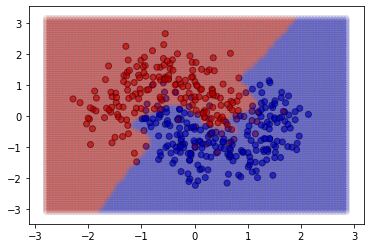

In [7]:
xx_new, yy_new = np.meshgrid(np.arange(x_min, x_max, 0.06),
                         np.arange(y_min, y_max, 0.06))
pred_dataset = np.c_[xx_new.ravel(), yy_new.ravel()]
print(pred_dataset.shape)
pred = autonet_cocktail.predict(pred_dataset)
print(y_test.shape)
print(pred.squeeze().shape)
# Plot the testing points
plt.scatter(X_test[:, 0], X_test[:, 1], c=y_test, cmap=cm_bright, alpha=0.6,
           edgecolors='k')
plt.scatter(xx_new.ravel(), yy_new.ravel(), c=pred.squeeze(), cmap=cm_bright, alpha=0.1,
           edgecolors='k')
plt.show()